In [1]:
%%javascript

window.scroll_flag = true
window.scroll_exit = false
window.scroll_delay = 100

$(".output_scroll").each(function() {
    $(this)[0].scrollTop = $(this)[0].scrollHeight;
});

function callScrollToBottom() {
    setTimeout(scrollToBottom, window.scroll_delay);
}

function scrollToBottom() {
    if (window.scroll_exit) {
        return;
    }
    if (!window.scroll_flag) {
        callScrollToBottom();
        return;
    };
    
    $(".output_scroll").each(function() {
        if (!$(this).attr('scroll_checkbox')){
            window.scroll_flag = true;
            $(this).attr('scroll_checkbox',true);
            var div = document.createElement('div');
            var checkbox = document.createElement('input');
            checkbox.type = "checkbox";
            checkbox.onclick = function(){window.scroll_flag = checkbox.checked}
            checkbox.checked = "checked"
            div.append("Auto-Scroll-To-Bottom: ");
            div.append(checkbox);
            $(this).parent().before(div);
        }
        
        $(this)[0].scrollTop = $(this)[0].scrollHeight;
    });
    callScrollToBottom();
}
scrollToBottom();

<IPython.core.display.Javascript object>

In [2]:
import torch
import torch.nn as nn
import torchvision
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data as data
import os
import sys
import argparse
import time
import numpy as np
from torchvision import transforms
import glob
from PIL import Image
import cv2
import matplotlib.pyplot as plt
from torchvision import transforms
from matplotlib import pyplot as plt
from natsort import natsorted

# Dataloader

In [3]:
#Loading images paths
path = "L:\\BOUDIAF\\Dataset001\\"
rgb_list = sorted(glob.glob(os.path.join(path, 'rgb\\*.png')))
depth_list = sorted(glob.glob(os.path.join(path, 'depth\\*.png')))

In [4]:
#Loading steering direction
filename = 'L:\\BOUDIAF\\Dataset001\\steering_angels.csv'
steering = np.loadtxt(filename, delimiter=',', skiprows=0, dtype=np.float64)
steering = steering[14:]
#Convert steering angle to calsses
steering_idx = []
for i in steering:
    if(i == 0):
        steering_idx.append(0)
    elif(i == 0.5):
        steering_idx.append(1)
    elif(i == -0.5):
        steering_idx.append(2)

In [5]:
#Number of classes (srtight, left and right) in data
steering_idx.count(0), steering_idx.count(1), steering_idx.count(2)

(31373, 3856, 2554)

In [6]:
stright_idxs = [i for i, x in enumerate(steering_idx) if x == 0]
right_idxs = [i for i, x in enumerate(steering_idx) if x == 1]
left_idxs = [i for i, x in enumerate(steering_idx) if x == 2]

In [7]:
class Dataset(torch.utils.data.Dataset):
  
    def __init__(self, data, window):
        self.data = data
        self.window = window

    def __getitem__(self, index):
        images = np.empty((1,144, 256, 1), dtype= np.float32)
        if (index+self.window) <= len(self.data):
            x = self.data[index:index+self.window]
            for path in x:
                img = cv2.imread(path, 0).astype(np.float32) 
                img /= 255.
                img = np.expand_dims(img, axis=-1)
                images = np.append(images, np.expand_dims(img, axis=0), axis=0)
            return [np.moveaxis(images[1:], -1, 0) , steering_idx[index]]

    def __len__(self):
        return (len(self.data) - self.window) + 1 

In [8]:
train_dataset = Dataset(rgb_list, 15)

In [9]:
w1 = 1 - (len(stright_idxs)/len(train_dataset))
w2 = 1 - (len(right_idxs)/len(train_dataset))
w3 = 1 - (len(left_idxs)/len(train_dataset))

In [10]:
class_weights = []
for i in steering_idx:
    if(i == 0):
        class_weights.append(w1)
    elif(i == 1):
        class_weights.append(w2)
    elif(i == 2):
        class_weights.append(w3)

In [11]:
WeightSampler = torch.utils.data.WeightedRandomSampler(class_weights, len(class_weights))

In [12]:
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=False, sampler=WeightSampler)

In [13]:
for idx, (input_img, gt) in enumerate(train_loader):
    break

In [13]:
type(input_img), type(gt)

(torch.Tensor, torch.Tensor)

In [14]:
input_img.shape, gt.shape

(torch.Size([1, 1, 15, 144, 256]), torch.Size([1]))

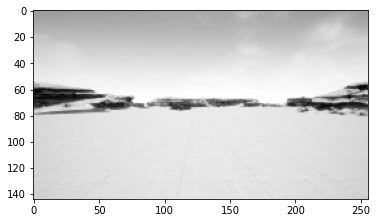

0


In [15]:
tst = input_img[0].numpy()
tst = np.moveaxis(tst, 0, -1)[0]
plt.imshow(tst, cmap="gray")
plt.show()
print(gt.item())

# Network

In [14]:
class NavNet(nn.Module):
    def __init__(self):
        super(NavNet, self).__init__()

        self.relu = nn.ReLU(inplace=True)

        self.conv3d_1_1 = nn.Conv3d(1, 8, 3, stride=1, padding='same') 
        self.conv3d_1_2 = nn.Conv3d(8, 8, 3, stride=1, padding='same', dilation=1, groups=1, bias=True, padding_mode='zeros') 
        self.conv3d_2_1 = nn.Conv3d(8, 16, 3, stride=1, padding='same', dilation=1, groups=1, bias=True, padding_mode='zeros') 
        self.conv3d_2_2 = nn.Conv3d(16, 16, 3, stride=1, padding='same', dilation=1, groups=1, bias=True, padding_mode='zeros') 
        self.fc1 = nn.Linear(1179648, 100, bias=True)
        self.fc2 = nn.Linear(100, 100, bias=True)
        self.fc3 = nn.Linear(100, 3, bias=True)

        self.max = nn.AdaptiveAvgPool3d((72,128,8)) 

    def forward(self, x):
        source = []
        source.append(x)
#         print("input: ",x.shape[-1])
#         print("input: ",x.shape)
        x1 = self.relu(self.conv3d_1_1(x))
#         print("output1: ",x1.shape)
        x2 = self.relu(self.conv3d_1_2(x1))
#         print("output2: ",x2.shape)


        max1 = self.max(x2)
#         print("output max1: ",max1.shape)
   
    
        x3 = self.relu(self.conv3d_2_1(max1))
#         print("output3: ",x3.shape)
        x4 = self.relu(self.conv3d_2_2(x3))
#         print("output4: ",x4.shape)

        # concat3 = torch.cat((x1,x2,x3,x4),1)
#         print("output5: ",torch.flatten(x4).shape)
        x5 = self.relu(self.fc1(torch.flatten(x4)))
#         print("output5: ",x5.shape)
        x6 = self.relu(self.fc2(x5))
        x7 = self.relu(self.fc3(x6))
        max_index = (x7 == torch.max(x7).item()).nonzero(as_tuple=True)[0]

        return max_index, x7

# Training

In [15]:
device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')

In [16]:
import torch.optim as optim

In [22]:
model = NavNet().to(device)
loss = torch.nn.CrossEntropyLoss()
# optimizer = torch.optim.Adam(NavNet().parameters(), lr=0.0001, weight_decay=0)
optimizer = optim.SGD(model.parameters(), lr=0.00005, momentum=0.4)

In [46]:
#Batch size 1
l = len(rgb_list)
loss_file = open('L:\\BOUDIAF\\Nav\\model001\\read_me.txt', 'a')
loss_file.truncate(0) #Delete everything in the txt file
for epoch in range(10):
    print("**************** epoch ", str(epoch), "****************")
    for idx, (input_img, gt) in enumerate(train_loader):
        torch.cuda.empty_cache()
        optimizer.zero_grad()
        input_img = input_img.to(device)
        direction, output = model(input_img)
        gt = gt.to(device)
        lss = loss(torch.unsqueeze(output, 0), gt)
        lss.backward()
        optimizer.step()
        print(round(idx*100/l,2), '%   loss:',  round(lss.item(),3), "  class:", gt.item(),"   prediction:", direction[0].item()==gt.item())
        if(gt.item() == 0):
        loss_file.write('class0:'+ str(round(lss.item(),3)) +'\n') #Write into file
        elif(gt.item() == 1):
            loss_file.write('class1:'+ str(round(lss.item(),3)) +'\n') #Write into file
        elif(gt.item() == 2):
            loss_file.write('class2:'+ str(round(lss.item(),3)) +'\n') #Write into file 
    torch.save(model.state_dict(), "L:\\BOUDIAF\\Nav\\model001\\" + "Epoch" + str(epoch) + '.pth') 
loss_file.close()

**************** epoch  0 ****************
0.0 %   loss: 1.061   class: 2    prediction: True
0.0 %   loss: 1.123   class: 1    prediction: False
0.01 %   loss: 1.113   class: 0    prediction: False
0.01 %   loss: 1.113   class: 0    prediction: False
0.01 %   loss: 1.123   class: 1    prediction: False
0.01 %   loss: 1.123   class: 1    prediction: False
0.02 %   loss: 1.061   class: 2    prediction: True
0.02 %   loss: 1.061   class: 2    prediction: True
0.02 %   loss: 1.113   class: 0    prediction: False
0.02 %   loss: 1.123   class: 1    prediction: False
0.03 %   loss: 1.113   class: 0    prediction: False
0.03 %   loss: 1.061   class: 2    prediction: True
0.03 %   loss: 1.113   class: 0    prediction: False
0.03 %   loss: 1.061   class: 2    prediction: True
0.04 %   loss: 1.113   class: 0    prediction: False
0.04 %   loss: 1.112   class: 0    prediction: False
0.04 %   loss: 1.124   class: 1    prediction: False
0.04 %   loss: 1.112   class: 0    prediction: False
0.05 %   l

0.41 %   loss: 1.066   class: 2    prediction: True
0.41 %   loss: 1.105   class: 0    prediction: False
0.42 %   loss: 1.105   class: 0    prediction: False
0.42 %   loss: 1.066   class: 2    prediction: True
0.42 %   loss: 1.104   class: 0    prediction: False
0.42 %   loss: 1.104   class: 0    prediction: False
0.43 %   loss: 1.066   class: 2    prediction: True
0.43 %   loss: 1.104   class: 0    prediction: False
0.43 %   loss: 1.104   class: 0    prediction: False
0.43 %   loss: 1.127   class: 1    prediction: False
0.44 %   loss: 1.127   class: 1    prediction: False
0.44 %   loss: 1.104   class: 0    prediction: False
0.44 %   loss: 1.066   class: 2    prediction: True
0.44 %   loss: 1.127   class: 1    prediction: False
0.45 %   loss: 1.127   class: 1    prediction: False
0.45 %   loss: 1.104   class: 0    prediction: False
0.45 %   loss: 1.104   class: 0    prediction: False
0.46 %   loss: 1.104   class: 0    prediction: False
0.46 %   loss: 1.104   class: 0    prediction: Fal

0.83 %   loss: 1.072   class: 2    prediction: True
0.83 %   loss: 1.125   class: 1    prediction: False
0.83 %   loss: 1.125   class: 1    prediction: False
0.83 %   loss: 1.125   class: 1    prediction: False
0.84 %   loss: 1.125   class: 1    prediction: False
0.84 %   loss: 1.125   class: 1    prediction: False
0.84 %   loss: 1.099   class: 0    prediction: False
0.84 %   loss: 1.099   class: 0    prediction: False
0.85 %   loss: 1.124   class: 1    prediction: False
0.85 %   loss: 1.099   class: 0    prediction: False
0.85 %   loss: 1.099   class: 0    prediction: False
0.85 %   loss: 1.124   class: 1    prediction: False
0.86 %   loss: 1.124   class: 1    prediction: False
0.86 %   loss: 1.099   class: 0    prediction: False
0.86 %   loss: 1.099   class: 0    prediction: False
0.87 %   loss: 1.099   class: 0    prediction: False
0.87 %   loss: 1.124   class: 1    prediction: False
0.87 %   loss: 1.124   class: 1    prediction: False
0.87 %   loss: 1.124   class: 1    prediction: 

1.24 %   loss: 1.079   class: 2    prediction: True
1.24 %   loss: 1.079   class: 2    prediction: True
1.24 %   loss: 1.123   class: 1    prediction: False
1.25 %   loss: 1.095   class: 0    prediction: False
1.25 %   loss: 1.095   class: 0    prediction: False
1.25 %   loss: 1.095   class: 0    prediction: False
1.25 %   loss: 1.095   class: 0    prediction: False
1.26 %   loss: 1.095   class: 0    prediction: False
1.26 %   loss: 1.078   class: 2    prediction: True
1.26 %   loss: 1.123   class: 1    prediction: False
1.26 %   loss: 1.095   class: 0    prediction: False
1.27 %   loss: 1.095   class: 0    prediction: False
1.27 %   loss: 1.095   class: 0    prediction: False
1.27 %   loss: 1.095   class: 0    prediction: False
1.28 %   loss: 1.094   class: 0    prediction: False
1.28 %   loss: 1.079   class: 2    prediction: True
1.28 %   loss: 1.123   class: 1    prediction: False
1.28 %   loss: 1.094   class: 0    prediction: False
1.29 %   loss: 1.094   class: 0    prediction: Fal

1.65 %   loss: 1.091   class: 0    prediction: False
1.65 %   loss: 1.091   class: 0    prediction: False
1.66 %   loss: 1.091   class: 0    prediction: False
1.66 %   loss: 1.119   class: 1    prediction: False
1.66 %   loss: 1.119   class: 1    prediction: False
1.66 %   loss: 1.091   class: 0    prediction: False
1.67 %   loss: 1.091   class: 0    prediction: False
1.67 %   loss: 1.119   class: 1    prediction: False
1.67 %   loss: 1.119   class: 1    prediction: False
1.67 %   loss: 1.091   class: 0    prediction: False
1.68 %   loss: 1.087   class: 2    prediction: True
1.68 %   loss: 1.09   class: 0    prediction: False
1.68 %   loss: 1.118   class: 1    prediction: False
1.69 %   loss: 1.118   class: 1    prediction: False
1.69 %   loss: 1.088   class: 2    prediction: True
1.69 %   loss: 1.09   class: 0    prediction: False
1.69 %   loss: 1.09   class: 0    prediction: False
1.7 %   loss: 1.118   class: 1    prediction: False
1.7 %   loss: 1.118   class: 1    prediction: False


2.07 %   loss: 1.085   class: 0    prediction: True
2.07 %   loss: 1.085   class: 0    prediction: True
2.07 %   loss: 1.118   class: 1    prediction: False
2.07 %   loss: 1.085   class: 0    prediction: True
2.08 %   loss: 1.118   class: 1    prediction: False
2.08 %   loss: 1.118   class: 1    prediction: False
2.08 %   loss: 1.118   class: 1    prediction: False
2.08 %   loss: 1.117   class: 1    prediction: False
2.09 %   loss: 1.094   class: 2    prediction: False
2.09 %   loss: 1.085   class: 0    prediction: True
2.09 %   loss: 1.117   class: 1    prediction: False
2.1 %   loss: 1.094   class: 2    prediction: False
2.1 %   loss: 1.094   class: 2    prediction: False
2.1 %   loss: 1.094   class: 2    prediction: False
2.1 %   loss: 1.086   class: 0    prediction: True
2.11 %   loss: 1.117   class: 1    prediction: False
2.11 %   loss: 1.086   class: 0    prediction: True
2.11 %   loss: 1.117   class: 1    prediction: False
2.11 %   loss: 1.085   class: 0    prediction: True
2.12

2.48 %   loss: 1.082   class: 0    prediction: True
2.48 %   loss: 1.082   class: 0    prediction: True
2.49 %   loss: 1.117   class: 1    prediction: False
2.49 %   loss: 1.098   class: 2    prediction: False
2.49 %   loss: 1.081   class: 0    prediction: True
2.49 %   loss: 1.117   class: 1    prediction: False
2.5 %   loss: 1.117   class: 1    prediction: False
2.5 %   loss: 1.098   class: 2    prediction: False
2.5 %   loss: 1.117   class: 1    prediction: False
2.51 %   loss: 1.081   class: 0    prediction: True
2.51 %   loss: 1.081   class: 0    prediction: True
2.51 %   loss: 1.081   class: 0    prediction: True
2.51 %   loss: 1.098   class: 2    prediction: False
2.52 %   loss: 1.081   class: 0    prediction: True
2.52 %   loss: 1.098   class: 2    prediction: False
2.52 %   loss: 1.081   class: 0    prediction: True
2.52 %   loss: 1.098   class: 2    prediction: False
2.53 %   loss: 1.117   class: 1    prediction: False
2.53 %   loss: 1.117   class: 1    prediction: False
2.53

2.9 %   loss: 1.077   class: 0    prediction: True
2.9 %   loss: 1.101   class: 2    prediction: False
2.9 %   loss: 1.077   class: 0    prediction: True
2.9 %   loss: 1.118   class: 1    prediction: False
2.91 %   loss: 1.118   class: 1    prediction: False
2.91 %   loss: 1.118   class: 1    prediction: False
2.91 %   loss: 1.101   class: 2    prediction: False
2.92 %   loss: 1.101   class: 2    prediction: False
2.92 %   loss: 1.101   class: 2    prediction: False
2.92 %   loss: 1.077   class: 0    prediction: True
2.92 %   loss: 1.118   class: 1    prediction: False
2.93 %   loss: 1.077   class: 0    prediction: True
2.93 %   loss: 1.101   class: 2    prediction: False
2.93 %   loss: 1.118   class: 1    prediction: False
2.93 %   loss: 1.118   class: 1    prediction: False
2.94 %   loss: 1.077   class: 0    prediction: True
2.94 %   loss: 1.101   class: 2    prediction: False
2.94 %   loss: 1.118   class: 1    prediction: False
2.94 %   loss: 1.118   class: 1    prediction: False
2.

3.31 %   loss: 1.121   class: 1    prediction: False
3.32 %   loss: 1.121   class: 1    prediction: False
3.32 %   loss: 1.12   class: 1    prediction: False
3.32 %   loss: 1.12   class: 1    prediction: False
3.32 %   loss: 1.073   class: 0    prediction: True
3.33 %   loss: 1.103   class: 2    prediction: False
3.33 %   loss: 1.12   class: 1    prediction: False
3.33 %   loss: 1.12   class: 1    prediction: False
3.33 %   loss: 1.073   class: 0    prediction: True
3.34 %   loss: 1.073   class: 0    prediction: True
3.34 %   loss: 1.104   class: 2    prediction: False
3.34 %   loss: 1.12   class: 1    prediction: False
3.34 %   loss: 1.073   class: 0    prediction: True
3.35 %   loss: 1.073   class: 0    prediction: True
3.35 %   loss: 1.073   class: 0    prediction: True
3.35 %   loss: 1.103   class: 2    prediction: False
3.35 %   loss: 1.12   class: 1    prediction: False
3.36 %   loss: 1.103   class: 2    prediction: False
3.36 %   loss: 1.073   class: 0    prediction: True
3.36 %

3.73 %   loss: 1.068   class: 0    prediction: True
3.73 %   loss: 1.068   class: 0    prediction: True
3.74 %   loss: 1.068   class: 0    prediction: True
3.74 %   loss: 1.12   class: 1    prediction: False
3.74 %   loss: 1.068   class: 0    prediction: True
3.74 %   loss: 1.068   class: 0    prediction: True
3.75 %   loss: 1.068   class: 0    prediction: True
3.75 %   loss: 1.12   class: 1    prediction: False
3.75 %   loss: 1.067   class: 0    prediction: True
3.75 %   loss: 1.109   class: 2    prediction: False
3.76 %   loss: 1.12   class: 1    prediction: False
3.76 %   loss: 1.12   class: 1    prediction: False
3.76 %   loss: 1.067   class: 0    prediction: True
3.76 %   loss: 1.12   class: 1    prediction: False
3.77 %   loss: 1.067   class: 0    prediction: True
3.77 %   loss: 1.12   class: 1    prediction: False
3.77 %   loss: 1.12   class: 1    prediction: False
3.78 %   loss: 1.12   class: 1    prediction: False
3.78 %   loss: 1.11   class: 2    prediction: False
3.78 %   lo

4.15 %   loss: 1.118   class: 1    prediction: False
4.15 %   loss: 1.066   class: 0    prediction: True
4.15 %   loss: 1.066   class: 0    prediction: True
4.15 %   loss: 1.066   class: 0    prediction: True
4.16 %   loss: 1.112   class: 2    prediction: False
4.16 %   loss: 1.066   class: 0    prediction: True
4.16 %   loss: 1.119   class: 1    prediction: False
4.16 %   loss: 1.112   class: 2    prediction: False
4.17 %   loss: 1.112   class: 2    prediction: False
4.17 %   loss: 1.066   class: 0    prediction: True
4.17 %   loss: 1.112   class: 2    prediction: False
4.17 %   loss: 1.119   class: 1    prediction: False
4.18 %   loss: 1.066   class: 0    prediction: True
4.18 %   loss: 1.066   class: 0    prediction: True
4.18 %   loss: 1.066   class: 0    prediction: True
4.19 %   loss: 1.066   class: 0    prediction: True
4.19 %   loss: 1.065   class: 0    prediction: True
4.19 %   loss: 1.112   class: 2    prediction: False
4.19 %   loss: 1.119   class: 1    prediction: False
4.2

4.56 %   loss: 1.118   class: 1    prediction: False
4.56 %   loss: 1.062   class: 0    prediction: True
4.57 %   loss: 1.117   class: 1    prediction: False
4.57 %   loss: 1.117   class: 1    prediction: False
4.57 %   loss: 1.062   class: 0    prediction: True
4.57 %   loss: 1.117   class: 1    prediction: False
4.58 %   loss: 1.119   class: 2    prediction: False
4.58 %   loss: 1.117   class: 1    prediction: False
4.58 %   loss: 1.119   class: 2    prediction: False
4.59 %   loss: 1.118   class: 2    prediction: False
4.59 %   loss: 1.118   class: 2    prediction: False
4.59 %   loss: 1.117   class: 1    prediction: False
4.59 %   loss: 1.062   class: 0    prediction: True
4.6 %   loss: 1.117   class: 1    prediction: False
4.6 %   loss: 1.118   class: 2    prediction: False
4.6 %   loss: 1.117   class: 1    prediction: False
4.6 %   loss: 1.062   class: 0    prediction: True
4.61 %   loss: 1.117   class: 1    prediction: False
4.61 %   loss: 1.117   class: 1    prediction: False
4

4.98 %   loss: 1.061   class: 0    prediction: True
4.98 %   loss: 1.125   class: 2    prediction: False
4.98 %   loss: 1.125   class: 2    prediction: False
4.98 %   loss: 1.06   class: 0    prediction: True
4.99 %   loss: 1.06   class: 0    prediction: True
4.99 %   loss: 1.125   class: 2    prediction: False
4.99 %   loss: 1.125   class: 2    prediction: False
5.0 %   loss: 1.06   class: 0    prediction: True
5.0 %   loss: 1.112   class: 1    prediction: False
5.0 %   loss: 1.124   class: 2    prediction: False
5.0 %   loss: 1.06   class: 0    prediction: True
5.01 %   loss: 1.113   class: 1    prediction: False
5.01 %   loss: 1.124   class: 2    prediction: False
5.01 %   loss: 1.112   class: 1    prediction: False
5.01 %   loss: 1.06   class: 0    prediction: True
5.02 %   loss: 1.06   class: 0    prediction: True
5.02 %   loss: 1.06   class: 0    prediction: True
5.02 %   loss: 1.112   class: 1    prediction: False
5.02 %   loss: 1.06   class: 0    prediction: True
5.03 %   loss:

5.39 %   loss: 1.133   class: 2    prediction: False
5.39 %   loss: 1.109   class: 1    prediction: False
5.4 %   loss: 1.056   class: 0    prediction: True
5.4 %   loss: 1.055   class: 0    prediction: True
5.4 %   loss: 1.109   class: 1    prediction: False
5.41 %   loss: 1.109   class: 1    prediction: False
5.41 %   loss: 1.133   class: 2    prediction: False
5.41 %   loss: 1.055   class: 0    prediction: True
5.41 %   loss: 1.055   class: 0    prediction: True
5.42 %   loss: 1.108   class: 1    prediction: False
5.42 %   loss: 1.134   class: 2    prediction: False
5.42 %   loss: 1.109   class: 1    prediction: False
5.42 %   loss: 1.055   class: 0    prediction: True
5.43 %   loss: 1.134   class: 2    prediction: False
5.43 %   loss: 1.055   class: 0    prediction: True
5.43 %   loss: 1.109   class: 1    prediction: False
5.43 %   loss: 1.055   class: 0    prediction: True
5.44 %   loss: 1.055   class: 0    prediction: True
5.44 %   loss: 1.055   class: 0    prediction: True
5.44 

5.81 %   loss: 1.052   class: 0    prediction: True
5.81 %   loss: 1.137   class: 2    prediction: False
5.81 %   loss: 1.052   class: 0    prediction: True
5.82 %   loss: 1.052   class: 0    prediction: True
5.82 %   loss: 1.052   class: 0    prediction: True
5.82 %   loss: 1.109   class: 1    prediction: False
5.82 %   loss: 1.052   class: 0    prediction: True
5.83 %   loss: 1.051   class: 0    prediction: True
5.83 %   loss: 1.051   class: 0    prediction: True
5.83 %   loss: 1.137   class: 2    prediction: False
5.83 %   loss: 1.108   class: 1    prediction: False
5.84 %   loss: 1.108   class: 1    prediction: False
5.84 %   loss: 1.108   class: 1    prediction: False
5.84 %   loss: 1.051   class: 0    prediction: True
5.84 %   loss: 1.051   class: 0    prediction: True
5.85 %   loss: 1.051   class: 0    prediction: True
5.85 %   loss: 1.051   class: 0    prediction: True
5.85 %   loss: 1.051   class: 0    prediction: True
5.85 %   loss: 1.051   class: 0    prediction: True
5.86 %

6.22 %   loss: 1.048   class: 0    prediction: True
6.23 %   loss: 1.048   class: 0    prediction: True
6.23 %   loss: 1.048   class: 0    prediction: True
6.23 %   loss: 1.048   class: 0    prediction: True
6.23 %   loss: 1.048   class: 0    prediction: True
6.24 %   loss: 1.048   class: 0    prediction: True
6.24 %   loss: 1.048   class: 0    prediction: True
6.24 %   loss: 1.107   class: 1    prediction: False
6.24 %   loss: 1.108   class: 1    prediction: False
6.25 %   loss: 1.107   class: 1    prediction: False
6.25 %   loss: 1.047   class: 0    prediction: True
6.25 %   loss: 1.144   class: 2    prediction: False
6.25 %   loss: 1.107   class: 1    prediction: False
6.26 %   loss: 1.144   class: 2    prediction: False
6.26 %   loss: 1.107   class: 1    prediction: False
6.26 %   loss: 1.047   class: 0    prediction: True
6.27 %   loss: 1.107   class: 1    prediction: False
6.27 %   loss: 1.144   class: 2    prediction: False
6.27 %   loss: 1.143   class: 2    prediction: False
6.

6.64 %   loss: 1.043   class: 0    prediction: True
6.64 %   loss: 1.043   class: 0    prediction: True
6.64 %   loss: 1.105   class: 1    prediction: False
6.65 %   loss: 1.106   class: 1    prediction: False
6.65 %   loss: 1.151   class: 2    prediction: False
6.65 %   loss: 1.043   class: 0    prediction: True
6.65 %   loss: 1.105   class: 1    prediction: False
6.66 %   loss: 1.043   class: 0    prediction: True
6.66 %   loss: 1.105   class: 1    prediction: False
6.66 %   loss: 1.042   class: 0    prediction: True
6.66 %   loss: 1.105   class: 1    prediction: False
6.67 %   loss: 1.105   class: 1    prediction: False
6.67 %   loss: 1.152   class: 2    prediction: False
6.67 %   loss: 1.042   class: 0    prediction: True
6.68 %   loss: 1.043   class: 0    prediction: True
6.68 %   loss: 1.042   class: 0    prediction: True
6.68 %   loss: 1.042   class: 0    prediction: True
6.68 %   loss: 1.152   class: 2    prediction: False
6.69 %   loss: 1.042   class: 0    prediction: True
6.6

7.05 %   loss: 1.104   class: 1    prediction: False
7.06 %   loss: 1.038   class: 0    prediction: True
7.06 %   loss: 1.038   class: 0    prediction: True
7.06 %   loss: 1.104   class: 1    prediction: False
7.06 %   loss: 1.104   class: 1    prediction: False
7.07 %   loss: 1.038   class: 0    prediction: True
7.07 %   loss: 1.038   class: 0    prediction: True
7.07 %   loss: 1.037   class: 0    prediction: True
7.07 %   loss: 1.104   class: 1    prediction: False
7.08 %   loss: 1.104   class: 1    prediction: False
7.08 %   loss: 1.103   class: 1    prediction: False
7.08 %   loss: 1.037   class: 0    prediction: True
7.09 %   loss: 1.159   class: 2    prediction: False
7.09 %   loss: 1.159   class: 2    prediction: False
7.09 %   loss: 1.103   class: 1    prediction: False
7.09 %   loss: 1.037   class: 0    prediction: True
7.1 %   loss: 1.037   class: 0    prediction: True
7.1 %   loss: 1.037   class: 0    prediction: True
7.1 %   loss: 1.158   class: 2    prediction: False
7.1 %

7.47 %   loss: 1.034   class: 0    prediction: True
7.47 %   loss: 1.034   class: 0    prediction: True
7.47 %   loss: 1.166   class: 2    prediction: False
7.48 %   loss: 1.034   class: 0    prediction: True
7.48 %   loss: 1.1   class: 1    prediction: False
7.48 %   loss: 1.1   class: 1    prediction: False
7.48 %   loss: 1.1   class: 1    prediction: False
7.49 %   loss: 1.1   class: 1    prediction: False
7.49 %   loss: 1.166   class: 2    prediction: False
7.49 %   loss: 1.167   class: 2    prediction: False
7.5 %   loss: 1.034   class: 0    prediction: True
7.5 %   loss: 1.034   class: 0    prediction: True
7.5 %   loss: 1.099   class: 1    prediction: False
7.5 %   loss: 1.167   class: 2    prediction: False
7.51 %   loss: 1.1   class: 1    prediction: False
7.51 %   loss: 1.167   class: 2    prediction: False
7.51 %   loss: 1.1   class: 1    prediction: False
7.51 %   loss: 1.034   class: 0    prediction: True
7.52 %   loss: 1.034   class: 0    prediction: True
7.52 %   loss: 1

7.89 %   loss: 1.1   class: 1    prediction: False
7.89 %   loss: 1.03   class: 0    prediction: True
7.89 %   loss: 1.1   class: 1    prediction: False
7.89 %   loss: 1.03   class: 0    prediction: True
7.9 %   loss: 1.03   class: 0    prediction: True
7.9 %   loss: 1.1   class: 1    prediction: False
7.9 %   loss: 1.03   class: 0    prediction: True
7.91 %   loss: 1.03   class: 0    prediction: True
7.91 %   loss: 1.03   class: 0    prediction: True
7.91 %   loss: 1.1   class: 1    prediction: False
7.91 %   loss: 1.03   class: 0    prediction: True
7.92 %   loss: 1.1   class: 1    prediction: False
7.92 %   loss: 1.03   class: 0    prediction: True
7.92 %   loss: 1.1   class: 1    prediction: False
7.92 %   loss: 1.03   class: 0    prediction: True
7.93 %   loss: 1.03   class: 0    prediction: True
7.93 %   loss: 1.1   class: 1    prediction: False
7.93 %   loss: 1.172   class: 2    prediction: False
7.93 %   loss: 1.1   class: 1    prediction: False
7.94 %   loss: 1.1   class: 1   

8.31 %   loss: 1.1   class: 1    prediction: False
8.31 %   loss: 1.1   class: 1    prediction: False
8.31 %   loss: 1.1   class: 1    prediction: False
8.32 %   loss: 1.173   class: 2    prediction: False
8.32 %   loss: 1.028   class: 0    prediction: True
8.32 %   loss: 1.174   class: 2    prediction: False
8.32 %   loss: 1.174   class: 2    prediction: False
8.33 %   loss: 1.028   class: 0    prediction: True
8.33 %   loss: 1.1   class: 1    prediction: False
8.33 %   loss: 1.1   class: 1    prediction: False
8.33 %   loss: 1.028   class: 0    prediction: True
8.34 %   loss: 1.173   class: 2    prediction: False
8.34 %   loss: 1.028   class: 0    prediction: True
8.34 %   loss: 1.099   class: 1    prediction: False
8.34 %   loss: 1.174   class: 2    prediction: False
8.35 %   loss: 1.1   class: 1    prediction: False
8.35 %   loss: 1.028   class: 0    prediction: True
8.35 %   loss: 1.174   class: 2    prediction: False
8.36 %   loss: 1.028   class: 0    prediction: True
8.36 %   lo

8.73 %   loss: 1.176   class: 2    prediction: False
8.73 %   loss: 1.025   class: 0    prediction: True
8.73 %   loss: 1.101   class: 1    prediction: False
8.73 %   loss: 1.175   class: 2    prediction: False
8.74 %   loss: 1.174   class: 2    prediction: False
8.74 %   loss: 1.102   class: 1    prediction: False
8.74 %   loss: 1.102   class: 1    prediction: False
8.74 %   loss: 1.102   class: 1    prediction: False
8.75 %   loss: 1.175   class: 2    prediction: False
8.75 %   loss: 1.025   class: 0    prediction: True
8.75 %   loss: 1.175   class: 2    prediction: False
8.75 %   loss: 1.025   class: 0    prediction: True
8.76 %   loss: 1.025   class: 0    prediction: True
8.76 %   loss: 1.101   class: 1    prediction: False
8.76 %   loss: 1.101   class: 1    prediction: False
8.77 %   loss: 1.026   class: 0    prediction: True
8.77 %   loss: 1.175   class: 2    prediction: False
8.77 %   loss: 1.025   class: 0    prediction: True
8.77 %   loss: 1.025   class: 0    prediction: True


9.14 %   loss: 1.022   class: 0    prediction: True
9.14 %   loss: 1.022   class: 0    prediction: True
9.15 %   loss: 1.102   class: 1    prediction: False
9.15 %   loss: 1.022   class: 0    prediction: True
9.15 %   loss: 1.102   class: 1    prediction: False
9.15 %   loss: 1.102   class: 1    prediction: False
9.16 %   loss: 1.103   class: 1    prediction: False
9.16 %   loss: 1.102   class: 1    prediction: False
9.16 %   loss: 1.022   class: 0    prediction: True
9.16 %   loss: 1.022   class: 0    prediction: True
9.17 %   loss: 1.178   class: 2    prediction: False
9.17 %   loss: 1.022   class: 0    prediction: True
9.17 %   loss: 1.022   class: 0    prediction: True
9.18 %   loss: 1.022   class: 0    prediction: True
9.18 %   loss: 1.178   class: 2    prediction: False
9.18 %   loss: 1.102   class: 1    prediction: False
9.18 %   loss: 1.102   class: 1    prediction: False
9.19 %   loss: 1.022   class: 0    prediction: True
9.19 %   loss: 1.102   class: 1    prediction: False
9.

9.56 %   loss: 1.181   class: 2    prediction: False
9.56 %   loss: 1.102   class: 1    prediction: False
9.56 %   loss: 1.019   class: 0    prediction: True
9.56 %   loss: 1.102   class: 1    prediction: False
9.57 %   loss: 1.019   class: 0    prediction: True
9.57 %   loss: 1.019   class: 0    prediction: True
9.57 %   loss: 1.181   class: 2    prediction: False
9.57 %   loss: 1.019   class: 0    prediction: True
9.58 %   loss: 1.102   class: 1    prediction: False
9.58 %   loss: 1.019   class: 0    prediction: True
9.58 %   loss: 1.181   class: 2    prediction: False
9.59 %   loss: 1.019   class: 0    prediction: True
9.59 %   loss: 1.102   class: 1    prediction: False
9.59 %   loss: 1.102   class: 1    prediction: False
9.59 %   loss: 1.019   class: 0    prediction: True
9.6 %   loss: 1.019   class: 0    prediction: True
9.6 %   loss: 1.181   class: 2    prediction: False
9.6 %   loss: 1.019   class: 0    prediction: True
9.6 %   loss: 1.019   class: 0    prediction: True
9.61 % 

9.97 %   loss: 1.015   class: 0    prediction: True
9.97 %   loss: 1.015   class: 0    prediction: True
9.98 %   loss: 1.104   class: 1    prediction: False
9.98 %   loss: 1.104   class: 1    prediction: False
9.98 %   loss: 1.014   class: 0    prediction: True
9.98 %   loss: 1.104   class: 1    prediction: False
9.99 %   loss: 1.015   class: 0    prediction: True
9.99 %   loss: 1.015   class: 0    prediction: True
9.99 %   loss: 1.185   class: 2    prediction: False
10.0 %   loss: 1.014   class: 0    prediction: True
10.0 %   loss: 1.104   class: 1    prediction: False
10.0 %   loss: 1.104   class: 1    prediction: False
10.0 %   loss: 1.104   class: 1    prediction: False
10.01 %   loss: 1.104   class: 1    prediction: False
10.01 %   loss: 1.185   class: 2    prediction: False
10.01 %   loss: 1.185   class: 2    prediction: False
10.01 %   loss: 1.015   class: 0    prediction: True
10.02 %   loss: 1.015   class: 0    prediction: True
10.02 %   loss: 1.015   class: 0    prediction: T

10.38 %   loss: 1.105   class: 1    prediction: False
10.38 %   loss: 1.012   class: 0    prediction: True
10.38 %   loss: 1.105   class: 1    prediction: False
10.39 %   loss: 1.105   class: 1    prediction: False
10.39 %   loss: 1.187   class: 2    prediction: False
10.39 %   loss: 1.012   class: 0    prediction: True
10.4 %   loss: 1.187   class: 2    prediction: False
10.4 %   loss: 1.105   class: 1    prediction: False
10.4 %   loss: 1.105   class: 1    prediction: False
10.4 %   loss: 1.012   class: 0    prediction: True
10.41 %   loss: 1.012   class: 0    prediction: True
10.41 %   loss: 1.012   class: 0    prediction: True
10.41 %   loss: 1.105   class: 1    prediction: False
10.41 %   loss: 1.105   class: 1    prediction: False
10.42 %   loss: 1.105   class: 1    prediction: False
10.42 %   loss: 1.012   class: 0    prediction: True
10.42 %   loss: 1.187   class: 2    prediction: False
10.42 %   loss: 1.012   class: 0    prediction: True
10.43 %   loss: 1.012   class: 0    pre

10.79 %   loss: 1.009   class: 0    prediction: True
10.79 %   loss: 1.009   class: 0    prediction: True
10.79 %   loss: 1.009   class: 0    prediction: True
10.79 %   loss: 1.19   class: 2    prediction: False
10.8 %   loss: 1.105   class: 1    prediction: False
10.8 %   loss: 1.009   class: 0    prediction: True
10.8 %   loss: 1.19   class: 2    prediction: False
10.81 %   loss: 1.19   class: 2    prediction: False
10.81 %   loss: 1.19   class: 2    prediction: False
10.81 %   loss: 1.19   class: 2    prediction: False
10.81 %   loss: 1.19   class: 2    prediction: False
10.82 %   loss: 1.19   class: 2    prediction: False
10.82 %   loss: 1.009   class: 0    prediction: True
10.82 %   loss: 1.105   class: 1    prediction: False
10.82 %   loss: 1.189   class: 2    prediction: False
10.83 %   loss: 1.19   class: 2    prediction: False
10.83 %   loss: 1.189   class: 2    prediction: False
10.83 %   loss: 1.009   class: 0    prediction: True
10.83 %   loss: 1.105   class: 1    predictio

11.19 %   loss: 1.007   class: 0    prediction: True
11.2 %   loss: 1.19   class: 2    prediction: False
11.2 %   loss: 1.007   class: 0    prediction: True
11.2 %   loss: 1.007   class: 0    prediction: True
11.2 %   loss: 1.107   class: 1    prediction: False
11.21 %   loss: 1.007   class: 0    prediction: True
11.21 %   loss: 1.107   class: 1    prediction: False
11.21 %   loss: 1.007   class: 0    prediction: True
11.22 %   loss: 1.191   class: 2    prediction: False
11.22 %   loss: 1.007   class: 0    prediction: True
11.22 %   loss: 1.107   class: 1    prediction: False
11.22 %   loss: 1.007   class: 0    prediction: True
11.23 %   loss: 1.007   class: 0    prediction: True
11.23 %   loss: 1.19   class: 2    prediction: False
11.23 %   loss: 1.007   class: 0    prediction: True
11.23 %   loss: 1.107   class: 1    prediction: False
11.24 %   loss: 1.007   class: 0    prediction: True
11.24 %   loss: 1.107   class: 1    prediction: False
11.24 %   loss: 1.191   class: 2    predicti

11.6 %   loss: 1.106   class: 1    prediction: False
11.6 %   loss: 1.006   class: 0    prediction: True
11.61 %   loss: 1.006   class: 0    prediction: True
11.61 %   loss: 1.106   class: 1    prediction: False
11.61 %   loss: 1.192   class: 2    prediction: False
11.61 %   loss: 1.192   class: 2    prediction: False
11.62 %   loss: 1.106   class: 1    prediction: False
11.62 %   loss: 1.192   class: 2    prediction: False
11.62 %   loss: 1.106   class: 1    prediction: False
11.63 %   loss: 1.006   class: 0    prediction: True
11.63 %   loss: 1.006   class: 0    prediction: True
11.63 %   loss: 1.106   class: 1    prediction: False
11.63 %   loss: 1.006   class: 0    prediction: True
11.64 %   loss: 1.192   class: 2    prediction: False
11.64 %   loss: 1.106   class: 1    prediction: False
11.64 %   loss: 1.006   class: 0    prediction: True
11.64 %   loss: 1.106   class: 1    prediction: False
11.65 %   loss: 1.006   class: 0    prediction: True
11.65 %   loss: 1.192   class: 2    p

12.01 %   loss: 1.002   class: 0    prediction: True
12.01 %   loss: 1.194   class: 2    prediction: False
12.01 %   loss: 1.002   class: 0    prediction: True
12.02 %   loss: 1.195   class: 2    prediction: False
12.02 %   loss: 1.195   class: 2    prediction: False
12.02 %   loss: 1.109   class: 1    prediction: False
12.02 %   loss: 1.002   class: 0    prediction: True
12.03 %   loss: 1.002   class: 0    prediction: True
12.03 %   loss: 1.194   class: 2    prediction: False
12.03 %   loss: 1.109   class: 1    prediction: False
12.04 %   loss: 1.003   class: 0    prediction: True
12.04 %   loss: 1.002   class: 0    prediction: True
12.04 %   loss: 1.194   class: 2    prediction: False
12.04 %   loss: 1.109   class: 1    prediction: False
12.05 %   loss: 1.002   class: 0    prediction: True
12.05 %   loss: 1.002   class: 0    prediction: True
12.05 %   loss: 1.109   class: 1    prediction: False
12.05 %   loss: 1.002   class: 0    prediction: True
12.06 %   loss: 1.002   class: 0    p

12.42 %   loss: 0.998   class: 0    prediction: True
12.42 %   loss: 0.998   class: 0    prediction: True
12.42 %   loss: 1.11   class: 1    prediction: False
12.43 %   loss: 0.998   class: 0    prediction: True
12.43 %   loss: 1.198   class: 2    prediction: False
12.43 %   loss: 0.998   class: 0    prediction: True
12.43 %   loss: 0.998   class: 0    prediction: True
12.44 %   loss: 1.11   class: 1    prediction: False
12.44 %   loss: 1.11   class: 1    prediction: False
12.44 %   loss: 0.998   class: 0    prediction: True
12.45 %   loss: 1.11   class: 1    prediction: False
12.45 %   loss: 1.11   class: 1    prediction: False
12.45 %   loss: 1.11   class: 1    prediction: False
12.45 %   loss: 0.998   class: 0    prediction: True
12.46 %   loss: 1.11   class: 1    prediction: False
12.46 %   loss: 1.11   class: 1    prediction: False
12.46 %   loss: 0.998   class: 0    prediction: True
12.46 %   loss: 1.11   class: 1    prediction: False
12.47 %   loss: 0.998   class: 0    predictio

12.83 %   loss: 1.111   class: 1    prediction: False
12.83 %   loss: 1.201   class: 2    prediction: False
12.83 %   loss: 1.111   class: 1    prediction: False
12.84 %   loss: 0.994   class: 0    prediction: True
12.84 %   loss: 1.111   class: 1    prediction: False
12.84 %   loss: 0.995   class: 0    prediction: True
12.84 %   loss: 1.111   class: 1    prediction: False
12.85 %   loss: 1.201   class: 2    prediction: False
12.85 %   loss: 0.995   class: 0    prediction: True
12.85 %   loss: 1.111   class: 1    prediction: False
12.86 %   loss: 1.202   class: 2    prediction: False
12.86 %   loss: 0.995   class: 0    prediction: True
12.86 %   loss: 0.995   class: 0    prediction: True
12.86 %   loss: 1.111   class: 1    prediction: False
12.87 %   loss: 0.994   class: 0    prediction: True
12.87 %   loss: 0.994   class: 0    prediction: True
12.87 %   loss: 0.995   class: 0    prediction: True
12.87 %   loss: 0.994   class: 0    prediction: True
12.88 %   loss: 0.994   class: 0    p

13.24 %   loss: 1.204   class: 2    prediction: False
13.24 %   loss: 1.204   class: 2    prediction: False
13.24 %   loss: 1.111   class: 1    prediction: False
13.24 %   loss: 1.111   class: 1    prediction: False
13.25 %   loss: 1.111   class: 1    prediction: False
13.25 %   loss: 0.992   class: 0    prediction: True
13.25 %   loss: 0.992   class: 0    prediction: True
13.26 %   loss: 0.992   class: 0    prediction: True
13.26 %   loss: 1.111   class: 1    prediction: False
13.26 %   loss: 0.992   class: 0    prediction: True
13.26 %   loss: 0.991   class: 0    prediction: True
13.27 %   loss: 0.992   class: 0    prediction: True
13.27 %   loss: 0.992   class: 0    prediction: True
13.27 %   loss: 1.111   class: 1    prediction: False
13.27 %   loss: 1.111   class: 1    prediction: False
13.28 %   loss: 0.991   class: 0    prediction: True
13.28 %   loss: 0.991   class: 0    prediction: True
13.28 %   loss: 0.991   class: 0    prediction: True
13.28 %   loss: 1.205   class: 2    pr

13.64 %   loss: 1.11   class: 1    prediction: False
13.65 %   loss: 0.991   class: 0    prediction: True
13.65 %   loss: 0.991   class: 0    prediction: True
13.65 %   loss: 0.991   class: 0    prediction: True
13.65 %   loss: 0.991   class: 0    prediction: True
13.66 %   loss: 1.206   class: 2    prediction: False
13.66 %   loss: 0.991   class: 0    prediction: True
13.66 %   loss: 0.991   class: 0    prediction: True
13.67 %   loss: 0.991   class: 0    prediction: True
13.67 %   loss: 1.11   class: 1    prediction: False
13.67 %   loss: 0.99   class: 0    prediction: True
13.67 %   loss: 0.99   class: 0    prediction: True
13.68 %   loss: 1.111   class: 1    prediction: False
13.68 %   loss: 0.99   class: 0    prediction: True
13.68 %   loss: 1.111   class: 1    prediction: False
13.68 %   loss: 0.99   class: 0    prediction: True
13.69 %   loss: 1.111   class: 1    prediction: False
13.69 %   loss: 0.991   class: 0    prediction: True
13.69 %   loss: 0.99   class: 0    prediction:

14.05 %   loss: 1.21   class: 2    prediction: False
14.06 %   loss: 1.112   class: 1    prediction: False
14.06 %   loss: 0.987   class: 0    prediction: True
14.06 %   loss: 1.112   class: 1    prediction: False
14.06 %   loss: 1.209   class: 2    prediction: False
14.07 %   loss: 0.987   class: 0    prediction: True
14.07 %   loss: 1.111   class: 1    prediction: False
14.07 %   loss: 1.21   class: 2    prediction: False
14.08 %   loss: 1.111   class: 1    prediction: False
14.08 %   loss: 1.111   class: 1    prediction: False
14.08 %   loss: 0.987   class: 0    prediction: True
14.08 %   loss: 1.111   class: 1    prediction: False
14.09 %   loss: 1.209   class: 2    prediction: False
14.09 %   loss: 0.987   class: 0    prediction: True
14.09 %   loss: 1.111   class: 1    prediction: False
14.09 %   loss: 0.987   class: 0    prediction: True
14.1 %   loss: 1.111   class: 1    prediction: False
14.1 %   loss: 0.987   class: 0    prediction: True
14.1 %   loss: 0.987   class: 0    pre

14.46 %   loss: 1.111   class: 1    prediction: False
14.46 %   loss: 0.986   class: 0    prediction: True
14.47 %   loss: 0.986   class: 0    prediction: True
14.47 %   loss: 1.111   class: 1    prediction: False
14.47 %   loss: 1.111   class: 1    prediction: False
14.47 %   loss: 0.986   class: 0    prediction: True
14.48 %   loss: 0.986   class: 0    prediction: True
14.48 %   loss: 1.111   class: 1    prediction: False
14.48 %   loss: 1.111   class: 1    prediction: False
14.49 %   loss: 0.986   class: 0    prediction: True
14.49 %   loss: 1.111   class: 1    prediction: False
14.49 %   loss: 0.986   class: 0    prediction: True
14.49 %   loss: 1.111   class: 1    prediction: False
14.5 %   loss: 1.111   class: 1    prediction: False
14.5 %   loss: 0.986   class: 0    prediction: True
14.5 %   loss: 0.986   class: 0    prediction: True
14.5 %   loss: 1.111   class: 1    prediction: False
14.51 %   loss: 0.986   class: 0    prediction: True
14.51 %   loss: 0.986   class: 0    predi

14.87 %   loss: 1.113   class: 1    prediction: False
14.87 %   loss: 1.215   class: 2    prediction: False
14.87 %   loss: 1.113   class: 1    prediction: False
14.88 %   loss: 1.113   class: 1    prediction: False
14.88 %   loss: 1.113   class: 1    prediction: False
14.88 %   loss: 1.214   class: 2    prediction: False
14.88 %   loss: 0.981   class: 0    prediction: True
14.89 %   loss: 1.113   class: 1    prediction: False
14.89 %   loss: 0.981   class: 0    prediction: True
14.89 %   loss: 0.981   class: 0    prediction: True
14.9 %   loss: 1.113   class: 1    prediction: False
14.9 %   loss: 0.981   class: 0    prediction: True
14.9 %   loss: 1.113   class: 1    prediction: False
14.9 %   loss: 1.113   class: 1    prediction: False
14.91 %   loss: 1.216   class: 2    prediction: False
14.91 %   loss: 0.981   class: 0    prediction: True
14.91 %   loss: 0.981   class: 0    prediction: True
14.91 %   loss: 0.981   class: 0    prediction: True
14.92 %   loss: 1.113   class: 1    pre

15.28 %   loss: 0.976   class: 0    prediction: True
15.28 %   loss: 1.115   class: 1    prediction: False
15.28 %   loss: 1.115   class: 1    prediction: False
15.28 %   loss: 1.115   class: 1    prediction: False
15.29 %   loss: 0.976   class: 0    prediction: True
15.29 %   loss: 0.976   class: 0    prediction: True
15.29 %   loss: 1.22   class: 2    prediction: False
15.29 %   loss: 1.22   class: 2    prediction: False
15.3 %   loss: 0.976   class: 0    prediction: True
15.3 %   loss: 1.115   class: 1    prediction: False
15.3 %   loss: 1.115   class: 1    prediction: False
15.31 %   loss: 0.976   class: 0    prediction: True
15.31 %   loss: 0.976   class: 0    prediction: True
15.31 %   loss: 0.976   class: 0    prediction: True
15.31 %   loss: 1.115   class: 1    prediction: False
15.32 %   loss: 1.115   class: 1    prediction: False
15.32 %   loss: 0.976   class: 0    prediction: True
15.32 %   loss: 1.115   class: 1    prediction: False
15.32 %   loss: 0.976   class: 0    predi

15.68 %   loss: 0.972   class: 0    prediction: True
15.69 %   loss: 1.223   class: 2    prediction: False
15.69 %   loss: 0.972   class: 0    prediction: True
15.69 %   loss: 1.116   class: 1    prediction: False
15.69 %   loss: 0.972   class: 0    prediction: True
15.7 %   loss: 0.972   class: 0    prediction: True
15.7 %   loss: 0.973   class: 0    prediction: True
15.7 %   loss: 1.116   class: 1    prediction: False
15.7 %   loss: 1.223   class: 2    prediction: False
15.71 %   loss: 0.972   class: 0    prediction: True
15.71 %   loss: 1.116   class: 1    prediction: False
15.71 %   loss: 0.972   class: 0    prediction: True
15.72 %   loss: 1.116   class: 1    prediction: False
15.72 %   loss: 0.972   class: 0    prediction: True
15.72 %   loss: 1.116   class: 1    prediction: False
15.72 %   loss: 0.972   class: 0    prediction: True
15.73 %   loss: 0.972   class: 0    prediction: True
15.73 %   loss: 0.972   class: 0    prediction: True
15.73 %   loss: 0.972   class: 0    predict

16.09 %   loss: 0.966   class: 0    prediction: True
16.09 %   loss: 0.967   class: 0    prediction: True
16.1 %   loss: 0.966   class: 0    prediction: True
16.1 %   loss: 0.966   class: 0    prediction: True
16.1 %   loss: 0.965   class: 0    prediction: True
16.1 %   loss: 0.966   class: 0    prediction: True
16.11 %   loss: 1.229   class: 2    prediction: False
16.11 %   loss: 0.966   class: 0    prediction: True
16.11 %   loss: 1.119   class: 1    prediction: False
16.12 %   loss: 1.119   class: 1    prediction: False
16.12 %   loss: 1.229   class: 2    prediction: False
16.12 %   loss: 1.229   class: 2    prediction: False
16.12 %   loss: 0.965   class: 0    prediction: True
16.13 %   loss: 0.965   class: 0    prediction: True
16.13 %   loss: 0.965   class: 0    prediction: True
16.13 %   loss: 0.965   class: 0    prediction: True
16.13 %   loss: 0.965   class: 0    prediction: True
16.14 %   loss: 0.965   class: 0    prediction: True
16.14 %   loss: 0.964   class: 0    predictio

16.5 %   loss: 0.962   class: 0    prediction: True
16.5 %   loss: 1.12   class: 1    prediction: False
16.5 %   loss: 1.232   class: 2    prediction: False
16.51 %   loss: 0.962   class: 0    prediction: True
16.51 %   loss: 0.962   class: 0    prediction: True
16.51 %   loss: 0.962   class: 0    prediction: True
16.51 %   loss: 0.962   class: 0    prediction: True
16.52 %   loss: 1.233   class: 2    prediction: False
16.52 %   loss: 0.961   class: 0    prediction: True
16.52 %   loss: 1.233   class: 2    prediction: False
16.53 %   loss: 0.961   class: 0    prediction: True
16.53 %   loss: 1.121   class: 1    prediction: False
16.53 %   loss: 0.961   class: 0    prediction: True
16.53 %   loss: 1.121   class: 1    prediction: False
16.54 %   loss: 0.961   class: 0    prediction: True
16.54 %   loss: 0.962   class: 0    prediction: True
16.54 %   loss: 0.961   class: 0    prediction: True
16.54 %   loss: 0.96   class: 0    prediction: True
16.55 %   loss: 0.96   class: 0    prediction

16.91 %   loss: 1.12   class: 1    prediction: False
16.91 %   loss: 0.959   class: 0    prediction: True
16.91 %   loss: 1.12   class: 1    prediction: False
16.92 %   loss: 0.958   class: 0    prediction: True
16.92 %   loss: 1.12   class: 1    prediction: False
16.92 %   loss: 0.958   class: 0    prediction: True
16.92 %   loss: 1.238   class: 2    prediction: False
16.93 %   loss: 1.237   class: 2    prediction: False
16.93 %   loss: 1.237   class: 2    prediction: False
16.93 %   loss: 0.958   class: 0    prediction: True
16.94 %   loss: 1.12   class: 1    prediction: False
16.94 %   loss: 1.12   class: 1    prediction: False
16.94 %   loss: 0.959   class: 0    prediction: True
16.94 %   loss: 1.12   class: 1    prediction: False
16.95 %   loss: 1.236   class: 2    prediction: False
16.95 %   loss: 1.12   class: 1    prediction: False
16.95 %   loss: 1.12   class: 1    prediction: False
16.95 %   loss: 1.237   class: 2    prediction: False
16.96 %   loss: 1.119   class: 1    predi

17.32 %   loss: 0.952   class: 0    prediction: True
17.32 %   loss: 0.952   class: 0    prediction: True
17.32 %   loss: 1.241   class: 2    prediction: False
17.32 %   loss: 0.952   class: 0    prediction: True
17.33 %   loss: 1.124   class: 1    prediction: False
17.33 %   loss: 0.952   class: 0    prediction: True
17.33 %   loss: 0.952   class: 0    prediction: True
17.33 %   loss: 1.124   class: 1    prediction: False
17.34 %   loss: 0.952   class: 0    prediction: True
17.34 %   loss: 1.124   class: 1    prediction: False
17.34 %   loss: 0.952   class: 0    prediction: True
17.35 %   loss: 1.124   class: 1    prediction: False
17.35 %   loss: 1.123   class: 1    prediction: False
17.35 %   loss: 1.123   class: 1    prediction: False
17.35 %   loss: 1.242   class: 2    prediction: False
17.36 %   loss: 1.123   class: 1    prediction: False
17.36 %   loss: 0.952   class: 0    prediction: True
17.36 %   loss: 0.952   class: 0    prediction: True
17.36 %   loss: 1.242   class: 2    p

17.72 %   loss: 1.127   class: 1    prediction: False
17.73 %   loss: 1.246   class: 2    prediction: False
17.73 %   loss: 1.246   class: 2    prediction: False
17.73 %   loss: 0.946   class: 0    prediction: True
17.73 %   loss: 1.127   class: 1    prediction: False
17.74 %   loss: 0.946   class: 0    prediction: True
17.74 %   loss: 1.127   class: 1    prediction: False
17.74 %   loss: 0.946   class: 0    prediction: True
17.74 %   loss: 1.127   class: 1    prediction: False
17.75 %   loss: 0.946   class: 0    prediction: True
17.75 %   loss: 0.946   class: 0    prediction: True
17.75 %   loss: 0.946   class: 0    prediction: True
17.76 %   loss: 0.945   class: 0    prediction: True
17.76 %   loss: 1.246   class: 2    prediction: False
17.76 %   loss: 0.945   class: 0    prediction: True
17.76 %   loss: 0.945   class: 0    prediction: True
17.77 %   loss: 0.945   class: 0    prediction: True
17.77 %   loss: 0.945   class: 0    prediction: True
17.77 %   loss: 1.128   class: 1    pre

18.13 %   loss: 1.131   class: 1    prediction: False
18.13 %   loss: 1.13   class: 1    prediction: False
18.14 %   loss: 1.25   class: 2    prediction: False
18.14 %   loss: 1.25   class: 2    prediction: False
18.14 %   loss: 1.13   class: 1    prediction: False
18.14 %   loss: 1.249   class: 2    prediction: False
18.15 %   loss: 0.94   class: 0    prediction: True
18.15 %   loss: 0.94   class: 0    prediction: True
18.15 %   loss: 0.94   class: 0    prediction: True
18.15 %   loss: 1.131   class: 1    prediction: False
18.16 %   loss: 0.94   class: 0    prediction: True
18.16 %   loss: 1.13   class: 1    prediction: False
18.16 %   loss: 1.13   class: 1    prediction: False
18.17 %   loss: 1.13   class: 1    prediction: False
18.17 %   loss: 1.13   class: 1    prediction: False
18.17 %   loss: 1.13   class: 1    prediction: False
18.17 %   loss: 1.25   class: 2    prediction: False
18.18 %   loss: 0.94   class: 0    prediction: True
18.18 %   loss: 0.94   class: 0    prediction: T

18.54 %   loss: 1.252   class: 2    prediction: False
18.54 %   loss: 1.253   class: 2    prediction: False
18.55 %   loss: 1.13   class: 1    prediction: False
18.55 %   loss: 1.253   class: 2    prediction: False
18.55 %   loss: 1.252   class: 2    prediction: False
18.55 %   loss: 0.938   class: 0    prediction: True
18.56 %   loss: 1.13   class: 1    prediction: False
18.56 %   loss: 1.253   class: 2    prediction: False
18.56 %   loss: 0.939   class: 0    prediction: True
18.56 %   loss: 1.13   class: 1    prediction: False
18.57 %   loss: 1.252   class: 2    prediction: False
18.57 %   loss: 0.938   class: 0    prediction: True
18.57 %   loss: 1.13   class: 1    prediction: False
18.58 %   loss: 1.252   class: 2    prediction: False
18.58 %   loss: 1.13   class: 1    prediction: False
18.58 %   loss: 0.939   class: 0    prediction: True
18.58 %   loss: 0.939   class: 0    prediction: True
18.59 %   loss: 0.939   class: 0    prediction: True
18.59 %   loss: 1.253   class: 2    pre

18.95 %   loss: 0.936   class: 0    prediction: True
18.95 %   loss: 1.257   class: 2    prediction: False
18.95 %   loss: 1.131   class: 1    prediction: False
18.96 %   loss: 1.256   class: 2    prediction: False
18.96 %   loss: 1.131   class: 1    prediction: False
18.96 %   loss: 1.13   class: 1    prediction: False
18.96 %   loss: 1.13   class: 1    prediction: False
18.97 %   loss: 1.256   class: 2    prediction: False
18.97 %   loss: 1.257   class: 2    prediction: False
18.97 %   loss: 0.936   class: 0    prediction: True
18.98 %   loss: 1.13   class: 1    prediction: False
18.98 %   loss: 0.936   class: 0    prediction: True
18.98 %   loss: 0.936   class: 0    prediction: True
18.98 %   loss: 0.936   class: 0    prediction: True
18.99 %   loss: 0.936   class: 0    prediction: True
18.99 %   loss: 0.936   class: 0    prediction: True
18.99 %   loss: 1.256   class: 2    prediction: False
18.99 %   loss: 1.13   class: 1    prediction: False
19.0 %   loss: 1.257   class: 2    pred

19.36 %   loss: 1.132   class: 1    prediction: False
19.36 %   loss: 1.132   class: 1    prediction: False
19.36 %   loss: 0.932   class: 0    prediction: True
19.36 %   loss: 1.132   class: 1    prediction: False
19.37 %   loss: 0.932   class: 0    prediction: True
19.37 %   loss: 1.132   class: 1    prediction: False
19.37 %   loss: 1.26   class: 2    prediction: False
19.37 %   loss: 1.132   class: 1    prediction: False
19.38 %   loss: 0.932   class: 0    prediction: True
19.38 %   loss: 0.932   class: 0    prediction: True
19.38 %   loss: 1.131   class: 1    prediction: False
19.39 %   loss: 1.131   class: 1    prediction: False
19.39 %   loss: 0.932   class: 0    prediction: True
19.39 %   loss: 0.932   class: 0    prediction: True
19.39 %   loss: 1.131   class: 1    prediction: False
19.4 %   loss: 1.259   class: 2    prediction: False
19.4 %   loss: 0.932   class: 0    prediction: True
19.4 %   loss: 1.131   class: 1    prediction: False
19.4 %   loss: 0.932   class: 0    pred

19.76 %   loss: 0.928   class: 0    prediction: True
19.77 %   loss: 1.135   class: 1    prediction: False
19.77 %   loss: 1.134   class: 1    prediction: False
19.77 %   loss: 1.134   class: 1    prediction: False
19.77 %   loss: 0.927   class: 0    prediction: True
19.78 %   loss: 0.928   class: 0    prediction: True
19.78 %   loss: 0.928   class: 0    prediction: True
19.78 %   loss: 0.928   class: 0    prediction: True
19.78 %   loss: 1.134   class: 1    prediction: False
19.79 %   loss: 0.927   class: 0    prediction: True
19.79 %   loss: 1.134   class: 1    prediction: False
19.79 %   loss: 0.927   class: 0    prediction: True
19.8 %   loss: 0.926   class: 0    prediction: True
19.8 %   loss: 1.263   class: 2    prediction: False
19.8 %   loss: 0.927   class: 0    prediction: True
19.8 %   loss: 1.134   class: 1    prediction: False
19.81 %   loss: 0.927   class: 0    prediction: True
19.81 %   loss: 1.264   class: 2    prediction: False
19.81 %   loss: 0.926   class: 0    predic

20.17 %   loss: 1.134   class: 1    prediction: False
20.17 %   loss: 0.923   class: 0    prediction: True
20.18 %   loss: 1.133   class: 1    prediction: False
20.18 %   loss: 0.923   class: 0    prediction: True
20.18 %   loss: 0.924   class: 0    prediction: True
20.18 %   loss: 1.27   class: 2    prediction: False
20.19 %   loss: 0.923   class: 0    prediction: True
20.19 %   loss: 0.923   class: 0    prediction: True
20.19 %   loss: 0.922   class: 0    prediction: True
20.19 %   loss: 0.922   class: 0    prediction: True
20.2 %   loss: 0.922   class: 0    prediction: True
20.2 %   loss: 1.27   class: 2    prediction: False
20.2 %   loss: 1.134   class: 1    prediction: False
20.21 %   loss: 0.922   class: 0    prediction: True
20.21 %   loss: 0.922   class: 0    prediction: True
20.21 %   loss: 1.134   class: 1    prediction: False
20.21 %   loss: 1.269   class: 2    prediction: False
20.22 %   loss: 0.921   class: 0    prediction: True
20.22 %   loss: 1.271   class: 2    predicti

20.58 %   loss: 1.136   class: 1    prediction: False
20.58 %   loss: 0.919   class: 0    prediction: True
20.58 %   loss: 0.918   class: 0    prediction: True
20.59 %   loss: 0.918   class: 0    prediction: True
20.59 %   loss: 0.918   class: 0    prediction: True
20.59 %   loss: 1.274   class: 2    prediction: False
20.59 %   loss: 0.918   class: 0    prediction: True
20.6 %   loss: 1.136   class: 1    prediction: False
20.6 %   loss: 1.136   class: 1    prediction: False
20.6 %   loss: 1.136   class: 1    prediction: False
20.6 %   loss: 1.136   class: 1    prediction: False
20.61 %   loss: 0.918   class: 0    prediction: True
20.61 %   loss: 0.918   class: 0    prediction: True
20.61 %   loss: 1.136   class: 1    prediction: False
20.62 %   loss: 0.918   class: 0    prediction: True
20.62 %   loss: 1.136   class: 1    prediction: False
20.62 %   loss: 1.136   class: 1    prediction: False
20.62 %   loss: 1.135   class: 1    prediction: False
20.63 %   loss: 0.918   class: 0    pred

20.99 %   loss: 0.913   class: 0    prediction: True
20.99 %   loss: 1.138   class: 1    prediction: False
20.99 %   loss: 1.138   class: 1    prediction: False
20.99 %   loss: 1.137   class: 1    prediction: False
21.0 %   loss: 1.137   class: 1    prediction: False
21.0 %   loss: 0.915   class: 0    prediction: True
21.0 %   loss: 0.914   class: 0    prediction: True
21.0 %   loss: 0.914   class: 0    prediction: True
21.01 %   loss: 1.137   class: 1    prediction: False
21.01 %   loss: 1.279   class: 2    prediction: False
21.01 %   loss: 1.136   class: 1    prediction: False
21.01 %   loss: 0.914   class: 0    prediction: True
21.02 %   loss: 0.914   class: 0    prediction: True
21.02 %   loss: 1.136   class: 1    prediction: False
21.02 %   loss: 0.914   class: 0    prediction: True
21.03 %   loss: 1.279   class: 2    prediction: False
21.03 %   loss: 0.914   class: 0    prediction: True
21.03 %   loss: 1.28   class: 2    prediction: False
21.03 %   loss: 1.136   class: 1    predi

21.4 %   loss: 1.286   class: 2    prediction: False
21.4 %   loss: 1.142   class: 1    prediction: False
21.4 %   loss: 0.905   class: 0    prediction: True
21.4 %   loss: 1.142   class: 1    prediction: False
21.41 %   loss: 0.904   class: 0    prediction: True
21.41 %   loss: 1.142   class: 1    prediction: False
21.41 %   loss: 0.903   class: 0    prediction: True
21.41 %   loss: 0.904   class: 0    prediction: True
21.42 %   loss: 0.904   class: 0    prediction: True
21.42 %   loss: 0.904   class: 0    prediction: True
21.42 %   loss: 1.287   class: 2    prediction: False
21.42 %   loss: 0.903   class: 0    prediction: True
21.43 %   loss: 1.143   class: 1    prediction: False
21.43 %   loss: 1.288   class: 2    prediction: False
21.43 %   loss: 1.143   class: 1    prediction: False
21.44 %   loss: 1.143   class: 1    prediction: False
21.44 %   loss: 1.143   class: 1    prediction: False
21.44 %   loss: 0.904   class: 0    prediction: True
21.44 %   loss: 1.142   class: 1    pred

21.8 %   loss: 0.893   class: 0    prediction: True
21.81 %   loss: 0.892   class: 0    prediction: True
21.81 %   loss: 0.893   class: 0    prediction: True
21.81 %   loss: 0.892   class: 0    prediction: True
21.81 %   loss: 1.149   class: 1    prediction: False
21.82 %   loss: 0.893   class: 0    prediction: True
21.82 %   loss: 0.892   class: 0    prediction: True
21.82 %   loss: 0.891   class: 0    prediction: True
21.82 %   loss: 0.891   class: 0    prediction: True
21.83 %   loss: 0.891   class: 0    prediction: True
21.83 %   loss: 1.149   class: 1    prediction: False
21.83 %   loss: 1.298   class: 2    prediction: False
21.84 %   loss: 1.298   class: 2    prediction: False
21.84 %   loss: 0.89   class: 0    prediction: True
21.84 %   loss: 0.891   class: 0    prediction: True
21.84 %   loss: 0.89   class: 0    prediction: True
21.85 %   loss: 1.151   class: 1    prediction: False
21.85 %   loss: 0.89   class: 0    prediction: True
21.85 %   loss: 1.15   class: 1    prediction

22.21 %   loss: 0.888   class: 0    prediction: True
22.22 %   loss: 0.887   class: 0    prediction: True
22.22 %   loss: 0.887   class: 0    prediction: True
22.22 %   loss: 1.151   class: 1    prediction: False
22.22 %   loss: 0.887   class: 0    prediction: True
22.23 %   loss: 1.151   class: 1    prediction: False
22.23 %   loss: 1.303   class: 2    prediction: False
22.23 %   loss: 1.151   class: 1    prediction: False
22.23 %   loss: 1.302   class: 2    prediction: False
22.24 %   loss: 1.151   class: 1    prediction: False
22.24 %   loss: 0.888   class: 0    prediction: True
22.24 %   loss: 1.302   class: 2    prediction: False
22.25 %   loss: 0.887   class: 0    prediction: True
22.25 %   loss: 1.151   class: 1    prediction: False
22.25 %   loss: 0.887   class: 0    prediction: True
22.25 %   loss: 0.887   class: 0    prediction: True
22.26 %   loss: 0.887   class: 0    prediction: True
22.26 %   loss: 0.889   class: 0    prediction: True
22.26 %   loss: 0.886   class: 0    pr

22.62 %   loss: 0.875   class: 0    prediction: True
22.62 %   loss: 0.876   class: 0    prediction: True
22.63 %   loss: 0.875   class: 0    prediction: True
22.63 %   loss: 1.155   class: 1    prediction: False
22.63 %   loss: 0.874   class: 0    prediction: True
22.63 %   loss: 0.874   class: 0    prediction: True
22.64 %   loss: 1.317   class: 2    prediction: False
22.64 %   loss: 0.874   class: 0    prediction: True
22.64 %   loss: 1.317   class: 2    prediction: False
22.64 %   loss: 1.156   class: 1    prediction: False
22.65 %   loss: 1.316   class: 2    prediction: False
22.65 %   loss: 0.874   class: 0    prediction: True
22.65 %   loss: 1.317   class: 2    prediction: False
22.66 %   loss: 0.874   class: 0    prediction: True
22.66 %   loss: 0.874   class: 0    prediction: True
22.66 %   loss: 0.874   class: 0    prediction: True
22.66 %   loss: 1.157   class: 1    prediction: False
22.67 %   loss: 1.157   class: 1    prediction: False
22.67 %   loss: 1.156   class: 1    pr

23.03 %   loss: 1.32   class: 2    prediction: False
23.03 %   loss: 0.869   class: 0    prediction: True
23.03 %   loss: 0.87   class: 0    prediction: True
23.04 %   loss: 1.159   class: 1    prediction: False
23.04 %   loss: 1.158   class: 1    prediction: False
23.04 %   loss: 0.87   class: 0    prediction: True
23.04 %   loss: 1.319   class: 2    prediction: False
23.05 %   loss: 0.87   class: 0    prediction: True
23.05 %   loss: 1.158   class: 1    prediction: False
23.05 %   loss: 0.87   class: 0    prediction: True
23.05 %   loss: 0.87   class: 0    prediction: True
23.06 %   loss: 0.869   class: 0    prediction: True
23.06 %   loss: 1.32   class: 2    prediction: False
23.06 %   loss: 0.869   class: 0    prediction: True
23.07 %   loss: 1.32   class: 2    prediction: False
23.07 %   loss: 1.158   class: 1    prediction: False
23.07 %   loss: 0.87   class: 0    prediction: True
23.07 %   loss: 1.159   class: 1    prediction: False
23.08 %   loss: 1.159   class: 1    prediction

23.44 %   loss: 1.155   class: 1    prediction: False
23.44 %   loss: 0.868   class: 0    prediction: True
23.44 %   loss: 1.326   class: 2    prediction: False
23.44 %   loss: 0.868   class: 0    prediction: True
23.45 %   loss: 0.868   class: 0    prediction: True
23.45 %   loss: 1.155   class: 1    prediction: False
23.45 %   loss: 1.155   class: 1    prediction: False
23.45 %   loss: 1.328   class: 2    prediction: False
23.46 %   loss: 1.155   class: 1    prediction: False
23.46 %   loss: 1.327   class: 2    prediction: False
23.46 %   loss: 0.868   class: 0    prediction: True
23.46 %   loss: 0.869   class: 0    prediction: True
23.47 %   loss: 0.869   class: 0    prediction: True
23.47 %   loss: 1.154   class: 1    prediction: False
23.47 %   loss: 0.87   class: 0    prediction: True
23.48 %   loss: 1.154   class: 1    prediction: False
23.48 %   loss: 0.868   class: 0    prediction: True
23.48 %   loss: 0.869   class: 0    prediction: True
23.48 %   loss: 1.155   class: 1    pr

23.84 %   loss: 0.867   class: 0    prediction: True
23.85 %   loss: 0.867   class: 0    prediction: True
23.85 %   loss: 1.157   class: 1    prediction: False
23.85 %   loss: 1.157   class: 1    prediction: False
23.85 %   loss: 0.867   class: 0    prediction: True
23.86 %   loss: 0.866   class: 0    prediction: True
23.86 %   loss: 1.157   class: 1    prediction: False
23.86 %   loss: 1.156   class: 1    prediction: False
23.86 %   loss: 1.326   class: 2    prediction: False
23.87 %   loss: 0.866   class: 0    prediction: True
23.87 %   loss: 1.326   class: 2    prediction: False
23.87 %   loss: 1.156   class: 1    prediction: False
23.87 %   loss: 1.156   class: 1    prediction: False
23.88 %   loss: 0.867   class: 0    prediction: True
23.88 %   loss: 1.328   class: 2    prediction: False
23.88 %   loss: 1.156   class: 1    prediction: False
23.89 %   loss: 1.155   class: 1    prediction: False
23.89 %   loss: 0.867   class: 0    prediction: True
23.89 %   loss: 1.155   class: 1   

24.25 %   loss: 0.862   class: 0    prediction: True
24.25 %   loss: 0.862   class: 0    prediction: True
24.26 %   loss: 0.862   class: 0    prediction: True
24.26 %   loss: 0.862   class: 0    prediction: True
24.26 %   loss: 0.861   class: 0    prediction: True
24.26 %   loss: 0.861   class: 0    prediction: True
24.27 %   loss: 0.861   class: 0    prediction: True
24.27 %   loss: 0.86   class: 0    prediction: True
24.27 %   loss: 0.86   class: 0    prediction: True
24.27 %   loss: 0.859   class: 0    prediction: True
24.28 %   loss: 0.859   class: 0    prediction: True
24.28 %   loss: 0.858   class: 0    prediction: True
24.28 %   loss: 1.163   class: 1    prediction: False
24.28 %   loss: 1.163   class: 1    prediction: False
24.29 %   loss: 1.163   class: 1    prediction: False
24.29 %   loss: 0.859   class: 0    prediction: True
24.29 %   loss: 0.858   class: 0    prediction: True
24.3 %   loss: 1.163   class: 1    prediction: False
24.3 %   loss: 0.858   class: 0    prediction

24.66 %   loss: 0.849   class: 0    prediction: True
24.66 %   loss: 0.849   class: 0    prediction: True
24.66 %   loss: 0.848   class: 0    prediction: True
24.67 %   loss: 1.168   class: 1    prediction: False
24.67 %   loss: 1.345   class: 2    prediction: False
24.67 %   loss: 1.168   class: 1    prediction: False
24.67 %   loss: 0.848   class: 0    prediction: True
24.68 %   loss: 0.848   class: 0    prediction: True
24.68 %   loss: 1.345   class: 2    prediction: False
24.68 %   loss: 0.848   class: 0    prediction: True
24.68 %   loss: 0.847   class: 0    prediction: True
24.69 %   loss: 0.847   class: 0    prediction: True
24.69 %   loss: 1.168   class: 1    prediction: False
24.69 %   loss: 0.847   class: 0    prediction: True
24.7 %   loss: 0.846   class: 0    prediction: True
24.7 %   loss: 1.169   class: 1    prediction: False
24.7 %   loss: 1.169   class: 1    prediction: False
24.7 %   loss: 1.346   class: 2    prediction: False
24.71 %   loss: 0.847   class: 0    predic

25.07 %   loss: 0.852   class: 0    prediction: True
25.07 %   loss: 0.852   class: 0    prediction: True
25.07 %   loss: 1.346   class: 2    prediction: False
25.07 %   loss: 0.851   class: 0    prediction: True
25.08 %   loss: 1.162   class: 1    prediction: False
25.08 %   loss: 1.346   class: 2    prediction: False
25.08 %   loss: 1.162   class: 1    prediction: False
25.08 %   loss: 1.162   class: 1    prediction: False
25.09 %   loss: 1.161   class: 1    prediction: False
25.09 %   loss: 1.345   class: 2    prediction: False
25.09 %   loss: 0.852   class: 0    prediction: True
25.09 %   loss: 1.345   class: 2    prediction: False
25.1 %   loss: 0.853   class: 0    prediction: True
25.1 %   loss: 0.853   class: 0    prediction: True
25.1 %   loss: 1.161   class: 1    prediction: False
25.11 %   loss: 1.161   class: 1    prediction: False
25.11 %   loss: 1.344   class: 2    prediction: False
25.11 %   loss: 1.161   class: 1    prediction: False
25.11 %   loss: 1.16   class: 1    pr

25.47 %   loss: 1.167   class: 1    prediction: False
25.48 %   loss: 1.167   class: 1    prediction: False
25.48 %   loss: 1.167   class: 1    prediction: False
25.48 %   loss: 0.842   class: 0    prediction: True
25.48 %   loss: 1.167   class: 1    prediction: False
25.49 %   loss: 1.167   class: 1    prediction: False
25.49 %   loss: 1.355   class: 2    prediction: False
25.49 %   loss: 1.352   class: 2    prediction: False
25.49 %   loss: 0.844   class: 0    prediction: True
25.5 %   loss: 1.166   class: 1    prediction: False
25.5 %   loss: 1.166   class: 1    prediction: False
25.5 %   loss: 0.844   class: 0    prediction: True
25.5 %   loss: 0.844   class: 0    prediction: True
25.51 %   loss: 1.353   class: 2    prediction: False
25.51 %   loss: 0.844   class: 0    prediction: True
25.51 %   loss: 1.165   class: 1    prediction: False
25.52 %   loss: 1.166   class: 1    prediction: False
25.52 %   loss: 0.844   class: 0    prediction: True
25.52 %   loss: 1.165   class: 1    pr

25.88 %   loss: 0.84   class: 0    prediction: True
25.88 %   loss: 0.84   class: 0    prediction: True
25.89 %   loss: 0.839   class: 0    prediction: True
25.89 %   loss: 0.839   class: 0    prediction: True
25.89 %   loss: 1.357   class: 2    prediction: False
25.89 %   loss: 1.358   class: 2    prediction: False
25.9 %   loss: 0.839   class: 0    prediction: True
25.9 %   loss: 0.838   class: 0    prediction: True
25.9 %   loss: 1.17   class: 1    prediction: False
25.9 %   loss: 0.837   class: 0    prediction: True
25.91 %   loss: 1.17   class: 1    prediction: False
25.91 %   loss: 1.357   class: 2    prediction: False
25.91 %   loss: 1.17   class: 1    prediction: False
25.91 %   loss: 0.839   class: 0    prediction: True
25.92 %   loss: 1.17   class: 1    prediction: False
25.92 %   loss: 0.84   class: 0    prediction: True
25.92 %   loss: 1.171   class: 1    prediction: False
25.93 %   loss: 0.838   class: 0    prediction: True
25.93 %   loss: 0.839   class: 0    prediction: T

26.29 %   loss: 1.164   class: 1    prediction: False
26.29 %   loss: 1.356   class: 2    prediction: False
26.29 %   loss: 1.163   class: 1    prediction: False
26.3 %   loss: 0.843   class: 0    prediction: True
26.3 %   loss: 1.356   class: 2    prediction: False
26.3 %   loss: 1.356   class: 2    prediction: False
26.3 %   loss: 0.845   class: 0    prediction: True
26.31 %   loss: 0.843   class: 0    prediction: True
26.31 %   loss: 1.163   class: 1    prediction: False
26.31 %   loss: 0.843   class: 0    prediction: True
26.31 %   loss: 0.843   class: 0    prediction: True
26.32 %   loss: 0.845   class: 0    prediction: True
26.32 %   loss: 1.164   class: 1    prediction: False
26.32 %   loss: 0.843   class: 0    prediction: True
26.32 %   loss: 0.843   class: 0    prediction: True
26.33 %   loss: 1.165   class: 1    prediction: False
26.33 %   loss: 1.165   class: 1    prediction: False
26.33 %   loss: 1.165   class: 1    prediction: False
26.34 %   loss: 1.357   class: 2    pred

26.7 %   loss: 1.365   class: 2    prediction: False
26.7 %   loss: 1.364   class: 2    prediction: False
26.7 %   loss: 1.169   class: 1    prediction: False
26.7 %   loss: 1.363   class: 2    prediction: False
26.71 %   loss: 0.839   class: 0    prediction: True
26.71 %   loss: 1.363   class: 2    prediction: False
26.71 %   loss: 0.836   class: 0    prediction: True
26.71 %   loss: 1.169   class: 1    prediction: False
26.72 %   loss: 0.836   class: 0    prediction: True
26.72 %   loss: 0.836   class: 0    prediction: True
26.72 %   loss: 0.836   class: 0    prediction: True
26.72 %   loss: 0.835   class: 0    prediction: True
26.73 %   loss: 1.17   class: 1    prediction: False
26.73 %   loss: 0.835   class: 0    prediction: True
26.73 %   loss: 1.17   class: 1    prediction: False
26.73 %   loss: 0.835   class: 0    prediction: True
26.74 %   loss: 0.834   class: 0    prediction: True
26.74 %   loss: 1.17   class: 1    prediction: False
26.74 %   loss: 0.833   class: 0    predicti

27.1 %   loss: 0.833   class: 0    prediction: True
27.11 %   loss: 1.169   class: 1    prediction: False
27.11 %   loss: 1.169   class: 1    prediction: False
27.11 %   loss: 1.367   class: 2    prediction: False
27.11 %   loss: 1.169   class: 1    prediction: False
27.12 %   loss: 0.834   class: 0    prediction: True
27.12 %   loss: 1.168   class: 1    prediction: False
27.12 %   loss: 1.366   class: 2    prediction: False
27.12 %   loss: 0.833   class: 0    prediction: True
27.13 %   loss: 0.834   class: 0    prediction: True
27.13 %   loss: 1.168   class: 1    prediction: False
27.13 %   loss: 0.834   class: 0    prediction: True
27.13 %   loss: 0.834   class: 0    prediction: True
27.14 %   loss: 1.169   class: 1    prediction: False
27.14 %   loss: 0.834   class: 0    prediction: True
27.14 %   loss: 1.368   class: 2    prediction: False
27.15 %   loss: 1.168   class: 1    prediction: False
27.15 %   loss: 0.834   class: 0    prediction: True
27.15 %   loss: 0.834   class: 0    p

27.51 %   loss: 1.172   class: 1    prediction: False
27.51 %   loss: 0.831   class: 0    prediction: True
27.52 %   loss: 1.172   class: 1    prediction: False
27.52 %   loss: 0.831   class: 0    prediction: True
27.52 %   loss: 0.83   class: 0    prediction: True
27.52 %   loss: 0.831   class: 0    prediction: True
27.53 %   loss: 1.369   class: 2    prediction: False
27.53 %   loss: 1.369   class: 2    prediction: False
27.53 %   loss: 0.83   class: 0    prediction: True
27.53 %   loss: 0.83   class: 0    prediction: True
27.54 %   loss: 0.83   class: 0    prediction: True
27.54 %   loss: 0.829   class: 0    prediction: True
27.54 %   loss: 0.829   class: 0    prediction: True
27.54 %   loss: 1.368   class: 2    prediction: False
27.55 %   loss: 0.83   class: 0    prediction: True
27.55 %   loss: 1.174   class: 1    prediction: False
27.55 %   loss: 1.174   class: 1    prediction: False
27.56 %   loss: 1.174   class: 1    prediction: False
27.56 %   loss: 1.174   class: 1    predict

27.92 %   loss: 1.381   class: 2    prediction: False
27.92 %   loss: 0.823   class: 0    prediction: True
27.92 %   loss: 0.823   class: 0    prediction: True
27.93 %   loss: 1.381   class: 2    prediction: False
27.93 %   loss: 0.823   class: 0    prediction: True
27.93 %   loss: 0.823   class: 0    prediction: True
27.93 %   loss: 0.822   class: 0    prediction: True
27.94 %   loss: 1.175   class: 1    prediction: False
27.94 %   loss: 1.175   class: 1    prediction: False
27.94 %   loss: 0.821   class: 0    prediction: True
27.94 %   loss: 1.174   class: 1    prediction: False
27.95 %   loss: 0.821   class: 0    prediction: True
27.95 %   loss: 0.82   class: 0    prediction: True
27.95 %   loss: 1.174   class: 1    prediction: False
27.95 %   loss: 1.175   class: 1    prediction: False
27.96 %   loss: 1.382   class: 2    prediction: False
27.96 %   loss: 0.821   class: 0    prediction: True
27.96 %   loss: 1.174   class: 1    prediction: False
27.97 %   loss: 1.174   class: 1    pr

28.32 %   loss: 1.387   class: 2    prediction: False
28.33 %   loss: 0.824   class: 0    prediction: True
28.33 %   loss: 0.823   class: 0    prediction: True
28.33 %   loss: 1.169   class: 1    prediction: False
28.34 %   loss: 0.821   class: 0    prediction: True
28.34 %   loss: 0.823   class: 0    prediction: True
28.34 %   loss: 0.821   class: 0    prediction: True
28.34 %   loss: 1.387   class: 2    prediction: False
28.35 %   loss: 0.822   class: 0    prediction: True
28.35 %   loss: 1.387   class: 2    prediction: False
28.35 %   loss: 1.171   class: 1    prediction: False
28.35 %   loss: 1.171   class: 1    prediction: False
28.36 %   loss: 1.387   class: 2    prediction: False
28.36 %   loss: 1.17   class: 1    prediction: False
28.36 %   loss: 1.169   class: 1    prediction: False
28.36 %   loss: 1.17   class: 1    prediction: False
28.37 %   loss: 1.169   class: 1    prediction: False
28.37 %   loss: 1.168   class: 1    prediction: False
28.37 %   loss: 0.823   class: 0    

28.74 %   loss: 0.82   class: 0    prediction: True
28.74 %   loss: 0.824   class: 0    prediction: True
28.74 %   loss: 0.822   class: 0    prediction: True
28.74 %   loss: 0.82   class: 0    prediction: True
28.75 %   loss: 1.167   class: 1    prediction: False
28.75 %   loss: 0.82   class: 0    prediction: True
28.75 %   loss: 1.39   class: 2    prediction: False
28.75 %   loss: 1.167   class: 1    prediction: False
28.76 %   loss: 0.82   class: 0    prediction: True
28.76 %   loss: 0.82   class: 0    prediction: True
28.76 %   loss: 0.819   class: 0    prediction: True
28.76 %   loss: 0.818   class: 0    prediction: True
28.77 %   loss: 1.394   class: 2    prediction: False
28.77 %   loss: 1.167   class: 1    prediction: False
28.77 %   loss: 1.392   class: 2    prediction: False
28.77 %   loss: 0.818   class: 0    prediction: True
28.78 %   loss: 0.818   class: 0    prediction: True
28.78 %   loss: 0.819   class: 0    prediction: True
28.78 %   loss: 0.819   class: 0    prediction

29.15 %   loss: 1.396   class: 2    prediction: False
29.15 %   loss: 1.394   class: 2    prediction: False
29.15 %   loss: 0.806   class: 0    prediction: True
29.15 %   loss: 1.185   class: 1    prediction: False
29.16 %   loss: 1.396   class: 2    prediction: False
29.16 %   loss: 1.185   class: 1    prediction: False
29.16 %   loss: 1.185   class: 1    prediction: False
29.16 %   loss: 0.806   class: 0    prediction: True
29.17 %   loss: 0.806   class: 0    prediction: True
29.17 %   loss: 1.396   class: 2    prediction: False
29.17 %   loss: 1.184   class: 1    prediction: False
29.17 %   loss: 0.807   class: 0    prediction: True
29.18 %   loss: 0.807   class: 0    prediction: True
29.18 %   loss: 0.807   class: 0    prediction: True
29.18 %   loss: 1.396   class: 2    prediction: False
29.18 %   loss: 1.396   class: 2    prediction: False
29.19 %   loss: 1.185   class: 1    prediction: False
29.19 %   loss: 1.183   class: 1    prediction: False
29.19 %   loss: 1.395   class: 2  

29.55 %   loss: 0.801   class: 0    prediction: True
29.56 %   loss: 1.396   class: 2    prediction: False
29.56 %   loss: 1.398   class: 2    prediction: False
29.56 %   loss: 0.802   class: 0    prediction: True
29.56 %   loss: 1.397   class: 2    prediction: False
29.57 %   loss: 0.803   class: 0    prediction: True
29.57 %   loss: 0.802   class: 0    prediction: True
29.57 %   loss: 1.189   class: 1    prediction: False
29.57 %   loss: 0.802   class: 0    prediction: True
29.58 %   loss: 1.398   class: 2    prediction: False
29.58 %   loss: 0.803   class: 0    prediction: True
29.58 %   loss: 1.189   class: 1    prediction: False
29.58 %   loss: 0.801   class: 0    prediction: True
29.59 %   loss: 1.19   class: 1    prediction: False
29.59 %   loss: 0.802   class: 0    prediction: True
29.59 %   loss: 0.801   class: 0    prediction: True
29.59 %   loss: 0.802   class: 0    prediction: True
29.6 %   loss: 1.399   class: 2    prediction: False
29.6 %   loss: 0.804   class: 0    predi

29.96 %   loss: 0.794   class: 0    prediction: True
29.97 %   loss: 1.197   class: 1    prediction: False
29.97 %   loss: 0.79   class: 0    prediction: True
29.97 %   loss: 1.408   class: 2    prediction: False
29.97 %   loss: 1.195   class: 1    prediction: False
29.98 %   loss: 1.196   class: 1    prediction: False
29.98 %   loss: 0.792   class: 0    prediction: True
29.98 %   loss: 0.79   class: 0    prediction: True
29.98 %   loss: 0.791   class: 0    prediction: True
29.99 %   loss: 1.403   class: 2    prediction: False
29.99 %   loss: 0.79   class: 0    prediction: True
29.99 %   loss: 0.79   class: 0    prediction: True
29.99 %   loss: 0.79   class: 0    prediction: True
30.0 %   loss: 1.409   class: 2    prediction: False
30.0 %   loss: 1.198   class: 1    prediction: False
30.0 %   loss: 0.789   class: 0    prediction: True
30.01 %   loss: 0.789   class: 0    prediction: True
30.01 %   loss: 1.412   class: 2    prediction: False
30.01 %   loss: 1.409   class: 2    prediction

30.37 %   loss: 0.789   class: 0    prediction: True
30.37 %   loss: 0.789   class: 0    prediction: True
30.38 %   loss: 0.79   class: 0    prediction: True
30.38 %   loss: 1.414   class: 2    prediction: False
30.38 %   loss: 1.194   class: 1    prediction: False
30.38 %   loss: 0.79   class: 0    prediction: True
30.39 %   loss: 0.788   class: 0    prediction: True
30.39 %   loss: 0.788   class: 0    prediction: True
30.39 %   loss: 1.194   class: 1    prediction: False
30.39 %   loss: 1.417   class: 2    prediction: False
30.4 %   loss: 1.194   class: 1    prediction: False
30.4 %   loss: 1.193   class: 1    prediction: False
30.4 %   loss: 0.788   class: 0    prediction: True
30.4 %   loss: 1.417   class: 2    prediction: False
30.41 %   loss: 1.418   class: 2    prediction: False
30.41 %   loss: 0.789   class: 0    prediction: True
30.41 %   loss: 0.789   class: 0    prediction: True
30.42 %   loss: 1.193   class: 1    prediction: False
30.42 %   loss: 1.191   class: 1    predict

30.78 %   loss: 0.788   class: 0    prediction: True
30.78 %   loss: 1.196   class: 1    prediction: False
30.78 %   loss: 1.417   class: 2    prediction: False
30.79 %   loss: 1.196   class: 1    prediction: False
30.79 %   loss: 0.788   class: 0    prediction: True
30.79 %   loss: 0.788   class: 0    prediction: True
30.79 %   loss: 0.788   class: 0    prediction: True
30.8 %   loss: 1.415   class: 2    prediction: False
30.8 %   loss: 0.786   class: 0    prediction: True
30.8 %   loss: 0.786   class: 0    prediction: True
30.8 %   loss: 0.786   class: 0    prediction: True
30.81 %   loss: 0.786   class: 0    prediction: True
30.81 %   loss: 1.198   class: 1    prediction: False
30.81 %   loss: 1.197   class: 1    prediction: False
30.81 %   loss: 0.785   class: 0    prediction: True
30.82 %   loss: 0.786   class: 0    prediction: True
30.82 %   loss: 1.198   class: 1    prediction: False
30.82 %   loss: 1.197   class: 1    prediction: False
30.83 %   loss: 1.196   class: 1    predic

31.19 %   loss: 0.789   class: 0    prediction: True
31.19 %   loss: 1.192   class: 1    prediction: False
31.19 %   loss: 1.414   class: 2    prediction: False
31.19 %   loss: 1.191   class: 1    prediction: False
31.2 %   loss: 1.192   class: 1    prediction: False
31.2 %   loss: 0.791   class: 0    prediction: True
31.2 %   loss: 1.415   class: 2    prediction: False
31.2 %   loss: 0.793   class: 0    prediction: True
31.21 %   loss: 0.791   class: 0    prediction: True
31.21 %   loss: 0.791   class: 0    prediction: True
31.21 %   loss: 1.415   class: 2    prediction: False
31.21 %   loss: 0.79   class: 0    prediction: True
31.22 %   loss: 1.192   class: 1    prediction: False
31.22 %   loss: 0.792   class: 0    prediction: True
31.22 %   loss: 1.192   class: 1    prediction: False
31.22 %   loss: 1.191   class: 1    prediction: False
31.23 %   loss: 1.191   class: 1    prediction: False
31.23 %   loss: 1.191   class: 1    prediction: False
31.23 %   loss: 0.79   class: 0    predi

31.59 %   loss: 1.193   class: 1    prediction: False
31.6 %   loss: 1.193   class: 1    prediction: False
31.6 %   loss: 1.421   class: 2    prediction: False
31.6 %   loss: 1.424   class: 2    prediction: False
31.6 %   loss: 1.421   class: 2    prediction: False
31.61 %   loss: 0.787   class: 0    prediction: True
31.61 %   loss: 1.193   class: 1    prediction: False
31.61 %   loss: 1.413   class: 2    prediction: False
31.61 %   loss: 0.785   class: 0    prediction: True
31.62 %   loss: 1.414   class: 2    prediction: False
31.62 %   loss: 1.42   class: 2    prediction: False
31.62 %   loss: 0.789   class: 0    prediction: True
31.62 %   loss: 1.42   class: 2    prediction: False
31.63 %   loss: 1.193   class: 1    prediction: False
31.63 %   loss: 1.192   class: 1    prediction: False
31.63 %   loss: 0.789   class: 0    prediction: True
31.63 %   loss: 0.788   class: 0    prediction: True
31.64 %   loss: 0.788   class: 0    prediction: True
31.64 %   loss: 1.414   class: 2    pred

32.0 %   loss: 0.783   class: 0    prediction: True
32.0 %   loss: 1.198   class: 1    prediction: False
32.01 %   loss: 0.782   class: 0    prediction: True
32.01 %   loss: 0.78   class: 0    prediction: True
32.01 %   loss: 1.199   class: 1    prediction: False
32.01 %   loss: 1.422   class: 2    prediction: False
32.02 %   loss: 1.424   class: 2    prediction: False
32.02 %   loss: 0.782   class: 0    prediction: True
32.02 %   loss: 0.782   class: 0    prediction: True
32.02 %   loss: 0.782   class: 0    prediction: True
32.03 %   loss: 1.199   class: 1    prediction: False
32.03 %   loss: 0.784   class: 0    prediction: True
32.03 %   loss: 0.781   class: 0    prediction: True
32.03 %   loss: 0.781   class: 0    prediction: True
32.04 %   loss: 1.199   class: 1    prediction: False
32.04 %   loss: 1.198   class: 1    prediction: False
32.04 %   loss: 1.426   class: 2    prediction: False
32.04 %   loss: 0.781   class: 0    prediction: True
32.05 %   loss: 0.782   class: 0    predi

32.41 %   loss: 0.795   class: 0    prediction: True
32.41 %   loss: 1.184   class: 1    prediction: False
32.41 %   loss: 1.183   class: 1    prediction: False
32.42 %   loss: 1.183   class: 1    prediction: False
32.42 %   loss: 1.183   class: 1    prediction: False
32.42 %   loss: 0.796   class: 0    prediction: True
32.42 %   loss: 0.793   class: 0    prediction: True
32.43 %   loss: 1.182   class: 1    prediction: False
32.43 %   loss: 0.794   class: 0    prediction: True
32.43 %   loss: 1.421   class: 2    prediction: False
32.43 %   loss: 0.793   class: 0    prediction: True
32.44 %   loss: 0.795   class: 0    prediction: True
32.44 %   loss: 1.423   class: 2    prediction: False
32.44 %   loss: 1.184   class: 1    prediction: False
32.44 %   loss: 0.797   class: 0    prediction: True
32.45 %   loss: 1.182   class: 1    prediction: False
32.45 %   loss: 0.794   class: 0    prediction: True
32.45 %   loss: 0.793   class: 0    prediction: True
32.45 %   loss: 0.793   class: 0    p

32.81 %   loss: 1.412   class: 2    prediction: False
32.82 %   loss: 1.413   class: 2    prediction: False
32.82 %   loss: 1.182   class: 1    prediction: False
32.82 %   loss: 1.415   class: 2    prediction: False
32.83 %   loss: 1.183   class: 1    prediction: False
32.83 %   loss: 1.411   class: 2    prediction: False
32.83 %   loss: 0.8   class: 0    prediction: True
32.83 %   loss: 1.41   class: 2    prediction: False
32.84 %   loss: 1.411   class: 2    prediction: False
32.84 %   loss: 0.799   class: 0    prediction: True
32.84 %   loss: 0.8   class: 0    prediction: True
32.84 %   loss: 1.409   class: 2    prediction: False
32.85 %   loss: 0.799   class: 0    prediction: True
32.85 %   loss: 0.798   class: 0    prediction: True
32.85 %   loss: 0.798   class: 0    prediction: True
32.85 %   loss: 1.184   class: 1    prediction: False
32.86 %   loss: 1.413   class: 2    prediction: False
32.86 %   loss: 1.183   class: 1    prediction: False
32.86 %   loss: 1.41   class: 2    pred

33.22 %   loss: 0.792   class: 0    prediction: True
33.22 %   loss: 0.792   class: 0    prediction: True
33.23 %   loss: 0.796   class: 0    prediction: True
33.23 %   loss: 1.188   class: 1    prediction: False
33.23 %   loss: 0.792   class: 0    prediction: True
33.24 %   loss: 1.188   class: 1    prediction: False
33.24 %   loss: 0.793   class: 0    prediction: True
33.24 %   loss: 0.792   class: 0    prediction: True
33.24 %   loss: 0.791   class: 0    prediction: True
33.25 %   loss: 0.79   class: 0    prediction: True
33.25 %   loss: 0.789   class: 0    prediction: True
33.25 %   loss: 0.79   class: 0    prediction: True
33.25 %   loss: 1.188   class: 1    prediction: False
33.26 %   loss: 0.787   class: 0    prediction: True
33.26 %   loss: 0.789   class: 0    prediction: True
33.26 %   loss: 1.419   class: 2    prediction: False
33.26 %   loss: 1.189   class: 1    prediction: False
33.27 %   loss: 0.788   class: 0    prediction: True
33.27 %   loss: 1.191   class: 1    predict

33.63 %   loss: 1.416   class: 2    prediction: False
33.63 %   loss: 1.413   class: 2    prediction: False
33.63 %   loss: 1.187   class: 1    prediction: False
33.64 %   loss: 0.794   class: 0    prediction: True
33.64 %   loss: 0.796   class: 0    prediction: True
33.64 %   loss: 1.186   class: 1    prediction: False
33.65 %   loss: 0.793   class: 0    prediction: True
33.65 %   loss: 0.794   class: 0    prediction: True
33.65 %   loss: 0.792   class: 0    prediction: True
33.65 %   loss: 1.186   class: 1    prediction: False
33.66 %   loss: 0.792   class: 0    prediction: True
33.66 %   loss: 1.415   class: 2    prediction: False
33.66 %   loss: 1.412   class: 2    prediction: False
33.66 %   loss: 0.792   class: 0    prediction: True
33.67 %   loss: 1.188   class: 1    prediction: False
33.67 %   loss: 1.187   class: 1    prediction: False
33.67 %   loss: 1.418   class: 2    prediction: False
33.67 %   loss: 0.794   class: 0    prediction: True
33.68 %   loss: 0.793   class: 0    

34.04 %   loss: 1.184   class: 1    prediction: False
34.04 %   loss: 0.791   class: 0    prediction: True
34.04 %   loss: 0.792   class: 0    prediction: True
34.05 %   loss: 1.418   class: 2    prediction: False
34.05 %   loss: 0.791   class: 0    prediction: True
34.05 %   loss: 0.791   class: 0    prediction: True
34.05 %   loss: 0.791   class: 0    prediction: True
34.06 %   loss: 1.186   class: 1    prediction: False
34.06 %   loss: 0.79   class: 0    prediction: True
34.06 %   loss: 1.187   class: 1    prediction: False
34.06 %   loss: 0.788   class: 0    prediction: True
34.07 %   loss: 1.188   class: 1    prediction: False
34.07 %   loss: 1.186   class: 1    prediction: False
34.07 %   loss: 0.79   class: 0    prediction: True
34.07 %   loss: 1.423   class: 2    prediction: False
34.08 %   loss: 1.424   class: 2    prediction: False
34.08 %   loss: 0.789   class: 0    prediction: True
34.08 %   loss: 0.789   class: 0    prediction: True
34.08 %   loss: 0.788   class: 0    pred

34.44 %   loss: 1.193   class: 1    prediction: False
34.45 %   loss: 0.781   class: 0    prediction: True
34.45 %   loss: 0.781   class: 0    prediction: True
34.45 %   loss: 1.192   class: 1    prediction: False
34.46 %   loss: 1.191   class: 1    prediction: False
34.46 %   loss: 1.19   class: 1    prediction: False
34.46 %   loss: 0.782   class: 0    prediction: True
34.46 %   loss: 0.783   class: 0    prediction: True
34.47 %   loss: 1.191   class: 1    prediction: False
34.47 %   loss: 1.191   class: 1    prediction: False
34.47 %   loss: 0.782   class: 0    prediction: True
34.47 %   loss: 1.433   class: 2    prediction: False
34.48 %   loss: 1.43   class: 2    prediction: False
34.48 %   loss: 1.433   class: 2    prediction: False
34.48 %   loss: 1.431   class: 2    prediction: False
34.48 %   loss: 1.191   class: 1    prediction: False
34.49 %   loss: 1.189   class: 1    prediction: False
34.49 %   loss: 1.188   class: 1    prediction: False
34.49 %   loss: 0.784   class: 0   

34.85 %   loss: 0.781   class: 0    prediction: True
34.85 %   loss: 0.78   class: 0    prediction: True
34.86 %   loss: 1.191   class: 1    prediction: False
34.86 %   loss: 0.779   class: 0    prediction: True
34.86 %   loss: 1.435   class: 2    prediction: False
34.87 %   loss: 1.191   class: 1    prediction: False
34.87 %   loss: 0.78   class: 0    prediction: True
34.87 %   loss: 1.192   class: 1    prediction: False
34.87 %   loss: 0.78   class: 0    prediction: True
34.88 %   loss: 1.437   class: 2    prediction: False
34.88 %   loss: 1.191   class: 1    prediction: False
34.88 %   loss: 1.191   class: 1    prediction: False
34.88 %   loss: 0.781   class: 0    prediction: True
34.89 %   loss: 1.19   class: 1    prediction: False
34.89 %   loss: 1.434   class: 2    prediction: False
34.89 %   loss: 0.781   class: 0    prediction: True
34.89 %   loss: 1.19   class: 1    prediction: False
34.9 %   loss: 1.188   class: 1    prediction: False
34.9 %   loss: 0.784   class: 0    predic

35.26 %   loss: 1.197   class: 1    prediction: False
35.26 %   loss: 1.197   class: 1    prediction: False
35.26 %   loss: 0.773   class: 0    prediction: True
35.27 %   loss: 1.197   class: 1    prediction: False
35.27 %   loss: 1.196   class: 1    prediction: False
35.27 %   loss: 0.772   class: 0    prediction: True
35.28 %   loss: 1.196   class: 1    prediction: False
35.28 %   loss: 1.196   class: 1    prediction: False
35.28 %   loss: 1.444   class: 2    prediction: False
35.28 %   loss: 1.443   class: 2    prediction: False
35.29 %   loss: 1.195   class: 1    prediction: False
35.29 %   loss: 1.444   class: 2    prediction: False
35.29 %   loss: 1.193   class: 1    prediction: False
35.29 %   loss: 0.776   class: 0    prediction: True
35.3 %   loss: 1.193   class: 1    prediction: False
35.3 %   loss: 0.777   class: 0    prediction: True
35.3 %   loss: 1.191   class: 1    prediction: False
35.3 %   loss: 1.44   class: 2    prediction: False
35.31 %   loss: 0.778   class: 0    p

35.67 %   loss: 0.769   class: 0    prediction: True
35.67 %   loss: 1.2   class: 1    prediction: False
35.67 %   loss: 1.2   class: 1    prediction: False
35.67 %   loss: 1.2   class: 1    prediction: False
35.68 %   loss: 1.446   class: 2    prediction: False
35.68 %   loss: 0.768   class: 0    prediction: True
35.68 %   loss: 1.448   class: 2    prediction: False
35.69 %   loss: 0.77   class: 0    prediction: True
35.69 %   loss: 0.768   class: 0    prediction: True
35.69 %   loss: 1.2   class: 1    prediction: False
35.69 %   loss: 1.198   class: 1    prediction: False
35.7 %   loss: 0.768   class: 0    prediction: True
35.7 %   loss: 1.2   class: 1    prediction: False
35.7 %   loss: 0.769   class: 0    prediction: True
35.7 %   loss: 0.768   class: 0    prediction: True
35.71 %   loss: 0.768   class: 0    prediction: True
35.71 %   loss: 0.767   class: 0    prediction: True
35.71 %   loss: 0.767   class: 0    prediction: True
35.71 %   loss: 1.2   class: 1    prediction: False
3

36.08 %   loss: 0.759   class: 0    prediction: True
36.08 %   loss: 1.457   class: 2    prediction: False
36.08 %   loss: 0.759   class: 0    prediction: True
36.08 %   loss: 1.456   class: 2    prediction: False
36.09 %   loss: 1.458   class: 2    prediction: False
36.09 %   loss: 1.206   class: 1    prediction: False
36.09 %   loss: 1.206   class: 1    prediction: False
36.1 %   loss: 0.76   class: 0    prediction: True
36.1 %   loss: 0.762   class: 0    prediction: True
36.1 %   loss: 0.761   class: 0    prediction: True
36.1 %   loss: 1.207   class: 1    prediction: False
36.11 %   loss: 1.207   class: 1    prediction: False
36.11 %   loss: 0.761   class: 0    prediction: True
36.11 %   loss: 0.76   class: 0    prediction: True
36.11 %   loss: 1.449   class: 2    prediction: False
36.12 %   loss: 0.76   class: 0    prediction: True
36.12 %   loss: 0.76   class: 0    prediction: True
36.12 %   loss: 0.759   class: 0    prediction: True
36.12 %   loss: 0.759   class: 0    prediction

36.48 %   loss: 1.465   class: 2    prediction: False
36.49 %   loss: 1.216   class: 1    prediction: False
36.49 %   loss: 0.75   class: 0    prediction: True
36.49 %   loss: 0.75   class: 0    prediction: True
36.49 %   loss: 0.75   class: 0    prediction: True
36.5 %   loss: 1.465   class: 2    prediction: False
36.5 %   loss: 1.463   class: 2    prediction: False
36.5 %   loss: 1.465   class: 2    prediction: False
36.51 %   loss: 0.753   class: 0    prediction: True
36.51 %   loss: 1.463   class: 2    prediction: False
36.51 %   loss: 1.216   class: 1    prediction: False
36.51 %   loss: 0.756   class: 0    prediction: True
36.52 %   loss: 0.751   class: 0    prediction: True
36.52 %   loss: 0.751   class: 0    prediction: True
36.52 %   loss: 1.459   class: 2    prediction: False
36.52 %   loss: 1.462   class: 2    prediction: False
36.53 %   loss: 0.749   class: 0    prediction: True
36.53 %   loss: 0.751   class: 0    prediction: True
36.53 %   loss: 0.751   class: 0    predict

36.89 %   loss: 1.218   class: 1    prediction: False
36.89 %   loss: 1.218   class: 1    prediction: False
36.9 %   loss: 1.46   class: 2    prediction: False
36.9 %   loss: 1.468   class: 2    prediction: False
36.9 %   loss: 0.748   class: 0    prediction: True
36.91 %   loss: 0.749   class: 0    prediction: True
36.91 %   loss: 0.749   class: 0    prediction: True
36.91 %   loss: 0.748   class: 0    prediction: True
36.91 %   loss: 0.747   class: 0    prediction: True
36.92 %   loss: 0.748   class: 0    prediction: True
36.92 %   loss: 0.746   class: 0    prediction: True
36.92 %   loss: 0.746   class: 0    prediction: True
36.92 %   loss: 1.464   class: 2    prediction: False
36.93 %   loss: 1.222   class: 1    prediction: False
36.93 %   loss: 1.469   class: 2    prediction: False
36.93 %   loss: 1.22   class: 1    prediction: False
36.93 %   loss: 1.468   class: 2    prediction: False
36.94 %   loss: 0.745   class: 0    prediction: True
36.94 %   loss: 0.746   class: 0    predic

37.3 %   loss: 1.212   class: 1    prediction: False
37.3 %   loss: 1.212   class: 1    prediction: False
37.3 %   loss: 0.752   class: 0    prediction: True
37.31 %   loss: 0.751   class: 0    prediction: True
37.31 %   loss: 0.751   class: 0    prediction: True
37.31 %   loss: 1.21   class: 1    prediction: False
37.32 %   loss: 0.751   class: 0    prediction: True
37.32 %   loss: 0.75   class: 0    prediction: True
37.32 %   loss: 1.214   class: 1    prediction: False
37.32 %   loss: 1.214   class: 1    prediction: False
37.33 %   loss: 0.751   class: 0    prediction: True
37.33 %   loss: 0.75   class: 0    prediction: True
37.33 %   loss: 0.748   class: 0    prediction: True
37.33 %   loss: 0.749   class: 0    prediction: True
37.34 %   loss: 0.747   class: 0    prediction: True
37.34 %   loss: 0.749   class: 0    prediction: True
37.34 %   loss: 1.469   class: 2    prediction: False
37.34 %   loss: 1.217   class: 1    prediction: False
37.35 %   loss: 0.748   class: 0    predictio

37.71 %   loss: 1.485   class: 2    prediction: False
37.71 %   loss: 1.237   class: 1    prediction: False
37.71 %   loss: 1.239   class: 1    prediction: False
37.72 %   loss: 0.728   class: 0    prediction: True
37.72 %   loss: 1.236   class: 1    prediction: False
37.72 %   loss: 0.728   class: 0    prediction: True
37.73 %   loss: 1.238   class: 1    prediction: False
37.73 %   loss: 1.484   class: 2    prediction: False
37.73 %   loss: 1.236   class: 1    prediction: False
37.73 %   loss: 0.728   class: 0    prediction: True
37.74 %   loss: 0.729   class: 0    prediction: True
37.74 %   loss: 1.232   class: 1    prediction: False
37.74 %   loss: 1.236   class: 1    prediction: False
37.74 %   loss: 1.235   class: 1    prediction: False
37.75 %   loss: 0.731   class: 0    prediction: True
37.75 %   loss: 1.484   class: 2    prediction: False
37.75 %   loss: 1.233   class: 1    prediction: False
37.75 %   loss: 1.232   class: 1    prediction: False
37.76 %   loss: 1.484   class: 2 

38.12 %   loss: 0.744   class: 0    prediction: True
38.12 %   loss: 1.221   class: 1    prediction: False
38.12 %   loss: 1.222   class: 1    prediction: False
38.12 %   loss: 1.466   class: 2    prediction: False
38.13 %   loss: 1.469   class: 2    prediction: False
38.13 %   loss: 0.744   class: 0    prediction: True
38.13 %   loss: 1.22   class: 1    prediction: False
38.14 %   loss: 1.22   class: 1    prediction: False
38.14 %   loss: 1.46   class: 2    prediction: False
38.14 %   loss: 0.745   class: 0    prediction: True
38.14 %   loss: 1.464   class: 2    prediction: False
38.15 %   loss: 0.745   class: 0    prediction: True
38.15 %   loss: 1.465   class: 2    prediction: False
38.15 %   loss: 1.465   class: 2    prediction: False
38.15 %   loss: 0.745   class: 0    prediction: True
38.16 %   loss: 0.747   class: 0    prediction: True
38.16 %   loss: 1.22   class: 1    prediction: False
38.16 %   loss: 0.746   class: 0    prediction: True
38.16 %   loss: 1.467   class: 2    pre

38.52 %   loss: 1.205   class: 1    prediction: False
38.53 %   loss: 0.758   class: 0    prediction: True
38.53 %   loss: 0.756   class: 0    prediction: True
38.53 %   loss: 0.755   class: 0    prediction: True
38.53 %   loss: 1.207   class: 1    prediction: False
38.54 %   loss: 0.758   class: 0    prediction: True
38.54 %   loss: 1.206   class: 1    prediction: False
38.54 %   loss: 0.756   class: 0    prediction: True
38.55 %   loss: 0.756   class: 0    prediction: True
38.55 %   loss: 1.464   class: 2    prediction: False
38.55 %   loss: 1.208   class: 1    prediction: False
38.55 %   loss: 1.205   class: 1    prediction: False
38.56 %   loss: 1.206   class: 1    prediction: False
38.56 %   loss: 0.756   class: 0    prediction: True
38.56 %   loss: 1.206   class: 1    prediction: False
38.56 %   loss: 1.458   class: 2    prediction: False
38.57 %   loss: 0.757   class: 0    prediction: True
38.57 %   loss: 1.204   class: 1    prediction: False
38.57 %   loss: 0.757   class: 0    

38.93 %   loss: 0.758   class: 0    prediction: True
38.93 %   loss: 1.209   class: 1    prediction: False
38.94 %   loss: 1.456   class: 2    prediction: False
38.94 %   loss: 0.76   class: 0    prediction: True
38.94 %   loss: 1.206   class: 1    prediction: False
38.94 %   loss: 0.759   class: 0    prediction: True
38.95 %   loss: 0.759   class: 0    prediction: True
38.95 %   loss: 0.758   class: 0    prediction: True
38.95 %   loss: 0.758   class: 0    prediction: True
38.96 %   loss: 0.758   class: 0    prediction: True
38.96 %   loss: 1.458   class: 2    prediction: False
38.96 %   loss: 0.755   class: 0    prediction: True
38.96 %   loss: 1.458   class: 2    prediction: False
38.97 %   loss: 1.457   class: 2    prediction: False
38.97 %   loss: 0.756   class: 0    prediction: True
38.97 %   loss: 1.211   class: 1    prediction: False
38.97 %   loss: 1.211   class: 1    prediction: False
38.98 %   loss: 1.211   class: 1    prediction: False
38.98 %   loss: 1.21   class: 1    pre

39.34 %   loss: 1.205   class: 1    prediction: False
39.34 %   loss: 0.755   class: 0    prediction: True
39.34 %   loss: 0.755   class: 0    prediction: True
39.35 %   loss: 0.758   class: 0    prediction: True
39.35 %   loss: 1.207   class: 1    prediction: False
39.35 %   loss: 1.206   class: 1    prediction: False
39.35 %   loss: 1.46   class: 2    prediction: False
39.36 %   loss: 1.205   class: 1    prediction: False
39.36 %   loss: 0.756   class: 0    prediction: True
39.36 %   loss: 1.204   class: 1    prediction: False
39.37 %   loss: 0.755   class: 0    prediction: True
39.37 %   loss: 1.205   class: 1    prediction: False
39.37 %   loss: 0.754   class: 0    prediction: True
39.37 %   loss: 0.756   class: 0    prediction: True
39.38 %   loss: 1.203   class: 1    prediction: False
39.38 %   loss: 0.761   class: 0    prediction: True
39.38 %   loss: 0.755   class: 0    prediction: True
39.38 %   loss: 0.759   class: 0    prediction: True
39.39 %   loss: 1.205   class: 1    pre

39.75 %   loss: 1.211   class: 1    prediction: False
39.75 %   loss: 1.214   class: 1    prediction: False
39.75 %   loss: 0.745   class: 0    prediction: True
39.75 %   loss: 0.745   class: 0    prediction: True
39.76 %   loss: 0.745   class: 0    prediction: True
39.76 %   loss: 0.744   class: 0    prediction: True
39.76 %   loss: 0.744   class: 0    prediction: True
39.77 %   loss: 1.481   class: 2    prediction: False
39.77 %   loss: 0.742   class: 0    prediction: True
39.77 %   loss: 0.742   class: 0    prediction: True
39.77 %   loss: 0.742   class: 0    prediction: True
39.78 %   loss: 0.742   class: 0    prediction: True
39.78 %   loss: 1.215   class: 1    prediction: False
39.78 %   loss: 0.741   class: 0    prediction: True
39.78 %   loss: 1.214   class: 1    prediction: False
39.79 %   loss: 0.74   class: 0    prediction: True
39.79 %   loss: 0.739   class: 0    prediction: True
39.79 %   loss: 1.215   class: 1    prediction: False
39.79 %   loss: 1.217   class: 1    predi

40.16 %   loss: 0.72   class: 0    prediction: True
40.16 %   loss: 1.237   class: 1    prediction: False
40.16 %   loss: 0.721   class: 0    prediction: True
40.16 %   loss: 0.719   class: 0    prediction: True
40.17 %   loss: 0.72   class: 0    prediction: True
40.17 %   loss: 1.236   class: 1    prediction: False
40.17 %   loss: 1.5   class: 2    prediction: False
40.18 %   loss: 1.5   class: 2    prediction: False
40.18 %   loss: 1.236   class: 1    prediction: False
40.18 %   loss: 0.72   class: 0    prediction: True
40.18 %   loss: 1.234   class: 1    prediction: False
40.19 %   loss: 0.722   class: 0    prediction: True
40.19 %   loss: 1.236   class: 1    prediction: False
40.19 %   loss: 0.722   class: 0    prediction: True
40.19 %   loss: 1.503   class: 2    prediction: False
40.2 %   loss: 1.497   class: 2    prediction: False
40.2 %   loss: 1.236   class: 1    prediction: False
40.2 %   loss: 0.722   class: 0    prediction: True
40.2 %   loss: 0.722   class: 0    prediction:

40.56 %   loss: 1.479   class: 2    prediction: False
40.57 %   loss: 1.234   class: 1    prediction: False
40.57 %   loss: 1.232   class: 1    prediction: False
40.57 %   loss: 0.73   class: 0    prediction: True
40.57 %   loss: 0.731   class: 0    prediction: True
40.58 %   loss: 0.733   class: 0    prediction: True
40.58 %   loss: 0.732   class: 0    prediction: True
40.58 %   loss: 0.73   class: 0    prediction: True
40.59 %   loss: 0.73   class: 0    prediction: True
40.59 %   loss: 1.481   class: 2    prediction: False
40.59 %   loss: 0.73   class: 0    prediction: True
40.59 %   loss: 0.728   class: 0    prediction: True
40.6 %   loss: 0.729   class: 0    prediction: True
40.6 %   loss: 0.728   class: 0    prediction: True
40.6 %   loss: 1.237   class: 1    prediction: False
40.6 %   loss: 0.728   class: 0    prediction: True
40.61 %   loss: 0.727   class: 0    prediction: True
40.61 %   loss: 0.727   class: 0    prediction: True
40.61 %   loss: 0.729   class: 0    prediction: T

40.97 %   loss: 0.736   class: 0    prediction: True
40.97 %   loss: 0.737   class: 0    prediction: True
40.98 %   loss: 1.226   class: 1    prediction: False
40.98 %   loss: 0.737   class: 0    prediction: True
40.98 %   loss: 1.471   class: 2    prediction: False
40.98 %   loss: 1.225   class: 1    prediction: False
40.99 %   loss: 0.737   class: 0    prediction: True
40.99 %   loss: 1.478   class: 2    prediction: False
40.99 %   loss: 0.736   class: 0    prediction: True
41.0 %   loss: 0.734   class: 0    prediction: True
41.0 %   loss: 0.734   class: 0    prediction: True
41.0 %   loss: 0.736   class: 0    prediction: True
41.0 %   loss: 1.229   class: 1    prediction: False
41.01 %   loss: 1.227   class: 1    prediction: False
41.01 %   loss: 1.227   class: 1    prediction: False
41.01 %   loss: 1.223   class: 1    prediction: False
41.01 %   loss: 0.736   class: 0    prediction: True
41.02 %   loss: 0.735   class: 0    prediction: True
41.02 %   loss: 1.48   class: 2    predict

41.38 %   loss: 1.229   class: 1    prediction: False
41.38 %   loss: 0.729   class: 0    prediction: True
41.38 %   loss: 0.73   class: 0    prediction: True
41.39 %   loss: 1.491   class: 2    prediction: False
41.39 %   loss: 0.732   class: 0    prediction: True
41.39 %   loss: 1.231   class: 1    prediction: False
41.39 %   loss: 0.729   class: 0    prediction: True
41.4 %   loss: 0.728   class: 0    prediction: True
41.4 %   loss: 0.729   class: 0    prediction: True
41.4 %   loss: 1.491   class: 2    prediction: False
41.41 %   loss: 1.231   class: 1    prediction: False
41.41 %   loss: 0.726   class: 0    prediction: True
41.41 %   loss: 1.486   class: 2    prediction: False
41.41 %   loss: 0.728   class: 0    prediction: True
41.42 %   loss: 1.229   class: 1    prediction: False
41.42 %   loss: 1.488   class: 2    prediction: False
41.42 %   loss: 1.229   class: 1    prediction: False
41.42 %   loss: 0.731   class: 0    prediction: True
41.43 %   loss: 0.73   class: 0    predic

41.79 %   loss: 1.502   class: 2    prediction: False
41.79 %   loss: 0.708   class: 0    prediction: True
41.79 %   loss: 1.506   class: 2    prediction: False
41.79 %   loss: 0.707   class: 0    prediction: True
41.8 %   loss: 0.705   class: 0    prediction: True
41.8 %   loss: 1.254   class: 1    prediction: False
41.8 %   loss: 0.707   class: 0    prediction: True
41.8 %   loss: 1.507   class: 2    prediction: False
41.81 %   loss: 1.502   class: 2    prediction: False
41.81 %   loss: 1.253   class: 1    prediction: False
41.81 %   loss: 0.71   class: 0    prediction: True
41.82 %   loss: 1.502   class: 2    prediction: False
41.82 %   loss: 1.507   class: 2    prediction: False
41.82 %   loss: 1.504   class: 2    prediction: False
41.82 %   loss: 0.708   class: 0    prediction: True
41.83 %   loss: 1.251   class: 1    prediction: False
41.83 %   loss: 1.253   class: 1    prediction: False
41.83 %   loss: 0.716   class: 0    prediction: True
41.83 %   loss: 0.711   class: 0    pred

42.19 %   loss: 0.704   class: 0    prediction: True
42.2 %   loss: 1.516   class: 2    prediction: False
42.2 %   loss: 1.515   class: 2    prediction: False
42.2 %   loss: 1.25   class: 1    prediction: False
42.2 %   loss: 1.25   class: 1    prediction: False
42.21 %   loss: 0.707   class: 0    prediction: True
42.21 %   loss: 0.706   class: 0    prediction: True
42.21 %   loss: 1.511   class: 2    prediction: False
42.21 %   loss: 0.708   class: 0    prediction: True
42.22 %   loss: 0.706   class: 0    prediction: True
42.22 %   loss: 1.512   class: 2    prediction: False
42.22 %   loss: 0.705   class: 0    prediction: True
42.23 %   loss: 1.249   class: 1    prediction: False
42.23 %   loss: 1.51   class: 2    prediction: False
42.23 %   loss: 0.706   class: 0    prediction: True
42.23 %   loss: 1.509   class: 2    prediction: False
42.24 %   loss: 1.508   class: 2    prediction: False
42.24 %   loss: 1.25   class: 1    prediction: False
42.24 %   loss: 0.709   class: 0    predict

42.6 %   loss: 1.225   class: 1    prediction: False
42.6 %   loss: 1.485   class: 2    prediction: False
42.61 %   loss: 0.731   class: 0    prediction: True
42.61 %   loss: 1.485   class: 2    prediction: False
42.61 %   loss: 1.229   class: 1    prediction: False
42.61 %   loss: 1.485   class: 2    prediction: False
42.62 %   loss: 1.228   class: 1    prediction: False
42.62 %   loss: 0.734   class: 0    prediction: True
42.62 %   loss: 0.735   class: 0    prediction: True
42.63 %   loss: 1.486   class: 2    prediction: False
42.63 %   loss: 1.223   class: 1    prediction: False
42.63 %   loss: 1.225   class: 1    prediction: False
42.63 %   loss: 0.733   class: 0    prediction: True
42.64 %   loss: 0.732   class: 0    prediction: True
42.64 %   loss: 0.735   class: 0    prediction: True
42.64 %   loss: 1.482   class: 2    prediction: False
42.64 %   loss: 1.483   class: 2    prediction: False
42.65 %   loss: 1.482   class: 2    prediction: False
42.65 %   loss: 0.734   class: 0    

43.01 %   loss: 1.479   class: 2    prediction: False
43.01 %   loss: 1.481   class: 2    prediction: False
43.01 %   loss: 1.217   class: 1    prediction: False
43.02 %   loss: 0.741   class: 0    prediction: True
43.02 %   loss: 1.482   class: 2    prediction: False
43.02 %   loss: 1.483   class: 2    prediction: False
43.02 %   loss: 0.742   class: 0    prediction: True
43.03 %   loss: 0.741   class: 0    prediction: True
43.03 %   loss: 0.741   class: 0    prediction: True
43.03 %   loss: 1.217   class: 1    prediction: False
43.04 %   loss: 1.481   class: 2    prediction: False
43.04 %   loss: 1.215   class: 1    prediction: False
43.04 %   loss: 1.217   class: 1    prediction: False
43.04 %   loss: 1.217   class: 1    prediction: False
43.05 %   loss: 0.742   class: 0    prediction: True
43.05 %   loss: 0.742   class: 0    prediction: True
43.05 %   loss: 0.743   class: 0    prediction: True
43.05 %   loss: 1.481   class: 2    prediction: False
43.06 %   loss: 1.483   class: 2   

43.42 %   loss: 0.731   class: 0    prediction: True
43.42 %   loss: 1.221   class: 1    prediction: False
43.42 %   loss: 0.729   class: 0    prediction: True
43.42 %   loss: 0.729   class: 0    prediction: True
43.43 %   loss: 1.494   class: 2    prediction: False
43.43 %   loss: 1.225   class: 1    prediction: False
43.43 %   loss: 0.728   class: 0    prediction: True
43.43 %   loss: 1.225   class: 1    prediction: False
43.44 %   loss: 0.729   class: 0    prediction: True
43.44 %   loss: 0.728   class: 0    prediction: True
43.44 %   loss: 1.223   class: 1    prediction: False
43.45 %   loss: 1.223   class: 1    prediction: False
43.45 %   loss: 1.224   class: 1    prediction: False
43.45 %   loss: 0.729   class: 0    prediction: True
43.45 %   loss: 0.729   class: 0    prediction: True
43.46 %   loss: 1.221   class: 1    prediction: False
43.46 %   loss: 1.497   class: 2    prediction: False
43.46 %   loss: 0.729   class: 0    prediction: True
43.46 %   loss: 1.218   class: 1    p

43.82 %   loss: 0.731   class: 0    prediction: True
43.83 %   loss: 1.493   class: 2    prediction: False
43.83 %   loss: 1.493   class: 2    prediction: False
43.83 %   loss: 1.221   class: 1    prediction: False
43.83 %   loss: 0.733   class: 0    prediction: True
43.84 %   loss: 0.733   class: 0    prediction: True
43.84 %   loss: 1.22   class: 1    prediction: False
43.84 %   loss: 0.733   class: 0    prediction: True
43.84 %   loss: 1.22   class: 1    prediction: False
43.85 %   loss: 1.494   class: 2    prediction: False
43.85 %   loss: 0.733   class: 0    prediction: True
43.85 %   loss: 0.733   class: 0    prediction: True
43.86 %   loss: 0.733   class: 0    prediction: True
43.86 %   loss: 0.732   class: 0    prediction: True
43.86 %   loss: 0.732   class: 0    prediction: True
43.86 %   loss: 1.221   class: 1    prediction: False
43.87 %   loss: 1.493   class: 2    prediction: False
43.87 %   loss: 1.493   class: 2    prediction: False
43.87 %   loss: 0.73   class: 0    pred

44.23 %   loss: 1.23   class: 1    prediction: False
44.23 %   loss: 0.719   class: 0    prediction: True
44.24 %   loss: 0.722   class: 0    prediction: True
44.24 %   loss: 1.229   class: 1    prediction: False
44.24 %   loss: 0.719   class: 0    prediction: True
44.24 %   loss: 1.23   class: 1    prediction: False
44.25 %   loss: 1.228   class: 1    prediction: False
44.25 %   loss: 1.507   class: 2    prediction: False
44.25 %   loss: 1.226   class: 1    prediction: False
44.25 %   loss: 1.229   class: 1    prediction: False
44.26 %   loss: 1.226   class: 1    prediction: False
44.26 %   loss: 0.721   class: 0    prediction: True
44.26 %   loss: 0.723   class: 0    prediction: True
44.27 %   loss: 0.721   class: 0    prediction: True
44.27 %   loss: 1.507   class: 2    prediction: False
44.27 %   loss: 1.508   class: 2    prediction: False
44.27 %   loss: 1.502   class: 2    prediction: False
44.28 %   loss: 1.504   class: 2    prediction: False
44.28 %   loss: 1.503   class: 2    

44.64 %   loss: 0.737   class: 0    prediction: True
44.64 %   loss: 1.209   class: 1    prediction: False
44.64 %   loss: 0.737   class: 0    prediction: True
44.65 %   loss: 0.736   class: 0    prediction: True
44.65 %   loss: 0.738   class: 0    prediction: True
44.65 %   loss: 1.209   class: 1    prediction: False
44.65 %   loss: 0.741   class: 0    prediction: True
44.66 %   loss: 1.497   class: 2    prediction: False
44.66 %   loss: 0.736   class: 0    prediction: True
44.66 %   loss: 0.739   class: 0    prediction: True
44.66 %   loss: 1.503   class: 2    prediction: False
44.67 %   loss: 1.209   class: 1    prediction: False
44.67 %   loss: 1.206   class: 1    prediction: False
44.67 %   loss: 1.21   class: 1    prediction: False
44.68 %   loss: 1.501   class: 2    prediction: False
44.68 %   loss: 1.207   class: 1    prediction: False
44.68 %   loss: 1.208   class: 1    prediction: False
44.68 %   loss: 1.5   class: 2    prediction: False
44.69 %   loss: 0.741   class: 0    pr

45.05 %   loss: 1.208   class: 1    prediction: False
45.05 %   loss: 1.208   class: 1    prediction: False
45.05 %   loss: 1.206   class: 1    prediction: False
45.05 %   loss: 1.206   class: 1    prediction: False
45.06 %   loss: 1.497   class: 2    prediction: False
45.06 %   loss: 1.203   class: 1    prediction: False
45.06 %   loss: 1.202   class: 1    prediction: False
45.06 %   loss: 1.495   class: 2    prediction: False
45.07 %   loss: 1.201   class: 1    prediction: False
45.07 %   loss: 0.744   class: 0    prediction: True
45.07 %   loss: 0.744   class: 0    prediction: True
45.08 %   loss: 1.198   class: 1    prediction: False
45.08 %   loss: 1.199   class: 1    prediction: False
45.08 %   loss: 0.745   class: 0    prediction: True
45.08 %   loss: 1.198   class: 1    prediction: False
45.09 %   loss: 0.746   class: 0    prediction: True
45.09 %   loss: 1.199   class: 1    prediction: False
45.09 %   loss: 0.746   class: 0    prediction: True
45.09 %   loss: 0.747   class: 0 

45.45 %   loss: 1.191   class: 1    prediction: False
45.46 %   loss: 1.191   class: 1    prediction: False
45.46 %   loss: 1.19   class: 1    prediction: False
45.46 %   loss: 1.189   class: 1    prediction: False
45.46 %   loss: 0.749   class: 0    prediction: True
45.47 %   loss: 1.187   class: 1    prediction: False
45.47 %   loss: 1.188   class: 1    prediction: False
45.47 %   loss: 0.75   class: 0    prediction: True
45.47 %   loss: 0.749   class: 0    prediction: True
45.48 %   loss: 0.748   class: 0    prediction: True
45.48 %   loss: 1.186   class: 1    prediction: False
45.48 %   loss: 0.749   class: 0    prediction: True
45.49 %   loss: 1.503   class: 2    prediction: False
45.49 %   loss: 0.751   class: 0    prediction: True
45.49 %   loss: 1.504   class: 2    prediction: False
45.49 %   loss: 0.748   class: 0    prediction: True
45.5 %   loss: 0.748   class: 0    prediction: True
45.5 %   loss: 0.747   class: 0    prediction: True
45.5 %   loss: 0.746   class: 0    predic

45.86 %   loss: 1.189   class: 1    prediction: False
45.86 %   loss: 1.186   class: 1    prediction: False
45.87 %   loss: 0.744   class: 0    prediction: True
45.87 %   loss: 1.186   class: 1    prediction: False
45.87 %   loss: 0.747   class: 0    prediction: True
45.87 %   loss: 1.508   class: 2    prediction: False
45.88 %   loss: 1.507   class: 2    prediction: False
45.88 %   loss: 0.747   class: 0    prediction: True
45.88 %   loss: 1.185   class: 1    prediction: False
45.88 %   loss: 1.183   class: 1    prediction: False
45.89 %   loss: 0.747   class: 0    prediction: True
45.89 %   loss: 1.182   class: 1    prediction: False
45.89 %   loss: 0.748   class: 0    prediction: True
45.9 %   loss: 0.747   class: 0    prediction: True
45.9 %   loss: 1.507   class: 2    prediction: False
45.9 %   loss: 0.747   class: 0    prediction: True
45.9 %   loss: 1.182   class: 1    prediction: False
45.91 %   loss: 0.747   class: 0    prediction: True
45.91 %   loss: 0.747   class: 0    pred

46.27 %   loss: 0.751   class: 0    prediction: True
46.27 %   loss: 1.181   class: 1    prediction: False
46.27 %   loss: 1.507   class: 2    prediction: False
46.28 %   loss: 1.507   class: 2    prediction: False
46.28 %   loss: 1.496   class: 2    prediction: False
46.28 %   loss: 1.182   class: 1    prediction: False
46.28 %   loss: 1.182   class: 1    prediction: False
46.29 %   loss: 0.753   class: 0    prediction: True
46.29 %   loss: 1.499   class: 2    prediction: False
46.29 %   loss: 0.752   class: 0    prediction: True
46.29 %   loss: 0.754   class: 0    prediction: True
46.3 %   loss: 1.182   class: 1    prediction: False
46.3 %   loss: 1.182   class: 1    prediction: False
46.3 %   loss: 0.752   class: 0    prediction: True
46.31 %   loss: 1.495   class: 2    prediction: False
46.31 %   loss: 1.503   class: 2    prediction: False
46.31 %   loss: 1.179   class: 1    prediction: False
46.31 %   loss: 0.754   class: 0    prediction: True
46.32 %   loss: 1.179   class: 1    p

46.68 %   loss: 0.756   class: 0    prediction: True
46.68 %   loss: 0.754   class: 0    prediction: True
46.68 %   loss: 1.178   class: 1    prediction: False
46.68 %   loss: 0.752   class: 0    prediction: True
46.69 %   loss: 0.753   class: 0    prediction: True
46.69 %   loss: 0.75   class: 0    prediction: True
46.69 %   loss: 0.75   class: 0    prediction: True
46.69 %   loss: 1.503   class: 2    prediction: False
46.7 %   loss: 1.182   class: 1    prediction: False
46.7 %   loss: 0.749   class: 0    prediction: True
46.7 %   loss: 1.183   class: 1    prediction: False
46.7 %   loss: 0.749   class: 0    prediction: True
46.71 %   loss: 1.182   class: 1    prediction: False
46.71 %   loss: 1.502   class: 2    prediction: False
46.71 %   loss: 0.749   class: 0    prediction: True
46.72 %   loss: 1.181   class: 1    prediction: False
46.72 %   loss: 1.18   class: 1    prediction: False
46.72 %   loss: 1.182   class: 1    prediction: False
46.72 %   loss: 1.506   class: 2    predicti

47.08 %   loss: 0.75   class: 0    prediction: True
47.09 %   loss: 1.505   class: 2    prediction: False
47.09 %   loss: 0.751   class: 0    prediction: True
47.09 %   loss: 0.751   class: 0    prediction: True
47.09 %   loss: 0.75   class: 0    prediction: True
47.1 %   loss: 0.751   class: 0    prediction: True
47.1 %   loss: 1.185   class: 1    prediction: False
47.1 %   loss: 1.183   class: 1    prediction: False
47.1 %   loss: 0.75   class: 0    prediction: True
47.11 %   loss: 1.499   class: 2    prediction: False
47.11 %   loss: 1.494   class: 2    prediction: False
47.11 %   loss: 0.749   class: 0    prediction: True
47.11 %   loss: 1.185   class: 1    prediction: False
47.12 %   loss: 0.75   class: 0    prediction: True
47.12 %   loss: 0.749   class: 0    prediction: True
47.12 %   loss: 1.505   class: 2    prediction: False
47.13 %   loss: 1.504   class: 2    prediction: False
47.13 %   loss: 0.749   class: 0    prediction: True
47.13 %   loss: 0.75   class: 0    prediction:

47.49 %   loss: 0.761   class: 0    prediction: True
47.49 %   loss: 0.759   class: 0    prediction: True
47.5 %   loss: 1.172   class: 1    prediction: False
47.5 %   loss: 1.171   class: 1    prediction: False
47.5 %   loss: 1.172   class: 1    prediction: False
47.5 %   loss: 0.76   class: 0    prediction: True
47.51 %   loss: 1.172   class: 1    prediction: False
47.51 %   loss: 1.172   class: 1    prediction: False
47.51 %   loss: 0.762   class: 0    prediction: True
47.51 %   loss: 0.761   class: 0    prediction: True
47.52 %   loss: 0.762   class: 0    prediction: True
47.52 %   loss: 0.761   class: 0    prediction: True
47.52 %   loss: 1.501   class: 2    prediction: False
47.52 %   loss: 0.759   class: 0    prediction: True
47.53 %   loss: 0.758   class: 0    prediction: True
47.53 %   loss: 0.758   class: 0    prediction: True
47.53 %   loss: 0.759   class: 0    prediction: True
47.54 %   loss: 0.757   class: 0    prediction: True
47.54 %   loss: 0.756   class: 0    predictio

47.9 %   loss: 0.76   class: 0    prediction: True
47.9 %   loss: 1.172   class: 1    prediction: False
47.9 %   loss: 0.76   class: 0    prediction: True
47.91 %   loss: 1.173   class: 1    prediction: False
47.91 %   loss: 1.174   class: 1    prediction: False
47.91 %   loss: 0.76   class: 0    prediction: True
47.91 %   loss: 1.5   class: 2    prediction: False
47.92 %   loss: 1.502   class: 2    prediction: False
47.92 %   loss: 1.169   class: 1    prediction: False
47.92 %   loss: 0.761   class: 0    prediction: True
47.92 %   loss: 0.76   class: 0    prediction: True
47.93 %   loss: 1.17   class: 1    prediction: False
47.93 %   loss: 0.762   class: 0    prediction: True
47.93 %   loss: 1.169   class: 1    prediction: False
47.94 %   loss: 0.761   class: 0    prediction: True
47.94 %   loss: 1.169   class: 1    prediction: False
47.94 %   loss: 1.501   class: 2    prediction: False
47.94 %   loss: 1.171   class: 1    prediction: False
47.95 %   loss: 1.496   class: 2    predictio

48.31 %   loss: 0.774   class: 0    prediction: True
48.31 %   loss: 1.148   class: 1    prediction: False
48.31 %   loss: 1.5   class: 2    prediction: False
48.31 %   loss: 1.149   class: 1    prediction: False
48.32 %   loss: 1.149   class: 1    prediction: False
48.32 %   loss: 0.774   class: 0    prediction: True
48.32 %   loss: 0.774   class: 0    prediction: True
48.32 %   loss: 1.15   class: 1    prediction: False
48.33 %   loss: 1.501   class: 2    prediction: False
48.33 %   loss: 0.775   class: 0    prediction: True
48.33 %   loss: 1.148   class: 1    prediction: False
48.33 %   loss: 1.147   class: 1    prediction: False
48.34 %   loss: 1.148   class: 1    prediction: False
48.34 %   loss: 1.148   class: 1    prediction: False
48.34 %   loss: 1.491   class: 2    prediction: False
48.35 %   loss: 1.146   class: 1    prediction: False
48.35 %   loss: 1.147   class: 1    prediction: False
48.35 %   loss: 1.142   class: 1    prediction: False
48.35 %   loss: 0.778   class: 0   

48.71 %   loss: 1.136   class: 1    prediction: False
48.72 %   loss: 0.79   class: 0    prediction: True
48.72 %   loss: 0.786   class: 0    prediction: True
48.72 %   loss: 0.786   class: 0    prediction: True
48.72 %   loss: 1.139   class: 1    prediction: False
48.73 %   loss: 1.137   class: 1    prediction: False
48.73 %   loss: 1.137   class: 1    prediction: False
48.73 %   loss: 1.495   class: 2    prediction: False
48.73 %   loss: 1.136   class: 1    prediction: False
48.74 %   loss: 0.787   class: 0    prediction: True
48.74 %   loss: 0.786   class: 0    prediction: True
48.74 %   loss: 1.134   class: 1    prediction: False
48.74 %   loss: 1.135   class: 1    prediction: False
48.75 %   loss: 0.787   class: 0    prediction: True
48.75 %   loss: 0.787   class: 0    prediction: True
48.75 %   loss: 1.488   class: 2    prediction: False
48.76 %   loss: 0.789   class: 0    prediction: True
48.76 %   loss: 1.136   class: 1    prediction: False
48.76 %   loss: 0.787   class: 0    p

49.12 %   loss: 0.801   class: 0    prediction: True
49.12 %   loss: 0.803   class: 0    prediction: True
49.13 %   loss: 1.116   class: 1    prediction: False
49.13 %   loss: 1.117   class: 1    prediction: False
49.13 %   loss: 1.117   class: 1    prediction: False
49.13 %   loss: 1.115   class: 1    prediction: False
49.14 %   loss: 0.803   class: 0    prediction: True
49.14 %   loss: 1.115   class: 1    prediction: False
49.14 %   loss: 1.494   class: 2    prediction: False
49.14 %   loss: 1.112   class: 1    prediction: False
49.15 %   loss: 1.492   class: 2    prediction: False
49.15 %   loss: 1.488   class: 2    prediction: False
49.15 %   loss: 0.807   class: 0    prediction: True
49.15 %   loss: 0.806   class: 0    prediction: True
49.16 %   loss: 0.808   class: 0    prediction: True
49.16 %   loss: 0.806   class: 0    prediction: True
49.16 %   loss: 0.805   class: 0    prediction: True
49.17 %   loss: 1.115   class: 1    prediction: False
49.17 %   loss: 1.493   class: 2    

49.53 %   loss: 1.133   class: 1    prediction: False
49.53 %   loss: 1.487   class: 2    prediction: False
49.53 %   loss: 0.791   class: 0    prediction: True
49.54 %   loss: 1.133   class: 1    prediction: False
49.54 %   loss: 0.791   class: 0    prediction: True
49.54 %   loss: 0.793   class: 0    prediction: True
49.54 %   loss: 0.792   class: 0    prediction: True
49.55 %   loss: 1.133   class: 1    prediction: False
49.55 %   loss: 0.791   class: 0    prediction: True
49.55 %   loss: 0.79   class: 0    prediction: True
49.55 %   loss: 1.494   class: 2    prediction: False
49.56 %   loss: 0.79   class: 0    prediction: True
49.56 %   loss: 1.491   class: 2    prediction: False
49.56 %   loss: 1.135   class: 1    prediction: False
49.56 %   loss: 1.49   class: 2    prediction: False
49.57 %   loss: 1.49   class: 2    prediction: False
49.57 %   loss: 1.133   class: 1    prediction: False
49.57 %   loss: 1.49   class: 2    prediction: False
49.58 %   loss: 1.135   class: 1    pred

49.94 %   loss: 1.128   class: 1    prediction: False
49.94 %   loss: 0.802   class: 0    prediction: True
49.94 %   loss: 1.477   class: 2    prediction: False
49.94 %   loss: 1.128   class: 1    prediction: False
49.95 %   loss: 1.128   class: 1    prediction: False
49.95 %   loss: 0.803   class: 0    prediction: True
49.95 %   loss: 0.802   class: 0    prediction: True
49.95 %   loss: 1.476   class: 2    prediction: False
49.96 %   loss: 0.802   class: 0    prediction: True
49.96 %   loss: 1.477   class: 2    prediction: False
49.96 %   loss: 0.803   class: 0    prediction: True
49.96 %   loss: 0.801   class: 0    prediction: True
49.97 %   loss: 0.8   class: 0    prediction: True
49.97 %   loss: 0.8   class: 0    prediction: True
49.97 %   loss: 0.8   class: 0    prediction: True
49.97 %   loss: 0.804   class: 0    prediction: True
49.98 %   loss: 1.132   class: 1    prediction: False
49.98 %   loss: 0.798   class: 0    prediction: True
49.98 %   loss: 1.131   class: 1    predictio

50.35 %   loss: 1.137   class: 1    prediction: False
50.35 %   loss: 0.792   class: 0    prediction: True
50.35 %   loss: 0.792   class: 0    prediction: True
50.35 %   loss: 1.479   class: 2    prediction: False
50.36 %   loss: 1.483   class: 2    prediction: False
50.36 %   loss: 1.138   class: 1    prediction: False
50.36 %   loss: 1.138   class: 1    prediction: False
50.36 %   loss: 1.136   class: 1    prediction: False
50.37 %   loss: 1.478   class: 2    prediction: False
50.37 %   loss: 1.136   class: 1    prediction: False
50.37 %   loss: 0.795   class: 0    prediction: True
50.37 %   loss: 0.796   class: 0    prediction: True
50.38 %   loss: 0.795   class: 0    prediction: True
50.38 %   loss: 1.135   class: 1    prediction: False
50.38 %   loss: 1.136   class: 1    prediction: False
50.38 %   loss: 0.798   class: 0    prediction: True
50.39 %   loss: 1.132   class: 1    prediction: False
50.39 %   loss: 0.795   class: 0    prediction: True
50.39 %   loss: 1.133   class: 1   

50.75 %   loss: 1.485   class: 2    prediction: False
50.76 %   loss: 0.78   class: 0    prediction: True
50.76 %   loss: 0.778   class: 0    prediction: True
50.76 %   loss: 1.153   class: 1    prediction: False
50.76 %   loss: 1.153   class: 1    prediction: False
50.77 %   loss: 1.488   class: 2    prediction: False
50.77 %   loss: 1.151   class: 1    prediction: False
50.77 %   loss: 1.15   class: 1    prediction: False
50.77 %   loss: 1.149   class: 1    prediction: False
50.78 %   loss: 1.148   class: 1    prediction: False
50.78 %   loss: 1.486   class: 2    prediction: False
50.78 %   loss: 1.483   class: 2    prediction: False
50.78 %   loss: 1.487   class: 2    prediction: False
50.79 %   loss: 1.486   class: 2    prediction: False
50.79 %   loss: 0.785   class: 0    prediction: True
50.79 %   loss: 0.787   class: 0    prediction: True
50.8 %   loss: 0.784   class: 0    prediction: True
50.8 %   loss: 1.144   class: 1    prediction: False
50.8 %   loss: 0.786   class: 0    pr

51.16 %   loss: 1.161   class: 1    prediction: False
51.16 %   loss: 1.488   class: 2    prediction: False
51.17 %   loss: 0.771   class: 0    prediction: True
51.17 %   loss: 1.161   class: 1    prediction: False
51.17 %   loss: 1.158   class: 1    prediction: False
51.17 %   loss: 0.775   class: 0    prediction: True
51.18 %   loss: 1.16   class: 1    prediction: False
51.18 %   loss: 1.159   class: 1    prediction: False
51.18 %   loss: 0.772   class: 0    prediction: True
51.18 %   loss: 0.775   class: 0    prediction: True
51.19 %   loss: 1.491   class: 2    prediction: False
51.19 %   loss: 0.772   class: 0    prediction: True
51.19 %   loss: 1.158   class: 1    prediction: False
51.19 %   loss: 0.772   class: 0    prediction: True
51.2 %   loss: 0.772   class: 0    prediction: True
51.2 %   loss: 0.772   class: 0    prediction: True
51.2 %   loss: 1.492   class: 2    prediction: False
51.21 %   loss: 0.771   class: 0    prediction: True
51.21 %   loss: 0.77   class: 0    predic

51.57 %   loss: 1.157   class: 1    prediction: False
51.57 %   loss: 1.156   class: 1    prediction: False
51.57 %   loss: 0.761   class: 0    prediction: True
51.58 %   loss: 1.513   class: 2    prediction: False
51.58 %   loss: 1.515   class: 2    prediction: False
51.58 %   loss: 0.764   class: 0    prediction: True
51.58 %   loss: 1.158   class: 1    prediction: False
51.59 %   loss: 1.158   class: 1    prediction: False
51.59 %   loss: 0.763   class: 0    prediction: True
51.59 %   loss: 0.764   class: 0    prediction: True
51.59 %   loss: 1.153   class: 1    prediction: False
51.6 %   loss: 0.764   class: 0    prediction: True
51.6 %   loss: 1.155   class: 1    prediction: False
51.6 %   loss: 1.157   class: 1    prediction: False
51.6 %   loss: 0.764   class: 0    prediction: True
51.61 %   loss: 1.155   class: 1    prediction: False
51.61 %   loss: 0.764   class: 0    prediction: True
51.61 %   loss: 0.764   class: 0    prediction: True
51.62 %   loss: 0.764   class: 0    pred

51.98 %   loss: 1.181   class: 1    prediction: False
51.98 %   loss: 0.74   class: 0    prediction: True
51.98 %   loss: 0.737   class: 0    prediction: True
51.98 %   loss: 1.178   class: 1    prediction: False
51.99 %   loss: 0.735   class: 0    prediction: True
51.99 %   loss: 1.179   class: 1    prediction: False
51.99 %   loss: 0.735   class: 0    prediction: True
51.99 %   loss: 0.736   class: 0    prediction: True
52.0 %   loss: 1.542   class: 2    prediction: False
52.0 %   loss: 1.54   class: 2    prediction: False
52.0 %   loss: 1.179   class: 1    prediction: False
52.0 %   loss: 0.735   class: 0    prediction: True
52.01 %   loss: 0.735   class: 0    prediction: True
52.01 %   loss: 1.179   class: 1    prediction: False
52.01 %   loss: 1.179   class: 1    prediction: False
52.01 %   loss: 1.18   class: 1    prediction: False
52.02 %   loss: 0.737   class: 0    prediction: True
52.02 %   loss: 1.541   class: 2    prediction: False
52.02 %   loss: 0.735   class: 0    predict

52.38 %   loss: 0.731   class: 0    prediction: True
52.39 %   loss: 1.181   class: 1    prediction: False
52.39 %   loss: 0.732   class: 0    prediction: True
52.39 %   loss: 1.541   class: 2    prediction: False
52.39 %   loss: 0.732   class: 0    prediction: True
52.4 %   loss: 1.182   class: 1    prediction: False
52.4 %   loss: 1.18   class: 1    prediction: False
52.4 %   loss: 0.732   class: 0    prediction: True
52.4 %   loss: 1.176   class: 1    prediction: False
52.41 %   loss: 1.178   class: 1    prediction: False
52.41 %   loss: 0.731   class: 0    prediction: True
52.41 %   loss: 1.177   class: 1    prediction: False
52.41 %   loss: 1.556   class: 2    prediction: False
52.42 %   loss: 0.732   class: 0    prediction: True
52.42 %   loss: 0.733   class: 0    prediction: True
52.42 %   loss: 0.732   class: 0    prediction: True
52.42 %   loss: 0.733   class: 0    prediction: True
52.43 %   loss: 0.731   class: 0    prediction: True
52.43 %   loss: 1.552   class: 2    predict

52.79 %   loss: 1.562   class: 2    prediction: False
52.79 %   loss: 1.558   class: 2    prediction: False
52.8 %   loss: 0.719   class: 0    prediction: True
52.8 %   loss: 0.718   class: 0    prediction: True
52.8 %   loss: 1.195   class: 1    prediction: False
52.8 %   loss: 0.719   class: 0    prediction: True
52.81 %   loss: 0.717   class: 0    prediction: True
52.81 %   loss: 1.198   class: 1    prediction: False
52.81 %   loss: 0.72   class: 0    prediction: True
52.81 %   loss: 0.717   class: 0    prediction: True
52.82 %   loss: 0.716   class: 0    prediction: True
52.82 %   loss: 0.715   class: 0    prediction: True
52.82 %   loss: 1.554   class: 2    prediction: False
52.82 %   loss: 0.713   class: 0    prediction: True
52.83 %   loss: 1.199   class: 1    prediction: False
52.83 %   loss: 1.2   class: 1    prediction: False
52.83 %   loss: 1.198   class: 1    prediction: False
52.83 %   loss: 0.717   class: 0    prediction: True
52.84 %   loss: 0.716   class: 0    predictio

53.2 %   loss: 0.737   class: 0    prediction: True
53.2 %   loss: 0.737   class: 0    prediction: True
53.2 %   loss: 0.739   class: 0    prediction: True
53.21 %   loss: 0.739   class: 0    prediction: True
53.21 %   loss: 1.183   class: 1    prediction: False
53.21 %   loss: 0.737   class: 0    prediction: True
53.21 %   loss: 0.737   class: 0    prediction: True
53.22 %   loss: 1.184   class: 1    prediction: False
53.22 %   loss: 0.738   class: 0    prediction: True
53.22 %   loss: 1.535   class: 2    prediction: False
53.22 %   loss: 0.736   class: 0    prediction: True
53.23 %   loss: 1.18   class: 1    prediction: False
53.23 %   loss: 0.74   class: 0    prediction: True
53.23 %   loss: 0.736   class: 0    prediction: True
53.23 %   loss: 0.736   class: 0    prediction: True
53.24 %   loss: 0.735   class: 0    prediction: True
53.24 %   loss: 0.735   class: 0    prediction: True
53.24 %   loss: 0.733   class: 0    prediction: True
53.24 %   loss: 1.526   class: 2    prediction:

53.61 %   loss: 1.536   class: 2    prediction: False
53.61 %   loss: 0.717   class: 0    prediction: True
53.61 %   loss: 1.2   class: 1    prediction: False
53.62 %   loss: 0.718   class: 0    prediction: True
53.62 %   loss: 1.544   class: 2    prediction: False
53.62 %   loss: 0.718   class: 0    prediction: True
53.62 %   loss: 1.541   class: 2    prediction: False
53.63 %   loss: 1.546   class: 2    prediction: False
53.63 %   loss: 0.72   class: 0    prediction: True
53.63 %   loss: 1.208   class: 1    prediction: False
53.63 %   loss: 1.542   class: 2    prediction: False
53.64 %   loss: 1.537   class: 2    prediction: False
53.64 %   loss: 1.205   class: 1    prediction: False
53.64 %   loss: 1.207   class: 1    prediction: False
53.64 %   loss: 1.201   class: 1    prediction: False
53.65 %   loss: 0.72   class: 0    prediction: True
53.65 %   loss: 1.534   class: 2    prediction: False
53.65 %   loss: 0.723   class: 0    prediction: True
53.66 %   loss: 0.723   class: 0    pr

54.01 %   loss: 1.533   class: 2    prediction: False
54.02 %   loss: 0.728   class: 0    prediction: True
54.02 %   loss: 1.194   class: 1    prediction: False
54.02 %   loss: 0.735   class: 0    prediction: True
54.03 %   loss: 0.73   class: 0    prediction: True
54.03 %   loss: 0.729   class: 0    prediction: True
54.03 %   loss: 1.534   class: 2    prediction: False
54.03 %   loss: 1.197   class: 1    prediction: False
54.04 %   loss: 0.729   class: 0    prediction: True
54.04 %   loss: 0.727   class: 0    prediction: True
54.04 %   loss: 1.534   class: 2    prediction: False
54.04 %   loss: 0.727   class: 0    prediction: True
54.05 %   loss: 1.529   class: 2    prediction: False
54.05 %   loss: 0.727   class: 0    prediction: True
54.05 %   loss: 1.534   class: 2    prediction: False
54.05 %   loss: 0.728   class: 0    prediction: True
54.06 %   loss: 1.532   class: 2    prediction: False
54.06 %   loss: 1.195   class: 1    prediction: False
54.06 %   loss: 0.727   class: 0    pr

54.42 %   loss: 0.704   class: 0    prediction: True
54.42 %   loss: 0.704   class: 0    prediction: True
54.43 %   loss: 0.707   class: 0    prediction: True
54.43 %   loss: 0.701   class: 0    prediction: True
54.43 %   loss: 1.225   class: 1    prediction: False
54.44 %   loss: 1.229   class: 1    prediction: False
54.44 %   loss: 1.228   class: 1    prediction: False
54.44 %   loss: 1.542   class: 2    prediction: False
54.44 %   loss: 1.225   class: 1    prediction: False
54.45 %   loss: 0.702   class: 0    prediction: True
54.45 %   loss: 1.227   class: 1    prediction: False
54.45 %   loss: 0.702   class: 0    prediction: True
54.45 %   loss: 1.55   class: 2    prediction: False
54.46 %   loss: 1.221   class: 1    prediction: False
54.46 %   loss: 0.708   class: 0    prediction: True
54.46 %   loss: 1.221   class: 1    prediction: False
54.46 %   loss: 0.704   class: 0    prediction: True
54.47 %   loss: 0.705   class: 0    prediction: True
54.47 %   loss: 1.551   class: 2    pr

54.83 %   loss: 1.215   class: 1    prediction: False
54.83 %   loss: 0.713   class: 0    prediction: True
54.84 %   loss: 1.547   class: 2    prediction: False
54.84 %   loss: 1.215   class: 1    prediction: False
54.84 %   loss: 0.712   class: 0    prediction: True
54.84 %   loss: 1.532   class: 2    prediction: False
54.85 %   loss: 0.716   class: 0    prediction: True
54.85 %   loss: 1.541   class: 2    prediction: False
54.85 %   loss: 0.713   class: 0    prediction: True
54.85 %   loss: 1.215   class: 1    prediction: False
54.86 %   loss: 0.714   class: 0    prediction: True
54.86 %   loss: 1.216   class: 1    prediction: False
54.86 %   loss: 1.214   class: 1    prediction: False
54.86 %   loss: 0.714   class: 0    prediction: True
54.87 %   loss: 0.713   class: 0    prediction: True
54.87 %   loss: 1.212   class: 1    prediction: False
54.87 %   loss: 0.715   class: 0    prediction: True
54.87 %   loss: 1.215   class: 1    prediction: False
54.88 %   loss: 0.713   class: 0    

55.24 %   loss: 1.195   class: 1    prediction: False
55.24 %   loss: 0.729   class: 0    prediction: True
55.24 %   loss: 1.191   class: 1    prediction: False
55.25 %   loss: 1.19   class: 1    prediction: False
55.25 %   loss: 0.73   class: 0    prediction: True
55.25 %   loss: 0.73   class: 0    prediction: True
55.25 %   loss: 0.729   class: 0    prediction: True
55.26 %   loss: 0.73   class: 0    prediction: True
55.26 %   loss: 1.192   class: 1    prediction: False
55.26 %   loss: 1.194   class: 1    prediction: False
55.26 %   loss: 1.193   class: 1    prediction: False
55.27 %   loss: 1.188   class: 1    prediction: False
55.27 %   loss: 0.729   class: 0    prediction: True
55.27 %   loss: 0.73   class: 0    prediction: True
55.27 %   loss: 0.73   class: 0    prediction: True
55.28 %   loss: 1.541   class: 2    prediction: False
55.28 %   loss: 0.729   class: 0    prediction: True
55.28 %   loss: 1.536   class: 2    prediction: False
55.28 %   loss: 1.191   class: 1    predict

55.64 %   loss: 0.735   class: 0    prediction: True
55.65 %   loss: 1.181   class: 1    prediction: False
55.65 %   loss: 1.184   class: 1    prediction: False
55.65 %   loss: 0.74   class: 0    prediction: True
55.66 %   loss: 0.734   class: 0    prediction: True
55.66 %   loss: 1.179   class: 1    prediction: False
55.66 %   loss: 1.18   class: 1    prediction: False
55.66 %   loss: 1.181   class: 1    prediction: False
55.67 %   loss: 0.735   class: 0    prediction: True
55.67 %   loss: 0.737   class: 0    prediction: True
55.67 %   loss: 0.737   class: 0    prediction: True
55.67 %   loss: 1.179   class: 1    prediction: False
55.68 %   loss: 0.735   class: 0    prediction: True
55.68 %   loss: 1.543   class: 2    prediction: False
55.68 %   loss: 0.736   class: 0    prediction: True
55.68 %   loss: 0.737   class: 0    prediction: True
55.69 %   loss: 1.534   class: 2    prediction: False
55.69 %   loss: 1.182   class: 1    prediction: False
55.69 %   loss: 0.735   class: 0    pre

56.05 %   loss: 0.724   class: 0    prediction: True
56.05 %   loss: 0.723   class: 0    prediction: True
56.06 %   loss: 1.186   class: 1    prediction: False
56.06 %   loss: 0.721   class: 0    prediction: True
56.06 %   loss: 1.19   class: 1    prediction: False
56.07 %   loss: 1.555   class: 2    prediction: False
56.07 %   loss: 0.721   class: 0    prediction: True
56.07 %   loss: 1.191   class: 1    prediction: False
56.07 %   loss: 0.721   class: 0    prediction: True
56.08 %   loss: 0.722   class: 0    prediction: True
56.08 %   loss: 1.553   class: 2    prediction: False
56.08 %   loss: 1.192   class: 1    prediction: False
56.08 %   loss: 1.193   class: 1    prediction: False
56.09 %   loss: 0.721   class: 0    prediction: True
56.09 %   loss: 1.544   class: 2    prediction: False
56.09 %   loss: 1.192   class: 1    prediction: False
56.09 %   loss: 1.557   class: 2    prediction: False
56.1 %   loss: 0.723   class: 0    prediction: True
56.1 %   loss: 1.546   class: 2    pre

56.46 %   loss: 0.718   class: 0    prediction: True
56.46 %   loss: 0.715   class: 0    prediction: True
56.46 %   loss: 1.205   class: 1    prediction: False
56.47 %   loss: 0.715   class: 0    prediction: True
56.47 %   loss: 1.549   class: 2    prediction: False
56.47 %   loss: 0.716   class: 0    prediction: True
56.48 %   loss: 1.204   class: 1    prediction: False
56.48 %   loss: 1.203   class: 1    prediction: False
56.48 %   loss: 0.717   class: 0    prediction: True
56.48 %   loss: 1.207   class: 1    prediction: False
56.49 %   loss: 1.551   class: 2    prediction: False
56.49 %   loss: 0.717   class: 0    prediction: True
56.49 %   loss: 1.203   class: 1    prediction: False
56.49 %   loss: 1.202   class: 1    prediction: False
56.5 %   loss: 0.72   class: 0    prediction: True
56.5 %   loss: 0.717   class: 0    prediction: True
56.5 %   loss: 0.717   class: 0    prediction: True
56.5 %   loss: 0.716   class: 0    prediction: True
56.51 %   loss: 1.2   class: 1    predictio

56.87 %   loss: 1.214   class: 1    prediction: False
56.87 %   loss: 0.703   class: 0    prediction: True
56.87 %   loss: 0.704   class: 0    prediction: True
56.87 %   loss: 1.214   class: 1    prediction: False
56.88 %   loss: 1.215   class: 1    prediction: False
56.88 %   loss: 0.703   class: 0    prediction: True
56.88 %   loss: 1.567   class: 2    prediction: False
56.89 %   loss: 1.566   class: 2    prediction: False
56.89 %   loss: 0.709   class: 0    prediction: True
56.89 %   loss: 0.705   class: 0    prediction: True
56.89 %   loss: 1.563   class: 2    prediction: False
56.9 %   loss: 1.211   class: 1    prediction: False
56.9 %   loss: 0.706   class: 0    prediction: True
56.9 %   loss: 0.705   class: 0    prediction: True
56.9 %   loss: 0.704   class: 0    prediction: True
56.91 %   loss: 0.712   class: 0    prediction: True
56.91 %   loss: 0.703   class: 0    prediction: True
56.91 %   loss: 1.213   class: 1    prediction: False
56.91 %   loss: 1.217   class: 1    predic

57.27 %   loss: 0.701   class: 0    prediction: True
57.28 %   loss: 0.703   class: 0    prediction: True
57.28 %   loss: 0.698   class: 0    prediction: True
57.28 %   loss: 0.698   class: 0    prediction: True
57.28 %   loss: 1.576   class: 2    prediction: False
57.29 %   loss: 0.698   class: 0    prediction: True
57.29 %   loss: 1.578   class: 2    prediction: False
57.29 %   loss: 0.699   class: 0    prediction: True
57.3 %   loss: 1.219   class: 1    prediction: False
57.3 %   loss: 0.695   class: 0    prediction: True
57.3 %   loss: 0.696   class: 0    prediction: True
57.3 %   loss: 0.699   class: 0    prediction: True
57.31 %   loss: 0.695   class: 0    prediction: True
57.31 %   loss: 0.696   class: 0    prediction: True
57.31 %   loss: 0.696   class: 0    prediction: True
57.31 %   loss: 1.223   class: 1    prediction: False
57.32 %   loss: 1.223   class: 1    prediction: False
57.32 %   loss: 0.692   class: 0    prediction: True
57.32 %   loss: 0.691   class: 0    predictio

57.68 %   loss: 0.705   class: 0    prediction: True
57.68 %   loss: 1.575   class: 2    prediction: False
57.69 %   loss: 1.207   class: 1    prediction: False
57.69 %   loss: 0.704   class: 0    prediction: True
57.69 %   loss: 1.206   class: 1    prediction: False
57.7 %   loss: 0.705   class: 0    prediction: True
57.7 %   loss: 0.705   class: 0    prediction: True
57.7 %   loss: 0.704   class: 0    prediction: True
57.7 %   loss: 1.206   class: 1    prediction: False
57.71 %   loss: 0.703   class: 0    prediction: True
57.71 %   loss: 1.573   class: 2    prediction: False
57.71 %   loss: 0.703   class: 0    prediction: True
57.71 %   loss: 1.209   class: 1    prediction: False
57.72 %   loss: 0.702   class: 0    prediction: True
57.72 %   loss: 0.701   class: 0    prediction: True
57.72 %   loss: 1.568   class: 2    prediction: False
57.72 %   loss: 0.702   class: 0    prediction: True
57.73 %   loss: 1.208   class: 1    prediction: False
57.73 %   loss: 0.702   class: 0    predic

58.09 %   loss: 1.209   class: 1    prediction: False
58.09 %   loss: 1.205   class: 1    prediction: False
58.09 %   loss: 1.205   class: 1    prediction: False
58.1 %   loss: 0.706   class: 0    prediction: True
58.1 %   loss: 1.202   class: 1    prediction: False
58.1 %   loss: 1.576   class: 2    prediction: False
58.11 %   loss: 1.203   class: 1    prediction: False
58.11 %   loss: 1.202   class: 1    prediction: False
58.11 %   loss: 1.202   class: 1    prediction: False
58.11 %   loss: 0.709   class: 0    prediction: True
58.12 %   loss: 0.709   class: 0    prediction: True
58.12 %   loss: 0.711   class: 0    prediction: True
58.12 %   loss: 1.198   class: 1    prediction: False
58.12 %   loss: 1.195   class: 1    prediction: False
58.13 %   loss: 1.198   class: 1    prediction: False
58.13 %   loss: 0.713   class: 0    prediction: True
58.13 %   loss: 0.711   class: 0    prediction: True
58.13 %   loss: 0.71   class: 0    prediction: True
58.14 %   loss: 1.569   class: 2    pre

58.5 %   loss: 1.19   class: 1    prediction: False
58.5 %   loss: 1.19   class: 1    prediction: False
58.5 %   loss: 1.192   class: 1    prediction: False
58.5 %   loss: 0.71   class: 0    prediction: True
58.51 %   loss: 0.709   class: 0    prediction: True
58.51 %   loss: 0.709   class: 0    prediction: True
58.51 %   loss: 1.192   class: 1    prediction: False
58.52 %   loss: 1.187   class: 1    prediction: False
58.52 %   loss: 0.71   class: 0    prediction: True
58.52 %   loss: 1.189   class: 1    prediction: False
58.52 %   loss: 1.587   class: 2    prediction: False
58.53 %   loss: 1.188   class: 1    prediction: False
58.53 %   loss: 0.71   class: 0    prediction: True
58.53 %   loss: 1.581   class: 2    prediction: False
58.53 %   loss: 0.71   class: 0    prediction: True
58.54 %   loss: 1.589   class: 2    prediction: False
58.54 %   loss: 0.71   class: 0    prediction: True
58.54 %   loss: 1.186   class: 1    prediction: False
58.54 %   loss: 0.711   class: 0    prediction

58.9 %   loss: 1.182   class: 1    prediction: False
58.91 %   loss: 0.71   class: 0    prediction: True
58.91 %   loss: 1.587   class: 2    prediction: False
58.91 %   loss: 0.711   class: 0    prediction: True
58.91 %   loss: 1.586   class: 2    prediction: False
58.92 %   loss: 1.189   class: 1    prediction: False
58.92 %   loss: 1.59   class: 2    prediction: False
58.92 %   loss: 0.711   class: 0    prediction: True
58.93 %   loss: 1.189   class: 1    prediction: False
58.93 %   loss: 0.712   class: 0    prediction: True
58.93 %   loss: 0.712   class: 0    prediction: True
58.93 %   loss: 1.186   class: 1    prediction: False
58.94 %   loss: 1.184   class: 1    prediction: False
58.94 %   loss: 1.184   class: 1    prediction: False
58.94 %   loss: 0.717   class: 0    prediction: True
58.94 %   loss: 0.712   class: 0    prediction: True
58.95 %   loss: 0.716   class: 0    prediction: True
58.95 %   loss: 1.585   class: 2    prediction: False
58.95 %   loss: 0.711   class: 0    pre

59.31 %   loss: 1.581   class: 2    prediction: False
59.31 %   loss: 0.724   class: 0    prediction: True
59.32 %   loss: 1.172   class: 1    prediction: False
59.32 %   loss: 1.172   class: 1    prediction: False
59.32 %   loss: 1.578   class: 2    prediction: False
59.32 %   loss: 1.565   class: 2    prediction: False
59.33 %   loss: 0.726   class: 0    prediction: True
59.33 %   loss: 1.17   class: 1    prediction: False
59.33 %   loss: 1.166   class: 1    prediction: False
59.34 %   loss: 1.169   class: 1    prediction: False
59.34 %   loss: 0.728   class: 0    prediction: True
59.34 %   loss: 0.728   class: 0    prediction: True
59.34 %   loss: 1.574   class: 2    prediction: False
59.35 %   loss: 1.58   class: 2    prediction: False
59.35 %   loss: 0.727   class: 0    prediction: True
59.35 %   loss: 1.575   class: 2    prediction: False
59.35 %   loss: 0.729   class: 0    prediction: True
59.36 %   loss: 0.728   class: 0    prediction: True
59.36 %   loss: 0.725   class: 0    p

59.72 %   loss: 1.552   class: 2    prediction: False
59.72 %   loss: 0.745   class: 0    prediction: True
59.72 %   loss: 1.156   class: 1    prediction: False
59.73 %   loss: 0.747   class: 0    prediction: True
59.73 %   loss: 0.746   class: 0    prediction: True
59.73 %   loss: 1.552   class: 2    prediction: False
59.73 %   loss: 1.156   class: 1    prediction: False
59.74 %   loss: 1.55   class: 2    prediction: False
59.74 %   loss: 0.747   class: 0    prediction: True
59.74 %   loss: 0.746   class: 0    prediction: True
59.75 %   loss: 0.747   class: 0    prediction: True
59.75 %   loss: 0.748   class: 0    prediction: True
59.75 %   loss: 1.161   class: 1    prediction: False
59.75 %   loss: 0.745   class: 0    prediction: True
59.76 %   loss: 0.743   class: 0    prediction: True
59.76 %   loss: 1.549   class: 2    prediction: False
59.76 %   loss: 0.743   class: 0    prediction: True
59.76 %   loss: 1.162   class: 1    prediction: False
59.77 %   loss: 1.544   class: 2    pre

60.13 %   loss: 1.176   class: 1    prediction: False
60.13 %   loss: 0.728   class: 0    prediction: True
60.13 %   loss: 0.726   class: 0    prediction: True
60.13 %   loss: 1.564   class: 2    prediction: False
60.14 %   loss: 1.565   class: 2    prediction: False
60.14 %   loss: 1.556   class: 2    prediction: False
60.14 %   loss: 0.725   class: 0    prediction: True
60.14 %   loss: 0.726   class: 0    prediction: True
60.15 %   loss: 1.554   class: 2    prediction: False
60.15 %   loss: 1.178   class: 1    prediction: False
60.15 %   loss: 1.553   class: 2    prediction: False
60.16 %   loss: 1.56   class: 2    prediction: False
60.16 %   loss: 1.178   class: 1    prediction: False
60.16 %   loss: 1.174   class: 1    prediction: False
60.16 %   loss: 1.56   class: 2    prediction: False
60.17 %   loss: 0.728   class: 0    prediction: True
60.17 %   loss: 0.73   class: 0    prediction: True
60.17 %   loss: 0.73   class: 0    prediction: True
60.17 %   loss: 1.552   class: 2    pre

60.53 %   loss: 1.154   class: 1    prediction: False
60.54 %   loss: 1.553   class: 2    prediction: False
60.54 %   loss: 0.746   class: 0    prediction: True
60.54 %   loss: 0.745   class: 0    prediction: True
60.54 %   loss: 0.744   class: 0    prediction: True
60.55 %   loss: 1.154   class: 1    prediction: False
60.55 %   loss: 0.753   class: 0    prediction: True
60.55 %   loss: 0.752   class: 0    prediction: True
60.56 %   loss: 1.556   class: 2    prediction: False
60.56 %   loss: 0.744   class: 0    prediction: True
60.56 %   loss: 0.745   class: 0    prediction: True
60.56 %   loss: 0.743   class: 0    prediction: True
60.57 %   loss: 0.742   class: 0    prediction: True
60.57 %   loss: 1.156   class: 1    prediction: False
60.57 %   loss: 1.552   class: 2    prediction: False
60.57 %   loss: 1.553   class: 2    prediction: False
60.58 %   loss: 1.549   class: 2    prediction: False
60.58 %   loss: 0.742   class: 0    prediction: True
60.58 %   loss: 0.743   class: 0    pr

60.94 %   loss: 0.74   class: 0    prediction: True
60.94 %   loss: 1.532   class: 2    prediction: False
60.95 %   loss: 1.539   class: 2    prediction: False
60.95 %   loss: 0.739   class: 0    prediction: True
60.95 %   loss: 0.738   class: 0    prediction: True
60.95 %   loss: 1.173   class: 1    prediction: False
60.96 %   loss: 0.737   class: 0    prediction: True
60.96 %   loss: 0.739   class: 0    prediction: True
60.96 %   loss: 0.737   class: 0    prediction: True
60.97 %   loss: 1.535   class: 2    prediction: False
60.97 %   loss: 1.178   class: 1    prediction: False
60.97 %   loss: 1.537   class: 2    prediction: False
60.97 %   loss: 1.543   class: 2    prediction: False
60.98 %   loss: 1.175   class: 1    prediction: False
60.98 %   loss: 1.538   class: 2    prediction: False
60.98 %   loss: 0.738   class: 0    prediction: True
60.98 %   loss: 0.739   class: 0    prediction: True
60.99 %   loss: 1.175   class: 1    prediction: False
60.99 %   loss: 0.739   class: 0    p

61.35 %   loss: 1.543   class: 2    prediction: False
61.35 %   loss: 0.718   class: 0    prediction: True
61.35 %   loss: 0.721   class: 0    prediction: True
61.36 %   loss: 0.717   class: 0    prediction: True
61.36 %   loss: 1.543   class: 2    prediction: False
61.36 %   loss: 1.207   class: 1    prediction: False
61.36 %   loss: 1.543   class: 2    prediction: False
61.37 %   loss: 1.208   class: 1    prediction: False
61.37 %   loss: 0.718   class: 0    prediction: True
61.37 %   loss: 0.717   class: 0    prediction: True
61.38 %   loss: 0.72   class: 0    prediction: True
61.38 %   loss: 1.544   class: 2    prediction: False
61.38 %   loss: 1.209   class: 1    prediction: False
61.38 %   loss: 1.543   class: 2    prediction: False
61.39 %   loss: 1.539   class: 2    prediction: False
61.39 %   loss: 0.72   class: 0    prediction: True
61.39 %   loss: 0.718   class: 0    prediction: True
61.39 %   loss: 0.717   class: 0    prediction: True
61.4 %   loss: 0.718   class: 0    pred

61.76 %   loss: 1.199   class: 1    prediction: False
61.76 %   loss: 1.526   class: 2    prediction: False
61.76 %   loss: 1.517   class: 2    prediction: False
61.76 %   loss: 1.202   class: 1    prediction: False
61.77 %   loss: 1.199   class: 1    prediction: False
61.77 %   loss: 0.733   class: 0    prediction: True
61.77 %   loss: 1.192   class: 1    prediction: False
61.77 %   loss: 1.199   class: 1    prediction: False
61.78 %   loss: 0.733   class: 0    prediction: True
61.78 %   loss: 0.733   class: 0    prediction: True
61.78 %   loss: 0.734   class: 0    prediction: True
61.79 %   loss: 1.196   class: 1    prediction: False
61.79 %   loss: 1.196   class: 1    prediction: False
61.79 %   loss: 1.528   class: 2    prediction: False
61.79 %   loss: 1.195   class: 1    prediction: False
61.8 %   loss: 1.523   class: 2    prediction: False
61.8 %   loss: 1.194   class: 1    prediction: False
61.8 %   loss: 0.735   class: 0    prediction: True
61.8 %   loss: 1.519   class: 2    p

62.16 %   loss: 0.745   class: 0    prediction: True
62.17 %   loss: 1.173   class: 1    prediction: False
62.17 %   loss: 1.173   class: 1    prediction: False
62.17 %   loss: 1.171   class: 1    prediction: False
62.17 %   loss: 0.745   class: 0    prediction: True
62.18 %   loss: 1.171   class: 1    prediction: False
62.18 %   loss: 0.745   class: 0    prediction: True
62.18 %   loss: 0.745   class: 0    prediction: True
62.18 %   loss: 0.746   class: 0    prediction: True
62.19 %   loss: 1.53   class: 2    prediction: False
62.19 %   loss: 0.745   class: 0    prediction: True
62.19 %   loss: 1.528   class: 2    prediction: False
62.2 %   loss: 0.742   class: 0    prediction: True
62.2 %   loss: 0.743   class: 0    prediction: True
62.2 %   loss: 0.742   class: 0    prediction: True
62.2 %   loss: 0.742   class: 0    prediction: True
62.21 %   loss: 1.175   class: 1    prediction: False
62.21 %   loss: 1.175   class: 1    prediction: False
62.21 %   loss: 0.74   class: 0    predicti

62.57 %   loss: 1.172   class: 1    prediction: False
62.57 %   loss: 0.735   class: 0    prediction: True
62.58 %   loss: 1.172   class: 1    prediction: False
62.58 %   loss: 1.55   class: 2    prediction: False
62.58 %   loss: 1.173   class: 1    prediction: False
62.58 %   loss: 1.17   class: 1    prediction: False
62.59 %   loss: 1.168   class: 1    prediction: False
62.59 %   loss: 0.739   class: 0    prediction: True
62.59 %   loss: 0.74   class: 0    prediction: True
62.59 %   loss: 0.738   class: 0    prediction: True
62.6 %   loss: 1.171   class: 1    prediction: False
62.6 %   loss: 0.738   class: 0    prediction: True
62.6 %   loss: 1.547   class: 2    prediction: False
62.61 %   loss: 1.172   class: 1    prediction: False
62.61 %   loss: 0.74   class: 0    prediction: True
62.61 %   loss: 1.548   class: 2    prediction: False
62.61 %   loss: 0.737   class: 0    prediction: True
62.62 %   loss: 0.737   class: 0    prediction: True
62.62 %   loss: 1.551   class: 2    predict

62.98 %   loss: 0.746   class: 0    prediction: True
62.98 %   loss: 0.747   class: 0    prediction: True
62.98 %   loss: 1.165   class: 1    prediction: False
62.99 %   loss: 0.747   class: 0    prediction: True
62.99 %   loss: 1.529   class: 2    prediction: False
62.99 %   loss: 0.746   class: 0    prediction: True
62.99 %   loss: 1.531   class: 2    prediction: False
63.0 %   loss: 0.745   class: 0    prediction: True
63.0 %   loss: 0.745   class: 0    prediction: True
63.0 %   loss: 0.744   class: 0    prediction: True
63.01 %   loss: 1.17   class: 1    prediction: False
63.01 %   loss: 1.538   class: 2    prediction: False
63.01 %   loss: 1.17   class: 1    prediction: False
63.01 %   loss: 1.525   class: 2    prediction: False
63.02 %   loss: 1.532   class: 2    prediction: False
63.02 %   loss: 1.172   class: 1    prediction: False
63.02 %   loss: 0.748   class: 0    prediction: True
63.02 %   loss: 1.531   class: 2    prediction: False
63.03 %   loss: 0.746   class: 0    predi

63.39 %   loss: 1.181   class: 1    prediction: False
63.39 %   loss: 1.533   class: 2    prediction: False
63.39 %   loss: 0.736   class: 0    prediction: True
63.39 %   loss: 0.736   class: 0    prediction: True
63.4 %   loss: 0.735   class: 0    prediction: True
63.4 %   loss: 1.526   class: 2    prediction: False
63.4 %   loss: 1.18   class: 1    prediction: False
63.4 %   loss: 1.175   class: 1    prediction: False
63.41 %   loss: 0.735   class: 0    prediction: True
63.41 %   loss: 1.538   class: 2    prediction: False
63.41 %   loss: 1.18   class: 1    prediction: False
63.42 %   loss: 1.537   class: 2    prediction: False
63.42 %   loss: 0.74   class: 0    prediction: True
63.42 %   loss: 1.533   class: 2    prediction: False
63.42 %   loss: 0.738   class: 0    prediction: True
63.43 %   loss: 0.74   class: 0    prediction: True
63.43 %   loss: 0.738   class: 0    prediction: True
63.43 %   loss: 0.737   class: 0    prediction: True
63.43 %   loss: 1.182   class: 1    predictio

63.79 %   loss: 0.732   class: 0    prediction: True
63.8 %   loss: 0.732   class: 0    prediction: True
63.8 %   loss: 0.733   class: 0    prediction: True
63.8 %   loss: 1.537   class: 2    prediction: False
63.8 %   loss: 1.185   class: 1    prediction: False
63.81 %   loss: 0.73   class: 0    prediction: True
63.81 %   loss: 1.545   class: 2    prediction: False
63.81 %   loss: 1.544   class: 2    prediction: False
63.81 %   loss: 1.184   class: 1    prediction: False
63.82 %   loss: 0.733   class: 0    prediction: True
63.82 %   loss: 1.541   class: 2    prediction: False
63.82 %   loss: 1.534   class: 2    prediction: False
63.83 %   loss: 1.54   class: 2    prediction: False
63.83 %   loss: 1.537   class: 2    prediction: False
63.83 %   loss: 0.735   class: 0    prediction: True
63.83 %   loss: 0.734   class: 0    prediction: True
63.84 %   loss: 0.733   class: 0    prediction: True
63.84 %   loss: 1.185   class: 1    prediction: False
63.84 %   loss: 1.527   class: 2    predic

64.2 %   loss: 0.729   class: 0    prediction: True
64.2 %   loss: 0.727   class: 0    prediction: True
64.21 %   loss: 1.201   class: 1    prediction: False
64.21 %   loss: 1.199   class: 1    prediction: False
64.21 %   loss: 0.727   class: 0    prediction: True
64.21 %   loss: 0.724   class: 0    prediction: True
64.22 %   loss: 0.725   class: 0    prediction: True
64.22 %   loss: 1.533   class: 2    prediction: False
64.22 %   loss: 0.724   class: 0    prediction: True
64.22 %   loss: 0.723   class: 0    prediction: True
64.23 %   loss: 0.723   class: 0    prediction: True
64.23 %   loss: 0.723   class: 0    prediction: True
64.23 %   loss: 1.206   class: 1    prediction: False
64.24 %   loss: 1.53   class: 2    prediction: False
64.24 %   loss: 0.723   class: 0    prediction: True
64.24 %   loss: 1.206   class: 1    prediction: False
64.24 %   loss: 0.72   class: 0    prediction: True
64.25 %   loss: 0.722   class: 0    prediction: True
64.25 %   loss: 0.724   class: 0    predicti

64.61 %   loss: 1.223   class: 1    prediction: False
64.61 %   loss: 0.702   class: 0    prediction: True
64.61 %   loss: 0.704   class: 0    prediction: True
64.62 %   loss: 0.703   class: 0    prediction: True
64.62 %   loss: 1.545   class: 2    prediction: False
64.62 %   loss: 1.227   class: 1    prediction: False
64.62 %   loss: 0.705   class: 0    prediction: True
64.63 %   loss: 1.546   class: 2    prediction: False
64.63 %   loss: 1.221   class: 1    prediction: False
64.63 %   loss: 1.222   class: 1    prediction: False
64.63 %   loss: 0.705   class: 0    prediction: True
64.64 %   loss: 0.704   class: 0    prediction: True
64.64 %   loss: 1.223   class: 1    prediction: False
64.64 %   loss: 0.704   class: 0    prediction: True
64.65 %   loss: 1.216   class: 1    prediction: False
64.65 %   loss: 0.705   class: 0    prediction: True
64.65 %   loss: 0.705   class: 0    prediction: True
64.65 %   loss: 1.221   class: 1    prediction: False
64.66 %   loss: 0.705   class: 0    p

65.02 %   loss: 1.539   class: 2    prediction: False
65.02 %   loss: 1.553   class: 2    prediction: False
65.02 %   loss: 0.716   class: 0    prediction: True
65.02 %   loss: 0.717   class: 0    prediction: True
65.03 %   loss: 1.201   class: 1    prediction: False
65.03 %   loss: 1.202   class: 1    prediction: False
65.03 %   loss: 1.199   class: 1    prediction: False
65.03 %   loss: 1.555   class: 2    prediction: False
65.04 %   loss: 1.55   class: 2    prediction: False
65.04 %   loss: 0.718   class: 0    prediction: True
65.04 %   loss: 0.719   class: 0    prediction: True
65.04 %   loss: 1.201   class: 1    prediction: False
65.05 %   loss: 1.548   class: 2    prediction: False
65.05 %   loss: 1.548   class: 2    prediction: False
65.05 %   loss: 0.717   class: 0    prediction: True
65.06 %   loss: 1.549   class: 2    prediction: False
65.06 %   loss: 1.548   class: 2    prediction: False
65.06 %   loss: 0.718   class: 0    prediction: True
65.06 %   loss: 1.201   class: 1   

65.42 %   loss: 1.196   class: 1    prediction: False
65.43 %   loss: 0.731   class: 0    prediction: True
65.43 %   loss: 0.731   class: 0    prediction: True
65.43 %   loss: 1.195   class: 1    prediction: False
65.43 %   loss: 0.731   class: 0    prediction: True
65.44 %   loss: 1.195   class: 1    prediction: False
65.44 %   loss: 1.193   class: 1    prediction: False
65.44 %   loss: 1.197   class: 1    prediction: False
65.44 %   loss: 1.193   class: 1    prediction: False
65.45 %   loss: 1.524   class: 2    prediction: False
65.45 %   loss: 0.733   class: 0    prediction: True
65.45 %   loss: 0.733   class: 0    prediction: True
65.45 %   loss: 0.733   class: 0    prediction: True
65.46 %   loss: 0.733   class: 0    prediction: True
65.46 %   loss: 0.73   class: 0    prediction: True
65.46 %   loss: 1.527   class: 2    prediction: False
65.47 %   loss: 0.73   class: 0    prediction: True
65.47 %   loss: 0.731   class: 0    prediction: True
65.47 %   loss: 0.732   class: 0    pred

65.83 %   loss: 1.222   class: 1    prediction: False
65.83 %   loss: 1.219   class: 1    prediction: False
65.84 %   loss: 0.722   class: 0    prediction: True
65.84 %   loss: 0.723   class: 0    prediction: True
65.84 %   loss: 1.218   class: 1    prediction: False
65.84 %   loss: 0.722   class: 0    prediction: True
65.85 %   loss: 0.722   class: 0    prediction: True
65.85 %   loss: 1.519   class: 2    prediction: False
65.85 %   loss: 1.524   class: 2    prediction: False
65.85 %   loss: 0.72   class: 0    prediction: True
65.86 %   loss: 0.725   class: 0    prediction: True
65.86 %   loss: 0.722   class: 0    prediction: True
65.86 %   loss: 0.721   class: 0    prediction: True
65.87 %   loss: 1.22   class: 1    prediction: False
65.87 %   loss: 0.719   class: 0    prediction: True
65.87 %   loss: 1.217   class: 1    prediction: False
65.87 %   loss: 0.721   class: 0    prediction: True
65.88 %   loss: 0.722   class: 0    prediction: True
65.88 %   loss: 0.719   class: 0    predi

66.24 %   loss: 0.74   class: 0    prediction: True
66.24 %   loss: 0.739   class: 0    prediction: True
66.24 %   loss: 1.502   class: 2    prediction: False
66.25 %   loss: 0.739   class: 0    prediction: True
66.25 %   loss: 0.738   class: 0    prediction: True
66.25 %   loss: 0.738   class: 0    prediction: True
66.25 %   loss: 1.204   class: 1    prediction: False
66.26 %   loss: 0.74   class: 0    prediction: True
66.26 %   loss: 1.498   class: 2    prediction: False
66.26 %   loss: 1.505   class: 2    prediction: False
66.26 %   loss: 0.737   class: 0    prediction: True
66.27 %   loss: 1.5   class: 2    prediction: False
66.27 %   loss: 1.204   class: 1    prediction: False
66.27 %   loss: 1.205   class: 1    prediction: False
66.28 %   loss: 0.744   class: 0    prediction: True
66.28 %   loss: 1.502   class: 2    prediction: False
66.28 %   loss: 1.198   class: 1    prediction: False
66.28 %   loss: 0.739   class: 0    prediction: True
66.29 %   loss: 0.739   class: 0    predi

66.65 %   loss: 1.189   class: 1    prediction: False
66.65 %   loss: 1.504   class: 2    prediction: False
66.65 %   loss: 0.746   class: 0    prediction: True
66.65 %   loss: 0.746   class: 0    prediction: True
66.66 %   loss: 1.503   class: 2    prediction: False
66.66 %   loss: 0.744   class: 0    prediction: True
66.66 %   loss: 0.744   class: 0    prediction: True
66.66 %   loss: 1.193   class: 1    prediction: False
66.67 %   loss: 1.502   class: 2    prediction: False
66.67 %   loss: 1.502   class: 2    prediction: False
66.67 %   loss: 1.492   class: 2    prediction: False
66.67 %   loss: 1.194   class: 1    prediction: False
66.68 %   loss: 1.192   class: 1    prediction: False
66.68 %   loss: 0.746   class: 0    prediction: True
66.68 %   loss: 1.192   class: 1    prediction: False
66.69 %   loss: 0.746   class: 0    prediction: True
66.69 %   loss: 0.747   class: 0    prediction: True
66.69 %   loss: 0.746   class: 0    prediction: True
66.69 %   loss: 1.189   class: 1    

67.05 %   loss: 0.737   class: 0    prediction: True
67.06 %   loss: 0.734   class: 0    prediction: True
67.06 %   loss: 0.735   class: 0    prediction: True
67.06 %   loss: 0.737   class: 0    prediction: True
67.06 %   loss: 1.207   class: 1    prediction: False
67.07 %   loss: 1.203   class: 1    prediction: False
67.07 %   loss: 0.733   class: 0    prediction: True
67.07 %   loss: 1.205   class: 1    prediction: False
67.07 %   loss: 1.208   class: 1    prediction: False
67.08 %   loss: 0.734   class: 0    prediction: True
67.08 %   loss: 1.504   class: 2    prediction: False
67.08 %   loss: 1.206   class: 1    prediction: False
67.08 %   loss: 1.202   class: 1    prediction: False
67.09 %   loss: 1.206   class: 1    prediction: False
67.09 %   loss: 0.735   class: 0    prediction: True
67.09 %   loss: 1.503   class: 2    prediction: False
67.1 %   loss: 1.198   class: 1    prediction: False
67.1 %   loss: 0.737   class: 0    prediction: True
67.1 %   loss: 0.736   class: 0    pre

67.46 %   loss: 0.739   class: 0    prediction: True
67.46 %   loss: 1.199   class: 1    prediction: False
67.47 %   loss: 1.199   class: 1    prediction: False
67.47 %   loss: 1.2   class: 1    prediction: False
67.47 %   loss: 0.737   class: 0    prediction: True
67.47 %   loss: 1.199   class: 1    prediction: False
67.48 %   loss: 1.194   class: 1    prediction: False
67.48 %   loss: 1.197   class: 1    prediction: False
67.48 %   loss: 1.198   class: 1    prediction: False
67.48 %   loss: 1.195   class: 1    prediction: False
67.49 %   loss: 1.504   class: 2    prediction: False
67.49 %   loss: 0.745   class: 0    prediction: True
67.49 %   loss: 1.191   class: 1    prediction: False
67.49 %   loss: 1.506   class: 2    prediction: False
67.5 %   loss: 1.188   class: 1    prediction: False
67.5 %   loss: 1.504   class: 2    prediction: False
67.5 %   loss: 0.745   class: 0    prediction: True
67.51 %   loss: 0.745   class: 0    prediction: True
67.51 %   loss: 1.501   class: 2    pr

67.87 %   loss: 0.74   class: 0    prediction: True
67.87 %   loss: 1.201   class: 1    prediction: False
67.87 %   loss: 1.197   class: 1    prediction: False
67.88 %   loss: 1.199   class: 1    prediction: False
67.88 %   loss: 1.499   class: 2    prediction: False
67.88 %   loss: 0.742   class: 0    prediction: True
67.88 %   loss: 1.196   class: 1    prediction: False
67.89 %   loss: 0.742   class: 0    prediction: True
67.89 %   loss: 0.743   class: 0    prediction: True
67.89 %   loss: 1.502   class: 2    prediction: False
67.89 %   loss: 1.499   class: 2    prediction: False
67.9 %   loss: 1.499   class: 2    prediction: False
67.9 %   loss: 0.741   class: 0    prediction: True
67.9 %   loss: 0.743   class: 0    prediction: True
67.9 %   loss: 1.505   class: 2    prediction: False
67.91 %   loss: 0.742   class: 0    prediction: True
67.91 %   loss: 1.194   class: 1    prediction: False
67.91 %   loss: 1.498   class: 2    prediction: False
67.92 %   loss: 0.742   class: 0    pred

68.28 %   loss: 1.508   class: 2    prediction: False
68.28 %   loss: 0.736   class: 0    prediction: True
68.28 %   loss: 1.508   class: 2    prediction: False
68.28 %   loss: 0.737   class: 0    prediction: True
68.29 %   loss: 1.509   class: 2    prediction: False
68.29 %   loss: 0.736   class: 0    prediction: True
68.29 %   loss: 1.196   class: 1    prediction: False
68.29 %   loss: 1.196   class: 1    prediction: False
68.3 %   loss: 1.196   class: 1    prediction: False
68.3 %   loss: 0.737   class: 0    prediction: True
68.3 %   loss: 0.741   class: 0    prediction: True
68.3 %   loss: 0.736   class: 0    prediction: True
68.31 %   loss: 1.198   class: 1    prediction: False
68.31 %   loss: 1.511   class: 2    prediction: False
68.31 %   loss: 1.511   class: 2    prediction: False
68.31 %   loss: 1.198   class: 1    prediction: False
68.32 %   loss: 1.193   class: 1    prediction: False
68.32 %   loss: 1.507   class: 2    prediction: False
68.32 %   loss: 0.739   class: 0    pr

68.68 %   loss: 0.733   class: 0    prediction: True
68.69 %   loss: 1.51   class: 2    prediction: False
68.69 %   loss: 0.732   class: 0    prediction: True
68.69 %   loss: 0.732   class: 0    prediction: True
68.69 %   loss: 0.731   class: 0    prediction: True
68.7 %   loss: 0.734   class: 0    prediction: True
68.7 %   loss: 1.206   class: 1    prediction: False
68.7 %   loss: 1.209   class: 1    prediction: False
68.7 %   loss: 1.516   class: 2    prediction: False
68.71 %   loss: 0.73   class: 0    prediction: True
68.71 %   loss: 1.2   class: 1    prediction: False
68.71 %   loss: 0.731   class: 0    prediction: True
68.71 %   loss: 0.735   class: 0    prediction: True
68.72 %   loss: 0.731   class: 0    prediction: True
68.72 %   loss: 0.73   class: 0    prediction: True
68.72 %   loss: 1.207   class: 1    prediction: False
68.73 %   loss: 0.728   class: 0    prediction: True
68.73 %   loss: 0.728   class: 0    prediction: True
68.73 %   loss: 1.519   class: 2    prediction: F

69.09 %   loss: 1.183   class: 1    prediction: False
69.09 %   loss: 0.743   class: 0    prediction: True
69.1 %   loss: 0.747   class: 0    prediction: True
69.1 %   loss: 1.51   class: 2    prediction: False
69.1 %   loss: 1.507   class: 2    prediction: False
69.1 %   loss: 0.743   class: 0    prediction: True
69.11 %   loss: 0.744   class: 0    prediction: True
69.11 %   loss: 0.741   class: 0    prediction: True
69.11 %   loss: 0.741   class: 0    prediction: True
69.11 %   loss: 0.74   class: 0    prediction: True
69.12 %   loss: 1.191   class: 1    prediction: False
69.12 %   loss: 1.515   class: 2    prediction: False
69.12 %   loss: 0.739   class: 0    prediction: True
69.12 %   loss: 0.74   class: 0    prediction: True
69.13 %   loss: 1.513   class: 2    prediction: False
69.13 %   loss: 1.193   class: 1    prediction: False
69.13 %   loss: 0.741   class: 0    prediction: True
69.14 %   loss: 0.741   class: 0    prediction: True
69.14 %   loss: 1.194   class: 1    prediction

69.5 %   loss: 1.193   class: 1    prediction: False
69.5 %   loss: 1.189   class: 1    prediction: False
69.5 %   loss: 0.739   class: 0    prediction: True
69.51 %   loss: 0.741   class: 0    prediction: True
69.51 %   loss: 0.738   class: 0    prediction: True
69.51 %   loss: 0.738   class: 0    prediction: True
69.51 %   loss: 1.528   class: 2    prediction: False
69.52 %   loss: 1.528   class: 2    prediction: False
69.52 %   loss: 0.737   class: 0    prediction: True
69.52 %   loss: 1.519   class: 2    prediction: False
69.52 %   loss: 0.737   class: 0    prediction: True
69.53 %   loss: 1.191   class: 1    prediction: False
69.53 %   loss: 1.527   class: 2    prediction: False
69.53 %   loss: 1.189   class: 1    prediction: False
69.53 %   loss: 0.737   class: 0    prediction: True
69.54 %   loss: 0.737   class: 0    prediction: True
69.54 %   loss: 0.737   class: 0    prediction: True
69.54 %   loss: 0.737   class: 0    prediction: True
69.55 %   loss: 1.526   class: 2    predi

69.91 %   loss: 1.543   class: 2    prediction: False
69.91 %   loss: 0.709   class: 0    prediction: True
69.91 %   loss: 1.215   class: 1    prediction: False
69.91 %   loss: 1.214   class: 1    prediction: False
69.92 %   loss: 1.212   class: 1    prediction: False
69.92 %   loss: 0.714   class: 0    prediction: True
69.92 %   loss: 0.711   class: 0    prediction: True
69.92 %   loss: 0.717   class: 0    prediction: True
69.93 %   loss: 0.71   class: 0    prediction: True
69.93 %   loss: 1.547   class: 2    prediction: False
69.93 %   loss: 0.709   class: 0    prediction: True
69.93 %   loss: 0.708   class: 0    prediction: True
69.94 %   loss: 0.708   class: 0    prediction: True
69.94 %   loss: 0.706   class: 0    prediction: True
69.94 %   loss: 0.709   class: 0    prediction: True
69.94 %   loss: 1.219   class: 1    prediction: False
69.95 %   loss: 0.707   class: 0    prediction: True
69.95 %   loss: 0.706   class: 0    prediction: True
69.95 %   loss: 0.704   class: 0    predi

70.31 %   loss: 0.717   class: 0    prediction: True
70.32 %   loss: 1.552   class: 2    prediction: False
70.32 %   loss: 0.716   class: 0    prediction: True
70.32 %   loss: 0.714   class: 0    prediction: True
70.32 %   loss: 1.207   class: 1    prediction: False
70.33 %   loss: 1.202   class: 1    prediction: False
70.33 %   loss: 1.558   class: 2    prediction: False
70.33 %   loss: 1.207   class: 1    prediction: False
70.33 %   loss: 0.712   class: 0    prediction: True
70.34 %   loss: 1.206   class: 1    prediction: False
70.34 %   loss: 1.209   class: 1    prediction: False
70.34 %   loss: 0.713   class: 0    prediction: True
70.34 %   loss: 1.551   class: 2    prediction: False
70.35 %   loss: 1.2   class: 1    prediction: False
70.35 %   loss: 1.204   class: 1    prediction: False
70.35 %   loss: 1.205   class: 1    prediction: False
70.35 %   loss: 1.551   class: 2    prediction: False
70.36 %   loss: 0.717   class: 0    prediction: True
70.36 %   loss: 1.199   class: 1    

70.72 %   loss: 0.715   class: 0    prediction: True
70.72 %   loss: 0.714   class: 0    prediction: True
70.73 %   loss: 1.202   class: 1    prediction: False
70.73 %   loss: 1.552   class: 2    prediction: False
70.73 %   loss: 1.539   class: 2    prediction: False
70.73 %   loss: 0.713   class: 0    prediction: True
70.74 %   loss: 0.713   class: 0    prediction: True
70.74 %   loss: 0.715   class: 0    prediction: True
70.74 %   loss: 0.712   class: 0    prediction: True
70.74 %   loss: 0.71   class: 0    prediction: True
70.75 %   loss: 1.561   class: 2    prediction: False
70.75 %   loss: 0.711   class: 0    prediction: True
70.75 %   loss: 0.713   class: 0    prediction: True
70.75 %   loss: 0.712   class: 0    prediction: True
70.76 %   loss: 0.708   class: 0    prediction: True
70.76 %   loss: 0.708   class: 0    prediction: True
70.76 %   loss: 0.709   class: 0    prediction: True
70.76 %   loss: 1.553   class: 2    prediction: False
70.77 %   loss: 1.552   class: 2    predic

71.13 %   loss: 0.722   class: 0    prediction: True
71.13 %   loss: 1.547   class: 2    prediction: False
71.13 %   loss: 1.194   class: 1    prediction: False
71.14 %   loss: 0.723   class: 0    prediction: True
71.14 %   loss: 0.726   class: 0    prediction: True
71.14 %   loss: 0.722   class: 0    prediction: True
71.14 %   loss: 0.723   class: 0    prediction: True
71.15 %   loss: 0.722   class: 0    prediction: True
71.15 %   loss: 0.725   class: 0    prediction: True
71.15 %   loss: 1.202   class: 1    prediction: False
71.15 %   loss: 1.198   class: 1    prediction: False
71.16 %   loss: 0.722   class: 0    prediction: True
71.16 %   loss: 1.545   class: 2    prediction: False
71.16 %   loss: 1.543   class: 2    prediction: False
71.16 %   loss: 0.72   class: 0    prediction: True
71.17 %   loss: 1.542   class: 2    prediction: False
71.17 %   loss: 1.542   class: 2    prediction: False
71.17 %   loss: 0.721   class: 0    prediction: True
71.17 %   loss: 0.72   class: 0    pred

71.53 %   loss: 1.216   class: 1    prediction: False
71.54 %   loss: 1.211   class: 1    prediction: False
71.54 %   loss: 0.711   class: 0    prediction: True
71.54 %   loss: 1.543   class: 2    prediction: False
71.55 %   loss: 1.215   class: 1    prediction: False
71.55 %   loss: 0.711   class: 0    prediction: True
71.55 %   loss: 1.214   class: 1    prediction: False
71.55 %   loss: 1.217   class: 1    prediction: False
71.56 %   loss: 0.713   class: 0    prediction: True
71.56 %   loss: 1.211   class: 1    prediction: False
71.56 %   loss: 0.711   class: 0    prediction: True
71.56 %   loss: 0.716   class: 0    prediction: True
71.57 %   loss: 0.712   class: 0    prediction: True
71.57 %   loss: 0.715   class: 0    prediction: True
71.57 %   loss: 0.714   class: 0    prediction: True
71.57 %   loss: 1.214   class: 1    prediction: False
71.58 %   loss: 1.212   class: 1    prediction: False
71.58 %   loss: 1.209   class: 1    prediction: False
71.58 %   loss: 1.215   class: 1    

71.94 %   loss: 0.708   class: 0    prediction: True
71.94 %   loss: 1.223   class: 1    prediction: False
71.95 %   loss: 0.7   class: 0    prediction: True
71.95 %   loss: 1.228   class: 1    prediction: False
71.95 %   loss: 1.227   class: 1    prediction: False
71.96 %   loss: 1.224   class: 1    prediction: False
71.96 %   loss: 1.219   class: 1    prediction: False
71.96 %   loss: 1.22   class: 1    prediction: False
71.96 %   loss: 1.22   class: 1    prediction: False
71.97 %   loss: 0.706   class: 0    prediction: True
71.97 %   loss: 1.221   class: 1    prediction: False
71.97 %   loss: 0.706   class: 0    prediction: True
71.97 %   loss: 0.703   class: 0    prediction: True
71.98 %   loss: 1.552   class: 2    prediction: False
71.98 %   loss: 0.705   class: 0    prediction: True
71.98 %   loss: 0.704   class: 0    prediction: True
71.98 %   loss: 0.702   class: 0    prediction: True
71.99 %   loss: 0.702   class: 0    prediction: True
71.99 %   loss: 0.7   class: 0    predict

72.35 %   loss: 1.223   class: 1    prediction: False
72.35 %   loss: 1.541   class: 2    prediction: False
72.35 %   loss: 1.221   class: 1    prediction: False
72.36 %   loss: 0.709   class: 0    prediction: True
72.36 %   loss: 1.22   class: 1    prediction: False
72.36 %   loss: 0.71   class: 0    prediction: True
72.37 %   loss: 0.709   class: 0    prediction: True
72.37 %   loss: 1.212   class: 1    prediction: False
72.37 %   loss: 0.708   class: 0    prediction: True
72.37 %   loss: 1.539   class: 2    prediction: False
72.38 %   loss: 0.708   class: 0    prediction: True
72.38 %   loss: 0.708   class: 0    prediction: True
72.38 %   loss: 1.543   class: 2    prediction: False
72.38 %   loss: 0.708   class: 0    prediction: True
72.39 %   loss: 0.707   class: 0    prediction: True
72.39 %   loss: 1.222   class: 1    prediction: False
72.39 %   loss: 1.543   class: 2    prediction: False
72.39 %   loss: 0.707   class: 0    prediction: True
72.4 %   loss: 1.225   class: 1    pred

72.76 %   loss: 1.563   class: 2    prediction: False
72.76 %   loss: 1.56   class: 2    prediction: False
72.76 %   loss: 0.706   class: 0    prediction: True
72.77 %   loss: 1.558   class: 2    prediction: False
72.77 %   loss: 1.553   class: 2    prediction: False
72.77 %   loss: 0.705   class: 0    prediction: True
72.77 %   loss: 1.556   class: 2    prediction: False
72.78 %   loss: 0.705   class: 0    prediction: True
72.78 %   loss: 1.218   class: 1    prediction: False
72.78 %   loss: 0.705   class: 0    prediction: True
72.78 %   loss: 1.55   class: 2    prediction: False
72.79 %   loss: 1.212   class: 1    prediction: False
72.79 %   loss: 1.552   class: 2    prediction: False
72.79 %   loss: 1.214   class: 1    prediction: False
72.79 %   loss: 1.55   class: 2    prediction: False
72.8 %   loss: 1.55   class: 2    prediction: False
72.8 %   loss: 0.707   class: 0    prediction: True
72.8 %   loss: 0.708   class: 0    prediction: True
72.8 %   loss: 1.219   class: 1    predic

73.16 %   loss: 0.735   class: 0    prediction: True
73.17 %   loss: 0.73   class: 0    prediction: True
73.17 %   loss: 1.516   class: 2    prediction: False
73.17 %   loss: 1.513   class: 2    prediction: False
73.18 %   loss: 0.731   class: 0    prediction: True
73.18 %   loss: 1.205   class: 1    prediction: False
73.18 %   loss: 1.51   class: 2    prediction: False
73.18 %   loss: 1.203   class: 1    prediction: False
73.19 %   loss: 1.205   class: 1    prediction: False
73.19 %   loss: 1.511   class: 2    prediction: False
73.19 %   loss: 1.205   class: 1    prediction: False
73.19 %   loss: 0.734   class: 0    prediction: True
73.2 %   loss: 1.513   class: 2    prediction: False
73.2 %   loss: 0.734   class: 0    prediction: True
73.2 %   loss: 0.737   class: 0    prediction: True
73.2 %   loss: 1.502   class: 2    prediction: False
73.21 %   loss: 1.502   class: 2    prediction: False
73.21 %   loss: 1.197   class: 1    prediction: False
73.21 %   loss: 1.51   class: 2    predi

73.57 %   loss: 0.737   class: 0    prediction: True
73.57 %   loss: 0.736   class: 0    prediction: True
73.58 %   loss: 1.197   class: 1    prediction: False
73.58 %   loss: 0.737   class: 0    prediction: True
73.58 %   loss: 1.196   class: 1    prediction: False
73.59 %   loss: 1.193   class: 1    prediction: False
73.59 %   loss: 1.195   class: 1    prediction: False
73.59 %   loss: 0.739   class: 0    prediction: True
73.59 %   loss: 0.737   class: 0    prediction: True
73.6 %   loss: 1.518   class: 2    prediction: False
73.6 %   loss: 0.737   class: 0    prediction: True
73.6 %   loss: 1.515   class: 2    prediction: False
73.6 %   loss: 1.195   class: 1    prediction: False
73.61 %   loss: 0.736   class: 0    prediction: True
73.61 %   loss: 1.196   class: 1    prediction: False
73.61 %   loss: 0.737   class: 0    prediction: True
73.61 %   loss: 0.745   class: 0    prediction: True
73.62 %   loss: 1.19   class: 1    prediction: False
73.62 %   loss: 1.514   class: 2    predic

73.98 %   loss: 0.726   class: 0    prediction: True
73.98 %   loss: 1.205   class: 1    prediction: False
73.98 %   loss: 0.725   class: 0    prediction: True
73.99 %   loss: 0.724   class: 0    prediction: True
73.99 %   loss: 0.724   class: 0    prediction: True
73.99 %   loss: 0.725   class: 0    prediction: True
74.0 %   loss: 1.535   class: 2    prediction: False
74.0 %   loss: 1.203   class: 1    prediction: False
74.0 %   loss: 1.52   class: 2    prediction: False
74.0 %   loss: 0.726   class: 0    prediction: True
74.01 %   loss: 0.722   class: 0    prediction: True
74.01 %   loss: 1.526   class: 2    prediction: False
74.01 %   loss: 1.529   class: 2    prediction: False
74.01 %   loss: 1.205   class: 1    prediction: False
74.02 %   loss: 1.527   class: 2    prediction: False
74.02 %   loss: 1.52   class: 2    prediction: False
74.02 %   loss: 0.724   class: 0    prediction: True
74.02 %   loss: 1.209   class: 1    prediction: False
74.03 %   loss: 1.205   class: 1    predic

74.39 %   loss: 1.207   class: 1    prediction: False
74.39 %   loss: 0.723   class: 0    prediction: True
74.39 %   loss: 1.205   class: 1    prediction: False
74.39 %   loss: 0.724   class: 0    prediction: True
74.4 %   loss: 1.21   class: 1    prediction: False
74.4 %   loss: 0.723   class: 0    prediction: True
74.4 %   loss: 1.209   class: 1    prediction: False
74.41 %   loss: 0.723   class: 0    prediction: True
74.41 %   loss: 0.723   class: 0    prediction: True
74.41 %   loss: 0.725   class: 0    prediction: True
74.41 %   loss: 1.53   class: 2    prediction: False
74.42 %   loss: 0.722   class: 0    prediction: True
74.42 %   loss: 1.524   class: 2    prediction: False
74.42 %   loss: 0.721   class: 0    prediction: True
74.42 %   loss: 0.729   class: 0    prediction: True
74.43 %   loss: 0.721   class: 0    prediction: True
74.43 %   loss: 1.211   class: 1    prediction: False
74.43 %   loss: 1.213   class: 1    prediction: False
74.43 %   loss: 0.721   class: 0    predict

74.79 %   loss: 1.214   class: 1    prediction: False
74.8 %   loss: 1.223   class: 1    prediction: False
74.8 %   loss: 0.717   class: 0    prediction: True
74.8 %   loss: 1.212   class: 1    prediction: False
74.8 %   loss: 0.717   class: 0    prediction: True
74.81 %   loss: 1.536   class: 2    prediction: False
74.81 %   loss: 0.719   class: 0    prediction: True
74.81 %   loss: 1.213   class: 1    prediction: False
74.82 %   loss: 0.718   class: 0    prediction: True
74.82 %   loss: 0.718   class: 0    prediction: True
74.82 %   loss: 0.72   class: 0    prediction: True
74.82 %   loss: 0.717   class: 0    prediction: True
74.83 %   loss: 0.715   class: 0    prediction: True
74.83 %   loss: 1.535   class: 2    prediction: False
74.83 %   loss: 0.716   class: 0    prediction: True
74.83 %   loss: 0.713   class: 0    prediction: True
74.84 %   loss: 0.713   class: 0    prediction: True
74.84 %   loss: 1.216   class: 1    prediction: False
74.84 %   loss: 0.714   class: 0    predicti

75.2 %   loss: 0.722   class: 0    prediction: True
75.2 %   loss: 1.526   class: 2    prediction: False
75.21 %   loss: 1.206   class: 1    prediction: False
75.21 %   loss: 0.722   class: 0    prediction: True
75.21 %   loss: 0.723   class: 0    prediction: True
75.21 %   loss: 0.723   class: 0    prediction: True
75.22 %   loss: 0.725   class: 0    prediction: True
75.22 %   loss: 1.203   class: 1    prediction: False
75.22 %   loss: 0.722   class: 0    prediction: True
75.23 %   loss: 1.531   class: 2    prediction: False
75.23 %   loss: 0.723   class: 0    prediction: True
75.23 %   loss: 1.208   class: 1    prediction: False
75.23 %   loss: 0.723   class: 0    prediction: True
75.24 %   loss: 1.522   class: 2    prediction: False
75.24 %   loss: 1.533   class: 2    prediction: False
75.24 %   loss: 0.723   class: 0    prediction: True
75.24 %   loss: 1.205   class: 1    prediction: False
75.25 %   loss: 1.206   class: 1    prediction: False
75.25 %   loss: 1.204   class: 1    pre

75.61 %   loss: 0.717   class: 0    prediction: True
75.61 %   loss: 1.541   class: 2    prediction: False
75.61 %   loss: 1.539   class: 2    prediction: False
75.62 %   loss: 0.71   class: 0    prediction: True
75.62 %   loss: 1.546   class: 2    prediction: False
75.62 %   loss: 0.712   class: 0    prediction: True
75.63 %   loss: 1.215   class: 1    prediction: False
75.63 %   loss: 0.716   class: 0    prediction: True
75.63 %   loss: 1.548   class: 2    prediction: False
75.63 %   loss: 0.712   class: 0    prediction: True
75.64 %   loss: 0.712   class: 0    prediction: True
75.64 %   loss: 0.714   class: 0    prediction: True
75.64 %   loss: 0.708   class: 0    prediction: True
75.64 %   loss: 0.709   class: 0    prediction: True
75.65 %   loss: 0.709   class: 0    prediction: True
75.65 %   loss: 0.704   class: 0    prediction: True
75.65 %   loss: 1.544   class: 2    prediction: False
75.65 %   loss: 1.546   class: 2    prediction: False
75.66 %   loss: 1.538   class: 2    pred

76.02 %   loss: 0.703   class: 0    prediction: True
76.02 %   loss: 0.704   class: 0    prediction: True
76.02 %   loss: 1.229   class: 1    prediction: False
76.02 %   loss: 1.229   class: 1    prediction: False
76.03 %   loss: 1.227   class: 1    prediction: False
76.03 %   loss: 1.229   class: 1    prediction: False
76.03 %   loss: 1.229   class: 1    prediction: False
76.04 %   loss: 0.706   class: 0    prediction: True
76.04 %   loss: 1.539   class: 2    prediction: False
76.04 %   loss: 0.709   class: 0    prediction: True
76.04 %   loss: 1.22   class: 1    prediction: False
76.05 %   loss: 1.224   class: 1    prediction: False
76.05 %   loss: 0.707   class: 0    prediction: True
76.05 %   loss: 0.709   class: 0    prediction: True
76.05 %   loss: 0.706   class: 0    prediction: True
76.06 %   loss: 0.707   class: 0    prediction: True
76.06 %   loss: 1.222   class: 1    prediction: False
76.06 %   loss: 1.224   class: 1    prediction: False
76.06 %   loss: 0.706   class: 0    p

76.42 %   loss: 0.708   class: 0    prediction: True
76.43 %   loss: 0.704   class: 0    prediction: True
76.43 %   loss: 1.217   class: 1    prediction: False
76.43 %   loss: 0.703   class: 0    prediction: True
76.43 %   loss: 0.699   class: 0    prediction: True
76.44 %   loss: 1.219   class: 1    prediction: False
76.44 %   loss: 0.698   class: 0    prediction: True
76.44 %   loss: 1.567   class: 2    prediction: False
76.45 %   loss: 1.564   class: 2    prediction: False
76.45 %   loss: 0.699   class: 0    prediction: True
76.45 %   loss: 1.561   class: 2    prediction: False
76.45 %   loss: 1.22   class: 1    prediction: False
76.46 %   loss: 1.219   class: 1    prediction: False
76.46 %   loss: 1.221   class: 1    prediction: False
76.46 %   loss: 1.562   class: 2    prediction: False
76.46 %   loss: 0.702   class: 0    prediction: True
76.47 %   loss: 0.702   class: 0    prediction: True
76.47 %   loss: 0.702   class: 0    prediction: True
76.47 %   loss: 0.701   class: 0    pr

76.83 %   loss: 0.704   class: 0    prediction: True
76.83 %   loss: 0.701   class: 0    prediction: True
76.84 %   loss: 0.705   class: 0    prediction: True
76.84 %   loss: 1.556   class: 2    prediction: False
76.84 %   loss: 1.221   class: 1    prediction: False
76.84 %   loss: 1.222   class: 1    prediction: False
76.85 %   loss: 1.559   class: 2    prediction: False
76.85 %   loss: 1.215   class: 1    prediction: False
76.85 %   loss: 0.701   class: 0    prediction: True
76.86 %   loss: 1.216   class: 1    prediction: False
76.86 %   loss: 0.702   class: 0    prediction: True
76.86 %   loss: 1.209   class: 1    prediction: False
76.86 %   loss: 1.56   class: 2    prediction: False
76.87 %   loss: 0.702   class: 0    prediction: True
76.87 %   loss: 0.707   class: 0    prediction: True
76.87 %   loss: 1.214   class: 1    prediction: False
76.87 %   loss: 0.705   class: 0    prediction: True
76.88 %   loss: 0.704   class: 0    prediction: True
76.88 %   loss: 1.216   class: 1    pr

77.24 %   loss: 1.574   class: 2    prediction: False
77.24 %   loss: 1.199   class: 1    prediction: False
77.24 %   loss: 0.706   class: 0    prediction: True
77.25 %   loss: 0.711   class: 0    prediction: True
77.25 %   loss: 0.707   class: 0    prediction: True
77.25 %   loss: 1.573   class: 2    prediction: False
77.25 %   loss: 0.705   class: 0    prediction: True
77.26 %   loss: 0.707   class: 0    prediction: True
77.26 %   loss: 0.708   class: 0    prediction: True
77.26 %   loss: 1.204   class: 1    prediction: False
77.27 %   loss: 0.705   class: 0    prediction: True
77.27 %   loss: 1.566   class: 2    prediction: False
77.27 %   loss: 0.706   class: 0    prediction: True
77.27 %   loss: 0.703   class: 0    prediction: True
77.28 %   loss: 1.203   class: 1    prediction: False
77.28 %   loss: 1.205   class: 1    prediction: False
77.28 %   loss: 1.202   class: 1    prediction: False
77.28 %   loss: 0.705   class: 0    prediction: True
77.29 %   loss: 0.705   class: 0    pr

77.65 %   loss: 0.703   class: 0    prediction: True
77.65 %   loss: 0.701   class: 0    prediction: True
77.65 %   loss: 0.705   class: 0    prediction: True
77.65 %   loss: 0.701   class: 0    prediction: True
77.66 %   loss: 1.569   class: 2    prediction: False
77.66 %   loss: 0.7   class: 0    prediction: True
77.66 %   loss: 0.699   class: 0    prediction: True
77.66 %   loss: 1.564   class: 2    prediction: False
77.67 %   loss: 1.217   class: 1    prediction: False
77.67 %   loss: 0.706   class: 0    prediction: True
77.67 %   loss: 0.697   class: 0    prediction: True
77.68 %   loss: 1.572   class: 2    prediction: False
77.68 %   loss: 0.699   class: 0    prediction: True
77.68 %   loss: 1.212   class: 1    prediction: False
77.68 %   loss: 0.697   class: 0    prediction: True
77.69 %   loss: 0.697   class: 0    prediction: True
77.69 %   loss: 0.698   class: 0    prediction: True
77.69 %   loss: 0.696   class: 0    prediction: True
77.69 %   loss: 1.57   class: 2    predicti

78.05 %   loss: 0.685   class: 0    prediction: True
78.06 %   loss: 1.227   class: 1    prediction: False
78.06 %   loss: 0.683   class: 0    prediction: True
78.06 %   loss: 0.683   class: 0    prediction: True
78.06 %   loss: 1.231   class: 1    prediction: False
78.07 %   loss: 1.223   class: 1    prediction: False
78.07 %   loss: 1.593   class: 2    prediction: False
78.07 %   loss: 1.231   class: 1    prediction: False
78.07 %   loss: 1.235   class: 1    prediction: False
78.08 %   loss: 1.231   class: 1    prediction: False
78.08 %   loss: 0.685   class: 0    prediction: True
78.08 %   loss: 1.221   class: 1    prediction: False
78.09 %   loss: 0.689   class: 0    prediction: True
78.09 %   loss: 1.226   class: 1    prediction: False
78.09 %   loss: 1.592   class: 2    prediction: False
78.09 %   loss: 1.578   class: 2    prediction: False
78.1 %   loss: 1.219   class: 1    prediction: False
78.1 %   loss: 0.689   class: 0    prediction: True
78.1 %   loss: 0.689   class: 0    p

78.46 %   loss: 1.194   class: 1    prediction: False
78.46 %   loss: 1.6   class: 2    prediction: False
78.47 %   loss: 0.707   class: 0    prediction: True
78.47 %   loss: 1.186   class: 1    prediction: False
78.47 %   loss: 1.587   class: 2    prediction: False
78.47 %   loss: 0.704   class: 0    prediction: True
78.48 %   loss: 0.704   class: 0    prediction: True
78.48 %   loss: 0.703   class: 0    prediction: True
78.48 %   loss: 1.58   class: 2    prediction: False
78.49 %   loss: 0.703   class: 0    prediction: True
78.49 %   loss: 0.703   class: 0    prediction: True
78.49 %   loss: 1.193   class: 1    prediction: False
78.49 %   loss: 1.199   class: 1    prediction: False
78.5 %   loss: 0.702   class: 0    prediction: True
78.5 %   loss: 0.702   class: 0    prediction: True
78.5 %   loss: 1.195   class: 1    prediction: False
78.5 %   loss: 0.701   class: 0    prediction: True
78.51 %   loss: 0.701   class: 0    prediction: True
78.51 %   loss: 0.702   class: 0    predictio

78.87 %   loss: 0.702   class: 0    prediction: True
78.87 %   loss: 0.7   class: 0    prediction: True
78.87 %   loss: 1.191   class: 1    prediction: False
78.88 %   loss: 1.201   class: 1    prediction: False
78.88 %   loss: 1.19   class: 1    prediction: False
78.88 %   loss: 1.598   class: 2    prediction: False
78.88 %   loss: 1.191   class: 1    prediction: False
78.89 %   loss: 0.703   class: 0    prediction: True
78.89 %   loss: 1.188   class: 1    prediction: False
78.89 %   loss: 0.703   class: 0    prediction: True
78.9 %   loss: 1.184   class: 1    prediction: False
78.9 %   loss: 1.596   class: 2    prediction: False
78.9 %   loss: 1.192   class: 1    prediction: False
78.9 %   loss: 1.185   class: 1    prediction: False
78.91 %   loss: 0.708   class: 0    prediction: True
78.91 %   loss: 0.706   class: 0    prediction: True
78.91 %   loss: 1.181   class: 1    prediction: False
78.91 %   loss: 0.707   class: 0    prediction: True
78.92 %   loss: 1.179   class: 1    predic

79.28 %   loss: 0.669   class: 0    prediction: True
79.28 %   loss: 1.625   class: 2    prediction: False
79.28 %   loss: 0.671   class: 0    prediction: True
79.28 %   loss: 1.224   class: 1    prediction: False
79.29 %   loss: 1.227   class: 1    prediction: False
79.29 %   loss: 0.668   class: 0    prediction: True
79.29 %   loss: 0.669   class: 0    prediction: True
79.29 %   loss: 0.671   class: 0    prediction: True
79.3 %   loss: 1.225   class: 1    prediction: False
79.3 %   loss: 1.64   class: 2    prediction: False
79.3 %   loss: 1.222   class: 1    prediction: False
79.31 %   loss: 1.216   class: 1    prediction: False
79.31 %   loss: 1.22   class: 1    prediction: False
79.31 %   loss: 1.22   class: 1    prediction: False
79.31 %   loss: 0.672   class: 0    prediction: True
79.32 %   loss: 1.638   class: 2    prediction: False
79.32 %   loss: 1.215   class: 1    prediction: False
79.32 %   loss: 0.676   class: 0    prediction: True
79.32 %   loss: 0.676   class: 0    predi

79.68 %   loss: 0.667   class: 0    prediction: True
79.69 %   loss: 0.668   class: 0    prediction: True
79.69 %   loss: 0.668   class: 0    prediction: True
79.69 %   loss: 1.23   class: 1    prediction: False
79.69 %   loss: 1.217   class: 1    prediction: False
79.7 %   loss: 1.64   class: 2    prediction: False
79.7 %   loss: 0.667   class: 0    prediction: True
79.7 %   loss: 1.223   class: 1    prediction: False
79.7 %   loss: 0.669   class: 0    prediction: True
79.71 %   loss: 0.683   class: 0    prediction: True
79.71 %   loss: 0.669   class: 0    prediction: True
79.71 %   loss: 0.667   class: 0    prediction: True
79.72 %   loss: 1.222   class: 1    prediction: False
79.72 %   loss: 0.672   class: 0    prediction: True
79.72 %   loss: 0.668   class: 0    prediction: True
79.72 %   loss: 1.641   class: 2    prediction: False
79.73 %   loss: 0.665   class: 0    prediction: True
79.73 %   loss: 0.667   class: 0    prediction: True
79.73 %   loss: 0.666   class: 0    prediction

80.09 %   loss: 0.671   class: 0    prediction: True
80.09 %   loss: 1.202   class: 1    prediction: False
80.1 %   loss: 0.672   class: 0    prediction: True
80.1 %   loss: 1.206   class: 1    prediction: False
80.1 %   loss: 0.676   class: 0    prediction: True
80.1 %   loss: 0.672   class: 0    prediction: True
80.11 %   loss: 1.211   class: 1    prediction: False
80.11 %   loss: 0.67   class: 0    prediction: True
80.11 %   loss: 0.669   class: 0    prediction: True
80.11 %   loss: 0.671   class: 0    prediction: True
80.12 %   loss: 1.656   class: 2    prediction: False
80.12 %   loss: 0.67   class: 0    prediction: True
80.12 %   loss: 0.669   class: 0    prediction: True
80.13 %   loss: 0.668   class: 0    prediction: True
80.13 %   loss: 0.666   class: 0    prediction: True
80.13 %   loss: 0.665   class: 0    prediction: True
80.13 %   loss: 1.209   class: 1    prediction: False
80.14 %   loss: 0.663   class: 0    prediction: True
80.14 %   loss: 0.663   class: 0    prediction:

80.5 %   loss: 1.2   class: 1    prediction: False
80.5 %   loss: 0.671   class: 0    prediction: True
80.5 %   loss: 0.671   class: 0    prediction: True
80.51 %   loss: 1.204   class: 1    prediction: False
80.51 %   loss: 1.195   class: 1    prediction: False
80.51 %   loss: 0.674   class: 0    prediction: True
80.51 %   loss: 0.671   class: 0    prediction: True
80.52 %   loss: 0.671   class: 0    prediction: True
80.52 %   loss: 1.195   class: 1    prediction: False
80.52 %   loss: 0.672   class: 0    prediction: True
80.52 %   loss: 1.204   class: 1    prediction: False
80.53 %   loss: 1.198   class: 1    prediction: False
80.53 %   loss: 1.195   class: 1    prediction: False
80.53 %   loss: 1.657   class: 2    prediction: False
80.54 %   loss: 1.646   class: 2    prediction: False
80.54 %   loss: 1.656   class: 2    prediction: False
80.54 %   loss: 1.655   class: 2    prediction: False
80.54 %   loss: 1.195   class: 1    prediction: False
80.55 %   loss: 0.677   class: 0    pre

80.91 %   loss: 0.689   class: 0    prediction: True
80.91 %   loss: 1.621   class: 2    prediction: False
80.91 %   loss: 1.622   class: 2    prediction: False
80.91 %   loss: 1.195   class: 1    prediction: False
80.92 %   loss: 1.199   class: 1    prediction: False
80.92 %   loss: 1.62   class: 2    prediction: False
80.92 %   loss: 1.617   class: 2    prediction: False
80.92 %   loss: 1.621   class: 2    prediction: False
80.93 %   loss: 0.692   class: 0    prediction: True
80.93 %   loss: 0.696   class: 0    prediction: True
80.93 %   loss: 1.618   class: 2    prediction: False
80.93 %   loss: 0.692   class: 0    prediction: True
80.94 %   loss: 1.191   class: 1    prediction: False
80.94 %   loss: 1.197   class: 1    prediction: False
80.94 %   loss: 0.695   class: 0    prediction: True
80.95 %   loss: 1.609   class: 2    prediction: False
80.95 %   loss: 1.603   class: 2    prediction: False
80.95 %   loss: 1.193   class: 1    prediction: False
80.95 %   loss: 0.706   class: 0  

81.31 %   loss: 0.68   class: 0    prediction: True
81.32 %   loss: 0.68   class: 0    prediction: True
81.32 %   loss: 1.227   class: 1    prediction: False
81.32 %   loss: 1.222   class: 1    prediction: False
81.32 %   loss: 1.229   class: 1    prediction: False
81.33 %   loss: 1.219   class: 1    prediction: False
81.33 %   loss: 0.68   class: 0    prediction: True
81.33 %   loss: 0.678   class: 0    prediction: True
81.33 %   loss: 1.217   class: 1    prediction: False
81.34 %   loss: 0.679   class: 0    prediction: True
81.34 %   loss: 1.213   class: 1    prediction: False
81.34 %   loss: 1.213   class: 1    prediction: False
81.35 %   loss: 0.682   class: 0    prediction: True
81.35 %   loss: 1.616   class: 2    prediction: False
81.35 %   loss: 1.22   class: 1    prediction: False
81.35 %   loss: 1.223   class: 1    prediction: False
81.36 %   loss: 0.682   class: 0    prediction: True
81.36 %   loss: 1.602   class: 2    prediction: False
81.36 %   loss: 0.682   class: 0    pre

81.72 %   loss: 0.682   class: 0    prediction: True
81.72 %   loss: 0.681   class: 0    prediction: True
81.73 %   loss: 1.593   class: 2    prediction: False
81.73 %   loss: 1.601   class: 2    prediction: False
81.73 %   loss: 1.605   class: 2    prediction: False
81.73 %   loss: 0.683   class: 0    prediction: True
81.74 %   loss: 0.682   class: 0    prediction: True
81.74 %   loss: 1.6   class: 2    prediction: False
81.74 %   loss: 0.681   class: 0    prediction: True
81.74 %   loss: 1.219   class: 1    prediction: False
81.75 %   loss: 0.68   class: 0    prediction: True
81.75 %   loss: 0.681   class: 0    prediction: True
81.75 %   loss: 1.225   class: 1    prediction: False
81.76 %   loss: 1.223   class: 1    prediction: False
81.76 %   loss: 0.681   class: 0    prediction: True
81.76 %   loss: 0.68   class: 0    prediction: True
81.76 %   loss: 1.222   class: 1    prediction: False
81.77 %   loss: 1.597   class: 2    prediction: False
81.77 %   loss: 0.68   class: 0    predic

82.13 %   loss: 0.682   class: 0    prediction: True
82.13 %   loss: 1.587   class: 2    prediction: False
82.13 %   loss: 1.222   class: 1    prediction: False
82.14 %   loss: 1.229   class: 1    prediction: False
82.14 %   loss: 1.595   class: 2    prediction: False
82.14 %   loss: 1.595   class: 2    prediction: False
82.14 %   loss: 0.684   class: 0    prediction: True
82.15 %   loss: 0.686   class: 0    prediction: True
82.15 %   loss: 0.685   class: 0    prediction: True
82.15 %   loss: 0.686   class: 0    prediction: True
82.15 %   loss: 1.588   class: 2    prediction: False
82.16 %   loss: 1.229   class: 1    prediction: False
82.16 %   loss: 0.683   class: 0    prediction: True
82.16 %   loss: 1.228   class: 1    prediction: False
82.17 %   loss: 1.229   class: 1    prediction: False
82.17 %   loss: 0.686   class: 0    prediction: True
82.17 %   loss: 1.229   class: 1    prediction: False
82.17 %   loss: 0.684   class: 0    prediction: True
82.18 %   loss: 1.581   class: 2    

82.54 %   loss: 1.194   class: 1    prediction: False
82.54 %   loss: 1.197   class: 1    prediction: False
82.54 %   loss: 1.575   class: 2    prediction: False
82.54 %   loss: 0.706   class: 0    prediction: True
82.55 %   loss: 1.193   class: 1    prediction: False
82.55 %   loss: 1.196   class: 1    prediction: False
82.55 %   loss: 1.581   class: 2    prediction: False
82.55 %   loss: 1.187   class: 1    prediction: False
82.56 %   loss: 0.71   class: 0    prediction: True
82.56 %   loss: 1.192   class: 1    prediction: False
82.56 %   loss: 0.71   class: 0    prediction: True
82.56 %   loss: 1.583   class: 2    prediction: False
82.57 %   loss: 1.186   class: 1    prediction: False
82.57 %   loss: 1.579   class: 2    prediction: False
82.57 %   loss: 0.711   class: 0    prediction: True
82.58 %   loss: 1.583   class: 2    prediction: False
82.58 %   loss: 1.58   class: 2    prediction: False
82.58 %   loss: 0.713   class: 0    prediction: True
82.58 %   loss: 0.712   class: 0    

82.94 %   loss: 1.18   class: 1    prediction: False
82.95 %   loss: 1.189   class: 1    prediction: False
82.95 %   loss: 1.188   class: 1    prediction: False
82.95 %   loss: 1.185   class: 1    prediction: False
82.95 %   loss: 1.186   class: 1    prediction: False
82.96 %   loss: 1.176   class: 1    prediction: False
82.96 %   loss: 0.711   class: 0    prediction: True
82.96 %   loss: 0.719   class: 0    prediction: True
82.96 %   loss: 0.713   class: 0    prediction: True
82.97 %   loss: 0.713   class: 0    prediction: True
82.97 %   loss: 1.182   class: 1    prediction: False
82.97 %   loss: 1.169   class: 1    prediction: False
82.97 %   loss: 1.176   class: 1    prediction: False
82.98 %   loss: 0.725   class: 0    prediction: True
82.98 %   loss: 0.712   class: 0    prediction: True
82.98 %   loss: 1.594   class: 2    prediction: False
82.99 %   loss: 0.713   class: 0    prediction: True
82.99 %   loss: 1.585   class: 2    prediction: False
82.99 %   loss: 1.176   class: 1    

83.35 %   loss: 1.173   class: 1    prediction: False
83.35 %   loss: 1.164   class: 1    prediction: False
83.36 %   loss: 0.728   class: 0    prediction: True
83.36 %   loss: 0.728   class: 0    prediction: True
83.36 %   loss: 0.728   class: 0    prediction: True
83.36 %   loss: 1.168   class: 1    prediction: False
83.37 %   loss: 0.73   class: 0    prediction: True
83.37 %   loss: 0.724   class: 0    prediction: True
83.37 %   loss: 1.577   class: 2    prediction: False
83.37 %   loss: 1.166   class: 1    prediction: False
83.38 %   loss: 0.725   class: 0    prediction: True
83.38 %   loss: 1.167   class: 1    prediction: False
83.38 %   loss: 1.575   class: 2    prediction: False
83.38 %   loss: 1.572   class: 2    prediction: False
83.39 %   loss: 0.726   class: 0    prediction: True
83.39 %   loss: 0.725   class: 0    prediction: True
83.39 %   loss: 0.727   class: 0    prediction: True
83.4 %   loss: 1.567   class: 2    prediction: False
83.4 %   loss: 0.726   class: 0    pred

83.76 %   loss: 1.171   class: 1    prediction: False
83.76 %   loss: 0.733   class: 0    prediction: True
83.76 %   loss: 0.732   class: 0    prediction: True
83.77 %   loss: 1.554   class: 2    prediction: False
83.77 %   loss: 1.555   class: 2    prediction: False
83.77 %   loss: 1.167   class: 1    prediction: False
83.77 %   loss: 0.735   class: 0    prediction: True
83.78 %   loss: 1.164   class: 1    prediction: False
83.78 %   loss: 0.735   class: 0    prediction: True
83.78 %   loss: 0.733   class: 0    prediction: True
83.78 %   loss: 0.733   class: 0    prediction: True
83.79 %   loss: 0.742   class: 0    prediction: True
83.79 %   loss: 1.561   class: 2    prediction: False
83.79 %   loss: 1.166   class: 1    prediction: False
83.8 %   loss: 1.16   class: 1    prediction: False
83.8 %   loss: 1.169   class: 1    prediction: False
83.8 %   loss: 1.169   class: 1    prediction: False
83.8 %   loss: 1.555   class: 2    prediction: False
83.81 %   loss: 1.553   class: 2    pred

84.17 %   loss: 0.731   class: 0    prediction: True
84.17 %   loss: 0.731   class: 0    prediction: True
84.17 %   loss: 0.732   class: 0    prediction: True
84.17 %   loss: 1.562   class: 2    prediction: False
84.18 %   loss: 1.171   class: 1    prediction: False
84.18 %   loss: 0.729   class: 0    prediction: True
84.18 %   loss: 1.555   class: 2    prediction: False
84.18 %   loss: 0.731   class: 0    prediction: True
84.19 %   loss: 1.556   class: 2    prediction: False
84.19 %   loss: 0.729   class: 0    prediction: True
84.19 %   loss: 1.161   class: 1    prediction: False
84.19 %   loss: 0.728   class: 0    prediction: True
84.2 %   loss: 1.562   class: 2    prediction: False
84.2 %   loss: 1.555   class: 2    prediction: False
84.2 %   loss: 0.729   class: 0    prediction: True
84.21 %   loss: 0.729   class: 0    prediction: True
84.21 %   loss: 0.732   class: 0    prediction: True
84.21 %   loss: 0.729   class: 0    prediction: True
84.21 %   loss: 0.728   class: 0    predic

84.57 %   loss: 1.54   class: 2    prediction: False
84.58 %   loss: 1.552   class: 2    prediction: False
84.58 %   loss: 1.157   class: 1    prediction: False
84.58 %   loss: 1.153   class: 1    prediction: False
84.58 %   loss: 0.746   class: 0    prediction: True
84.59 %   loss: 0.748   class: 0    prediction: True
84.59 %   loss: 1.156   class: 1    prediction: False
84.59 %   loss: 1.154   class: 1    prediction: False
84.59 %   loss: 0.746   class: 0    prediction: True
84.6 %   loss: 1.547   class: 2    prediction: False
84.6 %   loss: 0.746   class: 0    prediction: True
84.6 %   loss: 0.746   class: 0    prediction: True
84.6 %   loss: 1.548   class: 2    prediction: False
84.61 %   loss: 0.754   class: 0    prediction: True
84.61 %   loss: 1.547   class: 2    prediction: False
84.61 %   loss: 1.161   class: 1    prediction: False
84.62 %   loss: 1.542   class: 2    prediction: False
84.62 %   loss: 0.745   class: 0    prediction: True
84.62 %   loss: 1.153   class: 1    pred

84.98 %   loss: 0.735   class: 0    prediction: True
84.98 %   loss: 0.734   class: 0    prediction: True
84.99 %   loss: 0.739   class: 0    prediction: True
84.99 %   loss: 0.736   class: 0    prediction: True
84.99 %   loss: 1.159   class: 1    prediction: False
84.99 %   loss: 1.164   class: 1    prediction: False
85.0 %   loss: 0.731   class: 0    prediction: True
85.0 %   loss: 0.735   class: 0    prediction: True
85.0 %   loss: 0.735   class: 0    prediction: True
85.0 %   loss: 1.562   class: 2    prediction: False
85.01 %   loss: 1.174   class: 1    prediction: False
85.01 %   loss: 0.733   class: 0    prediction: True
85.01 %   loss: 1.162   class: 1    prediction: False
85.01 %   loss: 0.733   class: 0    prediction: True
85.02 %   loss: 1.176   class: 1    prediction: False
85.02 %   loss: 0.734   class: 0    prediction: True
85.02 %   loss: 0.732   class: 0    prediction: True
85.03 %   loss: 1.17   class: 1    prediction: False
85.03 %   loss: 1.569   class: 2    predicti

85.39 %   loss: 0.731   class: 0    prediction: True
85.39 %   loss: 1.161   class: 1    prediction: False
85.39 %   loss: 0.733   class: 0    prediction: True
85.4 %   loss: 1.161   class: 1    prediction: False
85.4 %   loss: 0.733   class: 0    prediction: True
85.4 %   loss: 0.735   class: 0    prediction: True
85.4 %   loss: 1.162   class: 1    prediction: False
85.41 %   loss: 1.165   class: 1    prediction: False
85.41 %   loss: 0.731   class: 0    prediction: True
85.41 %   loss: 0.733   class: 0    prediction: True
85.41 %   loss: 1.16   class: 1    prediction: False
85.42 %   loss: 1.164   class: 1    prediction: False
85.42 %   loss: 1.567   class: 2    prediction: False
85.42 %   loss: 0.732   class: 0    prediction: True
85.42 %   loss: 1.567   class: 2    prediction: False
85.43 %   loss: 1.162   class: 1    prediction: False
85.43 %   loss: 1.157   class: 1    prediction: False
85.43 %   loss: 1.558   class: 2    prediction: False
85.44 %   loss: 1.559   class: 2    pred

85.8 %   loss: 1.154   class: 1    prediction: False
85.8 %   loss: 1.157   class: 1    prediction: False
85.8 %   loss: 1.161   class: 1    prediction: False
85.8 %   loss: 1.151   class: 1    prediction: False
85.81 %   loss: 1.144   class: 1    prediction: False
85.81 %   loss: 0.738   class: 0    prediction: True
85.81 %   loss: 1.147   class: 1    prediction: False
85.81 %   loss: 1.575   class: 2    prediction: False
85.82 %   loss: 1.147   class: 1    prediction: False
85.82 %   loss: 1.575   class: 2    prediction: False
85.82 %   loss: 1.565   class: 2    prediction: False
85.82 %   loss: 0.745   class: 0    prediction: True
85.83 %   loss: 1.147   class: 1    prediction: False
85.83 %   loss: 1.568   class: 2    prediction: False
85.83 %   loss: 1.144   class: 1    prediction: False
85.83 %   loss: 1.557   class: 2    prediction: False
85.84 %   loss: 1.143   class: 1    prediction: False
85.84 %   loss: 1.563   class: 2    prediction: False
85.84 %   loss: 1.143   class: 1  

86.2 %   loss: 0.755   class: 0    prediction: True
86.21 %   loss: 0.756   class: 0    prediction: True
86.21 %   loss: 1.136   class: 1    prediction: False
86.21 %   loss: 0.755   class: 0    prediction: True
86.21 %   loss: 0.757   class: 0    prediction: True
86.22 %   loss: 0.758   class: 0    prediction: True
86.22 %   loss: 0.76   class: 0    prediction: True
86.22 %   loss: 0.751   class: 0    prediction: True
86.22 %   loss: 1.548   class: 2    prediction: False
86.23 %   loss: 0.757   class: 0    prediction: True
86.23 %   loss: 0.752   class: 0    prediction: True
86.23 %   loss: 0.75   class: 0    prediction: True
86.23 %   loss: 1.134   class: 1    prediction: False
86.24 %   loss: 1.566   class: 2    prediction: False
86.24 %   loss: 1.143   class: 1    prediction: False
86.24 %   loss: 0.747   class: 0    prediction: True
86.24 %   loss: 0.754   class: 0    prediction: True
86.25 %   loss: 1.136   class: 1    prediction: False
86.25 %   loss: 0.747   class: 0    predict

86.61 %   loss: 0.749   class: 0    prediction: True
86.61 %   loss: 0.747   class: 0    prediction: True
86.62 %   loss: 0.748   class: 0    prediction: True
86.62 %   loss: 0.746   class: 0    prediction: True
86.62 %   loss: 1.573   class: 2    prediction: False
86.62 %   loss: 1.563   class: 2    prediction: False
86.63 %   loss: 1.568   class: 2    prediction: False
86.63 %   loss: 0.755   class: 0    prediction: True
86.63 %   loss: 0.746   class: 0    prediction: True
86.63 %   loss: 1.146   class: 1    prediction: False
86.64 %   loss: 1.152   class: 1    prediction: False
86.64 %   loss: 0.745   class: 0    prediction: True
86.64 %   loss: 1.147   class: 1    prediction: False
86.64 %   loss: 1.144   class: 1    prediction: False
86.65 %   loss: 1.564   class: 2    prediction: False
86.65 %   loss: 0.75   class: 0    prediction: True
86.65 %   loss: 0.746   class: 0    prediction: True
86.66 %   loss: 0.745   class: 0    prediction: True
86.66 %   loss: 1.14   class: 1    pred

87.02 %   loss: 0.735   class: 0    prediction: True
87.02 %   loss: 1.153   class: 1    prediction: False
87.02 %   loss: 0.736   class: 0    prediction: True
87.03 %   loss: 0.737   class: 0    prediction: True
87.03 %   loss: 0.736   class: 0    prediction: True
87.03 %   loss: 0.737   class: 0    prediction: True
87.03 %   loss: 0.736   class: 0    prediction: True
87.04 %   loss: 1.568   class: 2    prediction: False
87.04 %   loss: 0.739   class: 0    prediction: True
87.04 %   loss: 1.567   class: 2    prediction: False
87.04 %   loss: 0.735   class: 0    prediction: True
87.05 %   loss: 0.732   class: 0    prediction: True
87.05 %   loss: 1.155   class: 1    prediction: False
87.05 %   loss: 1.159   class: 1    prediction: False
87.05 %   loss: 0.737   class: 0    prediction: True
87.06 %   loss: 0.732   class: 0    prediction: True
87.06 %   loss: 0.734   class: 0    prediction: True
87.06 %   loss: 0.731   class: 0    prediction: True
87.07 %   loss: 1.155   class: 1    predi

87.42 %   loss: 0.723   class: 0    prediction: True
87.43 %   loss: 0.721   class: 0    prediction: True
87.43 %   loss: 1.158   class: 1    prediction: False
87.43 %   loss: 1.162   class: 1    prediction: False
87.44 %   loss: 1.587   class: 2    prediction: False
87.44 %   loss: 1.58   class: 2    prediction: False
87.44 %   loss: 0.723   class: 0    prediction: True
87.44 %   loss: 0.73   class: 0    prediction: True
87.45 %   loss: 0.725   class: 0    prediction: True
87.45 %   loss: 0.728   class: 0    prediction: True
87.45 %   loss: 1.168   class: 1    prediction: False
87.45 %   loss: 0.721   class: 0    prediction: True
87.46 %   loss: 1.584   class: 2    prediction: False
87.46 %   loss: 1.16   class: 1    prediction: False
87.46 %   loss: 1.584   class: 2    prediction: False
87.46 %   loss: 1.166   class: 1    prediction: False
87.47 %   loss: 1.165   class: 1    prediction: False
87.47 %   loss: 1.158   class: 1    prediction: False
87.47 %   loss: 0.724   class: 0    pr

87.83 %   loss: 1.566   class: 2    prediction: False
87.84 %   loss: 0.736   class: 0    prediction: True
87.84 %   loss: 0.735   class: 0    prediction: True
87.84 %   loss: 0.738   class: 0    prediction: True
87.84 %   loss: 1.156   class: 1    prediction: False
87.85 %   loss: 0.734   class: 0    prediction: True
87.85 %   loss: 1.158   class: 1    prediction: False
87.85 %   loss: 1.149   class: 1    prediction: False
87.85 %   loss: 1.153   class: 1    prediction: False
87.86 %   loss: 0.733   class: 0    prediction: True
87.86 %   loss: 0.734   class: 0    prediction: True
87.86 %   loss: 1.579   class: 2    prediction: False
87.86 %   loss: 0.733   class: 0    prediction: True
87.87 %   loss: 1.149   class: 1    prediction: False
87.87 %   loss: 0.741   class: 0    prediction: True
87.87 %   loss: 1.155   class: 1    prediction: False
87.87 %   loss: 1.158   class: 1    prediction: False
87.88 %   loss: 0.735   class: 0    prediction: True
87.88 %   loss: 1.578   class: 2    p

88.24 %   loss: 1.174   class: 1    prediction: False
88.24 %   loss: 1.171   class: 1    prediction: False
88.25 %   loss: 0.714   class: 0    prediction: True
88.25 %   loss: 1.176   class: 1    prediction: False
88.25 %   loss: 1.579   class: 2    prediction: False
88.25 %   loss: 0.713   class: 0    prediction: True
88.26 %   loss: 0.713   class: 0    prediction: True
88.26 %   loss: 0.722   class: 0    prediction: True
88.26 %   loss: 1.171   class: 1    prediction: False
88.26 %   loss: 0.714   class: 0    prediction: True
88.27 %   loss: 0.717   class: 0    prediction: True
88.27 %   loss: 0.712   class: 0    prediction: True
88.27 %   loss: 1.174   class: 1    prediction: False
88.27 %   loss: 1.182   class: 1    prediction: False
88.28 %   loss: 1.166   class: 1    prediction: False
88.28 %   loss: 1.584   class: 2    prediction: False
88.28 %   loss: 0.714   class: 0    prediction: True
88.28 %   loss: 0.715   class: 0    prediction: True
88.29 %   loss: 0.712   class: 0    p

88.65 %   loss: 1.566   class: 2    prediction: False
88.65 %   loss: 0.714   class: 0    prediction: True
88.65 %   loss: 1.571   class: 2    prediction: False
88.66 %   loss: 1.19   class: 1    prediction: False
88.66 %   loss: 1.185   class: 1    prediction: False
88.66 %   loss: 1.574   class: 2    prediction: False
88.66 %   loss: 0.717   class: 0    prediction: True
88.67 %   loss: 0.716   class: 0    prediction: True
88.67 %   loss: 0.716   class: 0    prediction: True
88.67 %   loss: 1.566   class: 2    prediction: False
88.67 %   loss: 0.713   class: 0    prediction: True
88.68 %   loss: 1.18   class: 1    prediction: False
88.68 %   loss: 0.713   class: 0    prediction: True
88.68 %   loss: 0.714   class: 0    prediction: True
88.68 %   loss: 1.565   class: 2    prediction: False
88.69 %   loss: 0.711   class: 0    prediction: True
88.69 %   loss: 1.184   class: 1    prediction: False
88.69 %   loss: 0.711   class: 0    prediction: True
88.69 %   loss: 1.191   class: 1    pre

89.05 %   loss: 1.579   class: 2    prediction: False
89.06 %   loss: 0.707   class: 0    prediction: True
89.06 %   loss: 0.707   class: 0    prediction: True
89.06 %   loss: 0.705   class: 0    prediction: True
89.07 %   loss: 1.202   class: 1    prediction: False
89.07 %   loss: 0.707   class: 0    prediction: True
89.07 %   loss: 0.704   class: 0    prediction: True
89.07 %   loss: 0.71   class: 0    prediction: True
89.08 %   loss: 0.703   class: 0    prediction: True
89.08 %   loss: 0.706   class: 0    prediction: True
89.08 %   loss: 0.706   class: 0    prediction: True
89.08 %   loss: 1.208   class: 1    prediction: False
89.09 %   loss: 0.702   class: 0    prediction: True
89.09 %   loss: 1.212   class: 1    prediction: False
89.09 %   loss: 1.581   class: 2    prediction: False
89.09 %   loss: 1.204   class: 1    prediction: False
89.1 %   loss: 1.576   class: 2    prediction: False
89.1 %   loss: 0.704   class: 0    prediction: True
89.1 %   loss: 0.704   class: 0    predict

89.46 %   loss: 1.203   class: 1    prediction: False
89.46 %   loss: 1.206   class: 1    prediction: False
89.47 %   loss: 1.198   class: 1    prediction: False
89.47 %   loss: 0.706   class: 0    prediction: True
89.47 %   loss: 1.571   class: 2    prediction: False
89.48 %   loss: 0.707   class: 0    prediction: True
89.48 %   loss: 1.186   class: 1    prediction: False
89.48 %   loss: 1.555   class: 2    prediction: False
89.48 %   loss: 1.195   class: 1    prediction: False
89.49 %   loss: 1.199   class: 1    prediction: False
89.49 %   loss: 1.196   class: 1    prediction: False
89.49 %   loss: 1.191   class: 1    prediction: False
89.49 %   loss: 1.194   class: 1    prediction: False
89.5 %   loss: 0.721   class: 0    prediction: True
89.5 %   loss: 0.714   class: 0    prediction: True
89.5 %   loss: 0.715   class: 0    prediction: True
89.5 %   loss: 1.191   class: 1    prediction: False
89.51 %   loss: 1.569   class: 2    prediction: False
89.51 %   loss: 0.713   class: 0    p

89.87 %   loss: 1.562   class: 2    prediction: False
89.87 %   loss: 1.561   class: 2    prediction: False
89.87 %   loss: 1.185   class: 1    prediction: False
89.88 %   loss: 0.717   class: 0    prediction: True
89.88 %   loss: 1.196   class: 1    prediction: False
89.88 %   loss: 0.716   class: 0    prediction: True
89.89 %   loss: 1.187   class: 1    prediction: False
89.89 %   loss: 0.718   class: 0    prediction: True
89.89 %   loss: 0.716   class: 0    prediction: True
89.89 %   loss: 1.193   class: 1    prediction: False
89.9 %   loss: 0.719   class: 0    prediction: True
89.9 %   loss: 0.717   class: 0    prediction: True
89.9 %   loss: 1.189   class: 1    prediction: False
89.9 %   loss: 0.726   class: 0    prediction: True
89.91 %   loss: 1.559   class: 2    prediction: False
89.91 %   loss: 0.715   class: 0    prediction: True
89.91 %   loss: 1.193   class: 1    prediction: False
89.91 %   loss: 1.558   class: 2    prediction: False
89.92 %   loss: 1.194   class: 1    pred

90.28 %   loss: 1.562   class: 2    prediction: False
90.28 %   loss: 0.726   class: 0    prediction: True
90.28 %   loss: 1.571   class: 2    prediction: False
90.28 %   loss: 1.571   class: 2    prediction: False
90.29 %   loss: 0.726   class: 0    prediction: True
90.29 %   loss: 0.723   class: 0    prediction: True
90.29 %   loss: 1.574   class: 2    prediction: False
90.3 %   loss: 1.574   class: 2    prediction: False
90.3 %   loss: 1.179   class: 1    prediction: False
90.3 %   loss: 1.568   class: 2    prediction: False
90.3 %   loss: 1.174   class: 1    prediction: False
90.31 %   loss: 1.561   class: 2    prediction: False
90.31 %   loss: 0.723   class: 0    prediction: True
90.31 %   loss: 1.557   class: 2    prediction: False
90.31 %   loss: 0.725   class: 0    prediction: True
90.32 %   loss: 1.169   class: 1    prediction: False
90.32 %   loss: 1.558   class: 2    prediction: False
90.32 %   loss: 1.174   class: 1    prediction: False
90.32 %   loss: 1.178   class: 1    p

90.68 %   loss: 0.748   class: 0    prediction: True
90.69 %   loss: 0.747   class: 0    prediction: True
90.69 %   loss: 0.745   class: 0    prediction: True
90.69 %   loss: 1.16   class: 1    prediction: False
90.7 %   loss: 1.158   class: 1    prediction: False
90.7 %   loss: 0.745   class: 0    prediction: True
90.7 %   loss: 0.747   class: 0    prediction: True
90.7 %   loss: 0.747   class: 0    prediction: True
90.71 %   loss: 1.545   class: 2    prediction: False
90.71 %   loss: 1.166   class: 1    prediction: False
90.71 %   loss: 0.744   class: 0    prediction: True
90.71 %   loss: 0.743   class: 0    prediction: True
90.72 %   loss: 0.743   class: 0    prediction: True
90.72 %   loss: 0.744   class: 0    prediction: True
90.72 %   loss: 0.746   class: 0    prediction: True
90.72 %   loss: 0.74   class: 0    prediction: True
90.73 %   loss: 1.536   class: 2    prediction: False
90.73 %   loss: 1.163   class: 1    prediction: False
90.73 %   loss: 0.743   class: 0    prediction

91.09 %   loss: 0.72   class: 0    prediction: True
91.09 %   loss: 0.718   class: 0    prediction: True
91.1 %   loss: 0.716   class: 0    prediction: True
91.1 %   loss: 1.567   class: 2    prediction: False
91.1 %   loss: 1.194   class: 1    prediction: False
91.11 %   loss: 0.717   class: 0    prediction: True
91.11 %   loss: 0.716   class: 0    prediction: True
91.11 %   loss: 0.713   class: 0    prediction: True
91.11 %   loss: 1.555   class: 2    prediction: False
91.12 %   loss: 1.19   class: 1    prediction: False
91.12 %   loss: 1.192   class: 1    prediction: False
91.12 %   loss: 0.714   class: 0    prediction: True
91.12 %   loss: 0.715   class: 0    prediction: True
91.13 %   loss: 1.202   class: 1    prediction: False
91.13 %   loss: 1.568   class: 2    prediction: False
91.13 %   loss: 0.716   class: 0    prediction: True
91.13 %   loss: 1.194   class: 1    prediction: False
91.14 %   loss: 0.713   class: 0    prediction: True
91.14 %   loss: 0.713   class: 0    predict

91.5 %   loss: 1.554   class: 2    prediction: False
91.5 %   loss: 1.562   class: 2    prediction: False
91.5 %   loss: 1.548   class: 2    prediction: False
91.51 %   loss: 1.201   class: 1    prediction: False
91.51 %   loss: 1.206   class: 1    prediction: False
91.51 %   loss: 0.708   class: 0    prediction: True
91.52 %   loss: 0.707   class: 0    prediction: True
91.52 %   loss: 1.555   class: 2    prediction: False
91.52 %   loss: 1.211   class: 1    prediction: False
91.52 %   loss: 1.207   class: 1    prediction: False
91.53 %   loss: 1.196   class: 1    prediction: False
91.53 %   loss: 1.211   class: 1    prediction: False
91.53 %   loss: 0.711   class: 0    prediction: True
91.53 %   loss: 1.554   class: 2    prediction: False
91.54 %   loss: 1.552   class: 2    prediction: False
91.54 %   loss: 0.72   class: 0    prediction: True
91.54 %   loss: 0.714   class: 0    prediction: True
91.54 %   loss: 1.204   class: 1    prediction: False
91.55 %   loss: 0.713   class: 0    p

91.91 %   loss: 1.185   class: 1    prediction: False
91.91 %   loss: 0.721   class: 0    prediction: True
91.91 %   loss: 1.557   class: 2    prediction: False
91.91 %   loss: 0.726   class: 0    prediction: True
91.92 %   loss: 0.722   class: 0    prediction: True
91.92 %   loss: 0.725   class: 0    prediction: True
91.92 %   loss: 0.718   class: 0    prediction: True
91.93 %   loss: 0.718   class: 0    prediction: True
91.93 %   loss: 0.728   class: 0    prediction: True
91.93 %   loss: 1.566   class: 2    prediction: False
91.93 %   loss: 1.195   class: 1    prediction: False
91.94 %   loss: 1.543   class: 2    prediction: False
91.94 %   loss: 1.188   class: 1    prediction: False
91.94 %   loss: 1.561   class: 2    prediction: False
91.94 %   loss: 1.196   class: 1    prediction: False
91.95 %   loss: 1.555   class: 2    prediction: False
91.95 %   loss: 0.718   class: 0    prediction: True
91.95 %   loss: 0.718   class: 0    prediction: True
91.95 %   loss: 1.552   class: 2    p

92.31 %   loss: 1.526   class: 2    prediction: False
92.32 %   loss: 0.747   class: 0    prediction: True
92.32 %   loss: 0.753   class: 0    prediction: True
92.32 %   loss: 0.746   class: 0    prediction: True
92.32 %   loss: 0.747   class: 0    prediction: True
92.33 %   loss: 1.523   class: 2    prediction: False
92.33 %   loss: 1.165   class: 1    prediction: False
92.33 %   loss: 0.743   class: 0    prediction: True
92.34 %   loss: 0.745   class: 0    prediction: True
92.34 %   loss: 0.744   class: 0    prediction: True
92.34 %   loss: 1.531   class: 2    prediction: False
92.34 %   loss: 0.742   class: 0    prediction: True
92.35 %   loss: 0.745   class: 0    prediction: True
92.35 %   loss: 0.746   class: 0    prediction: True
92.35 %   loss: 0.74   class: 0    prediction: True
92.35 %   loss: 1.166   class: 1    prediction: False
92.36 %   loss: 1.526   class: 2    prediction: False
92.36 %   loss: 1.168   class: 1    prediction: False
92.36 %   loss: 1.532   class: 2    pred

92.72 %   loss: 0.74   class: 0    prediction: True
92.72 %   loss: 1.164   class: 1    prediction: False
92.73 %   loss: 1.164   class: 1    prediction: False
92.73 %   loss: 1.539   class: 2    prediction: False
92.73 %   loss: 0.74   class: 0    prediction: True
92.73 %   loss: 1.535   class: 2    prediction: False
92.74 %   loss: 1.166   class: 1    prediction: False
92.74 %   loss: 0.742   class: 0    prediction: True
92.74 %   loss: 0.742   class: 0    prediction: True
92.75 %   loss: 0.743   class: 0    prediction: True
92.75 %   loss: 0.741   class: 0    prediction: True
92.75 %   loss: 0.74   class: 0    prediction: True
92.75 %   loss: 1.167   class: 1    prediction: False
92.76 %   loss: 0.739   class: 0    prediction: True
92.76 %   loss: 0.739   class: 0    prediction: True
92.76 %   loss: 0.742   class: 0    prediction: True
92.76 %   loss: 0.737   class: 0    prediction: True
92.77 %   loss: 0.736   class: 0    prediction: True
92.77 %   loss: 1.168   class: 1    predict

93.13 %   loss: 1.53   class: 2    prediction: False
93.13 %   loss: 1.531   class: 2    prediction: False
93.13 %   loss: 0.751   class: 0    prediction: True
93.14 %   loss: 0.752   class: 0    prediction: True
93.14 %   loss: 1.158   class: 1    prediction: False
93.14 %   loss: 1.153   class: 1    prediction: False
93.14 %   loss: 1.151   class: 1    prediction: False
93.15 %   loss: 0.751   class: 0    prediction: True
93.15 %   loss: 1.528   class: 2    prediction: False
93.15 %   loss: 0.753   class: 0    prediction: True
93.16 %   loss: 0.752   class: 0    prediction: True
93.16 %   loss: 1.149   class: 1    prediction: False
93.16 %   loss: 1.52   class: 2    prediction: False
93.16 %   loss: 1.532   class: 2    prediction: False
93.17 %   loss: 1.16   class: 1    prediction: False
93.17 %   loss: 1.16   class: 1    prediction: False
93.17 %   loss: 1.151   class: 1    prediction: False
93.17 %   loss: 1.147   class: 1    prediction: False
93.18 %   loss: 1.528   class: 2    p

93.54 %   loss: 1.149   class: 1    prediction: False
93.54 %   loss: 0.758   class: 0    prediction: True
93.54 %   loss: 0.763   class: 0    prediction: True
93.54 %   loss: 0.757   class: 0    prediction: True
93.55 %   loss: 0.757   class: 0    prediction: True
93.55 %   loss: 1.148   class: 1    prediction: False
93.55 %   loss: 1.155   class: 1    prediction: False
93.56 %   loss: 1.147   class: 1    prediction: False
93.56 %   loss: 0.762   class: 0    prediction: True
93.56 %   loss: 1.151   class: 1    prediction: False
93.56 %   loss: 1.525   class: 2    prediction: False
93.57 %   loss: 0.761   class: 0    prediction: True
93.57 %   loss: 1.148   class: 1    prediction: False
93.57 %   loss: 0.763   class: 0    prediction: True
93.57 %   loss: 0.759   class: 0    prediction: True
93.58 %   loss: 1.146   class: 1    prediction: False
93.58 %   loss: 1.145   class: 1    prediction: False
93.58 %   loss: 0.756   class: 0    prediction: True
93.58 %   loss: 0.757   class: 0    p

93.94 %   loss: 0.749   class: 0    prediction: True
93.95 %   loss: 0.752   class: 0    prediction: True
93.95 %   loss: 0.749   class: 0    prediction: True
93.95 %   loss: 0.747   class: 0    prediction: True
93.95 %   loss: 0.747   class: 0    prediction: True
93.96 %   loss: 0.743   class: 0    prediction: True
93.96 %   loss: 1.541   class: 2    prediction: False
93.96 %   loss: 1.15   class: 1    prediction: False
93.97 %   loss: 0.742   class: 0    prediction: True
93.97 %   loss: 0.741   class: 0    prediction: True
93.97 %   loss: 1.156   class: 1    prediction: False
93.97 %   loss: 1.157   class: 1    prediction: False
93.98 %   loss: 0.744   class: 0    prediction: True
93.98 %   loss: 1.552   class: 2    prediction: False
93.98 %   loss: 0.741   class: 0    prediction: True
93.98 %   loss: 1.549   class: 2    prediction: False
93.99 %   loss: 0.743   class: 0    prediction: True
93.99 %   loss: 0.748   class: 0    prediction: True
93.99 %   loss: 1.154   class: 1    predi

94.35 %   loss: 0.73   class: 0    prediction: True
94.35 %   loss: 0.734   class: 0    prediction: True
94.36 %   loss: 0.731   class: 0    prediction: True
94.36 %   loss: 1.55   class: 2    prediction: False
94.36 %   loss: 0.726   class: 0    prediction: True
94.36 %   loss: 1.544   class: 2    prediction: False
94.37 %   loss: 1.185   class: 1    prediction: False
94.37 %   loss: 0.729   class: 0    prediction: True
94.37 %   loss: 1.543   class: 2    prediction: False
94.38 %   loss: 0.727   class: 0    prediction: True
94.38 %   loss: 1.186   class: 1    prediction: False
94.38 %   loss: 0.726   class: 0    prediction: True
94.38 %   loss: 1.187   class: 1    prediction: False
94.39 %   loss: 1.543   class: 2    prediction: False
94.39 %   loss: 1.181   class: 1    prediction: False
94.39 %   loss: 1.537   class: 2    prediction: False
94.39 %   loss: 1.188   class: 1    prediction: False
94.4 %   loss: 1.545   class: 2    prediction: False
94.4 %   loss: 1.525   class: 2    pre

94.76 %   loss: 0.749   class: 0    prediction: True
94.76 %   loss: 1.153   class: 1    prediction: False
94.76 %   loss: 1.527   class: 2    prediction: False
94.77 %   loss: 1.159   class: 1    prediction: False
94.77 %   loss: 1.539   class: 2    prediction: False
94.77 %   loss: 0.751   class: 0    prediction: True
94.77 %   loss: 1.536   class: 2    prediction: False
94.78 %   loss: 0.752   class: 0    prediction: True
94.78 %   loss: 0.753   class: 0    prediction: True
94.78 %   loss: 0.752   class: 0    prediction: True
94.79 %   loss: 1.161   class: 1    prediction: False
94.79 %   loss: 1.521   class: 2    prediction: False
94.79 %   loss: 0.75   class: 0    prediction: True
94.79 %   loss: 1.512   class: 2    prediction: False
94.8 %   loss: 0.754   class: 0    prediction: True
94.8 %   loss: 1.513   class: 2    prediction: False
94.8 %   loss: 1.535   class: 2    prediction: False
94.8 %   loss: 1.522   class: 2    prediction: False
94.81 %   loss: 1.528   class: 2    pred

95.17 %   loss: 0.75   class: 0    prediction: True
95.17 %   loss: 1.151   class: 1    prediction: False
95.17 %   loss: 0.751   class: 0    prediction: True
95.17 %   loss: 0.751   class: 0    prediction: True
95.18 %   loss: 0.75   class: 0    prediction: True
95.18 %   loss: 0.749   class: 0    prediction: True
95.18 %   loss: 1.148   class: 1    prediction: False
95.18 %   loss: 1.154   class: 1    prediction: False
95.19 %   loss: 0.747   class: 0    prediction: True
95.19 %   loss: 1.543   class: 2    prediction: False
95.19 %   loss: 0.748   class: 0    prediction: True
95.2 %   loss: 1.544   class: 2    prediction: False
95.2 %   loss: 1.154   class: 1    prediction: False
95.2 %   loss: 1.156   class: 1    prediction: False
95.2 %   loss: 1.148   class: 1    prediction: False
95.21 %   loss: 0.754   class: 0    prediction: True
95.21 %   loss: 1.14   class: 1    prediction: False
95.21 %   loss: 0.751   class: 0    prediction: True
95.21 %   loss: 0.75   class: 0    predictio

95.57 %   loss: 1.539   class: 2    prediction: False
95.58 %   loss: 1.543   class: 2    prediction: False
95.58 %   loss: 1.539   class: 2    prediction: False
95.58 %   loss: 1.537   class: 2    prediction: False
95.58 %   loss: 0.746   class: 0    prediction: True
95.59 %   loss: 1.541   class: 2    prediction: False
95.59 %   loss: 1.146   class: 1    prediction: False
95.59 %   loss: 1.159   class: 1    prediction: False
95.59 %   loss: 1.142   class: 1    prediction: False
95.6 %   loss: 0.749   class: 0    prediction: True
95.6 %   loss: 1.534   class: 2    prediction: False
95.6 %   loss: 0.753   class: 0    prediction: True
95.61 %   loss: 1.148   class: 1    prediction: False
95.61 %   loss: 1.146   class: 1    prediction: False
95.61 %   loss: 1.535   class: 2    prediction: False
95.61 %   loss: 1.14   class: 1    prediction: False
95.62 %   loss: 0.752   class: 0    prediction: True
95.62 %   loss: 0.755   class: 0    prediction: True
95.62 %   loss: 0.754   class: 0    p

95.98 %   loss: 0.751   class: 0    prediction: True
95.98 %   loss: 1.52   class: 2    prediction: False
95.99 %   loss: 0.751   class: 0    prediction: True
95.99 %   loss: 1.144   class: 1    prediction: False
95.99 %   loss: 0.753   class: 0    prediction: True
95.99 %   loss: 0.751   class: 0    prediction: True
96.0 %   loss: 0.752   class: 0    prediction: True
96.0 %   loss: 0.749   class: 0    prediction: True
96.0 %   loss: 1.146   class: 1    prediction: False
96.0 %   loss: 0.75   class: 0    prediction: True
96.01 %   loss: 1.142   class: 1    prediction: False
96.01 %   loss: 0.756   class: 0    prediction: True
96.01 %   loss: 1.14   class: 1    prediction: False
96.02 %   loss: 0.748   class: 0    prediction: True
96.02 %   loss: 0.75   class: 0    prediction: True
96.02 %   loss: 1.141   class: 1    prediction: False
96.02 %   loss: 0.747   class: 0    prediction: True
96.03 %   loss: 1.149   class: 1    prediction: False
96.03 %   loss: 1.537   class: 2    prediction:

96.39 %   loss: 1.174   class: 1    prediction: False
96.39 %   loss: 0.728   class: 0    prediction: True
96.39 %   loss: 0.728   class: 0    prediction: True
96.4 %   loss: 1.18   class: 1    prediction: False
96.4 %   loss: 1.175   class: 1    prediction: False
96.4 %   loss: 1.168   class: 1    prediction: False
96.4 %   loss: 1.557   class: 2    prediction: False
96.41 %   loss: 0.732   class: 0    prediction: True
96.41 %   loss: 1.171   class: 1    prediction: False
96.41 %   loss: 0.729   class: 0    prediction: True
96.42 %   loss: 1.174   class: 1    prediction: False
96.42 %   loss: 1.166   class: 1    prediction: False
96.42 %   loss: 1.537   class: 2    prediction: False
96.42 %   loss: 1.164   class: 1    prediction: False
96.43 %   loss: 1.169   class: 1    prediction: False
96.43 %   loss: 1.555   class: 2    prediction: False
96.43 %   loss: 0.738   class: 0    prediction: True
96.43 %   loss: 0.735   class: 0    prediction: True
96.44 %   loss: 0.734   class: 0    pre

96.8 %   loss: 1.161   class: 1    prediction: False
96.8 %   loss: 0.735   class: 0    prediction: True
96.8 %   loss: 0.736   class: 0    prediction: True
96.8 %   loss: 0.739   class: 0    prediction: True
96.81 %   loss: 0.736   class: 0    prediction: True
96.81 %   loss: 0.74   class: 0    prediction: True
96.81 %   loss: 1.156   class: 1    prediction: False
96.81 %   loss: 1.557   class: 2    prediction: False
96.82 %   loss: 1.551   class: 2    prediction: False
96.82 %   loss: 0.735   class: 0    prediction: True
96.82 %   loss: 1.159   class: 1    prediction: False
96.83 %   loss: 1.555   class: 2    prediction: False
96.83 %   loss: 1.559   class: 2    prediction: False
96.83 %   loss: 0.739   class: 0    prediction: True
96.83 %   loss: 1.554   class: 2    prediction: False
96.84 %   loss: 1.161   class: 1    prediction: False
96.84 %   loss: 1.556   class: 2    prediction: False
96.84 %   loss: 1.165   class: 1    prediction: False
96.84 %   loss: 0.737   class: 0    pred

97.2 %   loss: 1.546   class: 2    prediction: False
97.21 %   loss: 1.143   class: 1    prediction: False
97.21 %   loss: 0.754   class: 0    prediction: True
97.21 %   loss: 1.145   class: 1    prediction: False
97.21 %   loss: 1.15   class: 1    prediction: False
97.22 %   loss: 0.752   class: 0    prediction: True
97.22 %   loss: 1.544   class: 2    prediction: False
97.22 %   loss: 1.545   class: 2    prediction: False
97.22 %   loss: 0.755   class: 0    prediction: True
97.23 %   loss: 1.148   class: 1    prediction: False
97.23 %   loss: 0.752   class: 0    prediction: True
97.23 %   loss: 1.145   class: 1    prediction: False
97.24 %   loss: 1.549   class: 2    prediction: False
97.24 %   loss: 0.761   class: 0    prediction: True
97.24 %   loss: 1.144   class: 1    prediction: False
97.24 %   loss: 1.146   class: 1    prediction: False
97.25 %   loss: 1.143   class: 1    prediction: False
97.25 %   loss: 1.146   class: 1    prediction: False
97.25 %   loss: 0.757   class: 0   

97.61 %   loss: 0.764   class: 0    prediction: True
97.61 %   loss: 1.133   class: 1    prediction: False
97.62 %   loss: 0.759   class: 0    prediction: True
97.62 %   loss: 1.137   class: 1    prediction: False
97.62 %   loss: 1.145   class: 1    prediction: False
97.62 %   loss: 0.76   class: 0    prediction: True
97.63 %   loss: 1.542   class: 2    prediction: False
97.63 %   loss: 1.135   class: 1    prediction: False
97.63 %   loss: 1.142   class: 1    prediction: False
97.63 %   loss: 1.141   class: 1    prediction: False
97.64 %   loss: 1.133   class: 1    prediction: False
97.64 %   loss: 1.537   class: 2    prediction: False
97.64 %   loss: 1.135   class: 1    prediction: False
97.65 %   loss: 1.54   class: 2    prediction: False
97.65 %   loss: 1.132   class: 1    prediction: False
97.65 %   loss: 0.765   class: 0    prediction: True
97.65 %   loss: 0.767   class: 0    prediction: True
97.66 %   loss: 0.768   class: 0    prediction: True
97.66 %   loss: 0.768   class: 0    

98.02 %   loss: 1.542   class: 2    prediction: False
98.02 %   loss: 1.529   class: 2    prediction: False
98.02 %   loss: 0.768   class: 0    prediction: True
98.03 %   loss: 0.767   class: 0    prediction: True
98.03 %   loss: 0.771   class: 0    prediction: True
98.03 %   loss: 0.768   class: 0    prediction: True
98.03 %   loss: 0.767   class: 0    prediction: True
98.04 %   loss: 1.536   class: 2    prediction: False
98.04 %   loss: 0.766   class: 0    prediction: True
98.04 %   loss: 1.128   class: 1    prediction: False
98.04 %   loss: 1.527   class: 2    prediction: False
98.05 %   loss: 1.129   class: 1    prediction: False
98.05 %   loss: 1.13   class: 1    prediction: False
98.05 %   loss: 1.128   class: 1    prediction: False
98.06 %   loss: 1.128   class: 1    prediction: False
98.06 %   loss: 1.124   class: 1    prediction: False
98.06 %   loss: 0.768   class: 0    prediction: True
98.06 %   loss: 0.779   class: 0    prediction: True
98.07 %   loss: 1.122   class: 1    p

98.43 %   loss: 1.537   class: 2    prediction: False
98.43 %   loss: 1.148   class: 1    prediction: False
98.43 %   loss: 0.749   class: 0    prediction: True
98.43 %   loss: 0.745   class: 0    prediction: True
98.44 %   loss: 0.746   class: 0    prediction: True
98.44 %   loss: 1.147   class: 1    prediction: False
98.44 %   loss: 1.547   class: 2    prediction: False
98.44 %   loss: 0.747   class: 0    prediction: True
98.45 %   loss: 1.144   class: 1    prediction: False
98.45 %   loss: 0.745   class: 0    prediction: True
98.45 %   loss: 1.554   class: 2    prediction: False
98.45 %   loss: 0.744   class: 0    prediction: True
98.46 %   loss: 0.745   class: 0    prediction: True
98.46 %   loss: 1.547   class: 2    prediction: False
98.46 %   loss: 1.55   class: 2    prediction: False
98.47 %   loss: 1.152   class: 1    prediction: False
98.47 %   loss: 1.149   class: 1    prediction: False
98.47 %   loss: 0.744   class: 0    prediction: True
98.47 %   loss: 0.749   class: 0    p

98.83 %   loss: 0.742   class: 0    prediction: True
98.84 %   loss: 1.152   class: 1    prediction: False
98.84 %   loss: 0.74   class: 0    prediction: True
98.84 %   loss: 1.16   class: 1    prediction: False
98.84 %   loss: 1.548   class: 2    prediction: False
98.85 %   loss: 0.739   class: 0    prediction: True
98.85 %   loss: 0.741   class: 0    prediction: True
98.85 %   loss: 0.741   class: 0    prediction: True
98.85 %   loss: 1.544   class: 2    prediction: False
98.86 %   loss: 1.163   class: 1    prediction: False
98.86 %   loss: 1.161   class: 1    prediction: False
98.86 %   loss: 1.152   class: 1    prediction: False
98.86 %   loss: 0.74   class: 0    prediction: True
98.87 %   loss: 0.74   class: 0    prediction: True
98.87 %   loss: 1.528   class: 2    prediction: False
98.87 %   loss: 0.74   class: 0    prediction: True
98.88 %   loss: 1.153   class: 1    prediction: False
98.88 %   loss: 0.739   class: 0    prediction: True
98.88 %   loss: 0.74   class: 0    predict

99.24 %   loss: 1.136   class: 1    prediction: False
99.24 %   loss: 0.757   class: 0    prediction: True
99.25 %   loss: 1.14   class: 1    prediction: False
99.25 %   loss: 0.757   class: 0    prediction: True
99.25 %   loss: 1.142   class: 1    prediction: False
99.25 %   loss: 1.534   class: 2    prediction: False
99.26 %   loss: 0.764   class: 0    prediction: True
99.26 %   loss: 1.541   class: 2    prediction: False
99.26 %   loss: 1.135   class: 1    prediction: False
99.26 %   loss: 0.76   class: 0    prediction: True
99.27 %   loss: 1.15   class: 1    prediction: False
99.27 %   loss: 1.132   class: 1    prediction: False
99.27 %   loss: 0.76   class: 0    prediction: True
99.28 %   loss: 0.763   class: 0    prediction: True
99.28 %   loss: 0.762   class: 0    prediction: True
99.28 %   loss: 0.759   class: 0    prediction: True
99.28 %   loss: 1.534   class: 2    prediction: False
99.29 %   loss: 0.757   class: 0    prediction: True
99.29 %   loss: 0.758   class: 0    predi

99.65 %   loss: 1.531   class: 2    prediction: False
99.65 %   loss: 0.757   class: 0    prediction: True
99.65 %   loss: 0.76   class: 0    prediction: True
99.66 %   loss: 1.542   class: 2    prediction: False
99.66 %   loss: 0.759   class: 0    prediction: True
99.66 %   loss: 0.765   class: 0    prediction: True
99.66 %   loss: 0.758   class: 0    prediction: True
99.67 %   loss: 0.757   class: 0    prediction: True
99.67 %   loss: 1.143   class: 1    prediction: False
99.67 %   loss: 0.755   class: 0    prediction: True
99.67 %   loss: 0.754   class: 0    prediction: True
99.68 %   loss: 1.546   class: 2    prediction: False
99.68 %   loss: 0.764   class: 0    prediction: True
99.68 %   loss: 1.134   class: 1    prediction: False
99.69 %   loss: 1.535   class: 2    prediction: False
99.69 %   loss: 0.754   class: 0    prediction: True
99.69 %   loss: 1.546   class: 2    prediction: False
99.69 %   loss: 1.145   class: 1    prediction: False
99.7 %   loss: 0.753   class: 0    pred

0.09 %   loss: 0.731   class: 0    prediction: True
0.1 %   loss: 1.556   class: 2    prediction: False
0.1 %   loss: 0.735   class: 0    prediction: True
0.1 %   loss: 1.56   class: 2    prediction: False
0.1 %   loss: 0.732   class: 0    prediction: True
0.11 %   loss: 0.73   class: 0    prediction: True
0.11 %   loss: 1.178   class: 1    prediction: False
0.11 %   loss: 1.157   class: 1    prediction: False
0.11 %   loss: 0.733   class: 0    prediction: True
0.12 %   loss: 1.162   class: 1    prediction: False
0.12 %   loss: 0.73   class: 0    prediction: True
0.12 %   loss: 1.162   class: 1    prediction: False
0.12 %   loss: 1.165   class: 1    prediction: False
0.13 %   loss: 0.735   class: 0    prediction: True
0.13 %   loss: 1.56   class: 2    prediction: False
0.13 %   loss: 0.734   class: 0    prediction: True
0.13 %   loss: 0.732   class: 0    prediction: True
0.14 %   loss: 1.549   class: 2    prediction: False
0.14 %   loss: 1.16   class: 1    prediction: False
0.14 %   lo

0.51 %   loss: 1.125   class: 1    prediction: False
0.51 %   loss: 1.555   class: 2    prediction: False
0.51 %   loss: 0.756   class: 0    prediction: True
0.52 %   loss: 1.13   class: 1    prediction: False
0.52 %   loss: 1.549   class: 2    prediction: False
0.52 %   loss: 0.755   class: 0    prediction: True
0.52 %   loss: 1.133   class: 1    prediction: False
0.53 %   loss: 1.119   class: 1    prediction: False
0.53 %   loss: 1.14   class: 1    prediction: False
0.53 %   loss: 1.129   class: 1    prediction: False
0.53 %   loss: 1.131   class: 1    prediction: False
0.54 %   loss: 0.765   class: 0    prediction: True
0.54 %   loss: 0.76   class: 0    prediction: True
0.54 %   loss: 1.121   class: 1    prediction: False
0.55 %   loss: 1.559   class: 2    prediction: False
0.55 %   loss: 1.551   class: 2    prediction: False
0.55 %   loss: 0.761   class: 0    prediction: True
0.55 %   loss: 1.545   class: 2    prediction: False
0.56 %   loss: 1.553   class: 2    prediction: False
0

0.92 %   loss: 0.746   class: 0    prediction: True
0.93 %   loss: 1.139   class: 1    prediction: False
0.93 %   loss: 0.748   class: 0    prediction: True
0.93 %   loss: 1.564   class: 2    prediction: False
0.93 %   loss: 1.547   class: 2    prediction: False
0.94 %   loss: 0.749   class: 0    prediction: True
0.94 %   loss: 1.136   class: 1    prediction: False
0.94 %   loss: 1.141   class: 1    prediction: False
0.94 %   loss: 1.551   class: 2    prediction: False
0.95 %   loss: 0.755   class: 0    prediction: True
0.95 %   loss: 0.765   class: 0    prediction: True
0.95 %   loss: 1.136   class: 1    prediction: False
0.96 %   loss: 0.746   class: 0    prediction: True
0.96 %   loss: 0.745   class: 0    prediction: True
0.96 %   loss: 1.139   class: 1    prediction: False
0.96 %   loss: 1.153   class: 1    prediction: False
0.97 %   loss: 0.75   class: 0    prediction: True
0.97 %   loss: 0.747   class: 0    prediction: True
0.97 %   loss: 0.746   class: 0    prediction: True
0.97

1.34 %   loss: 1.138   class: 1    prediction: False
1.34 %   loss: 0.753   class: 0    prediction: True
1.34 %   loss: 1.549   class: 2    prediction: False
1.35 %   loss: 0.754   class: 0    prediction: True
1.35 %   loss: 1.136   class: 1    prediction: False
1.35 %   loss: 1.14   class: 1    prediction: False
1.35 %   loss: 1.142   class: 1    prediction: False
1.36 %   loss: 0.754   class: 0    prediction: True
1.36 %   loss: 1.138   class: 1    prediction: False
1.36 %   loss: 0.752   class: 0    prediction: True
1.37 %   loss: 1.133   class: 1    prediction: False
1.37 %   loss: 1.141   class: 1    prediction: False
1.37 %   loss: 1.126   class: 1    prediction: False
1.37 %   loss: 0.758   class: 0    prediction: True
1.38 %   loss: 1.128   class: 1    prediction: False
1.38 %   loss: 1.566   class: 2    prediction: False
1.38 %   loss: 0.755   class: 0    prediction: True
1.38 %   loss: 0.755   class: 0    prediction: True
1.39 %   loss: 0.757   class: 0    prediction: True
1.

1.75 %   loss: 1.16   class: 1    prediction: False
1.76 %   loss: 1.568   class: 2    prediction: False
1.76 %   loss: 0.733   class: 0    prediction: True
1.76 %   loss: 0.733   class: 0    prediction: True
1.76 %   loss: 1.147   class: 1    prediction: False
1.77 %   loss: 0.731   class: 0    prediction: True
1.77 %   loss: 0.731   class: 0    prediction: True
1.77 %   loss: 1.153   class: 1    prediction: False
1.78 %   loss: 1.571   class: 2    prediction: False
1.78 %   loss: 0.733   class: 0    prediction: True
1.78 %   loss: 1.576   class: 2    prediction: False
1.78 %   loss: 0.737   class: 0    prediction: True
1.79 %   loss: 1.155   class: 1    prediction: False
1.79 %   loss: 0.732   class: 0    prediction: True
1.79 %   loss: 0.734   class: 0    prediction: True
1.79 %   loss: 1.155   class: 1    prediction: False
1.8 %   loss: 0.732   class: 0    prediction: True
1.8 %   loss: 1.156   class: 1    prediction: False
1.8 %   loss: 0.729   class: 0    prediction: True
1.8 %  

2.17 %   loss: 1.585   class: 2    prediction: False
2.17 %   loss: 0.723   class: 0    prediction: True
2.17 %   loss: 1.16   class: 1    prediction: False
2.18 %   loss: 0.725   class: 0    prediction: True
2.18 %   loss: 0.725   class: 0    prediction: True
2.18 %   loss: 0.73   class: 0    prediction: True
2.19 %   loss: 0.721   class: 0    prediction: True
2.19 %   loss: 1.59   class: 2    prediction: False
2.19 %   loss: 1.162   class: 1    prediction: False
2.19 %   loss: 0.72   class: 0    prediction: True
2.2 %   loss: 0.728   class: 0    prediction: True
2.2 %   loss: 1.168   class: 1    prediction: False
2.2 %   loss: 0.724   class: 0    prediction: True
2.2 %   loss: 0.729   class: 0    prediction: True
2.21 %   loss: 1.584   class: 2    prediction: False
2.21 %   loss: 0.722   class: 0    prediction: True
2.21 %   loss: 0.719   class: 0    prediction: True
2.21 %   loss: 1.15   class: 1    prediction: False
2.22 %   loss: 1.162   class: 1    prediction: False
2.22 %   loss

2.58 %   loss: 1.58   class: 2    prediction: False
2.59 %   loss: 0.736   class: 0    prediction: True
2.59 %   loss: 1.572   class: 2    prediction: False
2.59 %   loss: 1.582   class: 2    prediction: False
2.6 %   loss: 0.743   class: 0    prediction: True
2.6 %   loss: 0.737   class: 0    prediction: True
2.6 %   loss: 0.738   class: 0    prediction: True
2.6 %   loss: 0.734   class: 0    prediction: True
2.61 %   loss: 0.745   class: 0    prediction: True
2.61 %   loss: 0.742   class: 0    prediction: True
2.61 %   loss: 1.15   class: 1    prediction: False
2.61 %   loss: 0.732   class: 0    prediction: True
2.62 %   loss: 1.589   class: 2    prediction: False
2.62 %   loss: 0.733   class: 0    prediction: True
2.62 %   loss: 1.564   class: 2    prediction: False
2.62 %   loss: 0.731   class: 0    prediction: True
2.63 %   loss: 0.728   class: 0    prediction: True
2.63 %   loss: 1.154   class: 1    prediction: False
2.63 %   loss: 1.149   class: 1    prediction: False
2.64 %   l

3.0 %   loss: 1.581   class: 2    prediction: False
3.0 %   loss: 0.721   class: 0    prediction: True
3.01 %   loss: 0.728   class: 0    prediction: True
3.01 %   loss: 0.721   class: 0    prediction: True
3.01 %   loss: 0.72   class: 0    prediction: True
3.01 %   loss: 0.719   class: 0    prediction: True
3.02 %   loss: 0.719   class: 0    prediction: True
3.02 %   loss: 1.17   class: 1    prediction: False
3.02 %   loss: 1.178   class: 1    prediction: False
3.02 %   loss: 0.716   class: 0    prediction: True
3.03 %   loss: 0.715   class: 0    prediction: True
3.03 %   loss: 0.714   class: 0    prediction: True
3.03 %   loss: 1.592   class: 2    prediction: False
3.03 %   loss: 0.719   class: 0    prediction: True
3.04 %   loss: 1.161   class: 1    prediction: False
3.04 %   loss: 1.586   class: 2    prediction: False
3.04 %   loss: 0.712   class: 0    prediction: True
3.05 %   loss: 0.713   class: 0    prediction: True
3.05 %   loss: 1.163   class: 1    prediction: False
3.05 %   

3.42 %   loss: 1.173   class: 1    prediction: False
3.42 %   loss: 1.589   class: 2    prediction: False
3.42 %   loss: 0.725   class: 0    prediction: True
3.42 %   loss: 0.718   class: 0    prediction: True
3.43 %   loss: 0.722   class: 0    prediction: True
3.43 %   loss: 0.72   class: 0    prediction: True
3.43 %   loss: 0.719   class: 0    prediction: True
3.43 %   loss: 1.598   class: 2    prediction: False
3.44 %   loss: 1.168   class: 1    prediction: False
3.44 %   loss: 0.715   class: 0    prediction: True
3.44 %   loss: 1.16   class: 1    prediction: False
3.44 %   loss: 0.725   class: 0    prediction: True
3.45 %   loss: 1.159   class: 1    prediction: False
3.45 %   loss: 0.719   class: 0    prediction: True
3.45 %   loss: 1.158   class: 1    prediction: False
3.46 %   loss: 0.726   class: 0    prediction: True
3.46 %   loss: 0.714   class: 0    prediction: True
3.46 %   loss: 1.161   class: 1    prediction: False
3.46 %   loss: 1.607   class: 2    prediction: False
3.47 

3.83 %   loss: 0.731   class: 0    prediction: True
3.83 %   loss: 1.153   class: 1    prediction: False
3.84 %   loss: 0.727   class: 0    prediction: True
3.84 %   loss: 0.73   class: 0    prediction: True
3.84 %   loss: 0.726   class: 0    prediction: True
3.84 %   loss: 0.726   class: 0    prediction: True
3.85 %   loss: 0.728   class: 0    prediction: True
3.85 %   loss: 0.723   class: 0    prediction: True
3.85 %   loss: 0.723   class: 0    prediction: True
3.85 %   loss: 1.155   class: 1    prediction: False
3.86 %   loss: 0.721   class: 0    prediction: True
3.86 %   loss: 1.16   class: 1    prediction: False
3.86 %   loss: 1.165   class: 1    prediction: False
3.87 %   loss: 0.723   class: 0    prediction: True
3.87 %   loss: 0.728   class: 0    prediction: True
3.87 %   loss: 0.726   class: 0    prediction: True
3.87 %   loss: 1.577   class: 2    prediction: False
3.88 %   loss: 1.161   class: 1    prediction: False
3.88 %   loss: 1.176   class: 1    prediction: False
3.88 % 

4.25 %   loss: 1.185   class: 1    prediction: False
4.25 %   loss: 1.563   class: 2    prediction: False
4.25 %   loss: 0.723   class: 0    prediction: True
4.25 %   loss: 0.718   class: 0    prediction: True
4.26 %   loss: 0.717   class: 0    prediction: True
4.26 %   loss: 0.72   class: 0    prediction: True
4.26 %   loss: 1.577   class: 2    prediction: False
4.26 %   loss: 0.718   class: 0    prediction: True
4.27 %   loss: 0.709   class: 0    prediction: True
4.27 %   loss: 1.188   class: 1    prediction: False
4.27 %   loss: 1.195   class: 1    prediction: False
4.28 %   loss: 0.717   class: 0    prediction: True
4.28 %   loss: 0.708   class: 0    prediction: True
4.28 %   loss: 0.707   class: 0    prediction: True
4.28 %   loss: 1.58   class: 2    prediction: False
4.29 %   loss: 1.583   class: 2    prediction: False
4.29 %   loss: 0.707   class: 0    prediction: True
4.29 %   loss: 1.194   class: 1    prediction: False
4.29 %   loss: 1.182   class: 1    prediction: False
4.3 %

4.66 %   loss: 1.603   class: 2    prediction: False
4.66 %   loss: 1.583   class: 2    prediction: False
4.67 %   loss: 0.688   class: 0    prediction: True
4.67 %   loss: 1.21   class: 1    prediction: False
4.67 %   loss: 1.203   class: 1    prediction: False
4.67 %   loss: 1.198   class: 1    prediction: False
4.68 %   loss: 0.693   class: 0    prediction: True
4.68 %   loss: 1.207   class: 1    prediction: False
4.68 %   loss: 0.692   class: 0    prediction: True
4.69 %   loss: 1.596   class: 2    prediction: False
4.69 %   loss: 1.585   class: 2    prediction: False
4.69 %   loss: 0.693   class: 0    prediction: True
4.69 %   loss: 0.692   class: 0    prediction: True
4.7 %   loss: 0.693   class: 0    prediction: True
4.7 %   loss: 0.69   class: 0    prediction: True
4.7 %   loss: 1.207   class: 1    prediction: False
4.7 %   loss: 1.197   class: 1    prediction: False
4.71 %   loss: 0.69   class: 0    prediction: True
4.71 %   loss: 1.196   class: 1    prediction: False
4.71 %  

5.08 %   loss: 1.165   class: 1    prediction: False
5.08 %   loss: 1.162   class: 1    prediction: False
5.08 %   loss: 0.732   class: 0    prediction: True
5.09 %   loss: 1.568   class: 2    prediction: False
5.09 %   loss: 0.726   class: 0    prediction: True
5.09 %   loss: 1.147   class: 1    prediction: False
5.09 %   loss: 1.564   class: 2    prediction: False
5.1 %   loss: 1.566   class: 2    prediction: False
5.1 %   loss: 1.163   class: 1    prediction: False
5.1 %   loss: 0.738   class: 0    prediction: True
5.1 %   loss: 1.564   class: 2    prediction: False
5.11 %   loss: 0.743   class: 0    prediction: True
5.11 %   loss: 1.555   class: 2    prediction: False
5.11 %   loss: 1.153   class: 1    prediction: False
5.11 %   loss: 0.735   class: 0    prediction: True
5.12 %   loss: 1.164   class: 1    prediction: False
5.12 %   loss: 0.742   class: 0    prediction: True
5.12 %   loss: 1.152   class: 1    prediction: False
5.12 %   loss: 0.752   class: 0    prediction: True
5.13

5.49 %   loss: 1.184   class: 1    prediction: False
5.5 %   loss: 1.576   class: 2    prediction: False
5.5 %   loss: 1.178   class: 1    prediction: False
5.5 %   loss: 0.713   class: 0    prediction: True
5.5 %   loss: 1.568   class: 2    prediction: False
5.51 %   loss: 0.714   class: 0    prediction: True
5.51 %   loss: 0.714   class: 0    prediction: True
5.51 %   loss: 0.713   class: 0    prediction: True
5.51 %   loss: 0.711   class: 0    prediction: True
5.52 %   loss: 0.709   class: 0    prediction: True
5.52 %   loss: 1.577   class: 2    prediction: False
5.52 %   loss: 0.708   class: 0    prediction: True
5.52 %   loss: 1.583   class: 2    prediction: False
5.53 %   loss: 1.189   class: 1    prediction: False
5.53 %   loss: 1.189   class: 1    prediction: False
5.53 %   loss: 0.708   class: 0    prediction: True
5.53 %   loss: 1.174   class: 1    prediction: False
5.54 %   loss: 1.188   class: 1    prediction: False
5.54 %   loss: 0.71   class: 0    prediction: True
5.54 % 

5.91 %   loss: 1.587   class: 2    prediction: False
5.91 %   loss: 0.715   class: 0    prediction: True
5.91 %   loss: 0.712   class: 0    prediction: True
5.92 %   loss: 0.716   class: 0    prediction: True
5.92 %   loss: 0.714   class: 0    prediction: True
5.92 %   loss: 1.183   class: 1    prediction: False
5.92 %   loss: 0.724   class: 0    prediction: True
5.93 %   loss: 1.182   class: 1    prediction: False
5.93 %   loss: 1.585   class: 2    prediction: False
5.93 %   loss: 1.179   class: 1    prediction: False
5.93 %   loss: 0.715   class: 0    prediction: True
5.94 %   loss: 0.71   class: 0    prediction: True
5.94 %   loss: 0.71   class: 0    prediction: True
5.94 %   loss: 1.187   class: 1    prediction: False
5.94 %   loss: 0.708   class: 0    prediction: True
5.95 %   loss: 0.712   class: 0    prediction: True
5.95 %   loss: 0.708   class: 0    prediction: True
5.95 %   loss: 0.709   class: 0    prediction: True
5.96 %   loss: 0.705   class: 0    prediction: True
5.96 %  

6.32 %   loss: 0.713   class: 0    prediction: True
6.33 %   loss: 0.709   class: 0    prediction: True
6.33 %   loss: 1.167   class: 1    prediction: False
6.33 %   loss: 1.17   class: 1    prediction: False
6.33 %   loss: 0.709   class: 0    prediction: True
6.34 %   loss: 1.175   class: 1    prediction: False
6.34 %   loss: 1.585   class: 2    prediction: False
6.34 %   loss: 1.58   class: 2    prediction: False
6.34 %   loss: 0.722   class: 0    prediction: True
6.35 %   loss: 1.177   class: 1    prediction: False
6.35 %   loss: 1.162   class: 1    prediction: False
6.35 %   loss: 1.592   class: 2    prediction: False
6.36 %   loss: 1.177   class: 1    prediction: False
6.36 %   loss: 0.723   class: 0    prediction: True
6.36 %   loss: 1.166   class: 1    prediction: False
6.36 %   loss: 1.165   class: 1    prediction: False
6.37 %   loss: 0.719   class: 0    prediction: True
6.37 %   loss: 1.166   class: 1    prediction: False
6.37 %   loss: 1.168   class: 1    prediction: False
6

6.74 %   loss: 1.595   class: 2    prediction: False
6.74 %   loss: 1.608   class: 2    prediction: False
6.74 %   loss: 1.16   class: 1    prediction: False
6.75 %   loss: 1.153   class: 1    prediction: False
6.75 %   loss: 0.735   class: 0    prediction: True
6.75 %   loss: 1.16   class: 1    prediction: False
6.75 %   loss: 0.716   class: 0    prediction: True
6.76 %   loss: 1.603   class: 2    prediction: False
6.76 %   loss: 1.159   class: 1    prediction: False
6.76 %   loss: 1.143   class: 1    prediction: False
6.77 %   loss: 1.15   class: 1    prediction: False
6.77 %   loss: 0.734   class: 0    prediction: True
6.77 %   loss: 1.151   class: 1    prediction: False
6.77 %   loss: 1.594   class: 2    prediction: False
6.78 %   loss: 1.603   class: 2    prediction: False
6.78 %   loss: 0.727   class: 0    prediction: True
6.78 %   loss: 0.736   class: 0    prediction: True
6.78 %   loss: 0.725   class: 0    prediction: True
6.79 %   loss: 0.724   class: 0    prediction: True
6.7

7.15 %   loss: 0.723   class: 0    prediction: True
7.16 %   loss: 0.717   class: 0    prediction: True
7.16 %   loss: 1.175   class: 1    prediction: False
7.16 %   loss: 0.716   class: 0    prediction: True
7.16 %   loss: 1.164   class: 1    prediction: False
7.17 %   loss: 1.157   class: 1    prediction: False
7.17 %   loss: 1.584   class: 2    prediction: False
7.17 %   loss: 0.716   class: 0    prediction: True
7.18 %   loss: 1.168   class: 1    prediction: False
7.18 %   loss: 0.718   class: 0    prediction: True
7.18 %   loss: 1.586   class: 2    prediction: False
7.18 %   loss: 1.586   class: 2    prediction: False
7.19 %   loss: 0.72   class: 0    prediction: True
7.19 %   loss: 1.161   class: 1    prediction: False
7.19 %   loss: 0.72   class: 0    prediction: True
7.19 %   loss: 0.719   class: 0    prediction: True
7.2 %   loss: 1.16   class: 1    prediction: False
7.2 %   loss: 1.148   class: 1    prediction: False
7.2 %   loss: 0.718   class: 0    prediction: True
7.2 %   

7.57 %   loss: 1.577   class: 2    prediction: False
7.57 %   loss: 1.588   class: 2    prediction: False
7.57 %   loss: 1.582   class: 2    prediction: False
7.58 %   loss: 1.135   class: 1    prediction: False
7.58 %   loss: 0.733   class: 0    prediction: True
7.58 %   loss: 1.589   class: 2    prediction: False
7.59 %   loss: 0.736   class: 0    prediction: True
7.59 %   loss: 0.736   class: 0    prediction: True
7.59 %   loss: 0.734   class: 0    prediction: True
7.59 %   loss: 1.145   class: 1    prediction: False
7.6 %   loss: 1.574   class: 2    prediction: False
7.6 %   loss: 1.14   class: 1    prediction: False
7.6 %   loss: 1.132   class: 1    prediction: False
7.6 %   loss: 1.137   class: 1    prediction: False
7.61 %   loss: 1.132   class: 1    prediction: False
7.61 %   loss: 0.738   class: 0    prediction: True
7.61 %   loss: 1.582   class: 2    prediction: False
7.61 %   loss: 1.135   class: 1    prediction: False
7.62 %   loss: 1.592   class: 2    prediction: False
7.6

7.98 %   loss: 0.725   class: 0    prediction: True
7.99 %   loss: 1.574   class: 2    prediction: False
7.99 %   loss: 0.724   class: 0    prediction: True
7.99 %   loss: 1.172   class: 1    prediction: False
8.0 %   loss: 0.726   class: 0    prediction: True
8.0 %   loss: 0.732   class: 0    prediction: True
8.0 %   loss: 0.726   class: 0    prediction: True
8.0 %   loss: 0.722   class: 0    prediction: True
8.01 %   loss: 1.155   class: 1    prediction: False
8.01 %   loss: 0.724   class: 0    prediction: True
8.01 %   loss: 0.719   class: 0    prediction: True
8.01 %   loss: 1.168   class: 1    prediction: False
8.02 %   loss: 0.72   class: 0    prediction: True
8.02 %   loss: 1.169   class: 1    prediction: False
8.02 %   loss: 1.167   class: 1    prediction: False
8.02 %   loss: 0.72   class: 0    prediction: True
8.03 %   loss: 0.719   class: 0    prediction: True
8.03 %   loss: 1.582   class: 2    prediction: False
8.03 %   loss: 1.167   class: 1    prediction: False
8.04 %   l

8.4 %   loss: 1.187   class: 1    prediction: False
8.4 %   loss: 1.185   class: 1    prediction: False
8.41 %   loss: 0.702   class: 0    prediction: True
8.41 %   loss: 1.189   class: 1    prediction: False
8.41 %   loss: 1.595   class: 2    prediction: False
8.41 %   loss: 0.702   class: 0    prediction: True
8.42 %   loss: 0.706   class: 0    prediction: True
8.42 %   loss: 1.192   class: 1    prediction: False
8.42 %   loss: 0.706   class: 0    prediction: True
8.42 %   loss: 1.179   class: 1    prediction: False
8.43 %   loss: 0.703   class: 0    prediction: True
8.43 %   loss: 1.189   class: 1    prediction: False
8.43 %   loss: 0.707   class: 0    prediction: True
8.43 %   loss: 1.592   class: 2    prediction: False
8.44 %   loss: 0.714   class: 0    prediction: True
8.44 %   loss: 0.705   class: 0    prediction: True
8.44 %   loss: 1.594   class: 2    prediction: False
8.45 %   loss: 0.701   class: 0    prediction: True
8.45 %   loss: 1.182   class: 1    prediction: False
8.45

8.82 %   loss: 1.581   class: 2    prediction: False
8.82 %   loss: 0.699   class: 0    prediction: True
8.82 %   loss: 1.18   class: 1    prediction: False
8.82 %   loss: 0.698   class: 0    prediction: True
8.83 %   loss: 0.698   class: 0    prediction: True
8.83 %   loss: 0.699   class: 0    prediction: True
8.83 %   loss: 0.699   class: 0    prediction: True
8.83 %   loss: 1.188   class: 1    prediction: False
8.84 %   loss: 0.698   class: 0    prediction: True
8.84 %   loss: 1.191   class: 1    prediction: False
8.84 %   loss: 0.698   class: 0    prediction: True
8.84 %   loss: 1.197   class: 1    prediction: False
8.85 %   loss: 0.694   class: 0    prediction: True
8.85 %   loss: 0.695   class: 0    prediction: True
8.85 %   loss: 1.202   class: 1    prediction: False
8.86 %   loss: 1.197   class: 1    prediction: False
8.86 %   loss: 0.696   class: 0    prediction: True
8.86 %   loss: 1.606   class: 2    prediction: False
8.86 %   loss: 0.699   class: 0    prediction: True
8.87 

9.23 %   loss: 0.741   class: 0    prediction: True
9.23 %   loss: 0.731   class: 0    prediction: True
9.24 %   loss: 1.152   class: 1    prediction: False
9.24 %   loss: 1.138   class: 1    prediction: False
9.24 %   loss: 0.73   class: 0    prediction: True
9.24 %   loss: 1.589   class: 2    prediction: False
9.25 %   loss: 1.152   class: 1    prediction: False
9.25 %   loss: 0.73   class: 0    prediction: True
9.25 %   loss: 0.732   class: 0    prediction: True
9.25 %   loss: 0.727   class: 0    prediction: True
9.26 %   loss: 0.735   class: 0    prediction: True
9.26 %   loss: 0.73   class: 0    prediction: True
9.26 %   loss: 0.731   class: 0    prediction: True
9.27 %   loss: 1.134   class: 1    prediction: False
9.27 %   loss: 1.143   class: 1    prediction: False
9.27 %   loss: 1.145   class: 1    prediction: False
9.27 %   loss: 0.732   class: 0    prediction: True
9.28 %   loss: 0.725   class: 0    prediction: True
9.28 %   loss: 1.606   class: 2    prediction: False
9.28 % 

9.65 %   loss: 0.714   class: 0    prediction: True
9.65 %   loss: 0.711   class: 0    prediction: True
9.65 %   loss: 1.154   class: 1    prediction: False
9.65 %   loss: 1.169   class: 1    prediction: False
9.66 %   loss: 0.715   class: 0    prediction: True
9.66 %   loss: 1.166   class: 1    prediction: False
9.66 %   loss: 1.603   class: 2    prediction: False
9.66 %   loss: 0.708   class: 0    prediction: True
9.67 %   loss: 0.712   class: 0    prediction: True
9.67 %   loss: 0.712   class: 0    prediction: True
9.67 %   loss: 0.719   class: 0    prediction: True
9.68 %   loss: 0.709   class: 0    prediction: True
9.68 %   loss: 1.155   class: 1    prediction: False
9.68 %   loss: 1.165   class: 1    prediction: False
9.68 %   loss: 0.708   class: 0    prediction: True
9.69 %   loss: 1.173   class: 1    prediction: False
9.69 %   loss: 1.619   class: 2    prediction: False
9.69 %   loss: 1.618   class: 2    prediction: False
9.69 %   loss: 1.173   class: 1    prediction: False
9.

10.06 %   loss: 0.733   class: 0    prediction: True
10.06 %   loss: 0.727   class: 0    prediction: True
10.06 %   loss: 0.728   class: 0    prediction: True
10.07 %   loss: 1.144   class: 1    prediction: False
10.07 %   loss: 0.723   class: 0    prediction: True
10.07 %   loss: 0.723   class: 0    prediction: True
10.07 %   loss: 1.153   class: 1    prediction: False
10.08 %   loss: 1.167   class: 1    prediction: False
10.08 %   loss: 0.739   class: 0    prediction: True
10.08 %   loss: 0.731   class: 0    prediction: True
10.09 %   loss: 1.587   class: 2    prediction: False
10.09 %   loss: 0.722   class: 0    prediction: True
10.09 %   loss: 1.16   class: 1    prediction: False
10.09 %   loss: 1.579   class: 2    prediction: False
10.1 %   loss: 1.14   class: 1    prediction: False
10.1 %   loss: 0.732   class: 0    prediction: True
10.1 %   loss: 1.16   class: 1    prediction: False
10.1 %   loss: 0.723   class: 0    prediction: True
10.11 %   loss: 1.14   class: 1    prediction

10.47 %   loss: 1.561   class: 2    prediction: False
10.47 %   loss: 0.76   class: 0    prediction: True
10.47 %   loss: 1.58   class: 2    prediction: False
10.47 %   loss: 1.115   class: 1    prediction: False
10.48 %   loss: 1.125   class: 1    prediction: False
10.48 %   loss: 0.756   class: 0    prediction: True
10.48 %   loss: 1.571   class: 2    prediction: False
10.48 %   loss: 1.564   class: 2    prediction: False
10.49 %   loss: 1.125   class: 1    prediction: False
10.49 %   loss: 0.764   class: 0    prediction: True
10.49 %   loss: 1.101   class: 1    prediction: False
10.5 %   loss: 0.759   class: 0    prediction: True
10.5 %   loss: 1.106   class: 1    prediction: False
10.5 %   loss: 0.757   class: 0    prediction: True
10.5 %   loss: 0.757   class: 0    prediction: True
10.51 %   loss: 0.77   class: 0    prediction: True
10.51 %   loss: 0.757   class: 0    prediction: True
10.51 %   loss: 1.113   class: 1    prediction: False
10.51 %   loss: 0.752   class: 0    predict

10.87 %   loss: 0.767   class: 0    prediction: True
10.88 %   loss: 0.768   class: 0    prediction: True
10.88 %   loss: 1.544   class: 2    prediction: False
10.88 %   loss: 0.767   class: 0    prediction: True
10.88 %   loss: 1.546   class: 2    prediction: False
10.89 %   loss: 0.769   class: 0    prediction: True
10.89 %   loss: 1.111   class: 1    prediction: False
10.89 %   loss: 1.553   class: 2    prediction: False
10.9 %   loss: 1.129   class: 1    prediction: False
10.9 %   loss: 0.779   class: 0    prediction: True
10.9 %   loss: 1.116   class: 1    prediction: False
10.9 %   loss: 1.117   class: 1    prediction: False
10.91 %   loss: 0.768   class: 0    prediction: True
10.91 %   loss: 1.102   class: 1    prediction: False
10.91 %   loss: 0.778   class: 0    prediction: True
10.91 %   loss: 0.771   class: 0    prediction: True
10.92 %   loss: 0.768   class: 0    prediction: True
10.92 %   loss: 0.771   class: 0    prediction: True
10.92 %   loss: 0.768   class: 0    predic

11.28 %   loss: 0.768   class: 0    prediction: True
11.28 %   loss: 1.543   class: 2    prediction: False
11.29 %   loss: 1.133   class: 1    prediction: False
11.29 %   loss: 1.533   class: 2    prediction: False
11.29 %   loss: 1.536   class: 2    prediction: False
11.29 %   loss: 1.109   class: 1    prediction: False
11.3 %   loss: 1.514   class: 2    prediction: False
11.3 %   loss: 1.116   class: 1    prediction: False
11.3 %   loss: 1.536   class: 2    prediction: False
11.31 %   loss: 0.778   class: 0    prediction: True
11.31 %   loss: 1.104   class: 1    prediction: False
11.31 %   loss: 1.526   class: 2    prediction: False
11.31 %   loss: 1.119   class: 1    prediction: False
11.32 %   loss: 0.775   class: 0    prediction: True
11.32 %   loss: 0.778   class: 0    prediction: True
11.32 %   loss: 1.111   class: 1    prediction: False
11.32 %   loss: 0.784   class: 0    prediction: True
11.33 %   loss: 1.105   class: 1    prediction: False
11.33 %   loss: 0.78   class: 0    p

11.69 %   loss: 1.147   class: 1    prediction: False
11.69 %   loss: 1.548   class: 2    prediction: False
11.69 %   loss: 1.147   class: 1    prediction: False
11.7 %   loss: 1.139   class: 1    prediction: False
11.7 %   loss: 0.751   class: 0    prediction: True
11.7 %   loss: 1.13   class: 1    prediction: False
11.7 %   loss: 1.541   class: 2    prediction: False
11.71 %   loss: 1.128   class: 1    prediction: False
11.71 %   loss: 0.763   class: 0    prediction: True
11.71 %   loss: 1.553   class: 2    prediction: False
11.72 %   loss: 0.756   class: 0    prediction: True
11.72 %   loss: 0.757   class: 0    prediction: True
11.72 %   loss: 1.528   class: 2    prediction: False
11.72 %   loss: 1.13   class: 1    prediction: False
11.73 %   loss: 1.122   class: 1    prediction: False
11.73 %   loss: 0.757   class: 0    prediction: True
11.73 %   loss: 1.127   class: 1    prediction: False
11.73 %   loss: 1.124   class: 1    prediction: False
11.74 %   loss: 0.757   class: 0    pre

12.1 %   loss: 1.566   class: 2    prediction: False
12.1 %   loss: 0.732   class: 0    prediction: True
12.1 %   loss: 1.165   class: 1    prediction: False
12.1 %   loss: 0.731   class: 0    prediction: True
12.11 %   loss: 1.157   class: 1    prediction: False
12.11 %   loss: 1.545   class: 2    prediction: False
12.11 %   loss: 0.739   class: 0    prediction: True
12.11 %   loss: 1.158   class: 1    prediction: False
12.12 %   loss: 0.732   class: 0    prediction: True
12.12 %   loss: 1.565   class: 2    prediction: False
12.12 %   loss: 0.734   class: 0    prediction: True
12.13 %   loss: 0.733   class: 0    prediction: True
12.13 %   loss: 0.735   class: 0    prediction: True
12.13 %   loss: 1.148   class: 1    prediction: False
12.13 %   loss: 0.732   class: 0    prediction: True
12.14 %   loss: 1.155   class: 1    prediction: False
12.14 %   loss: 1.56   class: 2    prediction: False
12.14 %   loss: 0.728   class: 0    prediction: True
12.14 %   loss: 1.156   class: 1    predic

12.5 %   loss: 1.567   class: 2    prediction: False
12.51 %   loss: 0.725   class: 0    prediction: True
12.51 %   loss: 1.555   class: 2    prediction: False
12.51 %   loss: 1.165   class: 1    prediction: False
12.51 %   loss: 1.17   class: 1    prediction: False
12.52 %   loss: 1.173   class: 1    prediction: False
12.52 %   loss: 1.569   class: 2    prediction: False
12.52 %   loss: 1.172   class: 1    prediction: False
12.52 %   loss: 1.554   class: 2    prediction: False
12.53 %   loss: 0.736   class: 0    prediction: True
12.53 %   loss: 0.724   class: 0    prediction: True
12.53 %   loss: 1.564   class: 2    prediction: False
12.54 %   loss: 1.571   class: 2    prediction: False
12.54 %   loss: 1.172   class: 1    prediction: False
12.54 %   loss: 0.73   class: 0    prediction: True
12.54 %   loss: 0.742   class: 0    prediction: True
12.55 %   loss: 1.165   class: 1    prediction: False
12.55 %   loss: 0.729   class: 0    prediction: True
12.55 %   loss: 1.158   class: 1    p

12.91 %   loss: 0.742   class: 0    prediction: True
12.91 %   loss: 0.741   class: 0    prediction: True
12.92 %   loss: 0.741   class: 0    prediction: True
12.92 %   loss: 1.142   class: 1    prediction: False
12.92 %   loss: 1.562   class: 2    prediction: False
12.92 %   loss: 0.747   class: 0    prediction: True
12.93 %   loss: 1.567   class: 2    prediction: False
12.93 %   loss: 1.548   class: 2    prediction: False
12.93 %   loss: 1.134   class: 1    prediction: False
12.93 %   loss: 1.136   class: 1    prediction: False
12.94 %   loss: 1.559   class: 2    prediction: False
12.94 %   loss: 0.744   class: 0    prediction: True
12.94 %   loss: 1.13   class: 1    prediction: False
12.95 %   loss: 1.136   class: 1    prediction: False
12.95 %   loss: 0.746   class: 0    prediction: True
12.95 %   loss: 0.748   class: 0    prediction: True
12.95 %   loss: 1.14   class: 1    prediction: False
12.96 %   loss: 1.138   class: 1    prediction: False
12.96 %   loss: 1.561   class: 2    p

13.32 %   loss: 0.762   class: 0    prediction: True
13.32 %   loss: 0.763   class: 0    prediction: True
13.32 %   loss: 0.761   class: 0    prediction: True
13.33 %   loss: 1.126   class: 1    prediction: False
13.33 %   loss: 0.76   class: 0    prediction: True
13.33 %   loss: 0.766   class: 0    prediction: True
13.33 %   loss: 0.763   class: 0    prediction: True
13.34 %   loss: 0.763   class: 0    prediction: True
13.34 %   loss: 1.107   class: 1    prediction: False
13.34 %   loss: 0.755   class: 0    prediction: True
13.34 %   loss: 0.757   class: 0    prediction: True
13.35 %   loss: 0.753   class: 0    prediction: True
13.35 %   loss: 0.756   class: 0    prediction: True
13.35 %   loss: 1.135   class: 1    prediction: False
13.36 %   loss: 1.13   class: 1    prediction: False
13.36 %   loss: 0.753   class: 0    prediction: True
13.36 %   loss: 1.134   class: 1    prediction: False
13.36 %   loss: 0.766   class: 0    prediction: True
13.37 %   loss: 1.561   class: 2    predict

13.73 %   loss: 0.75   class: 0    prediction: True
13.73 %   loss: 1.131   class: 1    prediction: False
13.73 %   loss: 1.569   class: 2    prediction: False
13.73 %   loss: 1.127   class: 1    prediction: False
13.74 %   loss: 1.129   class: 1    prediction: False
13.74 %   loss: 0.746   class: 0    prediction: True
13.74 %   loss: 1.134   class: 1    prediction: False
13.74 %   loss: 1.549   class: 2    prediction: False
13.75 %   loss: 0.748   class: 0    prediction: True
13.75 %   loss: 1.124   class: 1    prediction: False
13.75 %   loss: 1.13   class: 1    prediction: False
13.76 %   loss: 1.563   class: 2    prediction: False
13.76 %   loss: 0.749   class: 0    prediction: True
13.76 %   loss: 0.759   class: 0    prediction: True
13.76 %   loss: 0.756   class: 0    prediction: True
13.77 %   loss: 0.746   class: 0    prediction: True
13.77 %   loss: 0.755   class: 0    prediction: True
13.77 %   loss: 1.558   class: 2    prediction: False
13.77 %   loss: 1.557   class: 2    pr

14.13 %   loss: 1.133   class: 1    prediction: False
14.14 %   loss: 1.554   class: 2    prediction: False
14.14 %   loss: 1.141   class: 1    prediction: False
14.14 %   loss: 1.534   class: 2    prediction: False
14.14 %   loss: 1.127   class: 1    prediction: False
14.15 %   loss: 0.75   class: 0    prediction: True
14.15 %   loss: 0.76   class: 0    prediction: True
14.15 %   loss: 1.543   class: 2    prediction: False
14.15 %   loss: 1.543   class: 2    prediction: False
14.16 %   loss: 1.13   class: 1    prediction: False
14.16 %   loss: 0.755   class: 0    prediction: True
14.16 %   loss: 1.547   class: 2    prediction: False
14.17 %   loss: 0.753   class: 0    prediction: True
14.17 %   loss: 1.135   class: 1    prediction: False
14.17 %   loss: 0.754   class: 0    prediction: True
14.17 %   loss: 1.137   class: 1    prediction: False
14.18 %   loss: 0.756   class: 0    prediction: True
14.18 %   loss: 0.754   class: 0    prediction: True
14.18 %   loss: 0.763   class: 0    pr

14.54 %   loss: 1.148   class: 1    prediction: False
14.54 %   loss: 0.749   class: 0    prediction: True
14.55 %   loss: 1.131   class: 1    prediction: False
14.55 %   loss: 0.748   class: 0    prediction: True
14.55 %   loss: 0.746   class: 0    prediction: True
14.55 %   loss: 1.553   class: 2    prediction: False
14.56 %   loss: 0.744   class: 0    prediction: True
14.56 %   loss: 0.75   class: 0    prediction: True
14.56 %   loss: 1.142   class: 1    prediction: False
14.56 %   loss: 1.557   class: 2    prediction: False
14.57 %   loss: 1.145   class: 1    prediction: False
14.57 %   loss: 1.129   class: 1    prediction: False
14.57 %   loss: 0.754   class: 0    prediction: True
14.58 %   loss: 1.533   class: 2    prediction: False
14.58 %   loss: 1.152   class: 1    prediction: False
14.58 %   loss: 1.141   class: 1    prediction: False
14.58 %   loss: 0.746   class: 0    prediction: True
14.59 %   loss: 0.746   class: 0    prediction: True
14.59 %   loss: 1.542   class: 2    p

14.95 %   loss: 1.554   class: 2    prediction: False
14.95 %   loss: 0.747   class: 0    prediction: True
14.95 %   loss: 0.75   class: 0    prediction: True
14.96 %   loss: 0.748   class: 0    prediction: True
14.96 %   loss: 1.534   class: 2    prediction: False
14.96 %   loss: 0.76   class: 0    prediction: True
14.96 %   loss: 1.541   class: 2    prediction: False
14.97 %   loss: 1.545   class: 2    prediction: False
14.97 %   loss: 0.753   class: 0    prediction: True
14.97 %   loss: 1.149   class: 1    prediction: False
14.97 %   loss: 1.55   class: 2    prediction: False
14.98 %   loss: 0.747   class: 0    prediction: True
14.98 %   loss: 1.538   class: 2    prediction: False
14.98 %   loss: 1.14   class: 1    prediction: False
14.99 %   loss: 1.153   class: 1    prediction: False
14.99 %   loss: 1.143   class: 1    prediction: False
14.99 %   loss: 1.538   class: 2    prediction: False
14.99 %   loss: 1.533   class: 2    prediction: False
15.0 %   loss: 1.159   class: 1    pre

15.36 %   loss: 0.763   class: 0    prediction: True
15.36 %   loss: 1.521   class: 2    prediction: False
15.36 %   loss: 1.135   class: 1    prediction: False
15.36 %   loss: 1.529   class: 2    prediction: False
15.37 %   loss: 1.51   class: 2    prediction: False
15.37 %   loss: 1.515   class: 2    prediction: False
15.37 %   loss: 0.764   class: 0    prediction: True
15.37 %   loss: 0.773   class: 0    prediction: True
15.38 %   loss: 1.128   class: 1    prediction: False
15.38 %   loss: 0.77   class: 0    prediction: True
15.38 %   loss: 0.772   class: 0    prediction: True
15.38 %   loss: 1.519   class: 2    prediction: False
15.39 %   loss: 1.526   class: 2    prediction: False
15.39 %   loss: 0.762   class: 0    prediction: True
15.39 %   loss: 0.775   class: 0    prediction: True
15.4 %   loss: 0.762   class: 0    prediction: True
15.4 %   loss: 1.52   class: 2    prediction: False
15.4 %   loss: 0.765   class: 0    prediction: True
15.4 %   loss: 1.131   class: 1    predicti

15.76 %   loss: 0.75   class: 0    prediction: True
15.77 %   loss: 0.747   class: 0    prediction: True
15.77 %   loss: 1.522   class: 2    prediction: False
15.77 %   loss: 0.738   class: 0    prediction: True
15.77 %   loss: 0.743   class: 0    prediction: True
15.78 %   loss: 1.175   class: 1    prediction: False
15.78 %   loss: 0.748   class: 0    prediction: True
15.78 %   loss: 1.173   class: 1    prediction: False
15.78 %   loss: 1.515   class: 2    prediction: False
15.79 %   loss: 1.167   class: 1    prediction: False
15.79 %   loss: 1.158   class: 1    prediction: False
15.79 %   loss: 1.513   class: 2    prediction: False
15.79 %   loss: 1.18   class: 1    prediction: False
15.8 %   loss: 1.175   class: 1    prediction: False
15.8 %   loss: 1.512   class: 2    prediction: False
15.8 %   loss: 0.742   class: 0    prediction: True
15.81 %   loss: 0.745   class: 0    prediction: True
15.81 %   loss: 1.509   class: 2    prediction: False
15.81 %   loss: 1.51   class: 2    predi

16.17 %   loss: 0.729   class: 0    prediction: True
16.17 %   loss: 1.179   class: 1    prediction: False
16.18 %   loss: 0.727   class: 0    prediction: True
16.18 %   loss: 1.201   class: 1    prediction: False
16.18 %   loss: 0.736   class: 0    prediction: True
16.18 %   loss: 0.729   class: 0    prediction: True
16.19 %   loss: 0.727   class: 0    prediction: True
16.19 %   loss: 0.727   class: 0    prediction: True
16.19 %   loss: 1.181   class: 1    prediction: False
16.19 %   loss: 0.727   class: 0    prediction: True
16.2 %   loss: 1.192   class: 1    prediction: False
16.2 %   loss: 0.728   class: 0    prediction: True
16.2 %   loss: 0.727   class: 0    prediction: True
16.2 %   loss: 1.212   class: 1    prediction: False
16.21 %   loss: 0.723   class: 0    prediction: True
16.21 %   loss: 0.726   class: 0    prediction: True
16.21 %   loss: 0.726   class: 0    prediction: True
16.22 %   loss: 0.727   class: 0    prediction: True
16.22 %   loss: 0.722   class: 0    predictio

16.58 %   loss: 0.697   class: 0    prediction: True
16.58 %   loss: 0.701   class: 0    prediction: True
16.58 %   loss: 0.697   class: 0    prediction: True
16.59 %   loss: 1.53   class: 2    prediction: False
16.59 %   loss: 1.539   class: 2    prediction: False
16.59 %   loss: 1.234   class: 1    prediction: False
16.59 %   loss: 1.226   class: 1    prediction: False
16.6 %   loss: 0.698   class: 0    prediction: True
16.6 %   loss: 0.696   class: 0    prediction: True
16.6 %   loss: 1.538   class: 2    prediction: False
16.6 %   loss: 0.699   class: 0    prediction: True
16.61 %   loss: 0.697   class: 0    prediction: True
16.61 %   loss: 0.698   class: 0    prediction: True
16.61 %   loss: 1.218   class: 1    prediction: False
16.62 %   loss: 1.515   class: 2    prediction: False
16.62 %   loss: 0.707   class: 0    prediction: True
16.62 %   loss: 0.696   class: 0    prediction: True
16.62 %   loss: 0.696   class: 0    prediction: True
16.63 %   loss: 1.238   class: 1    predicti

16.99 %   loss: 1.194   class: 1    prediction: False
16.99 %   loss: 0.713   class: 0    prediction: True
16.99 %   loss: 0.712   class: 0    prediction: True
16.99 %   loss: 0.721   class: 0    prediction: True
17.0 %   loss: 0.712   class: 0    prediction: True
17.0 %   loss: 0.709   class: 0    prediction: True
17.0 %   loss: 1.205   class: 1    prediction: False
17.0 %   loss: 1.224   class: 1    prediction: False
17.01 %   loss: 1.543   class: 2    prediction: False
17.01 %   loss: 0.727   class: 0    prediction: True
17.01 %   loss: 0.713   class: 0    prediction: True
17.01 %   loss: 1.537   class: 2    prediction: False
17.02 %   loss: 0.714   class: 0    prediction: True
17.02 %   loss: 0.72   class: 0    prediction: True
17.02 %   loss: 0.709   class: 0    prediction: True
17.03 %   loss: 0.711   class: 0    prediction: True
17.03 %   loss: 1.541   class: 2    prediction: False
17.03 %   loss: 1.211   class: 1    prediction: False
17.03 %   loss: 1.204   class: 1    predicti

17.39 %   loss: 1.532   class: 2    prediction: False
17.4 %   loss: 0.726   class: 0    prediction: True
17.4 %   loss: 0.719   class: 0    prediction: True
17.4 %   loss: 0.72   class: 0    prediction: True
17.4 %   loss: 1.53   class: 2    prediction: False
17.41 %   loss: 0.72   class: 0    prediction: True
17.41 %   loss: 1.509   class: 2    prediction: False
17.41 %   loss: 0.719   class: 0    prediction: True
17.41 %   loss: 1.516   class: 2    prediction: False
17.42 %   loss: 0.73   class: 0    prediction: True
17.42 %   loss: 0.715   class: 0    prediction: True
17.42 %   loss: 1.522   class: 2    prediction: False
17.42 %   loss: 0.716   class: 0    prediction: True
17.43 %   loss: 1.525   class: 2    prediction: False
17.43 %   loss: 0.716   class: 0    prediction: True
17.43 %   loss: 1.21   class: 1    prediction: False
17.44 %   loss: 1.189   class: 1    prediction: False
17.44 %   loss: 1.204   class: 1    prediction: False
17.44 %   loss: 0.717   class: 0    prediction

17.8 %   loss: 0.704   class: 0    prediction: True
17.8 %   loss: 0.704   class: 0    prediction: True
17.81 %   loss: 0.715   class: 0    prediction: True
17.81 %   loss: 0.706   class: 0    prediction: True
17.81 %   loss: 0.701   class: 0    prediction: True
17.81 %   loss: 0.699   class: 0    prediction: True
17.82 %   loss: 1.239   class: 1    prediction: False
17.82 %   loss: 1.547   class: 2    prediction: False
17.82 %   loss: 1.543   class: 2    prediction: False
17.82 %   loss: 0.704   class: 0    prediction: True
17.83 %   loss: 1.527   class: 2    prediction: False
17.83 %   loss: 0.698   class: 0    prediction: True
17.83 %   loss: 1.222   class: 1    prediction: False
17.83 %   loss: 0.707   class: 0    prediction: True
17.84 %   loss: 1.537   class: 2    prediction: False
17.84 %   loss: 0.701   class: 0    prediction: True
17.84 %   loss: 1.25   class: 1    prediction: False
17.85 %   loss: 0.71   class: 0    prediction: True
17.85 %   loss: 1.533   class: 2    predict

18.21 %   loss: 0.7   class: 0    prediction: True
18.21 %   loss: 1.227   class: 1    prediction: False
18.21 %   loss: 1.223   class: 1    prediction: False
18.22 %   loss: 1.528   class: 2    prediction: False
18.22 %   loss: 0.711   class: 0    prediction: True
18.22 %   loss: 0.701   class: 0    prediction: True
18.22 %   loss: 1.221   class: 1    prediction: False
18.23 %   loss: 1.522   class: 2    prediction: False
18.23 %   loss: 0.701   class: 0    prediction: True
18.23 %   loss: 0.705   class: 0    prediction: True
18.23 %   loss: 1.514   class: 2    prediction: False
18.24 %   loss: 0.701   class: 0    prediction: True
18.24 %   loss: 1.214   class: 1    prediction: False
18.24 %   loss: 1.215   class: 1    prediction: False
18.24 %   loss: 1.525   class: 2    prediction: False
18.25 %   loss: 0.706   class: 0    prediction: True
18.25 %   loss: 1.53   class: 2    prediction: False
18.25 %   loss: 1.224   class: 1    prediction: False
18.26 %   loss: 0.704   class: 0    pr

18.62 %   loss: 0.699   class: 0    prediction: True
18.62 %   loss: 0.701   class: 0    prediction: True
18.62 %   loss: 0.708   class: 0    prediction: True
18.62 %   loss: 1.253   class: 1    prediction: False
18.63 %   loss: 0.695   class: 0    prediction: True
18.63 %   loss: 1.527   class: 2    prediction: False
18.63 %   loss: 1.55   class: 2    prediction: False
18.63 %   loss: 1.535   class: 2    prediction: False
18.64 %   loss: 1.546   class: 2    prediction: False
18.64 %   loss: 0.701   class: 0    prediction: True
18.64 %   loss: 0.696   class: 0    prediction: True
18.64 %   loss: 1.212   class: 1    prediction: False
18.65 %   loss: 1.242   class: 1    prediction: False
18.65 %   loss: 0.709   class: 0    prediction: True
18.65 %   loss: 1.226   class: 1    prediction: False
18.65 %   loss: 1.214   class: 1    prediction: False
18.66 %   loss: 1.536   class: 2    prediction: False
18.66 %   loss: 0.7   class: 0    prediction: True
18.66 %   loss: 1.214   class: 1    pre

19.02 %   loss: 1.217   class: 1    prediction: False
19.03 %   loss: 1.53   class: 2    prediction: False
19.03 %   loss: 1.208   class: 1    prediction: False
19.03 %   loss: 1.539   class: 2    prediction: False
19.03 %   loss: 0.72   class: 0    prediction: True
19.04 %   loss: 1.203   class: 1    prediction: False
19.04 %   loss: 0.717   class: 0    prediction: True
19.04 %   loss: 1.527   class: 2    prediction: False
19.04 %   loss: 0.718   class: 0    prediction: True
19.05 %   loss: 0.714   class: 0    prediction: True
19.05 %   loss: 1.197   class: 1    prediction: False
19.05 %   loss: 0.718   class: 0    prediction: True
19.05 %   loss: 1.525   class: 2    prediction: False
19.06 %   loss: 0.715   class: 0    prediction: True
19.06 %   loss: 1.201   class: 1    prediction: False
19.06 %   loss: 0.719   class: 0    prediction: True
19.07 %   loss: 1.539   class: 2    prediction: False
19.07 %   loss: 0.723   class: 0    prediction: True
19.07 %   loss: 1.527   class: 2    pr

19.43 %   loss: 0.714   class: 0    prediction: True
19.43 %   loss: 0.717   class: 0    prediction: True
19.44 %   loss: 1.192   class: 1    prediction: False
19.44 %   loss: 1.54   class: 2    prediction: False
19.44 %   loss: 1.529   class: 2    prediction: False
19.44 %   loss: 1.203   class: 1    prediction: False
19.45 %   loss: 1.196   class: 1    prediction: False
19.45 %   loss: 1.201   class: 1    prediction: False
19.45 %   loss: 0.732   class: 0    prediction: True
19.45 %   loss: 0.717   class: 0    prediction: True
19.46 %   loss: 1.188   class: 1    prediction: False
19.46 %   loss: 1.53   class: 2    prediction: False
19.46 %   loss: 1.199   class: 1    prediction: False
19.46 %   loss: 1.541   class: 2    prediction: False
19.47 %   loss: 0.723   class: 0    prediction: True
19.47 %   loss: 1.183   class: 1    prediction: False
19.47 %   loss: 0.721   class: 0    prediction: True
19.48 %   loss: 1.535   class: 2    prediction: False
19.48 %   loss: 1.209   class: 1    

19.84 %   loss: 0.74   class: 0    prediction: True
19.84 %   loss: 0.745   class: 0    prediction: True
19.84 %   loss: 0.741   class: 0    prediction: True
19.85 %   loss: 0.737   class: 0    prediction: True
19.85 %   loss: 1.161   class: 1    prediction: False
19.85 %   loss: 1.516   class: 2    prediction: False
19.85 %   loss: 1.538   class: 2    prediction: False
19.86 %   loss: 0.733   class: 0    prediction: True
19.86 %   loss: 0.737   class: 0    prediction: True
19.86 %   loss: 1.159   class: 1    prediction: False
19.86 %   loss: 1.149   class: 1    prediction: False
19.87 %   loss: 1.537   class: 2    prediction: False
19.87 %   loss: 1.165   class: 1    prediction: False
19.87 %   loss: 0.733   class: 0    prediction: True
19.87 %   loss: 1.164   class: 1    prediction: False
19.88 %   loss: 0.74   class: 0    prediction: True
19.88 %   loss: 1.176   class: 1    prediction: False
19.88 %   loss: 1.173   class: 1    prediction: False
19.89 %   loss: 1.166   class: 1    pr

20.24 %   loss: 0.745   class: 0    prediction: True
20.25 %   loss: 0.749   class: 0    prediction: True
20.25 %   loss: 1.175   class: 1    prediction: False
20.25 %   loss: 1.52   class: 2    prediction: False
20.26 %   loss: 0.748   class: 0    prediction: True
20.26 %   loss: 1.175   class: 1    prediction: False
20.26 %   loss: 0.741   class: 0    prediction: True
20.26 %   loss: 1.522   class: 2    prediction: False
20.27 %   loss: 1.523   class: 2    prediction: False
20.27 %   loss: 1.17   class: 1    prediction: False
20.27 %   loss: 1.158   class: 1    prediction: False
20.27 %   loss: 0.755   class: 0    prediction: True
20.28 %   loss: 0.743   class: 0    prediction: True
20.28 %   loss: 0.743   class: 0    prediction: True
20.28 %   loss: 0.742   class: 0    prediction: True
20.28 %   loss: 1.156   class: 1    prediction: False
20.29 %   loss: 1.159   class: 1    prediction: False
20.29 %   loss: 1.526   class: 2    prediction: False
20.29 %   loss: 0.751   class: 0    pr

20.65 %   loss: 1.532   class: 2    prediction: False
20.66 %   loss: 1.186   class: 1    prediction: False
20.66 %   loss: 1.175   class: 1    prediction: False
20.66 %   loss: 0.739   class: 0    prediction: True
20.66 %   loss: 1.165   class: 1    prediction: False
20.67 %   loss: 1.157   class: 1    prediction: False
20.67 %   loss: 1.189   class: 1    prediction: False
20.67 %   loss: 0.738   class: 0    prediction: True
20.67 %   loss: 1.174   class: 1    prediction: False
20.68 %   loss: 0.732   class: 0    prediction: True
20.68 %   loss: 0.742   class: 0    prediction: True
20.68 %   loss: 0.734   class: 0    prediction: True
20.68 %   loss: 0.745   class: 0    prediction: True
20.69 %   loss: 0.733   class: 0    prediction: True
20.69 %   loss: 1.179   class: 1    prediction: False
20.69 %   loss: 1.175   class: 1    prediction: False
20.69 %   loss: 1.503   class: 2    prediction: False
20.7 %   loss: 1.172   class: 1    prediction: False
20.7 %   loss: 1.17   class: 1    pr

21.06 %   loss: 0.749   class: 0    prediction: True
21.06 %   loss: 1.534   class: 2    prediction: False
21.07 %   loss: 0.756   class: 0    prediction: True
21.07 %   loss: 0.75   class: 0    prediction: True
21.07 %   loss: 0.744   class: 0    prediction: True
21.07 %   loss: 0.756   class: 0    prediction: True
21.08 %   loss: 1.15   class: 1    prediction: False
21.08 %   loss: 1.137   class: 1    prediction: False
21.08 %   loss: 0.744   class: 0    prediction: True
21.08 %   loss: 0.749   class: 0    prediction: True
21.09 %   loss: 1.143   class: 1    prediction: False
21.09 %   loss: 0.741   class: 0    prediction: True
21.09 %   loss: 1.543   class: 2    prediction: False
21.09 %   loss: 1.124   class: 1    prediction: False
21.1 %   loss: 0.745   class: 0    prediction: True
21.1 %   loss: 1.163   class: 1    prediction: False
21.1 %   loss: 0.754   class: 0    prediction: True
21.1 %   loss: 1.542   class: 2    prediction: False
21.11 %   loss: 1.134   class: 1    predicti

21.47 %   loss: 1.156   class: 1    prediction: False
21.47 %   loss: 1.152   class: 1    prediction: False
21.47 %   loss: 0.72   class: 0    prediction: True
21.48 %   loss: 1.164   class: 1    prediction: False
21.48 %   loss: 0.743   class: 0    prediction: True
21.48 %   loss: 0.738   class: 0    prediction: True
21.48 %   loss: 0.725   class: 0    prediction: True
21.49 %   loss: 1.564   class: 2    prediction: False
21.49 %   loss: 0.728   class: 0    prediction: True
21.49 %   loss: 0.736   class: 0    prediction: True
21.49 %   loss: 1.16   class: 1    prediction: False
21.5 %   loss: 0.718   class: 0    prediction: True
21.5 %   loss: 0.732   class: 0    prediction: True
21.5 %   loss: 0.722   class: 0    prediction: True
21.5 %   loss: 0.722   class: 0    prediction: True
21.51 %   loss: 1.574   class: 2    prediction: False
21.51 %   loss: 0.717   class: 0    prediction: True
21.51 %   loss: 0.716   class: 0    prediction: True
21.51 %   loss: 1.164   class: 1    prediction

21.87 %   loss: 1.578   class: 2    prediction: False
21.88 %   loss: 1.146   class: 1    prediction: False
21.88 %   loss: 0.724   class: 0    prediction: True
21.88 %   loss: 1.15   class: 1    prediction: False
21.89 %   loss: 0.738   class: 0    prediction: True
21.89 %   loss: 1.593   class: 2    prediction: False
21.89 %   loss: 1.137   class: 1    prediction: False
21.89 %   loss: 1.136   class: 1    prediction: False
21.9 %   loss: 1.138   class: 1    prediction: False
21.9 %   loss: 1.575   class: 2    prediction: False
21.9 %   loss: 0.739   class: 0    prediction: True
21.9 %   loss: 0.733   class: 0    prediction: True
21.91 %   loss: 1.123   class: 1    prediction: False
21.91 %   loss: 0.734   class: 0    prediction: True
21.91 %   loss: 1.137   class: 1    prediction: False
21.91 %   loss: 0.736   class: 0    prediction: True
21.92 %   loss: 1.139   class: 1    prediction: False
21.92 %   loss: 0.738   class: 0    prediction: True
21.92 %   loss: 1.588   class: 2    pred

22.28 %   loss: 1.11   class: 1    prediction: False
22.28 %   loss: 1.121   class: 1    prediction: False
22.29 %   loss: 1.104   class: 1    prediction: False
22.29 %   loss: 0.748   class: 0    prediction: True
22.29 %   loss: 0.75   class: 0    prediction: True
22.3 %   loss: 1.591   class: 2    prediction: False
22.3 %   loss: 0.745   class: 0    prediction: True
22.3 %   loss: 0.74   class: 0    prediction: True
22.3 %   loss: 0.748   class: 0    prediction: True
22.31 %   loss: 1.132   class: 1    prediction: False
22.31 %   loss: 0.753   class: 0    prediction: True
22.31 %   loss: 0.742   class: 0    prediction: True
22.31 %   loss: 1.135   class: 1    prediction: False
22.32 %   loss: 1.578   class: 2    prediction: False
22.32 %   loss: 1.584   class: 2    prediction: False
22.32 %   loss: 0.744   class: 0    prediction: True
22.32 %   loss: 1.124   class: 1    prediction: False
22.33 %   loss: 1.585   class: 2    prediction: False
22.33 %   loss: 1.56   class: 2    predicti

22.69 %   loss: 1.106   class: 1    prediction: False
22.69 %   loss: 1.113   class: 1    prediction: False
22.69 %   loss: 0.747   class: 0    prediction: True
22.7 %   loss: 1.576   class: 2    prediction: False
22.7 %   loss: 0.768   class: 0    prediction: True
22.7 %   loss: 1.114   class: 1    prediction: False
22.71 %   loss: 0.757   class: 0    prediction: True
22.71 %   loss: 1.114   class: 1    prediction: False
22.71 %   loss: 0.752   class: 0    prediction: True
22.71 %   loss: 0.767   class: 0    prediction: True
22.72 %   loss: 1.102   class: 1    prediction: False
22.72 %   loss: 1.104   class: 1    prediction: False
22.72 %   loss: 1.112   class: 1    prediction: False
22.72 %   loss: 0.766   class: 0    prediction: True
22.73 %   loss: 1.576   class: 2    prediction: False
22.73 %   loss: 0.751   class: 0    prediction: True
22.73 %   loss: 1.106   class: 1    prediction: False
22.73 %   loss: 0.752   class: 0    prediction: True
22.74 %   loss: 1.101   class: 1    pre

23.1 %   loss: 1.137   class: 1    prediction: False
23.1 %   loss: 1.116   class: 1    prediction: False
23.1 %   loss: 0.733   class: 0    prediction: True
23.11 %   loss: 1.138   class: 1    prediction: False
23.11 %   loss: 1.132   class: 1    prediction: False
23.11 %   loss: 1.595   class: 2    prediction: False
23.11 %   loss: 1.129   class: 1    prediction: False
23.12 %   loss: 0.745   class: 0    prediction: True
23.12 %   loss: 1.59   class: 2    prediction: False
23.12 %   loss: 1.597   class: 2    prediction: False
23.12 %   loss: 1.606   class: 2    prediction: False
23.13 %   loss: 1.131   class: 1    prediction: False
23.13 %   loss: 0.739   class: 0    prediction: True
23.13 %   loss: 0.745   class: 0    prediction: True
23.13 %   loss: 0.731   class: 0    prediction: True
23.14 %   loss: 0.736   class: 0    prediction: True
23.14 %   loss: 0.745   class: 0    prediction: True
23.14 %   loss: 0.738   class: 0    prediction: True
23.14 %   loss: 0.738   class: 0    pred

23.5 %   loss: 0.73   class: 0    prediction: True
23.51 %   loss: 1.118   class: 1    prediction: False
23.51 %   loss: 0.72   class: 0    prediction: True
23.51 %   loss: 1.133   class: 1    prediction: False
23.52 %   loss: 1.134   class: 1    prediction: False
23.52 %   loss: 1.6   class: 2    prediction: False
23.52 %   loss: 0.745   class: 0    prediction: True
23.52 %   loss: 0.731   class: 0    prediction: True
23.53 %   loss: 1.589   class: 2    prediction: False
23.53 %   loss: 1.585   class: 2    prediction: False
23.53 %   loss: 1.137   class: 1    prediction: False
23.53 %   loss: 1.607   class: 2    prediction: False
23.54 %   loss: 1.555   class: 2    prediction: False
23.54 %   loss: 1.588   class: 2    prediction: False
23.54 %   loss: 0.732   class: 0    prediction: True
23.54 %   loss: 1.604   class: 2    prediction: False
23.55 %   loss: 0.728   class: 0    prediction: True
23.55 %   loss: 1.125   class: 1    prediction: False
23.55 %   loss: 1.141   class: 1    pre

23.91 %   loss: 0.71   class: 0    prediction: True
23.91 %   loss: 0.708   class: 0    prediction: True
23.92 %   loss: 0.709   class: 0    prediction: True
23.92 %   loss: 0.709   class: 0    prediction: True
23.92 %   loss: 0.712   class: 0    prediction: True
23.93 %   loss: 1.595   class: 2    prediction: False
23.93 %   loss: 0.705   class: 0    prediction: True
23.93 %   loss: 0.702   class: 0    prediction: True
23.93 %   loss: 0.705   class: 0    prediction: True
23.94 %   loss: 0.703   class: 0    prediction: True
23.94 %   loss: 0.699   class: 0    prediction: True
23.94 %   loss: 1.187   class: 1    prediction: False
23.94 %   loss: 0.697   class: 0    prediction: True
23.95 %   loss: 0.697   class: 0    prediction: True
23.95 %   loss: 1.162   class: 1    prediction: False
23.95 %   loss: 0.707   class: 0    prediction: True
23.95 %   loss: 1.585   class: 2    prediction: False
23.96 %   loss: 1.61   class: 2    prediction: False
23.96 %   loss: 1.21   class: 1    predicti

24.32 %   loss: 1.131   class: 1    prediction: False
24.32 %   loss: 0.719   class: 0    prediction: True
24.32 %   loss: 1.128   class: 1    prediction: False
24.33 %   loss: 0.733   class: 0    prediction: True
24.33 %   loss: 1.117   class: 1    prediction: False
24.33 %   loss: 0.727   class: 0    prediction: True
24.34 %   loss: 1.128   class: 1    prediction: False
24.34 %   loss: 0.739   class: 0    prediction: True
24.34 %   loss: 1.117   class: 1    prediction: False
24.34 %   loss: 0.727   class: 0    prediction: True
24.35 %   loss: 0.723   class: 0    prediction: True
24.35 %   loss: 0.731   class: 0    prediction: True
24.35 %   loss: 0.725   class: 0    prediction: True
24.35 %   loss: 1.134   class: 1    prediction: False
24.36 %   loss: 1.13   class: 1    prediction: False
24.36 %   loss: 0.718   class: 0    prediction: True
24.36 %   loss: 0.715   class: 0    prediction: True
24.36 %   loss: 1.142   class: 1    prediction: False
24.37 %   loss: 0.724   class: 0    pre

24.73 %   loss: 0.746   class: 0    prediction: True
24.73 %   loss: 0.732   class: 0    prediction: True
24.73 %   loss: 1.113   class: 1    prediction: False
24.73 %   loss: 0.728   class: 0    prediction: True
24.74 %   loss: 0.736   class: 0    prediction: True
24.74 %   loss: 0.725   class: 0    prediction: True
24.74 %   loss: 0.733   class: 0    prediction: True
24.75 %   loss: 0.723   class: 0    prediction: True
24.75 %   loss: 0.725   class: 0    prediction: True
24.75 %   loss: 1.134   class: 1    prediction: False
24.75 %   loss: 0.729   class: 0    prediction: True
24.76 %   loss: 0.718   class: 0    prediction: True
24.76 %   loss: 1.616   class: 2    prediction: False
24.76 %   loss: 1.134   class: 1    prediction: False
24.76 %   loss: 1.136   class: 1    prediction: False
24.77 %   loss: 0.723   class: 0    prediction: True
24.77 %   loss: 0.719   class: 0    prediction: True
24.77 %   loss: 1.618   class: 2    prediction: False
24.77 %   loss: 0.715   class: 0    pred

25.13 %   loss: 0.729   class: 0    prediction: True
25.14 %   loss: 1.108   class: 1    prediction: False
25.14 %   loss: 1.097   class: 1    prediction: False
25.14 %   loss: 1.11   class: 1    prediction: False
25.14 %   loss: 0.735   class: 0    prediction: True
25.15 %   loss: 0.733   class: 0    prediction: True
25.15 %   loss: 0.724   class: 0    prediction: True
25.15 %   loss: 1.129   class: 1    prediction: False
25.16 %   loss: 1.114   class: 1    prediction: False
25.16 %   loss: 1.614   class: 2    prediction: False
25.16 %   loss: 0.731   class: 0    prediction: True
25.16 %   loss: 1.109   class: 1    prediction: False
25.17 %   loss: 0.741   class: 0    prediction: True
25.17 %   loss: 0.727   class: 0    prediction: True
25.17 %   loss: 1.607   class: 2    prediction: False
25.17 %   loss: 1.115   class: 1    prediction: False
25.18 %   loss: 1.111   class: 1    prediction: False
25.18 %   loss: 1.102   class: 1    prediction: False
25.18 %   loss: 1.117   class: 1    

25.54 %   loss: 1.072   class: 1    prediction: False
25.54 %   loss: 1.086   class: 1    prediction: False
25.55 %   loss: 1.074   class: 1    prediction: False
25.55 %   loss: 1.081   class: 1    prediction: False
25.55 %   loss: 1.078   class: 1    prediction: False
25.55 %   loss: 1.075   class: 1    prediction: False
25.56 %   loss: 0.756   class: 0    prediction: True
25.56 %   loss: 0.759   class: 0    prediction: True
25.56 %   loss: 0.764   class: 0    prediction: True
25.57 %   loss: 1.616   class: 2    prediction: False
25.57 %   loss: 0.758   class: 0    prediction: True
25.57 %   loss: 1.066   class: 1    prediction: False
25.57 %   loss: 0.764   class: 0    prediction: True
25.58 %   loss: 1.075   class: 1    prediction: False
25.58 %   loss: 1.089   class: 1    prediction: False
25.58 %   loss: 1.048   class: 1    prediction: False
25.58 %   loss: 1.059   class: 1    prediction: False
25.59 %   loss: 1.062   class: 1    prediction: False
25.59 %   loss: 1.631   class: 2 

25.95 %   loss: 0.721   class: 0    prediction: True
25.95 %   loss: 1.636   class: 2    prediction: False
25.95 %   loss: 0.724   class: 0    prediction: True
25.96 %   loss: 0.713   class: 0    prediction: True
25.96 %   loss: 1.128   class: 1    prediction: False
25.96 %   loss: 1.643   class: 2    prediction: False
25.97 %   loss: 0.727   class: 0    prediction: True
25.97 %   loss: 0.731   class: 0    prediction: True
25.97 %   loss: 0.714   class: 0    prediction: True
25.97 %   loss: 0.727   class: 0    prediction: True
25.98 %   loss: 0.712   class: 0    prediction: True
25.98 %   loss: 0.713   class: 0    prediction: True
25.98 %   loss: 0.716   class: 0    prediction: True
25.98 %   loss: 1.63   class: 2    prediction: False
25.99 %   loss: 0.708   class: 0    prediction: True
25.99 %   loss: 1.127   class: 1    prediction: False
25.99 %   loss: 1.631   class: 2    prediction: False
25.99 %   loss: 0.706   class: 0    prediction: True
26.0 %   loss: 1.137   class: 1    predic

26.36 %   loss: 1.635   class: 2    prediction: False
26.36 %   loss: 1.66   class: 2    prediction: False
26.36 %   loss: 0.721   class: 0    prediction: True
26.36 %   loss: 1.617   class: 2    prediction: False
26.37 %   loss: 1.626   class: 2    prediction: False
26.37 %   loss: 1.123   class: 1    prediction: False
26.37 %   loss: 1.632   class: 2    prediction: False
26.38 %   loss: 0.721   class: 0    prediction: True
26.38 %   loss: 0.732   class: 0    prediction: True
26.38 %   loss: 1.64   class: 2    prediction: False
26.38 %   loss: 1.641   class: 2    prediction: False
26.39 %   loss: 0.723   class: 0    prediction: True
26.39 %   loss: 0.73   class: 0    prediction: True
26.39 %   loss: 0.73   class: 0    prediction: True
26.39 %   loss: 1.106   class: 1    prediction: False
26.4 %   loss: 0.737   class: 0    prediction: True
26.4 %   loss: 0.719   class: 0    prediction: True
26.4 %   loss: 1.123   class: 1    prediction: False
26.4 %   loss: 0.733   class: 0    predicti

26.76 %   loss: 0.71   class: 0    prediction: True
26.77 %   loss: 0.704   class: 0    prediction: True
26.77 %   loss: 0.703   class: 0    prediction: True
26.77 %   loss: 1.159   class: 1    prediction: False
26.77 %   loss: 1.613   class: 2    prediction: False
26.78 %   loss: 0.699   class: 0    prediction: True
26.78 %   loss: 1.605   class: 2    prediction: False
26.78 %   loss: 1.632   class: 2    prediction: False
26.79 %   loss: 1.612   class: 2    prediction: False
26.79 %   loss: 1.141   class: 1    prediction: False
26.79 %   loss: 0.706   class: 0    prediction: True
26.79 %   loss: 0.703   class: 0    prediction: True
26.8 %   loss: 0.697   class: 0    prediction: True
26.8 %   loss: 1.58   class: 2    prediction: False
26.8 %   loss: 0.704   class: 0    prediction: True
26.8 %   loss: 1.605   class: 2    prediction: False
26.81 %   loss: 1.146   class: 1    prediction: False
26.81 %   loss: 1.61   class: 2    prediction: False
26.81 %   loss: 0.699   class: 0    predict

27.17 %   loss: 0.705   class: 0    prediction: True
27.17 %   loss: 0.722   class: 0    prediction: True
27.18 %   loss: 1.127   class: 1    prediction: False
27.18 %   loss: 0.71   class: 0    prediction: True
27.18 %   loss: 0.704   class: 0    prediction: True
27.18 %   loss: 1.153   class: 1    prediction: False
27.19 %   loss: 1.148   class: 1    prediction: False
27.19 %   loss: 1.157   class: 1    prediction: False
27.19 %   loss: 0.701   class: 0    prediction: True
27.2 %   loss: 0.704   class: 0    prediction: True
27.2 %   loss: 0.699   class: 0    prediction: True
27.2 %   loss: 0.708   class: 0    prediction: True
27.2 %   loss: 1.148   class: 1    prediction: False
27.21 %   loss: 1.639   class: 2    prediction: False
27.21 %   loss: 1.169   class: 1    prediction: False
27.21 %   loss: 1.64   class: 2    prediction: False
27.21 %   loss: 0.704   class: 0    prediction: True
27.22 %   loss: 1.144   class: 1    prediction: False
27.22 %   loss: 0.713   class: 0    predict

27.58 %   loss: 0.724   class: 0    prediction: True
27.58 %   loss: 1.61   class: 2    prediction: False
27.58 %   loss: 1.611   class: 2    prediction: False
27.59 %   loss: 1.141   class: 1    prediction: False
27.59 %   loss: 1.136   class: 1    prediction: False
27.59 %   loss: 0.71   class: 0    prediction: True
27.59 %   loss: 0.723   class: 0    prediction: True
27.6 %   loss: 1.146   class: 1    prediction: False
27.6 %   loss: 1.615   class: 2    prediction: False
27.6 %   loss: 0.719   class: 0    prediction: True
27.61 %   loss: 1.122   class: 1    prediction: False
27.61 %   loss: 1.159   class: 1    prediction: False
27.61 %   loss: 0.71   class: 0    prediction: True
27.61 %   loss: 0.722   class: 0    prediction: True
27.62 %   loss: 1.603   class: 2    prediction: False
27.62 %   loss: 1.145   class: 1    prediction: False
27.62 %   loss: 0.707   class: 0    prediction: True
27.62 %   loss: 1.629   class: 2    prediction: False
27.63 %   loss: 1.617   class: 2    predi

27.99 %   loss: 1.581   class: 2    prediction: False
27.99 %   loss: 1.17   class: 1    prediction: False
27.99 %   loss: 1.601   class: 2    prediction: False
27.99 %   loss: 1.558   class: 2    prediction: False
28.0 %   loss: 1.117   class: 1    prediction: False
28.0 %   loss: 0.733   class: 0    prediction: True
28.0 %   loss: 1.131   class: 1    prediction: False
28.0 %   loss: 0.723   class: 0    prediction: True
28.01 %   loss: 1.143   class: 1    prediction: False
28.01 %   loss: 1.129   class: 1    prediction: False
28.01 %   loss: 0.723   class: 0    prediction: True
28.02 %   loss: 1.132   class: 1    prediction: False
28.02 %   loss: 1.128   class: 1    prediction: False
28.02 %   loss: 1.569   class: 2    prediction: False
28.02 %   loss: 1.579   class: 2    prediction: False
28.03 %   loss: 1.127   class: 1    prediction: False
28.03 %   loss: 1.149   class: 1    prediction: False
28.03 %   loss: 1.104   class: 1    prediction: False
28.03 %   loss: 1.596   class: 2    

28.39 %   loss: 0.728   class: 0    prediction: True
28.4 %   loss: 1.586   class: 2    prediction: False
28.4 %   loss: 1.143   class: 1    prediction: False
28.4 %   loss: 1.576   class: 2    prediction: False
28.4 %   loss: 0.719   class: 0    prediction: True
28.41 %   loss: 0.725   class: 0    prediction: True
28.41 %   loss: 0.743   class: 0    prediction: True
28.41 %   loss: 0.726   class: 0    prediction: True
28.41 %   loss: 1.578   class: 2    prediction: False
28.42 %   loss: 1.139   class: 1    prediction: False
28.42 %   loss: 1.601   class: 2    prediction: False
28.42 %   loss: 1.601   class: 2    prediction: False
28.43 %   loss: 1.581   class: 2    prediction: False
28.43 %   loss: 0.73   class: 0    prediction: True
28.43 %   loss: 1.554   class: 2    prediction: False
28.43 %   loss: 1.576   class: 2    prediction: False
28.44 %   loss: 1.154   class: 1    prediction: False
28.44 %   loss: 1.133   class: 1    prediction: False
28.44 %   loss: 1.552   class: 2    pre

28.8 %   loss: 1.582   class: 2    prediction: False
28.8 %   loss: 0.722   class: 0    prediction: True
28.81 %   loss: 1.57   class: 2    prediction: False
28.81 %   loss: 1.144   class: 1    prediction: False
28.81 %   loss: 0.717   class: 0    prediction: True
28.81 %   loss: 0.733   class: 0    prediction: True
28.82 %   loss: 0.715   class: 0    prediction: True
28.82 %   loss: 0.719   class: 0    prediction: True
28.82 %   loss: 0.717   class: 0    prediction: True
28.83 %   loss: 1.15   class: 1    prediction: False
28.83 %   loss: 0.719   class: 0    prediction: True
28.83 %   loss: 0.717   class: 0    prediction: True
28.83 %   loss: 0.713   class: 0    prediction: True
28.84 %   loss: 0.709   class: 0    prediction: True
28.84 %   loss: 1.169   class: 1    prediction: False
28.84 %   loss: 1.168   class: 1    prediction: False
28.84 %   loss: 0.731   class: 0    prediction: True
28.85 %   loss: 0.724   class: 0    prediction: True
28.85 %   loss: 0.723   class: 0    predicti

29.21 %   loss: 1.544   class: 2    prediction: False
29.21 %   loss: 1.198   class: 1    prediction: False
29.21 %   loss: 0.699   class: 0    prediction: True
29.22 %   loss: 0.705   class: 0    prediction: True
29.22 %   loss: 0.707   class: 0    prediction: True
29.22 %   loss: 1.183   class: 1    prediction: False
29.22 %   loss: 1.556   class: 2    prediction: False
29.23 %   loss: 1.562   class: 2    prediction: False
29.23 %   loss: 1.561   class: 2    prediction: False
29.23 %   loss: 0.708   class: 0    prediction: True
29.24 %   loss: 1.207   class: 1    prediction: False
29.24 %   loss: 0.701   class: 0    prediction: True
29.24 %   loss: 0.714   class: 0    prediction: True
29.24 %   loss: 0.712   class: 0    prediction: True
29.25 %   loss: 1.525   class: 2    prediction: False
29.25 %   loss: 0.699   class: 0    prediction: True
29.25 %   loss: 1.191   class: 1    prediction: False
29.25 %   loss: 0.71   class: 0    prediction: True
29.26 %   loss: 0.704   class: 0    pr

29.62 %   loss: 0.746   class: 0    prediction: True
29.62 %   loss: 1.55   class: 2    prediction: False
29.62 %   loss: 1.552   class: 2    prediction: False
29.62 %   loss: 0.724   class: 0    prediction: True
29.63 %   loss: 1.188   class: 1    prediction: False
29.63 %   loss: 1.539   class: 2    prediction: False
29.63 %   loss: 1.189   class: 1    prediction: False
29.63 %   loss: 0.719   class: 0    prediction: True
29.64 %   loss: 0.739   class: 0    prediction: True
29.64 %   loss: 0.725   class: 0    prediction: True
29.64 %   loss: 0.722   class: 0    prediction: True
29.65 %   loss: 0.717   class: 0    prediction: True
29.65 %   loss: 1.176   class: 1    prediction: False
29.65 %   loss: 1.158   class: 1    prediction: False
29.65 %   loss: 0.721   class: 0    prediction: True
29.66 %   loss: 0.717   class: 0    prediction: True
29.66 %   loss: 1.537   class: 2    prediction: False
29.66 %   loss: 1.182   class: 1    prediction: False
29.66 %   loss: 0.735   class: 0    pr

30.02 %   loss: 1.216   class: 1    prediction: False
30.03 %   loss: 0.711   class: 0    prediction: True
30.03 %   loss: 1.547   class: 2    prediction: False
30.03 %   loss: 1.18   class: 1    prediction: False
30.03 %   loss: 1.529   class: 2    prediction: False
30.04 %   loss: 0.711   class: 0    prediction: True
30.04 %   loss: 1.153   class: 1    prediction: False
30.04 %   loss: 0.719   class: 0    prediction: True
30.04 %   loss: 1.182   class: 1    prediction: False
30.05 %   loss: 1.172   class: 1    prediction: False
30.05 %   loss: 1.191   class: 1    prediction: False
30.05 %   loss: 0.715   class: 0    prediction: True
30.06 %   loss: 0.73   class: 0    prediction: True
30.06 %   loss: 1.183   class: 1    prediction: False
30.06 %   loss: 1.178   class: 1    prediction: False
30.06 %   loss: 0.729   class: 0    prediction: True
30.07 %   loss: 0.713   class: 0    prediction: True
30.07 %   loss: 1.543   class: 2    prediction: False
30.07 %   loss: 0.718   class: 0    p

30.43 %   loss: 1.179   class: 1    prediction: False
30.43 %   loss: 0.726   class: 0    prediction: True
30.44 %   loss: 1.519   class: 2    prediction: False
30.44 %   loss: 1.166   class: 1    prediction: False
30.44 %   loss: 1.524   class: 2    prediction: False
30.44 %   loss: 0.735   class: 0    prediction: True
30.45 %   loss: 1.159   class: 1    prediction: False
30.45 %   loss: 0.73   class: 0    prediction: True
30.45 %   loss: 1.168   class: 1    prediction: False
30.45 %   loss: 0.739   class: 0    prediction: True
30.46 %   loss: 1.532   class: 2    prediction: False
30.46 %   loss: 1.542   class: 2    prediction: False
30.46 %   loss: 0.73   class: 0    prediction: True
30.47 %   loss: 1.15   class: 1    prediction: False
30.47 %   loss: 0.735   class: 0    prediction: True
30.47 %   loss: 0.743   class: 0    prediction: True
30.47 %   loss: 1.164   class: 1    prediction: False
30.48 %   loss: 0.732   class: 0    prediction: True
30.48 %   loss: 1.539   class: 2    pre

30.84 %   loss: 1.521   class: 2    prediction: False
30.84 %   loss: 0.729   class: 0    prediction: True
30.84 %   loss: 0.719   class: 0    prediction: True
30.85 %   loss: 0.716   class: 0    prediction: True
30.85 %   loss: 1.206   class: 1    prediction: False
30.85 %   loss: 0.733   class: 0    prediction: True
30.85 %   loss: 0.721   class: 0    prediction: True
30.86 %   loss: 1.184   class: 1    prediction: False
30.86 %   loss: 0.709   class: 0    prediction: True
30.86 %   loss: 1.198   class: 1    prediction: False
30.86 %   loss: 0.714   class: 0    prediction: True
30.87 %   loss: 0.73   class: 0    prediction: True
30.87 %   loss: 1.195   class: 1    prediction: False
30.87 %   loss: 0.715   class: 0    prediction: True
30.88 %   loss: 1.52   class: 2    prediction: False
30.88 %   loss: 0.713   class: 0    prediction: True
30.88 %   loss: 0.736   class: 0    prediction: True
30.88 %   loss: 0.721   class: 0    prediction: True
30.89 %   loss: 1.534   class: 2    predic

31.25 %   loss: 1.202   class: 1    prediction: False
31.25 %   loss: 1.18   class: 1    prediction: False
31.25 %   loss: 0.718   class: 0    prediction: True
31.25 %   loss: 1.164   class: 1    prediction: False
31.26 %   loss: 1.537   class: 2    prediction: False
31.26 %   loss: 1.191   class: 1    prediction: False
31.26 %   loss: 1.179   class: 1    prediction: False
31.26 %   loss: 0.72   class: 0    prediction: True
31.27 %   loss: 1.208   class: 1    prediction: False
31.27 %   loss: 1.203   class: 1    prediction: False
31.27 %   loss: 0.728   class: 0    prediction: True
31.27 %   loss: 0.715   class: 0    prediction: True
31.28 %   loss: 1.187   class: 1    prediction: False
31.28 %   loss: 0.723   class: 0    prediction: True
31.28 %   loss: 1.176   class: 1    prediction: False
31.29 %   loss: 0.713   class: 0    prediction: True
31.29 %   loss: 1.197   class: 1    prediction: False
31.29 %   loss: 0.726   class: 0    prediction: True
31.29 %   loss: 0.722   class: 0    p

31.65 %   loss: 1.173   class: 1    prediction: False
31.66 %   loss: 0.716   class: 0    prediction: True
31.66 %   loss: 0.714   class: 0    prediction: True
31.66 %   loss: 0.718   class: 0    prediction: True
31.66 %   loss: 0.719   class: 0    prediction: True
31.67 %   loss: 0.708   class: 0    prediction: True
31.67 %   loss: 1.56   class: 2    prediction: False
31.67 %   loss: 1.562   class: 2    prediction: False
31.67 %   loss: 1.56   class: 2    prediction: False
31.68 %   loss: 0.712   class: 0    prediction: True
31.68 %   loss: 1.173   class: 1    prediction: False
31.68 %   loss: 1.18   class: 1    prediction: False
31.69 %   loss: 0.726   class: 0    prediction: True
31.69 %   loss: 0.72   class: 0    prediction: True
31.69 %   loss: 0.711   class: 0    prediction: True
31.69 %   loss: 0.711   class: 0    prediction: True
31.7 %   loss: 0.714   class: 0    prediction: True
31.7 %   loss: 1.196   class: 1    prediction: False
31.7 %   loss: 1.165   class: 1    prediction

32.06 %   loss: 0.734   class: 0    prediction: True
32.06 %   loss: 1.186   class: 1    prediction: False
32.07 %   loss: 0.73   class: 0    prediction: True
32.07 %   loss: 1.128   class: 1    prediction: False
32.07 %   loss: 1.541   class: 2    prediction: False
32.07 %   loss: 0.724   class: 0    prediction: True
32.08 %   loss: 0.724   class: 0    prediction: True
32.08 %   loss: 1.539   class: 2    prediction: False
32.08 %   loss: 0.737   class: 0    prediction: True
32.08 %   loss: 1.55   class: 2    prediction: False
32.09 %   loss: 1.165   class: 1    prediction: False
32.09 %   loss: 1.518   class: 2    prediction: False
32.09 %   loss: 1.177   class: 1    prediction: False
32.1 %   loss: 0.735   class: 0    prediction: True
32.1 %   loss: 0.733   class: 0    prediction: True
32.1 %   loss: 1.174   class: 1    prediction: False
32.1 %   loss: 1.163   class: 1    prediction: False
32.11 %   loss: 1.536   class: 2    prediction: False
32.11 %   loss: 0.746   class: 0    predi

32.47 %   loss: 0.729   class: 0    prediction: True
32.47 %   loss: 0.726   class: 0    prediction: True
32.47 %   loss: 1.569   class: 2    prediction: False
32.48 %   loss: 1.164   class: 1    prediction: False
32.48 %   loss: 0.721   class: 0    prediction: True
32.48 %   loss: 0.746   class: 0    prediction: True
32.48 %   loss: 1.152   class: 1    prediction: False
32.49 %   loss: 0.731   class: 0    prediction: True
32.49 %   loss: 1.559   class: 2    prediction: False
32.49 %   loss: 1.145   class: 1    prediction: False
32.49 %   loss: 1.162   class: 1    prediction: False
32.5 %   loss: 1.56   class: 2    prediction: False
32.5 %   loss: 1.142   class: 1    prediction: False
32.5 %   loss: 0.72   class: 0    prediction: True
32.51 %   loss: 0.717   class: 0    prediction: True
32.51 %   loss: 1.14   class: 1    prediction: False
32.51 %   loss: 0.727   class: 0    prediction: True
32.51 %   loss: 0.73   class: 0    prediction: True
32.52 %   loss: 1.13   class: 1    predictio

32.88 %   loss: 0.719   class: 0    prediction: True
32.88 %   loss: 1.136   class: 1    prediction: False
32.88 %   loss: 0.732   class: 0    prediction: True
32.88 %   loss: 1.573   class: 2    prediction: False
32.89 %   loss: 1.574   class: 2    prediction: False
32.89 %   loss: 1.124   class: 1    prediction: False
32.89 %   loss: 0.721   class: 0    prediction: True
32.89 %   loss: 1.553   class: 2    prediction: False
32.9 %   loss: 1.55   class: 2    prediction: False
32.9 %   loss: 0.733   class: 0    prediction: True
32.9 %   loss: 1.142   class: 1    prediction: False
32.9 %   loss: 1.574   class: 2    prediction: False
32.91 %   loss: 0.737   class: 0    prediction: True
32.91 %   loss: 1.141   class: 1    prediction: False
32.91 %   loss: 1.569   class: 2    prediction: False
32.92 %   loss: 1.151   class: 1    prediction: False
32.92 %   loss: 0.727   class: 0    prediction: True
32.92 %   loss: 0.728   class: 0    prediction: True
32.92 %   loss: 0.728   class: 0    pred

33.28 %   loss: 1.118   class: 1    prediction: False
33.29 %   loss: 1.51   class: 2    prediction: False
33.29 %   loss: 1.539   class: 2    prediction: False
33.29 %   loss: 0.754   class: 0    prediction: True
33.29 %   loss: 0.75   class: 0    prediction: True
33.3 %   loss: 1.115   class: 1    prediction: False
33.3 %   loss: 0.746   class: 0    prediction: True
33.3 %   loss: 0.753   class: 0    prediction: True
33.3 %   loss: 1.134   class: 1    prediction: False
33.31 %   loss: 1.114   class: 1    prediction: False
33.31 %   loss: 1.136   class: 1    prediction: False
33.31 %   loss: 1.116   class: 1    prediction: False
33.31 %   loss: 1.113   class: 1    prediction: False
33.32 %   loss: 0.757   class: 0    prediction: True
33.32 %   loss: 0.762   class: 0    prediction: True
33.32 %   loss: 1.525   class: 2    prediction: False
33.33 %   loss: 1.115   class: 1    prediction: False
33.33 %   loss: 1.113   class: 1    prediction: False
33.33 %   loss: 1.094   class: 1    pred

33.69 %   loss: 1.585   class: 2    prediction: False
33.69 %   loss: 0.749   class: 0    prediction: True
33.7 %   loss: 1.57   class: 2    prediction: False
33.7 %   loss: 1.533   class: 2    prediction: False
33.7 %   loss: 0.75   class: 0    prediction: True
33.7 %   loss: 0.756   class: 0    prediction: True
33.71 %   loss: 1.098   class: 1    prediction: False
33.71 %   loss: 1.552   class: 2    prediction: False
33.71 %   loss: 0.756   class: 0    prediction: True
33.71 %   loss: 1.55   class: 2    prediction: False
33.72 %   loss: 1.105   class: 1    prediction: False
33.72 %   loss: 0.77   class: 0    prediction: True
33.72 %   loss: 0.753   class: 0    prediction: True
33.72 %   loss: 1.094   class: 1    prediction: False
33.73 %   loss: 0.754   class: 0    prediction: True
33.73 %   loss: 1.109   class: 1    prediction: False
33.73 %   loss: 1.557   class: 2    prediction: False
33.74 %   loss: 1.562   class: 2    prediction: False
33.74 %   loss: 0.748   class: 0    predict

34.1 %   loss: 1.519   class: 2    prediction: False
34.1 %   loss: 1.122   class: 1    prediction: False
34.1 %   loss: 0.743   class: 0    prediction: True
34.11 %   loss: 1.551   class: 2    prediction: False
34.11 %   loss: 0.734   class: 0    prediction: True
34.11 %   loss: 1.524   class: 2    prediction: False
34.11 %   loss: 0.732   class: 0    prediction: True
34.12 %   loss: 1.151   class: 1    prediction: False
34.12 %   loss: 0.741   class: 0    prediction: True
34.12 %   loss: 0.729   class: 0    prediction: True
34.12 %   loss: 0.742   class: 0    prediction: True
34.13 %   loss: 1.166   class: 1    prediction: False
34.13 %   loss: 1.524   class: 2    prediction: False
34.13 %   loss: 1.14   class: 1    prediction: False
34.13 %   loss: 0.738   class: 0    prediction: True
34.14 %   loss: 1.17   class: 1    prediction: False
34.14 %   loss: 1.135   class: 1    prediction: False
34.14 %   loss: 0.74   class: 0    prediction: True
34.15 %   loss: 1.145   class: 1    predic

34.51 %   loss: 1.579   class: 2    prediction: False
34.51 %   loss: 0.758   class: 0    prediction: True
34.51 %   loss: 1.542   class: 2    prediction: False
34.51 %   loss: 0.77   class: 0    prediction: True
34.52 %   loss: 1.089   class: 1    prediction: False
34.52 %   loss: 0.762   class: 0    prediction: True
34.52 %   loss: 1.545   class: 2    prediction: False
34.52 %   loss: 0.763   class: 0    prediction: True
34.53 %   loss: 0.757   class: 0    prediction: True
34.53 %   loss: 1.548   class: 2    prediction: False
34.53 %   loss: 0.748   class: 0    prediction: True
34.53 %   loss: 1.55   class: 2    prediction: False
34.54 %   loss: 0.764   class: 0    prediction: True
34.54 %   loss: 1.117   class: 1    prediction: False
34.54 %   loss: 1.517   class: 2    prediction: False
34.55 %   loss: 0.752   class: 0    prediction: True
34.55 %   loss: 0.743   class: 0    prediction: True
34.55 %   loss: 0.746   class: 0    prediction: True
34.55 %   loss: 0.746   class: 0    pred

34.91 %   loss: 1.567   class: 2    prediction: False
34.92 %   loss: 0.784   class: 0    prediction: True
34.92 %   loss: 1.079   class: 1    prediction: False
34.92 %   loss: 1.549   class: 2    prediction: False
34.92 %   loss: 1.069   class: 1    prediction: False
34.93 %   loss: 0.775   class: 0    prediction: True
34.93 %   loss: 1.094   class: 1    prediction: False
34.93 %   loss: 0.766   class: 0    prediction: True
34.93 %   loss: 0.767   class: 0    prediction: True
34.94 %   loss: 1.545   class: 2    prediction: False
34.94 %   loss: 0.766   class: 0    prediction: True
34.94 %   loss: 1.549   class: 2    prediction: False
34.94 %   loss: 0.781   class: 0    prediction: True
34.95 %   loss: 1.553   class: 2    prediction: False
34.95 %   loss: 1.093   class: 1    prediction: False
34.95 %   loss: 0.77   class: 0    prediction: True
34.96 %   loss: 0.758   class: 0    prediction: True
34.96 %   loss: 0.764   class: 0    prediction: True
34.96 %   loss: 1.112   class: 1    pr

35.32 %   loss: 1.547   class: 2    prediction: False
35.32 %   loss: 1.141   class: 1    prediction: False
35.33 %   loss: 0.776   class: 0    prediction: True
35.33 %   loss: 0.754   class: 0    prediction: True
35.33 %   loss: 0.746   class: 0    prediction: True
35.33 %   loss: 1.557   class: 2    prediction: False
35.34 %   loss: 1.122   class: 1    prediction: False
35.34 %   loss: 1.125   class: 1    prediction: False
35.34 %   loss: 0.741   class: 0    prediction: True
35.34 %   loss: 0.743   class: 0    prediction: True
35.35 %   loss: 1.134   class: 1    prediction: False
35.35 %   loss: 0.737   class: 0    prediction: True
35.35 %   loss: 0.753   class: 0    prediction: True
35.35 %   loss: 1.516   class: 2    prediction: False
35.36 %   loss: 1.111   class: 1    prediction: False
35.36 %   loss: 0.75   class: 0    prediction: True
35.36 %   loss: 1.114   class: 1    prediction: False
35.37 %   loss: 1.127   class: 1    prediction: False
35.37 %   loss: 0.738   class: 0    p

35.73 %   loss: 1.507   class: 2    prediction: False
35.73 %   loss: 1.098   class: 1    prediction: False
35.73 %   loss: 1.09   class: 1    prediction: False
35.74 %   loss: 0.774   class: 0    prediction: True
35.74 %   loss: 1.516   class: 2    prediction: False
35.74 %   loss: 0.782   class: 0    prediction: True
35.74 %   loss: 0.772   class: 0    prediction: True
35.75 %   loss: 1.117   class: 1    prediction: False
35.75 %   loss: 1.526   class: 2    prediction: False
35.75 %   loss: 0.775   class: 0    prediction: True
35.75 %   loss: 1.096   class: 1    prediction: False
35.76 %   loss: 1.518   class: 2    prediction: False
35.76 %   loss: 1.109   class: 1    prediction: False
35.76 %   loss: 1.503   class: 2    prediction: False
35.76 %   loss: 1.109   class: 1    prediction: False
35.77 %   loss: 0.776   class: 0    prediction: True
35.77 %   loss: 0.827   class: 0    prediction: True
35.77 %   loss: 0.785   class: 0    prediction: True
35.78 %   loss: 1.087   class: 1    

36.14 %   loss: 0.791   class: 0    prediction: True
36.14 %   loss: 1.111   class: 1    prediction: False
36.14 %   loss: 0.769   class: 0    prediction: True
36.14 %   loss: 0.787   class: 0    prediction: True
36.15 %   loss: 0.778   class: 0    prediction: True
36.15 %   loss: 1.079   class: 1    prediction: False
36.15 %   loss: 1.522   class: 2    prediction: False
36.15 %   loss: 1.105   class: 1    prediction: False
36.16 %   loss: 1.131   class: 1    prediction: False
36.16 %   loss: 0.784   class: 0    prediction: True
36.16 %   loss: 0.786   class: 0    prediction: True
36.16 %   loss: 0.771   class: 0    prediction: True
36.17 %   loss: 0.764   class: 0    prediction: True
36.17 %   loss: 0.765   class: 0    prediction: True
36.17 %   loss: 0.766   class: 0    prediction: True
36.17 %   loss: 0.765   class: 0    prediction: True
36.18 %   loss: 1.121   class: 1    prediction: False
36.18 %   loss: 1.143   class: 1    prediction: False
36.18 %   loss: 1.5   class: 2    predi

36.54 %   loss: 1.536   class: 2    prediction: False
36.55 %   loss: 0.755   class: 0    prediction: True
36.55 %   loss: 1.518   class: 2    prediction: False
36.55 %   loss: 1.093   class: 1    prediction: False
36.55 %   loss: 0.756   class: 0    prediction: True
36.56 %   loss: 0.761   class: 0    prediction: True
36.56 %   loss: 0.745   class: 0    prediction: True
36.56 %   loss: 0.778   class: 0    prediction: True
36.56 %   loss: 1.508   class: 2    prediction: False
36.57 %   loss: 0.762   class: 0    prediction: True
36.57 %   loss: 1.167   class: 1    prediction: False
36.57 %   loss: 0.737   class: 0    prediction: True
36.57 %   loss: 1.526   class: 2    prediction: False
36.58 %   loss: 1.52   class: 2    prediction: False
36.58 %   loss: 1.157   class: 1    prediction: False
36.58 %   loss: 0.757   class: 0    prediction: True
36.58 %   loss: 0.746   class: 0    prediction: True
36.59 %   loss: 1.121   class: 1    prediction: False
36.59 %   loss: 1.13   class: 1    pre

36.95 %   loss: 0.701   class: 0    prediction: True
36.95 %   loss: 0.711   class: 0    prediction: True
36.96 %   loss: 0.707   class: 0    prediction: True
36.96 %   loss: 1.534   class: 2    prediction: False
36.96 %   loss: 0.707   class: 0    prediction: True
36.96 %   loss: 0.7   class: 0    prediction: True
36.97 %   loss: 0.7   class: 0    prediction: True
36.97 %   loss: 1.193   class: 1    prediction: False
36.97 %   loss: 0.699   class: 0    prediction: True
36.97 %   loss: 1.524   class: 2    prediction: False
36.98 %   loss: 1.541   class: 2    prediction: False
36.98 %   loss: 1.542   class: 2    prediction: False
36.98 %   loss: 0.701   class: 0    prediction: True
36.98 %   loss: 1.202   class: 1    prediction: False
36.99 %   loss: 0.707   class: 0    prediction: True
36.99 %   loss: 0.705   class: 0    prediction: True
36.99 %   loss: 1.188   class: 1    prediction: False
36.99 %   loss: 0.694   class: 0    prediction: True
37.0 %   loss: 0.714   class: 0    predicti

37.36 %   loss: 0.723   class: 0    prediction: True
37.36 %   loss: 1.584   class: 2    prediction: False
37.36 %   loss: 0.701   class: 0    prediction: True
37.37 %   loss: 1.562   class: 2    prediction: False
37.37 %   loss: 1.136   class: 1    prediction: False
37.37 %   loss: 1.147   class: 1    prediction: False
37.37 %   loss: 0.718   class: 0    prediction: True
37.38 %   loss: 1.557   class: 2    prediction: False
37.38 %   loss: 0.705   class: 0    prediction: True
37.38 %   loss: 1.577   class: 2    prediction: False
37.38 %   loss: 1.143   class: 1    prediction: False
37.39 %   loss: 1.161   class: 1    prediction: False
37.39 %   loss: 1.164   class: 1    prediction: False
37.39 %   loss: 1.589   class: 2    prediction: False
37.39 %   loss: 1.583   class: 2    prediction: False
37.4 %   loss: 1.564   class: 2    prediction: False
37.4 %   loss: 1.571   class: 2    prediction: False
37.4 %   loss: 0.747   class: 0    prediction: True
37.41 %   loss: 0.713   class: 0    

37.76 %   loss: 0.734   class: 0    prediction: True
37.77 %   loss: 0.725   class: 0    prediction: True
37.77 %   loss: 0.707   class: 0    prediction: True
37.77 %   loss: 0.717   class: 0    prediction: True
37.78 %   loss: 1.523   class: 2    prediction: False
37.78 %   loss: 0.732   class: 0    prediction: True
37.78 %   loss: 0.725   class: 0    prediction: True
37.78 %   loss: 1.188   class: 1    prediction: False
37.79 %   loss: 1.523   class: 2    prediction: False
37.79 %   loss: 1.205   class: 1    prediction: False
37.79 %   loss: 1.182   class: 1    prediction: False
37.79 %   loss: 1.175   class: 1    prediction: False
37.8 %   loss: 1.207   class: 1    prediction: False
37.8 %   loss: 0.731   class: 0    prediction: True
37.8 %   loss: 1.177   class: 1    prediction: False
37.8 %   loss: 0.718   class: 0    prediction: True
37.81 %   loss: 1.537   class: 2    prediction: False
37.81 %   loss: 1.535   class: 2    prediction: False
37.81 %   loss: 1.535   class: 2    pred

38.17 %   loss: 0.786   class: 0    prediction: True
38.17 %   loss: 1.546   class: 2    prediction: False
38.18 %   loss: 1.545   class: 2    prediction: False
38.18 %   loss: 1.139   class: 1    prediction: False
38.18 %   loss: 1.567   class: 2    prediction: False
38.19 %   loss: 0.779   class: 0    prediction: True
38.19 %   loss: 1.094   class: 1    prediction: False
38.19 %   loss: 1.12   class: 1    prediction: False
38.19 %   loss: 0.753   class: 0    prediction: True
38.2 %   loss: 1.087   class: 1    prediction: False
38.2 %   loss: 1.09   class: 1    prediction: False
38.2 %   loss: 1.553   class: 2    prediction: False
38.2 %   loss: 1.564   class: 2    prediction: False
38.21 %   loss: 0.762   class: 0    prediction: True
38.21 %   loss: 1.542   class: 2    prediction: False
38.21 %   loss: 1.536   class: 2    prediction: False
38.21 %   loss: 1.079   class: 1    prediction: False
38.22 %   loss: 0.787   class: 0    prediction: True
38.22 %   loss: 1.542   class: 2    pre

38.58 %   loss: 0.79   class: 0    prediction: True
38.58 %   loss: 1.102   class: 1    prediction: False
38.59 %   loss: 0.758   class: 0    prediction: True
38.59 %   loss: 0.764   class: 0    prediction: True
38.59 %   loss: 1.107   class: 1    prediction: False
38.59 %   loss: 1.109   class: 1    prediction: False
38.6 %   loss: 1.061   class: 1    prediction: False
38.6 %   loss: 0.757   class: 0    prediction: True
38.6 %   loss: 0.751   class: 0    prediction: True
38.6 %   loss: 1.13   class: 1    prediction: False
38.61 %   loss: 0.772   class: 0    prediction: True
38.61 %   loss: 1.088   class: 1    prediction: False
38.61 %   loss: 0.755   class: 0    prediction: True
38.61 %   loss: 1.549   class: 2    prediction: False
38.62 %   loss: 0.752   class: 0    prediction: True
38.62 %   loss: 0.761   class: 0    prediction: True
38.62 %   loss: 0.77   class: 0    prediction: True
38.62 %   loss: 0.77   class: 0    prediction: True
38.63 %   loss: 1.56   class: 2    prediction: 

38.99 %   loss: 1.569   class: 2    prediction: False
38.99 %   loss: 1.579   class: 2    prediction: False
38.99 %   loss: 1.118   class: 1    prediction: False
39.0 %   loss: 1.103   class: 1    prediction: False
39.0 %   loss: 1.121   class: 1    prediction: False
39.0 %   loss: 0.752   class: 0    prediction: True
39.0 %   loss: 0.739   class: 0    prediction: True
39.01 %   loss: 1.559   class: 2    prediction: False
39.01 %   loss: 1.085   class: 1    prediction: False
39.01 %   loss: 0.758   class: 0    prediction: True
39.01 %   loss: 1.157   class: 1    prediction: False
39.02 %   loss: 1.101   class: 1    prediction: False
39.02 %   loss: 1.091   class: 1    prediction: False
39.02 %   loss: 1.1   class: 1    prediction: False
39.02 %   loss: 0.764   class: 0    prediction: True
39.03 %   loss: 0.757   class: 0    prediction: True
39.03 %   loss: 1.562   class: 2    prediction: False
39.03 %   loss: 1.573   class: 2    prediction: False
39.03 %   loss: 0.76   class: 0    pred

39.39 %   loss: 1.573   class: 2    prediction: False
39.4 %   loss: 1.163   class: 1    prediction: False
39.4 %   loss: 1.132   class: 1    prediction: False
39.4 %   loss: 0.724   class: 0    prediction: True
39.41 %   loss: 1.523   class: 2    prediction: False
39.41 %   loss: 0.727   class: 0    prediction: True
39.41 %   loss: 0.735   class: 0    prediction: True
39.41 %   loss: 1.551   class: 2    prediction: False
39.42 %   loss: 1.161   class: 1    prediction: False
39.42 %   loss: 1.12   class: 1    prediction: False
39.42 %   loss: 1.564   class: 2    prediction: False
39.42 %   loss: 0.736   class: 0    prediction: True
39.43 %   loss: 1.579   class: 2    prediction: False
39.43 %   loss: 1.564   class: 2    prediction: False
39.43 %   loss: 0.745   class: 0    prediction: True
39.43 %   loss: 0.726   class: 0    prediction: True
39.44 %   loss: 1.547   class: 2    prediction: False
39.44 %   loss: 0.719   class: 0    prediction: True
39.44 %   loss: 1.157   class: 1    pre

39.8 %   loss: 1.147   class: 1    prediction: False
39.8 %   loss: 1.185   class: 1    prediction: False
39.81 %   loss: 0.72   class: 0    prediction: True
39.81 %   loss: 1.164   class: 1    prediction: False
39.81 %   loss: 1.533   class: 2    prediction: False
39.82 %   loss: 1.146   class: 1    prediction: False
39.82 %   loss: 1.178   class: 1    prediction: False
39.82 %   loss: 1.511   class: 2    prediction: False
39.82 %   loss: 1.125   class: 1    prediction: False
39.83 %   loss: 0.749   class: 0    prediction: True
39.83 %   loss: 1.539   class: 2    prediction: False
39.83 %   loss: 0.738   class: 0    prediction: True
39.83 %   loss: 0.728   class: 0    prediction: True
39.84 %   loss: 0.727   class: 0    prediction: True
39.84 %   loss: 0.726   class: 0    prediction: True
39.84 %   loss: 0.746   class: 0    prediction: True
39.84 %   loss: 0.736   class: 0    prediction: True
39.85 %   loss: 1.522   class: 2    prediction: False
39.85 %   loss: 0.726   class: 0    pre

40.21 %   loss: 0.721   class: 0    prediction: True
40.21 %   loss: 0.717   class: 0    prediction: True
40.21 %   loss: 1.17   class: 1    prediction: False
40.22 %   loss: 0.708   class: 0    prediction: True
40.22 %   loss: 1.176   class: 1    prediction: False
40.22 %   loss: 0.707   class: 0    prediction: True
40.23 %   loss: 1.529   class: 2    prediction: False
40.23 %   loss: 0.707   class: 0    prediction: True
40.23 %   loss: 1.159   class: 1    prediction: False
40.23 %   loss: 1.136   class: 1    prediction: False
40.24 %   loss: 1.53   class: 2    prediction: False
40.24 %   loss: 1.174   class: 1    prediction: False
40.24 %   loss: 0.73   class: 0    prediction: True
40.24 %   loss: 1.138   class: 1    prediction: False
40.25 %   loss: 1.153   class: 1    prediction: False
40.25 %   loss: 0.722   class: 0    prediction: True
40.25 %   loss: 1.168   class: 1    prediction: False
40.25 %   loss: 0.72   class: 0    prediction: True
40.26 %   loss: 1.154   class: 1    pred

40.62 %   loss: 0.688   class: 0    prediction: True
40.62 %   loss: 1.596   class: 2    prediction: False
40.62 %   loss: 1.568   class: 2    prediction: False
40.62 %   loss: 1.16   class: 1    prediction: False
40.63 %   loss: 1.538   class: 2    prediction: False
40.63 %   loss: 1.197   class: 1    prediction: False
40.63 %   loss: 1.176   class: 1    prediction: False
40.64 %   loss: 1.569   class: 2    prediction: False
40.64 %   loss: 1.147   class: 1    prediction: False
40.64 %   loss: 1.184   class: 1    prediction: False
40.64 %   loss: 1.557   class: 2    prediction: False
40.65 %   loss: 0.704   class: 0    prediction: True
40.65 %   loss: 0.695   class: 0    prediction: True
40.65 %   loss: 1.167   class: 1    prediction: False
40.65 %   loss: 1.571   class: 2    prediction: False
40.66 %   loss: 1.579   class: 2    prediction: False
40.66 %   loss: 0.711   class: 0    prediction: True
40.66 %   loss: 0.706   class: 0    prediction: True
40.66 %   loss: 1.182   class: 1  

41.02 %   loss: 1.565   class: 2    prediction: False
41.03 %   loss: 1.556   class: 2    prediction: False
41.03 %   loss: 1.535   class: 2    prediction: False
41.03 %   loss: 1.555   class: 2    prediction: False
41.04 %   loss: 1.54   class: 2    prediction: False
41.04 %   loss: 0.748   class: 0    prediction: True
41.04 %   loss: 1.103   class: 1    prediction: False
41.04 %   loss: 0.75   class: 0    prediction: True
41.05 %   loss: 1.541   class: 2    prediction: False
41.05 %   loss: 0.751   class: 0    prediction: True
41.05 %   loss: 1.128   class: 1    prediction: False
41.05 %   loss: 0.755   class: 0    prediction: True
41.06 %   loss: 1.065   class: 1    prediction: False
41.06 %   loss: 0.738   class: 0    prediction: True
41.06 %   loss: 0.746   class: 0    prediction: True
41.06 %   loss: 1.564   class: 2    prediction: False
41.07 %   loss: 1.572   class: 2    prediction: False
41.07 %   loss: 1.077   class: 1    prediction: False
41.07 %   loss: 1.094   class: 1    

41.43 %   loss: 1.527   class: 2    prediction: False
41.43 %   loss: 1.101   class: 1    prediction: False
41.44 %   loss: 0.767   class: 0    prediction: True
41.44 %   loss: 1.555   class: 2    prediction: False
41.44 %   loss: 1.564   class: 2    prediction: False
41.45 %   loss: 1.134   class: 1    prediction: False
41.45 %   loss: 1.127   class: 1    prediction: False
41.45 %   loss: 0.761   class: 0    prediction: True
41.45 %   loss: 1.105   class: 1    prediction: False
41.46 %   loss: 1.065   class: 1    prediction: False
41.46 %   loss: 0.768   class: 0    prediction: True
41.46 %   loss: 1.1   class: 1    prediction: False
41.46 %   loss: 0.755   class: 0    prediction: True
41.47 %   loss: 1.057   class: 1    prediction: False
41.47 %   loss: 0.762   class: 0    prediction: True
41.47 %   loss: 0.79   class: 0    prediction: True
41.47 %   loss: 1.549   class: 2    prediction: False
41.48 %   loss: 0.766   class: 0    prediction: True
41.48 %   loss: 0.758   class: 0    pr

41.84 %   loss: 1.073   class: 1    prediction: False
41.84 %   loss: 1.08   class: 1    prediction: False
41.84 %   loss: 1.135   class: 1    prediction: False
41.85 %   loss: 0.775   class: 0    prediction: True
41.85 %   loss: 0.769   class: 0    prediction: True
41.85 %   loss: 1.08   class: 1    prediction: False
41.86 %   loss: 0.757   class: 0    prediction: True
41.86 %   loss: 0.783   class: 0    prediction: True
41.86 %   loss: 0.775   class: 0    prediction: True
41.86 %   loss: 0.771   class: 0    prediction: True
41.87 %   loss: 1.074   class: 1    prediction: False
41.87 %   loss: 0.793   class: 0    prediction: True
41.87 %   loss: 1.062   class: 1    prediction: False
41.87 %   loss: 1.562   class: 2    prediction: False
41.88 %   loss: 1.059   class: 1    prediction: False
41.88 %   loss: 1.542   class: 2    prediction: False
41.88 %   loss: 1.106   class: 1    prediction: False
41.88 %   loss: 1.062   class: 1    prediction: False
41.89 %   loss: 1.54   class: 2    pr

42.25 %   loss: 1.089   class: 1    prediction: False
42.25 %   loss: 1.594   class: 2    prediction: False
42.25 %   loss: 0.737   class: 0    prediction: True
42.25 %   loss: 0.721   class: 0    prediction: True
42.26 %   loss: 1.583   class: 2    prediction: False
42.26 %   loss: 0.734   class: 0    prediction: True
42.26 %   loss: 1.581   class: 2    prediction: False
42.27 %   loss: 0.741   class: 0    prediction: True
42.27 %   loss: 0.728   class: 0    prediction: True
42.27 %   loss: 0.725   class: 0    prediction: True
42.27 %   loss: 0.725   class: 0    prediction: True
42.28 %   loss: 1.136   class: 1    prediction: False
42.28 %   loss: 0.706   class: 0    prediction: True
42.28 %   loss: 0.751   class: 0    prediction: True
42.28 %   loss: 1.604   class: 2    prediction: False
42.29 %   loss: 0.732   class: 0    prediction: True
42.29 %   loss: 0.699   class: 0    prediction: True
42.29 %   loss: 0.738   class: 0    prediction: True
42.29 %   loss: 0.7   class: 0    predic

42.65 %   loss: 0.741   class: 0    prediction: True
42.66 %   loss: 0.748   class: 0    prediction: True
42.66 %   loss: 0.74   class: 0    prediction: True
42.66 %   loss: 0.728   class: 0    prediction: True
42.66 %   loss: 0.718   class: 0    prediction: True
42.67 %   loss: 1.109   class: 1    prediction: False
42.67 %   loss: 0.748   class: 0    prediction: True
42.67 %   loss: 1.107   class: 1    prediction: False
42.68 %   loss: 0.741   class: 0    prediction: True
42.68 %   loss: 0.745   class: 0    prediction: True
42.68 %   loss: 0.744   class: 0    prediction: True
42.68 %   loss: 1.108   class: 1    prediction: False
42.69 %   loss: 0.71   class: 0    prediction: True
42.69 %   loss: 0.712   class: 0    prediction: True
42.69 %   loss: 1.108   class: 1    prediction: False
42.69 %   loss: 1.123   class: 1    prediction: False
42.7 %   loss: 1.615   class: 2    prediction: False
42.7 %   loss: 1.087   class: 1    prediction: False
42.7 %   loss: 1.114   class: 1    predicti

43.06 %   loss: 0.768   class: 0    prediction: True
43.06 %   loss: 1.059   class: 1    prediction: False
43.07 %   loss: 0.809   class: 0    prediction: True
43.07 %   loss: 0.771   class: 0    prediction: True
43.07 %   loss: 1.593   class: 2    prediction: False
43.07 %   loss: 1.05   class: 1    prediction: False
43.08 %   loss: 1.557   class: 2    prediction: False
43.08 %   loss: 1.07   class: 1    prediction: False
43.08 %   loss: 0.794   class: 0    prediction: True
43.09 %   loss: 1.038   class: 1    prediction: False
43.09 %   loss: 1.62   class: 2    prediction: False
43.09 %   loss: 1.581   class: 2    prediction: False
43.09 %   loss: 0.758   class: 0    prediction: True
43.1 %   loss: 0.763   class: 0    prediction: True
43.1 %   loss: 1.059   class: 1    prediction: False
43.1 %   loss: 0.762   class: 0    prediction: True
43.1 %   loss: 1.062   class: 1    prediction: False
43.11 %   loss: 0.74   class: 0    prediction: True
43.11 %   loss: 0.76   class: 0    predictio

43.47 %   loss: 0.721   class: 0    prediction: True
43.47 %   loss: 1.061   class: 1    prediction: False
43.47 %   loss: 0.729   class: 0    prediction: True
43.48 %   loss: 0.717   class: 0    prediction: True
43.48 %   loss: 0.749   class: 0    prediction: True
43.48 %   loss: 0.728   class: 0    prediction: True
43.48 %   loss: 0.717   class: 0    prediction: True
43.49 %   loss: 1.105   class: 1    prediction: False
43.49 %   loss: 1.627   class: 2    prediction: False
43.49 %   loss: 1.105   class: 1    prediction: False
43.5 %   loss: 0.712   class: 0    prediction: True
43.5 %   loss: 1.045   class: 1    prediction: False
43.5 %   loss: 0.755   class: 0    prediction: True
43.5 %   loss: 1.056   class: 1    prediction: False
43.51 %   loss: 0.727   class: 0    prediction: True
43.51 %   loss: 0.719   class: 0    prediction: True
43.51 %   loss: 0.755   class: 0    prediction: True
43.51 %   loss: 1.054   class: 1    prediction: False
43.52 %   loss: 0.705   class: 0    predict

43.88 %   loss: 0.754   class: 0    prediction: True
43.88 %   loss: 1.068   class: 1    prediction: False
43.88 %   loss: 0.768   class: 0    prediction: True
43.88 %   loss: 0.776   class: 0    prediction: True
43.89 %   loss: 0.745   class: 0    prediction: True
43.89 %   loss: 0.727   class: 0    prediction: True
43.89 %   loss: 1.047   class: 1    prediction: False
43.9 %   loss: 0.74   class: 0    prediction: True
43.9 %   loss: 0.739   class: 0    prediction: True
43.9 %   loss: 0.738   class: 0    prediction: True
43.9 %   loss: 0.731   class: 0    prediction: True
43.91 %   loss: 1.598   class: 2    prediction: False
43.91 %   loss: 1.561   class: 2    prediction: False
43.91 %   loss: 0.746   class: 0    prediction: True
43.91 %   loss: 0.724   class: 0    prediction: True
43.92 %   loss: 0.757   class: 0    prediction: True
43.92 %   loss: 1.594   class: 2    prediction: False
43.92 %   loss: 0.726   class: 0    prediction: True
43.92 %   loss: 1.599   class: 2    prediction

44.28 %   loss: 1.097   class: 1    prediction: False
44.29 %   loss: 1.605   class: 2    prediction: False
44.29 %   loss: 1.071   class: 1    prediction: False
44.29 %   loss: 1.595   class: 2    prediction: False
44.29 %   loss: 1.089   class: 1    prediction: False
44.3 %   loss: 0.744   class: 0    prediction: True
44.3 %   loss: 1.033   class: 1    prediction: False
44.3 %   loss: 0.77   class: 0    prediction: True
44.31 %   loss: 0.799   class: 0    prediction: True
44.31 %   loss: 1.625   class: 2    prediction: False
44.31 %   loss: 0.731   class: 0    prediction: True
44.31 %   loss: 0.741   class: 0    prediction: True
44.32 %   loss: 0.761   class: 0    prediction: True
44.32 %   loss: 0.737   class: 0    prediction: True
44.32 %   loss: 1.586   class: 2    prediction: False
44.32 %   loss: 1.595   class: 2    prediction: False
44.33 %   loss: 0.742   class: 0    prediction: True
44.33 %   loss: 1.113   class: 1    prediction: False
44.33 %   loss: 1.099   class: 1    pred

44.69 %   loss: 0.825   class: 0    prediction: True
44.69 %   loss: 1.569   class: 2    prediction: False
44.7 %   loss: 0.816   class: 0    prediction: True
44.7 %   loss: 0.785   class: 0    prediction: True
44.7 %   loss: 1.517   class: 2    prediction: False
44.7 %   loss: 1.559   class: 2    prediction: False
44.71 %   loss: 0.791   class: 0    prediction: True
44.71 %   loss: 1.562   class: 2    prediction: False
44.71 %   loss: 1.551   class: 2    prediction: False
44.72 %   loss: 0.771   class: 0    prediction: True
44.72 %   loss: 1.017   class: 1    prediction: False
44.72 %   loss: 0.803   class: 0    prediction: True
44.72 %   loss: 1.552   class: 2    prediction: False
44.73 %   loss: 0.785   class: 0    prediction: True
44.73 %   loss: 1.01   class: 1    prediction: False
44.73 %   loss: 0.784   class: 0    prediction: True
44.73 %   loss: 0.767   class: 0    prediction: True
44.74 %   loss: 1.046   class: 1    prediction: False
44.74 %   loss: 0.761   class: 0    predic

45.1 %   loss: 1.048   class: 1    prediction: False
45.1 %   loss: 0.775   class: 0    prediction: True
45.1 %   loss: 1.074   class: 1    prediction: False
45.11 %   loss: 0.798   class: 0    prediction: True
45.11 %   loss: 1.078   class: 1    prediction: False
45.11 %   loss: 0.755   class: 0    prediction: True
45.11 %   loss: 1.078   class: 1    prediction: False
45.12 %   loss: 0.779   class: 0    prediction: True
45.12 %   loss: 1.073   class: 1    prediction: False
45.12 %   loss: 0.784   class: 0    prediction: True
45.13 %   loss: 0.778   class: 0    prediction: True
45.13 %   loss: 0.788   class: 0    prediction: True
45.13 %   loss: 1.555   class: 2    prediction: False
45.13 %   loss: 0.77   class: 0    prediction: True
45.14 %   loss: 1.593   class: 2    prediction: False
45.14 %   loss: 1.555   class: 2    prediction: False
45.14 %   loss: 0.754   class: 0    prediction: True
45.14 %   loss: 1.052   class: 1    prediction: False
45.15 %   loss: 1.556   class: 2    predi

45.51 %   loss: 0.763   class: 0    prediction: True
45.51 %   loss: 0.784   class: 0    prediction: True
45.51 %   loss: 1.515   class: 2    prediction: False
45.51 %   loss: 1.162   class: 1    prediction: False
45.52 %   loss: 1.531   class: 2    prediction: False
45.52 %   loss: 0.777   class: 0    prediction: True
45.52 %   loss: 1.095   class: 1    prediction: False
45.52 %   loss: 1.523   class: 2    prediction: False
45.53 %   loss: 0.768   class: 0    prediction: True
45.53 %   loss: 0.764   class: 0    prediction: True
45.53 %   loss: 1.057   class: 1    prediction: False
45.54 %   loss: 1.493   class: 2    prediction: False
45.54 %   loss: 0.77   class: 0    prediction: True
45.54 %   loss: 1.522   class: 2    prediction: False
45.54 %   loss: 0.76   class: 0    prediction: True
45.55 %   loss: 0.782   class: 0    prediction: True
45.55 %   loss: 0.771   class: 0    prediction: True
45.55 %   loss: 1.495   class: 2    prediction: False
45.55 %   loss: 1.105   class: 1    pre

45.91 %   loss: 1.481   class: 2    prediction: False
45.92 %   loss: 0.804   class: 0    prediction: True
45.92 %   loss: 1.088   class: 1    prediction: False
45.92 %   loss: 0.813   class: 0    prediction: True
45.92 %   loss: 0.84   class: 0    prediction: True
45.93 %   loss: 0.786   class: 0    prediction: True
45.93 %   loss: 0.776   class: 0    prediction: True
45.93 %   loss: 0.784   class: 0    prediction: True
45.93 %   loss: 0.797   class: 0    prediction: True
45.94 %   loss: 1.121   class: 1    prediction: False
45.94 %   loss: 1.508   class: 2    prediction: False
45.94 %   loss: 1.116   class: 1    prediction: False
45.95 %   loss: 0.806   class: 0    prediction: True
45.95 %   loss: 0.767   class: 0    prediction: True
45.95 %   loss: 0.803   class: 0    prediction: True
45.95 %   loss: 1.507   class: 2    prediction: False
45.96 %   loss: 1.088   class: 1    prediction: False
45.96 %   loss: 0.764   class: 0    prediction: True
45.96 %   loss: 0.8   class: 0    predic

46.32 %   loss: 0.751   class: 0    prediction: True
46.32 %   loss: 0.728   class: 0    prediction: True
46.33 %   loss: 0.727   class: 0    prediction: True
46.33 %   loss: 1.183   class: 1    prediction: False
46.33 %   loss: 1.178   class: 1    prediction: False
46.33 %   loss: 0.723   class: 0    prediction: True
46.34 %   loss: 1.134   class: 1    prediction: False
46.34 %   loss: 1.49   class: 2    prediction: False
46.34 %   loss: 1.159   class: 1    prediction: False
46.34 %   loss: 0.733   class: 0    prediction: True
46.35 %   loss: 0.731   class: 0    prediction: True
46.35 %   loss: 1.514   class: 2    prediction: False
46.35 %   loss: 0.74   class: 0    prediction: True
46.36 %   loss: 0.726   class: 0    prediction: True
46.36 %   loss: 1.176   class: 1    prediction: False
46.36 %   loss: 0.741   class: 0    prediction: True
46.36 %   loss: 0.766   class: 0    prediction: True
46.37 %   loss: 1.149   class: 1    prediction: False
46.37 %   loss: 0.734   class: 0    pred

46.73 %   loss: 0.697   class: 0    prediction: True
46.73 %   loss: 0.705   class: 0    prediction: True
46.73 %   loss: 0.703   class: 0    prediction: True
46.74 %   loss: 1.188   class: 1    prediction: False
46.74 %   loss: 1.546   class: 2    prediction: False
46.74 %   loss: 0.703   class: 0    prediction: True
46.74 %   loss: 0.704   class: 0    prediction: True
46.75 %   loss: 1.568   class: 2    prediction: False
46.75 %   loss: 0.687   class: 0    prediction: True
46.75 %   loss: 0.693   class: 0    prediction: True
46.76 %   loss: 0.696   class: 0    prediction: True
46.76 %   loss: 0.684   class: 0    prediction: True
46.76 %   loss: 1.516   class: 2    prediction: False
46.76 %   loss: 0.694   class: 0    prediction: True
46.77 %   loss: 0.698   class: 0    prediction: True
46.77 %   loss: 1.16   class: 1    prediction: False
46.77 %   loss: 1.176   class: 1    prediction: False
46.77 %   loss: 0.684   class: 0    prediction: True
46.78 %   loss: 0.712   class: 0    predi

47.14 %   loss: 0.746   class: 0    prediction: True
47.14 %   loss: 1.041   class: 1    prediction: False
47.14 %   loss: 1.074   class: 1    prediction: False
47.14 %   loss: 1.074   class: 1    prediction: False
47.15 %   loss: 0.77   class: 0    prediction: True
47.15 %   loss: 1.077   class: 1    prediction: False
47.15 %   loss: 0.766   class: 0    prediction: True
47.15 %   loss: 1.033   class: 1    prediction: False
47.16 %   loss: 1.065   class: 1    prediction: False
47.16 %   loss: 0.835   class: 0    prediction: True
47.16 %   loss: 1.066   class: 1    prediction: False
47.17 %   loss: 0.737   class: 0    prediction: True
47.17 %   loss: 1.083   class: 1    prediction: False
47.17 %   loss: 1.579   class: 2    prediction: False
47.17 %   loss: 0.758   class: 0    prediction: True
47.18 %   loss: 1.034   class: 1    prediction: False
47.18 %   loss: 1.035   class: 1    prediction: False
47.18 %   loss: 0.768   class: 0    prediction: True
47.18 %   loss: 0.781   class: 0    

47.54 %   loss: 1.068   class: 1    prediction: False
47.55 %   loss: 1.065   class: 1    prediction: False
47.55 %   loss: 0.771   class: 0    prediction: True
47.55 %   loss: 1.53   class: 2    prediction: False
47.55 %   loss: 1.086   class: 1    prediction: False
47.56 %   loss: 1.556   class: 2    prediction: False
47.56 %   loss: 1.549   class: 2    prediction: False
47.56 %   loss: 1.102   class: 1    prediction: False
47.56 %   loss: 0.75   class: 0    prediction: True
47.57 %   loss: 1.106   class: 1    prediction: False
47.57 %   loss: 1.073   class: 1    prediction: False
47.57 %   loss: 0.802   class: 0    prediction: True
47.58 %   loss: 1.046   class: 1    prediction: False
47.58 %   loss: 1.08   class: 1    prediction: False
47.58 %   loss: 1.541   class: 2    prediction: False
47.58 %   loss: 1.555   class: 2    prediction: False
47.59 %   loss: 0.781   class: 0    prediction: True
47.59 %   loss: 1.575   class: 2    prediction: False
47.59 %   loss: 0.76   class: 0    

47.95 %   loss: 0.78   class: 0    prediction: True
47.95 %   loss: 0.753   class: 0    prediction: True
47.96 %   loss: 0.741   class: 0    prediction: True
47.96 %   loss: 0.748   class: 0    prediction: True
47.96 %   loss: 1.141   class: 1    prediction: False
47.96 %   loss: 0.734   class: 0    prediction: True
47.97 %   loss: 1.158   class: 1    prediction: False
47.97 %   loss: 1.514   class: 2    prediction: False
47.97 %   loss: 0.729   class: 0    prediction: True
47.97 %   loss: 1.56   class: 2    prediction: False
47.98 %   loss: 0.738   class: 0    prediction: True
47.98 %   loss: 1.108   class: 1    prediction: False
47.98 %   loss: 1.11   class: 1    prediction: False
47.99 %   loss: 1.489   class: 2    prediction: False
47.99 %   loss: 1.529   class: 2    prediction: False
47.99 %   loss: 1.109   class: 1    prediction: False
47.99 %   loss: 0.732   class: 0    prediction: True
48.0 %   loss: 0.741   class: 0    prediction: True
48.0 %   loss: 0.739   class: 0    predic

48.36 %   loss: 1.465   class: 2    prediction: False
48.36 %   loss: 1.507   class: 2    prediction: False
48.36 %   loss: 1.067   class: 1    prediction: False
48.37 %   loss: 1.08   class: 1    prediction: False
48.37 %   loss: 1.502   class: 2    prediction: False
48.37 %   loss: 0.777   class: 0    prediction: True
48.37 %   loss: 0.782   class: 0    prediction: True
48.38 %   loss: 1.497   class: 2    prediction: False
48.38 %   loss: 0.749   class: 0    prediction: True
48.38 %   loss: 1.131   class: 1    prediction: False
48.38 %   loss: 0.766   class: 0    prediction: True
48.39 %   loss: 0.752   class: 0    prediction: True
48.39 %   loss: 1.076   class: 1    prediction: False
48.39 %   loss: 1.097   class: 1    prediction: False
48.4 %   loss: 1.15   class: 1    prediction: False
48.4 %   loss: 1.545   class: 2    prediction: False
48.4 %   loss: 1.063   class: 1    prediction: False
48.4 %   loss: 0.768   class: 0    prediction: True
48.41 %   loss: 0.756   class: 0    pred

48.77 %   loss: 0.764   class: 0    prediction: True
48.77 %   loss: 1.55   class: 2    prediction: False
48.77 %   loss: 0.766   class: 0    prediction: True
48.77 %   loss: 1.095   class: 1    prediction: False
48.78 %   loss: 0.767   class: 0    prediction: True
48.78 %   loss: 1.528   class: 2    prediction: False
48.78 %   loss: 1.556   class: 2    prediction: False
48.78 %   loss: 1.558   class: 2    prediction: False
48.79 %   loss: 0.73   class: 0    prediction: True
48.79 %   loss: 0.818   class: 0    prediction: True
48.79 %   loss: 1.148   class: 1    prediction: False
48.79 %   loss: 0.741   class: 0    prediction: True
48.8 %   loss: 0.721   class: 0    prediction: True
48.8 %   loss: 0.726   class: 0    prediction: True
48.8 %   loss: 1.112   class: 1    prediction: False
48.81 %   loss: 1.083   class: 1    prediction: False
48.81 %   loss: 0.726   class: 0    prediction: True
48.81 %   loss: 1.172   class: 1    prediction: False
48.81 %   loss: 0.735   class: 0    predic

49.17 %   loss: 1.083   class: 1    prediction: False
49.18 %   loss: 1.069   class: 1    prediction: False
49.18 %   loss: 0.701   class: 0    prediction: True
49.18 %   loss: 1.153   class: 1    prediction: False
49.18 %   loss: 1.555   class: 2    prediction: False
49.19 %   loss: 1.588   class: 2    prediction: False
49.19 %   loss: 0.721   class: 0    prediction: True
49.19 %   loss: 1.161   class: 1    prediction: False
49.19 %   loss: 0.783   class: 0    prediction: True
49.2 %   loss: 0.71   class: 0    prediction: True
49.2 %   loss: 0.703   class: 0    prediction: True
49.2 %   loss: 0.73   class: 0    prediction: True
49.2 %   loss: 1.549   class: 2    prediction: False
49.21 %   loss: 0.74   class: 0    prediction: True
49.21 %   loss: 0.733   class: 0    prediction: True
49.21 %   loss: 1.159   class: 1    prediction: False
49.22 %   loss: 0.696   class: 0    prediction: True
49.22 %   loss: 0.712   class: 0    prediction: True
49.22 %   loss: 1.109   class: 1    predictio

49.58 %   loss: 0.777   class: 0    prediction: True
49.58 %   loss: 0.712   class: 0    prediction: True
49.59 %   loss: 0.726   class: 0    prediction: True
49.59 %   loss: 1.029   class: 1    prediction: False
49.59 %   loss: 1.093   class: 1    prediction: False
49.59 %   loss: 0.709   class: 0    prediction: True
49.6 %   loss: 1.606   class: 2    prediction: False
49.6 %   loss: 1.093   class: 1    prediction: False
49.6 %   loss: 1.096   class: 1    prediction: False
49.6 %   loss: 1.602   class: 2    prediction: False
49.61 %   loss: 0.741   class: 0    prediction: True
49.61 %   loss: 0.717   class: 0    prediction: True
49.61 %   loss: 0.728   class: 0    prediction: True
49.62 %   loss: 0.721   class: 0    prediction: True
49.62 %   loss: 1.099   class: 1    prediction: False
49.62 %   loss: 1.018   class: 1    prediction: False
49.62 %   loss: 0.745   class: 0    prediction: True
49.63 %   loss: 1.599   class: 2    prediction: False
49.63 %   loss: 0.741   class: 0    predi

49.99 %   loss: 1.005   class: 1    prediction: False
49.99 %   loss: 0.778   class: 0    prediction: True
49.99 %   loss: 0.755   class: 0    prediction: True
50.0 %   loss: 1.01   class: 1    prediction: False
50.0 %   loss: 0.841   class: 0    prediction: True
50.0 %   loss: 1.023   class: 1    prediction: False
50.0 %   loss: 1.59   class: 2    prediction: False
50.01 %   loss: 0.775   class: 0    prediction: True
50.01 %   loss: 1.014   class: 1    prediction: False
50.01 %   loss: 1.048   class: 1    prediction: False
50.01 %   loss: 0.766   class: 0    prediction: True
50.02 %   loss: 0.776   class: 0    prediction: True
50.02 %   loss: 0.779   class: 0    prediction: True
50.02 %   loss: 0.789   class: 0    prediction: True
50.03 %   loss: 0.817   class: 0    prediction: True
50.03 %   loss: 0.741   class: 0    prediction: True
50.03 %   loss: 1.045   class: 1    prediction: False
50.03 %   loss: 0.763   class: 0    prediction: True
50.04 %   loss: 1.007   class: 1    predictio

50.4 %   loss: 1.109   class: 1    prediction: False
50.4 %   loss: 1.101   class: 1    prediction: False
50.4 %   loss: 1.053   class: 1    prediction: False
50.4 %   loss: 0.787   class: 0    prediction: True
50.41 %   loss: 0.731   class: 0    prediction: True
50.41 %   loss: 1.56   class: 2    prediction: False
50.41 %   loss: 0.736   class: 0    prediction: True
50.41 %   loss: 1.572   class: 2    prediction: False
50.42 %   loss: 0.733   class: 0    prediction: True
50.42 %   loss: 0.741   class: 0    prediction: True
50.42 %   loss: 1.08   class: 1    prediction: False
50.42 %   loss: 0.735   class: 0    prediction: True
50.43 %   loss: 1.085   class: 1    prediction: False
50.43 %   loss: 1.058   class: 1    prediction: False
50.43 %   loss: 0.784   class: 0    prediction: True
50.44 %   loss: 0.75   class: 0    prediction: True
50.44 %   loss: 1.561   class: 2    prediction: False
50.44 %   loss: 1.033   class: 1    prediction: False
50.44 %   loss: 0.731   class: 0    predict

50.8 %   loss: 0.756   class: 0    prediction: True
50.81 %   loss: 1.032   class: 1    prediction: False
50.81 %   loss: 0.994   class: 1    prediction: False
50.81 %   loss: 1.603   class: 2    prediction: False
50.81 %   loss: 1.048   class: 1    prediction: False
50.82 %   loss: 0.786   class: 0    prediction: True
50.82 %   loss: 0.974   class: 1    prediction: False
50.82 %   loss: 1.587   class: 2    prediction: False
50.82 %   loss: 0.78   class: 0    prediction: True
50.83 %   loss: 0.951   class: 1    prediction: False
50.83 %   loss: 0.972   class: 1    prediction: False
50.83 %   loss: 0.768   class: 0    prediction: True
50.83 %   loss: 1.589   class: 2    prediction: False
50.84 %   loss: 1.575   class: 2    prediction: False
50.84 %   loss: 0.846   class: 0    prediction: True
50.84 %   loss: 1.019   class: 1    prediction: False
50.85 %   loss: 1.606   class: 2    prediction: False
50.85 %   loss: 0.966   class: 1    prediction: False
50.85 %   loss: 1.003   class: 1   

51.21 %   loss: 1.49   class: 2    prediction: False
51.21 %   loss: 1.527   class: 2    prediction: False
51.22 %   loss: 1.052   class: 1    prediction: False
51.22 %   loss: 0.994   class: 1    prediction: False
51.22 %   loss: 0.765   class: 0    prediction: True
51.22 %   loss: 0.819   class: 0    prediction: True
51.23 %   loss: 1.529   class: 2    prediction: False
51.23 %   loss: 1.049   class: 1    prediction: False
51.23 %   loss: 1.046   class: 1    prediction: False
51.23 %   loss: 0.774   class: 0    prediction: True
51.24 %   loss: 0.828   class: 0    prediction: True
51.24 %   loss: 0.784   class: 0    prediction: True
51.24 %   loss: 1.52   class: 2    prediction: False
51.24 %   loss: 1.053   class: 1    prediction: False
51.25 %   loss: 1.076   class: 1    prediction: False
51.25 %   loss: 1.505   class: 2    prediction: False
51.25 %   loss: 1.004   class: 1    prediction: False
51.26 %   loss: 1.015   class: 1    prediction: False
51.26 %   loss: 1.52   class: 2    

51.62 %   loss: 0.714   class: 0    prediction: True
51.62 %   loss: 1.15   class: 1    prediction: False
51.62 %   loss: 1.609   class: 2    prediction: False
51.63 %   loss: 1.154   class: 1    prediction: False
51.63 %   loss: 1.118   class: 1    prediction: False
51.63 %   loss: 1.163   class: 1    prediction: False
51.63 %   loss: 0.723   class: 0    prediction: True
51.64 %   loss: 1.537   class: 2    prediction: False
51.64 %   loss: 1.124   class: 1    prediction: False
51.64 %   loss: 1.51   class: 2    prediction: False
51.64 %   loss: 1.544   class: 2    prediction: False
51.65 %   loss: 0.741   class: 0    prediction: True
51.65 %   loss: 1.117   class: 1    prediction: False
51.65 %   loss: 1.527   class: 2    prediction: False
51.65 %   loss: 1.062   class: 1    prediction: False
51.66 %   loss: 1.572   class: 2    prediction: False
51.66 %   loss: 0.771   class: 0    prediction: True
51.66 %   loss: 1.061   class: 1    prediction: False
51.67 %   loss: 1.066   class: 1  

52.03 %   loss: 0.768   class: 0    prediction: True
52.03 %   loss: 1.059   class: 1    prediction: False
52.03 %   loss: 0.775   class: 0    prediction: True
52.03 %   loss: 1.546   class: 2    prediction: False
52.04 %   loss: 0.735   class: 0    prediction: True
52.04 %   loss: 0.783   class: 0    prediction: True
52.04 %   loss: 0.986   class: 1    prediction: False
52.04 %   loss: 1.588   class: 2    prediction: False
52.05 %   loss: 1.56   class: 2    prediction: False
52.05 %   loss: 1.06   class: 1    prediction: False
52.05 %   loss: 0.742   class: 0    prediction: True
52.05 %   loss: 1.542   class: 2    prediction: False
52.06 %   loss: 0.746   class: 0    prediction: True
52.06 %   loss: 1.016   class: 1    prediction: False
52.06 %   loss: 0.766   class: 0    prediction: True
52.06 %   loss: 1.016   class: 1    prediction: False
52.07 %   loss: 1.002   class: 1    prediction: False
52.07 %   loss: 1.007   class: 1    prediction: False
52.07 %   loss: 0.75   class: 0    pr

52.43 %   loss: 0.934   class: 1    prediction: False
52.44 %   loss: 0.84   class: 0    prediction: True
52.44 %   loss: 1.085   class: 1    prediction: False
52.44 %   loss: 0.909   class: 1    prediction: False
52.44 %   loss: 1.563   class: 2    prediction: False
52.45 %   loss: 0.972   class: 1    prediction: False
52.45 %   loss: 0.933   class: 1    prediction: False
52.45 %   loss: 0.865   class: 0    prediction: True
52.45 %   loss: 0.975   class: 1    prediction: False
52.46 %   loss: 0.82   class: 0    prediction: True
52.46 %   loss: 0.923   class: 1    prediction: False
52.46 %   loss: 0.794   class: 0    prediction: True
52.46 %   loss: 0.804   class: 0    prediction: True
52.47 %   loss: 0.819   class: 0    prediction: True
52.47 %   loss: 1.565   class: 2    prediction: False
52.47 %   loss: 0.952   class: 1    prediction: False
52.48 %   loss: 1.606   class: 2    prediction: False
52.48 %   loss: 0.783   class: 0    prediction: True
52.48 %   loss: 1.623   class: 2    p

52.84 %   loss: 1.09   class: 1    prediction: False
52.84 %   loss: 1.023   class: 1    prediction: False
52.85 %   loss: 0.739   class: 0    prediction: True
52.85 %   loss: 0.788   class: 0    prediction: True
52.85 %   loss: 1.046   class: 1    prediction: False
52.85 %   loss: 0.729   class: 0    prediction: True
52.86 %   loss: 0.782   class: 0    prediction: True
52.86 %   loss: 0.754   class: 0    prediction: True
52.86 %   loss: 1.662   class: 2    prediction: False
52.86 %   loss: 0.708   class: 0    prediction: True
52.87 %   loss: 0.729   class: 0    prediction: True
52.87 %   loss: 0.706   class: 0    prediction: True
52.87 %   loss: 0.708   class: 0    prediction: True
52.87 %   loss: 0.728   class: 0    prediction: True
52.88 %   loss: 0.727   class: 0    prediction: True
52.88 %   loss: 1.635   class: 2    prediction: False
52.88 %   loss: 0.747   class: 0    prediction: True
52.89 %   loss: 0.7   class: 0    prediction: True
52.89 %   loss: 0.685   class: 0    predicti

53.25 %   loss: 0.731   class: 0    prediction: True
53.25 %   loss: 0.652   class: 0    prediction: True
53.25 %   loss: 0.706   class: 0    prediction: True
53.26 %   loss: 0.64   class: 0    prediction: True
53.26 %   loss: 0.64   class: 0    prediction: True
53.26 %   loss: 0.655   class: 0    prediction: True
53.26 %   loss: 0.672   class: 0    prediction: True
53.27 %   loss: 0.633   class: 0    prediction: True
53.27 %   loss: 1.178   class: 1    prediction: False
53.27 %   loss: 1.165   class: 1    prediction: False
53.27 %   loss: 1.103   class: 1    prediction: False
53.28 %   loss: 1.117   class: 1    prediction: False
53.28 %   loss: 0.642   class: 0    prediction: True
53.28 %   loss: 0.645   class: 0    prediction: True
53.28 %   loss: 0.64   class: 0    prediction: True
53.29 %   loss: 0.638   class: 0    prediction: True
53.29 %   loss: 1.235   class: 1    prediction: False
53.29 %   loss: 0.645   class: 0    prediction: True
53.3 %   loss: 1.133   class: 1    predictio

53.66 %   loss: 0.632   class: 0    prediction: True
53.66 %   loss: 0.665   class: 0    prediction: True
53.66 %   loss: 0.626   class: 0    prediction: True
53.66 %   loss: 1.247   class: 1    prediction: False
53.67 %   loss: 0.627   class: 0    prediction: True
53.67 %   loss: 0.628   class: 0    prediction: True
53.67 %   loss: 1.215   class: 1    prediction: False
53.67 %   loss: 1.599   class: 2    prediction: False
53.68 %   loss: 0.626   class: 0    prediction: True
53.68 %   loss: 1.703   class: 2    prediction: False
53.68 %   loss: 1.315   class: 1    prediction: False
53.68 %   loss: 1.59   class: 2    prediction: False
53.69 %   loss: 0.642   class: 0    prediction: True
53.69 %   loss: 0.639   class: 0    prediction: True
53.69 %   loss: 1.154   class: 1    prediction: False
53.69 %   loss: 0.636   class: 0    prediction: True
53.7 %   loss: 1.226   class: 1    prediction: False
53.7 %   loss: 1.578   class: 2    prediction: False
53.7 %   loss: 1.157   class: 1    predi

54.06 %   loss: 1.593   class: 2    prediction: False
54.07 %   loss: 0.717   class: 0    prediction: True
54.07 %   loss: 1.125   class: 1    prediction: False
54.07 %   loss: 1.087   class: 1    prediction: False
54.07 %   loss: 1.103   class: 1    prediction: False
54.08 %   loss: 1.589   class: 2    prediction: False
54.08 %   loss: 1.08   class: 1    prediction: False
54.08 %   loss: 0.73   class: 0    prediction: True
54.08 %   loss: 1.039   class: 1    prediction: False
54.09 %   loss: 0.814   class: 0    prediction: True
54.09 %   loss: 0.993   class: 1    prediction: False
54.09 %   loss: 1.063   class: 1    prediction: False
54.09 %   loss: 1.041   class: 1    prediction: False
54.1 %   loss: 1.608   class: 2    prediction: False
54.1 %   loss: 0.755   class: 0    prediction: True
54.1 %   loss: 0.727   class: 0    prediction: True
54.1 %   loss: 1.049   class: 1    prediction: False
54.11 %   loss: 0.737   class: 0    prediction: True
54.11 %   loss: 0.783   class: 0    pred

54.47 %   loss: 1.024   class: 1    prediction: False
54.47 %   loss: 0.813   class: 0    prediction: True
54.48 %   loss: 0.77   class: 0    prediction: True
54.48 %   loss: 1.595   class: 2    prediction: False
54.48 %   loss: 0.761   class: 0    prediction: True
54.48 %   loss: 1.031   class: 1    prediction: False
54.49 %   loss: 1.548   class: 2    prediction: False
54.49 %   loss: 0.736   class: 0    prediction: True
54.49 %   loss: 0.796   class: 0    prediction: True
54.49 %   loss: 1.065   class: 1    prediction: False
54.5 %   loss: 0.795   class: 0    prediction: True
54.5 %   loss: 0.752   class: 0    prediction: True
54.5 %   loss: 0.8   class: 0    prediction: True
54.5 %   loss: 0.768   class: 0    prediction: True
54.51 %   loss: 1.002   class: 1    prediction: False
54.51 %   loss: 0.706   class: 0    prediction: True
54.51 %   loss: 1.109   class: 1    prediction: False
54.51 %   loss: 0.719   class: 0    prediction: True
54.52 %   loss: 1.013   class: 1    prediction

54.88 %   loss: 0.793   class: 0    prediction: True
54.88 %   loss: 0.991   class: 1    prediction: False
54.88 %   loss: 1.583   class: 2    prediction: False
54.89 %   loss: 1.563   class: 2    prediction: False
54.89 %   loss: 0.935   class: 1    prediction: False
54.89 %   loss: 0.755   class: 0    prediction: True
54.89 %   loss: 1.54   class: 2    prediction: False
54.9 %   loss: 0.755   class: 0    prediction: True
54.9 %   loss: 1.542   class: 2    prediction: False
54.9 %   loss: 1.044   class: 1    prediction: False
54.9 %   loss: 0.751   class: 0    prediction: True
54.91 %   loss: 1.008   class: 1    prediction: False
54.91 %   loss: 1.038   class: 1    prediction: False
54.91 %   loss: 1.113   class: 1    prediction: False
54.91 %   loss: 0.936   class: 1    prediction: False
54.92 %   loss: 1.585   class: 2    prediction: False
54.92 %   loss: 1.572   class: 2    prediction: False
54.92 %   loss: 1.594   class: 2    prediction: False
54.92 %   loss: 0.785   class: 0    p

55.28 %   loss: 0.774   class: 0    prediction: True
55.29 %   loss: 0.732   class: 0    prediction: True
55.29 %   loss: 0.765   class: 0    prediction: True
55.29 %   loss: 0.735   class: 0    prediction: True
55.3 %   loss: 1.617   class: 2    prediction: False
55.3 %   loss: 0.723   class: 0    prediction: True
55.3 %   loss: 1.067   class: 1    prediction: False
55.3 %   loss: 1.131   class: 1    prediction: False
55.31 %   loss: 0.696   class: 0    prediction: True
55.31 %   loss: 0.721   class: 0    prediction: True
55.31 %   loss: 0.703   class: 0    prediction: True
55.31 %   loss: 1.142   class: 1    prediction: False
55.32 %   loss: 1.587   class: 2    prediction: False
55.32 %   loss: 1.153   class: 1    prediction: False
55.32 %   loss: 1.566   class: 2    prediction: False
55.32 %   loss: 1.128   class: 1    prediction: False
55.33 %   loss: 1.582   class: 2    prediction: False
55.33 %   loss: 1.162   class: 1    prediction: False
55.33 %   loss: 1.113   class: 1    pred

55.69 %   loss: 0.959   class: 1    prediction: False
55.69 %   loss: 0.876   class: 0    prediction: True
55.7 %   loss: 1.621   class: 2    prediction: False
55.7 %   loss: 0.766   class: 0    prediction: True
55.7 %   loss: 0.766   class: 0    prediction: True
55.71 %   loss: 1.599   class: 2    prediction: False
55.71 %   loss: 0.818   class: 0    prediction: True
55.71 %   loss: 0.775   class: 0    prediction: True
55.71 %   loss: 0.797   class: 0    prediction: True
55.72 %   loss: 0.764   class: 0    prediction: True
55.72 %   loss: 1.015   class: 1    prediction: False
55.72 %   loss: 0.707   class: 0    prediction: True
55.72 %   loss: 0.729   class: 0    prediction: True
55.73 %   loss: 1.035   class: 1    prediction: False
55.73 %   loss: 1.047   class: 1    prediction: False
55.73 %   loss: 0.72   class: 0    prediction: True
55.73 %   loss: 0.699   class: 0    prediction: True
55.74 %   loss: 1.577   class: 2    prediction: False
55.74 %   loss: 1.591   class: 2    predict

56.1 %   loss: 1.044   class: 1    prediction: False
56.1 %   loss: 1.598   class: 2    prediction: False
56.1 %   loss: 1.114   class: 1    prediction: False
56.11 %   loss: 1.589   class: 2    prediction: False
56.11 %   loss: 1.003   class: 1    prediction: False
56.11 %   loss: 1.614   class: 2    prediction: False
56.12 %   loss: 1.05   class: 1    prediction: False
56.12 %   loss: 1.048   class: 1    prediction: False
56.12 %   loss: 1.56   class: 2    prediction: False
56.12 %   loss: 1.051   class: 1    prediction: False
56.13 %   loss: 1.622   class: 2    prediction: False
56.13 %   loss: 0.767   class: 0    prediction: True
56.13 %   loss: 1.057   class: 1    prediction: False
56.13 %   loss: 0.772   class: 0    prediction: True
56.14 %   loss: 0.758   class: 0    prediction: True
56.14 %   loss: 0.711   class: 0    prediction: True
56.14 %   loss: 0.99   class: 1    prediction: False
56.14 %   loss: 0.74   class: 0    prediction: True
56.15 %   loss: 1.014   class: 1    pred

56.51 %   loss: 1.602   class: 2    prediction: False
56.51 %   loss: 1.028   class: 1    prediction: False
56.51 %   loss: 0.756   class: 0    prediction: True
56.52 %   loss: 0.73   class: 0    prediction: True
56.52 %   loss: 1.533   class: 2    prediction: False
56.52 %   loss: 0.735   class: 0    prediction: True
56.52 %   loss: 0.791   class: 0    prediction: True
56.53 %   loss: 0.753   class: 0    prediction: True
56.53 %   loss: 0.728   class: 0    prediction: True
56.53 %   loss: 0.73   class: 0    prediction: True
56.53 %   loss: 1.468   class: 2    prediction: False
56.54 %   loss: 1.541   class: 2    prediction: False
56.54 %   loss: 0.734   class: 0    prediction: True
56.54 %   loss: 1.519   class: 2    prediction: False
56.54 %   loss: 0.735   class: 0    prediction: True
56.55 %   loss: 1.033   class: 1    prediction: False
56.55 %   loss: 0.714   class: 0    prediction: True
56.55 %   loss: 1.028   class: 1    prediction: False
56.55 %   loss: 0.741   class: 0    pred

56.91 %   loss: 1.087   class: 1    prediction: False
56.92 %   loss: 0.771   class: 0    prediction: True
56.92 %   loss: 1.04   class: 1    prediction: False
56.92 %   loss: 0.762   class: 0    prediction: True
56.93 %   loss: 1.58   class: 2    prediction: False
56.93 %   loss: 1.021   class: 1    prediction: False
56.93 %   loss: 0.726   class: 0    prediction: True
56.93 %   loss: 1.135   class: 1    prediction: False
56.94 %   loss: 0.764   class: 0    prediction: True
56.94 %   loss: 1.025   class: 1    prediction: False
56.94 %   loss: 0.805   class: 0    prediction: True
56.94 %   loss: 0.973   class: 1    prediction: False
56.95 %   loss: 0.787   class: 0    prediction: True
56.95 %   loss: 1.026   class: 1    prediction: False
56.95 %   loss: 1.599   class: 2    prediction: False
56.95 %   loss: 0.934   class: 1    prediction: False
56.96 %   loss: 0.999   class: 1    prediction: False
56.96 %   loss: 0.739   class: 0    prediction: True
56.96 %   loss: 1.069   class: 1    p

57.32 %   loss: 0.706   class: 0    prediction: True
57.32 %   loss: 1.055   class: 1    prediction: False
57.33 %   loss: 0.682   class: 0    prediction: True
57.33 %   loss: 1.118   class: 1    prediction: False
57.33 %   loss: 0.74   class: 0    prediction: True
57.34 %   loss: 1.199   class: 1    prediction: False
57.34 %   loss: 0.771   class: 0    prediction: True
57.34 %   loss: 1.555   class: 2    prediction: False
57.34 %   loss: 1.045   class: 1    prediction: False
57.35 %   loss: 1.004   class: 1    prediction: False
57.35 %   loss: 0.79   class: 0    prediction: True
57.35 %   loss: 1.593   class: 2    prediction: False
57.35 %   loss: 0.819   class: 0    prediction: True
57.36 %   loss: 0.99   class: 1    prediction: False
57.36 %   loss: 0.722   class: 0    prediction: True
57.36 %   loss: 1.638   class: 2    prediction: False
57.36 %   loss: 0.687   class: 0    prediction: True
57.37 %   loss: 1.093   class: 1    prediction: False
57.37 %   loss: 1.132   class: 1    pre

57.73 %   loss: 0.971   class: 1    prediction: False
57.73 %   loss: 0.732   class: 0    prediction: True
57.73 %   loss: 1.5   class: 2    prediction: False
57.74 %   loss: 0.941   class: 1    prediction: False
57.74 %   loss: 1.581   class: 2    prediction: False
57.74 %   loss: 1.091   class: 1    prediction: False
57.75 %   loss: 1.477   class: 2    prediction: False
57.75 %   loss: 1.012   class: 1    prediction: False
57.75 %   loss: 0.708   class: 0    prediction: True
57.75 %   loss: 0.999   class: 1    prediction: False
57.76 %   loss: 1.006   class: 1    prediction: False
57.76 %   loss: 0.807   class: 0    prediction: True
57.76 %   loss: 0.977   class: 1    prediction: False
57.76 %   loss: 0.728   class: 0    prediction: True
57.77 %   loss: 1.557   class: 2    prediction: False
57.77 %   loss: 0.727   class: 0    prediction: True
57.77 %   loss: 0.736   class: 0    prediction: True
57.77 %   loss: 1.6   class: 2    prediction: False
57.78 %   loss: 1.118   class: 1    pr

58.14 %   loss: 0.794   class: 0    prediction: True
58.14 %   loss: 1.543   class: 2    prediction: False
58.14 %   loss: 0.8   class: 0    prediction: True
58.14 %   loss: 0.753   class: 0    prediction: True
58.15 %   loss: 0.925   class: 1    prediction: False
58.15 %   loss: 0.86   class: 1    prediction: True
58.15 %   loss: 0.739   class: 0    prediction: True
58.16 %   loss: 0.781   class: 0    prediction: True
58.16 %   loss: 0.812   class: 0    prediction: True
58.16 %   loss: 0.753   class: 0    prediction: True
58.16 %   loss: 0.964   class: 1    prediction: False
58.17 %   loss: 1.031   class: 1    prediction: False
58.17 %   loss: 1.526   class: 2    prediction: False
58.17 %   loss: 1.492   class: 2    prediction: False
58.17 %   loss: 1.014   class: 1    prediction: False
58.18 %   loss: 1.546   class: 2    prediction: False
58.18 %   loss: 0.974   class: 1    prediction: False
58.18 %   loss: 1.587   class: 2    prediction: False
58.18 %   loss: 0.847   class: 0    pre

58.54 %   loss: 1.558   class: 2    prediction: False
58.55 %   loss: 0.736   class: 0    prediction: True
58.55 %   loss: 1.087   class: 1    prediction: False
58.55 %   loss: 1.006   class: 1    prediction: False
58.55 %   loss: 1.587   class: 2    prediction: False
58.56 %   loss: 1.004   class: 1    prediction: False
58.56 %   loss: 0.998   class: 1    prediction: False
58.56 %   loss: 1.115   class: 1    prediction: False
58.57 %   loss: 1.623   class: 2    prediction: False
58.57 %   loss: 0.998   class: 1    prediction: False
58.57 %   loss: 0.704   class: 0    prediction: True
58.57 %   loss: 1.582   class: 2    prediction: False
58.58 %   loss: 1.048   class: 1    prediction: False
58.58 %   loss: 1.562   class: 2    prediction: False
58.58 %   loss: 1.503   class: 2    prediction: False
58.58 %   loss: 1.025   class: 1    prediction: False
58.59 %   loss: 0.75   class: 0    prediction: True
58.59 %   loss: 0.83   class: 0    prediction: True
58.59 %   loss: 0.9   class: 1    

58.95 %   loss: 0.746   class: 0    prediction: True
58.95 %   loss: 0.755   class: 0    prediction: True
58.96 %   loss: 0.936   class: 1    prediction: False
58.96 %   loss: 1.003   class: 1    prediction: False
58.96 %   loss: 0.996   class: 1    prediction: False
58.96 %   loss: 1.513   class: 2    prediction: False
58.97 %   loss: 0.838   class: 1    prediction: True
58.97 %   loss: 0.992   class: 1    prediction: False
58.97 %   loss: 0.839   class: 0    prediction: True
58.98 %   loss: 0.782   class: 0    prediction: True
58.98 %   loss: 0.884   class: 0    prediction: True
58.98 %   loss: 1.009   class: 1    prediction: False
58.98 %   loss: 1.038   class: 1    prediction: False
58.99 %   loss: 0.848   class: 0    prediction: True
58.99 %   loss: 1.573   class: 2    prediction: False
58.99 %   loss: 0.81   class: 0    prediction: True
58.99 %   loss: 0.756   class: 0    prediction: True
59.0 %   loss: 0.751   class: 0    prediction: True
59.0 %   loss: 0.968   class: 1    predi

59.36 %   loss: 0.758   class: 0    prediction: True
59.36 %   loss: 0.76   class: 0    prediction: True
59.36 %   loss: 0.715   class: 0    prediction: True
59.37 %   loss: 1.557   class: 2    prediction: False
59.37 %   loss: 1.626   class: 2    prediction: False
59.37 %   loss: 0.774   class: 0    prediction: True
59.38 %   loss: 1.504   class: 2    prediction: False
59.38 %   loss: 0.723   class: 0    prediction: True
59.38 %   loss: 0.729   class: 0    prediction: True
59.38 %   loss: 1.031   class: 1    prediction: False
59.39 %   loss: 1.124   class: 1    prediction: False
59.39 %   loss: 0.834   class: 0    prediction: True
59.39 %   loss: 1.572   class: 2    prediction: False
59.39 %   loss: 1.089   class: 1    prediction: False
59.4 %   loss: 1.607   class: 2    prediction: False
59.4 %   loss: 1.473   class: 2    prediction: False
59.4 %   loss: 0.714   class: 0    prediction: True
59.4 %   loss: 0.985   class: 1    prediction: False
59.41 %   loss: 1.024   class: 1    predi

59.77 %   loss: 0.814   class: 0    prediction: True
59.77 %   loss: 1.561   class: 2    prediction: False
59.77 %   loss: 0.801   class: 0    prediction: True
59.77 %   loss: 1.075   class: 1    prediction: False
59.78 %   loss: 1.002   class: 1    prediction: False
59.78 %   loss: 1.017   class: 1    prediction: False
59.78 %   loss: 0.976   class: 1    prediction: False
59.79 %   loss: 1.557   class: 2    prediction: False
59.79 %   loss: 0.816   class: 0    prediction: True
59.79 %   loss: 1.554   class: 2    prediction: False
59.79 %   loss: 0.908   class: 1    prediction: False
59.8 %   loss: 0.766   class: 0    prediction: True
59.8 %   loss: 1.078   class: 1    prediction: False
59.8 %   loss: 1.555   class: 2    prediction: False
59.8 %   loss: 0.826   class: 0    prediction: True
59.81 %   loss: 0.735   class: 0    prediction: True
59.81 %   loss: 0.736   class: 0    prediction: True
59.81 %   loss: 0.735   class: 0    prediction: True
59.81 %   loss: 0.921   class: 1    pred

60.17 %   loss: 0.741   class: 0    prediction: True
60.18 %   loss: 0.744   class: 0    prediction: True
60.18 %   loss: 0.71   class: 0    prediction: True
60.18 %   loss: 0.713   class: 0    prediction: True
60.18 %   loss: 0.714   class: 0    prediction: True
60.19 %   loss: 0.943   class: 1    prediction: False
60.19 %   loss: 1.07   class: 1    prediction: False
60.19 %   loss: 1.662   class: 2    prediction: False
60.2 %   loss: 0.769   class: 0    prediction: True
60.2 %   loss: 0.971   class: 1    prediction: False
60.2 %   loss: 0.676   class: 0    prediction: True
60.2 %   loss: 1.039   class: 1    prediction: False
60.21 %   loss: 0.891   class: 1    prediction: False
60.21 %   loss: 1.098   class: 1    prediction: False
60.21 %   loss: 1.572   class: 2    prediction: False
60.21 %   loss: 0.887   class: 0    prediction: False
60.22 %   loss: 0.809   class: 0    prediction: True
60.22 %   loss: 1.598   class: 2    prediction: False
60.22 %   loss: 0.92   class: 1    predict

60.58 %   loss: 0.689   class: 0    prediction: True
60.58 %   loss: 1.565   class: 2    prediction: False
60.59 %   loss: 0.676   class: 0    prediction: True
60.59 %   loss: 0.702   class: 0    prediction: True
60.59 %   loss: 0.804   class: 0    prediction: True
60.59 %   loss: 0.671   class: 0    prediction: True
60.6 %   loss: 1.613   class: 2    prediction: False
60.6 %   loss: 0.661   class: 0    prediction: True
60.6 %   loss: 1.062   class: 1    prediction: False
60.61 %   loss: 1.08   class: 1    prediction: False
60.61 %   loss: 0.748   class: 0    prediction: True
60.61 %   loss: 0.708   class: 0    prediction: True
60.61 %   loss: 1.177   class: 1    prediction: False
60.62 %   loss: 0.659   class: 0    prediction: True
60.62 %   loss: 1.032   class: 1    prediction: False
60.62 %   loss: 0.676   class: 0    prediction: True
60.62 %   loss: 1.081   class: 1    prediction: False
60.63 %   loss: 0.674   class: 0    prediction: True
60.63 %   loss: 1.51   class: 2    predicti

60.99 %   loss: 1.054   class: 1    prediction: False
60.99 %   loss: 0.743   class: 0    prediction: True
60.99 %   loss: 1.649   class: 2    prediction: False
61.0 %   loss: 0.669   class: 0    prediction: True
61.0 %   loss: 1.128   class: 1    prediction: False
61.0 %   loss: 0.68   class: 0    prediction: True
61.0 %   loss: 1.042   class: 1    prediction: False
61.01 %   loss: 1.031   class: 1    prediction: False
61.01 %   loss: 0.699   class: 0    prediction: True
61.01 %   loss: 1.096   class: 1    prediction: False
61.02 %   loss: 1.104   class: 1    prediction: False
61.02 %   loss: 0.689   class: 0    prediction: True
61.02 %   loss: 0.687   class: 0    prediction: True
61.02 %   loss: 0.69   class: 0    prediction: True
61.03 %   loss: 1.583   class: 2    prediction: False
61.03 %   loss: 1.012   class: 1    prediction: False
61.03 %   loss: 0.693   class: 0    prediction: True
61.03 %   loss: 0.658   class: 0    prediction: True
61.04 %   loss: 1.118   class: 1    predict

61.4 %   loss: 1.221   class: 1    prediction: False
61.4 %   loss: 0.683   class: 0    prediction: True
61.4 %   loss: 0.674   class: 0    prediction: True
61.4 %   loss: 0.914   class: 1    prediction: False
61.41 %   loss: 0.726   class: 0    prediction: True
61.41 %   loss: 0.731   class: 0    prediction: True
61.41 %   loss: 0.734   class: 0    prediction: True
61.41 %   loss: 1.629   class: 2    prediction: False
61.42 %   loss: 1.081   class: 1    prediction: False
61.42 %   loss: 0.832   class: 0    prediction: True
61.42 %   loss: 0.647   class: 0    prediction: True
61.43 %   loss: 1.083   class: 1    prediction: False
61.43 %   loss: 0.717   class: 0    prediction: True
61.43 %   loss: 1.099   class: 1    prediction: False
61.43 %   loss: 1.683   class: 2    prediction: False
61.44 %   loss: 0.666   class: 0    prediction: True
61.44 %   loss: 1.089   class: 1    prediction: False
61.44 %   loss: 0.824   class: 0    prediction: True
61.44 %   loss: 1.605   class: 2    predic

61.8 %   loss: 1.214   class: 1    prediction: False
61.81 %   loss: 1.173   class: 1    prediction: False
61.81 %   loss: 1.528   class: 2    prediction: False
61.81 %   loss: 1.553   class: 2    prediction: False
61.81 %   loss: 0.67   class: 0    prediction: True
61.82 %   loss: 0.633   class: 0    prediction: True
61.82 %   loss: 1.097   class: 1    prediction: False
61.82 %   loss: 0.697   class: 0    prediction: True
61.83 %   loss: 0.692   class: 0    prediction: True
61.83 %   loss: 0.688   class: 0    prediction: True
61.83 %   loss: 0.629   class: 0    prediction: True
61.83 %   loss: 1.164   class: 1    prediction: False
61.84 %   loss: 0.625   class: 0    prediction: True
61.84 %   loss: 0.671   class: 0    prediction: True
61.84 %   loss: 0.616   class: 0    prediction: True
61.84 %   loss: 0.621   class: 0    prediction: True
61.85 %   loss: 1.533   class: 2    prediction: False
61.85 %   loss: 1.236   class: 1    prediction: False
61.85 %   loss: 1.246   class: 1    pred

62.21 %   loss: 1.542   class: 2    prediction: False
62.21 %   loss: 1.536   class: 2    prediction: False
62.22 %   loss: 1.066   class: 1    prediction: False
62.22 %   loss: 0.703   class: 0    prediction: True
62.22 %   loss: 1.52   class: 2    prediction: False
62.22 %   loss: 0.638   class: 0    prediction: True
62.23 %   loss: 1.044   class: 1    prediction: False
62.23 %   loss: 0.762   class: 0    prediction: True
62.23 %   loss: 1.118   class: 1    prediction: False
62.24 %   loss: 1.103   class: 1    prediction: False
62.24 %   loss: 0.638   class: 0    prediction: True
62.24 %   loss: 0.638   class: 0    prediction: True
62.24 %   loss: 1.116   class: 1    prediction: False
62.25 %   loss: 0.651   class: 0    prediction: True
62.25 %   loss: 0.718   class: 0    prediction: True
62.25 %   loss: 0.978   class: 1    prediction: False
62.25 %   loss: 1.03   class: 1    prediction: False
62.26 %   loss: 1.552   class: 2    prediction: False
62.26 %   loss: 1.1   class: 1    pre

62.62 %   loss: 0.689   class: 0    prediction: True
62.62 %   loss: 0.739   class: 0    prediction: True
62.62 %   loss: 1.64   class: 2    prediction: False
62.63 %   loss: 0.694   class: 0    prediction: True
62.63 %   loss: 1.582   class: 2    prediction: False
62.63 %   loss: 1.031   class: 1    prediction: False
62.63 %   loss: 0.987   class: 1    prediction: False
62.64 %   loss: 0.713   class: 0    prediction: True
62.64 %   loss: 0.654   class: 0    prediction: True
62.64 %   loss: 0.757   class: 0    prediction: True
62.65 %   loss: 0.735   class: 0    prediction: True
62.65 %   loss: 0.649   class: 0    prediction: True
62.65 %   loss: 0.964   class: 1    prediction: False
62.65 %   loss: 0.755   class: 0    prediction: True
62.66 %   loss: 0.653   class: 0    prediction: True
62.66 %   loss: 0.646   class: 0    prediction: True
62.66 %   loss: 0.772   class: 0    prediction: True
62.66 %   loss: 0.801   class: 0    prediction: True
62.67 %   loss: 0.651   class: 0    predic

63.03 %   loss: 0.888   class: 1    prediction: False
63.03 %   loss: 0.842   class: 0    prediction: True
63.03 %   loss: 1.553   class: 2    prediction: False
63.03 %   loss: 0.912   class: 1    prediction: False
63.04 %   loss: 1.613   class: 2    prediction: False
63.04 %   loss: 0.732   class: 0    prediction: True
63.04 %   loss: 0.971   class: 1    prediction: False
63.04 %   loss: 0.856   class: 0    prediction: True
63.05 %   loss: 1.62   class: 2    prediction: False
63.05 %   loss: 1.105   class: 1    prediction: False
63.05 %   loss: 0.807   class: 0    prediction: True
63.06 %   loss: 0.781   class: 0    prediction: True
63.06 %   loss: 0.802   class: 0    prediction: True
63.06 %   loss: 0.693   class: 0    prediction: True
63.06 %   loss: 0.852   class: 1    prediction: True
63.07 %   loss: 1.648   class: 2    prediction: False
63.07 %   loss: 0.678   class: 0    prediction: True
63.07 %   loss: 0.682   class: 0    prediction: True
63.07 %   loss: 1.569   class: 2    pre

63.43 %   loss: 0.889   class: 1    prediction: False
63.44 %   loss: 1.562   class: 2    prediction: False
63.44 %   loss: 1.636   class: 2    prediction: False
63.44 %   loss: 1.586   class: 2    prediction: False
63.44 %   loss: 0.769   class: 0    prediction: True
63.45 %   loss: 0.851   class: 1    prediction: True
63.45 %   loss: 0.961   class: 1    prediction: False
63.45 %   loss: 0.876   class: 0    prediction: True
63.45 %   loss: 0.928   class: 0    prediction: False
63.46 %   loss: 0.777   class: 0    prediction: True
63.46 %   loss: 0.872   class: 1    prediction: True
63.46 %   loss: 1.639   class: 2    prediction: False
63.47 %   loss: 0.798   class: 0    prediction: True
63.47 %   loss: 0.725   class: 0    prediction: True
63.47 %   loss: 0.775   class: 0    prediction: True
63.47 %   loss: 0.851   class: 0    prediction: True
63.48 %   loss: 0.961   class: 1    prediction: False
63.48 %   loss: 0.708   class: 0    prediction: True
63.48 %   loss: 0.872   class: 0    pr

63.84 %   loss: 0.912   class: 1    prediction: False
63.84 %   loss: 0.903   class: 1    prediction: False
63.85 %   loss: 1.004   class: 1    prediction: False
63.85 %   loss: 1.601   class: 2    prediction: False
63.85 %   loss: 1.718   class: 2    prediction: False
63.85 %   loss: 0.89   class: 1    prediction: True
63.86 %   loss: 0.826   class: 0    prediction: True
63.86 %   loss: 0.789   class: 0    prediction: True
63.86 %   loss: 0.991   class: 1    prediction: False
63.86 %   loss: 0.771   class: 0    prediction: True
63.87 %   loss: 1.511   class: 2    prediction: False
63.87 %   loss: 1.187   class: 1    prediction: False
63.87 %   loss: 0.7   class: 0    prediction: True
63.88 %   loss: 0.972   class: 1    prediction: False
63.88 %   loss: 0.846   class: 0    prediction: True
63.88 %   loss: 0.885   class: 0    prediction: False
63.88 %   loss: 0.69   class: 0    prediction: True
63.89 %   loss: 1.619   class: 2    prediction: False
63.89 %   loss: 0.78   class: 0    pred

64.25 %   loss: 0.684   class: 0    prediction: True
64.25 %   loss: 0.875   class: 1    prediction: True
64.25 %   loss: 0.822   class: 1    prediction: True
64.26 %   loss: 1.695   class: 2    prediction: False
64.26 %   loss: 0.725   class: 0    prediction: True
64.26 %   loss: 0.85   class: 1    prediction: True
64.26 %   loss: 1.604   class: 2    prediction: False
64.27 %   loss: 0.908   class: 1    prediction: False
64.27 %   loss: 1.664   class: 2    prediction: False
64.27 %   loss: 1.619   class: 2    prediction: False
64.27 %   loss: 0.773   class: 0    prediction: True
64.28 %   loss: 0.743   class: 0    prediction: True
64.28 %   loss: 1.555   class: 2    prediction: False
64.28 %   loss: 1.477   class: 2    prediction: False
64.29 %   loss: 0.729   class: 0    prediction: True
64.29 %   loss: 1.61   class: 2    prediction: False
64.29 %   loss: 0.844   class: 0    prediction: True
64.29 %   loss: 1.611   class: 2    prediction: False
64.3 %   loss: 1.603   class: 2    pred

64.66 %   loss: 0.788   class: 0    prediction: True
64.66 %   loss: 0.682   class: 0    prediction: True
64.66 %   loss: 0.703   class: 0    prediction: True
64.66 %   loss: 0.766   class: 0    prediction: True
64.67 %   loss: 1.057   class: 1    prediction: False
64.67 %   loss: 1.589   class: 2    prediction: False
64.67 %   loss: 1.223   class: 1    prediction: False
64.67 %   loss: 0.94   class: 1    prediction: False
64.68 %   loss: 1.413   class: 2    prediction: False
64.68 %   loss: 0.921   class: 1    prediction: False
64.68 %   loss: 1.561   class: 2    prediction: False
64.69 %   loss: 0.757   class: 0    prediction: True
64.69 %   loss: 0.989   class: 1    prediction: False
64.69 %   loss: 0.902   class: 1    prediction: True
64.69 %   loss: 1.473   class: 2    prediction: False
64.7 %   loss: 0.949   class: 1    prediction: False
64.7 %   loss: 0.721   class: 0    prediction: True
64.7 %   loss: 0.832   class: 1    prediction: True
64.7 %   loss: 1.401   class: 2    predi

65.06 %   loss: 0.751   class: 0    prediction: True
65.07 %   loss: 0.75   class: 0    prediction: True
65.07 %   loss: 0.922   class: 1    prediction: False
65.07 %   loss: 0.762   class: 0    prediction: True
65.07 %   loss: 0.733   class: 0    prediction: True
65.08 %   loss: 0.812   class: 1    prediction: True
65.08 %   loss: 0.727   class: 0    prediction: True
65.08 %   loss: 0.777   class: 0    prediction: True
65.08 %   loss: 0.796   class: 0    prediction: True
65.09 %   loss: 0.847   class: 0    prediction: True
65.09 %   loss: 0.96   class: 1    prediction: False
65.09 %   loss: 0.968   class: 1    prediction: False
65.1 %   loss: 1.624   class: 2    prediction: False
65.1 %   loss: 1.638   class: 2    prediction: False
65.1 %   loss: 1.559   class: 2    prediction: False
65.1 %   loss: 0.757   class: 0    prediction: True
65.11 %   loss: 0.815   class: 1    prediction: True
65.11 %   loss: 0.902   class: 1    prediction: False
65.11 %   loss: 1.503   class: 2    predictio

65.47 %   loss: 0.823   class: 0    prediction: True
65.47 %   loss: 1.583   class: 2    prediction: False
65.48 %   loss: 0.747   class: 0    prediction: True
65.48 %   loss: 0.735   class: 0    prediction: True
65.48 %   loss: 0.667   class: 1    prediction: True
65.48 %   loss: 1.556   class: 2    prediction: False
65.49 %   loss: 0.792   class: 0    prediction: True
65.49 %   loss: 0.909   class: 0    prediction: False
65.49 %   loss: 0.725   class: 0    prediction: True
65.49 %   loss: 1.467   class: 2    prediction: False
65.5 %   loss: 0.865   class: 0    prediction: True
65.5 %   loss: 0.956   class: 0    prediction: False
65.5 %   loss: 0.68   class: 0    prediction: True
65.51 %   loss: 1.51   class: 2    prediction: False
65.51 %   loss: 1.249   class: 1    prediction: False
65.51 %   loss: 0.986   class: 1    prediction: False
65.51 %   loss: 1.488   class: 2    prediction: False
65.52 %   loss: 1.419   class: 2    prediction: False
65.52 %   loss: 0.762   class: 0    predi

65.88 %   loss: 0.658   class: 0    prediction: True
65.88 %   loss: 0.681   class: 0    prediction: True
65.88 %   loss: 0.706   class: 0    prediction: True
65.89 %   loss: 0.718   class: 0    prediction: True
65.89 %   loss: 0.649   class: 0    prediction: True
65.89 %   loss: 0.643   class: 0    prediction: True
65.89 %   loss: 1.63   class: 2    prediction: False
65.9 %   loss: 1.53   class: 2    prediction: False
65.9 %   loss: 1.626   class: 2    prediction: False
65.9 %   loss: 1.264   class: 1    prediction: False
65.9 %   loss: 1.417   class: 2    prediction: False
65.91 %   loss: 0.97   class: 1    prediction: False
65.91 %   loss: 0.731   class: 0    prediction: True
65.91 %   loss: 0.876   class: 0    prediction: True
65.92 %   loss: 0.714   class: 0    prediction: True
65.92 %   loss: 0.661   class: 0    prediction: True
65.92 %   loss: 1.265   class: 1    prediction: False
65.92 %   loss: 0.671   class: 0    prediction: True
65.93 %   loss: 0.931   class: 1    prediction

66.29 %   loss: 1.482   class: 2    prediction: False
66.29 %   loss: 0.77   class: 0    prediction: True
66.29 %   loss: 0.802   class: 0    prediction: True
66.29 %   loss: 0.892   class: 1    prediction: True
66.3 %   loss: 1.362   class: 2    prediction: False
66.3 %   loss: 1.072   class: 1    prediction: False
66.3 %   loss: 0.713   class: 0    prediction: True
66.3 %   loss: 0.818   class: 1    prediction: True
66.31 %   loss: 0.761   class: 1    prediction: True
66.31 %   loss: 1.003   class: 1    prediction: False
66.31 %   loss: 0.782   class: 0    prediction: True
66.31 %   loss: 0.736   class: 0    prediction: True
66.32 %   loss: 0.957   class: 1    prediction: False
66.32 %   loss: 0.747   class: 0    prediction: True
66.32 %   loss: 0.896   class: 1    prediction: True
66.33 %   loss: 0.716   class: 0    prediction: True
66.33 %   loss: 0.872   class: 1    prediction: True
66.33 %   loss: 1.357   class: 2    prediction: False
66.33 %   loss: 0.789   class: 0    predictio

66.69 %   loss: 1.467   class: 2    prediction: False
66.7 %   loss: 0.673   class: 0    prediction: True
66.7 %   loss: 0.898   class: 0    prediction: True
66.7 %   loss: 1.495   class: 2    prediction: False
66.7 %   loss: 0.986   class: 1    prediction: False
66.71 %   loss: 0.89   class: 1    prediction: True
66.71 %   loss: 0.658   class: 0    prediction: True
66.71 %   loss: 1.085   class: 1    prediction: False
66.71 %   loss: 0.748   class: 0    prediction: True
66.72 %   loss: 0.689   class: 0    prediction: True
66.72 %   loss: 1.45   class: 2    prediction: False
66.72 %   loss: 1.322   class: 1    prediction: False
66.72 %   loss: 0.659   class: 0    prediction: True
66.73 %   loss: 0.961   class: 1    prediction: False
66.73 %   loss: 0.65   class: 0    prediction: True
66.73 %   loss: 0.662   class: 0    prediction: True
66.74 %   loss: 0.662   class: 0    prediction: True
66.74 %   loss: 0.668   class: 0    prediction: True
66.74 %   loss: 0.751   class: 1    prediction

67.1 %   loss: 0.737   class: 0    prediction: True
67.1 %   loss: 0.814   class: 0    prediction: True
67.11 %   loss: 0.911   class: 1    prediction: False
67.11 %   loss: 0.737   class: 0    prediction: True
67.11 %   loss: 0.763   class: 1    prediction: True
67.11 %   loss: 1.51   class: 2    prediction: False
67.12 %   loss: 0.836   class: 0    prediction: True
67.12 %   loss: 0.663   class: 0    prediction: True
67.12 %   loss: 1.388   class: 2    prediction: False
67.12 %   loss: 0.974   class: 1    prediction: False
67.13 %   loss: 0.817   class: 0    prediction: True
67.13 %   loss: 0.809   class: 0    prediction: True
67.13 %   loss: 0.729   class: 0    prediction: True
67.13 %   loss: 0.764   class: 0    prediction: True
67.14 %   loss: 0.665   class: 1    prediction: True
67.14 %   loss: 0.794   class: 1    prediction: True
67.14 %   loss: 1.002   class: 1    prediction: False
67.15 %   loss: 0.776   class: 0    prediction: True
67.15 %   loss: 1.508   class: 2    predicti

67.51 %   loss: 1.131   class: 1    prediction: False
67.51 %   loss: 0.759   class: 0    prediction: True
67.51 %   loss: 0.907   class: 1    prediction: False
67.52 %   loss: 1.475   class: 2    prediction: False
67.52 %   loss: 0.602   class: 0    prediction: True
67.52 %   loss: 0.636   class: 0    prediction: True
67.52 %   loss: 0.693   class: 0    prediction: True
67.53 %   loss: 0.691   class: 0    prediction: True
67.53 %   loss: 0.692   class: 0    prediction: True
67.53 %   loss: 0.869   class: 0    prediction: True
67.53 %   loss: 1.093   class: 1    prediction: False
67.54 %   loss: 1.151   class: 1    prediction: False
67.54 %   loss: 1.598   class: 2    prediction: False
67.54 %   loss: 1.481   class: 2    prediction: False
67.55 %   loss: 0.606   class: 0    prediction: True
67.55 %   loss: 1.609   class: 2    prediction: False
67.55 %   loss: 1.509   class: 2    prediction: False
67.55 %   loss: 1.197   class: 1    prediction: False
67.56 %   loss: 0.605   class: 0    

67.92 %   loss: 0.589   class: 0    prediction: True
67.92 %   loss: 0.996   class: 1    prediction: False
67.92 %   loss: 0.594   class: 0    prediction: True
67.92 %   loss: 0.752   class: 0    prediction: True
67.93 %   loss: 0.699   class: 0    prediction: True
67.93 %   loss: 1.017   class: 1    prediction: False
67.93 %   loss: 0.755   class: 0    prediction: True
67.93 %   loss: 0.636   class: 0    prediction: True
67.94 %   loss: 1.501   class: 2    prediction: False
67.94 %   loss: 0.7   class: 0    prediction: True
67.94 %   loss: 0.579   class: 0    prediction: True
67.94 %   loss: 0.573   class: 0    prediction: True
67.95 %   loss: 0.943   class: 1    prediction: False
67.95 %   loss: 0.73   class: 0    prediction: True
67.95 %   loss: 1.485   class: 2    prediction: False
67.96 %   loss: 0.813   class: 0    prediction: True
67.96 %   loss: 0.753   class: 0    prediction: True
67.96 %   loss: 1.562   class: 2    prediction: False
67.96 %   loss: 1.019   class: 1    predict

68.32 %   loss: 0.925   class: 1    prediction: False
68.33 %   loss: 0.69   class: 0    prediction: True
68.33 %   loss: 0.71   class: 1    prediction: True
68.33 %   loss: 0.849   class: 1    prediction: True
68.33 %   loss: 0.939   class: 1    prediction: False
68.34 %   loss: 0.653   class: 0    prediction: True
68.34 %   loss: 0.906   class: 0    prediction: False
68.34 %   loss: 0.744   class: 1    prediction: True
68.34 %   loss: 0.65   class: 0    prediction: True
68.35 %   loss: 1.617   class: 2    prediction: False
68.35 %   loss: 0.758   class: 0    prediction: True
68.35 %   loss: 0.801   class: 0    prediction: True
68.35 %   loss: 1.645   class: 2    prediction: False
68.36 %   loss: 0.875   class: 0    prediction: True
68.36 %   loss: 1.541   class: 2    prediction: False
68.36 %   loss: 1.271   class: 1    prediction: False
68.37 %   loss: 0.729   class: 0    prediction: True
68.37 %   loss: 0.641   class: 0    prediction: True
68.37 %   loss: 1.529   class: 2    predic

68.73 %   loss: 0.581   class: 0    prediction: True
68.73 %   loss: 1.075   class: 1    prediction: False
68.74 %   loss: 0.579   class: 0    prediction: True
68.74 %   loss: 0.924   class: 1    prediction: False
68.74 %   loss: 1.171   class: 1    prediction: False
68.74 %   loss: 1.534   class: 2    prediction: False
68.75 %   loss: 1.105   class: 1    prediction: False
68.75 %   loss: 1.523   class: 2    prediction: False
68.75 %   loss: 0.994   class: 1    prediction: False
68.75 %   loss: 1.519   class: 2    prediction: False
68.76 %   loss: 1.129   class: 1    prediction: False
68.76 %   loss: 0.658   class: 0    prediction: True
68.76 %   loss: 0.946   class: 0    prediction: False
68.76 %   loss: 0.852   class: 1    prediction: True
68.77 %   loss: 0.614   class: 0    prediction: True
68.77 %   loss: 0.658   class: 0    prediction: True
68.77 %   loss: 1.505   class: 2    prediction: False
68.78 %   loss: 0.612   class: 0    prediction: True
68.78 %   loss: 0.782   class: 0   

69.14 %   loss: 1.533   class: 2    prediction: False
69.14 %   loss: 1.726   class: 2    prediction: False
69.15 %   loss: 0.816   class: 1    prediction: True
69.15 %   loss: 0.682   class: 0    prediction: True
69.15 %   loss: 0.8   class: 0    prediction: True
69.15 %   loss: 0.924   class: 1    prediction: False
69.16 %   loss: 0.881   class: 0    prediction: True
69.16 %   loss: 1.563   class: 2    prediction: False
69.16 %   loss: 0.711   class: 0    prediction: True
69.16 %   loss: 1.447   class: 2    prediction: False
69.17 %   loss: 1.465   class: 2    prediction: False
69.17 %   loss: 1.512   class: 2    prediction: False
69.17 %   loss: 0.701   class: 0    prediction: True
69.17 %   loss: 0.683   class: 1    prediction: True
69.18 %   loss: 0.714   class: 0    prediction: True
69.18 %   loss: 1.484   class: 2    prediction: False
69.18 %   loss: 0.905   class: 0    prediction: False
69.19 %   loss: 0.634   class: 0    prediction: True
69.19 %   loss: 0.672   class: 0    pre

69.55 %   loss: 0.981   class: 1    prediction: False
69.55 %   loss: 0.89   class: 1    prediction: True
69.56 %   loss: 0.799   class: 1    prediction: True
69.56 %   loss: 0.691   class: 0    prediction: True
69.56 %   loss: 1.64   class: 2    prediction: False
69.56 %   loss: 0.765   class: 1    prediction: True
69.57 %   loss: 0.69   class: 0    prediction: True
69.57 %   loss: 0.656   class: 0    prediction: True
69.57 %   loss: 1.14   class: 1    prediction: False
69.57 %   loss: 0.716   class: 0    prediction: True
69.58 %   loss: 1.575   class: 2    prediction: False
69.58 %   loss: 0.641   class: 1    prediction: True
69.58 %   loss: 1.473   class: 2    prediction: False
69.58 %   loss: 0.865   class: 0    prediction: True
69.59 %   loss: 0.938   class: 0    prediction: False
69.59 %   loss: 0.921   class: 0    prediction: False
69.59 %   loss: 0.93   class: 0    prediction: False
69.6 %   loss: 0.918   class: 0    prediction: False
69.6 %   loss: 0.641   class: 0    predicti

69.96 %   loss: 0.641   class: 0    prediction: True
69.96 %   loss: 1.48   class: 2    prediction: False
69.97 %   loss: 1.507   class: 2    prediction: False
69.97 %   loss: 0.655   class: 0    prediction: True
69.97 %   loss: 0.988   class: 1    prediction: False
69.97 %   loss: 0.781   class: 0    prediction: True
69.98 %   loss: 0.595   class: 0    prediction: True
69.98 %   loss: 1.004   class: 1    prediction: False
69.98 %   loss: 1.439   class: 2    prediction: False
69.98 %   loss: 1.585   class: 2    prediction: False
69.99 %   loss: 1.499   class: 2    prediction: False
69.99 %   loss: 0.93   class: 1    prediction: False
69.99 %   loss: 1.417   class: 2    prediction: False
69.99 %   loss: 1.446   class: 2    prediction: False
70.0 %   loss: 0.682   class: 0    prediction: True
70.0 %   loss: 1.481   class: 2    prediction: False
70.0 %   loss: 1.398   class: 2    prediction: False
70.01 %   loss: 0.895   class: 1    prediction: False
70.01 %   loss: 0.712   class: 1    pr

70.37 %   loss: 1.727   class: 2    prediction: False
70.37 %   loss: 0.827   class: 0    prediction: True
70.37 %   loss: 1.301   class: 1    prediction: False
70.38 %   loss: 0.967   class: 1    prediction: False
70.38 %   loss: 0.599   class: 0    prediction: True
70.38 %   loss: 0.599   class: 0    prediction: True
70.38 %   loss: 1.515   class: 1    prediction: False
70.39 %   loss: 0.939   class: 1    prediction: False
70.39 %   loss: 0.715   class: 1    prediction: True
70.39 %   loss: 1.67   class: 2    prediction: False
70.39 %   loss: 0.807   class: 1    prediction: True
70.4 %   loss: 0.689   class: 0    prediction: True
70.4 %   loss: 0.791   class: 0    prediction: True
70.4 %   loss: 0.725   class: 1    prediction: True
70.41 %   loss: 0.648   class: 1    prediction: True
70.41 %   loss: 1.683   class: 2    prediction: False
70.41 %   loss: 1.558   class: 2    prediction: False
70.41 %   loss: 1.724   class: 2    prediction: False
70.42 %   loss: 0.789   class: 1    predi

70.78 %   loss: 0.967   class: 0    prediction: False
70.78 %   loss: 0.863   class: 0    prediction: True
70.78 %   loss: 1.661   class: 2    prediction: False
70.78 %   loss: 0.911   class: 1    prediction: False
70.79 %   loss: 1.177   class: 1    prediction: False
70.79 %   loss: 1.422   class: 2    prediction: False
70.79 %   loss: 1.595   class: 2    prediction: False
70.79 %   loss: 0.631   class: 0    prediction: True
70.8 %   loss: 0.922   class: 0    prediction: False
70.8 %   loss: 1.585   class: 2    prediction: False
70.8 %   loss: 0.839   class: 0    prediction: True
70.8 %   loss: 1.445   class: 2    prediction: False
70.81 %   loss: 1.514   class: 2    prediction: False
70.81 %   loss: 0.632   class: 0    prediction: True
70.81 %   loss: 0.639   class: 0    prediction: True
70.82 %   loss: 1.008   class: 1    prediction: False
70.82 %   loss: 1.481   class: 2    prediction: False
70.82 %   loss: 0.774   class: 1    prediction: True
70.82 %   loss: 0.687   class: 0    pr

71.18 %   loss: 0.846   class: 0    prediction: True
71.19 %   loss: 1.586   class: 2    prediction: False
71.19 %   loss: 0.865   class: 1    prediction: False
71.19 %   loss: 1.535   class: 2    prediction: False
71.19 %   loss: 0.601   class: 0    prediction: True
71.2 %   loss: 1.772   class: 2    prediction: False
71.2 %   loss: 0.622   class: 0    prediction: True
71.2 %   loss: 0.88   class: 0    prediction: False
71.2 %   loss: 0.545   class: 0    prediction: True
71.21 %   loss: 1.239   class: 1    prediction: False
71.21 %   loss: 0.547   class: 0    prediction: True
71.21 %   loss: 0.561   class: 0    prediction: True
71.21 %   loss: 0.569   class: 0    prediction: True
71.22 %   loss: 0.572   class: 0    prediction: True
71.22 %   loss: 1.313   class: 1    prediction: False
71.22 %   loss: 0.527   class: 0    prediction: True
71.23 %   loss: 1.254   class: 1    prediction: False
71.23 %   loss: 0.513   class: 0    prediction: True
71.23 %   loss: 0.528   class: 0    predict

71.59 %   loss: 0.732   class: 0    prediction: True
71.6 %   loss: 0.62   class: 1    prediction: True
71.6 %   loss: 0.913   class: 1    prediction: False
71.6 %   loss: 1.569   class: 2    prediction: False
71.6 %   loss: 0.6   class: 1    prediction: True
71.61 %   loss: 0.766   class: 0    prediction: True
71.61 %   loss: 0.805   class: 1    prediction: True
71.61 %   loss: 1.206   class: 0    prediction: False
71.61 %   loss: 0.648   class: 0    prediction: True
71.62 %   loss: 0.925   class: 0    prediction: False
71.62 %   loss: 0.711   class: 0    prediction: True
71.62 %   loss: 0.85   class: 0    prediction: True
71.62 %   loss: 0.797   class: 0    prediction: True
71.63 %   loss: 0.546   class: 0    prediction: True
71.63 %   loss: 1.679   class: 2    prediction: False
71.63 %   loss: 0.648   class: 0    prediction: True
71.64 %   loss: 0.543   class: 0    prediction: True
71.64 %   loss: 0.736   class: 0    prediction: True
71.64 %   loss: 1.607   class: 2    prediction: F

72.0 %   loss: 0.846   class: 1    prediction: True
72.01 %   loss: 1.381   class: 2    prediction: False
72.01 %   loss: 0.743   class: 0    prediction: True
72.01 %   loss: 1.409   class: 2    prediction: False
72.01 %   loss: 0.689   class: 0    prediction: True
72.02 %   loss: 0.873   class: 1    prediction: True
72.02 %   loss: 0.719   class: 0    prediction: True
72.02 %   loss: 0.65   class: 0    prediction: True
72.02 %   loss: 0.881   class: 0    prediction: True
72.03 %   loss: 0.638   class: 0    prediction: True
72.03 %   loss: 0.749   class: 0    prediction: True
72.03 %   loss: 0.787   class: 1    prediction: True
72.03 %   loss: 1.481   class: 1    prediction: False
72.04 %   loss: 1.129   class: 1    prediction: False
72.04 %   loss: 0.775   class: 0    prediction: True
72.04 %   loss: 0.658   class: 0    prediction: True
72.05 %   loss: 1.036   class: 1    prediction: False
72.05 %   loss: 0.805   class: 1    prediction: True
72.05 %   loss: 0.81   class: 0    predicti

72.41 %   loss: 0.938   class: 1    prediction: False
72.42 %   loss: 1.58   class: 2    prediction: False
72.42 %   loss: 0.67   class: 0    prediction: True
72.42 %   loss: 0.503   class: 0    prediction: True
72.42 %   loss: 1.034   class: 1    prediction: False
72.43 %   loss: 1.743   class: 2    prediction: False
72.43 %   loss: 0.809   class: 1    prediction: True
72.43 %   loss: 0.892   class: 1    prediction: False
72.43 %   loss: 1.113   class: 1    prediction: False
72.44 %   loss: 0.565   class: 0    prediction: True
72.44 %   loss: 0.822   class: 0    prediction: True
72.44 %   loss: 1.27   class: 1    prediction: False
72.44 %   loss: 0.906   class: 1    prediction: False
72.45 %   loss: 0.552   class: 0    prediction: True
72.45 %   loss: 1.934   class: 2    prediction: False
72.45 %   loss: 0.564   class: 0    prediction: True
72.46 %   loss: 0.624   class: 0    prediction: True
72.46 %   loss: 1.704   class: 2    prediction: False
72.46 %   loss: 0.821   class: 1    pre

72.82 %   loss: 1.378   class: 1    prediction: False
72.82 %   loss: 0.656   class: 0    prediction: True
72.83 %   loss: 0.546   class: 0    prediction: True
72.83 %   loss: 0.55   class: 0    prediction: True
72.83 %   loss: 0.708   class: 1    prediction: True
72.83 %   loss: 0.927   class: 1    prediction: False
72.84 %   loss: 0.527   class: 0    prediction: True
72.84 %   loss: 0.539   class: 0    prediction: True
72.84 %   loss: 0.547   class: 0    prediction: True
72.84 %   loss: 1.041   class: 1    prediction: False
72.85 %   loss: 0.545   class: 0    prediction: True
72.85 %   loss: 1.406   class: 1    prediction: False
72.85 %   loss: 0.551   class: 0    prediction: True
72.85 %   loss: 0.6   class: 0    prediction: True
72.86 %   loss: 1.903   class: 2    prediction: False
72.86 %   loss: 0.592   class: 0    prediction: True
72.86 %   loss: 0.802   class: 1    prediction: True
72.87 %   loss: 0.507   class: 0    prediction: True
72.87 %   loss: 0.509   class: 0    predicti

73.23 %   loss: 0.569   class: 0    prediction: True
73.23 %   loss: 1.364   class: 1    prediction: False
73.24 %   loss: 0.44   class: 0    prediction: True
73.24 %   loss: 1.608   class: 2    prediction: False
73.24 %   loss: 0.837   class: 1    prediction: False
73.24 %   loss: 0.69   class: 0    prediction: True
73.25 %   loss: 0.452   class: 0    prediction: True
73.25 %   loss: 1.73   class: 2    prediction: False
73.25 %   loss: 0.496   class: 0    prediction: True
73.25 %   loss: 0.824   class: 1    prediction: False
73.26 %   loss: 0.929   class: 0    prediction: False
73.26 %   loss: 1.051   class: 1    prediction: False
73.26 %   loss: 1.663   class: 2    prediction: False
73.27 %   loss: 1.053   class: 1    prediction: False
73.27 %   loss: 0.462   class: 0    prediction: True
73.27 %   loss: 0.571   class: 0    prediction: True
73.27 %   loss: 1.712   class: 2    prediction: False
73.28 %   loss: 1.693   class: 2    prediction: False
73.28 %   loss: 0.497   class: 0    pr

73.64 %   loss: 0.585   class: 0    prediction: True
73.64 %   loss: 0.663   class: 1    prediction: True
73.64 %   loss: 0.766   class: 0    prediction: True
73.65 %   loss: 1.178   class: 0    prediction: False
73.65 %   loss: 1.0   class: 1    prediction: False
73.65 %   loss: 1.462   class: 2    prediction: False
73.65 %   loss: 0.561   class: 0    prediction: True
73.66 %   loss: 0.495   class: 0    prediction: True
73.66 %   loss: 0.505   class: 0    prediction: True
73.66 %   loss: 0.621   class: 0    prediction: True
73.66 %   loss: 1.081   class: 1    prediction: False
73.67 %   loss: 1.096   class: 1    prediction: False
73.67 %   loss: 0.476   class: 0    prediction: True
73.67 %   loss: 0.504   class: 0    prediction: True
73.68 %   loss: 0.515   class: 0    prediction: True
73.68 %   loss: 0.881   class: 1    prediction: False
73.68 %   loss: 1.766   class: 2    prediction: False
73.68 %   loss: 0.464   class: 0    prediction: True
73.69 %   loss: 0.838   class: 1    predi

74.05 %   loss: 0.895   class: 1    prediction: False
74.05 %   loss: 0.771   class: 1    prediction: True
74.05 %   loss: 0.599   class: 1    prediction: True
74.05 %   loss: 0.482   class: 0    prediction: True
74.06 %   loss: 0.486   class: 0    prediction: True
74.06 %   loss: 0.562   class: 0    prediction: True
74.06 %   loss: 0.757   class: 0    prediction: True
74.06 %   loss: 0.474   class: 0    prediction: True
74.07 %   loss: 0.576   class: 0    prediction: True
74.07 %   loss: 0.637   class: 1    prediction: True
74.07 %   loss: 0.92   class: 1    prediction: False
74.07 %   loss: 0.951   class: 0    prediction: False
74.08 %   loss: 0.462   class: 0    prediction: True
74.08 %   loss: 0.49   class: 0    prediction: True
74.08 %   loss: 1.892   class: 2    prediction: False
74.09 %   loss: 0.473   class: 0    prediction: True
74.09 %   loss: 1.858   class: 2    prediction: False
74.09 %   loss: 0.64   class: 1    prediction: True
74.09 %   loss: 0.64   class: 0    predictio

74.46 %   loss: 1.489   class: 2    prediction: False
74.46 %   loss: 0.497   class: 0    prediction: True
74.46 %   loss: 0.511   class: 0    prediction: True
74.46 %   loss: 0.65   class: 1    prediction: True
74.47 %   loss: 1.088   class: 1    prediction: False
74.47 %   loss: 0.887   class: 1    prediction: False
74.47 %   loss: 0.848   class: 1    prediction: False
74.47 %   loss: 0.748   class: 0    prediction: True
74.48 %   loss: 0.687   class: 0    prediction: True
74.48 %   loss: 0.65   class: 0    prediction: True
74.48 %   loss: 1.68   class: 2    prediction: False
74.48 %   loss: 0.559   class: 0    prediction: True
74.49 %   loss: 0.378   class: 1    prediction: True
74.49 %   loss: 1.608   class: 2    prediction: False
74.49 %   loss: 1.21   class: 0    prediction: False
74.5 %   loss: 1.664   class: 2    prediction: False
74.5 %   loss: 0.769   class: 1    prediction: True
74.5 %   loss: 1.038   class: 0    prediction: False
74.5 %   loss: 0.588   class: 0    predictio

74.86 %   loss: 0.48   class: 1    prediction: True
74.87 %   loss: 1.061   class: 0    prediction: False
74.87 %   loss: 0.674   class: 0    prediction: True
74.87 %   loss: 0.652   class: 0    prediction: True
74.87 %   loss: 0.697   class: 1    prediction: True
74.88 %   loss: 1.177   class: 0    prediction: False
74.88 %   loss: 0.611   class: 0    prediction: True
74.88 %   loss: 1.575   class: 2    prediction: False
74.88 %   loss: 0.71   class: 0    prediction: True
74.89 %   loss: 1.369   class: 1    prediction: False
74.89 %   loss: 0.606   class: 0    prediction: True
74.89 %   loss: 0.781   class: 1    prediction: True
74.89 %   loss: 1.813   class: 2    prediction: False
74.9 %   loss: 1.434   class: 2    prediction: False
74.9 %   loss: 0.93   class: 0    prediction: False
74.9 %   loss: 1.092   class: 0    prediction: False
74.91 %   loss: 0.68   class: 0    prediction: True
74.91 %   loss: 0.571   class: 0    prediction: True
74.91 %   loss: 0.645   class: 0    predictio

75.27 %   loss: 0.602   class: 0    prediction: True
75.27 %   loss: 0.545   class: 1    prediction: True
75.28 %   loss: 0.93   class: 0    prediction: False
75.28 %   loss: 1.525   class: 2    prediction: False
75.28 %   loss: 0.897   class: 1    prediction: False
75.28 %   loss: 0.872   class: 0    prediction: False
75.29 %   loss: 0.663   class: 0    prediction: True
75.29 %   loss: 0.696   class: 0    prediction: True
75.29 %   loss: 0.59   class: 0    prediction: True
75.29 %   loss: 0.986   class: 1    prediction: False
75.3 %   loss: 1.158   class: 1    prediction: False
75.3 %   loss: 0.794   class: 1    prediction: True
75.3 %   loss: 0.638   class: 0    prediction: True
75.3 %   loss: 0.869   class: 1    prediction: False
75.31 %   loss: 0.903   class: 1    prediction: False
75.31 %   loss: 0.565   class: 0    prediction: True
75.31 %   loss: 1.492   class: 2    prediction: False
75.32 %   loss: 1.539   class: 2    prediction: False
75.32 %   loss: 0.608   class: 0    predic

75.68 %   loss: 0.882   class: 1    prediction: False
75.68 %   loss: 1.631   class: 2    prediction: False
75.68 %   loss: 0.787   class: 0    prediction: True
75.69 %   loss: 0.558   class: 0    prediction: True
75.69 %   loss: 1.673   class: 2    prediction: False
75.69 %   loss: 0.781   class: 0    prediction: True
75.69 %   loss: 0.531   class: 1    prediction: True
75.7 %   loss: 0.332   class: 1    prediction: True
75.7 %   loss: 0.344   class: 1    prediction: True
75.7 %   loss: 0.587   class: 0    prediction: True
75.7 %   loss: 0.602   class: 0    prediction: True
75.71 %   loss: 0.532   class: 0    prediction: True
75.71 %   loss: 0.858   class: 0    prediction: False
75.71 %   loss: 1.093   class: 1    prediction: False
75.72 %   loss: 1.065   class: 0    prediction: False
75.72 %   loss: 0.775   class: 0    prediction: True
75.72 %   loss: 0.721   class: 0    prediction: True
75.72 %   loss: 0.592   class: 0    prediction: True
75.73 %   loss: 0.574   class: 0    predicti

76.09 %   loss: 0.66   class: 1    prediction: True
76.09 %   loss: 0.625   class: 0    prediction: True
76.09 %   loss: 0.887   class: 0    prediction: False
76.1 %   loss: 1.718   class: 2    prediction: False
76.1 %   loss: 0.507   class: 1    prediction: True
76.1 %   loss: 0.914   class: 0    prediction: False
76.1 %   loss: 0.491   class: 0    prediction: True
76.11 %   loss: 0.755   class: 0    prediction: True
76.11 %   loss: 0.717   class: 0    prediction: True
76.11 %   loss: 1.606   class: 2    prediction: False
76.11 %   loss: 1.674   class: 2    prediction: False
76.12 %   loss: 1.16   class: 0    prediction: False
76.12 %   loss: 0.416   class: 0    prediction: True
76.12 %   loss: 0.998   class: 1    prediction: False
76.13 %   loss: 1.074   class: 1    prediction: False
76.13 %   loss: 0.418   class: 0    prediction: True
76.13 %   loss: 1.304   class: 1    prediction: False
76.13 %   loss: 0.435   class: 0    prediction: True
76.14 %   loss: 0.455   class: 0    predict

76.5 %   loss: 0.366   class: 1    prediction: True
76.5 %   loss: 1.444   class: 2    prediction: False
76.5 %   loss: 0.637   class: 0    prediction: True
76.5 %   loss: 1.606   class: 2    prediction: False
76.51 %   loss: 0.489   class: 1    prediction: True
76.51 %   loss: 1.489   class: 2    prediction: False
76.51 %   loss: 0.307   class: 1    prediction: True
76.51 %   loss: 0.367   class: 1    prediction: True
76.52 %   loss: 1.308   class: 2    prediction: False
76.52 %   loss: 0.44   class: 1    prediction: True
76.52 %   loss: 0.267   class: 1    prediction: True
76.52 %   loss: 0.559   class: 1    prediction: True
76.53 %   loss: 1.728   class: 2    prediction: False
76.53 %   loss: 0.59   class: 1    prediction: True
76.53 %   loss: 0.909   class: 0    prediction: False
76.54 %   loss: 0.301   class: 1    prediction: True
76.54 %   loss: 1.335   class: 0    prediction: False
76.54 %   loss: 0.96   class: 0    prediction: False
76.54 %   loss: 1.5   class: 0    prediction:

76.91 %   loss: 0.606   class: 1    prediction: True
76.91 %   loss: 0.808   class: 1    prediction: True
76.91 %   loss: 0.577   class: 0    prediction: True
76.91 %   loss: 1.71   class: 2    prediction: False
76.92 %   loss: 1.465   class: 1    prediction: False
76.92 %   loss: 0.653   class: 1    prediction: True
76.92 %   loss: 1.143   class: 0    prediction: False
76.92 %   loss: 0.616   class: 1    prediction: True
76.93 %   loss: 0.714   class: 0    prediction: True
76.93 %   loss: 0.61   class: 0    prediction: True
76.93 %   loss: 0.675   class: 0    prediction: True
76.93 %   loss: 1.309   class: 0    prediction: False
76.94 %   loss: 0.765   class: 0    prediction: True
76.94 %   loss: 0.724   class: 0    prediction: True
76.94 %   loss: 0.223   class: 1    prediction: True
76.95 %   loss: 0.489   class: 0    prediction: True
76.95 %   loss: 0.671   class: 0    prediction: True
76.95 %   loss: 0.519   class: 1    prediction: True
76.95 %   loss: 1.565   class: 2    predicti

77.31 %   loss: 0.7   class: 0    prediction: True
77.32 %   loss: 0.684   class: 0    prediction: True
77.32 %   loss: 0.723   class: 0    prediction: True
77.32 %   loss: 0.71   class: 0    prediction: True
77.32 %   loss: 1.435   class: 2    prediction: False
77.33 %   loss: 1.4   class: 2    prediction: False
77.33 %   loss: 0.636   class: 0    prediction: True
77.33 %   loss: 1.339   class: 2    prediction: False
77.33 %   loss: 1.348   class: 2    prediction: False
77.34 %   loss: 1.01   class: 0    prediction: False
77.34 %   loss: 0.891   class: 1    prediction: False
77.34 %   loss: 1.283   class: 2    prediction: False
77.34 %   loss: 0.65   class: 0    prediction: True
77.35 %   loss: 0.699   class: 0    prediction: True
77.35 %   loss: 0.653   class: 0    prediction: True
77.35 %   loss: 0.646   class: 1    prediction: True
77.36 %   loss: 0.373   class: 1    prediction: True
77.36 %   loss: 0.966   class: 1    prediction: False
77.36 %   loss: 0.815   class: 1    predictio

77.72 %   loss: 1.249   class: 2    prediction: False
77.73 %   loss: 0.741   class: 0    prediction: True
77.73 %   loss: 0.84   class: 0    prediction: True
77.73 %   loss: 0.406   class: 1    prediction: True
77.73 %   loss: 0.565   class: 1    prediction: True
77.74 %   loss: 0.801   class: 0    prediction: True
77.74 %   loss: 0.294   class: 1    prediction: True
77.74 %   loss: 0.712   class: 0    prediction: True
77.74 %   loss: 0.483   class: 1    prediction: True
77.75 %   loss: 0.414   class: 1    prediction: True
77.75 %   loss: 0.327   class: 1    prediction: True
77.75 %   loss: 1.714   class: 2    prediction: False
77.75 %   loss: 0.575   class: 1    prediction: True
77.76 %   loss: 0.987   class: 0    prediction: False
77.76 %   loss: 1.302   class: 0    prediction: False
77.76 %   loss: 1.589   class: 2    prediction: False
77.77 %   loss: 1.907   class: 2    prediction: False
77.77 %   loss: 1.363   class: 2    prediction: False
77.77 %   loss: 1.442   class: 2    pred

78.13 %   loss: 0.686   class: 0    prediction: True
78.14 %   loss: 0.82   class: 0    prediction: True
78.14 %   loss: 0.161   class: 1    prediction: True
78.14 %   loss: 1.996   class: 2    prediction: False
78.14 %   loss: 0.158   class: 1    prediction: True
78.15 %   loss: 0.628   class: 0    prediction: True
78.15 %   loss: 0.831   class: 0    prediction: True
78.15 %   loss: 0.233   class: 1    prediction: True
78.15 %   loss: 1.566   class: 2    prediction: False
78.16 %   loss: 0.358   class: 1    prediction: True
78.16 %   loss: 1.445   class: 2    prediction: False
78.16 %   loss: 0.757   class: 1    prediction: True
78.16 %   loss: 1.594   class: 2    prediction: False
78.17 %   loss: 0.294   class: 1    prediction: True
78.17 %   loss: 0.713   class: 0    prediction: True
78.17 %   loss: 0.69   class: 0    prediction: True
78.18 %   loss: 0.574   class: 1    prediction: True
78.18 %   loss: 0.345   class: 1    prediction: True
78.18 %   loss: 1.293   class: 2    predicti

78.54 %   loss: 0.387   class: 1    prediction: True
78.54 %   loss: 0.599   class: 1    prediction: True
78.55 %   loss: 0.525   class: 1    prediction: True
78.55 %   loss: 0.629   class: 0    prediction: True
78.55 %   loss: 0.59   class: 1    prediction: True
78.55 %   loss: 0.568   class: 1    prediction: True
78.56 %   loss: 0.627   class: 1    prediction: True
78.56 %   loss: 0.729   class: 0    prediction: True
78.56 %   loss: 1.379   class: 2    prediction: False
78.56 %   loss: 0.272   class: 1    prediction: True
78.57 %   loss: 0.248   class: 1    prediction: True
78.57 %   loss: 0.851   class: 0    prediction: True
78.57 %   loss: 2.012   class: 0    prediction: False
78.58 %   loss: 1.587   class: 2    prediction: False
78.58 %   loss: 0.309   class: 1    prediction: True
78.58 %   loss: 1.65   class: 0    prediction: False
78.58 %   loss: 0.353   class: 1    prediction: True
78.59 %   loss: 0.716   class: 1    prediction: True
78.59 %   loss: 0.515   class: 1    predicti

78.95 %   loss: 1.196   class: 2    prediction: False
78.95 %   loss: 0.648   class: 0    prediction: True
78.95 %   loss: 1.35   class: 2    prediction: False
78.96 %   loss: 0.662   class: 0    prediction: True
78.96 %   loss: 1.028   class: 1    prediction: False
78.96 %   loss: 0.741   class: 0    prediction: True
78.96 %   loss: 1.26   class: 2    prediction: False
78.97 %   loss: 1.442   class: 1    prediction: False
78.97 %   loss: 0.737   class: 0    prediction: True
78.97 %   loss: 0.658   class: 0    prediction: True
78.97 %   loss: 1.184   class: 2    prediction: False
78.98 %   loss: 1.447   class: 2    prediction: False
78.98 %   loss: 0.859   class: 0    prediction: True
78.98 %   loss: 0.647   class: 0    prediction: True
78.99 %   loss: 1.488   class: 1    prediction: False
78.99 %   loss: 1.367   class: 2    prediction: False
78.99 %   loss: 1.269   class: 1    prediction: False
78.99 %   loss: 0.626   class: 0    prediction: True
79.0 %   loss: 0.654   class: 0    pre

79.36 %   loss: 0.807   class: 1    prediction: True
79.36 %   loss: 0.621   class: 0    prediction: True
79.36 %   loss: 0.985   class: 0    prediction: False
79.36 %   loss: 0.72   class: 0    prediction: True
79.37 %   loss: 1.863   class: 2    prediction: False
79.37 %   loss: 1.604   class: 2    prediction: False
79.37 %   loss: 0.631   class: 0    prediction: True
79.37 %   loss: 0.987   class: 0    prediction: False
79.38 %   loss: 0.846   class: 0    prediction: False
79.38 %   loss: 0.871   class: 1    prediction: False
79.38 %   loss: 1.33   class: 2    prediction: False
79.38 %   loss: 0.596   class: 0    prediction: True
79.39 %   loss: 0.655   class: 0    prediction: True
79.39 %   loss: 0.629   class: 1    prediction: True
79.39 %   loss: 1.068   class: 1    prediction: False
79.4 %   loss: 0.64   class: 0    prediction: True
79.4 %   loss: 0.803   class: 0    prediction: True
79.4 %   loss: 1.074   class: 0    prediction: False
79.4 %   loss: 0.661   class: 0    predicti

79.76 %   loss: 0.532   class: 1    prediction: True
79.77 %   loss: 0.595   class: 0    prediction: True
79.77 %   loss: 0.965   class: 1    prediction: False
79.77 %   loss: 1.532   class: 2    prediction: False
79.77 %   loss: 0.623   class: 0    prediction: True
79.78 %   loss: 0.319   class: 1    prediction: True
79.78 %   loss: 1.52   class: 2    prediction: False
79.78 %   loss: 0.621   class: 0    prediction: True
79.78 %   loss: 0.656   class: 0    prediction: True
79.79 %   loss: 1.191   class: 1    prediction: False
79.79 %   loss: 0.738   class: 1    prediction: True
79.79 %   loss: 0.869   class: 2    prediction: True
79.79 %   loss: 0.798   class: 0    prediction: True
79.8 %   loss: 0.746   class: 0    prediction: True
79.8 %   loss: 0.83   class: 0    prediction: True
79.8 %   loss: 0.975   class: 2    prediction: False
79.81 %   loss: 0.76   class: 1    prediction: True
79.81 %   loss: 0.577   class: 0    prediction: True
79.81 %   loss: 0.666   class: 1    prediction:

80.17 %   loss: 0.919   class: 2    prediction: False
80.18 %   loss: 0.573   class: 0    prediction: True
80.18 %   loss: 0.697   class: 0    prediction: True
80.18 %   loss: 0.854   class: 2    prediction: False
80.18 %   loss: 0.979   class: 2    prediction: False
80.19 %   loss: 0.417   class: 1    prediction: True
80.19 %   loss: 0.721   class: 2    prediction: True
80.19 %   loss: 0.675   class: 0    prediction: True
80.19 %   loss: 0.628   class: 0    prediction: True
80.2 %   loss: 0.617   class: 0    prediction: True
80.2 %   loss: 1.188   class: 1    prediction: False
80.2 %   loss: 0.754   class: 2    prediction: True
80.2 %   loss: 1.486   class: 1    prediction: False
80.21 %   loss: 0.484   class: 1    prediction: True
80.21 %   loss: 0.803   class: 2    prediction: True
80.21 %   loss: 0.821   class: 1    prediction: True
80.22 %   loss: 1.095   class: 2    prediction: False
80.22 %   loss: 0.555   class: 1    prediction: True
80.22 %   loss: 0.777   class: 0    predicti

80.58 %   loss: 0.518   class: 1    prediction: True
80.59 %   loss: 0.364   class: 1    prediction: True
80.59 %   loss: 0.702   class: 0    prediction: True
80.59 %   loss: 1.18   class: 2    prediction: False
80.59 %   loss: 1.06   class: 0    prediction: False
80.6 %   loss: 0.892   class: 2    prediction: False
80.6 %   loss: 0.502   class: 1    prediction: True
80.6 %   loss: 0.691   class: 0    prediction: True
80.6 %   loss: 0.894   class: 0    prediction: False
80.61 %   loss: 1.047   class: 1    prediction: False
80.61 %   loss: 0.641   class: 1    prediction: True
80.61 %   loss: 0.345   class: 1    prediction: True
80.61 %   loss: 1.618   class: 0    prediction: False
80.62 %   loss: 0.65   class: 0    prediction: True
80.62 %   loss: 0.321   class: 1    prediction: True
80.62 %   loss: 0.672   class: 0    prediction: True
80.63 %   loss: 0.468   class: 1    prediction: True
80.63 %   loss: 1.049   class: 0    prediction: False
80.63 %   loss: 1.621   class: 2    prediction

80.99 %   loss: 0.569   class: 0    prediction: True
80.99 %   loss: 0.902   class: 2    prediction: False
81.0 %   loss: 1.148   class: 0    prediction: False
81.0 %   loss: 0.938   class: 2    prediction: False
81.0 %   loss: 0.958   class: 0    prediction: False
81.0 %   loss: 1.08   class: 2    prediction: False
81.01 %   loss: 0.659   class: 2    prediction: True
81.01 %   loss: 0.796   class: 0    prediction: True
81.01 %   loss: 1.505   class: 1    prediction: False
81.01 %   loss: 1.546   class: 1    prediction: False
81.02 %   loss: 0.605   class: 0    prediction: True
81.02 %   loss: 0.668   class: 0    prediction: True
81.02 %   loss: 0.707   class: 2    prediction: True
81.02 %   loss: 0.649   class: 0    prediction: True
81.03 %   loss: 0.885   class: 2    prediction: False
81.03 %   loss: 0.788   class: 0    prediction: True
81.03 %   loss: 0.539   class: 1    prediction: True
81.04 %   loss: 0.493   class: 0    prediction: True
81.04 %   loss: 0.506   class: 0    predict

81.4 %   loss: 0.681   class: 0    prediction: True
81.4 %   loss: 1.226   class: 0    prediction: False
81.41 %   loss: 0.636   class: 2    prediction: True
81.41 %   loss: 0.563   class: 0    prediction: True
81.41 %   loss: 0.541   class: 0    prediction: True
81.41 %   loss: 0.61   class: 0    prediction: True
81.42 %   loss: 0.507   class: 1    prediction: True
81.42 %   loss: 1.53   class: 1    prediction: False
81.42 %   loss: 0.28   class: 1    prediction: True
81.42 %   loss: 2.125   class: 2    prediction: False
81.43 %   loss: 0.677   class: 1    prediction: True
81.43 %   loss: 1.077   class: 2    prediction: False
81.43 %   loss: 1.136   class: 2    prediction: False
81.44 %   loss: 0.571   class: 0    prediction: True
81.44 %   loss: 1.22   class: 2    prediction: False
81.44 %   loss: 0.182   class: 1    prediction: True
81.44 %   loss: 0.703   class: 0    prediction: True
81.45 %   loss: 1.18   class: 2    prediction: False
81.45 %   loss: 0.152   class: 1    prediction

81.81 %   loss: 0.245   class: 1    prediction: True
81.81 %   loss: 0.755   class: 2    prediction: True
81.82 %   loss: 0.518   class: 1    prediction: True
81.82 %   loss: 0.774   class: 1    prediction: False
81.82 %   loss: 0.737   class: 2    prediction: True
81.82 %   loss: 0.524   class: 0    prediction: True
81.83 %   loss: 0.742   class: 0    prediction: True
81.83 %   loss: 0.441   class: 0    prediction: True
81.83 %   loss: 0.642   class: 1    prediction: True
81.83 %   loss: 0.721   class: 0    prediction: True
81.84 %   loss: 0.152   class: 1    prediction: True
81.84 %   loss: 0.332   class: 1    prediction: True
81.84 %   loss: 0.679   class: 0    prediction: True
81.85 %   loss: 1.211   class: 1    prediction: False
81.85 %   loss: 0.486   class: 0    prediction: True
81.85 %   loss: 2.158   class: 2    prediction: False
81.85 %   loss: 0.272   class: 1    prediction: True
81.86 %   loss: 0.423   class: 0    prediction: True
81.86 %   loss: 2.854   class: 2    predict

82.22 %   loss: 0.398   class: 1    prediction: True
82.22 %   loss: 0.41   class: 0    prediction: True
82.23 %   loss: 0.799   class: 2    prediction: False
82.23 %   loss: 0.645   class: 1    prediction: True
82.23 %   loss: 0.301   class: 1    prediction: True
82.23 %   loss: 0.553   class: 0    prediction: True
82.24 %   loss: 0.441   class: 0    prediction: True
82.24 %   loss: 0.812   class: 1    prediction: False
82.24 %   loss: 0.398   class: 0    prediction: True
82.24 %   loss: 0.347   class: 1    prediction: True
82.25 %   loss: 1.213   class: 0    prediction: False
82.25 %   loss: 0.556   class: 1    prediction: True
82.25 %   loss: 1.159   class: 0    prediction: False
82.26 %   loss: 0.43   class: 0    prediction: True
82.26 %   loss: 0.37   class: 0    prediction: True
82.26 %   loss: 0.411   class: 0    prediction: True
82.26 %   loss: 0.881   class: 0    prediction: False
82.27 %   loss: 0.35   class: 0    prediction: True
82.27 %   loss: 0.289   class: 0    predictio

82.63 %   loss: 0.764   class: 0    prediction: False
82.63 %   loss: 1.189   class: 2    prediction: False
82.64 %   loss: 0.858   class: 2    prediction: False
82.64 %   loss: 1.222   class: 1    prediction: False
82.64 %   loss: 0.936   class: 0    prediction: False
82.64 %   loss: 1.156   class: 0    prediction: False
82.65 %   loss: 0.452   class: 0    prediction: True
82.65 %   loss: 1.473   class: 2    prediction: False
82.65 %   loss: 1.044   class: 2    prediction: False
82.65 %   loss: 0.652   class: 0    prediction: True
82.66 %   loss: 0.684   class: 0    prediction: True
82.66 %   loss: 0.524   class: 0    prediction: True
82.66 %   loss: 1.622   class: 2    prediction: False
82.67 %   loss: 0.438   class: 0    prediction: True
82.67 %   loss: 0.609   class: 0    prediction: True
82.67 %   loss: 1.115   class: 2    prediction: False
82.67 %   loss: 0.888   class: 1    prediction: False
82.68 %   loss: 0.687   class: 0    prediction: True
82.68 %   loss: 1.097   class: 2   

83.04 %   loss: 0.446   class: 0    prediction: True
83.04 %   loss: 1.166   class: 1    prediction: False
83.05 %   loss: 0.388   class: 0    prediction: True
83.05 %   loss: 0.57   class: 1    prediction: True
83.05 %   loss: 1.491   class: 2    prediction: False
83.05 %   loss: 1.118   class: 0    prediction: False
83.06 %   loss: 1.412   class: 1    prediction: False
83.06 %   loss: 1.092   class: 1    prediction: False
83.06 %   loss: 0.417   class: 0    prediction: True
83.06 %   loss: 0.256   class: 1    prediction: True
83.07 %   loss: 1.531   class: 2    prediction: False
83.07 %   loss: 0.465   class: 0    prediction: True
83.07 %   loss: 0.6   class: 0    prediction: True
83.08 %   loss: 0.635   class: 0    prediction: True
83.08 %   loss: 1.685   class: 0    prediction: False
83.08 %   loss: 1.661   class: 2    prediction: False
83.08 %   loss: 0.433   class: 0    prediction: True
83.09 %   loss: 1.205   class: 1    prediction: False
83.09 %   loss: 1.062   class: 1    pred

83.45 %   loss: 0.833   class: 1    prediction: False
83.45 %   loss: 1.277   class: 2    prediction: False
83.45 %   loss: 0.587   class: 0    prediction: True
83.46 %   loss: 0.493   class: 1    prediction: True
83.46 %   loss: 2.081   class: 0    prediction: False
83.46 %   loss: 0.321   class: 1    prediction: True
83.46 %   loss: 0.49   class: 0    prediction: True
83.47 %   loss: 0.802   class: 1    prediction: False
83.47 %   loss: 0.457   class: 0    prediction: True
83.47 %   loss: 0.426   class: 1    prediction: True
83.47 %   loss: 0.672   class: 0    prediction: True
83.48 %   loss: 0.473   class: 0    prediction: True
83.48 %   loss: 0.439   class: 0    prediction: True
83.48 %   loss: 2.155   class: 2    prediction: False
83.49 %   loss: 1.113   class: 2    prediction: False
83.49 %   loss: 0.449   class: 0    prediction: True
83.49 %   loss: 1.558   class: 2    prediction: False
83.49 %   loss: 0.459   class: 0    prediction: True
83.5 %   loss: 0.897   class: 2    predi

83.86 %   loss: 0.512   class: 0    prediction: True
83.86 %   loss: 0.44   class: 0    prediction: True
83.86 %   loss: 1.342   class: 2    prediction: False
83.87 %   loss: 0.569   class: 2    prediction: True
83.87 %   loss: 0.372   class: 0    prediction: True
83.87 %   loss: 1.923   class: 1    prediction: False
83.87 %   loss: 0.826   class: 0    prediction: False
83.88 %   loss: 0.546   class: 0    prediction: True
83.88 %   loss: 1.371   class: 1    prediction: False
83.88 %   loss: 0.783   class: 2    prediction: False
83.88 %   loss: 0.37   class: 0    prediction: True
83.89 %   loss: 0.399   class: 0    prediction: True
83.89 %   loss: 0.806   class: 0    prediction: False
83.89 %   loss: 0.701   class: 1    prediction: True
83.9 %   loss: 1.009   class: 1    prediction: False
83.9 %   loss: 0.715   class: 2    prediction: True
83.9 %   loss: 0.407   class: 0    prediction: True
83.9 %   loss: 0.725   class: 0    prediction: True
83.91 %   loss: 0.444   class: 0    predictio

84.27 %   loss: 0.463   class: 0    prediction: True
84.27 %   loss: 0.504   class: 0    prediction: True
84.27 %   loss: 1.25   class: 2    prediction: False
84.28 %   loss: 0.41   class: 0    prediction: True
84.28 %   loss: 0.482   class: 0    prediction: True
84.28 %   loss: 0.6   class: 0    prediction: True
84.28 %   loss: 0.918   class: 0    prediction: False
84.29 %   loss: 1.121   class: 0    prediction: False
84.29 %   loss: 0.368   class: 0    prediction: True
84.29 %   loss: 0.286   class: 0    prediction: True
84.3 %   loss: 1.062   class: 0    prediction: False
84.3 %   loss: 1.575   class: 1    prediction: False
84.3 %   loss: 0.934   class: 2    prediction: False
84.3 %   loss: 0.581   class: 1    prediction: True
84.31 %   loss: 1.896   class: 1    prediction: False
84.31 %   loss: 0.389   class: 0    prediction: True
84.31 %   loss: 0.795   class: 1    prediction: False
84.31 %   loss: 1.133   class: 2    prediction: False
84.32 %   loss: 1.104   class: 2    predictio

84.68 %   loss: 0.677   class: 0    prediction: True
84.68 %   loss: 0.661   class: 0    prediction: True
84.68 %   loss: 0.743   class: 2    prediction: True
84.69 %   loss: 0.907   class: 0    prediction: False
84.69 %   loss: 0.572   class: 0    prediction: True
84.69 %   loss: 0.134   class: 1    prediction: True
84.69 %   loss: 0.691   class: 0    prediction: True
84.7 %   loss: 0.506   class: 1    prediction: True
84.7 %   loss: 1.095   class: 1    prediction: False
84.7 %   loss: 0.414   class: 1    prediction: True
84.71 %   loss: 1.145   class: 0    prediction: False
84.71 %   loss: 0.651   class: 2    prediction: True
84.71 %   loss: 0.644   class: 1    prediction: True
84.71 %   loss: 1.165   class: 2    prediction: False
84.72 %   loss: 0.498   class: 1    prediction: True
84.72 %   loss: 0.42   class: 1    prediction: True
84.72 %   loss: 0.048   class: 1    prediction: True
84.72 %   loss: 0.789   class: 0    prediction: True
84.73 %   loss: 0.842   class: 1    prediction

85.09 %   loss: 0.773   class: 0    prediction: False
85.09 %   loss: 0.631   class: 1    prediction: True
85.09 %   loss: 0.722   class: 2    prediction: True
85.1 %   loss: 2.344   class: 1    prediction: False
85.1 %   loss: 0.531   class: 0    prediction: True
85.1 %   loss: 0.51   class: 0    prediction: True
85.1 %   loss: 0.443   class: 1    prediction: True
85.11 %   loss: 0.453   class: 0    prediction: True
85.11 %   loss: 0.545   class: 1    prediction: True
85.11 %   loss: 0.188   class: 1    prediction: True
85.12 %   loss: 1.299   class: 2    prediction: False
85.12 %   loss: 0.09   class: 1    prediction: True
85.12 %   loss: 0.515   class: 0    prediction: True
85.12 %   loss: 1.054   class: 2    prediction: False
85.13 %   loss: 1.088   class: 2    prediction: False
85.13 %   loss: 0.125   class: 1    prediction: True
85.13 %   loss: 0.106   class: 1    prediction: True
85.13 %   loss: 1.344   class: 0    prediction: False
85.14 %   loss: 1.138   class: 0    prediction

85.5 %   loss: 0.629   class: 0    prediction: True
85.5 %   loss: 0.501   class: 0    prediction: True
85.5 %   loss: 0.558   class: 0    prediction: True
85.51 %   loss: 0.412   class: 0    prediction: True
85.51 %   loss: 0.526   class: 1    prediction: True
85.51 %   loss: 0.835   class: 2    prediction: False
85.51 %   loss: 0.394   class: 0    prediction: True
85.52 %   loss: 0.721   class: 1    prediction: True
85.52 %   loss: 1.132   class: 1    prediction: False
85.52 %   loss: 0.595   class: 1    prediction: True
85.53 %   loss: 0.417   class: 0    prediction: True
85.53 %   loss: 0.584   class: 0    prediction: True
85.53 %   loss: 0.11   class: 1    prediction: True
85.53 %   loss: 1.074   class: 2    prediction: False
85.54 %   loss: 0.489   class: 0    prediction: True
85.54 %   loss: 0.423   class: 1    prediction: True
85.54 %   loss: 0.413   class: 0    prediction: True
85.54 %   loss: 0.527   class: 0    prediction: True
85.55 %   loss: 0.443   class: 0    prediction:

85.91 %   loss: 0.162   class: 1    prediction: True
85.91 %   loss: 0.329   class: 0    prediction: True
85.91 %   loss: 0.656   class: 0    prediction: True
85.92 %   loss: 1.233   class: 2    prediction: False
85.92 %   loss: 0.242   class: 0    prediction: True
85.92 %   loss: 2.163   class: 1    prediction: False
85.92 %   loss: 0.223   class: 0    prediction: True
85.93 %   loss: 0.218   class: 0    prediction: True
85.93 %   loss: 0.212   class: 0    prediction: True
85.93 %   loss: 0.228   class: 0    prediction: True
85.94 %   loss: 2.396   class: 1    prediction: False
85.94 %   loss: 0.651   class: 0    prediction: True
85.94 %   loss: 0.205   class: 0    prediction: True
85.94 %   loss: 1.854   class: 2    prediction: False
85.95 %   loss: 0.977   class: 1    prediction: False
85.95 %   loss: 1.088   class: 2    prediction: False
85.95 %   loss: 1.725   class: 1    prediction: False
85.95 %   loss: 1.463   class: 0    prediction: False
85.96 %   loss: 0.341   class: 0    pr

86.32 %   loss: 0.642   class: 0    prediction: True
86.32 %   loss: 2.272   class: 1    prediction: False
86.32 %   loss: 0.29   class: 0    prediction: True
86.32 %   loss: 0.904   class: 2    prediction: False
86.33 %   loss: 0.955   class: 1    prediction: False
86.33 %   loss: 0.39   class: 1    prediction: True
86.33 %   loss: 0.498   class: 0    prediction: True
86.33 %   loss: 1.528   class: 2    prediction: False
86.34 %   loss: 0.358   class: 0    prediction: True
86.34 %   loss: 0.407   class: 0    prediction: True
86.34 %   loss: 0.817   class: 1    prediction: False
86.35 %   loss: 0.751   class: 1    prediction: False
86.35 %   loss: 0.396   class: 0    prediction: True
86.35 %   loss: 1.082   class: 1    prediction: False
86.35 %   loss: 0.109   class: 1    prediction: True
86.36 %   loss: 0.281   class: 1    prediction: True
86.36 %   loss: 1.198   class: 2    prediction: False
86.36 %   loss: 0.48   class: 0    prediction: True
86.36 %   loss: 0.623   class: 0    predi

86.73 %   loss: 0.089   class: 1    prediction: True
86.73 %   loss: 0.203   class: 1    prediction: True
86.73 %   loss: 0.364   class: 0    prediction: True
86.73 %   loss: 1.419   class: 0    prediction: False
86.74 %   loss: 0.279   class: 0    prediction: True
86.74 %   loss: 1.428   class: 2    prediction: False
86.74 %   loss: 2.201   class: 2    prediction: False
86.74 %   loss: 1.717   class: 2    prediction: False
86.75 %   loss: 0.317   class: 1    prediction: True
86.75 %   loss: 1.788   class: 1    prediction: False
86.75 %   loss: 0.406   class: 0    prediction: True
86.76 %   loss: 1.039   class: 0    prediction: False
86.76 %   loss: 0.407   class: 0    prediction: True
86.76 %   loss: 0.448   class: 0    prediction: True
86.76 %   loss: 0.89   class: 2    prediction: False
86.77 %   loss: 0.345   class: 0    prediction: True
86.77 %   loss: 0.613   class: 1    prediction: True
86.77 %   loss: 0.377   class: 0    prediction: True
86.77 %   loss: 0.371   class: 0    pred

87.14 %   loss: 0.984   class: 0    prediction: False
87.14 %   loss: 0.952   class: 0    prediction: False
87.14 %   loss: 0.261   class: 2    prediction: True
87.14 %   loss: 0.666   class: 0    prediction: True
87.15 %   loss: 0.604   class: 0    prediction: True
87.15 %   loss: 0.592   class: 0    prediction: True
87.15 %   loss: 3.165   class: 1    prediction: False
87.16 %   loss: 0.666   class: 0    prediction: True
87.16 %   loss: 0.473   class: 0    prediction: True
87.16 %   loss: 0.603   class: 0    prediction: True
87.16 %   loss: 0.408   class: 1    prediction: True
87.17 %   loss: 0.436   class: 2    prediction: True
87.17 %   loss: 1.412   class: 2    prediction: False
87.17 %   loss: 0.482   class: 0    prediction: True
87.17 %   loss: 1.509   class: 1    prediction: False
87.18 %   loss: 0.785   class: 0    prediction: False
87.18 %   loss: 0.486   class: 0    prediction: True
87.18 %   loss: 0.944   class: 2    prediction: False
87.18 %   loss: 0.917   class: 0    pre

87.54 %   loss: 0.607   class: 0    prediction: True
87.55 %   loss: 0.385   class: 2    prediction: True
87.55 %   loss: 2.052   class: 1    prediction: False
87.55 %   loss: 0.613   class: 0    prediction: True
87.55 %   loss: 0.534   class: 0    prediction: True
87.56 %   loss: 0.661   class: 0    prediction: True
87.56 %   loss: 1.09   class: 0    prediction: False
87.56 %   loss: 0.543   class: 0    prediction: True
87.57 %   loss: 0.664   class: 0    prediction: True
87.57 %   loss: 0.395   class: 1    prediction: True
87.57 %   loss: 0.367   class: 1    prediction: True
87.57 %   loss: 0.599   class: 0    prediction: True
87.58 %   loss: 0.485   class: 0    prediction: True
87.58 %   loss: 0.312   class: 0    prediction: True
87.58 %   loss: 1.384   class: 2    prediction: False
87.58 %   loss: 0.454   class: 2    prediction: True
87.59 %   loss: 1.101   class: 1    prediction: False
87.59 %   loss: 0.414   class: 0    prediction: True
87.59 %   loss: 0.381   class: 0    predict

87.95 %   loss: 0.714   class: 0    prediction: True
87.96 %   loss: 0.73   class: 1    prediction: False
87.96 %   loss: 0.305   class: 0    prediction: True
87.96 %   loss: 0.221   class: 1    prediction: True
87.96 %   loss: 0.449   class: 0    prediction: True
87.97 %   loss: 0.574   class: 1    prediction: True
87.97 %   loss: 0.755   class: 1    prediction: False
87.97 %   loss: 0.356   class: 0    prediction: True
87.98 %   loss: 0.302   class: 1    prediction: True
87.98 %   loss: 0.451   class: 0    prediction: True
87.98 %   loss: 0.597   class: 1    prediction: True
87.98 %   loss: 0.32   class: 0    prediction: True
87.99 %   loss: 0.457   class: 1    prediction: True
87.99 %   loss: 1.176   class: 0    prediction: False
87.99 %   loss: 0.44   class: 0    prediction: True
87.99 %   loss: 1.229   class: 0    prediction: False
88.0 %   loss: 3.24   class: 2    prediction: False
88.0 %   loss: 0.286   class: 0    prediction: True
88.0 %   loss: 3.104   class: 2    prediction: 

88.36 %   loss: 0.784   class: 2    prediction: False
88.37 %   loss: 0.541   class: 2    prediction: True
88.37 %   loss: 0.618   class: 0    prediction: True
88.37 %   loss: 0.657   class: 0    prediction: True
88.37 %   loss: 0.685   class: 2    prediction: True
88.38 %   loss: 0.262   class: 2    prediction: True
88.38 %   loss: 0.619   class: 1    prediction: True
88.38 %   loss: 0.724   class: 0    prediction: True
88.39 %   loss: 0.419   class: 1    prediction: True
88.39 %   loss: 0.776   class: 1    prediction: True
88.39 %   loss: 1.375   class: 1    prediction: False
88.39 %   loss: 0.287   class: 1    prediction: True
88.4 %   loss: 0.151   class: 1    prediction: True
88.4 %   loss: 1.363   class: 2    prediction: False
88.4 %   loss: 0.741   class: 0    prediction: True
88.4 %   loss: 0.068   class: 1    prediction: True
88.41 %   loss: 2.572   class: 2    prediction: False
88.41 %   loss: 1.476   class: 0    prediction: False
88.41 %   loss: 0.49   class: 2    prediction

88.77 %   loss: 0.523   class: 0    prediction: True
88.78 %   loss: 1.716   class: 1    prediction: False
88.78 %   loss: 0.877   class: 1    prediction: False
88.78 %   loss: 0.363   class: 1    prediction: True
88.78 %   loss: 0.784   class: 1    prediction: True
88.79 %   loss: 0.549   class: 1    prediction: True
88.79 %   loss: 0.654   class: 0    prediction: True
88.79 %   loss: 0.367   class: 2    prediction: True
88.8 %   loss: 0.637   class: 0    prediction: True
88.8 %   loss: 1.225   class: 0    prediction: False
88.8 %   loss: 2.235   class: 2    prediction: False
88.8 %   loss: 0.63   class: 0    prediction: True
88.81 %   loss: 2.426   class: 2    prediction: False
88.81 %   loss: 0.599   class: 0    prediction: True
88.81 %   loss: 0.804   class: 0    prediction: False
88.81 %   loss: 0.724   class: 1    prediction: True
88.82 %   loss: 1.296   class: 0    prediction: False
88.82 %   loss: 1.13   class: 0    prediction: False
88.82 %   loss: 0.529   class: 0    predicti

89.18 %   loss: 0.158   class: 1    prediction: True
89.19 %   loss: 0.718   class: 0    prediction: True
89.19 %   loss: 1.849   class: 1    prediction: False
89.19 %   loss: 0.457   class: 1    prediction: True
89.19 %   loss: 1.682   class: 0    prediction: False
89.2 %   loss: 0.586   class: 0    prediction: True
89.2 %   loss: 0.379   class: 0    prediction: True
89.2 %   loss: 0.771   class: 0    prediction: False
89.21 %   loss: 0.524   class: 1    prediction: True
89.21 %   loss: 0.332   class: 0    prediction: True
89.21 %   loss: 0.194   class: 1    prediction: True
89.21 %   loss: 0.704   class: 0    prediction: True
89.22 %   loss: 0.756   class: 1    prediction: False
89.22 %   loss: 0.499   class: 1    prediction: True
89.22 %   loss: 0.59   class: 0    prediction: True
89.22 %   loss: 1.682   class: 2    prediction: False
89.23 %   loss: 2.107   class: 2    prediction: False
89.23 %   loss: 1.632   class: 0    prediction: False
89.23 %   loss: 0.425   class: 0    predict

89.59 %   loss: 0.877   class: 0    prediction: False
89.59 %   loss: 1.051   class: 1    prediction: False
89.6 %   loss: 1.791   class: 0    prediction: False
89.6 %   loss: 0.746   class: 2    prediction: False
89.6 %   loss: 2.274   class: 2    prediction: False
89.6 %   loss: 1.172   class: 0    prediction: False
89.61 %   loss: 0.739   class: 1    prediction: False
89.61 %   loss: 0.57   class: 2    prediction: True
89.61 %   loss: 1.931   class: 2    prediction: False
89.62 %   loss: 1.74   class: 1    prediction: False
89.62 %   loss: 0.4   class: 0    prediction: True
89.62 %   loss: 3.271   class: 1    prediction: False
89.62 %   loss: 0.432   class: 0    prediction: True
89.63 %   loss: 0.281   class: 1    prediction: True
89.63 %   loss: 0.267   class: 2    prediction: True
89.63 %   loss: 0.646   class: 2    prediction: True
89.63 %   loss: 1.141   class: 1    prediction: False
89.64 %   loss: 0.704   class: 2    prediction: True
89.64 %   loss: 0.585   class: 0    predict

90.0 %   loss: 2.249   class: 1    prediction: False
90.0 %   loss: 0.391   class: 0    prediction: True
90.01 %   loss: 0.699   class: 0    prediction: True
90.01 %   loss: 0.622   class: 1    prediction: True
90.01 %   loss: 1.826   class: 2    prediction: False
90.02 %   loss: 0.61   class: 0    prediction: True
90.02 %   loss: 0.347   class: 0    prediction: True
90.02 %   loss: 0.677   class: 0    prediction: True
90.02 %   loss: 0.246   class: 1    prediction: True
90.03 %   loss: 0.918   class: 0    prediction: False
90.03 %   loss: 0.283   class: 0    prediction: True
90.03 %   loss: 0.401   class: 0    prediction: True
90.03 %   loss: 1.023   class: 2    prediction: False
90.04 %   loss: 3.436   class: 1    prediction: False
90.04 %   loss: 0.266   class: 0    prediction: True
90.04 %   loss: 0.313   class: 0    prediction: True
90.04 %   loss: 0.261   class: 0    prediction: True
90.05 %   loss: 0.209   class: 1    prediction: True
90.05 %   loss: 1.9   class: 2    prediction

90.41 %   loss: 1.075   class: 1    prediction: False
90.41 %   loss: 0.496   class: 1    prediction: True
90.42 %   loss: 0.28   class: 1    prediction: True
90.42 %   loss: 0.619   class: 0    prediction: True
90.42 %   loss: 0.154   class: 1    prediction: True
90.43 %   loss: 0.583   class: 1    prediction: True
90.43 %   loss: 0.56   class: 0    prediction: True
90.43 %   loss: 1.363   class: 0    prediction: False
90.43 %   loss: 0.558   class: 0    prediction: True
90.44 %   loss: 0.716   class: 2    prediction: True
90.44 %   loss: 0.819   class: 2    prediction: False
90.44 %   loss: 0.817   class: 2    prediction: False
90.44 %   loss: 1.013   class: 2    prediction: False
90.45 %   loss: 1.354   class: 0    prediction: False
90.45 %   loss: 1.279   class: 0    prediction: False
90.45 %   loss: 0.597   class: 2    prediction: True
90.45 %   loss: 0.575   class: 0    prediction: True
90.46 %   loss: 0.965   class: 1    prediction: False
90.46 %   loss: 0.785   class: 0    pred

90.82 %   loss: 0.758   class: 1    prediction: False
90.82 %   loss: 0.266   class: 0    prediction: True
90.83 %   loss: 0.328   class: 0    prediction: True
90.83 %   loss: 0.629   class: 0    prediction: True
90.83 %   loss: 1.252   class: 2    prediction: False
90.84 %   loss: 0.255   class: 0    prediction: True
90.84 %   loss: 0.298   class: 0    prediction: True
90.84 %   loss: 0.637   class: 1    prediction: True
90.84 %   loss: 0.336   class: 0    prediction: True
90.85 %   loss: 0.769   class: 0    prediction: False
90.85 %   loss: 0.418   class: 1    prediction: True
90.85 %   loss: 0.866   class: 1    prediction: False
90.85 %   loss: 0.983   class: 1    prediction: False
90.86 %   loss: 0.443   class: 0    prediction: True
90.86 %   loss: 0.275   class: 0    prediction: True
90.86 %   loss: 0.863   class: 1    prediction: False
90.86 %   loss: 2.093   class: 1    prediction: False
90.87 %   loss: 0.386   class: 0    prediction: True
90.87 %   loss: 0.691   class: 1    pre

91.23 %   loss: 0.379   class: 2    prediction: True
91.23 %   loss: 1.811   class: 1    prediction: False
91.24 %   loss: 1.411   class: 1    prediction: False
91.24 %   loss: 1.191   class: 0    prediction: False
91.24 %   loss: 0.105   class: 1    prediction: True
91.25 %   loss: 4.026   class: 2    prediction: False
91.25 %   loss: 0.769   class: 0    prediction: True
91.25 %   loss: 0.15   class: 1    prediction: True
91.25 %   loss: 0.234   class: 1    prediction: True
91.26 %   loss: 0.702   class: 0    prediction: True
91.26 %   loss: 1.391   class: 0    prediction: False
91.26 %   loss: 0.162   class: 1    prediction: True
91.26 %   loss: 0.622   class: 0    prediction: True
91.27 %   loss: 0.903   class: 2    prediction: False
91.27 %   loss: 0.708   class: 0    prediction: True
91.27 %   loss: 0.814   class: 0    prediction: False
91.27 %   loss: 0.697   class: 2    prediction: True
91.28 %   loss: 0.5   class: 2    prediction: True
91.28 %   loss: 0.786   class: 1    predic

91.64 %   loss: 1.13   class: 1    prediction: False
91.64 %   loss: 0.385   class: 1    prediction: True
91.65 %   loss: 0.618   class: 1    prediction: True
91.65 %   loss: 0.606   class: 0    prediction: True
91.65 %   loss: 0.11   class: 1    prediction: True
91.66 %   loss: 0.64   class: 0    prediction: True
91.66 %   loss: 0.602   class: 0    prediction: True
91.66 %   loss: 3.059   class: 2    prediction: False
91.66 %   loss: 0.118   class: 1    prediction: True
91.67 %   loss: 1.519   class: 0    prediction: False
91.67 %   loss: 0.889   class: 2    prediction: False
91.67 %   loss: 0.89   class: 0    prediction: False
91.67 %   loss: 0.876   class: 2    prediction: False
91.68 %   loss: 0.741   class: 0    prediction: True
91.68 %   loss: 0.681   class: 0    prediction: True
91.68 %   loss: 0.563   class: 0    prediction: True
91.68 %   loss: 0.608   class: 1    prediction: True
91.69 %   loss: 1.272   class: 2    prediction: False
91.69 %   loss: 0.907   class: 1    predict

92.05 %   loss: 1.259   class: 1    prediction: False
92.05 %   loss: 0.68   class: 0    prediction: True
92.06 %   loss: 2.193   class: 1    prediction: False
92.06 %   loss: 0.329   class: 0    prediction: True
92.06 %   loss: 2.071   class: 2    prediction: False
92.07 %   loss: 0.339   class: 0    prediction: True
92.07 %   loss: 1.02   class: 2    prediction: False
92.07 %   loss: 0.56   class: 1    prediction: True
92.07 %   loss: 0.392   class: 0    prediction: True
92.08 %   loss: 0.398   class: 0    prediction: True
92.08 %   loss: 0.479   class: 0    prediction: True
92.08 %   loss: 2.028   class: 0    prediction: False
92.08 %   loss: 0.338   class: 0    prediction: True
92.09 %   loss: 1.763   class: 1    prediction: False
92.09 %   loss: 0.574   class: 0    prediction: True
92.09 %   loss: 1.228   class: 0    prediction: False
92.09 %   loss: 0.356   class: 0    prediction: True
92.1 %   loss: 0.849   class: 1    prediction: False
92.1 %   loss: 1.467   class: 2    predict

92.46 %   loss: 0.492   class: 1    prediction: True
92.47 %   loss: 1.131   class: 2    prediction: False
92.47 %   loss: 0.955   class: 0    prediction: False
92.47 %   loss: 0.537   class: 1    prediction: True
92.47 %   loss: 0.239   class: 1    prediction: True
92.48 %   loss: 0.418   class: 0    prediction: True
92.48 %   loss: 1.131   class: 1    prediction: False
92.48 %   loss: 0.936   class: 1    prediction: False
92.48 %   loss: 0.648   class: 1    prediction: True
92.49 %   loss: 0.899   class: 1    prediction: False
92.49 %   loss: 0.437   class: 0    prediction: True
92.49 %   loss: 0.18   class: 1    prediction: True
92.49 %   loss: 0.418   class: 0    prediction: True
92.5 %   loss: 0.192   class: 1    prediction: True
92.5 %   loss: 0.059   class: 1    prediction: True
92.5 %   loss: 0.1   class: 1    prediction: True
92.5 %   loss: 0.475   class: 1    prediction: True
92.51 %   loss: 0.575   class: 0    prediction: True
92.51 %   loss: 0.169   class: 1    prediction: 

92.87 %   loss: 0.384   class: 0    prediction: True
92.88 %   loss: 0.846   class: 1    prediction: False
92.88 %   loss: 0.8   class: 2    prediction: False
92.88 %   loss: 0.825   class: 2    prediction: False
92.88 %   loss: 0.639   class: 0    prediction: True
92.89 %   loss: 1.218   class: 0    prediction: False
92.89 %   loss: 1.265   class: 1    prediction: False
92.89 %   loss: 1.342   class: 1    prediction: False
92.89 %   loss: 0.407   class: 0    prediction: True
92.9 %   loss: 0.221   class: 1    prediction: True
92.9 %   loss: 0.324   class: 1    prediction: True
92.9 %   loss: 1.039   class: 2    prediction: False
92.9 %   loss: 0.044   class: 1    prediction: True
92.91 %   loss: 0.848   class: 1    prediction: False
92.91 %   loss: 0.463   class: 0    prediction: True
92.91 %   loss: 0.206   class: 1    prediction: True
92.91 %   loss: 1.281   class: 0    prediction: False
92.92 %   loss: 1.092   class: 2    prediction: False
92.92 %   loss: 1.198   class: 0    predic

93.28 %   loss: 0.085   class: 1    prediction: True
93.28 %   loss: 0.579   class: 0    prediction: True
93.29 %   loss: 1.623   class: 1    prediction: False
93.29 %   loss: 2.088   class: 1    prediction: False
93.29 %   loss: 1.106   class: 1    prediction: False
93.29 %   loss: 2.092   class: 0    prediction: False
93.3 %   loss: 1.581   class: 0    prediction: False
93.3 %   loss: 1.985   class: 2    prediction: False
93.3 %   loss: 0.697   class: 0    prediction: True
93.3 %   loss: 1.737   class: 1    prediction: False
93.31 %   loss: 1.34   class: 0    prediction: False
93.31 %   loss: 0.685   class: 2    prediction: True
93.31 %   loss: 0.987   class: 2    prediction: False
93.31 %   loss: 0.587   class: 0    prediction: True
93.32 %   loss: 0.276   class: 1    prediction: True
93.32 %   loss: 0.642   class: 0    prediction: True
93.32 %   loss: 0.676   class: 1    prediction: True
93.32 %   loss: 0.92   class: 0    prediction: False
93.33 %   loss: 0.551   class: 0    predic

93.69 %   loss: 0.165   class: 2    prediction: True
93.69 %   loss: 0.73   class: 2    prediction: True
93.7 %   loss: 0.758   class: 0    prediction: False
93.7 %   loss: 0.547   class: 2    prediction: True
93.7 %   loss: 1.182   class: 0    prediction: False
93.7 %   loss: 0.349   class: 1    prediction: True
93.71 %   loss: 0.735   class: 0    prediction: True
93.71 %   loss: 0.715   class: 0    prediction: True
93.71 %   loss: 0.702   class: 0    prediction: True
93.71 %   loss: 0.843   class: 0    prediction: False
93.72 %   loss: 1.432   class: 0    prediction: False
93.72 %   loss: 0.657   class: 1    prediction: True
93.72 %   loss: 1.725   class: 2    prediction: False
93.72 %   loss: 0.856   class: 0    prediction: False
93.73 %   loss: 1.114   class: 1    prediction: False
93.73 %   loss: 1.145   class: 1    prediction: False
93.73 %   loss: 0.449   class: 0    prediction: True
93.73 %   loss: 0.573   class: 0    prediction: True
93.74 %   loss: 0.982   class: 0    predict

94.1 %   loss: 0.581   class: 0    prediction: True
94.1 %   loss: 0.466   class: 0    prediction: True
94.1 %   loss: 1.09   class: 2    prediction: False
94.11 %   loss: 0.516   class: 1    prediction: True
94.11 %   loss: 1.595   class: 1    prediction: False
94.11 %   loss: 0.71   class: 2    prediction: True
94.11 %   loss: 0.336   class: 1    prediction: True
94.12 %   loss: 0.565   class: 0    prediction: True
94.12 %   loss: 0.797   class: 0    prediction: False
94.12 %   loss: 1.175   class: 2    prediction: False
94.12 %   loss: 0.615   class: 0    prediction: True
94.13 %   loss: 0.648   class: 0    prediction: True
94.13 %   loss: 0.483   class: 1    prediction: True
94.13 %   loss: 0.225   class: 1    prediction: True
94.13 %   loss: 0.557   class: 0    prediction: True
94.14 %   loss: 0.134   class: 1    prediction: True
94.14 %   loss: 0.514   class: 0    prediction: True
94.14 %   loss: 0.522   class: 0    prediction: True
94.15 %   loss: 1.454   class: 0    prediction:

94.51 %   loss: 0.788   class: 2    prediction: False
94.51 %   loss: 2.379   class: 0    prediction: False
94.51 %   loss: 1.317   class: 0    prediction: False
94.52 %   loss: 0.47   class: 0    prediction: True
94.52 %   loss: 0.592   class: 1    prediction: True
94.52 %   loss: 0.708   class: 0    prediction: True
94.52 %   loss: 0.504   class: 2    prediction: True
94.53 %   loss: 0.945   class: 1    prediction: False
94.53 %   loss: 0.535   class: 0    prediction: True
94.53 %   loss: 1.186   class: 1    prediction: False
94.53 %   loss: 0.647   class: 0    prediction: True
94.54 %   loss: 0.531   class: 0    prediction: True
94.54 %   loss: 0.67   class: 0    prediction: True
94.54 %   loss: 0.499   class: 1    prediction: True
94.54 %   loss: 0.76   class: 2    prediction: False
94.55 %   loss: 0.405   class: 0    prediction: True
94.55 %   loss: 0.406   class: 0    prediction: True
94.55 %   loss: 1.583   class: 1    prediction: False
94.56 %   loss: 0.468   class: 0    predic

94.92 %   loss: 1.047   class: 1    prediction: False
94.92 %   loss: 0.972   class: 0    prediction: False
94.92 %   loss: 0.111   class: 1    prediction: True
94.93 %   loss: 0.644   class: 0    prediction: True
94.93 %   loss: 2.176   class: 2    prediction: False
94.93 %   loss: 0.974   class: 2    prediction: False
94.93 %   loss: 0.867   class: 0    prediction: False
94.94 %   loss: 0.838   class: 1    prediction: True
94.94 %   loss: 0.733   class: 0    prediction: True
94.94 %   loss: 0.425   class: 2    prediction: True
94.94 %   loss: 0.871   class: 0    prediction: False
94.95 %   loss: 0.766   class: 1    prediction: True
94.95 %   loss: 0.773   class: 1    prediction: True
94.95 %   loss: 0.183   class: 1    prediction: True
94.95 %   loss: 1.082   class: 2    prediction: False
94.96 %   loss: 0.718   class: 0    prediction: True
94.96 %   loss: 0.751   class: 1    prediction: True
94.96 %   loss: 0.956   class: 0    prediction: False
94.97 %   loss: 1.194   class: 0    pr

95.33 %   loss: 0.565   class: 2    prediction: True
95.33 %   loss: 0.452   class: 0    prediction: True
95.33 %   loss: 1.543   class: 2    prediction: False
95.34 %   loss: 0.544   class: 0    prediction: True
95.34 %   loss: 0.384   class: 0    prediction: True
95.34 %   loss: 0.506   class: 0    prediction: True
95.34 %   loss: 1.242   class: 1    prediction: False
95.35 %   loss: 0.686   class: 0    prediction: True
95.35 %   loss: 0.718   class: 2    prediction: True
95.35 %   loss: 1.713   class: 2    prediction: False
95.35 %   loss: 1.297   class: 2    prediction: False
95.36 %   loss: 1.543   class: 0    prediction: False
95.36 %   loss: 0.19   class: 2    prediction: True
95.36 %   loss: 1.827   class: 2    prediction: False
95.36 %   loss: 2.63   class: 1    prediction: False
95.37 %   loss: 0.432   class: 0    prediction: True
95.37 %   loss: 0.272   class: 2    prediction: True
95.37 %   loss: 0.517   class: 0    prediction: True
95.38 %   loss: 1.097   class: 0    predi

95.74 %   loss: 1.456   class: 1    prediction: False
95.74 %   loss: 1.092   class: 1    prediction: False
95.74 %   loss: 0.249   class: 1    prediction: True
95.75 %   loss: 0.556   class: 0    prediction: True
95.75 %   loss: 0.406   class: 1    prediction: True
95.75 %   loss: 0.477   class: 1    prediction: True
95.75 %   loss: 0.589   class: 0    prediction: True
95.76 %   loss: 1.179   class: 0    prediction: False
95.76 %   loss: 0.811   class: 2    prediction: False
95.76 %   loss: 2.56   class: 0    prediction: False
95.76 %   loss: 0.29   class: 1    prediction: True
95.77 %   loss: 1.013   class: 0    prediction: False
95.77 %   loss: 2.292   class: 2    prediction: False
95.77 %   loss: 0.08   class: 1    prediction: True
95.77 %   loss: 0.786   class: 1    prediction: False
95.78 %   loss: 0.24   class: 1    prediction: True
95.78 %   loss: 0.319   class: 1    prediction: True
95.78 %   loss: 1.89   class: 1    prediction: False
95.79 %   loss: 0.528   class: 0    predic

96.15 %   loss: 0.606   class: 0    prediction: True
96.15 %   loss: 0.247   class: 2    prediction: True
96.15 %   loss: 1.332   class: 0    prediction: False
96.16 %   loss: 1.564   class: 1    prediction: False
96.16 %   loss: 1.157   class: 0    prediction: False
96.16 %   loss: 0.641   class: 0    prediction: True
96.16 %   loss: 0.372   class: 0    prediction: True
96.17 %   loss: 0.598   class: 0    prediction: True
96.17 %   loss: 0.576   class: 0    prediction: True
96.17 %   loss: 0.352   class: 0    prediction: True
96.17 %   loss: 0.955   class: 1    prediction: False
96.18 %   loss: 0.305   class: 0    prediction: True
96.18 %   loss: 0.679   class: 2    prediction: True
96.18 %   loss: 0.338   class: 0    prediction: True
96.18 %   loss: 0.656   class: 2    prediction: True
96.19 %   loss: 3.645   class: 1    prediction: False
96.19 %   loss: 0.525   class: 2    prediction: True
96.19 %   loss: 0.311   class: 0    prediction: True
96.2 %   loss: 0.447   class: 2    predic

96.56 %   loss: 1.857   class: 1    prediction: False
96.56 %   loss: 1.486   class: 2    prediction: False
96.56 %   loss: 0.142   class: 1    prediction: True
96.57 %   loss: 0.872   class: 0    prediction: False
96.57 %   loss: 0.392   class: 0    prediction: True
96.57 %   loss: 0.379   class: 1    prediction: True
96.57 %   loss: 0.552   class: 1    prediction: True
96.58 %   loss: 0.104   class: 1    prediction: True
96.58 %   loss: 1.745   class: 2    prediction: False
96.58 %   loss: 0.971   class: 0    prediction: False
96.58 %   loss: 0.341   class: 1    prediction: True
96.59 %   loss: 0.857   class: 0    prediction: False
96.59 %   loss: 0.999   class: 2    prediction: False
96.59 %   loss: 0.435   class: 0    prediction: True
96.59 %   loss: 2.88   class: 2    prediction: False
96.6 %   loss: 0.658   class: 0    prediction: True
96.6 %   loss: 0.904   class: 1    prediction: False
96.6 %   loss: 0.573   class: 1    prediction: True
96.61 %   loss: 0.837   class: 1    predi

96.97 %   loss: 0.983   class: 0    prediction: False
96.97 %   loss: 0.885   class: 2    prediction: False
96.97 %   loss: 1.166   class: 2    prediction: False
96.97 %   loss: 0.94   class: 0    prediction: False
96.98 %   loss: 0.407   class: 0    prediction: True
96.98 %   loss: 0.588   class: 0    prediction: True
96.98 %   loss: 1.202   class: 0    prediction: False
96.98 %   loss: 1.048   class: 0    prediction: False
96.99 %   loss: 0.31   class: 0    prediction: True
96.99 %   loss: 1.276   class: 2    prediction: False
96.99 %   loss: 0.25   class: 0    prediction: True
96.99 %   loss: 0.33   class: 0    prediction: True
97.0 %   loss: 0.259   class: 0    prediction: True
97.0 %   loss: 0.521   class: 0    prediction: True
97.0 %   loss: 1.006   class: 2    prediction: False
97.01 %   loss: 0.521   class: 0    prediction: True
97.01 %   loss: 0.312   class: 0    prediction: True
97.01 %   loss: 0.833   class: 2    prediction: False
97.01 %   loss: 0.327   class: 0    predicti

97.38 %   loss: 0.735   class: 0    prediction: True
97.38 %   loss: 0.045   class: 1    prediction: True
97.38 %   loss: 1.432   class: 2    prediction: False
97.38 %   loss: 1.149   class: 0    prediction: False
97.39 %   loss: 0.674   class: 0    prediction: True
97.39 %   loss: 0.699   class: 2    prediction: True
97.39 %   loss: 0.822   class: 1    prediction: False
97.39 %   loss: 0.239   class: 1    prediction: True
97.4 %   loss: 0.238   class: 1    prediction: True
97.4 %   loss: 0.555   class: 2    prediction: True
97.4 %   loss: 1.076   class: 0    prediction: False
97.4 %   loss: 0.236   class: 2    prediction: True
97.41 %   loss: 1.009   class: 2    prediction: False
97.41 %   loss: 0.56   class: 1    prediction: True
97.41 %   loss: 0.401   class: 2    prediction: True
97.42 %   loss: 0.369   class: 1    prediction: True
97.42 %   loss: 0.621   class: 0    prediction: True
97.42 %   loss: 0.088   class: 1    prediction: True
97.42 %   loss: 0.646   class: 0    prediction

97.79 %   loss: 0.485   class: 0    prediction: True
97.79 %   loss: 0.393   class: 0    prediction: True
97.79 %   loss: 0.704   class: 1    prediction: True
97.79 %   loss: 0.369   class: 0    prediction: True
97.8 %   loss: 0.335   class: 0    prediction: True
97.8 %   loss: 0.852   class: 1    prediction: False
97.8 %   loss: 0.592   class: 0    prediction: True
97.8 %   loss: 0.417   class: 0    prediction: True
97.81 %   loss: 0.338   class: 0    prediction: True
97.81 %   loss: 1.181   class: 2    prediction: False
97.81 %   loss: 1.059   class: 0    prediction: False
97.81 %   loss: 0.284   class: 0    prediction: True
97.82 %   loss: 0.649   class: 0    prediction: True
97.82 %   loss: 0.86   class: 2    prediction: False
97.82 %   loss: 0.239   class: 0    prediction: True
97.83 %   loss: 0.242   class: 0    prediction: True
97.83 %   loss: 0.323   class: 0    prediction: True
97.83 %   loss: 0.567   class: 0    prediction: True
97.83 %   loss: 0.321   class: 1    prediction:

98.2 %   loss: 0.126   class: 1    prediction: True
98.2 %   loss: 0.457   class: 0    prediction: True
98.2 %   loss: 2.002   class: 0    prediction: False
98.2 %   loss: 0.403   class: 0    prediction: True
98.21 %   loss: 1.398   class: 0    prediction: False
98.21 %   loss: 1.068   class: 2    prediction: False
98.21 %   loss: 1.022   class: 2    prediction: False
98.21 %   loss: 1.292   class: 2    prediction: False
98.22 %   loss: 1.031   class: 1    prediction: False
98.22 %   loss: 1.486   class: 0    prediction: False
98.22 %   loss: 1.43   class: 2    prediction: False
98.22 %   loss: 0.536   class: 0    prediction: True
98.23 %   loss: 1.187   class: 0    prediction: False
98.23 %   loss: 0.593   class: 2    prediction: True
98.23 %   loss: 0.386   class: 1    prediction: True
98.24 %   loss: 0.812   class: 1    prediction: False
98.24 %   loss: 0.59   class: 1    prediction: True
98.24 %   loss: 0.225   class: 1    prediction: True
98.24 %   loss: 0.459   class: 2    predic

98.61 %   loss: 1.025   class: 1    prediction: False
98.61 %   loss: 0.408   class: 0    prediction: True
98.61 %   loss: 1.711   class: 2    prediction: False
98.61 %   loss: 1.263   class: 0    prediction: False
98.62 %   loss: 3.09   class: 2    prediction: False
98.62 %   loss: 0.546   class: 0    prediction: True
98.62 %   loss: 0.444   class: 0    prediction: True
98.62 %   loss: 0.404   class: 2    prediction: True
98.63 %   loss: 0.446   class: 2    prediction: True
98.63 %   loss: 1.066   class: 1    prediction: False
98.63 %   loss: 0.551   class: 0    prediction: True
98.63 %   loss: 0.201   class: 1    prediction: True
98.64 %   loss: 0.121   class: 1    prediction: True
98.64 %   loss: 0.436   class: 2    prediction: True
98.64 %   loss: 0.526   class: 0    prediction: True
98.65 %   loss: 0.309   class: 2    prediction: True
98.65 %   loss: 0.306   class: 2    prediction: True
98.65 %   loss: 0.689   class: 1    prediction: True
98.65 %   loss: 0.901   class: 2    predic

99.02 %   loss: 0.135   class: 1    prediction: True
99.02 %   loss: 0.507   class: 0    prediction: True
99.02 %   loss: 0.369   class: 0    prediction: True
99.02 %   loss: 0.594   class: 1    prediction: True
99.03 %   loss: 0.522   class: 1    prediction: True
99.03 %   loss: 0.106   class: 1    prediction: True
99.03 %   loss: 0.449   class: 1    prediction: True
99.03 %   loss: 0.962   class: 0    prediction: False
99.04 %   loss: 0.638   class: 0    prediction: True
99.04 %   loss: 0.399   class: 2    prediction: True
99.04 %   loss: 1.769   class: 2    prediction: False
99.04 %   loss: 1.148   class: 0    prediction: False
99.05 %   loss: 0.544   class: 1    prediction: True
99.05 %   loss: 1.491   class: 1    prediction: False
99.05 %   loss: 0.404   class: 0    prediction: True
99.06 %   loss: 0.61   class: 2    prediction: True
99.06 %   loss: 1.347   class: 2    prediction: False
99.06 %   loss: 0.356   class: 1    prediction: True
99.06 %   loss: 0.49   class: 0    predict

99.43 %   loss: 0.345   class: 1    prediction: True
99.43 %   loss: 0.233   class: 2    prediction: True
99.43 %   loss: 0.428   class: 1    prediction: True
99.43 %   loss: 1.05   class: 0    prediction: False
99.44 %   loss: 1.376   class: 0    prediction: False
99.44 %   loss: 0.846   class: 2    prediction: False
99.44 %   loss: 0.175   class: 1    prediction: True
99.44 %   loss: 0.678   class: 0    prediction: True
99.45 %   loss: 0.642   class: 0    prediction: True
99.45 %   loss: 0.367   class: 2    prediction: True
99.45 %   loss: 0.592   class: 0    prediction: True
99.45 %   loss: 0.488   class: 0    prediction: True
99.46 %   loss: 1.67   class: 1    prediction: False
99.46 %   loss: 0.303   class: 1    prediction: True
99.46 %   loss: 1.5   class: 0    prediction: False
99.47 %   loss: 0.507   class: 2    prediction: True
99.47 %   loss: 1.281   class: 1    prediction: False
99.47 %   loss: 1.412   class: 0    prediction: False
99.47 %   loss: 0.522   class: 0    predict

99.84 %   loss: 0.198   class: 1    prediction: True
99.84 %   loss: 0.376   class: 0    prediction: True
99.84 %   loss: 1.633   class: 2    prediction: False
99.84 %   loss: 0.446   class: 1    prediction: True
99.85 %   loss: 0.459   class: 0    prediction: True
99.85 %   loss: 0.535   class: 2    prediction: True
99.85 %   loss: 0.344   class: 1    prediction: True
99.85 %   loss: 1.079   class: 2    prediction: False
99.86 %   loss: 1.214   class: 0    prediction: False
99.86 %   loss: 0.2   class: 2    prediction: True
99.86 %   loss: 0.672   class: 2    prediction: True
99.87 %   loss: 0.438   class: 0    prediction: True
99.87 %   loss: 1.618   class: 2    prediction: False
99.87 %   loss: 0.669   class: 2    prediction: True
99.87 %   loss: 0.489   class: 0    prediction: True
99.88 %   loss: 0.635   class: 2    prediction: True
99.88 %   loss: 0.081   class: 1    prediction: True
99.88 %   loss: 0.541   class: 2    prediction: True
99.88 %   loss: 0.291   class: 2    predicti

0.29 %   loss: 0.375   class: 1    prediction: True
0.29 %   loss: 0.801   class: 1    prediction: False
0.29 %   loss: 0.482   class: 0    prediction: True
0.29 %   loss: 1.693   class: 0    prediction: False
0.3 %   loss: 0.462   class: 0    prediction: True
0.3 %   loss: 0.723   class: 0    prediction: False
0.3 %   loss: 0.383   class: 1    prediction: True
0.3 %   loss: 0.127   class: 1    prediction: True
0.31 %   loss: 0.611   class: 0    prediction: True
0.31 %   loss: 2.103   class: 2    prediction: False
0.31 %   loss: 0.798   class: 0    prediction: False
0.31 %   loss: 0.634   class: 2    prediction: True
0.32 %   loss: 0.553   class: 1    prediction: True
0.32 %   loss: 0.462   class: 0    prediction: True
0.32 %   loss: 0.098   class: 1    prediction: True
0.33 %   loss: 0.113   class: 1    prediction: True
0.33 %   loss: 0.583   class: 0    prediction: True
0.33 %   loss: 2.257   class: 2    prediction: False
0.33 %   loss: 1.375   class: 1    prediction: False
0.34 %   

0.7 %   loss: 2.969   class: 2    prediction: False
0.71 %   loss: 1.501   class: 0    prediction: False
0.71 %   loss: 0.492   class: 0    prediction: True
0.71 %   loss: 1.625   class: 0    prediction: False
0.71 %   loss: 1.316   class: 2    prediction: False
0.72 %   loss: 0.521   class: 1    prediction: True
0.72 %   loss: 0.641   class: 0    prediction: True
0.72 %   loss: 0.486   class: 2    prediction: True
0.72 %   loss: 0.426   class: 0    prediction: True
0.73 %   loss: 0.781   class: 0    prediction: False
0.73 %   loss: 0.432   class: 0    prediction: True
0.73 %   loss: 2.975   class: 1    prediction: False
0.74 %   loss: 0.44   class: 0    prediction: True
0.74 %   loss: 0.35   class: 0    prediction: True
0.74 %   loss: 1.182   class: 2    prediction: False
0.74 %   loss: 0.611   class: 1    prediction: True
0.75 %   loss: 1.222   class: 1    prediction: False
0.75 %   loss: 2.289   class: 2    prediction: False
0.75 %   loss: 0.247   class: 1    prediction: True
0.75 %

1.12 %   loss: 0.331   class: 0    prediction: True
1.12 %   loss: 0.5   class: 0    prediction: True
1.13 %   loss: 0.898   class: 2    prediction: False
1.13 %   loss: 1.077   class: 0    prediction: False
1.13 %   loss: 2.535   class: 1    prediction: False
1.14 %   loss: 1.333   class: 1    prediction: False
1.14 %   loss: 0.606   class: 0    prediction: True
1.14 %   loss: 0.331   class: 0    prediction: True
1.14 %   loss: 1.161   class: 0    prediction: False
1.15 %   loss: 1.378   class: 1    prediction: False
1.15 %   loss: 0.886   class: 2    prediction: False
1.15 %   loss: 2.377   class: 2    prediction: False
1.15 %   loss: 0.351   class: 0    prediction: True
1.16 %   loss: 2.891   class: 1    prediction: False
1.16 %   loss: 0.898   class: 0    prediction: False
1.16 %   loss: 0.582   class: 0    prediction: True
1.16 %   loss: 0.187   class: 1    prediction: True
1.17 %   loss: 2.706   class: 1    prediction: False
1.17 %   loss: 1.205   class: 1    prediction: False
1.

1.54 %   loss: 0.619   class: 0    prediction: True
1.54 %   loss: 1.317   class: 1    prediction: False
1.55 %   loss: 1.544   class: 2    prediction: False
1.55 %   loss: 0.351   class: 1    prediction: True
1.55 %   loss: 0.569   class: 0    prediction: True
1.55 %   loss: 0.667   class: 1    prediction: True
1.56 %   loss: 0.273   class: 1    prediction: True
1.56 %   loss: 0.658   class: 0    prediction: True
1.56 %   loss: 1.295   class: 1    prediction: False
1.56 %   loss: 0.176   class: 1    prediction: True
1.57 %   loss: 0.367   class: 1    prediction: True
1.57 %   loss: 0.125   class: 1    prediction: True
1.57 %   loss: 0.479   class: 0    prediction: True
1.57 %   loss: 1.046   class: 0    prediction: False
1.58 %   loss: 0.492   class: 2    prediction: True
1.58 %   loss: 0.942   class: 0    prediction: False
1.58 %   loss: 0.519   class: 0    prediction: True
1.58 %   loss: 1.209   class: 0    prediction: False
1.59 %   loss: 0.752   class: 0    prediction: False
1.59 

1.96 %   loss: 0.078   class: 1    prediction: True
1.96 %   loss: 0.549   class: 0    prediction: True
1.96 %   loss: 0.499   class: 0    prediction: True
1.96 %   loss: 0.728   class: 0    prediction: True
1.97 %   loss: 0.514   class: 0    prediction: True
1.97 %   loss: 0.379   class: 2    prediction: True
1.97 %   loss: 0.962   class: 2    prediction: False
1.97 %   loss: 0.486   class: 2    prediction: True
1.98 %   loss: 0.909   class: 1    prediction: False
1.98 %   loss: 1.038   class: 1    prediction: False
1.98 %   loss: 0.278   class: 2    prediction: True
1.98 %   loss: 1.032   class: 0    prediction: False
1.99 %   loss: 0.321   class: 1    prediction: True
1.99 %   loss: 0.821   class: 0    prediction: False
1.99 %   loss: 0.701   class: 0    prediction: True
1.99 %   loss: 0.658   class: 0    prediction: True
2.0 %   loss: 0.251   class: 2    prediction: True
2.0 %   loss: 0.454   class: 2    prediction: True
2.0 %   loss: 0.514   class: 0    prediction: True
2.01 %   l

2.37 %   loss: 0.618   class: 2    prediction: True
2.38 %   loss: 0.74   class: 2    prediction: False
2.38 %   loss: 0.517   class: 2    prediction: True
2.38 %   loss: 0.65   class: 2    prediction: True
2.38 %   loss: 0.761   class: 1    prediction: False
2.39 %   loss: 0.604   class: 1    prediction: True
2.39 %   loss: 0.43   class: 0    prediction: True
2.39 %   loss: 0.65   class: 0    prediction: True
2.39 %   loss: 0.139   class: 1    prediction: True
2.4 %   loss: 0.345   class: 2    prediction: True
2.4 %   loss: 0.96   class: 2    prediction: False
2.4 %   loss: 0.233   class: 1    prediction: True
2.4 %   loss: 0.682   class: 0    prediction: True
2.41 %   loss: 2.368   class: 1    prediction: False
2.41 %   loss: 1.122   class: 0    prediction: False
2.41 %   loss: 0.583   class: 0    prediction: True
2.42 %   loss: 0.674   class: 0    prediction: True
2.42 %   loss: 0.423   class: 2    prediction: True
2.42 %   loss: 0.728   class: 1    prediction: True
2.42 %   loss: 2

2.79 %   loss: 2.516   class: 2    prediction: False
2.79 %   loss: 0.619   class: 0    prediction: True
2.8 %   loss: 0.662   class: 0    prediction: True
2.8 %   loss: 0.554   class: 1    prediction: True
2.8 %   loss: 0.391   class: 0    prediction: True
2.8 %   loss: 0.698   class: 2    prediction: True
2.81 %   loss: 0.411   class: 0    prediction: True
2.81 %   loss: 0.365   class: 1    prediction: True
2.81 %   loss: 0.912   class: 1    prediction: False
2.82 %   loss: 0.48   class: 2    prediction: True
2.82 %   loss: 0.409   class: 0    prediction: True
2.82 %   loss: 1.047   class: 0    prediction: False
2.82 %   loss: 2.093   class: 1    prediction: False
2.83 %   loss: 1.472   class: 2    prediction: False
2.83 %   loss: 0.599   class: 1    prediction: True
2.83 %   loss: 1.132   class: 0    prediction: False
2.83 %   loss: 0.929   class: 0    prediction: False
2.84 %   loss: 0.492   class: 0    prediction: True
2.84 %   loss: 0.501   class: 1    prediction: True
2.84 %   l

3.21 %   loss: 1.672   class: 0    prediction: False
3.21 %   loss: 1.264   class: 0    prediction: False
3.21 %   loss: 0.804   class: 0    prediction: False
3.21 %   loss: 0.279   class: 0    prediction: True
3.22 %   loss: 2.637   class: 2    prediction: False
3.22 %   loss: 1.048   class: 2    prediction: False
3.22 %   loss: 0.488   class: 0    prediction: True
3.23 %   loss: 1.652   class: 1    prediction: False
3.23 %   loss: 0.354   class: 0    prediction: True
3.23 %   loss: 0.335   class: 0    prediction: True
3.23 %   loss: 0.944   class: 0    prediction: False
3.24 %   loss: 3.106   class: 1    prediction: False
3.24 %   loss: 0.336   class: 2    prediction: True
3.24 %   loss: 0.364   class: 0    prediction: True
3.24 %   loss: 0.255   class: 0    prediction: True
3.25 %   loss: 0.874   class: 0    prediction: False
3.25 %   loss: 2.904   class: 1    prediction: False
3.25 %   loss: 0.257   class: 0    prediction: True
3.25 %   loss: 0.658   class: 0    prediction: True
3.

3.62 %   loss: 0.439   class: 1    prediction: True
3.62 %   loss: 1.025   class: 1    prediction: False
3.63 %   loss: 0.331   class: 0    prediction: True
3.63 %   loss: 0.592   class: 0    prediction: True
3.63 %   loss: 0.321   class: 2    prediction: True
3.64 %   loss: 0.437   class: 0    prediction: True
3.64 %   loss: 0.319   class: 0    prediction: True
3.64 %   loss: 0.729   class: 2    prediction: False
3.64 %   loss: 0.527   class: 1    prediction: True
3.65 %   loss: 0.329   class: 0    prediction: True
3.65 %   loss: 0.738   class: 0    prediction: False
3.65 %   loss: 0.913   class: 0    prediction: False
3.65 %   loss: 0.661   class: 1    prediction: True
3.66 %   loss: 2.051   class: 1    prediction: False
3.66 %   loss: 1.029   class: 2    prediction: False
3.66 %   loss: 0.408   class: 1    prediction: True
3.66 %   loss: 0.33   class: 0    prediction: True
3.67 %   loss: 0.697   class: 1    prediction: True
3.67 %   loss: 0.057   class: 1    prediction: True
3.67 % 

4.04 %   loss: 0.467   class: 0    prediction: True
4.04 %   loss: 0.352   class: 0    prediction: True
4.05 %   loss: 0.413   class: 0    prediction: True
4.05 %   loss: 1.152   class: 2    prediction: False
4.05 %   loss: 0.482   class: 0    prediction: True
4.05 %   loss: 0.332   class: 0    prediction: True
4.06 %   loss: 0.508   class: 0    prediction: True
4.06 %   loss: 1.312   class: 0    prediction: False
4.06 %   loss: 0.807   class: 2    prediction: False
4.06 %   loss: 0.239   class: 0    prediction: True
4.07 %   loss: 1.745   class: 1    prediction: False
4.07 %   loss: 0.42   class: 2    prediction: True
4.07 %   loss: 0.484   class: 2    prediction: True
4.07 %   loss: 0.687   class: 0    prediction: True
4.08 %   loss: 0.478   class: 0    prediction: True
4.08 %   loss: 0.451   class: 1    prediction: True
4.08 %   loss: 0.305   class: 0    prediction: True
4.08 %   loss: 0.578   class: 2    prediction: True
4.09 %   loss: 0.306   class: 0    prediction: True
4.09 %   

4.46 %   loss: 0.496   class: 0    prediction: True
4.46 %   loss: 1.32   class: 2    prediction: False
4.46 %   loss: 0.399   class: 0    prediction: True
4.47 %   loss: 0.359   class: 2    prediction: True
4.47 %   loss: 1.042   class: 0    prediction: False
4.47 %   loss: 0.682   class: 0    prediction: True
4.47 %   loss: 0.432   class: 0    prediction: True
4.48 %   loss: 0.39   class: 0    prediction: True
4.48 %   loss: 0.802   class: 0    prediction: False
4.48 %   loss: 0.413   class: 2    prediction: True
4.48 %   loss: 0.841   class: 0    prediction: False
4.49 %   loss: 0.299   class: 0    prediction: True
4.49 %   loss: 0.665   class: 0    prediction: True
4.49 %   loss: 0.332   class: 1    prediction: True
4.5 %   loss: 0.915   class: 2    prediction: False
4.5 %   loss: 0.586   class: 0    prediction: True
4.5 %   loss: 1.057   class: 1    prediction: False
4.5 %   loss: 0.343   class: 0    prediction: True
4.51 %   loss: 0.395   class: 2    prediction: True
4.51 %   los

4.88 %   loss: 0.991   class: 2    prediction: False
4.88 %   loss: 0.685   class: 0    prediction: True
4.88 %   loss: 0.37   class: 1    prediction: True
4.88 %   loss: 0.345   class: 2    prediction: True
4.89 %   loss: 0.367   class: 1    prediction: True
4.89 %   loss: 0.433   class: 1    prediction: True
4.89 %   loss: 0.861   class: 0    prediction: False
4.89 %   loss: 0.104   class: 1    prediction: True
4.9 %   loss: 1.323   class: 0    prediction: False
4.9 %   loss: 0.11   class: 2    prediction: True
4.9 %   loss: 1.07   class: 0    prediction: False
4.91 %   loss: 0.937   class: 0    prediction: False
4.91 %   loss: 0.635   class: 0    prediction: True
4.91 %   loss: 0.809   class: 1    prediction: False
4.91 %   loss: 1.599   class: 0    prediction: False
4.92 %   loss: 0.601   class: 0    prediction: True
4.92 %   loss: 1.134   class: 2    prediction: False
4.92 %   loss: 0.708   class: 2    prediction: True
4.92 %   loss: 0.498   class: 0    prediction: True
4.93 %   l

5.29 %   loss: 0.258   class: 1    prediction: True
5.3 %   loss: 0.564   class: 0    prediction: True
5.3 %   loss: 0.531   class: 0    prediction: True
5.3 %   loss: 1.508   class: 1    prediction: False
5.3 %   loss: 0.957   class: 2    prediction: False
5.31 %   loss: 1.176   class: 2    prediction: False
5.31 %   loss: 0.816   class: 0    prediction: False
5.31 %   loss: 0.262   class: 1    prediction: True
5.32 %   loss: 0.407   class: 0    prediction: True
5.32 %   loss: 3.716   class: 1    prediction: False
5.32 %   loss: 0.711   class: 2    prediction: True
5.32 %   loss: 0.328   class: 1    prediction: True
5.33 %   loss: 1.401   class: 2    prediction: False
5.33 %   loss: 1.249   class: 0    prediction: False
5.33 %   loss: 0.291   class: 1    prediction: True
5.33 %   loss: 1.135   class: 2    prediction: False
5.34 %   loss: 0.925   class: 2    prediction: False
5.34 %   loss: 0.614   class: 1    prediction: True
5.34 %   loss: 1.994   class: 0    prediction: False
5.34 %

5.71 %   loss: 0.37   class: 2    prediction: True
5.71 %   loss: 0.156   class: 1    prediction: True
5.72 %   loss: 0.673   class: 0    prediction: True
5.72 %   loss: 0.67   class: 0    prediction: True
5.72 %   loss: 0.572   class: 0    prediction: True
5.73 %   loss: 0.388   class: 2    prediction: True
5.73 %   loss: 0.929   class: 2    prediction: False
5.73 %   loss: 0.49   class: 0    prediction: True
5.73 %   loss: 0.771   class: 0    prediction: False
5.74 %   loss: 0.538   class: 0    prediction: True
5.74 %   loss: 0.663   class: 0    prediction: True
5.74 %   loss: 0.817   class: 0    prediction: False
5.74 %   loss: 0.444   class: 0    prediction: True
5.75 %   loss: 1.345   class: 0    prediction: False
5.75 %   loss: 1.399   class: 0    prediction: False
5.75 %   loss: 0.534   class: 0    prediction: True
5.75 %   loss: 0.247   class: 0    prediction: True
5.76 %   loss: 0.218   class: 1    prediction: True
5.76 %   loss: 0.308   class: 0    prediction: True
5.76 %   l

6.13 %   loss: 0.308   class: 0    prediction: True
6.13 %   loss: 0.313   class: 0    prediction: True
6.14 %   loss: 0.761   class: 1    prediction: False
6.14 %   loss: 0.827   class: 1    prediction: False
6.14 %   loss: 0.227   class: 0    prediction: True
6.14 %   loss: 0.987   class: 1    prediction: False
6.15 %   loss: 0.847   class: 0    prediction: False
6.15 %   loss: 1.268   class: 2    prediction: False
6.15 %   loss: 1.321   class: 2    prediction: False
6.15 %   loss: 0.264   class: 0    prediction: True
6.16 %   loss: 0.906   class: 1    prediction: False
6.16 %   loss: 1.308   class: 0    prediction: False
6.16 %   loss: 1.323   class: 1    prediction: False
6.16 %   loss: 0.098   class: 1    prediction: True
6.17 %   loss: 0.666   class: 1    prediction: True
6.17 %   loss: 1.74   class: 2    prediction: False
6.17 %   loss: 0.276   class: 1    prediction: True
6.18 %   loss: 0.552   class: 2    prediction: True
6.18 %   loss: 0.567   class: 0    prediction: True
6.1

6.55 %   loss: 1.154   class: 0    prediction: False
6.55 %   loss: 0.696   class: 1    prediction: True
6.55 %   loss: 0.234   class: 1    prediction: True
6.56 %   loss: 1.188   class: 2    prediction: False
6.56 %   loss: 0.78   class: 0    prediction: False
6.56 %   loss: 0.932   class: 0    prediction: False
6.56 %   loss: 0.378   class: 1    prediction: True
6.57 %   loss: 0.471   class: 0    prediction: True
6.57 %   loss: 0.126   class: 1    prediction: True
6.57 %   loss: 0.33   class: 2    prediction: True
6.57 %   loss: 0.747   class: 0    prediction: True
6.58 %   loss: 0.412   class: 0    prediction: True
6.58 %   loss: 1.525   class: 1    prediction: False
6.58 %   loss: 1.023   class: 2    prediction: False
6.59 %   loss: 0.564   class: 0    prediction: True
6.59 %   loss: 2.037   class: 2    prediction: False
6.59 %   loss: 0.304   class: 1    prediction: True
6.59 %   loss: 0.17   class: 1    prediction: True
6.6 %   loss: 0.578   class: 0    prediction: True
6.6 %   l

6.96 %   loss: 0.272   class: 0    prediction: True
6.97 %   loss: 0.302   class: 0    prediction: True
6.97 %   loss: 0.285   class: 1    prediction: True
6.97 %   loss: 0.879   class: 1    prediction: False
6.97 %   loss: 0.335   class: 0    prediction: True
6.98 %   loss: 1.037   class: 1    prediction: False
6.98 %   loss: 0.22   class: 1    prediction: True
6.98 %   loss: 2.209   class: 2    prediction: False
6.98 %   loss: 0.95   class: 0    prediction: False
6.99 %   loss: 0.22   class: 0    prediction: True
6.99 %   loss: 0.312   class: 0    prediction: True
6.99 %   loss: 0.911   class: 1    prediction: False
7.0 %   loss: 1.561   class: 0    prediction: False
7.0 %   loss: 0.165   class: 1    prediction: True
7.0 %   loss: 0.561   class: 1    prediction: True
7.0 %   loss: 0.262   class: 0    prediction: True
7.01 %   loss: 0.334   class: 1    prediction: True
7.01 %   loss: 1.396   class: 2    prediction: False
7.01 %   loss: 0.791   class: 2    prediction: False
7.01 %   lo

7.38 %   loss: 0.416   class: 1    prediction: True
7.38 %   loss: 0.288   class: 2    prediction: True
7.39 %   loss: 0.428   class: 0    prediction: True
7.39 %   loss: 0.192   class: 1    prediction: True
7.39 %   loss: 0.548   class: 2    prediction: True
7.39 %   loss: 1.341   class: 1    prediction: False
7.4 %   loss: 1.272   class: 0    prediction: False
7.4 %   loss: 0.406   class: 0    prediction: True
7.4 %   loss: 0.347   class: 2    prediction: True
7.41 %   loss: 0.511   class: 0    prediction: True
7.41 %   loss: 0.376   class: 2    prediction: True
7.41 %   loss: 0.36   class: 0    prediction: True
7.41 %   loss: 0.424   class: 2    prediction: True
7.42 %   loss: 0.499   class: 0    prediction: True
7.42 %   loss: 0.457   class: 2    prediction: True
7.42 %   loss: 0.411   class: 0    prediction: True
7.42 %   loss: 2.143   class: 1    prediction: False
7.43 %   loss: 0.391   class: 0    prediction: True
7.43 %   loss: 0.321   class: 0    prediction: True
7.43 %   loss

7.8 %   loss: 0.403   class: 0    prediction: True
7.8 %   loss: 0.786   class: 0    prediction: False
7.8 %   loss: 0.963   class: 1    prediction: False
7.81 %   loss: 1.922   class: 2    prediction: False
7.81 %   loss: 0.292   class: 1    prediction: True
7.81 %   loss: 0.818   class: 1    prediction: False
7.82 %   loss: 1.105   class: 1    prediction: False
7.82 %   loss: 0.508   class: 0    prediction: True
7.82 %   loss: 0.656   class: 2    prediction: True
7.82 %   loss: 1.082   class: 0    prediction: False
7.83 %   loss: 0.553   class: 0    prediction: True
7.83 %   loss: 1.178   class: 1    prediction: False
7.83 %   loss: 0.529   class: 1    prediction: True
7.83 %   loss: 2.344   class: 2    prediction: False
7.84 %   loss: 0.534   class: 0    prediction: True
7.84 %   loss: 0.7   class: 0    prediction: True
7.84 %   loss: 0.117   class: 2    prediction: True
7.84 %   loss: 0.44   class: 2    prediction: True
7.85 %   loss: 0.749   class: 0    prediction: False
7.85 %   

8.22 %   loss: 1.107   class: 0    prediction: False
8.22 %   loss: 0.621   class: 2    prediction: True
8.22 %   loss: 0.4   class: 0    prediction: True
8.23 %   loss: 0.471   class: 0    prediction: True
8.23 %   loss: 0.467   class: 0    prediction: True
8.23 %   loss: 1.037   class: 2    prediction: False
8.23 %   loss: 0.664   class: 0    prediction: True
8.24 %   loss: 0.989   class: 2    prediction: False
8.24 %   loss: 0.769   class: 0    prediction: False
8.24 %   loss: 0.49   class: 0    prediction: True
8.24 %   loss: 0.305   class: 0    prediction: True
8.25 %   loss: 0.906   class: 1    prediction: False
8.25 %   loss: 0.424   class: 0    prediction: True
8.25 %   loss: 0.253   class: 0    prediction: True
8.25 %   loss: 0.239   class: 0    prediction: True
8.26 %   loss: 0.457   class: 0    prediction: True
8.26 %   loss: 0.212   class: 0    prediction: True
8.26 %   loss: 0.201   class: 0    prediction: True
8.27 %   loss: 2.059   class: 1    prediction: False
8.27 %   

8.64 %   loss: 0.922   class: 0    prediction: False
8.64 %   loss: 0.373   class: 0    prediction: True
8.64 %   loss: 0.416   class: 2    prediction: True
8.64 %   loss: 0.479   class: 2    prediction: True
8.65 %   loss: 0.917   class: 1    prediction: False
8.65 %   loss: 0.208   class: 2    prediction: True
8.65 %   loss: 1.495   class: 0    prediction: False
8.65 %   loss: 0.434   class: 0    prediction: True
8.66 %   loss: 0.511   class: 0    prediction: True
8.66 %   loss: 0.613   class: 0    prediction: True
8.66 %   loss: 0.43   class: 0    prediction: True
8.66 %   loss: 0.502   class: 0    prediction: True
8.67 %   loss: 0.762   class: 0    prediction: False
8.67 %   loss: 1.192   class: 1    prediction: False
8.67 %   loss: 0.352   class: 1    prediction: True
8.68 %   loss: 1.423   class: 2    prediction: False
8.68 %   loss: 0.296   class: 0    prediction: True
8.68 %   loss: 0.633   class: 0    prediction: True
8.68 %   loss: 0.444   class: 0    prediction: True
8.69 % 

9.05 %   loss: 0.496   class: 1    prediction: True
9.05 %   loss: 0.655   class: 0    prediction: True
9.06 %   loss: 0.528   class: 0    prediction: True
9.06 %   loss: 1.571   class: 0    prediction: False
9.06 %   loss: 0.162   class: 1    prediction: True
9.06 %   loss: 0.088   class: 1    prediction: True
9.07 %   loss: 0.394   class: 1    prediction: True
9.07 %   loss: 0.252   class: 1    prediction: True
9.07 %   loss: 2.399   class: 0    prediction: False
9.07 %   loss: 0.248   class: 1    prediction: True
9.08 %   loss: 0.415   class: 0    prediction: True
9.08 %   loss: 0.945   class: 0    prediction: False
9.08 %   loss: 0.445   class: 0    prediction: True
9.09 %   loss: 0.328   class: 0    prediction: True
9.09 %   loss: 0.861   class: 1    prediction: False
9.09 %   loss: 0.327   class: 0    prediction: True
9.09 %   loss: 0.419   class: 0    prediction: True
9.1 %   loss: 0.271   class: 1    prediction: True
9.1 %   loss: 0.442   class: 0    prediction: True
9.1 %   lo

9.47 %   loss: 0.383   class: 0    prediction: True
9.47 %   loss: 0.605   class: 2    prediction: True
9.47 %   loss: 0.573   class: 0    prediction: True
9.47 %   loss: 0.292   class: 0    prediction: True
9.48 %   loss: 2.029   class: 1    prediction: False
9.48 %   loss: 0.743   class: 1    prediction: False
9.48 %   loss: 1.654   class: 0    prediction: False
9.48 %   loss: 0.644   class: 0    prediction: True
9.49 %   loss: 0.586   class: 0    prediction: True
9.49 %   loss: 0.316   class: 2    prediction: True
9.49 %   loss: 1.026   class: 2    prediction: False
9.5 %   loss: 0.289   class: 0    prediction: True
9.5 %   loss: 0.288   class: 0    prediction: True
9.5 %   loss: 0.511   class: 0    prediction: True
9.5 %   loss: 2.196   class: 1    prediction: False
9.51 %   loss: 0.267   class: 0    prediction: True
9.51 %   loss: 0.279   class: 0    prediction: True
9.51 %   loss: 0.585   class: 2    prediction: True
9.51 %   loss: 0.775   class: 1    prediction: False
9.52 %   l

9.88 %   loss: 0.589   class: 0    prediction: True
9.88 %   loss: 1.784   class: 0    prediction: False
9.89 %   loss: 0.287   class: 2    prediction: True
9.89 %   loss: 0.748   class: 0    prediction: False
9.89 %   loss: 0.375   class: 2    prediction: True
9.89 %   loss: 0.825   class: 1    prediction: False
9.9 %   loss: 1.958   class: 1    prediction: False
9.9 %   loss: 1.245   class: 1    prediction: False
9.9 %   loss: 0.2   class: 1    prediction: True
9.91 %   loss: 0.581   class: 0    prediction: True
9.91 %   loss: 0.359   class: 2    prediction: True
9.91 %   loss: 0.628   class: 2    prediction: True
9.91 %   loss: 1.268   class: 0    prediction: False
9.92 %   loss: 0.14   class: 1    prediction: True
9.92 %   loss: 0.731   class: 2    prediction: True
9.92 %   loss: 0.633   class: 0    prediction: True
9.92 %   loss: 0.478   class: 1    prediction: True
9.93 %   loss: 1.106   class: 0    prediction: False
9.93 %   loss: 0.627   class: 1    prediction: True
9.93 %   lo

10.29 %   loss: 0.421   class: 0    prediction: True
10.29 %   loss: 1.198   class: 2    prediction: False
10.3 %   loss: 0.401   class: 0    prediction: True
10.3 %   loss: 0.447   class: 0    prediction: True
10.3 %   loss: 0.644   class: 0    prediction: True
10.31 %   loss: 0.744   class: 1    prediction: False
10.31 %   loss: 0.324   class: 0    prediction: True
10.31 %   loss: 2.523   class: 0    prediction: False
10.31 %   loss: 1.585   class: 2    prediction: False
10.32 %   loss: 0.489   class: 0    prediction: True
10.32 %   loss: 0.808   class: 1    prediction: False
10.32 %   loss: 0.334   class: 0    prediction: True
10.32 %   loss: 0.357   class: 0    prediction: True
10.33 %   loss: 0.968   class: 1    prediction: False
10.33 %   loss: 0.337   class: 0    prediction: True
10.33 %   loss: 1.121   class: 1    prediction: False
10.33 %   loss: 0.617   class: 1    prediction: True
10.34 %   loss: 0.243   class: 1    prediction: True
10.34 %   loss: 0.383   class: 0    predic

10.7 %   loss: 0.373   class: 0    prediction: True
10.7 %   loss: 0.591   class: 0    prediction: True
10.71 %   loss: 0.41   class: 1    prediction: True
10.71 %   loss: 0.268   class: 1    prediction: True
10.71 %   loss: 0.409   class: 0    prediction: True
10.72 %   loss: 0.421   class: 0    prediction: True
10.72 %   loss: 1.718   class: 1    prediction: False
10.72 %   loss: 0.961   class: 0    prediction: False
10.72 %   loss: 1.13   class: 0    prediction: False
10.73 %   loss: 0.266   class: 0    prediction: True
10.73 %   loss: 2.101   class: 2    prediction: False
10.73 %   loss: 0.334   class: 0    prediction: True
10.73 %   loss: 0.806   class: 2    prediction: False
10.74 %   loss: 1.167   class: 2    prediction: False
10.74 %   loss: 0.326   class: 0    prediction: True
10.74 %   loss: 0.594   class: 0    prediction: True
10.74 %   loss: 0.542   class: 1    prediction: True
10.75 %   loss: 0.498   class: 0    prediction: True
10.75 %   loss: 0.25   class: 0    predictio

11.11 %   loss: 0.142   class: 1    prediction: True
11.11 %   loss: 0.249   class: 2    prediction: True
11.12 %   loss: 0.535   class: 0    prediction: True
11.12 %   loss: 0.414   class: 0    prediction: True
11.12 %   loss: 1.311   class: 0    prediction: False
11.13 %   loss: 0.395   class: 2    prediction: True
11.13 %   loss: 0.487   class: 1    prediction: True
11.13 %   loss: 0.904   class: 1    prediction: False
11.13 %   loss: 0.122   class: 2    prediction: True
11.14 %   loss: 0.413   class: 0    prediction: True
11.14 %   loss: 0.414   class: 0    prediction: True
11.14 %   loss: 1.104   class: 2    prediction: False
11.14 %   loss: 0.211   class: 2    prediction: True
11.15 %   loss: 0.536   class: 1    prediction: True
11.15 %   loss: 0.131   class: 1    prediction: True
11.15 %   loss: 1.572   class: 0    prediction: False
11.15 %   loss: 0.627   class: 2    prediction: True
11.16 %   loss: 0.443   class: 2    prediction: True
11.16 %   loss: 0.309   class: 1    predic

11.52 %   loss: 1.457   class: 0    prediction: False
11.52 %   loss: 0.439   class: 0    prediction: True
11.53 %   loss: 0.792   class: 2    prediction: False
11.53 %   loss: 0.571   class: 0    prediction: True
11.53 %   loss: 0.375   class: 0    prediction: True
11.54 %   loss: 0.785   class: 0    prediction: False
11.54 %   loss: 1.675   class: 0    prediction: False
11.54 %   loss: 0.289   class: 0    prediction: True
11.54 %   loss: 0.917   class: 1    prediction: False
11.55 %   loss: 0.737   class: 0    prediction: False
11.55 %   loss: 0.372   class: 0    prediction: True
11.55 %   loss: 0.864   class: 1    prediction: False
11.55 %   loss: 0.852   class: 0    prediction: False
11.56 %   loss: 1.581   class: 1    prediction: False
11.56 %   loss: 0.348   class: 0    prediction: True
11.56 %   loss: 1.938   class: 2    prediction: False
11.56 %   loss: 0.812   class: 2    prediction: False
11.57 %   loss: 0.368   class: 0    prediction: True
11.57 %   loss: 1.506   class: 1   

11.93 %   loss: 0.336   class: 2    prediction: True
11.93 %   loss: 0.425   class: 2    prediction: True
11.94 %   loss: 0.366   class: 0    prediction: True
11.94 %   loss: 0.263   class: 0    prediction: True
11.94 %   loss: 2.723   class: 2    prediction: False
11.95 %   loss: 2.937   class: 2    prediction: False
11.95 %   loss: 0.873   class: 1    prediction: False
11.95 %   loss: 0.345   class: 0    prediction: True
11.95 %   loss: 0.759   class: 0    prediction: False
11.96 %   loss: 0.353   class: 1    prediction: True
11.96 %   loss: 0.427   class: 2    prediction: True
11.96 %   loss: 0.677   class: 1    prediction: True
11.96 %   loss: 1.354   class: 2    prediction: False
11.97 %   loss: 0.473   class: 0    prediction: True
11.97 %   loss: 0.739   class: 1    prediction: True
11.97 %   loss: 0.574   class: 0    prediction: True
11.97 %   loss: 0.375   class: 0    prediction: True
11.98 %   loss: 1.147   class: 1    prediction: False
11.98 %   loss: 0.41   class: 0    predi

12.34 %   loss: 0.545   class: 2    prediction: True
12.34 %   loss: 0.676   class: 0    prediction: True
12.35 %   loss: 0.577   class: 0    prediction: True
12.35 %   loss: 0.713   class: 2    prediction: True
12.35 %   loss: 0.504   class: 0    prediction: True
12.36 %   loss: 0.27   class: 2    prediction: True
12.36 %   loss: 0.577   class: 0    prediction: True
12.36 %   loss: 0.573   class: 0    prediction: True
12.36 %   loss: 0.396   class: 1    prediction: True
12.37 %   loss: 0.637   class: 1    prediction: True
12.37 %   loss: 1.075   class: 1    prediction: False
12.37 %   loss: 0.402   class: 2    prediction: True
12.37 %   loss: 0.594   class: 0    prediction: True
12.38 %   loss: 0.135   class: 1    prediction: True
12.38 %   loss: 2.372   class: 0    prediction: False
12.38 %   loss: 0.323   class: 2    prediction: True
12.38 %   loss: 0.54   class: 1    prediction: True
12.39 %   loss: 0.855   class: 1    prediction: False
12.39 %   loss: 0.099   class: 1    predictio

12.75 %   loss: 0.515   class: 0    prediction: True
12.75 %   loss: 1.223   class: 0    prediction: False
12.76 %   loss: 0.241   class: 1    prediction: True
12.76 %   loss: 1.699   class: 0    prediction: False
12.76 %   loss: 0.095   class: 1    prediction: True
12.77 %   loss: 0.521   class: 0    prediction: True
12.77 %   loss: 0.347   class: 0    prediction: True
12.77 %   loss: 0.632   class: 0    prediction: True
12.77 %   loss: 0.43   class: 0    prediction: True
12.78 %   loss: 0.577   class: 2    prediction: True
12.78 %   loss: 1.058   class: 2    prediction: False
12.78 %   loss: 0.875   class: 1    prediction: False
12.78 %   loss: 0.639   class: 1    prediction: True
12.79 %   loss: 0.951   class: 0    prediction: False
12.79 %   loss: 0.376   class: 0    prediction: True
12.79 %   loss: 0.368   class: 0    prediction: True
12.79 %   loss: 0.486   class: 0    prediction: True
12.8 %   loss: 0.068   class: 1    prediction: True
12.8 %   loss: 1.979   class: 1    predicti

13.16 %   loss: 0.596   class: 2    prediction: True
13.17 %   loss: 0.473   class: 1    prediction: True
13.17 %   loss: 1.533   class: 2    prediction: False
13.17 %   loss: 0.424   class: 0    prediction: True
13.17 %   loss: 0.218   class: 1    prediction: True
13.18 %   loss: 0.404   class: 0    prediction: True
13.18 %   loss: 0.978   class: 1    prediction: False
13.18 %   loss: 0.417   class: 0    prediction: True
13.18 %   loss: 1.285   class: 0    prediction: False
13.19 %   loss: 0.374   class: 0    prediction: True
13.19 %   loss: 0.163   class: 1    prediction: True
13.19 %   loss: 1.397   class: 2    prediction: False
13.19 %   loss: 1.366   class: 1    prediction: False
13.2 %   loss: 0.323   class: 1    prediction: True
13.2 %   loss: 0.202   class: 1    prediction: True
13.2 %   loss: 1.573   class: 2    prediction: False
13.2 %   loss: 0.071   class: 1    prediction: True
13.21 %   loss: 0.251   class: 1    prediction: True
13.21 %   loss: 0.266   class: 1    predicti

13.57 %   loss: 1.488   class: 2    prediction: False
13.58 %   loss: 0.463   class: 0    prediction: True
13.58 %   loss: 1.434   class: 0    prediction: False
13.58 %   loss: 1.047   class: 0    prediction: False
13.58 %   loss: 0.159   class: 1    prediction: True
13.59 %   loss: 0.328   class: 0    prediction: True
13.59 %   loss: 0.239   class: 1    prediction: True
13.59 %   loss: 0.685   class: 0    prediction: True
13.59 %   loss: 0.092   class: 1    prediction: True
13.6 %   loss: 1.632   class: 0    prediction: False
13.6 %   loss: 0.717   class: 2    prediction: False
13.6 %   loss: 0.265   class: 0    prediction: True
13.6 %   loss: 0.243   class: 0    prediction: True
13.61 %   loss: 0.532   class: 1    prediction: True
13.61 %   loss: 0.648   class: 2    prediction: True
13.61 %   loss: 0.652   class: 1    prediction: True
13.61 %   loss: 0.597   class: 0    prediction: True
13.62 %   loss: 0.468   class: 0    prediction: True
13.62 %   loss: 1.082   class: 0    predictio

13.98 %   loss: 0.916   class: 0    prediction: False
13.99 %   loss: 1.195   class: 2    prediction: False
13.99 %   loss: 0.612   class: 0    prediction: True
13.99 %   loss: 3.113   class: 1    prediction: False
13.99 %   loss: 0.655   class: 1    prediction: True
14.0 %   loss: 0.469   class: 1    prediction: True
14.0 %   loss: 0.212   class: 1    prediction: True
14.0 %   loss: 0.997   class: 0    prediction: False
14.0 %   loss: 0.464   class: 0    prediction: True
14.01 %   loss: 4.93   class: 2    prediction: False
14.01 %   loss: 0.487   class: 0    prediction: True
14.01 %   loss: 0.637   class: 0    prediction: True
14.01 %   loss: 0.479   class: 0    prediction: True
14.02 %   loss: 0.644   class: 0    prediction: True
14.02 %   loss: 0.797   class: 1    prediction: True
14.02 %   loss: 0.149   class: 1    prediction: True
14.02 %   loss: 2.703   class: 0    prediction: False
14.03 %   loss: 0.78   class: 2    prediction: False
14.03 %   loss: 0.329   class: 0    predictio

14.39 %   loss: 0.423   class: 0    prediction: True
14.39 %   loss: 0.45   class: 0    prediction: True
14.4 %   loss: 0.625   class: 0    prediction: True
14.4 %   loss: 0.379   class: 0    prediction: True
14.4 %   loss: 0.322   class: 0    prediction: True
14.4 %   loss: 0.209   class: 1    prediction: True
14.41 %   loss: 0.19   class: 1    prediction: True
14.41 %   loss: 0.394   class: 0    prediction: True
14.41 %   loss: 0.315   class: 0    prediction: True
14.41 %   loss: 0.316   class: 0    prediction: True
14.42 %   loss: 2.78   class: 1    prediction: False
14.42 %   loss: 0.263   class: 0    prediction: True
14.42 %   loss: 0.337   class: 0    prediction: True
14.42 %   loss: 0.695   class: 0    prediction: True
14.43 %   loss: 1.382   class: 1    prediction: False
14.43 %   loss: 0.754   class: 2    prediction: False
14.43 %   loss: 0.29   class: 0    prediction: True
14.44 %   loss: 1.077   class: 2    prediction: False
14.44 %   loss: 0.112   class: 1    prediction: Tr

14.8 %   loss: 0.616   class: 1    prediction: True
14.8 %   loss: 0.419   class: 0    prediction: True
14.81 %   loss: 0.228   class: 2    prediction: True
14.81 %   loss: 0.677   class: 0    prediction: True
14.81 %   loss: 0.317   class: 0    prediction: True
14.81 %   loss: 0.262   class: 0    prediction: True
14.82 %   loss: 0.435   class: 0    prediction: True
14.82 %   loss: 0.569   class: 2    prediction: True
14.82 %   loss: 0.325   class: 0    prediction: True
14.82 %   loss: 0.639   class: 2    prediction: True
14.83 %   loss: 0.552   class: 0    prediction: True
14.83 %   loss: 1.02   class: 0    prediction: False
14.83 %   loss: 0.948   class: 1    prediction: False
14.83 %   loss: 0.685   class: 1    prediction: True
14.84 %   loss: 0.315   class: 2    prediction: True
14.84 %   loss: 0.28   class: 0    prediction: True
14.84 %   loss: 0.248   class: 0    prediction: True
14.85 %   loss: 0.411   class: 1    prediction: True
14.85 %   loss: 0.656   class: 2    prediction: 

15.21 %   loss: 1.621   class: 1    prediction: False
15.21 %   loss: 0.424   class: 1    prediction: True
15.22 %   loss: 1.305   class: 2    prediction: False
15.22 %   loss: 0.966   class: 0    prediction: False
15.22 %   loss: 0.089   class: 2    prediction: True
15.22 %   loss: 1.076   class: 0    prediction: False
15.23 %   loss: 2.054   class: 1    prediction: False
15.23 %   loss: 0.57   class: 0    prediction: True
15.23 %   loss: 0.668   class: 1    prediction: True
15.23 %   loss: 1.71   class: 0    prediction: False
15.24 %   loss: 0.418   class: 1    prediction: True
15.24 %   loss: 0.064   class: 1    prediction: True
15.24 %   loss: 0.183   class: 1    prediction: True
15.24 %   loss: 0.592   class: 1    prediction: True
15.25 %   loss: 0.526   class: 0    prediction: True
15.25 %   loss: 0.478   class: 1    prediction: True
15.25 %   loss: 0.601   class: 1    prediction: True
15.26 %   loss: 0.725   class: 0    prediction: True
15.26 %   loss: 0.401   class: 2    predic

15.62 %   loss: 0.656   class: 0    prediction: True
15.62 %   loss: 1.319   class: 1    prediction: False
15.63 %   loss: 0.356   class: 0    prediction: True
15.63 %   loss: 1.009   class: 0    prediction: False
15.63 %   loss: 0.552   class: 2    prediction: True
15.63 %   loss: 1.26   class: 0    prediction: False
15.64 %   loss: 1.497   class: 1    prediction: False
15.64 %   loss: 1.147   class: 0    prediction: False
15.64 %   loss: 0.648   class: 2    prediction: True
15.64 %   loss: 1.765   class: 1    prediction: False
15.65 %   loss: 0.38   class: 0    prediction: True
15.65 %   loss: 0.947   class: 0    prediction: False
15.65 %   loss: 0.385   class: 1    prediction: True
15.65 %   loss: 1.212   class: 2    prediction: False
15.66 %   loss: 1.823   class: 0    prediction: False
15.66 %   loss: 0.516   class: 0    prediction: True
15.66 %   loss: 0.833   class: 0    prediction: False
15.67 %   loss: 0.391   class: 0    prediction: True
15.67 %   loss: 2.811   class: 2    pr

16.03 %   loss: 1.454   class: 0    prediction: False
16.03 %   loss: 0.204   class: 2    prediction: True
16.04 %   loss: 0.986   class: 0    prediction: False
16.04 %   loss: 0.558   class: 0    prediction: True
16.04 %   loss: 2.485   class: 2    prediction: False
16.04 %   loss: 0.748   class: 0    prediction: False
16.05 %   loss: 1.067   class: 0    prediction: False
16.05 %   loss: 0.333   class: 2    prediction: True
16.05 %   loss: 1.177   class: 0    prediction: False
16.05 %   loss: 0.976   class: 1    prediction: False
16.06 %   loss: 0.365   class: 0    prediction: True
16.06 %   loss: 1.927   class: 1    prediction: False
16.06 %   loss: 0.279   class: 0    prediction: True
16.06 %   loss: 1.94   class: 1    prediction: False
16.07 %   loss: 0.521   class: 0    prediction: True
16.07 %   loss: 0.794   class: 2    prediction: False
16.07 %   loss: 0.579   class: 0    prediction: True
16.08 %   loss: 0.339   class: 0    prediction: True
16.08 %   loss: 0.373   class: 0    p

16.44 %   loss: 0.461   class: 2    prediction: True
16.44 %   loss: 0.484   class: 0    prediction: True
16.45 %   loss: 2.041   class: 2    prediction: False
16.45 %   loss: 1.54   class: 1    prediction: False
16.45 %   loss: 0.404   class: 0    prediction: True
16.45 %   loss: 0.383   class: 0    prediction: True
16.46 %   loss: 0.372   class: 0    prediction: True
16.46 %   loss: 0.184   class: 2    prediction: True
16.46 %   loss: 0.147   class: 1    prediction: True
16.46 %   loss: 0.736   class: 0    prediction: False
16.47 %   loss: 0.283   class: 0    prediction: True
16.47 %   loss: 0.815   class: 1    prediction: False
16.47 %   loss: 0.46   class: 0    prediction: True
16.47 %   loss: 3.479   class: 2    prediction: False
16.48 %   loss: 0.308   class: 0    prediction: True
16.48 %   loss: 0.496   class: 0    prediction: True
16.48 %   loss: 0.426   class: 0    prediction: True
16.49 %   loss: 0.655   class: 0    prediction: True
16.49 %   loss: 0.419   class: 0    predict

16.85 %   loss: 0.164   class: 2    prediction: True
16.85 %   loss: 0.722   class: 0    prediction: True
16.86 %   loss: 0.232   class: 2    prediction: True
16.86 %   loss: 1.281   class: 0    prediction: False
16.86 %   loss: 0.986   class: 0    prediction: False
16.86 %   loss: 0.207   class: 1    prediction: True
16.87 %   loss: 1.069   class: 0    prediction: False
16.87 %   loss: 0.67   class: 2    prediction: True
16.87 %   loss: 1.386   class: 0    prediction: False
16.87 %   loss: 0.994   class: 0    prediction: False
16.88 %   loss: 0.856   class: 0    prediction: False
16.88 %   loss: 1.304   class: 1    prediction: False
16.88 %   loss: 0.477   class: 1    prediction: True
16.88 %   loss: 0.426   class: 0    prediction: True
16.89 %   loss: 1.434   class: 1    prediction: False
16.89 %   loss: 0.659   class: 0    prediction: True
16.89 %   loss: 1.189   class: 1    prediction: False
16.9 %   loss: 0.13   class: 1    prediction: True
16.9 %   loss: 0.485   class: 0    predi

17.26 %   loss: 0.058   class: 1    prediction: True
17.26 %   loss: 0.948   class: 2    prediction: False
17.27 %   loss: 0.333   class: 1    prediction: True
17.27 %   loss: 0.262   class: 0    prediction: True
17.27 %   loss: 0.43   class: 0    prediction: True
17.27 %   loss: 0.367   class: 1    prediction: True
17.28 %   loss: 0.262   class: 0    prediction: True
17.28 %   loss: 1.52   class: 0    prediction: False
17.28 %   loss: 2.035   class: 2    prediction: False
17.28 %   loss: 0.307   class: 1    prediction: True
17.29 %   loss: 2.0   class: 1    prediction: False
17.29 %   loss: 1.257   class: 2    prediction: False
17.29 %   loss: 1.27   class: 2    prediction: False
17.3 %   loss: 0.116   class: 1    prediction: True
17.3 %   loss: 0.653   class: 0    prediction: True
17.3 %   loss: 0.703   class: 0    prediction: True
17.3 %   loss: 0.558   class: 0    prediction: True
17.31 %   loss: 0.307   class: 2    prediction: True
17.31 %   loss: 1.37   class: 2    prediction: Fa

17.67 %   loss: 4.117   class: 1    prediction: False
17.67 %   loss: 1.838   class: 1    prediction: False
17.68 %   loss: 0.825   class: 0    prediction: False
17.68 %   loss: 2.304   class: 1    prediction: False
17.68 %   loss: 1.736   class: 0    prediction: False
17.68 %   loss: 1.184   class: 2    prediction: False
17.69 %   loss: 0.518   class: 0    prediction: True
17.69 %   loss: 0.491   class: 0    prediction: True
17.69 %   loss: 0.358   class: 0    prediction: True
17.69 %   loss: 0.808   class: 2    prediction: False
17.7 %   loss: 0.133   class: 1    prediction: True
17.7 %   loss: 0.978   class: 1    prediction: False
17.7 %   loss: 0.678   class: 2    prediction: True
17.71 %   loss: 0.435   class: 0    prediction: True
17.71 %   loss: 0.684   class: 2    prediction: True
17.71 %   loss: 0.865   class: 0    prediction: False
17.71 %   loss: 0.441   class: 0    prediction: True
17.72 %   loss: 1.197   class: 0    prediction: False
17.72 %   loss: 1.856   class: 1    pre

18.08 %   loss: 0.207   class: 1    prediction: True
18.08 %   loss: 1.371   class: 0    prediction: False
18.09 %   loss: 0.379   class: 1    prediction: True
18.09 %   loss: 0.537   class: 0    prediction: True
18.09 %   loss: 0.548   class: 1    prediction: True
18.09 %   loss: 1.09   class: 0    prediction: False
18.1 %   loss: 0.476   class: 0    prediction: True
18.1 %   loss: 0.431   class: 0    prediction: True
18.1 %   loss: 0.929   class: 2    prediction: False
18.1 %   loss: 0.539   class: 0    prediction: True
18.11 %   loss: 0.171   class: 1    prediction: True
18.11 %   loss: 0.168   class: 1    prediction: True
18.11 %   loss: 0.706   class: 1    prediction: True
18.12 %   loss: 1.808   class: 0    prediction: False
18.12 %   loss: 0.411   class: 1    prediction: True
18.12 %   loss: 1.448   class: 2    prediction: False
18.12 %   loss: 0.665   class: 2    prediction: True
18.13 %   loss: 0.47   class: 0    prediction: True
18.13 %   loss: 0.25   class: 2    prediction: 

18.49 %   loss: 1.708   class: 2    prediction: False
18.49 %   loss: 0.69   class: 0    prediction: True
18.5 %   loss: 1.366   class: 0    prediction: False
18.5 %   loss: 0.744   class: 1    prediction: True
18.5 %   loss: 0.608   class: 0    prediction: True
18.5 %   loss: 0.164   class: 2    prediction: True
18.51 %   loss: 1.32   class: 0    prediction: False
18.51 %   loss: 1.404   class: 2    prediction: False
18.51 %   loss: 1.773   class: 0    prediction: False
18.51 %   loss: 0.478   class: 0    prediction: True
18.52 %   loss: 0.021   class: 1    prediction: True
18.52 %   loss: 0.39   class: 0    prediction: True
18.52 %   loss: 0.446   class: 0    prediction: True
18.53 %   loss: 0.856   class: 1    prediction: False
18.53 %   loss: 1.177   class: 0    prediction: False
18.53 %   loss: 0.706   class: 0    prediction: True
18.53 %   loss: 0.505   class: 2    prediction: True
18.54 %   loss: 0.316   class: 0    prediction: True
18.54 %   loss: 1.05   class: 0    prediction:

18.9 %   loss: 0.293   class: 0    prediction: True
18.9 %   loss: 0.229   class: 0    prediction: True
18.91 %   loss: 0.462   class: 2    prediction: True
18.91 %   loss: 0.774   class: 0    prediction: False
18.91 %   loss: 1.469   class: 1    prediction: False
18.91 %   loss: 0.692   class: 2    prediction: True
18.92 %   loss: 0.953   class: 1    prediction: False
18.92 %   loss: 0.589   class: 0    prediction: True
18.92 %   loss: 0.639   class: 2    prediction: True
18.92 %   loss: 1.1   class: 0    prediction: False
18.93 %   loss: 1.255   class: 0    prediction: False
18.93 %   loss: 0.234   class: 1    prediction: True
18.93 %   loss: 0.313   class: 0    prediction: True
18.94 %   loss: 0.832   class: 0    prediction: False
18.94 %   loss: 0.623   class: 0    prediction: True
18.94 %   loss: 0.369   class: 0    prediction: True
18.94 %   loss: 1.019   class: 1    prediction: False
18.95 %   loss: 0.906   class: 2    prediction: False
18.95 %   loss: 0.254   class: 0    predic

19.31 %   loss: 0.358   class: 0    prediction: True
19.31 %   loss: 0.348   class: 0    prediction: True
19.32 %   loss: 1.452   class: 2    prediction: False
19.32 %   loss: 0.308   class: 1    prediction: True
19.32 %   loss: 0.972   class: 0    prediction: False
19.32 %   loss: 0.683   class: 0    prediction: True
19.33 %   loss: 0.463   class: 2    prediction: True
19.33 %   loss: 0.445   class: 1    prediction: True
19.33 %   loss: 0.423   class: 0    prediction: True
19.33 %   loss: 0.438   class: 0    prediction: True
19.34 %   loss: 2.173   class: 2    prediction: False
19.34 %   loss: 0.717   class: 0    prediction: False
19.34 %   loss: 0.491   class: 0    prediction: True
19.35 %   loss: 0.821   class: 2    prediction: False
19.35 %   loss: 0.169   class: 2    prediction: True
19.35 %   loss: 0.504   class: 0    prediction: True
19.35 %   loss: 0.306   class: 0    prediction: True
19.36 %   loss: 0.805   class: 0    prediction: False
19.36 %   loss: 0.432   class: 0    pred

19.72 %   loss: 0.696   class: 1    prediction: True
19.72 %   loss: 0.864   class: 0    prediction: False
19.73 %   loss: 0.472   class: 2    prediction: True
19.73 %   loss: 0.832   class: 0    prediction: False
19.73 %   loss: 1.001   class: 0    prediction: False
19.73 %   loss: 0.903   class: 0    prediction: False
19.74 %   loss: 0.58   class: 1    prediction: True
19.74 %   loss: 0.316   class: 1    prediction: True
19.74 %   loss: 0.111   class: 1    prediction: True
19.74 %   loss: 0.597   class: 0    prediction: True
19.75 %   loss: 1.021   class: 0    prediction: False
19.75 %   loss: 1.678   class: 0    prediction: False
19.75 %   loss: 0.867   class: 2    prediction: False
19.76 %   loss: 0.389   class: 0    prediction: True
19.76 %   loss: 0.826   class: 0    prediction: False
19.76 %   loss: 0.987   class: 2    prediction: False
19.76 %   loss: 0.746   class: 2    prediction: False
19.77 %   loss: 0.345   class: 0    prediction: True
19.77 %   loss: 0.605   class: 0    p

20.13 %   loss: 0.148   class: 1    prediction: True
20.13 %   loss: 0.209   class: 1    prediction: True
20.14 %   loss: 0.574   class: 0    prediction: True
20.14 %   loss: 0.318   class: 1    prediction: True
20.14 %   loss: 3.519   class: 2    prediction: False
20.14 %   loss: 0.254   class: 1    prediction: True
20.15 %   loss: 0.527   class: 0    prediction: True
20.15 %   loss: 0.463   class: 1    prediction: True
20.15 %   loss: 0.507   class: 0    prediction: True
20.16 %   loss: 0.215   class: 1    prediction: True
20.16 %   loss: 0.142   class: 1    prediction: True
20.16 %   loss: 0.1   class: 1    prediction: True
20.16 %   loss: 0.079   class: 1    prediction: True
20.17 %   loss: 0.136   class: 2    prediction: True
20.17 %   loss: 0.48   class: 0    prediction: True
20.17 %   loss: 0.4   class: 1    prediction: True
20.17 %   loss: 0.624   class: 1    prediction: True
20.18 %   loss: 0.507   class: 2    prediction: True
20.18 %   loss: 1.166   class: 2    prediction: Fa

20.54 %   loss: 1.067   class: 1    prediction: False
20.54 %   loss: 0.285   class: 0    prediction: True
20.55 %   loss: 0.692   class: 0    prediction: True
20.55 %   loss: 0.699   class: 0    prediction: True
20.55 %   loss: 0.346   class: 0    prediction: True
20.55 %   loss: 0.168   class: 0    prediction: True
20.56 %   loss: 0.907   class: 1    prediction: False
20.56 %   loss: 0.186   class: 0    prediction: True
20.56 %   loss: 0.174   class: 0    prediction: True
20.57 %   loss: 0.241   class: 0    prediction: True
20.57 %   loss: 0.424   class: 0    prediction: True
20.57 %   loss: 1.066   class: 1    prediction: False
20.57 %   loss: 2.937   class: 1    prediction: False
20.58 %   loss: 0.228   class: 0    prediction: True
20.58 %   loss: 0.153   class: 0    prediction: True
20.58 %   loss: 0.194   class: 0    prediction: True
20.58 %   loss: 1.168   class: 0    prediction: False
20.59 %   loss: 0.539   class: 0    prediction: True
20.59 %   loss: 1.806   class: 2    predi

20.95 %   loss: 0.465   class: 2    prediction: True
20.95 %   loss: 1.838   class: 0    prediction: False
20.95 %   loss: 0.454   class: 0    prediction: True
20.96 %   loss: 0.323   class: 1    prediction: True
20.96 %   loss: 0.209   class: 1    prediction: True
20.96 %   loss: 0.111   class: 2    prediction: True
20.96 %   loss: 0.262   class: 0    prediction: True
20.97 %   loss: 0.484   class: 0    prediction: True
20.97 %   loss: 0.209   class: 1    prediction: True
20.97 %   loss: 0.643   class: 0    prediction: True
20.98 %   loss: 1.332   class: 2    prediction: False
20.98 %   loss: 0.433   class: 2    prediction: True
20.98 %   loss: 0.296   class: 0    prediction: True
20.98 %   loss: 0.383   class: 0    prediction: True
20.99 %   loss: 0.664   class: 1    prediction: True
20.99 %   loss: 0.669   class: 1    prediction: True
20.99 %   loss: 0.17   class: 1    prediction: True
20.99 %   loss: 2.212   class: 1    prediction: False
21.0 %   loss: 0.735   class: 1    predictio

21.36 %   loss: 0.418   class: 2    prediction: True
21.36 %   loss: 0.733   class: 0    prediction: False
21.36 %   loss: 0.429   class: 0    prediction: True
21.37 %   loss: 0.299   class: 1    prediction: True
21.37 %   loss: 1.181   class: 2    prediction: False
21.37 %   loss: 1.154   class: 2    prediction: False
21.37 %   loss: 1.863   class: 2    prediction: False
21.38 %   loss: 0.442   class: 0    prediction: True
21.38 %   loss: 3.275   class: 1    prediction: False
21.38 %   loss: 0.753   class: 2    prediction: False
21.39 %   loss: 0.209   class: 2    prediction: True
21.39 %   loss: 0.572   class: 0    prediction: True
21.39 %   loss: 0.329   class: 1    prediction: True
21.39 %   loss: 1.055   class: 0    prediction: False
21.4 %   loss: 0.08   class: 1    prediction: True
21.4 %   loss: 0.516   class: 1    prediction: True
21.4 %   loss: 0.96   class: 0    prediction: False
21.4 %   loss: 1.215   class: 1    prediction: False
21.41 %   loss: 0.148   class: 1    predict

21.77 %   loss: 0.389   class: 0    prediction: True
21.77 %   loss: 2.352   class: 2    prediction: False
21.77 %   loss: 0.233   class: 1    prediction: True
21.78 %   loss: 0.494   class: 0    prediction: True
21.78 %   loss: 1.134   class: 2    prediction: False
21.78 %   loss: 1.448   class: 2    prediction: False
21.78 %   loss: 1.279   class: 0    prediction: False
21.79 %   loss: 0.344   class: 1    prediction: True
21.79 %   loss: 0.816   class: 0    prediction: True
21.79 %   loss: 0.792   class: 0    prediction: False
21.8 %   loss: 0.381   class: 2    prediction: True
21.8 %   loss: 0.662   class: 1    prediction: True
21.8 %   loss: 0.83   class: 0    prediction: False
21.8 %   loss: 0.694   class: 0    prediction: True
21.81 %   loss: 0.179   class: 1    prediction: True
21.81 %   loss: 0.061   class: 1    prediction: True
21.81 %   loss: 0.547   class: 0    prediction: True
21.81 %   loss: 0.447   class: 2    prediction: True
21.82 %   loss: 0.515   class: 1    predictio

22.18 %   loss: 0.562   class: 0    prediction: True
22.18 %   loss: 1.89   class: 0    prediction: False
22.18 %   loss: 0.142   class: 2    prediction: True
22.19 %   loss: 0.564   class: 1    prediction: True
22.19 %   loss: 0.288   class: 1    prediction: True
22.19 %   loss: 0.55   class: 1    prediction: True
22.19 %   loss: 1.017   class: 0    prediction: False
22.2 %   loss: 0.22   class: 1    prediction: True
22.2 %   loss: 0.158   class: 1    prediction: True
22.2 %   loss: 0.082   class: 2    prediction: True
22.21 %   loss: 0.39   class: 1    prediction: True
22.21 %   loss: 0.767   class: 0    prediction: False
22.21 %   loss: 1.736   class: 1    prediction: False
22.21 %   loss: 0.06   class: 1    prediction: True
22.22 %   loss: 0.478   class: 0    prediction: True
22.22 %   loss: 0.231   class: 1    prediction: True
22.22 %   loss: 1.559   class: 0    prediction: False
22.22 %   loss: 1.039   class: 0    prediction: False
22.23 %   loss: 0.302   class: 1    prediction: 

22.59 %   loss: 0.281   class: 1    prediction: True
22.59 %   loss: 0.184   class: 2    prediction: True
22.59 %   loss: 1.321   class: 2    prediction: False
22.6 %   loss: 0.367   class: 1    prediction: True
22.6 %   loss: 0.783   class: 1    prediction: False
22.6 %   loss: 0.331   class: 1    prediction: True
22.6 %   loss: 0.828   class: 2    prediction: False
22.61 %   loss: 1.3   class: 2    prediction: False
22.61 %   loss: 0.374   class: 1    prediction: True
22.61 %   loss: 0.568   class: 1    prediction: True
22.62 %   loss: 0.501   class: 0    prediction: True
22.62 %   loss: 0.893   class: 2    prediction: False
22.62 %   loss: 0.762   class: 0    prediction: False
22.62 %   loss: 0.992   class: 0    prediction: False
22.63 %   loss: 0.508   class: 0    prediction: True
22.63 %   loss: 0.242   class: 2    prediction: True
22.63 %   loss: 0.614   class: 0    prediction: True
22.63 %   loss: 0.788   class: 2    prediction: False
22.64 %   loss: 0.906   class: 0    predicti

23.0 %   loss: 0.201   class: 1    prediction: True
23.0 %   loss: 0.8   class: 2    prediction: False
23.0 %   loss: 0.058   class: 1    prediction: True
23.01 %   loss: 0.282   class: 2    prediction: True
23.01 %   loss: 0.292   class: 1    prediction: True
23.01 %   loss: 1.541   class: 0    prediction: False
23.02 %   loss: 0.058   class: 1    prediction: True
23.02 %   loss: 0.262   class: 2    prediction: True
23.02 %   loss: 0.277   class: 2    prediction: True
23.02 %   loss: 0.135   class: 1    prediction: True
23.03 %   loss: 0.606   class: 0    prediction: True
23.03 %   loss: 0.299   class: 1    prediction: True
23.03 %   loss: 0.258   class: 1    prediction: True
23.03 %   loss: 1.47   class: 0    prediction: False
23.04 %   loss: 0.716   class: 0    prediction: True
23.04 %   loss: 0.991   class: 0    prediction: False
23.04 %   loss: 0.208   class: 1    prediction: True
23.04 %   loss: 0.768   class: 2    prediction: False
23.05 %   loss: 1.043   class: 1    prediction:

23.41 %   loss: 0.355   class: 0    prediction: True
23.41 %   loss: 0.46   class: 0    prediction: True
23.41 %   loss: 0.716   class: 1    prediction: True
23.42 %   loss: 0.787   class: 0    prediction: False
23.42 %   loss: 0.563   class: 2    prediction: True
23.42 %   loss: 0.774   class: 0    prediction: False
23.43 %   loss: 0.696   class: 0    prediction: True
23.43 %   loss: 0.769   class: 0    prediction: False
23.43 %   loss: 0.24   class: 0    prediction: True
23.43 %   loss: 0.228   class: 0    prediction: True
23.44 %   loss: 0.472   class: 0    prediction: True
23.44 %   loss: 0.165   class: 0    prediction: True
23.44 %   loss: 1.103   class: 0    prediction: False
23.44 %   loss: 0.368   class: 0    prediction: True
23.45 %   loss: 0.18   class: 0    prediction: True
23.45 %   loss: 0.629   class: 0    prediction: True
23.45 %   loss: 0.689   class: 2    prediction: True
23.45 %   loss: 4.416   class: 1    prediction: False
23.46 %   loss: 0.724   class: 0    predicti

23.82 %   loss: 0.662   class: 2    prediction: True
23.82 %   loss: 0.267   class: 0    prediction: True
23.82 %   loss: 1.09   class: 0    prediction: False
23.83 %   loss: 0.628   class: 0    prediction: True
23.83 %   loss: 0.241   class: 0    prediction: True
23.83 %   loss: 0.273   class: 1    prediction: True
23.84 %   loss: 0.25   class: 0    prediction: True
23.84 %   loss: 0.413   class: 0    prediction: True
23.84 %   loss: 1.2   class: 1    prediction: False
23.84 %   loss: 0.847   class: 0    prediction: False
23.85 %   loss: 0.304   class: 0    prediction: True
23.85 %   loss: 0.483   class: 0    prediction: True
23.85 %   loss: 0.698   class: 1    prediction: True
23.85 %   loss: 0.34   class: 2    prediction: True
23.86 %   loss: 0.449   class: 2    prediction: True
23.86 %   loss: 0.69   class: 1    prediction: True
23.86 %   loss: 0.751   class: 0    prediction: False
23.86 %   loss: 0.7   class: 2    prediction: True
23.87 %   loss: 0.716   class: 2    prediction: Fa

24.23 %   loss: 0.732   class: 0    prediction: True
24.23 %   loss: 0.272   class: 1    prediction: True
24.23 %   loss: 0.193   class: 1    prediction: True
24.24 %   loss: 1.254   class: 0    prediction: False
24.24 %   loss: 0.707   class: 0    prediction: True
24.24 %   loss: 0.484   class: 1    prediction: True
24.25 %   loss: 0.337   class: 0    prediction: True
24.25 %   loss: 0.66   class: 2    prediction: True
24.25 %   loss: 0.964   class: 2    prediction: False
24.25 %   loss: 0.609   class: 2    prediction: True
24.26 %   loss: 1.492   class: 0    prediction: False
24.26 %   loss: 1.508   class: 0    prediction: False
24.26 %   loss: 0.427   class: 2    prediction: True
24.26 %   loss: 0.154   class: 2    prediction: True
24.27 %   loss: 0.367   class: 0    prediction: True
24.27 %   loss: 0.337   class: 0    prediction: True
24.27 %   loss: 0.237   class: 2    prediction: True
24.27 %   loss: 1.392   class: 1    prediction: False
24.28 %   loss: 0.71   class: 2    predict

24.64 %   loss: 0.562   class: 0    prediction: True
24.64 %   loss: 1.015   class: 0    prediction: False
24.64 %   loss: 0.427   class: 0    prediction: True
24.65 %   loss: 0.681   class: 0    prediction: True
24.65 %   loss: 0.432   class: 0    prediction: True
24.65 %   loss: 2.507   class: 1    prediction: False
24.66 %   loss: 2.325   class: 2    prediction: False
24.66 %   loss: 1.319   class: 1    prediction: False
24.66 %   loss: 0.534   class: 1    prediction: True
24.66 %   loss: 0.372   class: 0    prediction: True
24.67 %   loss: 0.349   class: 0    prediction: True
24.67 %   loss: 0.245   class: 1    prediction: True
24.67 %   loss: 0.796   class: 0    prediction: False
24.67 %   loss: 0.61   class: 2    prediction: True
24.68 %   loss: 0.932   class: 2    prediction: False
24.68 %   loss: 1.294   class: 2    prediction: False
24.68 %   loss: 0.491   class: 0    prediction: True
24.68 %   loss: 0.349   class: 2    prediction: True
24.69 %   loss: 0.479   class: 0    pred

25.05 %   loss: 0.325   class: 2    prediction: True
25.05 %   loss: 0.467   class: 0    prediction: True
25.05 %   loss: 0.973   class: 2    prediction: False
25.06 %   loss: 0.423   class: 2    prediction: True
25.06 %   loss: 0.786   class: 0    prediction: True
25.06 %   loss: 0.496   class: 0    prediction: True
25.07 %   loss: 0.461   class: 0    prediction: True
25.07 %   loss: 1.524   class: 0    prediction: False
25.07 %   loss: 0.539   class: 0    prediction: True
25.07 %   loss: 0.476   class: 0    prediction: True
25.08 %   loss: 1.054   class: 0    prediction: False
25.08 %   loss: 0.29   class: 0    prediction: True
25.08 %   loss: 0.522   class: 0    prediction: True
25.08 %   loss: 0.717   class: 0    prediction: False
25.09 %   loss: 0.223   class: 0    prediction: True
25.09 %   loss: 0.379   class: 2    prediction: True
25.09 %   loss: 0.211   class: 0    prediction: True
25.09 %   loss: 0.903   class: 1    prediction: False
25.1 %   loss: 0.221   class: 0    predict

25.46 %   loss: 0.523   class: 2    prediction: True
25.46 %   loss: 0.622   class: 1    prediction: True
25.46 %   loss: 1.434   class: 0    prediction: False
25.47 %   loss: 2.034   class: 2    prediction: False
25.47 %   loss: 0.427   class: 0    prediction: True
25.47 %   loss: 0.506   class: 0    prediction: True
25.48 %   loss: 0.273   class: 2    prediction: True
25.48 %   loss: 0.355   class: 1    prediction: True
25.48 %   loss: 0.633   class: 0    prediction: True
25.48 %   loss: 0.978   class: 1    prediction: False
25.49 %   loss: 0.416   class: 0    prediction: True
25.49 %   loss: 1.528   class: 2    prediction: False
25.49 %   loss: 0.251   class: 1    prediction: True
25.49 %   loss: 0.378   class: 0    prediction: True
25.5 %   loss: 0.588   class: 0    prediction: True
25.5 %   loss: 0.34   class: 0    prediction: True
25.5 %   loss: 1.944   class: 0    prediction: False
25.5 %   loss: 0.668   class: 0    prediction: True
25.51 %   loss: 0.225   class: 1    prediction

25.87 %   loss: 0.38   class: 0    prediction: True
25.87 %   loss: 0.677   class: 0    prediction: True
25.88 %   loss: 1.242   class: 0    prediction: False
25.88 %   loss: 0.152   class: 1    prediction: True
25.88 %   loss: 0.552   class: 0    prediction: True
25.88 %   loss: 0.664   class: 0    prediction: True
25.89 %   loss: 0.544   class: 1    prediction: True
25.89 %   loss: 1.479   class: 1    prediction: False
25.89 %   loss: 0.778   class: 1    prediction: False
25.89 %   loss: 0.918   class: 2    prediction: False
25.9 %   loss: 0.402   class: 0    prediction: True
25.9 %   loss: 0.043   class: 1    prediction: True
25.9 %   loss: 1.072   class: 0    prediction: False
25.9 %   loss: 0.562   class: 0    prediction: True
25.91 %   loss: 0.991   class: 2    prediction: False
25.91 %   loss: 0.188   class: 1    prediction: True
25.91 %   loss: 1.354   class: 2    prediction: False
25.91 %   loss: 0.463   class: 2    prediction: True
25.92 %   loss: 0.338   class: 1    predicti

26.28 %   loss: 0.202   class: 1    prediction: True
26.28 %   loss: 1.168   class: 2    prediction: False
26.29 %   loss: 1.677   class: 2    prediction: False
26.29 %   loss: 0.832   class: 0    prediction: False
26.29 %   loss: 1.355   class: 2    prediction: False
26.29 %   loss: 1.196   class: 1    prediction: False
26.3 %   loss: 0.772   class: 1    prediction: False
26.3 %   loss: 0.569   class: 0    prediction: True
26.3 %   loss: 0.234   class: 1    prediction: True
26.3 %   loss: 0.237   class: 1    prediction: True
26.31 %   loss: 0.136   class: 2    prediction: True
26.31 %   loss: 0.434   class: 0    prediction: True
26.31 %   loss: 0.466   class: 0    prediction: True
26.31 %   loss: 0.356   class: 1    prediction: True
26.32 %   loss: 0.53   class: 0    prediction: True
26.32 %   loss: 0.455   class: 0    prediction: True
26.32 %   loss: 1.148   class: 1    prediction: False
26.32 %   loss: 0.364   class: 0    prediction: True
26.33 %   loss: 1.824   class: 1    predicti

26.69 %   loss: 0.7   class: 0    prediction: True
26.69 %   loss: 2.118   class: 0    prediction: False
26.7 %   loss: 0.915   class: 0    prediction: True
26.7 %   loss: 0.714   class: 0    prediction: True
26.7 %   loss: 0.965   class: 0    prediction: False
26.7 %   loss: 0.298   class: 1    prediction: True
26.71 %   loss: 0.51   class: 2    prediction: True
26.71 %   loss: 0.834   class: 1    prediction: False
26.71 %   loss: 0.898   class: 1    prediction: False
26.71 %   loss: 0.701   class: 1    prediction: True
26.72 %   loss: 1.851   class: 1    prediction: False
26.72 %   loss: 0.048   class: 1    prediction: True
26.72 %   loss: 1.241   class: 0    prediction: False
26.72 %   loss: 1.854   class: 2    prediction: False
26.73 %   loss: 0.091   class: 1    prediction: True
26.73 %   loss: 0.162   class: 1    prediction: True
26.73 %   loss: 0.101   class: 1    prediction: True
26.73 %   loss: 1.4   class: 0    prediction: False
26.74 %   loss: 0.069   class: 2    prediction:

27.1 %   loss: 0.403   class: 1    prediction: True
27.1 %   loss: 0.796   class: 2    prediction: False
27.1 %   loss: 0.678   class: 0    prediction: True
27.11 %   loss: 1.154   class: 1    prediction: False
27.11 %   loss: 0.261   class: 1    prediction: True
27.11 %   loss: 1.369   class: 0    prediction: False
27.11 %   loss: 1.13   class: 2    prediction: False
27.12 %   loss: 0.066   class: 1    prediction: True
27.12 %   loss: 0.843   class: 2    prediction: False
27.12 %   loss: 0.119   class: 1    prediction: True
27.12 %   loss: 0.651   class: 0    prediction: True
27.13 %   loss: 0.594   class: 0    prediction: True
27.13 %   loss: 0.338   class: 0    prediction: True
27.13 %   loss: 0.491   class: 0    prediction: True
27.13 %   loss: 0.174   class: 2    prediction: True
27.14 %   loss: 0.483   class: 0    prediction: True
27.14 %   loss: 0.262   class: 2    prediction: True
27.14 %   loss: 0.985   class: 0    prediction: False
27.15 %   loss: 0.28   class: 1    predictio

27.51 %   loss: 1.214   class: 0    prediction: False
27.51 %   loss: 0.56   class: 1    prediction: True
27.51 %   loss: 0.913   class: 0    prediction: False
27.52 %   loss: 0.636   class: 1    prediction: True
27.52 %   loss: 0.154   class: 1    prediction: True
27.52 %   loss: 0.789   class: 0    prediction: False
27.52 %   loss: 0.731   class: 0    prediction: True
27.53 %   loss: 1.897   class: 0    prediction: False
27.53 %   loss: 1.301   class: 0    prediction: False
27.53 %   loss: 0.37   class: 0    prediction: True
27.53 %   loss: 0.093   class: 1    prediction: True
27.54 %   loss: 0.885   class: 2    prediction: False
27.54 %   loss: 0.23   class: 1    prediction: True
27.54 %   loss: 0.238   class: 1    prediction: True
27.54 %   loss: 1.047   class: 0    prediction: False
27.55 %   loss: 1.549   class: 2    prediction: False
27.55 %   loss: 0.403   class: 0    prediction: True
27.55 %   loss: 0.302   class: 0    prediction: True
27.56 %   loss: 0.299   class: 0    predi

27.92 %   loss: 0.405   class: 0    prediction: True
27.92 %   loss: 0.88   class: 1    prediction: False
27.92 %   loss: 0.194   class: 1    prediction: True
27.93 %   loss: 2.862   class: 2    prediction: False
27.93 %   loss: 0.319   class: 0    prediction: True
27.93 %   loss: 0.305   class: 0    prediction: True
27.93 %   loss: 0.257   class: 0    prediction: True
27.94 %   loss: 0.451   class: 0    prediction: True
27.94 %   loss: 0.894   class: 1    prediction: False
27.94 %   loss: 0.219   class: 0    prediction: True
27.94 %   loss: 1.094   class: 1    prediction: False
27.95 %   loss: 2.145   class: 1    prediction: False
27.95 %   loss: 0.921   class: 0    prediction: False
27.95 %   loss: 0.653   class: 2    prediction: True
27.95 %   loss: 0.858   class: 2    prediction: False
27.96 %   loss: 0.374   class: 0    prediction: True
27.96 %   loss: 0.605   class: 2    prediction: True
27.96 %   loss: 0.51   class: 0    prediction: True
27.97 %   loss: 0.369   class: 0    predi

28.33 %   loss: 0.681   class: 1    prediction: True
28.33 %   loss: 1.228   class: 0    prediction: False
28.33 %   loss: 1.591   class: 0    prediction: False
28.34 %   loss: 0.745   class: 0    prediction: False
28.34 %   loss: 0.672   class: 2    prediction: True
28.34 %   loss: 0.665   class: 0    prediction: True
28.34 %   loss: 0.222   class: 1    prediction: True
28.35 %   loss: 0.504   class: 0    prediction: True
28.35 %   loss: 0.332   class: 0    prediction: True
28.35 %   loss: 0.374   class: 1    prediction: True
28.35 %   loss: 0.491   class: 0    prediction: True
28.36 %   loss: 0.258   class: 0    prediction: True
28.36 %   loss: 1.365   class: 0    prediction: False
28.36 %   loss: 0.474   class: 1    prediction: True
28.36 %   loss: 0.617   class: 1    prediction: True
28.37 %   loss: 0.325   class: 2    prediction: True
28.37 %   loss: 0.327   class: 0    prediction: True
28.37 %   loss: 0.184   class: 2    prediction: True
28.38 %   loss: 0.767   class: 2    predic

28.74 %   loss: 0.363   class: 0    prediction: True
28.74 %   loss: 0.438   class: 0    prediction: True
28.74 %   loss: 0.398   class: 1    prediction: True
28.75 %   loss: 0.25   class: 0    prediction: True
28.75 %   loss: 0.307   class: 0    prediction: True
28.75 %   loss: 0.218   class: 0    prediction: True
28.75 %   loss: 0.247   class: 2    prediction: True
28.76 %   loss: 0.993   class: 0    prediction: False
28.76 %   loss: 0.334   class: 0    prediction: True
28.76 %   loss: 0.639   class: 1    prediction: True
28.76 %   loss: 0.233   class: 0    prediction: True
28.77 %   loss: 0.678   class: 1    prediction: True
28.77 %   loss: 1.014   class: 2    prediction: False
28.77 %   loss: 1.533   class: 1    prediction: False
28.77 %   loss: 1.719   class: 1    prediction: False
28.78 %   loss: 0.777   class: 0    prediction: False
28.78 %   loss: 0.296   class: 0    prediction: True
28.78 %   loss: 0.667   class: 0    prediction: True
28.79 %   loss: 0.277   class: 0    predic

29.15 %   loss: 1.573   class: 1    prediction: False
29.15 %   loss: 0.649   class: 2    prediction: True
29.15 %   loss: 1.059   class: 0    prediction: False
29.16 %   loss: 0.367   class: 2    prediction: True
29.16 %   loss: 0.469   class: 0    prediction: True
29.16 %   loss: 0.336   class: 2    prediction: True
29.16 %   loss: 1.173   class: 0    prediction: False
29.17 %   loss: 0.172   class: 1    prediction: True
29.17 %   loss: 2.809   class: 2    prediction: False
29.17 %   loss: 0.643   class: 1    prediction: True
29.17 %   loss: 2.823   class: 2    prediction: False
29.18 %   loss: 1.945   class: 1    prediction: False
29.18 %   loss: 0.735   class: 0    prediction: True
29.18 %   loss: 0.65   class: 0    prediction: True
29.18 %   loss: 0.797   class: 1    prediction: False
29.19 %   loss: 0.439   class: 0    prediction: True
29.19 %   loss: 0.79   class: 0    prediction: True
29.19 %   loss: 1.774   class: 2    prediction: False
29.2 %   loss: 0.871   class: 1    predi

29.56 %   loss: 0.946   class: 2    prediction: False
29.56 %   loss: 0.963   class: 2    prediction: False
29.56 %   loss: 0.242   class: 2    prediction: True
29.57 %   loss: 1.446   class: 1    prediction: False
29.57 %   loss: 0.311   class: 0    prediction: True
29.57 %   loss: 2.16   class: 2    prediction: False
29.57 %   loss: 0.315   class: 0    prediction: True
29.58 %   loss: 0.748   class: 2    prediction: False
29.58 %   loss: 2.722   class: 2    prediction: False
29.58 %   loss: 1.448   class: 2    prediction: False
29.58 %   loss: 0.393   class: 0    prediction: True
29.59 %   loss: 1.441   class: 2    prediction: False
29.59 %   loss: 0.305   class: 0    prediction: True
29.59 %   loss: 0.439   class: 0    prediction: True
29.59 %   loss: 0.878   class: 0    prediction: False
29.6 %   loss: 0.666   class: 0    prediction: True
29.6 %   loss: 0.275   class: 0    prediction: True
29.6 %   loss: 0.443   class: 0    prediction: True
29.61 %   loss: 1.499   class: 0    predi

29.97 %   loss: 0.433   class: 0    prediction: True
29.97 %   loss: 1.094   class: 1    prediction: False
29.97 %   loss: 0.306   class: 2    prediction: True
29.98 %   loss: 2.639   class: 2    prediction: False
29.98 %   loss: 0.588   class: 0    prediction: True
29.98 %   loss: 0.457   class: 0    prediction: True
29.98 %   loss: 4.548   class: 2    prediction: False
29.99 %   loss: 0.495   class: 0    prediction: True
29.99 %   loss: 0.625   class: 2    prediction: True
29.99 %   loss: 0.519   class: 2    prediction: True
29.99 %   loss: 0.487   class: 0    prediction: True
30.0 %   loss: 0.512   class: 0    prediction: True
30.0 %   loss: 0.832   class: 0    prediction: False
30.0 %   loss: 1.567   class: 1    prediction: False
30.01 %   loss: 1.372   class: 0    prediction: False
30.01 %   loss: 0.169   class: 2    prediction: True
30.01 %   loss: 1.077   class: 1    prediction: False
30.01 %   loss: 0.317   class: 2    prediction: True
30.02 %   loss: 0.778   class: 1    predic

30.38 %   loss: 0.629   class: 2    prediction: True
30.38 %   loss: 0.325   class: 0    prediction: True
30.38 %   loss: 1.539   class: 1    prediction: False
30.39 %   loss: 0.828   class: 2    prediction: False
30.39 %   loss: 0.244   class: 1    prediction: True
30.39 %   loss: 0.164   class: 2    prediction: True
30.39 %   loss: 0.861   class: 1    prediction: False
30.4 %   loss: 0.403   class: 1    prediction: True
30.4 %   loss: 1.432   class: 0    prediction: False
30.4 %   loss: 2.227   class: 0    prediction: False
30.4 %   loss: 0.963   class: 2    prediction: False
30.41 %   loss: 0.426   class: 1    prediction: True
30.41 %   loss: 1.023   class: 0    prediction: False
30.41 %   loss: 0.613   class: 0    prediction: True
30.42 %   loss: 1.309   class: 0    prediction: False
30.42 %   loss: 0.181   class: 2    prediction: True
30.42 %   loss: 0.568   class: 1    prediction: True
30.42 %   loss: 0.626   class: 2    prediction: True
30.43 %   loss: 1.442   class: 1    predic

30.79 %   loss: 0.329   class: 0    prediction: True
30.79 %   loss: 0.292   class: 1    prediction: True
30.79 %   loss: 2.925   class: 1    prediction: False
30.8 %   loss: 0.766   class: 1    prediction: False
30.8 %   loss: 0.827   class: 0    prediction: False
30.8 %   loss: 0.601   class: 0    prediction: True
30.8 %   loss: 2.331   class: 2    prediction: False
30.81 %   loss: 0.165   class: 2    prediction: True
30.81 %   loss: 0.626   class: 1    prediction: True
30.81 %   loss: 0.487   class: 0    prediction: True
30.81 %   loss: 1.544   class: 1    prediction: False
30.82 %   loss: 0.654   class: 0    prediction: True
30.82 %   loss: 1.772   class: 2    prediction: False
30.82 %   loss: 0.135   class: 1    prediction: True
30.83 %   loss: 0.058   class: 1    prediction: True
30.83 %   loss: 0.266   class: 2    prediction: True
30.83 %   loss: 0.107   class: 1    prediction: True
30.83 %   loss: 0.482   class: 2    prediction: True
30.84 %   loss: 1.236   class: 0    predicti

31.2 %   loss: 0.261   class: 2    prediction: True
31.2 %   loss: 0.892   class: 2    prediction: False
31.2 %   loss: 1.98   class: 1    prediction: False
31.21 %   loss: 0.627   class: 1    prediction: True
31.21 %   loss: 0.644   class: 0    prediction: True
31.21 %   loss: 0.158   class: 2    prediction: True
31.21 %   loss: 0.677   class: 1    prediction: True
31.22 %   loss: 0.818   class: 1    prediction: False
31.22 %   loss: 0.315   class: 2    prediction: True
31.22 %   loss: 0.064   class: 2    prediction: True
31.22 %   loss: 0.619   class: 0    prediction: True
31.23 %   loss: 0.707   class: 1    prediction: True
31.23 %   loss: 0.695   class: 0    prediction: True
31.23 %   loss: 0.358   class: 0    prediction: True
31.24 %   loss: 1.114   class: 0    prediction: False
31.24 %   loss: 0.372   class: 1    prediction: True
31.24 %   loss: 0.387   class: 0    prediction: True
31.24 %   loss: 0.346   class: 0    prediction: True
31.25 %   loss: 0.264   class: 1    prediction

31.61 %   loss: 1.228   class: 0    prediction: False
31.61 %   loss: 0.155   class: 1    prediction: True
31.61 %   loss: 0.56   class: 0    prediction: True
31.62 %   loss: 1.569   class: 2    prediction: False
31.62 %   loss: 0.12   class: 1    prediction: True
31.62 %   loss: 0.186   class: 2    prediction: True
31.62 %   loss: 0.325   class: 0    prediction: True
31.63 %   loss: 0.775   class: 1    prediction: False
31.63 %   loss: 1.154   class: 0    prediction: False
31.63 %   loss: 1.104   class: 0    prediction: False
31.63 %   loss: 0.886   class: 0    prediction: False
31.64 %   loss: 0.588   class: 2    prediction: True
31.64 %   loss: 0.081   class: 1    prediction: True
31.64 %   loss: 1.196   class: 2    prediction: False
31.65 %   loss: 0.38   class: 0    prediction: True
31.65 %   loss: 0.373   class: 2    prediction: True
31.65 %   loss: 0.669   class: 0    prediction: True
31.65 %   loss: 0.539   class: 0    prediction: True
31.66 %   loss: 0.278   class: 0    predic

32.02 %   loss: 1.287   class: 0    prediction: False
32.02 %   loss: 0.537   class: 0    prediction: True
32.02 %   loss: 1.15   class: 0    prediction: False
32.03 %   loss: 0.813   class: 1    prediction: False
32.03 %   loss: 1.247   class: 2    prediction: False
32.03 %   loss: 0.216   class: 2    prediction: True
32.03 %   loss: 1.304   class: 2    prediction: False
32.04 %   loss: 0.553   class: 0    prediction: True
32.04 %   loss: 0.328   class: 0    prediction: True
32.04 %   loss: 0.379   class: 0    prediction: True
32.04 %   loss: 0.411   class: 2    prediction: True
32.05 %   loss: 0.555   class: 0    prediction: True
32.05 %   loss: 0.811   class: 0    prediction: False
32.05 %   loss: 0.364   class: 1    prediction: True
32.06 %   loss: 1.015   class: 2    prediction: False
32.06 %   loss: 1.452   class: 0    prediction: False
32.06 %   loss: 0.361   class: 0    prediction: True
32.06 %   loss: 0.402   class: 2    prediction: True
32.07 %   loss: 0.169   class: 2    pre

32.43 %   loss: 0.245   class: 1    prediction: True
32.43 %   loss: 1.328   class: 2    prediction: False
32.43 %   loss: 0.265   class: 1    prediction: True
32.44 %   loss: 0.988   class: 2    prediction: False
32.44 %   loss: 1.318   class: 0    prediction: False
32.44 %   loss: 0.407   class: 0    prediction: True
32.44 %   loss: 0.273   class: 0    prediction: True
32.45 %   loss: 0.222   class: 1    prediction: True
32.45 %   loss: 1.628   class: 0    prediction: False
32.45 %   loss: 1.195   class: 0    prediction: False
32.45 %   loss: 0.798   class: 1    prediction: False
32.46 %   loss: 0.192   class: 0    prediction: True
32.46 %   loss: 1.198   class: 1    prediction: False
32.46 %   loss: 0.682   class: 0    prediction: True
32.47 %   loss: 0.314   class: 0    prediction: True
32.47 %   loss: 0.613   class: 1    prediction: True
32.47 %   loss: 0.588   class: 1    prediction: True
32.47 %   loss: 0.29   class: 0    prediction: True
32.48 %   loss: 0.687   class: 0    pred

32.84 %   loss: 0.346   class: 1    prediction: True
32.84 %   loss: 0.611   class: 1    prediction: True
32.84 %   loss: 0.841   class: 0    prediction: False
32.84 %   loss: 0.178   class: 1    prediction: True
32.85 %   loss: 1.713   class: 2    prediction: False
32.85 %   loss: 0.606   class: 0    prediction: True
32.85 %   loss: 1.086   class: 2    prediction: False
32.85 %   loss: 1.201   class: 2    prediction: False
32.86 %   loss: 0.709   class: 0    prediction: True
32.86 %   loss: 0.447   class: 2    prediction: True
32.86 %   loss: 0.355   class: 2    prediction: True
32.87 %   loss: 1.639   class: 1    prediction: False
32.87 %   loss: 0.627   class: 2    prediction: True
32.87 %   loss: 0.243   class: 1    prediction: True
32.87 %   loss: 0.747   class: 1    prediction: True
32.88 %   loss: 0.08   class: 1    prediction: True
32.88 %   loss: 0.588   class: 0    prediction: True
32.88 %   loss: 0.68   class: 0    prediction: True
32.88 %   loss: 0.595   class: 0    predict

33.25 %   loss: 0.997   class: 0    prediction: False
33.25 %   loss: 1.574   class: 2    prediction: False
33.25 %   loss: 1.846   class: 1    prediction: False
33.25 %   loss: 0.335   class: 0    prediction: True
33.26 %   loss: 1.15   class: 2    prediction: False
33.26 %   loss: 0.436   class: 0    prediction: True
33.26 %   loss: 0.376   class: 0    prediction: True
33.26 %   loss: 1.007   class: 2    prediction: False
33.27 %   loss: 0.311   class: 0    prediction: True
33.27 %   loss: 0.595   class: 1    prediction: True
33.27 %   loss: 0.324   class: 0    prediction: True
33.28 %   loss: 0.787   class: 0    prediction: False
33.28 %   loss: 0.396   class: 2    prediction: True
33.28 %   loss: 0.814   class: 0    prediction: False
33.28 %   loss: 1.391   class: 2    prediction: False
33.29 %   loss: 0.19   class: 2    prediction: True
33.29 %   loss: 0.822   class: 2    prediction: False
33.29 %   loss: 0.834   class: 0    prediction: False
33.29 %   loss: 0.204   class: 2    pr

33.66 %   loss: 0.486   class: 1    prediction: True
33.66 %   loss: 0.6   class: 0    prediction: True
33.66 %   loss: 0.305   class: 0    prediction: True
33.66 %   loss: 0.183   class: 0    prediction: True
33.67 %   loss: 0.215   class: 0    prediction: True
33.67 %   loss: 0.729   class: 0    prediction: False
33.67 %   loss: 0.799   class: 2    prediction: False
33.67 %   loss: 0.845   class: 0    prediction: False
33.68 %   loss: 0.825   class: 1    prediction: False
33.68 %   loss: 1.15   class: 2    prediction: False
33.68 %   loss: 0.904   class: 1    prediction: False
33.69 %   loss: 0.672   class: 0    prediction: True
33.69 %   loss: 0.691   class: 0    prediction: True
33.69 %   loss: 0.896   class: 2    prediction: False
33.69 %   loss: 0.633   class: 1    prediction: True
33.7 %   loss: 0.451   class: 1    prediction: True
33.7 %   loss: 0.764   class: 1    prediction: False
33.7 %   loss: 0.307   class: 0    prediction: True
33.7 %   loss: 0.242   class: 0    predictio

34.07 %   loss: 0.705   class: 0    prediction: True
34.07 %   loss: 0.686   class: 0    prediction: True
34.07 %   loss: 0.521   class: 0    prediction: True
34.07 %   loss: 1.008   class: 0    prediction: False
34.08 %   loss: 0.195   class: 1    prediction: True
34.08 %   loss: 0.231   class: 0    prediction: True
34.08 %   loss: 1.176   class: 0    prediction: False
34.08 %   loss: 0.523   class: 0    prediction: True
34.09 %   loss: 0.216   class: 0    prediction: True
34.09 %   loss: 0.478   class: 1    prediction: True
34.09 %   loss: 0.594   class: 1    prediction: True
34.1 %   loss: 1.611   class: 2    prediction: False
34.1 %   loss: 0.195   class: 0    prediction: True
34.1 %   loss: 0.276   class: 0    prediction: True
34.1 %   loss: 0.813   class: 1    prediction: False
34.11 %   loss: 0.424   class: 0    prediction: True
34.11 %   loss: 0.274   class: 0    prediction: True
34.11 %   loss: 1.405   class: 2    prediction: False
34.11 %   loss: 0.3   class: 0    prediction:

34.48 %   loss: 0.255   class: 0    prediction: True
34.48 %   loss: 0.138   class: 2    prediction: True
34.48 %   loss: 0.32   class: 0    prediction: True
34.48 %   loss: 0.324   class: 0    prediction: True
34.49 %   loss: 0.519   class: 0    prediction: True
34.49 %   loss: 0.632   class: 1    prediction: True
34.49 %   loss: 0.255   class: 0    prediction: True
34.49 %   loss: 2.83   class: 2    prediction: False
34.5 %   loss: 0.208   class: 2    prediction: True
34.5 %   loss: 1.067   class: 0    prediction: False
34.5 %   loss: 0.401   class: 1    prediction: True
34.51 %   loss: 0.513   class: 1    prediction: True
34.51 %   loss: 1.302   class: 0    prediction: False
34.51 %   loss: 0.236   class: 0    prediction: True
34.51 %   loss: 0.258   class: 0    prediction: True
34.52 %   loss: 0.298   class: 0    prediction: True
34.52 %   loss: 0.239   class: 0    prediction: True
34.52 %   loss: 0.865   class: 1    prediction: False
34.52 %   loss: 0.26   class: 0    prediction: 

34.89 %   loss: 0.08   class: 1    prediction: True
34.89 %   loss: 0.936   class: 2    prediction: False
34.89 %   loss: 0.339   class: 0    prediction: True
34.89 %   loss: 2.034   class: 1    prediction: False
34.9 %   loss: 2.033   class: 0    prediction: False
34.9 %   loss: 0.885   class: 0    prediction: False
34.9 %   loss: 1.017   class: 2    prediction: False
34.9 %   loss: 0.85   class: 2    prediction: False
34.91 %   loss: 0.25   class: 1    prediction: True
34.91 %   loss: 0.199   class: 1    prediction: True
34.91 %   loss: 1.398   class: 0    prediction: False
34.92 %   loss: 0.456   class: 0    prediction: True
34.92 %   loss: 0.627   class: 2    prediction: True
34.92 %   loss: 0.373   class: 0    prediction: True
34.92 %   loss: 0.356   class: 1    prediction: True
34.93 %   loss: 1.986   class: 2    prediction: False
34.93 %   loss: 0.921   class: 2    prediction: False
34.93 %   loss: 0.193   class: 2    prediction: True
34.93 %   loss: 1.348   class: 1    predicti

35.3 %   loss: 0.597   class: 0    prediction: True
35.3 %   loss: 0.112   class: 2    prediction: True
35.3 %   loss: 0.253   class: 0    prediction: True
35.3 %   loss: 0.806   class: 0    prediction: False
35.31 %   loss: 0.261   class: 0    prediction: True
35.31 %   loss: 0.983   class: 0    prediction: False
35.31 %   loss: 0.206   class: 0    prediction: True
35.31 %   loss: 0.634   class: 0    prediction: True
35.32 %   loss: 0.484   class: 0    prediction: True
35.32 %   loss: 0.585   class: 0    prediction: True
35.32 %   loss: 0.257   class: 0    prediction: True
35.33 %   loss: 0.179   class: 0    prediction: True
35.33 %   loss: 0.36   class: 0    prediction: True
35.33 %   loss: 0.17   class: 0    prediction: True
35.33 %   loss: 0.38   class: 1    prediction: True
35.34 %   loss: 0.118   class: 0    prediction: True
35.34 %   loss: 1.449   class: 2    prediction: False
35.34 %   loss: 0.586   class: 0    prediction: True
35.34 %   loss: 2.073   class: 1    prediction: Fa

35.71 %   loss: 0.344   class: 2    prediction: True
35.71 %   loss: 1.014   class: 0    prediction: False
35.71 %   loss: 0.689   class: 1    prediction: True
35.71 %   loss: 0.713   class: 2    prediction: True
35.72 %   loss: 0.443   class: 0    prediction: True
35.72 %   loss: 0.443   class: 1    prediction: True
35.72 %   loss: 0.541   class: 0    prediction: True
35.73 %   loss: 1.612   class: 2    prediction: False
35.73 %   loss: 0.399   class: 1    prediction: True
35.73 %   loss: 0.068   class: 1    prediction: True
35.73 %   loss: 2.007   class: 1    prediction: False
35.74 %   loss: 1.416   class: 0    prediction: False
35.74 %   loss: 0.785   class: 2    prediction: False
35.74 %   loss: 1.52   class: 0    prediction: False
35.74 %   loss: 0.435   class: 1    prediction: True
35.75 %   loss: 0.456   class: 0    prediction: True
35.75 %   loss: 1.125   class: 0    prediction: False
35.75 %   loss: 1.318   class: 0    prediction: False
35.75 %   loss: 0.546   class: 0    pre

36.12 %   loss: 0.515   class: 0    prediction: True
36.12 %   loss: 0.471   class: 0    prediction: True
36.12 %   loss: 3.117   class: 2    prediction: False
36.12 %   loss: 2.087   class: 1    prediction: False
36.13 %   loss: 1.075   class: 0    prediction: False
36.13 %   loss: 0.48   class: 0    prediction: True
36.13 %   loss: 0.912   class: 2    prediction: False
36.14 %   loss: 0.781   class: 1    prediction: False
36.14 %   loss: 0.384   class: 2    prediction: True
36.14 %   loss: 0.448   class: 2    prediction: True
36.14 %   loss: 1.58   class: 2    prediction: False
36.15 %   loss: 0.899   class: 0    prediction: False
36.15 %   loss: 0.797   class: 0    prediction: False
36.15 %   loss: 0.466   class: 0    prediction: True
36.15 %   loss: 0.378   class: 1    prediction: True
36.16 %   loss: 0.53   class: 0    prediction: True
36.16 %   loss: 1.131   class: 1    prediction: False
36.16 %   loss: 0.532   class: 1    prediction: True
36.16 %   loss: 1.21   class: 0    predi

36.53 %   loss: 0.821   class: 1    prediction: False
36.53 %   loss: 0.502   class: 2    prediction: True
36.53 %   loss: 0.154   class: 2    prediction: True
36.53 %   loss: 0.744   class: 0    prediction: False
36.54 %   loss: 1.403   class: 0    prediction: False
36.54 %   loss: 0.197   class: 1    prediction: True
36.54 %   loss: 0.817   class: 2    prediction: False
36.55 %   loss: 0.399   class: 1    prediction: True
36.55 %   loss: 0.543   class: 2    prediction: True
36.55 %   loss: 0.572   class: 2    prediction: True
36.55 %   loss: 0.692   class: 1    prediction: True
36.56 %   loss: 1.728   class: 1    prediction: False
36.56 %   loss: 0.958   class: 0    prediction: False
36.56 %   loss: 0.341   class: 1    prediction: True
36.56 %   loss: 1.266   class: 0    prediction: False
36.57 %   loss: 0.62   class: 2    prediction: True
36.57 %   loss: 0.114   class: 1    prediction: True
36.57 %   loss: 0.928   class: 0    prediction: False
36.57 %   loss: 0.148   class: 1    pre

36.94 %   loss: 1.857   class: 0    prediction: False
36.94 %   loss: 0.616   class: 2    prediction: True
36.94 %   loss: 1.347   class: 2    prediction: False
36.94 %   loss: 1.222   class: 0    prediction: False
36.95 %   loss: 2.02   class: 0    prediction: False
36.95 %   loss: 0.362   class: 0    prediction: True
36.95 %   loss: 1.083   class: 1    prediction: False
36.96 %   loss: 0.848   class: 2    prediction: False
36.96 %   loss: 0.519   class: 0    prediction: True
36.96 %   loss: 3.867   class: 1    prediction: False
36.96 %   loss: 0.536   class: 1    prediction: True
36.97 %   loss: 2.195   class: 2    prediction: False
36.97 %   loss: 1.27   class: 0    prediction: False
36.97 %   loss: 0.686   class: 0    prediction: True
36.97 %   loss: 0.729   class: 1    prediction: True
36.98 %   loss: 4.072   class: 1    prediction: False
36.98 %   loss: 0.434   class: 0    prediction: True
36.98 %   loss: 0.245   class: 1    prediction: True
36.98 %   loss: 0.268   class: 2    pr

37.35 %   loss: 1.517   class: 1    prediction: False
37.35 %   loss: 0.055   class: 1    prediction: True
37.35 %   loss: 0.396   class: 0    prediction: True
37.35 %   loss: 0.456   class: 1    prediction: True
37.36 %   loss: 1.1   class: 1    prediction: False
37.36 %   loss: 1.674   class: 2    prediction: False
37.36 %   loss: 0.738   class: 0    prediction: True
37.37 %   loss: 0.444   class: 0    prediction: True
37.37 %   loss: 0.498   class: 0    prediction: True
37.37 %   loss: 0.422   class: 0    prediction: True
37.37 %   loss: 0.501   class: 0    prediction: True
37.38 %   loss: 0.317   class: 1    prediction: True
37.38 %   loss: 0.355   class: 0    prediction: True
37.38 %   loss: 0.44   class: 0    prediction: True
37.38 %   loss: 0.251   class: 1    prediction: True
37.39 %   loss: 0.282   class: 0    prediction: True
37.39 %   loss: 0.331   class: 0    prediction: True
37.39 %   loss: 0.347   class: 0    prediction: True
37.39 %   loss: 0.741   class: 0    prediction

37.76 %   loss: 0.049   class: 1    prediction: True
37.76 %   loss: 1.472   class: 1    prediction: False
37.76 %   loss: 0.368   class: 0    prediction: True
37.76 %   loss: 0.248   class: 1    prediction: True
37.77 %   loss: 1.993   class: 0    prediction: False
37.77 %   loss: 1.947   class: 2    prediction: False
37.77 %   loss: 0.396   class: 0    prediction: True
37.78 %   loss: 1.671   class: 2    prediction: False
37.78 %   loss: 0.57   class: 0    prediction: True
37.78 %   loss: 0.537   class: 0    prediction: True
37.78 %   loss: 0.73   class: 0    prediction: True
37.79 %   loss: 0.286   class: 2    prediction: True
37.79 %   loss: 0.388   class: 0    prediction: True
37.79 %   loss: 0.801   class: 0    prediction: False
37.79 %   loss: 0.691   class: 0    prediction: True
37.8 %   loss: 0.444   class: 0    prediction: True
37.8 %   loss: 0.495   class: 0    prediction: True
37.8 %   loss: 0.271   class: 2    prediction: True
37.8 %   loss: 0.814   class: 0    prediction:

38.17 %   loss: 0.294   class: 0    prediction: True
38.17 %   loss: 0.432   class: 0    prediction: True
38.17 %   loss: 0.432   class: 0    prediction: True
38.17 %   loss: 1.025   class: 2    prediction: False
38.18 %   loss: 0.231   class: 0    prediction: True
38.18 %   loss: 0.436   class: 0    prediction: True
38.18 %   loss: 1.673   class: 2    prediction: False
38.19 %   loss: 0.698   class: 1    prediction: True
38.19 %   loss: 0.371   class: 0    prediction: True
38.19 %   loss: 0.644   class: 1    prediction: True
38.19 %   loss: 0.62   class: 1    prediction: True
38.2 %   loss: 0.348   class: 0    prediction: True
38.2 %   loss: 0.458   class: 0    prediction: True
38.2 %   loss: 1.077   class: 0    prediction: False
38.2 %   loss: 0.813   class: 0    prediction: False
38.21 %   loss: 1.011   class: 0    prediction: False
38.21 %   loss: 0.528   class: 0    prediction: True
38.21 %   loss: 1.074   class: 0    prediction: False
38.21 %   loss: 0.317   class: 1    predictio

38.58 %   loss: 0.22   class: 1    prediction: True
38.58 %   loss: 0.388   class: 1    prediction: True
38.58 %   loss: 2.817   class: 2    prediction: False
38.59 %   loss: 0.543   class: 2    prediction: True
38.59 %   loss: 0.772   class: 0    prediction: False
38.59 %   loss: 0.14   class: 2    prediction: True
38.59 %   loss: 0.752   class: 0    prediction: False
38.6 %   loss: 0.378   class: 0    prediction: True
38.6 %   loss: 0.286   class: 0    prediction: True
38.6 %   loss: 0.292   class: 2    prediction: True
38.6 %   loss: 0.507   class: 1    prediction: True
38.61 %   loss: 0.234   class: 0    prediction: True
38.61 %   loss: 0.785   class: 2    prediction: False
38.61 %   loss: 1.36   class: 1    prediction: False
38.61 %   loss: 0.832   class: 1    prediction: False
38.62 %   loss: 0.454   class: 0    prediction: True
38.62 %   loss: 0.274   class: 1    prediction: True
38.62 %   loss: 1.26   class: 1    prediction: False
38.62 %   loss: 0.55   class: 2    prediction: 

38.99 %   loss: 1.322   class: 0    prediction: False
38.99 %   loss: 0.457   class: 0    prediction: True
38.99 %   loss: 0.175   class: 2    prediction: True
39.0 %   loss: 0.655   class: 0    prediction: True
39.0 %   loss: 0.779   class: 1    prediction: False
39.0 %   loss: 0.334   class: 0    prediction: True
39.0 %   loss: 0.863   class: 0    prediction: False
39.01 %   loss: 0.308   class: 1    prediction: True
39.01 %   loss: 0.59   class: 1    prediction: True
39.01 %   loss: 2.891   class: 2    prediction: False
39.01 %   loss: 1.045   class: 0    prediction: False
39.02 %   loss: 0.838   class: 0    prediction: False
39.02 %   loss: 0.564   class: 1    prediction: True
39.02 %   loss: 0.698   class: 0    prediction: True
39.02 %   loss: 0.249   class: 0    prediction: True
39.03 %   loss: 0.168   class: 0    prediction: True
39.03 %   loss: 0.507   class: 1    prediction: True
39.03 %   loss: 0.66   class: 0    prediction: True
39.03 %   loss: 0.099   class: 2    prediction

39.4 %   loss: 0.192   class: 2    prediction: True
39.4 %   loss: 0.552   class: 2    prediction: True
39.4 %   loss: 0.36   class: 1    prediction: True
39.41 %   loss: 0.489   class: 0    prediction: True
39.41 %   loss: 0.097   class: 2    prediction: True
39.41 %   loss: 0.465   class: 0    prediction: True
39.41 %   loss: 0.571   class: 1    prediction: True
39.42 %   loss: 1.003   class: 0    prediction: False
39.42 %   loss: 1.207   class: 2    prediction: False
39.42 %   loss: 0.987   class: 1    prediction: False
39.42 %   loss: 0.646   class: 0    prediction: True
39.43 %   loss: 0.783   class: 1    prediction: False
39.43 %   loss: 0.338   class: 1    prediction: True
39.43 %   loss: 0.498   class: 0    prediction: True
39.43 %   loss: 0.604   class: 1    prediction: True
39.44 %   loss: 0.495   class: 0    prediction: True
39.44 %   loss: 0.825   class: 0    prediction: False
39.44 %   loss: 0.636   class: 2    prediction: True
39.44 %   loss: 1.023   class: 0    predictio

39.81 %   loss: 1.278   class: 2    prediction: False
39.81 %   loss: 0.695   class: 1    prediction: True
39.81 %   loss: 0.087   class: 1    prediction: True
39.82 %   loss: 0.855   class: 0    prediction: False
39.82 %   loss: 1.043   class: 1    prediction: False
39.82 %   loss: 1.32   class: 1    prediction: False
39.82 %   loss: 0.162   class: 1    prediction: True
39.83 %   loss: 0.746   class: 1    prediction: False
39.83 %   loss: 1.063   class: 0    prediction: False
39.83 %   loss: 0.963   class: 0    prediction: False
39.83 %   loss: 0.507   class: 0    prediction: True
39.84 %   loss: 1.173   class: 0    prediction: False
39.84 %   loss: 1.844   class: 0    prediction: False
39.84 %   loss: 0.132   class: 1    prediction: True
39.84 %   loss: 2.053   class: 0    prediction: False
39.85 %   loss: 0.107   class: 2    prediction: True
39.85 %   loss: 0.544   class: 2    prediction: True
39.85 %   loss: 0.373   class: 0    prediction: True
39.86 %   loss: 0.675   class: 1    p

40.22 %   loss: 0.975   class: 1    prediction: False
40.22 %   loss: 0.229   class: 1    prediction: True
40.22 %   loss: 0.709   class: 0    prediction: True
40.23 %   loss: 1.122   class: 0    prediction: False
40.23 %   loss: 0.428   class: 1    prediction: True
40.23 %   loss: 0.557   class: 0    prediction: True
40.23 %   loss: 0.24   class: 1    prediction: True
40.24 %   loss: 0.54   class: 0    prediction: True
40.24 %   loss: 0.345   class: 0    prediction: True
40.24 %   loss: 0.351   class: 0    prediction: True
40.24 %   loss: 1.54   class: 2    prediction: False
40.25 %   loss: 1.046   class: 0    prediction: False
40.25 %   loss: 0.645   class: 0    prediction: True
40.25 %   loss: 0.282   class: 0    prediction: True
40.25 %   loss: 0.366   class: 1    prediction: True
40.26 %   loss: 0.279   class: 1    prediction: True
40.26 %   loss: 1.4   class: 2    prediction: False
40.26 %   loss: 3.007   class: 1    prediction: False
40.27 %   loss: 0.174   class: 1    predictio

40.63 %   loss: 0.671   class: 0    prediction: True
40.63 %   loss: 0.713   class: 1    prediction: False
40.63 %   loss: 0.558   class: 2    prediction: True
40.64 %   loss: 1.76   class: 2    prediction: False
40.64 %   loss: 2.851   class: 1    prediction: False
40.64 %   loss: 0.228   class: 1    prediction: True
40.64 %   loss: 0.071   class: 1    prediction: True
40.65 %   loss: 0.982   class: 1    prediction: False
40.65 %   loss: 0.392   class: 0    prediction: True
40.65 %   loss: 0.435   class: 0    prediction: True
40.65 %   loss: 0.517   class: 2    prediction: True
40.66 %   loss: 0.641   class: 2    prediction: True
40.66 %   loss: 1.726   class: 1    prediction: False
40.66 %   loss: 0.986   class: 0    prediction: False
40.66 %   loss: 1.713   class: 0    prediction: False
40.67 %   loss: 1.161   class: 0    prediction: False
40.67 %   loss: 0.144   class: 1    prediction: True
40.67 %   loss: 0.384   class: 0    prediction: True
40.68 %   loss: 0.349   class: 1    pre

41.04 %   loss: 0.392   class: 0    prediction: True
41.04 %   loss: 0.374   class: 0    prediction: True
41.04 %   loss: 2.407   class: 0    prediction: False
41.05 %   loss: 0.277   class: 1    prediction: True
41.05 %   loss: 0.861   class: 2    prediction: False
41.05 %   loss: 0.451   class: 1    prediction: True
41.05 %   loss: 0.375   class: 0    prediction: True
41.06 %   loss: 0.563   class: 0    prediction: True
41.06 %   loss: 1.333   class: 2    prediction: False
41.06 %   loss: 0.692   class: 2    prediction: True
41.06 %   loss: 0.303   class: 1    prediction: True
41.07 %   loss: 0.674   class: 0    prediction: True
41.07 %   loss: 0.255   class: 2    prediction: True
41.07 %   loss: 0.992   class: 1    prediction: False
41.07 %   loss: 1.033   class: 0    prediction: False
41.08 %   loss: 0.827   class: 0    prediction: True
41.08 %   loss: 1.357   class: 0    prediction: False
41.08 %   loss: 0.432   class: 0    prediction: True
41.09 %   loss: 0.297   class: 0    pred

41.45 %   loss: 1.944   class: 2    prediction: False
41.45 %   loss: 1.38   class: 0    prediction: False
41.45 %   loss: 1.196   class: 1    prediction: False
41.46 %   loss: 0.457   class: 0    prediction: True
41.46 %   loss: 0.504   class: 1    prediction: True
41.46 %   loss: 0.497   class: 0    prediction: True
41.46 %   loss: 0.424   class: 2    prediction: True
41.47 %   loss: 1.304   class: 0    prediction: False
41.47 %   loss: 1.393   class: 0    prediction: False
41.47 %   loss: 0.098   class: 1    prediction: True
41.47 %   loss: 0.736   class: 0    prediction: False
41.48 %   loss: 1.589   class: 0    prediction: False
41.48 %   loss: 0.399   class: 0    prediction: True
41.48 %   loss: 0.773   class: 0    prediction: False
41.48 %   loss: 1.995   class: 1    prediction: False
41.49 %   loss: 0.873   class: 0    prediction: False
41.49 %   loss: 0.388   class: 0    prediction: True
41.49 %   loss: 0.989   class: 1    prediction: False
41.5 %   loss: 0.339   class: 1    p

41.86 %   loss: 1.264   class: 0    prediction: False
41.86 %   loss: 0.83   class: 2    prediction: False
41.86 %   loss: 1.126   class: 1    prediction: False
41.87 %   loss: 0.602   class: 0    prediction: True
41.87 %   loss: 0.194   class: 1    prediction: True
41.87 %   loss: 0.45   class: 1    prediction: True
41.87 %   loss: 1.0   class: 0    prediction: False
41.88 %   loss: 0.98   class: 0    prediction: False
41.88 %   loss: 0.475   class: 0    prediction: True
41.88 %   loss: 0.52   class: 1    prediction: True
41.88 %   loss: 0.338   class: 0    prediction: True
41.89 %   loss: 1.73   class: 2    prediction: False
41.89 %   loss: 1.502   class: 0    prediction: False
41.89 %   loss: 0.612   class: 2    prediction: True
41.89 %   loss: 0.883   class: 2    prediction: False
41.9 %   loss: 0.337   class: 1    prediction: True
41.9 %   loss: 0.237   class: 2    prediction: True
41.9 %   loss: 0.674   class: 0    prediction: True
41.91 %   loss: 0.425   class: 2    prediction: 

42.27 %   loss: 0.419   class: 0    prediction: True
42.27 %   loss: 0.805   class: 0    prediction: False
42.27 %   loss: 0.586   class: 0    prediction: True
42.28 %   loss: 0.681   class: 0    prediction: True
42.28 %   loss: 0.318   class: 0    prediction: True
42.28 %   loss: 0.463   class: 0    prediction: True
42.28 %   loss: 0.65   class: 2    prediction: True
42.29 %   loss: 0.22   class: 0    prediction: True
42.29 %   loss: 2.048   class: 2    prediction: False
42.29 %   loss: 0.738   class: 0    prediction: False
42.29 %   loss: 0.243   class: 0    prediction: True
42.3 %   loss: 1.452   class: 2    prediction: False
42.3 %   loss: 2.397   class: 0    prediction: False
42.3 %   loss: 0.379   class: 0    prediction: True
42.3 %   loss: 0.859   class: 0    prediction: False
42.31 %   loss: 1.436   class: 1    prediction: False
42.31 %   loss: 0.569   class: 0    prediction: True
42.31 %   loss: 0.26   class: 0    prediction: True
42.32 %   loss: 1.508   class: 1    prediction

42.68 %   loss: 0.217   class: 1    prediction: True
42.68 %   loss: 0.6   class: 0    prediction: True
42.68 %   loss: 0.276   class: 1    prediction: True
42.69 %   loss: 0.337   class: 1    prediction: True
42.69 %   loss: 0.644   class: 0    prediction: True
42.69 %   loss: 0.08   class: 2    prediction: True
42.69 %   loss: 0.466   class: 0    prediction: True
42.7 %   loss: 1.64   class: 0    prediction: False
42.7 %   loss: 0.454   class: 2    prediction: True
42.7 %   loss: 0.348   class: 1    prediction: True
42.7 %   loss: 1.343   class: 0    prediction: False
42.71 %   loss: 0.635   class: 0    prediction: True
42.71 %   loss: 0.296   class: 1    prediction: True
42.71 %   loss: 0.522   class: 1    prediction: True
42.72 %   loss: 0.489   class: 2    prediction: True
42.72 %   loss: 0.567   class: 0    prediction: True
42.72 %   loss: 0.679   class: 0    prediction: True
42.72 %   loss: 0.848   class: 0    prediction: False
42.73 %   loss: 0.747   class: 0    prediction: Fal

43.09 %   loss: 0.534   class: 0    prediction: True
43.09 %   loss: 1.841   class: 0    prediction: False
43.09 %   loss: 0.548   class: 2    prediction: True
43.1 %   loss: 0.269   class: 0    prediction: True
43.1 %   loss: 0.275   class: 1    prediction: True
43.1 %   loss: 0.534   class: 1    prediction: True
43.1 %   loss: 1.708   class: 1    prediction: False
43.11 %   loss: 0.382   class: 0    prediction: True
43.11 %   loss: 0.238   class: 0    prediction: True
43.11 %   loss: 0.265   class: 1    prediction: True
43.11 %   loss: 0.225   class: 1    prediction: True
43.12 %   loss: 0.723   class: 0    prediction: False
43.12 %   loss: 0.406   class: 2    prediction: True
43.12 %   loss: 0.298   class: 0    prediction: True
43.13 %   loss: 0.24   class: 0    prediction: True
43.13 %   loss: 1.024   class: 1    prediction: False
43.13 %   loss: 0.99   class: 0    prediction: False
43.13 %   loss: 0.238   class: 0    prediction: True
43.14 %   loss: 3.112   class: 1    prediction:

43.5 %   loss: 0.661   class: 0    prediction: True
43.5 %   loss: 1.226   class: 0    prediction: False
43.5 %   loss: 0.647   class: 0    prediction: True
43.51 %   loss: 0.302   class: 0    prediction: True
43.51 %   loss: 0.249   class: 0    prediction: True
43.51 %   loss: 1.049   class: 2    prediction: False
43.51 %   loss: 1.528   class: 1    prediction: False
43.52 %   loss: 0.22   class: 0    prediction: True
43.52 %   loss: 1.275   class: 2    prediction: False
43.52 %   loss: 0.203   class: 0    prediction: True
43.52 %   loss: 0.574   class: 1    prediction: True
43.53 %   loss: 0.252   class: 0    prediction: True
43.53 %   loss: 0.772   class: 2    prediction: False
43.53 %   loss: 0.269   class: 0    prediction: True
43.54 %   loss: 0.349   class: 0    prediction: True
43.54 %   loss: 0.324   class: 2    prediction: True
43.54 %   loss: 0.466   class: 0    prediction: True
43.54 %   loss: 1.538   class: 0    prediction: False
43.55 %   loss: 0.679   class: 2    predicti

43.91 %   loss: 0.611   class: 1    prediction: True
43.91 %   loss: 0.228   class: 0    prediction: True
43.91 %   loss: 0.393   class: 0    prediction: True
43.92 %   loss: 0.249   class: 0    prediction: True
43.92 %   loss: 0.443   class: 1    prediction: True
43.92 %   loss: 0.677   class: 0    prediction: True
43.92 %   loss: 0.363   class: 0    prediction: True
43.93 %   loss: 0.72   class: 0    prediction: False
43.93 %   loss: 0.333   class: 0    prediction: True
43.93 %   loss: 1.182   class: 2    prediction: False
43.93 %   loss: 0.531   class: 0    prediction: True
43.94 %   loss: 0.221   class: 1    prediction: True
43.94 %   loss: 1.726   class: 2    prediction: False
43.94 %   loss: 0.237   class: 0    prediction: True
43.95 %   loss: 0.502   class: 0    prediction: True
43.95 %   loss: 0.978   class: 0    prediction: False
43.95 %   loss: 0.276   class: 1    prediction: True
43.95 %   loss: 0.634   class: 0    prediction: True
43.96 %   loss: 0.368   class: 1    predict

44.32 %   loss: 0.123   class: 2    prediction: True
44.32 %   loss: 0.547   class: 0    prediction: True
44.32 %   loss: 0.611   class: 1    prediction: True
44.33 %   loss: 0.533   class: 0    prediction: True
44.33 %   loss: 0.811   class: 0    prediction: False
44.33 %   loss: 0.264   class: 1    prediction: True
44.33 %   loss: 0.462   class: 2    prediction: True
44.34 %   loss: 0.198   class: 1    prediction: True
44.34 %   loss: 1.134   class: 1    prediction: False
44.34 %   loss: 0.466   class: 2    prediction: True
44.34 %   loss: 0.402   class: 2    prediction: True
44.35 %   loss: 0.225   class: 2    prediction: True
44.35 %   loss: 0.236   class: 1    prediction: True
44.35 %   loss: 0.342   class: 1    prediction: True
44.36 %   loss: 1.122   class: 0    prediction: False
44.36 %   loss: 0.699   class: 0    prediction: True
44.36 %   loss: 0.658   class: 1    prediction: True
44.36 %   loss: 0.783   class: 2    prediction: False
44.37 %   loss: 1.587   class: 0    predic

44.73 %   loss: 1.283   class: 2    prediction: False
44.73 %   loss: 0.486   class: 0    prediction: True
44.73 %   loss: 1.285   class: 0    prediction: False
44.74 %   loss: 0.401   class: 2    prediction: True
44.74 %   loss: 2.058   class: 2    prediction: False
44.74 %   loss: 1.226   class: 2    prediction: False
44.74 %   loss: 0.38   class: 0    prediction: True
44.75 %   loss: 0.813   class: 0    prediction: False
44.75 %   loss: 0.43   class: 2    prediction: True
44.75 %   loss: 0.292   class: 0    prediction: True
44.75 %   loss: 0.65   class: 0    prediction: True
44.76 %   loss: 1.34   class: 2    prediction: False
44.76 %   loss: 0.634   class: 0    prediction: True
44.76 %   loss: 2.838   class: 1    prediction: False
44.77 %   loss: 1.915   class: 1    prediction: False
44.77 %   loss: 1.43   class: 1    prediction: False
44.77 %   loss: 0.151   class: 2    prediction: True
44.77 %   loss: 0.516   class: 0    prediction: True
44.78 %   loss: 0.58   class: 0    predict

45.14 %   loss: 0.178   class: 1    prediction: True
45.14 %   loss: 2.241   class: 2    prediction: False
45.14 %   loss: 0.367   class: 0    prediction: True
45.15 %   loss: 0.618   class: 0    prediction: True
45.15 %   loss: 1.113   class: 1    prediction: False
45.15 %   loss: 2.213   class: 2    prediction: False
45.15 %   loss: 0.238   class: 1    prediction: True
45.16 %   loss: 0.329   class: 1    prediction: True
45.16 %   loss: 0.43   class: 0    prediction: True
45.16 %   loss: 0.217   class: 2    prediction: True
45.16 %   loss: 0.272   class: 1    prediction: True
45.17 %   loss: 0.081   class: 2    prediction: True
45.17 %   loss: 0.803   class: 0    prediction: False
45.17 %   loss: 0.589   class: 0    prediction: True
45.18 %   loss: 0.221   class: 1    prediction: True
45.18 %   loss: 1.65   class: 0    prediction: False
45.18 %   loss: 1.218   class: 0    prediction: False
45.18 %   loss: 0.776   class: 0    prediction: False
45.19 %   loss: 0.281   class: 1    predi

45.55 %   loss: 0.497   class: 0    prediction: True
45.55 %   loss: 0.313   class: 2    prediction: True
45.55 %   loss: 0.693   class: 0    prediction: True
45.56 %   loss: 0.156   class: 2    prediction: True
45.56 %   loss: 0.125   class: 1    prediction: True
45.56 %   loss: 1.155   class: 0    prediction: False
45.56 %   loss: 0.647   class: 2    prediction: True
45.57 %   loss: 0.329   class: 0    prediction: True
45.57 %   loss: 0.646   class: 0    prediction: True
45.57 %   loss: 1.848   class: 0    prediction: False
45.58 %   loss: 0.818   class: 2    prediction: False
45.58 %   loss: 0.375   class: 0    prediction: True
45.58 %   loss: 2.771   class: 2    prediction: False
45.58 %   loss: 0.444   class: 1    prediction: True
45.59 %   loss: 0.234   class: 0    prediction: True
45.59 %   loss: 0.742   class: 1    prediction: False
45.59 %   loss: 3.422   class: 1    prediction: False
45.59 %   loss: 0.674   class: 0    prediction: True
45.6 %   loss: 0.422   class: 1    predi

45.96 %   loss: 1.108   class: 1    prediction: False
45.96 %   loss: 0.167   class: 0    prediction: True
45.96 %   loss: 0.609   class: 1    prediction: True
45.97 %   loss: 0.187   class: 0    prediction: True
45.97 %   loss: 1.227   class: 1    prediction: False
45.97 %   loss: 0.221   class: 0    prediction: True
45.97 %   loss: 0.189   class: 1    prediction: True
45.98 %   loss: 0.894   class: 1    prediction: False
45.98 %   loss: 1.886   class: 0    prediction: False
45.98 %   loss: 0.263   class: 0    prediction: True
45.99 %   loss: 1.711   class: 2    prediction: False
45.99 %   loss: 2.229   class: 2    prediction: False
45.99 %   loss: 0.268   class: 0    prediction: True
45.99 %   loss: 1.162   class: 0    prediction: False
46.0 %   loss: 0.912   class: 0    prediction: False
46.0 %   loss: 0.271   class: 2    prediction: True
46.0 %   loss: 0.555   class: 0    prediction: True
46.0 %   loss: 0.233   class: 0    prediction: True
46.01 %   loss: 0.2   class: 0    predicti

46.37 %   loss: 1.322   class: 0    prediction: False
46.37 %   loss: 0.253   class: 0    prediction: True
46.37 %   loss: 0.422   class: 1    prediction: True
46.38 %   loss: 0.244   class: 0    prediction: True
46.38 %   loss: 0.506   class: 0    prediction: True
46.38 %   loss: 0.453   class: 0    prediction: True
46.38 %   loss: 0.672   class: 2    prediction: True
46.39 %   loss: 0.188   class: 0    prediction: True
46.39 %   loss: 0.226   class: 0    prediction: True
46.39 %   loss: 0.282   class: 0    prediction: True
46.4 %   loss: 0.2   class: 0    prediction: True
46.4 %   loss: 0.228   class: 0    prediction: True
46.4 %   loss: 3.095   class: 1    prediction: False
46.4 %   loss: 0.47   class: 2    prediction: True
46.41 %   loss: 1.375   class: 1    prediction: False
46.41 %   loss: 0.558   class: 0    prediction: True
46.41 %   loss: 0.266   class: 0    prediction: True
46.41 %   loss: 0.676   class: 0    prediction: True
46.42 %   loss: 0.482   class: 1    prediction: Tr

46.78 %   loss: 1.662   class: 2    prediction: False
46.78 %   loss: 0.228   class: 0    prediction: True
46.78 %   loss: 0.187   class: 0    prediction: True
46.79 %   loss: 0.395   class: 0    prediction: True
46.79 %   loss: 0.958   class: 0    prediction: False
46.79 %   loss: 0.261   class: 0    prediction: True
46.79 %   loss: 1.164   class: 0    prediction: False
46.8 %   loss: 0.335   class: 0    prediction: True
46.8 %   loss: 0.713   class: 1    prediction: False
46.8 %   loss: 0.592   class: 2    prediction: True
46.81 %   loss: 0.61   class: 0    prediction: True
46.81 %   loss: 0.208   class: 0    prediction: True
46.81 %   loss: 0.353   class: 1    prediction: True
46.81 %   loss: 0.253   class: 0    prediction: True
46.82 %   loss: 0.578   class: 1    prediction: True
46.82 %   loss: 0.204   class: 0    prediction: True
46.82 %   loss: 0.212   class: 0    prediction: True
46.82 %   loss: 0.257   class: 1    prediction: True
46.83 %   loss: 0.345   class: 0    prediction

47.19 %   loss: 0.159   class: 0    prediction: True
47.19 %   loss: 0.215   class: 0    prediction: True
47.19 %   loss: 0.155   class: 0    prediction: True
47.2 %   loss: 0.192   class: 1    prediction: True
47.2 %   loss: 0.158   class: 0    prediction: True
47.2 %   loss: 0.123   class: 1    prediction: True
47.2 %   loss: 1.52   class: 0    prediction: False
47.21 %   loss: 0.428   class: 1    prediction: True
47.21 %   loss: 0.932   class: 2    prediction: False
47.21 %   loss: 0.88   class: 2    prediction: False
47.22 %   loss: 0.235   class: 0    prediction: True
47.22 %   loss: 0.131   class: 0    prediction: True
47.22 %   loss: 0.154   class: 1    prediction: True
47.22 %   loss: 0.114   class: 1    prediction: True
47.23 %   loss: 0.538   class: 1    prediction: True
47.23 %   loss: 0.472   class: 1    prediction: True
47.23 %   loss: 0.222   class: 0    prediction: True
47.23 %   loss: 0.315   class: 0    prediction: True
47.24 %   loss: 0.488   class: 0    prediction: T

47.6 %   loss: 1.082   class: 0    prediction: False
47.6 %   loss: 0.768   class: 1    prediction: True
47.6 %   loss: 0.361   class: 1    prediction: True
47.61 %   loss: 0.865   class: 1    prediction: False
47.61 %   loss: 0.453   class: 0    prediction: True
47.61 %   loss: 0.585   class: 0    prediction: True
47.61 %   loss: 0.879   class: 0    prediction: False
47.62 %   loss: 1.125   class: 0    prediction: False
47.62 %   loss: 0.374   class: 0    prediction: True
47.62 %   loss: 0.12   class: 2    prediction: True
47.63 %   loss: 0.305   class: 2    prediction: True
47.63 %   loss: 0.336   class: 0    prediction: True
47.63 %   loss: 0.658   class: 2    prediction: True
47.63 %   loss: 0.098   class: 1    prediction: True
47.64 %   loss: 0.675   class: 0    prediction: True
47.64 %   loss: 0.141   class: 1    prediction: True
47.64 %   loss: 1.468   class: 1    prediction: False
47.64 %   loss: 2.557   class: 2    prediction: False
47.65 %   loss: 0.176   class: 1    predicti

48.01 %   loss: 0.611   class: 0    prediction: True
48.01 %   loss: 1.189   class: 0    prediction: False
48.01 %   loss: 0.395   class: 0    prediction: True
48.02 %   loss: 0.664   class: 0    prediction: True
48.02 %   loss: 0.467   class: 1    prediction: True
48.02 %   loss: 0.759   class: 0    prediction: False
48.02 %   loss: 0.338   class: 1    prediction: True
48.03 %   loss: 1.075   class: 0    prediction: False
48.03 %   loss: 0.342   class: 0    prediction: True
48.03 %   loss: 0.274   class: 0    prediction: True
48.04 %   loss: 0.37   class: 0    prediction: True
48.04 %   loss: 0.434   class: 0    prediction: True
48.04 %   loss: 1.049   class: 2    prediction: False
48.04 %   loss: 0.242   class: 0    prediction: True
48.05 %   loss: 0.205   class: 0    prediction: True
48.05 %   loss: 1.712   class: 2    prediction: False
48.05 %   loss: 0.254   class: 0    prediction: True
48.05 %   loss: 0.36   class: 2    prediction: True
48.06 %   loss: 0.469   class: 2    predict

48.42 %   loss: 2.46   class: 1    prediction: False
48.42 %   loss: 0.343   class: 0    prediction: True
48.42 %   loss: 0.068   class: 2    prediction: True
48.43 %   loss: 0.848   class: 1    prediction: False
48.43 %   loss: 0.244   class: 1    prediction: True
48.43 %   loss: 0.994   class: 1    prediction: False
48.44 %   loss: 0.216   class: 1    prediction: True
48.44 %   loss: 0.329   class: 2    prediction: True
48.44 %   loss: 0.273   class: 1    prediction: True
48.44 %   loss: 1.412   class: 0    prediction: False
48.45 %   loss: 1.369   class: 0    prediction: False
48.45 %   loss: 0.329   class: 0    prediction: True
48.45 %   loss: 1.065   class: 2    prediction: False
48.45 %   loss: 0.259   class: 1    prediction: True
48.46 %   loss: 0.273   class: 1    prediction: True
48.46 %   loss: 0.564   class: 2    prediction: True
48.46 %   loss: 0.573   class: 1    prediction: True
48.46 %   loss: 0.613   class: 0    prediction: True
48.47 %   loss: 0.098   class: 1    predi

48.83 %   loss: 0.136   class: 1    prediction: True
48.83 %   loss: 2.833   class: 1    prediction: False
48.83 %   loss: 0.227   class: 1    prediction: True
48.84 %   loss: 0.21   class: 2    prediction: True
48.84 %   loss: 0.524   class: 0    prediction: True
48.84 %   loss: 0.865   class: 0    prediction: False
48.85 %   loss: 0.329   class: 0    prediction: True
48.85 %   loss: 2.504   class: 2    prediction: False
48.85 %   loss: 0.32   class: 0    prediction: True
48.85 %   loss: 0.025   class: 1    prediction: True
48.86 %   loss: 0.32   class: 0    prediction: True
48.86 %   loss: 0.33   class: 0    prediction: True
48.86 %   loss: 0.696   class: 2    prediction: True
48.86 %   loss: 0.043   class: 1    prediction: True
48.87 %   loss: 0.227   class: 1    prediction: True
48.87 %   loss: 0.303   class: 0    prediction: True
48.87 %   loss: 0.613   class: 1    prediction: True
48.87 %   loss: 0.523   class: 2    prediction: True
48.88 %   loss: 0.406   class: 0    prediction:

49.24 %   loss: 0.166   class: 2    prediction: True
49.24 %   loss: 0.303   class: 0    prediction: True
49.24 %   loss: 0.75   class: 2    prediction: False
49.25 %   loss: 2.863   class: 1    prediction: False
49.25 %   loss: 0.484   class: 0    prediction: True
49.25 %   loss: 0.979   class: 1    prediction: False
49.26 %   loss: 0.979   class: 1    prediction: False
49.26 %   loss: 0.828   class: 0    prediction: False
49.26 %   loss: 1.004   class: 0    prediction: False
49.26 %   loss: 1.787   class: 2    prediction: False
49.27 %   loss: 0.574   class: 1    prediction: True
49.27 %   loss: 0.149   class: 1    prediction: True
49.27 %   loss: 0.818   class: 2    prediction: False
49.27 %   loss: 1.681   class: 1    prediction: False
49.28 %   loss: 0.903   class: 2    prediction: False
49.28 %   loss: 0.56   class: 1    prediction: True
49.28 %   loss: 0.131   class: 2    prediction: True
49.28 %   loss: 0.2   class: 1    prediction: True
49.29 %   loss: 1.367   class: 0    pred

49.65 %   loss: 0.693   class: 0    prediction: True
49.65 %   loss: 0.456   class: 0    prediction: True
49.65 %   loss: 1.455   class: 0    prediction: False
49.66 %   loss: 0.522   class: 2    prediction: True
49.66 %   loss: 0.083   class: 1    prediction: True
49.66 %   loss: 0.381   class: 1    prediction: True
49.67 %   loss: 0.485   class: 2    prediction: True
49.67 %   loss: 0.566   class: 0    prediction: True
49.67 %   loss: 1.588   class: 0    prediction: False
49.67 %   loss: 0.062   class: 1    prediction: True
49.68 %   loss: 0.444   class: 1    prediction: True
49.68 %   loss: 0.829   class: 0    prediction: False
49.68 %   loss: 3.788   class: 1    prediction: False
49.68 %   loss: 1.198   class: 0    prediction: False
49.69 %   loss: 0.679   class: 0    prediction: True
49.69 %   loss: 0.941   class: 0    prediction: False
49.69 %   loss: 0.644   class: 0    prediction: True
49.69 %   loss: 0.614   class: 0    prediction: True
49.7 %   loss: 2.623   class: 0    predi

50.06 %   loss: 0.691   class: 0    prediction: True
50.06 %   loss: 1.514   class: 0    prediction: False
50.06 %   loss: 0.092   class: 1    prediction: True
50.06 %   loss: 0.919   class: 2    prediction: False
50.07 %   loss: 0.727   class: 0    prediction: True
50.07 %   loss: 0.435   class: 0    prediction: True
50.07 %   loss: 0.26   class: 0    prediction: True
50.08 %   loss: 0.905   class: 0    prediction: False
50.08 %   loss: 0.151   class: 1    prediction: True
50.08 %   loss: 0.711   class: 1    prediction: True
50.08 %   loss: 0.843   class: 0    prediction: False
50.09 %   loss: 0.831   class: 2    prediction: False
50.09 %   loss: 0.768   class: 1    prediction: True
50.09 %   loss: 0.324   class: 0    prediction: True
50.09 %   loss: 2.254   class: 2    prediction: False
50.1 %   loss: 0.419   class: 0    prediction: True
50.1 %   loss: 1.035   class: 2    prediction: False
50.1 %   loss: 0.361   class: 0    prediction: True
50.1 %   loss: 2.059   class: 0    predicti

50.47 %   loss: 1.414   class: 0    prediction: False
50.47 %   loss: 0.435   class: 0    prediction: True
50.47 %   loss: 0.184   class: 1    prediction: True
50.47 %   loss: 0.449   class: 0    prediction: True
50.48 %   loss: 0.877   class: 1    prediction: False
50.48 %   loss: 1.497   class: 2    prediction: False
50.48 %   loss: 1.227   class: 0    prediction: False
50.49 %   loss: 0.54   class: 2    prediction: True
50.49 %   loss: 0.96   class: 0    prediction: False
50.49 %   loss: 1.322   class: 2    prediction: False
50.49 %   loss: 0.408   class: 1    prediction: True
50.5 %   loss: 0.084   class: 1    prediction: True
50.5 %   loss: 0.462   class: 2    prediction: True
50.5 %   loss: 0.498   class: 0    prediction: True
50.5 %   loss: 0.86   class: 0    prediction: False
50.51 %   loss: 0.507   class: 1    prediction: True
50.51 %   loss: 0.079   class: 1    prediction: True
50.51 %   loss: 1.578   class: 0    prediction: False
50.51 %   loss: 0.444   class: 2    predictio

50.88 %   loss: 0.909   class: 0    prediction: False
50.88 %   loss: 0.892   class: 0    prediction: False
50.88 %   loss: 0.259   class: 1    prediction: True
50.88 %   loss: 1.236   class: 1    prediction: False
50.89 %   loss: 0.56   class: 0    prediction: True
50.89 %   loss: 0.368   class: 1    prediction: True
50.89 %   loss: 0.192   class: 2    prediction: True
50.9 %   loss: 3.918   class: 1    prediction: False
50.9 %   loss: 0.816   class: 0    prediction: False
50.9 %   loss: 0.407   class: 0    prediction: True
50.9 %   loss: 0.486   class: 0    prediction: True
50.91 %   loss: 1.93   class: 0    prediction: False
50.91 %   loss: 0.308   class: 0    prediction: True
50.91 %   loss: 0.879   class: 0    prediction: False
50.91 %   loss: 0.315   class: 0    prediction: True
50.92 %   loss: 0.444   class: 1    prediction: True
50.92 %   loss: 0.464   class: 1    prediction: True
50.92 %   loss: 0.237   class: 0    prediction: True
50.92 %   loss: 3.499   class: 2    predictio

51.29 %   loss: 0.523   class: 0    prediction: True
51.29 %   loss: 0.173   class: 1    prediction: True
51.29 %   loss: 0.314   class: 2    prediction: True
51.3 %   loss: 0.128   class: 1    prediction: True
51.3 %   loss: 0.206   class: 1    prediction: True
51.3 %   loss: 0.468   class: 0    prediction: True
51.3 %   loss: 1.056   class: 1    prediction: False
51.31 %   loss: 1.314   class: 2    prediction: False
51.31 %   loss: 1.475   class: 2    prediction: False
51.31 %   loss: 0.308   class: 0    prediction: True
51.31 %   loss: 0.357   class: 0    prediction: True
51.32 %   loss: 0.485   class: 0    prediction: True
51.32 %   loss: 0.988   class: 0    prediction: False
51.32 %   loss: 0.354   class: 0    prediction: True
51.32 %   loss: 0.796   class: 0    prediction: False
51.33 %   loss: 0.604   class: 1    prediction: True
51.33 %   loss: 0.621   class: 0    prediction: True
51.33 %   loss: 1.835   class: 1    prediction: False
51.33 %   loss: 0.444   class: 1    predicti

51.7 %   loss: 0.981   class: 0    prediction: False
51.7 %   loss: 0.267   class: 1    prediction: True
51.7 %   loss: 0.558   class: 1    prediction: True
51.71 %   loss: 0.299   class: 2    prediction: True
51.71 %   loss: 0.441   class: 0    prediction: True
51.71 %   loss: 0.347   class: 1    prediction: True
51.71 %   loss: 0.949   class: 0    prediction: False
51.72 %   loss: 3.557   class: 2    prediction: False
51.72 %   loss: 0.839   class: 0    prediction: False
51.72 %   loss: 0.959   class: 2    prediction: False
51.72 %   loss: 1.002   class: 1    prediction: False
51.73 %   loss: 0.588   class: 1    prediction: True
51.73 %   loss: 0.971   class: 0    prediction: False
51.73 %   loss: 0.216   class: 1    prediction: True
51.73 %   loss: 0.495   class: 1    prediction: True
51.74 %   loss: 0.621   class: 0    prediction: True
51.74 %   loss: 0.374   class: 0    prediction: True
51.74 %   loss: 0.121   class: 1    prediction: True
51.74 %   loss: 0.938   class: 2    predic

52.11 %   loss: 0.208   class: 0    prediction: True
52.11 %   loss: 1.398   class: 2    prediction: False
52.11 %   loss: 1.403   class: 1    prediction: False
52.12 %   loss: 1.517   class: 2    prediction: False
52.12 %   loss: 0.277   class: 0    prediction: True
52.12 %   loss: 0.339   class: 0    prediction: True
52.12 %   loss: 0.797   class: 0    prediction: False
52.13 %   loss: 0.187   class: 1    prediction: True
52.13 %   loss: 0.927   class: 0    prediction: False
52.13 %   loss: 1.645   class: 2    prediction: False
52.13 %   loss: 0.666   class: 1    prediction: True
52.14 %   loss: 0.293   class: 1    prediction: True
52.14 %   loss: 0.742   class: 0    prediction: False
52.14 %   loss: 0.972   class: 2    prediction: False
52.14 %   loss: 0.315   class: 1    prediction: True
52.15 %   loss: 0.224   class: 1    prediction: True
52.15 %   loss: 0.626   class: 1    prediction: True
52.15 %   loss: 3.389   class: 1    prediction: False
52.15 %   loss: 0.662   class: 2    p

52.52 %   loss: 0.505   class: 1    prediction: True
52.52 %   loss: 0.115   class: 1    prediction: True
52.52 %   loss: 0.458   class: 2    prediction: True
52.53 %   loss: 0.101   class: 1    prediction: True
52.53 %   loss: 0.061   class: 1    prediction: True
52.53 %   loss: 1.292   class: 2    prediction: False
52.53 %   loss: 0.2   class: 1    prediction: True
52.54 %   loss: 0.437   class: 0    prediction: True
52.54 %   loss: 0.7   class: 0    prediction: True
52.54 %   loss: 0.123   class: 2    prediction: True
52.54 %   loss: 0.566   class: 0    prediction: True
52.55 %   loss: 0.164   class: 1    prediction: True
52.55 %   loss: 0.563   class: 1    prediction: True
52.55 %   loss: 0.246   class: 1    prediction: True
52.55 %   loss: 1.278   class: 0    prediction: False
52.56 %   loss: 0.66   class: 0    prediction: True
52.56 %   loss: 3.396   class: 2    prediction: False
52.56 %   loss: 0.066   class: 1    prediction: True
52.57 %   loss: 0.284   class: 1    prediction: 

52.93 %   loss: 0.243   class: 1    prediction: True
52.93 %   loss: 0.128   class: 1    prediction: True
52.93 %   loss: 0.368   class: 0    prediction: True
52.94 %   loss: 0.928   class: 0    prediction: False
52.94 %   loss: 0.33   class: 0    prediction: True
52.94 %   loss: 1.246   class: 2    prediction: False
52.94 %   loss: 0.143   class: 1    prediction: True
52.95 %   loss: 0.334   class: 0    prediction: True
52.95 %   loss: 0.379   class: 0    prediction: True
52.95 %   loss: 0.293   class: 0    prediction: True
52.95 %   loss: 0.261   class: 0    prediction: True
52.96 %   loss: 1.543   class: 0    prediction: False
52.96 %   loss: 0.165   class: 1    prediction: True
52.96 %   loss: 0.346   class: 0    prediction: True
52.96 %   loss: 0.611   class: 0    prediction: True
52.97 %   loss: 0.374   class: 1    prediction: True
52.97 %   loss: 0.957   class: 2    prediction: False
52.97 %   loss: 0.616   class: 1    prediction: True
52.98 %   loss: 0.398   class: 0    predict

53.34 %   loss: 0.983   class: 2    prediction: False
53.34 %   loss: 0.646   class: 2    prediction: True
53.34 %   loss: 0.689   class: 1    prediction: True
53.35 %   loss: 0.726   class: 2    prediction: True
53.35 %   loss: 0.456   class: 0    prediction: True
53.35 %   loss: 0.296   class: 0    prediction: True
53.35 %   loss: 0.372   class: 2    prediction: True
53.36 %   loss: 0.377   class: 0    prediction: True
53.36 %   loss: 0.326   class: 1    prediction: True
53.36 %   loss: 0.223   class: 1    prediction: True
53.36 %   loss: 0.63   class: 0    prediction: True
53.37 %   loss: 0.377   class: 0    prediction: True
53.37 %   loss: 0.217   class: 0    prediction: True
53.37 %   loss: 0.237   class: 1    prediction: True
53.37 %   loss: 1.287   class: 0    prediction: False
53.38 %   loss: 0.314   class: 0    prediction: True
53.38 %   loss: 1.117   class: 1    prediction: False
53.38 %   loss: 1.442   class: 1    prediction: False
53.39 %   loss: 1.189   class: 0    predict

53.75 %   loss: 1.072   class: 0    prediction: False
53.75 %   loss: 0.702   class: 0    prediction: True
53.75 %   loss: 1.039   class: 0    prediction: False
53.76 %   loss: 0.671   class: 0    prediction: True
53.76 %   loss: 0.262   class: 0    prediction: True
53.76 %   loss: 0.29   class: 0    prediction: True
53.76 %   loss: 0.738   class: 1    prediction: True
53.77 %   loss: 0.25   class: 0    prediction: True
53.77 %   loss: 0.325   class: 0    prediction: True
53.77 %   loss: 0.233   class: 0    prediction: True
53.77 %   loss: 1.184   class: 0    prediction: False
53.78 %   loss: 1.163   class: 1    prediction: False
53.78 %   loss: 0.402   class: 0    prediction: True
53.78 %   loss: 2.742   class: 2    prediction: False
53.78 %   loss: 0.339   class: 1    prediction: True
53.79 %   loss: 0.209   class: 0    prediction: True
53.79 %   loss: 1.243   class: 0    prediction: False
53.79 %   loss: 0.323   class: 0    prediction: True
53.8 %   loss: 0.951   class: 1    predict

54.16 %   loss: 0.396   class: 0    prediction: True
54.16 %   loss: 0.384   class: 0    prediction: True
54.16 %   loss: 0.152   class: 1    prediction: True
54.16 %   loss: 0.569   class: 0    prediction: True
54.17 %   loss: 0.258   class: 0    prediction: True
54.17 %   loss: 0.52   class: 0    prediction: True
54.17 %   loss: 0.102   class: 1    prediction: True
54.17 %   loss: 0.994   class: 0    prediction: False
54.18 %   loss: 0.359   class: 2    prediction: True
54.18 %   loss: 0.858   class: 0    prediction: False
54.18 %   loss: 0.521   class: 2    prediction: True
54.18 %   loss: 0.214   class: 0    prediction: True
54.19 %   loss: 1.493   class: 0    prediction: False
54.19 %   loss: 0.272   class: 0    prediction: True
54.19 %   loss: 2.586   class: 1    prediction: False
54.19 %   loss: 3.082   class: 1    prediction: False
54.2 %   loss: 2.169   class: 2    prediction: False
54.2 %   loss: 0.96   class: 2    prediction: False
54.2 %   loss: 0.906   class: 2    predicti

54.57 %   loss: 0.125   class: 2    prediction: True
54.57 %   loss: 0.776   class: 1    prediction: True
54.57 %   loss: 0.318   class: 0    prediction: True
54.57 %   loss: 0.447   class: 0    prediction: True
54.58 %   loss: 0.134   class: 2    prediction: True
54.58 %   loss: 0.393   class: 0    prediction: True
54.58 %   loss: 0.425   class: 0    prediction: True
54.58 %   loss: 0.13   class: 2    prediction: True
54.59 %   loss: 0.29   class: 0    prediction: True
54.59 %   loss: 1.896   class: 2    prediction: False
54.59 %   loss: 0.295   class: 0    prediction: True
54.59 %   loss: 0.393   class: 0    prediction: True
54.6 %   loss: 0.162   class: 2    prediction: True
54.6 %   loss: 0.621   class: 0    prediction: True
54.6 %   loss: 1.565   class: 0    prediction: False
54.6 %   loss: 1.434   class: 0    prediction: False
54.61 %   loss: 0.449   class: 0    prediction: True
54.61 %   loss: 0.395   class: 0    prediction: True
54.61 %   loss: 0.341   class: 2    prediction: T

54.98 %   loss: 0.383   class: 1    prediction: True
54.98 %   loss: 0.463   class: 0    prediction: True
54.98 %   loss: 1.121   class: 2    prediction: False
54.98 %   loss: 0.514   class: 2    prediction: True
54.99 %   loss: 0.7   class: 2    prediction: True
54.99 %   loss: 0.464   class: 0    prediction: True
54.99 %   loss: 1.35   class: 0    prediction: False
54.99 %   loss: 0.316   class: 1    prediction: True
55.0 %   loss: 1.77   class: 0    prediction: False
55.0 %   loss: 2.844   class: 2    prediction: False
55.0 %   loss: 0.213   class: 1    prediction: True
55.0 %   loss: 1.249   class: 0    prediction: False
55.01 %   loss: 0.692   class: 0    prediction: True
55.01 %   loss: 0.593   class: 0    prediction: True
55.01 %   loss: 0.701   class: 0    prediction: True
55.01 %   loss: 1.326   class: 1    prediction: False
55.02 %   loss: 0.229   class: 1    prediction: True
55.02 %   loss: 0.75   class: 0    prediction: False
55.02 %   loss: 1.273   class: 2    prediction: 

55.39 %   loss: 0.45   class: 0    prediction: True
55.39 %   loss: 1.219   class: 0    prediction: False
55.39 %   loss: 0.322   class: 1    prediction: True
55.39 %   loss: 0.217   class: 1    prediction: True
55.4 %   loss: 0.516   class: 1    prediction: True
55.4 %   loss: 0.478   class: 0    prediction: True
55.4 %   loss: 0.197   class: 1    prediction: True
55.4 %   loss: 0.523   class: 2    prediction: True
55.41 %   loss: 0.23   class: 1    prediction: True
55.41 %   loss: 0.763   class: 0    prediction: True
55.41 %   loss: 0.291   class: 1    prediction: True
55.41 %   loss: 0.332   class: 1    prediction: True
55.42 %   loss: 0.28   class: 1    prediction: True
55.42 %   loss: 0.251   class: 2    prediction: True
55.42 %   loss: 2.554   class: 0    prediction: False
55.43 %   loss: 0.25   class: 2    prediction: True
55.43 %   loss: 0.456   class: 1    prediction: True
55.43 %   loss: 0.809   class: 0    prediction: False
55.43 %   loss: 0.45   class: 0    prediction: True

55.8 %   loss: 0.313   class: 0    prediction: True
55.8 %   loss: 0.771   class: 0    prediction: False
55.8 %   loss: 1.534   class: 2    prediction: False
55.8 %   loss: 0.184   class: 0    prediction: True
55.81 %   loss: 0.365   class: 2    prediction: True
55.81 %   loss: 0.23   class: 0    prediction: True
55.81 %   loss: 0.682   class: 1    prediction: True
55.81 %   loss: 0.517   class: 2    prediction: True
55.82 %   loss: 0.405   class: 0    prediction: True
55.82 %   loss: 1.566   class: 1    prediction: False
55.82 %   loss: 0.286   class: 0    prediction: True
55.82 %   loss: 0.72   class: 0    prediction: False
55.83 %   loss: 0.505   class: 0    prediction: True
55.83 %   loss: 0.275   class: 2    prediction: True
55.83 %   loss: 2.232   class: 0    prediction: False
55.84 %   loss: 0.551   class: 0    prediction: True
55.84 %   loss: 0.247   class: 2    prediction: True
55.84 %   loss: 0.643   class: 1    prediction: True
55.84 %   loss: 0.945   class: 2    prediction:

56.21 %   loss: 0.795   class: 0    prediction: False
56.21 %   loss: 0.21   class: 0    prediction: True
56.21 %   loss: 0.128   class: 1    prediction: True
56.21 %   loss: 2.662   class: 1    prediction: False
56.22 %   loss: 1.138   class: 0    prediction: False
56.22 %   loss: 0.259   class: 0    prediction: True
56.22 %   loss: 0.346   class: 0    prediction: True
56.22 %   loss: 0.535   class: 1    prediction: True
56.23 %   loss: 0.78   class: 0    prediction: False
56.23 %   loss: 0.91   class: 1    prediction: False
56.23 %   loss: 1.225   class: 2    prediction: False
56.23 %   loss: 0.383   class: 1    prediction: True
56.24 %   loss: 0.589   class: 0    prediction: True
56.24 %   loss: 1.614   class: 2    prediction: False
56.24 %   loss: 0.322   class: 0    prediction: True
56.25 %   loss: 1.304   class: 2    prediction: False
56.25 %   loss: 0.401   class: 0    prediction: True
56.25 %   loss: 0.761   class: 2    prediction: False
56.25 %   loss: 0.419   class: 1    pred

56.62 %   loss: 0.72   class: 0    prediction: True
56.62 %   loss: 0.481   class: 0    prediction: True
56.62 %   loss: 0.427   class: 1    prediction: True
56.62 %   loss: 1.26   class: 0    prediction: False
56.63 %   loss: 0.395   class: 1    prediction: True
56.63 %   loss: 0.423   class: 0    prediction: True
56.63 %   loss: 0.21   class: 0    prediction: True
56.63 %   loss: 1.252   class: 2    prediction: False
56.64 %   loss: 0.376   class: 1    prediction: True
56.64 %   loss: 0.453   class: 1    prediction: True
56.64 %   loss: 0.14   class: 1    prediction: True
56.64 %   loss: 0.42   class: 2    prediction: True
56.65 %   loss: 0.514   class: 0    prediction: True
56.65 %   loss: 1.482   class: 0    prediction: False
56.65 %   loss: 0.691   class: 1    prediction: True
56.66 %   loss: 0.491   class: 0    prediction: True
56.66 %   loss: 0.191   class: 1    prediction: True
56.66 %   loss: 2.289   class: 2    prediction: False
56.66 %   loss: 1.226   class: 0    prediction:

57.03 %   loss: 0.832   class: 2    prediction: False
57.03 %   loss: 0.17   class: 2    prediction: True
57.03 %   loss: 0.135   class: 1    prediction: True
57.03 %   loss: 1.572   class: 1    prediction: False
57.04 %   loss: 0.295   class: 1    prediction: True
57.04 %   loss: 1.026   class: 0    prediction: False
57.04 %   loss: 0.264   class: 0    prediction: True
57.04 %   loss: 1.144   class: 2    prediction: False
57.05 %   loss: 1.599   class: 0    prediction: False
57.05 %   loss: 1.178   class: 2    prediction: False
57.05 %   loss: 0.554   class: 2    prediction: True
57.05 %   loss: 1.114   class: 1    prediction: False
57.06 %   loss: 0.178   class: 1    prediction: True
57.06 %   loss: 0.85   class: 0    prediction: False
57.06 %   loss: 1.768   class: 0    prediction: False
57.07 %   loss: 0.192   class: 1    prediction: True
57.07 %   loss: 1.388   class: 1    prediction: False
57.07 %   loss: 0.792   class: 2    prediction: True
57.07 %   loss: 0.89   class: 1    pre

57.44 %   loss: 0.041   class: 1    prediction: True
57.44 %   loss: 0.292   class: 1    prediction: True
57.44 %   loss: 0.143   class: 1    prediction: True
57.44 %   loss: 0.175   class: 1    prediction: True
57.45 %   loss: 0.525   class: 1    prediction: True
57.45 %   loss: 1.346   class: 2    prediction: False
57.45 %   loss: 1.743   class: 2    prediction: False
57.45 %   loss: 0.585   class: 0    prediction: True
57.46 %   loss: 0.039   class: 1    prediction: True
57.46 %   loss: 0.473   class: 0    prediction: True
57.46 %   loss: 0.723   class: 1    prediction: False
57.46 %   loss: 0.774   class: 0    prediction: False
57.47 %   loss: 0.378   class: 0    prediction: True
57.47 %   loss: 4.449   class: 2    prediction: False
57.47 %   loss: 0.39   class: 0    prediction: True
57.48 %   loss: 0.935   class: 0    prediction: False
57.48 %   loss: 0.118   class: 1    prediction: True
57.48 %   loss: 3.319   class: 2    prediction: False
57.48 %   loss: 0.255   class: 1    pred

57.85 %   loss: 1.453   class: 0    prediction: False
57.85 %   loss: 0.376   class: 0    prediction: True
57.85 %   loss: 0.229   class: 1    prediction: True
57.85 %   loss: 0.525   class: 1    prediction: True
57.86 %   loss: 0.088   class: 1    prediction: True
57.86 %   loss: 1.054   class: 0    prediction: False
57.86 %   loss: 0.392   class: 0    prediction: True
57.86 %   loss: 0.471   class: 0    prediction: True
57.87 %   loss: 0.561   class: 0    prediction: True
57.87 %   loss: 0.361   class: 0    prediction: True
57.87 %   loss: 0.524   class: 2    prediction: True
57.87 %   loss: 0.349   class: 1    prediction: True
57.88 %   loss: 0.288   class: 0    prediction: True
57.88 %   loss: 0.46   class: 0    prediction: True
57.88 %   loss: 1.401   class: 2    prediction: False
57.89 %   loss: 1.789   class: 0    prediction: False
57.89 %   loss: 0.469   class: 0    prediction: True
57.89 %   loss: 0.207   class: 0    prediction: True
57.89 %   loss: 0.438   class: 1    predict

58.26 %   loss: 0.155   class: 1    prediction: True
58.26 %   loss: 0.329   class: 0    prediction: True
58.26 %   loss: 1.206   class: 1    prediction: False
58.26 %   loss: 0.565   class: 2    prediction: True
58.27 %   loss: 0.709   class: 0    prediction: True
58.27 %   loss: 0.199   class: 0    prediction: True
58.27 %   loss: 2.231   class: 1    prediction: False
58.27 %   loss: 0.918   class: 0    prediction: False
58.28 %   loss: 0.116   class: 1    prediction: True
58.28 %   loss: 0.195   class: 1    prediction: True
58.28 %   loss: 0.826   class: 0    prediction: True
58.29 %   loss: 0.265   class: 0    prediction: True
58.29 %   loss: 0.178   class: 2    prediction: True
58.29 %   loss: 0.622   class: 0    prediction: True
58.29 %   loss: 1.096   class: 0    prediction: False
58.3 %   loss: 2.611   class: 1    prediction: False
58.3 %   loss: 0.26   class: 0    prediction: True
58.3 %   loss: 0.155   class: 0    prediction: True
58.3 %   loss: 0.407   class: 0    prediction

58.67 %   loss: 0.626   class: 1    prediction: True
58.67 %   loss: 1.042   class: 1    prediction: False
58.67 %   loss: 0.205   class: 0    prediction: True
58.67 %   loss: 0.285   class: 0    prediction: True
58.68 %   loss: 0.703   class: 0    prediction: True
58.68 %   loss: 0.143   class: 1    prediction: True
58.68 %   loss: 0.693   class: 2    prediction: True
58.68 %   loss: 1.485   class: 2    prediction: False
58.69 %   loss: 0.566   class: 0    prediction: True
58.69 %   loss: 0.207   class: 1    prediction: True
58.69 %   loss: 1.06   class: 0    prediction: False
58.7 %   loss: 0.224   class: 2    prediction: True
58.7 %   loss: 0.257   class: 0    prediction: True
58.7 %   loss: 0.419   class: 0    prediction: True
58.7 %   loss: 1.41   class: 1    prediction: False
58.71 %   loss: 0.232   class: 0    prediction: True
58.71 %   loss: 0.21   class: 2    prediction: True
58.71 %   loss: 0.518   class: 1    prediction: True
58.71 %   loss: 0.415   class: 0    prediction: T

59.08 %   loss: 0.817   class: 0    prediction: False
59.08 %   loss: 0.238   class: 0    prediction: True
59.08 %   loss: 0.316   class: 2    prediction: True
59.08 %   loss: 2.151   class: 1    prediction: False
59.09 %   loss: 0.745   class: 1    prediction: False
59.09 %   loss: 0.571   class: 0    prediction: True
59.09 %   loss: 0.303   class: 0    prediction: True
59.09 %   loss: 0.183   class: 0    prediction: True
59.1 %   loss: 2.247   class: 2    prediction: False
59.1 %   loss: 0.422   class: 0    prediction: True
59.1 %   loss: 0.455   class: 0    prediction: True
59.11 %   loss: 0.575   class: 0    prediction: True
59.11 %   loss: 3.117   class: 2    prediction: False
59.11 %   loss: 1.383   class: 1    prediction: False
59.11 %   loss: 1.177   class: 1    prediction: False
59.12 %   loss: 0.797   class: 1    prediction: False
59.12 %   loss: 0.291   class: 0    prediction: True
59.12 %   loss: 0.29   class: 0    prediction: True
59.12 %   loss: 1.064   class: 2    predic

59.49 %   loss: 0.598   class: 0    prediction: True
59.49 %   loss: 0.898   class: 0    prediction: False
59.49 %   loss: 0.302   class: 0    prediction: True
59.49 %   loss: 1.025   class: 2    prediction: False
59.5 %   loss: 0.611   class: 0    prediction: True
59.5 %   loss: 0.397   class: 0    prediction: True
59.5 %   loss: 1.561   class: 1    prediction: False
59.5 %   loss: 0.244   class: 0    prediction: True
59.51 %   loss: 0.286   class: 0    prediction: True
59.51 %   loss: 0.16   class: 0    prediction: True
59.51 %   loss: 0.23   class: 0    prediction: True
59.52 %   loss: 1.026   class: 2    prediction: False
59.52 %   loss: 0.296   class: 0    prediction: True
59.52 %   loss: 0.245   class: 0    prediction: True
59.52 %   loss: 0.463   class: 0    prediction: True
59.53 %   loss: 0.419   class: 0    prediction: True
59.53 %   loss: 0.625   class: 1    prediction: True
59.53 %   loss: 0.423   class: 1    prediction: True
59.53 %   loss: 0.349   class: 1    prediction: 

59.9 %   loss: 0.133   class: 1    prediction: True
59.9 %   loss: 0.218   class: 1    prediction: True
59.9 %   loss: 0.053   class: 1    prediction: True
59.9 %   loss: 1.068   class: 0    prediction: False
59.91 %   loss: 0.142   class: 2    prediction: True
59.91 %   loss: 1.003   class: 0    prediction: False
59.91 %   loss: 0.673   class: 0    prediction: True
59.91 %   loss: 0.57   class: 0    prediction: True
59.92 %   loss: 0.212   class: 1    prediction: True
59.92 %   loss: 0.237   class: 2    prediction: True
59.92 %   loss: 0.423   class: 1    prediction: True
59.93 %   loss: 0.354   class: 1    prediction: True
59.93 %   loss: 0.234   class: 1    prediction: True
59.93 %   loss: 0.86   class: 1    prediction: False
59.93 %   loss: 0.201   class: 2    prediction: True
59.94 %   loss: 1.333   class: 0    prediction: False
59.94 %   loss: 1.585   class: 0    prediction: False
59.94 %   loss: 2.968   class: 2    prediction: False
59.94 %   loss: 0.947   class: 0    prediction

60.31 %   loss: 0.986   class: 0    prediction: False
60.31 %   loss: 0.691   class: 0    prediction: True
60.31 %   loss: 0.29   class: 2    prediction: True
60.31 %   loss: 0.281   class: 0    prediction: True
60.32 %   loss: 1.576   class: 1    prediction: False
60.32 %   loss: 0.507   class: 0    prediction: True
60.32 %   loss: 0.755   class: 0    prediction: False
60.32 %   loss: 0.434   class: 0    prediction: True
60.33 %   loss: 1.5   class: 1    prediction: False
60.33 %   loss: 0.134   class: 1    prediction: True
60.33 %   loss: 0.196   class: 2    prediction: True
60.34 %   loss: 0.993   class: 0    prediction: False
60.34 %   loss: 1.828   class: 1    prediction: False
60.34 %   loss: 1.286   class: 2    prediction: False
60.34 %   loss: 0.645   class: 2    prediction: True
60.35 %   loss: 1.804   class: 1    prediction: False
60.35 %   loss: 0.517   class: 0    prediction: True
60.35 %   loss: 0.391   class: 2    prediction: True
60.35 %   loss: 0.438   class: 0    predi

60.72 %   loss: 0.281   class: 1    prediction: True
60.72 %   loss: 1.205   class: 2    prediction: False
60.72 %   loss: 0.507   class: 0    prediction: True
60.72 %   loss: 0.47   class: 1    prediction: True
60.73 %   loss: 1.278   class: 1    prediction: False
60.73 %   loss: 0.34   class: 0    prediction: True
60.73 %   loss: 0.719   class: 0    prediction: True
60.73 %   loss: 2.991   class: 2    prediction: False
60.74 %   loss: 0.457   class: 0    prediction: True
60.74 %   loss: 0.293   class: 0    prediction: True
60.74 %   loss: 0.416   class: 1    prediction: True
60.75 %   loss: 0.1   class: 1    prediction: True
60.75 %   loss: 0.659   class: 0    prediction: True
60.75 %   loss: 0.397   class: 1    prediction: True
60.75 %   loss: 0.826   class: 1    prediction: False
60.76 %   loss: 0.597   class: 0    prediction: True
60.76 %   loss: 0.949   class: 1    prediction: False
60.76 %   loss: 1.739   class: 2    prediction: False
60.76 %   loss: 0.895   class: 2    predicti

61.13 %   loss: 0.057   class: 1    prediction: True
61.13 %   loss: 0.35   class: 0    prediction: True
61.13 %   loss: 0.224   class: 0    prediction: True
61.13 %   loss: 0.263   class: 1    prediction: True
61.14 %   loss: 0.112   class: 1    prediction: True
61.14 %   loss: 1.687   class: 2    prediction: False
61.14 %   loss: 0.405   class: 0    prediction: True
61.15 %   loss: 1.057   class: 0    prediction: False
61.15 %   loss: 0.276   class: 0    prediction: True
61.15 %   loss: 0.213   class: 0    prediction: True
61.15 %   loss: 1.842   class: 1    prediction: False
61.16 %   loss: 0.821   class: 2    prediction: False
61.16 %   loss: 0.603   class: 0    prediction: True
61.16 %   loss: 0.856   class: 2    prediction: False
61.16 %   loss: 0.825   class: 0    prediction: False
61.17 %   loss: 1.119   class: 1    prediction: False
61.17 %   loss: 0.144   class: 1    prediction: True
61.17 %   loss: 0.754   class: 1    prediction: False
61.17 %   loss: 0.486   class: 2    pre

61.54 %   loss: 0.583   class: 0    prediction: True
61.54 %   loss: 0.678   class: 1    prediction: True
61.54 %   loss: 0.468   class: 0    prediction: True
61.54 %   loss: 0.691   class: 0    prediction: True
61.55 %   loss: 0.1   class: 1    prediction: True
61.55 %   loss: 0.124   class: 2    prediction: True
61.55 %   loss: 0.617   class: 1    prediction: True
61.56 %   loss: 0.303   class: 1    prediction: True
61.56 %   loss: 0.376   class: 0    prediction: True
61.56 %   loss: 0.725   class: 2    prediction: True
61.56 %   loss: 1.561   class: 0    prediction: False
61.57 %   loss: 0.943   class: 0    prediction: False
61.57 %   loss: 0.272   class: 0    prediction: True
61.57 %   loss: 0.894   class: 1    prediction: False
61.57 %   loss: 0.323   class: 0    prediction: True
61.58 %   loss: 0.241   class: 1    prediction: True
61.58 %   loss: 0.983   class: 0    prediction: False
61.58 %   loss: 0.353   class: 1    prediction: True
61.58 %   loss: 0.337   class: 0    predicti

61.95 %   loss: 0.453   class: 2    prediction: True
61.95 %   loss: 0.359   class: 0    prediction: True
61.95 %   loss: 1.47   class: 0    prediction: False
61.95 %   loss: 0.581   class: 1    prediction: True
61.96 %   loss: 0.806   class: 0    prediction: False
61.96 %   loss: 1.161   class: 2    prediction: False
61.96 %   loss: 0.53   class: 0    prediction: True
61.97 %   loss: 0.644   class: 1    prediction: True
61.97 %   loss: 2.65   class: 1    prediction: False
61.97 %   loss: 0.333   class: 0    prediction: True
61.97 %   loss: 0.275   class: 1    prediction: True
61.98 %   loss: 1.517   class: 1    prediction: False
61.98 %   loss: 0.568   class: 0    prediction: True
61.98 %   loss: 0.665   class: 1    prediction: True
61.98 %   loss: 0.242   class: 1    prediction: True
61.99 %   loss: 0.96   class: 0    prediction: False
61.99 %   loss: 0.694   class: 0    prediction: True
61.99 %   loss: 0.358   class: 1    prediction: True
61.99 %   loss: 0.552   class: 1    predicti

62.36 %   loss: 1.637   class: 1    prediction: False
62.36 %   loss: 0.18   class: 0    prediction: True
62.36 %   loss: 0.717   class: 2    prediction: False
62.36 %   loss: 0.387   class: 0    prediction: True
62.37 %   loss: 3.318   class: 2    prediction: False
62.37 %   loss: 0.388   class: 0    prediction: True
62.37 %   loss: 1.295   class: 0    prediction: False
62.38 %   loss: 0.126   class: 2    prediction: True
62.38 %   loss: 0.383   class: 0    prediction: True
62.38 %   loss: 0.68   class: 1    prediction: True
62.38 %   loss: 1.772   class: 1    prediction: False
62.39 %   loss: 1.31   class: 1    prediction: False
62.39 %   loss: 1.186   class: 1    prediction: False
62.39 %   loss: 0.402   class: 1    prediction: True
62.39 %   loss: 0.412   class: 0    prediction: True
62.4 %   loss: 1.752   class: 2    prediction: False
62.4 %   loss: 0.263   class: 1    prediction: True
62.4 %   loss: 0.48   class: 0    prediction: True
62.4 %   loss: 0.092   class: 2    prediction

62.77 %   loss: 1.217   class: 1    prediction: False
62.77 %   loss: 0.79   class: 0    prediction: False
62.77 %   loss: 0.511   class: 0    prediction: True
62.77 %   loss: 2.149   class: 0    prediction: False
62.78 %   loss: 0.828   class: 0    prediction: False
62.78 %   loss: 0.77   class: 0    prediction: False
62.78 %   loss: 0.61   class: 0    prediction: True
62.79 %   loss: 0.929   class: 0    prediction: False
62.79 %   loss: 0.221   class: 1    prediction: True
62.79 %   loss: 0.664   class: 0    prediction: True
62.79 %   loss: 0.318   class: 0    prediction: True
62.8 %   loss: 0.457   class: 1    prediction: True
62.8 %   loss: 0.225   class: 0    prediction: True
62.8 %   loss: 0.431   class: 2    prediction: True
62.8 %   loss: 0.535   class: 2    prediction: True
62.81 %   loss: 0.287   class: 0    prediction: True
62.81 %   loss: 0.236   class: 0    prediction: True
62.81 %   loss: 0.21   class: 0    prediction: True
62.81 %   loss: 0.195   class: 0    prediction: 

63.18 %   loss: 2.698   class: 0    prediction: False
63.18 %   loss: 0.189   class: 1    prediction: True
63.18 %   loss: 0.614   class: 0    prediction: True
63.18 %   loss: 0.502   class: 0    prediction: True
63.19 %   loss: 0.549   class: 2    prediction: True
63.19 %   loss: 0.623   class: 1    prediction: True
63.19 %   loss: 0.782   class: 0    prediction: False
63.2 %   loss: 0.277   class: 2    prediction: True
63.2 %   loss: 0.128   class: 2    prediction: True
63.2 %   loss: 0.24   class: 0    prediction: True
63.2 %   loss: 1.894   class: 2    prediction: False
63.21 %   loss: 0.468   class: 2    prediction: True
63.21 %   loss: 0.212   class: 2    prediction: True
63.21 %   loss: 2.492   class: 1    prediction: False
63.21 %   loss: 0.295   class: 0    prediction: True
63.22 %   loss: 1.336   class: 0    prediction: False
63.22 %   loss: 0.708   class: 1    prediction: True
63.22 %   loss: 0.678   class: 0    prediction: True
63.22 %   loss: 0.495   class: 0    prediction

63.59 %   loss: 1.001   class: 2    prediction: False
63.59 %   loss: 0.34   class: 2    prediction: True
63.59 %   loss: 0.186   class: 1    prediction: True
63.59 %   loss: 0.166   class: 1    prediction: True
63.6 %   loss: 1.071   class: 0    prediction: False
63.6 %   loss: 0.866   class: 1    prediction: False
63.6 %   loss: 1.917   class: 0    prediction: False
63.61 %   loss: 0.622   class: 0    prediction: True
63.61 %   loss: 1.243   class: 0    prediction: False
63.61 %   loss: 1.534   class: 0    prediction: False
63.61 %   loss: 0.579   class: 0    prediction: True
63.62 %   loss: 0.292   class: 1    prediction: True
63.62 %   loss: 0.532   class: 2    prediction: True
63.62 %   loss: 0.257   class: 0    prediction: True
63.62 %   loss: 2.65   class: 1    prediction: False
63.63 %   loss: 0.436   class: 0    prediction: True
63.63 %   loss: 0.227   class: 1    prediction: True
63.63 %   loss: 0.24   class: 1    prediction: True
63.63 %   loss: 0.34   class: 2    prediction

64.0 %   loss: 1.874   class: 1    prediction: False
64.0 %   loss: 0.65   class: 1    prediction: True
64.0 %   loss: 2.038   class: 1    prediction: False
64.01 %   loss: 0.165   class: 2    prediction: True
64.01 %   loss: 0.249   class: 0    prediction: True
64.01 %   loss: 3.096   class: 2    prediction: False
64.01 %   loss: 0.517   class: 0    prediction: True
64.02 %   loss: 0.216   class: 1    prediction: True
64.02 %   loss: 0.161   class: 1    prediction: True
64.02 %   loss: 0.563   class: 2    prediction: True
64.02 %   loss: 0.295   class: 1    prediction: True
64.03 %   loss: 0.258   class: 1    prediction: True
64.03 %   loss: 0.156   class: 1    prediction: True
64.03 %   loss: 0.344   class: 1    prediction: True
64.03 %   loss: 0.269   class: 1    prediction: True
64.04 %   loss: 1.024   class: 2    prediction: False
64.04 %   loss: 1.114   class: 0    prediction: False
64.04 %   loss: 0.428   class: 0    prediction: True
64.04 %   loss: 0.181   class: 1    predictio

64.41 %   loss: 1.308   class: 2    prediction: False
64.41 %   loss: 0.43   class: 0    prediction: True
64.41 %   loss: 2.674   class: 1    prediction: False
64.42 %   loss: 1.662   class: 2    prediction: False
64.42 %   loss: 0.846   class: 0    prediction: False
64.42 %   loss: 0.306   class: 2    prediction: True
64.42 %   loss: 0.573   class: 0    prediction: True
64.43 %   loss: 1.447   class: 0    prediction: False
64.43 %   loss: 1.414   class: 1    prediction: False
64.43 %   loss: 0.183   class: 2    prediction: True
64.43 %   loss: 0.348   class: 0    prediction: True
64.44 %   loss: 3.421   class: 2    prediction: False
64.44 %   loss: 0.759   class: 1    prediction: True
64.44 %   loss: 0.479   class: 1    prediction: True
64.44 %   loss: 0.143   class: 2    prediction: True
64.45 %   loss: 0.195   class: 1    prediction: True
64.45 %   loss: 1.23   class: 2    prediction: False
64.45 %   loss: 1.528   class: 0    prediction: False
64.45 %   loss: 0.435   class: 1    pre

64.82 %   loss: 0.406   class: 0    prediction: True
64.82 %   loss: 0.176   class: 0    prediction: True
64.82 %   loss: 0.248   class: 1    prediction: True
64.83 %   loss: 0.282   class: 0    prediction: True
64.83 %   loss: 0.201   class: 0    prediction: True
64.83 %   loss: 1.441   class: 1    prediction: False
64.83 %   loss: 2.426   class: 2    prediction: False
64.84 %   loss: 0.192   class: 1    prediction: True
64.84 %   loss: 0.271   class: 0    prediction: True
64.84 %   loss: 0.287   class: 0    prediction: True
64.84 %   loss: 0.226   class: 0    prediction: True
64.85 %   loss: 0.102   class: 1    prediction: True
64.85 %   loss: 1.098   class: 0    prediction: False
64.85 %   loss: 1.812   class: 1    prediction: False
64.85 %   loss: 0.675   class: 0    prediction: True
64.86 %   loss: 0.291   class: 2    prediction: True
64.86 %   loss: 0.363   class: 0    prediction: True
64.86 %   loss: 1.572   class: 0    prediction: False
64.86 %   loss: 4.344   class: 2    predi

65.23 %   loss: 0.709   class: 2    prediction: True
65.23 %   loss: 0.22   class: 0    prediction: True
65.23 %   loss: 0.887   class: 1    prediction: False
65.24 %   loss: 0.416   class: 1    prediction: True
65.24 %   loss: 0.781   class: 1    prediction: False
65.24 %   loss: 0.27   class: 0    prediction: True
65.24 %   loss: 0.783   class: 0    prediction: False
65.25 %   loss: 1.742   class: 0    prediction: False
65.25 %   loss: 0.268   class: 0    prediction: True
65.25 %   loss: 0.771   class: 0    prediction: False
65.25 %   loss: 0.539   class: 1    prediction: True
65.26 %   loss: 0.956   class: 0    prediction: False
65.26 %   loss: 0.544   class: 2    prediction: True
65.26 %   loss: 0.075   class: 2    prediction: True
65.26 %   loss: 2.52   class: 2    prediction: False
65.27 %   loss: 0.407   class: 2    prediction: True
65.27 %   loss: 1.776   class: 0    prediction: False
65.27 %   loss: 0.423   class: 1    prediction: True
65.28 %   loss: 0.221   class: 1    predi

65.64 %   loss: 1.477   class: 0    prediction: False
65.64 %   loss: 0.714   class: 0    prediction: True
65.64 %   loss: 0.524   class: 0    prediction: True
65.65 %   loss: 1.02   class: 1    prediction: False
65.65 %   loss: 1.243   class: 0    prediction: False
65.65 %   loss: 0.114   class: 1    prediction: True
65.65 %   loss: 1.939   class: 2    prediction: False
65.66 %   loss: 0.099   class: 1    prediction: True
65.66 %   loss: 1.125   class: 0    prediction: False
65.66 %   loss: 1.681   class: 0    prediction: False
65.66 %   loss: 0.641   class: 2    prediction: True
65.67 %   loss: 2.614   class: 0    prediction: False
65.67 %   loss: 0.398   class: 2    prediction: True
65.67 %   loss: 0.226   class: 1    prediction: True
65.67 %   loss: 1.293   class: 2    prediction: False
65.68 %   loss: 0.255   class: 1    prediction: True
65.68 %   loss: 0.579   class: 0    prediction: True
65.68 %   loss: 0.439   class: 2    prediction: True
65.69 %   loss: 0.17   class: 2    pred

66.05 %   loss: 0.486   class: 0    prediction: True
66.05 %   loss: 0.499   class: 0    prediction: True
66.05 %   loss: 1.064   class: 0    prediction: False
66.06 %   loss: 0.278   class: 0    prediction: True
66.06 %   loss: 0.103   class: 2    prediction: True
66.06 %   loss: 0.906   class: 2    prediction: False
66.06 %   loss: 0.267   class: 1    prediction: True
66.07 %   loss: 0.35   class: 0    prediction: True
66.07 %   loss: 0.913   class: 1    prediction: False
66.07 %   loss: 0.618   class: 2    prediction: True
66.07 %   loss: 0.437   class: 0    prediction: True
66.08 %   loss: 1.865   class: 0    prediction: False
66.08 %   loss: 0.244   class: 2    prediction: True
66.08 %   loss: 0.42   class: 1    prediction: True
66.08 %   loss: 0.561   class: 1    prediction: True
66.09 %   loss: 0.243   class: 0    prediction: True
66.09 %   loss: 0.663   class: 0    prediction: True
66.09 %   loss: 2.001   class: 1    prediction: False
66.1 %   loss: 0.312   class: 0    predicti

66.46 %   loss: 0.582   class: 0    prediction: True
66.46 %   loss: 0.747   class: 0    prediction: False
66.46 %   loss: 0.124   class: 2    prediction: True
66.47 %   loss: 0.325   class: 1    prediction: True
66.47 %   loss: 0.75   class: 0    prediction: True
66.47 %   loss: 0.613   class: 1    prediction: True
66.47 %   loss: 0.133   class: 1    prediction: True
66.48 %   loss: 0.518   class: 1    prediction: True
66.48 %   loss: 0.442   class: 0    prediction: True
66.48 %   loss: 0.325   class: 0    prediction: True
66.48 %   loss: 0.627   class: 1    prediction: True
66.49 %   loss: 0.321   class: 0    prediction: True
66.49 %   loss: 0.326   class: 0    prediction: True
66.49 %   loss: 0.267   class: 0    prediction: True
66.49 %   loss: 0.241   class: 1    prediction: True
66.5 %   loss: 0.364   class: 1    prediction: True
66.5 %   loss: 0.349   class: 0    prediction: True
66.5 %   loss: 0.346   class: 0    prediction: True
66.51 %   loss: 0.281   class: 0    prediction: T

66.87 %   loss: 0.733   class: 0    prediction: True
66.87 %   loss: 0.349   class: 1    prediction: True
66.87 %   loss: 0.881   class: 0    prediction: False
66.88 %   loss: 0.36   class: 1    prediction: True
66.88 %   loss: 0.422   class: 2    prediction: True
66.88 %   loss: 0.037   class: 1    prediction: True
66.88 %   loss: 0.308   class: 1    prediction: True
66.89 %   loss: 0.615   class: 2    prediction: True
66.89 %   loss: 0.454   class: 0    prediction: True
66.89 %   loss: 0.547   class: 1    prediction: True
66.89 %   loss: 1.591   class: 0    prediction: False
66.9 %   loss: 1.151   class: 0    prediction: False
66.9 %   loss: 0.718   class: 0    prediction: True
66.9 %   loss: 0.283   class: 1    prediction: True
66.9 %   loss: 0.397   class: 1    prediction: True
66.91 %   loss: 1.207   class: 0    prediction: False
66.91 %   loss: 1.098   class: 2    prediction: False
66.91 %   loss: 0.728   class: 0    prediction: False
66.92 %   loss: 0.423   class: 0    predictio

67.28 %   loss: 2.511   class: 1    prediction: False
67.28 %   loss: 0.189   class: 1    prediction: True
67.28 %   loss: 0.87   class: 0    prediction: False
67.29 %   loss: 0.235   class: 1    prediction: True
67.29 %   loss: 0.222   class: 0    prediction: True
67.29 %   loss: 0.336   class: 1    prediction: True
67.29 %   loss: 2.327   class: 1    prediction: False
67.3 %   loss: 0.386   class: 2    prediction: True
67.3 %   loss: 0.681   class: 1    prediction: True
67.3 %   loss: 1.058   class: 2    prediction: False
67.3 %   loss: 0.302   class: 1    prediction: True
67.31 %   loss: 0.204   class: 1    prediction: True
67.31 %   loss: 0.062   class: 1    prediction: True
67.31 %   loss: 0.318   class: 0    prediction: True
67.31 %   loss: 0.617   class: 0    prediction: True
67.32 %   loss: 0.476   class: 0    prediction: True
67.32 %   loss: 1.035   class: 2    prediction: False
67.32 %   loss: 0.419   class: 0    prediction: True
67.33 %   loss: 1.215   class: 0    prediction

67.69 %   loss: 0.711   class: 2    prediction: False
67.69 %   loss: 0.162   class: 2    prediction: True
67.69 %   loss: 0.295   class: 0    prediction: True
67.7 %   loss: 1.333   class: 0    prediction: False
67.7 %   loss: 0.918   class: 0    prediction: False
67.7 %   loss: 4.638   class: 2    prediction: False
67.7 %   loss: 0.574   class: 2    prediction: True
67.71 %   loss: 0.899   class: 0    prediction: False
67.71 %   loss: 0.823   class: 2    prediction: False
67.71 %   loss: 0.974   class: 0    prediction: False
67.71 %   loss: 0.739   class: 0    prediction: False
67.72 %   loss: 1.538   class: 0    prediction: False
67.72 %   loss: 0.2   class: 0    prediction: True
67.72 %   loss: 0.184   class: 2    prediction: True
67.72 %   loss: 0.205   class: 0    prediction: True
67.73 %   loss: 0.468   class: 0    prediction: True
67.73 %   loss: 0.254   class: 2    prediction: True
67.73 %   loss: 0.389   class: 0    prediction: True
67.74 %   loss: 0.746   class: 2    predict

68.1 %   loss: 1.174   class: 0    prediction: False
68.1 %   loss: 0.313   class: 2    prediction: True
68.1 %   loss: 0.265   class: 1    prediction: True
68.11 %   loss: 0.776   class: 1    prediction: False
68.11 %   loss: 0.419   class: 1    prediction: True
68.11 %   loss: 0.843   class: 1    prediction: False
68.11 %   loss: 0.806   class: 0    prediction: False
68.12 %   loss: 0.08   class: 1    prediction: True
68.12 %   loss: 0.541   class: 0    prediction: True
68.12 %   loss: 0.461   class: 1    prediction: True
68.12 %   loss: 3.298   class: 2    prediction: False
68.13 %   loss: 0.534   class: 0    prediction: True
68.13 %   loss: 0.724   class: 0    prediction: False
68.13 %   loss: 0.796   class: 0    prediction: False
68.14 %   loss: 0.968   class: 0    prediction: False
68.14 %   loss: 0.795   class: 1    prediction: False
68.14 %   loss: 0.201   class: 1    prediction: True
68.14 %   loss: 0.66   class: 2    prediction: True
68.15 %   loss: 0.395   class: 1    predic

68.51 %   loss: 0.171   class: 0    prediction: True
68.51 %   loss: 0.202   class: 0    prediction: True
68.51 %   loss: 0.277   class: 2    prediction: True
68.52 %   loss: 0.391   class: 0    prediction: True
68.52 %   loss: 0.125   class: 0    prediction: True
68.52 %   loss: 0.133   class: 0    prediction: True
68.52 %   loss: 1.489   class: 2    prediction: False
68.53 %   loss: 0.757   class: 1    prediction: False
68.53 %   loss: 0.542   class: 0    prediction: True
68.53 %   loss: 0.461   class: 2    prediction: True
68.53 %   loss: 0.201   class: 0    prediction: True
68.54 %   loss: 0.314   class: 0    prediction: True
68.54 %   loss: 0.18   class: 2    prediction: True
68.54 %   loss: 0.277   class: 0    prediction: True
68.55 %   loss: 0.858   class: 0    prediction: False
68.55 %   loss: 1.321   class: 2    prediction: False
68.55 %   loss: 0.615   class: 1    prediction: True
68.55 %   loss: 1.677   class: 2    prediction: False
68.56 %   loss: 1.122   class: 1    predic

68.92 %   loss: 1.295   class: 0    prediction: False
68.92 %   loss: 0.409   class: 0    prediction: True
68.92 %   loss: 0.787   class: 0    prediction: False
68.93 %   loss: 0.371   class: 2    prediction: True
68.93 %   loss: 0.632   class: 0    prediction: True
68.93 %   loss: 0.205   class: 0    prediction: True
68.93 %   loss: 0.662   class: 1    prediction: True
68.94 %   loss: 1.389   class: 1    prediction: False
68.94 %   loss: 0.184   class: 1    prediction: True
68.94 %   loss: 1.161   class: 1    prediction: False
68.94 %   loss: 0.479   class: 0    prediction: True
68.95 %   loss: 0.64   class: 0    prediction: True
68.95 %   loss: 0.467   class: 1    prediction: True
68.95 %   loss: 1.442   class: 1    prediction: False
68.96 %   loss: 3.202   class: 2    prediction: False
68.96 %   loss: 0.889   class: 0    prediction: False
68.96 %   loss: 0.388   class: 0    prediction: True
68.96 %   loss: 0.386   class: 0    prediction: True
68.97 %   loss: 0.842   class: 0    pred

69.33 %   loss: 0.4   class: 1    prediction: True
69.33 %   loss: 0.228   class: 0    prediction: True
69.33 %   loss: 0.271   class: 1    prediction: True
69.34 %   loss: 0.214   class: 1    prediction: True
69.34 %   loss: 0.664   class: 2    prediction: True
69.34 %   loss: 2.755   class: 2    prediction: False
69.34 %   loss: 0.49   class: 1    prediction: True
69.35 %   loss: 0.658   class: 0    prediction: True
69.35 %   loss: 1.607   class: 2    prediction: False
69.35 %   loss: 0.644   class: 0    prediction: True
69.35 %   loss: 0.103   class: 2    prediction: True
69.36 %   loss: 0.951   class: 0    prediction: False
69.36 %   loss: 0.102   class: 2    prediction: True
69.36 %   loss: 0.547   class: 0    prediction: True
69.37 %   loss: 0.635   class: 0    prediction: True
69.37 %   loss: 0.295   class: 0    prediction: True
69.37 %   loss: 0.051   class: 2    prediction: True
69.37 %   loss: 1.713   class: 2    prediction: False
69.38 %   loss: 0.581   class: 1    predictio

69.74 %   loss: 0.536   class: 0    prediction: True
69.74 %   loss: 0.634   class: 2    prediction: True
69.74 %   loss: 0.144   class: 1    prediction: True
69.75 %   loss: 0.387   class: 1    prediction: True
69.75 %   loss: 0.19   class: 1    prediction: True
69.75 %   loss: 0.596   class: 0    prediction: True
69.75 %   loss: 1.198   class: 0    prediction: False
69.76 %   loss: 0.502   class: 0    prediction: True
69.76 %   loss: 0.764   class: 1    prediction: False
69.76 %   loss: 0.614   class: 1    prediction: True
69.76 %   loss: 0.476   class: 0    prediction: True
69.77 %   loss: 0.274   class: 2    prediction: True
69.77 %   loss: 0.495   class: 1    prediction: True
69.77 %   loss: 0.441   class: 1    prediction: True
69.78 %   loss: 0.406   class: 0    prediction: True
69.78 %   loss: 0.498   class: 0    prediction: True
69.78 %   loss: 0.343   class: 0    prediction: True
69.78 %   loss: 0.352   class: 2    prediction: True
69.79 %   loss: 0.685   class: 0    predictio

70.15 %   loss: 0.155   class: 0    prediction: True
70.15 %   loss: 1.1   class: 2    prediction: False
70.15 %   loss: 0.196   class: 0    prediction: True
70.16 %   loss: 0.145   class: 1    prediction: True
70.16 %   loss: 0.213   class: 1    prediction: True
70.16 %   loss: 0.34   class: 0    prediction: True
70.16 %   loss: 0.594   class: 0    prediction: True
70.17 %   loss: 0.309   class: 0    prediction: True
70.17 %   loss: 0.574   class: 0    prediction: True
70.17 %   loss: 0.356   class: 1    prediction: True
70.17 %   loss: 0.38   class: 1    prediction: True
70.18 %   loss: 0.575   class: 1    prediction: True
70.18 %   loss: 2.381   class: 2    prediction: False
70.18 %   loss: 0.239   class: 0    prediction: True
70.19 %   loss: 0.169   class: 0    prediction: True
70.19 %   loss: 0.487   class: 0    prediction: True
70.19 %   loss: 0.273   class: 0    prediction: True
70.19 %   loss: 0.654   class: 2    prediction: True
70.2 %   loss: 4.722   class: 2    prediction: F

70.56 %   loss: 1.716   class: 0    prediction: False
70.56 %   loss: 1.604   class: 0    prediction: False
70.56 %   loss: 1.608   class: 2    prediction: False
70.57 %   loss: 0.399   class: 0    prediction: True
70.57 %   loss: 0.597   class: 0    prediction: True
70.57 %   loss: 0.271   class: 0    prediction: True
70.57 %   loss: 0.32   class: 0    prediction: True
70.58 %   loss: 0.259   class: 0    prediction: True
70.58 %   loss: 1.019   class: 1    prediction: False
70.58 %   loss: 0.285   class: 0    prediction: True
70.58 %   loss: 1.873   class: 2    prediction: False
70.59 %   loss: 0.849   class: 1    prediction: True
70.59 %   loss: 0.366   class: 0    prediction: True
70.59 %   loss: 0.237   class: 2    prediction: True
70.6 %   loss: 1.742   class: 2    prediction: False
70.6 %   loss: 0.62   class: 0    prediction: True
70.6 %   loss: 3.233   class: 0    prediction: False
70.6 %   loss: 1.527   class: 0    prediction: False
70.61 %   loss: 0.433   class: 2    predicti

70.97 %   loss: 1.343   class: 1    prediction: False
70.97 %   loss: 0.112   class: 0    prediction: True
70.97 %   loss: 0.285   class: 0    prediction: True
70.98 %   loss: 0.212   class: 0    prediction: True
70.98 %   loss: 3.59   class: 2    prediction: False
70.98 %   loss: 0.458   class: 2    prediction: True
70.98 %   loss: 0.17   class: 0    prediction: True
70.99 %   loss: 0.236   class: 0    prediction: True
70.99 %   loss: 1.18   class: 2    prediction: False
70.99 %   loss: 0.384   class: 0    prediction: True
71.0 %   loss: 3.041   class: 2    prediction: False
71.0 %   loss: 0.295   class: 0    prediction: True
71.0 %   loss: 0.255   class: 2    prediction: True
71.0 %   loss: 1.322   class: 2    prediction: False
71.01 %   loss: 1.039   class: 1    prediction: False
71.01 %   loss: 0.629   class: 1    prediction: True
71.01 %   loss: 0.328   class: 0    prediction: True
71.01 %   loss: 0.23   class: 1    prediction: True
71.02 %   loss: 0.237   class: 1    prediction: 

71.38 %   loss: 0.04   class: 2    prediction: True
71.38 %   loss: 1.549   class: 0    prediction: False
71.38 %   loss: 0.194   class: 2    prediction: True
71.39 %   loss: 0.069   class: 2    prediction: True
71.39 %   loss: 2.445   class: 2    prediction: False
71.39 %   loss: 0.855   class: 0    prediction: False
71.39 %   loss: 0.872   class: 0    prediction: False
71.4 %   loss: 1.366   class: 1    prediction: False
71.4 %   loss: 0.314   class: 2    prediction: True
71.4 %   loss: 0.919   class: 0    prediction: False
71.41 %   loss: 2.399   class: 0    prediction: False
71.41 %   loss: 0.058   class: 2    prediction: True
71.41 %   loss: 0.625   class: 0    prediction: True
71.41 %   loss: 1.635   class: 0    prediction: False
71.42 %   loss: 0.685   class: 1    prediction: True
71.42 %   loss: 0.591   class: 0    prediction: True
71.42 %   loss: 0.767   class: 0    prediction: True
71.42 %   loss: 0.183   class: 2    prediction: True
71.43 %   loss: 0.1   class: 2    predicti

71.79 %   loss: 0.169   class: 1    prediction: True
71.79 %   loss: 0.29   class: 2    prediction: True
71.79 %   loss: 0.482   class: 1    prediction: True
71.8 %   loss: 0.688   class: 0    prediction: True
71.8 %   loss: 0.3   class: 2    prediction: True
71.8 %   loss: 0.059   class: 2    prediction: True
71.8 %   loss: 1.927   class: 0    prediction: False
71.81 %   loss: 2.891   class: 0    prediction: False
71.81 %   loss: 0.918   class: 0    prediction: False
71.81 %   loss: 0.146   class: 1    prediction: True
71.82 %   loss: 0.044   class: 1    prediction: True
71.82 %   loss: 1.97   class: 0    prediction: False
71.82 %   loss: 0.137   class: 1    prediction: True
71.82 %   loss: 0.673   class: 2    prediction: True
71.83 %   loss: 1.584   class: 0    prediction: False
71.83 %   loss: 0.728   class: 1    prediction: True
71.83 %   loss: 3.001   class: 1    prediction: False
71.83 %   loss: 0.457   class: 1    prediction: True
71.84 %   loss: 0.442   class: 0    prediction: 

72.2 %   loss: 0.459   class: 0    prediction: True
72.2 %   loss: 0.642   class: 0    prediction: True
72.2 %   loss: 0.612   class: 0    prediction: True
72.21 %   loss: 0.997   class: 1    prediction: False
72.21 %   loss: 3.047   class: 2    prediction: False
72.21 %   loss: 0.181   class: 0    prediction: True
72.21 %   loss: 0.228   class: 0    prediction: True
72.22 %   loss: 0.309   class: 0    prediction: True
72.22 %   loss: 0.131   class: 1    prediction: True
72.22 %   loss: 0.535   class: 0    prediction: True
72.23 %   loss: 0.314   class: 1    prediction: True
72.23 %   loss: 0.211   class: 0    prediction: True
72.23 %   loss: 0.578   class: 0    prediction: True
72.23 %   loss: 0.618   class: 0    prediction: True
72.24 %   loss: 0.25   class: 0    prediction: True
72.24 %   loss: 2.39   class: 2    prediction: False
72.24 %   loss: 1.364   class: 1    prediction: False
72.24 %   loss: 0.167   class: 0    prediction: True
72.25 %   loss: 0.331   class: 0    prediction:

72.61 %   loss: 0.282   class: 0    prediction: True
72.61 %   loss: 3.475   class: 2    prediction: False
72.61 %   loss: 2.934   class: 2    prediction: False
72.62 %   loss: 0.392   class: 0    prediction: True
72.62 %   loss: 0.591   class: 0    prediction: True
72.62 %   loss: 0.386   class: 2    prediction: True
72.62 %   loss: 0.488   class: 0    prediction: True
72.63 %   loss: 0.456   class: 1    prediction: True
72.63 %   loss: 0.211   class: 1    prediction: True
72.63 %   loss: 0.339   class: 0    prediction: True
72.64 %   loss: 0.41   class: 1    prediction: True
72.64 %   loss: 1.589   class: 0    prediction: False
72.64 %   loss: 0.793   class: 1    prediction: False
72.64 %   loss: 0.46   class: 0    prediction: True
72.65 %   loss: 0.128   class: 2    prediction: True
72.65 %   loss: 0.295   class: 1    prediction: True
72.65 %   loss: 0.51   class: 1    prediction: True
72.65 %   loss: 0.159   class: 2    prediction: True
72.66 %   loss: 0.3   class: 0    prediction:

73.02 %   loss: 1.028   class: 0    prediction: False
73.02 %   loss: 0.35   class: 2    prediction: True
73.02 %   loss: 0.573   class: 1    prediction: True
73.03 %   loss: 0.26   class: 1    prediction: True
73.03 %   loss: 0.081   class: 1    prediction: True
73.03 %   loss: 0.456   class: 0    prediction: True
73.03 %   loss: 1.455   class: 0    prediction: False
73.04 %   loss: 1.201   class: 2    prediction: False
73.04 %   loss: 0.275   class: 1    prediction: True
73.04 %   loss: 0.253   class: 2    prediction: True
73.05 %   loss: 0.988   class: 0    prediction: False
73.05 %   loss: 0.323   class: 1    prediction: True
73.05 %   loss: 2.459   class: 1    prediction: False
73.05 %   loss: 0.739   class: 2    prediction: False
73.06 %   loss: 1.06   class: 1    prediction: False
73.06 %   loss: 0.573   class: 0    prediction: True
73.06 %   loss: 0.885   class: 0    prediction: False
73.06 %   loss: 1.378   class: 0    prediction: False
73.07 %   loss: 0.264   class: 2    pred

73.43 %   loss: 1.126   class: 1    prediction: False
73.43 %   loss: 1.006   class: 0    prediction: False
73.43 %   loss: 1.386   class: 1    prediction: False
73.44 %   loss: 0.175   class: 1    prediction: True
73.44 %   loss: 0.244   class: 0    prediction: True
73.44 %   loss: 0.196   class: 1    prediction: True
73.44 %   loss: 0.352   class: 0    prediction: True
73.45 %   loss: 1.348   class: 0    prediction: False
73.45 %   loss: 0.327   class: 1    prediction: True
73.45 %   loss: 2.158   class: 2    prediction: False
73.46 %   loss: 0.524   class: 0    prediction: True
73.46 %   loss: 0.195   class: 0    prediction: True
73.46 %   loss: 0.36   class: 1    prediction: True
73.46 %   loss: 3.422   class: 2    prediction: False
73.47 %   loss: 0.258   class: 0    prediction: True
73.47 %   loss: 0.189   class: 1    prediction: True
73.47 %   loss: 1.169   class: 2    prediction: False
73.47 %   loss: 0.541   class: 0    prediction: True
73.48 %   loss: 0.214   class: 0    pred

73.84 %   loss: 0.686   class: 1    prediction: True
73.84 %   loss: 1.779   class: 1    prediction: False
73.84 %   loss: 0.349   class: 2    prediction: True
73.85 %   loss: 0.989   class: 0    prediction: False
73.85 %   loss: 0.593   class: 1    prediction: True
73.85 %   loss: 0.501   class: 0    prediction: True
73.86 %   loss: 0.98   class: 0    prediction: False
73.86 %   loss: 0.31   class: 0    prediction: True
73.86 %   loss: 1.263   class: 0    prediction: False
73.86 %   loss: 0.427   class: 0    prediction: True
73.87 %   loss: 0.274   class: 0    prediction: True
73.87 %   loss: 3.19   class: 2    prediction: False
73.87 %   loss: 1.101   class: 0    prediction: False
73.87 %   loss: 0.188   class: 0    prediction: True
73.88 %   loss: 0.477   class: 1    prediction: True
73.88 %   loss: 0.537   class: 0    prediction: True
73.88 %   loss: 0.917   class: 1    prediction: False
73.88 %   loss: 0.209   class: 0    prediction: True
73.89 %   loss: 0.622   class: 1    predic

74.25 %   loss: 1.554   class: 1    prediction: False
74.25 %   loss: 0.283   class: 1    prediction: True
74.25 %   loss: 0.43   class: 1    prediction: True
74.26 %   loss: 0.245   class: 2    prediction: True
74.26 %   loss: 0.698   class: 1    prediction: True
74.26 %   loss: 1.021   class: 2    prediction: False
74.27 %   loss: 0.692   class: 2    prediction: True
74.27 %   loss: 0.548   class: 2    prediction: True
74.27 %   loss: 0.056   class: 2    prediction: True
74.27 %   loss: 0.23   class: 1    prediction: True
74.28 %   loss: 0.723   class: 0    prediction: True
74.28 %   loss: 0.25   class: 1    prediction: True
74.28 %   loss: 0.356   class: 2    prediction: True
74.28 %   loss: 1.035   class: 0    prediction: False
74.29 %   loss: 0.168   class: 2    prediction: True
74.29 %   loss: 0.34   class: 2    prediction: True
74.29 %   loss: 0.234   class: 1    prediction: True
74.29 %   loss: 0.583   class: 0    prediction: True
74.3 %   loss: 2.395   class: 0    prediction: 

74.66 %   loss: 0.524   class: 1    prediction: True
74.66 %   loss: 1.495   class: 0    prediction: False
74.66 %   loss: 1.401   class: 1    prediction: False
74.67 %   loss: 0.554   class: 0    prediction: True
74.67 %   loss: 0.717   class: 2    prediction: False
74.67 %   loss: 0.609   class: 0    prediction: True
74.68 %   loss: 0.977   class: 0    prediction: False
74.68 %   loss: 0.279   class: 0    prediction: True
74.68 %   loss: 0.41   class: 0    prediction: True
74.68 %   loss: 0.129   class: 1    prediction: True
74.69 %   loss: 1.651   class: 0    prediction: False
74.69 %   loss: 0.407   class: 0    prediction: True
74.69 %   loss: 2.302   class: 2    prediction: False
74.69 %   loss: 0.392   class: 2    prediction: True
74.7 %   loss: 2.995   class: 2    prediction: False
74.7 %   loss: 1.264   class: 1    prediction: False
74.7 %   loss: 0.297   class: 0    prediction: True
74.7 %   loss: 0.895   class: 2    prediction: False
74.71 %   loss: 0.312   class: 0    predic

75.07 %   loss: 0.457   class: 0    prediction: True
75.07 %   loss: 0.392   class: 0    prediction: True
75.07 %   loss: 0.479   class: 1    prediction: True
75.08 %   loss: 0.777   class: 2    prediction: False
75.08 %   loss: 0.506   class: 0    prediction: True
75.08 %   loss: 0.928   class: 0    prediction: False
75.09 %   loss: 0.119   class: 2    prediction: True
75.09 %   loss: 2.745   class: 2    prediction: False
75.09 %   loss: 1.73   class: 2    prediction: False
75.09 %   loss: 0.569   class: 1    prediction: True
75.1 %   loss: 0.234   class: 1    prediction: True
75.1 %   loss: 0.202   class: 2    prediction: True
75.1 %   loss: 0.312   class: 1    prediction: True
75.1 %   loss: 0.479   class: 0    prediction: True
75.11 %   loss: 0.895   class: 0    prediction: False
75.11 %   loss: 0.483   class: 0    prediction: True
75.11 %   loss: 0.412   class: 0    prediction: True
75.11 %   loss: 1.015   class: 1    prediction: False
75.12 %   loss: 0.522   class: 1    predictio

75.48 %   loss: 0.627   class: 1    prediction: True
75.48 %   loss: 0.703   class: 0    prediction: True
75.48 %   loss: 0.5   class: 1    prediction: True
75.49 %   loss: 0.236   class: 0    prediction: True
75.49 %   loss: 0.496   class: 0    prediction: True
75.49 %   loss: 0.383   class: 1    prediction: True
75.5 %   loss: 1.526   class: 1    prediction: False
75.5 %   loss: 2.656   class: 2    prediction: False
75.5 %   loss: 0.403   class: 0    prediction: True
75.5 %   loss: 0.57   class: 0    prediction: True
75.51 %   loss: 0.258   class: 0    prediction: True
75.51 %   loss: 0.233   class: 1    prediction: True
75.51 %   loss: 0.385   class: 0    prediction: True
75.51 %   loss: 0.409   class: 0    prediction: True
75.52 %   loss: 0.294   class: 0    prediction: True
75.52 %   loss: 0.217   class: 1    prediction: True
75.52 %   loss: 2.161   class: 2    prediction: False
75.52 %   loss: 0.268   class: 0    prediction: True
75.53 %   loss: 0.329   class: 0    prediction: Tr

75.89 %   loss: 0.326   class: 0    prediction: True
75.89 %   loss: 0.256   class: 0    prediction: True
75.89 %   loss: 0.584   class: 1    prediction: True
75.9 %   loss: 0.394   class: 2    prediction: True
75.9 %   loss: 0.569   class: 0    prediction: True
75.9 %   loss: 0.446   class: 0    prediction: True
75.91 %   loss: 0.243   class: 0    prediction: True
75.91 %   loss: 0.292   class: 0    prediction: True
75.91 %   loss: 0.99   class: 1    prediction: False
75.91 %   loss: 0.508   class: 1    prediction: True
75.92 %   loss: 0.161   class: 0    prediction: True
75.92 %   loss: 0.51   class: 1    prediction: True
75.92 %   loss: 1.128   class: 0    prediction: False
75.92 %   loss: 0.875   class: 0    prediction: False
75.93 %   loss: 0.768   class: 0    prediction: False
75.93 %   loss: 0.154   class: 0    prediction: True
75.93 %   loss: 0.61   class: 1    prediction: True
75.93 %   loss: 3.617   class: 2    prediction: False
75.94 %   loss: 0.238   class: 0    prediction:

76.3 %   loss: 0.402   class: 0    prediction: True
76.3 %   loss: 0.102   class: 1    prediction: True
76.3 %   loss: 1.028   class: 2    prediction: False
76.31 %   loss: 0.326   class: 1    prediction: True
76.31 %   loss: 0.632   class: 1    prediction: True
76.31 %   loss: 0.138   class: 2    prediction: True
76.32 %   loss: 0.57   class: 0    prediction: True
76.32 %   loss: 0.66   class: 0    prediction: True
76.32 %   loss: 0.598   class: 0    prediction: True
76.32 %   loss: 0.084   class: 1    prediction: True
76.33 %   loss: 0.59   class: 0    prediction: True
76.33 %   loss: 0.08   class: 1    prediction: True
76.33 %   loss: 0.299   class: 0    prediction: True
76.33 %   loss: 1.696   class: 0    prediction: False
76.34 %   loss: 1.095   class: 1    prediction: False
76.34 %   loss: 0.252   class: 2    prediction: True
76.34 %   loss: 0.732   class: 0    prediction: False
76.34 %   loss: 0.434   class: 2    prediction: True
76.35 %   loss: 1.589   class: 2    prediction: F

76.71 %   loss: 0.758   class: 0    prediction: False
76.71 %   loss: 1.518   class: 2    prediction: False
76.72 %   loss: 0.469   class: 1    prediction: True
76.72 %   loss: 1.849   class: 0    prediction: False
76.72 %   loss: 1.369   class: 2    prediction: False
76.72 %   loss: 0.617   class: 2    prediction: True
76.73 %   loss: 1.875   class: 2    prediction: False
76.73 %   loss: 0.622   class: 0    prediction: True
76.73 %   loss: 0.213   class: 1    prediction: True
76.73 %   loss: 0.37   class: 0    prediction: True
76.74 %   loss: 0.319   class: 2    prediction: True
76.74 %   loss: 0.531   class: 0    prediction: True
76.74 %   loss: 0.428   class: 0    prediction: True
76.74 %   loss: 0.382   class: 1    prediction: True
76.75 %   loss: 0.619   class: 1    prediction: True
76.75 %   loss: 0.469   class: 0    prediction: True
76.75 %   loss: 0.7   class: 2    prediction: True
76.75 %   loss: 0.802   class: 0    prediction: False
76.76 %   loss: 0.444   class: 2    predict

77.12 %   loss: 0.852   class: 0    prediction: False
77.12 %   loss: 0.37   class: 1    prediction: True
77.13 %   loss: 0.045   class: 1    prediction: True
77.13 %   loss: 0.401   class: 0    prediction: True
77.13 %   loss: 0.345   class: 1    prediction: True
77.13 %   loss: 1.012   class: 0    prediction: False
77.14 %   loss: 1.11   class: 1    prediction: False
77.14 %   loss: 1.144   class: 2    prediction: False
77.14 %   loss: 0.872   class: 1    prediction: False
77.14 %   loss: 0.426   class: 1    prediction: True
77.15 %   loss: 0.223   class: 2    prediction: True
77.15 %   loss: 1.339   class: 0    prediction: False
77.15 %   loss: 0.3   class: 2    prediction: True
77.15 %   loss: 0.275   class: 1    prediction: True
77.16 %   loss: 0.734   class: 1    prediction: False
77.16 %   loss: 0.543   class: 1    prediction: True
77.16 %   loss: 0.643   class: 2    prediction: True
77.16 %   loss: 2.443   class: 2    prediction: False
77.17 %   loss: 0.077   class: 1    predic

77.53 %   loss: 1.069   class: 0    prediction: False
77.53 %   loss: 0.186   class: 2    prediction: True
77.54 %   loss: 0.249   class: 0    prediction: True
77.54 %   loss: 0.323   class: 1    prediction: True
77.54 %   loss: 0.37   class: 1    prediction: True
77.54 %   loss: 0.192   class: 0    prediction: True
77.55 %   loss: 0.319   class: 2    prediction: True
77.55 %   loss: 0.239   class: 1    prediction: True
77.55 %   loss: 0.293   class: 0    prediction: True
77.55 %   loss: 0.671   class: 0    prediction: True
77.56 %   loss: 0.281   class: 1    prediction: True
77.56 %   loss: 0.268   class: 1    prediction: True
77.56 %   loss: 0.616   class: 0    prediction: True
77.56 %   loss: 0.769   class: 1    prediction: False
77.57 %   loss: 1.203   class: 2    prediction: False
77.57 %   loss: 0.525   class: 1    prediction: True
77.57 %   loss: 0.403   class: 0    prediction: True
77.57 %   loss: 0.527   class: 0    prediction: True
77.58 %   loss: 0.32   class: 1    predictio

77.94 %   loss: 0.08   class: 1    prediction: True
77.94 %   loss: 0.163   class: 1    prediction: True
77.95 %   loss: 1.752   class: 2    prediction: False
77.95 %   loss: 0.896   class: 0    prediction: False
77.95 %   loss: 0.354   class: 2    prediction: True
77.95 %   loss: 0.58   class: 0    prediction: True
77.96 %   loss: 0.289   class: 1    prediction: True
77.96 %   loss: 0.112   class: 1    prediction: True
77.96 %   loss: 0.552   class: 1    prediction: True
77.96 %   loss: 0.525   class: 0    prediction: True
77.97 %   loss: 0.104   class: 1    prediction: True
77.97 %   loss: 0.785   class: 0    prediction: False
77.97 %   loss: 0.109   class: 1    prediction: True
77.97 %   loss: 0.749   class: 0    prediction: False
77.98 %   loss: 0.752   class: 0    prediction: False
77.98 %   loss: 0.421   class: 0    prediction: True
77.98 %   loss: 0.142   class: 1    prediction: True
77.99 %   loss: 0.267   class: 0    prediction: True
77.99 %   loss: 1.164   class: 2    predict

78.35 %   loss: 0.251   class: 0    prediction: True
78.35 %   loss: 0.604   class: 1    prediction: True
78.36 %   loss: 0.335   class: 2    prediction: True
78.36 %   loss: 0.287   class: 0    prediction: True
78.36 %   loss: 1.483   class: 1    prediction: False
78.36 %   loss: 0.806   class: 0    prediction: False
78.37 %   loss: 0.291   class: 2    prediction: True
78.37 %   loss: 1.102   class: 0    prediction: False
78.37 %   loss: 0.162   class: 0    prediction: True
78.37 %   loss: 0.768   class: 0    prediction: False
78.38 %   loss: 0.435   class: 2    prediction: True
78.38 %   loss: 0.104   class: 1    prediction: True
78.38 %   loss: 0.226   class: 1    prediction: True
78.38 %   loss: 1.027   class: 0    prediction: False
78.39 %   loss: 0.146   class: 0    prediction: True
78.39 %   loss: 2.556   class: 2    prediction: False
78.39 %   loss: 3.079   class: 2    prediction: False
78.4 %   loss: 1.202   class: 0    prediction: False
78.4 %   loss: 0.63   class: 1    predi

78.76 %   loss: 1.567   class: 2    prediction: False
78.76 %   loss: 0.217   class: 0    prediction: True
78.77 %   loss: 0.466   class: 0    prediction: True
78.77 %   loss: 0.473   class: 0    prediction: True
78.77 %   loss: 0.478   class: 0    prediction: True
78.77 %   loss: 0.309   class: 1    prediction: True
78.78 %   loss: 0.19   class: 1    prediction: True
78.78 %   loss: 0.577   class: 2    prediction: True
78.78 %   loss: 0.523   class: 2    prediction: True
78.78 %   loss: 1.849   class: 1    prediction: False
78.79 %   loss: 0.907   class: 0    prediction: False
78.79 %   loss: 0.384   class: 0    prediction: True
78.79 %   loss: 0.167   class: 1    prediction: True
78.79 %   loss: 0.261   class: 0    prediction: True
78.8 %   loss: 0.52   class: 1    prediction: True
78.8 %   loss: 0.394   class: 0    prediction: True
78.8 %   loss: 0.73   class: 2    prediction: True
78.81 %   loss: 0.083   class: 1    prediction: True
78.81 %   loss: 0.659   class: 1    prediction: T

79.17 %   loss: 0.626   class: 0    prediction: True
79.17 %   loss: 0.213   class: 0    prediction: True
79.18 %   loss: 0.545   class: 2    prediction: True
79.18 %   loss: 0.374   class: 0    prediction: True
79.18 %   loss: 0.377   class: 0    prediction: True
79.18 %   loss: 0.258   class: 0    prediction: True
79.19 %   loss: 1.232   class: 1    prediction: False
79.19 %   loss: 1.341   class: 1    prediction: False
79.19 %   loss: 0.69   class: 0    prediction: True
79.19 %   loss: 0.269   class: 0    prediction: True
79.2 %   loss: 0.369   class: 1    prediction: True
79.2 %   loss: 1.524   class: 2    prediction: False
79.2 %   loss: 1.927   class: 1    prediction: False
79.2 %   loss: 0.332   class: 1    prediction: True
79.21 %   loss: 0.435   class: 0    prediction: True
79.21 %   loss: 0.537   class: 1    prediction: True
79.21 %   loss: 0.771   class: 2    prediction: False
79.22 %   loss: 0.822   class: 1    prediction: False
79.22 %   loss: 0.274   class: 0    predictio

79.58 %   loss: 0.678   class: 2    prediction: True
79.58 %   loss: 0.345   class: 0    prediction: True
79.59 %   loss: 0.609   class: 0    prediction: True
79.59 %   loss: 0.399   class: 0    prediction: True
79.59 %   loss: 0.385   class: 0    prediction: True
79.59 %   loss: 2.446   class: 1    prediction: False
79.6 %   loss: 0.414   class: 0    prediction: True
79.6 %   loss: 0.558   class: 0    prediction: True
79.6 %   loss: 1.889   class: 1    prediction: False
79.6 %   loss: 0.321   class: 0    prediction: True
79.61 %   loss: 0.32   class: 0    prediction: True
79.61 %   loss: 0.24   class: 0    prediction: True
79.61 %   loss: 0.351   class: 1    prediction: True
79.61 %   loss: 2.105   class: 2    prediction: False
79.62 %   loss: 0.563   class: 1    prediction: True
79.62 %   loss: 0.243   class: 1    prediction: True
79.62 %   loss: 0.052   class: 1    prediction: True
79.63 %   loss: 0.649   class: 0    prediction: True
79.63 %   loss: 2.023   class: 0    prediction: F

79.99 %   loss: 0.436   class: 2    prediction: True
79.99 %   loss: 0.276   class: 1    prediction: True
80.0 %   loss: 0.381   class: 1    prediction: True
80.0 %   loss: 1.092   class: 2    prediction: False
80.0 %   loss: 0.309   class: 2    prediction: True
80.0 %   loss: 0.353   class: 0    prediction: True
80.01 %   loss: 0.208   class: 1    prediction: True
80.01 %   loss: 0.492   class: 1    prediction: True
80.01 %   loss: 1.323   class: 2    prediction: False
80.01 %   loss: 0.6   class: 1    prediction: True
80.02 %   loss: 0.352   class: 0    prediction: True
80.02 %   loss: 0.428   class: 0    prediction: True
80.02 %   loss: 0.391   class: 0    prediction: True
80.02 %   loss: 0.384   class: 0    prediction: True
80.03 %   loss: 0.318   class: 1    prediction: True
80.03 %   loss: 2.614   class: 2    prediction: False
80.03 %   loss: 0.383   class: 0    prediction: True
80.04 %   loss: 0.937   class: 1    prediction: False
80.04 %   loss: 0.377   class: 1    prediction: 

80.4 %   loss: 0.533   class: 0    prediction: True
80.4 %   loss: 2.158   class: 0    prediction: False
80.41 %   loss: 1.218   class: 2    prediction: False
80.41 %   loss: 1.147   class: 0    prediction: False
80.41 %   loss: 0.202   class: 2    prediction: True
80.41 %   loss: 0.762   class: 1    prediction: False
80.42 %   loss: 0.821   class: 0    prediction: False
80.42 %   loss: 1.699   class: 0    prediction: False
80.42 %   loss: 0.321   class: 0    prediction: True
80.42 %   loss: 0.198   class: 0    prediction: True
80.43 %   loss: 0.733   class: 1    prediction: False
80.43 %   loss: 0.456   class: 1    prediction: True
80.43 %   loss: 0.869   class: 2    prediction: False
80.43 %   loss: 0.979   class: 1    prediction: False
80.44 %   loss: 0.337   class: 2    prediction: True
80.44 %   loss: 1.634   class: 0    prediction: False
80.44 %   loss: 0.492   class: 2    prediction: True
80.45 %   loss: 0.499   class: 1    prediction: True
80.45 %   loss: 0.286   class: 1    pr

80.81 %   loss: 0.303   class: 2    prediction: True
80.81 %   loss: 0.296   class: 0    prediction: True
80.82 %   loss: 0.328   class: 0    prediction: True
80.82 %   loss: 0.259   class: 0    prediction: True
80.82 %   loss: 0.249   class: 0    prediction: True
80.82 %   loss: 2.806   class: 0    prediction: False
80.83 %   loss: 0.623   class: 2    prediction: True
80.83 %   loss: 0.3   class: 2    prediction: True
80.83 %   loss: 1.684   class: 2    prediction: False
80.83 %   loss: 0.475   class: 1    prediction: True
80.84 %   loss: 1.224   class: 0    prediction: False
80.84 %   loss: 0.242   class: 0    prediction: True
80.84 %   loss: 0.547   class: 2    prediction: True
80.85 %   loss: 0.41   class: 0    prediction: True
80.85 %   loss: 1.153   class: 0    prediction: False
80.85 %   loss: 0.8   class: 2    prediction: False
80.85 %   loss: 0.61   class: 0    prediction: True
80.86 %   loss: 0.176   class: 2    prediction: True
80.86 %   loss: 0.21   class: 2    prediction: 

81.22 %   loss: 0.343   class: 1    prediction: True
81.22 %   loss: 0.202   class: 1    prediction: True
81.23 %   loss: 0.596   class: 2    prediction: True
81.23 %   loss: 0.3   class: 0    prediction: True
81.23 %   loss: 0.687   class: 0    prediction: True
81.23 %   loss: 0.735   class: 0    prediction: False
81.24 %   loss: 0.222   class: 0    prediction: True
81.24 %   loss: 0.138   class: 1    prediction: True
81.24 %   loss: 0.415   class: 1    prediction: True
81.24 %   loss: 0.564   class: 0    prediction: True
81.25 %   loss: 0.371   class: 0    prediction: True
81.25 %   loss: 0.615   class: 1    prediction: True
81.25 %   loss: 0.441   class: 0    prediction: True
81.26 %   loss: 0.226   class: 1    prediction: True
81.26 %   loss: 1.323   class: 2    prediction: False
81.26 %   loss: 1.849   class: 2    prediction: False
81.26 %   loss: 0.245   class: 2    prediction: True
81.27 %   loss: 0.816   class: 2    prediction: False
81.27 %   loss: 0.301   class: 1    predicti

81.63 %   loss: 0.512   class: 1    prediction: True
81.63 %   loss: 0.367   class: 2    prediction: True
81.64 %   loss: 0.187   class: 0    prediction: True
81.64 %   loss: 0.448   class: 0    prediction: True
81.64 %   loss: 1.229   class: 2    prediction: False
81.64 %   loss: 0.155   class: 0    prediction: True
81.65 %   loss: 0.387   class: 0    prediction: True
81.65 %   loss: 0.191   class: 0    prediction: True
81.65 %   loss: 0.442   class: 2    prediction: True
81.65 %   loss: 1.037   class: 0    prediction: False
81.66 %   loss: 0.418   class: 1    prediction: True
81.66 %   loss: 1.538   class: 1    prediction: False
81.66 %   loss: 0.399   class: 1    prediction: True
81.67 %   loss: 0.29   class: 0    prediction: True
81.67 %   loss: 0.73   class: 1    prediction: False
81.67 %   loss: 0.337   class: 1    prediction: True
81.67 %   loss: 0.487   class: 2    prediction: True
81.68 %   loss: 1.766   class: 2    prediction: False
81.68 %   loss: 0.194   class: 0    predict

82.04 %   loss: 1.144   class: 0    prediction: False
82.04 %   loss: 0.403   class: 0    prediction: True
82.05 %   loss: 0.249   class: 1    prediction: True
82.05 %   loss: 0.731   class: 0    prediction: False
82.05 %   loss: 0.753   class: 0    prediction: True
82.05 %   loss: 0.292   class: 0    prediction: True
82.06 %   loss: 1.075   class: 1    prediction: False
82.06 %   loss: 0.275   class: 0    prediction: True
82.06 %   loss: 0.348   class: 0    prediction: True
82.06 %   loss: 0.209   class: 0    prediction: True
82.07 %   loss: 0.324   class: 0    prediction: True
82.07 %   loss: 2.25   class: 2    prediction: False
82.07 %   loss: 0.199   class: 2    prediction: True
82.08 %   loss: 1.81   class: 1    prediction: False
82.08 %   loss: 0.26   class: 0    prediction: True
82.08 %   loss: 0.168   class: 2    prediction: True
82.08 %   loss: 0.291   class: 0    prediction: True
82.09 %   loss: 0.633   class: 1    prediction: True
82.09 %   loss: 0.269   class: 1    predicti

82.45 %   loss: 0.699   class: 0    prediction: True
82.45 %   loss: 0.238   class: 1    prediction: True
82.46 %   loss: 3.128   class: 1    prediction: False
82.46 %   loss: 0.3   class: 1    prediction: True
82.46 %   loss: 0.188   class: 0    prediction: True
82.46 %   loss: 0.716   class: 1    prediction: False
82.47 %   loss: 0.762   class: 0    prediction: False
82.47 %   loss: 0.592   class: 2    prediction: True
82.47 %   loss: 0.309   class: 2    prediction: True
82.47 %   loss: 0.432   class: 0    prediction: True
82.48 %   loss: 0.142   class: 0    prediction: True
82.48 %   loss: 0.188   class: 1    prediction: True
82.48 %   loss: 0.335   class: 2    prediction: True
82.49 %   loss: 0.385   class: 0    prediction: True
82.49 %   loss: 0.345   class: 1    prediction: True
82.49 %   loss: 0.485   class: 1    prediction: True
82.49 %   loss: 1.586   class: 0    prediction: False
82.5 %   loss: 0.265   class: 0    prediction: True
82.5 %   loss: 0.304   class: 1    prediction

82.86 %   loss: 0.819   class: 0    prediction: True
82.86 %   loss: 1.519   class: 0    prediction: False
82.87 %   loss: 3.615   class: 2    prediction: False
82.87 %   loss: 4.285   class: 2    prediction: False
82.87 %   loss: 2.246   class: 2    prediction: False
82.87 %   loss: 1.467   class: 1    prediction: False
82.88 %   loss: 0.194   class: 1    prediction: True
82.88 %   loss: 0.309   class: 1    prediction: True
82.88 %   loss: 0.606   class: 0    prediction: True
82.88 %   loss: 0.82   class: 0    prediction: False
82.89 %   loss: 0.625   class: 0    prediction: True
82.89 %   loss: 0.394   class: 1    prediction: True
82.89 %   loss: 0.49   class: 1    prediction: True
82.9 %   loss: 0.786   class: 0    prediction: True
82.9 %   loss: 0.418   class: 0    prediction: True
82.9 %   loss: 1.038   class: 2    prediction: False
82.9 %   loss: 1.516   class: 0    prediction: False
82.91 %   loss: 1.01   class: 2    prediction: False
82.91 %   loss: 0.466   class: 2    predicti

83.27 %   loss: 0.235   class: 0    prediction: True
83.27 %   loss: 2.653   class: 2    prediction: False
83.28 %   loss: 0.072   class: 1    prediction: True
83.28 %   loss: 2.05   class: 2    prediction: False
83.28 %   loss: 0.461   class: 0    prediction: True
83.28 %   loss: 2.943   class: 2    prediction: False
83.29 %   loss: 0.659   class: 1    prediction: True
83.29 %   loss: 0.33   class: 1    prediction: True
83.29 %   loss: 1.33   class: 0    prediction: False
83.29 %   loss: 3.93   class: 1    prediction: False
83.3 %   loss: 0.14   class: 0    prediction: True
83.3 %   loss: 0.154   class: 0    prediction: True
83.3 %   loss: 0.219   class: 0    prediction: True
83.31 %   loss: 1.25   class: 2    prediction: False
83.31 %   loss: 0.193   class: 1    prediction: True
83.31 %   loss: 0.463   class: 1    prediction: True
83.31 %   loss: 0.301   class: 0    prediction: True
83.32 %   loss: 0.527   class: 1    prediction: True
83.32 %   loss: 0.096   class: 1    prediction: T

83.68 %   loss: 1.0   class: 0    prediction: False
83.68 %   loss: 0.371   class: 1    prediction: True
83.69 %   loss: 0.188   class: 0    prediction: True
83.69 %   loss: 0.522   class: 2    prediction: True
83.69 %   loss: 0.612   class: 0    prediction: True
83.69 %   loss: 0.183   class: 0    prediction: True
83.7 %   loss: 0.697   class: 1    prediction: True
83.7 %   loss: 0.327   class: 2    prediction: True
83.7 %   loss: 0.202   class: 1    prediction: True
83.71 %   loss: 0.409   class: 1    prediction: True
83.71 %   loss: 0.557   class: 1    prediction: True
83.71 %   loss: 0.435   class: 2    prediction: True
83.71 %   loss: 0.51   class: 2    prediction: True
83.72 %   loss: 0.498   class: 0    prediction: True
83.72 %   loss: 0.212   class: 2    prediction: True
83.72 %   loss: 0.31   class: 0    prediction: True
83.72 %   loss: 1.235   class: 2    prediction: False
83.73 %   loss: 0.196   class: 0    prediction: True
83.73 %   loss: 0.354   class: 1    prediction: Tru

84.09 %   loss: 0.261   class: 0    prediction: True
84.09 %   loss: 0.432   class: 1    prediction: True
84.1 %   loss: 0.559   class: 2    prediction: True
84.1 %   loss: 0.534   class: 2    prediction: True
84.1 %   loss: 0.266   class: 0    prediction: True
84.1 %   loss: 0.78   class: 0    prediction: False
84.11 %   loss: 0.215   class: 1    prediction: True
84.11 %   loss: 2.086   class: 2    prediction: False
84.11 %   loss: 0.437   class: 1    prediction: True
84.12 %   loss: 0.215   class: 0    prediction: True
84.12 %   loss: 0.277   class: 0    prediction: True
84.12 %   loss: 1.441   class: 0    prediction: False
84.12 %   loss: 0.253   class: 0    prediction: True
84.13 %   loss: 0.462   class: 0    prediction: True
84.13 %   loss: 0.315   class: 0    prediction: True
84.13 %   loss: 1.86   class: 1    prediction: False
84.13 %   loss: 0.355   class: 0    prediction: True
84.14 %   loss: 0.69   class: 0    prediction: True
84.14 %   loss: 0.472   class: 0    prediction: T

84.5 %   loss: 3.572   class: 1    prediction: False
84.5 %   loss: 3.125   class: 2    prediction: False
84.51 %   loss: 0.06   class: 1    prediction: True
84.51 %   loss: 0.293   class: 1    prediction: True
84.51 %   loss: 0.088   class: 1    prediction: True
84.51 %   loss: 0.381   class: 0    prediction: True
84.52 %   loss: 0.465   class: 0    prediction: True
84.52 %   loss: 0.343   class: 0    prediction: True
84.52 %   loss: 1.489   class: 0    prediction: False
84.53 %   loss: 0.634   class: 0    prediction: True
84.53 %   loss: 0.433   class: 1    prediction: True
84.53 %   loss: 0.749   class: 2    prediction: False
84.53 %   loss: 0.218   class: 0    prediction: True
84.54 %   loss: 1.444   class: 0    prediction: False
84.54 %   loss: 0.263   class: 0    prediction: True
84.54 %   loss: 0.395   class: 2    prediction: True
84.54 %   loss: 0.266   class: 2    prediction: True
84.55 %   loss: 0.216   class: 0    prediction: True
84.55 %   loss: 0.708   class: 2    predicti

84.91 %   loss: 0.324   class: 0    prediction: True
84.91 %   loss: 0.139   class: 1    prediction: True
84.92 %   loss: 0.604   class: 0    prediction: True
84.92 %   loss: 0.359   class: 0    prediction: True
84.92 %   loss: 0.22   class: 1    prediction: True
84.92 %   loss: 0.058   class: 1    prediction: True
84.93 %   loss: 1.882   class: 2    prediction: False
84.93 %   loss: 0.507   class: 2    prediction: True
84.93 %   loss: 0.653   class: 0    prediction: True
84.94 %   loss: 0.407   class: 2    prediction: True
84.94 %   loss: 0.128   class: 1    prediction: True
84.94 %   loss: 0.088   class: 1    prediction: True
84.94 %   loss: 0.367   class: 0    prediction: True
84.95 %   loss: 0.349   class: 2    prediction: True
84.95 %   loss: 1.059   class: 0    prediction: False
84.95 %   loss: 0.228   class: 1    prediction: True
84.95 %   loss: 1.381   class: 1    prediction: False
84.96 %   loss: 1.613   class: 2    prediction: False
84.96 %   loss: 0.36   class: 0    predicti

85.32 %   loss: 0.319   class: 0    prediction: True
85.32 %   loss: 0.803   class: 1    prediction: False
85.33 %   loss: 0.427   class: 1    prediction: True
85.33 %   loss: 0.675   class: 1    prediction: True
85.33 %   loss: 0.148   class: 0    prediction: True
85.33 %   loss: 0.755   class: 0    prediction: False
85.34 %   loss: 0.15   class: 0    prediction: True
85.34 %   loss: 2.95   class: 2    prediction: False
85.34 %   loss: 0.424   class: 0    prediction: True
85.35 %   loss: 0.141   class: 0    prediction: True
85.35 %   loss: 0.171   class: 0    prediction: True
85.35 %   loss: 0.667   class: 1    prediction: True
85.35 %   loss: 1.263   class: 2    prediction: False
85.36 %   loss: 0.144   class: 0    prediction: True
85.36 %   loss: 0.619   class: 2    prediction: True
85.36 %   loss: 0.646   class: 1    prediction: True
85.36 %   loss: 0.23   class: 0    prediction: True
85.37 %   loss: 0.765   class: 1    prediction: False
85.37 %   loss: 0.179   class: 0    predicti

85.73 %   loss: 0.185   class: 2    prediction: True
85.73 %   loss: 0.697   class: 1    prediction: True
85.74 %   loss: 0.217   class: 1    prediction: True
85.74 %   loss: 0.43   class: 1    prediction: True
85.74 %   loss: 1.14   class: 0    prediction: False
85.74 %   loss: 0.415   class: 0    prediction: True
85.75 %   loss: 0.391   class: 0    prediction: True
85.75 %   loss: 1.646   class: 1    prediction: False
85.75 %   loss: 0.927   class: 1    prediction: False
85.76 %   loss: 3.959   class: 2    prediction: False
85.76 %   loss: 0.095   class: 1    prediction: True
85.76 %   loss: 0.185   class: 1    prediction: True
85.76 %   loss: 0.595   class: 0    prediction: True
85.77 %   loss: 0.505   class: 0    prediction: True
85.77 %   loss: 0.879   class: 0    prediction: True
85.77 %   loss: 0.332   class: 2    prediction: True
85.77 %   loss: 1.49   class: 0    prediction: False
85.78 %   loss: 0.611   class: 1    prediction: True
85.78 %   loss: 0.459   class: 0    predicti

86.14 %   loss: 0.141   class: 1    prediction: True
86.14 %   loss: 0.428   class: 0    prediction: True
86.15 %   loss: 0.675   class: 1    prediction: True
86.15 %   loss: 0.251   class: 1    prediction: True
86.15 %   loss: 0.355   class: 1    prediction: True
86.15 %   loss: 0.49   class: 0    prediction: True
86.16 %   loss: 2.222   class: 1    prediction: False
86.16 %   loss: 0.252   class: 1    prediction: True
86.16 %   loss: 0.502   class: 2    prediction: True
86.17 %   loss: 0.148   class: 1    prediction: True
86.17 %   loss: 0.468   class: 2    prediction: True
86.17 %   loss: 0.313   class: 1    prediction: True
86.17 %   loss: 0.338   class: 0    prediction: True
86.18 %   loss: 0.141   class: 1    prediction: True
86.18 %   loss: 0.181   class: 2    prediction: True
86.18 %   loss: 0.539   class: 1    prediction: True
86.18 %   loss: 0.149   class: 1    prediction: True
86.19 %   loss: 0.033   class: 1    prediction: True
86.19 %   loss: 0.546   class: 0    prediction

86.55 %   loss: 2.738   class: 0    prediction: False
86.55 %   loss: 0.251   class: 0    prediction: True
86.56 %   loss: 1.935   class: 1    prediction: False
86.56 %   loss: 1.122   class: 1    prediction: False
86.56 %   loss: 0.227   class: 1    prediction: True
86.57 %   loss: 0.432   class: 0    prediction: True
86.57 %   loss: 0.569   class: 1    prediction: True
86.57 %   loss: 0.247   class: 0    prediction: True
86.57 %   loss: 0.403   class: 0    prediction: True
86.58 %   loss: 0.424   class: 1    prediction: True
86.58 %   loss: 0.439   class: 0    prediction: True
86.58 %   loss: 0.632   class: 2    prediction: True
86.58 %   loss: 0.298   class: 0    prediction: True
86.59 %   loss: 4.012   class: 2    prediction: False
86.59 %   loss: 0.612   class: 2    prediction: True
86.59 %   loss: 0.407   class: 1    prediction: True
86.59 %   loss: 0.594   class: 0    prediction: True
86.6 %   loss: 0.435   class: 0    prediction: True
86.6 %   loss: 0.349   class: 0    predicti

86.96 %   loss: 2.682   class: 2    prediction: False
86.96 %   loss: 0.638   class: 0    prediction: True
86.97 %   loss: 0.295   class: 0    prediction: True
86.97 %   loss: 0.232   class: 0    prediction: True
86.97 %   loss: 0.749   class: 0    prediction: False
86.98 %   loss: 1.26   class: 0    prediction: False
86.98 %   loss: 0.228   class: 1    prediction: True
86.98 %   loss: 0.476   class: 2    prediction: True
86.98 %   loss: 0.164   class: 0    prediction: True
86.99 %   loss: 0.649   class: 2    prediction: True
86.99 %   loss: 0.462   class: 2    prediction: True
86.99 %   loss: 2.247   class: 2    prediction: False
86.99 %   loss: 0.408   class: 0    prediction: True
87.0 %   loss: 2.683   class: 2    prediction: False
87.0 %   loss: 0.501   class: 1    prediction: True
87.0 %   loss: 0.275   class: 0    prediction: True
87.0 %   loss: 0.205   class: 2    prediction: True
87.01 %   loss: 2.396   class: 1    prediction: False
87.01 %   loss: 0.409   class: 0    predictio

87.37 %   loss: 0.359   class: 1    prediction: True
87.37 %   loss: 0.288   class: 0    prediction: True
87.38 %   loss: 1.004   class: 2    prediction: False
87.38 %   loss: 2.735   class: 1    prediction: False
87.38 %   loss: 0.313   class: 0    prediction: True
87.39 %   loss: 0.403   class: 0    prediction: True
87.39 %   loss: 1.907   class: 0    prediction: False
87.39 %   loss: 0.225   class: 2    prediction: True
87.39 %   loss: 1.307   class: 2    prediction: False
87.4 %   loss: 0.174   class: 2    prediction: True
87.4 %   loss: 0.197   class: 1    prediction: True
87.4 %   loss: 0.271   class: 0    prediction: True
87.4 %   loss: 0.296   class: 0    prediction: True
87.41 %   loss: 0.245   class: 0    prediction: True
87.41 %   loss: 2.242   class: 2    prediction: False
87.41 %   loss: 0.347   class: 1    prediction: True
87.41 %   loss: 3.818   class: 2    prediction: False
87.42 %   loss: 0.766   class: 0    prediction: False
87.42 %   loss: 0.274   class: 0    predict

87.78 %   loss: 0.264   class: 0    prediction: True
87.78 %   loss: 0.337   class: 1    prediction: True
87.79 %   loss: 0.196   class: 1    prediction: True
87.79 %   loss: 0.419   class: 0    prediction: True
87.79 %   loss: 0.442   class: 1    prediction: True
87.8 %   loss: 0.326   class: 0    prediction: True
87.8 %   loss: 0.7   class: 1    prediction: True
87.8 %   loss: 0.585   class: 0    prediction: True
87.8 %   loss: 4.027   class: 2    prediction: False
87.81 %   loss: 0.282   class: 0    prediction: True
87.81 %   loss: 0.451   class: 2    prediction: True
87.81 %   loss: 0.193   class: 0    prediction: True
87.81 %   loss: 0.386   class: 1    prediction: True
87.82 %   loss: 0.408   class: 2    prediction: True
87.82 %   loss: 0.559   class: 1    prediction: True
87.82 %   loss: 0.27   class: 0    prediction: True
87.82 %   loss: 0.195   class: 0    prediction: True
87.83 %   loss: 0.416   class: 0    prediction: True
87.83 %   loss: 0.559   class: 1    prediction: True

88.19 %   loss: 0.709   class: 0    prediction: True
88.19 %   loss: 0.258   class: 0    prediction: True
88.2 %   loss: 0.245   class: 2    prediction: True
88.2 %   loss: 0.765   class: 0    prediction: False
88.2 %   loss: 0.88   class: 1    prediction: False
88.21 %   loss: 0.221   class: 1    prediction: True
88.21 %   loss: 0.321   class: 0    prediction: True
88.21 %   loss: 0.458   class: 0    prediction: True
88.21 %   loss: 1.944   class: 2    prediction: False
88.22 %   loss: 1.076   class: 2    prediction: False
88.22 %   loss: 0.413   class: 2    prediction: True
88.22 %   loss: 0.551   class: 0    prediction: True
88.22 %   loss: 0.425   class: 1    prediction: True
88.23 %   loss: 0.576   class: 0    prediction: True
88.23 %   loss: 0.671   class: 2    prediction: True
88.23 %   loss: 0.283   class: 0    prediction: True
88.23 %   loss: 0.126   class: 2    prediction: True
88.24 %   loss: 0.289   class: 0    prediction: True
88.24 %   loss: 0.609   class: 1    prediction

88.6 %   loss: 1.007   class: 0    prediction: False
88.6 %   loss: 1.516   class: 1    prediction: False
88.61 %   loss: 0.491   class: 1    prediction: True
88.61 %   loss: 3.031   class: 1    prediction: False
88.61 %   loss: 0.85   class: 2    prediction: False
88.62 %   loss: 1.043   class: 0    prediction: False
88.62 %   loss: 0.865   class: 0    prediction: False
88.62 %   loss: 1.006   class: 0    prediction: False
88.62 %   loss: 0.5   class: 1    prediction: True
88.63 %   loss: 0.286   class: 0    prediction: True
88.63 %   loss: 0.527   class: 0    prediction: True
88.63 %   loss: 0.127   class: 2    prediction: True
88.63 %   loss: 0.462   class: 0    prediction: True
88.64 %   loss: 1.071   class: 0    prediction: False
88.64 %   loss: 0.135   class: 2    prediction: True
88.64 %   loss: 0.4   class: 0    prediction: True
88.64 %   loss: 1.057   class: 1    prediction: False
88.65 %   loss: 0.508   class: 0    prediction: True
88.65 %   loss: 2.609   class: 1    predicti

89.01 %   loss: 3.099   class: 1    prediction: False
89.02 %   loss: 0.192   class: 1    prediction: True
89.02 %   loss: 0.351   class: 0    prediction: True
89.02 %   loss: 1.043   class: 0    prediction: False
89.02 %   loss: 0.835   class: 0    prediction: False
89.03 %   loss: 1.107   class: 0    prediction: False
89.03 %   loss: 0.341   class: 0    prediction: True
89.03 %   loss: 0.844   class: 0    prediction: False
89.03 %   loss: 0.296   class: 0    prediction: True
89.04 %   loss: 0.398   class: 0    prediction: True
89.04 %   loss: 0.342   class: 0    prediction: True
89.04 %   loss: 0.277   class: 0    prediction: True
89.04 %   loss: 0.511   class: 0    prediction: True
89.05 %   loss: 0.702   class: 2    prediction: True
89.05 %   loss: 0.367   class: 0    prediction: True
89.05 %   loss: 0.32   class: 1    prediction: True
89.05 %   loss: 0.171   class: 1    prediction: True
89.06 %   loss: 2.1   class: 1    prediction: False
89.06 %   loss: 0.655   class: 1    predict

89.42 %   loss: 0.366   class: 0    prediction: True
89.43 %   loss: 0.496   class: 0    prediction: True
89.43 %   loss: 0.69   class: 0    prediction: True
89.43 %   loss: 0.659   class: 0    prediction: True
89.43 %   loss: 0.225   class: 1    prediction: True
89.44 %   loss: 0.461   class: 1    prediction: True
89.44 %   loss: 1.022   class: 0    prediction: False
89.44 %   loss: 0.72   class: 0    prediction: False
89.44 %   loss: 1.71   class: 1    prediction: False
89.45 %   loss: 1.169   class: 2    prediction: False
89.45 %   loss: 0.246   class: 0    prediction: True
89.45 %   loss: 1.019   class: 0    prediction: False
89.45 %   loss: 1.514   class: 2    prediction: False
89.46 %   loss: 0.436   class: 0    prediction: True
89.46 %   loss: 0.768   class: 1    prediction: False
89.46 %   loss: 0.889   class: 0    prediction: False
89.46 %   loss: 0.15   class: 1    prediction: True
89.47 %   loss: 0.16   class: 1    prediction: True
89.47 %   loss: 0.581   class: 2    predict

89.83 %   loss: 0.52   class: 0    prediction: True
89.84 %   loss: 0.739   class: 2    prediction: True
89.84 %   loss: 0.471   class: 2    prediction: True
89.84 %   loss: 1.061   class: 0    prediction: False
89.84 %   loss: 1.184   class: 0    prediction: False
89.85 %   loss: 0.211   class: 1    prediction: True
89.85 %   loss: 0.202   class: 2    prediction: True
89.85 %   loss: 0.369   class: 0    prediction: True
89.85 %   loss: 0.467   class: 0    prediction: True
89.86 %   loss: 0.436   class: 0    prediction: True
89.86 %   loss: 0.25   class: 0    prediction: True
89.86 %   loss: 0.535   class: 2    prediction: True
89.86 %   loss: 1.118   class: 1    prediction: False
89.87 %   loss: 0.518   class: 2    prediction: True
89.87 %   loss: 0.525   class: 0    prediction: True
89.87 %   loss: 0.17   class: 1    prediction: True
89.87 %   loss: 0.449   class: 2    prediction: True
89.88 %   loss: 1.343   class: 0    prediction: False
89.88 %   loss: 0.587   class: 2    predictio

90.24 %   loss: 0.814   class: 1    prediction: False
90.25 %   loss: 3.111   class: 2    prediction: False
90.25 %   loss: 0.671   class: 0    prediction: True
90.25 %   loss: 0.644   class: 2    prediction: True
90.25 %   loss: 0.691   class: 0    prediction: True
90.26 %   loss: 0.516   class: 1    prediction: True
90.26 %   loss: 0.295   class: 0    prediction: True
90.26 %   loss: 4.169   class: 2    prediction: False
90.26 %   loss: 0.922   class: 0    prediction: False
90.27 %   loss: 0.267   class: 0    prediction: True
90.27 %   loss: 0.618   class: 2    prediction: True
90.27 %   loss: 1.701   class: 2    prediction: False
90.27 %   loss: 0.866   class: 2    prediction: False
90.28 %   loss: 0.537   class: 1    prediction: True
90.28 %   loss: 0.424   class: 0    prediction: True
90.28 %   loss: 0.248   class: 0    prediction: True
90.28 %   loss: 0.708   class: 0    prediction: True
90.29 %   loss: 0.394   class: 0    prediction: True
90.29 %   loss: 0.549   class: 2    pred

90.65 %   loss: 0.246   class: 0    prediction: True
90.66 %   loss: 0.846   class: 2    prediction: False
90.66 %   loss: 2.319   class: 2    prediction: False
90.66 %   loss: 0.37   class: 0    prediction: True
90.66 %   loss: 0.208   class: 0    prediction: True
90.67 %   loss: 0.224   class: 0    prediction: True
90.67 %   loss: 0.27   class: 2    prediction: True
90.67 %   loss: 0.858   class: 1    prediction: False
90.67 %   loss: 0.569   class: 1    prediction: True
90.68 %   loss: 0.341   class: 0    prediction: True
90.68 %   loss: 0.566   class: 1    prediction: True
90.68 %   loss: 0.412   class: 0    prediction: True
90.68 %   loss: 0.988   class: 1    prediction: False
90.69 %   loss: 0.39   class: 0    prediction: True
90.69 %   loss: 0.62   class: 0    prediction: True
90.69 %   loss: 1.211   class: 0    prediction: False
90.7 %   loss: 0.459   class: 0    prediction: True
90.7 %   loss: 0.957   class: 0    prediction: False
90.7 %   loss: 1.497   class: 0    prediction:

91.06 %   loss: 2.223   class: 0    prediction: False
91.07 %   loss: 0.119   class: 1    prediction: True
91.07 %   loss: 1.387   class: 2    prediction: False
91.07 %   loss: 0.33   class: 0    prediction: True
91.07 %   loss: 0.366   class: 0    prediction: True
91.08 %   loss: 0.537   class: 2    prediction: True
91.08 %   loss: 0.749   class: 0    prediction: False
91.08 %   loss: 0.207   class: 1    prediction: True
91.08 %   loss: 0.373   class: 0    prediction: True
91.09 %   loss: 0.116   class: 1    prediction: True
91.09 %   loss: 0.099   class: 2    prediction: True
91.09 %   loss: 2.752   class: 2    prediction: False
91.09 %   loss: 0.628   class: 1    prediction: True
91.1 %   loss: 0.303   class: 1    prediction: True
91.1 %   loss: 1.382   class: 0    prediction: False
91.1 %   loss: 0.204   class: 2    prediction: True
91.11 %   loss: 0.231   class: 1    prediction: True
91.11 %   loss: 0.358   class: 2    prediction: True
91.11 %   loss: 0.252   class: 1    predictio

91.47 %   loss: 0.304   class: 2    prediction: True
91.48 %   loss: 0.29   class: 0    prediction: True
91.48 %   loss: 0.311   class: 0    prediction: True
91.48 %   loss: 0.552   class: 0    prediction: True
91.48 %   loss: 0.306   class: 0    prediction: True
91.49 %   loss: 0.206   class: 0    prediction: True
91.49 %   loss: 1.697   class: 1    prediction: False
91.49 %   loss: 0.6   class: 1    prediction: True
91.49 %   loss: 2.924   class: 2    prediction: False
91.5 %   loss: 0.093   class: 1    prediction: True
91.5 %   loss: 0.546   class: 1    prediction: True
91.5 %   loss: 0.373   class: 0    prediction: True
91.5 %   loss: 0.223   class: 0    prediction: True
91.51 %   loss: 1.098   class: 2    prediction: False
91.51 %   loss: 0.262   class: 0    prediction: True
91.51 %   loss: 0.628   class: 1    prediction: True
91.52 %   loss: 0.442   class: 1    prediction: True
91.52 %   loss: 0.234   class: 0    prediction: True
91.52 %   loss: 0.276   class: 0    prediction: Tr

91.88 %   loss: 0.959   class: 2    prediction: False
91.89 %   loss: 0.56   class: 2    prediction: True
91.89 %   loss: 1.169   class: 0    prediction: False
91.89 %   loss: 0.476   class: 0    prediction: True
91.89 %   loss: 0.332   class: 2    prediction: True
91.9 %   loss: 1.108   class: 1    prediction: False
91.9 %   loss: 0.106   class: 1    prediction: True
91.9 %   loss: 0.131   class: 2    prediction: True
91.9 %   loss: 1.927   class: 2    prediction: False
91.91 %   loss: 0.419   class: 0    prediction: True
91.91 %   loss: 0.699   class: 0    prediction: True
91.91 %   loss: 0.148   class: 1    prediction: True
91.91 %   loss: 0.535   class: 0    prediction: True
91.92 %   loss: 0.342   class: 0    prediction: True
91.92 %   loss: 0.322   class: 2    prediction: True
91.92 %   loss: 0.103   class: 2    prediction: True
91.93 %   loss: 1.13   class: 1    prediction: False
91.93 %   loss: 0.227   class: 1    prediction: True
91.93 %   loss: 0.766   class: 0    prediction:

92.29 %   loss: 0.54   class: 0    prediction: True
92.3 %   loss: 0.76   class: 0    prediction: False
92.3 %   loss: 0.794   class: 0    prediction: False
92.3 %   loss: 0.667   class: 2    prediction: True
92.3 %   loss: 0.297   class: 2    prediction: True
92.31 %   loss: 2.16   class: 2    prediction: False
92.31 %   loss: 0.321   class: 1    prediction: True
92.31 %   loss: 0.251   class: 2    prediction: True
92.31 %   loss: 2.076   class: 2    prediction: False
92.32 %   loss: 1.453   class: 0    prediction: False
92.32 %   loss: 0.576   class: 0    prediction: True
92.32 %   loss: 0.449   class: 0    prediction: True
92.32 %   loss: 0.668   class: 0    prediction: True
92.33 %   loss: 0.501   class: 1    prediction: True
92.33 %   loss: 1.137   class: 0    prediction: False
92.33 %   loss: 2.266   class: 1    prediction: False
92.34 %   loss: 2.242   class: 0    prediction: False
92.34 %   loss: 0.728   class: 2    prediction: False
92.34 %   loss: 0.25   class: 0    predictio

92.7 %   loss: 0.855   class: 1    prediction: False
92.71 %   loss: 0.829   class: 0    prediction: False
92.71 %   loss: 0.604   class: 0    prediction: True
92.71 %   loss: 0.264   class: 0    prediction: True
92.71 %   loss: 0.301   class: 0    prediction: True
92.72 %   loss: 0.194   class: 0    prediction: True
92.72 %   loss: 0.446   class: 1    prediction: True
92.72 %   loss: 0.343   class: 0    prediction: True
92.72 %   loss: 0.219   class: 0    prediction: True
92.73 %   loss: 0.741   class: 2    prediction: True
92.73 %   loss: 0.94   class: 1    prediction: False
92.73 %   loss: 0.211   class: 0    prediction: True
92.73 %   loss: 1.759   class: 1    prediction: False
92.74 %   loss: 0.176   class: 0    prediction: True
92.74 %   loss: 0.546   class: 1    prediction: True
92.74 %   loss: 0.245   class: 0    prediction: True
92.75 %   loss: 0.858   class: 2    prediction: False
92.75 %   loss: 0.212   class: 0    prediction: True
92.75 %   loss: 0.271   class: 0    predict

93.11 %   loss: 0.349   class: 1    prediction: True
93.12 %   loss: 0.783   class: 2    prediction: False
93.12 %   loss: 0.252   class: 0    prediction: True
93.12 %   loss: 2.675   class: 2    prediction: False
93.12 %   loss: 0.228   class: 1    prediction: True
93.13 %   loss: 0.44   class: 0    prediction: True
93.13 %   loss: 1.667   class: 1    prediction: False
93.13 %   loss: 1.573   class: 2    prediction: False
93.13 %   loss: 0.364   class: 0    prediction: True
93.14 %   loss: 0.148   class: 1    prediction: True
93.14 %   loss: 0.535   class: 2    prediction: True
93.14 %   loss: 0.506   class: 0    prediction: True
93.14 %   loss: 0.378   class: 2    prediction: True
93.15 %   loss: 0.362   class: 1    prediction: True
93.15 %   loss: 0.375   class: 1    prediction: True
93.15 %   loss: 1.176   class: 0    prediction: False
93.16 %   loss: 1.104   class: 0    prediction: False
93.16 %   loss: 0.258   class: 0    prediction: True
93.16 %   loss: 0.224   class: 0    predi

93.52 %   loss: 0.611   class: 2    prediction: True
93.53 %   loss: 1.212   class: 1    prediction: False
93.53 %   loss: 0.27   class: 0    prediction: True
93.53 %   loss: 1.387   class: 0    prediction: False
93.53 %   loss: 1.62   class: 0    prediction: False
93.54 %   loss: 0.235   class: 1    prediction: True
93.54 %   loss: 0.37   class: 2    prediction: True
93.54 %   loss: 0.248   class: 2    prediction: True
93.54 %   loss: 0.089   class: 2    prediction: True
93.55 %   loss: 0.149   class: 0    prediction: True
93.55 %   loss: 0.815   class: 2    prediction: False
93.55 %   loss: 1.091   class: 0    prediction: False
93.56 %   loss: 1.078   class: 2    prediction: False
93.56 %   loss: 0.269   class: 2    prediction: True
93.56 %   loss: 0.267   class: 2    prediction: True
93.56 %   loss: 0.545   class: 0    prediction: True
93.57 %   loss: 0.234   class: 0    prediction: True
93.57 %   loss: 0.127   class: 1    prediction: True
93.57 %   loss: 0.384   class: 2    predict

93.93 %   loss: 0.271   class: 0    prediction: True
93.94 %   loss: 0.187   class: 2    prediction: True
93.94 %   loss: 0.271   class: 0    prediction: True
93.94 %   loss: 0.23   class: 2    prediction: True
93.94 %   loss: 0.592   class: 2    prediction: True
93.95 %   loss: 0.843   class: 1    prediction: False
93.95 %   loss: 0.323   class: 0    prediction: True
93.95 %   loss: 0.27   class: 2    prediction: True
93.95 %   loss: 0.472   class: 0    prediction: True
93.96 %   loss: 0.338   class: 2    prediction: True
93.96 %   loss: 0.533   class: 1    prediction: True
93.96 %   loss: 0.308   class: 1    prediction: True
93.97 %   loss: 0.454   class: 0    prediction: True
93.97 %   loss: 0.442   class: 1    prediction: True
93.97 %   loss: 1.101   class: 1    prediction: False
93.97 %   loss: 0.646   class: 0    prediction: True
93.98 %   loss: 0.46   class: 1    prediction: True
93.98 %   loss: 0.33   class: 2    prediction: True
93.98 %   loss: 0.763   class: 2    prediction: 

94.34 %   loss: 0.847   class: 2    prediction: False
94.35 %   loss: 0.231   class: 0    prediction: True
94.35 %   loss: 0.294   class: 1    prediction: True
94.35 %   loss: 0.182   class: 0    prediction: True
94.35 %   loss: 0.732   class: 1    prediction: True
94.36 %   loss: 2.064   class: 1    prediction: False
94.36 %   loss: 0.656   class: 0    prediction: True
94.36 %   loss: 1.163   class: 0    prediction: False
94.36 %   loss: 0.394   class: 0    prediction: True
94.37 %   loss: 1.726   class: 1    prediction: False
94.37 %   loss: 0.295   class: 0    prediction: True
94.37 %   loss: 0.234   class: 2    prediction: True
94.38 %   loss: 0.228   class: 2    prediction: True
94.38 %   loss: 0.525   class: 0    prediction: True
94.38 %   loss: 0.325   class: 1    prediction: True
94.38 %   loss: 0.217   class: 0    prediction: True
94.39 %   loss: 1.645   class: 2    prediction: False
94.39 %   loss: 2.999   class: 2    prediction: False
94.39 %   loss: 0.369   class: 0    pred

94.75 %   loss: 0.64   class: 1    prediction: True
94.76 %   loss: 0.311   class: 0    prediction: True
94.76 %   loss: 1.642   class: 0    prediction: False
94.76 %   loss: 0.735   class: 2    prediction: True
94.76 %   loss: 0.263   class: 0    prediction: True
94.77 %   loss: 0.164   class: 1    prediction: True
94.77 %   loss: 0.087   class: 1    prediction: True
94.77 %   loss: 1.585   class: 0    prediction: False
94.77 %   loss: 0.366   class: 0    prediction: True
94.78 %   loss: 0.123   class: 1    prediction: True
94.78 %   loss: 0.209   class: 2    prediction: True
94.78 %   loss: 2.155   class: 0    prediction: False
94.79 %   loss: 0.66   class: 1    prediction: True
94.79 %   loss: 0.335   class: 0    prediction: True
94.79 %   loss: 1.462   class: 2    prediction: False
94.79 %   loss: 2.108   class: 1    prediction: False
94.8 %   loss: 0.035   class: 1    prediction: True
94.8 %   loss: 0.086   class: 1    prediction: True
94.8 %   loss: 0.617   class: 0    prediction

95.16 %   loss: 0.171   class: 1    prediction: True
95.17 %   loss: 0.387   class: 2    prediction: True
95.17 %   loss: 0.319   class: 0    prediction: True
95.17 %   loss: 1.036   class: 0    prediction: False
95.17 %   loss: 0.23   class: 1    prediction: True
95.18 %   loss: 0.409   class: 2    prediction: True
95.18 %   loss: 0.989   class: 0    prediction: False
95.18 %   loss: 0.136   class: 1    prediction: True
95.18 %   loss: 0.781   class: 1    prediction: False
95.19 %   loss: 0.204   class: 0    prediction: True
95.19 %   loss: 0.764   class: 2    prediction: False
95.19 %   loss: 0.351   class: 2    prediction: True
95.2 %   loss: 0.108   class: 1    prediction: True
95.2 %   loss: 0.245   class: 2    prediction: True
95.2 %   loss: 0.413   class: 1    prediction: True
95.2 %   loss: 1.29   class: 0    prediction: False
95.21 %   loss: 0.783   class: 1    prediction: True
95.21 %   loss: 0.331   class: 0    prediction: True
95.21 %   loss: 3.431   class: 2    prediction:

95.57 %   loss: 0.119   class: 2    prediction: True
95.58 %   loss: 0.178   class: 0    prediction: True
95.58 %   loss: 1.222   class: 0    prediction: False
95.58 %   loss: 0.606   class: 2    prediction: True
95.58 %   loss: 1.925   class: 1    prediction: False
95.59 %   loss: 0.248   class: 2    prediction: True
95.59 %   loss: 0.345   class: 1    prediction: True
95.59 %   loss: 0.438   class: 0    prediction: True
95.59 %   loss: 0.568   class: 0    prediction: True
95.6 %   loss: 0.368   class: 0    prediction: True
95.6 %   loss: 0.454   class: 1    prediction: True
95.6 %   loss: 0.172   class: 1    prediction: True
95.61 %   loss: 0.168   class: 0    prediction: True
95.61 %   loss: 0.104   class: 1    prediction: True
95.61 %   loss: 0.732   class: 1    prediction: False
95.61 %   loss: 0.103   class: 1    prediction: True
95.62 %   loss: 0.38   class: 1    prediction: True
95.62 %   loss: 1.296   class: 0    prediction: False
95.62 %   loss: 0.109   class: 1    prediction

95.98 %   loss: 0.677   class: 0    prediction: True
95.99 %   loss: 0.498   class: 1    prediction: True
95.99 %   loss: 0.133   class: 1    prediction: True
95.99 %   loss: 0.275   class: 0    prediction: True
95.99 %   loss: 1.018   class: 0    prediction: False
96.0 %   loss: 0.451   class: 2    prediction: True
96.0 %   loss: 0.693   class: 0    prediction: True
96.0 %   loss: 0.403   class: 0    prediction: True
96.0 %   loss: 0.283   class: 0    prediction: True
96.01 %   loss: 0.196   class: 0    prediction: True
96.01 %   loss: 0.042   class: 1    prediction: True
96.01 %   loss: 0.321   class: 0    prediction: True
96.02 %   loss: 0.544   class: 2    prediction: True
96.02 %   loss: 2.297   class: 2    prediction: False
96.02 %   loss: 0.487   class: 2    prediction: True
96.02 %   loss: 0.355   class: 0    prediction: True
96.03 %   loss: 3.236   class: 1    prediction: False
96.03 %   loss: 0.326   class: 0    prediction: True
96.03 %   loss: 0.173   class: 2    prediction:

96.39 %   loss: 0.703   class: 2    prediction: True
96.4 %   loss: 0.683   class: 0    prediction: True
96.4 %   loss: 0.796   class: 1    prediction: False
96.4 %   loss: 0.171   class: 2    prediction: True
96.4 %   loss: 0.75   class: 0    prediction: True
96.41 %   loss: 1.022   class: 0    prediction: False
96.41 %   loss: 0.225   class: 0    prediction: True
96.41 %   loss: 0.339   class: 0    prediction: True
96.42 %   loss: 0.662   class: 0    prediction: True
96.42 %   loss: 1.518   class: 2    prediction: False
96.42 %   loss: 0.669   class: 0    prediction: True
96.42 %   loss: 0.969   class: 1    prediction: False
96.43 %   loss: 0.746   class: 2    prediction: False
96.43 %   loss: 0.216   class: 0    prediction: True
96.43 %   loss: 1.835   class: 0    prediction: False
96.43 %   loss: 0.304   class: 2    prediction: True
96.44 %   loss: 0.247   class: 0    prediction: True
96.44 %   loss: 0.172   class: 2    prediction: True
96.44 %   loss: 0.736   class: 1    predictio

96.8 %   loss: 0.376   class: 0    prediction: True
96.81 %   loss: 0.527   class: 0    prediction: True
96.81 %   loss: 0.347   class: 2    prediction: True
96.81 %   loss: 0.435   class: 0    prediction: True
96.81 %   loss: 0.309   class: 0    prediction: True
96.82 %   loss: 0.453   class: 0    prediction: True
96.82 %   loss: 0.317   class: 0    prediction: True
96.82 %   loss: 2.133   class: 1    prediction: False
96.83 %   loss: 0.483   class: 1    prediction: True
96.83 %   loss: 0.291   class: 0    prediction: True
96.83 %   loss: 0.688   class: 2    prediction: True
96.83 %   loss: 0.672   class: 1    prediction: True
96.84 %   loss: 0.637   class: 1    prediction: True
96.84 %   loss: 0.5   class: 0    prediction: True
96.84 %   loss: 2.267   class: 2    prediction: False
96.84 %   loss: 1.049   class: 2    prediction: False
96.85 %   loss: 0.972   class: 0    prediction: False
96.85 %   loss: 0.495   class: 1    prediction: True
96.85 %   loss: 0.228   class: 0    predictio

97.21 %   loss: 0.656   class: 0    prediction: True
97.22 %   loss: 0.569   class: 1    prediction: True
97.22 %   loss: 2.732   class: 2    prediction: False
97.22 %   loss: 1.853   class: 1    prediction: False
97.22 %   loss: 0.437   class: 0    prediction: True
97.23 %   loss: 0.295   class: 1    prediction: True
97.23 %   loss: 0.463   class: 0    prediction: True
97.23 %   loss: 0.254   class: 0    prediction: True
97.24 %   loss: 0.73   class: 0    prediction: True
97.24 %   loss: 0.304   class: 0    prediction: True
97.24 %   loss: 0.305   class: 0    prediction: True
97.24 %   loss: 0.363   class: 2    prediction: True
97.25 %   loss: 0.223   class: 1    prediction: True
97.25 %   loss: 0.385   class: 0    prediction: True
97.25 %   loss: 0.227   class: 0    prediction: True
97.25 %   loss: 2.056   class: 2    prediction: False
97.26 %   loss: 0.487   class: 1    prediction: True
97.26 %   loss: 2.122   class: 1    prediction: False
97.26 %   loss: 0.127   class: 1    predict

97.62 %   loss: 2.886   class: 0    prediction: False
97.63 %   loss: 0.141   class: 2    prediction: True
97.63 %   loss: 0.184   class: 1    prediction: True
97.63 %   loss: 1.14   class: 1    prediction: False
97.63 %   loss: 0.313   class: 1    prediction: True
97.64 %   loss: 0.187   class: 1    prediction: True
97.64 %   loss: 1.66   class: 0    prediction: False
97.64 %   loss: 2.227   class: 2    prediction: False
97.65 %   loss: 0.322   class: 0    prediction: True
97.65 %   loss: 1.174   class: 0    prediction: False
97.65 %   loss: 0.535   class: 1    prediction: True
97.65 %   loss: 0.517   class: 0    prediction: True
97.66 %   loss: 0.833   class: 2    prediction: True
97.66 %   loss: 0.413   class: 0    prediction: True
97.66 %   loss: 1.12   class: 2    prediction: False
97.66 %   loss: 1.456   class: 0    prediction: False
97.67 %   loss: 0.31   class: 0    prediction: True
97.67 %   loss: 0.589   class: 1    prediction: True
97.67 %   loss: 0.358   class: 1    predict

98.03 %   loss: 0.464   class: 0    prediction: True
98.04 %   loss: 0.912   class: 1    prediction: False
98.04 %   loss: 0.096   class: 1    prediction: True
98.04 %   loss: 1.187   class: 1    prediction: False
98.04 %   loss: 0.507   class: 1    prediction: True
98.05 %   loss: 0.747   class: 0    prediction: False
98.05 %   loss: 0.626   class: 1    prediction: True
98.05 %   loss: 0.62   class: 0    prediction: True
98.06 %   loss: 0.79   class: 2    prediction: False
98.06 %   loss: 0.368   class: 0    prediction: True
98.06 %   loss: 0.654   class: 0    prediction: True
98.06 %   loss: 1.405   class: 0    prediction: False
98.07 %   loss: 0.257   class: 1    prediction: True
98.07 %   loss: 0.408   class: 2    prediction: True
98.07 %   loss: 0.192   class: 0    prediction: True
98.07 %   loss: 0.652   class: 1    prediction: True
98.08 %   loss: 0.959   class: 1    prediction: False
98.08 %   loss: 0.492   class: 1    prediction: True
98.08 %   loss: 0.237   class: 1    predic

98.44 %   loss: 0.428   class: 1    prediction: True
98.45 %   loss: 0.705   class: 0    prediction: True
98.45 %   loss: 0.131   class: 1    prediction: True
98.45 %   loss: 0.322   class: 0    prediction: True
98.45 %   loss: 0.244   class: 0    prediction: True
98.46 %   loss: 0.387   class: 0    prediction: True
98.46 %   loss: 2.091   class: 0    prediction: False
98.46 %   loss: 0.292   class: 0    prediction: True
98.47 %   loss: 1.732   class: 0    prediction: False
98.47 %   loss: 0.643   class: 2    prediction: True
98.47 %   loss: 0.762   class: 1    prediction: False
98.47 %   loss: 0.669   class: 2    prediction: True
98.48 %   loss: 1.304   class: 0    prediction: False
98.48 %   loss: 1.156   class: 1    prediction: False
98.48 %   loss: 0.416   class: 2    prediction: True
98.48 %   loss: 0.399   class: 1    prediction: True
98.49 %   loss: 0.166   class: 1    prediction: True
98.49 %   loss: 0.244   class: 0    prediction: True
98.49 %   loss: 1.019   class: 0    predi

98.85 %   loss: 0.685   class: 0    prediction: True
98.86 %   loss: 0.326   class: 0    prediction: True
98.86 %   loss: 0.266   class: 0    prediction: True
98.86 %   loss: 1.479   class: 2    prediction: False
98.86 %   loss: 0.625   class: 1    prediction: True
98.87 %   loss: 0.175   class: 1    prediction: True
98.87 %   loss: 0.591   class: 0    prediction: True
98.87 %   loss: 0.423   class: 0    prediction: True
98.88 %   loss: 0.575   class: 1    prediction: True
98.88 %   loss: 0.701   class: 1    prediction: True
98.88 %   loss: 0.324   class: 1    prediction: True
98.88 %   loss: 0.312   class: 0    prediction: True
98.89 %   loss: 0.511   class: 1    prediction: True
98.89 %   loss: 2.522   class: 1    prediction: False
98.89 %   loss: 1.714   class: 2    prediction: False
98.89 %   loss: 1.125   class: 0    prediction: False
98.9 %   loss: 0.493   class: 0    prediction: True
98.9 %   loss: 0.279   class: 2    prediction: True
98.9 %   loss: 0.133   class: 2    predictio

99.26 %   loss: 0.274   class: 0    prediction: True
99.27 %   loss: 0.444   class: 0    prediction: True
99.27 %   loss: 0.612   class: 2    prediction: True
99.27 %   loss: 0.277   class: 2    prediction: True
99.28 %   loss: 0.159   class: 1    prediction: True
99.28 %   loss: 0.425   class: 0    prediction: True
99.28 %   loss: 0.366   class: 0    prediction: True
99.28 %   loss: 1.394   class: 2    prediction: False
99.29 %   loss: 0.602   class: 0    prediction: True
99.29 %   loss: 0.181   class: 0    prediction: True
99.29 %   loss: 0.777   class: 0    prediction: False
99.29 %   loss: 1.783   class: 0    prediction: False
99.3 %   loss: 1.758   class: 2    prediction: False
99.3 %   loss: 1.377   class: 2    prediction: False
99.3 %   loss: 0.343   class: 2    prediction: True
99.3 %   loss: 0.203   class: 0    prediction: True
99.31 %   loss: 0.716   class: 1    prediction: True
99.31 %   loss: 0.501   class: 0    prediction: True
99.31 %   loss: 0.2   class: 1    prediction:

99.67 %   loss: 0.432   class: 0    prediction: True
99.68 %   loss: 0.292   class: 0    prediction: True
99.68 %   loss: 1.765   class: 2    prediction: False
99.68 %   loss: 1.369   class: 1    prediction: False
99.69 %   loss: 0.625   class: 1    prediction: True
99.69 %   loss: 1.817   class: 1    prediction: False
99.69 %   loss: 0.213   class: 0    prediction: True
99.69 %   loss: 0.199   class: 0    prediction: True
99.7 %   loss: 0.659   class: 2    prediction: True
99.7 %   loss: 0.248   class: 0    prediction: True
99.7 %   loss: 1.356   class: 2    prediction: False
99.7 %   loss: 0.299   class: 0    prediction: True
99.71 %   loss: 0.85   class: 0    prediction: False
99.71 %   loss: 0.977   class: 2    prediction: False
99.71 %   loss: 1.053   class: 2    prediction: False
99.71 %   loss: 1.742   class: 0    prediction: False
99.72 %   loss: 0.943   class: 0    prediction: False
99.72 %   loss: 0.772   class: 0    prediction: False
99.72 %   loss: 0.39   class: 0    predic

0.12 %   loss: 2.726   class: 1    prediction: False
0.12 %   loss: 3.652   class: 2    prediction: False
0.13 %   loss: 0.909   class: 0    prediction: False
0.13 %   loss: 0.297   class: 1    prediction: True
0.13 %   loss: 0.303   class: 0    prediction: True
0.13 %   loss: 0.647   class: 2    prediction: True
0.14 %   loss: 0.917   class: 1    prediction: False
0.14 %   loss: 0.447   class: 1    prediction: True
0.14 %   loss: 0.324   class: 2    prediction: True
0.15 %   loss: 0.439   class: 0    prediction: True
0.15 %   loss: 1.624   class: 1    prediction: False
0.15 %   loss: 1.112   class: 0    prediction: False
0.15 %   loss: 0.046   class: 1    prediction: True
0.16 %   loss: 0.523   class: 1    prediction: True
0.16 %   loss: 0.133   class: 2    prediction: True
0.16 %   loss: 0.513   class: 1    prediction: True
0.16 %   loss: 0.249   class: 1    prediction: True
0.17 %   loss: 0.38   class: 0    prediction: True
0.17 %   loss: 1.476   class: 0    prediction: False
0.17 %

0.54 %   loss: 0.523   class: 0    prediction: True
0.54 %   loss: 1.862   class: 0    prediction: False
0.55 %   loss: 0.107   class: 1    prediction: True
0.55 %   loss: 2.049   class: 0    prediction: False
0.55 %   loss: 2.209   class: 2    prediction: False
0.55 %   loss: 0.096   class: 1    prediction: True
0.56 %   loss: 0.361   class: 0    prediction: True
0.56 %   loss: 0.077   class: 2    prediction: True
0.56 %   loss: 0.441   class: 0    prediction: True
0.56 %   loss: 0.046   class: 1    prediction: True
0.57 %   loss: 0.506   class: 0    prediction: True
0.57 %   loss: 0.259   class: 0    prediction: True
0.57 %   loss: 0.304   class: 1    prediction: True
0.57 %   loss: 0.212   class: 1    prediction: True
0.58 %   loss: 0.139   class: 1    prediction: True
0.58 %   loss: 0.15   class: 1    prediction: True
0.58 %   loss: 0.268   class: 0    prediction: True
0.58 %   loss: 0.863   class: 0    prediction: False
0.59 %   loss: 0.395   class: 0    prediction: True
0.59 %   

0.96 %   loss: 0.289   class: 0    prediction: True
0.96 %   loss: 0.2   class: 0    prediction: True
0.96 %   loss: 0.434   class: 0    prediction: True
0.97 %   loss: 1.336   class: 1    prediction: False
0.97 %   loss: 0.381   class: 1    prediction: True
0.97 %   loss: 1.609   class: 2    prediction: False
0.97 %   loss: 0.164   class: 0    prediction: True
0.98 %   loss: 0.194   class: 1    prediction: True
0.98 %   loss: 0.451   class: 1    prediction: True
0.98 %   loss: 0.258   class: 0    prediction: True
0.98 %   loss: 0.613   class: 0    prediction: True
0.99 %   loss: 0.742   class: 0    prediction: False
0.99 %   loss: 0.312   class: 0    prediction: True
0.99 %   loss: 0.205   class: 0    prediction: True
0.99 %   loss: 0.257   class: 0    prediction: True
1.0 %   loss: 0.427   class: 0    prediction: True
1.0 %   loss: 0.298   class: 0    prediction: True
1.0 %   loss: 0.536   class: 0    prediction: True
1.01 %   loss: 0.218   class: 0    prediction: True
1.01 %   loss:

1.38 %   loss: 0.354   class: 0    prediction: True
1.38 %   loss: 1.129   class: 2    prediction: False
1.38 %   loss: 0.146   class: 1    prediction: True
1.38 %   loss: 0.719   class: 2    prediction: True
1.39 %   loss: 0.953   class: 1    prediction: False
1.39 %   loss: 0.359   class: 1    prediction: True
1.39 %   loss: 0.881   class: 2    prediction: False
1.39 %   loss: 2.035   class: 0    prediction: False
1.4 %   loss: 0.094   class: 2    prediction: True
1.4 %   loss: 0.09   class: 1    prediction: True
1.4 %   loss: 0.786   class: 0    prediction: False
1.4 %   loss: 1.293   class: 0    prediction: False
1.41 %   loss: 0.177   class: 1    prediction: True
1.41 %   loss: 0.07   class: 1    prediction: True
1.41 %   loss: 0.91   class: 1    prediction: False
1.42 %   loss: 0.083   class: 2    prediction: True
1.42 %   loss: 0.33   class: 2    prediction: True
1.42 %   loss: 0.242   class: 1    prediction: True
1.42 %   loss: 1.037   class: 0    prediction: False
1.43 %   los

1.79 %   loss: 0.873   class: 1    prediction: False
1.8 %   loss: 0.739   class: 0    prediction: True
1.8 %   loss: 0.319   class: 0    prediction: True
1.8 %   loss: 0.317   class: 1    prediction: True
1.8 %   loss: 2.728   class: 2    prediction: False
1.81 %   loss: 0.864   class: 0    prediction: False
1.81 %   loss: 1.371   class: 0    prediction: False
1.81 %   loss: 0.447   class: 0    prediction: True
1.81 %   loss: 0.234   class: 2    prediction: True
1.82 %   loss: 0.275   class: 1    prediction: True
1.82 %   loss: 0.344   class: 1    prediction: True
1.82 %   loss: 0.613   class: 0    prediction: True
1.83 %   loss: 0.443   class: 0    prediction: True
1.83 %   loss: 0.652   class: 1    prediction: True
1.83 %   loss: 0.087   class: 2    prediction: True
1.83 %   loss: 1.526   class: 0    prediction: False
1.84 %   loss: 1.055   class: 0    prediction: False
1.84 %   loss: 0.365   class: 0    prediction: True
1.84 %   loss: 1.436   class: 0    prediction: False
1.84 %   

2.21 %   loss: 0.624   class: 0    prediction: True
2.21 %   loss: 1.216   class: 0    prediction: False
2.22 %   loss: 0.764   class: 1    prediction: False
2.22 %   loss: 0.787   class: 0    prediction: False
2.22 %   loss: 0.983   class: 0    prediction: False
2.23 %   loss: 0.465   class: 0    prediction: True
2.23 %   loss: 0.101   class: 1    prediction: True
2.23 %   loss: 0.221   class: 1    prediction: True
2.23 %   loss: 0.745   class: 2    prediction: True
2.24 %   loss: 1.169   class: 0    prediction: False
2.24 %   loss: 0.502   class: 1    prediction: True
2.24 %   loss: 1.125   class: 2    prediction: False
2.24 %   loss: 0.7   class: 0    prediction: True
2.25 %   loss: 0.628   class: 0    prediction: True
2.25 %   loss: 0.393   class: 1    prediction: True
2.25 %   loss: 0.396   class: 0    prediction: True
2.25 %   loss: 0.435   class: 0    prediction: True
2.26 %   loss: 0.236   class: 0    prediction: True
2.26 %   loss: 1.169   class: 1    prediction: False
2.26 % 

2.63 %   loss: 0.751   class: 0    prediction: False
2.63 %   loss: 0.909   class: 0    prediction: False
2.64 %   loss: 0.866   class: 0    prediction: False
2.64 %   loss: 2.579   class: 1    prediction: False
2.64 %   loss: 0.334   class: 0    prediction: True
2.64 %   loss: 0.995   class: 2    prediction: False
2.65 %   loss: 0.892   class: 1    prediction: False
2.65 %   loss: 0.355   class: 0    prediction: True
2.65 %   loss: 0.803   class: 0    prediction: False
2.65 %   loss: 0.369   class: 0    prediction: True
2.66 %   loss: 0.582   class: 0    prediction: True
2.66 %   loss: 0.411   class: 0    prediction: True
2.66 %   loss: 0.261   class: 0    prediction: True
2.66 %   loss: 0.19   class: 2    prediction: True
2.67 %   loss: 0.146   class: 1    prediction: True
2.67 %   loss: 0.396   class: 1    prediction: True
2.67 %   loss: 0.709   class: 2    prediction: True
2.67 %   loss: 0.298   class: 0    prediction: True
2.68 %   loss: 1.106   class: 0    prediction: False
2.68 

3.05 %   loss: 0.982   class: 1    prediction: False
3.05 %   loss: 2.745   class: 2    prediction: False
3.05 %   loss: 0.226   class: 1    prediction: True
3.06 %   loss: 1.73   class: 0    prediction: False
3.06 %   loss: 0.435   class: 1    prediction: True
3.06 %   loss: 0.417   class: 1    prediction: True
3.06 %   loss: 0.294   class: 0    prediction: True
3.07 %   loss: 0.451   class: 1    prediction: True
3.07 %   loss: 0.614   class: 2    prediction: True
3.07 %   loss: 2.355   class: 1    prediction: False
3.07 %   loss: 1.294   class: 0    prediction: False
3.08 %   loss: 0.329   class: 1    prediction: True
3.08 %   loss: 0.317   class: 0    prediction: True
3.08 %   loss: 0.24   class: 1    prediction: True
3.08 %   loss: 0.614   class: 2    prediction: True
3.09 %   loss: 0.589   class: 1    prediction: True
3.09 %   loss: 0.622   class: 0    prediction: True
3.09 %   loss: 0.224   class: 2    prediction: True
3.1 %   loss: 0.61   class: 2    prediction: True
3.1 %   los

3.47 %   loss: 0.483   class: 0    prediction: True
3.47 %   loss: 0.508   class: 2    prediction: True
3.47 %   loss: 0.237   class: 0    prediction: True
3.47 %   loss: 0.42   class: 1    prediction: True
3.48 %   loss: 0.574   class: 0    prediction: True
3.48 %   loss: 0.644   class: 2    prediction: True
3.48 %   loss: 0.339   class: 1    prediction: True
3.48 %   loss: 1.02   class: 0    prediction: False
3.49 %   loss: 0.593   class: 0    prediction: True
3.49 %   loss: 0.621   class: 0    prediction: True
3.49 %   loss: 0.128   class: 1    prediction: True
3.49 %   loss: 0.754   class: 0    prediction: False
3.5 %   loss: 0.627   class: 1    prediction: True
3.5 %   loss: 0.889   class: 0    prediction: False
3.5 %   loss: 0.112   class: 1    prediction: True
3.51 %   loss: 1.391   class: 0    prediction: False
3.51 %   loss: 1.897   class: 2    prediction: False
3.51 %   loss: 0.364   class: 0    prediction: True
3.51 %   loss: 0.439   class: 1    prediction: True
3.52 %   los

3.88 %   loss: 0.441   class: 0    prediction: True
3.88 %   loss: 0.326   class: 1    prediction: True
3.89 %   loss: 0.133   class: 0    prediction: True
3.89 %   loss: 0.274   class: 1    prediction: True
3.89 %   loss: 0.545   class: 1    prediction: True
3.89 %   loss: 0.242   class: 0    prediction: True
3.9 %   loss: 0.355   class: 0    prediction: True
3.9 %   loss: 0.536   class: 0    prediction: True
3.9 %   loss: 0.154   class: 0    prediction: True
3.91 %   loss: 1.43   class: 1    prediction: False
3.91 %   loss: 0.516   class: 0    prediction: True
3.91 %   loss: 0.839   class: 0    prediction: False
3.91 %   loss: 0.327   class: 0    prediction: True
3.92 %   loss: 0.468   class: 0    prediction: True
3.92 %   loss: 0.247   class: 1    prediction: True
3.92 %   loss: 0.574   class: 1    prediction: True
3.92 %   loss: 0.195   class: 0    prediction: True
3.93 %   loss: 0.104   class: 0    prediction: True
3.93 %   loss: 0.336   class: 0    prediction: True
3.93 %   loss:

4.3 %   loss: 0.191   class: 1    prediction: True
4.3 %   loss: 0.539   class: 2    prediction: True
4.3 %   loss: 1.265   class: 0    prediction: False
4.31 %   loss: 0.485   class: 0    prediction: True
4.31 %   loss: 0.486   class: 0    prediction: True
4.31 %   loss: 0.401   class: 0    prediction: True
4.32 %   loss: 1.632   class: 2    prediction: False
4.32 %   loss: 0.289   class: 2    prediction: True
4.32 %   loss: 1.02   class: 0    prediction: False
4.32 %   loss: 0.279   class: 0    prediction: True
4.33 %   loss: 0.248   class: 1    prediction: True
4.33 %   loss: 2.318   class: 0    prediction: False
4.33 %   loss: 0.563   class: 1    prediction: True
4.33 %   loss: 0.797   class: 0    prediction: False
4.34 %   loss: 0.221   class: 0    prediction: True
4.34 %   loss: 0.739   class: 0    prediction: False
4.34 %   loss: 0.367   class: 0    prediction: True
4.34 %   loss: 0.444   class: 1    prediction: True
4.35 %   loss: 0.717   class: 0    prediction: True
4.35 %   l

4.72 %   loss: 0.864   class: 2    prediction: False
4.72 %   loss: 0.683   class: 0    prediction: True
4.72 %   loss: 1.033   class: 2    prediction: False
4.73 %   loss: 0.179   class: 0    prediction: True
4.73 %   loss: 0.438   class: 0    prediction: True
4.73 %   loss: 0.793   class: 2    prediction: False
4.73 %   loss: 0.364   class: 0    prediction: True
4.74 %   loss: 0.416   class: 2    prediction: True
4.74 %   loss: 0.615   class: 1    prediction: True
4.74 %   loss: 0.402   class: 0    prediction: True
4.74 %   loss: 0.178   class: 1    prediction: True
4.75 %   loss: 0.698   class: 2    prediction: True
4.75 %   loss: 1.534   class: 1    prediction: False
4.75 %   loss: 0.431   class: 2    prediction: True
4.75 %   loss: 0.54   class: 0    prediction: True
4.76 %   loss: 0.274   class: 0    prediction: True
4.76 %   loss: 0.181   class: 2    prediction: True
4.76 %   loss: 0.28   class: 0    prediction: True
4.76 %   loss: 0.147   class: 0    prediction: True
4.77 %   l

5.14 %   loss: 1.828   class: 1    prediction: False
5.14 %   loss: 0.54   class: 0    prediction: True
5.14 %   loss: 0.813   class: 2    prediction: False
5.14 %   loss: 0.348   class: 1    prediction: True
5.15 %   loss: 1.464   class: 2    prediction: False
5.15 %   loss: 0.67   class: 0    prediction: True
5.15 %   loss: 1.234   class: 0    prediction: False
5.15 %   loss: 0.87   class: 0    prediction: False
5.16 %   loss: 0.671   class: 0    prediction: True
5.16 %   loss: 0.423   class: 0    prediction: True
5.16 %   loss: 0.426   class: 0    prediction: True
5.16 %   loss: 0.458   class: 1    prediction: True
5.17 %   loss: 0.8   class: 0    prediction: False
5.17 %   loss: 0.526   class: 1    prediction: True
5.17 %   loss: 0.977   class: 1    prediction: False
5.18 %   loss: 2.201   class: 1    prediction: False
5.18 %   loss: 0.414   class: 0    prediction: True
5.18 %   loss: 0.386   class: 1    prediction: True
5.18 %   loss: 0.948   class: 2    prediction: False
5.19 %  

5.55 %   loss: 0.492   class: 0    prediction: True
5.56 %   loss: 0.723   class: 0    prediction: True
5.56 %   loss: 0.224   class: 2    prediction: True
5.56 %   loss: 0.244   class: 1    prediction: True
5.56 %   loss: 0.282   class: 1    prediction: True
5.57 %   loss: 1.399   class: 2    prediction: False
5.57 %   loss: 0.413   class: 0    prediction: True
5.57 %   loss: 0.277   class: 1    prediction: True
5.57 %   loss: 0.239   class: 0    prediction: True
5.58 %   loss: 0.488   class: 2    prediction: True
5.58 %   loss: 0.403   class: 0    prediction: True
5.58 %   loss: 2.287   class: 2    prediction: False
5.59 %   loss: 0.389   class: 0    prediction: True
5.59 %   loss: 0.268   class: 0    prediction: True
5.59 %   loss: 0.432   class: 1    prediction: True
5.59 %   loss: 0.545   class: 1    prediction: True
5.6 %   loss: 0.562   class: 0    prediction: True
5.6 %   loss: 0.989   class: 0    prediction: False
5.6 %   loss: 0.508   class: 0    prediction: True
5.6 %   loss

5.97 %   loss: 2.163   class: 1    prediction: False
5.97 %   loss: 0.332   class: 1    prediction: True
5.98 %   loss: 1.201   class: 1    prediction: False
5.98 %   loss: 0.442   class: 2    prediction: True
5.98 %   loss: 1.295   class: 2    prediction: False
5.98 %   loss: 0.311   class: 0    prediction: True
5.99 %   loss: 0.247   class: 0    prediction: True
5.99 %   loss: 0.264   class: 0    prediction: True
5.99 %   loss: 0.291   class: 0    prediction: True
6.0 %   loss: 0.492   class: 0    prediction: True
6.0 %   loss: 0.295   class: 0    prediction: True
6.0 %   loss: 1.517   class: 2    prediction: False
6.0 %   loss: 2.275   class: 1    prediction: False
6.01 %   loss: 1.003   class: 0    prediction: False
6.01 %   loss: 2.783   class: 1    prediction: False
6.01 %   loss: 2.53   class: 2    prediction: False
6.01 %   loss: 0.613   class: 0    prediction: True
6.02 %   loss: 0.311   class: 2    prediction: True
6.02 %   loss: 0.532   class: 1    prediction: True
6.02 %   

6.39 %   loss: 0.342   class: 1    prediction: True
6.39 %   loss: 0.394   class: 1    prediction: True
6.39 %   loss: 1.419   class: 2    prediction: False
6.4 %   loss: 0.489   class: 0    prediction: True
6.4 %   loss: 0.192   class: 0    prediction: True
6.4 %   loss: 0.981   class: 2    prediction: False
6.41 %   loss: 0.564   class: 1    prediction: True
6.41 %   loss: 0.18   class: 0    prediction: True
6.41 %   loss: 0.264   class: 1    prediction: True
6.41 %   loss: 0.227   class: 1    prediction: True
6.42 %   loss: 0.322   class: 2    prediction: True
6.42 %   loss: 1.4   class: 0    prediction: False
6.42 %   loss: 0.929   class: 0    prediction: False
6.42 %   loss: 0.956   class: 0    prediction: False
6.43 %   loss: 0.369   class: 1    prediction: True
6.43 %   loss: 0.366   class: 0    prediction: True
6.43 %   loss: 0.238   class: 0    prediction: True
6.43 %   loss: 0.425   class: 0    prediction: True
6.44 %   loss: 0.219   class: 0    prediction: True
6.44 %   loss

6.81 %   loss: 1.746   class: 0    prediction: False
6.81 %   loss: 1.008   class: 0    prediction: False
6.81 %   loss: 1.191   class: 0    prediction: False
6.82 %   loss: 2.044   class: 0    prediction: False
6.82 %   loss: 0.732   class: 0    prediction: True
6.82 %   loss: 0.398   class: 0    prediction: True
6.82 %   loss: 2.162   class: 2    prediction: False
6.83 %   loss: 0.752   class: 2    prediction: False
6.83 %   loss: 0.208   class: 2    prediction: True
6.83 %   loss: 0.169   class: 2    prediction: True
6.83 %   loss: 0.46   class: 0    prediction: True
6.84 %   loss: 0.413   class: 2    prediction: True
6.84 %   loss: 0.324   class: 1    prediction: True
6.84 %   loss: 1.083   class: 0    prediction: False
6.84 %   loss: 0.161   class: 1    prediction: True
6.85 %   loss: 0.353   class: 0    prediction: True
6.85 %   loss: 0.645   class: 0    prediction: True
6.85 %   loss: 0.237   class: 1    prediction: True
6.86 %   loss: 0.457   class: 1    prediction: True
6.86 %

7.23 %   loss: 0.37   class: 2    prediction: True
7.23 %   loss: 0.392   class: 2    prediction: True
7.23 %   loss: 0.693   class: 2    prediction: True
7.23 %   loss: 0.689   class: 0    prediction: True
7.24 %   loss: 0.264   class: 0    prediction: True
7.24 %   loss: 1.286   class: 2    prediction: False
7.24 %   loss: 0.241   class: 1    prediction: True
7.24 %   loss: 1.369   class: 2    prediction: False
7.25 %   loss: 0.373   class: 0    prediction: True
7.25 %   loss: 0.522   class: 1    prediction: True
7.25 %   loss: 0.903   class: 0    prediction: False
7.25 %   loss: 0.874   class: 1    prediction: False
7.26 %   loss: 0.381   class: 2    prediction: True
7.26 %   loss: 0.635   class: 0    prediction: True
7.26 %   loss: 2.079   class: 0    prediction: False
7.27 %   loss: 0.269   class: 0    prediction: True
7.27 %   loss: 0.341   class: 0    prediction: True
7.27 %   loss: 0.646   class: 1    prediction: True
7.27 %   loss: 1.891   class: 1    prediction: False
7.28 % 

7.64 %   loss: 0.569   class: 0    prediction: True
7.65 %   loss: 1.326   class: 0    prediction: False
7.65 %   loss: 0.637   class: 2    prediction: True
7.65 %   loss: 0.344   class: 1    prediction: True
7.65 %   loss: 0.193   class: 1    prediction: True
7.66 %   loss: 0.218   class: 1    prediction: True
7.66 %   loss: 0.402   class: 0    prediction: True
7.66 %   loss: 0.256   class: 0    prediction: True
7.66 %   loss: 0.609   class: 2    prediction: True
7.67 %   loss: 0.621   class: 2    prediction: True
7.67 %   loss: 0.402   class: 2    prediction: True
7.67 %   loss: 0.271   class: 0    prediction: True
7.68 %   loss: 0.498   class: 0    prediction: True
7.68 %   loss: 0.249   class: 0    prediction: True
7.68 %   loss: 0.817   class: 0    prediction: False
7.68 %   loss: 0.192   class: 1    prediction: True
7.69 %   loss: 0.195   class: 1    prediction: True
7.69 %   loss: 1.519   class: 2    prediction: False
7.69 %   loss: 2.052   class: 2    prediction: False
7.69 %  

8.06 %   loss: 1.838   class: 2    prediction: False
8.06 %   loss: 0.727   class: 0    prediction: False
8.07 %   loss: 1.589   class: 2    prediction: False
8.07 %   loss: 0.57   class: 1    prediction: True
8.07 %   loss: 0.191   class: 1    prediction: True
8.07 %   loss: 0.909   class: 0    prediction: False
8.08 %   loss: 0.271   class: 0    prediction: True
8.08 %   loss: 1.779   class: 2    prediction: False
8.08 %   loss: 0.558   class: 0    prediction: True
8.09 %   loss: 0.486   class: 1    prediction: True
8.09 %   loss: 0.276   class: 2    prediction: True
8.09 %   loss: 0.62   class: 1    prediction: True
8.09 %   loss: 0.45   class: 0    prediction: True
8.1 %   loss: 1.029   class: 0    prediction: False
8.1 %   loss: 0.33   class: 0    prediction: True
8.1 %   loss: 0.981   class: 0    prediction: False
8.1 %   loss: 2.238   class: 1    prediction: False
8.11 %   loss: 1.076   class: 2    prediction: False
8.11 %   loss: 0.427   class: 0    prediction: True
8.11 %   lo

8.48 %   loss: 0.473   class: 1    prediction: True
8.48 %   loss: 0.342   class: 1    prediction: True
8.48 %   loss: 0.07   class: 2    prediction: True
8.49 %   loss: 1.05   class: 0    prediction: False
8.49 %   loss: 0.29   class: 2    prediction: True
8.49 %   loss: 1.625   class: 1    prediction: False
8.5 %   loss: 0.182   class: 1    prediction: True
8.5 %   loss: 1.918   class: 2    prediction: False
8.5 %   loss: 0.345   class: 0    prediction: True
8.5 %   loss: 1.289   class: 2    prediction: False
8.51 %   loss: 0.481   class: 0    prediction: True
8.51 %   loss: 0.841   class: 0    prediction: False
8.51 %   loss: 0.073   class: 1    prediction: True
8.51 %   loss: 1.453   class: 2    prediction: False
8.52 %   loss: 0.314   class: 0    prediction: True
8.52 %   loss: 0.464   class: 1    prediction: True
8.52 %   loss: 0.38   class: 0    prediction: True
8.52 %   loss: 1.302   class: 0    prediction: False
8.53 %   loss: 0.674   class: 2    prediction: True
8.53 %   loss

8.9 %   loss: 0.416   class: 0    prediction: True
8.9 %   loss: 0.332   class: 0    prediction: True
8.9 %   loss: 0.292   class: 2    prediction: True
8.91 %   loss: 1.409   class: 0    prediction: False
8.91 %   loss: 0.938   class: 0    prediction: False
8.91 %   loss: 0.335   class: 0    prediction: True
8.91 %   loss: 0.226   class: 1    prediction: True
8.92 %   loss: 0.431   class: 0    prediction: True
8.92 %   loss: 0.271   class: 2    prediction: True
8.92 %   loss: 0.329   class: 0    prediction: True
8.92 %   loss: 0.201   class: 1    prediction: True
8.93 %   loss: 0.262   class: 0    prediction: True
8.93 %   loss: 0.182   class: 0    prediction: True
8.93 %   loss: 0.435   class: 0    prediction: True
8.93 %   loss: 1.073   class: 0    prediction: False
8.94 %   loss: 3.896   class: 2    prediction: False
8.94 %   loss: 0.955   class: 0    prediction: False
8.94 %   loss: 0.636   class: 2    prediction: True
8.95 %   loss: 0.156   class: 0    prediction: True
8.95 %   l

9.32 %   loss: 0.209   class: 1    prediction: True
9.32 %   loss: 0.998   class: 0    prediction: False
9.32 %   loss: 1.464   class: 2    prediction: False
9.32 %   loss: 0.352   class: 0    prediction: True
9.33 %   loss: 0.368   class: 0    prediction: True
9.33 %   loss: 1.083   class: 1    prediction: False
9.33 %   loss: 0.211   class: 0    prediction: True
9.33 %   loss: 0.175   class: 1    prediction: True
9.34 %   loss: 0.941   class: 1    prediction: False
9.34 %   loss: 0.29   class: 0    prediction: True
9.34 %   loss: 1.467   class: 1    prediction: False
9.34 %   loss: 0.605   class: 1    prediction: True
9.35 %   loss: 2.679   class: 0    prediction: False
9.35 %   loss: 0.273   class: 0    prediction: True
9.35 %   loss: 2.169   class: 2    prediction: False
9.36 %   loss: 1.15   class: 0    prediction: False
9.36 %   loss: 0.347   class: 0    prediction: True
9.36 %   loss: 0.211   class: 0    prediction: True
9.36 %   loss: 0.258   class: 0    prediction: True
9.37 %

9.73 %   loss: 0.13   class: 0    prediction: True
9.74 %   loss: 0.247   class: 0    prediction: True
9.74 %   loss: 0.3   class: 1    prediction: True
9.74 %   loss: 0.998   class: 0    prediction: False
9.74 %   loss: 0.143   class: 0    prediction: True
9.75 %   loss: 0.676   class: 0    prediction: True
9.75 %   loss: 0.135   class: 0    prediction: True
9.75 %   loss: 0.709   class: 1    prediction: True
9.75 %   loss: 0.95   class: 0    prediction: False
9.76 %   loss: 0.127   class: 0    prediction: True
9.76 %   loss: 1.509   class: 2    prediction: False
9.76 %   loss: 2.176   class: 2    prediction: False
9.77 %   loss: 0.246   class: 0    prediction: True
9.77 %   loss: 0.545   class: 0    prediction: True
9.77 %   loss: 0.279   class: 0    prediction: True
9.77 %   loss: 0.297   class: 0    prediction: True
9.78 %   loss: 0.166   class: 0    prediction: True
9.78 %   loss: 1.146   class: 2    prediction: False
9.78 %   loss: 0.307   class: 0    prediction: True
9.78 %   lo

10.15 %   loss: 0.257   class: 0    prediction: True
10.15 %   loss: 1.976   class: 1    prediction: False
10.15 %   loss: 0.279   class: 0    prediction: True
10.16 %   loss: 0.382   class: 0    prediction: True
10.16 %   loss: 0.471   class: 1    prediction: True
10.16 %   loss: 0.223   class: 0    prediction: True
10.16 %   loss: 0.773   class: 0    prediction: False
10.17 %   loss: 0.286   class: 0    prediction: True
10.17 %   loss: 0.211   class: 0    prediction: True
10.17 %   loss: 0.38   class: 2    prediction: True
10.18 %   loss: 0.767   class: 2    prediction: False
10.18 %   loss: 2.579   class: 1    prediction: False
10.18 %   loss: 1.804   class: 1    prediction: False
10.18 %   loss: 1.049   class: 2    prediction: False
10.19 %   loss: 0.271   class: 0    prediction: True
10.19 %   loss: 2.192   class: 2    prediction: False
10.19 %   loss: 0.286   class: 0    prediction: True
10.19 %   loss: 0.487   class: 1    prediction: True
10.2 %   loss: 0.62   class: 0    predic

10.56 %   loss: 0.205   class: 0    prediction: True
10.56 %   loss: 0.527   class: 1    prediction: True
10.56 %   loss: 0.786   class: 1    prediction: False
10.57 %   loss: 0.269   class: 0    prediction: True
10.57 %   loss: 0.67   class: 1    prediction: True
10.57 %   loss: 2.825   class: 1    prediction: False
10.57 %   loss: 1.352   class: 0    prediction: False
10.58 %   loss: 0.379   class: 1    prediction: True
10.58 %   loss: 1.024   class: 2    prediction: False
10.58 %   loss: 0.757   class: 0    prediction: False
10.59 %   loss: 0.151   class: 1    prediction: True
10.59 %   loss: 0.223   class: 0    prediction: True
10.59 %   loss: 0.417   class: 1    prediction: True
10.59 %   loss: 1.581   class: 2    prediction: False
10.6 %   loss: 0.414   class: 1    prediction: True
10.6 %   loss: 0.127   class: 1    prediction: True
10.6 %   loss: 1.527   class: 1    prediction: False
10.6 %   loss: 0.298   class: 2    prediction: True
10.61 %   loss: 0.886   class: 0    predicti

10.97 %   loss: 0.649   class: 1    prediction: True
10.97 %   loss: 0.351   class: 1    prediction: True
10.97 %   loss: 0.188   class: 1    prediction: True
10.98 %   loss: 0.384   class: 2    prediction: True
10.98 %   loss: 0.201   class: 0    prediction: True
10.98 %   loss: 0.955   class: 2    prediction: False
10.98 %   loss: 0.602   class: 0    prediction: True
10.99 %   loss: 0.367   class: 0    prediction: True
10.99 %   loss: 0.61   class: 0    prediction: True
10.99 %   loss: 0.312   class: 0    prediction: True
11.0 %   loss: 0.78   class: 1    prediction: False
11.0 %   loss: 1.64   class: 2    prediction: False
11.0 %   loss: 0.565   class: 1    prediction: True
11.0 %   loss: 1.587   class: 1    prediction: False
11.01 %   loss: 0.608   class: 1    prediction: True
11.01 %   loss: 0.743   class: 1    prediction: False
11.01 %   loss: 0.389   class: 0    prediction: True
11.01 %   loss: 0.199   class: 0    prediction: True
11.02 %   loss: 0.603   class: 0    prediction: 

11.38 %   loss: 0.739   class: 0    prediction: True
11.38 %   loss: 0.319   class: 0    prediction: True
11.38 %   loss: 1.432   class: 0    prediction: False
11.39 %   loss: 1.037   class: 0    prediction: False
11.39 %   loss: 0.212   class: 1    prediction: True
11.39 %   loss: 0.282   class: 0    prediction: True
11.4 %   loss: 0.187   class: 1    prediction: True
11.4 %   loss: 0.68   class: 2    prediction: True
11.4 %   loss: 0.05   class: 2    prediction: True
11.4 %   loss: 1.218   class: 0    prediction: False
11.41 %   loss: 0.228   class: 0    prediction: True
11.41 %   loss: 0.164   class: 0    prediction: True
11.41 %   loss: 0.483   class: 2    prediction: True
11.41 %   loss: 0.225   class: 1    prediction: True
11.42 %   loss: 0.774   class: 1    prediction: False
11.42 %   loss: 0.224   class: 1    prediction: True
11.42 %   loss: 0.237   class: 1    prediction: True
11.42 %   loss: 1.181   class: 2    prediction: False
11.43 %   loss: 0.385   class: 1    prediction:

11.79 %   loss: 0.208   class: 0    prediction: True
11.79 %   loss: 0.259   class: 0    prediction: True
11.79 %   loss: 0.323   class: 1    prediction: True
11.8 %   loss: 0.12   class: 1    prediction: True
11.8 %   loss: 3.149   class: 1    prediction: False
11.8 %   loss: 0.336   class: 1    prediction: True
11.81 %   loss: 0.332   class: 1    prediction: True
11.81 %   loss: 0.379   class: 0    prediction: True
11.81 %   loss: 0.545   class: 0    prediction: True
11.81 %   loss: 0.308   class: 1    prediction: True
11.82 %   loss: 0.347   class: 2    prediction: True
11.82 %   loss: 0.289   class: 1    prediction: True
11.82 %   loss: 0.053   class: 1    prediction: True
11.82 %   loss: 0.167   class: 0    prediction: True
11.83 %   loss: 0.363   class: 0    prediction: True
11.83 %   loss: 0.446   class: 2    prediction: True
11.83 %   loss: 0.485   class: 0    prediction: True
11.83 %   loss: 0.258   class: 0    prediction: True
11.84 %   loss: 0.239   class: 2    prediction: T

12.2 %   loss: 1.082   class: 0    prediction: False
12.2 %   loss: 0.827   class: 1    prediction: False
12.2 %   loss: 1.288   class: 0    prediction: False
12.21 %   loss: 0.756   class: 1    prediction: False
12.21 %   loss: 1.102   class: 0    prediction: False
12.21 %   loss: 1.74   class: 2    prediction: False
12.22 %   loss: 2.568   class: 2    prediction: False
12.22 %   loss: 0.209   class: 1    prediction: True
12.22 %   loss: 2.136   class: 0    prediction: False
12.22 %   loss: 0.387   class: 1    prediction: True
12.23 %   loss: 0.866   class: 0    prediction: False
12.23 %   loss: 0.155   class: 0    prediction: True
12.23 %   loss: 0.843   class: 0    prediction: False
12.23 %   loss: 2.036   class: 2    prediction: False
12.24 %   loss: 0.278   class: 1    prediction: True
12.24 %   loss: 0.412   class: 1    prediction: True
12.24 %   loss: 0.522   class: 0    prediction: True
12.24 %   loss: 1.216   class: 1    prediction: False
12.25 %   loss: 0.205   class: 0    pr

12.61 %   loss: 0.274   class: 1    prediction: True
12.61 %   loss: 0.993   class: 1    prediction: False
12.61 %   loss: 0.407   class: 1    prediction: True
12.62 %   loss: 0.587   class: 0    prediction: True
12.62 %   loss: 0.817   class: 0    prediction: False
12.62 %   loss: 0.806   class: 2    prediction: False
12.63 %   loss: 1.171   class: 0    prediction: False
12.63 %   loss: 0.31   class: 0    prediction: True
12.63 %   loss: 1.532   class: 0    prediction: False
12.63 %   loss: 0.364   class: 1    prediction: True
12.64 %   loss: 0.481   class: 0    prediction: True
12.64 %   loss: 0.181   class: 0    prediction: True
12.64 %   loss: 2.894   class: 2    prediction: False
12.64 %   loss: 0.193   class: 0    prediction: True
12.65 %   loss: 0.263   class: 0    prediction: True
12.65 %   loss: 0.19   class: 0    prediction: True
12.65 %   loss: 1.005   class: 0    prediction: False
12.65 %   loss: 0.172   class: 2    prediction: True
12.66 %   loss: 0.197   class: 0    predi

13.02 %   loss: 0.241   class: 0    prediction: True
13.02 %   loss: 0.537   class: 1    prediction: True
13.02 %   loss: 1.221   class: 2    prediction: False
13.03 %   loss: 0.27   class: 0    prediction: True
13.03 %   loss: 0.648   class: 1    prediction: True
13.03 %   loss: 0.214   class: 0    prediction: True
13.04 %   loss: 0.593   class: 2    prediction: True
13.04 %   loss: 0.285   class: 1    prediction: True
13.04 %   loss: 0.29   class: 0    prediction: True
13.04 %   loss: 1.186   class: 1    prediction: False
13.05 %   loss: 1.765   class: 0    prediction: False
13.05 %   loss: 1.557   class: 2    prediction: False
13.05 %   loss: 0.283   class: 1    prediction: True
13.05 %   loss: 0.167   class: 2    prediction: True
13.06 %   loss: 0.266   class: 0    prediction: True
13.06 %   loss: 0.621   class: 1    prediction: True
13.06 %   loss: 0.485   class: 0    prediction: True
13.06 %   loss: 0.732   class: 0    prediction: False
13.07 %   loss: 1.425   class: 0    predict

13.43 %   loss: 0.943   class: 1    prediction: False
13.43 %   loss: 0.234   class: 0    prediction: True
13.43 %   loss: 0.79   class: 0    prediction: False
13.44 %   loss: 0.458   class: 2    prediction: True
13.44 %   loss: 0.276   class: 1    prediction: True
13.44 %   loss: 0.181   class: 2    prediction: True
13.45 %   loss: 0.512   class: 0    prediction: True
13.45 %   loss: 0.274   class: 2    prediction: True
13.45 %   loss: 0.122   class: 2    prediction: True
13.45 %   loss: 0.417   class: 1    prediction: True
13.46 %   loss: 0.595   class: 0    prediction: True
13.46 %   loss: 1.134   class: 1    prediction: False
13.46 %   loss: 0.276   class: 0    prediction: True
13.46 %   loss: 0.854   class: 1    prediction: False
13.47 %   loss: 0.286   class: 1    prediction: True
13.47 %   loss: 0.389   class: 0    prediction: True
13.47 %   loss: 1.974   class: 2    prediction: False
13.47 %   loss: 0.653   class: 1    prediction: True
13.48 %   loss: 1.242   class: 0    predic

13.84 %   loss: 0.4   class: 1    prediction: True
13.84 %   loss: 0.102   class: 2    prediction: True
13.85 %   loss: 1.04   class: 0    prediction: False
13.85 %   loss: 0.287   class: 0    prediction: True
13.85 %   loss: 0.183   class: 0    prediction: True
13.85 %   loss: 0.254   class: 0    prediction: True
13.86 %   loss: 2.484   class: 2    prediction: False
13.86 %   loss: 0.324   class: 1    prediction: True
13.86 %   loss: 2.151   class: 2    prediction: False
13.86 %   loss: 0.234   class: 1    prediction: True
13.87 %   loss: 0.34   class: 1    prediction: True
13.87 %   loss: 2.578   class: 1    prediction: False
13.87 %   loss: 1.392   class: 1    prediction: False
13.87 %   loss: 0.43   class: 1    prediction: True
13.88 %   loss: 0.459   class: 0    prediction: True
13.88 %   loss: 0.736   class: 0    prediction: False
13.88 %   loss: 0.153   class: 2    prediction: True
13.88 %   loss: 1.232   class: 0    prediction: False
13.89 %   loss: 0.338   class: 0    predicti

14.25 %   loss: 1.092   class: 2    prediction: False
14.25 %   loss: 0.918   class: 0    prediction: False
14.26 %   loss: 0.367   class: 0    prediction: True
14.26 %   loss: 0.225   class: 1    prediction: True
14.26 %   loss: 2.113   class: 0    prediction: False
14.26 %   loss: 0.322   class: 2    prediction: True
14.27 %   loss: 0.222   class: 0    prediction: True
14.27 %   loss: 0.832   class: 2    prediction: False
14.27 %   loss: 1.1   class: 1    prediction: False
14.27 %   loss: 0.278   class: 1    prediction: True
14.28 %   loss: 0.606   class: 0    prediction: True
14.28 %   loss: 1.231   class: 2    prediction: False
14.28 %   loss: 0.22   class: 0    prediction: True
14.28 %   loss: 1.489   class: 1    prediction: False
14.29 %   loss: 0.144   class: 1    prediction: True
14.29 %   loss: 1.692   class: 2    prediction: False
14.29 %   loss: 0.127   class: 1    prediction: True
14.29 %   loss: 0.463   class: 0    prediction: True
14.3 %   loss: 0.326   class: 0    predic

14.66 %   loss: 0.213   class: 0    prediction: True
14.66 %   loss: 0.902   class: 0    prediction: False
14.67 %   loss: 1.516   class: 2    prediction: False
14.67 %   loss: 1.244   class: 0    prediction: False
14.67 %   loss: 1.121   class: 0    prediction: False
14.67 %   loss: 1.333   class: 0    prediction: False
14.68 %   loss: 0.326   class: 1    prediction: True
14.68 %   loss: 2.451   class: 0    prediction: False
14.68 %   loss: 0.345   class: 1    prediction: True
14.68 %   loss: 0.521   class: 1    prediction: True
14.69 %   loss: 0.167   class: 0    prediction: True
14.69 %   loss: 3.041   class: 1    prediction: False
14.69 %   loss: 0.141   class: 2    prediction: True
14.69 %   loss: 3.294   class: 2    prediction: False
14.7 %   loss: 0.321   class: 0    prediction: True
14.7 %   loss: 0.21   class: 1    prediction: True
14.7 %   loss: 0.222   class: 0    prediction: True
14.7 %   loss: 1.118   class: 0    prediction: False
14.71 %   loss: 1.875   class: 2    predic

15.07 %   loss: 3.351   class: 2    prediction: False
15.07 %   loss: 0.363   class: 1    prediction: True
15.08 %   loss: 0.358   class: 0    prediction: True
15.08 %   loss: 0.474   class: 2    prediction: True
15.08 %   loss: 0.203   class: 2    prediction: True
15.08 %   loss: 0.253   class: 0    prediction: True
15.09 %   loss: 1.704   class: 0    prediction: False
15.09 %   loss: 0.205   class: 0    prediction: True
15.09 %   loss: 0.511   class: 0    prediction: True
15.09 %   loss: 0.483   class: 0    prediction: True
15.1 %   loss: 0.427   class: 1    prediction: True
15.1 %   loss: 0.326   class: 0    prediction: True
15.1 %   loss: 0.834   class: 0    prediction: False
15.1 %   loss: 0.114   class: 1    prediction: True
15.11 %   loss: 0.683   class: 0    prediction: True
15.11 %   loss: 0.155   class: 0    prediction: True
15.11 %   loss: 0.377   class: 0    prediction: True
15.11 %   loss: 1.077   class: 2    prediction: False
15.12 %   loss: 0.54   class: 2    prediction:

15.48 %   loss: 4.409   class: 2    prediction: False
15.48 %   loss: 0.943   class: 0    prediction: False
15.49 %   loss: 0.621   class: 0    prediction: True
15.49 %   loss: 0.181   class: 2    prediction: True
15.49 %   loss: 0.275   class: 1    prediction: True
15.49 %   loss: 0.489   class: 0    prediction: True
15.5 %   loss: 0.471   class: 0    prediction: True
15.5 %   loss: 1.943   class: 2    prediction: False
15.5 %   loss: 1.827   class: 1    prediction: False
15.5 %   loss: 0.646   class: 2    prediction: True
15.51 %   loss: 0.965   class: 0    prediction: False
15.51 %   loss: 1.539   class: 0    prediction: False
15.51 %   loss: 0.374   class: 0    prediction: True
15.51 %   loss: 0.314   class: 0    prediction: True
15.52 %   loss: 0.265   class: 1    prediction: True
15.52 %   loss: 0.164   class: 1    prediction: True
15.52 %   loss: 0.502   class: 1    prediction: True
15.53 %   loss: 0.444   class: 0    prediction: True
15.53 %   loss: 0.489   class: 0    predicti

15.89 %   loss: 1.79   class: 2    prediction: False
15.89 %   loss: 0.87   class: 1    prediction: True
15.9 %   loss: 0.287   class: 0    prediction: True
15.9 %   loss: 0.274   class: 0    prediction: True
15.9 %   loss: 0.699   class: 1    prediction: True
15.9 %   loss: 0.597   class: 0    prediction: True
15.91 %   loss: 1.493   class: 0    prediction: False
15.91 %   loss: 0.261   class: 1    prediction: True
15.91 %   loss: 0.367   class: 0    prediction: True
15.91 %   loss: 0.29   class: 1    prediction: True
15.92 %   loss: 2.35   class: 1    prediction: False
15.92 %   loss: 0.179   class: 2    prediction: True
15.92 %   loss: 2.624   class: 1    prediction: False
15.92 %   loss: 0.302   class: 2    prediction: True
15.93 %   loss: 0.407   class: 2    prediction: True
15.93 %   loss: 0.863   class: 2    prediction: False
15.93 %   loss: 0.191   class: 2    prediction: True
15.94 %   loss: 1.476   class: 1    prediction: False
15.94 %   loss: 0.337   class: 1    prediction: 

16.3 %   loss: 0.233   class: 0    prediction: True
16.3 %   loss: 1.11   class: 2    prediction: False
16.31 %   loss: 0.881   class: 1    prediction: False
16.31 %   loss: 0.2   class: 0    prediction: True
16.31 %   loss: 0.306   class: 2    prediction: True
16.31 %   loss: 2.564   class: 1    prediction: False
16.32 %   loss: 0.434   class: 1    prediction: True
16.32 %   loss: 0.276   class: 0    prediction: True
16.32 %   loss: 0.918   class: 2    prediction: False
16.32 %   loss: 0.996   class: 1    prediction: False
16.33 %   loss: 0.494   class: 0    prediction: True
16.33 %   loss: 0.981   class: 0    prediction: False
16.33 %   loss: 0.215   class: 0    prediction: True
16.33 %   loss: 0.166   class: 2    prediction: True
16.34 %   loss: 0.606   class: 2    prediction: True
16.34 %   loss: 0.171   class: 2    prediction: True
16.34 %   loss: 0.328   class: 0    prediction: True
16.35 %   loss: 0.586   class: 0    prediction: True
16.35 %   loss: 0.107   class: 1    predictio

16.71 %   loss: 1.39   class: 1    prediction: False
16.71 %   loss: 0.974   class: 1    prediction: False
16.72 %   loss: 0.209   class: 0    prediction: True
16.72 %   loss: 1.507   class: 2    prediction: False
16.72 %   loss: 0.895   class: 0    prediction: False
16.72 %   loss: 2.073   class: 1    prediction: False
16.73 %   loss: 2.139   class: 2    prediction: False
16.73 %   loss: 1.859   class: 2    prediction: False
16.73 %   loss: 0.8   class: 1    prediction: False
16.73 %   loss: 0.362   class: 2    prediction: True
16.74 %   loss: 0.734   class: 2    prediction: False
16.74 %   loss: 0.314   class: 1    prediction: True
16.74 %   loss: 0.108   class: 1    prediction: True
16.74 %   loss: 0.603   class: 0    prediction: True
16.75 %   loss: 0.51   class: 0    prediction: True
16.75 %   loss: 1.817   class: 2    prediction: False
16.75 %   loss: 0.149   class: 1    prediction: True
16.76 %   loss: 0.218   class: 1    prediction: True
16.76 %   loss: 1.177   class: 0    pred

17.12 %   loss: 0.414   class: 0    prediction: True
17.12 %   loss: 0.338   class: 0    prediction: True
17.13 %   loss: 0.344   class: 0    prediction: True
17.13 %   loss: 0.168   class: 0    prediction: True
17.13 %   loss: 1.864   class: 2    prediction: False
17.13 %   loss: 0.249   class: 0    prediction: True
17.14 %   loss: 0.405   class: 1    prediction: True
17.14 %   loss: 0.419   class: 0    prediction: True
17.14 %   loss: 0.258   class: 0    prediction: True
17.14 %   loss: 1.526   class: 0    prediction: False
17.15 %   loss: 2.463   class: 2    prediction: False
17.15 %   loss: 0.664   class: 0    prediction: True
17.15 %   loss: 1.548   class: 1    prediction: False
17.15 %   loss: 0.772   class: 1    prediction: False
17.16 %   loss: 0.207   class: 0    prediction: True
17.16 %   loss: 2.613   class: 2    prediction: False
17.16 %   loss: 0.841   class: 0    prediction: False
17.17 %   loss: 0.757   class: 2    prediction: False
17.17 %   loss: 0.412   class: 1    pr

17.53 %   loss: 0.646   class: 0    prediction: True
17.53 %   loss: 0.152   class: 2    prediction: True
17.54 %   loss: 0.777   class: 0    prediction: False
17.54 %   loss: 0.131   class: 2    prediction: True
17.54 %   loss: 1.418   class: 0    prediction: False
17.54 %   loss: 0.688   class: 1    prediction: True
17.55 %   loss: 0.351   class: 0    prediction: True
17.55 %   loss: 0.344   class: 0    prediction: True
17.55 %   loss: 1.005   class: 2    prediction: False
17.55 %   loss: 0.13   class: 2    prediction: True
17.56 %   loss: 0.215   class: 0    prediction: True
17.56 %   loss: 0.494   class: 2    prediction: True
17.56 %   loss: 0.825   class: 1    prediction: False
17.56 %   loss: 0.376   class: 0    prediction: True
17.57 %   loss: 0.755   class: 0    prediction: False
17.57 %   loss: 1.307   class: 0    prediction: False
17.57 %   loss: 0.728   class: 0    prediction: False
17.58 %   loss: 1.59   class: 1    prediction: False
17.58 %   loss: 0.316   class: 0    pred

17.94 %   loss: 0.918   class: 2    prediction: False
17.94 %   loss: 0.372   class: 1    prediction: True
17.95 %   loss: 0.209   class: 0    prediction: True
17.95 %   loss: 1.096   class: 1    prediction: False
17.95 %   loss: 0.18   class: 0    prediction: True
17.95 %   loss: 2.471   class: 2    prediction: False
17.96 %   loss: 0.212   class: 0    prediction: True
17.96 %   loss: 1.264   class: 0    prediction: False
17.96 %   loss: 0.243   class: 0    prediction: True
17.96 %   loss: 0.25   class: 0    prediction: True
17.97 %   loss: 0.52   class: 1    prediction: True
17.97 %   loss: 0.448   class: 1    prediction: True
17.97 %   loss: 0.501   class: 0    prediction: True
17.97 %   loss: 0.785   class: 1    prediction: False
17.98 %   loss: 0.21   class: 0    prediction: True
17.98 %   loss: 0.202   class: 0    prediction: True
17.98 %   loss: 2.846   class: 2    prediction: False
17.99 %   loss: 1.034   class: 0    prediction: False
17.99 %   loss: 0.32   class: 1    predicti

18.35 %   loss: 0.397   class: 2    prediction: True
18.35 %   loss: 0.277   class: 0    prediction: True
18.36 %   loss: 0.2   class: 1    prediction: True
18.36 %   loss: 0.122   class: 2    prediction: True
18.36 %   loss: 0.183   class: 2    prediction: True
18.36 %   loss: 0.122   class: 2    prediction: True
18.37 %   loss: 0.322   class: 0    prediction: True
18.37 %   loss: 0.397   class: 0    prediction: True
18.37 %   loss: 1.704   class: 1    prediction: False
18.37 %   loss: 0.401   class: 0    prediction: True
18.38 %   loss: 0.835   class: 2    prediction: False
18.38 %   loss: 1.144   class: 0    prediction: False
18.38 %   loss: 0.28   class: 0    prediction: True
18.39 %   loss: 0.237   class: 2    prediction: True
18.39 %   loss: 0.2   class: 1    prediction: True
18.39 %   loss: 0.998   class: 0    prediction: False
18.39 %   loss: 0.603   class: 0    prediction: True
18.4 %   loss: 0.112   class: 2    prediction: True
18.4 %   loss: 0.248   class: 0    prediction: T

18.76 %   loss: 1.832   class: 2    prediction: False
18.76 %   loss: 0.257   class: 0    prediction: True
18.77 %   loss: 0.482   class: 0    prediction: True
18.77 %   loss: 0.751   class: 1    prediction: True
18.77 %   loss: 0.208   class: 0    prediction: True
18.77 %   loss: 0.425   class: 0    prediction: True
18.78 %   loss: 0.213   class: 0    prediction: True
18.78 %   loss: 1.284   class: 1    prediction: False
18.78 %   loss: 0.638   class: 2    prediction: True
18.78 %   loss: 0.122   class: 0    prediction: True
18.79 %   loss: 0.636   class: 0    prediction: True
18.79 %   loss: 0.334   class: 0    prediction: True
18.79 %   loss: 0.277   class: 1    prediction: True
18.8 %   loss: 0.509   class: 1    prediction: True
18.8 %   loss: 0.653   class: 0    prediction: True
18.8 %   loss: 0.193   class: 1    prediction: True
18.8 %   loss: 0.557   class: 2    prediction: True
18.81 %   loss: 1.857   class: 2    prediction: False
18.81 %   loss: 0.154   class: 0    prediction:

19.17 %   loss: 0.078   class: 2    prediction: True
19.17 %   loss: 0.769   class: 0    prediction: False
19.18 %   loss: 1.855   class: 2    prediction: False
19.18 %   loss: 0.597   class: 2    prediction: True
19.18 %   loss: 0.362   class: 2    prediction: True
19.18 %   loss: 2.48   class: 1    prediction: False
19.19 %   loss: 0.569   class: 1    prediction: True
19.19 %   loss: 0.158   class: 2    prediction: True
19.19 %   loss: 0.047   class: 2    prediction: True
19.19 %   loss: 0.105   class: 2    prediction: True
19.2 %   loss: 0.12   class: 1    prediction: True
19.2 %   loss: 0.721   class: 0    prediction: False
19.2 %   loss: 0.733   class: 0    prediction: True
19.21 %   loss: 0.739   class: 0    prediction: True
19.21 %   loss: 1.506   class: 0    prediction: False
19.21 %   loss: 1.275   class: 2    prediction: False
19.21 %   loss: 0.348   class: 1    prediction: True
19.22 %   loss: 0.236   class: 1    prediction: True
19.22 %   loss: 0.241   class: 2    predictio

19.58 %   loss: 1.665   class: 1    prediction: False
19.58 %   loss: 0.936   class: 0    prediction: False
19.59 %   loss: 0.954   class: 0    prediction: False
19.59 %   loss: 0.408   class: 0    prediction: True
19.59 %   loss: 0.289   class: 0    prediction: True
19.59 %   loss: 0.687   class: 0    prediction: True
19.6 %   loss: 0.588   class: 0    prediction: True
19.6 %   loss: 2.805   class: 1    prediction: False
19.6 %   loss: 0.506   class: 0    prediction: True
19.6 %   loss: 0.207   class: 0    prediction: True
19.61 %   loss: 0.34   class: 1    prediction: True
19.61 %   loss: 0.052   class: 1    prediction: True
19.61 %   loss: 0.466   class: 2    prediction: True
19.62 %   loss: 0.392   class: 1    prediction: True
19.62 %   loss: 0.136   class: 2    prediction: True
19.62 %   loss: 0.373   class: 1    prediction: True
19.62 %   loss: 0.88   class: 0    prediction: False
19.63 %   loss: 1.499   class: 2    prediction: False
19.63 %   loss: 0.482   class: 0    prediction

19.99 %   loss: 0.449   class: 1    prediction: True
19.99 %   loss: 0.403   class: 0    prediction: True
20.0 %   loss: 0.366   class: 1    prediction: True
20.0 %   loss: 0.334   class: 0    prediction: True
20.0 %   loss: 0.393   class: 0    prediction: True
20.0 %   loss: 1.59   class: 1    prediction: False
20.01 %   loss: 0.354   class: 0    prediction: True
20.01 %   loss: 0.264   class: 2    prediction: True
20.01 %   loss: 0.33   class: 1    prediction: True
20.01 %   loss: 1.876   class: 0    prediction: False
20.02 %   loss: 2.141   class: 0    prediction: False
20.02 %   loss: 0.287   class: 1    prediction: True
20.02 %   loss: 0.316   class: 0    prediction: True
20.03 %   loss: 1.615   class: 0    prediction: False
20.03 %   loss: 0.427   class: 0    prediction: True
20.03 %   loss: 0.338   class: 0    prediction: True
20.03 %   loss: 2.112   class: 2    prediction: False
20.04 %   loss: 0.438   class: 0    prediction: True
20.04 %   loss: 0.362   class: 0    prediction:

20.4 %   loss: 0.408   class: 1    prediction: True
20.4 %   loss: 0.44   class: 0    prediction: True
20.41 %   loss: 0.45   class: 1    prediction: True
20.41 %   loss: 1.071   class: 0    prediction: False
20.41 %   loss: 0.509   class: 1    prediction: True
20.41 %   loss: 0.32   class: 0    prediction: True
20.42 %   loss: 0.435   class: 1    prediction: True
20.42 %   loss: 0.448   class: 0    prediction: True
20.42 %   loss: 0.35   class: 0    prediction: True
20.42 %   loss: 0.373   class: 1    prediction: True
20.43 %   loss: 0.451   class: 0    prediction: True
20.43 %   loss: 0.212   class: 0    prediction: True
20.43 %   loss: 0.217   class: 0    prediction: True
20.44 %   loss: 0.277   class: 1    prediction: True
20.44 %   loss: 0.65   class: 0    prediction: True
20.44 %   loss: 0.897   class: 1    prediction: False
20.44 %   loss: 0.163   class: 0    prediction: True
20.45 %   loss: 0.969   class: 0    prediction: False
20.45 %   loss: 1.791   class: 2    prediction: Fa

20.81 %   loss: 0.117   class: 1    prediction: True
20.81 %   loss: 1.402   class: 1    prediction: False
20.82 %   loss: 1.198   class: 0    prediction: False
20.82 %   loss: 0.49   class: 2    prediction: True
20.82 %   loss: 0.277   class: 1    prediction: True
20.82 %   loss: 0.72   class: 1    prediction: True
20.83 %   loss: 0.883   class: 0    prediction: False
20.83 %   loss: 0.375   class: 1    prediction: True
20.83 %   loss: 0.16   class: 1    prediction: True
20.83 %   loss: 0.939   class: 1    prediction: False
20.84 %   loss: 0.438   class: 0    prediction: True
20.84 %   loss: 0.229   class: 0    prediction: True
20.84 %   loss: 0.136   class: 1    prediction: True
20.85 %   loss: 1.456   class: 2    prediction: False
20.85 %   loss: 0.194   class: 1    prediction: True
20.85 %   loss: 0.066   class: 1    prediction: True
20.85 %   loss: 0.521   class: 0    prediction: True
20.86 %   loss: 0.545   class: 0    prediction: True
20.86 %   loss: 1.714   class: 2    predicti

21.22 %   loss: 0.458   class: 0    prediction: True
21.22 %   loss: 0.2   class: 0    prediction: True
21.23 %   loss: 0.888   class: 2    prediction: False
21.23 %   loss: 2.698   class: 1    prediction: False
21.23 %   loss: 0.295   class: 0    prediction: True
21.23 %   loss: 0.375   class: 1    prediction: True
21.24 %   loss: 0.431   class: 1    prediction: True
21.24 %   loss: 0.257   class: 0    prediction: True
21.24 %   loss: 0.946   class: 1    prediction: False
21.25 %   loss: 0.117   class: 1    prediction: True
21.25 %   loss: 0.225   class: 1    prediction: True
21.25 %   loss: 0.211   class: 0    prediction: True
21.25 %   loss: 2.072   class: 2    prediction: False
21.26 %   loss: 1.574   class: 0    prediction: False
21.26 %   loss: 0.239   class: 0    prediction: True
21.26 %   loss: 0.618   class: 1    prediction: True
21.26 %   loss: 0.638   class: 0    prediction: True
21.27 %   loss: 0.931   class: 2    prediction: False
21.27 %   loss: 0.449   class: 0    predic

21.63 %   loss: 0.675   class: 1    prediction: True
21.63 %   loss: 0.493   class: 1    prediction: True
21.64 %   loss: 0.864   class: 0    prediction: False
21.64 %   loss: 0.269   class: 1    prediction: True
21.64 %   loss: 0.09   class: 2    prediction: True
21.64 %   loss: 0.399   class: 0    prediction: True
21.65 %   loss: 0.396   class: 1    prediction: True
21.65 %   loss: 0.433   class: 0    prediction: True
21.65 %   loss: 1.433   class: 0    prediction: False
21.66 %   loss: 1.274   class: 2    prediction: False
21.66 %   loss: 0.514   class: 0    prediction: True
21.66 %   loss: 0.285   class: 0    prediction: True
21.66 %   loss: 0.169   class: 1    prediction: True
21.67 %   loss: 0.487   class: 1    prediction: True
21.67 %   loss: 1.377   class: 1    prediction: False
21.67 %   loss: 1.617   class: 2    prediction: False
21.67 %   loss: 0.242   class: 0    prediction: True
21.68 %   loss: 1.159   class: 2    prediction: False
21.68 %   loss: 0.047   class: 1    predi

22.04 %   loss: 0.34   class: 0    prediction: True
22.04 %   loss: 1.18   class: 2    prediction: False
22.05 %   loss: 0.282   class: 0    prediction: True
22.05 %   loss: 0.166   class: 1    prediction: True
22.05 %   loss: 3.687   class: 1    prediction: False
22.05 %   loss: 0.263   class: 0    prediction: True
22.06 %   loss: 0.124   class: 2    prediction: True
22.06 %   loss: 0.475   class: 1    prediction: True
22.06 %   loss: 1.212   class: 2    prediction: False
22.07 %   loss: 0.206   class: 1    prediction: True
22.07 %   loss: 0.836   class: 0    prediction: False
22.07 %   loss: 0.309   class: 1    prediction: True
22.07 %   loss: 0.203   class: 1    prediction: True
22.08 %   loss: 1.12   class: 0    prediction: False
22.08 %   loss: 0.726   class: 0    prediction: False
22.08 %   loss: 0.139   class: 2    prediction: True
22.08 %   loss: 0.061   class: 2    prediction: True
22.09 %   loss: 1.725   class: 0    prediction: False
22.09 %   loss: 0.721   class: 0    predic

22.45 %   loss: 0.155   class: 2    prediction: True
22.45 %   loss: 0.707   class: 0    prediction: True
22.45 %   loss: 1.61   class: 0    prediction: False
22.46 %   loss: 0.962   class: 1    prediction: False
22.46 %   loss: 0.466   class: 0    prediction: True
22.46 %   loss: 0.544   class: 0    prediction: True
22.46 %   loss: 0.504   class: 0    prediction: True
22.47 %   loss: 0.307   class: 0    prediction: True
22.47 %   loss: 0.368   class: 1    prediction: True
22.47 %   loss: 0.394   class: 2    prediction: True
22.48 %   loss: 0.247   class: 1    prediction: True
22.48 %   loss: 0.129   class: 1    prediction: True
22.48 %   loss: 0.299   class: 0    prediction: True
22.48 %   loss: 0.724   class: 0    prediction: False
22.49 %   loss: 0.387   class: 2    prediction: True
22.49 %   loss: 0.861   class: 0    prediction: False
22.49 %   loss: 0.344   class: 2    prediction: True
22.49 %   loss: 3.468   class: 2    prediction: False
22.5 %   loss: 0.653   class: 0    predict

22.86 %   loss: 0.17   class: 2    prediction: True
22.86 %   loss: 0.521   class: 1    prediction: True
22.86 %   loss: 0.365   class: 0    prediction: True
22.87 %   loss: 0.225   class: 1    prediction: True
22.87 %   loss: 0.233   class: 0    prediction: True
22.87 %   loss: 0.167   class: 1    prediction: True
22.87 %   loss: 0.307   class: 0    prediction: True
22.88 %   loss: 0.697   class: 0    prediction: True
22.88 %   loss: 0.427   class: 1    prediction: True
22.88 %   loss: 0.285   class: 0    prediction: True
22.89 %   loss: 3.597   class: 1    prediction: False
22.89 %   loss: 0.814   class: 0    prediction: False
22.89 %   loss: 0.28   class: 0    prediction: True
22.89 %   loss: 0.405   class: 1    prediction: True
22.9 %   loss: 0.888   class: 2    prediction: False
22.9 %   loss: 0.584   class: 0    prediction: True
22.9 %   loss: 0.392   class: 0    prediction: True
22.9 %   loss: 0.412   class: 0    prediction: True
22.91 %   loss: 0.354   class: 2    prediction: T

23.27 %   loss: 0.201   class: 0    prediction: True
23.27 %   loss: 0.995   class: 2    prediction: False
23.27 %   loss: 0.37   class: 1    prediction: True
23.28 %   loss: 2.133   class: 0    prediction: False
23.28 %   loss: 0.639   class: 2    prediction: True
23.28 %   loss: 0.298   class: 0    prediction: True
23.28 %   loss: 0.192   class: 1    prediction: True
23.29 %   loss: 0.824   class: 2    prediction: False
23.29 %   loss: 0.587   class: 1    prediction: True
23.29 %   loss: 0.717   class: 0    prediction: True
23.3 %   loss: 1.67   class: 1    prediction: False
23.3 %   loss: 0.147   class: 0    prediction: True
23.3 %   loss: 0.178   class: 0    prediction: True
23.3 %   loss: 0.167   class: 0    prediction: True
23.31 %   loss: 0.46   class: 0    prediction: True
23.31 %   loss: 1.441   class: 0    prediction: False
23.31 %   loss: 1.364   class: 2    prediction: False
23.31 %   loss: 0.242   class: 0    prediction: True
23.32 %   loss: 0.287   class: 2    prediction:

23.68 %   loss: 0.32   class: 1    prediction: True
23.68 %   loss: 1.413   class: 2    prediction: False
23.68 %   loss: 1.663   class: 0    prediction: False
23.69 %   loss: 0.339   class: 0    prediction: True
23.69 %   loss: 0.831   class: 0    prediction: False
23.69 %   loss: 0.642   class: 1    prediction: True
23.7 %   loss: 0.462   class: 1    prediction: True
23.7 %   loss: 1.04   class: 1    prediction: False
23.7 %   loss: 0.205   class: 1    prediction: True
23.7 %   loss: 0.278   class: 0    prediction: True
23.71 %   loss: 0.398   class: 0    prediction: True
23.71 %   loss: 0.201   class: 0    prediction: True
23.71 %   loss: 0.416   class: 0    prediction: True
23.71 %   loss: 0.748   class: 0    prediction: False
23.72 %   loss: 0.297   class: 0    prediction: True
23.72 %   loss: 0.56   class: 0    prediction: True
23.72 %   loss: 0.619   class: 1    prediction: True
23.72 %   loss: 0.921   class: 2    prediction: False
23.73 %   loss: 0.218   class: 0    prediction:

24.09 %   loss: 0.275   class: 1    prediction: True
24.09 %   loss: 0.302   class: 0    prediction: True
24.09 %   loss: 0.103   class: 1    prediction: True
24.1 %   loss: 0.268   class: 1    prediction: True
24.1 %   loss: 1.044   class: 2    prediction: False
24.1 %   loss: 0.765   class: 0    prediction: False
24.11 %   loss: 0.35   class: 0    prediction: True
24.11 %   loss: 0.337   class: 1    prediction: True
24.11 %   loss: 0.49   class: 1    prediction: True
24.11 %   loss: 0.626   class: 2    prediction: True
24.12 %   loss: 0.426   class: 0    prediction: True
24.12 %   loss: 0.261   class: 1    prediction: True
24.12 %   loss: 0.07   class: 1    prediction: True
24.12 %   loss: 0.223   class: 0    prediction: True
24.13 %   loss: 0.654   class: 2    prediction: True
24.13 %   loss: 0.156   class: 2    prediction: True
24.13 %   loss: 0.098   class: 1    prediction: True
24.13 %   loss: 0.784   class: 0    prediction: False
24.14 %   loss: 0.312   class: 1    prediction: T

24.5 %   loss: 1.152   class: 2    prediction: False
24.5 %   loss: 2.658   class: 2    prediction: False
24.5 %   loss: 1.206   class: 2    prediction: False
24.51 %   loss: 0.836   class: 0    prediction: False
24.51 %   loss: 0.423   class: 2    prediction: True
24.51 %   loss: 0.765   class: 2    prediction: False
24.52 %   loss: 0.537   class: 1    prediction: True
24.52 %   loss: 0.248   class: 0    prediction: True
24.52 %   loss: 0.276   class: 0    prediction: True
24.52 %   loss: 0.134   class: 1    prediction: True
24.53 %   loss: 0.225   class: 2    prediction: True
24.53 %   loss: 1.147   class: 0    prediction: False
24.53 %   loss: 1.065   class: 1    prediction: False
24.53 %   loss: 0.82   class: 2    prediction: False
24.54 %   loss: 0.117   class: 2    prediction: True
24.54 %   loss: 0.579   class: 0    prediction: True
24.54 %   loss: 0.352   class: 1    prediction: True
24.54 %   loss: 0.56   class: 0    prediction: True
24.55 %   loss: 0.626   class: 0    predict

24.91 %   loss: 0.125   class: 1    prediction: True
24.91 %   loss: 0.388   class: 2    prediction: True
24.91 %   loss: 1.083   class: 0    prediction: False
24.92 %   loss: 0.857   class: 0    prediction: False
24.92 %   loss: 0.859   class: 0    prediction: True
24.92 %   loss: 0.913   class: 2    prediction: False
24.93 %   loss: 0.096   class: 2    prediction: True
24.93 %   loss: 0.609   class: 2    prediction: True
24.93 %   loss: 0.322   class: 0    prediction: True
24.93 %   loss: 0.704   class: 0    prediction: True
24.94 %   loss: 0.612   class: 1    prediction: True
24.94 %   loss: 0.566   class: 0    prediction: True
24.94 %   loss: 0.45   class: 0    prediction: True
24.94 %   loss: 0.225   class: 0    prediction: True
24.95 %   loss: 1.452   class: 2    prediction: False
24.95 %   loss: 0.782   class: 0    prediction: False
24.95 %   loss: 0.101   class: 2    prediction: True
24.95 %   loss: 0.635   class: 0    prediction: True
24.96 %   loss: 2.056   class: 0    predic

25.32 %   loss: 0.524   class: 0    prediction: True
25.32 %   loss: 0.524   class: 0    prediction: True
25.32 %   loss: 1.309   class: 1    prediction: False
25.33 %   loss: 0.381   class: 0    prediction: True
25.33 %   loss: 1.251   class: 1    prediction: False
25.33 %   loss: 0.193   class: 0    prediction: True
25.34 %   loss: 1.482   class: 2    prediction: False
25.34 %   loss: 1.21   class: 0    prediction: False
25.34 %   loss: 0.348   class: 1    prediction: True
25.34 %   loss: 0.23   class: 0    prediction: True
25.35 %   loss: 0.757   class: 1    prediction: False
25.35 %   loss: 0.232   class: 0    prediction: True
25.35 %   loss: 0.181   class: 1    prediction: True
25.35 %   loss: 0.221   class: 0    prediction: True
25.36 %   loss: 0.695   class: 0    prediction: True
25.36 %   loss: 1.139   class: 1    prediction: False
25.36 %   loss: 0.166   class: 1    prediction: True
25.36 %   loss: 0.326   class: 1    prediction: True
25.37 %   loss: 1.322   class: 1    predic

25.73 %   loss: 1.867   class: 2    prediction: False
25.73 %   loss: 0.154   class: 0    prediction: True
25.73 %   loss: 4.287   class: 2    prediction: False
25.74 %   loss: 0.947   class: 0    prediction: False
25.74 %   loss: 0.326   class: 1    prediction: True
25.74 %   loss: 0.723   class: 0    prediction: False
25.75 %   loss: 0.174   class: 0    prediction: True
25.75 %   loss: 0.422   class: 2    prediction: True
25.75 %   loss: 0.571   class: 0    prediction: True
25.75 %   loss: 0.724   class: 0    prediction: False
25.76 %   loss: 1.546   class: 1    prediction: False
25.76 %   loss: 0.16   class: 0    prediction: True
25.76 %   loss: 0.407   class: 1    prediction: True
25.76 %   loss: 0.31   class: 0    prediction: True
25.77 %   loss: 0.224   class: 0    prediction: True
25.77 %   loss: 0.782   class: 1    prediction: False
25.77 %   loss: 1.925   class: 2    prediction: False
25.77 %   loss: 1.804   class: 1    prediction: False
25.78 %   loss: 0.452   class: 0    pre

26.14 %   loss: 0.134   class: 0    prediction: True
26.14 %   loss: 0.277   class: 2    prediction: True
26.14 %   loss: 0.612   class: 2    prediction: True
26.15 %   loss: 1.281   class: 0    prediction: False
26.15 %   loss: 0.227   class: 0    prediction: True
26.15 %   loss: 0.091   class: 1    prediction: True
26.16 %   loss: 0.473   class: 0    prediction: True
26.16 %   loss: 1.024   class: 1    prediction: False
26.16 %   loss: 0.824   class: 1    prediction: False
26.16 %   loss: 3.895   class: 2    prediction: False
26.17 %   loss: 0.488   class: 1    prediction: True
26.17 %   loss: 0.215   class: 0    prediction: True
26.17 %   loss: 0.146   class: 0    prediction: True
26.17 %   loss: 0.377   class: 2    prediction: True
26.18 %   loss: 1.328   class: 2    prediction: False
26.18 %   loss: 0.405   class: 0    prediction: True
26.18 %   loss: 0.421   class: 0    prediction: True
26.18 %   loss: 1.109   class: 0    prediction: False
26.19 %   loss: 0.246   class: 0    pred

26.55 %   loss: 0.721   class: 2    prediction: False
26.55 %   loss: 1.605   class: 1    prediction: False
26.56 %   loss: 1.426   class: 2    prediction: False
26.56 %   loss: 0.296   class: 0    prediction: True
26.56 %   loss: 0.124   class: 1    prediction: True
26.56 %   loss: 0.405   class: 2    prediction: True
26.57 %   loss: 0.278   class: 2    prediction: True
26.57 %   loss: 1.487   class: 1    prediction: False
26.57 %   loss: 0.692   class: 2    prediction: True
26.57 %   loss: 0.615   class: 1    prediction: True
26.58 %   loss: 0.406   class: 0    prediction: True
26.58 %   loss: 0.73   class: 0    prediction: True
26.58 %   loss: 1.153   class: 0    prediction: False
26.58 %   loss: 1.596   class: 2    prediction: False
26.59 %   loss: 3.329   class: 1    prediction: False
26.59 %   loss: 0.306   class: 1    prediction: True
26.59 %   loss: 0.306   class: 0    prediction: True
26.59 %   loss: 0.307   class: 0    prediction: True
26.6 %   loss: 1.657   class: 0    predi

26.96 %   loss: 0.327   class: 0    prediction: True
26.96 %   loss: 0.386   class: 0    prediction: True
26.97 %   loss: 1.252   class: 0    prediction: False
26.97 %   loss: 1.972   class: 1    prediction: False
26.97 %   loss: 0.309   class: 0    prediction: True
26.97 %   loss: 2.127   class: 1    prediction: False
26.98 %   loss: 0.9   class: 0    prediction: False
26.98 %   loss: 0.233   class: 1    prediction: True
26.98 %   loss: 0.177   class: 0    prediction: True
26.98 %   loss: 0.418   class: 0    prediction: True
26.99 %   loss: 3.855   class: 2    prediction: False
26.99 %   loss: 0.743   class: 0    prediction: False
26.99 %   loss: 2.404   class: 2    prediction: False
26.99 %   loss: 0.962   class: 2    prediction: False
27.0 %   loss: 0.362   class: 0    prediction: True
27.0 %   loss: 0.898   class: 0    prediction: False
27.0 %   loss: 0.925   class: 2    prediction: False
27.0 %   loss: 0.435   class: 0    prediction: True
27.01 %   loss: 0.248   class: 0    predic

27.37 %   loss: 1.609   class: 0    prediction: False
27.37 %   loss: 0.504   class: 0    prediction: True
27.38 %   loss: 0.205   class: 2    prediction: True
27.38 %   loss: 0.35   class: 0    prediction: True
27.38 %   loss: 0.934   class: 2    prediction: False
27.38 %   loss: 0.713   class: 1    prediction: True
27.39 %   loss: 0.233   class: 0    prediction: True
27.39 %   loss: 0.634   class: 0    prediction: True
27.39 %   loss: 0.111   class: 2    prediction: True
27.39 %   loss: 0.988   class: 0    prediction: False
27.4 %   loss: 0.27   class: 0    prediction: True
27.4 %   loss: 0.56   class: 2    prediction: True
27.4 %   loss: 0.525   class: 0    prediction: True
27.4 %   loss: 0.193   class: 2    prediction: True
27.41 %   loss: 0.249   class: 1    prediction: True
27.41 %   loss: 0.503   class: 2    prediction: True
27.41 %   loss: 0.435   class: 0    prediction: True
27.41 %   loss: 0.239   class: 0    prediction: True
27.42 %   loss: 0.424   class: 0    prediction: Tr

27.78 %   loss: 0.401   class: 0    prediction: True
27.78 %   loss: 1.13   class: 0    prediction: False
27.79 %   loss: 0.518   class: 1    prediction: True
27.79 %   loss: 0.115   class: 2    prediction: True
27.79 %   loss: 1.687   class: 0    prediction: False
27.79 %   loss: 0.432   class: 1    prediction: True
27.8 %   loss: 1.118   class: 1    prediction: False
27.8 %   loss: 0.429   class: 0    prediction: True
27.8 %   loss: 2.602   class: 1    prediction: False
27.8 %   loss: 0.288   class: 0    prediction: True
27.81 %   loss: 1.225   class: 0    prediction: False
27.81 %   loss: 0.353   class: 0    prediction: True
27.81 %   loss: 0.491   class: 1    prediction: True
27.81 %   loss: 0.389   class: 1    prediction: True
27.82 %   loss: 0.145   class: 1    prediction: True
27.82 %   loss: 1.375   class: 2    prediction: False
27.82 %   loss: 0.397   class: 0    prediction: True
27.82 %   loss: 0.846   class: 0    prediction: True
27.83 %   loss: 0.361   class: 1    predictio

28.19 %   loss: 0.043   class: 2    prediction: True
28.19 %   loss: 0.438   class: 0    prediction: True
28.2 %   loss: 0.233   class: 2    prediction: True
28.2 %   loss: 0.417   class: 0    prediction: True
28.2 %   loss: 0.614   class: 0    prediction: True
28.2 %   loss: 0.38   class: 0    prediction: True
28.21 %   loss: 0.663   class: 0    prediction: True
28.21 %   loss: 0.243   class: 0    prediction: True
28.21 %   loss: 0.286   class: 0    prediction: True
28.21 %   loss: 0.395   class: 0    prediction: True
28.22 %   loss: 0.447   class: 0    prediction: True
28.22 %   loss: 0.542   class: 1    prediction: True
28.22 %   loss: 0.429   class: 0    prediction: True
28.22 %   loss: 0.34   class: 0    prediction: True
28.23 %   loss: 0.255   class: 0    prediction: True
28.23 %   loss: 0.124   class: 0    prediction: True
28.23 %   loss: 0.257   class: 0    prediction: True
28.24 %   loss: 0.603   class: 1    prediction: True
28.24 %   loss: 0.257   class: 0    prediction: True

28.6 %   loss: 0.42   class: 0    prediction: True
28.6 %   loss: 1.325   class: 1    prediction: False
28.61 %   loss: 1.198   class: 0    prediction: False
28.61 %   loss: 0.42   class: 0    prediction: True
28.61 %   loss: 1.852   class: 2    prediction: False
28.61 %   loss: 1.115   class: 0    prediction: False
28.62 %   loss: 0.387   class: 0    prediction: True
28.62 %   loss: 0.167   class: 0    prediction: True
28.62 %   loss: 2.081   class: 1    prediction: False
28.62 %   loss: 0.21   class: 0    prediction: True
28.63 %   loss: 1.152   class: 1    prediction: False
28.63 %   loss: 0.207   class: 0    prediction: True
28.63 %   loss: 0.142   class: 1    prediction: True
28.63 %   loss: 1.657   class: 2    prediction: False
28.64 %   loss: 0.231   class: 0    prediction: True
28.64 %   loss: 0.484   class: 1    prediction: True
28.64 %   loss: 0.606   class: 0    prediction: True
28.65 %   loss: 0.277   class: 0    prediction: True
28.65 %   loss: 0.874   class: 0    predicti

29.01 %   loss: 0.545   class: 0    prediction: True
29.01 %   loss: 0.297   class: 0    prediction: True
29.02 %   loss: 1.959   class: 2    prediction: False
29.02 %   loss: 1.776   class: 2    prediction: False
29.02 %   loss: 0.575   class: 1    prediction: True
29.02 %   loss: 0.205   class: 1    prediction: True
29.03 %   loss: 0.289   class: 0    prediction: True
29.03 %   loss: 0.282   class: 2    prediction: True
29.03 %   loss: 0.422   class: 0    prediction: True
29.03 %   loss: 0.507   class: 2    prediction: True
29.04 %   loss: 1.274   class: 2    prediction: False
29.04 %   loss: 1.023   class: 1    prediction: False
29.04 %   loss: 0.661   class: 1    prediction: True
29.04 %   loss: 0.044   class: 2    prediction: True
29.05 %   loss: 0.375   class: 1    prediction: True
29.05 %   loss: 0.578   class: 1    prediction: True
29.05 %   loss: 0.043   class: 1    prediction: True
29.06 %   loss: 0.18   class: 1    prediction: True
29.06 %   loss: 0.153   class: 1    predict

29.42 %   loss: 0.651   class: 0    prediction: True
29.42 %   loss: 0.055   class: 2    prediction: True
29.43 %   loss: 0.15   class: 2    prediction: True
29.43 %   loss: 0.799   class: 0    prediction: False
29.43 %   loss: 1.253   class: 0    prediction: False
29.43 %   loss: 0.397   class: 1    prediction: True
29.44 %   loss: 1.783   class: 0    prediction: False
29.44 %   loss: 0.386   class: 2    prediction: True
29.44 %   loss: 0.353   class: 0    prediction: True
29.44 %   loss: 0.344   class: 2    prediction: True
29.45 %   loss: 0.078   class: 2    prediction: True
29.45 %   loss: 1.618   class: 2    prediction: False
29.45 %   loss: 0.309   class: 1    prediction: True
29.45 %   loss: 0.469   class: 0    prediction: True
29.46 %   loss: 0.799   class: 2    prediction: False
29.46 %   loss: 0.281   class: 0    prediction: True
29.46 %   loss: 1.075   class: 0    prediction: False
29.47 %   loss: 0.904   class: 2    prediction: False
29.47 %   loss: 0.289   class: 0    pred

29.83 %   loss: 0.23   class: 0    prediction: True
29.83 %   loss: 0.164   class: 0    prediction: True
29.84 %   loss: 1.048   class: 0    prediction: False
29.84 %   loss: 0.404   class: 1    prediction: True
29.84 %   loss: 0.406   class: 0    prediction: True
29.84 %   loss: 0.727   class: 1    prediction: False
29.85 %   loss: 0.245   class: 0    prediction: True
29.85 %   loss: 0.481   class: 1    prediction: True
29.85 %   loss: 0.133   class: 1    prediction: True
29.85 %   loss: 0.298   class: 2    prediction: True
29.86 %   loss: 0.783   class: 2    prediction: False
29.86 %   loss: 1.066   class: 1    prediction: False
29.86 %   loss: 3.745   class: 2    prediction: False
29.86 %   loss: 0.18   class: 1    prediction: True
29.87 %   loss: 0.484   class: 0    prediction: True
29.87 %   loss: 0.702   class: 1    prediction: True
29.87 %   loss: 0.158   class: 2    prediction: True
29.88 %   loss: 0.351   class: 1    prediction: True
29.88 %   loss: 0.427   class: 1    predict

30.24 %   loss: 0.158   class: 2    prediction: True
30.24 %   loss: 0.46   class: 0    prediction: True
30.25 %   loss: 1.453   class: 0    prediction: False
30.25 %   loss: 0.222   class: 1    prediction: True
30.25 %   loss: 0.367   class: 0    prediction: True
30.25 %   loss: 0.746   class: 2    prediction: False
30.26 %   loss: 0.218   class: 2    prediction: True
30.26 %   loss: 0.942   class: 1    prediction: False
30.26 %   loss: 0.429   class: 2    prediction: True
30.26 %   loss: 0.279   class: 1    prediction: True
30.27 %   loss: 0.377   class: 0    prediction: True
30.27 %   loss: 0.231   class: 1    prediction: True
30.27 %   loss: 1.663   class: 0    prediction: False
30.27 %   loss: 1.475   class: 0    prediction: False
30.28 %   loss: 1.08   class: 0    prediction: False
30.28 %   loss: 0.088   class: 2    prediction: True
30.28 %   loss: 0.062   class: 1    prediction: True
30.29 %   loss: 0.057   class: 1    prediction: True
30.29 %   loss: 0.192   class: 1    predic

30.65 %   loss: 2.446   class: 1    prediction: False
30.65 %   loss: 0.629   class: 0    prediction: True
30.66 %   loss: 0.917   class: 0    prediction: False
30.66 %   loss: 0.408   class: 0    prediction: True
30.66 %   loss: 0.147   class: 1    prediction: True
30.66 %   loss: 0.495   class: 1    prediction: True
30.67 %   loss: 0.397   class: 0    prediction: True
30.67 %   loss: 1.406   class: 0    prediction: False
30.67 %   loss: 0.638   class: 0    prediction: True
30.67 %   loss: 0.857   class: 0    prediction: False
30.68 %   loss: 0.351   class: 1    prediction: True
30.68 %   loss: 0.419   class: 0    prediction: True
30.68 %   loss: 0.793   class: 2    prediction: False
30.68 %   loss: 0.485   class: 0    prediction: True
30.69 %   loss: 0.915   class: 2    prediction: False
30.69 %   loss: 0.777   class: 0    prediction: False
30.69 %   loss: 0.387   class: 0    prediction: True
30.7 %   loss: 1.831   class: 2    prediction: False
30.7 %   loss: 0.347   class: 0    pred

31.06 %   loss: 0.241   class: 0    prediction: True
31.06 %   loss: 0.627   class: 1    prediction: True
31.07 %   loss: 0.894   class: 2    prediction: False
31.07 %   loss: 1.1   class: 0    prediction: False
31.07 %   loss: 0.388   class: 0    prediction: True
31.07 %   loss: 0.741   class: 1    prediction: False
31.08 %   loss: 0.485   class: 0    prediction: True
31.08 %   loss: 3.037   class: 1    prediction: False
31.08 %   loss: 0.367   class: 0    prediction: True
31.08 %   loss: 0.986   class: 1    prediction: False
31.09 %   loss: 0.634   class: 0    prediction: True
31.09 %   loss: 1.041   class: 0    prediction: False
31.09 %   loss: 0.804   class: 2    prediction: False
31.1 %   loss: 0.443   class: 0    prediction: True
31.1 %   loss: 0.164   class: 0    prediction: True
31.1 %   loss: 0.143   class: 1    prediction: True
31.1 %   loss: 0.204   class: 0    prediction: True
31.11 %   loss: 1.66   class: 1    prediction: False
31.11 %   loss: 0.427   class: 0    predictio

31.47 %   loss: 0.801   class: 2    prediction: False
31.47 %   loss: 0.36   class: 2    prediction: True
31.48 %   loss: 0.971   class: 0    prediction: False
31.48 %   loss: 0.535   class: 1    prediction: True
31.48 %   loss: 1.434   class: 0    prediction: False
31.48 %   loss: 0.575   class: 2    prediction: True
31.49 %   loss: 0.748   class: 1    prediction: True
31.49 %   loss: 0.317   class: 0    prediction: True
31.49 %   loss: 0.71   class: 0    prediction: False
31.49 %   loss: 0.238   class: 0    prediction: True
31.5 %   loss: 0.603   class: 1    prediction: True
31.5 %   loss: 0.443   class: 1    prediction: True
31.5 %   loss: 0.218   class: 0    prediction: True
31.51 %   loss: 0.604   class: 0    prediction: True
31.51 %   loss: 0.21   class: 2    prediction: True
31.51 %   loss: 1.27   class: 1    prediction: False
31.51 %   loss: 0.308   class: 0    prediction: True
31.52 %   loss: 0.79   class: 1    prediction: False
31.52 %   loss: 0.266   class: 0    prediction: 

31.88 %   loss: 2.038   class: 1    prediction: False
31.88 %   loss: 0.272   class: 0    prediction: True
31.89 %   loss: 1.034   class: 2    prediction: False
31.89 %   loss: 0.206   class: 0    prediction: True
31.89 %   loss: 0.158   class: 0    prediction: True
31.89 %   loss: 0.172   class: 1    prediction: True
31.9 %   loss: 0.723   class: 2    prediction: True
31.9 %   loss: 1.757   class: 0    prediction: False
31.9 %   loss: 0.372   class: 1    prediction: True
31.9 %   loss: 0.458   class: 2    prediction: True
31.91 %   loss: 0.262   class: 0    prediction: True
31.91 %   loss: 0.436   class: 1    prediction: True
31.91 %   loss: 0.224   class: 0    prediction: True
31.92 %   loss: 0.078   class: 1    prediction: True
31.92 %   loss: 0.42   class: 0    prediction: True
31.92 %   loss: 1.149   class: 2    prediction: False
31.92 %   loss: 0.605   class: 0    prediction: True
31.93 %   loss: 0.17   class: 0    prediction: True
31.93 %   loss: 0.321   class: 0    prediction: 

32.29 %   loss: 1.407   class: 0    prediction: False
32.29 %   loss: 0.315   class: 0    prediction: True
32.3 %   loss: 1.684   class: 0    prediction: False
32.3 %   loss: 1.173   class: 0    prediction: False
32.3 %   loss: 1.737   class: 2    prediction: False
32.3 %   loss: 0.533   class: 0    prediction: True
32.31 %   loss: 0.619   class: 1    prediction: True
32.31 %   loss: 0.186   class: 1    prediction: True
32.31 %   loss: 0.349   class: 0    prediction: True
32.31 %   loss: 0.366   class: 1    prediction: True
32.32 %   loss: 0.823   class: 0    prediction: False
32.32 %   loss: 0.286   class: 1    prediction: True
32.32 %   loss: 2.047   class: 1    prediction: False
32.33 %   loss: 4.413   class: 2    prediction: False
32.33 %   loss: 0.197   class: 0    prediction: True
32.33 %   loss: 0.367   class: 0    prediction: True
32.33 %   loss: 0.266   class: 0    prediction: True
32.34 %   loss: 0.377   class: 0    prediction: True
32.34 %   loss: 0.41   class: 0    predicti

32.7 %   loss: 0.216   class: 0    prediction: True
32.7 %   loss: 0.37   class: 1    prediction: True
32.71 %   loss: 0.421   class: 1    prediction: True
32.71 %   loss: 0.224   class: 0    prediction: True
32.71 %   loss: 0.354   class: 1    prediction: True
32.71 %   loss: 0.565   class: 2    prediction: True
32.72 %   loss: 0.499   class: 0    prediction: True
32.72 %   loss: 2.369   class: 1    prediction: False
32.72 %   loss: 0.255   class: 0    prediction: True
32.72 %   loss: 0.221   class: 0    prediction: True
32.73 %   loss: 0.275   class: 1    prediction: True
32.73 %   loss: 0.68   class: 1    prediction: True
32.73 %   loss: 0.415   class: 1    prediction: True
32.74 %   loss: 0.368   class: 2    prediction: True
32.74 %   loss: 1.205   class: 0    prediction: False
32.74 %   loss: 0.299   class: 1    prediction: True
32.74 %   loss: 0.507   class: 1    prediction: True
32.75 %   loss: 1.138   class: 2    prediction: False
32.75 %   loss: 1.579   class: 0    prediction:

33.11 %   loss: 0.383   class: 0    prediction: True
33.11 %   loss: 0.384   class: 0    prediction: True
33.12 %   loss: 0.63   class: 0    prediction: True
33.12 %   loss: 0.358   class: 0    prediction: True
33.12 %   loss: 1.079   class: 0    prediction: False
33.12 %   loss: 0.252   class: 0    prediction: True
33.13 %   loss: 0.246   class: 0    prediction: True
33.13 %   loss: 0.628   class: 0    prediction: True
33.13 %   loss: 0.384   class: 2    prediction: True
33.13 %   loss: 3.15   class: 1    prediction: False
33.14 %   loss: 0.364   class: 1    prediction: True
33.14 %   loss: 0.395   class: 2    prediction: True
33.14 %   loss: 0.573   class: 0    prediction: True
33.15 %   loss: 1.404   class: 2    prediction: False
33.15 %   loss: 0.806   class: 2    prediction: False
33.15 %   loss: 0.274   class: 0    prediction: True
33.15 %   loss: 0.156   class: 1    prediction: True
33.16 %   loss: 0.328   class: 1    prediction: True
33.16 %   loss: 0.874   class: 1    predicti

33.52 %   loss: 0.18   class: 0    prediction: True
33.52 %   loss: 0.334   class: 1    prediction: True
33.53 %   loss: 0.558   class: 1    prediction: True
33.53 %   loss: 0.187   class: 0    prediction: True
33.53 %   loss: 1.4   class: 0    prediction: False
33.53 %   loss: 1.84   class: 1    prediction: False
33.54 %   loss: 0.271   class: 2    prediction: True
33.54 %   loss: 0.371   class: 0    prediction: True
33.54 %   loss: 0.322   class: 0    prediction: True
33.54 %   loss: 0.335   class: 0    prediction: True
33.55 %   loss: 2.449   class: 2    prediction: False
33.55 %   loss: 0.172   class: 1    prediction: True
33.55 %   loss: 0.213   class: 0    prediction: True
33.56 %   loss: 1.561   class: 2    prediction: False
33.56 %   loss: 0.242   class: 1    prediction: True
33.56 %   loss: 0.357   class: 0    prediction: True
33.56 %   loss: 0.754   class: 1    prediction: False
33.57 %   loss: 0.315   class: 1    prediction: True
33.57 %   loss: 0.43   class: 2    prediction

33.93 %   loss: 0.423   class: 0    prediction: True
33.93 %   loss: 1.519   class: 2    prediction: False
33.94 %   loss: 0.122   class: 1    prediction: True
33.94 %   loss: 0.063   class: 2    prediction: True
33.94 %   loss: 0.082   class: 1    prediction: True
33.94 %   loss: 0.426   class: 1    prediction: True
33.95 %   loss: 0.139   class: 1    prediction: True
33.95 %   loss: 0.476   class: 1    prediction: True
33.95 %   loss: 0.405   class: 0    prediction: True
33.96 %   loss: 0.891   class: 0    prediction: False
33.96 %   loss: 0.909   class: 1    prediction: False
33.96 %   loss: 2.362   class: 2    prediction: False
33.96 %   loss: 0.523   class: 0    prediction: True
33.97 %   loss: 1.872   class: 2    prediction: False
33.97 %   loss: 1.352   class: 1    prediction: False
33.97 %   loss: 1.202   class: 0    prediction: False
33.97 %   loss: 1.103   class: 2    prediction: False
33.98 %   loss: 0.345   class: 0    prediction: True
33.98 %   loss: 0.518   class: 1    pr

34.34 %   loss: 0.629   class: 1    prediction: True
34.34 %   loss: 0.457   class: 0    prediction: True
34.35 %   loss: 1.152   class: 0    prediction: False
34.35 %   loss: 0.161   class: 2    prediction: True
34.35 %   loss: 0.131   class: 2    prediction: True
34.35 %   loss: 0.188   class: 1    prediction: True
34.36 %   loss: 2.235   class: 0    prediction: False
34.36 %   loss: 1.415   class: 2    prediction: False
34.36 %   loss: 0.341   class: 1    prediction: True
34.37 %   loss: 0.077   class: 1    prediction: True
34.37 %   loss: 1.902   class: 0    prediction: False
34.37 %   loss: 0.492   class: 0    prediction: True
34.37 %   loss: 0.368   class: 0    prediction: True
34.38 %   loss: 0.324   class: 2    prediction: True
34.38 %   loss: 0.325   class: 0    prediction: True
34.38 %   loss: 0.315   class: 0    prediction: True
34.38 %   loss: 0.951   class: 0    prediction: False
34.39 %   loss: 0.672   class: 2    prediction: True
34.39 %   loss: 0.61   class: 0    predic

34.75 %   loss: 0.267   class: 1    prediction: True
34.75 %   loss: 0.273   class: 1    prediction: True
34.75 %   loss: 0.092   class: 1    prediction: True
34.76 %   loss: 0.106   class: 2    prediction: True
34.76 %   loss: 0.792   class: 0    prediction: False
34.76 %   loss: 0.346   class: 0    prediction: True
34.76 %   loss: 0.443   class: 0    prediction: True
34.77 %   loss: 0.411   class: 0    prediction: True
34.77 %   loss: 0.079   class: 1    prediction: True
34.77 %   loss: 0.288   class: 0    prediction: True
34.78 %   loss: 0.534   class: 0    prediction: True
34.78 %   loss: 1.044   class: 0    prediction: False
34.78 %   loss: 0.563   class: 0    prediction: True
34.78 %   loss: 0.961   class: 0    prediction: False
34.79 %   loss: 0.468   class: 2    prediction: True
34.79 %   loss: 0.326   class: 0    prediction: True
34.79 %   loss: 0.303   class: 1    prediction: True
34.79 %   loss: 0.303   class: 0    prediction: True
34.8 %   loss: 0.253   class: 1    predicti

35.16 %   loss: 0.539   class: 0    prediction: True
35.16 %   loss: 0.484   class: 0    prediction: True
35.16 %   loss: 0.352   class: 0    prediction: True
35.17 %   loss: 0.301   class: 0    prediction: True
35.17 %   loss: 0.423   class: 0    prediction: True
35.17 %   loss: 0.169   class: 0    prediction: True
35.17 %   loss: 0.443   class: 2    prediction: True
35.18 %   loss: 0.175   class: 2    prediction: True
35.18 %   loss: 0.781   class: 2    prediction: False
35.18 %   loss: 1.189   class: 1    prediction: False
35.19 %   loss: 0.139   class: 0    prediction: True
35.19 %   loss: 0.837   class: 1    prediction: False
35.19 %   loss: 0.512   class: 1    prediction: True
35.19 %   loss: 0.362   class: 1    prediction: True
35.2 %   loss: 0.281   class: 0    prediction: True
35.2 %   loss: 0.158   class: 0    prediction: True
35.2 %   loss: 0.819   class: 0    prediction: False
35.2 %   loss: 0.619   class: 2    prediction: True
35.21 %   loss: 0.641   class: 1    prediction

35.57 %   loss: 1.798   class: 0    prediction: False
35.57 %   loss: 0.21   class: 0    prediction: True
35.57 %   loss: 0.703   class: 0    prediction: True
35.58 %   loss: 0.262   class: 0    prediction: True
35.58 %   loss: 0.135   class: 0    prediction: True
35.58 %   loss: 0.61   class: 2    prediction: True
35.58 %   loss: 1.77   class: 2    prediction: False
35.59 %   loss: 3.395   class: 2    prediction: False
35.59 %   loss: 0.221   class: 0    prediction: True
35.59 %   loss: 0.156   class: 2    prediction: True
35.6 %   loss: 1.77   class: 2    prediction: False
35.6 %   loss: 0.81   class: 2    prediction: False
35.6 %   loss: 0.872   class: 2    prediction: False
35.6 %   loss: 0.144   class: 2    prediction: True
35.61 %   loss: 0.084   class: 1    prediction: True
35.61 %   loss: 0.395   class: 0    prediction: True
35.61 %   loss: 0.566   class: 1    prediction: True
35.61 %   loss: 0.303   class: 1    prediction: True
35.62 %   loss: 0.162   class: 2    prediction: T

35.98 %   loss: 0.211   class: 1    prediction: True
35.98 %   loss: 0.273   class: 0    prediction: True
35.98 %   loss: 0.596   class: 1    prediction: True
35.99 %   loss: 2.499   class: 1    prediction: False
35.99 %   loss: 0.713   class: 0    prediction: False
35.99 %   loss: 0.671   class: 2    prediction: True
35.99 %   loss: 0.365   class: 0    prediction: True
36.0 %   loss: 0.106   class: 1    prediction: True
36.0 %   loss: 0.062   class: 1    prediction: True
36.0 %   loss: 0.297   class: 0    prediction: True
36.01 %   loss: 0.414   class: 0    prediction: True
36.01 %   loss: 2.223   class: 2    prediction: False
36.01 %   loss: 0.807   class: 1    prediction: False
36.01 %   loss: 0.15   class: 1    prediction: True
36.02 %   loss: 0.4   class: 1    prediction: True
36.02 %   loss: 0.969   class: 2    prediction: False
36.02 %   loss: 0.418   class: 0    prediction: True
36.02 %   loss: 1.148   class: 0    prediction: False
36.03 %   loss: 0.358   class: 0    prediction

36.39 %   loss: 0.155   class: 1    prediction: True
36.39 %   loss: 1.365   class: 0    prediction: False
36.39 %   loss: 0.178   class: 2    prediction: True
36.4 %   loss: 0.355   class: 0    prediction: True
36.4 %   loss: 0.448   class: 0    prediction: True
36.4 %   loss: 0.495   class: 1    prediction: True
36.41 %   loss: 0.232   class: 1    prediction: True
36.41 %   loss: 0.909   class: 0    prediction: False
36.41 %   loss: 0.645   class: 1    prediction: True
36.41 %   loss: 0.048   class: 1    prediction: True
36.42 %   loss: 0.971   class: 0    prediction: False
36.42 %   loss: 0.288   class: 0    prediction: True
36.42 %   loss: 0.307   class: 0    prediction: True
36.42 %   loss: 1.209   class: 0    prediction: False
36.43 %   loss: 0.236   class: 0    prediction: True
36.43 %   loss: 0.282   class: 0    prediction: True
36.43 %   loss: 0.244   class: 2    prediction: True
36.43 %   loss: 0.151   class: 0    prediction: True
36.44 %   loss: 1.123   class: 0    predictio

36.8 %   loss: 0.249   class: 0    prediction: True
36.8 %   loss: 0.528   class: 1    prediction: True
36.8 %   loss: 3.234   class: 2    prediction: False
36.81 %   loss: 0.535   class: 0    prediction: True
36.81 %   loss: 1.685   class: 1    prediction: False
36.81 %   loss: 1.738   class: 0    prediction: False
36.82 %   loss: 0.25   class: 0    prediction: True
36.82 %   loss: 0.227   class: 0    prediction: True
36.82 %   loss: 0.226   class: 0    prediction: True
36.82 %   loss: 0.405   class: 0    prediction: True
36.83 %   loss: 0.571   class: 2    prediction: True
36.83 %   loss: 0.856   class: 1    prediction: False
36.83 %   loss: 0.213   class: 0    prediction: True
36.83 %   loss: 0.648   class: 2    prediction: True
36.84 %   loss: 0.272   class: 2    prediction: True
36.84 %   loss: 0.577   class: 0    prediction: True
36.84 %   loss: 0.236   class: 2    prediction: True
36.84 %   loss: 0.705   class: 0    prediction: False
36.85 %   loss: 0.21   class: 0    prediction

37.21 %   loss: 1.062   class: 1    prediction: False
37.21 %   loss: 0.174   class: 0    prediction: True
37.21 %   loss: 0.218   class: 0    prediction: True
37.22 %   loss: 0.812   class: 2    prediction: False
37.22 %   loss: 0.16   class: 0    prediction: True
37.22 %   loss: 0.372   class: 0    prediction: True
37.23 %   loss: 0.288   class: 0    prediction: True
37.23 %   loss: 1.964   class: 1    prediction: False
37.23 %   loss: 0.272   class: 1    prediction: True
37.23 %   loss: 0.117   class: 2    prediction: True
37.24 %   loss: 1.48   class: 1    prediction: False
37.24 %   loss: 0.149   class: 2    prediction: True
37.24 %   loss: 0.243   class: 0    prediction: True
37.24 %   loss: 0.569   class: 0    prediction: True
37.25 %   loss: 0.78   class: 2    prediction: False
37.25 %   loss: 0.252   class: 0    prediction: True
37.25 %   loss: 1.749   class: 0    prediction: False
37.25 %   loss: 1.243   class: 0    prediction: False
37.26 %   loss: 2.01   class: 1    predict

37.62 %   loss: 0.248   class: 0    prediction: True
37.62 %   loss: 0.052   class: 1    prediction: True
37.62 %   loss: 0.689   class: 0    prediction: True
37.63 %   loss: 0.25   class: 0    prediction: True
37.63 %   loss: 0.73   class: 0    prediction: False
37.63 %   loss: 0.141   class: 1    prediction: True
37.64 %   loss: 0.45   class: 0    prediction: True
37.64 %   loss: 1.399   class: 2    prediction: False
37.64 %   loss: 0.306   class: 0    prediction: True
37.64 %   loss: 0.564   class: 1    prediction: True
37.65 %   loss: 0.543   class: 1    prediction: True
37.65 %   loss: 0.792   class: 1    prediction: False
37.65 %   loss: 0.198   class: 0    prediction: True
37.65 %   loss: 0.612   class: 1    prediction: True
37.66 %   loss: 0.676   class: 0    prediction: True
37.66 %   loss: 0.075   class: 1    prediction: True
37.66 %   loss: 0.818   class: 2    prediction: False
37.66 %   loss: 0.071   class: 2    prediction: True
37.67 %   loss: 0.535   class: 2    predictio

38.03 %   loss: 0.176   class: 0    prediction: True
38.03 %   loss: 0.271   class: 0    prediction: True
38.03 %   loss: 0.234   class: 0    prediction: True
38.04 %   loss: 0.713   class: 2    prediction: True
38.04 %   loss: 1.983   class: 0    prediction: False
38.04 %   loss: 0.242   class: 0    prediction: True
38.05 %   loss: 0.425   class: 0    prediction: True
38.05 %   loss: 0.544   class: 2    prediction: True
38.05 %   loss: 0.246   class: 0    prediction: True
38.05 %   loss: 0.347   class: 0    prediction: True
38.06 %   loss: 0.719   class: 0    prediction: True
38.06 %   loss: 0.522   class: 1    prediction: True
38.06 %   loss: 0.819   class: 0    prediction: False
38.06 %   loss: 0.377   class: 0    prediction: True
38.07 %   loss: 0.459   class: 0    prediction: True
38.07 %   loss: 0.592   class: 2    prediction: True
38.07 %   loss: 0.238   class: 0    prediction: True
38.07 %   loss: 1.163   class: 1    prediction: False
38.08 %   loss: 0.432   class: 0    predict

38.44 %   loss: 0.141   class: 1    prediction: True
38.44 %   loss: 1.358   class: 0    prediction: False
38.44 %   loss: 0.361   class: 0    prediction: True
38.45 %   loss: 0.319   class: 1    prediction: True
38.45 %   loss: 0.253   class: 0    prediction: True
38.45 %   loss: 2.093   class: 0    prediction: False
38.46 %   loss: 0.09   class: 1    prediction: True
38.46 %   loss: 0.383   class: 0    prediction: True
38.46 %   loss: 0.492   class: 2    prediction: True
38.46 %   loss: 0.274   class: 0    prediction: True
38.47 %   loss: 0.566   class: 1    prediction: True
38.47 %   loss: 0.777   class: 2    prediction: False
38.47 %   loss: 0.5   class: 0    prediction: True
38.47 %   loss: 1.412   class: 1    prediction: False
38.48 %   loss: 0.47   class: 1    prediction: True
38.48 %   loss: 0.492   class: 0    prediction: True
38.48 %   loss: 0.33   class: 0    prediction: True
38.48 %   loss: 0.935   class: 2    prediction: False
38.49 %   loss: 0.664   class: 0    prediction

38.85 %   loss: 0.322   class: 2    prediction: True
38.85 %   loss: 0.228   class: 0    prediction: True
38.85 %   loss: 0.108   class: 1    prediction: True
38.86 %   loss: 0.676   class: 2    prediction: True
38.86 %   loss: 2.38   class: 2    prediction: False
38.86 %   loss: 0.189   class: 0    prediction: True
38.87 %   loss: 0.546   class: 0    prediction: True
38.87 %   loss: 2.351   class: 2    prediction: False
38.87 %   loss: 0.225   class: 1    prediction: True
38.87 %   loss: 2.056   class: 0    prediction: False
38.88 %   loss: 0.328   class: 0    prediction: True
38.88 %   loss: 0.478   class: 0    prediction: True
38.88 %   loss: 0.243   class: 1    prediction: True
38.88 %   loss: 0.269   class: 0    prediction: True
38.89 %   loss: 1.336   class: 2    prediction: False
38.89 %   loss: 0.418   class: 2    prediction: True
38.89 %   loss: 1.117   class: 0    prediction: False
38.89 %   loss: 0.449   class: 0    prediction: True
38.9 %   loss: 0.417   class: 0    predict

39.26 %   loss: 1.129   class: 1    prediction: False
39.26 %   loss: 0.302   class: 0    prediction: True
39.27 %   loss: 0.257   class: 0    prediction: True
39.27 %   loss: 0.636   class: 1    prediction: True
39.27 %   loss: 0.727   class: 1    prediction: False
39.27 %   loss: 0.415   class: 0    prediction: True
39.28 %   loss: 0.335   class: 1    prediction: True
39.28 %   loss: 1.191   class: 1    prediction: False
39.28 %   loss: 0.464   class: 0    prediction: True
39.28 %   loss: 1.462   class: 1    prediction: False
39.29 %   loss: 0.76   class: 0    prediction: True
39.29 %   loss: 2.655   class: 2    prediction: False
39.29 %   loss: 0.079   class: 1    prediction: True
39.29 %   loss: 1.177   class: 0    prediction: False
39.3 %   loss: 1.63   class: 0    prediction: False
39.3 %   loss: 0.39   class: 0    prediction: True
39.3 %   loss: 0.066   class: 1    prediction: True
39.3 %   loss: 0.362   class: 2    prediction: True
39.31 %   loss: 0.979   class: 1    prediction

39.67 %   loss: 0.224   class: 0    prediction: True
39.67 %   loss: 0.444   class: 0    prediction: True
39.68 %   loss: 0.372   class: 0    prediction: True
39.68 %   loss: 0.77   class: 1    prediction: False
39.68 %   loss: 1.516   class: 1    prediction: False
39.68 %   loss: 0.328   class: 0    prediction: True
39.69 %   loss: 0.152   class: 0    prediction: True
39.69 %   loss: 0.435   class: 1    prediction: True
39.69 %   loss: 0.444   class: 0    prediction: True
39.69 %   loss: 0.388   class: 1    prediction: True
39.7 %   loss: 0.255   class: 2    prediction: True
39.7 %   loss: 0.19   class: 1    prediction: True
39.7 %   loss: 1.274   class: 2    prediction: False
39.7 %   loss: 0.151   class: 1    prediction: True
39.71 %   loss: 0.273   class: 0    prediction: True
39.71 %   loss: 1.164   class: 2    prediction: False
39.71 %   loss: 1.242   class: 2    prediction: False
39.71 %   loss: 0.189   class: 1    prediction: True
39.72 %   loss: 0.204   class: 2    prediction:

40.08 %   loss: 0.318   class: 2    prediction: True
40.08 %   loss: 1.723   class: 0    prediction: False
40.09 %   loss: 2.17   class: 2    prediction: False
40.09 %   loss: 0.296   class: 0    prediction: True
40.09 %   loss: 0.454   class: 0    prediction: True
40.09 %   loss: 0.74   class: 1    prediction: False
40.1 %   loss: 0.966   class: 0    prediction: False
40.1 %   loss: 0.165   class: 0    prediction: True
40.1 %   loss: 1.041   class: 1    prediction: False
40.1 %   loss: 0.156   class: 0    prediction: True
40.11 %   loss: 0.194   class: 0    prediction: True
40.11 %   loss: 0.201   class: 1    prediction: True
40.11 %   loss: 1.377   class: 1    prediction: False
40.11 %   loss: 0.158   class: 0    prediction: True
40.12 %   loss: 0.698   class: 1    prediction: True
40.12 %   loss: 0.335   class: 0    prediction: True
40.12 %   loss: 2.814   class: 1    prediction: False
40.12 %   loss: 1.547   class: 0    prediction: False
40.13 %   loss: 0.432   class: 0    predicti

40.49 %   loss: 0.214   class: 0    prediction: True
40.49 %   loss: 1.207   class: 0    prediction: False
40.5 %   loss: 0.961   class: 0    prediction: False
40.5 %   loss: 0.59   class: 0    prediction: True
40.5 %   loss: 0.342   class: 0    prediction: True
40.5 %   loss: 0.24   class: 1    prediction: True
40.51 %   loss: 0.449   class: 0    prediction: True
40.51 %   loss: 0.299   class: 2    prediction: True
40.51 %   loss: 0.168   class: 0    prediction: True
40.51 %   loss: 0.488   class: 0    prediction: True
40.52 %   loss: 0.13   class: 1    prediction: True
40.52 %   loss: 0.76   class: 0    prediction: False
40.52 %   loss: 1.031   class: 0    prediction: False
40.52 %   loss: 0.161   class: 1    prediction: True
40.53 %   loss: 1.263   class: 0    prediction: False
40.53 %   loss: 0.184   class: 0    prediction: True
40.53 %   loss: 0.217   class: 1    prediction: True
40.53 %   loss: 3.744   class: 1    prediction: False
40.54 %   loss: 0.528   class: 1    prediction: 

40.9 %   loss: 3.227   class: 2    prediction: False
40.9 %   loss: 0.544   class: 1    prediction: True
40.91 %   loss: 1.331   class: 1    prediction: False
40.91 %   loss: 0.462   class: 0    prediction: True
40.91 %   loss: 0.685   class: 1    prediction: True
40.91 %   loss: 0.583   class: 0    prediction: True
40.92 %   loss: 0.611   class: 0    prediction: True
40.92 %   loss: 0.496   class: 0    prediction: True
40.92 %   loss: 0.841   class: 1    prediction: False
40.92 %   loss: 0.395   class: 2    prediction: True
40.93 %   loss: 1.724   class: 2    prediction: False
40.93 %   loss: 0.168   class: 1    prediction: True
40.93 %   loss: 0.319   class: 0    prediction: True
40.93 %   loss: 0.164   class: 1    prediction: True
40.94 %   loss: 0.258   class: 0    prediction: True
40.94 %   loss: 0.447   class: 0    prediction: True
40.94 %   loss: 0.393   class: 0    prediction: True
40.95 %   loss: 0.323   class: 0    prediction: True
40.95 %   loss: 0.652   class: 0    predicti

41.31 %   loss: 1.066   class: 0    prediction: False
41.31 %   loss: 0.831   class: 0    prediction: False
41.32 %   loss: 0.264   class: 0    prediction: True
41.32 %   loss: 0.128   class: 2    prediction: True
41.32 %   loss: 0.291   class: 0    prediction: True
41.32 %   loss: 0.305   class: 2    prediction: True
41.33 %   loss: 0.465   class: 1    prediction: True
41.33 %   loss: 0.929   class: 1    prediction: False
41.33 %   loss: 0.425   class: 0    prediction: True
41.33 %   loss: 0.231   class: 1    prediction: True
41.34 %   loss: 1.12   class: 1    prediction: False
41.34 %   loss: 0.309   class: 0    prediction: True
41.34 %   loss: 1.037   class: 1    prediction: False
41.34 %   loss: 0.29   class: 0    prediction: True
41.35 %   loss: 0.123   class: 0    prediction: True
41.35 %   loss: 1.307   class: 2    prediction: False
41.35 %   loss: 0.205   class: 0    prediction: True
41.36 %   loss: 0.356   class: 0    prediction: True
41.36 %   loss: 1.034   class: 1    predic

41.72 %   loss: 0.332   class: 0    prediction: True
41.72 %   loss: 0.214   class: 2    prediction: True
41.73 %   loss: 0.352   class: 1    prediction: True
41.73 %   loss: 0.669   class: 1    prediction: True
41.73 %   loss: 0.211   class: 0    prediction: True
41.73 %   loss: 0.38   class: 1    prediction: True
41.74 %   loss: 0.282   class: 0    prediction: True
41.74 %   loss: 0.867   class: 0    prediction: False
41.74 %   loss: 0.169   class: 0    prediction: True
41.74 %   loss: 0.38   class: 0    prediction: True
41.75 %   loss: 0.794   class: 2    prediction: False
41.75 %   loss: 0.249   class: 0    prediction: True
41.75 %   loss: 0.187   class: 1    prediction: True
41.75 %   loss: 0.623   class: 2    prediction: True
41.76 %   loss: 1.456   class: 1    prediction: False
41.76 %   loss: 0.145   class: 0    prediction: True
41.76 %   loss: 0.598   class: 0    prediction: True
41.77 %   loss: 0.195   class: 0    prediction: True
41.77 %   loss: 0.3   class: 2    prediction:

42.13 %   loss: 1.6   class: 0    prediction: False
42.13 %   loss: 0.216   class: 1    prediction: True
42.14 %   loss: 1.313   class: 2    prediction: False
42.14 %   loss: 0.341   class: 0    prediction: True
42.14 %   loss: 0.054   class: 1    prediction: True
42.14 %   loss: 0.302   class: 0    prediction: True
42.15 %   loss: 0.45   class: 0    prediction: True
42.15 %   loss: 0.403   class: 2    prediction: True
42.15 %   loss: 0.18   class: 1    prediction: True
42.15 %   loss: 0.385   class: 0    prediction: True
42.16 %   loss: 0.755   class: 0    prediction: True
42.16 %   loss: 0.143   class: 1    prediction: True
42.16 %   loss: 0.274   class: 1    prediction: True
42.16 %   loss: 0.721   class: 2    prediction: False
42.17 %   loss: 0.766   class: 1    prediction: False
42.17 %   loss: 0.461   class: 2    prediction: True
42.17 %   loss: 0.655   class: 1    prediction: True
42.18 %   loss: 0.361   class: 0    prediction: True
42.18 %   loss: 0.69   class: 2    prediction:

42.54 %   loss: 2.304   class: 1    prediction: False
42.54 %   loss: 1.866   class: 2    prediction: False
42.55 %   loss: 0.591   class: 2    prediction: True
42.55 %   loss: 0.141   class: 1    prediction: True
42.55 %   loss: 0.427   class: 2    prediction: True
42.55 %   loss: 0.653   class: 0    prediction: True
42.56 %   loss: 0.477   class: 2    prediction: True
42.56 %   loss: 0.415   class: 1    prediction: True
42.56 %   loss: 0.267   class: 0    prediction: True
42.56 %   loss: 0.087   class: 1    prediction: True
42.57 %   loss: 0.508   class: 1    prediction: True
42.57 %   loss: 1.582   class: 1    prediction: False
42.57 %   loss: 0.621   class: 0    prediction: True
42.57 %   loss: 0.92   class: 0    prediction: False
42.58 %   loss: 1.85   class: 2    prediction: False
42.58 %   loss: 0.186   class: 1    prediction: True
42.58 %   loss: 0.065   class: 1    prediction: True
42.59 %   loss: 0.059   class: 1    prediction: True
42.59 %   loss: 0.224   class: 1    predict

42.95 %   loss: 0.195   class: 0    prediction: True
42.95 %   loss: 0.114   class: 0    prediction: True
42.96 %   loss: 1.606   class: 2    prediction: False
42.96 %   loss: 0.364   class: 1    prediction: True
42.96 %   loss: 0.111   class: 0    prediction: True
42.96 %   loss: 0.301   class: 0    prediction: True
42.97 %   loss: 0.29   class: 1    prediction: True
42.97 %   loss: 0.981   class: 2    prediction: False
42.97 %   loss: 3.513   class: 2    prediction: False
42.97 %   loss: 1.378   class: 1    prediction: False
42.98 %   loss: 0.365   class: 0    prediction: True
42.98 %   loss: 0.249   class: 2    prediction: True
42.98 %   loss: 0.89   class: 1    prediction: False
42.98 %   loss: 1.092   class: 0    prediction: False
42.99 %   loss: 0.892   class: 1    prediction: False
42.99 %   loss: 0.237   class: 2    prediction: True
42.99 %   loss: 1.715   class: 2    prediction: False
43.0 %   loss: 0.229   class: 1    prediction: True
43.0 %   loss: 0.294   class: 0    predic

43.36 %   loss: 0.237   class: 2    prediction: True
43.36 %   loss: 0.323   class: 0    prediction: True
43.37 %   loss: 0.534   class: 1    prediction: True
43.37 %   loss: 0.395   class: 2    prediction: True
43.37 %   loss: 0.485   class: 2    prediction: True
43.37 %   loss: 0.443   class: 1    prediction: True
43.38 %   loss: 1.778   class: 0    prediction: False
43.38 %   loss: 0.857   class: 1    prediction: False
43.38 %   loss: 0.24   class: 0    prediction: True
43.38 %   loss: 1.075   class: 0    prediction: False
43.39 %   loss: 1.162   class: 1    prediction: False
43.39 %   loss: 1.32   class: 1    prediction: False
43.39 %   loss: 0.857   class: 1    prediction: False
43.39 %   loss: 0.21   class: 1    prediction: True
43.4 %   loss: 0.721   class: 2    prediction: False
43.4 %   loss: 0.347   class: 1    prediction: True
43.4 %   loss: 0.394   class: 2    prediction: True
43.41 %   loss: 0.3   class: 2    prediction: True
43.41 %   loss: 0.094   class: 1    prediction:

43.77 %   loss: 0.29   class: 0    prediction: True
43.77 %   loss: 0.421   class: 0    prediction: True
43.78 %   loss: 0.377   class: 2    prediction: True
43.78 %   loss: 0.311   class: 0    prediction: True
43.78 %   loss: 0.112   class: 1    prediction: True
43.78 %   loss: 0.408   class: 0    prediction: True
43.79 %   loss: 0.289   class: 0    prediction: True
43.79 %   loss: 0.143   class: 1    prediction: True
43.79 %   loss: 0.073   class: 2    prediction: True
43.79 %   loss: 2.411   class: 0    prediction: False
43.8 %   loss: 0.727   class: 2    prediction: False
43.8 %   loss: 0.495   class: 2    prediction: True
43.8 %   loss: 0.785   class: 1    prediction: False
43.81 %   loss: 0.802   class: 1    prediction: False
43.81 %   loss: 0.806   class: 1    prediction: False
43.81 %   loss: 0.302   class: 0    prediction: True
43.81 %   loss: 0.127   class: 1    prediction: True
43.82 %   loss: 0.418   class: 1    prediction: True
43.82 %   loss: 0.374   class: 0    predictio

44.18 %   loss: 1.119   class: 0    prediction: False
44.18 %   loss: 0.239   class: 0    prediction: True
44.19 %   loss: 0.261   class: 0    prediction: True
44.19 %   loss: 0.294   class: 0    prediction: True
44.19 %   loss: 1.395   class: 1    prediction: False
44.19 %   loss: 0.974   class: 2    prediction: False
44.2 %   loss: 0.2   class: 0    prediction: True
44.2 %   loss: 0.841   class: 1    prediction: False
44.2 %   loss: 0.636   class: 1    prediction: True
44.2 %   loss: 0.79   class: 1    prediction: False
44.21 %   loss: 0.196   class: 2    prediction: True
44.21 %   loss: 0.134   class: 1    prediction: True
44.21 %   loss: 0.086   class: 1    prediction: True
44.22 %   loss: 0.57   class: 0    prediction: True
44.22 %   loss: 0.548   class: 0    prediction: True
44.22 %   loss: 0.316   class: 2    prediction: True
44.22 %   loss: 0.218   class: 0    prediction: True
44.23 %   loss: 0.759   class: 1    prediction: False
44.23 %   loss: 0.554   class: 1    prediction: 

44.59 %   loss: 0.118   class: 1    prediction: True
44.59 %   loss: 2.024   class: 2    prediction: False
44.6 %   loss: 0.345   class: 2    prediction: True
44.6 %   loss: 0.252   class: 0    prediction: True
44.6 %   loss: 0.324   class: 0    prediction: True
44.6 %   loss: 0.707   class: 0    prediction: False
44.61 %   loss: 0.3   class: 0    prediction: True
44.61 %   loss: 0.903   class: 2    prediction: False
44.61 %   loss: 0.84   class: 0    prediction: False
44.61 %   loss: 1.249   class: 0    prediction: False
44.62 %   loss: 0.497   class: 0    prediction: True
44.62 %   loss: 0.852   class: 2    prediction: False
44.62 %   loss: 0.556   class: 0    prediction: True
44.63 %   loss: 0.569   class: 0    prediction: True
44.63 %   loss: 2.326   class: 2    prediction: False
44.63 %   loss: 0.412   class: 0    prediction: True
44.63 %   loss: 0.241   class: 0    prediction: True
44.64 %   loss: 0.196   class: 0    prediction: True
44.64 %   loss: 0.9   class: 0    prediction: 

45.0 %   loss: 0.192   class: 0    prediction: True
45.0 %   loss: 0.348   class: 0    prediction: True
45.01 %   loss: 0.276   class: 1    prediction: True
45.01 %   loss: 0.432   class: 0    prediction: True
45.01 %   loss: 0.234   class: 0    prediction: True
45.01 %   loss: 1.851   class: 0    prediction: False
45.02 %   loss: 0.125   class: 1    prediction: True
45.02 %   loss: 0.266   class: 1    prediction: True
45.02 %   loss: 0.887   class: 1    prediction: False
45.02 %   loss: 2.095   class: 2    prediction: False
45.03 %   loss: 0.176   class: 0    prediction: True
45.03 %   loss: 1.253   class: 0    prediction: False
45.03 %   loss: 0.153   class: 1    prediction: True
45.04 %   loss: 2.002   class: 0    prediction: False
45.04 %   loss: 0.485   class: 0    prediction: True
45.04 %   loss: 0.642   class: 2    prediction: True
45.04 %   loss: 1.367   class: 0    prediction: False
45.05 %   loss: 0.324   class: 1    prediction: True
45.05 %   loss: 0.28   class: 2    predict

45.41 %   loss: 0.696   class: 1    prediction: True
45.41 %   loss: 0.13   class: 0    prediction: True
45.42 %   loss: 0.171   class: 2    prediction: True
45.42 %   loss: 0.23   class: 0    prediction: True
45.42 %   loss: 0.947   class: 0    prediction: False
45.42 %   loss: 1.048   class: 2    prediction: False
45.43 %   loss: 0.715   class: 0    prediction: False
45.43 %   loss: 0.621   class: 1    prediction: True
45.43 %   loss: 0.191   class: 0    prediction: True
45.43 %   loss: 0.154   class: 0    prediction: True
45.44 %   loss: 1.019   class: 2    prediction: False
45.44 %   loss: 0.139   class: 1    prediction: True
45.44 %   loss: 1.649   class: 0    prediction: False
45.45 %   loss: 0.63   class: 2    prediction: True
45.45 %   loss: 0.61   class: 1    prediction: True
45.45 %   loss: 2.072   class: 2    prediction: False
45.45 %   loss: 0.135   class: 1    prediction: True
45.46 %   loss: 1.468   class: 0    prediction: False
45.46 %   loss: 0.364   class: 2    predict

45.82 %   loss: 0.449   class: 2    prediction: True
45.82 %   loss: 1.444   class: 1    prediction: False
45.83 %   loss: 1.237   class: 2    prediction: False
45.83 %   loss: 1.592   class: 2    prediction: False
45.83 %   loss: 0.947   class: 0    prediction: False
45.83 %   loss: 1.143   class: 2    prediction: False
45.84 %   loss: 0.321   class: 0    prediction: True
45.84 %   loss: 0.511   class: 0    prediction: True
45.84 %   loss: 1.688   class: 0    prediction: False
45.84 %   loss: 1.208   class: 2    prediction: False
45.85 %   loss: 0.103   class: 2    prediction: True
45.85 %   loss: 0.557   class: 0    prediction: True
45.85 %   loss: 0.751   class: 0    prediction: False
45.86 %   loss: 0.558   class: 0    prediction: True
45.86 %   loss: 0.071   class: 1    prediction: True
45.86 %   loss: 0.179   class: 1    prediction: True
45.86 %   loss: 0.234   class: 0    prediction: True
45.87 %   loss: 0.613   class: 0    prediction: True
45.87 %   loss: 0.283   class: 2    pr

46.23 %   loss: 1.763   class: 0    prediction: False
46.23 %   loss: 0.327   class: 0    prediction: True
46.24 %   loss: 2.499   class: 0    prediction: False
46.24 %   loss: 0.545   class: 0    prediction: True
46.24 %   loss: 0.454   class: 0    prediction: True
46.24 %   loss: 0.26   class: 1    prediction: True
46.25 %   loss: 0.122   class: 1    prediction: True
46.25 %   loss: 0.215   class: 0    prediction: True
46.25 %   loss: 0.425   class: 1    prediction: True
46.25 %   loss: 0.191   class: 0    prediction: True
46.26 %   loss: 0.086   class: 1    prediction: True
46.26 %   loss: 0.257   class: 1    prediction: True
46.26 %   loss: 0.106   class: 1    prediction: True
46.27 %   loss: 0.32   class: 0    prediction: True
46.27 %   loss: 0.934   class: 0    prediction: False
46.27 %   loss: 0.233   class: 0    prediction: True
46.27 %   loss: 1.967   class: 2    prediction: False
46.28 %   loss: 0.241   class: 0    prediction: True
46.28 %   loss: 0.117   class: 1    predicti

46.64 %   loss: 0.359   class: 1    prediction: True
46.64 %   loss: 0.226   class: 1    prediction: True
46.65 %   loss: 0.409   class: 0    prediction: True
46.65 %   loss: 0.379   class: 0    prediction: True
46.65 %   loss: 0.615   class: 2    prediction: True
46.65 %   loss: 0.113   class: 2    prediction: True
46.66 %   loss: 0.235   class: 0    prediction: True
46.66 %   loss: 0.929   class: 1    prediction: False
46.66 %   loss: 0.251   class: 0    prediction: True
46.67 %   loss: 0.236   class: 1    prediction: True
46.67 %   loss: 0.106   class: 1    prediction: True
46.67 %   loss: 0.259   class: 1    prediction: True
46.67 %   loss: 0.67   class: 2    prediction: True
46.68 %   loss: 1.526   class: 0    prediction: False
46.68 %   loss: 0.033   class: 1    prediction: True
46.68 %   loss: 0.47   class: 2    prediction: True
46.68 %   loss: 0.407   class: 0    prediction: True
46.69 %   loss: 0.494   class: 2    prediction: True
46.69 %   loss: 0.274   class: 1    prediction

47.05 %   loss: 0.211   class: 1    prediction: True
47.05 %   loss: 0.243   class: 0    prediction: True
47.06 %   loss: 0.183   class: 1    prediction: True
47.06 %   loss: 0.828   class: 2    prediction: False
47.06 %   loss: 0.275   class: 0    prediction: True
47.06 %   loss: 0.295   class: 0    prediction: True
47.07 %   loss: 0.357   class: 1    prediction: True
47.07 %   loss: 0.749   class: 1    prediction: False
47.07 %   loss: 0.883   class: 1    prediction: False
47.08 %   loss: 0.272   class: 0    prediction: True
47.08 %   loss: 1.168   class: 0    prediction: False
47.08 %   loss: 0.366   class: 1    prediction: True
47.08 %   loss: 0.386   class: 0    prediction: True
47.09 %   loss: 0.103   class: 1    prediction: True
47.09 %   loss: 1.536   class: 2    prediction: False
47.09 %   loss: 0.779   class: 0    prediction: False
47.09 %   loss: 0.267   class: 0    prediction: True
47.1 %   loss: 0.258   class: 0    prediction: True
47.1 %   loss: 0.592   class: 0    predic

47.46 %   loss: 0.375   class: 1    prediction: True
47.46 %   loss: 0.683   class: 0    prediction: True
47.47 %   loss: 0.206   class: 1    prediction: True
47.47 %   loss: 0.264   class: 0    prediction: True
47.47 %   loss: 2.178   class: 1    prediction: False
47.47 %   loss: 0.318   class: 1    prediction: True
47.48 %   loss: 0.381   class: 1    prediction: True
47.48 %   loss: 2.61   class: 2    prediction: False
47.48 %   loss: 0.348   class: 2    prediction: True
47.49 %   loss: 1.291   class: 0    prediction: False
47.49 %   loss: 0.267   class: 0    prediction: True
47.49 %   loss: 0.245   class: 2    prediction: True
47.49 %   loss: 0.657   class: 2    prediction: True
47.5 %   loss: 0.679   class: 0    prediction: True
47.5 %   loss: 0.269   class: 0    prediction: True
47.5 %   loss: 2.225   class: 2    prediction: False
47.5 %   loss: 0.191   class: 2    prediction: True
47.51 %   loss: 1.262   class: 0    prediction: False
47.51 %   loss: 0.12   class: 1    prediction:

47.87 %   loss: 1.423   class: 0    prediction: False
47.87 %   loss: 0.509   class: 1    prediction: True
47.88 %   loss: 0.386   class: 2    prediction: True
47.88 %   loss: 0.435   class: 1    prediction: True
47.88 %   loss: 0.578   class: 1    prediction: True
47.88 %   loss: 1.743   class: 2    prediction: False
47.89 %   loss: 0.143   class: 1    prediction: True
47.89 %   loss: 0.417   class: 0    prediction: True
47.89 %   loss: 3.307   class: 0    prediction: False
47.9 %   loss: 0.148   class: 1    prediction: True
47.9 %   loss: 0.642   class: 2    prediction: True
47.9 %   loss: 0.344   class: 2    prediction: True
47.9 %   loss: 0.16   class: 1    prediction: True
47.91 %   loss: 0.901   class: 0    prediction: False
47.91 %   loss: 0.065   class: 1    prediction: True
47.91 %   loss: 0.352   class: 1    prediction: True
47.91 %   loss: 0.063   class: 2    prediction: True
47.92 %   loss: 0.365   class: 0    prediction: True
47.92 %   loss: 0.483   class: 0    prediction:

48.28 %   loss: 1.186   class: 1    prediction: False
48.28 %   loss: 1.386   class: 2    prediction: False
48.29 %   loss: 0.201   class: 1    prediction: True
48.29 %   loss: 0.229   class: 0    prediction: True
48.29 %   loss: 0.203   class: 2    prediction: True
48.29 %   loss: 0.471   class: 0    prediction: True
48.3 %   loss: 0.445   class: 0    prediction: True
48.3 %   loss: 0.225   class: 0    prediction: True
48.3 %   loss: 0.718   class: 1    prediction: False
48.31 %   loss: 0.242   class: 0    prediction: True
48.31 %   loss: 0.893   class: 2    prediction: False
48.31 %   loss: 0.619   class: 0    prediction: True
48.31 %   loss: 1.984   class: 0    prediction: False
48.32 %   loss: 0.925   class: 2    prediction: False
48.32 %   loss: 0.263   class: 0    prediction: True
48.32 %   loss: 0.708   class: 0    prediction: True
48.32 %   loss: 0.786   class: 1    prediction: False
48.33 %   loss: 1.346   class: 1    prediction: False
48.33 %   loss: 1.861   class: 1    predi

48.69 %   loss: 0.466   class: 2    prediction: True
48.69 %   loss: 0.197   class: 1    prediction: True
48.7 %   loss: 0.917   class: 2    prediction: False
48.7 %   loss: 0.423   class: 0    prediction: True
48.7 %   loss: 2.03   class: 0    prediction: False
48.7 %   loss: 0.15   class: 2    prediction: True
48.71 %   loss: 0.762   class: 0    prediction: False
48.71 %   loss: 1.641   class: 0    prediction: False
48.71 %   loss: 1.444   class: 1    prediction: False
48.72 %   loss: 0.954   class: 0    prediction: False
48.72 %   loss: 0.29   class: 1    prediction: True
48.72 %   loss: 1.399   class: 2    prediction: False
48.72 %   loss: 0.395   class: 2    prediction: True
48.73 %   loss: 0.85   class: 0    prediction: False
48.73 %   loss: 1.941   class: 0    prediction: False
48.73 %   loss: 0.486   class: 1    prediction: True
48.73 %   loss: 0.573   class: 0    prediction: True
48.74 %   loss: 0.75   class: 0    prediction: False
48.74 %   loss: 1.786   class: 0    predictio

49.1 %   loss: 0.124   class: 1    prediction: True
49.1 %   loss: 0.3   class: 0    prediction: True
49.11 %   loss: 0.269   class: 2    prediction: True
49.11 %   loss: 1.384   class: 0    prediction: False
49.11 %   loss: 0.472   class: 0    prediction: True
49.12 %   loss: 0.801   class: 0    prediction: False
49.12 %   loss: 0.879   class: 1    prediction: False
49.12 %   loss: 0.719   class: 1    prediction: True
49.12 %   loss: 0.851   class: 0    prediction: False
49.13 %   loss: 0.966   class: 1    prediction: False
49.13 %   loss: 0.418   class: 0    prediction: True
49.13 %   loss: 0.536   class: 1    prediction: True
49.13 %   loss: 0.767   class: 2    prediction: True
49.14 %   loss: 0.631   class: 0    prediction: True
49.14 %   loss: 0.28   class: 0    prediction: True
49.14 %   loss: 0.904   class: 2    prediction: False
49.14 %   loss: 0.247   class: 0    prediction: True
49.15 %   loss: 0.316   class: 0    prediction: True
49.15 %   loss: 1.322   class: 2    predictio

49.51 %   loss: 0.635   class: 1    prediction: True
49.51 %   loss: 1.032   class: 1    prediction: False
49.52 %   loss: 1.534   class: 0    prediction: False
49.52 %   loss: 0.714   class: 1    prediction: True
49.52 %   loss: 0.405   class: 0    prediction: True
49.53 %   loss: 0.523   class: 1    prediction: True
49.53 %   loss: 0.774   class: 0    prediction: False
49.53 %   loss: 0.189   class: 1    prediction: True
49.53 %   loss: 1.692   class: 0    prediction: False
49.54 %   loss: 0.23   class: 1    prediction: True
49.54 %   loss: 1.479   class: 0    prediction: False
49.54 %   loss: 0.402   class: 0    prediction: True
49.54 %   loss: 3.142   class: 1    prediction: False
49.55 %   loss: 0.435   class: 0    prediction: True
49.55 %   loss: 1.126   class: 0    prediction: False
49.55 %   loss: 0.811   class: 2    prediction: False
49.55 %   loss: 0.438   class: 0    prediction: True
49.56 %   loss: 0.851   class: 2    prediction: False
49.56 %   loss: 0.636   class: 0    pr

49.92 %   loss: 0.198   class: 0    prediction: True
49.92 %   loss: 0.301   class: 1    prediction: True
49.93 %   loss: 0.346   class: 0    prediction: True
49.93 %   loss: 0.597   class: 0    prediction: True
49.93 %   loss: 0.308   class: 0    prediction: True
49.94 %   loss: 0.164   class: 2    prediction: True
49.94 %   loss: 1.181   class: 0    prediction: False
49.94 %   loss: 0.866   class: 0    prediction: False
49.94 %   loss: 0.563   class: 0    prediction: True
49.95 %   loss: 0.447   class: 2    prediction: True
49.95 %   loss: 0.382   class: 0    prediction: True
49.95 %   loss: 0.58   class: 1    prediction: True
49.95 %   loss: 0.429   class: 0    prediction: True
49.96 %   loss: 0.366   class: 1    prediction: True
49.96 %   loss: 0.874   class: 1    prediction: False
49.96 %   loss: 0.226   class: 0    prediction: True
49.96 %   loss: 2.978   class: 2    prediction: False
49.97 %   loss: 0.263   class: 0    prediction: True
49.97 %   loss: 0.856   class: 0    predict

50.33 %   loss: 0.138   class: 1    prediction: True
50.33 %   loss: 0.256   class: 1    prediction: True
50.33 %   loss: 0.96   class: 0    prediction: False
50.34 %   loss: 0.296   class: 1    prediction: True
50.34 %   loss: 0.086   class: 1    prediction: True
50.34 %   loss: 1.828   class: 0    prediction: False
50.35 %   loss: 0.424   class: 0    prediction: True
50.35 %   loss: 0.827   class: 1    prediction: False
50.35 %   loss: 0.371   class: 1    prediction: True
50.35 %   loss: 0.366   class: 0    prediction: True
50.36 %   loss: 0.294   class: 0    prediction: True
50.36 %   loss: 0.521   class: 0    prediction: True
50.36 %   loss: 0.413   class: 0    prediction: True
50.36 %   loss: 0.622   class: 1    prediction: True
50.37 %   loss: 0.232   class: 1    prediction: True
50.37 %   loss: 0.305   class: 0    prediction: True
50.37 %   loss: 1.045   class: 0    prediction: False
50.37 %   loss: 0.676   class: 2    prediction: True
50.38 %   loss: 2.132   class: 2    predict

50.74 %   loss: 1.245   class: 0    prediction: False
50.74 %   loss: 0.742   class: 0    prediction: False
50.74 %   loss: 1.11   class: 2    prediction: False
50.75 %   loss: 0.339   class: 2    prediction: True
50.75 %   loss: 0.08   class: 1    prediction: True
50.75 %   loss: 1.069   class: 0    prediction: False
50.76 %   loss: 0.248   class: 1    prediction: True
50.76 %   loss: 1.387   class: 2    prediction: False
50.76 %   loss: 0.451   class: 0    prediction: True
50.76 %   loss: 0.287   class: 1    prediction: True
50.77 %   loss: 0.593   class: 0    prediction: True
50.77 %   loss: 0.463   class: 0    prediction: True
50.77 %   loss: 2.936   class: 1    prediction: False
50.77 %   loss: 1.1   class: 0    prediction: False
50.78 %   loss: 0.365   class: 2    prediction: True
50.78 %   loss: 1.252   class: 0    prediction: False
50.78 %   loss: 0.657   class: 0    prediction: True
50.78 %   loss: 0.421   class: 2    prediction: True
50.79 %   loss: 0.333   class: 2    predic

51.15 %   loss: 1.022   class: 2    prediction: False
51.15 %   loss: 0.131   class: 1    prediction: True
51.15 %   loss: 0.236   class: 1    prediction: True
51.16 %   loss: 0.623   class: 0    prediction: True
51.16 %   loss: 0.538   class: 0    prediction: True
51.16 %   loss: 1.085   class: 2    prediction: False
51.17 %   loss: 1.332   class: 1    prediction: False
51.17 %   loss: 0.462   class: 0    prediction: True
51.17 %   loss: 0.357   class: 0    prediction: True
51.17 %   loss: 0.367   class: 1    prediction: True
51.18 %   loss: 1.739   class: 2    prediction: False
51.18 %   loss: 0.297   class: 2    prediction: True
51.18 %   loss: 0.181   class: 1    prediction: True
51.18 %   loss: 0.098   class: 1    prediction: True
51.19 %   loss: 0.147   class: 1    prediction: True
51.19 %   loss: 2.075   class: 0    prediction: False
51.19 %   loss: 0.8   class: 0    prediction: True
51.19 %   loss: 0.347   class: 2    prediction: True
51.2 %   loss: 0.182   class: 2    predicti

51.56 %   loss: 0.23   class: 1    prediction: True
51.56 %   loss: 0.186   class: 1    prediction: True
51.56 %   loss: 0.213   class: 0    prediction: True
51.57 %   loss: 0.486   class: 0    prediction: True
51.57 %   loss: 0.444   class: 1    prediction: True
51.57 %   loss: 1.275   class: 2    prediction: False
51.58 %   loss: 1.333   class: 2    prediction: False
51.58 %   loss: 0.608   class: 1    prediction: True
51.58 %   loss: 0.515   class: 2    prediction: True
51.58 %   loss: 1.057   class: 2    prediction: False
51.59 %   loss: 3.501   class: 2    prediction: False
51.59 %   loss: 1.991   class: 2    prediction: False
51.59 %   loss: 0.525   class: 0    prediction: True
51.59 %   loss: 0.315   class: 1    prediction: True
51.6 %   loss: 0.818   class: 1    prediction: False
51.6 %   loss: 0.813   class: 0    prediction: False
51.6 %   loss: 0.217   class: 1    prediction: True
51.6 %   loss: 0.04   class: 2    prediction: True
51.61 %   loss: 2.352   class: 1    predictio

51.97 %   loss: 1.228   class: 1    prediction: False
51.97 %   loss: 0.241   class: 2    prediction: True
51.98 %   loss: 0.23   class: 1    prediction: True
51.98 %   loss: 0.367   class: 0    prediction: True
51.98 %   loss: 0.152   class: 1    prediction: True
51.98 %   loss: 1.594   class: 1    prediction: False
51.99 %   loss: 0.385   class: 2    prediction: True
51.99 %   loss: 1.357   class: 0    prediction: False
51.99 %   loss: 0.263   class: 0    prediction: True
51.99 %   loss: 0.868   class: 2    prediction: False
52.0 %   loss: 0.716   class: 2    prediction: False
52.0 %   loss: 0.245   class: 0    prediction: True
52.0 %   loss: 1.092   class: 0    prediction: False
52.0 %   loss: 0.445   class: 1    prediction: True
52.01 %   loss: 0.266   class: 0    prediction: True
52.01 %   loss: 0.489   class: 0    prediction: True
52.01 %   loss: 1.208   class: 2    prediction: False
52.01 %   loss: 1.236   class: 0    prediction: False
52.02 %   loss: 0.658   class: 1    predict

52.38 %   loss: 0.511   class: 1    prediction: True
52.38 %   loss: 0.238   class: 1    prediction: True
52.39 %   loss: 0.686   class: 2    prediction: True
52.39 %   loss: 1.068   class: 2    prediction: False
52.39 %   loss: 1.49   class: 0    prediction: False
52.39 %   loss: 1.67   class: 2    prediction: False
52.4 %   loss: 0.566   class: 0    prediction: True
52.4 %   loss: 0.213   class: 0    prediction: True
52.4 %   loss: 0.36   class: 1    prediction: True
52.4 %   loss: 0.792   class: 0    prediction: False
52.41 %   loss: 0.337   class: 0    prediction: True
52.41 %   loss: 0.321   class: 2    prediction: True
52.41 %   loss: 0.213   class: 0    prediction: True
52.41 %   loss: 0.406   class: 0    prediction: True
52.42 %   loss: 0.201   class: 0    prediction: True
52.42 %   loss: 0.961   class: 2    prediction: False
52.42 %   loss: 0.286   class: 0    prediction: True
52.42 %   loss: 0.434   class: 0    prediction: True
52.43 %   loss: 1.492   class: 2    prediction: 

52.79 %   loss: 0.661   class: 0    prediction: True
52.79 %   loss: 0.502   class: 0    prediction: True
52.8 %   loss: 0.468   class: 1    prediction: True
52.8 %   loss: 0.126   class: 1    prediction: True
52.8 %   loss: 0.195   class: 0    prediction: True
52.8 %   loss: 1.368   class: 0    prediction: False
52.81 %   loss: 0.567   class: 0    prediction: True
52.81 %   loss: 0.404   class: 0    prediction: True
52.81 %   loss: 0.516   class: 1    prediction: True
52.81 %   loss: 0.636   class: 0    prediction: True
52.82 %   loss: 0.351   class: 0    prediction: True
52.82 %   loss: 0.482   class: 1    prediction: True
52.82 %   loss: 0.86   class: 0    prediction: False
52.82 %   loss: 0.19   class: 0    prediction: True
52.83 %   loss: 2.199   class: 1    prediction: False
52.83 %   loss: 2.03   class: 2    prediction: False
52.83 %   loss: 0.597   class: 1    prediction: True
52.83 %   loss: 0.565   class: 1    prediction: True
52.84 %   loss: 0.183   class: 0    prediction: T

53.2 %   loss: 1.459   class: 0    prediction: False
53.2 %   loss: 0.069   class: 1    prediction: True
53.21 %   loss: 1.241   class: 0    prediction: False
53.21 %   loss: 0.881   class: 0    prediction: False
53.21 %   loss: 0.323   class: 0    prediction: True
53.21 %   loss: 0.717   class: 0    prediction: False
53.22 %   loss: 1.313   class: 0    prediction: False
53.22 %   loss: 0.444   class: 1    prediction: True
53.22 %   loss: 0.688   class: 2    prediction: True
53.22 %   loss: 0.695   class: 0    prediction: True
53.23 %   loss: 0.282   class: 0    prediction: True
53.23 %   loss: 0.386   class: 0    prediction: True
53.23 %   loss: 0.157   class: 1    prediction: True
53.23 %   loss: 0.168   class: 0    prediction: True
53.24 %   loss: 0.815   class: 0    prediction: False
53.24 %   loss: 0.167   class: 0    prediction: True
53.24 %   loss: 0.315   class: 1    prediction: True
53.24 %   loss: 0.279   class: 0    prediction: True
53.25 %   loss: 0.421   class: 1    predic

53.61 %   loss: 0.343   class: 0    prediction: True
53.61 %   loss: 0.3   class: 1    prediction: True
53.62 %   loss: 0.403   class: 0    prediction: True
53.62 %   loss: 0.103   class: 1    prediction: True
53.62 %   loss: 0.162   class: 1    prediction: True
53.62 %   loss: 0.539   class: 2    prediction: True
53.63 %   loss: 0.589   class: 1    prediction: True
53.63 %   loss: 0.159   class: 2    prediction: True
53.63 %   loss: 1.035   class: 2    prediction: False
53.63 %   loss: 1.871   class: 2    prediction: False
53.64 %   loss: 0.55   class: 0    prediction: True
53.64 %   loss: 0.276   class: 1    prediction: True
53.64 %   loss: 1.2   class: 2    prediction: False
53.64 %   loss: 0.101   class: 1    prediction: True
53.65 %   loss: 1.218   class: 2    prediction: False
53.65 %   loss: 0.398   class: 1    prediction: True
53.65 %   loss: 0.072   class: 1    prediction: True
53.66 %   loss: 0.451   class: 0    prediction: True
53.66 %   loss: 0.069   class: 1    prediction:

54.02 %   loss: 0.561   class: 0    prediction: True
54.02 %   loss: 0.48   class: 0    prediction: True
54.03 %   loss: 0.506   class: 1    prediction: True
54.03 %   loss: 1.344   class: 2    prediction: False
54.03 %   loss: 0.342   class: 0    prediction: True
54.03 %   loss: 0.302   class: 0    prediction: True
54.04 %   loss: 0.391   class: 0    prediction: True
54.04 %   loss: 0.327   class: 1    prediction: True
54.04 %   loss: 0.315   class: 0    prediction: True
54.04 %   loss: 1.305   class: 2    prediction: False
54.05 %   loss: 0.524   class: 1    prediction: True
54.05 %   loss: 0.193   class: 0    prediction: True
54.05 %   loss: 0.183   class: 2    prediction: True
54.05 %   loss: 0.145   class: 1    prediction: True
54.06 %   loss: 0.259   class: 1    prediction: True
54.06 %   loss: 0.224   class: 0    prediction: True
54.06 %   loss: 1.308   class: 2    prediction: False
54.07 %   loss: 1.475   class: 2    prediction: False
54.07 %   loss: 0.356   class: 0    predict

54.43 %   loss: 1.853   class: 0    prediction: False
54.43 %   loss: 0.161   class: 1    prediction: True
54.44 %   loss: 0.634   class: 2    prediction: True
54.44 %   loss: 0.409   class: 0    prediction: True
54.44 %   loss: 0.374   class: 0    prediction: True
54.44 %   loss: 0.233   class: 0    prediction: True
54.45 %   loss: 1.657   class: 1    prediction: False
54.45 %   loss: 0.358   class: 0    prediction: True
54.45 %   loss: 0.94   class: 1    prediction: False
54.45 %   loss: 0.4   class: 0    prediction: True
54.46 %   loss: 0.252   class: 0    prediction: True
54.46 %   loss: 0.205   class: 0    prediction: True
54.46 %   loss: 0.215   class: 0    prediction: True
54.46 %   loss: 0.424   class: 0    prediction: True
54.47 %   loss: 0.201   class: 0    prediction: True
54.47 %   loss: 0.306   class: 0    prediction: True
54.47 %   loss: 1.481   class: 0    prediction: False
54.48 %   loss: 0.429   class: 0    prediction: True
54.48 %   loss: 2.199   class: 1    predictio

54.84 %   loss: 0.864   class: 0    prediction: False
54.84 %   loss: 1.669   class: 1    prediction: False
54.85 %   loss: 0.794   class: 1    prediction: False
54.85 %   loss: 0.207   class: 0    prediction: True
54.85 %   loss: 0.255   class: 0    prediction: True
54.85 %   loss: 1.214   class: 2    prediction: False
54.86 %   loss: 0.163   class: 1    prediction: True
54.86 %   loss: 0.393   class: 1    prediction: True
54.86 %   loss: 0.122   class: 1    prediction: True
54.86 %   loss: 0.459   class: 2    prediction: True
54.87 %   loss: 0.94   class: 0    prediction: False
54.87 %   loss: 1.018   class: 1    prediction: False
54.87 %   loss: 2.003   class: 0    prediction: False
54.87 %   loss: 0.415   class: 1    prediction: True
54.88 %   loss: 1.204   class: 2    prediction: False
54.88 %   loss: 1.128   class: 0    prediction: False
54.88 %   loss: 0.306   class: 0    prediction: True
54.89 %   loss: 0.268   class: 0    prediction: True
54.89 %   loss: 1.092   class: 0    pr

55.25 %   loss: 0.113   class: 2    prediction: True
55.25 %   loss: 0.888   class: 0    prediction: False
55.25 %   loss: 0.25   class: 0    prediction: True
55.26 %   loss: 1.663   class: 0    prediction: False
55.26 %   loss: 0.101   class: 1    prediction: True
55.26 %   loss: 0.743   class: 2    prediction: False
55.26 %   loss: 0.758   class: 0    prediction: False
55.27 %   loss: 0.176   class: 2    prediction: True
55.27 %   loss: 0.341   class: 0    prediction: True
55.27 %   loss: 1.254   class: 1    prediction: False
55.27 %   loss: 2.968   class: 1    prediction: False
55.28 %   loss: 0.519   class: 0    prediction: True
55.28 %   loss: 0.473   class: 0    prediction: True
55.28 %   loss: 0.878   class: 0    prediction: False
55.28 %   loss: 0.293   class: 1    prediction: True
55.29 %   loss: 0.098   class: 1    prediction: True
55.29 %   loss: 0.078   class: 1    prediction: True
55.29 %   loss: 0.224   class: 2    prediction: True
55.3 %   loss: 0.227   class: 0    predi

55.66 %   loss: 0.425   class: 1    prediction: True
55.66 %   loss: 0.432   class: 0    prediction: True
55.66 %   loss: 0.422   class: 1    prediction: True
55.67 %   loss: 1.289   class: 0    prediction: False
55.67 %   loss: 0.227   class: 0    prediction: True
55.67 %   loss: 0.564   class: 1    prediction: True
55.67 %   loss: 1.044   class: 0    prediction: False
55.68 %   loss: 0.229   class: 1    prediction: True
55.68 %   loss: 0.259   class: 1    prediction: True
55.68 %   loss: 0.201   class: 0    prediction: True
55.68 %   loss: 0.278   class: 0    prediction: True
55.69 %   loss: 0.259   class: 0    prediction: True
55.69 %   loss: 0.49   class: 0    prediction: True
55.69 %   loss: 0.254   class: 0    prediction: True
55.69 %   loss: 0.204   class: 0    prediction: True
55.7 %   loss: 0.637   class: 0    prediction: True
55.7 %   loss: 0.145   class: 2    prediction: True
55.7 %   loss: 1.056   class: 0    prediction: False
55.71 %   loss: 1.55   class: 1    prediction: 

56.07 %   loss: 0.441   class: 1    prediction: True
56.07 %   loss: 0.337   class: 0    prediction: True
56.07 %   loss: 0.769   class: 1    prediction: True
56.08 %   loss: 0.538   class: 0    prediction: True
56.08 %   loss: 0.444   class: 1    prediction: True
56.08 %   loss: 0.318   class: 0    prediction: True
56.08 %   loss: 1.095   class: 0    prediction: False
56.09 %   loss: 0.448   class: 0    prediction: True
56.09 %   loss: 0.248   class: 0    prediction: True
56.09 %   loss: 0.543   class: 0    prediction: True
56.09 %   loss: 1.084   class: 2    prediction: False
56.1 %   loss: 1.13   class: 1    prediction: False
56.1 %   loss: 0.926   class: 0    prediction: False
56.1 %   loss: 0.42   class: 1    prediction: True
56.1 %   loss: 0.301   class: 0    prediction: True
56.11 %   loss: 0.167   class: 2    prediction: True
56.11 %   loss: 0.13   class: 2    prediction: True
56.11 %   loss: 0.207   class: 1    prediction: True
56.12 %   loss: 0.549   class: 0    prediction: T

56.48 %   loss: 0.285   class: 2    prediction: True
56.48 %   loss: 0.152   class: 1    prediction: True
56.48 %   loss: 0.332   class: 0    prediction: True
56.49 %   loss: 0.104   class: 1    prediction: True
56.49 %   loss: 0.439   class: 0    prediction: True
56.49 %   loss: 1.763   class: 1    prediction: False
56.49 %   loss: 0.399   class: 0    prediction: True
56.5 %   loss: 0.759   class: 1    prediction: False
56.5 %   loss: 0.307   class: 1    prediction: True
56.5 %   loss: 0.448   class: 1    prediction: True
56.5 %   loss: 0.443   class: 1    prediction: True
56.51 %   loss: 0.099   class: 1    prediction: True
56.51 %   loss: 1.281   class: 0    prediction: False
56.51 %   loss: 0.297   class: 0    prediction: True
56.52 %   loss: 0.17   class: 1    prediction: True
56.52 %   loss: 0.461   class: 2    prediction: True
56.52 %   loss: 0.356   class: 0    prediction: True
56.52 %   loss: 0.308   class: 1    prediction: True
56.53 %   loss: 0.319   class: 0    prediction: 

56.89 %   loss: 0.077   class: 2    prediction: True
56.89 %   loss: 0.874   class: 1    prediction: False
56.89 %   loss: 0.261   class: 0    prediction: True
56.9 %   loss: 0.142   class: 2    prediction: True
56.9 %   loss: 0.428   class: 0    prediction: True
56.9 %   loss: 0.2   class: 1    prediction: True
56.9 %   loss: 0.885   class: 0    prediction: False
56.91 %   loss: 0.289   class: 0    prediction: True
56.91 %   loss: 1.083   class: 0    prediction: False
56.91 %   loss: 0.141   class: 2    prediction: True
56.91 %   loss: 0.678   class: 0    prediction: True
56.92 %   loss: 0.357   class: 1    prediction: True
56.92 %   loss: 0.399   class: 1    prediction: True
56.92 %   loss: 1.043   class: 2    prediction: False
56.93 %   loss: 0.279   class: 2    prediction: True
56.93 %   loss: 0.219   class: 0    prediction: True
56.93 %   loss: 0.587   class: 0    prediction: True
56.93 %   loss: 0.359   class: 0    prediction: True
56.94 %   loss: 0.533   class: 2    prediction: 

57.3 %   loss: 1.244   class: 1    prediction: False
57.3 %   loss: 0.298   class: 0    prediction: True
57.3 %   loss: 1.338   class: 0    prediction: False
57.31 %   loss: 0.497   class: 0    prediction: True
57.31 %   loss: 2.955   class: 2    prediction: False
57.31 %   loss: 0.663   class: 2    prediction: True
57.31 %   loss: 0.253   class: 0    prediction: True
57.32 %   loss: 2.008   class: 1    prediction: False
57.32 %   loss: 0.416   class: 1    prediction: True
57.32 %   loss: 0.142   class: 0    prediction: True
57.32 %   loss: 1.372   class: 1    prediction: False
57.33 %   loss: 2.754   class: 1    prediction: False
57.33 %   loss: 0.1   class: 1    prediction: True
57.33 %   loss: 0.13   class: 0    prediction: True
57.34 %   loss: 0.177   class: 0    prediction: True
57.34 %   loss: 1.002   class: 2    prediction: False
57.34 %   loss: 0.469   class: 0    prediction: True
57.34 %   loss: 0.161   class: 0    prediction: True
57.35 %   loss: 0.546   class: 1    predictio

57.71 %   loss: 0.35   class: 0    prediction: True
57.71 %   loss: 0.474   class: 2    prediction: True
57.71 %   loss: 0.975   class: 1    prediction: False
57.72 %   loss: 0.292   class: 0    prediction: True
57.72 %   loss: 0.289   class: 0    prediction: True
57.72 %   loss: 0.588   class: 0    prediction: True
57.72 %   loss: 0.376   class: 0    prediction: True
57.73 %   loss: 0.351   class: 0    prediction: True
57.73 %   loss: 1.08   class: 2    prediction: False
57.73 %   loss: 0.993   class: 0    prediction: False
57.73 %   loss: 0.614   class: 0    prediction: True
57.74 %   loss: 0.601   class: 1    prediction: True
57.74 %   loss: 0.944   class: 2    prediction: False
57.74 %   loss: 0.225   class: 0    prediction: True
57.75 %   loss: 1.956   class: 0    prediction: False
57.75 %   loss: 1.333   class: 1    prediction: False
57.75 %   loss: 2.436   class: 1    prediction: False
57.75 %   loss: 0.243   class: 0    prediction: True
57.76 %   loss: 0.354   class: 1    predi

58.12 %   loss: 0.177   class: 0    prediction: True
58.12 %   loss: 0.828   class: 0    prediction: False
58.12 %   loss: 0.183   class: 0    prediction: True
58.13 %   loss: 0.13   class: 2    prediction: True
58.13 %   loss: 0.167   class: 0    prediction: True
58.13 %   loss: 0.253   class: 1    prediction: True
58.13 %   loss: 0.473   class: 0    prediction: True
58.14 %   loss: 0.18   class: 0    prediction: True
58.14 %   loss: 0.504   class: 1    prediction: True
58.14 %   loss: 1.413   class: 2    prediction: False
58.14 %   loss: 2.295   class: 2    prediction: False
58.15 %   loss: 0.441   class: 0    prediction: True
58.15 %   loss: 0.353   class: 0    prediction: True
58.15 %   loss: 0.773   class: 0    prediction: False
58.16 %   loss: 0.951   class: 1    prediction: False
58.16 %   loss: 0.279   class: 0    prediction: True
58.16 %   loss: 0.301   class: 0    prediction: True
58.16 %   loss: 1.319   class: 2    prediction: False
58.17 %   loss: 2.17   class: 2    predict

58.53 %   loss: 0.536   class: 0    prediction: True
58.53 %   loss: 0.461   class: 1    prediction: True
58.53 %   loss: 0.192   class: 1    prediction: True
58.54 %   loss: 3.467   class: 2    prediction: False
58.54 %   loss: 0.178   class: 2    prediction: True
58.54 %   loss: 1.142   class: 2    prediction: False
58.54 %   loss: 0.156   class: 0    prediction: True
58.55 %   loss: 1.504   class: 2    prediction: False
58.55 %   loss: 0.42   class: 0    prediction: True
58.55 %   loss: 2.631   class: 2    prediction: False
58.55 %   loss: 0.845   class: 0    prediction: False
58.56 %   loss: 0.36   class: 0    prediction: True
58.56 %   loss: 0.236   class: 1    prediction: True
58.56 %   loss: 0.221   class: 0    prediction: True
58.57 %   loss: 0.624   class: 1    prediction: True
58.57 %   loss: 0.184   class: 2    prediction: True
58.57 %   loss: 1.713   class: 0    prediction: False
58.57 %   loss: 0.15   class: 1    prediction: True
58.58 %   loss: 0.757   class: 0    predict

58.94 %   loss: 0.312   class: 0    prediction: True
58.94 %   loss: 0.244   class: 1    prediction: True
58.94 %   loss: 0.252   class: 2    prediction: True
58.95 %   loss: 0.662   class: 1    prediction: True
58.95 %   loss: 0.366   class: 2    prediction: True
58.95 %   loss: 0.241   class: 0    prediction: True
58.95 %   loss: 0.318   class: 0    prediction: True
58.96 %   loss: 0.998   class: 1    prediction: False
58.96 %   loss: 0.243   class: 0    prediction: True
58.96 %   loss: 1.604   class: 1    prediction: False
58.96 %   loss: 0.241   class: 0    prediction: True
58.97 %   loss: 0.593   class: 1    prediction: True
58.97 %   loss: 0.34   class: 0    prediction: True
58.97 %   loss: 1.225   class: 2    prediction: False
58.98 %   loss: 0.63   class: 2    prediction: True
58.98 %   loss: 1.631   class: 0    prediction: False
58.98 %   loss: 0.434   class: 1    prediction: True
58.98 %   loss: 0.213   class: 2    prediction: True
58.99 %   loss: 0.167   class: 1    predicti

59.35 %   loss: 0.289   class: 1    prediction: True
59.35 %   loss: 0.274   class: 2    prediction: True
59.35 %   loss: 1.462   class: 2    prediction: False
59.36 %   loss: 0.833   class: 2    prediction: True
59.36 %   loss: 0.22   class: 2    prediction: True
59.36 %   loss: 0.517   class: 0    prediction: True
59.36 %   loss: 0.173   class: 2    prediction: True
59.37 %   loss: 2.482   class: 1    prediction: False
59.37 %   loss: 0.319   class: 1    prediction: True
59.37 %   loss: 0.287   class: 0    prediction: True
59.38 %   loss: 0.675   class: 0    prediction: True
59.38 %   loss: 1.268   class: 0    prediction: False
59.38 %   loss: 0.178   class: 1    prediction: True
59.38 %   loss: 0.413   class: 0    prediction: True
59.39 %   loss: 0.308   class: 2    prediction: True
59.39 %   loss: 0.217   class: 0    prediction: True
59.39 %   loss: 0.291   class: 0    prediction: True
59.39 %   loss: 1.091   class: 0    prediction: False
59.4 %   loss: 0.329   class: 1    predicti

59.76 %   loss: 0.964   class: 0    prediction: False
59.76 %   loss: 2.109   class: 2    prediction: False
59.76 %   loss: 0.358   class: 1    prediction: True
59.77 %   loss: 0.187   class: 1    prediction: True
59.77 %   loss: 2.126   class: 1    prediction: False
59.77 %   loss: 0.614   class: 2    prediction: True
59.77 %   loss: 1.191   class: 2    prediction: False
59.78 %   loss: 0.823   class: 0    prediction: False
59.78 %   loss: 0.974   class: 2    prediction: False
59.78 %   loss: 0.922   class: 0    prediction: False
59.79 %   loss: 0.284   class: 0    prediction: True
59.79 %   loss: 1.182   class: 2    prediction: False
59.79 %   loss: 0.696   class: 0    prediction: True
59.79 %   loss: 0.267   class: 0    prediction: True
59.8 %   loss: 0.246   class: 0    prediction: True
59.8 %   loss: 1.695   class: 2    prediction: False
59.8 %   loss: 0.216   class: 2    prediction: True
59.8 %   loss: 0.267   class: 2    prediction: True
59.81 %   loss: 0.752   class: 1    predi

60.17 %   loss: 0.256   class: 0    prediction: True
60.17 %   loss: 0.246   class: 0    prediction: True
60.17 %   loss: 0.057   class: 1    prediction: True
60.18 %   loss: 0.245   class: 0    prediction: True
60.18 %   loss: 0.59   class: 1    prediction: True
60.18 %   loss: 0.182   class: 0    prediction: True
60.18 %   loss: 0.221   class: 2    prediction: True
60.19 %   loss: 0.242   class: 1    prediction: True
60.19 %   loss: 0.312   class: 1    prediction: True
60.19 %   loss: 0.276   class: 0    prediction: True
60.2 %   loss: 0.203   class: 0    prediction: True
60.2 %   loss: 1.037   class: 0    prediction: False
60.2 %   loss: 0.26   class: 1    prediction: True
60.2 %   loss: 2.075   class: 0    prediction: False
60.21 %   loss: 0.873   class: 0    prediction: False
60.21 %   loss: 0.18   class: 0    prediction: True
60.21 %   loss: 0.134   class: 2    prediction: True
60.21 %   loss: 0.685   class: 1    prediction: True
60.22 %   loss: 0.516   class: 0    prediction: Tr

60.58 %   loss: 0.651   class: 0    prediction: True
60.58 %   loss: 0.485   class: 1    prediction: True
60.58 %   loss: 0.906   class: 0    prediction: False
60.59 %   loss: 0.353   class: 0    prediction: True
60.59 %   loss: 3.407   class: 2    prediction: False
60.59 %   loss: 0.3   class: 2    prediction: True
60.59 %   loss: 2.784   class: 1    prediction: False
60.6 %   loss: 0.895   class: 0    prediction: False
60.6 %   loss: 0.36   class: 0    prediction: True
60.6 %   loss: 0.122   class: 1    prediction: True
60.61 %   loss: 0.725   class: 0    prediction: True
60.61 %   loss: 0.403   class: 0    prediction: True
60.61 %   loss: 0.332   class: 0    prediction: True
60.61 %   loss: 0.827   class: 0    prediction: False
60.62 %   loss: 0.306   class: 0    prediction: True
60.62 %   loss: 0.362   class: 2    prediction: True
60.62 %   loss: 0.275   class: 2    prediction: True
60.62 %   loss: 0.607   class: 0    prediction: True
60.63 %   loss: 0.376   class: 1    prediction:

60.99 %   loss: 0.279   class: 0    prediction: True
60.99 %   loss: 1.364   class: 0    prediction: False
60.99 %   loss: 0.249   class: 0    prediction: True
61.0 %   loss: 1.719   class: 2    prediction: False
61.0 %   loss: 0.308   class: 1    prediction: True
61.0 %   loss: 1.23   class: 1    prediction: False
61.0 %   loss: 0.239   class: 2    prediction: True
61.01 %   loss: 0.735   class: 0    prediction: True
61.01 %   loss: 0.599   class: 1    prediction: True
61.01 %   loss: 0.344   class: 2    prediction: True
61.02 %   loss: 0.464   class: 0    prediction: True
61.02 %   loss: 1.7   class: 0    prediction: False
61.02 %   loss: 0.793   class: 0    prediction: False
61.02 %   loss: 0.558   class: 2    prediction: True
61.03 %   loss: 0.373   class: 2    prediction: True
61.03 %   loss: 0.465   class: 0    prediction: True
61.03 %   loss: 0.275   class: 0    prediction: True
61.03 %   loss: 0.527   class: 1    prediction: True
61.04 %   loss: 1.251   class: 0    prediction: 

61.4 %   loss: 1.365   class: 0    prediction: False
61.4 %   loss: 0.333   class: 0    prediction: True
61.4 %   loss: 1.86   class: 1    prediction: False
61.41 %   loss: 0.173   class: 2    prediction: True
61.41 %   loss: 0.309   class: 0    prediction: True
61.41 %   loss: 0.473   class: 1    prediction: True
61.41 %   loss: 0.19   class: 1    prediction: True
61.42 %   loss: 0.685   class: 0    prediction: True
61.42 %   loss: 0.478   class: 0    prediction: True
61.42 %   loss: 1.23   class: 1    prediction: False
61.43 %   loss: 0.515   class: 0    prediction: True
61.43 %   loss: 0.242   class: 1    prediction: True
61.43 %   loss: 0.151   class: 1    prediction: True
61.43 %   loss: 0.587   class: 0    prediction: True
61.44 %   loss: 1.158   class: 2    prediction: False
61.44 %   loss: 0.234   class: 0    prediction: True
61.44 %   loss: 0.218   class: 1    prediction: True
61.44 %   loss: 0.106   class: 2    prediction: True
61.45 %   loss: 0.37   class: 0    prediction: T

61.81 %   loss: 0.795   class: 0    prediction: False
61.81 %   loss: 1.045   class: 2    prediction: False
61.81 %   loss: 0.423   class: 0    prediction: True
61.82 %   loss: 2.087   class: 2    prediction: False
61.82 %   loss: 2.106   class: 0    prediction: False
61.82 %   loss: 0.504   class: 2    prediction: True
61.83 %   loss: 0.264   class: 0    prediction: True
61.83 %   loss: 1.098   class: 0    prediction: False
61.83 %   loss: 0.075   class: 2    prediction: True
61.83 %   loss: 0.109   class: 1    prediction: True
61.84 %   loss: 1.059   class: 0    prediction: False
61.84 %   loss: 0.303   class: 0    prediction: True
61.84 %   loss: 0.245   class: 1    prediction: True
61.84 %   loss: 0.677   class: 0    prediction: True
61.85 %   loss: 0.314   class: 0    prediction: True
61.85 %   loss: 0.569   class: 1    prediction: True
61.85 %   loss: 3.537   class: 1    prediction: False
61.85 %   loss: 0.308   class: 2    prediction: True
61.86 %   loss: 1.778   class: 2    pre

62.22 %   loss: 1.814   class: 0    prediction: False
62.22 %   loss: 0.711   class: 2    prediction: True
62.22 %   loss: 0.222   class: 1    prediction: True
62.23 %   loss: 1.13   class: 0    prediction: False
62.23 %   loss: 0.724   class: 1    prediction: False
62.23 %   loss: 0.283   class: 0    prediction: True
62.24 %   loss: 0.054   class: 1    prediction: True
62.24 %   loss: 0.15   class: 1    prediction: True
62.24 %   loss: 1.146   class: 0    prediction: False
62.24 %   loss: 0.409   class: 1    prediction: True
62.25 %   loss: 1.119   class: 0    prediction: False
62.25 %   loss: 1.268   class: 0    prediction: False
62.25 %   loss: 0.289   class: 0    prediction: True
62.25 %   loss: 1.171   class: 2    prediction: False
62.26 %   loss: 1.59   class: 0    prediction: False
62.26 %   loss: 1.852   class: 0    prediction: False
62.26 %   loss: 0.256   class: 0    prediction: True
62.26 %   loss: 0.723   class: 0    prediction: True
62.27 %   loss: 0.21   class: 0    predi

62.63 %   loss: 0.096   class: 2    prediction: True
62.63 %   loss: 0.708   class: 1    prediction: True
62.63 %   loss: 0.465   class: 2    prediction: True
62.64 %   loss: 0.44   class: 0    prediction: True
62.64 %   loss: 0.101   class: 2    prediction: True
62.64 %   loss: 0.097   class: 2    prediction: True
62.65 %   loss: 0.399   class: 1    prediction: True
62.65 %   loss: 0.161   class: 2    prediction: True
62.65 %   loss: 0.196   class: 0    prediction: True
62.65 %   loss: 0.505   class: 0    prediction: True
62.66 %   loss: 0.393   class: 0    prediction: True
62.66 %   loss: 0.886   class: 0    prediction: False
62.66 %   loss: 0.347   class: 0    prediction: True
62.66 %   loss: 0.317   class: 1    prediction: True
62.67 %   loss: 1.327   class: 0    prediction: False
62.67 %   loss: 0.563   class: 2    prediction: True
62.67 %   loss: 0.402   class: 0    prediction: True
62.67 %   loss: 0.428   class: 0    prediction: True
62.68 %   loss: 0.336   class: 1    predictio

63.04 %   loss: 0.406   class: 0    prediction: True
63.04 %   loss: 0.397   class: 1    prediction: True
63.04 %   loss: 0.198   class: 1    prediction: True
63.05 %   loss: 1.131   class: 0    prediction: False
63.05 %   loss: 1.984   class: 1    prediction: False
63.05 %   loss: 0.113   class: 1    prediction: True
63.06 %   loss: 1.005   class: 1    prediction: False
63.06 %   loss: 0.185   class: 1    prediction: True
63.06 %   loss: 0.34   class: 1    prediction: True
63.06 %   loss: 0.948   class: 0    prediction: False
63.07 %   loss: 0.107   class: 2    prediction: True
63.07 %   loss: 2.387   class: 2    prediction: False
63.07 %   loss: 2.251   class: 2    prediction: False
63.07 %   loss: 0.28   class: 0    prediction: True
63.08 %   loss: 1.181   class: 2    prediction: False
63.08 %   loss: 1.161   class: 0    prediction: False
63.08 %   loss: 1.256   class: 0    prediction: False
63.08 %   loss: 0.331   class: 2    prediction: True
63.09 %   loss: 0.392   class: 0    pre

63.45 %   loss: 1.47   class: 2    prediction: False
63.45 %   loss: 2.865   class: 1    prediction: False
63.45 %   loss: 0.086   class: 2    prediction: True
63.46 %   loss: 0.686   class: 0    prediction: True
63.46 %   loss: 0.61   class: 2    prediction: True
63.46 %   loss: 0.162   class: 0    prediction: True
63.47 %   loss: 2.332   class: 2    prediction: False
63.47 %   loss: 0.333   class: 0    prediction: True
63.47 %   loss: 0.138   class: 2    prediction: True
63.47 %   loss: 1.095   class: 1    prediction: False
63.48 %   loss: 0.188   class: 0    prediction: True
63.48 %   loss: 0.427   class: 2    prediction: True
63.48 %   loss: 0.233   class: 0    prediction: True
63.48 %   loss: 0.165   class: 0    prediction: True
63.49 %   loss: 3.941   class: 2    prediction: False
63.49 %   loss: 0.382   class: 0    prediction: True
63.49 %   loss: 0.657   class: 1    prediction: True
63.49 %   loss: 0.086   class: 1    prediction: True
63.5 %   loss: 0.172   class: 0    predicti

63.86 %   loss: 0.556   class: 0    prediction: True
63.86 %   loss: 0.236   class: 0    prediction: True
63.86 %   loss: 3.131   class: 2    prediction: False
63.87 %   loss: 0.627   class: 0    prediction: True
63.87 %   loss: 0.237   class: 0    prediction: True
63.87 %   loss: 0.163   class: 1    prediction: True
63.88 %   loss: 0.09   class: 2    prediction: True
63.88 %   loss: 0.192   class: 1    prediction: True
63.88 %   loss: 0.153   class: 1    prediction: True
63.88 %   loss: 0.296   class: 1    prediction: True
63.89 %   loss: 0.178   class: 2    prediction: True
63.89 %   loss: 0.342   class: 1    prediction: True
63.89 %   loss: 0.456   class: 1    prediction: True
63.89 %   loss: 0.256   class: 2    prediction: True
63.9 %   loss: 1.229   class: 2    prediction: False
63.9 %   loss: 0.687   class: 1    prediction: True
63.9 %   loss: 0.213   class: 0    prediction: True
63.9 %   loss: 0.743   class: 1    prediction: False
63.91 %   loss: 0.278   class: 0    prediction: 

64.27 %   loss: 0.301   class: 0    prediction: True
64.27 %   loss: 0.088   class: 2    prediction: True
64.27 %   loss: 0.649   class: 0    prediction: True
64.28 %   loss: 0.233   class: 0    prediction: True
64.28 %   loss: 1.561   class: 2    prediction: False
64.28 %   loss: 0.434   class: 0    prediction: True
64.29 %   loss: 0.394   class: 1    prediction: True
64.29 %   loss: 1.405   class: 0    prediction: False
64.29 %   loss: 0.216   class: 1    prediction: True
64.29 %   loss: 0.276   class: 1    prediction: True
64.3 %   loss: 0.153   class: 0    prediction: True
64.3 %   loss: 0.51   class: 0    prediction: True
64.3 %   loss: 0.35   class: 0    prediction: True
64.3 %   loss: 0.607   class: 0    prediction: True
64.31 %   loss: 1.124   class: 2    prediction: False
64.31 %   loss: 0.351   class: 0    prediction: True
64.31 %   loss: 0.176   class: 1    prediction: True
64.31 %   loss: 0.14   class: 1    prediction: True
64.32 %   loss: 0.203   class: 0    prediction: Tr

64.68 %   loss: 0.232   class: 0    prediction: True
64.68 %   loss: 0.3   class: 1    prediction: True
64.69 %   loss: 1.723   class: 1    prediction: False
64.69 %   loss: 1.811   class: 1    prediction: False
64.69 %   loss: 0.181   class: 2    prediction: True
64.69 %   loss: 0.798   class: 1    prediction: False
64.7 %   loss: 0.274   class: 0    prediction: True
64.7 %   loss: 0.201   class: 2    prediction: True
64.7 %   loss: 0.436   class: 2    prediction: True
64.7 %   loss: 0.37   class: 0    prediction: True
64.71 %   loss: 0.104   class: 1    prediction: True
64.71 %   loss: 2.089   class: 2    prediction: False
64.71 %   loss: 1.44   class: 0    prediction: False
64.71 %   loss: 0.727   class: 2    prediction: False
64.72 %   loss: 0.303   class: 1    prediction: True
64.72 %   loss: 0.486   class: 2    prediction: True
64.72 %   loss: 0.625   class: 0    prediction: True
64.72 %   loss: 0.614   class: 2    prediction: True
64.73 %   loss: 0.062   class: 1    prediction: 

65.09 %   loss: 0.529   class: 0    prediction: True
65.09 %   loss: 1.027   class: 2    prediction: False
65.1 %   loss: 0.137   class: 2    prediction: True
65.1 %   loss: 2.217   class: 1    prediction: False
65.1 %   loss: 0.944   class: 1    prediction: False
65.1 %   loss: 0.165   class: 1    prediction: True
65.11 %   loss: 0.182   class: 2    prediction: True
65.11 %   loss: 0.288   class: 2    prediction: True
65.11 %   loss: 0.311   class: 1    prediction: True
65.11 %   loss: 1.514   class: 0    prediction: False
65.12 %   loss: 0.466   class: 1    prediction: True
65.12 %   loss: 1.394   class: 0    prediction: False
65.12 %   loss: 0.362   class: 0    prediction: True
65.12 %   loss: 0.449   class: 1    prediction: True
65.13 %   loss: 0.204   class: 1    prediction: True
65.13 %   loss: 1.412   class: 1    prediction: False
65.13 %   loss: 0.235   class: 0    prediction: True
65.13 %   loss: 0.301   class: 1    prediction: True
65.14 %   loss: 1.311   class: 1    predicti

65.5 %   loss: 0.29   class: 0    prediction: True
65.5 %   loss: 0.435   class: 0    prediction: True
65.51 %   loss: 0.391   class: 2    prediction: True
65.51 %   loss: 0.111   class: 2    prediction: True
65.51 %   loss: 1.893   class: 1    prediction: False
65.51 %   loss: 1.908   class: 1    prediction: False
65.52 %   loss: 1.347   class: 2    prediction: False
65.52 %   loss: 0.521   class: 0    prediction: True
65.52 %   loss: 1.207   class: 0    prediction: False
65.52 %   loss: 1.126   class: 0    prediction: False
65.53 %   loss: 0.035   class: 2    prediction: True
65.53 %   loss: 0.397   class: 0    prediction: True
65.53 %   loss: 0.388   class: 1    prediction: True
65.53 %   loss: 0.306   class: 0    prediction: True
65.54 %   loss: 0.582   class: 1    prediction: True
65.54 %   loss: 0.171   class: 1    prediction: True
65.54 %   loss: 0.37   class: 0    prediction: True
65.54 %   loss: 0.854   class: 0    prediction: False
65.55 %   loss: 0.864   class: 1    predicti

65.91 %   loss: 1.572   class: 2    prediction: False
65.91 %   loss: 0.353   class: 1    prediction: True
65.92 %   loss: 1.06   class: 0    prediction: False
65.92 %   loss: 0.647   class: 0    prediction: True
65.92 %   loss: 0.379   class: 0    prediction: True
65.92 %   loss: 0.366   class: 0    prediction: True
65.93 %   loss: 0.296   class: 0    prediction: True
65.93 %   loss: 0.493   class: 0    prediction: True
65.93 %   loss: 0.209   class: 1    prediction: True
65.93 %   loss: 0.273   class: 0    prediction: True
65.94 %   loss: 0.413   class: 0    prediction: True
65.94 %   loss: 0.764   class: 0    prediction: False
65.94 %   loss: 2.051   class: 2    prediction: False
65.94 %   loss: 0.181   class: 1    prediction: True
65.95 %   loss: 0.259   class: 0    prediction: True
65.95 %   loss: 0.394   class: 1    prediction: True
65.95 %   loss: 0.249   class: 1    prediction: True
65.95 %   loss: 0.627   class: 1    prediction: True
65.96 %   loss: 0.467   class: 0    predict

66.32 %   loss: 0.477   class: 1    prediction: True
66.32 %   loss: 0.442   class: 1    prediction: True
66.33 %   loss: 0.521   class: 0    prediction: True
66.33 %   loss: 3.432   class: 1    prediction: False
66.33 %   loss: 1.863   class: 0    prediction: False
66.33 %   loss: 2.453   class: 1    prediction: False
66.34 %   loss: 0.346   class: 0    prediction: True
66.34 %   loss: 0.329   class: 0    prediction: True
66.34 %   loss: 0.393   class: 0    prediction: True
66.34 %   loss: 0.658   class: 0    prediction: True
66.35 %   loss: 0.096   class: 1    prediction: True
66.35 %   loss: 0.45   class: 0    prediction: True
66.35 %   loss: 0.11   class: 2    prediction: True
66.35 %   loss: 1.014   class: 2    prediction: False
66.36 %   loss: 0.287   class: 0    prediction: True
66.36 %   loss: 1.138   class: 0    prediction: False
66.36 %   loss: 0.115   class: 1    prediction: True
66.37 %   loss: 0.258   class: 1    prediction: True
66.37 %   loss: 0.26   class: 1    predicti

66.73 %   loss: 0.192   class: 0    prediction: True
66.73 %   loss: 2.765   class: 2    prediction: False
66.74 %   loss: 0.383   class: 1    prediction: True
66.74 %   loss: 1.281   class: 2    prediction: False
66.74 %   loss: 1.626   class: 2    prediction: False
66.74 %   loss: 0.286   class: 0    prediction: True
66.75 %   loss: 0.995   class: 0    prediction: False
66.75 %   loss: 1.267   class: 0    prediction: False
66.75 %   loss: 1.478   class: 0    prediction: False
66.75 %   loss: 0.406   class: 0    prediction: True
66.76 %   loss: 0.371   class: 0    prediction: True
66.76 %   loss: 0.205   class: 0    prediction: True
66.76 %   loss: 0.296   class: 1    prediction: True
66.76 %   loss: 0.287   class: 0    prediction: True
66.77 %   loss: 0.286   class: 0    prediction: True
66.77 %   loss: 0.321   class: 1    prediction: True
66.77 %   loss: 0.467   class: 1    prediction: True
66.78 %   loss: 0.232   class: 0    prediction: True
66.78 %   loss: 2.024   class: 2    pred

67.14 %   loss: 2.347   class: 1    prediction: False
67.14 %   loss: 0.23   class: 0    prediction: True
67.15 %   loss: 0.143   class: 0    prediction: True
67.15 %   loss: 0.292   class: 1    prediction: True
67.15 %   loss: 0.499   class: 0    prediction: True
67.15 %   loss: 0.499   class: 0    prediction: True
67.16 %   loss: 0.36   class: 2    prediction: True
67.16 %   loss: 0.337   class: 0    prediction: True
67.16 %   loss: 1.759   class: 2    prediction: False
67.16 %   loss: 0.249   class: 0    prediction: True
67.17 %   loss: 0.695   class: 1    prediction: True
67.17 %   loss: 0.784   class: 0    prediction: False
67.17 %   loss: 1.021   class: 1    prediction: False
67.17 %   loss: 1.447   class: 0    prediction: False
67.18 %   loss: 0.384   class: 2    prediction: True
67.18 %   loss: 0.413   class: 0    prediction: True
67.18 %   loss: 0.291   class: 0    prediction: True
67.19 %   loss: 4.126   class: 1    prediction: False
67.19 %   loss: 0.225   class: 1    predic

67.55 %   loss: 0.816   class: 0    prediction: False
67.55 %   loss: 0.809   class: 1    prediction: False
67.56 %   loss: 4.012   class: 2    prediction: False
67.56 %   loss: 0.357   class: 1    prediction: True
67.56 %   loss: 0.42   class: 0    prediction: True
67.56 %   loss: 0.608   class: 0    prediction: True
67.57 %   loss: 0.431   class: 1    prediction: True
67.57 %   loss: 0.28   class: 1    prediction: True
67.57 %   loss: 0.341   class: 2    prediction: True
67.57 %   loss: 0.557   class: 1    prediction: True
67.58 %   loss: 0.386   class: 1    prediction: True
67.58 %   loss: 0.623   class: 0    prediction: True
67.58 %   loss: 0.482   class: 0    prediction: True
67.58 %   loss: 0.288   class: 0    prediction: True
67.59 %   loss: 0.646   class: 2    prediction: True
67.59 %   loss: 0.553   class: 1    prediction: True
67.59 %   loss: 0.41   class: 1    prediction: True
67.6 %   loss: 1.63   class: 2    prediction: False
67.6 %   loss: 1.607   class: 0    prediction: 

67.96 %   loss: 0.321   class: 0    prediction: True
67.96 %   loss: 0.402   class: 1    prediction: True
67.97 %   loss: 0.291   class: 1    prediction: True
67.97 %   loss: 1.321   class: 1    prediction: False
67.97 %   loss: 0.646   class: 2    prediction: True
67.97 %   loss: 0.633   class: 0    prediction: True
67.98 %   loss: 0.826   class: 1    prediction: False
67.98 %   loss: 0.982   class: 0    prediction: False
67.98 %   loss: 0.403   class: 0    prediction: True
67.98 %   loss: 0.27   class: 0    prediction: True
67.99 %   loss: 0.189   class: 0    prediction: True
67.99 %   loss: 0.281   class: 0    prediction: True
67.99 %   loss: 0.343   class: 0    prediction: True
67.99 %   loss: 0.244   class: 2    prediction: True
68.0 %   loss: 0.775   class: 0    prediction: False
68.0 %   loss: 0.204   class: 0    prediction: True
68.0 %   loss: 1.362   class: 1    prediction: False
68.01 %   loss: 0.221   class: 1    prediction: True
68.01 %   loss: 0.169   class: 0    predictio

68.37 %   loss: 0.967   class: 0    prediction: False
68.37 %   loss: 0.999   class: 0    prediction: False
68.38 %   loss: 2.492   class: 1    prediction: False
68.38 %   loss: 1.759   class: 0    prediction: False
68.38 %   loss: 0.151   class: 1    prediction: True
68.38 %   loss: 0.203   class: 2    prediction: True
68.39 %   loss: 0.307   class: 0    prediction: True
68.39 %   loss: 0.567   class: 0    prediction: True
68.39 %   loss: 1.679   class: 0    prediction: False
68.39 %   loss: 0.364   class: 0    prediction: True
68.4 %   loss: 0.937   class: 1    prediction: False
68.4 %   loss: 0.67   class: 0    prediction: True
68.4 %   loss: 0.105   class: 1    prediction: True
68.4 %   loss: 2.139   class: 1    prediction: False
68.41 %   loss: 1.24   class: 2    prediction: False
68.41 %   loss: 0.331   class: 1    prediction: True
68.41 %   loss: 0.319   class: 0    prediction: True
68.42 %   loss: 0.512   class: 0    prediction: True
68.42 %   loss: 0.51   class: 0    predictio

68.78 %   loss: 1.31   class: 0    prediction: False
68.78 %   loss: 0.702   class: 1    prediction: True
68.79 %   loss: 0.533   class: 0    prediction: True
68.79 %   loss: 0.179   class: 0    prediction: True
68.79 %   loss: 0.264   class: 1    prediction: True
68.79 %   loss: 1.974   class: 1    prediction: False
68.8 %   loss: 0.364   class: 0    prediction: True
68.8 %   loss: 0.374   class: 0    prediction: True
68.8 %   loss: 0.137   class: 2    prediction: True
68.8 %   loss: 0.147   class: 0    prediction: True
68.81 %   loss: 0.237   class: 2    prediction: True
68.81 %   loss: 0.554   class: 0    prediction: True
68.81 %   loss: 0.127   class: 0    prediction: True
68.81 %   loss: 0.714   class: 1    prediction: True
68.82 %   loss: 0.108   class: 1    prediction: True
68.82 %   loss: 0.16   class: 0    prediction: True
68.82 %   loss: 0.174   class: 0    prediction: True
68.83 %   loss: 1.989   class: 2    prediction: False
68.83 %   loss: 0.465   class: 1    prediction: T

69.19 %   loss: 0.778   class: 0    prediction: False
69.19 %   loss: 1.871   class: 1    prediction: False
69.2 %   loss: 0.255   class: 1    prediction: True
69.2 %   loss: 1.007   class: 1    prediction: False
69.2 %   loss: 1.284   class: 1    prediction: False
69.2 %   loss: 0.411   class: 0    prediction: True
69.21 %   loss: 1.677   class: 0    prediction: False
69.21 %   loss: 0.438   class: 0    prediction: True
69.21 %   loss: 0.415   class: 0    prediction: True
69.21 %   loss: 0.23   class: 0    prediction: True
69.22 %   loss: 0.309   class: 0    prediction: True
69.22 %   loss: 0.187   class: 0    prediction: True
69.22 %   loss: 0.69   class: 1    prediction: True
69.23 %   loss: 0.582   class: 2    prediction: True
69.23 %   loss: 0.349   class: 1    prediction: True
69.23 %   loss: 0.173   class: 0    prediction: True
69.23 %   loss: 0.228   class: 2    prediction: True
69.24 %   loss: 0.205   class: 0    prediction: True
69.24 %   loss: 0.418   class: 0    prediction:

69.6 %   loss: 0.264   class: 2    prediction: True
69.6 %   loss: 0.813   class: 0    prediction: False
69.61 %   loss: 1.741   class: 2    prediction: False
69.61 %   loss: 2.812   class: 2    prediction: False
69.61 %   loss: 0.489   class: 2    prediction: True
69.61 %   loss: 0.118   class: 1    prediction: True
69.62 %   loss: 0.57   class: 0    prediction: True
69.62 %   loss: 0.19   class: 0    prediction: True
69.62 %   loss: 0.305   class: 2    prediction: True
69.62 %   loss: 0.362   class: 0    prediction: True
69.63 %   loss: 0.191   class: 2    prediction: True
69.63 %   loss: 0.41   class: 1    prediction: True
69.63 %   loss: 0.859   class: 2    prediction: False
69.64 %   loss: 0.547   class: 0    prediction: True
69.64 %   loss: 0.4   class: 2    prediction: True
69.64 %   loss: 0.146   class: 0    prediction: True
69.64 %   loss: 0.425   class: 0    prediction: True
69.65 %   loss: 0.256   class: 0    prediction: True
69.65 %   loss: 0.878   class: 0    prediction: F

70.01 %   loss: 1.911   class: 1    prediction: False
70.01 %   loss: 0.817   class: 2    prediction: False
70.02 %   loss: 1.446   class: 1    prediction: False
70.02 %   loss: 0.269   class: 2    prediction: True
70.02 %   loss: 0.493   class: 0    prediction: True
70.02 %   loss: 0.96   class: 2    prediction: False
70.03 %   loss: 0.106   class: 2    prediction: True
70.03 %   loss: 0.08   class: 2    prediction: True
70.03 %   loss: 0.146   class: 1    prediction: True
70.03 %   loss: 0.512   class: 0    prediction: True
70.04 %   loss: 0.21   class: 2    prediction: True
70.04 %   loss: 3.2   class: 0    prediction: False
70.04 %   loss: 0.629   class: 0    prediction: True
70.05 %   loss: 0.647   class: 1    prediction: True
70.05 %   loss: 1.975   class: 2    prediction: False
70.05 %   loss: 0.158   class: 1    prediction: True
70.05 %   loss: 0.279   class: 1    prediction: True
70.06 %   loss: 0.711   class: 0    prediction: True
70.06 %   loss: 0.567   class: 0    predictio

70.42 %   loss: 0.414   class: 2    prediction: True
70.42 %   loss: 0.929   class: 0    prediction: False
70.43 %   loss: 1.43   class: 2    prediction: False
70.43 %   loss: 0.894   class: 0    prediction: False
70.43 %   loss: 0.766   class: 2    prediction: False
70.43 %   loss: 0.631   class: 2    prediction: True
70.44 %   loss: 0.384   class: 0    prediction: True
70.44 %   loss: 0.671   class: 0    prediction: True
70.44 %   loss: 1.398   class: 0    prediction: False
70.44 %   loss: 0.433   class: 0    prediction: True
70.45 %   loss: 1.047   class: 1    prediction: False
70.45 %   loss: 0.476   class: 1    prediction: True
70.45 %   loss: 0.092   class: 2    prediction: True
70.46 %   loss: 0.725   class: 0    prediction: False
70.46 %   loss: 2.178   class: 0    prediction: False
70.46 %   loss: 0.259   class: 1    prediction: True
70.46 %   loss: 0.903   class: 2    prediction: False
70.47 %   loss: 0.54   class: 0    prediction: True
70.47 %   loss: 0.541   class: 1    pre

70.83 %   loss: 0.134   class: 1    prediction: True
70.83 %   loss: 0.204   class: 1    prediction: True
70.84 %   loss: 0.114   class: 2    prediction: True
70.84 %   loss: 0.898   class: 2    prediction: False
70.84 %   loss: 3.171   class: 2    prediction: False
70.84 %   loss: 0.721   class: 0    prediction: True
70.85 %   loss: 0.328   class: 0    prediction: True
70.85 %   loss: 0.702   class: 1    prediction: True
70.85 %   loss: 0.19   class: 2    prediction: True
70.85 %   loss: 1.353   class: 2    prediction: False
70.86 %   loss: 0.196   class: 2    prediction: True
70.86 %   loss: 1.34   class: 0    prediction: False
70.86 %   loss: 0.517   class: 0    prediction: True
70.87 %   loss: 1.388   class: 0    prediction: False
70.87 %   loss: 1.671   class: 1    prediction: False
70.87 %   loss: 1.028   class: 0    prediction: False
70.87 %   loss: 0.136   class: 1    prediction: True
70.88 %   loss: 0.418   class: 0    prediction: True
70.88 %   loss: 0.132   class: 1    predi

71.24 %   loss: 0.54   class: 0    prediction: True
71.24 %   loss: 0.281   class: 0    prediction: True
71.25 %   loss: 1.015   class: 0    prediction: False
71.25 %   loss: 0.262   class: 0    prediction: True
71.25 %   loss: 0.393   class: 0    prediction: True
71.25 %   loss: 0.68   class: 1    prediction: True
71.26 %   loss: 0.288   class: 0    prediction: True
71.26 %   loss: 0.393   class: 0    prediction: True
71.26 %   loss: 0.476   class: 2    prediction: True
71.26 %   loss: 0.187   class: 1    prediction: True
71.27 %   loss: 0.232   class: 0    prediction: True
71.27 %   loss: 0.35   class: 1    prediction: True
71.27 %   loss: 0.419   class: 0    prediction: True
71.28 %   loss: 0.269   class: 0    prediction: True
71.28 %   loss: 0.544   class: 0    prediction: True
71.28 %   loss: 0.357   class: 0    prediction: True
71.28 %   loss: 2.497   class: 1    prediction: False
71.29 %   loss: 1.014   class: 0    prediction: False
71.29 %   loss: 0.293   class: 0    prediction

71.65 %   loss: 0.165   class: 1    prediction: True
71.65 %   loss: 0.347   class: 0    prediction: True
71.66 %   loss: 0.634   class: 0    prediction: True
71.66 %   loss: 0.568   class: 0    prediction: True
71.66 %   loss: 0.724   class: 2    prediction: False
71.66 %   loss: 0.262   class: 1    prediction: True
71.67 %   loss: 0.643   class: 0    prediction: True
71.67 %   loss: 0.265   class: 0    prediction: True
71.67 %   loss: 0.262   class: 0    prediction: True
71.68 %   loss: 1.822   class: 0    prediction: False
71.68 %   loss: 0.264   class: 0    prediction: True
71.68 %   loss: 0.194   class: 0    prediction: True
71.68 %   loss: 0.41   class: 2    prediction: True
71.69 %   loss: 0.203   class: 0    prediction: True
71.69 %   loss: 0.471   class: 0    prediction: True
71.69 %   loss: 1.164   class: 0    prediction: False
71.69 %   loss: 0.176   class: 1    prediction: True
71.7 %   loss: 0.1   class: 1    prediction: True
71.7 %   loss: 0.984   class: 0    prediction: 

72.06 %   loss: 0.772   class: 1    prediction: False
72.06 %   loss: 1.669   class: 0    prediction: False
72.07 %   loss: 0.319   class: 1    prediction: True
72.07 %   loss: 1.084   class: 0    prediction: False
72.07 %   loss: 0.149   class: 0    prediction: True
72.07 %   loss: 0.179   class: 0    prediction: True
72.08 %   loss: 0.376   class: 1    prediction: True
72.08 %   loss: 0.095   class: 1    prediction: True
72.08 %   loss: 0.167   class: 0    prediction: True
72.09 %   loss: 0.356   class: 0    prediction: True
72.09 %   loss: 0.274   class: 0    prediction: True
72.09 %   loss: 0.477   class: 1    prediction: True
72.09 %   loss: 0.173   class: 1    prediction: True
72.1 %   loss: 0.18   class: 0    prediction: True
72.1 %   loss: 0.295   class: 1    prediction: True
72.1 %   loss: 0.651   class: 1    prediction: True
72.1 %   loss: 0.83   class: 1    prediction: False
72.11 %   loss: 0.431   class: 0    prediction: True
72.11 %   loss: 1.461   class: 0    prediction: 

72.47 %   loss: 0.093   class: 1    prediction: True
72.47 %   loss: 0.099   class: 2    prediction: True
72.48 %   loss: 0.569   class: 0    prediction: True
72.48 %   loss: 0.682   class: 0    prediction: True
72.48 %   loss: 0.062   class: 1    prediction: True
72.48 %   loss: 0.502   class: 0    prediction: True
72.49 %   loss: 0.203   class: 0    prediction: True
72.49 %   loss: 0.516   class: 1    prediction: True
72.49 %   loss: 0.152   class: 0    prediction: True
72.5 %   loss: 0.402   class: 1    prediction: True
72.5 %   loss: 0.794   class: 0    prediction: False
72.5 %   loss: 1.174   class: 2    prediction: False
72.5 %   loss: 1.238   class: 0    prediction: False
72.51 %   loss: 0.359   class: 1    prediction: True
72.51 %   loss: 0.614   class: 0    prediction: True
72.51 %   loss: 0.803   class: 0    prediction: False
72.51 %   loss: 0.375   class: 2    prediction: True
72.52 %   loss: 0.453   class: 0    prediction: True
72.52 %   loss: 0.172   class: 0    prediction

72.88 %   loss: 1.09   class: 0    prediction: False
72.88 %   loss: 2.027   class: 1    prediction: False
72.89 %   loss: 0.061   class: 2    prediction: True
72.89 %   loss: 0.292   class: 2    prediction: True
72.89 %   loss: 0.334   class: 1    prediction: True
72.89 %   loss: 0.709   class: 0    prediction: True
72.9 %   loss: 0.178   class: 1    prediction: True
72.9 %   loss: 0.706   class: 2    prediction: False
72.9 %   loss: 0.727   class: 2    prediction: True
72.91 %   loss: 0.135   class: 2    prediction: True
72.91 %   loss: 1.253   class: 2    prediction: False
72.91 %   loss: 1.297   class: 1    prediction: False
72.91 %   loss: 0.508   class: 1    prediction: True
72.92 %   loss: 1.115   class: 2    prediction: False
72.92 %   loss: 0.367   class: 1    prediction: True
72.92 %   loss: 0.465   class: 0    prediction: True
72.92 %   loss: 2.65   class: 2    prediction: False
72.93 %   loss: 0.187   class: 2    prediction: True
72.93 %   loss: 0.304   class: 1    predicti

73.29 %   loss: 0.88   class: 2    prediction: False
73.29 %   loss: 0.29   class: 0    prediction: True
73.3 %   loss: 0.521   class: 1    prediction: True
73.3 %   loss: 1.898   class: 2    prediction: False
73.3 %   loss: 0.924   class: 2    prediction: False
73.3 %   loss: 2.162   class: 2    prediction: False
73.31 %   loss: 0.495   class: 1    prediction: True
73.31 %   loss: 0.36   class: 0    prediction: True
73.31 %   loss: 1.744   class: 0    prediction: False
73.32 %   loss: 0.633   class: 0    prediction: True
73.32 %   loss: 0.731   class: 0    prediction: False
73.32 %   loss: 0.201   class: 1    prediction: True
73.32 %   loss: 0.231   class: 1    prediction: True
73.33 %   loss: 1.052   class: 1    prediction: False
73.33 %   loss: 0.641   class: 0    prediction: True
73.33 %   loss: 2.744   class: 2    prediction: False
73.33 %   loss: 0.896   class: 0    prediction: False
73.34 %   loss: 0.479   class: 0    prediction: True
73.34 %   loss: 0.377   class: 0    predicti

73.7 %   loss: 0.735   class: 1    prediction: False
73.7 %   loss: 0.968   class: 2    prediction: False
73.71 %   loss: 0.364   class: 0    prediction: True
73.71 %   loss: 0.489   class: 0    prediction: True
73.71 %   loss: 0.373   class: 0    prediction: True
73.71 %   loss: 1.44   class: 0    prediction: False
73.72 %   loss: 0.676   class: 1    prediction: True
73.72 %   loss: 0.8   class: 0    prediction: False
73.72 %   loss: 0.393   class: 0    prediction: True
73.73 %   loss: 2.278   class: 1    prediction: False
73.73 %   loss: 0.19   class: 1    prediction: True
73.73 %   loss: 0.72   class: 0    prediction: True
73.73 %   loss: 0.228   class: 0    prediction: True
73.74 %   loss: 0.439   class: 2    prediction: True
73.74 %   loss: 0.205   class: 2    prediction: True
73.74 %   loss: 0.284   class: 1    prediction: True
73.74 %   loss: 2.149   class: 0    prediction: False
73.75 %   loss: 0.124   class: 1    prediction: True
73.75 %   loss: 0.42   class: 0    prediction: 

74.11 %   loss: 0.859   class: 0    prediction: False
74.11 %   loss: 0.571   class: 0    prediction: True
74.12 %   loss: 2.27   class: 2    prediction: False
74.12 %   loss: 2.0   class: 1    prediction: False
74.12 %   loss: 0.428   class: 0    prediction: True
74.12 %   loss: 0.608   class: 1    prediction: True
74.13 %   loss: 1.157   class: 0    prediction: False
74.13 %   loss: 0.349   class: 2    prediction: True
74.13 %   loss: 1.141   class: 0    prediction: False
74.14 %   loss: 1.124   class: 0    prediction: False
74.14 %   loss: 2.557   class: 2    prediction: False
74.14 %   loss: 0.81   class: 1    prediction: False
74.14 %   loss: 0.964   class: 0    prediction: False
74.15 %   loss: 1.089   class: 1    prediction: False
74.15 %   loss: 0.16   class: 1    prediction: True
74.15 %   loss: 0.258   class: 0    prediction: True
74.15 %   loss: 1.667   class: 1    prediction: False
74.16 %   loss: 0.367   class: 0    prediction: True
74.16 %   loss: 0.272   class: 0    pred

74.52 %   loss: 0.445   class: 1    prediction: True
74.52 %   loss: 0.27   class: 0    prediction: True
74.53 %   loss: 0.41   class: 0    prediction: True
74.53 %   loss: 0.504   class: 2    prediction: True
74.53 %   loss: 0.761   class: 0    prediction: True
74.54 %   loss: 0.217   class: 0    prediction: True
74.54 %   loss: 0.974   class: 1    prediction: False
74.54 %   loss: 0.251   class: 0    prediction: True
74.54 %   loss: 0.215   class: 2    prediction: True
74.55 %   loss: 0.209   class: 0    prediction: True
74.55 %   loss: 0.463   class: 1    prediction: True
74.55 %   loss: 0.901   class: 0    prediction: False
74.55 %   loss: 1.267   class: 0    prediction: False
74.56 %   loss: 1.05   class: 0    prediction: False
74.56 %   loss: 0.315   class: 0    prediction: True
74.56 %   loss: 0.202   class: 2    prediction: True
74.56 %   loss: 0.144   class: 0    prediction: True
74.57 %   loss: 2.237   class: 1    prediction: False
74.57 %   loss: 0.159   class: 0    predicti

74.93 %   loss: 0.238   class: 1    prediction: True
74.93 %   loss: 0.101   class: 1    prediction: True
74.94 %   loss: 0.111   class: 1    prediction: True
74.94 %   loss: 0.696   class: 0    prediction: True
74.94 %   loss: 0.098   class: 2    prediction: True
74.95 %   loss: 0.086   class: 1    prediction: True
74.95 %   loss: 0.123   class: 1    prediction: True
74.95 %   loss: 1.013   class: 0    prediction: False
74.95 %   loss: 0.384   class: 0    prediction: True
74.96 %   loss: 0.197   class: 0    prediction: True
74.96 %   loss: 0.121   class: 1    prediction: True
74.96 %   loss: 1.167   class: 0    prediction: False
74.96 %   loss: 0.511   class: 0    prediction: True
74.97 %   loss: 1.47   class: 0    prediction: False
74.97 %   loss: 0.227   class: 0    prediction: True
74.97 %   loss: 0.427   class: 1    prediction: True
74.97 %   loss: 0.114   class: 1    prediction: True
74.98 %   loss: 0.616   class: 0    prediction: True
74.98 %   loss: 1.855   class: 1    predicti

75.34 %   loss: 1.404   class: 0    prediction: False
75.34 %   loss: 0.059   class: 1    prediction: True
75.35 %   loss: 1.293   class: 1    prediction: False
75.35 %   loss: 0.365   class: 0    prediction: True
75.35 %   loss: 0.435   class: 1    prediction: True
75.36 %   loss: 1.106   class: 1    prediction: False
75.36 %   loss: 2.427   class: 0    prediction: False
75.36 %   loss: 0.319   class: 1    prediction: True
75.36 %   loss: 0.053   class: 1    prediction: True
75.37 %   loss: 0.709   class: 0    prediction: True
75.37 %   loss: 0.62   class: 0    prediction: True
75.37 %   loss: 0.364   class: 0    prediction: True
75.37 %   loss: 2.305   class: 0    prediction: False
75.38 %   loss: 0.318   class: 0    prediction: True
75.38 %   loss: 0.295   class: 0    prediction: True
75.38 %   loss: 0.261   class: 0    prediction: True
75.38 %   loss: 0.39   class: 0    prediction: True
75.39 %   loss: 1.322   class: 0    prediction: False
75.39 %   loss: 1.12   class: 1    predict

75.75 %   loss: 1.332   class: 0    prediction: False
75.75 %   loss: 0.529   class: 0    prediction: True
75.76 %   loss: 0.263   class: 0    prediction: True
75.76 %   loss: 0.416   class: 0    prediction: True
75.76 %   loss: 0.481   class: 1    prediction: True
75.77 %   loss: 0.911   class: 0    prediction: False
75.77 %   loss: 1.22   class: 0    prediction: False
75.77 %   loss: 0.175   class: 2    prediction: True
75.77 %   loss: 0.295   class: 1    prediction: True
75.78 %   loss: 0.192   class: 0    prediction: True
75.78 %   loss: 4.02   class: 1    prediction: False
75.78 %   loss: 0.145   class: 2    prediction: True
75.78 %   loss: 0.278   class: 0    prediction: True
75.79 %   loss: 2.042   class: 2    prediction: False
75.79 %   loss: 0.287   class: 0    prediction: True
75.79 %   loss: 1.461   class: 2    prediction: False
75.79 %   loss: 0.851   class: 0    prediction: False
75.8 %   loss: 1.72   class: 2    prediction: False
75.8 %   loss: 0.28   class: 0    predicti

76.16 %   loss: 0.239   class: 1    prediction: True
76.16 %   loss: 0.557   class: 2    prediction: True
76.17 %   loss: 0.297   class: 2    prediction: True
76.17 %   loss: 0.579   class: 0    prediction: True
76.17 %   loss: 1.773   class: 0    prediction: False
76.18 %   loss: 0.129   class: 2    prediction: True
76.18 %   loss: 0.43   class: 2    prediction: True
76.18 %   loss: 0.305   class: 0    prediction: True
76.18 %   loss: 0.298   class: 0    prediction: True
76.19 %   loss: 1.549   class: 1    prediction: False
76.19 %   loss: 0.311   class: 0    prediction: True
76.19 %   loss: 0.493   class: 0    prediction: True
76.19 %   loss: 0.465   class: 0    prediction: True
76.2 %   loss: 1.129   class: 0    prediction: False
76.2 %   loss: 0.268   class: 0    prediction: True
76.2 %   loss: 0.1   class: 2    prediction: True
76.2 %   loss: 0.439   class: 0    prediction: True
76.21 %   loss: 0.155   class: 2    prediction: True
76.21 %   loss: 4.388   class: 1    prediction: Fa

76.57 %   loss: 1.015   class: 0    prediction: False
76.57 %   loss: 0.184   class: 0    prediction: True
76.58 %   loss: 1.392   class: 0    prediction: False
76.58 %   loss: 0.668   class: 1    prediction: True
76.58 %   loss: 0.156   class: 0    prediction: True
76.59 %   loss: 0.741   class: 1    prediction: True
76.59 %   loss: 0.323   class: 1    prediction: True
76.59 %   loss: 0.148   class: 1    prediction: True
76.59 %   loss: 0.161   class: 0    prediction: True
76.6 %   loss: 0.104   class: 1    prediction: True
76.6 %   loss: 0.31   class: 2    prediction: True
76.6 %   loss: 0.463   class: 0    prediction: True
76.6 %   loss: 0.197   class: 0    prediction: True
76.61 %   loss: 3.665   class: 1    prediction: False
76.61 %   loss: 0.184   class: 0    prediction: True
76.61 %   loss: 0.399   class: 0    prediction: True
76.61 %   loss: 0.176   class: 0    prediction: True
76.62 %   loss: 0.222   class: 2    prediction: True
76.62 %   loss: 0.174   class: 0    prediction: 

76.98 %   loss: 0.157   class: 2    prediction: True
76.98 %   loss: 0.508   class: 1    prediction: True
76.99 %   loss: 0.806   class: 1    prediction: False
76.99 %   loss: 0.179   class: 1    prediction: True
76.99 %   loss: 0.202   class: 0    prediction: True
77.0 %   loss: 0.349   class: 0    prediction: True
77.0 %   loss: 0.306   class: 0    prediction: True
77.0 %   loss: 0.576   class: 2    prediction: True
77.0 %   loss: 1.114   class: 0    prediction: False
77.01 %   loss: 1.491   class: 0    prediction: False
77.01 %   loss: 0.174   class: 1    prediction: True
77.01 %   loss: 0.231   class: 1    prediction: True
77.01 %   loss: 0.142   class: 0    prediction: True
77.02 %   loss: 0.367   class: 1    prediction: True
77.02 %   loss: 1.632   class: 2    prediction: False
77.02 %   loss: 0.122   class: 1    prediction: True
77.02 %   loss: 1.647   class: 2    prediction: False
77.03 %   loss: 1.008   class: 1    prediction: False
77.03 %   loss: 0.208   class: 1    predicti

77.39 %   loss: 0.522   class: 0    prediction: True
77.4 %   loss: 0.14   class: 0    prediction: True
77.4 %   loss: 0.323   class: 1    prediction: True
77.4 %   loss: 0.144   class: 0    prediction: True
77.4 %   loss: 0.624   class: 0    prediction: True
77.41 %   loss: 0.476   class: 0    prediction: True
77.41 %   loss: 0.965   class: 0    prediction: False
77.41 %   loss: 1.058   class: 2    prediction: False
77.41 %   loss: 0.186   class: 0    prediction: True
77.42 %   loss: 0.336   class: 1    prediction: True
77.42 %   loss: 0.367   class: 1    prediction: True
77.42 %   loss: 0.836   class: 1    prediction: False
77.42 %   loss: 0.489   class: 2    prediction: True
77.43 %   loss: 0.206   class: 1    prediction: True
77.43 %   loss: 0.26   class: 2    prediction: True
77.43 %   loss: 0.09   class: 1    prediction: True
77.43 %   loss: 3.082   class: 2    prediction: False
77.44 %   loss: 0.564   class: 1    prediction: True
77.44 %   loss: 0.043   class: 1    prediction: T

77.8 %   loss: 0.38   class: 0    prediction: True
77.81 %   loss: 0.625   class: 2    prediction: True
77.81 %   loss: 0.309   class: 0    prediction: True
77.81 %   loss: 1.133   class: 2    prediction: False
77.81 %   loss: 0.364   class: 0    prediction: True
77.82 %   loss: 0.356   class: 1    prediction: True
77.82 %   loss: 0.492   class: 0    prediction: True
77.82 %   loss: 0.273   class: 0    prediction: True
77.82 %   loss: 0.162   class: 1    prediction: True
77.83 %   loss: 0.531   class: 0    prediction: True
77.83 %   loss: 0.204   class: 1    prediction: True
77.83 %   loss: 0.64   class: 0    prediction: True
77.83 %   loss: 1.344   class: 2    prediction: False
77.84 %   loss: 0.201   class: 2    prediction: True
77.84 %   loss: 1.572   class: 2    prediction: False
77.84 %   loss: 0.388   class: 2    prediction: True
77.84 %   loss: 0.18   class: 2    prediction: True
77.85 %   loss: 0.484   class: 1    prediction: True
77.85 %   loss: 0.242   class: 0    prediction:

78.21 %   loss: 0.984   class: 0    prediction: False
78.22 %   loss: 1.093   class: 2    prediction: False
78.22 %   loss: 0.906   class: 2    prediction: False
78.22 %   loss: 0.11   class: 1    prediction: True
78.22 %   loss: 0.321   class: 0    prediction: True
78.23 %   loss: 0.134   class: 2    prediction: True
78.23 %   loss: 0.824   class: 0    prediction: False
78.23 %   loss: 1.805   class: 1    prediction: False
78.23 %   loss: 0.657   class: 0    prediction: True
78.24 %   loss: 0.465   class: 2    prediction: True
78.24 %   loss: 0.695   class: 0    prediction: True
78.24 %   loss: 0.196   class: 0    prediction: True
78.24 %   loss: 0.741   class: 0    prediction: True
78.25 %   loss: 0.555   class: 1    prediction: True
78.25 %   loss: 0.111   class: 1    prediction: True
78.25 %   loss: 0.181   class: 0    prediction: True
78.25 %   loss: 0.36   class: 1    prediction: True
78.26 %   loss: 0.262   class: 0    prediction: True
78.26 %   loss: 1.003   class: 1    predict

78.62 %   loss: 0.175   class: 2    prediction: True
78.63 %   loss: 0.135   class: 0    prediction: True
78.63 %   loss: 0.747   class: 0    prediction: True
78.63 %   loss: 0.131   class: 1    prediction: True
78.63 %   loss: 0.144   class: 0    prediction: True
78.64 %   loss: 0.678   class: 2    prediction: True
78.64 %   loss: 0.804   class: 1    prediction: False
78.64 %   loss: 1.11   class: 2    prediction: False
78.64 %   loss: 0.175   class: 0    prediction: True
78.65 %   loss: 0.639   class: 2    prediction: True
78.65 %   loss: 1.059   class: 2    prediction: False
78.65 %   loss: 0.191   class: 1    prediction: True
78.65 %   loss: 0.325   class: 1    prediction: True
78.66 %   loss: 2.582   class: 1    prediction: False
78.66 %   loss: 0.352   class: 1    prediction: True
78.66 %   loss: 0.422   class: 1    prediction: True
78.66 %   loss: 0.306   class: 0    prediction: True
78.67 %   loss: 0.358   class: 0    prediction: True
78.67 %   loss: 0.936   class: 1    predict

79.03 %   loss: 0.522   class: 2    prediction: True
79.04 %   loss: 0.289   class: 0    prediction: True
79.04 %   loss: 0.344   class: 1    prediction: True
79.04 %   loss: 0.943   class: 0    prediction: False
79.04 %   loss: 0.414   class: 0    prediction: True
79.05 %   loss: 0.363   class: 0    prediction: True
79.05 %   loss: 1.043   class: 0    prediction: False
79.05 %   loss: 0.197   class: 0    prediction: True
79.05 %   loss: 1.362   class: 0    prediction: False
79.06 %   loss: 2.404   class: 2    prediction: False
79.06 %   loss: 0.338   class: 1    prediction: True
79.06 %   loss: 0.234   class: 1    prediction: True
79.06 %   loss: 0.19   class: 0    prediction: True
79.07 %   loss: 0.255   class: 0    prediction: True
79.07 %   loss: 0.285   class: 0    prediction: True
79.07 %   loss: 0.146   class: 1    prediction: True
79.08 %   loss: 0.736   class: 1    prediction: False
79.08 %   loss: 0.363   class: 1    prediction: True
79.08 %   loss: 0.168   class: 2    predic

79.44 %   loss: 0.28   class: 1    prediction: True
79.45 %   loss: 1.475   class: 0    prediction: False
79.45 %   loss: 0.173   class: 1    prediction: True
79.45 %   loss: 1.16   class: 0    prediction: False
79.45 %   loss: 1.086   class: 1    prediction: False
79.46 %   loss: 0.34   class: 2    prediction: True
79.46 %   loss: 0.1   class: 2    prediction: True
79.46 %   loss: 0.572   class: 2    prediction: True
79.46 %   loss: 0.192   class: 1    prediction: True
79.47 %   loss: 0.206   class: 1    prediction: True
79.47 %   loss: 0.35   class: 2    prediction: True
79.47 %   loss: 2.213   class: 2    prediction: False
79.47 %   loss: 0.684   class: 2    prediction: True
79.48 %   loss: 0.891   class: 2    prediction: False
79.48 %   loss: 0.059   class: 2    prediction: True
79.48 %   loss: 0.769   class: 0    prediction: False
79.49 %   loss: 0.067   class: 2    prediction: True
79.49 %   loss: 0.943   class: 0    prediction: False
79.49 %   loss: 0.126   class: 1    predictio

79.85 %   loss: 1.271   class: 2    prediction: False
79.86 %   loss: 0.953   class: 0    prediction: False
79.86 %   loss: 1.117   class: 1    prediction: False
79.86 %   loss: 0.476   class: 1    prediction: True
79.86 %   loss: 0.449   class: 1    prediction: True
79.87 %   loss: 0.392   class: 0    prediction: True
79.87 %   loss: 0.771   class: 0    prediction: False
79.87 %   loss: 1.085   class: 0    prediction: False
79.87 %   loss: 2.877   class: 2    prediction: False
79.88 %   loss: 0.036   class: 2    prediction: True
79.88 %   loss: 0.497   class: 0    prediction: True
79.88 %   loss: 0.715   class: 2    prediction: True
79.88 %   loss: 1.813   class: 2    prediction: False
79.89 %   loss: 0.229   class: 1    prediction: True
79.89 %   loss: 0.311   class: 0    prediction: True
79.89 %   loss: 0.365   class: 0    prediction: True
79.9 %   loss: 0.102   class: 2    prediction: True
79.9 %   loss: 0.522   class: 2    prediction: True
79.9 %   loss: 0.335   class: 0    predic

80.26 %   loss: 1.317   class: 0    prediction: False
80.27 %   loss: 0.56   class: 0    prediction: True
80.27 %   loss: 0.319   class: 0    prediction: True
80.27 %   loss: 0.761   class: 0    prediction: False
80.27 %   loss: 2.02   class: 2    prediction: False
80.28 %   loss: 0.189   class: 1    prediction: True
80.28 %   loss: 0.775   class: 0    prediction: False
80.28 %   loss: 0.3   class: 0    prediction: True
80.28 %   loss: 0.294   class: 0    prediction: True
80.29 %   loss: 0.245   class: 0    prediction: True
80.29 %   loss: 1.367   class: 0    prediction: False
80.29 %   loss: 1.716   class: 1    prediction: False
80.29 %   loss: 0.269   class: 0    prediction: True
80.3 %   loss: 2.54   class: 1    prediction: False
80.3 %   loss: 0.587   class: 0    prediction: True
80.3 %   loss: 1.083   class: 0    prediction: False
80.31 %   loss: 0.203   class: 0    prediction: True
80.31 %   loss: 0.188   class: 0    prediction: True
80.31 %   loss: 0.337   class: 1    prediction

80.67 %   loss: 1.788   class: 0    prediction: False
80.68 %   loss: 0.198   class: 0    prediction: True
80.68 %   loss: 0.231   class: 2    prediction: True
80.68 %   loss: 0.625   class: 0    prediction: True
80.68 %   loss: 0.228   class: 2    prediction: True
80.69 %   loss: 0.522   class: 1    prediction: True
80.69 %   loss: 0.353   class: 0    prediction: True
80.69 %   loss: 0.533   class: 0    prediction: True
80.69 %   loss: 0.754   class: 0    prediction: False
80.7 %   loss: 0.287   class: 0    prediction: True
80.7 %   loss: 1.359   class: 2    prediction: False
80.7 %   loss: 0.102   class: 2    prediction: True
80.7 %   loss: 0.441   class: 0    prediction: True
80.71 %   loss: 0.875   class: 2    prediction: False
80.71 %   loss: 2.068   class: 2    prediction: False
80.71 %   loss: 0.345   class: 2    prediction: True
80.72 %   loss: 0.24   class: 0    prediction: True
80.72 %   loss: 0.312   class: 1    prediction: True
80.72 %   loss: 0.247   class: 1    prediction

81.08 %   loss: 0.366   class: 0    prediction: True
81.09 %   loss: 0.846   class: 0    prediction: False
81.09 %   loss: 0.132   class: 0    prediction: True
81.09 %   loss: 0.202   class: 0    prediction: True
81.09 %   loss: 0.947   class: 0    prediction: False
81.1 %   loss: 0.324   class: 0    prediction: True
81.1 %   loss: 0.872   class: 1    prediction: False
81.1 %   loss: 0.108   class: 0    prediction: True
81.1 %   loss: 0.475   class: 1    prediction: True
81.11 %   loss: 0.855   class: 1    prediction: False
81.11 %   loss: 0.596   class: 2    prediction: True
81.11 %   loss: 1.307   class: 2    prediction: False
81.11 %   loss: 1.187   class: 2    prediction: False
81.12 %   loss: 0.186   class: 1    prediction: True
81.12 %   loss: 1.47   class: 0    prediction: False
81.12 %   loss: 0.033   class: 1    prediction: True
81.13 %   loss: 1.577   class: 1    prediction: False
81.13 %   loss: 0.159   class: 0    prediction: True
81.13 %   loss: 1.289   class: 1    predict

81.49 %   loss: 1.045   class: 0    prediction: False
81.5 %   loss: 1.162   class: 2    prediction: False
81.5 %   loss: 0.425   class: 2    prediction: True
81.5 %   loss: 1.794   class: 0    prediction: False
81.5 %   loss: 0.935   class: 1    prediction: False
81.51 %   loss: 0.393   class: 1    prediction: True
81.51 %   loss: 0.804   class: 0    prediction: False
81.51 %   loss: 1.547   class: 0    prediction: False
81.51 %   loss: 0.385   class: 1    prediction: True
81.52 %   loss: 1.245   class: 1    prediction: False
81.52 %   loss: 0.662   class: 0    prediction: True
81.52 %   loss: 1.223   class: 0    prediction: False
81.52 %   loss: 0.646   class: 1    prediction: True
81.53 %   loss: 0.831   class: 0    prediction: False
81.53 %   loss: 0.515   class: 0    prediction: True
81.53 %   loss: 1.258   class: 1    prediction: False
81.54 %   loss: 0.882   class: 0    prediction: False
81.54 %   loss: 0.27   class: 1    prediction: True
81.54 %   loss: 0.352   class: 0    pred

81.9 %   loss: 0.322   class: 1    prediction: True
81.91 %   loss: 1.05   class: 2    prediction: False
81.91 %   loss: 0.256   class: 0    prediction: True
81.91 %   loss: 0.773   class: 2    prediction: False
81.91 %   loss: 0.212   class: 0    prediction: True
81.92 %   loss: 0.238   class: 0    prediction: True
81.92 %   loss: 0.3   class: 1    prediction: True
81.92 %   loss: 0.266   class: 1    prediction: True
81.92 %   loss: 0.137   class: 2    prediction: True
81.93 %   loss: 1.484   class: 2    prediction: False
81.93 %   loss: 0.851   class: 2    prediction: False
81.93 %   loss: 0.496   class: 2    prediction: True
81.94 %   loss: 2.709   class: 2    prediction: False
81.94 %   loss: 0.144   class: 2    prediction: True
81.94 %   loss: 1.585   class: 1    prediction: False
81.94 %   loss: 0.243   class: 0    prediction: True
81.95 %   loss: 0.304   class: 1    prediction: True
81.95 %   loss: 1.184   class: 0    prediction: False
81.95 %   loss: 0.116   class: 1    predict

82.31 %   loss: 0.127   class: 1    prediction: True
82.32 %   loss: 0.215   class: 0    prediction: True
82.32 %   loss: 0.575   class: 1    prediction: True
82.32 %   loss: 1.591   class: 0    prediction: False
82.32 %   loss: 0.423   class: 0    prediction: True
82.33 %   loss: 2.026   class: 2    prediction: False
82.33 %   loss: 0.208   class: 0    prediction: True
82.33 %   loss: 0.31   class: 2    prediction: True
82.33 %   loss: 2.002   class: 0    prediction: False
82.34 %   loss: 1.882   class: 1    prediction: False
82.34 %   loss: 0.446   class: 1    prediction: True
82.34 %   loss: 0.563   class: 1    prediction: True
82.35 %   loss: 0.42   class: 0    prediction: True
82.35 %   loss: 0.963   class: 0    prediction: True
82.35 %   loss: 1.897   class: 0    prediction: False
82.35 %   loss: 0.401   class: 0    prediction: True
82.36 %   loss: 0.476   class: 2    prediction: True
82.36 %   loss: 0.843   class: 0    prediction: False
82.36 %   loss: 0.357   class: 0    predic

82.72 %   loss: 0.427   class: 0    prediction: True
82.73 %   loss: 0.124   class: 1    prediction: True
82.73 %   loss: 0.602   class: 2    prediction: True
82.73 %   loss: 0.257   class: 2    prediction: True
82.73 %   loss: 0.539   class: 0    prediction: True
82.74 %   loss: 0.273   class: 1    prediction: True
82.74 %   loss: 0.766   class: 0    prediction: True
82.74 %   loss: 0.538   class: 0    prediction: True
82.74 %   loss: 1.721   class: 1    prediction: False
82.75 %   loss: 0.227   class: 0    prediction: True
82.75 %   loss: 1.03   class: 1    prediction: False
82.75 %   loss: 0.456   class: 0    prediction: True
82.76 %   loss: 0.11   class: 2    prediction: True
82.76 %   loss: 0.062   class: 1    prediction: True
82.76 %   loss: 0.598   class: 0    prediction: True
82.76 %   loss: 0.469   class: 1    prediction: True
82.77 %   loss: 0.329   class: 0    prediction: True
82.77 %   loss: 1.37   class: 0    prediction: False
82.77 %   loss: 0.318   class: 0    prediction

83.13 %   loss: 0.348   class: 1    prediction: True
83.14 %   loss: 0.149   class: 2    prediction: True
83.14 %   loss: 0.086   class: 1    prediction: True
83.14 %   loss: 0.884   class: 0    prediction: True
83.14 %   loss: 0.297   class: 2    prediction: True
83.15 %   loss: 0.515   class: 0    prediction: True
83.15 %   loss: 1.309   class: 0    prediction: False
83.15 %   loss: 0.052   class: 1    prediction: True
83.15 %   loss: 0.374   class: 0    prediction: True
83.16 %   loss: 2.554   class: 0    prediction: False
83.16 %   loss: 1.48   class: 1    prediction: False
83.16 %   loss: 0.65   class: 0    prediction: True
83.17 %   loss: 1.863   class: 0    prediction: False
83.17 %   loss: 0.374   class: 0    prediction: True
83.17 %   loss: 0.41   class: 0    prediction: True
83.17 %   loss: 1.404   class: 1    prediction: False
83.18 %   loss: 3.116   class: 2    prediction: False
83.18 %   loss: 0.297   class: 0    prediction: True
83.18 %   loss: 0.255   class: 1    predict

83.54 %   loss: 0.463   class: 0    prediction: True
83.55 %   loss: 0.386   class: 0    prediction: True
83.55 %   loss: 0.263   class: 0    prediction: True
83.55 %   loss: 0.129   class: 1    prediction: True
83.55 %   loss: 0.264   class: 0    prediction: True
83.56 %   loss: 2.825   class: 2    prediction: False
83.56 %   loss: 0.491   class: 1    prediction: True
83.56 %   loss: 0.205   class: 0    prediction: True
83.56 %   loss: 1.028   class: 0    prediction: False
83.57 %   loss: 0.946   class: 1    prediction: False
83.57 %   loss: 0.437   class: 1    prediction: True
83.57 %   loss: 1.432   class: 0    prediction: False
83.58 %   loss: 0.219   class: 1    prediction: True
83.58 %   loss: 1.103   class: 1    prediction: False
83.58 %   loss: 0.375   class: 2    prediction: True
83.58 %   loss: 0.109   class: 1    prediction: True
83.59 %   loss: 1.801   class: 0    prediction: False
83.59 %   loss: 0.189   class: 1    prediction: True
83.59 %   loss: 0.58   class: 0    predi

83.95 %   loss: 0.336   class: 0    prediction: True
83.96 %   loss: 0.704   class: 2    prediction: True
83.96 %   loss: 0.219   class: 0    prediction: True
83.96 %   loss: 0.328   class: 0    prediction: True
83.96 %   loss: 1.755   class: 2    prediction: False
83.97 %   loss: 0.153   class: 0    prediction: True
83.97 %   loss: 0.51   class: 1    prediction: True
83.97 %   loss: 0.25   class: 0    prediction: True
83.97 %   loss: 0.294   class: 1    prediction: True
83.98 %   loss: 0.665   class: 1    prediction: True
83.98 %   loss: 0.338   class: 0    prediction: True
83.98 %   loss: 1.467   class: 0    prediction: False
83.99 %   loss: 2.064   class: 0    prediction: False
83.99 %   loss: 1.665   class: 2    prediction: False
83.99 %   loss: 0.223   class: 0    prediction: True
83.99 %   loss: 0.488   class: 1    prediction: True
84.0 %   loss: 0.466   class: 2    prediction: True
84.0 %   loss: 0.72   class: 1    prediction: False
84.0 %   loss: 0.416   class: 1    prediction:

84.36 %   loss: 0.671   class: 2    prediction: True
84.37 %   loss: 1.563   class: 2    prediction: False
84.37 %   loss: 0.227   class: 0    prediction: True
84.37 %   loss: 0.254   class: 2    prediction: True
84.37 %   loss: 0.33   class: 1    prediction: True
84.38 %   loss: 0.462   class: 1    prediction: True
84.38 %   loss: 0.28   class: 0    prediction: True
84.38 %   loss: 0.563   class: 2    prediction: True
84.39 %   loss: 0.27   class: 0    prediction: True
84.39 %   loss: 0.134   class: 2    prediction: True
84.39 %   loss: 1.278   class: 2    prediction: False
84.39 %   loss: 0.539   class: 1    prediction: True
84.4 %   loss: 0.506   class: 1    prediction: True
84.4 %   loss: 1.476   class: 2    prediction: False
84.4 %   loss: 1.422   class: 2    prediction: False
84.4 %   loss: 0.783   class: 0    prediction: False
84.41 %   loss: 0.321   class: 0    prediction: True
84.41 %   loss: 0.654   class: 2    prediction: True
84.41 %   loss: 2.786   class: 1    prediction: 

84.77 %   loss: 0.248   class: 0    prediction: True
84.78 %   loss: 0.554   class: 0    prediction: True
84.78 %   loss: 0.414   class: 0    prediction: True
84.78 %   loss: 3.085   class: 2    prediction: False
84.78 %   loss: 0.684   class: 0    prediction: True
84.79 %   loss: 0.474   class: 1    prediction: True
84.79 %   loss: 0.68   class: 2    prediction: True
84.79 %   loss: 1.344   class: 0    prediction: False
84.8 %   loss: 0.334   class: 1    prediction: True
84.8 %   loss: 0.33   class: 0    prediction: True
84.8 %   loss: 0.267   class: 0    prediction: True
84.8 %   loss: 1.681   class: 2    prediction: False
84.81 %   loss: 0.438   class: 1    prediction: True
84.81 %   loss: 0.682   class: 1    prediction: True
84.81 %   loss: 0.823   class: 0    prediction: False
84.81 %   loss: 0.499   class: 1    prediction: True
84.82 %   loss: 0.3   class: 1    prediction: True
84.82 %   loss: 0.039   class: 2    prediction: True
84.82 %   loss: 0.261   class: 2    prediction: Tr

85.18 %   loss: 1.219   class: 0    prediction: False
85.19 %   loss: 1.252   class: 1    prediction: False
85.19 %   loss: 0.38   class: 0    prediction: True
85.19 %   loss: 1.132   class: 1    prediction: False
85.19 %   loss: 1.287   class: 2    prediction: False
85.2 %   loss: 0.547   class: 2    prediction: True
85.2 %   loss: 0.128   class: 2    prediction: True
85.2 %   loss: 0.11   class: 2    prediction: True
85.21 %   loss: 0.309   class: 1    prediction: True
85.21 %   loss: 0.224   class: 2    prediction: True
85.21 %   loss: 1.472   class: 0    prediction: False
85.21 %   loss: 1.103   class: 2    prediction: False
85.22 %   loss: 0.193   class: 1    prediction: True
85.22 %   loss: 0.999   class: 0    prediction: False
85.22 %   loss: 1.359   class: 1    prediction: False
85.22 %   loss: 0.415   class: 0    prediction: True
85.23 %   loss: 0.319   class: 1    prediction: True
85.23 %   loss: 0.216   class: 1    prediction: True
85.23 %   loss: 3.601   class: 2    predict

85.59 %   loss: 1.168   class: 2    prediction: False
85.6 %   loss: 0.16   class: 0    prediction: True
85.6 %   loss: 0.529   class: 0    prediction: True
85.6 %   loss: 0.252   class: 0    prediction: True
85.6 %   loss: 0.323   class: 0    prediction: True
85.61 %   loss: 1.307   class: 1    prediction: False
85.61 %   loss: 0.392   class: 2    prediction: True
85.61 %   loss: 0.874   class: 0    prediction: False
85.62 %   loss: 1.031   class: 2    prediction: False
85.62 %   loss: 0.202   class: 0    prediction: True
85.62 %   loss: 0.768   class: 0    prediction: False
85.62 %   loss: 0.271   class: 1    prediction: True
85.63 %   loss: 0.724   class: 0    prediction: True
85.63 %   loss: 0.853   class: 0    prediction: False
85.63 %   loss: 1.18   class: 1    prediction: False
85.63 %   loss: 1.315   class: 1    prediction: False
85.64 %   loss: 0.526   class: 2    prediction: True
85.64 %   loss: 0.336   class: 0    prediction: True
85.64 %   loss: 0.516   class: 2    predicti

86.0 %   loss: 0.518   class: 0    prediction: True
86.01 %   loss: 1.892   class: 1    prediction: False
86.01 %   loss: 0.448   class: 1    prediction: True
86.01 %   loss: 1.556   class: 1    prediction: False
86.01 %   loss: 0.878   class: 0    prediction: False
86.02 %   loss: 0.158   class: 0    prediction: True
86.02 %   loss: 0.204   class: 0    prediction: True
86.02 %   loss: 0.771   class: 1    prediction: False
86.03 %   loss: 0.088   class: 1    prediction: True
86.03 %   loss: 0.529   class: 1    prediction: True
86.03 %   loss: 0.256   class: 1    prediction: True
86.03 %   loss: 0.682   class: 2    prediction: True
86.04 %   loss: 0.154   class: 0    prediction: True
86.04 %   loss: 0.15   class: 2    prediction: True
86.04 %   loss: 0.801   class: 0    prediction: False
86.04 %   loss: 0.42   class: 1    prediction: True
86.05 %   loss: 1.407   class: 0    prediction: False
86.05 %   loss: 2.125   class: 2    prediction: False
86.05 %   loss: 0.255   class: 2    predic

86.41 %   loss: 0.149   class: 1    prediction: True
86.42 %   loss: 0.099   class: 1    prediction: True
86.42 %   loss: 0.381   class: 1    prediction: True
86.42 %   loss: 0.184   class: 1    prediction: True
86.42 %   loss: 0.268   class: 0    prediction: True
86.43 %   loss: 1.071   class: 1    prediction: False
86.43 %   loss: 0.561   class: 0    prediction: True
86.43 %   loss: 1.026   class: 1    prediction: False
86.44 %   loss: 0.08   class: 1    prediction: True
86.44 %   loss: 0.551   class: 0    prediction: True
86.44 %   loss: 1.759   class: 2    prediction: False
86.44 %   loss: 0.269   class: 0    prediction: True
86.45 %   loss: 0.369   class: 1    prediction: True
86.45 %   loss: 0.359   class: 0    prediction: True
86.45 %   loss: 0.433   class: 2    prediction: True
86.45 %   loss: 0.325   class: 1    prediction: True
86.46 %   loss: 0.419   class: 0    prediction: True
86.46 %   loss: 0.261   class: 2    prediction: True
86.46 %   loss: 2.707   class: 2    predicti

86.82 %   loss: 0.952   class: 1    prediction: False
86.83 %   loss: 1.072   class: 0    prediction: False
86.83 %   loss: 0.883   class: 0    prediction: False
86.83 %   loss: 0.458   class: 2    prediction: True
86.83 %   loss: 0.08   class: 1    prediction: True
86.84 %   loss: 0.118   class: 2    prediction: True
86.84 %   loss: 0.133   class: 2    prediction: True
86.84 %   loss: 0.5   class: 2    prediction: True
86.85 %   loss: 0.285   class: 0    prediction: True
86.85 %   loss: 0.667   class: 2    prediction: True
86.85 %   loss: 1.444   class: 0    prediction: False
86.85 %   loss: 0.726   class: 0    prediction: False
86.86 %   loss: 2.248   class: 0    prediction: False
86.86 %   loss: 0.52   class: 0    prediction: True
86.86 %   loss: 3.907   class: 2    prediction: False
86.86 %   loss: 0.626   class: 1    prediction: True
86.87 %   loss: 1.166   class: 0    prediction: False
86.87 %   loss: 1.138   class: 2    prediction: False
86.87 %   loss: 0.24   class: 0    predic

87.23 %   loss: 0.383   class: 1    prediction: True
87.24 %   loss: 0.169   class: 0    prediction: True
87.24 %   loss: 0.675   class: 2    prediction: True
87.24 %   loss: 1.01   class: 0    prediction: False
87.25 %   loss: 1.888   class: 2    prediction: False
87.25 %   loss: 0.2   class: 1    prediction: True
87.25 %   loss: 0.494   class: 0    prediction: True
87.25 %   loss: 0.35   class: 1    prediction: True
87.26 %   loss: 0.783   class: 0    prediction: False
87.26 %   loss: 0.179   class: 1    prediction: True
87.26 %   loss: 0.923   class: 2    prediction: False
87.26 %   loss: 0.95   class: 1    prediction: False
87.27 %   loss: 1.506   class: 0    prediction: False
87.27 %   loss: 0.278   class: 2    prediction: True
87.27 %   loss: 0.048   class: 1    prediction: True
87.27 %   loss: 1.601   class: 0    prediction: False
87.28 %   loss: 0.402   class: 1    prediction: True
87.28 %   loss: 0.333   class: 1    prediction: True
87.28 %   loss: 0.334   class: 0    predicti

87.64 %   loss: 0.589   class: 0    prediction: True
87.65 %   loss: 0.35   class: 0    prediction: True
87.65 %   loss: 1.005   class: 2    prediction: False
87.65 %   loss: 0.858   class: 2    prediction: False
87.66 %   loss: 0.694   class: 2    prediction: True
87.66 %   loss: 0.155   class: 0    prediction: True
87.66 %   loss: 0.445   class: 0    prediction: True
87.66 %   loss: 0.344   class: 0    prediction: True
87.67 %   loss: 0.144   class: 0    prediction: True
87.67 %   loss: 0.405   class: 1    prediction: True
87.67 %   loss: 0.605   class: 0    prediction: True
87.67 %   loss: 0.353   class: 1    prediction: True
87.68 %   loss: 0.143   class: 1    prediction: True
87.68 %   loss: 0.18   class: 0    prediction: True
87.68 %   loss: 0.408   class: 0    prediction: True
87.68 %   loss: 1.27   class: 2    prediction: False
87.69 %   loss: 0.589   class: 1    prediction: True
87.69 %   loss: 0.46   class: 2    prediction: True
87.69 %   loss: 0.149   class: 0    prediction:

88.05 %   loss: 0.163   class: 0    prediction: True
88.06 %   loss: 0.294   class: 0    prediction: True
88.06 %   loss: 2.221   class: 1    prediction: False
88.06 %   loss: 0.34   class: 0    prediction: True
88.07 %   loss: 0.252   class: 0    prediction: True
88.07 %   loss: 0.26   class: 0    prediction: True
88.07 %   loss: 0.227   class: 0    prediction: True
88.07 %   loss: 0.253   class: 0    prediction: True
88.08 %   loss: 0.308   class: 0    prediction: True
88.08 %   loss: 0.321   class: 0    prediction: True
88.08 %   loss: 0.249   class: 2    prediction: True
88.08 %   loss: 4.223   class: 2    prediction: False
88.09 %   loss: 0.926   class: 1    prediction: False
88.09 %   loss: 0.587   class: 1    prediction: True
88.09 %   loss: 1.272   class: 0    prediction: False
88.09 %   loss: 0.445   class: 1    prediction: True
88.1 %   loss: 0.526   class: 0    prediction: True
88.1 %   loss: 0.163   class: 0    prediction: True
88.1 %   loss: 0.177   class: 0    prediction:

88.46 %   loss: 2.084   class: 2    prediction: False
88.47 %   loss: 0.419   class: 1    prediction: True
88.47 %   loss: 1.274   class: 0    prediction: False
88.47 %   loss: 0.159   class: 1    prediction: True
88.48 %   loss: 0.056   class: 1    prediction: True
88.48 %   loss: 0.337   class: 0    prediction: True
88.48 %   loss: 0.338   class: 2    prediction: True
88.48 %   loss: 0.223   class: 0    prediction: True
88.49 %   loss: 0.541   class: 1    prediction: True
88.49 %   loss: 0.869   class: 2    prediction: False
88.49 %   loss: 0.215   class: 1    prediction: True
88.49 %   loss: 0.365   class: 1    prediction: True
88.5 %   loss: 0.866   class: 0    prediction: False
88.5 %   loss: 0.686   class: 1    prediction: True
88.5 %   loss: 1.055   class: 1    prediction: False
88.5 %   loss: 0.065   class: 1    prediction: True
88.51 %   loss: 0.365   class: 0    prediction: True
88.51 %   loss: 0.227   class: 1    prediction: True
88.51 %   loss: 0.526   class: 0    predictio

88.87 %   loss: 0.819   class: 0    prediction: False
88.88 %   loss: 1.21   class: 2    prediction: False
88.88 %   loss: 0.051   class: 1    prediction: True
88.88 %   loss: 0.129   class: 2    prediction: True
88.89 %   loss: 1.037   class: 2    prediction: False
88.89 %   loss: 0.694   class: 0    prediction: True
88.89 %   loss: 0.663   class: 0    prediction: True
88.89 %   loss: 0.692   class: 0    prediction: True
88.9 %   loss: 0.307   class: 1    prediction: True
88.9 %   loss: 0.636   class: 0    prediction: True
88.9 %   loss: 0.388   class: 0    prediction: True
88.9 %   loss: 1.552   class: 0    prediction: False
88.91 %   loss: 0.769   class: 0    prediction: False
88.91 %   loss: 1.151   class: 1    prediction: False
88.91 %   loss: 1.91   class: 0    prediction: False
88.91 %   loss: 0.422   class: 0    prediction: True
88.92 %   loss: 3.286   class: 1    prediction: False
88.92 %   loss: 0.289   class: 0    prediction: True
88.92 %   loss: 0.122   class: 1    predicti

89.28 %   loss: 1.797   class: 0    prediction: False
89.29 %   loss: 0.238   class: 1    prediction: True
89.29 %   loss: 0.299   class: 1    prediction: True
89.29 %   loss: 0.082   class: 1    prediction: True
89.3 %   loss: 0.315   class: 1    prediction: True
89.3 %   loss: 0.309   class: 0    prediction: True
89.3 %   loss: 0.31   class: 1    prediction: True
89.3 %   loss: 0.266   class: 1    prediction: True
89.31 %   loss: 1.004   class: 0    prediction: False
89.31 %   loss: 0.621   class: 0    prediction: True
89.31 %   loss: 0.38   class: 1    prediction: True
89.31 %   loss: 0.207   class: 1    prediction: True
89.32 %   loss: 1.129   class: 2    prediction: False
89.32 %   loss: 0.808   class: 0    prediction: False
89.32 %   loss: 0.179   class: 0    prediction: True
89.32 %   loss: 0.313   class: 0    prediction: True
89.33 %   loss: 0.187   class: 2    prediction: True
89.33 %   loss: 0.274   class: 1    prediction: True
89.33 %   loss: 0.704   class: 0    prediction: 

89.69 %   loss: 1.569   class: 1    prediction: False
89.7 %   loss: 0.457   class: 0    prediction: True
89.7 %   loss: 1.908   class: 0    prediction: False
89.7 %   loss: 1.124   class: 0    prediction: False
89.71 %   loss: 0.402   class: 0    prediction: True
89.71 %   loss: 1.793   class: 0    prediction: False
89.71 %   loss: 0.375   class: 0    prediction: True
89.71 %   loss: 0.115   class: 1    prediction: True
89.72 %   loss: 0.275   class: 1    prediction: True
89.72 %   loss: 0.985   class: 0    prediction: False
89.72 %   loss: 1.326   class: 0    prediction: False
89.72 %   loss: 0.787   class: 0    prediction: False
89.73 %   loss: 0.281   class: 0    prediction: True
89.73 %   loss: 0.663   class: 0    prediction: True
89.73 %   loss: 0.373   class: 0    prediction: True
89.73 %   loss: 0.126   class: 1    prediction: True
89.74 %   loss: 2.897   class: 2    prediction: False
89.74 %   loss: 0.224   class: 0    prediction: True
89.74 %   loss: 1.71   class: 0    predic

90.11 %   loss: 0.361   class: 0    prediction: True
90.11 %   loss: 0.112   class: 0    prediction: True
90.11 %   loss: 0.59   class: 1    prediction: True
90.11 %   loss: 0.335   class: 1    prediction: True
90.12 %   loss: 0.407   class: 1    prediction: True
90.12 %   loss: 0.405   class: 0    prediction: True
90.12 %   loss: 0.304   class: 0    prediction: True
90.12 %   loss: 2.489   class: 2    prediction: False
90.13 %   loss: 0.351   class: 0    prediction: True
90.13 %   loss: 0.277   class: 0    prediction: True
90.13 %   loss: 1.711   class: 2    prediction: False
90.13 %   loss: 0.869   class: 2    prediction: False
90.14 %   loss: 0.857   class: 1    prediction: False
90.14 %   loss: 0.549   class: 0    prediction: True
90.14 %   loss: 2.08   class: 1    prediction: False
90.14 %   loss: 0.477   class: 1    prediction: True
90.15 %   loss: 0.379   class: 1    prediction: True
90.15 %   loss: 0.165   class: 2    prediction: True
90.15 %   loss: 1.599   class: 1    predict

90.52 %   loss: 0.554   class: 0    prediction: True
90.52 %   loss: 0.537   class: 0    prediction: True
90.52 %   loss: 0.224   class: 2    prediction: True
90.52 %   loss: 0.074   class: 1    prediction: True
90.53 %   loss: 0.378   class: 2    prediction: True
90.53 %   loss: 0.637   class: 0    prediction: True
90.53 %   loss: 0.777   class: 0    prediction: False
90.53 %   loss: 4.074   class: 2    prediction: False
90.54 %   loss: 0.694   class: 1    prediction: True
90.54 %   loss: 1.669   class: 1    prediction: False
90.54 %   loss: 0.465   class: 1    prediction: True
90.54 %   loss: 0.76   class: 0    prediction: True
90.55 %   loss: 0.566   class: 1    prediction: True
90.55 %   loss: 0.108   class: 2    prediction: True
90.55 %   loss: 1.178   class: 0    prediction: False
90.55 %   loss: 0.715   class: 2    prediction: False
90.56 %   loss: 0.232   class: 0    prediction: True
90.56 %   loss: 0.537   class: 1    prediction: True
90.56 %   loss: 0.378   class: 2    predic

90.93 %   loss: 1.215   class: 1    prediction: False
90.93 %   loss: 2.603   class: 2    prediction: False
90.93 %   loss: 0.322   class: 0    prediction: True
90.93 %   loss: 0.362   class: 0    prediction: True
90.94 %   loss: 0.305   class: 1    prediction: True
90.94 %   loss: 0.049   class: 2    prediction: True
90.94 %   loss: 0.19   class: 0    prediction: True
90.94 %   loss: 0.781   class: 0    prediction: False
90.95 %   loss: 0.848   class: 0    prediction: False
90.95 %   loss: 0.217   class: 0    prediction: True
90.95 %   loss: 0.374   class: 2    prediction: True
90.95 %   loss: 0.268   class: 0    prediction: True
90.96 %   loss: 0.095   class: 2    prediction: True
90.96 %   loss: 0.319   class: 2    prediction: True
90.96 %   loss: 0.449   class: 0    prediction: True
90.96 %   loss: 0.148   class: 1    prediction: True
90.97 %   loss: 0.408   class: 0    prediction: True
90.97 %   loss: 0.881   class: 0    prediction: False
90.97 %   loss: 0.21   class: 0    predict

91.34 %   loss: 0.097   class: 1    prediction: True
91.34 %   loss: 0.424   class: 0    prediction: True
91.34 %   loss: 1.044   class: 2    prediction: False
91.34 %   loss: 0.946   class: 0    prediction: False
91.35 %   loss: 0.196   class: 0    prediction: True
91.35 %   loss: 0.734   class: 0    prediction: False
91.35 %   loss: 0.247   class: 1    prediction: True
91.35 %   loss: 0.412   class: 2    prediction: True
91.36 %   loss: 0.285   class: 0    prediction: True
91.36 %   loss: 0.165   class: 0    prediction: True
91.36 %   loss: 0.185   class: 0    prediction: True
91.36 %   loss: 0.523   class: 2    prediction: True
91.37 %   loss: 0.655   class: 0    prediction: True
91.37 %   loss: 0.492   class: 1    prediction: True
91.37 %   loss: 0.654   class: 1    prediction: True
91.37 %   loss: 0.254   class: 2    prediction: True
91.38 %   loss: 0.544   class: 2    prediction: True
91.38 %   loss: 0.742   class: 1    prediction: True
91.38 %   loss: 0.486   class: 1    predict

91.75 %   loss: 0.301   class: 0    prediction: True
91.75 %   loss: 0.297   class: 0    prediction: True
91.75 %   loss: 0.517   class: 0    prediction: True
91.75 %   loss: 0.169   class: 0    prediction: True
91.76 %   loss: 0.241   class: 0    prediction: True
91.76 %   loss: 2.911   class: 2    prediction: False
91.76 %   loss: 0.061   class: 1    prediction: True
91.76 %   loss: 0.233   class: 0    prediction: True
91.77 %   loss: 0.516   class: 1    prediction: True
91.77 %   loss: 0.87   class: 0    prediction: False
91.77 %   loss: 0.331   class: 1    prediction: True
91.77 %   loss: 1.012   class: 2    prediction: False
91.78 %   loss: 1.815   class: 0    prediction: False
91.78 %   loss: 0.804   class: 0    prediction: False
91.78 %   loss: 0.658   class: 1    prediction: True
91.79 %   loss: 0.822   class: 1    prediction: False
91.79 %   loss: 1.091   class: 2    prediction: False
91.79 %   loss: 0.081   class: 2    prediction: True
91.79 %   loss: 0.216   class: 0    pred

92.16 %   loss: 0.205   class: 0    prediction: True
92.16 %   loss: 0.269   class: 0    prediction: True
92.16 %   loss: 0.357   class: 0    prediction: True
92.16 %   loss: 0.098   class: 0    prediction: True
92.17 %   loss: 1.515   class: 1    prediction: False
92.17 %   loss: 2.69   class: 2    prediction: False
92.17 %   loss: 0.407   class: 1    prediction: True
92.17 %   loss: 2.484   class: 2    prediction: False
92.18 %   loss: 0.225   class: 1    prediction: True
92.18 %   loss: 0.149   class: 0    prediction: True
92.18 %   loss: 0.144   class: 0    prediction: True
92.18 %   loss: 0.329   class: 0    prediction: True
92.19 %   loss: 3.058   class: 2    prediction: False
92.19 %   loss: 0.136   class: 1    prediction: True
92.19 %   loss: 0.138   class: 1    prediction: True
92.2 %   loss: 0.199   class: 0    prediction: True
92.2 %   loss: 0.143   class: 2    prediction: True
92.2 %   loss: 0.71   class: 1    prediction: False
92.2 %   loss: 3.449   class: 2    prediction:

92.57 %   loss: 0.824   class: 1    prediction: False
92.57 %   loss: 0.37   class: 0    prediction: True
92.57 %   loss: 1.426   class: 2    prediction: False
92.57 %   loss: 2.068   class: 0    prediction: False
92.58 %   loss: 0.344   class: 0    prediction: True
92.58 %   loss: 0.23   class: 0    prediction: True
92.58 %   loss: 1.905   class: 0    prediction: False
92.58 %   loss: 1.063   class: 0    prediction: False
92.59 %   loss: 0.26   class: 1    prediction: True
92.59 %   loss: 0.613   class: 2    prediction: True
92.59 %   loss: 1.989   class: 1    prediction: False
92.59 %   loss: 0.459   class: 1    prediction: True
92.6 %   loss: 0.777   class: 0    prediction: False
92.6 %   loss: 0.356   class: 0    prediction: True
92.6 %   loss: 0.052   class: 1    prediction: True
92.61 %   loss: 0.352   class: 0    prediction: True
92.61 %   loss: 0.317   class: 0    prediction: True
92.61 %   loss: 0.223   class: 0    prediction: True
92.61 %   loss: 0.987   class: 2    predictio

92.98 %   loss: 1.673   class: 1    prediction: False
92.98 %   loss: 0.221   class: 0    prediction: True
92.98 %   loss: 0.633   class: 0    prediction: True
92.98 %   loss: 0.566   class: 1    prediction: True
92.99 %   loss: 0.426   class: 1    prediction: True
92.99 %   loss: 0.651   class: 0    prediction: True
92.99 %   loss: 0.302   class: 0    prediction: True
92.99 %   loss: 0.253   class: 0    prediction: True
93.0 %   loss: 0.203   class: 1    prediction: True
93.0 %   loss: 0.171   class: 0    prediction: True
93.0 %   loss: 1.104   class: 0    prediction: False
93.0 %   loss: 0.256   class: 0    prediction: True
93.01 %   loss: 0.555   class: 2    prediction: True
93.01 %   loss: 0.907   class: 2    prediction: False
93.01 %   loss: 0.431   class: 1    prediction: True
93.02 %   loss: 1.215   class: 2    prediction: False
93.02 %   loss: 1.115   class: 0    prediction: False
93.02 %   loss: 1.561   class: 1    prediction: False
93.02 %   loss: 0.168   class: 2    predicti

93.39 %   loss: 0.064   class: 1    prediction: True
93.39 %   loss: 1.484   class: 0    prediction: False
93.39 %   loss: 1.559   class: 1    prediction: False
93.39 %   loss: 0.355   class: 0    prediction: True
93.4 %   loss: 0.382   class: 2    prediction: True
93.4 %   loss: 1.03   class: 2    prediction: False
93.4 %   loss: 0.259   class: 2    prediction: True
93.4 %   loss: 1.984   class: 0    prediction: False
93.41 %   loss: 1.936   class: 0    prediction: False
93.41 %   loss: 0.43   class: 2    prediction: True
93.41 %   loss: 0.359   class: 2    prediction: True
93.41 %   loss: 0.342   class: 0    prediction: True
93.42 %   loss: 0.513   class: 0    prediction: True
93.42 %   loss: 2.281   class: 0    prediction: False
93.42 %   loss: 0.35   class: 1    prediction: True
93.43 %   loss: 0.044   class: 2    prediction: True
93.43 %   loss: 4.384   class: 1    prediction: False
93.43 %   loss: 1.166   class: 0    prediction: False
93.43 %   loss: 0.282   class: 0    predictio

93.8 %   loss: 0.259   class: 0    prediction: True
93.8 %   loss: 0.372   class: 0    prediction: True
93.8 %   loss: 0.713   class: 0    prediction: True
93.8 %   loss: 3.463   class: 2    prediction: False
93.81 %   loss: 0.456   class: 0    prediction: True
93.81 %   loss: 1.62   class: 0    prediction: False
93.81 %   loss: 0.387   class: 1    prediction: True
93.81 %   loss: 1.256   class: 1    prediction: False
93.82 %   loss: 0.103   class: 2    prediction: True
93.82 %   loss: 0.325   class: 0    prediction: True
93.82 %   loss: 0.56   class: 1    prediction: True
93.82 %   loss: 0.623   class: 0    prediction: True
93.83 %   loss: 0.586   class: 1    prediction: True
93.83 %   loss: 0.365   class: 2    prediction: True
93.83 %   loss: 0.359   class: 0    prediction: True
93.84 %   loss: 0.221   class: 2    prediction: True
93.84 %   loss: 0.502   class: 1    prediction: True
93.84 %   loss: 0.206   class: 1    prediction: True
93.84 %   loss: 0.338   class: 0    prediction: T

94.21 %   loss: 0.615   class: 0    prediction: True
94.21 %   loss: 0.655   class: 1    prediction: True
94.21 %   loss: 0.301   class: 0    prediction: True
94.21 %   loss: 0.182   class: 2    prediction: True
94.22 %   loss: 0.374   class: 1    prediction: True
94.22 %   loss: 0.262   class: 1    prediction: True
94.22 %   loss: 0.277   class: 0    prediction: True
94.22 %   loss: 0.239   class: 1    prediction: True
94.23 %   loss: 1.62   class: 2    prediction: False
94.23 %   loss: 0.623   class: 0    prediction: True
94.23 %   loss: 0.325   class: 1    prediction: True
94.23 %   loss: 0.468   class: 0    prediction: True
94.24 %   loss: 1.317   class: 2    prediction: False
94.24 %   loss: 0.311   class: 1    prediction: True
94.24 %   loss: 0.856   class: 2    prediction: False
94.25 %   loss: 0.102   class: 1    prediction: True
94.25 %   loss: 0.76   class: 0    prediction: True
94.25 %   loss: 1.129   class: 0    prediction: False
94.25 %   loss: 0.22   class: 1    predictio

94.62 %   loss: 1.138   class: 2    prediction: False
94.62 %   loss: 0.72   class: 2    prediction: False
94.62 %   loss: 0.124   class: 2    prediction: True
94.62 %   loss: 1.288   class: 0    prediction: False
94.63 %   loss: 0.21   class: 1    prediction: True
94.63 %   loss: 0.264   class: 0    prediction: True
94.63 %   loss: 0.574   class: 1    prediction: True
94.63 %   loss: 1.386   class: 2    prediction: False
94.64 %   loss: 0.16   class: 0    prediction: True
94.64 %   loss: 0.364   class: 0    prediction: True
94.64 %   loss: 1.927   class: 0    prediction: False
94.65 %   loss: 0.664   class: 2    prediction: True
94.65 %   loss: 1.439   class: 0    prediction: False
94.65 %   loss: 1.303   class: 1    prediction: False
94.65 %   loss: 0.114   class: 2    prediction: True
94.66 %   loss: 0.235   class: 0    prediction: True
94.66 %   loss: 0.663   class: 0    prediction: True
94.66 %   loss: 0.239   class: 1    prediction: True
94.66 %   loss: 0.781   class: 0    predic

95.03 %   loss: 0.388   class: 1    prediction: True
95.03 %   loss: 0.753   class: 2    prediction: False
95.03 %   loss: 0.172   class: 1    prediction: True
95.03 %   loss: 0.108   class: 2    prediction: True
95.04 %   loss: 0.111   class: 2    prediction: True
95.04 %   loss: 0.937   class: 2    prediction: False
95.04 %   loss: 0.746   class: 0    prediction: False
95.04 %   loss: 0.135   class: 1    prediction: True
95.05 %   loss: 1.358   class: 0    prediction: False
95.05 %   loss: 1.106   class: 0    prediction: False
95.05 %   loss: 1.912   class: 0    prediction: False
95.06 %   loss: 0.678   class: 0    prediction: True
95.06 %   loss: 0.156   class: 1    prediction: True
95.06 %   loss: 0.556   class: 0    prediction: True
95.06 %   loss: 0.388   class: 0    prediction: True
95.07 %   loss: 0.251   class: 1    prediction: True
95.07 %   loss: 0.221   class: 1    prediction: True
95.07 %   loss: 0.316   class: 0    prediction: True
95.07 %   loss: 1.738   class: 0    pred

95.44 %   loss: 1.029   class: 2    prediction: False
95.44 %   loss: 0.612   class: 0    prediction: True
95.44 %   loss: 1.817   class: 1    prediction: False
95.44 %   loss: 1.143   class: 0    prediction: False
95.45 %   loss: 0.308   class: 1    prediction: True
95.45 %   loss: 0.239   class: 1    prediction: True
95.45 %   loss: 0.239   class: 0    prediction: True
95.45 %   loss: 0.547   class: 0    prediction: True
95.46 %   loss: 0.973   class: 0    prediction: False
95.46 %   loss: 0.307   class: 1    prediction: True
95.46 %   loss: 0.672   class: 1    prediction: True
95.47 %   loss: 0.332   class: 0    prediction: True
95.47 %   loss: 1.288   class: 2    prediction: False
95.47 %   loss: 0.259   class: 0    prediction: True
95.47 %   loss: 0.244   class: 0    prediction: True
95.48 %   loss: 0.251   class: 0    prediction: True
95.48 %   loss: 0.421   class: 0    prediction: True
95.48 %   loss: 0.121   class: 1    prediction: True
95.48 %   loss: 0.42   class: 0    predic

95.85 %   loss: 1.011   class: 0    prediction: False
95.85 %   loss: 0.762   class: 0    prediction: False
95.85 %   loss: 0.714   class: 0    prediction: True
95.85 %   loss: 0.104   class: 1    prediction: True
95.86 %   loss: 0.508   class: 0    prediction: True
95.86 %   loss: 0.233   class: 0    prediction: True
95.86 %   loss: 2.214   class: 2    prediction: False
95.86 %   loss: 0.29   class: 1    prediction: True
95.87 %   loss: 0.293   class: 0    prediction: True
95.87 %   loss: 0.361   class: 0    prediction: True
95.87 %   loss: 1.626   class: 0    prediction: False
95.88 %   loss: 0.65   class: 1    prediction: True
95.88 %   loss: 0.556   class: 0    prediction: True
95.88 %   loss: 0.162   class: 1    prediction: True
95.88 %   loss: 1.12   class: 0    prediction: False
95.89 %   loss: 0.618   class: 2    prediction: True
95.89 %   loss: 0.155   class: 0    prediction: True
95.89 %   loss: 0.761   class: 0    prediction: False
95.89 %   loss: 0.396   class: 0    predict

96.26 %   loss: 0.208   class: 0    prediction: True
96.26 %   loss: 1.075   class: 0    prediction: False
96.26 %   loss: 0.48   class: 1    prediction: True
96.26 %   loss: 0.239   class: 0    prediction: True
96.27 %   loss: 0.282   class: 0    prediction: True
96.27 %   loss: 1.315   class: 0    prediction: False
96.27 %   loss: 0.405   class: 1    prediction: True
96.27 %   loss: 0.419   class: 2    prediction: True
96.28 %   loss: 2.358   class: 1    prediction: False
96.28 %   loss: 0.162   class: 0    prediction: True
96.28 %   loss: 0.393   class: 1    prediction: True
96.29 %   loss: 0.099   class: 2    prediction: True
96.29 %   loss: 0.426   class: 1    prediction: True
96.29 %   loss: 0.389   class: 1    prediction: True
96.29 %   loss: 0.112   class: 1    prediction: True
96.3 %   loss: 1.195   class: 2    prediction: False
96.3 %   loss: 0.257   class: 0    prediction: True
96.3 %   loss: 2.094   class: 2    prediction: False
96.3 %   loss: 0.19   class: 1    prediction:

96.66 %   loss: 0.139   class: 2    prediction: True
96.67 %   loss: 1.028   class: 0    prediction: False
96.67 %   loss: 0.273   class: 0    prediction: True
96.67 %   loss: 0.782   class: 0    prediction: False
96.67 %   loss: 0.891   class: 1    prediction: False
96.68 %   loss: 0.252   class: 0    prediction: True
96.68 %   loss: 0.215   class: 1    prediction: True
96.68 %   loss: 2.981   class: 2    prediction: False
96.68 %   loss: 0.895   class: 0    prediction: False
96.69 %   loss: 0.216   class: 0    prediction: True
96.69 %   loss: 2.422   class: 1    prediction: False
96.69 %   loss: 0.4   class: 0    prediction: True
96.7 %   loss: 1.594   class: 2    prediction: False
96.7 %   loss: 0.291   class: 2    prediction: True
96.7 %   loss: 0.925   class: 0    prediction: False
96.7 %   loss: 0.08   class: 1    prediction: True
96.71 %   loss: 0.527   class: 0    prediction: True
96.71 %   loss: 1.311   class: 0    prediction: False
96.71 %   loss: 0.113   class: 1    predicti

97.07 %   loss: 0.904   class: 0    prediction: False
97.08 %   loss: 0.496   class: 2    prediction: True
97.08 %   loss: 0.152   class: 0    prediction: True
97.08 %   loss: 0.163   class: 0    prediction: True
97.08 %   loss: 0.904   class: 1    prediction: False
97.09 %   loss: 0.139   class: 2    prediction: True
97.09 %   loss: 0.221   class: 1    prediction: True
97.09 %   loss: 0.274   class: 0    prediction: True
97.1 %   loss: 1.288   class: 2    prediction: False
97.1 %   loss: 0.288   class: 2    prediction: True
97.1 %   loss: 0.821   class: 0    prediction: False
97.1 %   loss: 0.487   class: 1    prediction: True
97.11 %   loss: 0.429   class: 2    prediction: True
97.11 %   loss: 0.304   class: 1    prediction: True
97.11 %   loss: 0.283   class: 1    prediction: True
97.11 %   loss: 0.61   class: 1    prediction: True
97.12 %   loss: 0.379   class: 1    prediction: True
97.12 %   loss: 0.24   class: 2    prediction: True
97.12 %   loss: 0.183   class: 1    prediction: 

97.48 %   loss: 0.355   class: 0    prediction: True
97.49 %   loss: 0.422   class: 2    prediction: True
97.49 %   loss: 0.578   class: 1    prediction: True
97.49 %   loss: 1.425   class: 0    prediction: False
97.49 %   loss: 2.049   class: 0    prediction: False
97.5 %   loss: 0.36   class: 1    prediction: True
97.5 %   loss: 0.124   class: 1    prediction: True
97.5 %   loss: 2.319   class: 1    prediction: False
97.51 %   loss: 0.462   class: 0    prediction: True
97.51 %   loss: 0.64   class: 2    prediction: True
97.51 %   loss: 0.788   class: 0    prediction: False
97.51 %   loss: 0.598   class: 1    prediction: True
97.52 %   loss: 0.447   class: 2    prediction: True
97.52 %   loss: 0.332   class: 0    prediction: True
97.52 %   loss: 0.769   class: 2    prediction: False
97.52 %   loss: 0.382   class: 0    prediction: True
97.53 %   loss: 0.647   class: 0    prediction: True
97.53 %   loss: 0.175   class: 2    prediction: True
97.53 %   loss: 2.195   class: 2    prediction

97.89 %   loss: 0.476   class: 2    prediction: True
97.9 %   loss: 0.464   class: 1    prediction: True
97.9 %   loss: 0.626   class: 1    prediction: True
97.9 %   loss: 0.586   class: 2    prediction: True
97.9 %   loss: 0.416   class: 0    prediction: True
97.91 %   loss: 0.345   class: 0    prediction: True
97.91 %   loss: 0.321   class: 1    prediction: True
97.91 %   loss: 0.277   class: 0    prediction: True
97.92 %   loss: 2.735   class: 0    prediction: False
97.92 %   loss: 1.706   class: 0    prediction: False
97.92 %   loss: 0.303   class: 0    prediction: True
97.92 %   loss: 0.784   class: 0    prediction: False
97.93 %   loss: 2.262   class: 0    prediction: False
97.93 %   loss: 1.765   class: 0    prediction: False
97.93 %   loss: 0.68   class: 1    prediction: True
97.93 %   loss: 0.338   class: 1    prediction: True
97.94 %   loss: 0.636   class: 0    prediction: True
97.94 %   loss: 0.303   class: 1    prediction: True
97.94 %   loss: 1.047   class: 1    prediction

98.3 %   loss: 0.338   class: 1    prediction: True
98.31 %   loss: 0.238   class: 0    prediction: True
98.31 %   loss: 0.16   class: 2    prediction: True
98.31 %   loss: 0.994   class: 2    prediction: False
98.31 %   loss: 0.13   class: 2    prediction: True
98.32 %   loss: 0.443   class: 0    prediction: True
98.32 %   loss: 0.378   class: 0    prediction: True
98.32 %   loss: 0.488   class: 0    prediction: True
98.33 %   loss: 0.534   class: 0    prediction: True
98.33 %   loss: 0.138   class: 2    prediction: True
98.33 %   loss: 1.46   class: 2    prediction: False
98.33 %   loss: 0.873   class: 0    prediction: False
98.34 %   loss: 0.679   class: 0    prediction: True
98.34 %   loss: 0.131   class: 2    prediction: True
98.34 %   loss: 0.103   class: 1    prediction: True
98.34 %   loss: 1.193   class: 1    prediction: False
98.35 %   loss: 0.434   class: 0    prediction: True
98.35 %   loss: 1.258   class: 2    prediction: False
98.35 %   loss: 1.16   class: 0    prediction

98.71 %   loss: 1.714   class: 0    prediction: False
98.72 %   loss: 0.37   class: 0    prediction: True
98.72 %   loss: 0.503   class: 1    prediction: True
98.72 %   loss: 1.062   class: 0    prediction: False
98.72 %   loss: 0.146   class: 1    prediction: True
98.73 %   loss: 0.218   class: 1    prediction: True
98.73 %   loss: 0.363   class: 0    prediction: True
98.73 %   loss: 0.126   class: 2    prediction: True
98.74 %   loss: 1.445   class: 2    prediction: False
98.74 %   loss: 0.329   class: 1    prediction: True
98.74 %   loss: 0.211   class: 0    prediction: True
98.74 %   loss: 0.232   class: 0    prediction: True
98.75 %   loss: 0.338   class: 0    prediction: True
98.75 %   loss: 0.069   class: 1    prediction: True
98.75 %   loss: 0.089   class: 1    prediction: True
98.75 %   loss: 0.245   class: 0    prediction: True
98.76 %   loss: 0.076   class: 1    prediction: True
98.76 %   loss: 0.372   class: 2    prediction: True
98.76 %   loss: 0.561   class: 2    predicti

99.12 %   loss: 0.059   class: 1    prediction: True
99.13 %   loss: 0.156   class: 0    prediction: True
99.13 %   loss: 0.149   class: 1    prediction: True
99.13 %   loss: 0.265   class: 0    prediction: True
99.13 %   loss: 0.529   class: 2    prediction: True
99.14 %   loss: 0.142   class: 0    prediction: True
99.14 %   loss: 0.879   class: 0    prediction: False
99.14 %   loss: 1.859   class: 1    prediction: False
99.15 %   loss: 0.632   class: 1    prediction: True
99.15 %   loss: 1.368   class: 0    prediction: False
99.15 %   loss: 0.251   class: 1    prediction: True
99.15 %   loss: 0.056   class: 1    prediction: True
99.16 %   loss: 0.605   class: 0    prediction: True
99.16 %   loss: 0.158   class: 0    prediction: True
99.16 %   loss: 1.3   class: 2    prediction: False
99.16 %   loss: 0.173   class: 0    prediction: True
99.17 %   loss: 0.09   class: 1    prediction: True
99.17 %   loss: 0.199   class: 0    prediction: True
99.17 %   loss: 0.118   class: 2    predictio

99.53 %   loss: 1.116   class: 0    prediction: False
99.54 %   loss: 0.545   class: 0    prediction: True
99.54 %   loss: 0.407   class: 0    prediction: True
99.54 %   loss: 0.189   class: 0    prediction: True
99.54 %   loss: 0.218   class: 1    prediction: True
99.55 %   loss: 0.518   class: 0    prediction: True
99.55 %   loss: 0.809   class: 0    prediction: False
99.55 %   loss: 0.339   class: 2    prediction: True
99.56 %   loss: 0.404   class: 2    prediction: True
99.56 %   loss: 0.351   class: 1    prediction: True
99.56 %   loss: 0.401   class: 2    prediction: True
99.56 %   loss: 0.293   class: 0    prediction: True
99.57 %   loss: 0.407   class: 1    prediction: True
99.57 %   loss: 0.322   class: 0    prediction: True
99.57 %   loss: 1.045   class: 0    prediction: False
99.57 %   loss: 0.147   class: 0    prediction: True
99.58 %   loss: 2.327   class: 1    prediction: False
99.58 %   loss: 0.035   class: 1    prediction: True
99.58 %   loss: 2.622   class: 0    predic

99.94 %   loss: 0.209   class: 2    prediction: True
99.95 %   loss: 0.268   class: 1    prediction: True
99.95 %   loss: 0.321   class: 0    prediction: True
99.95 %   loss: 1.456   class: 0    prediction: False
99.96 %   loss: 0.678   class: 0    prediction: True
99.96 %   loss: 0.125   class: 2    prediction: True
99.96 %   loss: 0.181   class: 1    prediction: True
**************** epoch  4 ****************
0.0 %   loss: 0.26   class: 1    prediction: True
0.0 %   loss: 1.565   class: 2    prediction: False
0.01 %   loss: 1.614   class: 0    prediction: False
0.01 %   loss: 3.839   class: 2    prediction: False
0.01 %   loss: 0.112   class: 1    prediction: True
0.01 %   loss: 0.881   class: 1    prediction: False
0.02 %   loss: 0.775   class: 1    prediction: True
0.02 %   loss: 1.219   class: 1    prediction: False
0.02 %   loss: 0.174   class: 1    prediction: True
0.02 %   loss: 0.232   class: 0    prediction: True
0.03 %   loss: 0.078   class: 2    prediction: True
0.03 %   lo

0.4 %   loss: 0.593   class: 0    prediction: True
0.4 %   loss: 0.327   class: 0    prediction: True
0.4 %   loss: 0.543   class: 2    prediction: True
0.4 %   loss: 0.132   class: 1    prediction: True
0.41 %   loss: 0.219   class: 0    prediction: True
0.41 %   loss: 0.109   class: 1    prediction: True
0.41 %   loss: 1.446   class: 0    prediction: False
0.42 %   loss: 0.085   class: 2    prediction: True
0.42 %   loss: 0.143   class: 2    prediction: True
0.42 %   loss: 0.322   class: 2    prediction: True
0.42 %   loss: 1.288   class: 2    prediction: False
0.43 %   loss: 0.918   class: 0    prediction: False
0.43 %   loss: 0.304   class: 0    prediction: True
0.43 %   loss: 0.893   class: 0    prediction: False
0.43 %   loss: 0.038   class: 2    prediction: True
0.44 %   loss: 1.424   class: 1    prediction: False
0.44 %   loss: 0.183   class: 0    prediction: True
0.44 %   loss: 0.521   class: 0    prediction: True
0.44 %   loss: 0.214   class: 0    prediction: True
0.45 %   lo

0.81 %   loss: 0.194   class: 0    prediction: True
0.82 %   loss: 0.862   class: 0    prediction: False
0.82 %   loss: 0.211   class: 0    prediction: True
0.82 %   loss: 1.3   class: 0    prediction: False
0.83 %   loss: 0.454   class: 0    prediction: True
0.83 %   loss: 0.271   class: 0    prediction: True
0.83 %   loss: 0.43   class: 0    prediction: True
0.83 %   loss: 0.369   class: 1    prediction: True
0.84 %   loss: 0.54   class: 0    prediction: True
0.84 %   loss: 0.534   class: 2    prediction: True
0.84 %   loss: 0.907   class: 0    prediction: False
0.84 %   loss: 0.209   class: 1    prediction: True
0.85 %   loss: 0.617   class: 2    prediction: True
0.85 %   loss: 0.165   class: 0    prediction: True
0.85 %   loss: 0.747   class: 0    prediction: False
0.85 %   loss: 1.35   class: 0    prediction: False
0.86 %   loss: 0.713   class: 0    prediction: False
0.86 %   loss: 0.134   class: 0    prediction: True
0.86 %   loss: 1.903   class: 0    prediction: False
0.87 %   l

1.23 %   loss: 0.406   class: 0    prediction: True
1.24 %   loss: 0.743   class: 0    prediction: False
1.24 %   loss: 0.201   class: 0    prediction: True
1.24 %   loss: 4.467   class: 2    prediction: False
1.24 %   loss: 0.094   class: 2    prediction: True
1.25 %   loss: 0.911   class: 1    prediction: False
1.25 %   loss: 0.566   class: 0    prediction: True
1.25 %   loss: 0.171   class: 1    prediction: True
1.25 %   loss: 0.176   class: 1    prediction: True
1.26 %   loss: 0.363   class: 0    prediction: True
1.26 %   loss: 0.355   class: 1    prediction: True
1.26 %   loss: 0.459   class: 0    prediction: True
1.26 %   loss: 0.369   class: 2    prediction: True
1.27 %   loss: 0.404   class: 2    prediction: True
1.27 %   loss: 0.432   class: 2    prediction: True
1.27 %   loss: 0.992   class: 0    prediction: False
1.28 %   loss: 0.255   class: 0    prediction: True
1.28 %   loss: 0.473   class: 0    prediction: True
1.28 %   loss: 0.201   class: 1    prediction: True
1.28 %  

1.65 %   loss: 0.996   class: 2    prediction: False
1.65 %   loss: 0.264   class: 0    prediction: True
1.66 %   loss: 0.878   class: 0    prediction: False
1.66 %   loss: 0.335   class: 0    prediction: True
1.66 %   loss: 0.267   class: 0    prediction: True
1.66 %   loss: 0.17   class: 1    prediction: True
1.67 %   loss: 0.769   class: 0    prediction: False
1.67 %   loss: 0.673   class: 2    prediction: True
1.67 %   loss: 0.714   class: 1    prediction: False
1.67 %   loss: 0.166   class: 0    prediction: True
1.68 %   loss: 0.161   class: 0    prediction: True
1.68 %   loss: 1.554   class: 1    prediction: False
1.68 %   loss: 0.191   class: 0    prediction: True
1.69 %   loss: 0.299   class: 1    prediction: True
1.69 %   loss: 0.545   class: 0    prediction: True
1.69 %   loss: 1.054   class: 1    prediction: False
1.69 %   loss: 0.436   class: 0    prediction: True
1.7 %   loss: 0.061   class: 1    prediction: True
1.7 %   loss: 0.16   class: 0    prediction: True
1.7 %   lo

2.07 %   loss: 1.381   class: 0    prediction: False
2.07 %   loss: 0.316   class: 2    prediction: True
2.07 %   loss: 0.155   class: 1    prediction: True
2.08 %   loss: 0.371   class: 2    prediction: True
2.08 %   loss: 0.169   class: 0    prediction: True
2.08 %   loss: 0.27   class: 0    prediction: True
2.08 %   loss: 0.221   class: 0    prediction: True
2.09 %   loss: 0.207   class: 0    prediction: True
2.09 %   loss: 0.944   class: 2    prediction: False
2.09 %   loss: 0.363   class: 1    prediction: True
2.1 %   loss: 0.777   class: 1    prediction: False
2.1 %   loss: 0.613   class: 1    prediction: True
2.1 %   loss: 0.583   class: 0    prediction: True
2.1 %   loss: 0.143   class: 1    prediction: True
2.11 %   loss: 0.332   class: 0    prediction: True
2.11 %   loss: 0.68   class: 0    prediction: True
2.11 %   loss: 0.322   class: 0    prediction: True
2.11 %   loss: 0.452   class: 0    prediction: True
2.12 %   loss: 0.502   class: 0    prediction: True
2.12 %   loss: 

2.49 %   loss: 0.372   class: 0    prediction: True
2.49 %   loss: 0.096   class: 1    prediction: True
2.49 %   loss: 0.536   class: 1    prediction: True
2.49 %   loss: 0.35   class: 1    prediction: True
2.5 %   loss: 0.19   class: 0    prediction: True
2.5 %   loss: 0.654   class: 0    prediction: True
2.5 %   loss: 0.922   class: 0    prediction: False
2.51 %   loss: 0.335   class: 1    prediction: True
2.51 %   loss: 1.892   class: 1    prediction: False
2.51 %   loss: 0.669   class: 2    prediction: True
2.51 %   loss: 0.66   class: 1    prediction: True
2.52 %   loss: 1.766   class: 0    prediction: False
2.52 %   loss: 1.089   class: 0    prediction: False
2.52 %   loss: 0.278   class: 0    prediction: True
2.52 %   loss: 0.277   class: 2    prediction: True
2.53 %   loss: 1.915   class: 0    prediction: False
2.53 %   loss: 0.371   class: 1    prediction: True
2.53 %   loss: 2.39   class: 2    prediction: False
2.53 %   loss: 0.354   class: 0    prediction: True
2.54 %   loss

2.9 %   loss: 0.397   class: 1    prediction: True
2.91 %   loss: 1.103   class: 0    prediction: False
2.91 %   loss: 0.503   class: 0    prediction: True
2.91 %   loss: 1.097   class: 1    prediction: False
2.92 %   loss: 0.561   class: 0    prediction: True
2.92 %   loss: 0.4   class: 2    prediction: True
2.92 %   loss: 0.242   class: 2    prediction: True
2.92 %   loss: 0.562   class: 0    prediction: True
2.93 %   loss: 0.3   class: 0    prediction: True
2.93 %   loss: 0.835   class: 0    prediction: False
2.93 %   loss: 0.629   class: 1    prediction: True
2.93 %   loss: 0.117   class: 1    prediction: True
2.94 %   loss: 0.298   class: 1    prediction: True
2.94 %   loss: 1.235   class: 0    prediction: False
2.94 %   loss: 0.473   class: 1    prediction: True
2.94 %   loss: 1.15   class: 0    prediction: False
2.95 %   loss: 0.122   class: 1    prediction: True
2.95 %   loss: 0.244   class: 0    prediction: True
2.95 %   loss: 2.878   class: 2    prediction: False
2.96 %   los

3.32 %   loss: 1.006   class: 0    prediction: False
3.33 %   loss: 0.184   class: 0    prediction: True
3.33 %   loss: 0.198   class: 0    prediction: True
3.33 %   loss: 0.712   class: 1    prediction: True
3.33 %   loss: 0.795   class: 0    prediction: False
3.34 %   loss: 0.386   class: 0    prediction: True
3.34 %   loss: 0.816   class: 2    prediction: False
3.34 %   loss: 0.187   class: 0    prediction: True
3.34 %   loss: 0.131   class: 1    prediction: True
3.35 %   loss: 0.269   class: 0    prediction: True
3.35 %   loss: 0.784   class: 0    prediction: False
3.35 %   loss: 1.466   class: 0    prediction: False
3.35 %   loss: 0.224   class: 0    prediction: True
3.36 %   loss: 0.513   class: 0    prediction: True
3.36 %   loss: 0.161   class: 0    prediction: True
3.36 %   loss: 0.24   class: 0    prediction: True
3.37 %   loss: 0.683   class: 0    prediction: True
3.37 %   loss: 0.146   class: 0    prediction: True
3.37 %   loss: 0.104   class: 0    prediction: True
3.37 %  

3.74 %   loss: 2.603   class: 1    prediction: False
3.74 %   loss: 0.212   class: 0    prediction: True
3.75 %   loss: 1.866   class: 0    prediction: False
3.75 %   loss: 1.12   class: 0    prediction: False
3.75 %   loss: 0.304   class: 1    prediction: True
3.75 %   loss: 0.243   class: 0    prediction: True
3.76 %   loss: 0.601   class: 2    prediction: True
3.76 %   loss: 2.032   class: 2    prediction: False
3.76 %   loss: 0.175   class: 0    prediction: True
3.76 %   loss: 0.352   class: 0    prediction: True
3.77 %   loss: 0.543   class: 1    prediction: True
3.77 %   loss: 0.916   class: 2    prediction: False
3.77 %   loss: 1.055   class: 2    prediction: False
3.78 %   loss: 0.28   class: 1    prediction: True
3.78 %   loss: 0.149   class: 1    prediction: True
3.78 %   loss: 0.296   class: 1    prediction: True
3.78 %   loss: 0.575   class: 2    prediction: True
3.79 %   loss: 0.981   class: 1    prediction: False
3.79 %   loss: 0.09   class: 1    prediction: True
3.79 %  

4.16 %   loss: 0.157   class: 1    prediction: True
4.16 %   loss: 2.512   class: 1    prediction: False
4.16 %   loss: 0.627   class: 0    prediction: True
4.17 %   loss: 0.313   class: 1    prediction: True
4.17 %   loss: 0.498   class: 0    prediction: True
4.17 %   loss: 0.467   class: 0    prediction: True
4.17 %   loss: 0.2   class: 0    prediction: True
4.18 %   loss: 0.677   class: 0    prediction: True
4.18 %   loss: 0.822   class: 0    prediction: False
4.18 %   loss: 0.233   class: 0    prediction: True
4.19 %   loss: 0.22   class: 0    prediction: True
4.19 %   loss: 1.604   class: 0    prediction: False
4.19 %   loss: 0.742   class: 2    prediction: False
4.19 %   loss: 0.189   class: 0    prediction: True
4.2 %   loss: 4.25   class: 2    prediction: False
4.2 %   loss: 1.046   class: 0    prediction: False
4.2 %   loss: 0.112   class: 2    prediction: True
4.2 %   loss: 1.223   class: 2    prediction: False
4.21 %   loss: 0.39   class: 0    prediction: True
4.21 %   loss:

4.58 %   loss: 1.731   class: 1    prediction: False
4.58 %   loss: 0.201   class: 0    prediction: True
4.58 %   loss: 0.378   class: 0    prediction: True
4.59 %   loss: 0.224   class: 0    prediction: True
4.59 %   loss: 0.646   class: 0    prediction: True
4.59 %   loss: 0.373   class: 1    prediction: True
4.59 %   loss: 0.275   class: 0    prediction: True
4.6 %   loss: 0.431   class: 1    prediction: True
4.6 %   loss: 0.129   class: 2    prediction: True
4.6 %   loss: 0.334   class: 1    prediction: True
4.6 %   loss: 0.144   class: 1    prediction: True
4.61 %   loss: 0.373   class: 0    prediction: True
4.61 %   loss: 1.259   class: 0    prediction: False
4.61 %   loss: 0.349   class: 2    prediction: True
4.61 %   loss: 0.253   class: 1    prediction: True
4.62 %   loss: 0.867   class: 0    prediction: False
4.62 %   loss: 2.352   class: 2    prediction: False
4.62 %   loss: 0.218   class: 2    prediction: True
4.62 %   loss: 1.993   class: 0    prediction: False
4.63 %   lo

5.0 %   loss: 0.217   class: 0    prediction: True
5.0 %   loss: 0.253   class: 0    prediction: True
5.0 %   loss: 2.714   class: 0    prediction: False
5.0 %   loss: 0.478   class: 0    prediction: True
5.01 %   loss: 0.539   class: 0    prediction: True
5.01 %   loss: 1.896   class: 2    prediction: False
5.01 %   loss: 0.159   class: 2    prediction: True
5.01 %   loss: 0.72   class: 0    prediction: False
5.02 %   loss: 0.421   class: 0    prediction: True
5.02 %   loss: 0.598   class: 1    prediction: True
5.02 %   loss: 1.578   class: 2    prediction: False
5.02 %   loss: 0.164   class: 0    prediction: True
5.03 %   loss: 0.321   class: 0    prediction: True
5.03 %   loss: 0.172   class: 2    prediction: True
5.03 %   loss: 0.25   class: 0    prediction: True
5.03 %   loss: 0.72   class: 2    prediction: True
5.04 %   loss: 0.665   class: 0    prediction: True
5.04 %   loss: 0.449   class: 0    prediction: True
5.04 %   loss: 1.715   class: 1    prediction: False
5.05 %   loss:

5.41 %   loss: 0.933   class: 2    prediction: False
5.42 %   loss: 0.243   class: 2    prediction: True
5.42 %   loss: 0.837   class: 0    prediction: False
5.42 %   loss: 0.397   class: 1    prediction: True
5.42 %   loss: 0.052   class: 2    prediction: True
5.43 %   loss: 1.537   class: 0    prediction: False
5.43 %   loss: 0.431   class: 0    prediction: True
5.43 %   loss: 0.163   class: 2    prediction: True
5.43 %   loss: 0.106   class: 1    prediction: True
5.44 %   loss: 0.217   class: 2    prediction: True
5.44 %   loss: 1.645   class: 0    prediction: False
5.44 %   loss: 0.253   class: 2    prediction: True
5.44 %   loss: 0.064   class: 2    prediction: True
5.45 %   loss: 0.442   class: 0    prediction: True
5.45 %   loss: 0.485   class: 2    prediction: True
5.45 %   loss: 0.305   class: 1    prediction: True
5.46 %   loss: 0.375   class: 2    prediction: True
5.46 %   loss: 1.019   class: 2    prediction: False
5.46 %   loss: 0.112   class: 2    prediction: True
5.46 % 

5.83 %   loss: 0.111   class: 2    prediction: True
5.83 %   loss: 0.195   class: 0    prediction: True
5.84 %   loss: 0.286   class: 0    prediction: True
5.84 %   loss: 0.3   class: 0    prediction: True
5.84 %   loss: 0.722   class: 1    prediction: False
5.84 %   loss: 0.091   class: 2    prediction: True
5.85 %   loss: 0.1   class: 2    prediction: True
5.85 %   loss: 0.501   class: 0    prediction: True
5.85 %   loss: 0.466   class: 0    prediction: True
5.85 %   loss: 0.187   class: 0    prediction: True
5.86 %   loss: 1.267   class: 0    prediction: False
5.86 %   loss: 0.367   class: 1    prediction: True
5.86 %   loss: 0.216   class: 0    prediction: True
5.87 %   loss: 0.174   class: 0    prediction: True
5.87 %   loss: 0.267   class: 0    prediction: True
5.87 %   loss: 0.184   class: 0    prediction: True
5.87 %   loss: 0.108   class: 0    prediction: True
5.88 %   loss: 0.631   class: 2    prediction: True
5.88 %   loss: 0.58   class: 1    prediction: True
5.88 %   loss: 

6.25 %   loss: 0.101   class: 0    prediction: True
6.25 %   loss: 1.331   class: 0    prediction: False
6.25 %   loss: 0.746   class: 0    prediction: False
6.26 %   loss: 0.149   class: 0    prediction: True
6.26 %   loss: 0.211   class: 0    prediction: True
6.26 %   loss: 2.126   class: 2    prediction: False
6.27 %   loss: 1.459   class: 2    prediction: False
6.27 %   loss: 0.466   class: 1    prediction: True
6.27 %   loss: 0.22   class: 0    prediction: True
6.27 %   loss: 1.384   class: 2    prediction: False
6.28 %   loss: 1.421   class: 1    prediction: False
6.28 %   loss: 0.666   class: 2    prediction: True
6.28 %   loss: 1.843   class: 1    prediction: False
6.28 %   loss: 0.226   class: 1    prediction: True
6.29 %   loss: 0.237   class: 1    prediction: True
6.29 %   loss: 0.294   class: 0    prediction: True
6.29 %   loss: 0.089   class: 1    prediction: True
6.29 %   loss: 0.052   class: 1    prediction: True
6.3 %   loss: 0.464   class: 0    prediction: True
6.3 %  

6.67 %   loss: 0.057   class: 1    prediction: True
6.67 %   loss: 0.16   class: 2    prediction: True
6.67 %   loss: 0.343   class: 2    prediction: True
6.68 %   loss: 0.162   class: 2    prediction: True
6.68 %   loss: 0.627   class: 0    prediction: True
6.68 %   loss: 0.696   class: 0    prediction: True
6.68 %   loss: 0.567   class: 2    prediction: True
6.69 %   loss: 3.229   class: 1    prediction: False
6.69 %   loss: 0.12   class: 1    prediction: True
6.69 %   loss: 0.183   class: 1    prediction: True
6.69 %   loss: 0.177   class: 0    prediction: True
6.7 %   loss: 0.128   class: 1    prediction: True
6.7 %   loss: 0.793   class: 1    prediction: False
6.7 %   loss: 0.676   class: 0    prediction: True
6.7 %   loss: 0.402   class: 0    prediction: True
6.71 %   loss: 0.761   class: 1    prediction: False
6.71 %   loss: 0.306   class: 1    prediction: True
6.71 %   loss: 0.129   class: 2    prediction: True
6.71 %   loss: 1.911   class: 0    prediction: False
6.72 %   loss:

7.09 %   loss: 0.206   class: 1    prediction: True
7.09 %   loss: 0.305   class: 1    prediction: True
7.09 %   loss: 1.538   class: 2    prediction: False
7.09 %   loss: 0.207   class: 0    prediction: True
7.1 %   loss: 0.153   class: 1    prediction: True
7.1 %   loss: 0.428   class: 0    prediction: True
7.1 %   loss: 1.677   class: 1    prediction: False
7.1 %   loss: 0.555   class: 0    prediction: True
7.11 %   loss: 0.388   class: 1    prediction: True
7.11 %   loss: 0.309   class: 2    prediction: True
7.11 %   loss: 1.092   class: 0    prediction: False
7.11 %   loss: 0.969   class: 0    prediction: False
7.12 %   loss: 0.194   class: 1    prediction: True
7.12 %   loss: 0.158   class: 0    prediction: True
7.12 %   loss: 0.53   class: 2    prediction: True
7.12 %   loss: 0.198   class: 0    prediction: True
7.13 %   loss: 1.021   class: 0    prediction: False
7.13 %   loss: 2.109   class: 2    prediction: False
7.13 %   loss: 0.16   class: 0    prediction: True
7.14 %   los

7.5 %   loss: 0.965   class: 2    prediction: False
7.51 %   loss: 0.162   class: 0    prediction: True
7.51 %   loss: 0.154   class: 0    prediction: True
7.51 %   loss: 0.087   class: 1    prediction: True
7.51 %   loss: 0.369   class: 0    prediction: True
7.52 %   loss: 0.559   class: 0    prediction: True
7.52 %   loss: 0.138   class: 2    prediction: True
7.52 %   loss: 0.217   class: 0    prediction: True
7.52 %   loss: 0.336   class: 0    prediction: True
7.53 %   loss: 3.175   class: 2    prediction: False
7.53 %   loss: 1.128   class: 2    prediction: False
7.53 %   loss: 0.206   class: 0    prediction: True
7.53 %   loss: 0.487   class: 1    prediction: True
7.54 %   loss: 0.109   class: 2    prediction: True
7.54 %   loss: 0.117   class: 1    prediction: True
7.54 %   loss: 0.331   class: 0    prediction: True
7.55 %   loss: 0.818   class: 0    prediction: False
7.55 %   loss: 0.879   class: 0    prediction: False
7.55 %   loss: 0.194   class: 0    prediction: True
7.55 %  

7.92 %   loss: 0.317   class: 0    prediction: True
7.92 %   loss: 0.311   class: 0    prediction: True
7.93 %   loss: 0.444   class: 1    prediction: True
7.93 %   loss: 1.16   class: 0    prediction: False
7.93 %   loss: 0.584   class: 1    prediction: True
7.93 %   loss: 0.083   class: 1    prediction: True
7.94 %   loss: 1.13   class: 0    prediction: False
7.94 %   loss: 0.324   class: 0    prediction: True
7.94 %   loss: 0.326   class: 0    prediction: True
7.95 %   loss: 0.228   class: 0    prediction: True
7.95 %   loss: 0.362   class: 0    prediction: True
7.95 %   loss: 0.185   class: 0    prediction: True
7.95 %   loss: 0.684   class: 2    prediction: True
7.96 %   loss: 0.18   class: 0    prediction: True
7.96 %   loss: 0.178   class: 1    prediction: True
7.96 %   loss: 0.239   class: 0    prediction: True
7.96 %   loss: 0.404   class: 1    prediction: True
7.97 %   loss: 1.09   class: 0    prediction: False
7.97 %   loss: 0.176   class: 1    prediction: True
7.97 %   loss

8.34 %   loss: 0.27   class: 1    prediction: True
8.34 %   loss: 0.744   class: 0    prediction: False
8.34 %   loss: 0.176   class: 0    prediction: True
8.35 %   loss: 0.272   class: 0    prediction: True
8.35 %   loss: 0.181   class: 1    prediction: True
8.35 %   loss: 0.726   class: 0    prediction: False
8.36 %   loss: 1.884   class: 2    prediction: False
8.36 %   loss: 0.268   class: 1    prediction: True
8.36 %   loss: 1.879   class: 2    prediction: False
8.36 %   loss: 1.174   class: 2    prediction: False
8.37 %   loss: 0.52   class: 0    prediction: True
8.37 %   loss: 0.135   class: 1    prediction: True
8.37 %   loss: 0.857   class: 0    prediction: False
8.37 %   loss: 0.186   class: 1    prediction: True
8.38 %   loss: 0.89   class: 0    prediction: False
8.38 %   loss: 0.267   class: 0    prediction: True
8.38 %   loss: 0.45   class: 2    prediction: True
8.38 %   loss: 1.371   class: 0    prediction: False
8.39 %   loss: 0.298   class: 0    prediction: True
8.39 %  

8.76 %   loss: 0.935   class: 0    prediction: True
8.76 %   loss: 0.629   class: 0    prediction: True
8.76 %   loss: 0.151   class: 1    prediction: True
8.77 %   loss: 0.106   class: 1    prediction: True
8.77 %   loss: 0.65   class: 0    prediction: True
8.77 %   loss: 0.285   class: 0    prediction: True
8.77 %   loss: 1.533   class: 1    prediction: False
8.78 %   loss: 0.554   class: 1    prediction: True
8.78 %   loss: 0.638   class: 0    prediction: True
8.78 %   loss: 1.041   class: 0    prediction: False
8.78 %   loss: 2.113   class: 1    prediction: False
8.79 %   loss: 0.364   class: 1    prediction: True
8.79 %   loss: 2.107   class: 0    prediction: False
8.79 %   loss: 0.806   class: 0    prediction: False
8.79 %   loss: 1.119   class: 2    prediction: False
8.8 %   loss: 0.31   class: 1    prediction: True
8.8 %   loss: 0.116   class: 2    prediction: True
8.8 %   loss: 0.644   class: 1    prediction: True
8.8 %   loss: 0.089   class: 2    prediction: True
8.81 %   los

9.18 %   loss: 0.792   class: 0    prediction: False
9.18 %   loss: 0.373   class: 1    prediction: True
9.18 %   loss: 0.259   class: 0    prediction: True
9.18 %   loss: 0.904   class: 1    prediction: False
9.19 %   loss: 1.001   class: 0    prediction: False
9.19 %   loss: 0.217   class: 1    prediction: True
9.19 %   loss: 0.278   class: 0    prediction: True
9.19 %   loss: 0.333   class: 1    prediction: True
9.2 %   loss: 1.045   class: 0    prediction: False
9.2 %   loss: 0.399   class: 0    prediction: True
9.2 %   loss: 0.628   class: 0    prediction: True
9.2 %   loss: 0.151   class: 0    prediction: True
9.21 %   loss: 0.333   class: 0    prediction: True
9.21 %   loss: 1.785   class: 2    prediction: False
9.21 %   loss: 0.378   class: 1    prediction: True
9.22 %   loss: 0.23   class: 0    prediction: True
9.22 %   loss: 1.802   class: 1    prediction: False
9.22 %   loss: 0.383   class: 1    prediction: True
9.22 %   loss: 0.506   class: 0    prediction: True
9.23 %   lo

9.59 %   loss: 0.594   class: 0    prediction: True
9.6 %   loss: 0.345   class: 0    prediction: True
9.6 %   loss: 1.266   class: 1    prediction: False
9.6 %   loss: 0.748   class: 0    prediction: False
9.6 %   loss: 0.502   class: 0    prediction: True
9.61 %   loss: 0.497   class: 0    prediction: True
9.61 %   loss: 0.321   class: 1    prediction: True
9.61 %   loss: 0.79   class: 1    prediction: False
9.61 %   loss: 1.548   class: 1    prediction: False
9.62 %   loss: 1.052   class: 0    prediction: False
9.62 %   loss: 0.815   class: 0    prediction: False
9.62 %   loss: 0.739   class: 0    prediction: False
9.63 %   loss: 0.646   class: 0    prediction: True
9.63 %   loss: 0.082   class: 1    prediction: True
9.63 %   loss: 0.63   class: 1    prediction: True
9.63 %   loss: 1.33   class: 0    prediction: False
9.64 %   loss: 0.135   class: 0    prediction: True
9.64 %   loss: 0.205   class: 0    prediction: True
9.64 %   loss: 3.672   class: 2    prediction: False
9.64 %   l

10.01 %   loss: 0.341   class: 1    prediction: True
10.01 %   loss: 2.6   class: 0    prediction: False
10.02 %   loss: 0.312   class: 1    prediction: True
10.02 %   loss: 0.144   class: 1    prediction: True
10.02 %   loss: 1.441   class: 0    prediction: False
10.02 %   loss: 0.105   class: 1    prediction: True
10.03 %   loss: 0.482   class: 1    prediction: True
10.03 %   loss: 0.283   class: 0    prediction: True
10.03 %   loss: 0.294   class: 1    prediction: True
10.04 %   loss: 0.157   class: 1    prediction: True
10.04 %   loss: 1.215   class: 0    prediction: False
10.04 %   loss: 1.063   class: 1    prediction: False
10.04 %   loss: 0.134   class: 0    prediction: True
10.05 %   loss: 0.147   class: 1    prediction: True
10.05 %   loss: 0.431   class: 2    prediction: True
10.05 %   loss: 0.206   class: 0    prediction: True
10.05 %   loss: 0.105   class: 1    prediction: True
10.06 %   loss: 1.936   class: 0    prediction: False
10.06 %   loss: 0.174   class: 0    predict

10.42 %   loss: 2.067   class: 2    prediction: False
10.42 %   loss: 0.294   class: 1    prediction: True
10.43 %   loss: 1.164   class: 2    prediction: False
10.43 %   loss: 1.027   class: 0    prediction: False
10.43 %   loss: 0.718   class: 0    prediction: False
10.43 %   loss: 0.947   class: 0    prediction: False
10.44 %   loss: 0.14   class: 2    prediction: True
10.44 %   loss: 1.123   class: 2    prediction: False
10.44 %   loss: 0.133   class: 2    prediction: True
10.45 %   loss: 0.398   class: 2    prediction: True
10.45 %   loss: 0.17   class: 0    prediction: True
10.45 %   loss: 0.134   class: 2    prediction: True
10.45 %   loss: 0.506   class: 1    prediction: True
10.46 %   loss: 0.384   class: 0    prediction: True
10.46 %   loss: 1.337   class: 0    prediction: False
10.46 %   loss: 0.261   class: 0    prediction: True
10.46 %   loss: 1.622   class: 1    prediction: False
10.47 %   loss: 1.81   class: 2    prediction: False
10.47 %   loss: 1.661   class: 0    pred

10.83 %   loss: 1.18   class: 1    prediction: False
10.83 %   loss: 0.227   class: 1    prediction: True
10.84 %   loss: 1.114   class: 1    prediction: False
10.84 %   loss: 0.419   class: 0    prediction: True
10.84 %   loss: 1.157   class: 0    prediction: False
10.84 %   loss: 0.137   class: 2    prediction: True
10.85 %   loss: 0.487   class: 1    prediction: True
10.85 %   loss: 0.409   class: 2    prediction: True
10.85 %   loss: 1.263   class: 0    prediction: False
10.86 %   loss: 1.156   class: 2    prediction: False
10.86 %   loss: 1.391   class: 2    prediction: False
10.86 %   loss: 0.371   class: 0    prediction: True
10.86 %   loss: 0.518   class: 0    prediction: True
10.87 %   loss: 0.295   class: 1    prediction: True
10.87 %   loss: 0.378   class: 0    prediction: True
10.87 %   loss: 0.454   class: 1    prediction: True
10.87 %   loss: 0.587   class: 2    prediction: True
10.88 %   loss: 1.157   class: 0    prediction: False
10.88 %   loss: 0.526   class: 0    pred

11.24 %   loss: 0.757   class: 0    prediction: False
11.24 %   loss: 0.195   class: 1    prediction: True
11.25 %   loss: 0.171   class: 2    prediction: True
11.25 %   loss: 0.181   class: 1    prediction: True
11.25 %   loss: 3.322   class: 2    prediction: False
11.25 %   loss: 0.308   class: 1    prediction: True
11.26 %   loss: 3.268   class: 1    prediction: False
11.26 %   loss: 0.314   class: 0    prediction: True
11.26 %   loss: 0.242   class: 1    prediction: True
11.27 %   loss: 0.483   class: 2    prediction: True
11.27 %   loss: 1.958   class: 0    prediction: False
11.27 %   loss: 1.3   class: 0    prediction: False
11.27 %   loss: 0.288   class: 1    prediction: True
11.28 %   loss: 1.016   class: 1    prediction: False
11.28 %   loss: 0.247   class: 1    prediction: True
11.28 %   loss: 0.395   class: 0    prediction: True
11.28 %   loss: 0.436   class: 0    prediction: True
11.29 %   loss: 0.156   class: 2    prediction: True
11.29 %   loss: 0.317   class: 0    predic

11.65 %   loss: 0.313   class: 0    prediction: True
11.65 %   loss: 0.398   class: 1    prediction: True
11.66 %   loss: 0.542   class: 0    prediction: True
11.66 %   loss: 0.443   class: 2    prediction: True
11.66 %   loss: 0.617   class: 0    prediction: True
11.66 %   loss: 0.642   class: 0    prediction: True
11.67 %   loss: 0.347   class: 2    prediction: True
11.67 %   loss: 0.385   class: 0    prediction: True
11.67 %   loss: 1.384   class: 2    prediction: False
11.68 %   loss: 0.799   class: 1    prediction: False
11.68 %   loss: 2.963   class: 0    prediction: False
11.68 %   loss: 0.53   class: 2    prediction: True
11.68 %   loss: 1.091   class: 1    prediction: False
11.69 %   loss: 0.343   class: 2    prediction: True
11.69 %   loss: 0.839   class: 0    prediction: False
11.69 %   loss: 0.306   class: 0    prediction: True
11.69 %   loss: 1.028   class: 1    prediction: False
11.7 %   loss: 0.47   class: 1    prediction: True
11.7 %   loss: 0.237   class: 2    predicti

12.06 %   loss: 0.549   class: 2    prediction: True
12.06 %   loss: 0.825   class: 0    prediction: False
12.07 %   loss: 0.297   class: 0    prediction: True
12.07 %   loss: 2.416   class: 1    prediction: False
12.07 %   loss: 0.214   class: 1    prediction: True
12.08 %   loss: 0.153   class: 1    prediction: True
12.08 %   loss: 0.617   class: 0    prediction: True
12.08 %   loss: 1.15   class: 0    prediction: False
12.08 %   loss: 0.328   class: 1    prediction: True
12.09 %   loss: 0.107   class: 2    prediction: True
12.09 %   loss: 0.359   class: 0    prediction: True
12.09 %   loss: 0.506   class: 2    prediction: True
12.09 %   loss: 0.214   class: 2    prediction: True
12.1 %   loss: 0.679   class: 0    prediction: True
12.1 %   loss: 0.245   class: 0    prediction: True
12.1 %   loss: 0.467   class: 1    prediction: True
12.1 %   loss: 0.305   class: 0    prediction: True
12.11 %   loss: 0.651   class: 2    prediction: True
12.11 %   loss: 0.252   class: 0    prediction: 

12.47 %   loss: 0.238   class: 0    prediction: True
12.47 %   loss: 0.783   class: 1    prediction: False
12.48 %   loss: 0.409   class: 0    prediction: True
12.48 %   loss: 0.465   class: 2    prediction: True
12.48 %   loss: 0.607   class: 1    prediction: True
12.49 %   loss: 0.356   class: 0    prediction: True
12.49 %   loss: 0.163   class: 1    prediction: True
12.49 %   loss: 0.381   class: 0    prediction: True
12.49 %   loss: 0.251   class: 0    prediction: True
12.5 %   loss: 4.053   class: 2    prediction: False
12.5 %   loss: 2.878   class: 2    prediction: False
12.5 %   loss: 0.288   class: 0    prediction: True
12.5 %   loss: 1.292   class: 0    prediction: False
12.51 %   loss: 0.621   class: 0    prediction: True
12.51 %   loss: 2.067   class: 2    prediction: False
12.51 %   loss: 0.271   class: 0    prediction: True
12.51 %   loss: 0.462   class: 2    prediction: True
12.52 %   loss: 0.402   class: 0    prediction: True
12.52 %   loss: 0.221   class: 2    predictio

12.88 %   loss: 0.353   class: 0    prediction: True
12.88 %   loss: 0.452   class: 0    prediction: True
12.89 %   loss: 0.396   class: 0    prediction: True
12.89 %   loss: 0.374   class: 1    prediction: True
12.89 %   loss: 1.142   class: 0    prediction: False
12.9 %   loss: 1.581   class: 0    prediction: False
12.9 %   loss: 0.321   class: 0    prediction: True
12.9 %   loss: 0.222   class: 1    prediction: True
12.9 %   loss: 0.468   class: 0    prediction: True
12.91 %   loss: 0.315   class: 1    prediction: True
12.91 %   loss: 0.502   class: 1    prediction: True
12.91 %   loss: 3.816   class: 2    prediction: False
12.91 %   loss: 0.228   class: 1    prediction: True
12.92 %   loss: 0.262   class: 0    prediction: True
12.92 %   loss: 0.25   class: 0    prediction: True
12.92 %   loss: 0.894   class: 0    prediction: False
12.92 %   loss: 0.18   class: 2    prediction: True
12.93 %   loss: 0.383   class: 0    prediction: True
12.93 %   loss: 0.497   class: 0    prediction: 

13.29 %   loss: 1.936   class: 0    prediction: False
13.29 %   loss: 0.143   class: 1    prediction: True
13.3 %   loss: 0.24   class: 1    prediction: True
13.3 %   loss: 0.126   class: 1    prediction: True
13.3 %   loss: 0.341   class: 0    prediction: True
13.31 %   loss: 0.972   class: 0    prediction: False
13.31 %   loss: 0.218   class: 0    prediction: True
13.31 %   loss: 0.591   class: 0    prediction: True
13.31 %   loss: 0.148   class: 1    prediction: True
13.32 %   loss: 0.391   class: 1    prediction: True
13.32 %   loss: 0.262   class: 0    prediction: True
13.32 %   loss: 0.57   class: 1    prediction: True
13.32 %   loss: 0.085   class: 1    prediction: True
13.33 %   loss: 2.173   class: 2    prediction: False
13.33 %   loss: 1.07   class: 2    prediction: False
13.33 %   loss: 1.187   class: 0    prediction: False
13.33 %   loss: 1.507   class: 0    prediction: False
13.34 %   loss: 3.435   class: 2    prediction: False
13.34 %   loss: 0.44   class: 1    prediction

13.7 %   loss: 0.379   class: 1    prediction: True
13.7 %   loss: 0.119   class: 2    prediction: True
13.71 %   loss: 0.701   class: 0    prediction: True
13.71 %   loss: 0.437   class: 0    prediction: True
13.71 %   loss: 0.461   class: 0    prediction: True
13.72 %   loss: 0.798   class: 2    prediction: False
13.72 %   loss: 0.34   class: 1    prediction: True
13.72 %   loss: 0.326   class: 2    prediction: True
13.72 %   loss: 0.481   class: 2    prediction: True
13.73 %   loss: 0.163   class: 1    prediction: True
13.73 %   loss: 0.632   class: 0    prediction: True
13.73 %   loss: 0.316   class: 1    prediction: True
13.73 %   loss: 0.285   class: 2    prediction: True
13.74 %   loss: 0.27   class: 1    prediction: True
13.74 %   loss: 1.823   class: 2    prediction: False
13.74 %   loss: 0.77   class: 0    prediction: False
13.74 %   loss: 0.37   class: 0    prediction: True
13.75 %   loss: 0.735   class: 0    prediction: True
13.75 %   loss: 0.363   class: 1    prediction: T

14.11 %   loss: 1.963   class: 2    prediction: False
14.11 %   loss: 0.157   class: 1    prediction: True
14.12 %   loss: 0.311   class: 2    prediction: True
14.12 %   loss: 0.584   class: 1    prediction: True
14.12 %   loss: 0.796   class: 0    prediction: True
14.13 %   loss: 0.19   class: 2    prediction: True
14.13 %   loss: 0.557   class: 0    prediction: True
14.13 %   loss: 0.299   class: 1    prediction: True
14.13 %   loss: 0.405   class: 1    prediction: True
14.14 %   loss: 0.329   class: 1    prediction: True
14.14 %   loss: 1.372   class: 2    prediction: False
14.14 %   loss: 1.185   class: 0    prediction: False
14.14 %   loss: 0.494   class: 0    prediction: True
14.15 %   loss: 0.34   class: 0    prediction: True
14.15 %   loss: 0.453   class: 1    prediction: True
14.15 %   loss: 0.529   class: 1    prediction: True
14.15 %   loss: 2.685   class: 2    prediction: False
14.16 %   loss: 0.255   class: 0    prediction: True
14.16 %   loss: 0.759   class: 0    predicti

14.52 %   loss: 0.339   class: 1    prediction: True
14.52 %   loss: 0.361   class: 2    prediction: True
14.53 %   loss: 1.606   class: 0    prediction: False
14.53 %   loss: 0.298   class: 1    prediction: True
14.53 %   loss: 0.301   class: 0    prediction: True
14.54 %   loss: 1.35   class: 0    prediction: False
14.54 %   loss: 0.847   class: 1    prediction: False
14.54 %   loss: 0.726   class: 1    prediction: True
14.54 %   loss: 0.453   class: 0    prediction: True
14.55 %   loss: 0.477   class: 2    prediction: True
14.55 %   loss: 0.362   class: 0    prediction: True
14.55 %   loss: 0.244   class: 2    prediction: True
14.55 %   loss: 0.904   class: 0    prediction: False
14.56 %   loss: 0.377   class: 1    prediction: True
14.56 %   loss: 0.379   class: 0    prediction: True
14.56 %   loss: 0.298   class: 1    prediction: True
14.56 %   loss: 2.129   class: 0    prediction: False
14.57 %   loss: 1.109   class: 0    prediction: False
14.57 %   loss: 0.366   class: 1    predi

14.93 %   loss: 3.916   class: 2    prediction: False
14.94 %   loss: 0.348   class: 0    prediction: True
14.94 %   loss: 0.122   class: 2    prediction: True
14.94 %   loss: 0.362   class: 2    prediction: True
14.94 %   loss: 1.482   class: 0    prediction: False
14.95 %   loss: 0.552   class: 0    prediction: True
14.95 %   loss: 1.186   class: 1    prediction: False
14.95 %   loss: 0.09   class: 1    prediction: True
14.95 %   loss: 1.052   class: 2    prediction: False
14.96 %   loss: 1.596   class: 2    prediction: False
14.96 %   loss: 0.757   class: 1    prediction: False
14.96 %   loss: 0.263   class: 0    prediction: True
14.96 %   loss: 0.521   class: 0    prediction: True
14.97 %   loss: 0.629   class: 2    prediction: True
14.97 %   loss: 1.3   class: 1    prediction: False
14.97 %   loss: 1.48   class: 0    prediction: False
14.97 %   loss: 1.979   class: 2    prediction: False
14.98 %   loss: 1.467   class: 0    prediction: False
14.98 %   loss: 0.236   class: 0    pred

15.34 %   loss: 0.399   class: 0    prediction: True
15.35 %   loss: 0.707   class: 0    prediction: True
15.35 %   loss: 0.291   class: 0    prediction: True
15.35 %   loss: 0.247   class: 0    prediction: True
15.35 %   loss: 0.832   class: 2    prediction: False
15.36 %   loss: 0.283   class: 2    prediction: True
15.36 %   loss: 0.773   class: 0    prediction: False
15.36 %   loss: 0.614   class: 0    prediction: True
15.36 %   loss: 1.171   class: 0    prediction: False
15.37 %   loss: 1.004   class: 0    prediction: False
15.37 %   loss: 0.134   class: 2    prediction: True
15.37 %   loss: 0.472   class: 0    prediction: True
15.37 %   loss: 0.233   class: 0    prediction: True
15.38 %   loss: 1.624   class: 2    prediction: False
15.38 %   loss: 1.403   class: 0    prediction: False
15.38 %   loss: 0.214   class: 1    prediction: True
15.38 %   loss: 0.447   class: 1    prediction: True
15.39 %   loss: 0.397   class: 0    prediction: True
15.39 %   loss: 0.254   class: 2    pred

15.75 %   loss: 0.429   class: 2    prediction: True
15.76 %   loss: 0.467   class: 0    prediction: True
15.76 %   loss: 0.33   class: 1    prediction: True
15.76 %   loss: 0.199   class: 1    prediction: True
15.76 %   loss: 0.103   class: 1    prediction: True
15.77 %   loss: 0.417   class: 1    prediction: True
15.77 %   loss: 0.275   class: 0    prediction: True
15.77 %   loss: 0.355   class: 0    prediction: True
15.77 %   loss: 1.157   class: 0    prediction: False
15.78 %   loss: 1.06   class: 2    prediction: False
15.78 %   loss: 1.158   class: 1    prediction: False
15.78 %   loss: 1.935   class: 0    prediction: False
15.78 %   loss: 0.129   class: 1    prediction: True
15.79 %   loss: 0.46   class: 0    prediction: True
15.79 %   loss: 0.316   class: 1    prediction: True
15.79 %   loss: 0.201   class: 0    prediction: True
15.79 %   loss: 0.333   class: 0    prediction: True
15.8 %   loss: 0.317   class: 0    prediction: True
15.8 %   loss: 1.04   class: 2    prediction: 

16.16 %   loss: 0.368   class: 0    prediction: True
16.17 %   loss: 0.467   class: 0    prediction: True
16.17 %   loss: 0.364   class: 2    prediction: True
16.17 %   loss: 1.597   class: 2    prediction: False
16.17 %   loss: 0.209   class: 0    prediction: True
16.18 %   loss: 0.477   class: 1    prediction: True
16.18 %   loss: 1.51   class: 0    prediction: False
16.18 %   loss: 1.882   class: 1    prediction: False
16.18 %   loss: 0.467   class: 1    prediction: True
16.19 %   loss: 0.196   class: 1    prediction: True
16.19 %   loss: 0.588   class: 1    prediction: True
16.19 %   loss: 0.433   class: 1    prediction: True
16.19 %   loss: 0.445   class: 0    prediction: True
16.2 %   loss: 0.157   class: 1    prediction: True
16.2 %   loss: 0.448   class: 0    prediction: True
16.2 %   loss: 1.614   class: 2    prediction: False
16.2 %   loss: 0.393   class: 0    prediction: True
16.21 %   loss: 0.272   class: 0    prediction: True
16.21 %   loss: 0.146   class: 1    prediction:

16.57 %   loss: 0.169   class: 1    prediction: True
16.58 %   loss: 0.465   class: 1    prediction: True
16.58 %   loss: 0.805   class: 0    prediction: False
16.58 %   loss: 0.216   class: 1    prediction: True
16.58 %   loss: 0.256   class: 0    prediction: True
16.59 %   loss: 0.425   class: 1    prediction: True
16.59 %   loss: 0.122   class: 1    prediction: True
16.59 %   loss: 0.755   class: 1    prediction: False
16.59 %   loss: 1.367   class: 0    prediction: False
16.6 %   loss: 0.042   class: 1    prediction: True
16.6 %   loss: 0.227   class: 0    prediction: True
16.6 %   loss: 0.274   class: 0    prediction: True
16.6 %   loss: 0.093   class: 1    prediction: True
16.61 %   loss: 1.77   class: 2    prediction: False
16.61 %   loss: 0.253   class: 1    prediction: True
16.61 %   loss: 0.201   class: 0    prediction: True
16.62 %   loss: 0.488   class: 1    prediction: True
16.62 %   loss: 0.127   class: 2    prediction: True
16.62 %   loss: 0.264   class: 0    prediction:

16.98 %   loss: 0.182   class: 0    prediction: True
16.99 %   loss: 0.499   class: 0    prediction: True
16.99 %   loss: 0.15   class: 1    prediction: True
16.99 %   loss: 3.877   class: 2    prediction: False
16.99 %   loss: 0.662   class: 0    prediction: True
17.0 %   loss: 0.719   class: 2    prediction: False
17.0 %   loss: 1.378   class: 1    prediction: False
17.0 %   loss: 0.425   class: 1    prediction: True
17.0 %   loss: 0.673   class: 1    prediction: True
17.01 %   loss: 1.006   class: 1    prediction: False
17.01 %   loss: 0.209   class: 1    prediction: True
17.01 %   loss: 0.507   class: 1    prediction: True
17.01 %   loss: 0.389   class: 0    prediction: True
17.02 %   loss: 0.188   class: 0    prediction: True
17.02 %   loss: 0.288   class: 1    prediction: True
17.02 %   loss: 0.652   class: 2    prediction: True
17.03 %   loss: 0.321   class: 0    prediction: True
17.03 %   loss: 0.239   class: 0    prediction: True
17.03 %   loss: 0.391   class: 0    prediction:

17.39 %   loss: 0.525   class: 1    prediction: True
17.4 %   loss: 1.221   class: 0    prediction: False
17.4 %   loss: 0.117   class: 0    prediction: True
17.4 %   loss: 0.639   class: 1    prediction: True
17.4 %   loss: 1.035   class: 2    prediction: False
17.41 %   loss: 0.593   class: 1    prediction: True
17.41 %   loss: 0.993   class: 0    prediction: False
17.41 %   loss: 0.844   class: 1    prediction: False
17.41 %   loss: 0.609   class: 2    prediction: True
17.42 %   loss: 0.795   class: 0    prediction: False
17.42 %   loss: 4.032   class: 2    prediction: False
17.42 %   loss: 1.643   class: 0    prediction: False
17.42 %   loss: 0.273   class: 0    prediction: True
17.43 %   loss: 0.573   class: 1    prediction: True
17.43 %   loss: 1.559   class: 0    prediction: False
17.43 %   loss: 0.151   class: 2    prediction: True
17.44 %   loss: 0.309   class: 0    prediction: True
17.44 %   loss: 0.157   class: 2    prediction: True
17.44 %   loss: 0.147   class: 2    predic

17.8 %   loss: 3.294   class: 0    prediction: False
17.81 %   loss: 0.234   class: 1    prediction: True
17.81 %   loss: 1.317   class: 0    prediction: False
17.81 %   loss: 1.219   class: 0    prediction: False
17.81 %   loss: 2.73   class: 0    prediction: False
17.82 %   loss: 0.056   class: 1    prediction: True
17.82 %   loss: 0.59   class: 0    prediction: True
17.82 %   loss: 0.117   class: 2    prediction: True
17.82 %   loss: 0.173   class: 0    prediction: True
17.83 %   loss: 0.302   class: 0    prediction: True
17.83 %   loss: 0.036   class: 2    prediction: True
17.83 %   loss: 0.516   class: 0    prediction: True
17.83 %   loss: 0.44   class: 0    prediction: True
17.84 %   loss: 0.334   class: 0    prediction: True
17.84 %   loss: 0.566   class: 1    prediction: True
17.84 %   loss: 0.299   class: 0    prediction: True
17.85 %   loss: 0.41   class: 2    prediction: True
17.85 %   loss: 1.061   class: 0    prediction: False
17.85 %   loss: 0.596   class: 0    prediction

18.21 %   loss: 1.092   class: 0    prediction: False
18.22 %   loss: 2.22   class: 0    prediction: False
18.22 %   loss: 0.697   class: 2    prediction: True
18.22 %   loss: 0.28   class: 1    prediction: True
18.22 %   loss: 0.784   class: 0    prediction: False
18.23 %   loss: 0.303   class: 1    prediction: True
18.23 %   loss: 0.271   class: 1    prediction: True
18.23 %   loss: 0.107   class: 1    prediction: True
18.23 %   loss: 0.636   class: 1    prediction: True
18.24 %   loss: 0.451   class: 0    prediction: True
18.24 %   loss: 0.359   class: 1    prediction: True
18.24 %   loss: 0.118   class: 2    prediction: True
18.24 %   loss: 1.889   class: 0    prediction: False
18.25 %   loss: 0.396   class: 1    prediction: True
18.25 %   loss: 0.577   class: 0    prediction: True
18.25 %   loss: 1.161   class: 2    prediction: False
18.26 %   loss: 1.391   class: 0    prediction: False
18.26 %   loss: 0.581   class: 0    prediction: True
18.26 %   loss: 0.334   class: 0    predic

18.62 %   loss: 0.384   class: 1    prediction: True
18.63 %   loss: 0.443   class: 0    prediction: True
18.63 %   loss: 0.776   class: 2    prediction: False
18.63 %   loss: 0.077   class: 2    prediction: True
18.63 %   loss: 0.159   class: 2    prediction: True
18.64 %   loss: 1.061   class: 2    prediction: False
18.64 %   loss: 0.934   class: 0    prediction: False
18.64 %   loss: 0.07   class: 2    prediction: True
18.64 %   loss: 0.706   class: 2    prediction: False
18.65 %   loss: 0.164   class: 0    prediction: True
18.65 %   loss: 0.588   class: 0    prediction: True
18.65 %   loss: 0.334   class: 0    prediction: True
18.65 %   loss: 1.424   class: 1    prediction: False
18.66 %   loss: 2.255   class: 1    prediction: False
18.66 %   loss: 0.389   class: 0    prediction: True
18.66 %   loss: 0.378   class: 1    prediction: True
18.67 %   loss: 0.228   class: 0    prediction: True
18.67 %   loss: 0.284   class: 0    prediction: True
18.67 %   loss: 0.262   class: 0    predi

19.03 %   loss: 0.128   class: 0    prediction: True
19.04 %   loss: 1.484   class: 1    prediction: False
19.04 %   loss: 0.456   class: 2    prediction: True
19.04 %   loss: 0.981   class: 0    prediction: False
19.04 %   loss: 1.894   class: 2    prediction: False
19.05 %   loss: 0.673   class: 1    prediction: True
19.05 %   loss: 1.409   class: 0    prediction: False
19.05 %   loss: 0.502   class: 1    prediction: True
19.05 %   loss: 0.205   class: 0    prediction: True
19.06 %   loss: 0.059   class: 2    prediction: True
19.06 %   loss: 0.256   class: 1    prediction: True
19.06 %   loss: 0.056   class: 1    prediction: True
19.07 %   loss: 4.137   class: 2    prediction: False
19.07 %   loss: 0.527   class: 1    prediction: True
19.07 %   loss: 2.387   class: 0    prediction: False
19.07 %   loss: 0.219   class: 0    prediction: True
19.08 %   loss: 0.576   class: 0    prediction: True
19.08 %   loss: 1.933   class: 2    prediction: False
19.08 %   loss: 0.276   class: 0    pre

19.44 %   loss: 0.617   class: 0    prediction: True
19.45 %   loss: 0.52   class: 2    prediction: True
19.45 %   loss: 0.171   class: 2    prediction: True
19.45 %   loss: 0.166   class: 0    prediction: True
19.45 %   loss: 0.381   class: 1    prediction: True
19.46 %   loss: 1.649   class: 0    prediction: False
19.46 %   loss: 0.782   class: 0    prediction: False
19.46 %   loss: 0.044   class: 1    prediction: True
19.46 %   loss: 0.56   class: 1    prediction: True
19.47 %   loss: 0.283   class: 1    prediction: True
19.47 %   loss: 2.127   class: 2    prediction: False
19.47 %   loss: 0.239   class: 1    prediction: True
19.48 %   loss: 0.422   class: 1    prediction: True
19.48 %   loss: 0.054   class: 1    prediction: True
19.48 %   loss: 0.661   class: 0    prediction: True
19.48 %   loss: 0.875   class: 2    prediction: False
19.49 %   loss: 0.221   class: 0    prediction: True
19.49 %   loss: 0.37   class: 0    prediction: True
19.49 %   loss: 0.382   class: 1    predictio

19.85 %   loss: 0.573   class: 0    prediction: True
19.86 %   loss: 0.331   class: 1    prediction: True
19.86 %   loss: 0.969   class: 0    prediction: False
19.86 %   loss: 0.272   class: 0    prediction: True
19.86 %   loss: 0.196   class: 0    prediction: True
19.87 %   loss: 0.715   class: 2    prediction: True
19.87 %   loss: 0.161   class: 2    prediction: True
19.87 %   loss: 0.543   class: 1    prediction: True
19.87 %   loss: 0.97   class: 1    prediction: False
19.88 %   loss: 0.274   class: 0    prediction: True
19.88 %   loss: 0.356   class: 2    prediction: True
19.88 %   loss: 0.067   class: 1    prediction: True
19.89 %   loss: 0.307   class: 1    prediction: True
19.89 %   loss: 0.139   class: 1    prediction: True
19.89 %   loss: 0.311   class: 0    prediction: True
19.89 %   loss: 1.054   class: 2    prediction: False
19.9 %   loss: 0.263   class: 1    prediction: True
19.9 %   loss: 0.435   class: 1    prediction: True
19.9 %   loss: 0.719   class: 0    prediction:

20.26 %   loss: 0.203   class: 0    prediction: True
20.27 %   loss: 0.847   class: 2    prediction: False
20.27 %   loss: 0.671   class: 2    prediction: True
20.27 %   loss: 0.671   class: 0    prediction: True
20.27 %   loss: 0.266   class: 1    prediction: True
20.28 %   loss: 0.256   class: 0    prediction: True
20.28 %   loss: 0.396   class: 2    prediction: True
20.28 %   loss: 0.235   class: 2    prediction: True
20.28 %   loss: 0.179   class: 1    prediction: True
20.29 %   loss: 0.316   class: 1    prediction: True
20.29 %   loss: 1.112   class: 0    prediction: False
20.29 %   loss: 0.29   class: 1    prediction: True
20.3 %   loss: 1.568   class: 0    prediction: False
20.3 %   loss: 0.321   class: 0    prediction: True
20.3 %   loss: 0.499   class: 0    prediction: True
20.3 %   loss: 0.468   class: 1    prediction: True
20.31 %   loss: 0.077   class: 2    prediction: True
20.31 %   loss: 0.169   class: 0    prediction: True
20.31 %   loss: 0.07   class: 2    prediction: T

20.67 %   loss: 0.217   class: 0    prediction: True
20.68 %   loss: 0.49   class: 0    prediction: True
20.68 %   loss: 1.048   class: 0    prediction: False
20.68 %   loss: 2.043   class: 0    prediction: False
20.68 %   loss: 1.699   class: 0    prediction: False
20.69 %   loss: 0.093   class: 0    prediction: True
20.69 %   loss: 0.315   class: 1    prediction: True
20.69 %   loss: 0.288   class: 0    prediction: True
20.69 %   loss: 0.604   class: 0    prediction: True
20.7 %   loss: 1.165   class: 2    prediction: False
20.7 %   loss: 1.778   class: 1    prediction: False
20.7 %   loss: 2.228   class: 1    prediction: False
20.71 %   loss: 0.293   class: 1    prediction: True
20.71 %   loss: 0.17   class: 0    prediction: True
20.71 %   loss: 0.399   class: 0    prediction: True
20.71 %   loss: 0.584   class: 1    prediction: True
20.72 %   loss: 0.28   class: 0    prediction: True
20.72 %   loss: 0.848   class: 0    prediction: False
20.72 %   loss: 0.177   class: 0    predictio

21.08 %   loss: 0.162   class: 0    prediction: True
21.09 %   loss: 0.159   class: 2    prediction: True
21.09 %   loss: 0.396   class: 0    prediction: True
21.09 %   loss: 1.611   class: 2    prediction: False
21.09 %   loss: 0.388   class: 1    prediction: True
21.1 %   loss: 0.347   class: 1    prediction: True
21.1 %   loss: 0.192   class: 0    prediction: True
21.1 %   loss: 0.307   class: 1    prediction: True
21.1 %   loss: 1.265   class: 0    prediction: False
21.11 %   loss: 0.487   class: 0    prediction: True
21.11 %   loss: 1.044   class: 0    prediction: False
21.11 %   loss: 0.292   class: 0    prediction: True
21.12 %   loss: 0.081   class: 2    prediction: True
21.12 %   loss: 0.121   class: 2    prediction: True
21.12 %   loss: 0.161   class: 1    prediction: True
21.12 %   loss: 0.247   class: 0    prediction: True
21.13 %   loss: 0.382   class: 0    prediction: True
21.13 %   loss: 0.208   class: 0    prediction: True
21.13 %   loss: 0.241   class: 1    prediction:

21.49 %   loss: 0.189   class: 0    prediction: True
21.5 %   loss: 0.273   class: 0    prediction: True
21.5 %   loss: 0.767   class: 1    prediction: False
21.5 %   loss: 0.144   class: 2    prediction: True
21.5 %   loss: 0.298   class: 2    prediction: True
21.51 %   loss: 0.185   class: 0    prediction: True
21.51 %   loss: 1.702   class: 2    prediction: False
21.51 %   loss: 0.187   class: 0    prediction: True
21.51 %   loss: 0.178   class: 1    prediction: True
21.52 %   loss: 0.369   class: 0    prediction: True
21.52 %   loss: 0.332   class: 0    prediction: True
21.52 %   loss: 1.65   class: 1    prediction: False
21.53 %   loss: 4.793   class: 2    prediction: False
21.53 %   loss: 1.186   class: 0    prediction: False
21.53 %   loss: 0.358   class: 1    prediction: True
21.53 %   loss: 1.486   class: 0    prediction: False
21.54 %   loss: 0.164   class: 0    prediction: True
21.54 %   loss: 0.481   class: 2    prediction: True
21.54 %   loss: 0.353   class: 1    predictio

21.9 %   loss: 0.571   class: 1    prediction: True
21.91 %   loss: 0.493   class: 1    prediction: True
21.91 %   loss: 0.54   class: 0    prediction: True
21.91 %   loss: 0.178   class: 0    prediction: True
21.91 %   loss: 0.501   class: 0    prediction: True
21.92 %   loss: 0.256   class: 1    prediction: True
21.92 %   loss: 2.09   class: 0    prediction: False
21.92 %   loss: 0.61   class: 0    prediction: True
21.93 %   loss: 0.922   class: 0    prediction: False
21.93 %   loss: 0.209   class: 0    prediction: True
21.93 %   loss: 0.928   class: 0    prediction: False
21.93 %   loss: 0.27   class: 0    prediction: True
21.94 %   loss: 0.249   class: 1    prediction: True
21.94 %   loss: 0.195   class: 0    prediction: True
21.94 %   loss: 0.377   class: 0    prediction: True
21.94 %   loss: 0.282   class: 0    prediction: True
21.95 %   loss: 0.2   class: 2    prediction: True
21.95 %   loss: 0.43   class: 2    prediction: True
21.95 %   loss: 0.759   class: 1    prediction: Tru

22.31 %   loss: 0.448   class: 1    prediction: True
22.32 %   loss: 0.059   class: 2    prediction: True
22.32 %   loss: 0.862   class: 0    prediction: False
22.32 %   loss: 0.212   class: 2    prediction: True
22.32 %   loss: 3.438   class: 1    prediction: False
22.33 %   loss: 2.927   class: 0    prediction: False
22.33 %   loss: 0.132   class: 1    prediction: True
22.33 %   loss: 2.011   class: 0    prediction: False
22.34 %   loss: 0.625   class: 0    prediction: True
22.34 %   loss: 0.34   class: 1    prediction: True
22.34 %   loss: 0.192   class: 1    prediction: True
22.34 %   loss: 0.671   class: 0    prediction: True
22.35 %   loss: 0.132   class: 1    prediction: True
22.35 %   loss: 0.165   class: 1    prediction: True
22.35 %   loss: 0.045   class: 2    prediction: True
22.35 %   loss: 0.286   class: 1    prediction: True
22.36 %   loss: 0.72   class: 1    prediction: False
22.36 %   loss: 0.355   class: 2    prediction: True
22.36 %   loss: 0.251   class: 0    predict

22.72 %   loss: 0.229   class: 0    prediction: True
22.73 %   loss: 0.629   class: 0    prediction: True
22.73 %   loss: 1.711   class: 2    prediction: False
22.73 %   loss: 0.109   class: 1    prediction: True
22.73 %   loss: 0.283   class: 0    prediction: True
22.74 %   loss: 0.171   class: 2    prediction: True
22.74 %   loss: 0.532   class: 0    prediction: True
22.74 %   loss: 0.092   class: 2    prediction: True
22.75 %   loss: 0.28   class: 1    prediction: True
22.75 %   loss: 0.189   class: 0    prediction: True
22.75 %   loss: 0.587   class: 1    prediction: True
22.75 %   loss: 0.597   class: 0    prediction: True
22.76 %   loss: 0.141   class: 1    prediction: True
22.76 %   loss: 4.281   class: 1    prediction: False
22.76 %   loss: 0.34   class: 0    prediction: True
22.76 %   loss: 1.277   class: 2    prediction: False
22.77 %   loss: 0.212   class: 0    prediction: True
22.77 %   loss: 0.402   class: 1    prediction: True
22.77 %   loss: 1.516   class: 1    predictio

23.13 %   loss: 0.927   class: 1    prediction: False
23.14 %   loss: 0.887   class: 0    prediction: False
23.14 %   loss: 0.59   class: 0    prediction: True
23.14 %   loss: 0.046   class: 2    prediction: True
23.14 %   loss: 0.297   class: 1    prediction: True
23.15 %   loss: 0.73   class: 1    prediction: True
23.15 %   loss: 0.562   class: 0    prediction: True
23.15 %   loss: 0.583   class: 0    prediction: True
23.16 %   loss: 0.177   class: 1    prediction: True
23.16 %   loss: 1.396   class: 0    prediction: False
23.16 %   loss: 0.108   class: 2    prediction: True
23.16 %   loss: 0.271   class: 0    prediction: True
23.17 %   loss: 0.35   class: 1    prediction: True
23.17 %   loss: 0.839   class: 0    prediction: False
23.17 %   loss: 0.542   class: 0    prediction: True
23.17 %   loss: 0.324   class: 1    prediction: True
23.18 %   loss: 0.265   class: 2    prediction: True
23.18 %   loss: 1.259   class: 2    prediction: False
23.18 %   loss: 0.366   class: 1    predicti

23.54 %   loss: 0.229   class: 1    prediction: True
23.55 %   loss: 0.248   class: 1    prediction: True
23.55 %   loss: 0.229   class: 0    prediction: True
23.55 %   loss: 1.093   class: 0    prediction: False
23.55 %   loss: 0.465   class: 2    prediction: True
23.56 %   loss: 0.062   class: 1    prediction: True
23.56 %   loss: 0.312   class: 1    prediction: True
23.56 %   loss: 0.307   class: 0    prediction: True
23.57 %   loss: 0.854   class: 0    prediction: False
23.57 %   loss: 0.727   class: 2    prediction: False
23.57 %   loss: 4.091   class: 1    prediction: False
23.57 %   loss: 0.186   class: 2    prediction: True
23.58 %   loss: 0.302   class: 2    prediction: True
23.58 %   loss: 1.981   class: 0    prediction: False
23.58 %   loss: 0.028   class: 2    prediction: True
23.58 %   loss: 0.936   class: 1    prediction: False
23.59 %   loss: 1.942   class: 0    prediction: False
23.59 %   loss: 1.158   class: 0    prediction: False
23.59 %   loss: 0.197   class: 1    pr

23.95 %   loss: 0.283   class: 0    prediction: True
23.96 %   loss: 0.525   class: 1    prediction: True
23.96 %   loss: 0.528   class: 2    prediction: True
23.96 %   loss: 0.572   class: 1    prediction: True
23.96 %   loss: 0.845   class: 1    prediction: False
23.97 %   loss: 0.392   class: 0    prediction: True
23.97 %   loss: 0.255   class: 0    prediction: True
23.97 %   loss: 0.39   class: 2    prediction: True
23.98 %   loss: 2.404   class: 0    prediction: False
23.98 %   loss: 0.19   class: 1    prediction: True
23.98 %   loss: 0.451   class: 0    prediction: True
23.98 %   loss: 0.525   class: 2    prediction: True
23.99 %   loss: 0.536   class: 1    prediction: True
23.99 %   loss: 0.825   class: 2    prediction: False
23.99 %   loss: 1.67   class: 0    prediction: False
23.99 %   loss: 0.236   class: 0    prediction: True
24.0 %   loss: 0.762   class: 2    prediction: False
24.0 %   loss: 0.191   class: 0    prediction: True
24.0 %   loss: 1.158   class: 0    prediction:

24.36 %   loss: 0.426   class: 1    prediction: True
24.37 %   loss: 2.117   class: 0    prediction: False
24.37 %   loss: 2.65   class: 0    prediction: False
24.37 %   loss: 0.369   class: 1    prediction: True
24.37 %   loss: 0.709   class: 0    prediction: True
24.38 %   loss: 0.318   class: 0    prediction: True
24.38 %   loss: 0.404   class: 0    prediction: True
24.38 %   loss: 1.359   class: 0    prediction: False
24.39 %   loss: 0.296   class: 0    prediction: True
24.39 %   loss: 0.731   class: 0    prediction: True
24.39 %   loss: 2.0   class: 0    prediction: False
24.39 %   loss: 0.334   class: 0    prediction: True
24.4 %   loss: 0.331   class: 0    prediction: True
24.4 %   loss: 0.609   class: 1    prediction: True
24.4 %   loss: 0.232   class: 0    prediction: True
24.4 %   loss: 0.104   class: 2    prediction: True
24.41 %   loss: 0.847   class: 1    prediction: False
24.41 %   loss: 0.1   class: 1    prediction: True
24.41 %   loss: 0.408   class: 0    prediction: Tr

24.77 %   loss: 0.244   class: 1    prediction: True
24.78 %   loss: 0.192   class: 0    prediction: True
24.78 %   loss: 1.068   class: 2    prediction: False
24.78 %   loss: 0.492   class: 0    prediction: True
24.79 %   loss: 0.365   class: 0    prediction: True
24.79 %   loss: 0.201   class: 0    prediction: True
24.79 %   loss: 0.28   class: 0    prediction: True
24.79 %   loss: 1.744   class: 0    prediction: False
24.8 %   loss: 0.197   class: 0    prediction: True
24.8 %   loss: 0.048   class: 2    prediction: True
24.8 %   loss: 2.135   class: 1    prediction: False
24.8 %   loss: 0.319   class: 1    prediction: True
24.81 %   loss: 0.908   class: 2    prediction: False
24.81 %   loss: 0.214   class: 1    prediction: True
24.81 %   loss: 0.49   class: 2    prediction: True
24.81 %   loss: 0.394   class: 2    prediction: True
24.82 %   loss: 0.332   class: 1    prediction: True
24.82 %   loss: 0.432   class: 0    prediction: True
24.82 %   loss: 0.272   class: 0    prediction: 

25.18 %   loss: 3.827   class: 2    prediction: False
25.19 %   loss: 0.177   class: 1    prediction: True
25.19 %   loss: 0.328   class: 0    prediction: True
25.19 %   loss: 0.212   class: 0    prediction: True
25.2 %   loss: 0.331   class: 0    prediction: True
25.2 %   loss: 0.308   class: 0    prediction: True
25.2 %   loss: 0.577   class: 0    prediction: True
25.2 %   loss: 0.314   class: 0    prediction: True
25.21 %   loss: 0.412   class: 0    prediction: True
25.21 %   loss: 0.343   class: 0    prediction: True
25.21 %   loss: 0.143   class: 0    prediction: True
25.21 %   loss: 0.325   class: 1    prediction: True
25.22 %   loss: 0.369   class: 0    prediction: True
25.22 %   loss: 1.662   class: 1    prediction: False
25.22 %   loss: 0.528   class: 1    prediction: True
25.22 %   loss: 2.028   class: 1    prediction: False
25.23 %   loss: 0.969   class: 2    prediction: False
25.23 %   loss: 1.45   class: 0    prediction: False
25.23 %   loss: 2.151   class: 2    prediction

25.59 %   loss: 2.972   class: 1    prediction: False
25.6 %   loss: 0.262   class: 2    prediction: True
25.6 %   loss: 0.258   class: 1    prediction: True
25.6 %   loss: 0.141   class: 2    prediction: True
25.61 %   loss: 0.107   class: 1    prediction: True
25.61 %   loss: 0.252   class: 0    prediction: True
25.61 %   loss: 0.341   class: 0    prediction: True
25.61 %   loss: 0.288   class: 0    prediction: True
25.62 %   loss: 1.282   class: 0    prediction: False
25.62 %   loss: 0.116   class: 1    prediction: True
25.62 %   loss: 2.993   class: 0    prediction: False
25.62 %   loss: 1.976   class: 2    prediction: False
25.63 %   loss: 0.71   class: 0    prediction: False
25.63 %   loss: 0.124   class: 1    prediction: True
25.63 %   loss: 0.28   class: 0    prediction: True
25.63 %   loss: 1.384   class: 1    prediction: False
25.64 %   loss: 0.219   class: 1    prediction: True
25.64 %   loss: 0.705   class: 1    prediction: True
25.64 %   loss: 0.905   class: 0    predictio

26.0 %   loss: 0.095   class: 1    prediction: True
26.01 %   loss: 0.877   class: 1    prediction: False
26.01 %   loss: 0.212   class: 0    prediction: True
26.01 %   loss: 0.652   class: 1    prediction: True
26.02 %   loss: 0.045   class: 1    prediction: True
26.02 %   loss: 0.13   class: 1    prediction: True
26.02 %   loss: 0.633   class: 2    prediction: True
26.02 %   loss: 0.64   class: 1    prediction: True
26.03 %   loss: 0.746   class: 0    prediction: True
26.03 %   loss: 0.88   class: 0    prediction: False
26.03 %   loss: 0.181   class: 1    prediction: True
26.03 %   loss: 0.122   class: 1    prediction: True
26.04 %   loss: 1.341   class: 1    prediction: False
26.04 %   loss: 0.169   class: 0    prediction: True
26.04 %   loss: 0.346   class: 0    prediction: True
26.04 %   loss: 1.953   class: 1    prediction: False
26.05 %   loss: 0.223   class: 1    prediction: True
26.05 %   loss: 0.377   class: 1    prediction: True
26.05 %   loss: 0.114   class: 1    prediction

26.41 %   loss: 0.196   class: 0    prediction: True
26.42 %   loss: 0.289   class: 1    prediction: True
26.42 %   loss: 0.11   class: 1    prediction: True
26.42 %   loss: 0.171   class: 1    prediction: True
26.43 %   loss: 0.672   class: 2    prediction: True
26.43 %   loss: 0.607   class: 0    prediction: True
26.43 %   loss: 1.247   class: 0    prediction: False
26.43 %   loss: 0.09   class: 2    prediction: True
26.44 %   loss: 0.672   class: 2    prediction: True
26.44 %   loss: 0.171   class: 0    prediction: True
26.44 %   loss: 0.103   class: 1    prediction: True
26.44 %   loss: 0.075   class: 2    prediction: True
26.45 %   loss: 0.631   class: 0    prediction: True
26.45 %   loss: 0.582   class: 1    prediction: True
26.45 %   loss: 0.113   class: 1    prediction: True
26.45 %   loss: 0.354   class: 1    prediction: True
26.46 %   loss: 1.177   class: 2    prediction: False
26.46 %   loss: 0.18   class: 2    prediction: True
26.46 %   loss: 0.265   class: 0    prediction:

26.82 %   loss: 0.739   class: 0    prediction: False
26.83 %   loss: 0.251   class: 0    prediction: True
26.83 %   loss: 1.044   class: 2    prediction: False
26.83 %   loss: 1.339   class: 2    prediction: False
26.84 %   loss: 0.309   class: 0    prediction: True
26.84 %   loss: 0.741   class: 1    prediction: False
26.84 %   loss: 2.396   class: 2    prediction: False
26.84 %   loss: 1.249   class: 0    prediction: False
26.85 %   loss: 0.239   class: 1    prediction: True
26.85 %   loss: 0.071   class: 2    prediction: True
26.85 %   loss: 0.274   class: 0    prediction: True
26.85 %   loss: 0.149   class: 2    prediction: True
26.86 %   loss: 0.296   class: 0    prediction: True
26.86 %   loss: 0.122   class: 1    prediction: True
26.86 %   loss: 0.372   class: 0    prediction: True
26.86 %   loss: 0.45   class: 0    prediction: True
26.87 %   loss: 0.665   class: 2    prediction: True
26.87 %   loss: 0.305   class: 0    prediction: True
26.87 %   loss: 0.104   class: 2    predi

27.23 %   loss: 0.099   class: 1    prediction: True
27.24 %   loss: 1.344   class: 1    prediction: False
27.24 %   loss: 0.418   class: 2    prediction: True
27.24 %   loss: 2.908   class: 2    prediction: False
27.25 %   loss: 0.3   class: 1    prediction: True
27.25 %   loss: 0.272   class: 2    prediction: True
27.25 %   loss: 1.463   class: 2    prediction: False
27.25 %   loss: 0.261   class: 0    prediction: True
27.26 %   loss: 0.325   class: 0    prediction: True
27.26 %   loss: 0.178   class: 2    prediction: True
27.26 %   loss: 0.512   class: 1    prediction: True
27.26 %   loss: 0.815   class: 0    prediction: False
27.27 %   loss: 0.067   class: 2    prediction: True
27.27 %   loss: 1.208   class: 0    prediction: False
27.27 %   loss: 1.255   class: 0    prediction: False
27.27 %   loss: 3.313   class: 2    prediction: False
27.28 %   loss: 0.14   class: 2    prediction: True
27.28 %   loss: 0.234   class: 0    prediction: True
27.28 %   loss: 0.124   class: 2    predic

27.65 %   loss: 0.481   class: 0    prediction: True
27.65 %   loss: 0.588   class: 1    prediction: True
27.65 %   loss: 1.007   class: 2    prediction: False
27.65 %   loss: 1.759   class: 0    prediction: False
27.66 %   loss: 0.781   class: 2    prediction: False
27.66 %   loss: 0.263   class: 0    prediction: True
27.66 %   loss: 0.263   class: 0    prediction: True
27.66 %   loss: 0.753   class: 1    prediction: False
27.67 %   loss: 0.354   class: 0    prediction: True
27.67 %   loss: 1.342   class: 1    prediction: False
27.67 %   loss: 1.252   class: 0    prediction: False
27.67 %   loss: 1.195   class: 2    prediction: False
27.68 %   loss: 0.352   class: 1    prediction: True
27.68 %   loss: 0.449   class: 1    prediction: True
27.68 %   loss: 0.222   class: 0    prediction: True
27.68 %   loss: 0.252   class: 0    prediction: True
27.69 %   loss: 0.168   class: 0    prediction: True
27.69 %   loss: 0.143   class: 2    prediction: True
27.69 %   loss: 1.503   class: 0    pre

28.06 %   loss: 0.7   class: 0    prediction: True
28.06 %   loss: 0.654   class: 0    prediction: True
28.06 %   loss: 0.247   class: 0    prediction: True
28.06 %   loss: 0.66   class: 1    prediction: True
28.07 %   loss: 1.296   class: 1    prediction: False
28.07 %   loss: 1.577   class: 0    prediction: False
28.07 %   loss: 1.044   class: 0    prediction: False
28.07 %   loss: 0.883   class: 1    prediction: False
28.08 %   loss: 1.685   class: 2    prediction: False
28.08 %   loss: 0.125   class: 2    prediction: True
28.08 %   loss: 0.353   class: 2    prediction: True
28.08 %   loss: 0.678   class: 0    prediction: True
28.09 %   loss: 0.084   class: 2    prediction: True
28.09 %   loss: 1.248   class: 0    prediction: False
28.09 %   loss: 0.315   class: 0    prediction: True
28.09 %   loss: 0.316   class: 1    prediction: True
28.1 %   loss: 0.345   class: 1    prediction: True
28.1 %   loss: 0.341   class: 2    prediction: True
28.1 %   loss: 0.057   class: 2    prediction

28.47 %   loss: 0.117   class: 2    prediction: True
28.47 %   loss: 0.042   class: 1    prediction: True
28.47 %   loss: 0.646   class: 0    prediction: True
28.47 %   loss: 0.324   class: 0    prediction: True
28.48 %   loss: 1.178   class: 2    prediction: False
28.48 %   loss: 0.354   class: 0    prediction: True
28.48 %   loss: 1.315   class: 0    prediction: False
28.48 %   loss: 0.486   class: 1    prediction: True
28.49 %   loss: 1.231   class: 0    prediction: False
28.49 %   loss: 0.494   class: 2    prediction: True
28.49 %   loss: 0.222   class: 0    prediction: True
28.49 %   loss: 0.259   class: 1    prediction: True
28.5 %   loss: 1.085   class: 0    prediction: False
28.5 %   loss: 0.466   class: 2    prediction: True
28.5 %   loss: 0.47   class: 1    prediction: True
28.5 %   loss: 0.179   class: 0    prediction: True
28.51 %   loss: 1.511   class: 1    prediction: False
28.51 %   loss: 0.192   class: 0    prediction: True
28.51 %   loss: 0.829   class: 1    prediction

28.88 %   loss: 0.634   class: 2    prediction: True
28.88 %   loss: 0.403   class: 1    prediction: True
28.88 %   loss: 1.077   class: 0    prediction: False
28.88 %   loss: 0.325   class: 1    prediction: True
28.89 %   loss: 0.374   class: 0    prediction: True
28.89 %   loss: 1.116   class: 0    prediction: False
28.89 %   loss: 0.205   class: 1    prediction: True
28.89 %   loss: 1.872   class: 1    prediction: False
28.9 %   loss: 0.212   class: 1    prediction: True
28.9 %   loss: 0.329   class: 1    prediction: True
28.9 %   loss: 0.427   class: 0    prediction: True
28.9 %   loss: 0.042   class: 2    prediction: True
28.91 %   loss: 0.208   class: 1    prediction: True
28.91 %   loss: 0.573   class: 0    prediction: True
28.91 %   loss: 2.296   class: 1    prediction: False
28.91 %   loss: 2.466   class: 0    prediction: False
28.92 %   loss: 0.542   class: 0    prediction: True
28.92 %   loss: 2.013   class: 1    prediction: False
28.92 %   loss: 1.203   class: 0    predicti

29.29 %   loss: 0.276   class: 2    prediction: True
29.29 %   loss: 0.433   class: 0    prediction: True
29.29 %   loss: 0.238   class: 0    prediction: True
29.29 %   loss: 1.274   class: 0    prediction: False
29.3 %   loss: 0.153   class: 1    prediction: True
29.3 %   loss: 0.368   class: 0    prediction: True
29.3 %   loss: 0.852   class: 0    prediction: False
29.3 %   loss: 0.172   class: 1    prediction: True
29.31 %   loss: 0.137   class: 0    prediction: True
29.31 %   loss: 0.198   class: 0    prediction: True
29.31 %   loss: 0.11   class: 1    prediction: True
29.31 %   loss: 1.055   class: 1    prediction: False
29.32 %   loss: 0.379   class: 2    prediction: True
29.32 %   loss: 0.128   class: 0    prediction: True
29.32 %   loss: 0.553   class: 2    prediction: True
29.33 %   loss: 0.243   class: 1    prediction: True
29.33 %   loss: 0.321   class: 0    prediction: True
29.33 %   loss: 0.261   class: 0    prediction: True
29.33 %   loss: 0.895   class: 2    prediction: 

29.7 %   loss: 0.187   class: 0    prediction: True
29.7 %   loss: 1.021   class: 2    prediction: False
29.7 %   loss: 0.664   class: 1    prediction: True
29.7 %   loss: 0.189   class: 0    prediction: True
29.71 %   loss: 0.524   class: 0    prediction: True
29.71 %   loss: 0.865   class: 2    prediction: False
29.71 %   loss: 0.517   class: 0    prediction: True
29.71 %   loss: 0.142   class: 1    prediction: True
29.72 %   loss: 0.481   class: 0    prediction: True
29.72 %   loss: 3.735   class: 1    prediction: False
29.72 %   loss: 0.177   class: 0    prediction: True
29.72 %   loss: 2.058   class: 0    prediction: False
29.73 %   loss: 1.012   class: 1    prediction: False
29.73 %   loss: 0.443   class: 2    prediction: True
29.73 %   loss: 0.489   class: 1    prediction: True
29.74 %   loss: 0.129   class: 1    prediction: True
29.74 %   loss: 0.127   class: 1    prediction: True
29.74 %   loss: 0.392   class: 1    prediction: True
29.74 %   loss: 1.218   class: 0    predictio

30.11 %   loss: 0.186   class: 1    prediction: True
30.11 %   loss: 0.46   class: 0    prediction: True
30.11 %   loss: 0.193   class: 0    prediction: True
30.11 %   loss: 0.244   class: 1    prediction: True
30.12 %   loss: 0.268   class: 1    prediction: True
30.12 %   loss: 0.463   class: 0    prediction: True
30.12 %   loss: 0.056   class: 1    prediction: True
30.12 %   loss: 0.786   class: 2    prediction: True
30.13 %   loss: 0.793   class: 0    prediction: False
30.13 %   loss: 0.153   class: 1    prediction: True
30.13 %   loss: 0.157   class: 0    prediction: True
30.13 %   loss: 0.098   class: 2    prediction: True
30.14 %   loss: 0.221   class: 0    prediction: True
30.14 %   loss: 0.415   class: 1    prediction: True
30.14 %   loss: 0.407   class: 0    prediction: True
30.15 %   loss: 0.423   class: 0    prediction: True
30.15 %   loss: 1.387   class: 2    prediction: False
30.15 %   loss: 0.25   class: 0    prediction: True
30.15 %   loss: 0.451   class: 1    prediction

30.52 %   loss: 2.029   class: 2    prediction: False
30.52 %   loss: 0.144   class: 1    prediction: True
30.52 %   loss: 0.625   class: 0    prediction: True
30.52 %   loss: 1.763   class: 0    prediction: False
30.53 %   loss: 1.602   class: 1    prediction: False
30.53 %   loss: 0.123   class: 2    prediction: True
30.53 %   loss: 1.196   class: 0    prediction: False
30.53 %   loss: 0.083   class: 1    prediction: True
30.54 %   loss: 0.635   class: 1    prediction: True
30.54 %   loss: 2.104   class: 0    prediction: False
30.54 %   loss: 0.084   class: 1    prediction: True
30.54 %   loss: 1.522   class: 0    prediction: False
30.55 %   loss: 0.404   class: 0    prediction: True
30.55 %   loss: 0.328   class: 0    prediction: True
30.55 %   loss: 0.231   class: 0    prediction: True
30.56 %   loss: 1.157   class: 2    prediction: False
30.56 %   loss: 0.825   class: 2    prediction: False
30.56 %   loss: 0.165   class: 2    prediction: True
30.56 %   loss: 1.0   class: 1    pred

30.93 %   loss: 0.335   class: 1    prediction: True
30.93 %   loss: 1.175   class: 0    prediction: False
30.93 %   loss: 1.31   class: 0    prediction: False
30.93 %   loss: 0.125   class: 1    prediction: True
30.94 %   loss: 0.326   class: 0    prediction: True
30.94 %   loss: 0.209   class: 1    prediction: True
30.94 %   loss: 0.42   class: 0    prediction: True
30.94 %   loss: 0.546   class: 0    prediction: True
30.95 %   loss: 1.052   class: 2    prediction: False
30.95 %   loss: 0.092   class: 2    prediction: True
30.95 %   loss: 0.242   class: 1    prediction: True
30.95 %   loss: 0.116   class: 2    prediction: True
30.96 %   loss: 0.172   class: 0    prediction: True
30.96 %   loss: 0.702   class: 2    prediction: True
30.96 %   loss: 0.168   class: 0    prediction: True
30.97 %   loss: 0.266   class: 2    prediction: True
30.97 %   loss: 0.356   class: 1    prediction: True
30.97 %   loss: 0.482   class: 0    prediction: True
30.97 %   loss: 0.255   class: 0    predictio

31.34 %   loss: 0.611   class: 0    prediction: True
31.34 %   loss: 0.16   class: 0    prediction: True
31.34 %   loss: 0.152   class: 2    prediction: True
31.34 %   loss: 1.421   class: 1    prediction: False
31.35 %   loss: 0.539   class: 2    prediction: True
31.35 %   loss: 0.247   class: 0    prediction: True
31.35 %   loss: 0.215   class: 0    prediction: True
31.35 %   loss: 0.89   class: 1    prediction: False
31.36 %   loss: 0.22   class: 0    prediction: True
31.36 %   loss: 1.904   class: 0    prediction: False
31.36 %   loss: 0.281   class: 2    prediction: True
31.36 %   loss: 0.317   class: 1    prediction: True
31.37 %   loss: 0.718   class: 2    prediction: False
31.37 %   loss: 0.061   class: 1    prediction: True
31.37 %   loss: 0.162   class: 1    prediction: True
31.38 %   loss: 0.194   class: 1    prediction: True
31.38 %   loss: 0.27   class: 0    prediction: True
31.38 %   loss: 1.052   class: 1    prediction: False
31.38 %   loss: 0.309   class: 1    predictio

31.75 %   loss: 0.702   class: 2    prediction: True
31.75 %   loss: 0.2   class: 0    prediction: True
31.75 %   loss: 0.873   class: 0    prediction: False
31.75 %   loss: 2.981   class: 1    prediction: False
31.76 %   loss: 0.159   class: 1    prediction: True
31.76 %   loss: 2.219   class: 1    prediction: False
31.76 %   loss: 0.711   class: 0    prediction: True
31.76 %   loss: 1.132   class: 2    prediction: False
31.77 %   loss: 1.246   class: 0    prediction: False
31.77 %   loss: 0.589   class: 0    prediction: True
31.77 %   loss: 0.185   class: 0    prediction: True
31.78 %   loss: 0.266   class: 0    prediction: True
31.78 %   loss: 0.429   class: 0    prediction: True
31.78 %   loss: 3.255   class: 1    prediction: False
31.78 %   loss: 0.666   class: 0    prediction: True
31.79 %   loss: 0.299   class: 2    prediction: True
31.79 %   loss: 0.091   class: 2    prediction: True
31.79 %   loss: 0.164   class: 0    prediction: True
31.79 %   loss: 1.422   class: 2    predic

32.16 %   loss: 0.268   class: 1    prediction: True
32.16 %   loss: 1.197   class: 0    prediction: False
32.16 %   loss: 0.321   class: 0    prediction: True
32.16 %   loss: 1.085   class: 0    prediction: False
32.17 %   loss: 0.125   class: 0    prediction: True
32.17 %   loss: 0.39   class: 0    prediction: True
32.17 %   loss: 0.123   class: 0    prediction: True
32.17 %   loss: 1.646   class: 2    prediction: False
32.18 %   loss: 0.341   class: 0    prediction: True
32.18 %   loss: 1.494   class: 2    prediction: False
32.18 %   loss: 0.611   class: 1    prediction: True
32.19 %   loss: 1.373   class: 1    prediction: False
32.19 %   loss: 1.013   class: 1    prediction: True
32.19 %   loss: 0.316   class: 0    prediction: True
32.19 %   loss: 1.231   class: 1    prediction: False
32.2 %   loss: 0.426   class: 0    prediction: True
32.2 %   loss: 0.583   class: 0    prediction: True
32.2 %   loss: 1.394   class: 2    prediction: False
32.2 %   loss: 0.298   class: 2    predicti

32.57 %   loss: 0.135   class: 0    prediction: True
32.57 %   loss: 0.698   class: 1    prediction: True
32.57 %   loss: 0.598   class: 0    prediction: True
32.57 %   loss: 0.234   class: 0    prediction: True
32.58 %   loss: 0.338   class: 0    prediction: True
32.58 %   loss: 0.38   class: 0    prediction: True
32.58 %   loss: 0.134   class: 0    prediction: True
32.58 %   loss: 0.486   class: 1    prediction: True
32.59 %   loss: 0.125   class: 0    prediction: True
32.59 %   loss: 0.155   class: 1    prediction: True
32.59 %   loss: 0.131   class: 0    prediction: True
32.6 %   loss: 0.133   class: 0    prediction: True
32.6 %   loss: 1.168   class: 1    prediction: False
32.6 %   loss: 0.135   class: 0    prediction: True
32.6 %   loss: 0.972   class: 2    prediction: False
32.61 %   loss: 0.593   class: 2    prediction: True
32.61 %   loss: 0.313   class: 0    prediction: True
32.61 %   loss: 1.503   class: 2    prediction: False
32.61 %   loss: 0.511   class: 1    prediction: 

32.98 %   loss: 0.312   class: 1    prediction: True
32.98 %   loss: 0.159   class: 1    prediction: True
32.98 %   loss: 1.156   class: 1    prediction: False
32.98 %   loss: 0.574   class: 0    prediction: True
32.99 %   loss: 1.877   class: 0    prediction: False
32.99 %   loss: 0.244   class: 0    prediction: True
32.99 %   loss: 0.434   class: 1    prediction: True
32.99 %   loss: 0.236   class: 2    prediction: True
33.0 %   loss: 1.278   class: 1    prediction: False
33.0 %   loss: 4.17   class: 2    prediction: False
33.0 %   loss: 2.03   class: 2    prediction: False
33.01 %   loss: 0.257   class: 0    prediction: True
33.01 %   loss: 0.491   class: 1    prediction: True
33.01 %   loss: 0.342   class: 1    prediction: True
33.01 %   loss: 0.345   class: 1    prediction: True
33.02 %   loss: 0.046   class: 1    prediction: True
33.02 %   loss: 0.26   class: 0    prediction: True
33.02 %   loss: 0.269   class: 1    prediction: True
33.02 %   loss: 0.073   class: 1    prediction:

33.39 %   loss: 0.138   class: 1    prediction: True
33.39 %   loss: 1.712   class: 1    prediction: False
33.39 %   loss: 0.291   class: 1    prediction: True
33.39 %   loss: 0.38   class: 0    prediction: True
33.4 %   loss: 0.874   class: 0    prediction: False
33.4 %   loss: 3.885   class: 2    prediction: False
33.4 %   loss: 0.302   class: 0    prediction: True
33.4 %   loss: 1.346   class: 2    prediction: False
33.41 %   loss: 0.23   class: 0    prediction: True
33.41 %   loss: 0.453   class: 0    prediction: True
33.41 %   loss: 0.203   class: 0    prediction: True
33.42 %   loss: 0.837   class: 0    prediction: False
33.42 %   loss: 0.248   class: 1    prediction: True
33.42 %   loss: 0.337   class: 2    prediction: True
33.42 %   loss: 0.641   class: 2    prediction: True
33.43 %   loss: 0.252   class: 0    prediction: True
33.43 %   loss: 0.92   class: 1    prediction: False
33.43 %   loss: 1.178   class: 0    prediction: False
33.43 %   loss: 0.235   class: 0    prediction

33.8 %   loss: 0.191   class: 0    prediction: True
33.8 %   loss: 0.296   class: 1    prediction: True
33.8 %   loss: 0.482   class: 1    prediction: True
33.8 %   loss: 1.344   class: 0    prediction: False
33.81 %   loss: 1.97   class: 2    prediction: False
33.81 %   loss: 0.623   class: 2    prediction: True
33.81 %   loss: 0.464   class: 1    prediction: True
33.81 %   loss: 0.185   class: 1    prediction: True
33.82 %   loss: 0.386   class: 2    prediction: True
33.82 %   loss: 0.774   class: 0    prediction: False
33.82 %   loss: 2.359   class: 1    prediction: False
33.83 %   loss: 2.493   class: 2    prediction: False
33.83 %   loss: 0.87   class: 0    prediction: False
33.83 %   loss: 1.606   class: 0    prediction: False
33.83 %   loss: 1.542   class: 0    prediction: False
33.84 %   loss: 0.439   class: 0    prediction: True
33.84 %   loss: 0.252   class: 0    prediction: True
33.84 %   loss: 0.692   class: 0    prediction: True
33.84 %   loss: 0.448   class: 0    predicti

34.21 %   loss: 0.534   class: 2    prediction: True
34.21 %   loss: 0.248   class: 0    prediction: True
34.21 %   loss: 0.363   class: 0    prediction: True
34.21 %   loss: 0.481   class: 0    prediction: True
34.22 %   loss: 0.204   class: 0    prediction: True
34.22 %   loss: 0.877   class: 1    prediction: False
34.22 %   loss: 0.416   class: 0    prediction: True
34.22 %   loss: 0.614   class: 2    prediction: True
34.23 %   loss: 0.332   class: 0    prediction: True
34.23 %   loss: 0.711   class: 1    prediction: True
34.23 %   loss: 0.826   class: 0    prediction: False
34.24 %   loss: 0.911   class: 0    prediction: False
34.24 %   loss: 0.309   class: 1    prediction: True
34.24 %   loss: 0.328   class: 0    prediction: True
34.24 %   loss: 0.437   class: 2    prediction: True
34.25 %   loss: 0.367   class: 1    prediction: True
34.25 %   loss: 0.571   class: 0    prediction: True
34.25 %   loss: 0.245   class: 1    prediction: True
34.25 %   loss: 0.314   class: 1    predict

34.62 %   loss: 0.304   class: 0    prediction: True
34.62 %   loss: 0.286   class: 0    prediction: True
34.62 %   loss: 1.611   class: 2    prediction: False
34.62 %   loss: 1.503   class: 1    prediction: False
34.63 %   loss: 1.475   class: 2    prediction: False
34.63 %   loss: 0.359   class: 0    prediction: True
34.63 %   loss: 0.159   class: 1    prediction: True
34.64 %   loss: 0.647   class: 0    prediction: True
34.64 %   loss: 2.221   class: 0    prediction: False
34.64 %   loss: 0.7   class: 0    prediction: True
34.64 %   loss: 0.879   class: 2    prediction: False
34.65 %   loss: 1.048   class: 0    prediction: False
34.65 %   loss: 0.21   class: 2    prediction: True
34.65 %   loss: 1.474   class: 1    prediction: False
34.65 %   loss: 1.304   class: 2    prediction: False
34.66 %   loss: 0.563   class: 0    prediction: True
34.66 %   loss: 0.636   class: 0    prediction: True
34.66 %   loss: 0.107   class: 1    prediction: True
34.66 %   loss: 0.754   class: 1    predi

35.03 %   loss: 0.165   class: 0    prediction: True
35.03 %   loss: 2.619   class: 1    prediction: False
35.03 %   loss: 0.441   class: 2    prediction: True
35.03 %   loss: 0.82   class: 1    prediction: False
35.04 %   loss: 1.22   class: 1    prediction: False
35.04 %   loss: 0.462   class: 1    prediction: True
35.04 %   loss: 1.766   class: 2    prediction: False
35.05 %   loss: 0.354   class: 0    prediction: True
35.05 %   loss: 0.237   class: 0    prediction: True
35.05 %   loss: 0.465   class: 1    prediction: True
35.05 %   loss: 0.776   class: 0    prediction: False
35.06 %   loss: 1.032   class: 1    prediction: False
35.06 %   loss: 0.443   class: 1    prediction: True
35.06 %   loss: 0.223   class: 0    prediction: True
35.06 %   loss: 1.929   class: 2    prediction: False
35.07 %   loss: 0.3   class: 0    prediction: True
35.07 %   loss: 1.347   class: 1    prediction: False
35.07 %   loss: 0.081   class: 1    prediction: True
35.07 %   loss: 0.686   class: 0    predic

35.44 %   loss: 0.259   class: 2    prediction: True
35.44 %   loss: 0.942   class: 1    prediction: False
35.44 %   loss: 0.499   class: 2    prediction: True
35.44 %   loss: 1.393   class: 0    prediction: False
35.45 %   loss: 0.456   class: 0    prediction: True
35.45 %   loss: 0.277   class: 1    prediction: True
35.45 %   loss: 0.426   class: 0    prediction: True
35.46 %   loss: 0.232   class: 0    prediction: True
35.46 %   loss: 1.338   class: 0    prediction: False
35.46 %   loss: 0.209   class: 0    prediction: True
35.46 %   loss: 0.26   class: 0    prediction: True
35.47 %   loss: 0.711   class: 0    prediction: False
35.47 %   loss: 0.699   class: 0    prediction: True
35.47 %   loss: 0.451   class: 0    prediction: True
35.47 %   loss: 0.83   class: 0    prediction: False
35.48 %   loss: 0.304   class: 0    prediction: True
35.48 %   loss: 0.06   class: 2    prediction: True
35.48 %   loss: 0.467   class: 0    prediction: True
35.48 %   loss: 0.99   class: 2    predictio

35.85 %   loss: 1.301   class: 0    prediction: False
35.85 %   loss: 0.335   class: 0    prediction: True
35.85 %   loss: 0.511   class: 2    prediction: True
35.85 %   loss: 0.479   class: 0    prediction: True
35.86 %   loss: 0.983   class: 0    prediction: False
35.86 %   loss: 0.867   class: 0    prediction: False
35.86 %   loss: 0.255   class: 0    prediction: True
35.87 %   loss: 0.264   class: 0    prediction: True
35.87 %   loss: 0.272   class: 0    prediction: True
35.87 %   loss: 0.635   class: 1    prediction: True
35.87 %   loss: 0.286   class: 1    prediction: True
35.88 %   loss: 0.066   class: 2    prediction: True
35.88 %   loss: 0.28   class: 0    prediction: True
35.88 %   loss: 0.233   class: 0    prediction: True
35.88 %   loss: 0.172   class: 1    prediction: True
35.89 %   loss: 0.174   class: 2    prediction: True
35.89 %   loss: 0.172   class: 1    prediction: True
35.89 %   loss: 1.399   class: 1    prediction: False
35.89 %   loss: 0.188   class: 1    predict

36.26 %   loss: 0.208   class: 2    prediction: True
36.26 %   loss: 0.688   class: 1    prediction: True
36.26 %   loss: 0.168   class: 0    prediction: True
36.26 %   loss: 0.455   class: 0    prediction: True
36.27 %   loss: 0.478   class: 1    prediction: True
36.27 %   loss: 0.208   class: 0    prediction: True
36.27 %   loss: 0.458   class: 2    prediction: True
36.28 %   loss: 0.222   class: 0    prediction: True
36.28 %   loss: 0.752   class: 0    prediction: False
36.28 %   loss: 0.183   class: 0    prediction: True
36.28 %   loss: 0.655   class: 0    prediction: True
36.29 %   loss: 0.183   class: 0    prediction: True
36.29 %   loss: 0.495   class: 1    prediction: True
36.29 %   loss: 0.176   class: 2    prediction: True
36.29 %   loss: 0.442   class: 1    prediction: True
36.3 %   loss: 0.241   class: 0    prediction: True
36.3 %   loss: 0.451   class: 0    prediction: True
36.3 %   loss: 0.5   class: 1    prediction: True
36.3 %   loss: 1.667   class: 1    prediction: Fal

36.67 %   loss: 0.312   class: 2    prediction: True
36.67 %   loss: 0.074   class: 1    prediction: True
36.67 %   loss: 0.467   class: 0    prediction: True
36.67 %   loss: 0.311   class: 0    prediction: True
36.68 %   loss: 0.268   class: 2    prediction: True
36.68 %   loss: 0.97   class: 0    prediction: False
36.68 %   loss: 0.391   class: 1    prediction: True
36.69 %   loss: 0.245   class: 2    prediction: True
36.69 %   loss: 0.467   class: 1    prediction: True
36.69 %   loss: 0.053   class: 1    prediction: True
36.69 %   loss: 1.693   class: 2    prediction: False
36.7 %   loss: 0.479   class: 1    prediction: True
36.7 %   loss: 0.994   class: 2    prediction: False
36.7 %   loss: 0.554   class: 0    prediction: True
36.7 %   loss: 0.25   class: 1    prediction: True
36.71 %   loss: 0.282   class: 1    prediction: True
36.71 %   loss: 1.988   class: 0    prediction: False
36.71 %   loss: 0.683   class: 0    prediction: True
36.71 %   loss: 1.312   class: 0    prediction: 

37.08 %   loss: 0.445   class: 1    prediction: True
37.08 %   loss: 0.549   class: 0    prediction: True
37.08 %   loss: 0.817   class: 2    prediction: False
37.08 %   loss: 0.388   class: 0    prediction: True
37.09 %   loss: 0.102   class: 1    prediction: True
37.09 %   loss: 2.778   class: 0    prediction: False
37.09 %   loss: 0.31   class: 1    prediction: True
37.1 %   loss: 0.117   class: 2    prediction: True
37.1 %   loss: 1.08   class: 0    prediction: False
37.1 %   loss: 1.185   class: 0    prediction: False
37.1 %   loss: 1.397   class: 1    prediction: False
37.11 %   loss: 0.142   class: 1    prediction: True
37.11 %   loss: 1.267   class: 0    prediction: False
37.11 %   loss: 2.494   class: 2    prediction: False
37.11 %   loss: 0.42   class: 0    prediction: True
37.12 %   loss: 0.452   class: 0    prediction: True
37.12 %   loss: 0.512   class: 1    prediction: True
37.12 %   loss: 0.24   class: 1    prediction: True
37.12 %   loss: 0.506   class: 1    prediction:

37.49 %   loss: 0.451   class: 0    prediction: True
37.49 %   loss: 0.564   class: 0    prediction: True
37.49 %   loss: 3.211   class: 1    prediction: False
37.5 %   loss: 0.196   class: 2    prediction: True
37.5 %   loss: 0.398   class: 2    prediction: True
37.5 %   loss: 0.058   class: 1    prediction: True
37.5 %   loss: 0.194   class: 0    prediction: True
37.51 %   loss: 2.703   class: 0    prediction: False
37.51 %   loss: 1.115   class: 0    prediction: False
37.51 %   loss: 0.264   class: 1    prediction: True
37.51 %   loss: 0.942   class: 0    prediction: False
37.52 %   loss: 1.181   class: 1    prediction: False
37.52 %   loss: 2.736   class: 2    prediction: False
37.52 %   loss: 0.138   class: 1    prediction: True
37.52 %   loss: 0.205   class: 1    prediction: True
37.53 %   loss: 0.238   class: 0    prediction: True
37.53 %   loss: 0.7   class: 2    prediction: True
37.53 %   loss: 0.286   class: 1    prediction: True
37.53 %   loss: 0.816   class: 0    prediction

37.9 %   loss: 0.487   class: 0    prediction: True
37.9 %   loss: 0.871   class: 0    prediction: False
37.9 %   loss: 0.929   class: 2    prediction: False
37.91 %   loss: 0.629   class: 0    prediction: True
37.91 %   loss: 0.436   class: 2    prediction: True
37.91 %   loss: 2.4   class: 2    prediction: False
37.91 %   loss: 1.027   class: 0    prediction: False
37.92 %   loss: 0.105   class: 1    prediction: True
37.92 %   loss: 0.091   class: 2    prediction: True
37.92 %   loss: 0.248   class: 2    prediction: True
37.92 %   loss: 0.936   class: 2    prediction: False
37.93 %   loss: 0.222   class: 0    prediction: True
37.93 %   loss: 1.723   class: 0    prediction: False
37.93 %   loss: 0.985   class: 1    prediction: False
37.93 %   loss: 0.132   class: 1    prediction: True
37.94 %   loss: 1.603   class: 2    prediction: False
37.94 %   loss: 0.21   class: 0    prediction: True
37.94 %   loss: 0.045   class: 1    prediction: True
37.94 %   loss: 0.02   class: 2    predictio

38.31 %   loss: 0.108   class: 0    prediction: True
38.31 %   loss: 0.183   class: 0    prediction: True
38.31 %   loss: 0.09   class: 1    prediction: True
38.32 %   loss: 0.199   class: 0    prediction: True
38.32 %   loss: 0.209   class: 1    prediction: True
38.32 %   loss: 0.136   class: 0    prediction: True
38.32 %   loss: 0.084   class: 1    prediction: True
38.33 %   loss: 1.279   class: 1    prediction: False
38.33 %   loss: 1.089   class: 2    prediction: False
38.33 %   loss: 0.078   class: 2    prediction: True
38.33 %   loss: 0.185   class: 1    prediction: True
38.34 %   loss: 0.364   class: 1    prediction: True
38.34 %   loss: 0.311   class: 0    prediction: True
38.34 %   loss: 2.612   class: 2    prediction: False
38.34 %   loss: 0.092   class: 1    prediction: True
38.35 %   loss: 0.609   class: 0    prediction: True
38.35 %   loss: 0.615   class: 1    prediction: True
38.35 %   loss: 1.769   class: 1    prediction: False
38.35 %   loss: 0.45   class: 0    predicti

38.72 %   loss: 0.344   class: 1    prediction: True
38.72 %   loss: 0.506   class: 1    prediction: True
38.72 %   loss: 1.939   class: 0    prediction: False
38.73 %   loss: 0.91   class: 0    prediction: False
38.73 %   loss: 0.235   class: 1    prediction: True
38.73 %   loss: 0.25   class: 0    prediction: True
38.73 %   loss: 1.417   class: 0    prediction: False
38.74 %   loss: 0.313   class: 2    prediction: True
38.74 %   loss: 0.12   class: 1    prediction: True
38.74 %   loss: 0.7   class: 0    prediction: True
38.74 %   loss: 0.122   class: 2    prediction: True
38.75 %   loss: 0.156   class: 0    prediction: True
38.75 %   loss: 0.256   class: 1    prediction: True
38.75 %   loss: 0.102   class: 1    prediction: True
38.75 %   loss: 0.211   class: 0    prediction: True
38.76 %   loss: 0.645   class: 1    prediction: True
38.76 %   loss: 0.528   class: 0    prediction: True
38.76 %   loss: 1.196   class: 0    prediction: False
38.76 %   loss: 0.113   class: 2    prediction:

39.13 %   loss: 0.303   class: 1    prediction: True
39.13 %   loss: 0.605   class: 0    prediction: True
39.13 %   loss: 0.139   class: 0    prediction: True
39.14 %   loss: 0.18   class: 1    prediction: True
39.14 %   loss: 0.254   class: 1    prediction: True
39.14 %   loss: 0.183   class: 0    prediction: True
39.14 %   loss: 0.039   class: 1    prediction: True
39.15 %   loss: 0.967   class: 0    prediction: False
39.15 %   loss: 0.339   class: 0    prediction: True
39.15 %   loss: 2.415   class: 2    prediction: False
39.15 %   loss: 0.742   class: 0    prediction: False
39.16 %   loss: 1.861   class: 0    prediction: False
39.16 %   loss: 0.335   class: 0    prediction: True
39.16 %   loss: 0.897   class: 2    prediction: False
39.16 %   loss: 0.309   class: 1    prediction: True
39.17 %   loss: 0.15   class: 0    prediction: True
39.17 %   loss: 0.497   class: 0    prediction: True
39.17 %   loss: 0.456   class: 1    prediction: True
39.18 %   loss: 0.532   class: 1    predict

39.54 %   loss: 0.435   class: 1    prediction: True
39.54 %   loss: 0.816   class: 0    prediction: False
39.54 %   loss: 0.247   class: 1    prediction: True
39.55 %   loss: 0.032   class: 1    prediction: True
39.55 %   loss: 0.151   class: 0    prediction: True
39.55 %   loss: 2.434   class: 0    prediction: False
39.55 %   loss: 0.636   class: 1    prediction: True
39.56 %   loss: 0.254   class: 1    prediction: True
39.56 %   loss: 0.13   class: 1    prediction: True
39.56 %   loss: 0.15   class: 0    prediction: True
39.56 %   loss: 0.143   class: 0    prediction: True
39.57 %   loss: 0.146   class: 0    prediction: True
39.57 %   loss: 0.141   class: 0    prediction: True
39.57 %   loss: 0.458   class: 1    prediction: True
39.57 %   loss: 2.897   class: 2    prediction: False
39.58 %   loss: 0.521   class: 0    prediction: True
39.58 %   loss: 0.105   class: 1    prediction: True
39.58 %   loss: 0.317   class: 1    prediction: True
39.59 %   loss: 0.075   class: 2    predictio

39.95 %   loss: 0.219   class: 0    prediction: True
39.95 %   loss: 1.403   class: 0    prediction: False
39.95 %   loss: 1.383   class: 0    prediction: False
39.96 %   loss: 1.648   class: 0    prediction: False
39.96 %   loss: 0.337   class: 0    prediction: True
39.96 %   loss: 0.582   class: 2    prediction: True
39.96 %   loss: 0.444   class: 1    prediction: True
39.97 %   loss: 0.735   class: 0    prediction: False
39.97 %   loss: 0.29   class: 0    prediction: True
39.97 %   loss: 0.278   class: 0    prediction: True
39.97 %   loss: 0.278   class: 0    prediction: True
39.98 %   loss: 0.086   class: 1    prediction: True
39.98 %   loss: 0.507   class: 1    prediction: True
39.98 %   loss: 0.315   class: 0    prediction: True
39.98 %   loss: 0.313   class: 0    prediction: True
39.99 %   loss: 1.408   class: 0    prediction: False
39.99 %   loss: 0.588   class: 0    prediction: True
39.99 %   loss: 0.269   class: 0    prediction: True
40.0 %   loss: 0.288   class: 0    predict

40.36 %   loss: 0.505   class: 1    prediction: True
40.36 %   loss: 1.419   class: 0    prediction: False
40.36 %   loss: 0.477   class: 2    prediction: True
40.37 %   loss: 1.023   class: 0    prediction: False
40.37 %   loss: 0.314   class: 1    prediction: True
40.37 %   loss: 0.473   class: 0    prediction: True
40.37 %   loss: 1.563   class: 0    prediction: False
40.38 %   loss: 0.754   class: 0    prediction: True
40.38 %   loss: 0.64   class: 1    prediction: True
40.38 %   loss: 0.323   class: 2    prediction: True
40.38 %   loss: 0.603   class: 1    prediction: True
40.39 %   loss: 0.771   class: 1    prediction: False
40.39 %   loss: 0.673   class: 0    prediction: True
40.39 %   loss: 0.295   class: 1    prediction: True
40.39 %   loss: 0.944   class: 1    prediction: False
40.4 %   loss: 0.454   class: 2    prediction: True
40.4 %   loss: 2.416   class: 2    prediction: False
40.4 %   loss: 0.2   class: 0    prediction: True
40.41 %   loss: 0.428   class: 0    prediction

40.77 %   loss: 1.121   class: 1    prediction: False
40.77 %   loss: 0.698   class: 1    prediction: True
40.77 %   loss: 0.461   class: 2    prediction: True
40.78 %   loss: 0.762   class: 1    prediction: False
40.78 %   loss: 0.25   class: 0    prediction: True
40.78 %   loss: 0.149   class: 0    prediction: True
40.78 %   loss: 0.626   class: 2    prediction: True
40.79 %   loss: 0.417   class: 0    prediction: True
40.79 %   loss: 1.224   class: 0    prediction: False
40.79 %   loss: 0.475   class: 0    prediction: True
40.79 %   loss: 0.473   class: 0    prediction: True
40.8 %   loss: 0.609   class: 2    prediction: True
40.8 %   loss: 1.167   class: 0    prediction: False
40.8 %   loss: 0.203   class: 0    prediction: True
40.8 %   loss: 0.227   class: 1    prediction: True
40.81 %   loss: 1.868   class: 2    prediction: False
40.81 %   loss: 0.509   class: 0    prediction: True
40.81 %   loss: 0.671   class: 0    prediction: True
40.82 %   loss: 0.403   class: 0    prediction

41.18 %   loss: 0.594   class: 2    prediction: True
41.18 %   loss: 0.503   class: 0    prediction: True
41.18 %   loss: 0.085   class: 0    prediction: True
41.19 %   loss: 0.192   class: 1    prediction: True
41.19 %   loss: 0.539   class: 0    prediction: True
41.19 %   loss: 0.596   class: 2    prediction: True
41.19 %   loss: 0.456   class: 1    prediction: True
41.2 %   loss: 0.602   class: 0    prediction: True
41.2 %   loss: 0.873   class: 1    prediction: False
41.2 %   loss: 0.265   class: 1    prediction: True
41.2 %   loss: 1.036   class: 2    prediction: False
41.21 %   loss: 0.573   class: 2    prediction: True
41.21 %   loss: 0.276   class: 2    prediction: True
41.21 %   loss: 1.503   class: 1    prediction: False
41.21 %   loss: 0.239   class: 0    prediction: True
41.22 %   loss: 0.276   class: 0    prediction: True
41.22 %   loss: 0.938   class: 0    prediction: False
41.22 %   loss: 0.29   class: 0    prediction: True
41.23 %   loss: 0.283   class: 0    prediction:

41.59 %   loss: 0.326   class: 1    prediction: True
41.59 %   loss: 0.671   class: 2    prediction: True
41.59 %   loss: 1.541   class: 0    prediction: False
41.6 %   loss: 0.902   class: 0    prediction: False
41.6 %   loss: 0.599   class: 0    prediction: True
41.6 %   loss: 0.168   class: 0    prediction: True
41.6 %   loss: 0.925   class: 0    prediction: False
41.61 %   loss: 0.23   class: 0    prediction: True
41.61 %   loss: 0.144   class: 1    prediction: True
41.61 %   loss: 1.108   class: 0    prediction: False
41.61 %   loss: 1.435   class: 1    prediction: False
41.62 %   loss: 0.388   class: 2    prediction: True
41.62 %   loss: 0.192   class: 0    prediction: True
41.62 %   loss: 0.364   class: 1    prediction: True
41.62 %   loss: 0.407   class: 0    prediction: True
41.63 %   loss: 0.188   class: 0    prediction: True
41.63 %   loss: 0.832   class: 2    prediction: False
41.63 %   loss: 0.305   class: 0    prediction: True
41.64 %   loss: 0.206   class: 0    predictio

42.0 %   loss: 0.555   class: 0    prediction: True
42.0 %   loss: 0.328   class: 1    prediction: True
42.0 %   loss: 0.386   class: 1    prediction: True
42.01 %   loss: 0.982   class: 1    prediction: False
42.01 %   loss: 1.046   class: 1    prediction: False
42.01 %   loss: 2.483   class: 2    prediction: False
42.01 %   loss: 0.226   class: 1    prediction: True
42.02 %   loss: 0.485   class: 0    prediction: True
42.02 %   loss: 0.26   class: 0    prediction: True
42.02 %   loss: 0.67   class: 0    prediction: True
42.02 %   loss: 0.035   class: 2    prediction: True
42.03 %   loss: 1.116   class: 0    prediction: False
42.03 %   loss: 1.087   class: 2    prediction: False
42.03 %   loss: 4.876   class: 2    prediction: False
42.04 %   loss: 0.61   class: 1    prediction: True
42.04 %   loss: 0.414   class: 0    prediction: True
42.04 %   loss: 0.4   class: 0    prediction: True
42.04 %   loss: 0.167   class: 1    prediction: True
42.05 %   loss: 0.226   class: 0    prediction: 

42.41 %   loss: 1.128   class: 2    prediction: False
42.41 %   loss: 0.455   class: 1    prediction: True
42.41 %   loss: 0.999   class: 0    prediction: False
42.42 %   loss: 0.172   class: 0    prediction: True
42.42 %   loss: 1.237   class: 0    prediction: False
42.42 %   loss: 0.358   class: 2    prediction: True
42.42 %   loss: 0.182   class: 2    prediction: True
42.43 %   loss: 0.612   class: 0    prediction: True
42.43 %   loss: 2.152   class: 0    prediction: False
42.43 %   loss: 0.267   class: 0    prediction: True
42.43 %   loss: 0.218   class: 0    prediction: True
42.44 %   loss: 1.739   class: 0    prediction: False
42.44 %   loss: 0.921   class: 1    prediction: False
42.44 %   loss: 0.085   class: 2    prediction: True
42.45 %   loss: 0.866   class: 0    prediction: False
42.45 %   loss: 0.606   class: 1    prediction: True
42.45 %   loss: 0.385   class: 0    prediction: True
42.45 %   loss: 0.647   class: 2    prediction: True
42.46 %   loss: 0.357   class: 0    pre

42.82 %   loss: 0.732   class: 2    prediction: True
42.82 %   loss: 0.168   class: 2    prediction: True
42.82 %   loss: 0.049   class: 1    prediction: True
42.83 %   loss: 0.593   class: 2    prediction: True
42.83 %   loss: 0.673   class: 2    prediction: True
42.83 %   loss: 0.709   class: 2    prediction: True
42.83 %   loss: 0.05   class: 1    prediction: True
42.84 %   loss: 1.305   class: 0    prediction: False
42.84 %   loss: 0.3   class: 0    prediction: True
42.84 %   loss: 0.688   class: 2    prediction: True
42.84 %   loss: 0.057   class: 1    prediction: True
42.85 %   loss: 0.281   class: 2    prediction: True
42.85 %   loss: 0.566   class: 2    prediction: True
42.85 %   loss: 0.336   class: 1    prediction: True
42.86 %   loss: 0.216   class: 0    prediction: True
42.86 %   loss: 1.514   class: 0    prediction: False
42.86 %   loss: 0.572   class: 1    prediction: True
42.86 %   loss: 0.292   class: 2    prediction: True
42.87 %   loss: 1.74   class: 0    prediction: 

43.23 %   loss: 0.168   class: 0    prediction: True
43.23 %   loss: 0.379   class: 0    prediction: True
43.23 %   loss: 0.282   class: 0    prediction: True
43.24 %   loss: 0.117   class: 1    prediction: True
43.24 %   loss: 0.318   class: 0    prediction: True
43.24 %   loss: 0.219   class: 0    prediction: True
43.24 %   loss: 0.336   class: 0    prediction: True
43.25 %   loss: 1.261   class: 2    prediction: False
43.25 %   loss: 0.25   class: 1    prediction: True
43.25 %   loss: 0.127   class: 1    prediction: True
43.25 %   loss: 0.459   class: 1    prediction: True
43.26 %   loss: 2.172   class: 2    prediction: False
43.26 %   loss: 0.123   class: 1    prediction: True
43.26 %   loss: 0.162   class: 1    prediction: True
43.27 %   loss: 0.214   class: 1    prediction: True
43.27 %   loss: 0.164   class: 0    prediction: True
43.27 %   loss: 0.577   class: 0    prediction: True
43.27 %   loss: 1.39   class: 1    prediction: False
43.28 %   loss: 0.408   class: 1    predictio

43.64 %   loss: 0.092   class: 1    prediction: True
43.64 %   loss: 0.291   class: 0    prediction: True
43.64 %   loss: 0.12   class: 1    prediction: True
43.65 %   loss: 1.496   class: 0    prediction: False
43.65 %   loss: 0.507   class: 1    prediction: True
43.65 %   loss: 1.444   class: 2    prediction: False
43.65 %   loss: 1.156   class: 0    prediction: False
43.66 %   loss: 1.01   class: 0    prediction: False
43.66 %   loss: 0.35   class: 0    prediction: True
43.66 %   loss: 1.455   class: 0    prediction: False
43.66 %   loss: 1.693   class: 1    prediction: False
43.67 %   loss: 0.902   class: 1    prediction: False
43.67 %   loss: 0.183   class: 0    prediction: True
43.67 %   loss: 0.472   class: 1    prediction: True
43.68 %   loss: 0.23   class: 1    prediction: True
43.68 %   loss: 0.478   class: 0    prediction: True
43.68 %   loss: 1.154   class: 0    prediction: False
43.68 %   loss: 4.276   class: 2    prediction: False
43.69 %   loss: 0.23   class: 1    predic

44.05 %   loss: 0.195   class: 0    prediction: True
44.05 %   loss: 0.454   class: 2    prediction: True
44.05 %   loss: 0.695   class: 0    prediction: True
44.06 %   loss: 0.173   class: 0    prediction: True
44.06 %   loss: 0.4   class: 0    prediction: True
44.06 %   loss: 1.385   class: 2    prediction: False
44.06 %   loss: 0.292   class: 0    prediction: True
44.07 %   loss: 0.609   class: 2    prediction: True
44.07 %   loss: 0.875   class: 0    prediction: False
44.07 %   loss: 1.229   class: 0    prediction: False
44.07 %   loss: 0.176   class: 0    prediction: True
44.08 %   loss: 0.129   class: 2    prediction: True
44.08 %   loss: 0.679   class: 2    prediction: True
44.08 %   loss: 0.752   class: 2    prediction: False
44.09 %   loss: 0.423   class: 1    prediction: True
44.09 %   loss: 0.219   class: 0    prediction: True
44.09 %   loss: 0.464   class: 1    prediction: True
44.09 %   loss: 0.215   class: 0    prediction: True
44.1 %   loss: 0.365   class: 2    predictio

44.46 %   loss: 0.281   class: 0    prediction: True
44.46 %   loss: 0.328   class: 1    prediction: True
44.46 %   loss: 0.174   class: 0    prediction: True
44.47 %   loss: 0.531   class: 1    prediction: True
44.47 %   loss: 0.134   class: 1    prediction: True
44.47 %   loss: 0.52   class: 1    prediction: True
44.47 %   loss: 0.465   class: 1    prediction: True
44.48 %   loss: 0.06   class: 1    prediction: True
44.48 %   loss: 0.327   class: 1    prediction: True
44.48 %   loss: 0.278   class: 0    prediction: True
44.49 %   loss: 0.176   class: 0    prediction: True
44.49 %   loss: 0.509   class: 0    prediction: True
44.49 %   loss: 0.611   class: 0    prediction: True
44.49 %   loss: 0.777   class: 0    prediction: False
44.5 %   loss: 0.206   class: 1    prediction: True
44.5 %   loss: 0.618   class: 2    prediction: True
44.5 %   loss: 0.348   class: 0    prediction: True
44.5 %   loss: 0.53   class: 1    prediction: True
44.51 %   loss: 0.523   class: 2    prediction: True

44.87 %   loss: 0.145   class: 0    prediction: True
44.87 %   loss: 1.2   class: 1    prediction: False
44.87 %   loss: 1.09   class: 0    prediction: False
44.88 %   loss: 0.565   class: 1    prediction: True
44.88 %   loss: 1.346   class: 0    prediction: False
44.88 %   loss: 0.269   class: 0    prediction: True
44.88 %   loss: 0.6   class: 0    prediction: True
44.89 %   loss: 0.248   class: 1    prediction: True
44.89 %   loss: 0.82   class: 0    prediction: False
44.89 %   loss: 0.265   class: 1    prediction: True
44.9 %   loss: 0.172   class: 0    prediction: True
44.9 %   loss: 0.119   class: 1    prediction: True
44.9 %   loss: 0.879   class: 0    prediction: False
44.9 %   loss: 1.41   class: 1    prediction: False
44.91 %   loss: 2.009   class: 1    prediction: False
44.91 %   loss: 2.61   class: 1    prediction: False
44.91 %   loss: 0.323   class: 0    prediction: True
44.91 %   loss: 0.051   class: 1    prediction: True
44.92 %   loss: 0.238   class: 0    prediction: Tr

45.28 %   loss: 0.266   class: 1    prediction: True
45.28 %   loss: 0.67   class: 1    prediction: True
45.28 %   loss: 0.847   class: 2    prediction: False
45.29 %   loss: 0.283   class: 0    prediction: True
45.29 %   loss: 0.287   class: 0    prediction: True
45.29 %   loss: 0.207   class: 0    prediction: True
45.29 %   loss: 0.165   class: 1    prediction: True
45.3 %   loss: 0.196   class: 0    prediction: True
45.3 %   loss: 0.189   class: 0    prediction: True
45.3 %   loss: 0.413   class: 2    prediction: True
45.31 %   loss: 0.803   class: 1    prediction: False
45.31 %   loss: 1.795   class: 2    prediction: False
45.31 %   loss: 2.798   class: 2    prediction: False
45.31 %   loss: 0.231   class: 1    prediction: True
45.32 %   loss: 0.573   class: 1    prediction: True
45.32 %   loss: 0.293   class: 2    prediction: True
45.32 %   loss: 0.559   class: 0    prediction: True
45.32 %   loss: 0.157   class: 1    prediction: True
45.33 %   loss: 0.453   class: 2    prediction

45.69 %   loss: 0.102   class: 1    prediction: True
45.69 %   loss: 0.349   class: 0    prediction: True
45.69 %   loss: 0.27   class: 0    prediction: True
45.7 %   loss: 0.78   class: 2    prediction: False
45.7 %   loss: 1.054   class: 0    prediction: False
45.7 %   loss: 0.526   class: 0    prediction: True
45.7 %   loss: 0.099   class: 2    prediction: True
45.71 %   loss: 0.43   class: 0    prediction: True
45.71 %   loss: 0.461   class: 1    prediction: True
45.71 %   loss: 0.216   class: 2    prediction: True
45.72 %   loss: 0.317   class: 1    prediction: True
45.72 %   loss: 0.395   class: 0    prediction: True
45.72 %   loss: 0.126   class: 2    prediction: True
45.72 %   loss: 0.371   class: 2    prediction: True
45.73 %   loss: 0.349   class: 0    prediction: True
45.73 %   loss: 0.393   class: 2    prediction: True
45.73 %   loss: 0.268   class: 2    prediction: True
45.73 %   loss: 0.542   class: 2    prediction: True
45.74 %   loss: 0.811   class: 0    prediction: Fal

46.1 %   loss: 1.261   class: 0    prediction: False
46.1 %   loss: 1.049   class: 0    prediction: False
46.1 %   loss: 0.192   class: 0    prediction: True
46.11 %   loss: 0.278   class: 0    prediction: True
46.11 %   loss: 0.202   class: 0    prediction: True
46.11 %   loss: 0.15   class: 0    prediction: True
46.11 %   loss: 0.325   class: 1    prediction: True
46.12 %   loss: 0.232   class: 2    prediction: True
46.12 %   loss: 0.167   class: 0    prediction: True
46.12 %   loss: 0.202   class: 0    prediction: True
46.13 %   loss: 0.159   class: 1    prediction: True
46.13 %   loss: 0.246   class: 1    prediction: True
46.13 %   loss: 0.646   class: 1    prediction: True
46.13 %   loss: 0.666   class: 2    prediction: True
46.14 %   loss: 1.409   class: 1    prediction: False
46.14 %   loss: 0.107   class: 2    prediction: True
46.14 %   loss: 0.39   class: 0    prediction: True
46.14 %   loss: 0.917   class: 1    prediction: False
46.15 %   loss: 0.678   class: 2    prediction:

46.51 %   loss: 1.544   class: 1    prediction: False
46.51 %   loss: 1.435   class: 1    prediction: False
46.51 %   loss: 1.399   class: 1    prediction: False
46.52 %   loss: 0.256   class: 2    prediction: True
46.52 %   loss: 0.587   class: 1    prediction: True
46.52 %   loss: 0.217   class: 0    prediction: True
46.52 %   loss: 0.304   class: 1    prediction: True
46.53 %   loss: 1.053   class: 2    prediction: False
46.53 %   loss: 0.334   class: 0    prediction: True
46.53 %   loss: 0.891   class: 0    prediction: False
46.54 %   loss: 1.052   class: 0    prediction: False
46.54 %   loss: 1.45   class: 0    prediction: False
46.54 %   loss: 0.995   class: 0    prediction: False
46.54 %   loss: 3.477   class: 2    prediction: False
46.55 %   loss: 0.427   class: 1    prediction: True
46.55 %   loss: 1.077   class: 2    prediction: False
46.55 %   loss: 0.235   class: 0    prediction: True
46.55 %   loss: 0.318   class: 2    prediction: True
46.56 %   loss: 1.547   class: 0    p

46.92 %   loss: 0.397   class: 0    prediction: True
46.92 %   loss: 0.326   class: 1    prediction: True
46.92 %   loss: 2.073   class: 2    prediction: False
46.93 %   loss: 1.104   class: 2    prediction: False
46.93 %   loss: 0.241   class: 0    prediction: True
46.93 %   loss: 0.763   class: 2    prediction: False
46.93 %   loss: 0.617   class: 0    prediction: True
46.94 %   loss: 0.958   class: 0    prediction: False
46.94 %   loss: 0.461   class: 0    prediction: True
46.94 %   loss: 0.466   class: 0    prediction: True
46.95 %   loss: 0.521   class: 1    prediction: True
46.95 %   loss: 0.421   class: 2    prediction: True
46.95 %   loss: 1.221   class: 2    prediction: False
46.95 %   loss: 1.118   class: 1    prediction: False
46.96 %   loss: 0.844   class: 0    prediction: False
46.96 %   loss: 0.449   class: 0    prediction: True
46.96 %   loss: 0.504   class: 0    prediction: True
46.96 %   loss: 0.78   class: 0    prediction: False
46.97 %   loss: 0.817   class: 0    pre

47.33 %   loss: 0.438   class: 1    prediction: True
47.33 %   loss: 0.239   class: 0    prediction: True
47.33 %   loss: 0.201   class: 0    prediction: True
47.34 %   loss: 0.937   class: 1    prediction: False
47.34 %   loss: 0.534   class: 0    prediction: True
47.34 %   loss: 0.371   class: 0    prediction: True
47.35 %   loss: 0.298   class: 0    prediction: True
47.35 %   loss: 1.003   class: 0    prediction: False
47.35 %   loss: 0.218   class: 0    prediction: True
47.35 %   loss: 0.435   class: 0    prediction: True
47.36 %   loss: 0.164   class: 2    prediction: True
47.36 %   loss: 0.601   class: 0    prediction: True
47.36 %   loss: 0.128   class: 1    prediction: True
47.36 %   loss: 0.349   class: 1    prediction: True
47.37 %   loss: 0.311   class: 0    prediction: True
47.37 %   loss: 0.127   class: 0    prediction: True
47.37 %   loss: 0.221   class: 1    prediction: True
47.37 %   loss: 0.575   class: 1    prediction: True
47.38 %   loss: 0.145   class: 0    predicti

47.74 %   loss: 0.261   class: 1    prediction: True
47.74 %   loss: 0.034   class: 1    prediction: True
47.74 %   loss: 1.499   class: 0    prediction: False
47.75 %   loss: 0.595   class: 0    prediction: True
47.75 %   loss: 1.386   class: 0    prediction: False
47.75 %   loss: 0.149   class: 1    prediction: True
47.76 %   loss: 0.229   class: 2    prediction: True
47.76 %   loss: 0.751   class: 0    prediction: False
47.76 %   loss: 0.674   class: 0    prediction: True
47.76 %   loss: 0.984   class: 2    prediction: False
47.77 %   loss: 1.314   class: 0    prediction: False
47.77 %   loss: 2.353   class: 0    prediction: False
47.77 %   loss: 0.097   class: 1    prediction: True
47.77 %   loss: 0.4   class: 0    prediction: True
47.78 %   loss: 0.181   class: 0    prediction: True
47.78 %   loss: 1.471   class: 0    prediction: False
47.78 %   loss: 0.047   class: 2    prediction: True
47.78 %   loss: 0.219   class: 0    prediction: True
47.79 %   loss: 0.871   class: 0    predi

48.15 %   loss: 0.147   class: 1    prediction: True
48.15 %   loss: 0.723   class: 2    prediction: False
48.15 %   loss: 0.293   class: 2    prediction: True
48.16 %   loss: 0.249   class: 0    prediction: True
48.16 %   loss: 0.465   class: 0    prediction: True
48.16 %   loss: 0.234   class: 0    prediction: True
48.17 %   loss: 0.494   class: 0    prediction: True
48.17 %   loss: 0.832   class: 1    prediction: False
48.17 %   loss: 0.124   class: 1    prediction: True
48.17 %   loss: 1.082   class: 0    prediction: False
48.18 %   loss: 0.328   class: 2    prediction: True
48.18 %   loss: 0.16   class: 1    prediction: True
48.18 %   loss: 0.518   class: 1    prediction: True
48.18 %   loss: 1.345   class: 0    prediction: False
48.19 %   loss: 0.592   class: 1    prediction: True
48.19 %   loss: 0.072   class: 2    prediction: True
48.19 %   loss: 0.443   class: 0    prediction: True
48.19 %   loss: 0.332   class: 2    prediction: True
48.2 %   loss: 0.485   class: 0    predicti

48.56 %   loss: 0.175   class: 1    prediction: True
48.56 %   loss: 0.264   class: 0    prediction: True
48.56 %   loss: 0.253   class: 0    prediction: True
48.57 %   loss: 0.078   class: 2    prediction: True
48.57 %   loss: 2.258   class: 0    prediction: False
48.57 %   loss: 1.53   class: 0    prediction: False
48.58 %   loss: 0.418   class: 1    prediction: True
48.58 %   loss: 1.772   class: 1    prediction: False
48.58 %   loss: 0.422   class: 1    prediction: True
48.58 %   loss: 0.928   class: 2    prediction: False
48.59 %   loss: 0.106   class: 1    prediction: True
48.59 %   loss: 2.065   class: 2    prediction: False
48.59 %   loss: 2.635   class: 2    prediction: False
48.59 %   loss: 0.308   class: 2    prediction: True
48.6 %   loss: 1.272   class: 0    prediction: False
48.6 %   loss: 1.406   class: 1    prediction: False
48.6 %   loss: 0.14   class: 1    prediction: True
48.6 %   loss: 0.32   class: 0    prediction: True
48.61 %   loss: 0.533   class: 0    predictio

48.97 %   loss: 0.298   class: 1    prediction: True
48.97 %   loss: 0.364   class: 0    prediction: True
48.97 %   loss: 3.072   class: 2    prediction: False
48.98 %   loss: 1.111   class: 2    prediction: False
48.98 %   loss: 0.448   class: 2    prediction: True
48.98 %   loss: 0.716   class: 0    prediction: True
48.99 %   loss: 0.112   class: 1    prediction: True
48.99 %   loss: 0.19   class: 0    prediction: True
48.99 %   loss: 0.296   class: 2    prediction: True
48.99 %   loss: 0.559   class: 0    prediction: True
49.0 %   loss: 0.235   class: 0    prediction: True
49.0 %   loss: 1.199   class: 2    prediction: False
49.0 %   loss: 4.235   class: 1    prediction: False
49.0 %   loss: 2.271   class: 2    prediction: False
49.01 %   loss: 2.195   class: 2    prediction: False
49.01 %   loss: 0.35   class: 0    prediction: True
49.01 %   loss: 2.521   class: 1    prediction: False
49.01 %   loss: 0.44   class: 0    prediction: True
49.02 %   loss: 0.484   class: 0    prediction

49.38 %   loss: 0.075   class: 1    prediction: True
49.38 %   loss: 1.243   class: 0    prediction: False
49.38 %   loss: 1.042   class: 0    prediction: False
49.39 %   loss: 0.274   class: 0    prediction: True
49.39 %   loss: 0.053   class: 1    prediction: True
49.39 %   loss: 0.5   class: 0    prediction: True
49.4 %   loss: 0.233   class: 0    prediction: True
49.4 %   loss: 0.521   class: 0    prediction: True
49.4 %   loss: 1.052   class: 0    prediction: False
49.4 %   loss: 0.157   class: 0    prediction: True
49.41 %   loss: 0.596   class: 1    prediction: True
49.41 %   loss: 0.604   class: 1    prediction: True
49.41 %   loss: 1.647   class: 2    prediction: False
49.41 %   loss: 0.163   class: 0    prediction: True
49.42 %   loss: 0.172   class: 0    prediction: True
49.42 %   loss: 0.194   class: 0    prediction: True
49.42 %   loss: 0.963   class: 2    prediction: False
49.42 %   loss: 0.74   class: 1    prediction: False
49.43 %   loss: 0.161   class: 2    prediction:

49.79 %   loss: 1.317   class: 0    prediction: False
49.79 %   loss: 0.552   class: 0    prediction: True
49.79 %   loss: 0.269   class: 0    prediction: True
49.8 %   loss: 0.799   class: 1    prediction: False
49.8 %   loss: 0.333   class: 2    prediction: True
49.8 %   loss: 0.192   class: 0    prediction: True
49.81 %   loss: 0.271   class: 0    prediction: True
49.81 %   loss: 0.285   class: 0    prediction: True
49.81 %   loss: 0.094   class: 1    prediction: True
49.81 %   loss: 0.103   class: 1    prediction: True
49.82 %   loss: 2.975   class: 1    prediction: False
49.82 %   loss: 0.324   class: 0    prediction: True
49.82 %   loss: 0.094   class: 2    prediction: True
49.82 %   loss: 0.488   class: 0    prediction: True
49.83 %   loss: 0.233   class: 1    prediction: True
49.83 %   loss: 0.305   class: 0    prediction: True
49.83 %   loss: 0.161   class: 1    prediction: True
49.83 %   loss: 0.034   class: 2    prediction: True
49.84 %   loss: 0.165   class: 2    prediction

50.2 %   loss: 0.206   class: 0    prediction: True
50.2 %   loss: 0.447   class: 1    prediction: True
50.21 %   loss: 0.134   class: 0    prediction: True
50.21 %   loss: 0.574   class: 1    prediction: True
50.21 %   loss: 1.006   class: 1    prediction: False
50.21 %   loss: 0.435   class: 1    prediction: True
50.22 %   loss: 1.417   class: 2    prediction: False
50.22 %   loss: 1.253   class: 1    prediction: False
50.22 %   loss: 0.175   class: 1    prediction: True
50.22 %   loss: 0.176   class: 0    prediction: True
50.23 %   loss: 0.181   class: 0    prediction: True
50.23 %   loss: 0.159   class: 1    prediction: True
50.23 %   loss: 0.321   class: 0    prediction: True
50.23 %   loss: 1.723   class: 1    prediction: False
50.24 %   loss: 0.349   class: 0    prediction: True
50.24 %   loss: 0.202   class: 0    prediction: True
50.24 %   loss: 0.131   class: 1    prediction: True
50.24 %   loss: 2.109   class: 0    prediction: False
50.25 %   loss: 0.323   class: 0    predict

50.61 %   loss: 0.418   class: 0    prediction: True
50.61 %   loss: 0.27   class: 2    prediction: True
50.62 %   loss: 0.895   class: 0    prediction: False
50.62 %   loss: 0.371   class: 1    prediction: True
50.62 %   loss: 1.324   class: 1    prediction: False
50.62 %   loss: 0.244   class: 0    prediction: True
50.63 %   loss: 0.12   class: 1    prediction: True
50.63 %   loss: 0.036   class: 2    prediction: True
50.63 %   loss: 0.328   class: 1    prediction: True
50.63 %   loss: 0.438   class: 0    prediction: True
50.64 %   loss: 1.151   class: 1    prediction: False
50.64 %   loss: 0.843   class: 0    prediction: True
50.64 %   loss: 0.36   class: 0    prediction: True
50.64 %   loss: 0.896   class: 2    prediction: False
50.65 %   loss: 0.167   class: 2    prediction: True
50.65 %   loss: 0.199   class: 2    prediction: True
50.65 %   loss: 0.046   class: 1    prediction: True
50.65 %   loss: 1.011   class: 0    prediction: False
50.66 %   loss: 0.032   class: 1    predicti

51.02 %   loss: 0.647   class: 1    prediction: True
51.02 %   loss: 0.168   class: 0    prediction: True
51.03 %   loss: 0.375   class: 0    prediction: True
51.03 %   loss: 1.977   class: 2    prediction: False
51.03 %   loss: 1.119   class: 2    prediction: False
51.03 %   loss: 0.992   class: 1    prediction: False
51.04 %   loss: 0.256   class: 0    prediction: True
51.04 %   loss: 0.138   class: 1    prediction: True
51.04 %   loss: 0.384   class: 0    prediction: True
51.04 %   loss: 0.209   class: 0    prediction: True
51.05 %   loss: 0.714   class: 0    prediction: True
51.05 %   loss: 0.72   class: 1    prediction: True
51.05 %   loss: 0.155   class: 0    prediction: True
51.05 %   loss: 0.884   class: 0    prediction: False
51.06 %   loss: 1.99   class: 1    prediction: False
51.06 %   loss: 0.18   class: 0    prediction: True
51.06 %   loss: 0.2   class: 1    prediction: True
51.06 %   loss: 0.274   class: 0    prediction: True
51.07 %   loss: 0.116   class: 2    prediction

51.43 %   loss: 1.86   class: 0    prediction: False
51.43 %   loss: 0.175   class: 1    prediction: True
51.44 %   loss: 0.389   class: 0    prediction: True
51.44 %   loss: 0.225   class: 0    prediction: True
51.44 %   loss: 0.145   class: 0    prediction: True
51.44 %   loss: 0.481   class: 2    prediction: True
51.45 %   loss: 0.819   class: 0    prediction: False
51.45 %   loss: 0.275   class: 0    prediction: True
51.45 %   loss: 0.321   class: 0    prediction: True
51.45 %   loss: 0.446   class: 0    prediction: True
51.46 %   loss: 0.793   class: 0    prediction: False
51.46 %   loss: 0.463   class: 2    prediction: True
51.46 %   loss: 0.898   class: 0    prediction: False
51.46 %   loss: 0.312   class: 1    prediction: True
51.47 %   loss: 0.142   class: 0    prediction: True
51.47 %   loss: 0.121   class: 0    prediction: True
51.47 %   loss: 0.312   class: 1    prediction: True
51.47 %   loss: 0.241   class: 2    prediction: True
51.48 %   loss: 0.845   class: 1    predict

51.84 %   loss: 0.115   class: 1    prediction: True
51.84 %   loss: 0.278   class: 0    prediction: True
51.85 %   loss: 0.332   class: 1    prediction: True
51.85 %   loss: 0.279   class: 0    prediction: True
51.85 %   loss: 1.648   class: 0    prediction: False
51.85 %   loss: 0.501   class: 1    prediction: True
51.86 %   loss: 0.669   class: 0    prediction: True
51.86 %   loss: 0.808   class: 0    prediction: False
51.86 %   loss: 1.364   class: 1    prediction: False
51.86 %   loss: 1.186   class: 2    prediction: False
51.87 %   loss: 0.29   class: 1    prediction: True
51.87 %   loss: 1.367   class: 0    prediction: False
51.87 %   loss: 0.441   class: 1    prediction: True
51.87 %   loss: 0.204   class: 2    prediction: True
51.88 %   loss: 1.351   class: 0    prediction: False
51.88 %   loss: 0.442   class: 1    prediction: True
51.88 %   loss: 0.147   class: 0    prediction: True
51.89 %   loss: 0.372   class: 1    prediction: True
51.89 %   loss: 0.86   class: 1    predic

52.25 %   loss: 0.391   class: 0    prediction: True
52.25 %   loss: 0.523   class: 2    prediction: True
52.26 %   loss: 1.238   class: 0    prediction: False
52.26 %   loss: 0.238   class: 0    prediction: True
52.26 %   loss: 0.883   class: 0    prediction: False
52.26 %   loss: 0.99   class: 0    prediction: False
52.27 %   loss: 1.514   class: 0    prediction: False
52.27 %   loss: 0.102   class: 1    prediction: True
52.27 %   loss: 0.543   class: 0    prediction: True
52.27 %   loss: 0.503   class: 1    prediction: True
52.28 %   loss: 0.264   class: 0    prediction: True
52.28 %   loss: 0.233   class: 1    prediction: True
52.28 %   loss: 0.155   class: 1    prediction: True
52.28 %   loss: 0.098   class: 2    prediction: True
52.29 %   loss: 0.341   class: 2    prediction: True
52.29 %   loss: 0.499   class: 1    prediction: True
52.29 %   loss: 1.789   class: 0    prediction: False
52.3 %   loss: 1.121   class: 2    prediction: False
52.3 %   loss: 0.275   class: 1    predict

52.66 %   loss: 2.954   class: 2    prediction: False
52.66 %   loss: 0.311   class: 0    prediction: True
52.67 %   loss: 0.33   class: 0    prediction: True
52.67 %   loss: 0.63   class: 1    prediction: True
52.67 %   loss: 0.286   class: 0    prediction: True
52.67 %   loss: 3.096   class: 1    prediction: False
52.68 %   loss: 0.187   class: 0    prediction: True
52.68 %   loss: 0.445   class: 0    prediction: True
52.68 %   loss: 0.184   class: 0    prediction: True
52.68 %   loss: 0.323   class: 0    prediction: True
52.69 %   loss: 0.314   class: 0    prediction: True
52.69 %   loss: 0.893   class: 1    prediction: False
52.69 %   loss: 0.138   class: 0    prediction: True
52.69 %   loss: 0.262   class: 1    prediction: True
52.7 %   loss: 0.169   class: 1    prediction: True
52.7 %   loss: 1.293   class: 1    prediction: False
52.7 %   loss: 0.321   class: 0    prediction: True
52.71 %   loss: 0.107   class: 2    prediction: True
52.71 %   loss: 1.834   class: 2    prediction:

53.07 %   loss: 1.251   class: 0    prediction: False
53.07 %   loss: 0.744   class: 1    prediction: False
53.08 %   loss: 0.19   class: 0    prediction: True
53.08 %   loss: 0.204   class: 0    prediction: True
53.08 %   loss: 0.385   class: 0    prediction: True
53.08 %   loss: 2.231   class: 2    prediction: False
53.09 %   loss: 2.646   class: 2    prediction: False
53.09 %   loss: 0.314   class: 1    prediction: True
53.09 %   loss: 1.888   class: 2    prediction: False
53.09 %   loss: 0.129   class: 1    prediction: True
53.1 %   loss: 0.476   class: 0    prediction: True
53.1 %   loss: 1.574   class: 2    prediction: False
53.1 %   loss: 0.197   class: 2    prediction: True
53.1 %   loss: 3.159   class: 2    prediction: False
53.11 %   loss: 0.111   class: 1    prediction: True
53.11 %   loss: 0.248   class: 0    prediction: True
53.11 %   loss: 0.215   class: 0    prediction: True
53.12 %   loss: 0.634   class: 0    prediction: True
53.12 %   loss: 0.973   class: 2    predicti

53.48 %   loss: 0.117   class: 1    prediction: True
53.48 %   loss: 0.556   class: 2    prediction: True
53.49 %   loss: 0.458   class: 0    prediction: True
53.49 %   loss: 0.128   class: 0    prediction: True
53.49 %   loss: 0.396   class: 0    prediction: True
53.49 %   loss: 0.179   class: 0    prediction: True
53.5 %   loss: 1.016   class: 1    prediction: False
53.5 %   loss: 0.318   class: 2    prediction: True
53.5 %   loss: 0.397   class: 0    prediction: True
53.5 %   loss: 0.12   class: 2    prediction: True
53.51 %   loss: 0.647   class: 2    prediction: True
53.51 %   loss: 0.184   class: 0    prediction: True
53.51 %   loss: 0.032   class: 1    prediction: True
53.51 %   loss: 0.52   class: 0    prediction: True
53.52 %   loss: 0.305   class: 1    prediction: True
53.52 %   loss: 0.83   class: 1    prediction: False
53.52 %   loss: 0.23   class: 0    prediction: True
53.53 %   loss: 0.281   class: 0    prediction: True
53.53 %   loss: 0.112   class: 1    prediction: True

53.89 %   loss: 0.173   class: 0    prediction: True
53.89 %   loss: 0.145   class: 0    prediction: True
53.9 %   loss: 0.084   class: 2    prediction: True
53.9 %   loss: 0.185   class: 0    prediction: True
53.9 %   loss: 0.712   class: 2    prediction: False
53.9 %   loss: 1.792   class: 2    prediction: False
53.91 %   loss: 0.52   class: 1    prediction: True
53.91 %   loss: 0.043   class: 2    prediction: True
53.91 %   loss: 0.229   class: 1    prediction: True
53.91 %   loss: 0.504   class: 0    prediction: True
53.92 %   loss: 0.952   class: 0    prediction: False
53.92 %   loss: 0.349   class: 0    prediction: True
53.92 %   loss: 0.411   class: 0    prediction: True
53.92 %   loss: 0.265   class: 0    prediction: True
53.93 %   loss: 0.293   class: 0    prediction: True
53.93 %   loss: 0.7   class: 0    prediction: False
53.93 %   loss: 0.792   class: 0    prediction: True
53.94 %   loss: 0.84   class: 0    prediction: False
53.94 %   loss: 0.136   class: 0    prediction: T

54.3 %   loss: 0.187   class: 0    prediction: True
54.3 %   loss: 0.083   class: 1    prediction: True
54.31 %   loss: 0.199   class: 2    prediction: True
54.31 %   loss: 1.611   class: 0    prediction: False
54.31 %   loss: 0.631   class: 2    prediction: True
54.31 %   loss: 0.479   class: 0    prediction: True
54.32 %   loss: 0.112   class: 1    prediction: True
54.32 %   loss: 2.718   class: 1    prediction: False
54.32 %   loss: 0.205   class: 1    prediction: True
54.32 %   loss: 0.13   class: 2    prediction: True
54.33 %   loss: 2.899   class: 1    prediction: False
54.33 %   loss: 0.797   class: 2    prediction: False
54.33 %   loss: 0.3   class: 0    prediction: True
54.34 %   loss: 0.207   class: 0    prediction: True
54.34 %   loss: 0.261   class: 0    prediction: True
54.34 %   loss: 0.214   class: 0    prediction: True
54.34 %   loss: 0.71   class: 0    prediction: True
54.35 %   loss: 0.79   class: 2    prediction: False
54.35 %   loss: 0.396   class: 0    prediction: 

54.71 %   loss: 0.408   class: 0    prediction: True
54.71 %   loss: 0.528   class: 1    prediction: True
54.72 %   loss: 0.261   class: 1    prediction: True
54.72 %   loss: 0.208   class: 1    prediction: True
54.72 %   loss: 0.159   class: 1    prediction: True
54.72 %   loss: 0.376   class: 1    prediction: True
54.73 %   loss: 1.67   class: 0    prediction: False
54.73 %   loss: 0.529   class: 0    prediction: True
54.73 %   loss: 0.874   class: 1    prediction: False
54.73 %   loss: 0.136   class: 1    prediction: True
54.74 %   loss: 0.175   class: 0    prediction: True
54.74 %   loss: 0.331   class: 1    prediction: True
54.74 %   loss: 0.696   class: 0    prediction: True
54.75 %   loss: 0.307   class: 0    prediction: True
54.75 %   loss: 0.409   class: 0    prediction: True
54.75 %   loss: 0.157   class: 1    prediction: True
54.75 %   loss: 1.121   class: 2    prediction: False
54.76 %   loss: 3.432   class: 0    prediction: False
54.76 %   loss: 0.636   class: 1    predict

55.12 %   loss: 0.583   class: 0    prediction: True
55.12 %   loss: 0.369   class: 0    prediction: True
55.13 %   loss: 0.238   class: 0    prediction: True
55.13 %   loss: 0.453   class: 0    prediction: True
55.13 %   loss: 0.401   class: 0    prediction: True
55.13 %   loss: 0.191   class: 0    prediction: True
55.14 %   loss: 1.183   class: 2    prediction: False
55.14 %   loss: 0.615   class: 1    prediction: True
55.14 %   loss: 0.394   class: 0    prediction: True
55.14 %   loss: 0.858   class: 0    prediction: False
55.15 %   loss: 0.586   class: 1    prediction: True
55.15 %   loss: 0.189   class: 0    prediction: True
55.15 %   loss: 0.247   class: 0    prediction: True
55.16 %   loss: 0.529   class: 1    prediction: True
55.16 %   loss: 0.393   class: 1    prediction: True
55.16 %   loss: 0.097   class: 2    prediction: True
55.16 %   loss: 0.141   class: 1    prediction: True
55.17 %   loss: 0.841   class: 0    prediction: False
55.17 %   loss: 0.654   class: 1    predict

55.53 %   loss: 0.255   class: 0    prediction: True
55.53 %   loss: 0.252   class: 1    prediction: True
55.54 %   loss: 0.146   class: 1    prediction: True
55.54 %   loss: 2.807   class: 0    prediction: False
55.54 %   loss: 1.161   class: 0    prediction: False
55.54 %   loss: 0.269   class: 0    prediction: True
55.55 %   loss: 0.435   class: 2    prediction: True
55.55 %   loss: 0.363   class: 1    prediction: True
55.55 %   loss: 0.209   class: 2    prediction: True
55.55 %   loss: 0.637   class: 1    prediction: True
55.56 %   loss: 0.61   class: 1    prediction: True
55.56 %   loss: 0.114   class: 2    prediction: True
55.56 %   loss: 1.011   class: 1    prediction: False
55.57 %   loss: 1.923   class: 1    prediction: False
55.57 %   loss: 4.217   class: 2    prediction: False
55.57 %   loss: 1.328   class: 1    prediction: False
55.57 %   loss: 0.263   class: 0    prediction: True
55.58 %   loss: 0.453   class: 0    prediction: True
55.58 %   loss: 0.547   class: 0    predi

55.94 %   loss: 0.184   class: 2    prediction: True
55.94 %   loss: 0.27   class: 0    prediction: True
55.95 %   loss: 0.39   class: 0    prediction: True
55.95 %   loss: 0.345   class: 1    prediction: True
55.95 %   loss: 0.401   class: 0    prediction: True
55.95 %   loss: 0.202   class: 0    prediction: True
55.96 %   loss: 0.28   class: 0    prediction: True
55.96 %   loss: 0.131   class: 1    prediction: True
55.96 %   loss: 2.194   class: 0    prediction: False
55.96 %   loss: 1.395   class: 2    prediction: False
55.97 %   loss: 0.137   class: 0    prediction: True
55.97 %   loss: 0.517   class: 0    prediction: True
55.97 %   loss: 0.187   class: 1    prediction: True
55.98 %   loss: 0.134   class: 0    prediction: True
55.98 %   loss: 0.211   class: 1    prediction: True
55.98 %   loss: 0.088   class: 2    prediction: True
55.98 %   loss: 2.795   class: 2    prediction: False
55.99 %   loss: 0.651   class: 2    prediction: True
55.99 %   loss: 0.232   class: 0    prediction

56.35 %   loss: 0.247   class: 0    prediction: True
56.35 %   loss: 0.419   class: 0    prediction: True
56.36 %   loss: 1.047   class: 1    prediction: False
56.36 %   loss: 0.321   class: 0    prediction: True
56.36 %   loss: 0.607   class: 0    prediction: True
56.36 %   loss: 0.44   class: 1    prediction: True
56.37 %   loss: 1.323   class: 0    prediction: False
56.37 %   loss: 0.778   class: 1    prediction: False
56.37 %   loss: 1.234   class: 2    prediction: False
56.37 %   loss: 0.614   class: 2    prediction: True
56.38 %   loss: 0.183   class: 0    prediction: True
56.38 %   loss: 0.334   class: 0    prediction: True
56.38 %   loss: 0.081   class: 2    prediction: True
56.39 %   loss: 0.158   class: 1    prediction: True
56.39 %   loss: 2.406   class: 0    prediction: False
56.39 %   loss: 0.142   class: 0    prediction: True
56.39 %   loss: 0.71   class: 1    prediction: True
56.4 %   loss: 1.706   class: 2    prediction: False
56.4 %   loss: 0.188   class: 0    predicti

56.76 %   loss: 1.75   class: 2    prediction: False
56.76 %   loss: 0.215   class: 1    prediction: True
56.77 %   loss: 0.372   class: 0    prediction: True
56.77 %   loss: 0.949   class: 0    prediction: False
56.77 %   loss: 0.161   class: 0    prediction: True
56.77 %   loss: 0.297   class: 0    prediction: True
56.78 %   loss: 0.118   class: 1    prediction: True
56.78 %   loss: 0.518   class: 2    prediction: True
56.78 %   loss: 0.246   class: 0    prediction: True
56.78 %   loss: 0.283   class: 2    prediction: True
56.79 %   loss: 2.405   class: 0    prediction: False
56.79 %   loss: 0.769   class: 1    prediction: True
56.79 %   loss: 0.581   class: 2    prediction: True
56.8 %   loss: 1.575   class: 1    prediction: False
56.8 %   loss: 1.222   class: 0    prediction: False
56.8 %   loss: 0.458   class: 1    prediction: True
56.8 %   loss: 2.668   class: 0    prediction: False
56.81 %   loss: 0.969   class: 1    prediction: False
56.81 %   loss: 0.183   class: 0    predicti

57.17 %   loss: 0.445   class: 0    prediction: True
57.17 %   loss: 0.203   class: 0    prediction: True
57.18 %   loss: 0.279   class: 0    prediction: True
57.18 %   loss: 0.279   class: 0    prediction: True
57.18 %   loss: 0.27   class: 1    prediction: True
57.18 %   loss: 0.04   class: 2    prediction: True
57.19 %   loss: 1.365   class: 2    prediction: False
57.19 %   loss: 0.264   class: 0    prediction: True
57.19 %   loss: 0.047   class: 1    prediction: True
57.2 %   loss: 4.491   class: 2    prediction: False
57.2 %   loss: 0.137   class: 1    prediction: True
57.2 %   loss: 0.145   class: 1    prediction: True
57.2 %   loss: 0.265   class: 0    prediction: True
57.21 %   loss: 0.219   class: 1    prediction: True
57.21 %   loss: 1.789   class: 0    prediction: False
57.21 %   loss: 1.393   class: 0    prediction: False
57.21 %   loss: 0.088   class: 2    prediction: True
57.22 %   loss: 0.085   class: 2    prediction: True
57.22 %   loss: 0.38   class: 0    prediction: T

57.58 %   loss: 0.323   class: 0    prediction: True
57.58 %   loss: 0.345   class: 1    prediction: True
57.59 %   loss: 1.085   class: 0    prediction: False
57.59 %   loss: 1.22   class: 0    prediction: False
57.59 %   loss: 0.221   class: 0    prediction: True
57.59 %   loss: 0.339   class: 2    prediction: True
57.6 %   loss: 0.426   class: 1    prediction: True
57.6 %   loss: 0.636   class: 1    prediction: True
57.6 %   loss: 0.585   class: 0    prediction: True
57.61 %   loss: 1.232   class: 2    prediction: False
57.61 %   loss: 0.535   class: 0    prediction: True
57.61 %   loss: 0.193   class: 0    prediction: True
57.61 %   loss: 0.571   class: 0    prediction: True
57.62 %   loss: 0.317   class: 0    prediction: True
57.62 %   loss: 0.765   class: 1    prediction: True
57.62 %   loss: 0.486   class: 0    prediction: True
57.62 %   loss: 0.184   class: 2    prediction: True
57.63 %   loss: 1.103   class: 1    prediction: False
57.63 %   loss: 0.397   class: 1    prediction

57.99 %   loss: 2.147   class: 2    prediction: False
57.99 %   loss: 0.26   class: 0    prediction: True
58.0 %   loss: 0.584   class: 2    prediction: True
58.0 %   loss: 0.117   class: 2    prediction: True
58.0 %   loss: 0.262   class: 0    prediction: True
58.0 %   loss: 0.308   class: 0    prediction: True
58.01 %   loss: 0.565   class: 2    prediction: True
58.01 %   loss: 0.332   class: 1    prediction: True
58.01 %   loss: 2.069   class: 0    prediction: False
58.02 %   loss: 1.092   class: 2    prediction: False
58.02 %   loss: 0.388   class: 0    prediction: True
58.02 %   loss: 2.711   class: 2    prediction: False
58.02 %   loss: 0.634   class: 0    prediction: True
58.03 %   loss: 0.513   class: 2    prediction: True
58.03 %   loss: 2.281   class: 0    prediction: False
58.03 %   loss: 0.166   class: 1    prediction: True
58.03 %   loss: 0.182   class: 0    prediction: True
58.04 %   loss: 0.129   class: 2    prediction: True
58.04 %   loss: 2.254   class: 1    prediction

58.4 %   loss: 0.369   class: 2    prediction: True
58.4 %   loss: 0.343   class: 0    prediction: True
58.41 %   loss: 0.132   class: 1    prediction: True
58.41 %   loss: 0.902   class: 1    prediction: False
58.41 %   loss: 0.331   class: 0    prediction: True
58.41 %   loss: 1.288   class: 0    prediction: False
58.42 %   loss: 1.27   class: 2    prediction: False
58.42 %   loss: 0.138   class: 2    prediction: True
58.42 %   loss: 0.4   class: 1    prediction: True
58.43 %   loss: 0.367   class: 1    prediction: True
58.43 %   loss: 0.441   class: 0    prediction: True
58.43 %   loss: 1.411   class: 0    prediction: False
58.43 %   loss: 0.694   class: 0    prediction: True
58.44 %   loss: 2.448   class: 1    prediction: False
58.44 %   loss: 0.511   class: 1    prediction: True
58.44 %   loss: 0.124   class: 1    prediction: True
58.44 %   loss: 0.711   class: 0    prediction: True
58.45 %   loss: 0.311   class: 0    prediction: True
58.45 %   loss: 1.142   class: 0    prediction

58.81 %   loss: 0.629   class: 0    prediction: True
58.81 %   loss: 0.157   class: 0    prediction: True
58.82 %   loss: 0.572   class: 1    prediction: True
58.82 %   loss: 0.363   class: 1    prediction: True
58.82 %   loss: 0.624   class: 2    prediction: True
58.82 %   loss: 0.195   class: 0    prediction: True
58.83 %   loss: 2.015   class: 2    prediction: False
58.83 %   loss: 0.151   class: 2    prediction: True
58.83 %   loss: 0.156   class: 0    prediction: True
58.84 %   loss: 2.371   class: 2    prediction: False
58.84 %   loss: 0.98   class: 0    prediction: False
58.84 %   loss: 2.341   class: 1    prediction: False
58.84 %   loss: 0.637   class: 2    prediction: True
58.85 %   loss: 0.513   class: 2    prediction: True
58.85 %   loss: 0.29   class: 1    prediction: True
58.85 %   loss: 1.57   class: 1    prediction: False
58.85 %   loss: 0.244   class: 0    prediction: True
58.86 %   loss: 3.728   class: 1    prediction: False
58.86 %   loss: 0.909   class: 0    predict

59.22 %   loss: 0.397   class: 0    prediction: True
59.22 %   loss: 0.573   class: 0    prediction: True
59.23 %   loss: 0.195   class: 0    prediction: True
59.23 %   loss: 0.313   class: 0    prediction: True
59.23 %   loss: 0.587   class: 1    prediction: True
59.23 %   loss: 0.288   class: 0    prediction: True
59.24 %   loss: 0.958   class: 2    prediction: False
59.24 %   loss: 0.708   class: 2    prediction: True
59.24 %   loss: 0.101   class: 1    prediction: True
59.25 %   loss: 0.181   class: 1    prediction: True
59.25 %   loss: 0.164   class: 2    prediction: True
59.25 %   loss: 1.197   class: 0    prediction: False
59.25 %   loss: 0.186   class: 2    prediction: True
59.26 %   loss: 0.392   class: 0    prediction: True
59.26 %   loss: 1.18   class: 2    prediction: False
59.26 %   loss: 0.911   class: 1    prediction: False
59.26 %   loss: 0.445   class: 2    prediction: True
59.27 %   loss: 0.4   class: 0    prediction: True
59.27 %   loss: 0.377   class: 0    predictio

59.63 %   loss: 0.355   class: 0    prediction: True
59.63 %   loss: 0.194   class: 0    prediction: True
59.64 %   loss: 0.359   class: 0    prediction: True
59.64 %   loss: 0.223   class: 0    prediction: True
59.64 %   loss: 0.354   class: 1    prediction: True
59.64 %   loss: 1.101   class: 0    prediction: False
59.65 %   loss: 0.14   class: 1    prediction: True
59.65 %   loss: 0.979   class: 2    prediction: False
59.65 %   loss: 0.24   class: 0    prediction: True
59.66 %   loss: 0.685   class: 1    prediction: True
59.66 %   loss: 0.805   class: 0    prediction: False
59.66 %   loss: 0.152   class: 2    prediction: True
59.66 %   loss: 0.779   class: 0    prediction: False
59.67 %   loss: 0.479   class: 0    prediction: True
59.67 %   loss: 4.352   class: 1    prediction: False
59.67 %   loss: 0.678   class: 0    prediction: True
59.67 %   loss: 0.431   class: 0    prediction: True
59.68 %   loss: 1.513   class: 1    prediction: False
59.68 %   loss: 0.106   class: 2    predic

60.04 %   loss: 1.842   class: 0    prediction: False
60.04 %   loss: 0.137   class: 0    prediction: True
60.05 %   loss: 0.146   class: 0    prediction: True
60.05 %   loss: 0.11   class: 2    prediction: True
60.05 %   loss: 0.152   class: 0    prediction: True
60.06 %   loss: 0.353   class: 0    prediction: True
60.06 %   loss: 0.889   class: 0    prediction: False
60.06 %   loss: 0.771   class: 1    prediction: False
60.06 %   loss: 2.089   class: 2    prediction: False
60.07 %   loss: 0.232   class: 0    prediction: True
60.07 %   loss: 1.066   class: 1    prediction: False
60.07 %   loss: 0.453   class: 0    prediction: True
60.07 %   loss: 4.299   class: 2    prediction: False
60.08 %   loss: 0.256   class: 0    prediction: True
60.08 %   loss: 1.055   class: 2    prediction: False
60.08 %   loss: 0.225   class: 0    prediction: True
60.08 %   loss: 0.33   class: 1    prediction: True
60.09 %   loss: 0.605   class: 1    prediction: True
60.09 %   loss: 0.15   class: 0    predic

60.45 %   loss: 0.233   class: 1    prediction: True
60.45 %   loss: 1.111   class: 1    prediction: False
60.46 %   loss: 0.373   class: 1    prediction: True
60.46 %   loss: 1.979   class: 1    prediction: False
60.46 %   loss: 0.459   class: 1    prediction: True
60.47 %   loss: 0.119   class: 1    prediction: True
60.47 %   loss: 0.542   class: 1    prediction: True
60.47 %   loss: 0.307   class: 0    prediction: True
60.47 %   loss: 2.865   class: 2    prediction: False
60.48 %   loss: 1.945   class: 2    prediction: False
60.48 %   loss: 0.05   class: 1    prediction: True
60.48 %   loss: 0.182   class: 1    prediction: True
60.48 %   loss: 0.101   class: 2    prediction: True
60.49 %   loss: 0.287   class: 0    prediction: True
60.49 %   loss: 0.712   class: 1    prediction: True
60.49 %   loss: 0.218   class: 1    prediction: True
60.49 %   loss: 0.335   class: 0    prediction: True
60.5 %   loss: 0.245   class: 1    prediction: True
60.5 %   loss: 0.055   class: 1    predictio

60.86 %   loss: 1.424   class: 2    prediction: False
60.86 %   loss: 0.86   class: 0    prediction: False
60.87 %   loss: 0.756   class: 0    prediction: False
60.87 %   loss: 0.579   class: 0    prediction: True
60.87 %   loss: 0.251   class: 1    prediction: True
60.88 %   loss: 0.121   class: 2    prediction: True
60.88 %   loss: 0.327   class: 1    prediction: True
60.88 %   loss: 0.301   class: 1    prediction: True
60.88 %   loss: 1.618   class: 2    prediction: False
60.89 %   loss: 0.293   class: 0    prediction: True
60.89 %   loss: 0.273   class: 0    prediction: True
60.89 %   loss: 0.322   class: 0    prediction: True
60.89 %   loss: 0.636   class: 0    prediction: True
60.9 %   loss: 0.227   class: 0    prediction: True
60.9 %   loss: 0.525   class: 1    prediction: True
60.9 %   loss: 1.266   class: 2    prediction: False
60.9 %   loss: 0.827   class: 0    prediction: False
60.91 %   loss: 0.298   class: 1    prediction: True
60.91 %   loss: 0.981   class: 0    predictio

61.27 %   loss: 0.061   class: 1    prediction: True
61.27 %   loss: 0.206   class: 1    prediction: True
61.28 %   loss: 2.31   class: 0    prediction: False
61.28 %   loss: 0.526   class: 1    prediction: True
61.28 %   loss: 1.351   class: 2    prediction: False
61.29 %   loss: 0.222   class: 1    prediction: True
61.29 %   loss: 1.142   class: 2    prediction: False
61.29 %   loss: 0.145   class: 1    prediction: True
61.29 %   loss: 0.32   class: 1    prediction: True
61.3 %   loss: 0.123   class: 1    prediction: True
61.3 %   loss: 0.382   class: 0    prediction: True
61.3 %   loss: 0.32   class: 2    prediction: True
61.3 %   loss: 0.489   class: 0    prediction: True
61.31 %   loss: 0.306   class: 2    prediction: True
61.31 %   loss: 0.09   class: 1    prediction: True
61.31 %   loss: 0.881   class: 1    prediction: False
61.31 %   loss: 2.908   class: 0    prediction: False
61.32 %   loss: 0.201   class: 1    prediction: True
61.32 %   loss: 0.556   class: 0    prediction: T

61.68 %   loss: 0.887   class: 2    prediction: False
61.68 %   loss: 0.546   class: 2    prediction: True
61.69 %   loss: 2.654   class: 2    prediction: False
61.69 %   loss: 1.733   class: 0    prediction: False
61.69 %   loss: 0.932   class: 1    prediction: False
61.7 %   loss: 0.228   class: 0    prediction: True
61.7 %   loss: 0.446   class: 1    prediction: True
61.7 %   loss: 0.275   class: 0    prediction: True
61.7 %   loss: 1.069   class: 2    prediction: False
61.71 %   loss: 0.088   class: 2    prediction: True
61.71 %   loss: 0.097   class: 1    prediction: True
61.71 %   loss: 0.171   class: 1    prediction: True
61.71 %   loss: 0.697   class: 0    prediction: True
61.72 %   loss: 0.103   class: 1    prediction: True
61.72 %   loss: 0.525   class: 1    prediction: True
61.72 %   loss: 0.509   class: 0    prediction: True
61.72 %   loss: 1.339   class: 1    prediction: False
61.73 %   loss: 0.064   class: 2    prediction: True
61.73 %   loss: 1.361   class: 0    predicti

62.09 %   loss: 0.342   class: 0    prediction: True
62.09 %   loss: 0.299   class: 0    prediction: True
62.1 %   loss: 0.614   class: 1    prediction: True
62.1 %   loss: 0.481   class: 0    prediction: True
62.1 %   loss: 0.371   class: 0    prediction: True
62.11 %   loss: 0.36   class: 0    prediction: True
62.11 %   loss: 1.653   class: 0    prediction: False
62.11 %   loss: 0.478   class: 1    prediction: True
62.11 %   loss: 0.908   class: 0    prediction: False
62.12 %   loss: 1.51   class: 1    prediction: False
62.12 %   loss: 0.155   class: 1    prediction: True
62.12 %   loss: 0.482   class: 2    prediction: True
62.12 %   loss: 0.46   class: 2    prediction: True
62.13 %   loss: 1.7   class: 1    prediction: False
62.13 %   loss: 0.291   class: 0    prediction: True
62.13 %   loss: 0.252   class: 2    prediction: True
62.13 %   loss: 0.446   class: 0    prediction: True
62.14 %   loss: 0.164   class: 1    prediction: True
62.14 %   loss: 0.878   class: 1    prediction: Fa

62.5 %   loss: 0.704   class: 1    prediction: True
62.5 %   loss: 1.955   class: 1    prediction: False
62.51 %   loss: 1.383   class: 1    prediction: False
62.51 %   loss: 1.091   class: 1    prediction: False
62.51 %   loss: 0.452   class: 2    prediction: True
62.52 %   loss: 0.266   class: 0    prediction: True
62.52 %   loss: 0.937   class: 0    prediction: False
62.52 %   loss: 0.426   class: 1    prediction: True
62.52 %   loss: 0.494   class: 2    prediction: True
62.53 %   loss: 0.285   class: 0    prediction: True
62.53 %   loss: 0.187   class: 1    prediction: True
62.53 %   loss: 0.276   class: 0    prediction: True
62.53 %   loss: 1.449   class: 1    prediction: False
62.54 %   loss: 0.457   class: 1    prediction: True
62.54 %   loss: 0.125   class: 1    prediction: True
62.54 %   loss: 0.227   class: 0    prediction: True
62.54 %   loss: 0.09   class: 1    prediction: True
62.55 %   loss: 0.653   class: 0    prediction: True
62.55 %   loss: 2.139   class: 0    predicti

62.91 %   loss: 0.199   class: 0    prediction: True
62.92 %   loss: 0.789   class: 2    prediction: False
62.92 %   loss: 1.774   class: 1    prediction: False
62.92 %   loss: 0.215   class: 1    prediction: True
62.92 %   loss: 0.204   class: 0    prediction: True
62.93 %   loss: 0.723   class: 0    prediction: False
62.93 %   loss: 0.639   class: 0    prediction: True
62.93 %   loss: 2.565   class: 0    prediction: False
62.93 %   loss: 0.383   class: 1    prediction: True
62.94 %   loss: 1.263   class: 0    prediction: False
62.94 %   loss: 1.531   class: 2    prediction: False
62.94 %   loss: 0.927   class: 2    prediction: False
62.94 %   loss: 1.246   class: 2    prediction: False
62.95 %   loss: 0.271   class: 0    prediction: True
62.95 %   loss: 1.242   class: 0    prediction: False
62.95 %   loss: 0.485   class: 0    prediction: True
62.95 %   loss: 0.52   class: 2    prediction: True
62.96 %   loss: 2.077   class: 0    prediction: False
62.96 %   loss: 0.26   class: 1    pr

63.32 %   loss: 0.206   class: 2    prediction: True
63.33 %   loss: 1.28   class: 0    prediction: False
63.33 %   loss: 0.5   class: 0    prediction: True
63.33 %   loss: 0.322   class: 0    prediction: True
63.33 %   loss: 0.368   class: 0    prediction: True
63.34 %   loss: 1.81   class: 0    prediction: False
63.34 %   loss: 1.051   class: 0    prediction: False
63.34 %   loss: 0.189   class: 0    prediction: True
63.34 %   loss: 0.467   class: 0    prediction: True
63.35 %   loss: 0.826   class: 1    prediction: False
63.35 %   loss: 1.272   class: 0    prediction: False
63.35 %   loss: 0.204   class: 0    prediction: True
63.35 %   loss: 1.035   class: 2    prediction: False
63.36 %   loss: 0.827   class: 1    prediction: False
63.36 %   loss: 0.16   class: 0    prediction: True
63.36 %   loss: 1.972   class: 1    prediction: False
63.36 %   loss: 0.049   class: 2    prediction: True
63.37 %   loss: 0.327   class: 1    prediction: True
63.37 %   loss: 0.25   class: 0    predicti

63.73 %   loss: 0.409   class: 0    prediction: True
63.74 %   loss: 0.655   class: 0    prediction: True
63.74 %   loss: 0.355   class: 1    prediction: True
63.74 %   loss: 0.909   class: 0    prediction: False
63.74 %   loss: 0.275   class: 0    prediction: True
63.75 %   loss: 0.132   class: 1    prediction: True
63.75 %   loss: 0.12   class: 2    prediction: True
63.75 %   loss: 0.216   class: 0    prediction: True
63.75 %   loss: 0.087   class: 2    prediction: True
63.76 %   loss: 0.222   class: 0    prediction: True
63.76 %   loss: 0.118   class: 1    prediction: True
63.76 %   loss: 0.598   class: 1    prediction: True
63.76 %   loss: 0.748   class: 0    prediction: True
63.77 %   loss: 0.463   class: 0    prediction: True
63.77 %   loss: 0.396   class: 0    prediction: True
63.77 %   loss: 0.311   class: 0    prediction: True
63.77 %   loss: 0.254   class: 0    prediction: True
63.78 %   loss: 1.006   class: 0    prediction: False
63.78 %   loss: 0.077   class: 1    predictio

64.14 %   loss: 4.468   class: 1    prediction: False
64.15 %   loss: 0.717   class: 0    prediction: False
64.15 %   loss: 0.165   class: 0    prediction: True
64.15 %   loss: 0.248   class: 1    prediction: True
64.15 %   loss: 0.693   class: 1    prediction: True
64.16 %   loss: 0.275   class: 0    prediction: True
64.16 %   loss: 1.35   class: 1    prediction: False
64.16 %   loss: 0.857   class: 1    prediction: False
64.16 %   loss: 1.172   class: 1    prediction: False
64.17 %   loss: 0.307   class: 2    prediction: True
64.17 %   loss: 0.398   class: 2    prediction: True
64.17 %   loss: 0.051   class: 2    prediction: True
64.17 %   loss: 0.919   class: 0    prediction: False
64.18 %   loss: 0.732   class: 0    prediction: False
64.18 %   loss: 0.218   class: 0    prediction: True
64.18 %   loss: 0.427   class: 1    prediction: True
64.18 %   loss: 0.217   class: 0    prediction: True
64.19 %   loss: 0.494   class: 1    prediction: True
64.19 %   loss: 0.283   class: 0    pred

64.55 %   loss: 0.452   class: 2    prediction: True
64.56 %   loss: 0.45   class: 0    prediction: True
64.56 %   loss: 1.875   class: 2    prediction: False
64.56 %   loss: 0.756   class: 1    prediction: False
64.56 %   loss: 0.412   class: 0    prediction: True
64.57 %   loss: 0.431   class: 2    prediction: True
64.57 %   loss: 1.966   class: 0    prediction: False
64.57 %   loss: 0.133   class: 2    prediction: True
64.57 %   loss: 0.419   class: 0    prediction: True
64.58 %   loss: 0.367   class: 0    prediction: True
64.58 %   loss: 0.313   class: 0    prediction: True
64.58 %   loss: 1.399   class: 1    prediction: False
64.58 %   loss: 0.365   class: 2    prediction: True
64.59 %   loss: 0.896   class: 1    prediction: False
64.59 %   loss: 2.941   class: 1    prediction: False
64.59 %   loss: 0.296   class: 1    prediction: True
64.6 %   loss: 0.159   class: 0    prediction: True
64.6 %   loss: 0.231   class: 0    prediction: True
64.6 %   loss: 0.091   class: 1    predicti

64.96 %   loss: 0.257   class: 0    prediction: True
64.97 %   loss: 0.302   class: 2    prediction: True
64.97 %   loss: 0.347   class: 1    prediction: True
64.97 %   loss: 0.145   class: 2    prediction: True
64.97 %   loss: 0.186   class: 2    prediction: True
64.98 %   loss: 0.444   class: 2    prediction: True
64.98 %   loss: 0.359   class: 0    prediction: True
64.98 %   loss: 0.045   class: 2    prediction: True
64.98 %   loss: 1.255   class: 0    prediction: False
64.99 %   loss: 0.333   class: 0    prediction: True
64.99 %   loss: 0.37   class: 0    prediction: True
64.99 %   loss: 0.456   class: 1    prediction: True
64.99 %   loss: 0.504   class: 0    prediction: True
65.0 %   loss: 0.207   class: 2    prediction: True
65.0 %   loss: 0.053   class: 2    prediction: True
65.0 %   loss: 0.297   class: 1    prediction: True
65.01 %   loss: 1.234   class: 1    prediction: False
65.01 %   loss: 1.331   class: 0    prediction: False
65.01 %   loss: 0.256   class: 1    prediction:

65.37 %   loss: 0.19   class: 0    prediction: True
65.38 %   loss: 0.633   class: 2    prediction: True
65.38 %   loss: 0.102   class: 0    prediction: True
65.38 %   loss: 0.524   class: 1    prediction: True
65.38 %   loss: 0.121   class: 0    prediction: True
65.39 %   loss: 0.162   class: 0    prediction: True
65.39 %   loss: 0.604   class: 0    prediction: True
65.39 %   loss: 0.149   class: 0    prediction: True
65.39 %   loss: 1.189   class: 1    prediction: False
65.4 %   loss: 1.273   class: 0    prediction: False
65.4 %   loss: 0.341   class: 1    prediction: True
65.4 %   loss: 0.224   class: 0    prediction: True
65.4 %   loss: 0.114   class: 0    prediction: True
65.41 %   loss: 0.505   class: 1    prediction: True
65.41 %   loss: 0.524   class: 0    prediction: True
65.41 %   loss: 0.324   class: 0    prediction: True
65.42 %   loss: 0.199   class: 0    prediction: True
65.42 %   loss: 0.229   class: 0    prediction: True
65.42 %   loss: 0.647   class: 1    prediction: T

65.78 %   loss: 2.358   class: 1    prediction: False
65.79 %   loss: 1.181   class: 1    prediction: False
65.79 %   loss: 0.226   class: 0    prediction: True
65.79 %   loss: 0.728   class: 1    prediction: False
65.79 %   loss: 0.168   class: 0    prediction: True
65.8 %   loss: 0.9   class: 0    prediction: False
65.8 %   loss: 0.224   class: 0    prediction: True
65.8 %   loss: 3.612   class: 2    prediction: False
65.8 %   loss: 0.532   class: 1    prediction: True
65.81 %   loss: 0.294   class: 0    prediction: True
65.81 %   loss: 0.315   class: 0    prediction: True
65.81 %   loss: 1.26   class: 2    prediction: False
65.81 %   loss: 0.275   class: 0    prediction: True
65.82 %   loss: 4.0   class: 2    prediction: False
65.82 %   loss: 1.719   class: 2    prediction: False
65.82 %   loss: 0.441   class: 1    prediction: True
65.83 %   loss: 0.493   class: 1    prediction: True
65.83 %   loss: 0.179   class: 1    prediction: True
65.83 %   loss: 0.425   class: 2    prediction:

66.19 %   loss: 0.754   class: 0    prediction: False
66.2 %   loss: 2.179   class: 1    prediction: False
66.2 %   loss: 0.175   class: 1    prediction: True
66.2 %   loss: 0.247   class: 0    prediction: True
66.2 %   loss: 0.309   class: 0    prediction: True
66.21 %   loss: 0.566   class: 1    prediction: True
66.21 %   loss: 1.301   class: 1    prediction: False
66.21 %   loss: 0.213   class: 0    prediction: True
66.21 %   loss: 0.332   class: 1    prediction: True
66.22 %   loss: 0.187   class: 1    prediction: True
66.22 %   loss: 0.323   class: 0    prediction: True
66.22 %   loss: 0.202   class: 0    prediction: True
66.22 %   loss: 1.029   class: 1    prediction: False
66.23 %   loss: 0.414   class: 2    prediction: True
66.23 %   loss: 3.499   class: 2    prediction: False
66.23 %   loss: 0.068   class: 2    prediction: True
66.24 %   loss: 0.529   class: 0    prediction: True
66.24 %   loss: 0.078   class: 2    prediction: True
66.24 %   loss: 0.22   class: 2    prediction

66.6 %   loss: 0.556   class: 1    prediction: True
66.61 %   loss: 0.401   class: 0    prediction: True
66.61 %   loss: 1.631   class: 2    prediction: False
66.61 %   loss: 0.91   class: 2    prediction: False
66.61 %   loss: 0.387   class: 2    prediction: True
66.62 %   loss: 0.641   class: 0    prediction: True
66.62 %   loss: 0.273   class: 1    prediction: True
66.62 %   loss: 0.44   class: 1    prediction: True
66.62 %   loss: 0.352   class: 0    prediction: True
66.63 %   loss: 0.208   class: 1    prediction: True
66.63 %   loss: 1.745   class: 1    prediction: False
66.63 %   loss: 0.22   class: 1    prediction: True
66.63 %   loss: 0.163   class: 2    prediction: True
66.64 %   loss: 0.528   class: 1    prediction: True
66.64 %   loss: 0.727   class: 1    prediction: True
66.64 %   loss: 0.078   class: 1    prediction: True
66.65 %   loss: 0.565   class: 1    prediction: True
66.65 %   loss: 0.662   class: 2    prediction: True
66.65 %   loss: 0.252   class: 0    prediction:

67.01 %   loss: 1.494   class: 2    prediction: False
67.02 %   loss: 0.457   class: 0    prediction: True
67.02 %   loss: 0.305   class: 0    prediction: True
67.02 %   loss: 0.976   class: 0    prediction: False
67.02 %   loss: 0.299   class: 0    prediction: True
67.03 %   loss: 1.332   class: 0    prediction: False
67.03 %   loss: 0.101   class: 2    prediction: True
67.03 %   loss: 0.393   class: 0    prediction: True
67.03 %   loss: 1.391   class: 0    prediction: False
67.04 %   loss: 0.268   class: 0    prediction: True
67.04 %   loss: 2.569   class: 2    prediction: False
67.04 %   loss: 0.123   class: 2    prediction: True
67.05 %   loss: 0.682   class: 0    prediction: True
67.05 %   loss: 3.705   class: 1    prediction: False
67.05 %   loss: 0.635   class: 1    prediction: True
67.05 %   loss: 0.43   class: 0    prediction: True
67.06 %   loss: 0.67   class: 0    prediction: True
67.06 %   loss: 0.167   class: 0    prediction: True
67.06 %   loss: 0.823   class: 1    predic

67.42 %   loss: 0.996   class: 0    prediction: False
67.43 %   loss: 0.82   class: 0    prediction: False
67.43 %   loss: 0.194   class: 0    prediction: True
67.43 %   loss: 0.235   class: 0    prediction: True
67.43 %   loss: 0.136   class: 1    prediction: True
67.44 %   loss: 0.251   class: 0    prediction: True
67.44 %   loss: 0.288   class: 0    prediction: True
67.44 %   loss: 0.985   class: 0    prediction: False
67.44 %   loss: 0.377   class: 2    prediction: True
67.45 %   loss: 0.301   class: 2    prediction: True
67.45 %   loss: 2.025   class: 0    prediction: False
67.45 %   loss: 0.17   class: 2    prediction: True
67.46 %   loss: 0.456   class: 0    prediction: True
67.46 %   loss: 0.18   class: 2    prediction: True
67.46 %   loss: 0.644   class: 1    prediction: True
67.46 %   loss: 0.386   class: 0    prediction: True
67.47 %   loss: 0.404   class: 0    prediction: True
67.47 %   loss: 0.176   class: 0    prediction: True
67.47 %   loss: 0.503   class: 1    predictio

67.83 %   loss: 1.563   class: 2    prediction: False
67.84 %   loss: 1.276   class: 2    prediction: False
67.84 %   loss: 2.713   class: 2    prediction: False
67.84 %   loss: 0.519   class: 2    prediction: True
67.84 %   loss: 0.391   class: 1    prediction: True
67.85 %   loss: 0.544   class: 1    prediction: True
67.85 %   loss: 0.326   class: 1    prediction: True
67.85 %   loss: 0.078   class: 1    prediction: True
67.85 %   loss: 0.321   class: 1    prediction: True
67.86 %   loss: 0.483   class: 1    prediction: True
67.86 %   loss: 1.499   class: 0    prediction: False
67.86 %   loss: 0.561   class: 0    prediction: True
67.87 %   loss: 0.404   class: 0    prediction: True
67.87 %   loss: 0.336   class: 0    prediction: True
67.87 %   loss: 0.487   class: 0    prediction: True
67.87 %   loss: 0.596   class: 0    prediction: True
67.88 %   loss: 2.556   class: 0    prediction: False
67.88 %   loss: 0.508   class: 2    prediction: True
67.88 %   loss: 1.181   class: 1    predi

68.24 %   loss: 0.399   class: 0    prediction: True
68.25 %   loss: 1.296   class: 0    prediction: False
68.25 %   loss: 0.39   class: 1    prediction: True
68.25 %   loss: 1.015   class: 1    prediction: False
68.25 %   loss: 0.279   class: 1    prediction: True
68.26 %   loss: 0.173   class: 1    prediction: True
68.26 %   loss: 0.172   class: 1    prediction: True
68.26 %   loss: 0.454   class: 2    prediction: True
68.26 %   loss: 0.217   class: 1    prediction: True
68.27 %   loss: 1.089   class: 0    prediction: False
68.27 %   loss: 1.773   class: 2    prediction: False
68.27 %   loss: 0.379   class: 2    prediction: True
68.28 %   loss: 0.677   class: 0    prediction: True
68.28 %   loss: 0.412   class: 1    prediction: True
68.28 %   loss: 0.309   class: 0    prediction: True
68.28 %   loss: 0.177   class: 1    prediction: True
68.29 %   loss: 0.443   class: 0    prediction: True
68.29 %   loss: 0.225   class: 1    prediction: True
68.29 %   loss: 0.092   class: 2    predict

68.65 %   loss: 0.343   class: 0    prediction: True
68.66 %   loss: 1.158   class: 0    prediction: False
68.66 %   loss: 0.683   class: 0    prediction: True
68.66 %   loss: 0.031   class: 2    prediction: True
68.66 %   loss: 2.18   class: 1    prediction: False
68.67 %   loss: 0.286   class: 0    prediction: True
68.67 %   loss: 0.059   class: 1    prediction: True
68.67 %   loss: 0.222   class: 0    prediction: True
68.67 %   loss: 0.027   class: 2    prediction: True
68.68 %   loss: 0.442   class: 0    prediction: True
68.68 %   loss: 0.476   class: 0    prediction: True
68.68 %   loss: 0.204   class: 0    prediction: True
68.69 %   loss: 0.377   class: 1    prediction: True
68.69 %   loss: 2.902   class: 1    prediction: False
68.69 %   loss: 0.782   class: 0    prediction: False
68.69 %   loss: 0.368   class: 1    prediction: True
68.7 %   loss: 0.255   class: 0    prediction: True
68.7 %   loss: 0.36   class: 0    prediction: True
68.7 %   loss: 0.708   class: 1    prediction:

69.06 %   loss: 1.063   class: 2    prediction: False
69.07 %   loss: 0.855   class: 2    prediction: False
69.07 %   loss: 0.5   class: 1    prediction: True
69.07 %   loss: 0.859   class: 2    prediction: False
69.07 %   loss: 0.58   class: 2    prediction: True
69.08 %   loss: 0.083   class: 1    prediction: True
69.08 %   loss: 1.394   class: 0    prediction: False
69.08 %   loss: 0.326   class: 1    prediction: True
69.08 %   loss: 0.105   class: 2    prediction: True
69.09 %   loss: 0.25   class: 0    prediction: True
69.09 %   loss: 1.504   class: 0    prediction: False
69.09 %   loss: 0.451   class: 2    prediction: True
69.1 %   loss: 0.106   class: 1    prediction: True
69.1 %   loss: 0.28   class: 0    prediction: True
69.1 %   loss: 1.343   class: 2    prediction: False
69.1 %   loss: 0.841   class: 0    prediction: False
69.11 %   loss: 0.047   class: 1    prediction: True
69.11 %   loss: 1.103   class: 0    prediction: False
69.11 %   loss: 0.367   class: 1    prediction:

69.47 %   loss: 1.654   class: 0    prediction: False
69.48 %   loss: 0.217   class: 0    prediction: True
69.48 %   loss: 0.583   class: 0    prediction: True
69.48 %   loss: 0.277   class: 0    prediction: True
69.48 %   loss: 0.173   class: 2    prediction: True
69.49 %   loss: 0.389   class: 2    prediction: True
69.49 %   loss: 0.404   class: 2    prediction: True
69.49 %   loss: 0.714   class: 1    prediction: True
69.49 %   loss: 0.651   class: 1    prediction: True
69.5 %   loss: 0.555   class: 1    prediction: True
69.5 %   loss: 0.262   class: 0    prediction: True
69.5 %   loss: 0.23   class: 2    prediction: True
69.51 %   loss: 0.155   class: 2    prediction: True
69.51 %   loss: 0.253   class: 0    prediction: True
69.51 %   loss: 0.289   class: 0    prediction: True
69.51 %   loss: 0.13   class: 2    prediction: True
69.52 %   loss: 0.196   class: 1    prediction: True
69.52 %   loss: 0.547   class: 2    prediction: True
69.52 %   loss: 0.046   class: 2    prediction: Tr

69.88 %   loss: 0.294   class: 1    prediction: True
69.89 %   loss: 1.515   class: 1    prediction: False
69.89 %   loss: 0.696   class: 0    prediction: True
69.89 %   loss: 0.097   class: 2    prediction: True
69.89 %   loss: 1.685   class: 2    prediction: False
69.9 %   loss: 0.222   class: 2    prediction: True
69.9 %   loss: 0.413   class: 1    prediction: True
69.9 %   loss: 3.924   class: 2    prediction: False
69.91 %   loss: 0.887   class: 0    prediction: False
69.91 %   loss: 0.301   class: 2    prediction: True
69.91 %   loss: 0.288   class: 1    prediction: True
69.91 %   loss: 0.171   class: 1    prediction: True
69.92 %   loss: 0.338   class: 0    prediction: True
69.92 %   loss: 1.707   class: 0    prediction: False
69.92 %   loss: 0.863   class: 0    prediction: False
69.92 %   loss: 1.088   class: 1    prediction: False
69.93 %   loss: 0.746   class: 2    prediction: True
69.93 %   loss: 1.318   class: 1    prediction: False
69.93 %   loss: 0.649   class: 0    predi

70.29 %   loss: 1.567   class: 0    prediction: False
70.3 %   loss: 0.351   class: 0    prediction: True
70.3 %   loss: 2.836   class: 2    prediction: False
70.3 %   loss: 0.38   class: 2    prediction: True
70.3 %   loss: 0.092   class: 2    prediction: True
70.31 %   loss: 0.187   class: 0    prediction: True
70.31 %   loss: 1.521   class: 0    prediction: False
70.31 %   loss: 0.081   class: 2    prediction: True
70.32 %   loss: 0.824   class: 1    prediction: False
70.32 %   loss: 0.589   class: 0    prediction: True
70.32 %   loss: 0.405   class: 1    prediction: True
70.32 %   loss: 0.475   class: 0    prediction: True
70.33 %   loss: 0.329   class: 0    prediction: True
70.33 %   loss: 2.125   class: 1    prediction: False
70.33 %   loss: 0.272   class: 0    prediction: True
70.33 %   loss: 1.576   class: 0    prediction: False
70.34 %   loss: 0.209   class: 2    prediction: True
70.34 %   loss: 0.674   class: 1    prediction: True
70.34 %   loss: 0.49   class: 2    prediction

70.7 %   loss: 0.116   class: 1    prediction: True
70.71 %   loss: 0.561   class: 1    prediction: True
70.71 %   loss: 0.346   class: 2    prediction: True
70.71 %   loss: 0.113   class: 1    prediction: True
70.71 %   loss: 0.178   class: 1    prediction: True
70.72 %   loss: 0.586   class: 1    prediction: True
70.72 %   loss: 0.651   class: 0    prediction: True
70.72 %   loss: 0.286   class: 1    prediction: True
70.73 %   loss: 0.354   class: 0    prediction: True
70.73 %   loss: 0.573   class: 0    prediction: True
70.73 %   loss: 0.226   class: 2    prediction: True
70.73 %   loss: 0.357   class: 2    prediction: True
70.74 %   loss: 1.319   class: 0    prediction: False
70.74 %   loss: 1.693   class: 0    prediction: False
70.74 %   loss: 0.246   class: 1    prediction: True
70.74 %   loss: 1.142   class: 0    prediction: False
70.75 %   loss: 0.403   class: 0    prediction: True
70.75 %   loss: 0.229   class: 2    prediction: True
70.75 %   loss: 0.573   class: 0    predicti

71.11 %   loss: 0.235   class: 0    prediction: True
71.12 %   loss: 1.034   class: 2    prediction: False
71.12 %   loss: 0.276   class: 1    prediction: True
71.12 %   loss: 0.369   class: 1    prediction: True
71.12 %   loss: 0.285   class: 0    prediction: True
71.13 %   loss: 0.531   class: 1    prediction: True
71.13 %   loss: 0.464   class: 0    prediction: True
71.13 %   loss: 0.161   class: 0    prediction: True
71.14 %   loss: 0.041   class: 1    prediction: True
71.14 %   loss: 0.33   class: 2    prediction: True
71.14 %   loss: 0.251   class: 0    prediction: True
71.14 %   loss: 0.453   class: 0    prediction: True
71.15 %   loss: 0.17   class: 0    prediction: True
71.15 %   loss: 2.449   class: 2    prediction: False
71.15 %   loss: 0.458   class: 0    prediction: True
71.15 %   loss: 0.391   class: 1    prediction: True
71.16 %   loss: 0.457   class: 0    prediction: True
71.16 %   loss: 0.764   class: 0    prediction: False
71.16 %   loss: 1.135   class: 0    predictio

71.52 %   loss: 0.814   class: 1    prediction: False
71.53 %   loss: 0.101   class: 1    prediction: True
71.53 %   loss: 0.687   class: 2    prediction: True
71.53 %   loss: 0.192   class: 1    prediction: True
71.53 %   loss: 0.291   class: 0    prediction: True
71.54 %   loss: 1.502   class: 2    prediction: False
71.54 %   loss: 0.394   class: 0    prediction: True
71.54 %   loss: 0.278   class: 0    prediction: True
71.55 %   loss: 0.275   class: 2    prediction: True
71.55 %   loss: 0.091   class: 2    prediction: True
71.55 %   loss: 2.178   class: 1    prediction: False
71.55 %   loss: 0.48   class: 2    prediction: True
71.56 %   loss: 2.052   class: 0    prediction: False
71.56 %   loss: 0.865   class: 0    prediction: False
71.56 %   loss: 0.326   class: 1    prediction: True
71.56 %   loss: 0.279   class: 0    prediction: True
71.57 %   loss: 0.078   class: 1    prediction: True
71.57 %   loss: 0.733   class: 1    prediction: True
71.57 %   loss: 0.416   class: 1    predic

71.93 %   loss: 0.326   class: 2    prediction: True
71.94 %   loss: 0.678   class: 0    prediction: True
71.94 %   loss: 0.199   class: 0    prediction: True
71.94 %   loss: 0.176   class: 1    prediction: True
71.94 %   loss: 0.506   class: 1    prediction: True
71.95 %   loss: 0.13   class: 1    prediction: True
71.95 %   loss: 0.384   class: 0    prediction: True
71.95 %   loss: 0.197   class: 0    prediction: True
71.96 %   loss: 0.793   class: 0    prediction: False
71.96 %   loss: 0.173   class: 0    prediction: True
71.96 %   loss: 0.177   class: 1    prediction: True
71.96 %   loss: 0.131   class: 0    prediction: True
71.97 %   loss: 0.147   class: 1    prediction: True
71.97 %   loss: 0.098   class: 1    prediction: True
71.97 %   loss: 0.919   class: 1    prediction: False
71.97 %   loss: 1.624   class: 0    prediction: False
71.98 %   loss: 2.228   class: 1    prediction: False
71.98 %   loss: 0.326   class: 0    prediction: True
71.98 %   loss: 0.27   class: 0    predicti

72.34 %   loss: 0.289   class: 1    prediction: True
72.35 %   loss: 0.469   class: 0    prediction: True
72.35 %   loss: 0.809   class: 2    prediction: False
72.35 %   loss: 1.202   class: 0    prediction: False
72.35 %   loss: 2.185   class: 2    prediction: False
72.36 %   loss: 1.06   class: 2    prediction: False
72.36 %   loss: 0.551   class: 1    prediction: True
72.36 %   loss: 0.934   class: 0    prediction: False
72.37 %   loss: 2.147   class: 1    prediction: False
72.37 %   loss: 0.196   class: 0    prediction: True
72.37 %   loss: 0.255   class: 0    prediction: True
72.37 %   loss: 0.338   class: 0    prediction: True
72.38 %   loss: 0.369   class: 1    prediction: True
72.38 %   loss: 0.225   class: 0    prediction: True
72.38 %   loss: 0.237   class: 0    prediction: True
72.38 %   loss: 0.347   class: 0    prediction: True
72.39 %   loss: 0.794   class: 0    prediction: False
72.39 %   loss: 0.753   class: 0    prediction: False
72.39 %   loss: 1.387   class: 0    pre

72.75 %   loss: 2.887   class: 0    prediction: False
72.76 %   loss: 2.153   class: 1    prediction: False
72.76 %   loss: 0.066   class: 2    prediction: True
72.76 %   loss: 1.022   class: 2    prediction: False
72.77 %   loss: 0.238   class: 0    prediction: True
72.77 %   loss: 0.181   class: 2    prediction: True
72.77 %   loss: 0.341   class: 0    prediction: True
72.77 %   loss: 0.502   class: 1    prediction: True
72.78 %   loss: 0.473   class: 1    prediction: True
72.78 %   loss: 0.432   class: 1    prediction: True
72.78 %   loss: 0.672   class: 1    prediction: True
72.78 %   loss: 0.433   class: 0    prediction: True
72.79 %   loss: 0.59   class: 1    prediction: True
72.79 %   loss: 0.499   class: 0    prediction: True
72.79 %   loss: 0.232   class: 0    prediction: True
72.79 %   loss: 0.209   class: 1    prediction: True
72.8 %   loss: 0.566   class: 2    prediction: True
72.8 %   loss: 1.363   class: 0    prediction: False
72.8 %   loss: 0.82   class: 1    prediction:

73.16 %   loss: 1.178   class: 1    prediction: False
73.17 %   loss: 0.669   class: 1    prediction: True
73.17 %   loss: 0.211   class: 0    prediction: True
73.17 %   loss: 0.33   class: 0    prediction: True
73.18 %   loss: 0.336   class: 1    prediction: True
73.18 %   loss: 0.707   class: 1    prediction: False
73.18 %   loss: 1.869   class: 0    prediction: False
73.18 %   loss: 0.109   class: 1    prediction: True
73.19 %   loss: 0.292   class: 0    prediction: True
73.19 %   loss: 0.571   class: 1    prediction: True
73.19 %   loss: 0.336   class: 0    prediction: True
73.19 %   loss: 0.256   class: 0    prediction: True
73.2 %   loss: 2.358   class: 0    prediction: False
73.2 %   loss: 0.431   class: 1    prediction: True
73.2 %   loss: 0.157   class: 0    prediction: True
73.2 %   loss: 0.15   class: 0    prediction: True
73.21 %   loss: 0.155   class: 1    prediction: True
73.21 %   loss: 0.106   class: 0    prediction: True
73.21 %   loss: 0.23   class: 2    prediction: T

73.57 %   loss: 0.147   class: 1    prediction: True
73.58 %   loss: 2.448   class: 0    prediction: False
73.58 %   loss: 0.273   class: 1    prediction: True
73.58 %   loss: 0.618   class: 0    prediction: True
73.59 %   loss: 0.879   class: 1    prediction: False
73.59 %   loss: 0.413   class: 2    prediction: True
73.59 %   loss: 0.343   class: 0    prediction: True
73.59 %   loss: 0.258   class: 2    prediction: True
73.6 %   loss: 1.051   class: 1    prediction: False
73.6 %   loss: 1.219   class: 2    prediction: False
73.6 %   loss: 0.096   class: 2    prediction: True
73.6 %   loss: 0.08   class: 2    prediction: True
73.61 %   loss: 0.215   class: 0    prediction: True
73.61 %   loss: 0.193   class: 1    prediction: True
73.61 %   loss: 0.207   class: 0    prediction: True
73.61 %   loss: 0.093   class: 1    prediction: True
73.62 %   loss: 0.099   class: 2    prediction: True
73.62 %   loss: 0.412   class: 1    prediction: True
73.62 %   loss: 0.121   class: 1    prediction:

73.98 %   loss: 0.727   class: 2    prediction: False
73.99 %   loss: 0.219   class: 1    prediction: True
73.99 %   loss: 0.275   class: 0    prediction: True
73.99 %   loss: 0.647   class: 0    prediction: True
74.0 %   loss: 0.36   class: 2    prediction: True
74.0 %   loss: 0.301   class: 1    prediction: True
74.0 %   loss: 0.885   class: 2    prediction: False
74.0 %   loss: 0.451   class: 1    prediction: True
74.01 %   loss: 0.289   class: 2    prediction: True
74.01 %   loss: 0.209   class: 1    prediction: True
74.01 %   loss: 0.918   class: 1    prediction: False
74.01 %   loss: 1.872   class: 2    prediction: False
74.02 %   loss: 0.75   class: 0    prediction: False
74.02 %   loss: 0.171   class: 0    prediction: True
74.02 %   loss: 0.498   class: 0    prediction: True
74.02 %   loss: 0.28   class: 0    prediction: True
74.03 %   loss: 1.316   class: 0    prediction: False
74.03 %   loss: 1.847   class: 1    prediction: False
74.03 %   loss: 0.262   class: 1    prediction

74.39 %   loss: 0.719   class: 1    prediction: True
74.4 %   loss: 0.229   class: 0    prediction: True
74.4 %   loss: 0.317   class: 0    prediction: True
74.4 %   loss: 0.377   class: 1    prediction: True
74.41 %   loss: 0.399   class: 1    prediction: True
74.41 %   loss: 0.441   class: 0    prediction: True
74.41 %   loss: 0.319   class: 0    prediction: True
74.41 %   loss: 2.148   class: 0    prediction: False
74.42 %   loss: 0.227   class: 0    prediction: True
74.42 %   loss: 0.5   class: 0    prediction: True
74.42 %   loss: 0.551   class: 0    prediction: True
74.42 %   loss: 0.176   class: 0    prediction: True
74.43 %   loss: 0.202   class: 2    prediction: True
74.43 %   loss: 0.15   class: 0    prediction: True
74.43 %   loss: 0.328   class: 0    prediction: True
74.43 %   loss: 0.407   class: 2    prediction: True
74.44 %   loss: 1.196   class: 0    prediction: False
74.44 %   loss: 0.108   class: 1    prediction: True
74.44 %   loss: 0.452   class: 2    prediction: Tr

74.8 %   loss: 2.682   class: 1    prediction: False
74.81 %   loss: 0.65   class: 2    prediction: True
74.81 %   loss: 0.209   class: 1    prediction: True
74.81 %   loss: 0.328   class: 2    prediction: True
74.82 %   loss: 0.216   class: 0    prediction: True
74.82 %   loss: 0.222   class: 1    prediction: True
74.82 %   loss: 0.39   class: 0    prediction: True
74.82 %   loss: 0.845   class: 1    prediction: False
74.83 %   loss: 0.726   class: 0    prediction: False
74.83 %   loss: 0.225   class: 1    prediction: True
74.83 %   loss: 1.737   class: 2    prediction: False
74.83 %   loss: 0.927   class: 1    prediction: False
74.84 %   loss: 0.591   class: 0    prediction: True
74.84 %   loss: 0.146   class: 1    prediction: True
74.84 %   loss: 0.312   class: 1    prediction: True
74.84 %   loss: 0.614   class: 0    prediction: True
74.85 %   loss: 0.594   class: 1    prediction: True
74.85 %   loss: 0.254   class: 2    prediction: True
74.85 %   loss: 0.332   class: 0    predicti

75.21 %   loss: 0.201   class: 1    prediction: True
75.22 %   loss: 0.674   class: 0    prediction: True
75.22 %   loss: 0.26   class: 0    prediction: True
75.22 %   loss: 0.505   class: 2    prediction: True
75.23 %   loss: 3.061   class: 0    prediction: False
75.23 %   loss: 0.037   class: 2    prediction: True
75.23 %   loss: 0.908   class: 0    prediction: False
75.23 %   loss: 0.638   class: 0    prediction: True
75.24 %   loss: 1.19   class: 0    prediction: False
75.24 %   loss: 0.75   class: 1    prediction: False
75.24 %   loss: 0.264   class: 0    prediction: True
75.24 %   loss: 0.518   class: 0    prediction: True
75.25 %   loss: 0.282   class: 1    prediction: True
75.25 %   loss: 0.295   class: 0    prediction: True
75.25 %   loss: 0.762   class: 1    prediction: False
75.25 %   loss: 0.153   class: 0    prediction: True
75.26 %   loss: 0.165   class: 1    prediction: True
75.26 %   loss: 1.509   class: 1    prediction: False
75.26 %   loss: 0.308   class: 0    predict

75.63 %   loss: 0.289   class: 1    prediction: True
75.63 %   loss: 0.14   class: 0    prediction: True
75.63 %   loss: 0.173   class: 1    prediction: True
75.63 %   loss: 0.824   class: 2    prediction: False
75.64 %   loss: 0.245   class: 2    prediction: True
75.64 %   loss: 0.497   class: 1    prediction: True
75.64 %   loss: 1.002   class: 0    prediction: False
75.64 %   loss: 0.231   class: 0    prediction: True
75.65 %   loss: 0.275   class: 1    prediction: True
75.65 %   loss: 0.661   class: 2    prediction: True
75.65 %   loss: 0.659   class: 0    prediction: True
75.65 %   loss: 0.243   class: 0    prediction: True
75.66 %   loss: 0.866   class: 0    prediction: False
75.66 %   loss: 0.226   class: 0    prediction: True
75.66 %   loss: 0.135   class: 0    prediction: True
75.66 %   loss: 0.119   class: 2    prediction: True
75.67 %   loss: 0.475   class: 1    prediction: True
75.67 %   loss: 0.045   class: 2    prediction: True
75.67 %   loss: 0.083   class: 1    predicti

76.04 %   loss: 0.148   class: 0    prediction: True
76.04 %   loss: 0.179   class: 2    prediction: True
76.04 %   loss: 0.53   class: 2    prediction: True
76.04 %   loss: 0.595   class: 1    prediction: True
76.05 %   loss: 0.5   class: 2    prediction: True
76.05 %   loss: 0.391   class: 1    prediction: True
76.05 %   loss: 0.391   class: 0    prediction: True
76.05 %   loss: 0.262   class: 1    prediction: True
76.06 %   loss: 0.085   class: 0    prediction: True
76.06 %   loss: 0.28   class: 0    prediction: True
76.06 %   loss: 0.356   class: 2    prediction: True
76.06 %   loss: 0.114   class: 0    prediction: True
76.07 %   loss: 1.513   class: 0    prediction: False
76.07 %   loss: 1.695   class: 1    prediction: False
76.07 %   loss: 0.517   class: 0    prediction: True
76.07 %   loss: 0.47   class: 1    prediction: True
76.08 %   loss: 1.598   class: 2    prediction: False
76.08 %   loss: 0.138   class: 0    prediction: True
76.08 %   loss: 0.055   class: 1    prediction: 

76.45 %   loss: 1.357   class: 2    prediction: False
76.45 %   loss: 1.049   class: 0    prediction: False
76.45 %   loss: 0.175   class: 1    prediction: True
76.45 %   loss: 2.926   class: 2    prediction: False
76.46 %   loss: 0.263   class: 0    prediction: True
76.46 %   loss: 0.973   class: 1    prediction: False
76.46 %   loss: 0.205   class: 1    prediction: True
76.46 %   loss: 1.475   class: 0    prediction: False
76.47 %   loss: 4.152   class: 1    prediction: False
76.47 %   loss: 0.141   class: 1    prediction: True
76.47 %   loss: 0.172   class: 0    prediction: True
76.47 %   loss: 0.948   class: 2    prediction: False
76.48 %   loss: 0.405   class: 1    prediction: True
76.48 %   loss: 0.314   class: 2    prediction: True
76.48 %   loss: 0.124   class: 1    prediction: True
76.48 %   loss: 0.106   class: 1    prediction: True
76.49 %   loss: 0.496   class: 0    prediction: True
76.49 %   loss: 0.832   class: 2    prediction: False
76.49 %   loss: 0.283   class: 0    pr

76.86 %   loss: 0.371   class: 2    prediction: True
76.86 %   loss: 0.81   class: 0    prediction: False
76.86 %   loss: 0.362   class: 0    prediction: True
76.86 %   loss: 0.667   class: 2    prediction: True
76.87 %   loss: 0.198   class: 0    prediction: True
76.87 %   loss: 0.206   class: 1    prediction: True
76.87 %   loss: 0.308   class: 0    prediction: True
76.87 %   loss: 0.246   class: 2    prediction: True
76.88 %   loss: 0.138   class: 1    prediction: True
76.88 %   loss: 1.974   class: 2    prediction: False
76.88 %   loss: 0.096   class: 1    prediction: True
76.88 %   loss: 1.206   class: 0    prediction: False
76.89 %   loss: 0.283   class: 1    prediction: True
76.89 %   loss: 0.309   class: 1    prediction: True
76.89 %   loss: 0.317   class: 0    prediction: True
76.89 %   loss: 0.294   class: 1    prediction: True
76.9 %   loss: 0.072   class: 2    prediction: True
76.9 %   loss: 0.317   class: 0    prediction: True
76.9 %   loss: 0.714   class: 2    prediction:

77.27 %   loss: 0.144   class: 1    prediction: True
77.27 %   loss: 0.238   class: 1    prediction: True
77.27 %   loss: 0.295   class: 1    prediction: True
77.27 %   loss: 0.112   class: 2    prediction: True
77.28 %   loss: 0.417   class: 0    prediction: True
77.28 %   loss: 0.18   class: 0    prediction: True
77.28 %   loss: 0.279   class: 1    prediction: True
77.28 %   loss: 0.17   class: 2    prediction: True
77.29 %   loss: 0.517   class: 2    prediction: True
77.29 %   loss: 0.613   class: 1    prediction: True
77.29 %   loss: 0.348   class: 0    prediction: True
77.29 %   loss: 0.774   class: 1    prediction: False
77.3 %   loss: 0.953   class: 2    prediction: False
77.3 %   loss: 1.472   class: 2    prediction: False
77.3 %   loss: 2.598   class: 0    prediction: False
77.31 %   loss: 0.283   class: 2    prediction: True
77.31 %   loss: 0.741   class: 2    prediction: False
77.31 %   loss: 0.228   class: 0    prediction: True
77.31 %   loss: 0.901   class: 0    prediction

77.68 %   loss: 0.442   class: 2    prediction: True
77.68 %   loss: 0.829   class: 0    prediction: False
77.68 %   loss: 0.435   class: 0    prediction: True
77.68 %   loss: 0.343   class: 0    prediction: True
77.69 %   loss: 0.436   class: 1    prediction: True
77.69 %   loss: 0.352   class: 0    prediction: True
77.69 %   loss: 0.243   class: 0    prediction: True
77.69 %   loss: 0.422   class: 1    prediction: True
77.7 %   loss: 0.411   class: 0    prediction: True
77.7 %   loss: 0.441   class: 1    prediction: True
77.7 %   loss: 0.204   class: 0    prediction: True
77.7 %   loss: 0.539   class: 0    prediction: True
77.71 %   loss: 0.297   class: 1    prediction: True
77.71 %   loss: 1.853   class: 0    prediction: False
77.71 %   loss: 1.341   class: 0    prediction: False
77.72 %   loss: 0.383   class: 0    prediction: True
77.72 %   loss: 0.274   class: 0    prediction: True
77.72 %   loss: 0.185   class: 0    prediction: True
77.72 %   loss: 0.743   class: 1    prediction:

78.09 %   loss: 0.319   class: 0    prediction: True
78.09 %   loss: 0.353   class: 0    prediction: True
78.09 %   loss: 0.506   class: 2    prediction: True
78.09 %   loss: 0.437   class: 0    prediction: True
78.1 %   loss: 0.9   class: 0    prediction: False
78.1 %   loss: 0.142   class: 0    prediction: True
78.1 %   loss: 0.842   class: 0    prediction: False
78.1 %   loss: 1.375   class: 1    prediction: False
78.11 %   loss: 0.05   class: 2    prediction: True
78.11 %   loss: 0.607   class: 0    prediction: True
78.11 %   loss: 0.191   class: 0    prediction: True
78.11 %   loss: 0.161   class: 0    prediction: True
78.12 %   loss: 0.339   class: 1    prediction: True
78.12 %   loss: 1.259   class: 0    prediction: False
78.12 %   loss: 1.074   class: 2    prediction: False
78.13 %   loss: 1.207   class: 1    prediction: False
78.13 %   loss: 2.431   class: 0    prediction: False
78.13 %   loss: 0.204   class: 2    prediction: True
78.13 %   loss: 1.892   class: 2    prediction

78.5 %   loss: 0.045   class: 2    prediction: True
78.5 %   loss: 0.473   class: 1    prediction: True
78.5 %   loss: 0.043   class: 1    prediction: True
78.5 %   loss: 0.631   class: 0    prediction: True
78.51 %   loss: 0.367   class: 2    prediction: True
78.51 %   loss: 0.861   class: 0    prediction: False
78.51 %   loss: 0.251   class: 0    prediction: True
78.51 %   loss: 0.428   class: 0    prediction: True
78.52 %   loss: 0.972   class: 0    prediction: False
78.52 %   loss: 1.304   class: 1    prediction: False
78.52 %   loss: 0.167   class: 2    prediction: True
78.52 %   loss: 0.2   class: 2    prediction: True
78.53 %   loss: 0.329   class: 1    prediction: True
78.53 %   loss: 0.396   class: 0    prediction: True
78.53 %   loss: 1.236   class: 1    prediction: False
78.54 %   loss: 0.45   class: 0    prediction: True
78.54 %   loss: 1.436   class: 2    prediction: False
78.54 %   loss: 0.037   class: 1    prediction: True
78.54 %   loss: 0.6   class: 1    prediction: Tr

78.91 %   loss: 0.719   class: 2    prediction: False
78.91 %   loss: 0.676   class: 0    prediction: True
78.91 %   loss: 0.505   class: 0    prediction: True
78.91 %   loss: 0.784   class: 0    prediction: False
78.92 %   loss: 0.311   class: 0    prediction: True
78.92 %   loss: 0.397   class: 0    prediction: True
78.92 %   loss: 0.167   class: 0    prediction: True
78.92 %   loss: 1.164   class: 1    prediction: False
78.93 %   loss: 1.18   class: 0    prediction: False
78.93 %   loss: 0.404   class: 1    prediction: True
78.93 %   loss: 1.156   class: 1    prediction: False
78.93 %   loss: 1.075   class: 1    prediction: False
78.94 %   loss: 0.208   class: 1    prediction: True
78.94 %   loss: 1.767   class: 0    prediction: False
78.94 %   loss: 0.352   class: 0    prediction: True
78.95 %   loss: 0.765   class: 1    prediction: False
78.95 %   loss: 0.858   class: 2    prediction: False
78.95 %   loss: 0.874   class: 0    prediction: False
78.95 %   loss: 0.336   class: 2    p

79.32 %   loss: 2.249   class: 1    prediction: False
79.32 %   loss: 0.173   class: 0    prediction: True
79.32 %   loss: 0.286   class: 1    prediction: True
79.32 %   loss: 0.567   class: 0    prediction: True
79.33 %   loss: 0.377   class: 1    prediction: True
79.33 %   loss: 0.264   class: 0    prediction: True
79.33 %   loss: 0.469   class: 0    prediction: True
79.33 %   loss: 0.497   class: 0    prediction: True
79.34 %   loss: 0.269   class: 1    prediction: True
79.34 %   loss: 1.887   class: 2    prediction: False
79.34 %   loss: 0.144   class: 1    prediction: True
79.34 %   loss: 0.043   class: 1    prediction: True
79.35 %   loss: 0.301   class: 2    prediction: True
79.35 %   loss: 0.104   class: 2    prediction: True
79.35 %   loss: 0.489   class: 0    prediction: True
79.36 %   loss: 0.323   class: 1    prediction: True
79.36 %   loss: 1.284   class: 1    prediction: False
79.36 %   loss: 0.07   class: 2    prediction: True
79.36 %   loss: 0.281   class: 0    predicti

79.73 %   loss: 0.502   class: 0    prediction: True
79.73 %   loss: 0.206   class: 0    prediction: True
79.73 %   loss: 0.876   class: 0    prediction: False
79.73 %   loss: 0.26   class: 1    prediction: True
79.74 %   loss: 0.635   class: 1    prediction: True
79.74 %   loss: 0.227   class: 0    prediction: True
79.74 %   loss: 0.365   class: 0    prediction: True
79.74 %   loss: 0.428   class: 0    prediction: True
79.75 %   loss: 0.126   class: 1    prediction: True
79.75 %   loss: 0.311   class: 1    prediction: True
79.75 %   loss: 0.373   class: 0    prediction: True
79.76 %   loss: 0.347   class: 0    prediction: True
79.76 %   loss: 0.153   class: 1    prediction: True
79.76 %   loss: 0.382   class: 1    prediction: True
79.76 %   loss: 0.308   class: 0    prediction: True
79.77 %   loss: 0.272   class: 0    prediction: True
79.77 %   loss: 0.264   class: 0    prediction: True
79.77 %   loss: 0.451   class: 2    prediction: True
79.77 %   loss: 0.087   class: 1    prediction

80.14 %   loss: 0.568   class: 1    prediction: True
80.14 %   loss: 0.077   class: 1    prediction: True
80.14 %   loss: 0.263   class: 0    prediction: True
80.14 %   loss: 0.521   class: 2    prediction: True
80.15 %   loss: 0.805   class: 0    prediction: False
80.15 %   loss: 0.258   class: 0    prediction: True
80.15 %   loss: 1.238   class: 0    prediction: False
80.15 %   loss: 5.232   class: 2    prediction: False
80.16 %   loss: 1.632   class: 1    prediction: False
80.16 %   loss: 0.076   class: 2    prediction: True
80.16 %   loss: 0.111   class: 2    prediction: True
80.17 %   loss: 1.028   class: 2    prediction: False
80.17 %   loss: 0.814   class: 0    prediction: False
80.17 %   loss: 0.414   class: 0    prediction: True
80.17 %   loss: 0.961   class: 2    prediction: False
80.18 %   loss: 0.262   class: 0    prediction: True
80.18 %   loss: 0.879   class: 1    prediction: False
80.18 %   loss: 2.192   class: 0    prediction: False
80.18 %   loss: 1.098   class: 2    p

80.55 %   loss: 0.298   class: 1    prediction: True
80.55 %   loss: 0.717   class: 1    prediction: True
80.55 %   loss: 0.238   class: 0    prediction: True
80.55 %   loss: 1.26   class: 0    prediction: False
80.56 %   loss: 1.252   class: 0    prediction: False
80.56 %   loss: 0.761   class: 0    prediction: True
80.56 %   loss: 0.165   class: 1    prediction: True
80.56 %   loss: 0.589   class: 0    prediction: True
80.57 %   loss: 1.116   class: 0    prediction: False
80.57 %   loss: 0.151   class: 1    prediction: True
80.57 %   loss: 0.501   class: 0    prediction: True
80.58 %   loss: 0.337   class: 0    prediction: True
80.58 %   loss: 0.263   class: 0    prediction: True
80.58 %   loss: 1.181   class: 2    prediction: False
80.58 %   loss: 0.257   class: 0    prediction: True
80.59 %   loss: 0.204   class: 0    prediction: True
80.59 %   loss: 1.736   class: 0    prediction: False
80.59 %   loss: 1.307   class: 2    prediction: False
80.59 %   loss: 0.541   class: 0    predi

80.96 %   loss: 0.216   class: 0    prediction: True
80.96 %   loss: 0.888   class: 0    prediction: False
80.96 %   loss: 0.284   class: 1    prediction: True
80.96 %   loss: 0.632   class: 0    prediction: True
80.97 %   loss: 0.248   class: 1    prediction: True
80.97 %   loss: 0.39   class: 0    prediction: True
80.97 %   loss: 1.759   class: 0    prediction: False
80.97 %   loss: 0.304   class: 2    prediction: True
80.98 %   loss: 1.955   class: 1    prediction: False
80.98 %   loss: 0.387   class: 1    prediction: True
80.98 %   loss: 1.075   class: 0    prediction: False
80.99 %   loss: 0.333   class: 0    prediction: True
80.99 %   loss: 1.321   class: 2    prediction: False
80.99 %   loss: 0.489   class: 0    prediction: True
80.99 %   loss: 0.963   class: 1    prediction: False
81.0 %   loss: 0.331   class: 1    prediction: True
81.0 %   loss: 0.289   class: 0    prediction: True
81.0 %   loss: 0.368   class: 1    prediction: True
81.0 %   loss: 0.421   class: 2    predictio

81.37 %   loss: 0.466   class: 1    prediction: True
81.37 %   loss: 0.214   class: 0    prediction: True
81.37 %   loss: 0.814   class: 0    prediction: False
81.37 %   loss: 2.072   class: 1    prediction: False
81.38 %   loss: 0.365   class: 1    prediction: True
81.38 %   loss: 0.187   class: 1    prediction: True
81.38 %   loss: 0.114   class: 1    prediction: True
81.38 %   loss: 2.504   class: 1    prediction: False
81.39 %   loss: 0.467   class: 1    prediction: True
81.39 %   loss: 2.07   class: 2    prediction: False
81.39 %   loss: 0.092   class: 1    prediction: True
81.4 %   loss: 0.259   class: 0    prediction: True
81.4 %   loss: 0.121   class: 1    prediction: True
81.4 %   loss: 0.336   class: 0    prediction: True
81.4 %   loss: 0.316   class: 2    prediction: True
81.41 %   loss: 1.751   class: 0    prediction: False
81.41 %   loss: 0.179   class: 1    prediction: True
81.41 %   loss: 0.043   class: 1    prediction: True
81.41 %   loss: 0.259   class: 0    prediction

81.78 %   loss: 1.051   class: 2    prediction: False
81.78 %   loss: 0.658   class: 1    prediction: True
81.78 %   loss: 1.771   class: 0    prediction: False
81.78 %   loss: 0.143   class: 1    prediction: True
81.79 %   loss: 1.295   class: 1    prediction: False
81.79 %   loss: 0.992   class: 2    prediction: False
81.79 %   loss: 0.144   class: 2    prediction: True
81.79 %   loss: 0.883   class: 0    prediction: False
81.8 %   loss: 0.308   class: 1    prediction: True
81.8 %   loss: 0.214   class: 0    prediction: True
81.8 %   loss: 0.608   class: 1    prediction: True
81.81 %   loss: 1.37   class: 1    prediction: False
81.81 %   loss: 0.406   class: 0    prediction: True
81.81 %   loss: 0.409   class: 2    prediction: True
81.81 %   loss: 0.686   class: 2    prediction: True
81.82 %   loss: 0.229   class: 0    prediction: True
81.82 %   loss: 0.719   class: 0    prediction: False
81.82 %   loss: 0.999   class: 0    prediction: False
81.82 %   loss: 0.583   class: 1    predic

82.19 %   loss: 0.496   class: 2    prediction: True
82.19 %   loss: 1.439   class: 1    prediction: False
82.19 %   loss: 0.193   class: 1    prediction: True
82.19 %   loss: 0.103   class: 1    prediction: True
82.2 %   loss: 0.141   class: 1    prediction: True
82.2 %   loss: 0.304   class: 0    prediction: True
82.2 %   loss: 0.641   class: 0    prediction: True
82.2 %   loss: 0.837   class: 0    prediction: False
82.21 %   loss: 0.307   class: 2    prediction: True
82.21 %   loss: 1.779   class: 1    prediction: False
82.21 %   loss: 0.968   class: 0    prediction: False
82.22 %   loss: 0.456   class: 1    prediction: True
82.22 %   loss: 1.989   class: 0    prediction: False
82.22 %   loss: 0.69   class: 0    prediction: True
82.22 %   loss: 1.345   class: 0    prediction: False
82.23 %   loss: 0.691   class: 0    prediction: True
82.23 %   loss: 0.249   class: 1    prediction: True
82.23 %   loss: 0.876   class: 0    prediction: False
82.23 %   loss: 0.525   class: 0    predicti

82.6 %   loss: 1.293   class: 1    prediction: False
82.6 %   loss: 0.327   class: 2    prediction: True
82.6 %   loss: 1.817   class: 2    prediction: False
82.6 %   loss: 1.676   class: 0    prediction: False
82.61 %   loss: 0.481   class: 0    prediction: True
82.61 %   loss: 0.283   class: 0    prediction: True
82.61 %   loss: 1.31   class: 2    prediction: False
82.62 %   loss: 0.395   class: 2    prediction: True
82.62 %   loss: 0.171   class: 0    prediction: True
82.62 %   loss: 0.357   class: 0    prediction: True
82.62 %   loss: 0.528   class: 0    prediction: True
82.63 %   loss: 0.291   class: 2    prediction: True
82.63 %   loss: 0.161   class: 1    prediction: True
82.63 %   loss: 0.504   class: 1    prediction: True
82.63 %   loss: 0.201   class: 0    prediction: True
82.64 %   loss: 0.356   class: 1    prediction: True
82.64 %   loss: 0.151   class: 0    prediction: True
82.64 %   loss: 1.085   class: 2    prediction: False
82.64 %   loss: 0.233   class: 2    prediction

83.01 %   loss: 0.552   class: 0    prediction: True
83.01 %   loss: 2.017   class: 0    prediction: False
83.01 %   loss: 0.868   class: 1    prediction: False
83.01 %   loss: 0.717   class: 0    prediction: True
83.02 %   loss: 0.226   class: 1    prediction: True
83.02 %   loss: 0.281   class: 1    prediction: True
83.02 %   loss: 0.221   class: 0    prediction: True
83.03 %   loss: 0.121   class: 0    prediction: True
83.03 %   loss: 0.57   class: 0    prediction: True
83.03 %   loss: 0.573   class: 1    prediction: True
83.03 %   loss: 0.478   class: 2    prediction: True
83.04 %   loss: 0.107   class: 0    prediction: True
83.04 %   loss: 0.417   class: 0    prediction: True
83.04 %   loss: 0.119   class: 0    prediction: True
83.04 %   loss: 0.14   class: 0    prediction: True
83.05 %   loss: 0.131   class: 0    prediction: True
83.05 %   loss: 0.131   class: 0    prediction: True
83.05 %   loss: 0.338   class: 0    prediction: True
83.05 %   loss: 0.244   class: 0    prediction

83.42 %   loss: 0.549   class: 1    prediction: True
83.42 %   loss: 0.031   class: 2    prediction: True
83.42 %   loss: 0.411   class: 0    prediction: True
83.42 %   loss: 0.244   class: 0    prediction: True
83.43 %   loss: 0.872   class: 2    prediction: False
83.43 %   loss: 0.338   class: 0    prediction: True
83.43 %   loss: 0.172   class: 2    prediction: True
83.44 %   loss: 0.549   class: 0    prediction: True
83.44 %   loss: 0.06   class: 1    prediction: True
83.44 %   loss: 0.095   class: 1    prediction: True
83.44 %   loss: 0.379   class: 2    prediction: True
83.45 %   loss: 0.643   class: 1    prediction: True
83.45 %   loss: 0.443   class: 0    prediction: True
83.45 %   loss: 0.212   class: 0    prediction: True
83.45 %   loss: 0.382   class: 0    prediction: True
83.46 %   loss: 0.509   class: 0    prediction: True
83.46 %   loss: 0.502   class: 0    prediction: True
83.46 %   loss: 0.667   class: 0    prediction: True
83.46 %   loss: 0.808   class: 1    prediction

83.83 %   loss: 0.627   class: 1    prediction: True
83.83 %   loss: 0.692   class: 0    prediction: True
83.83 %   loss: 0.36   class: 1    prediction: True
83.83 %   loss: 0.877   class: 1    prediction: False
83.84 %   loss: 1.057   class: 0    prediction: False
83.84 %   loss: 0.863   class: 0    prediction: False
83.84 %   loss: 0.341   class: 0    prediction: True
83.85 %   loss: 0.126   class: 1    prediction: True
83.85 %   loss: 0.555   class: 0    prediction: True
83.85 %   loss: 0.217   class: 0    prediction: True
83.85 %   loss: 0.162   class: 0    prediction: True
83.86 %   loss: 0.188   class: 0    prediction: True
83.86 %   loss: 0.223   class: 0    prediction: True
83.86 %   loss: 0.46   class: 0    prediction: True
83.86 %   loss: 0.239   class: 1    prediction: True
83.87 %   loss: 0.122   class: 0    prediction: True
83.87 %   loss: 0.858   class: 2    prediction: False
83.87 %   loss: 0.07   class: 1    prediction: True
83.87 %   loss: 0.67   class: 2    prediction

84.24 %   loss: 1.586   class: 2    prediction: False
84.24 %   loss: 0.586   class: 2    prediction: True
84.24 %   loss: 0.331   class: 1    prediction: True
84.24 %   loss: 0.257   class: 0    prediction: True
84.25 %   loss: 0.823   class: 0    prediction: False
84.25 %   loss: 0.24   class: 0    prediction: True
84.25 %   loss: 0.139   class: 2    prediction: True
84.26 %   loss: 0.264   class: 0    prediction: True
84.26 %   loss: 0.954   class: 2    prediction: False
84.26 %   loss: 0.176   class: 1    prediction: True
84.26 %   loss: 0.528   class: 0    prediction: True
84.27 %   loss: 2.067   class: 2    prediction: False
84.27 %   loss: 0.733   class: 1    prediction: False
84.27 %   loss: 0.834   class: 1    prediction: False
84.27 %   loss: 0.174   class: 0    prediction: True
84.28 %   loss: 0.212   class: 0    prediction: True
84.28 %   loss: 0.064   class: 2    prediction: True
84.28 %   loss: 0.167   class: 1    prediction: True
84.28 %   loss: 0.946   class: 0    predi

84.65 %   loss: 0.292   class: 1    prediction: True
84.65 %   loss: 0.83   class: 1    prediction: False
84.65 %   loss: 0.397   class: 0    prediction: True
84.65 %   loss: 0.198   class: 1    prediction: True
84.66 %   loss: 0.206   class: 0    prediction: True
84.66 %   loss: 0.205   class: 0    prediction: True
84.66 %   loss: 0.198   class: 0    prediction: True
84.67 %   loss: 0.18   class: 0    prediction: True
84.67 %   loss: 0.334   class: 1    prediction: True
84.67 %   loss: 0.605   class: 2    prediction: True
84.67 %   loss: 2.091   class: 0    prediction: False
84.68 %   loss: 0.602   class: 2    prediction: True
84.68 %   loss: 0.179   class: 0    prediction: True
84.68 %   loss: 0.282   class: 0    prediction: True
84.68 %   loss: 0.225   class: 1    prediction: True
84.69 %   loss: 0.352   class: 0    prediction: True
84.69 %   loss: 0.5   class: 0    prediction: True
84.69 %   loss: 0.176   class: 0    prediction: True
84.69 %   loss: 0.154   class: 0    prediction: 

85.06 %   loss: 1.388   class: 0    prediction: False
85.06 %   loss: 0.22   class: 0    prediction: True
85.06 %   loss: 1.334   class: 0    prediction: False
85.06 %   loss: 0.389   class: 1    prediction: True
85.07 %   loss: 0.096   class: 2    prediction: True
85.07 %   loss: 0.402   class: 0    prediction: True
85.07 %   loss: 0.047   class: 2    prediction: True
85.08 %   loss: 0.248   class: 1    prediction: True
85.08 %   loss: 0.349   class: 0    prediction: True
85.08 %   loss: 0.671   class: 2    prediction: True
85.08 %   loss: 0.221   class: 1    prediction: True
85.09 %   loss: 0.333   class: 0    prediction: True
85.09 %   loss: 0.121   class: 1    prediction: True
85.09 %   loss: 0.15   class: 0    prediction: True
85.09 %   loss: 0.449   class: 1    prediction: True
85.1 %   loss: 1.345   class: 0    prediction: False
85.1 %   loss: 0.041   class: 2    prediction: True
85.1 %   loss: 0.473   class: 2    prediction: True
85.1 %   loss: 2.053   class: 1    prediction: F

85.47 %   loss: 0.724   class: 1    prediction: False
85.47 %   loss: 0.189   class: 0    prediction: True
85.47 %   loss: 0.295   class: 0    prediction: True
85.48 %   loss: 0.167   class: 0    prediction: True
85.48 %   loss: 0.263   class: 1    prediction: True
85.48 %   loss: 0.12   class: 1    prediction: True
85.48 %   loss: 0.272   class: 1    prediction: True
85.49 %   loss: 0.478   class: 1    prediction: True
85.49 %   loss: 0.235   class: 0    prediction: True
85.49 %   loss: 0.226   class: 0    prediction: True
85.49 %   loss: 0.535   class: 0    prediction: True
85.5 %   loss: 1.058   class: 0    prediction: False
85.5 %   loss: 0.068   class: 1    prediction: True
85.5 %   loss: 2.822   class: 2    prediction: False
85.5 %   loss: 0.181   class: 0    prediction: True
85.51 %   loss: 0.369   class: 1    prediction: True
85.51 %   loss: 0.253   class: 0    prediction: True
85.51 %   loss: 0.43   class: 0    prediction: True
85.51 %   loss: 0.405   class: 1    prediction: T

85.88 %   loss: 0.14   class: 0    prediction: True
85.88 %   loss: 0.104   class: 1    prediction: True
85.88 %   loss: 0.211   class: 1    prediction: True
85.89 %   loss: 0.46   class: 1    prediction: True
85.89 %   loss: 0.303   class: 1    prediction: True
85.89 %   loss: 0.462   class: 2    prediction: True
85.89 %   loss: 0.41   class: 0    prediction: True
85.9 %   loss: 0.367   class: 0    prediction: True
85.9 %   loss: 0.173   class: 0    prediction: True
85.9 %   loss: 0.069   class: 1    prediction: True
85.9 %   loss: 0.386   class: 0    prediction: True
85.91 %   loss: 0.158   class: 0    prediction: True
85.91 %   loss: 0.271   class: 1    prediction: True
85.91 %   loss: 0.242   class: 1    prediction: True
85.91 %   loss: 0.247   class: 2    prediction: True
85.92 %   loss: 0.146   class: 2    prediction: True
85.92 %   loss: 0.127   class: 1    prediction: True
85.92 %   loss: 1.266   class: 0    prediction: False
85.92 %   loss: 0.315   class: 0    prediction: True

86.29 %   loss: 0.451   class: 1    prediction: True
86.29 %   loss: 0.607   class: 0    prediction: True
86.29 %   loss: 0.369   class: 1    prediction: True
86.3 %   loss: 0.374   class: 0    prediction: True
86.3 %   loss: 0.073   class: 2    prediction: True
86.3 %   loss: 1.909   class: 0    prediction: False
86.3 %   loss: 1.144   class: 0    prediction: False
86.31 %   loss: 0.645   class: 1    prediction: True
86.31 %   loss: 0.211   class: 0    prediction: True
86.31 %   loss: 0.236   class: 0    prediction: True
86.31 %   loss: 0.086   class: 1    prediction: True
86.32 %   loss: 0.365   class: 0    prediction: True
86.32 %   loss: 0.74   class: 2    prediction: False
86.32 %   loss: 0.424   class: 1    prediction: True
86.32 %   loss: 0.246   class: 1    prediction: True
86.33 %   loss: 0.388   class: 1    prediction: True
86.33 %   loss: 0.079   class: 2    prediction: True
86.33 %   loss: 0.168   class: 0    prediction: True
86.33 %   loss: 0.686   class: 1    prediction: 

86.7 %   loss: 0.484   class: 1    prediction: True
86.7 %   loss: 0.441   class: 1    prediction: True
86.7 %   loss: 0.3   class: 1    prediction: True
86.71 %   loss: 0.973   class: 0    prediction: False
86.71 %   loss: 0.38   class: 2    prediction: True
86.71 %   loss: 0.254   class: 0    prediction: True
86.71 %   loss: 0.394   class: 1    prediction: True
86.72 %   loss: 0.868   class: 2    prediction: False
86.72 %   loss: 0.318   class: 0    prediction: True
86.72 %   loss: 0.82   class: 1    prediction: False
86.72 %   loss: 0.095   class: 1    prediction: True
86.73 %   loss: 0.322   class: 0    prediction: True
86.73 %   loss: 0.396   class: 0    prediction: True
86.73 %   loss: 0.537   class: 0    prediction: True
86.73 %   loss: 0.549   class: 0    prediction: True
86.74 %   loss: 0.236   class: 0    prediction: True
86.74 %   loss: 0.19   class: 0    prediction: True
86.74 %   loss: 0.161   class: 0    prediction: True
86.74 %   loss: 0.086   class: 1    prediction: Tru

87.11 %   loss: 0.242   class: 0    prediction: True
87.11 %   loss: 0.145   class: 1    prediction: True
87.11 %   loss: 0.664   class: 0    prediction: True
87.12 %   loss: 0.475   class: 0    prediction: True
87.12 %   loss: 0.029   class: 2    prediction: True
87.12 %   loss: 0.394   class: 0    prediction: True
87.12 %   loss: 0.778   class: 0    prediction: False
87.13 %   loss: 0.825   class: 1    prediction: True
87.13 %   loss: 1.224   class: 1    prediction: False
87.13 %   loss: 0.183   class: 0    prediction: True
87.13 %   loss: 0.633   class: 1    prediction: True
87.14 %   loss: 0.896   class: 0    prediction: False
87.14 %   loss: 0.71   class: 0    prediction: False
87.14 %   loss: 0.062   class: 1    prediction: True
87.14 %   loss: 2.375   class: 0    prediction: False
87.15 %   loss: 1.288   class: 2    prediction: False
87.15 %   loss: 1.675   class: 2    prediction: False
87.15 %   loss: 0.22   class: 1    prediction: True
87.16 %   loss: 0.371   class: 0    predi

87.52 %   loss: 0.41   class: 0    prediction: True
87.52 %   loss: 1.693   class: 2    prediction: False
87.52 %   loss: 0.956   class: 0    prediction: False
87.53 %   loss: 0.23   class: 0    prediction: True
87.53 %   loss: 0.375   class: 1    prediction: True
87.53 %   loss: 1.595   class: 2    prediction: False
87.53 %   loss: 0.364   class: 2    prediction: True
87.54 %   loss: 1.897   class: 1    prediction: False
87.54 %   loss: 0.123   class: 1    prediction: True
87.54 %   loss: 0.425   class: 0    prediction: True
87.54 %   loss: 0.347   class: 0    prediction: True
87.55 %   loss: 0.238   class: 1    prediction: True
87.55 %   loss: 0.594   class: 1    prediction: True
87.55 %   loss: 0.578   class: 1    prediction: True
87.55 %   loss: 0.561   class: 0    prediction: True
87.56 %   loss: 0.607   class: 0    prediction: True
87.56 %   loss: 0.367   class: 0    prediction: True
87.56 %   loss: 2.611   class: 1    prediction: False
87.57 %   loss: 0.248   class: 0    predict

87.93 %   loss: 1.061   class: 2    prediction: False
87.93 %   loss: 1.123   class: 0    prediction: False
87.93 %   loss: 0.905   class: 1    prediction: False
87.94 %   loss: 1.018   class: 1    prediction: False
87.94 %   loss: 0.615   class: 0    prediction: True
87.94 %   loss: 0.327   class: 0    prediction: True
87.94 %   loss: 1.168   class: 0    prediction: False
87.95 %   loss: 0.137   class: 1    prediction: True
87.95 %   loss: 0.243   class: 2    prediction: True
87.95 %   loss: 0.4   class: 1    prediction: True
87.95 %   loss: 1.164   class: 0    prediction: False
87.96 %   loss: 0.289   class: 0    prediction: True
87.96 %   loss: 3.707   class: 2    prediction: False
87.96 %   loss: 0.125   class: 1    prediction: True
87.96 %   loss: 0.262   class: 0    prediction: True
87.97 %   loss: 0.344   class: 0    prediction: True
87.97 %   loss: 0.17   class: 0    prediction: True
87.97 %   loss: 2.161   class: 2    prediction: False
87.98 %   loss: 1.014   class: 0    predi

88.34 %   loss: 0.161   class: 0    prediction: True
88.34 %   loss: 0.409   class: 0    prediction: True
88.34 %   loss: 0.241   class: 0    prediction: True
88.35 %   loss: 0.195   class: 0    prediction: True
88.35 %   loss: 1.201   class: 1    prediction: False
88.35 %   loss: 0.588   class: 0    prediction: True
88.35 %   loss: 0.135   class: 2    prediction: True
88.36 %   loss: 0.439   class: 2    prediction: True
88.36 %   loss: 0.152   class: 1    prediction: True
88.36 %   loss: 0.163   class: 0    prediction: True
88.36 %   loss: 1.24   class: 0    prediction: False
88.37 %   loss: 1.774   class: 1    prediction: False
88.37 %   loss: 0.201   class: 0    prediction: True
88.37 %   loss: 0.194   class: 0    prediction: True
88.37 %   loss: 0.45   class: 0    prediction: True
88.38 %   loss: 0.444   class: 2    prediction: True
88.38 %   loss: 0.193   class: 2    prediction: True
88.38 %   loss: 2.954   class: 1    prediction: False
88.39 %   loss: 0.268   class: 0    predicti

88.75 %   loss: 0.875   class: 1    prediction: False
88.75 %   loss: 0.207   class: 0    prediction: True
88.75 %   loss: 0.301   class: 0    prediction: True
88.76 %   loss: 0.435   class: 0    prediction: True
88.76 %   loss: 2.067   class: 1    prediction: False
88.76 %   loss: 0.412   class: 1    prediction: True
88.76 %   loss: 0.734   class: 2    prediction: False
88.77 %   loss: 0.275   class: 1    prediction: True
88.77 %   loss: 1.318   class: 0    prediction: False
88.77 %   loss: 2.018   class: 0    prediction: False
88.77 %   loss: 2.545   class: 2    prediction: False
88.78 %   loss: 0.153   class: 1    prediction: True
88.78 %   loss: 0.31   class: 0    prediction: True
88.78 %   loss: 0.886   class: 0    prediction: False
88.78 %   loss: 0.342   class: 0    prediction: True
88.79 %   loss: 0.437   class: 0    prediction: True
88.79 %   loss: 0.217   class: 1    prediction: True
88.79 %   loss: 0.183   class: 2    prediction: True
88.8 %   loss: 0.794   class: 1    predi

89.16 %   loss: 0.288   class: 0    prediction: True
89.16 %   loss: 0.403   class: 2    prediction: True
89.16 %   loss: 0.492   class: 1    prediction: True
89.17 %   loss: 0.531   class: 1    prediction: True
89.17 %   loss: 1.953   class: 2    prediction: False
89.17 %   loss: 0.126   class: 0    prediction: True
89.17 %   loss: 1.392   class: 1    prediction: False
89.18 %   loss: 0.272   class: 0    prediction: True
89.18 %   loss: 0.464   class: 1    prediction: True
89.18 %   loss: 0.177   class: 0    prediction: True
89.18 %   loss: 0.889   class: 0    prediction: False
89.19 %   loss: 0.622   class: 0    prediction: True
89.19 %   loss: 0.417   class: 2    prediction: True
89.19 %   loss: 0.1   class: 2    prediction: True
89.19 %   loss: 0.324   class: 1    prediction: True
89.2 %   loss: 0.201   class: 0    prediction: True
89.2 %   loss: 0.444   class: 1    prediction: True
89.2 %   loss: 0.769   class: 2    prediction: False
89.21 %   loss: 1.399   class: 0    prediction:

89.57 %   loss: 0.231   class: 1    prediction: True
89.57 %   loss: 0.621   class: 1    prediction: True
89.57 %   loss: 0.299   class: 0    prediction: True
89.58 %   loss: 0.292   class: 0    prediction: True
89.58 %   loss: 1.618   class: 2    prediction: False
89.58 %   loss: 0.81   class: 1    prediction: False
89.58 %   loss: 0.348   class: 1    prediction: True
89.59 %   loss: 0.14   class: 0    prediction: True
89.59 %   loss: 0.655   class: 2    prediction: True
89.59 %   loss: 0.222   class: 0    prediction: True
89.59 %   loss: 0.201   class: 0    prediction: True
89.6 %   loss: 0.133   class: 1    prediction: True
89.6 %   loss: 0.227   class: 0    prediction: True
89.6 %   loss: 0.112   class: 1    prediction: True
89.6 %   loss: 0.422   class: 0    prediction: True
89.61 %   loss: 0.505   class: 0    prediction: True
89.61 %   loss: 1.52   class: 2    prediction: False
89.61 %   loss: 1.606   class: 2    prediction: False
89.62 %   loss: 0.49   class: 0    prediction: Tr

89.98 %   loss: 0.954   class: 1    prediction: False
89.98 %   loss: 0.916   class: 1    prediction: False
89.98 %   loss: 0.328   class: 0    prediction: True
89.99 %   loss: 1.487   class: 0    prediction: False
89.99 %   loss: 1.32   class: 0    prediction: False
89.99 %   loss: 0.501   class: 0    prediction: True
89.99 %   loss: 0.28   class: 1    prediction: True
90.0 %   loss: 1.921   class: 2    prediction: False
90.0 %   loss: 0.5   class: 1    prediction: True
90.0 %   loss: 0.743   class: 0    prediction: False
90.0 %   loss: 0.282   class: 0    prediction: True
90.01 %   loss: 0.573   class: 0    prediction: True
90.01 %   loss: 1.947   class: 1    prediction: False
90.01 %   loss: 0.859   class: 1    prediction: False
90.02 %   loss: 0.366   class: 0    prediction: True
90.02 %   loss: 0.234   class: 0    prediction: True
90.02 %   loss: 0.313   class: 2    prediction: True
90.02 %   loss: 0.452   class: 0    prediction: True
90.03 %   loss: 1.524   class: 0    prediction

90.39 %   loss: 0.393   class: 0    prediction: True
90.39 %   loss: 0.311   class: 1    prediction: True
90.39 %   loss: 0.069   class: 1    prediction: True
90.4 %   loss: 0.285   class: 2    prediction: True
90.4 %   loss: 0.781   class: 0    prediction: False
90.4 %   loss: 0.224   class: 0    prediction: True
90.4 %   loss: 0.294   class: 0    prediction: True
90.41 %   loss: 0.432   class: 1    prediction: True
90.41 %   loss: 0.527   class: 0    prediction: True
90.41 %   loss: 1.157   class: 2    prediction: False
90.41 %   loss: 0.343   class: 0    prediction: True
90.42 %   loss: 0.174   class: 2    prediction: True
90.42 %   loss: 2.04   class: 0    prediction: False
90.42 %   loss: 0.183   class: 2    prediction: True
90.43 %   loss: 1.854   class: 2    prediction: False
90.43 %   loss: 1.09   class: 0    prediction: False
90.43 %   loss: 0.232   class: 0    prediction: True
90.43 %   loss: 0.395   class: 2    prediction: True
90.44 %   loss: 0.695   class: 1    prediction:

90.8 %   loss: 0.368   class: 1    prediction: True
90.8 %   loss: 0.314   class: 0    prediction: True
90.8 %   loss: 0.174   class: 2    prediction: True
90.81 %   loss: 0.18   class: 2    prediction: True
90.81 %   loss: 0.26   class: 2    prediction: True
90.81 %   loss: 0.357   class: 0    prediction: True
90.81 %   loss: 0.836   class: 2    prediction: False
90.82 %   loss: 0.487   class: 0    prediction: True
90.82 %   loss: 0.553   class: 2    prediction: True
90.82 %   loss: 0.281   class: 1    prediction: True
90.82 %   loss: 2.159   class: 0    prediction: False
90.83 %   loss: 0.333   class: 0    prediction: True
90.83 %   loss: 0.058   class: 2    prediction: True
90.83 %   loss: 0.371   class: 0    prediction: True
90.84 %   loss: 0.41   class: 0    prediction: True
90.84 %   loss: 0.615   class: 0    prediction: True
90.84 %   loss: 0.208   class: 0    prediction: True
90.84 %   loss: 1.34   class: 0    prediction: False
90.85 %   loss: 0.376   class: 1    prediction: Tr

91.21 %   loss: 0.27   class: 0    prediction: True
91.21 %   loss: 2.237   class: 0    prediction: False
91.21 %   loss: 0.475   class: 1    prediction: True
91.22 %   loss: 0.392   class: 0    prediction: True
91.22 %   loss: 0.289   class: 1    prediction: True
91.22 %   loss: 2.358   class: 0    prediction: False
91.22 %   loss: 0.672   class: 1    prediction: True
91.23 %   loss: 0.253   class: 0    prediction: True
91.23 %   loss: 0.873   class: 0    prediction: False
91.23 %   loss: 0.351   class: 1    prediction: True
91.23 %   loss: 0.6   class: 0    prediction: True
91.24 %   loss: 0.178   class: 1    prediction: True
91.24 %   loss: 0.723   class: 0    prediction: False
91.24 %   loss: 3.516   class: 1    prediction: False
91.25 %   loss: 1.776   class: 0    prediction: False
91.25 %   loss: 0.146   class: 0    prediction: True
91.25 %   loss: 0.765   class: 0    prediction: False
91.25 %   loss: 1.77   class: 1    prediction: False
91.26 %   loss: 0.151   class: 0    predic

91.62 %   loss: 0.263   class: 0    prediction: True
91.62 %   loss: 0.577   class: 0    prediction: True
91.62 %   loss: 0.404   class: 0    prediction: True
91.63 %   loss: 0.605   class: 1    prediction: True
91.63 %   loss: 0.959   class: 2    prediction: False
91.63 %   loss: 1.086   class: 0    prediction: False
91.63 %   loss: 0.869   class: 1    prediction: False
91.64 %   loss: 0.336   class: 0    prediction: True
91.64 %   loss: 0.588   class: 0    prediction: True
91.64 %   loss: 0.62   class: 1    prediction: True
91.64 %   loss: 0.091   class: 2    prediction: True
91.65 %   loss: 0.204   class: 0    prediction: True
91.65 %   loss: 0.731   class: 0    prediction: False
91.65 %   loss: 1.225   class: 0    prediction: False
91.66 %   loss: 0.468   class: 0    prediction: True
91.66 %   loss: 0.605   class: 1    prediction: True
91.66 %   loss: 0.494   class: 0    prediction: True
91.66 %   loss: 0.112   class: 0    prediction: True
91.67 %   loss: 0.176   class: 1    predic

92.03 %   loss: 0.266   class: 2    prediction: True
92.03 %   loss: 0.279   class: 0    prediction: True
92.03 %   loss: 0.384   class: 2    prediction: True
92.04 %   loss: 0.143   class: 1    prediction: True
92.04 %   loss: 0.825   class: 0    prediction: False
92.04 %   loss: 0.416   class: 2    prediction: True
92.04 %   loss: 2.045   class: 0    prediction: False
92.05 %   loss: 0.38   class: 2    prediction: True
92.05 %   loss: 0.196   class: 2    prediction: True
92.05 %   loss: 0.669   class: 0    prediction: True
92.05 %   loss: 0.195   class: 2    prediction: True
92.06 %   loss: 0.254   class: 0    prediction: True
92.06 %   loss: 0.421   class: 0    prediction: True
92.06 %   loss: 0.291   class: 0    prediction: True
92.07 %   loss: 1.382   class: 1    prediction: False
92.07 %   loss: 1.373   class: 0    prediction: False
92.07 %   loss: 0.201   class: 0    prediction: True
92.07 %   loss: 0.463   class: 0    prediction: True
92.08 %   loss: 0.726   class: 1    predict

92.44 %   loss: 0.396   class: 0    prediction: True
92.44 %   loss: 1.238   class: 0    prediction: False
92.44 %   loss: 0.118   class: 1    prediction: True
92.45 %   loss: 0.373   class: 1    prediction: True
92.45 %   loss: 0.269   class: 0    prediction: True
92.45 %   loss: 0.307   class: 0    prediction: True
92.45 %   loss: 0.368   class: 2    prediction: True
92.46 %   loss: 0.308   class: 1    prediction: True
92.46 %   loss: 0.215   class: 0    prediction: True
92.46 %   loss: 0.207   class: 0    prediction: True
92.47 %   loss: 0.669   class: 1    prediction: True
92.47 %   loss: 0.561   class: 0    prediction: True
92.47 %   loss: 0.267   class: 1    prediction: True
92.47 %   loss: 1.057   class: 2    prediction: False
92.48 %   loss: 2.28   class: 2    prediction: False
92.48 %   loss: 0.235   class: 1    prediction: True
92.48 %   loss: 1.598   class: 0    prediction: False
92.48 %   loss: 0.432   class: 0    prediction: True
92.49 %   loss: 0.63   class: 2    predicti

92.85 %   loss: 0.202   class: 1    prediction: True
92.85 %   loss: 0.613   class: 2    prediction: True
92.85 %   loss: 0.352   class: 2    prediction: True
92.86 %   loss: 0.462   class: 0    prediction: True
92.86 %   loss: 0.151   class: 2    prediction: True
92.86 %   loss: 0.168   class: 2    prediction: True
92.86 %   loss: 1.38   class: 1    prediction: False
92.87 %   loss: 0.191   class: 1    prediction: True
92.87 %   loss: 0.319   class: 0    prediction: True
92.87 %   loss: 1.371   class: 0    prediction: False
92.88 %   loss: 0.182   class: 0    prediction: True
92.88 %   loss: 0.468   class: 0    prediction: True
92.88 %   loss: 0.733   class: 0    prediction: False
92.88 %   loss: 0.234   class: 0    prediction: True
92.89 %   loss: 0.272   class: 0    prediction: True
92.89 %   loss: 0.582   class: 2    prediction: True
92.89 %   loss: 0.21   class: 0    prediction: True
92.89 %   loss: 0.356   class: 2    prediction: True
92.9 %   loss: 0.222   class: 2    prediction

93.26 %   loss: 0.361   class: 0    prediction: True
93.26 %   loss: 3.439   class: 2    prediction: False
93.26 %   loss: 0.506   class: 1    prediction: True
93.27 %   loss: 0.579   class: 1    prediction: True
93.27 %   loss: 1.488   class: 1    prediction: False
93.27 %   loss: 0.137   class: 0    prediction: True
93.27 %   loss: 1.093   class: 2    prediction: False
93.28 %   loss: 1.613   class: 1    prediction: False
93.28 %   loss: 0.403   class: 0    prediction: True
93.28 %   loss: 0.297   class: 0    prediction: True
93.29 %   loss: 0.399   class: 2    prediction: True
93.29 %   loss: 0.628   class: 1    prediction: True
93.29 %   loss: 0.072   class: 2    prediction: True
93.29 %   loss: 0.595   class: 0    prediction: True
93.3 %   loss: 0.075   class: 2    prediction: True
93.3 %   loss: 0.323   class: 2    prediction: True
93.3 %   loss: 0.067   class: 2    prediction: True
93.3 %   loss: 1.288   class: 1    prediction: False
93.31 %   loss: 0.219   class: 1    predictio

93.67 %   loss: 0.614   class: 0    prediction: True
93.67 %   loss: 1.101   class: 0    prediction: False
93.67 %   loss: 0.42   class: 1    prediction: True
93.68 %   loss: 0.222   class: 0    prediction: True
93.68 %   loss: 0.306   class: 1    prediction: True
93.68 %   loss: 0.045   class: 2    prediction: True
93.68 %   loss: 1.114   class: 2    prediction: False
93.69 %   loss: 0.243   class: 0    prediction: True
93.69 %   loss: 2.319   class: 2    prediction: False
93.69 %   loss: 0.13   class: 1    prediction: True
93.7 %   loss: 0.222   class: 1    prediction: True
93.7 %   loss: 0.242   class: 0    prediction: True
93.7 %   loss: 0.243   class: 1    prediction: True
93.7 %   loss: 0.346   class: 0    prediction: True
93.71 %   loss: 2.083   class: 2    prediction: False
93.71 %   loss: 2.455   class: 0    prediction: False
93.71 %   loss: 0.311   class: 0    prediction: True
93.71 %   loss: 0.141   class: 2    prediction: True
93.72 %   loss: 0.656   class: 0    prediction:

94.08 %   loss: 2.275   class: 1    prediction: False
94.08 %   loss: 0.231   class: 0    prediction: True
94.08 %   loss: 0.045   class: 2    prediction: True
94.09 %   loss: 0.126   class: 1    prediction: True
94.09 %   loss: 0.854   class: 1    prediction: False
94.09 %   loss: 0.336   class: 0    prediction: True
94.09 %   loss: 0.13   class: 1    prediction: True
94.1 %   loss: 0.515   class: 0    prediction: True
94.1 %   loss: 0.27   class: 2    prediction: True
94.1 %   loss: 0.427   class: 0    prediction: True
94.11 %   loss: 0.472   class: 0    prediction: True
94.11 %   loss: 0.151   class: 0    prediction: True
94.11 %   loss: 0.115   class: 1    prediction: True
94.11 %   loss: 0.636   class: 2    prediction: True
94.12 %   loss: 0.307   class: 0    prediction: True
94.12 %   loss: 1.002   class: 2    prediction: False
94.12 %   loss: 0.162   class: 2    prediction: True
94.12 %   loss: 0.331   class: 1    prediction: True
94.13 %   loss: 0.266   class: 0    prediction: 

94.49 %   loss: 0.049   class: 1    prediction: True
94.49 %   loss: 0.61   class: 1    prediction: True
94.49 %   loss: 0.118   class: 2    prediction: True
94.5 %   loss: 3.789   class: 2    prediction: False
94.5 %   loss: 0.372   class: 0    prediction: True
94.5 %   loss: 0.149   class: 0    prediction: True
94.5 %   loss: 0.459   class: 2    prediction: True
94.51 %   loss: 0.45   class: 0    prediction: True
94.51 %   loss: 0.163   class: 0    prediction: True
94.51 %   loss: 0.992   class: 1    prediction: False
94.52 %   loss: 0.342   class: 0    prediction: True
94.52 %   loss: 0.307   class: 0    prediction: True
94.52 %   loss: 2.7   class: 1    prediction: False
94.52 %   loss: 0.471   class: 2    prediction: True
94.53 %   loss: 0.421   class: 0    prediction: True
94.53 %   loss: 0.242   class: 0    prediction: True
94.53 %   loss: 1.389   class: 1    prediction: False
94.53 %   loss: 0.152   class: 2    prediction: True
94.54 %   loss: 1.613   class: 0    prediction: Fa

94.9 %   loss: 0.184   class: 0    prediction: True
94.9 %   loss: 0.17   class: 1    prediction: True
94.9 %   loss: 0.233   class: 1    prediction: True
94.91 %   loss: 0.657   class: 0    prediction: True
94.91 %   loss: 0.176   class: 0    prediction: True
94.91 %   loss: 0.067   class: 2    prediction: True
94.91 %   loss: 0.999   class: 0    prediction: False
94.92 %   loss: 0.64   class: 0    prediction: True
94.92 %   loss: 5.334   class: 2    prediction: False
94.92 %   loss: 0.384   class: 1    prediction: True
94.93 %   loss: 0.639   class: 0    prediction: True
94.93 %   loss: 0.568   class: 0    prediction: True
94.93 %   loss: 0.55   class: 1    prediction: True
94.93 %   loss: 0.554   class: 0    prediction: True
94.94 %   loss: 0.124   class: 0    prediction: True
94.94 %   loss: 0.108   class: 0    prediction: True
94.94 %   loss: 0.709   class: 0    prediction: True
94.94 %   loss: 0.335   class: 0    prediction: True
94.95 %   loss: 2.797   class: 2    prediction: Fa

95.31 %   loss: 0.219   class: 0    prediction: True
95.31 %   loss: 0.593   class: 1    prediction: True
95.31 %   loss: 0.204   class: 1    prediction: True
95.32 %   loss: 0.196   class: 0    prediction: True
95.32 %   loss: 0.261   class: 2    prediction: True
95.32 %   loss: 0.433   class: 2    prediction: True
95.33 %   loss: 0.464   class: 2    prediction: True
95.33 %   loss: 1.022   class: 1    prediction: False
95.33 %   loss: 0.332   class: 0    prediction: True
95.33 %   loss: 0.148   class: 0    prediction: True
95.34 %   loss: 0.334   class: 1    prediction: True
95.34 %   loss: 1.355   class: 2    prediction: False
95.34 %   loss: 0.225   class: 1    prediction: True
95.34 %   loss: 0.296   class: 0    prediction: True
95.35 %   loss: 0.272   class: 1    prediction: True
95.35 %   loss: 0.264   class: 1    prediction: True
95.35 %   loss: 0.38   class: 0    prediction: True
95.35 %   loss: 0.44   class: 0    prediction: True
95.36 %   loss: 0.563   class: 0    prediction

95.72 %   loss: 0.21   class: 0    prediction: True
95.72 %   loss: 0.159   class: 2    prediction: True
95.72 %   loss: 1.146   class: 0    prediction: False
95.73 %   loss: 1.214   class: 2    prediction: False
95.73 %   loss: 0.207   class: 2    prediction: True
95.73 %   loss: 0.321   class: 0    prediction: True
95.74 %   loss: 0.73   class: 0    prediction: False
95.74 %   loss: 0.72   class: 0    prediction: False
95.74 %   loss: 0.099   class: 2    prediction: True
95.74 %   loss: 0.179   class: 0    prediction: True
95.75 %   loss: 1.275   class: 2    prediction: False
95.75 %   loss: 0.51   class: 1    prediction: True
95.75 %   loss: 1.108   class: 0    prediction: False
95.75 %   loss: 0.165   class: 0    prediction: True
95.76 %   loss: 0.479   class: 0    prediction: True
95.76 %   loss: 0.196   class: 0    prediction: True
95.76 %   loss: 1.427   class: 2    prediction: False
95.76 %   loss: 0.164   class: 2    prediction: True
95.77 %   loss: 0.617   class: 0    predict

96.13 %   loss: 0.215   class: 1    prediction: True
96.13 %   loss: 0.153   class: 0    prediction: True
96.13 %   loss: 0.209   class: 0    prediction: True
96.14 %   loss: 0.648   class: 1    prediction: True
96.14 %   loss: 0.355   class: 1    prediction: True
96.14 %   loss: 0.686   class: 0    prediction: True
96.15 %   loss: 0.253   class: 2    prediction: True
96.15 %   loss: 0.594   class: 0    prediction: True
96.15 %   loss: 0.201   class: 0    prediction: True
96.15 %   loss: 0.315   class: 1    prediction: True
96.16 %   loss: 0.252   class: 0    prediction: True
96.16 %   loss: 0.106   class: 1    prediction: True
96.16 %   loss: 0.559   class: 0    prediction: True
96.16 %   loss: 0.273   class: 1    prediction: True
96.17 %   loss: 0.695   class: 2    prediction: True
96.17 %   loss: 0.308   class: 1    prediction: True
96.17 %   loss: 0.066   class: 2    prediction: True
96.17 %   loss: 0.159   class: 1    prediction: True
96.18 %   loss: 0.451   class: 1    prediction

96.54 %   loss: 2.634   class: 2    prediction: False
96.54 %   loss: 0.558   class: 1    prediction: True
96.54 %   loss: 0.175   class: 0    prediction: True
96.55 %   loss: 0.403   class: 0    prediction: True
96.55 %   loss: 0.174   class: 0    prediction: True
96.55 %   loss: 0.16   class: 0    prediction: True
96.56 %   loss: 0.177   class: 0    prediction: True
96.56 %   loss: 0.571   class: 2    prediction: True
96.56 %   loss: 0.656   class: 0    prediction: True
96.56 %   loss: 1.741   class: 1    prediction: False
96.57 %   loss: 0.271   class: 0    prediction: True
96.57 %   loss: 0.136   class: 0    prediction: True
96.57 %   loss: 1.126   class: 0    prediction: False
96.57 %   loss: 0.615   class: 0    prediction: True
96.58 %   loss: 2.544   class: 1    prediction: False
96.58 %   loss: 0.098   class: 1    prediction: True
96.58 %   loss: 0.213   class: 0    prediction: True
96.58 %   loss: 0.925   class: 0    prediction: False
96.59 %   loss: 1.581   class: 0    predic

96.95 %   loss: 0.289   class: 0    prediction: True
96.95 %   loss: 0.501   class: 1    prediction: True
96.95 %   loss: 0.139   class: 2    prediction: True
96.96 %   loss: 0.172   class: 0    prediction: True
96.96 %   loss: 1.569   class: 2    prediction: False
96.96 %   loss: 0.177   class: 1    prediction: True
96.97 %   loss: 0.125   class: 0    prediction: True
96.97 %   loss: 0.278   class: 1    prediction: True
96.97 %   loss: 1.079   class: 0    prediction: False
96.97 %   loss: 0.536   class: 0    prediction: True
96.98 %   loss: 0.175   class: 1    prediction: True
96.98 %   loss: 0.219   class: 0    prediction: True
96.98 %   loss: 0.223   class: 0    prediction: True
96.98 %   loss: 0.166   class: 1    prediction: True
96.99 %   loss: 0.467   class: 2    prediction: True
96.99 %   loss: 0.38   class: 0    prediction: True
96.99 %   loss: 0.864   class: 0    prediction: False
96.99 %   loss: 0.218   class: 0    prediction: True
97.0 %   loss: 1.009   class: 0    predictio

97.36 %   loss: 0.157   class: 2    prediction: True
97.36 %   loss: 1.087   class: 0    prediction: False
97.36 %   loss: 0.669   class: 0    prediction: True
97.37 %   loss: 0.254   class: 0    prediction: True
97.37 %   loss: 1.095   class: 2    prediction: False
97.37 %   loss: 0.545   class: 1    prediction: True
97.38 %   loss: 0.312   class: 0    prediction: True
97.38 %   loss: 0.213   class: 1    prediction: True
97.38 %   loss: 0.481   class: 1    prediction: True
97.38 %   loss: 0.371   class: 2    prediction: True
97.39 %   loss: 0.547   class: 0    prediction: True
97.39 %   loss: 0.881   class: 1    prediction: False
97.39 %   loss: 0.945   class: 0    prediction: False
97.39 %   loss: 0.193   class: 0    prediction: True
97.4 %   loss: 0.372   class: 0    prediction: True
97.4 %   loss: 0.134   class: 0    prediction: True
97.4 %   loss: 0.415   class: 1    prediction: True
97.4 %   loss: 0.454   class: 1    prediction: True
97.41 %   loss: 0.132   class: 0    prediction

97.77 %   loss: 0.334   class: 2    prediction: True
97.77 %   loss: 0.164   class: 0    prediction: True
97.77 %   loss: 0.294   class: 0    prediction: True
97.78 %   loss: 0.104   class: 2    prediction: True
97.78 %   loss: 0.567   class: 0    prediction: True
97.78 %   loss: 1.221   class: 0    prediction: False
97.79 %   loss: 3.142   class: 2    prediction: False
97.79 %   loss: 0.406   class: 1    prediction: True
97.79 %   loss: 2.095   class: 2    prediction: False
97.79 %   loss: 0.182   class: 1    prediction: True
97.8 %   loss: 0.748   class: 0    prediction: False
97.8 %   loss: 0.664   class: 1    prediction: True
97.8 %   loss: 0.298   class: 0    prediction: True
97.8 %   loss: 0.847   class: 1    prediction: False
97.81 %   loss: 1.254   class: 0    prediction: False
97.81 %   loss: 0.691   class: 1    prediction: True
97.81 %   loss: 0.471   class: 0    prediction: True
97.81 %   loss: 0.168   class: 2    prediction: True
97.82 %   loss: 1.015   class: 1    predicti

98.18 %   loss: 0.065   class: 2    prediction: True
98.18 %   loss: 1.056   class: 1    prediction: False
98.19 %   loss: 0.311   class: 1    prediction: True
98.19 %   loss: 0.192   class: 2    prediction: True
98.19 %   loss: 0.207   class: 0    prediction: True
98.19 %   loss: 0.087   class: 1    prediction: True
98.2 %   loss: 1.327   class: 2    prediction: False
98.2 %   loss: 0.108   class: 1    prediction: True
98.2 %   loss: 0.219   class: 0    prediction: True
98.2 %   loss: 2.11   class: 1    prediction: False
98.21 %   loss: 0.155   class: 1    prediction: True
98.21 %   loss: 0.146   class: 1    prediction: True
98.21 %   loss: 0.352   class: 0    prediction: True
98.21 %   loss: 0.576   class: 1    prediction: True
98.22 %   loss: 0.289   class: 0    prediction: True
98.22 %   loss: 0.073   class: 1    prediction: True
98.22 %   loss: 0.353   class: 1    prediction: True
98.22 %   loss: 1.27   class: 0    prediction: False
98.23 %   loss: 2.209   class: 0    prediction: 

98.59 %   loss: 0.687   class: 1    prediction: True
98.59 %   loss: 1.783   class: 1    prediction: False
98.6 %   loss: 0.153   class: 1    prediction: True
98.6 %   loss: 0.484   class: 2    prediction: True
98.6 %   loss: 0.231   class: 0    prediction: True
98.6 %   loss: 0.148   class: 1    prediction: True
98.61 %   loss: 0.636   class: 0    prediction: True
98.61 %   loss: 0.628   class: 1    prediction: True
98.61 %   loss: 0.238   class: 0    prediction: True
98.61 %   loss: 0.297   class: 2    prediction: True
98.62 %   loss: 0.242   class: 1    prediction: True
98.62 %   loss: 0.222   class: 0    prediction: True
98.62 %   loss: 0.38   class: 0    prediction: True
98.62 %   loss: 0.947   class: 0    prediction: False
98.63 %   loss: 0.17   class: 0    prediction: True
98.63 %   loss: 0.519   class: 1    prediction: True
98.63 %   loss: 0.525   class: 0    prediction: True
98.63 %   loss: 0.214   class: 1    prediction: True
98.64 %   loss: 1.182   class: 0    prediction: Fa

99.0 %   loss: 0.158   class: 2    prediction: True
99.0 %   loss: 0.127   class: 0    prediction: True
99.01 %   loss: 2.075   class: 1    prediction: False
99.01 %   loss: 0.407   class: 1    prediction: True
99.01 %   loss: 1.229   class: 1    prediction: False
99.01 %   loss: 0.262   class: 0    prediction: True
99.02 %   loss: 2.056   class: 2    prediction: False
99.02 %   loss: 0.23   class: 1    prediction: True
99.02 %   loss: 0.091   class: 2    prediction: True
99.02 %   loss: 0.366   class: 0    prediction: True
99.03 %   loss: 0.214   class: 0    prediction: True
99.03 %   loss: 0.145   class: 0    prediction: True
99.03 %   loss: 0.223   class: 0    prediction: True
99.03 %   loss: 0.682   class: 1    prediction: True
99.04 %   loss: 0.268   class: 0    prediction: True
99.04 %   loss: 2.874   class: 2    prediction: False
99.04 %   loss: 0.8   class: 0    prediction: False
99.04 %   loss: 0.3   class: 0    prediction: True
99.05 %   loss: 1.189   class: 1    prediction: 

99.41 %   loss: 1.255   class: 0    prediction: False
99.41 %   loss: 0.838   class: 1    prediction: False
99.42 %   loss: 0.16   class: 0    prediction: True
99.42 %   loss: 0.233   class: 2    prediction: True
99.42 %   loss: 0.124   class: 0    prediction: True
99.42 %   loss: 1.532   class: 1    prediction: False
99.43 %   loss: 0.253   class: 1    prediction: True
99.43 %   loss: 1.377   class: 0    prediction: False
99.43 %   loss: 0.255   class: 0    prediction: True
99.43 %   loss: 0.227   class: 0    prediction: True
99.44 %   loss: 0.101   class: 0    prediction: True
99.44 %   loss: 1.064   class: 2    prediction: False
99.44 %   loss: 0.205   class: 0    prediction: True
99.44 %   loss: 0.169   class: 0    prediction: True
99.45 %   loss: 0.43   class: 0    prediction: True
99.45 %   loss: 0.289   class: 2    prediction: True
99.45 %   loss: 0.769   class: 1    prediction: False
99.45 %   loss: 0.512   class: 0    prediction: True
99.46 %   loss: 0.323   class: 2    predic

99.82 %   loss: 1.618   class: 2    prediction: False
99.82 %   loss: 1.191   class: 0    prediction: False
99.83 %   loss: 0.366   class: 0    prediction: True
99.83 %   loss: 1.448   class: 0    prediction: False
99.83 %   loss: 0.883   class: 0    prediction: False
99.83 %   loss: 1.007   class: 0    prediction: False
99.84 %   loss: 0.927   class: 0    prediction: False
99.84 %   loss: 0.529   class: 2    prediction: True
99.84 %   loss: 1.508   class: 1    prediction: False
99.84 %   loss: 0.225   class: 0    prediction: True
99.85 %   loss: 0.298   class: 0    prediction: True
99.85 %   loss: 0.265   class: 2    prediction: True
99.85 %   loss: 0.303   class: 0    prediction: True
99.85 %   loss: 0.148   class: 1    prediction: True
99.86 %   loss: 0.265   class: 0    prediction: True
99.86 %   loss: 0.22   class: 2    prediction: True
99.86 %   loss: 3.659   class: 2    prediction: False
99.87 %   loss: 0.262   class: 1    prediction: True
99.87 %   loss: 0.186   class: 0    pre

0.27 %   loss: 0.191   class: 2    prediction: True
0.27 %   loss: 0.362   class: 2    prediction: True
0.27 %   loss: 0.345   class: 0    prediction: True
0.28 %   loss: 0.341   class: 1    prediction: True
0.28 %   loss: 0.096   class: 1    prediction: True
0.28 %   loss: 0.589   class: 0    prediction: True
0.28 %   loss: 0.583   class: 1    prediction: True
0.29 %   loss: 1.148   class: 1    prediction: False
0.29 %   loss: 0.669   class: 0    prediction: True
0.29 %   loss: 0.27   class: 0    prediction: True
0.29 %   loss: 0.095   class: 1    prediction: True
0.3 %   loss: 1.084   class: 1    prediction: False
0.3 %   loss: 1.611   class: 2    prediction: False
0.3 %   loss: 0.278   class: 0    prediction: True
0.3 %   loss: 0.721   class: 0    prediction: False
0.31 %   loss: 0.641   class: 1    prediction: True
0.31 %   loss: 0.311   class: 0    prediction: True
0.31 %   loss: 0.064   class: 2    prediction: True
0.31 %   loss: 0.377   class: 2    prediction: True
0.32 %   loss

0.69 %   loss: 0.89   class: 2    prediction: False
0.69 %   loss: 0.328   class: 0    prediction: True
0.69 %   loss: 1.212   class: 2    prediction: False
0.69 %   loss: 0.443   class: 0    prediction: True
0.7 %   loss: 0.297   class: 0    prediction: True
0.7 %   loss: 0.594   class: 1    prediction: True
0.7 %   loss: 0.192   class: 0    prediction: True
0.7 %   loss: 0.561   class: 2    prediction: True
0.71 %   loss: 0.784   class: 1    prediction: True
0.71 %   loss: 0.189   class: 1    prediction: True
0.71 %   loss: 0.963   class: 0    prediction: False
0.71 %   loss: 0.115   class: 1    prediction: True
0.72 %   loss: 1.887   class: 2    prediction: False
0.72 %   loss: 1.625   class: 1    prediction: False
0.72 %   loss: 0.624   class: 0    prediction: True
0.72 %   loss: 0.522   class: 0    prediction: True
0.73 %   loss: 0.371   class: 1    prediction: True
0.73 %   loss: 1.301   class: 0    prediction: False
0.73 %   loss: 0.29   class: 0    prediction: True
0.74 %   los

1.1 %   loss: 0.312   class: 0    prediction: True
1.11 %   loss: 0.766   class: 0    prediction: False
1.11 %   loss: 1.289   class: 1    prediction: False
1.11 %   loss: 0.236   class: 0    prediction: True
1.11 %   loss: 0.397   class: 0    prediction: True
1.12 %   loss: 0.92   class: 0    prediction: False
1.12 %   loss: 0.194   class: 0    prediction: True
1.12 %   loss: 0.247   class: 1    prediction: True
1.12 %   loss: 0.619   class: 1    prediction: True
1.13 %   loss: 0.622   class: 1    prediction: True
1.13 %   loss: 0.117   class: 0    prediction: True
1.13 %   loss: 0.472   class: 1    prediction: True
1.14 %   loss: 0.082   class: 0    prediction: True
1.14 %   loss: 1.135   class: 0    prediction: False
1.14 %   loss: 0.791   class: 1    prediction: False
1.14 %   loss: 0.1   class: 0    prediction: True
1.15 %   loss: 0.075   class: 1    prediction: True
1.15 %   loss: 0.78   class: 0    prediction: False
1.15 %   loss: 0.57   class: 1    prediction: True
1.15 %   los

1.52 %   loss: 0.538   class: 0    prediction: True
1.52 %   loss: 0.245   class: 0    prediction: True
1.53 %   loss: 0.064   class: 2    prediction: True
1.53 %   loss: 0.048   class: 1    prediction: True
1.53 %   loss: 1.239   class: 0    prediction: False
1.53 %   loss: 0.205   class: 0    prediction: True
1.54 %   loss: 0.934   class: 1    prediction: False
1.54 %   loss: 0.101   class: 2    prediction: True
1.54 %   loss: 0.289   class: 0    prediction: True
1.55 %   loss: 0.379   class: 0    prediction: True
1.55 %   loss: 0.54   class: 0    prediction: True
1.55 %   loss: 0.345   class: 2    prediction: True
1.55 %   loss: 0.32   class: 0    prediction: True
1.56 %   loss: 0.294   class: 2    prediction: True
1.56 %   loss: 0.205   class: 0    prediction: True
1.56 %   loss: 0.624   class: 0    prediction: True
1.56 %   loss: 1.139   class: 2    prediction: False
1.57 %   loss: 1.568   class: 0    prediction: False
1.57 %   loss: 1.482   class: 1    prediction: False
1.57 %   

1.94 %   loss: 0.149   class: 1    prediction: True
1.94 %   loss: 1.884   class: 1    prediction: False
1.94 %   loss: 0.326   class: 2    prediction: True
1.95 %   loss: 0.114   class: 1    prediction: True
1.95 %   loss: 0.247   class: 1    prediction: True
1.95 %   loss: 1.329   class: 2    prediction: False
1.96 %   loss: 1.553   class: 0    prediction: False
1.96 %   loss: 0.163   class: 1    prediction: True
1.96 %   loss: 0.517   class: 2    prediction: True
1.96 %   loss: 0.973   class: 1    prediction: False
1.97 %   loss: 0.105   class: 1    prediction: True
1.97 %   loss: 0.558   class: 0    prediction: True
1.97 %   loss: 0.226   class: 2    prediction: True
1.97 %   loss: 0.306   class: 2    prediction: True
1.98 %   loss: 0.334   class: 0    prediction: True
1.98 %   loss: 0.706   class: 0    prediction: True
1.98 %   loss: 0.139   class: 1    prediction: True
1.98 %   loss: 1.613   class: 1    prediction: False
1.99 %   loss: 1.122   class: 0    prediction: False
1.99 %

2.36 %   loss: 0.995   class: 0    prediction: False
2.36 %   loss: 2.947   class: 0    prediction: False
2.36 %   loss: 1.534   class: 0    prediction: False
2.37 %   loss: 0.2   class: 1    prediction: True
2.37 %   loss: 0.34   class: 0    prediction: True
2.37 %   loss: 0.394   class: 1    prediction: True
2.37 %   loss: 1.079   class: 0    prediction: False
2.38 %   loss: 0.893   class: 0    prediction: False
2.38 %   loss: 0.441   class: 1    prediction: True
2.38 %   loss: 2.238   class: 1    prediction: False
2.38 %   loss: 0.391   class: 0    prediction: True
2.39 %   loss: 1.425   class: 0    prediction: False
2.39 %   loss: 0.196   class: 0    prediction: True
2.39 %   loss: 1.035   class: 2    prediction: False
2.39 %   loss: 0.107   class: 0    prediction: True
2.4 %   loss: 0.248   class: 1    prediction: True
2.4 %   loss: 0.067   class: 2    prediction: True
2.4 %   loss: 0.308   class: 1    prediction: True
2.4 %   loss: 0.292   class: 0    prediction: True
2.41 %   lo

2.78 %   loss: 0.307   class: 1    prediction: True
2.78 %   loss: 0.098   class: 2    prediction: True
2.78 %   loss: 0.947   class: 2    prediction: False
2.78 %   loss: 0.569   class: 0    prediction: True
2.79 %   loss: 0.306   class: 0    prediction: True
2.79 %   loss: 0.277   class: 0    prediction: True
2.79 %   loss: 0.231   class: 0    prediction: True
2.79 %   loss: 0.231   class: 0    prediction: True
2.8 %   loss: 0.39   class: 1    prediction: True
2.8 %   loss: 0.915   class: 1    prediction: False
2.8 %   loss: 0.148   class: 2    prediction: True
2.8 %   loss: 1.061   class: 0    prediction: False
2.81 %   loss: 0.974   class: 0    prediction: False
2.81 %   loss: 0.926   class: 1    prediction: False
2.81 %   loss: 0.22   class: 2    prediction: True
2.82 %   loss: 1.802   class: 1    prediction: False
2.82 %   loss: 2.027   class: 0    prediction: False
2.82 %   loss: 1.372   class: 0    prediction: False
2.82 %   loss: 0.956   class: 0    prediction: False
2.83 %   

3.19 %   loss: 0.318   class: 0    prediction: True
3.2 %   loss: 0.273   class: 0    prediction: True
3.2 %   loss: 0.287   class: 1    prediction: True
3.2 %   loss: 1.074   class: 0    prediction: False
3.2 %   loss: 0.284   class: 1    prediction: True
3.21 %   loss: 0.303   class: 0    prediction: True
3.21 %   loss: 0.79   class: 0    prediction: True
3.21 %   loss: 0.348   class: 1    prediction: True
3.21 %   loss: 0.338   class: 0    prediction: True
3.22 %   loss: 2.623   class: 0    prediction: False
3.22 %   loss: 0.094   class: 1    prediction: True
3.22 %   loss: 0.52   class: 0    prediction: True
3.23 %   loss: 1.822   class: 2    prediction: False
3.23 %   loss: 0.181   class: 0    prediction: True
3.23 %   loss: 2.478   class: 0    prediction: False
3.23 %   loss: 0.291   class: 0    prediction: True
3.24 %   loss: 0.107   class: 1    prediction: True
3.24 %   loss: 0.517   class: 1    prediction: True
3.24 %   loss: 0.573   class: 0    prediction: True
3.24 %   loss:

3.61 %   loss: 0.767   class: 2    prediction: False
3.61 %   loss: 0.543   class: 1    prediction: True
3.62 %   loss: 0.101   class: 1    prediction: True
3.62 %   loss: 0.324   class: 2    prediction: True
3.62 %   loss: 0.507   class: 1    prediction: True
3.62 %   loss: 0.482   class: 2    prediction: True
3.63 %   loss: 0.082   class: 2    prediction: True
3.63 %   loss: 0.162   class: 1    prediction: True
3.63 %   loss: 0.298   class: 0    prediction: True
3.64 %   loss: 0.074   class: 1    prediction: True
3.64 %   loss: 1.072   class: 0    prediction: False
3.64 %   loss: 1.308   class: 1    prediction: False
3.64 %   loss: 0.386   class: 1    prediction: True
3.65 %   loss: 0.428   class: 1    prediction: True
3.65 %   loss: 0.593   class: 0    prediction: True
3.65 %   loss: 0.961   class: 1    prediction: False
3.65 %   loss: 0.471   class: 0    prediction: True
3.66 %   loss: 0.795   class: 1    prediction: False
3.66 %   loss: 0.55   class: 0    prediction: True
3.66 %  

4.03 %   loss: 0.413   class: 1    prediction: True
4.03 %   loss: 0.185   class: 0    prediction: True
4.03 %   loss: 0.307   class: 1    prediction: True
4.04 %   loss: 0.301   class: 1    prediction: True
4.04 %   loss: 0.418   class: 1    prediction: True
4.04 %   loss: 4.103   class: 2    prediction: False
4.05 %   loss: 1.058   class: 0    prediction: False
4.05 %   loss: 0.799   class: 0    prediction: False
4.05 %   loss: 1.845   class: 2    prediction: False
4.05 %   loss: 0.631   class: 2    prediction: True
4.06 %   loss: 0.334   class: 1    prediction: True
4.06 %   loss: 0.238   class: 0    prediction: True
4.06 %   loss: 0.224   class: 0    prediction: True
4.06 %   loss: 0.216   class: 0    prediction: True
4.07 %   loss: 0.546   class: 0    prediction: True
4.07 %   loss: 0.434   class: 0    prediction: True
4.07 %   loss: 0.497   class: 0    prediction: True
4.07 %   loss: 0.139   class: 2    prediction: True
4.08 %   loss: 0.449   class: 0    prediction: True
4.08 %  

4.45 %   loss: 0.24   class: 0    prediction: True
4.45 %   loss: 0.1   class: 1    prediction: True
4.45 %   loss: 0.27   class: 1    prediction: True
4.46 %   loss: 0.315   class: 0    prediction: True
4.46 %   loss: 0.17   class: 0    prediction: True
4.46 %   loss: 0.613   class: 1    prediction: True
4.46 %   loss: 0.195   class: 1    prediction: True
4.47 %   loss: 0.274   class: 1    prediction: True
4.47 %   loss: 0.115   class: 0    prediction: True
4.47 %   loss: 0.141   class: 0    prediction: True
4.47 %   loss: 2.854   class: 2    prediction: False
4.48 %   loss: 0.588   class: 0    prediction: True
4.48 %   loss: 1.705   class: 2    prediction: False
4.48 %   loss: 0.281   class: 0    prediction: True
4.48 %   loss: 0.135   class: 2    prediction: True
4.49 %   loss: 1.263   class: 0    prediction: False
4.49 %   loss: 0.568   class: 1    prediction: True
4.49 %   loss: 0.146   class: 0    prediction: True
4.5 %   loss: 0.311   class: 0    prediction: True
4.5 %   loss: 1

4.87 %   loss: 3.212   class: 2    prediction: False
4.87 %   loss: 0.735   class: 0    prediction: False
4.87 %   loss: 1.489   class: 2    prediction: False
4.87 %   loss: 0.792   class: 0    prediction: False
4.88 %   loss: 1.358   class: 0    prediction: False
4.88 %   loss: 0.402   class: 0    prediction: True
4.88 %   loss: 0.175   class: 1    prediction: True
4.88 %   loss: 1.463   class: 2    prediction: False
4.89 %   loss: 0.76   class: 0    prediction: False
4.89 %   loss: 0.356   class: 1    prediction: True
4.89 %   loss: 0.738   class: 1    prediction: False
4.89 %   loss: 3.66   class: 2    prediction: False
4.9 %   loss: 0.183   class: 2    prediction: True
4.9 %   loss: 0.293   class: 0    prediction: True
4.9 %   loss: 1.021   class: 2    prediction: False
4.91 %   loss: 0.956   class: 0    prediction: False
4.91 %   loss: 1.906   class: 2    prediction: False
4.91 %   loss: 0.219   class: 0    prediction: True
4.91 %   loss: 0.32   class: 2    prediction: True
4.92 %

5.28 %   loss: 0.16   class: 0    prediction: True
5.29 %   loss: 0.202   class: 1    prediction: True
5.29 %   loss: 0.449   class: 0    prediction: True
5.29 %   loss: 1.287   class: 0    prediction: False
5.29 %   loss: 0.849   class: 0    prediction: False
5.3 %   loss: 0.15   class: 0    prediction: True
5.3 %   loss: 0.612   class: 1    prediction: True
5.3 %   loss: 0.329   class: 1    prediction: True
5.3 %   loss: 0.551   class: 2    prediction: True
5.31 %   loss: 1.05   class: 0    prediction: False
5.31 %   loss: 2.635   class: 2    prediction: False
5.31 %   loss: 0.135   class: 2    prediction: True
5.32 %   loss: 0.192   class: 2    prediction: True
5.32 %   loss: 0.527   class: 1    prediction: True
5.32 %   loss: 0.327   class: 2    prediction: True
5.32 %   loss: 0.592   class: 0    prediction: True
5.33 %   loss: 0.389   class: 0    prediction: True
5.33 %   loss: 0.176   class: 0    prediction: True
5.33 %   loss: 0.108   class: 2    prediction: True
5.33 %   loss: 

5.7 %   loss: 0.205   class: 0    prediction: True
5.7 %   loss: 0.339   class: 0    prediction: True
5.71 %   loss: 0.151   class: 0    prediction: True
5.71 %   loss: 0.617   class: 2    prediction: True
5.71 %   loss: 0.533   class: 1    prediction: True
5.71 %   loss: 0.147   class: 0    prediction: True
5.72 %   loss: 0.197   class: 1    prediction: True
5.72 %   loss: 2.17   class: 0    prediction: False
5.72 %   loss: 0.466   class: 2    prediction: True
5.73 %   loss: 0.288   class: 0    prediction: True
5.73 %   loss: 0.242   class: 1    prediction: True
5.73 %   loss: 0.203   class: 0    prediction: True
5.73 %   loss: 1.127   class: 2    prediction: False
5.74 %   loss: 0.296   class: 2    prediction: True
5.74 %   loss: 0.346   class: 1    prediction: True
5.74 %   loss: 0.881   class: 2    prediction: False
5.74 %   loss: 0.364   class: 1    prediction: True
5.75 %   loss: 0.492   class: 2    prediction: True
5.75 %   loss: 0.071   class: 1    prediction: True
5.75 %   los

6.12 %   loss: 0.832   class: 1    prediction: False
6.12 %   loss: 0.224   class: 2    prediction: True
6.12 %   loss: 0.18   class: 1    prediction: True
6.13 %   loss: 0.552   class: 1    prediction: True
6.13 %   loss: 0.316   class: 0    prediction: True
6.13 %   loss: 0.115   class: 1    prediction: True
6.14 %   loss: 0.775   class: 1    prediction: True
6.14 %   loss: 0.177   class: 1    prediction: True
6.14 %   loss: 0.437   class: 0    prediction: True
6.14 %   loss: 0.909   class: 0    prediction: False
6.15 %   loss: 0.696   class: 1    prediction: True
6.15 %   loss: 0.028   class: 2    prediction: True
6.15 %   loss: 0.469   class: 0    prediction: True
6.15 %   loss: 0.176   class: 1    prediction: True
6.16 %   loss: 0.139   class: 1    prediction: True
6.16 %   loss: 0.582   class: 1    prediction: True
6.16 %   loss: 0.349   class: 1    prediction: True
6.16 %   loss: 0.545   class: 0    prediction: True
6.17 %   loss: 0.056   class: 1    prediction: True
6.17 %   lo

6.54 %   loss: 0.191   class: 0    prediction: True
6.54 %   loss: 0.297   class: 0    prediction: True
6.54 %   loss: 0.485   class: 0    prediction: True
6.55 %   loss: 1.422   class: 0    prediction: False
6.55 %   loss: 0.104   class: 0    prediction: True
6.55 %   loss: 0.101   class: 0    prediction: True
6.55 %   loss: 0.175   class: 0    prediction: True
6.56 %   loss: 0.432   class: 2    prediction: True
6.56 %   loss: 0.695   class: 0    prediction: True
6.56 %   loss: 0.684   class: 2    prediction: True
6.56 %   loss: 1.795   class: 0    prediction: False
6.57 %   loss: 0.772   class: 2    prediction: False
6.57 %   loss: 0.481   class: 1    prediction: True
6.57 %   loss: 0.21   class: 0    prediction: True
6.57 %   loss: 0.363   class: 1    prediction: True
6.58 %   loss: 0.26   class: 1    prediction: True
6.58 %   loss: 0.83   class: 0    prediction: False
6.58 %   loss: 0.154   class: 0    prediction: True
6.59 %   loss: 0.691   class: 0    prediction: True
6.59 %   lo

6.96 %   loss: 0.363   class: 0    prediction: True
6.96 %   loss: 2.979   class: 0    prediction: False
6.96 %   loss: 0.491   class: 1    prediction: True
6.96 %   loss: 0.242   class: 0    prediction: True
6.97 %   loss: 0.378   class: 2    prediction: True
6.97 %   loss: 0.377   class: 1    prediction: True
6.97 %   loss: 0.593   class: 1    prediction: True
6.97 %   loss: 0.767   class: 2    prediction: False
6.98 %   loss: 2.044   class: 2    prediction: False
6.98 %   loss: 0.49   class: 0    prediction: True
6.98 %   loss: 0.803   class: 0    prediction: False
6.98 %   loss: 0.111   class: 2    prediction: True
6.99 %   loss: 0.137   class: 1    prediction: True
6.99 %   loss: 0.142   class: 0    prediction: True
6.99 %   loss: 0.475   class: 1    prediction: True
7.0 %   loss: 0.601   class: 1    prediction: True
7.0 %   loss: 0.717   class: 0    prediction: False
7.0 %   loss: 0.113   class: 2    prediction: True
7.0 %   loss: 0.587   class: 1    prediction: True
7.01 %   los

7.37 %   loss: 0.042   class: 2    prediction: True
7.38 %   loss: 0.9   class: 0    prediction: False
7.38 %   loss: 0.339   class: 1    prediction: True
7.38 %   loss: 0.284   class: 0    prediction: True
7.38 %   loss: 0.485   class: 0    prediction: True
7.39 %   loss: 0.278   class: 0    prediction: True
7.39 %   loss: 0.06   class: 2    prediction: True
7.39 %   loss: 0.076   class: 1    prediction: True
7.39 %   loss: 1.985   class: 1    prediction: False
7.4 %   loss: 0.245   class: 1    prediction: True
7.4 %   loss: 0.168   class: 2    prediction: True
7.4 %   loss: 0.557   class: 0    prediction: True
7.41 %   loss: 0.659   class: 0    prediction: True
7.41 %   loss: 0.424   class: 1    prediction: True
7.41 %   loss: 1.213   class: 2    prediction: False
7.41 %   loss: 0.192   class: 0    prediction: True
7.42 %   loss: 0.283   class: 2    prediction: True
7.42 %   loss: 0.967   class: 0    prediction: False
7.42 %   loss: 1.407   class: 0    prediction: False
7.42 %   loss

7.79 %   loss: 0.201   class: 0    prediction: True
7.79 %   loss: 0.214   class: 1    prediction: True
7.8 %   loss: 0.539   class: 1    prediction: True
7.8 %   loss: 0.439   class: 0    prediction: True
7.8 %   loss: 0.161   class: 0    prediction: True
7.8 %   loss: 1.988   class: 0    prediction: False
7.81 %   loss: 0.514   class: 0    prediction: True
7.81 %   loss: 1.917   class: 2    prediction: False
7.81 %   loss: 0.466   class: 2    prediction: True
7.82 %   loss: 0.705   class: 1    prediction: True
7.82 %   loss: 0.117   class: 1    prediction: True
7.82 %   loss: 1.191   class: 2    prediction: False
7.82 %   loss: 1.228   class: 2    prediction: False
7.83 %   loss: 0.149   class: 0    prediction: True
7.83 %   loss: 0.31   class: 1    prediction: True
7.83 %   loss: 0.218   class: 0    prediction: True
7.83 %   loss: 1.854   class: 2    prediction: False
7.84 %   loss: 1.37   class: 1    prediction: False
7.84 %   loss: 0.64   class: 0    prediction: True
7.84 %   loss

8.21 %   loss: 0.116   class: 1    prediction: True
8.21 %   loss: 0.367   class: 2    prediction: True
8.21 %   loss: 0.1   class: 1    prediction: True
8.22 %   loss: 0.092   class: 1    prediction: True
8.22 %   loss: 0.059   class: 2    prediction: True
8.22 %   loss: 0.228   class: 0    prediction: True
8.23 %   loss: 0.068   class: 1    prediction: True
8.23 %   loss: 0.051   class: 2    prediction: True
8.23 %   loss: 0.204   class: 0    prediction: True
8.23 %   loss: 0.444   class: 0    prediction: True
8.24 %   loss: 0.312   class: 1    prediction: True
8.24 %   loss: 0.173   class: 1    prediction: True
8.24 %   loss: 0.125   class: 2    prediction: True
8.24 %   loss: 0.116   class: 1    prediction: True
8.25 %   loss: 0.049   class: 1    prediction: True
8.25 %   loss: 0.302   class: 0    prediction: True
8.25 %   loss: 1.145   class: 1    prediction: False
8.25 %   loss: 0.346   class: 0    prediction: True
8.26 %   loss: 0.388   class: 0    prediction: True
8.26 %   loss

8.63 %   loss: 0.206   class: 1    prediction: True
8.63 %   loss: 0.779   class: 0    prediction: False
8.63 %   loss: 1.802   class: 2    prediction: False
8.64 %   loss: 0.408   class: 0    prediction: True
8.64 %   loss: 0.015   class: 2    prediction: True
8.64 %   loss: 0.083   class: 2    prediction: True
8.64 %   loss: 0.152   class: 2    prediction: True
8.65 %   loss: 0.144   class: 1    prediction: True
8.65 %   loss: 0.139   class: 1    prediction: True
8.65 %   loss: 0.483   class: 1    prediction: True
8.65 %   loss: 1.925   class: 1    prediction: False
8.66 %   loss: 0.228   class: 0    prediction: True
8.66 %   loss: 0.386   class: 0    prediction: True
8.66 %   loss: 0.033   class: 2    prediction: True
8.66 %   loss: 0.69   class: 0    prediction: True
8.67 %   loss: 0.254   class: 2    prediction: True
8.67 %   loss: 0.246   class: 0    prediction: True
8.67 %   loss: 0.23   class: 0    prediction: True
8.68 %   loss: 0.375   class: 0    prediction: True
8.68 %   lo

9.05 %   loss: 0.307   class: 0    prediction: True
9.05 %   loss: 0.192   class: 0    prediction: True
9.05 %   loss: 0.228   class: 0    prediction: True
9.05 %   loss: 0.201   class: 0    prediction: True
9.06 %   loss: 0.389   class: 0    prediction: True
9.06 %   loss: 0.729   class: 0    prediction: True
9.06 %   loss: 0.216   class: 0    prediction: True
9.06 %   loss: 0.158   class: 0    prediction: True
9.07 %   loss: 0.266   class: 1    prediction: True
9.07 %   loss: 0.396   class: 0    prediction: True
9.07 %   loss: 0.485   class: 0    prediction: True
9.07 %   loss: 0.347   class: 1    prediction: True
9.08 %   loss: 0.116   class: 1    prediction: True
9.08 %   loss: 0.588   class: 0    prediction: True
9.08 %   loss: 0.469   class: 0    prediction: True
9.09 %   loss: 0.375   class: 2    prediction: True
9.09 %   loss: 0.175   class: 0    prediction: True
9.09 %   loss: 0.316   class: 0    prediction: True
9.09 %   loss: 1.138   class: 0    prediction: False
9.1 %   los

9.46 %   loss: 0.297   class: 2    prediction: True
9.47 %   loss: 0.064   class: 2    prediction: True
9.47 %   loss: 0.159   class: 1    prediction: True
9.47 %   loss: 0.444   class: 0    prediction: True
9.47 %   loss: 0.302   class: 2    prediction: True
9.48 %   loss: 0.169   class: 1    prediction: True
9.48 %   loss: 0.169   class: 0    prediction: True
9.48 %   loss: 1.779   class: 1    prediction: False
9.48 %   loss: 0.378   class: 0    prediction: True
9.49 %   loss: 1.274   class: 0    prediction: False
9.49 %   loss: 0.43   class: 1    prediction: True
9.49 %   loss: 0.458   class: 1    prediction: True
9.5 %   loss: 0.291   class: 0    prediction: True
9.5 %   loss: 0.049   class: 2    prediction: True
9.5 %   loss: 1.074   class: 0    prediction: False
9.5 %   loss: 1.273   class: 2    prediction: False
9.51 %   loss: 0.948   class: 0    prediction: False
9.51 %   loss: 1.572   class: 2    prediction: False
9.51 %   loss: 0.419   class: 2    prediction: True
9.51 %   lo

9.88 %   loss: 0.762   class: 0    prediction: True
9.88 %   loss: 0.179   class: 1    prediction: True
9.89 %   loss: 0.437   class: 1    prediction: True
9.89 %   loss: 0.194   class: 1    prediction: True
9.89 %   loss: 1.164   class: 1    prediction: False
9.89 %   loss: 1.419   class: 1    prediction: False
9.9 %   loss: 0.488   class: 0    prediction: True
9.9 %   loss: 0.338   class: 1    prediction: True
9.9 %   loss: 0.531   class: 1    prediction: True
9.91 %   loss: 0.379   class: 1    prediction: True
9.91 %   loss: 3.39   class: 2    prediction: False
9.91 %   loss: 0.428   class: 0    prediction: True
9.91 %   loss: 0.281   class: 0    prediction: True
9.92 %   loss: 0.591   class: 1    prediction: True
9.92 %   loss: 2.278   class: 2    prediction: False
9.92 %   loss: 1.401   class: 2    prediction: False
9.92 %   loss: 0.157   class: 1    prediction: True
9.93 %   loss: 0.24   class: 2    prediction: True
9.93 %   loss: 0.926   class: 0    prediction: False
9.93 %   lo

10.29 %   loss: 0.704   class: 0    prediction: False
10.3 %   loss: 0.863   class: 0    prediction: False
10.3 %   loss: 0.217   class: 2    prediction: True
10.3 %   loss: 0.298   class: 0    prediction: True
10.31 %   loss: 0.228   class: 0    prediction: True
10.31 %   loss: 0.392   class: 2    prediction: True
10.31 %   loss: 0.05   class: 2    prediction: True
10.31 %   loss: 0.238   class: 0    prediction: True
10.32 %   loss: 0.568   class: 1    prediction: True
10.32 %   loss: 2.992   class: 2    prediction: False
10.32 %   loss: 1.503   class: 2    prediction: False
10.32 %   loss: 0.349   class: 0    prediction: True
10.33 %   loss: 0.275   class: 1    prediction: True
10.33 %   loss: 0.212   class: 1    prediction: True
10.33 %   loss: 0.298   class: 1    prediction: True
10.33 %   loss: 0.174   class: 0    prediction: True
10.34 %   loss: 0.551   class: 2    prediction: True
10.34 %   loss: 0.378   class: 1    prediction: True
10.34 %   loss: 0.027   class: 2    prediction

10.7 %   loss: 0.049   class: 1    prediction: True
10.71 %   loss: 0.29   class: 0    prediction: True
10.71 %   loss: 0.591   class: 0    prediction: True
10.71 %   loss: 0.226   class: 1    prediction: True
10.72 %   loss: 0.317   class: 0    prediction: True
10.72 %   loss: 0.924   class: 0    prediction: False
10.72 %   loss: 0.17   class: 2    prediction: True
10.72 %   loss: 0.271   class: 1    prediction: True
10.73 %   loss: 0.759   class: 0    prediction: False
10.73 %   loss: 0.969   class: 0    prediction: False
10.73 %   loss: 3.99   class: 2    prediction: False
10.73 %   loss: 0.406   class: 0    prediction: True
10.74 %   loss: 0.852   class: 0    prediction: False
10.74 %   loss: 4.281   class: 2    prediction: False
10.74 %   loss: 0.296   class: 0    prediction: True
10.74 %   loss: 0.58   class: 1    prediction: True
10.75 %   loss: 0.723   class: 1    prediction: True
10.75 %   loss: 0.213   class: 0    prediction: True
10.75 %   loss: 0.234   class: 1    predictio

11.11 %   loss: 1.642   class: 2    prediction: False
11.12 %   loss: 1.394   class: 1    prediction: False
11.12 %   loss: 0.47   class: 0    prediction: True
11.12 %   loss: 0.355   class: 0    prediction: True
11.13 %   loss: 0.323   class: 2    prediction: True
11.13 %   loss: 0.431   class: 1    prediction: True
11.13 %   loss: 0.146   class: 0    prediction: True
11.13 %   loss: 0.154   class: 0    prediction: True
11.14 %   loss: 0.478   class: 2    prediction: True
11.14 %   loss: 1.384   class: 1    prediction: False
11.14 %   loss: 0.159   class: 0    prediction: True
11.14 %   loss: 0.159   class: 2    prediction: True
11.15 %   loss: 1.529   class: 2    prediction: False
11.15 %   loss: 3.979   class: 2    prediction: False
11.15 %   loss: 0.148   class: 0    prediction: True
11.15 %   loss: 0.088   class: 1    prediction: True
11.16 %   loss: 0.134   class: 0    prediction: True
11.16 %   loss: 0.26   class: 0    prediction: True
11.16 %   loss: 0.534   class: 0    predict

11.52 %   loss: 0.176   class: 2    prediction: True
11.53 %   loss: 0.049   class: 1    prediction: True
11.53 %   loss: 1.023   class: 2    prediction: False
11.53 %   loss: 0.043   class: 2    prediction: True
11.54 %   loss: 2.448   class: 1    prediction: False
11.54 %   loss: 0.19   class: 1    prediction: True
11.54 %   loss: 0.415   class: 1    prediction: True
11.54 %   loss: 0.293   class: 1    prediction: True
11.55 %   loss: 0.955   class: 0    prediction: False
11.55 %   loss: 0.183   class: 0    prediction: True
11.55 %   loss: 0.652   class: 0    prediction: True
11.55 %   loss: 0.167   class: 1    prediction: True
11.56 %   loss: 0.119   class: 1    prediction: True
11.56 %   loss: 0.25   class: 1    prediction: True
11.56 %   loss: 1.072   class: 0    prediction: False
11.56 %   loss: 1.511   class: 0    prediction: False
11.57 %   loss: 1.687   class: 0    prediction: False
11.57 %   loss: 0.255   class: 0    prediction: True
11.57 %   loss: 0.817   class: 0    predic

11.93 %   loss: 0.655   class: 1    prediction: True
11.94 %   loss: 0.223   class: 0    prediction: True
11.94 %   loss: 0.439   class: 0    prediction: True
11.94 %   loss: 0.165   class: 0    prediction: True
11.95 %   loss: 0.443   class: 1    prediction: True
11.95 %   loss: 0.121   class: 1    prediction: True
11.95 %   loss: 0.492   class: 1    prediction: True
11.95 %   loss: 1.469   class: 1    prediction: False
11.96 %   loss: 0.259   class: 0    prediction: True
11.96 %   loss: 0.449   class: 0    prediction: True
11.96 %   loss: 0.335   class: 1    prediction: True
11.96 %   loss: 0.117   class: 0    prediction: True
11.97 %   loss: 1.85   class: 0    prediction: False
11.97 %   loss: 1.023   class: 0    prediction: False
11.97 %   loss: 0.139   class: 0    prediction: True
11.97 %   loss: 0.669   class: 1    prediction: True
11.98 %   loss: 0.335   class: 0    prediction: True
11.98 %   loss: 0.36   class: 0    prediction: True
11.98 %   loss: 0.406   class: 2    predictio

12.34 %   loss: 0.534   class: 2    prediction: True
12.35 %   loss: 0.208   class: 2    prediction: True
12.35 %   loss: 0.438   class: 0    prediction: True
12.35 %   loss: 0.136   class: 0    prediction: True
12.36 %   loss: 0.841   class: 2    prediction: False
12.36 %   loss: 0.129   class: 1    prediction: True
12.36 %   loss: 0.405   class: 1    prediction: True
12.36 %   loss: 0.25   class: 0    prediction: True
12.37 %   loss: 0.294   class: 2    prediction: True
12.37 %   loss: 0.527   class: 0    prediction: True
12.37 %   loss: 0.198   class: 1    prediction: True
12.37 %   loss: 4.773   class: 2    prediction: False
12.38 %   loss: 2.131   class: 0    prediction: False
12.38 %   loss: 0.57   class: 0    prediction: True
12.38 %   loss: 0.42   class: 0    prediction: True
12.38 %   loss: 0.441   class: 1    prediction: True
12.39 %   loss: 1.413   class: 1    prediction: False
12.39 %   loss: 0.118   class: 1    prediction: True
12.39 %   loss: 0.189   class: 1    predictio

12.75 %   loss: 0.987   class: 1    prediction: False
12.76 %   loss: 0.202   class: 0    prediction: True
12.76 %   loss: 0.572   class: 0    prediction: True
12.76 %   loss: 0.952   class: 0    prediction: False
12.77 %   loss: 0.174   class: 0    prediction: True
12.77 %   loss: 0.198   class: 0    prediction: True
12.77 %   loss: 0.266   class: 0    prediction: True
12.77 %   loss: 0.059   class: 2    prediction: True
12.78 %   loss: 0.114   class: 1    prediction: True
12.78 %   loss: 1.044   class: 0    prediction: False
12.78 %   loss: 1.165   class: 1    prediction: False
12.78 %   loss: 0.297   class: 1    prediction: True
12.79 %   loss: 0.24   class: 2    prediction: True
12.79 %   loss: 0.408   class: 0    prediction: True
12.79 %   loss: 0.327   class: 0    prediction: True
12.79 %   loss: 0.326   class: 1    prediction: True
12.8 %   loss: 0.193   class: 0    prediction: True
12.8 %   loss: 1.531   class: 2    prediction: False
12.8 %   loss: 0.124   class: 1    predictio

13.17 %   loss: 0.3   class: 0    prediction: True
13.17 %   loss: 0.278   class: 0    prediction: True
13.17 %   loss: 0.172   class: 0    prediction: True
13.17 %   loss: 0.078   class: 1    prediction: True
13.18 %   loss: 0.127   class: 1    prediction: True
13.18 %   loss: 0.334   class: 0    prediction: True
13.18 %   loss: 0.608   class: 2    prediction: True
13.18 %   loss: 0.262   class: 0    prediction: True
13.19 %   loss: 0.096   class: 2    prediction: True
13.19 %   loss: 1.954   class: 0    prediction: False
13.19 %   loss: 0.136   class: 0    prediction: True
13.19 %   loss: 0.517   class: 0    prediction: True
13.2 %   loss: 1.489   class: 2    prediction: False
13.2 %   loss: 0.051   class: 2    prediction: True
13.2 %   loss: 0.436   class: 0    prediction: True
13.2 %   loss: 0.315   class: 0    prediction: True
13.21 %   loss: 0.161   class: 0    prediction: True
13.21 %   loss: 0.325   class: 0    prediction: True
13.21 %   loss: 1.821   class: 1    prediction: Fa

13.58 %   loss: 0.112   class: 2    prediction: True
13.58 %   loss: 0.303   class: 0    prediction: True
13.58 %   loss: 0.176   class: 0    prediction: True
13.58 %   loss: 0.108   class: 1    prediction: True
13.59 %   loss: 0.122   class: 1    prediction: True
13.59 %   loss: 1.458   class: 0    prediction: False
13.59 %   loss: 0.708   class: 0    prediction: True
13.59 %   loss: 1.26   class: 2    prediction: False
13.6 %   loss: 1.303   class: 2    prediction: False
13.6 %   loss: 0.377   class: 1    prediction: True
13.6 %   loss: 4.866   class: 1    prediction: False
13.6 %   loss: 0.509   class: 2    prediction: True
13.61 %   loss: 0.38   class: 0    prediction: True
13.61 %   loss: 0.063   class: 1    prediction: True
13.61 %   loss: 0.305   class: 1    prediction: True
13.61 %   loss: 0.808   class: 0    prediction: False
13.62 %   loss: 0.716   class: 1    prediction: True
13.62 %   loss: 0.128   class: 0    prediction: True
13.62 %   loss: 0.791   class: 0    prediction:

13.99 %   loss: 1.867   class: 2    prediction: False
13.99 %   loss: 0.081   class: 2    prediction: True
13.99 %   loss: 3.116   class: 2    prediction: False
13.99 %   loss: 0.147   class: 0    prediction: True
14.0 %   loss: 4.772   class: 2    prediction: False
14.0 %   loss: 0.212   class: 0    prediction: True
14.0 %   loss: 0.488   class: 0    prediction: True
14.0 %   loss: 0.242   class: 2    prediction: True
14.01 %   loss: 1.509   class: 1    prediction: False
14.01 %   loss: 0.163   class: 1    prediction: True
14.01 %   loss: 0.233   class: 0    prediction: True
14.01 %   loss: 3.06   class: 1    prediction: False
14.02 %   loss: 0.418   class: 1    prediction: True
14.02 %   loss: 0.176   class: 0    prediction: True
14.02 %   loss: 1.194   class: 1    prediction: False
14.02 %   loss: 0.234   class: 0    prediction: True
14.03 %   loss: 0.158   class: 1    prediction: True
14.03 %   loss: 0.196   class: 1    prediction: True
14.03 %   loss: 0.346   class: 0    predictio

14.4 %   loss: 3.055   class: 0    prediction: False
14.4 %   loss: 0.509   class: 2    prediction: True
14.4 %   loss: 0.839   class: 0    prediction: False
14.4 %   loss: 0.096   class: 1    prediction: True
14.41 %   loss: 0.199   class: 0    prediction: True
14.41 %   loss: 0.368   class: 1    prediction: True
14.41 %   loss: 0.147   class: 2    prediction: True
14.41 %   loss: 0.279   class: 0    prediction: True
14.42 %   loss: 0.459   class: 1    prediction: True
14.42 %   loss: 0.098   class: 1    prediction: True
14.42 %   loss: 0.085   class: 1    prediction: True
14.42 %   loss: 0.384   class: 2    prediction: True
14.43 %   loss: 0.382   class: 0    prediction: True
14.43 %   loss: 0.061   class: 2    prediction: True
14.43 %   loss: 0.171   class: 2    prediction: True
14.44 %   loss: 1.523   class: 0    prediction: False
14.44 %   loss: 0.291   class: 2    prediction: True
14.44 %   loss: 0.058   class: 2    prediction: True
14.44 %   loss: 0.022   class: 2    prediction:

14.81 %   loss: 0.425   class: 0    prediction: True
14.81 %   loss: 2.566   class: 1    prediction: False
14.81 %   loss: 0.252   class: 0    prediction: True
14.81 %   loss: 1.213   class: 0    prediction: False
14.82 %   loss: 1.13   class: 0    prediction: False
14.82 %   loss: 0.24   class: 2    prediction: True
14.82 %   loss: 0.258   class: 0    prediction: True
14.82 %   loss: 0.337   class: 0    prediction: True
14.83 %   loss: 1.708   class: 2    prediction: False
14.83 %   loss: 0.576   class: 0    prediction: True
14.83 %   loss: 0.593   class: 0    prediction: True
14.83 %   loss: 1.32   class: 2    prediction: False
14.84 %   loss: 0.24   class: 0    prediction: True
14.84 %   loss: 0.228   class: 0    prediction: True
14.84 %   loss: 0.307   class: 2    prediction: True
14.85 %   loss: 1.221   class: 2    prediction: False
14.85 %   loss: 0.175   class: 0    prediction: True
14.85 %   loss: 1.027   class: 0    prediction: False
14.85 %   loss: 0.614   class: 0    predict

15.22 %   loss: 0.7   class: 0    prediction: True
15.22 %   loss: 0.286   class: 1    prediction: True
15.22 %   loss: 0.295   class: 0    prediction: True
15.22 %   loss: 0.113   class: 2    prediction: True
15.23 %   loss: 0.945   class: 0    prediction: False
15.23 %   loss: 0.434   class: 0    prediction: True
15.23 %   loss: 0.224   class: 0    prediction: True
15.23 %   loss: 0.242   class: 0    prediction: True
15.24 %   loss: 0.374   class: 1    prediction: True
15.24 %   loss: 0.523   class: 0    prediction: True
15.24 %   loss: 0.815   class: 0    prediction: False
15.24 %   loss: 0.196   class: 2    prediction: True
15.25 %   loss: 0.38   class: 1    prediction: True
15.25 %   loss: 2.027   class: 2    prediction: False
15.25 %   loss: 0.423   class: 0    prediction: True
15.26 %   loss: 0.696   class: 1    prediction: True
15.26 %   loss: 0.373   class: 2    prediction: True
15.26 %   loss: 0.114   class: 1    prediction: True
15.26 %   loss: 1.785   class: 2    prediction

15.63 %   loss: 0.826   class: 0    prediction: False
15.63 %   loss: 2.973   class: 0    prediction: False
15.63 %   loss: 0.307   class: 0    prediction: True
15.63 %   loss: 0.159   class: 2    prediction: True
15.64 %   loss: 0.755   class: 1    prediction: False
15.64 %   loss: 0.254   class: 1    prediction: True
15.64 %   loss: 0.544   class: 2    prediction: True
15.64 %   loss: 0.44   class: 1    prediction: True
15.65 %   loss: 0.625   class: 0    prediction: True
15.65 %   loss: 0.299   class: 0    prediction: True
15.65 %   loss: 0.105   class: 2    prediction: True
15.65 %   loss: 0.309   class: 0    prediction: True
15.66 %   loss: 1.655   class: 0    prediction: False
15.66 %   loss: 0.057   class: 2    prediction: True
15.66 %   loss: 0.663   class: 1    prediction: True
15.67 %   loss: 0.307   class: 1    prediction: True
15.67 %   loss: 0.192   class: 0    prediction: True
15.67 %   loss: 2.463   class: 1    prediction: False
15.67 %   loss: 1.175   class: 0    predic

16.04 %   loss: 0.194   class: 0    prediction: True
16.04 %   loss: 0.13   class: 1    prediction: True
16.04 %   loss: 0.452   class: 0    prediction: True
16.04 %   loss: 0.466   class: 0    prediction: True
16.05 %   loss: 0.191   class: 1    prediction: True
16.05 %   loss: 0.166   class: 1    prediction: True
16.05 %   loss: 1.086   class: 0    prediction: False
16.05 %   loss: 0.24   class: 0    prediction: True
16.06 %   loss: 0.434   class: 0    prediction: True
16.06 %   loss: 0.259   class: 2    prediction: True
16.06 %   loss: 0.452   class: 0    prediction: True
16.06 %   loss: 0.952   class: 1    prediction: False
16.07 %   loss: 0.213   class: 0    prediction: True
16.07 %   loss: 0.915   class: 0    prediction: False
16.07 %   loss: 1.929   class: 0    prediction: False
16.08 %   loss: 0.427   class: 1    prediction: True
16.08 %   loss: 2.59   class: 1    prediction: False
16.08 %   loss: 0.173   class: 2    prediction: True
16.08 %   loss: 0.628   class: 0    predicti

16.45 %   loss: 0.238   class: 0    prediction: True
16.45 %   loss: 0.468   class: 1    prediction: True
16.45 %   loss: 0.502   class: 1    prediction: True
16.45 %   loss: 1.147   class: 2    prediction: False
16.46 %   loss: 0.291   class: 1    prediction: True
16.46 %   loss: 1.926   class: 1    prediction: False
16.46 %   loss: 2.272   class: 0    prediction: False
16.46 %   loss: 0.595   class: 0    prediction: True
16.47 %   loss: 1.426   class: 2    prediction: False
16.47 %   loss: 1.216   class: 1    prediction: False
16.47 %   loss: 1.484   class: 2    prediction: False
16.47 %   loss: 1.374   class: 0    prediction: False
16.48 %   loss: 0.328   class: 0    prediction: True
16.48 %   loss: 0.339   class: 2    prediction: True
16.48 %   loss: 0.921   class: 0    prediction: False
16.49 %   loss: 0.746   class: 0    prediction: False
16.49 %   loss: 0.565   class: 0    prediction: True
16.49 %   loss: 0.043   class: 2    prediction: True
16.49 %   loss: 0.691   class: 0    p

16.86 %   loss: 0.238   class: 1    prediction: True
16.86 %   loss: 0.564   class: 1    prediction: True
16.86 %   loss: 0.147   class: 1    prediction: True
16.86 %   loss: 0.19   class: 0    prediction: True
16.87 %   loss: 0.39   class: 1    prediction: True
16.87 %   loss: 1.077   class: 0    prediction: False
16.87 %   loss: 0.156   class: 0    prediction: True
16.87 %   loss: 0.321   class: 0    prediction: True
16.88 %   loss: 0.989   class: 0    prediction: False
16.88 %   loss: 1.077   class: 2    prediction: False
16.88 %   loss: 0.324   class: 2    prediction: True
16.88 %   loss: 0.198   class: 2    prediction: True
16.89 %   loss: 0.899   class: 0    prediction: False
16.89 %   loss: 0.114   class: 1    prediction: True
16.89 %   loss: 2.284   class: 2    prediction: False
16.9 %   loss: 0.223   class: 0    prediction: True
16.9 %   loss: 0.122   class: 0    prediction: True
16.9 %   loss: 0.608   class: 0    prediction: True
16.9 %   loss: 0.348   class: 1    prediction:

17.27 %   loss: 0.16   class: 2    prediction: True
17.27 %   loss: 0.294   class: 0    prediction: True
17.27 %   loss: 1.506   class: 2    prediction: False
17.27 %   loss: 0.711   class: 1    prediction: True
17.28 %   loss: 0.484   class: 2    prediction: True
17.28 %   loss: 0.205   class: 0    prediction: True
17.28 %   loss: 0.361   class: 1    prediction: True
17.28 %   loss: 0.159   class: 0    prediction: True
17.29 %   loss: 0.381   class: 0    prediction: True
17.29 %   loss: 0.263   class: 0    prediction: True
17.29 %   loss: 0.528   class: 0    prediction: True
17.3 %   loss: 0.242   class: 0    prediction: True
17.3 %   loss: 0.298   class: 1    prediction: True
17.3 %   loss: 0.184   class: 1    prediction: True
17.3 %   loss: 0.65   class: 1    prediction: True
17.31 %   loss: 1.472   class: 2    prediction: False
17.31 %   loss: 0.191   class: 0    prediction: True
17.31 %   loss: 0.201   class: 0    prediction: True
17.31 %   loss: 0.265   class: 0    prediction: Tr

17.68 %   loss: 0.104   class: 0    prediction: True
17.68 %   loss: 1.865   class: 2    prediction: False
17.68 %   loss: 2.421   class: 1    prediction: False
17.68 %   loss: 0.365   class: 1    prediction: True
17.69 %   loss: 0.362   class: 2    prediction: True
17.69 %   loss: 1.131   class: 1    prediction: False
17.69 %   loss: 0.254   class: 0    prediction: True
17.69 %   loss: 2.205   class: 2    prediction: False
17.7 %   loss: 1.428   class: 0    prediction: False
17.7 %   loss: 0.131   class: 2    prediction: True
17.7 %   loss: 0.235   class: 0    prediction: True
17.71 %   loss: 0.335   class: 1    prediction: True
17.71 %   loss: 3.262   class: 1    prediction: False
17.71 %   loss: 0.267   class: 0    prediction: True
17.71 %   loss: 0.721   class: 1    prediction: True
17.72 %   loss: 1.189   class: 0    prediction: False
17.72 %   loss: 0.204   class: 1    prediction: True
17.72 %   loss: 1.428   class: 0    prediction: False
17.72 %   loss: 1.273   class: 0    predi

18.09 %   loss: 0.924   class: 1    prediction: False
18.09 %   loss: 0.124   class: 0    prediction: True
18.09 %   loss: 1.627   class: 1    prediction: False
18.09 %   loss: 0.193   class: 1    prediction: True
18.1 %   loss: 0.125   class: 0    prediction: True
18.1 %   loss: 0.556   class: 0    prediction: True
18.1 %   loss: 3.147   class: 2    prediction: False
18.1 %   loss: 0.277   class: 0    prediction: True
18.11 %   loss: 0.188   class: 0    prediction: True
18.11 %   loss: 0.363   class: 0    prediction: True
18.11 %   loss: 0.497   class: 1    prediction: True
18.12 %   loss: 1.207   class: 0    prediction: False
18.12 %   loss: 0.117   class: 0    prediction: True
18.12 %   loss: 0.361   class: 0    prediction: True
18.12 %   loss: 0.277   class: 0    prediction: True
18.13 %   loss: 0.174   class: 1    prediction: True
18.13 %   loss: 0.373   class: 0    prediction: True
18.13 %   loss: 1.517   class: 1    prediction: False
18.13 %   loss: 0.169   class: 2    predictio

18.5 %   loss: 0.835   class: 0    prediction: False
18.5 %   loss: 0.179   class: 0    prediction: True
18.5 %   loss: 0.187   class: 0    prediction: True
18.5 %   loss: 0.69   class: 0    prediction: True
18.51 %   loss: 0.208   class: 1    prediction: True
18.51 %   loss: 1.372   class: 0    prediction: False
18.51 %   loss: 0.146   class: 0    prediction: True
18.51 %   loss: 0.156   class: 0    prediction: True
18.52 %   loss: 0.372   class: 1    prediction: True
18.52 %   loss: 0.185   class: 1    prediction: True
18.52 %   loss: 0.307   class: 2    prediction: True
18.53 %   loss: 0.159   class: 0    prediction: True
18.53 %   loss: 0.511   class: 1    prediction: True
18.53 %   loss: 0.425   class: 1    prediction: True
18.53 %   loss: 0.291   class: 2    prediction: True
18.54 %   loss: 1.718   class: 1    prediction: False
18.54 %   loss: 0.811   class: 0    prediction: False
18.54 %   loss: 0.845   class: 0    prediction: False
18.54 %   loss: 0.225   class: 1    prediction

18.91 %   loss: 0.271   class: 0    prediction: True
18.91 %   loss: 0.416   class: 0    prediction: True
18.91 %   loss: 0.527   class: 1    prediction: True
18.91 %   loss: 0.848   class: 1    prediction: False
18.92 %   loss: 0.419   class: 2    prediction: True
18.92 %   loss: 0.821   class: 1    prediction: False
18.92 %   loss: 0.25   class: 0    prediction: True
18.92 %   loss: 0.268   class: 0    prediction: True
18.93 %   loss: 0.257   class: 0    prediction: True
18.93 %   loss: 1.821   class: 2    prediction: False
18.93 %   loss: 0.245   class: 0    prediction: True
18.94 %   loss: 2.06   class: 1    prediction: False
18.94 %   loss: 0.173   class: 0    prediction: True
18.94 %   loss: 0.177   class: 0    prediction: True
18.94 %   loss: 2.128   class: 2    prediction: False
18.95 %   loss: 0.477   class: 1    prediction: True
18.95 %   loss: 0.29   class: 1    prediction: True
18.95 %   loss: 0.253   class: 0    prediction: True
18.95 %   loss: 0.785   class: 2    predicti

19.32 %   loss: 1.441   class: 0    prediction: False
19.32 %   loss: 1.372   class: 0    prediction: False
19.32 %   loss: 1.027   class: 0    prediction: False
19.32 %   loss: 0.472   class: 0    prediction: True
19.33 %   loss: 0.372   class: 0    prediction: True
19.33 %   loss: 0.254   class: 0    prediction: True
19.33 %   loss: 0.567   class: 0    prediction: True
19.33 %   loss: 0.193   class: 1    prediction: True
19.34 %   loss: 1.735   class: 0    prediction: False
19.34 %   loss: 0.552   class: 0    prediction: True
19.34 %   loss: 0.14   class: 2    prediction: True
19.35 %   loss: 3.835   class: 2    prediction: False
19.35 %   loss: 0.214   class: 1    prediction: True
19.35 %   loss: 0.732   class: 1    prediction: False
19.35 %   loss: 0.115   class: 2    prediction: True
19.36 %   loss: 0.273   class: 2    prediction: True
19.36 %   loss: 0.108   class: 2    prediction: True
19.36 %   loss: 0.248   class: 0    prediction: True
19.36 %   loss: 0.283   class: 2    predi

19.73 %   loss: 0.302   class: 0    prediction: True
19.73 %   loss: 0.051   class: 2    prediction: True
19.73 %   loss: 0.402   class: 0    prediction: True
19.73 %   loss: 0.064   class: 2    prediction: True
19.74 %   loss: 0.566   class: 0    prediction: True
19.74 %   loss: 0.444   class: 0    prediction: True
19.74 %   loss: 0.677   class: 2    prediction: True
19.74 %   loss: 0.204   class: 0    prediction: True
19.75 %   loss: 0.51   class: 0    prediction: True
19.75 %   loss: 0.183   class: 1    prediction: True
19.75 %   loss: 0.514   class: 0    prediction: True
19.76 %   loss: 0.27   class: 0    prediction: True
19.76 %   loss: 0.614   class: 1    prediction: True
19.76 %   loss: 0.582   class: 0    prediction: True
19.76 %   loss: 0.682   class: 2    prediction: True
19.77 %   loss: 0.495   class: 2    prediction: True
19.77 %   loss: 0.782   class: 0    prediction: False
19.77 %   loss: 0.241   class: 2    prediction: True
19.77 %   loss: 0.407   class: 0    prediction:

20.14 %   loss: 0.21   class: 0    prediction: True
20.14 %   loss: 0.222   class: 0    prediction: True
20.14 %   loss: 0.152   class: 1    prediction: True
20.14 %   loss: 0.297   class: 1    prediction: True
20.15 %   loss: 1.943   class: 0    prediction: False
20.15 %   loss: 1.329   class: 2    prediction: False
20.15 %   loss: 0.185   class: 0    prediction: True
20.16 %   loss: 2.313   class: 1    prediction: False
20.16 %   loss: 0.845   class: 1    prediction: False
20.16 %   loss: 0.268   class: 0    prediction: True
20.16 %   loss: 0.208   class: 0    prediction: True
20.17 %   loss: 0.502   class: 0    prediction: True
20.17 %   loss: 2.581   class: 2    prediction: False
20.17 %   loss: 3.17   class: 1    prediction: False
20.17 %   loss: 0.27   class: 2    prediction: True
20.18 %   loss: 1.095   class: 0    prediction: False
20.18 %   loss: 0.56   class: 1    prediction: True
20.18 %   loss: 0.401   class: 2    prediction: True
20.18 %   loss: 0.064   class: 2    predict

20.55 %   loss: 1.439   class: 0    prediction: False
20.55 %   loss: 0.528   class: 1    prediction: True
20.55 %   loss: 0.088   class: 2    prediction: True
20.55 %   loss: 0.071   class: 1    prediction: True
20.56 %   loss: 0.728   class: 2    prediction: False
20.56 %   loss: 0.725   class: 0    prediction: True
20.56 %   loss: 0.267   class: 0    prediction: True
20.57 %   loss: 1.233   class: 0    prediction: False
20.57 %   loss: 0.679   class: 0    prediction: True
20.57 %   loss: 0.465   class: 0    prediction: True
20.57 %   loss: 1.509   class: 0    prediction: False
20.58 %   loss: 0.101   class: 2    prediction: True
20.58 %   loss: 0.378   class: 0    prediction: True
20.58 %   loss: 2.162   class: 2    prediction: False
20.58 %   loss: 0.2   class: 0    prediction: True
20.59 %   loss: 0.245   class: 1    prediction: True
20.59 %   loss: 0.254   class: 0    prediction: True
20.59 %   loss: 0.618   class: 0    prediction: True
20.59 %   loss: 0.185   class: 0    predict

20.96 %   loss: 1.754   class: 0    prediction: False
20.96 %   loss: 1.063   class: 2    prediction: False
20.96 %   loss: 0.169   class: 0    prediction: True
20.96 %   loss: 1.563   class: 1    prediction: False
20.97 %   loss: 0.301   class: 0    prediction: True
20.97 %   loss: 0.175   class: 0    prediction: True
20.97 %   loss: 0.227   class: 1    prediction: True
20.98 %   loss: 0.057   class: 2    prediction: True
20.98 %   loss: 0.436   class: 0    prediction: True
20.98 %   loss: 0.575   class: 1    prediction: True
20.98 %   loss: 0.49   class: 0    prediction: True
20.99 %   loss: 0.399   class: 0    prediction: True
20.99 %   loss: 0.909   class: 2    prediction: False
20.99 %   loss: 0.417   class: 0    prediction: True
20.99 %   loss: 0.181   class: 2    prediction: True
21.0 %   loss: 0.318   class: 0    prediction: True
21.0 %   loss: 0.166   class: 1    prediction: True
21.0 %   loss: 0.88   class: 1    prediction: False
21.0 %   loss: 0.338   class: 0    prediction:

21.37 %   loss: 0.57   class: 0    prediction: True
21.37 %   loss: 0.92   class: 0    prediction: False
21.37 %   loss: 0.517   class: 2    prediction: True
21.37 %   loss: 0.269   class: 0    prediction: True
21.38 %   loss: 1.02   class: 1    prediction: False
21.38 %   loss: 0.688   class: 2    prediction: True
21.38 %   loss: 0.519   class: 1    prediction: True
21.39 %   loss: 0.329   class: 2    prediction: True
21.39 %   loss: 0.345   class: 0    prediction: True
21.39 %   loss: 0.414   class: 2    prediction: True
21.39 %   loss: 0.654   class: 2    prediction: True
21.4 %   loss: 0.416   class: 0    prediction: True
21.4 %   loss: 0.497   class: 0    prediction: True
21.4 %   loss: 0.309   class: 1    prediction: True
21.4 %   loss: 0.178   class: 2    prediction: True
21.41 %   loss: 0.432   class: 0    prediction: True
21.41 %   loss: 0.23   class: 2    prediction: True
21.41 %   loss: 0.052   class: 2    prediction: True
21.41 %   loss: 0.234   class: 1    prediction: True

21.78 %   loss: 0.159   class: 1    prediction: True
21.78 %   loss: 0.969   class: 0    prediction: False
21.78 %   loss: 1.639   class: 0    prediction: False
21.78 %   loss: 0.762   class: 0    prediction: False
21.79 %   loss: 0.089   class: 2    prediction: True
21.79 %   loss: 0.336   class: 1    prediction: True
21.79 %   loss: 0.034   class: 2    prediction: True
21.8 %   loss: 0.215   class: 1    prediction: True
21.8 %   loss: 0.552   class: 1    prediction: True
21.8 %   loss: 0.464   class: 0    prediction: True
21.8 %   loss: 0.24   class: 2    prediction: True
21.81 %   loss: 0.371   class: 0    prediction: True
21.81 %   loss: 0.37   class: 2    prediction: True
21.81 %   loss: 1.45   class: 0    prediction: False
21.81 %   loss: 0.661   class: 0    prediction: True
21.82 %   loss: 0.784   class: 0    prediction: True
21.82 %   loss: 0.194   class: 0    prediction: True
21.82 %   loss: 0.367   class: 1    prediction: True
21.82 %   loss: 0.875   class: 0    prediction: F

22.19 %   loss: 0.4   class: 0    prediction: True
22.19 %   loss: 0.25   class: 1    prediction: True
22.19 %   loss: 0.517   class: 0    prediction: True
22.19 %   loss: 0.259   class: 0    prediction: True
22.2 %   loss: 0.263   class: 1    prediction: True
22.2 %   loss: 0.73   class: 1    prediction: False
22.2 %   loss: 0.21   class: 0    prediction: True
22.21 %   loss: 0.789   class: 1    prediction: False
22.21 %   loss: 0.348   class: 0    prediction: True
22.21 %   loss: 0.305   class: 2    prediction: True
22.21 %   loss: 0.112   class: 2    prediction: True
22.22 %   loss: 0.15   class: 1    prediction: True
22.22 %   loss: 0.145   class: 1    prediction: True
22.22 %   loss: 0.034   class: 1    prediction: True
22.22 %   loss: 0.11   class: 1    prediction: True
22.23 %   loss: 0.147   class: 2    prediction: True
22.23 %   loss: 0.641   class: 2    prediction: True
22.23 %   loss: 0.409   class: 0    prediction: True
22.23 %   loss: 0.366   class: 2    prediction: True
2

22.6 %   loss: 0.207   class: 0    prediction: True
22.6 %   loss: 0.128   class: 0    prediction: True
22.6 %   loss: 0.024   class: 2    prediction: True
22.6 %   loss: 0.361   class: 0    prediction: True
22.61 %   loss: 1.133   class: 1    prediction: False
22.61 %   loss: 0.34   class: 1    prediction: True
22.61 %   loss: 0.366   class: 1    prediction: True
22.62 %   loss: 1.902   class: 0    prediction: False
22.62 %   loss: 0.233   class: 0    prediction: True
22.62 %   loss: 0.087   class: 1    prediction: True
22.62 %   loss: 0.359   class: 0    prediction: True
22.63 %   loss: 0.075   class: 2    prediction: True
22.63 %   loss: 0.185   class: 0    prediction: True
22.63 %   loss: 0.364   class: 1    prediction: True
22.63 %   loss: 0.181   class: 0    prediction: True
22.64 %   loss: 0.381   class: 2    prediction: True
22.64 %   loss: 0.438   class: 2    prediction: True
22.64 %   loss: 1.848   class: 2    prediction: False
22.64 %   loss: 0.263   class: 0    prediction: 

23.01 %   loss: 0.183   class: 1    prediction: True
23.01 %   loss: 0.046   class: 1    prediction: True
23.01 %   loss: 0.366   class: 1    prediction: True
23.02 %   loss: 0.213   class: 2    prediction: True
23.02 %   loss: 0.18   class: 0    prediction: True
23.02 %   loss: 0.439   class: 0    prediction: True
23.02 %   loss: 1.501   class: 2    prediction: False
23.03 %   loss: 0.103   class: 1    prediction: True
23.03 %   loss: 0.576   class: 0    prediction: True
23.03 %   loss: 0.23   class: 0    prediction: True
23.03 %   loss: 0.379   class: 2    prediction: True
23.04 %   loss: 0.448   class: 1    prediction: True
23.04 %   loss: 1.369   class: 2    prediction: False
23.04 %   loss: 0.345   class: 0    prediction: True
23.04 %   loss: 0.386   class: 1    prediction: True
23.05 %   loss: 0.246   class: 2    prediction: True
23.05 %   loss: 0.228   class: 1    prediction: True
23.05 %   loss: 0.078   class: 1    prediction: True
23.05 %   loss: 0.333   class: 0    prediction

23.42 %   loss: 0.182   class: 2    prediction: True
23.42 %   loss: 1.321   class: 0    prediction: False
23.42 %   loss: 0.584   class: 0    prediction: True
23.43 %   loss: 0.942   class: 0    prediction: False
23.43 %   loss: 0.107   class: 1    prediction: True
23.43 %   loss: 0.273   class: 2    prediction: True
23.43 %   loss: 0.274   class: 0    prediction: True
23.44 %   loss: 0.98   class: 0    prediction: False
23.44 %   loss: 1.311   class: 2    prediction: False
23.44 %   loss: 0.212   class: 0    prediction: True
23.44 %   loss: 0.116   class: 2    prediction: True
23.45 %   loss: 0.194   class: 0    prediction: True
23.45 %   loss: 1.81   class: 2    prediction: False
23.45 %   loss: 2.02   class: 2    prediction: False
23.45 %   loss: 0.528   class: 0    prediction: True
23.46 %   loss: 0.58   class: 2    prediction: True
23.46 %   loss: 0.95   class: 0    prediction: False
23.46 %   loss: 0.238   class: 0    prediction: True
23.46 %   loss: 0.374   class: 0    predicti

23.83 %   loss: 0.449   class: 0    prediction: True
23.83 %   loss: 0.075   class: 1    prediction: True
23.83 %   loss: 0.49   class: 0    prediction: True
23.84 %   loss: 0.897   class: 1    prediction: False
23.84 %   loss: 0.258   class: 0    prediction: True
23.84 %   loss: 0.199   class: 1    prediction: True
23.84 %   loss: 3.767   class: 2    prediction: False
23.85 %   loss: 0.969   class: 2    prediction: False
23.85 %   loss: 0.171   class: 0    prediction: True
23.85 %   loss: 0.249   class: 0    prediction: True
23.85 %   loss: 0.554   class: 0    prediction: True
23.86 %   loss: 0.404   class: 2    prediction: True
23.86 %   loss: 0.609   class: 1    prediction: True
23.86 %   loss: 0.818   class: 0    prediction: False
23.86 %   loss: 0.386   class: 0    prediction: True
23.87 %   loss: 2.012   class: 0    prediction: False
23.87 %   loss: 0.169   class: 2    prediction: True
23.87 %   loss: 1.014   class: 1    prediction: False
23.87 %   loss: 0.235   class: 1    predi

24.24 %   loss: 0.182   class: 0    prediction: True
24.24 %   loss: 1.413   class: 1    prediction: False
24.24 %   loss: 0.278   class: 0    prediction: True
24.25 %   loss: 0.26   class: 0    prediction: True
24.25 %   loss: 0.46   class: 0    prediction: True
24.25 %   loss: 0.592   class: 1    prediction: True
24.25 %   loss: 0.677   class: 0    prediction: True
24.26 %   loss: 0.486   class: 1    prediction: True
24.26 %   loss: 0.395   class: 0    prediction: True
24.26 %   loss: 0.577   class: 0    prediction: True
24.26 %   loss: 0.131   class: 0    prediction: True
24.27 %   loss: 0.148   class: 0    prediction: True
24.27 %   loss: 1.644   class: 2    prediction: False
24.27 %   loss: 0.234   class: 0    prediction: True
24.27 %   loss: 0.107   class: 1    prediction: True
24.28 %   loss: 0.16   class: 0    prediction: True
24.28 %   loss: 1.214   class: 0    prediction: False
24.28 %   loss: 0.336   class: 0    prediction: True
24.28 %   loss: 0.874   class: 0    prediction

24.65 %   loss: 1.19   class: 2    prediction: False
24.65 %   loss: 0.252   class: 1    prediction: True
24.65 %   loss: 0.351   class: 0    prediction: True
24.66 %   loss: 0.695   class: 1    prediction: True
24.66 %   loss: 0.219   class: 1    prediction: True
24.66 %   loss: 0.82   class: 1    prediction: False
24.66 %   loss: 1.208   class: 1    prediction: False
24.67 %   loss: 0.265   class: 0    prediction: True
24.67 %   loss: 0.27   class: 0    prediction: True
24.67 %   loss: 0.346   class: 0    prediction: True
24.67 %   loss: 0.62   class: 1    prediction: True
24.68 %   loss: 0.577   class: 1    prediction: True
24.68 %   loss: 0.467   class: 2    prediction: True
24.68 %   loss: 0.561   class: 0    prediction: True
24.68 %   loss: 0.093   class: 2    prediction: True
24.69 %   loss: 0.113   class: 1    prediction: True
24.69 %   loss: 1.135   class: 0    prediction: False
24.69 %   loss: 1.146   class: 0    prediction: False
24.7 %   loss: 0.488   class: 0    prediction

25.06 %   loss: 0.525   class: 1    prediction: True
25.06 %   loss: 0.787   class: 2    prediction: False
25.06 %   loss: 0.128   class: 1    prediction: True
25.07 %   loss: 0.387   class: 1    prediction: True
25.07 %   loss: 0.284   class: 1    prediction: True
25.07 %   loss: 0.566   class: 2    prediction: True
25.07 %   loss: 0.635   class: 1    prediction: True
25.08 %   loss: 1.359   class: 0    prediction: False
25.08 %   loss: 0.513   class: 0    prediction: True
25.08 %   loss: 0.469   class: 1    prediction: True
25.08 %   loss: 0.185   class: 0    prediction: True
25.09 %   loss: 0.786   class: 0    prediction: False
25.09 %   loss: 0.348   class: 1    prediction: True
25.09 %   loss: 2.18   class: 1    prediction: False
25.09 %   loss: 0.349   class: 0    prediction: True
25.1 %   loss: 0.226   class: 0    prediction: True
25.1 %   loss: 1.98   class: 1    prediction: False
25.1 %   loss: 0.624   class: 2    prediction: True
25.11 %   loss: 0.953   class: 2    prediction

25.47 %   loss: 1.591   class: 1    prediction: False
25.47 %   loss: 0.414   class: 1    prediction: True
25.47 %   loss: 1.012   class: 1    prediction: False
25.48 %   loss: 0.265   class: 0    prediction: True
25.48 %   loss: 0.111   class: 0    prediction: True
25.48 %   loss: 0.398   class: 1    prediction: True
25.48 %   loss: 0.218   class: 0    prediction: True
25.49 %   loss: 0.437   class: 0    prediction: True
25.49 %   loss: 0.658   class: 1    prediction: True
25.49 %   loss: 0.503   class: 0    prediction: True
25.49 %   loss: 0.327   class: 1    prediction: True
25.5 %   loss: 0.112   class: 2    prediction: True
25.5 %   loss: 0.627   class: 0    prediction: True
25.5 %   loss: 0.456   class: 1    prediction: True
25.5 %   loss: 0.213   class: 1    prediction: True
25.51 %   loss: 0.155   class: 0    prediction: True
25.51 %   loss: 0.181   class: 0    prediction: True
25.51 %   loss: 1.306   class: 0    prediction: False
25.52 %   loss: 0.305   class: 0    prediction:

25.88 %   loss: 0.58   class: 0    prediction: True
25.88 %   loss: 0.652   class: 0    prediction: True
25.88 %   loss: 0.098   class: 0    prediction: True
25.89 %   loss: 0.28   class: 0    prediction: True
25.89 %   loss: 0.089   class: 0    prediction: True
25.89 %   loss: 0.162   class: 0    prediction: True
25.89 %   loss: 0.707   class: 1    prediction: True
25.9 %   loss: 0.196   class: 0    prediction: True
25.9 %   loss: 0.566   class: 0    prediction: True
25.9 %   loss: 0.962   class: 2    prediction: False
25.9 %   loss: 0.32   class: 0    prediction: True
25.91 %   loss: 0.366   class: 1    prediction: True
25.91 %   loss: 0.354   class: 2    prediction: True
25.91 %   loss: 0.418   class: 2    prediction: True
25.91 %   loss: 0.393   class: 0    prediction: True
25.92 %   loss: 0.131   class: 0    prediction: True
25.92 %   loss: 0.764   class: 0    prediction: False
25.92 %   loss: 0.639   class: 2    prediction: True
25.93 %   loss: 0.61   class: 1    prediction: True

26.29 %   loss: 0.326   class: 0    prediction: True
26.29 %   loss: 0.505   class: 1    prediction: True
26.29 %   loss: 0.348   class: 1    prediction: True
26.3 %   loss: 0.126   class: 0    prediction: True
26.3 %   loss: 0.156   class: 0    prediction: True
26.3 %   loss: 1.132   class: 0    prediction: False
26.3 %   loss: 0.077   class: 2    prediction: True
26.31 %   loss: 0.379   class: 2    prediction: True
26.31 %   loss: 0.495   class: 2    prediction: True
26.31 %   loss: 1.044   class: 0    prediction: False
26.31 %   loss: 0.14   class: 1    prediction: True
26.32 %   loss: 0.185   class: 1    prediction: True
26.32 %   loss: 1.601   class: 2    prediction: False
26.32 %   loss: 1.192   class: 2    prediction: False
26.32 %   loss: 0.232   class: 1    prediction: True
26.33 %   loss: 0.794   class: 0    prediction: False
26.33 %   loss: 0.693   class: 0    prediction: True
26.33 %   loss: 1.228   class: 1    prediction: False
26.34 %   loss: 0.551   class: 1    predictio

26.7 %   loss: 0.61   class: 0    prediction: True
26.7 %   loss: 0.237   class: 0    prediction: True
26.7 %   loss: 0.134   class: 0    prediction: True
26.71 %   loss: 0.07   class: 1    prediction: True
26.71 %   loss: 0.773   class: 1    prediction: False
26.71 %   loss: 0.535   class: 0    prediction: True
26.71 %   loss: 1.139   class: 0    prediction: False
26.72 %   loss: 0.781   class: 1    prediction: False
26.72 %   loss: 0.196   class: 0    prediction: True
26.72 %   loss: 0.65   class: 2    prediction: True
26.72 %   loss: 0.052   class: 1    prediction: True
26.73 %   loss: 0.948   class: 2    prediction: False
26.73 %   loss: 0.148   class: 0    prediction: True
26.73 %   loss: 0.921   class: 0    prediction: True
26.73 %   loss: 0.152   class: 0    prediction: True
26.74 %   loss: 0.132   class: 0    prediction: True
26.74 %   loss: 0.624   class: 1    prediction: True
26.74 %   loss: 1.797   class: 0    prediction: False
26.75 %   loss: 0.186   class: 1    prediction:

27.11 %   loss: 0.2   class: 0    prediction: True
27.11 %   loss: 0.123   class: 1    prediction: True
27.11 %   loss: 0.448   class: 0    prediction: True
27.12 %   loss: 0.32   class: 2    prediction: True
27.12 %   loss: 0.33   class: 0    prediction: True
27.12 %   loss: 0.198   class: 2    prediction: True
27.12 %   loss: 0.724   class: 1    prediction: False
27.13 %   loss: 0.09   class: 2    prediction: True
27.13 %   loss: 0.274   class: 0    prediction: True
27.13 %   loss: 0.392   class: 1    prediction: True
27.13 %   loss: 0.619   class: 2    prediction: True
27.14 %   loss: 0.39   class: 1    prediction: True
27.14 %   loss: 0.345   class: 1    prediction: True
27.14 %   loss: 0.212   class: 0    prediction: True
27.15 %   loss: 2.244   class: 0    prediction: False
27.15 %   loss: 0.217   class: 0    prediction: True
27.15 %   loss: 1.861   class: 0    prediction: False
27.15 %   loss: 0.168   class: 1    prediction: True
27.16 %   loss: 1.39   class: 0    prediction: Fa

27.52 %   loss: 1.703   class: 0    prediction: False
27.52 %   loss: 2.245   class: 0    prediction: False
27.52 %   loss: 1.966   class: 2    prediction: False
27.53 %   loss: 1.526   class: 1    prediction: False
27.53 %   loss: 2.217   class: 1    prediction: False
27.53 %   loss: 0.503   class: 0    prediction: True
27.53 %   loss: 0.295   class: 0    prediction: True
27.54 %   loss: 0.275   class: 2    prediction: True
27.54 %   loss: 0.293   class: 0    prediction: True
27.54 %   loss: 0.056   class: 1    prediction: True
27.54 %   loss: 1.273   class: 2    prediction: False
27.55 %   loss: 0.439   class: 0    prediction: True
27.55 %   loss: 0.219   class: 1    prediction: True
27.55 %   loss: 0.427   class: 1    prediction: True
27.56 %   loss: 0.127   class: 1    prediction: True
27.56 %   loss: 0.499   class: 0    prediction: True
27.56 %   loss: 0.062   class: 1    prediction: True
27.56 %   loss: 0.325   class: 0    prediction: True
27.57 %   loss: 0.268   class: 0    pred

27.93 %   loss: 0.244   class: 0    prediction: True
27.93 %   loss: 0.174   class: 0    prediction: True
27.93 %   loss: 0.13   class: 1    prediction: True
27.94 %   loss: 0.507   class: 0    prediction: True
27.94 %   loss: 2.9   class: 2    prediction: False
27.94 %   loss: 0.27   class: 0    prediction: True
27.94 %   loss: 0.961   class: 0    prediction: False
27.95 %   loss: 0.834   class: 2    prediction: False
27.95 %   loss: 0.287   class: 1    prediction: True
27.95 %   loss: 0.4   class: 1    prediction: True
27.95 %   loss: 0.948   class: 1    prediction: False
27.96 %   loss: 0.563   class: 0    prediction: True
27.96 %   loss: 2.067   class: 2    prediction: False
27.96 %   loss: 0.63   class: 0    prediction: True
27.97 %   loss: 1.737   class: 0    prediction: False
27.97 %   loss: 0.887   class: 0    prediction: False
27.97 %   loss: 0.78   class: 1    prediction: True
27.97 %   loss: 0.577   class: 0    prediction: True
27.98 %   loss: 0.316   class: 2    prediction:

28.34 %   loss: 0.402   class: 0    prediction: True
28.34 %   loss: 0.338   class: 0    prediction: True
28.34 %   loss: 0.35   class: 2    prediction: True
28.35 %   loss: 0.388   class: 0    prediction: True
28.35 %   loss: 1.233   class: 0    prediction: False
28.35 %   loss: 0.587   class: 0    prediction: True
28.35 %   loss: 0.891   class: 1    prediction: False
28.36 %   loss: 0.542   class: 1    prediction: True
28.36 %   loss: 0.295   class: 2    prediction: True
28.36 %   loss: 0.15   class: 0    prediction: True
28.36 %   loss: 1.154   class: 1    prediction: False
28.37 %   loss: 0.263   class: 0    prediction: True
28.37 %   loss: 0.164   class: 2    prediction: True
28.37 %   loss: 0.331   class: 0    prediction: True
28.38 %   loss: 0.083   class: 1    prediction: True
28.38 %   loss: 0.254   class: 0    prediction: True
28.38 %   loss: 3.12   class: 2    prediction: False
28.38 %   loss: 1.584   class: 0    prediction: False
28.39 %   loss: 1.064   class: 0    predicti

28.75 %   loss: 1.825   class: 0    prediction: False
28.75 %   loss: 0.514   class: 0    prediction: True
28.75 %   loss: 0.052   class: 1    prediction: True
28.76 %   loss: 0.517   class: 0    prediction: True
28.76 %   loss: 0.537   class: 0    prediction: True
28.76 %   loss: 0.233   class: 1    prediction: True
28.76 %   loss: 1.731   class: 0    prediction: False
28.77 %   loss: 0.356   class: 2    prediction: True
28.77 %   loss: 0.2   class: 1    prediction: True
28.77 %   loss: 0.386   class: 0    prediction: True
28.77 %   loss: 0.713   class: 1    prediction: False
28.78 %   loss: 0.232   class: 0    prediction: True
28.78 %   loss: 0.622   class: 0    prediction: True
28.78 %   loss: 0.232   class: 1    prediction: True
28.79 %   loss: 1.036   class: 0    prediction: False
28.79 %   loss: 0.261   class: 0    prediction: True
28.79 %   loss: 0.188   class: 0    prediction: True
28.79 %   loss: 0.342   class: 0    prediction: True
28.8 %   loss: 0.741   class: 0    predictio

29.16 %   loss: 0.299   class: 1    prediction: True
29.16 %   loss: 0.557   class: 0    prediction: True
29.16 %   loss: 1.418   class: 0    prediction: False
29.17 %   loss: 0.511   class: 0    prediction: True
29.17 %   loss: 0.399   class: 0    prediction: True
29.17 %   loss: 0.369   class: 0    prediction: True
29.17 %   loss: 0.468   class: 1    prediction: True
29.18 %   loss: 0.207   class: 0    prediction: True
29.18 %   loss: 0.191   class: 1    prediction: True
29.18 %   loss: 0.195   class: 1    prediction: True
29.18 %   loss: 0.349   class: 0    prediction: True
29.19 %   loss: 1.056   class: 0    prediction: False
29.19 %   loss: 0.199   class: 1    prediction: True
29.19 %   loss: 0.095   class: 2    prediction: True
29.2 %   loss: 0.317   class: 2    prediction: True
29.2 %   loss: 0.353   class: 0    prediction: True
29.2 %   loss: 1.182   class: 2    prediction: False
29.2 %   loss: 0.092   class: 2    prediction: True
29.21 %   loss: 0.135   class: 0    prediction:

29.57 %   loss: 0.201   class: 0    prediction: True
29.57 %   loss: 0.11   class: 0    prediction: True
29.57 %   loss: 0.194   class: 0    prediction: True
29.58 %   loss: 0.455   class: 1    prediction: True
29.58 %   loss: 0.166   class: 1    prediction: True
29.58 %   loss: 1.014   class: 0    prediction: False
29.58 %   loss: 0.69   class: 1    prediction: True
29.59 %   loss: 0.231   class: 1    prediction: True
29.59 %   loss: 0.276   class: 0    prediction: True
29.59 %   loss: 0.881   class: 1    prediction: False
29.59 %   loss: 0.516   class: 0    prediction: True
29.6 %   loss: 0.318   class: 0    prediction: True
29.6 %   loss: 0.34   class: 0    prediction: True
29.6 %   loss: 1.019   class: 0    prediction: False
29.61 %   loss: 0.141   class: 0    prediction: True
29.61 %   loss: 0.177   class: 0    prediction: True
29.61 %   loss: 0.055   class: 1    prediction: True
29.61 %   loss: 0.859   class: 2    prediction: False
29.62 %   loss: 0.83   class: 2    prediction: F

29.98 %   loss: 1.119   class: 0    prediction: False
29.98 %   loss: 0.183   class: 2    prediction: True
29.98 %   loss: 0.156   class: 2    prediction: True
29.99 %   loss: 0.425   class: 0    prediction: True
29.99 %   loss: 0.422   class: 2    prediction: True
29.99 %   loss: 1.795   class: 1    prediction: False
29.99 %   loss: 0.16   class: 1    prediction: True
30.0 %   loss: 0.528   class: 2    prediction: True
30.0 %   loss: 1.399   class: 2    prediction: False
30.0 %   loss: 0.649   class: 1    prediction: True
30.01 %   loss: 0.214   class: 1    prediction: True
30.01 %   loss: 0.518   class: 1    prediction: True
30.01 %   loss: 0.253   class: 0    prediction: True
30.01 %   loss: 0.486   class: 1    prediction: True
30.02 %   loss: 1.381   class: 1    prediction: False
30.02 %   loss: 0.326   class: 0    prediction: True
30.02 %   loss: 0.281   class: 0    prediction: True
30.02 %   loss: 0.258   class: 1    prediction: True
30.03 %   loss: 0.193   class: 1    prediction

30.39 %   loss: 0.142   class: 0    prediction: True
30.39 %   loss: 2.272   class: 2    prediction: False
30.39 %   loss: 0.182   class: 2    prediction: True
30.4 %   loss: 0.929   class: 2    prediction: False
30.4 %   loss: 0.291   class: 0    prediction: True
30.4 %   loss: 1.256   class: 0    prediction: False
30.4 %   loss: 0.277   class: 0    prediction: True
30.41 %   loss: 0.174   class: 1    prediction: True
30.41 %   loss: 0.393   class: 1    prediction: True
30.41 %   loss: 0.28   class: 2    prediction: True
30.42 %   loss: 0.193   class: 1    prediction: True
30.42 %   loss: 0.257   class: 0    prediction: True
30.42 %   loss: 0.427   class: 0    prediction: True
30.42 %   loss: 0.175   class: 2    prediction: True
30.43 %   loss: 0.308   class: 0    prediction: True
30.43 %   loss: 0.65   class: 1    prediction: True
30.43 %   loss: 0.202   class: 1    prediction: True
30.43 %   loss: 0.22   class: 2    prediction: True
30.44 %   loss: 0.062   class: 1    prediction: Tr

30.8 %   loss: 1.413   class: 2    prediction: False
30.8 %   loss: 0.39   class: 0    prediction: True
30.8 %   loss: 0.061   class: 2    prediction: True
30.81 %   loss: 0.548   class: 2    prediction: True
30.81 %   loss: 0.857   class: 0    prediction: False
30.81 %   loss: 0.266   class: 0    prediction: True
30.81 %   loss: 0.411   class: 1    prediction: True
30.82 %   loss: 0.591   class: 0    prediction: True
30.82 %   loss: 0.305   class: 0    prediction: True
30.82 %   loss: 0.082   class: 2    prediction: True
30.83 %   loss: 0.225   class: 0    prediction: True
30.83 %   loss: 2.432   class: 0    prediction: False
30.83 %   loss: 0.446   class: 1    prediction: True
30.83 %   loss: 0.163   class: 1    prediction: True
30.84 %   loss: 0.603   class: 1    prediction: True
30.84 %   loss: 0.263   class: 0    prediction: True
30.84 %   loss: 1.198   class: 0    prediction: False
30.84 %   loss: 0.513   class: 2    prediction: True
30.85 %   loss: 0.479   class: 0    prediction

31.21 %   loss: 1.055   class: 0    prediction: False
31.21 %   loss: 0.473   class: 0    prediction: True
31.21 %   loss: 0.587   class: 0    prediction: True
31.22 %   loss: 0.129   class: 0    prediction: True
31.22 %   loss: 1.041   class: 2    prediction: False
31.22 %   loss: 0.906   class: 0    prediction: False
31.22 %   loss: 0.774   class: 1    prediction: False
31.23 %   loss: 1.046   class: 2    prediction: False
31.23 %   loss: 0.366   class: 0    prediction: True
31.23 %   loss: 0.139   class: 1    prediction: True
31.24 %   loss: 2.79   class: 1    prediction: False
31.24 %   loss: 0.324   class: 1    prediction: True
31.24 %   loss: 0.442   class: 1    prediction: True
31.24 %   loss: 0.138   class: 0    prediction: True
31.25 %   loss: 0.209   class: 0    prediction: True
31.25 %   loss: 0.068   class: 2    prediction: True
31.25 %   loss: 0.274   class: 0    prediction: True
31.25 %   loss: 1.037   class: 2    prediction: False
31.26 %   loss: 0.506   class: 1    pred

31.62 %   loss: 1.027   class: 2    prediction: False
31.62 %   loss: 2.752   class: 2    prediction: False
31.62 %   loss: 0.152   class: 0    prediction: True
31.63 %   loss: 0.353   class: 1    prediction: True
31.63 %   loss: 0.418   class: 2    prediction: True
31.63 %   loss: 0.989   class: 0    prediction: False
31.63 %   loss: 0.488   class: 0    prediction: True
31.64 %   loss: 0.433   class: 0    prediction: True
31.64 %   loss: 0.444   class: 1    prediction: True
31.64 %   loss: 0.492   class: 2    prediction: True
31.65 %   loss: 0.248   class: 0    prediction: True
31.65 %   loss: 0.689   class: 0    prediction: True
31.65 %   loss: 0.527   class: 1    prediction: True
31.65 %   loss: 4.062   class: 1    prediction: False
31.66 %   loss: 0.094   class: 2    prediction: True
31.66 %   loss: 0.136   class: 1    prediction: True
31.66 %   loss: 0.113   class: 0    prediction: True
31.66 %   loss: 0.455   class: 2    prediction: True
31.67 %   loss: 0.13   class: 1    predict

32.03 %   loss: 0.29   class: 0    prediction: True
32.03 %   loss: 0.391   class: 0    prediction: True
32.03 %   loss: 0.133   class: 2    prediction: True
32.04 %   loss: 1.044   class: 0    prediction: False
32.04 %   loss: 0.31   class: 0    prediction: True
32.04 %   loss: 0.257   class: 0    prediction: True
32.04 %   loss: 0.294   class: 0    prediction: True
32.05 %   loss: 0.468   class: 0    prediction: True
32.05 %   loss: 0.665   class: 1    prediction: True
32.05 %   loss: 0.076   class: 2    prediction: True
32.06 %   loss: 1.657   class: 1    prediction: False
32.06 %   loss: 0.405   class: 1    prediction: True
32.06 %   loss: 0.657   class: 2    prediction: True
32.06 %   loss: 1.352   class: 2    prediction: False
32.07 %   loss: 0.128   class: 1    prediction: True
32.07 %   loss: 0.579   class: 0    prediction: True
32.07 %   loss: 0.797   class: 0    prediction: False
32.07 %   loss: 0.204   class: 0    prediction: True
32.08 %   loss: 3.769   class: 2    predicti

32.44 %   loss: 1.599   class: 0    prediction: False
32.44 %   loss: 0.739   class: 2    prediction: False
32.44 %   loss: 0.047   class: 1    prediction: True
32.45 %   loss: 0.318   class: 0    prediction: True
32.45 %   loss: 0.099   class: 2    prediction: True
32.45 %   loss: 0.423   class: 2    prediction: True
32.45 %   loss: 0.577   class: 2    prediction: True
32.46 %   loss: 0.668   class: 1    prediction: True
32.46 %   loss: 0.669   class: 1    prediction: True
32.46 %   loss: 0.399   class: 0    prediction: True
32.47 %   loss: 0.293   class: 0    prediction: True
32.47 %   loss: 0.462   class: 0    prediction: True
32.47 %   loss: 0.275   class: 1    prediction: True
32.47 %   loss: 0.47   class: 0    prediction: True
32.48 %   loss: 0.343   class: 1    prediction: True
32.48 %   loss: 0.286   class: 0    prediction: True
32.48 %   loss: 0.753   class: 1    prediction: False
32.48 %   loss: 0.196   class: 0    prediction: True
32.49 %   loss: 0.272   class: 0    predicti

32.85 %   loss: 0.231   class: 0    prediction: True
32.85 %   loss: 0.896   class: 0    prediction: False
32.85 %   loss: 0.136   class: 2    prediction: True
32.86 %   loss: 0.527   class: 0    prediction: True
32.86 %   loss: 0.4   class: 2    prediction: True
32.86 %   loss: 0.182   class: 0    prediction: True
32.87 %   loss: 0.148   class: 1    prediction: True
32.87 %   loss: 0.641   class: 1    prediction: True
32.87 %   loss: 0.422   class: 1    prediction: True
32.87 %   loss: 0.801   class: 1    prediction: False
32.88 %   loss: 0.348   class: 1    prediction: True
32.88 %   loss: 0.599   class: 0    prediction: True
32.88 %   loss: 0.127   class: 1    prediction: True
32.88 %   loss: 0.195   class: 0    prediction: True
32.89 %   loss: 1.547   class: 0    prediction: False
32.89 %   loss: 1.07   class: 0    prediction: False
32.89 %   loss: 1.497   class: 2    prediction: False
32.89 %   loss: 1.188   class: 0    prediction: False
32.9 %   loss: 0.388   class: 1    predicti

33.26 %   loss: 0.198   class: 0    prediction: True
33.26 %   loss: 0.205   class: 1    prediction: True
33.26 %   loss: 0.372   class: 0    prediction: True
33.27 %   loss: 0.155   class: 0    prediction: True
33.27 %   loss: 1.289   class: 1    prediction: False
33.27 %   loss: 0.193   class: 0    prediction: True
33.28 %   loss: 0.671   class: 0    prediction: True
33.28 %   loss: 0.347   class: 0    prediction: True
33.28 %   loss: 0.447   class: 0    prediction: True
33.28 %   loss: 0.211   class: 2    prediction: True
33.29 %   loss: 0.35   class: 2    prediction: True
33.29 %   loss: 0.477   class: 0    prediction: True
33.29 %   loss: 0.452   class: 1    prediction: True
33.29 %   loss: 1.504   class: 0    prediction: False
33.3 %   loss: 0.377   class: 2    prediction: True
33.3 %   loss: 0.36   class: 0    prediction: True
33.3 %   loss: 1.483   class: 1    prediction: False
33.3 %   loss: 0.342   class: 0    prediction: True
33.31 %   loss: 0.894   class: 2    prediction: F

33.67 %   loss: 0.501   class: 1    prediction: True
33.67 %   loss: 1.605   class: 2    prediction: False
33.67 %   loss: 0.141   class: 1    prediction: True
33.68 %   loss: 1.923   class: 2    prediction: False
33.68 %   loss: 0.32   class: 0    prediction: True
33.68 %   loss: 0.302   class: 1    prediction: True
33.69 %   loss: 0.165   class: 0    prediction: True
33.69 %   loss: 0.144   class: 1    prediction: True
33.69 %   loss: 0.075   class: 1    prediction: True
33.69 %   loss: 0.698   class: 0    prediction: True
33.7 %   loss: 0.116   class: 1    prediction: True
33.7 %   loss: 0.519   class: 1    prediction: True
33.7 %   loss: 0.839   class: 0    prediction: False
33.7 %   loss: 0.464   class: 2    prediction: True
33.71 %   loss: 0.274   class: 1    prediction: True
33.71 %   loss: 2.57   class: 2    prediction: False
33.71 %   loss: 0.272   class: 0    prediction: True
33.71 %   loss: 1.404   class: 2    prediction: False
33.72 %   loss: 0.476   class: 0    prediction:

34.08 %   loss: 0.154   class: 0    prediction: True
34.08 %   loss: 0.246   class: 0    prediction: True
34.08 %   loss: 0.279   class: 1    prediction: True
34.09 %   loss: 0.966   class: 2    prediction: False
34.09 %   loss: 0.145   class: 2    prediction: True
34.09 %   loss: 0.636   class: 0    prediction: True
34.1 %   loss: 0.31   class: 1    prediction: True
34.1 %   loss: 0.588   class: 0    prediction: True
34.1 %   loss: 0.295   class: 2    prediction: True
34.1 %   loss: 0.904   class: 1    prediction: False
34.11 %   loss: 0.475   class: 0    prediction: True
34.11 %   loss: 0.185   class: 2    prediction: True
34.11 %   loss: 0.204   class: 0    prediction: True
34.11 %   loss: 1.152   class: 1    prediction: False
34.12 %   loss: 0.722   class: 1    prediction: False
34.12 %   loss: 0.441   class: 0    prediction: True
34.12 %   loss: 1.13   class: 1    prediction: False
34.12 %   loss: 1.077   class: 1    prediction: False
34.13 %   loss: 0.2   class: 1    prediction: 

34.49 %   loss: 0.095   class: 1    prediction: True
34.49 %   loss: 0.214   class: 2    prediction: True
34.49 %   loss: 0.201   class: 2    prediction: True
34.5 %   loss: 0.23   class: 0    prediction: True
34.5 %   loss: 0.267   class: 0    prediction: True
34.5 %   loss: 0.244   class: 1    prediction: True
34.51 %   loss: 2.714   class: 2    prediction: False
34.51 %   loss: 1.061   class: 0    prediction: False
34.51 %   loss: 0.556   class: 1    prediction: True
34.51 %   loss: 0.339   class: 1    prediction: True
34.52 %   loss: 0.439   class: 1    prediction: True
34.52 %   loss: 0.574   class: 0    prediction: True
34.52 %   loss: 0.244   class: 0    prediction: True
34.52 %   loss: 0.192   class: 0    prediction: True
34.53 %   loss: 0.696   class: 0    prediction: True
34.53 %   loss: 0.091   class: 2    prediction: True
34.53 %   loss: 0.129   class: 1    prediction: True
34.53 %   loss: 0.105   class: 2    prediction: True
34.54 %   loss: 0.172   class: 2    prediction: 

34.9 %   loss: 0.233   class: 1    prediction: True
34.9 %   loss: 0.213   class: 0    prediction: True
34.9 %   loss: 0.314   class: 0    prediction: True
34.91 %   loss: 1.395   class: 1    prediction: False
34.91 %   loss: 0.539   class: 2    prediction: True
34.91 %   loss: 0.468   class: 0    prediction: True
34.92 %   loss: 0.374   class: 0    prediction: True
34.92 %   loss: 0.533   class: 0    prediction: True
34.92 %   loss: 0.222   class: 0    prediction: True
34.92 %   loss: 0.759   class: 0    prediction: False
34.93 %   loss: 0.374   class: 1    prediction: True
34.93 %   loss: 0.263   class: 1    prediction: True
34.93 %   loss: 0.731   class: 0    prediction: False
34.93 %   loss: 0.313   class: 0    prediction: True
34.94 %   loss: 0.066   class: 2    prediction: True
34.94 %   loss: 0.156   class: 1    prediction: True
34.94 %   loss: 0.94   class: 1    prediction: False
34.94 %   loss: 0.346   class: 0    prediction: True
34.95 %   loss: 0.205   class: 0    prediction

35.31 %   loss: 1.626   class: 0    prediction: False
35.31 %   loss: 0.461   class: 1    prediction: True
35.31 %   loss: 0.059   class: 1    prediction: True
35.32 %   loss: 1.034   class: 0    prediction: False
35.32 %   loss: 1.06   class: 2    prediction: False
35.32 %   loss: 0.388   class: 1    prediction: True
35.33 %   loss: 1.496   class: 1    prediction: False
35.33 %   loss: 0.291   class: 0    prediction: True
35.33 %   loss: 0.107   class: 0    prediction: True
35.33 %   loss: 2.047   class: 2    prediction: False
35.34 %   loss: 0.479   class: 1    prediction: True
35.34 %   loss: 0.178   class: 1    prediction: True
35.34 %   loss: 0.501   class: 1    prediction: True
35.34 %   loss: 0.204   class: 0    prediction: True
35.35 %   loss: 1.117   class: 2    prediction: False
35.35 %   loss: 0.291   class: 0    prediction: True
35.35 %   loss: 0.264   class: 0    prediction: True
35.35 %   loss: 0.256   class: 0    prediction: True
35.36 %   loss: 0.35   class: 0    predic

35.72 %   loss: 1.905   class: 2    prediction: False
35.72 %   loss: 0.401   class: 0    prediction: True
35.73 %   loss: 0.478   class: 1    prediction: True
35.73 %   loss: 0.596   class: 1    prediction: True
35.73 %   loss: 0.484   class: 2    prediction: True
35.73 %   loss: 0.582   class: 2    prediction: True
35.74 %   loss: 0.129   class: 2    prediction: True
35.74 %   loss: 0.15   class: 0    prediction: True
35.74 %   loss: 0.901   class: 0    prediction: False
35.74 %   loss: 0.147   class: 2    prediction: True
35.75 %   loss: 0.16   class: 1    prediction: True
35.75 %   loss: 0.163   class: 1    prediction: True
35.75 %   loss: 0.453   class: 0    prediction: True
35.75 %   loss: 1.01   class: 1    prediction: False
35.76 %   loss: 0.346   class: 2    prediction: True
35.76 %   loss: 0.243   class: 0    prediction: True
35.76 %   loss: 0.251   class: 0    prediction: True
35.76 %   loss: 0.207   class: 1    prediction: True
35.77 %   loss: 2.106   class: 1    prediction

36.13 %   loss: 1.371   class: 0    prediction: False
36.13 %   loss: 0.802   class: 0    prediction: False
36.14 %   loss: 1.863   class: 0    prediction: False
36.14 %   loss: 0.3   class: 1    prediction: True
36.14 %   loss: 0.367   class: 2    prediction: True
36.14 %   loss: 1.663   class: 0    prediction: False
36.15 %   loss: 0.351   class: 0    prediction: True
36.15 %   loss: 0.59   class: 0    prediction: True
36.15 %   loss: 0.122   class: 0    prediction: True
36.15 %   loss: 0.481   class: 0    prediction: True
36.16 %   loss: 0.821   class: 1    prediction: False
36.16 %   loss: 0.078   class: 0    prediction: True
36.16 %   loss: 0.371   class: 0    prediction: True
36.16 %   loss: 0.062   class: 2    prediction: True
36.17 %   loss: 0.743   class: 1    prediction: False
36.17 %   loss: 2.513   class: 0    prediction: False
36.17 %   loss: 0.321   class: 0    prediction: True
36.17 %   loss: 1.081   class: 2    prediction: False
36.18 %   loss: 0.594   class: 2    predi

36.54 %   loss: 1.637   class: 0    prediction: False
36.54 %   loss: 3.763   class: 2    prediction: False
36.55 %   loss: 0.769   class: 0    prediction: False
36.55 %   loss: 0.372   class: 0    prediction: True
36.55 %   loss: 0.214   class: 0    prediction: True
36.55 %   loss: 0.644   class: 0    prediction: True
36.56 %   loss: 0.223   class: 1    prediction: True
36.56 %   loss: 0.763   class: 0    prediction: False
36.56 %   loss: 0.246   class: 0    prediction: True
36.56 %   loss: 0.179   class: 2    prediction: True
36.57 %   loss: 1.023   class: 1    prediction: False
36.57 %   loss: 0.623   class: 1    prediction: True
36.57 %   loss: 0.407   class: 1    prediction: True
36.57 %   loss: 0.4   class: 1    prediction: True
36.58 %   loss: 0.183   class: 0    prediction: True
36.58 %   loss: 0.69   class: 0    prediction: True
36.58 %   loss: 4.761   class: 2    prediction: False
36.58 %   loss: 0.187   class: 1    prediction: True
36.59 %   loss: 0.764   class: 1    predict

36.95 %   loss: 0.258   class: 0    prediction: True
36.95 %   loss: 0.667   class: 1    prediction: True
36.96 %   loss: 0.263   class: 2    prediction: True
36.96 %   loss: 0.831   class: 1    prediction: False
36.96 %   loss: 0.793   class: 1    prediction: False
36.96 %   loss: 0.258   class: 0    prediction: True
36.97 %   loss: 0.187   class: 0    prediction: True
36.97 %   loss: 2.744   class: 0    prediction: False
36.97 %   loss: 1.238   class: 0    prediction: False
36.97 %   loss: 0.486   class: 0    prediction: True
36.98 %   loss: 0.943   class: 0    prediction: False
36.98 %   loss: 0.75   class: 2    prediction: False
36.98 %   loss: 1.098   class: 2    prediction: False
36.98 %   loss: 1.515   class: 1    prediction: False
36.99 %   loss: 0.375   class: 0    prediction: True
36.99 %   loss: 0.286   class: 2    prediction: True
36.99 %   loss: 0.461   class: 0    prediction: True
36.99 %   loss: 0.429   class: 0    prediction: True
37.0 %   loss: 0.369   class: 0    pred

37.36 %   loss: 0.352   class: 2    prediction: True
37.36 %   loss: 0.586   class: 1    prediction: True
37.37 %   loss: 0.763   class: 0    prediction: False
37.37 %   loss: 0.333   class: 1    prediction: True
37.37 %   loss: 0.62   class: 1    prediction: True
37.37 %   loss: 0.311   class: 0    prediction: True
37.38 %   loss: 0.191   class: 1    prediction: True
37.38 %   loss: 0.182   class: 0    prediction: True
37.38 %   loss: 0.151   class: 0    prediction: True
37.38 %   loss: 0.32   class: 2    prediction: True
37.39 %   loss: 2.228   class: 0    prediction: False
37.39 %   loss: 0.204   class: 0    prediction: True
37.39 %   loss: 0.207   class: 0    prediction: True
37.39 %   loss: 0.557   class: 0    prediction: True
37.4 %   loss: 1.076   class: 1    prediction: False
37.4 %   loss: 0.097   class: 2    prediction: True
37.4 %   loss: 0.375   class: 1    prediction: True
37.41 %   loss: 0.711   class: 2    prediction: False
37.41 %   loss: 1.533   class: 2    prediction:

37.77 %   loss: 0.27   class: 0    prediction: True
37.77 %   loss: 0.206   class: 0    prediction: True
37.78 %   loss: 0.087   class: 1    prediction: True
37.78 %   loss: 0.219   class: 1    prediction: True
37.78 %   loss: 0.166   class: 0    prediction: True
37.78 %   loss: 0.477   class: 1    prediction: True
37.79 %   loss: 0.127   class: 1    prediction: True
37.79 %   loss: 0.538   class: 0    prediction: True
37.79 %   loss: 0.241   class: 0    prediction: True
37.79 %   loss: 0.279   class: 2    prediction: True
37.8 %   loss: 0.304   class: 1    prediction: True
37.8 %   loss: 0.286   class: 0    prediction: True
37.8 %   loss: 0.215   class: 0    prediction: True
37.8 %   loss: 1.058   class: 2    prediction: True
37.81 %   loss: 0.408   class: 0    prediction: True
37.81 %   loss: 0.28   class: 1    prediction: True
37.81 %   loss: 0.287   class: 0    prediction: True
37.82 %   loss: 0.312   class: 0    prediction: True
37.82 %   loss: 0.354   class: 0    prediction: True

38.18 %   loss: 0.099   class: 1    prediction: True
38.18 %   loss: 1.129   class: 0    prediction: False
38.19 %   loss: 0.112   class: 1    prediction: True
38.19 %   loss: 0.09   class: 2    prediction: True
38.19 %   loss: 0.348   class: 1    prediction: True
38.19 %   loss: 1.892   class: 0    prediction: False
38.2 %   loss: 0.267   class: 1    prediction: True
38.2 %   loss: 0.165   class: 1    prediction: True
38.2 %   loss: 1.619   class: 2    prediction: False
38.2 %   loss: 3.823   class: 1    prediction: False
38.21 %   loss: 0.416   class: 0    prediction: True
38.21 %   loss: 0.25   class: 2    prediction: True
38.21 %   loss: 2.04   class: 0    prediction: False
38.21 %   loss: 1.647   class: 0    prediction: False
38.22 %   loss: 0.61   class: 0    prediction: True
38.22 %   loss: 0.131   class: 0    prediction: True
38.22 %   loss: 0.221   class: 1    prediction: True
38.23 %   loss: 0.184   class: 2    prediction: True
38.23 %   loss: 0.795   class: 2    prediction: 

38.59 %   loss: 2.728   class: 1    prediction: False
38.59 %   loss: 0.552   class: 1    prediction: True
38.6 %   loss: 0.174   class: 2    prediction: True
38.6 %   loss: 0.581   class: 1    prediction: True
38.6 %   loss: 0.385   class: 0    prediction: True
38.6 %   loss: 0.196   class: 1    prediction: True
38.61 %   loss: 0.341   class: 0    prediction: True
38.61 %   loss: 1.534   class: 0    prediction: False
38.61 %   loss: 0.256   class: 0    prediction: True
38.61 %   loss: 1.113   class: 1    prediction: False
38.62 %   loss: 0.432   class: 0    prediction: True
38.62 %   loss: 2.505   class: 1    prediction: False
38.62 %   loss: 0.334   class: 0    prediction: True
38.62 %   loss: 0.487   class: 0    prediction: True
38.63 %   loss: 0.536   class: 0    prediction: True
38.63 %   loss: 0.2   class: 1    prediction: True
38.63 %   loss: 1.259   class: 2    prediction: False
38.64 %   loss: 1.029   class: 0    prediction: False
38.64 %   loss: 1.917   class: 0    prediction

39.0 %   loss: 0.288   class: 1    prediction: True
39.0 %   loss: 0.21   class: 0    prediction: True
39.01 %   loss: 2.709   class: 1    prediction: False
39.01 %   loss: 0.589   class: 0    prediction: True
39.01 %   loss: 0.273   class: 1    prediction: True
39.01 %   loss: 1.125   class: 1    prediction: False
39.02 %   loss: 0.322   class: 1    prediction: True
39.02 %   loss: 1.565   class: 2    prediction: False
39.02 %   loss: 0.181   class: 0    prediction: True
39.02 %   loss: 0.703   class: 1    prediction: False
39.03 %   loss: 0.242   class: 1    prediction: True
39.03 %   loss: 0.294   class: 0    prediction: True
39.03 %   loss: 1.837   class: 2    prediction: False
39.03 %   loss: 0.314   class: 2    prediction: True
39.04 %   loss: 0.164   class: 1    prediction: True
39.04 %   loss: 0.634   class: 0    prediction: True
39.04 %   loss: 1.173   class: 0    prediction: False
39.05 %   loss: 0.107   class: 1    prediction: True
39.05 %   loss: 0.431   class: 0    predict

39.41 %   loss: 0.765   class: 0    prediction: True
39.41 %   loss: 0.6   class: 2    prediction: True
39.42 %   loss: 0.279   class: 0    prediction: True
39.42 %   loss: 0.422   class: 0    prediction: True
39.42 %   loss: 0.271   class: 2    prediction: True
39.42 %   loss: 0.304   class: 0    prediction: True
39.43 %   loss: 0.343   class: 2    prediction: True
39.43 %   loss: 0.923   class: 1    prediction: False
39.43 %   loss: 0.804   class: 2    prediction: False
39.43 %   loss: 1.365   class: 2    prediction: False
39.44 %   loss: 0.14   class: 0    prediction: True
39.44 %   loss: 0.197   class: 1    prediction: True
39.44 %   loss: 1.31   class: 0    prediction: False
39.44 %   loss: 0.319   class: 2    prediction: True
39.45 %   loss: 0.64   class: 2    prediction: True
39.45 %   loss: 0.757   class: 0    prediction: True
39.45 %   loss: 0.432   class: 0    prediction: True
39.46 %   loss: 1.17   class: 1    prediction: False
39.46 %   loss: 0.402   class: 2    prediction:

39.82 %   loss: 1.814   class: 1    prediction: False
39.82 %   loss: 0.538   class: 0    prediction: True
39.83 %   loss: 0.117   class: 2    prediction: True
39.83 %   loss: 0.457   class: 0    prediction: True
39.83 %   loss: 0.472   class: 0    prediction: True
39.83 %   loss: 0.807   class: 2    prediction: False
39.84 %   loss: 0.714   class: 0    prediction: False
39.84 %   loss: 0.429   class: 1    prediction: True
39.84 %   loss: 0.658   class: 2    prediction: True
39.84 %   loss: 1.166   class: 0    prediction: False
39.85 %   loss: 0.65   class: 1    prediction: True
39.85 %   loss: 0.41   class: 0    prediction: True
39.85 %   loss: 0.924   class: 1    prediction: False
39.86 %   loss: 0.14   class: 1    prediction: True
39.86 %   loss: 0.409   class: 0    prediction: True
39.86 %   loss: 0.426   class: 2    prediction: True
39.86 %   loss: 0.193   class: 0    prediction: True
39.87 %   loss: 0.374   class: 0    prediction: True
39.87 %   loss: 1.338   class: 2    predicti

40.23 %   loss: 0.164   class: 1    prediction: True
40.23 %   loss: 0.286   class: 0    prediction: True
40.24 %   loss: 1.262   class: 2    prediction: False
40.24 %   loss: 1.147   class: 2    prediction: False
40.24 %   loss: 0.152   class: 2    prediction: True
40.24 %   loss: 0.289   class: 0    prediction: True
40.25 %   loss: 0.292   class: 1    prediction: True
40.25 %   loss: 1.2   class: 2    prediction: False
40.25 %   loss: 1.523   class: 0    prediction: False
40.25 %   loss: 0.458   class: 1    prediction: True
40.26 %   loss: 0.542   class: 1    prediction: True
40.26 %   loss: 0.137   class: 1    prediction: True
40.26 %   loss: 0.499   class: 1    prediction: True
40.27 %   loss: 0.287   class: 0    prediction: True
40.27 %   loss: 0.216   class: 0    prediction: True
40.27 %   loss: 0.175   class: 2    prediction: True
40.27 %   loss: 0.146   class: 1    prediction: True
40.28 %   loss: 0.04   class: 2    prediction: True
40.28 %   loss: 0.903   class: 1    predictio

40.64 %   loss: 0.322   class: 2    prediction: True
40.64 %   loss: 0.447   class: 0    prediction: True
40.65 %   loss: 0.471   class: 0    prediction: True
40.65 %   loss: 0.387   class: 0    prediction: True
40.65 %   loss: 0.674   class: 0    prediction: True
40.65 %   loss: 0.295   class: 0    prediction: True
40.66 %   loss: 0.077   class: 1    prediction: True
40.66 %   loss: 0.559   class: 1    prediction: True
40.66 %   loss: 0.363   class: 1    prediction: True
40.66 %   loss: 0.33   class: 0    prediction: True
40.67 %   loss: 0.309   class: 0    prediction: True
40.67 %   loss: 0.761   class: 2    prediction: False
40.67 %   loss: 0.182   class: 0    prediction: True
40.68 %   loss: 0.749   class: 0    prediction: False
40.68 %   loss: 1.602   class: 0    prediction: False
40.68 %   loss: 1.165   class: 0    prediction: False
40.68 %   loss: 0.58   class: 1    prediction: True
40.69 %   loss: 0.816   class: 1    prediction: False
40.69 %   loss: 0.324   class: 0    predict

41.05 %   loss: 1.788   class: 2    prediction: False
41.05 %   loss: 1.048   class: 0    prediction: False
41.06 %   loss: 0.22   class: 0    prediction: True
41.06 %   loss: 2.778   class: 2    prediction: False
41.06 %   loss: 0.269   class: 0    prediction: True
41.06 %   loss: 0.716   class: 0    prediction: False
41.07 %   loss: 0.365   class: 0    prediction: True
41.07 %   loss: 0.346   class: 0    prediction: True
41.07 %   loss: 0.198   class: 0    prediction: True
41.07 %   loss: 1.121   class: 0    prediction: False
41.08 %   loss: 0.184   class: 1    prediction: True
41.08 %   loss: 0.218   class: 1    prediction: True
41.08 %   loss: 0.266   class: 1    prediction: True
41.09 %   loss: 0.393   class: 1    prediction: True
41.09 %   loss: 0.333   class: 2    prediction: True
41.09 %   loss: 0.648   class: 1    prediction: True
41.09 %   loss: 0.058   class: 2    prediction: True
41.1 %   loss: 0.156   class: 0    prediction: True
41.1 %   loss: 0.21   class: 2    predictio

41.46 %   loss: 0.331   class: 2    prediction: True
41.46 %   loss: 1.137   class: 2    prediction: False
41.47 %   loss: 1.334   class: 1    prediction: False
41.47 %   loss: 0.373   class: 1    prediction: True
41.47 %   loss: 0.401   class: 0    prediction: True
41.47 %   loss: 0.744   class: 1    prediction: True
41.48 %   loss: 0.992   class: 2    prediction: False
41.48 %   loss: 0.245   class: 0    prediction: True
41.48 %   loss: 1.078   class: 0    prediction: False
41.48 %   loss: 0.222   class: 1    prediction: True
41.49 %   loss: 1.236   class: 0    prediction: False
41.49 %   loss: 0.469   class: 1    prediction: True
41.49 %   loss: 0.283   class: 1    prediction: True
41.5 %   loss: 0.304   class: 0    prediction: True
41.5 %   loss: 0.172   class: 1    prediction: True
41.5 %   loss: 0.567   class: 2    prediction: True
41.5 %   loss: 0.756   class: 1    prediction: False
41.51 %   loss: 0.067   class: 2    prediction: True
41.51 %   loss: 0.706   class: 0    predicti

41.87 %   loss: 0.059   class: 2    prediction: True
41.87 %   loss: 0.432   class: 0    prediction: True
41.88 %   loss: 0.255   class: 0    prediction: True
41.88 %   loss: 0.391   class: 0    prediction: True
41.88 %   loss: 0.244   class: 0    prediction: True
41.88 %   loss: 0.595   class: 0    prediction: True
41.89 %   loss: 0.077   class: 2    prediction: True
41.89 %   loss: 0.591   class: 2    prediction: True
41.89 %   loss: 0.037   class: 2    prediction: True
41.89 %   loss: 0.678   class: 2    prediction: True
41.9 %   loss: 0.599   class: 1    prediction: True
41.9 %   loss: 0.419   class: 1    prediction: True
41.9 %   loss: 0.387   class: 1    prediction: True
41.91 %   loss: 0.367   class: 2    prediction: True
41.91 %   loss: 0.43   class: 0    prediction: True
41.91 %   loss: 0.448   class: 0    prediction: True
41.91 %   loss: 1.485   class: 1    prediction: False
41.92 %   loss: 0.039   class: 2    prediction: True
41.92 %   loss: 0.471   class: 2    prediction: T

42.28 %   loss: 0.297   class: 0    prediction: True
42.28 %   loss: 3.147   class: 1    prediction: False
42.29 %   loss: 0.105   class: 2    prediction: True
42.29 %   loss: 0.946   class: 1    prediction: False
42.29 %   loss: 2.408   class: 2    prediction: False
42.29 %   loss: 0.711   class: 1    prediction: False
42.3 %   loss: 0.279   class: 0    prediction: True
42.3 %   loss: 0.241   class: 0    prediction: True
42.3 %   loss: 0.182   class: 0    prediction: True
42.3 %   loss: 0.195   class: 0    prediction: True
42.31 %   loss: 0.553   class: 1    prediction: True
42.31 %   loss: 1.621   class: 1    prediction: False
42.31 %   loss: 0.324   class: 2    prediction: True
42.32 %   loss: 0.433   class: 1    prediction: True
42.32 %   loss: 0.848   class: 0    prediction: False
42.32 %   loss: 0.229   class: 0    prediction: True
42.32 %   loss: 3.62   class: 2    prediction: False
42.33 %   loss: 0.147   class: 2    prediction: True
42.33 %   loss: 1.072   class: 1    predicti

42.69 %   loss: 0.481   class: 0    prediction: True
42.69 %   loss: 0.123   class: 0    prediction: True
42.7 %   loss: 0.426   class: 1    prediction: True
42.7 %   loss: 0.115   class: 0    prediction: True
42.7 %   loss: 1.115   class: 0    prediction: False
42.7 %   loss: 0.778   class: 0    prediction: False
42.71 %   loss: 0.508   class: 0    prediction: True
42.71 %   loss: 0.129   class: 1    prediction: True
42.71 %   loss: 3.474   class: 2    prediction: False
42.72 %   loss: 0.471   class: 1    prediction: True
42.72 %   loss: 0.49   class: 2    prediction: True
42.72 %   loss: 0.141   class: 1    prediction: True
42.72 %   loss: 0.177   class: 0    prediction: True
42.73 %   loss: 0.213   class: 0    prediction: True
42.73 %   loss: 0.237   class: 0    prediction: True
42.73 %   loss: 0.281   class: 1    prediction: True
42.73 %   loss: 0.609   class: 0    prediction: True
42.74 %   loss: 1.512   class: 1    prediction: False
42.74 %   loss: 0.722   class: 1    prediction:

43.1 %   loss: 0.576   class: 1    prediction: True
43.1 %   loss: 0.201   class: 1    prediction: True
43.11 %   loss: 1.082   class: 1    prediction: False
43.11 %   loss: 1.214   class: 1    prediction: False
43.11 %   loss: 0.978   class: 0    prediction: False
43.11 %   loss: 0.218   class: 0    prediction: True
43.12 %   loss: 0.309   class: 1    prediction: True
43.12 %   loss: 0.219   class: 2    prediction: True
43.12 %   loss: 0.734   class: 0    prediction: False
43.13 %   loss: 0.377   class: 1    prediction: True
43.13 %   loss: 0.146   class: 0    prediction: True
43.13 %   loss: 0.399   class: 0    prediction: True
43.13 %   loss: 0.18   class: 0    prediction: True
43.14 %   loss: 0.202   class: 0    prediction: True
43.14 %   loss: 0.122   class: 1    prediction: True
43.14 %   loss: 0.135   class: 0    prediction: True
43.14 %   loss: 0.174   class: 1    prediction: True
43.15 %   loss: 0.12   class: 0    prediction: True
43.15 %   loss: 1.117   class: 2    prediction

43.51 %   loss: 1.132   class: 0    prediction: False
43.51 %   loss: 0.51   class: 0    prediction: True
43.52 %   loss: 0.461   class: 0    prediction: True
43.52 %   loss: 0.266   class: 0    prediction: True
43.52 %   loss: 0.164   class: 2    prediction: True
43.52 %   loss: 0.252   class: 0    prediction: True
43.53 %   loss: 1.653   class: 2    prediction: False
43.53 %   loss: 0.231   class: 0    prediction: True
43.53 %   loss: 0.29   class: 0    prediction: True
43.54 %   loss: 0.17   class: 1    prediction: True
43.54 %   loss: 0.319   class: 1    prediction: True
43.54 %   loss: 0.097   class: 1    prediction: True
43.54 %   loss: 0.756   class: 2    prediction: False
43.55 %   loss: 0.255   class: 0    prediction: True
43.55 %   loss: 0.504   class: 0    prediction: True
43.55 %   loss: 0.469   class: 1    prediction: True
43.55 %   loss: 0.084   class: 1    prediction: True
43.56 %   loss: 0.08   class: 2    prediction: True
43.56 %   loss: 0.097   class: 2    prediction:

43.92 %   loss: 0.458   class: 0    prediction: True
43.92 %   loss: 0.19   class: 0    prediction: True
43.93 %   loss: 0.987   class: 2    prediction: False
43.93 %   loss: 0.186   class: 1    prediction: True
43.93 %   loss: 0.057   class: 1    prediction: True
43.93 %   loss: 0.736   class: 0    prediction: False
43.94 %   loss: 1.435   class: 0    prediction: False
43.94 %   loss: 0.728   class: 2    prediction: True
43.94 %   loss: 0.487   class: 0    prediction: True
43.95 %   loss: 1.571   class: 0    prediction: False
43.95 %   loss: 0.844   class: 0    prediction: False
43.95 %   loss: 3.426   class: 1    prediction: False
43.95 %   loss: 0.167   class: 1    prediction: True
43.96 %   loss: 0.258   class: 0    prediction: True
43.96 %   loss: 0.697   class: 0    prediction: True
43.96 %   loss: 1.876   class: 0    prediction: False
43.96 %   loss: 0.286   class: 1    prediction: True
43.97 %   loss: 0.605   class: 0    prediction: True
43.97 %   loss: 0.224   class: 0    pred

44.33 %   loss: 1.417   class: 0    prediction: False
44.33 %   loss: 0.216   class: 0    prediction: True
44.34 %   loss: 0.091   class: 2    prediction: True
44.34 %   loss: 0.605   class: 1    prediction: True
44.34 %   loss: 0.614   class: 1    prediction: True
44.34 %   loss: 0.342   class: 0    prediction: True
44.35 %   loss: 0.423   class: 2    prediction: True
44.35 %   loss: 0.054   class: 1    prediction: True
44.35 %   loss: 0.238   class: 0    prediction: True
44.36 %   loss: 0.127   class: 2    prediction: True
44.36 %   loss: 0.292   class: 1    prediction: True
44.36 %   loss: 0.146   class: 1    prediction: True
44.36 %   loss: 0.224   class: 0    prediction: True
44.37 %   loss: 0.23   class: 0    prediction: True
44.37 %   loss: 1.512   class: 1    prediction: False
44.37 %   loss: 0.108   class: 0    prediction: True
44.37 %   loss: 0.262   class: 1    prediction: True
44.38 %   loss: 0.994   class: 0    prediction: False
44.38 %   loss: 0.665   class: 1    predicti

44.74 %   loss: 0.183   class: 2    prediction: True
44.74 %   loss: 0.518   class: 2    prediction: True
44.75 %   loss: 0.394   class: 1    prediction: True
44.75 %   loss: 0.073   class: 2    prediction: True
44.75 %   loss: 0.435   class: 1    prediction: True
44.75 %   loss: 0.95   class: 2    prediction: False
44.76 %   loss: 0.049   class: 0    prediction: True
44.76 %   loss: 0.514   class: 0    prediction: True
44.76 %   loss: 0.223   class: 0    prediction: True
44.77 %   loss: 0.468   class: 0    prediction: True
44.77 %   loss: 0.101   class: 1    prediction: True
44.77 %   loss: 0.083   class: 1    prediction: True
44.77 %   loss: 0.269   class: 0    prediction: True
44.78 %   loss: 1.152   class: 1    prediction: False
44.78 %   loss: 0.8   class: 0    prediction: False
44.78 %   loss: 0.178   class: 1    prediction: True
44.78 %   loss: 0.875   class: 0    prediction: False
44.79 %   loss: 0.776   class: 2    prediction: False
44.79 %   loss: 0.087   class: 0    predicti

45.15 %   loss: 0.019   class: 2    prediction: True
45.15 %   loss: 1.293   class: 0    prediction: False
45.16 %   loss: 0.198   class: 2    prediction: True
45.16 %   loss: 0.636   class: 0    prediction: True
45.16 %   loss: 0.727   class: 0    prediction: False
45.16 %   loss: 0.113   class: 2    prediction: True
45.17 %   loss: 1.038   class: 0    prediction: False
45.17 %   loss: 1.082   class: 1    prediction: False
45.17 %   loss: 0.227   class: 2    prediction: True
45.18 %   loss: 0.399   class: 1    prediction: True
45.18 %   loss: 0.302   class: 2    prediction: True
45.18 %   loss: 0.267   class: 0    prediction: True
45.18 %   loss: 0.567   class: 0    prediction: True
45.19 %   loss: 0.541   class: 1    prediction: True
45.19 %   loss: 1.51   class: 0    prediction: False
45.19 %   loss: 0.558   class: 0    prediction: True
45.19 %   loss: 1.007   class: 0    prediction: False
45.2 %   loss: 0.201   class: 2    prediction: True
45.2 %   loss: 0.196   class: 1    predict

45.56 %   loss: 0.26   class: 1    prediction: True
45.56 %   loss: 0.137   class: 0    prediction: True
45.57 %   loss: 0.423   class: 0    prediction: True
45.57 %   loss: 0.372   class: 0    prediction: True
45.57 %   loss: 1.106   class: 1    prediction: False
45.58 %   loss: 0.465   class: 2    prediction: True
45.58 %   loss: 0.118   class: 0    prediction: True
45.58 %   loss: 0.518   class: 2    prediction: True
45.58 %   loss: 0.308   class: 1    prediction: True
45.59 %   loss: 0.225   class: 0    prediction: True
45.59 %   loss: 0.181   class: 0    prediction: True
45.59 %   loss: 0.154   class: 0    prediction: True
45.59 %   loss: 0.188   class: 2    prediction: True
45.6 %   loss: 0.603   class: 1    prediction: True
45.6 %   loss: 0.181   class: 2    prediction: True
45.6 %   loss: 1.774   class: 0    prediction: False
45.6 %   loss: 0.562   class: 0    prediction: True
45.61 %   loss: 0.255   class: 2    prediction: True
45.61 %   loss: 0.091   class: 0    prediction: T

45.97 %   loss: 0.599   class: 0    prediction: True
45.97 %   loss: 0.862   class: 0    prediction: False
45.98 %   loss: 0.202   class: 0    prediction: True
45.98 %   loss: 0.149   class: 0    prediction: True
45.98 %   loss: 0.555   class: 0    prediction: True
45.99 %   loss: 1.56   class: 1    prediction: False
45.99 %   loss: 0.375   class: 1    prediction: True
45.99 %   loss: 0.127   class: 0    prediction: True
45.99 %   loss: 0.194   class: 0    prediction: True
46.0 %   loss: 0.229   class: 0    prediction: True
46.0 %   loss: 0.217   class: 0    prediction: True
46.0 %   loss: 0.045   class: 2    prediction: True
46.0 %   loss: 0.884   class: 2    prediction: False
46.01 %   loss: 2.194   class: 0    prediction: False
46.01 %   loss: 0.233   class: 2    prediction: True
46.01 %   loss: 1.079   class: 1    prediction: False
46.01 %   loss: 0.198   class: 0    prediction: True
46.02 %   loss: 0.372   class: 1    prediction: True
46.02 %   loss: 0.215   class: 2    prediction

46.38 %   loss: 0.353   class: 1    prediction: True
46.38 %   loss: 2.303   class: 1    prediction: False
46.39 %   loss: 0.04   class: 1    prediction: True
46.39 %   loss: 0.703   class: 1    prediction: True
46.39 %   loss: 0.448   class: 0    prediction: True
46.4 %   loss: 0.657   class: 0    prediction: True
46.4 %   loss: 1.073   class: 2    prediction: False
46.4 %   loss: 0.799   class: 1    prediction: False
46.4 %   loss: 0.435   class: 1    prediction: True
46.41 %   loss: 0.43   class: 1    prediction: True
46.41 %   loss: 0.933   class: 2    prediction: False
46.41 %   loss: 1.084   class: 2    prediction: False
46.41 %   loss: 0.149   class: 0    prediction: True
46.42 %   loss: 0.576   class: 0    prediction: True
46.42 %   loss: 0.452   class: 2    prediction: True
46.42 %   loss: 0.441   class: 0    prediction: True
46.42 %   loss: 0.668   class: 0    prediction: True
46.43 %   loss: 0.226   class: 0    prediction: True
46.43 %   loss: 1.181   class: 1    prediction:

46.79 %   loss: 0.208   class: 0    prediction: True
46.79 %   loss: 2.049   class: 1    prediction: False
46.8 %   loss: 0.654   class: 0    prediction: True
46.8 %   loss: 1.206   class: 0    prediction: False
46.8 %   loss: 0.143   class: 1    prediction: True
46.81 %   loss: 0.123   class: 0    prediction: True
46.81 %   loss: 0.131   class: 1    prediction: True
46.81 %   loss: 0.213   class: 0    prediction: True
46.81 %   loss: 0.107   class: 2    prediction: True
46.82 %   loss: 0.786   class: 0    prediction: False
46.82 %   loss: 0.378   class: 0    prediction: True
46.82 %   loss: 0.61   class: 0    prediction: True
46.82 %   loss: 0.606   class: 2    prediction: True
46.83 %   loss: 0.397   class: 2    prediction: True
46.83 %   loss: 0.145   class: 1    prediction: True
46.83 %   loss: 0.775   class: 0    prediction: False
46.83 %   loss: 0.159   class: 0    prediction: True
46.84 %   loss: 0.218   class: 0    prediction: True
46.84 %   loss: 1.679   class: 2    prediction

47.2 %   loss: 0.8   class: 1    prediction: False
47.2 %   loss: 0.09   class: 0    prediction: True
47.21 %   loss: 2.05   class: 2    prediction: False
47.21 %   loss: 0.117   class: 2    prediction: True
47.21 %   loss: 0.576   class: 0    prediction: True
47.22 %   loss: 0.773   class: 2    prediction: False
47.22 %   loss: 0.138   class: 0    prediction: True
47.22 %   loss: 0.224   class: 0    prediction: True
47.22 %   loss: 1.715   class: 0    prediction: False
47.23 %   loss: 0.28   class: 2    prediction: True
47.23 %   loss: 1.777   class: 2    prediction: False
47.23 %   loss: 0.568   class: 0    prediction: True
47.23 %   loss: 0.328   class: 0    prediction: True
47.24 %   loss: 0.172   class: 1    prediction: True
47.24 %   loss: 0.15   class: 0    prediction: True
47.24 %   loss: 0.775   class: 2    prediction: False
47.24 %   loss: 0.706   class: 0    prediction: False
47.25 %   loss: 0.377   class: 0    prediction: True
47.25 %   loss: 0.389   class: 0    prediction:

47.61 %   loss: 0.204   class: 0    prediction: True
47.61 %   loss: 0.105   class: 1    prediction: True
47.62 %   loss: 0.151   class: 0    prediction: True
47.62 %   loss: 0.294   class: 1    prediction: True
47.62 %   loss: 0.224   class: 0    prediction: True
47.63 %   loss: 0.524   class: 0    prediction: True
47.63 %   loss: 1.344   class: 1    prediction: False
47.63 %   loss: 0.989   class: 2    prediction: False
47.63 %   loss: 0.552   class: 2    prediction: True
47.64 %   loss: 0.711   class: 2    prediction: False
47.64 %   loss: 0.187   class: 0    prediction: True
47.64 %   loss: 0.138   class: 0    prediction: True
47.64 %   loss: 0.937   class: 0    prediction: False
47.65 %   loss: 0.204   class: 0    prediction: True
47.65 %   loss: 0.085   class: 1    prediction: True
47.65 %   loss: 1.596   class: 0    prediction: False
47.65 %   loss: 5.104   class: 2    prediction: False
47.66 %   loss: 0.224   class: 0    prediction: True
47.66 %   loss: 0.19   class: 2    predi

48.02 %   loss: 1.428   class: 0    prediction: False
48.02 %   loss: 0.151   class: 0    prediction: True
48.03 %   loss: 0.139   class: 0    prediction: True
48.03 %   loss: 0.325   class: 1    prediction: True
48.03 %   loss: 0.757   class: 0    prediction: False
48.04 %   loss: 0.189   class: 2    prediction: True
48.04 %   loss: 0.179   class: 1    prediction: True
48.04 %   loss: 1.32   class: 2    prediction: False
48.04 %   loss: 0.739   class: 0    prediction: False
48.05 %   loss: 0.217   class: 0    prediction: True
48.05 %   loss: 0.161   class: 0    prediction: True
48.05 %   loss: 0.106   class: 0    prediction: True
48.05 %   loss: 0.762   class: 1    prediction: False
48.06 %   loss: 0.229   class: 0    prediction: True
48.06 %   loss: 0.096   class: 0    prediction: True
48.06 %   loss: 0.373   class: 0    prediction: True
48.06 %   loss: 0.595   class: 1    prediction: True
48.07 %   loss: 0.243   class: 0    prediction: True
48.07 %   loss: 2.614   class: 1    predic

48.43 %   loss: 0.319   class: 0    prediction: True
48.44 %   loss: 0.172   class: 0    prediction: True
48.44 %   loss: 0.491   class: 1    prediction: True
48.44 %   loss: 2.179   class: 0    prediction: False
48.44 %   loss: 0.758   class: 1    prediction: False
48.45 %   loss: 1.131   class: 0    prediction: False
48.45 %   loss: 0.465   class: 0    prediction: True
48.45 %   loss: 0.233   class: 1    prediction: True
48.45 %   loss: 0.701   class: 1    prediction: True
48.46 %   loss: 0.178   class: 2    prediction: True
48.46 %   loss: 0.455   class: 0    prediction: True
48.46 %   loss: 0.14   class: 0    prediction: True
48.46 %   loss: 0.285   class: 0    prediction: True
48.47 %   loss: 0.128   class: 2    prediction: True
48.47 %   loss: 0.167   class: 0    prediction: True
48.47 %   loss: 0.361   class: 1    prediction: True
48.47 %   loss: 0.24   class: 1    prediction: True
48.48 %   loss: 0.277   class: 0    prediction: True
48.48 %   loss: 1.469   class: 2    predictio

48.84 %   loss: 1.147   class: 0    prediction: False
48.85 %   loss: 1.105   class: 0    prediction: False
48.85 %   loss: 0.155   class: 1    prediction: True
48.85 %   loss: 0.104   class: 0    prediction: True
48.85 %   loss: 0.289   class: 0    prediction: True
48.86 %   loss: 2.247   class: 0    prediction: False
48.86 %   loss: 0.378   class: 0    prediction: True
48.86 %   loss: 1.1   class: 0    prediction: False
48.86 %   loss: 0.835   class: 0    prediction: False
48.87 %   loss: 0.165   class: 2    prediction: True
48.87 %   loss: 1.253   class: 2    prediction: False
48.87 %   loss: 0.191   class: 0    prediction: True
48.87 %   loss: 0.103   class: 1    prediction: True
48.88 %   loss: 0.339   class: 1    prediction: True
48.88 %   loss: 1.129   class: 2    prediction: False
48.88 %   loss: 0.323   class: 0    prediction: True
48.88 %   loss: 0.206   class: 0    prediction: True
48.89 %   loss: 0.152   class: 1    prediction: True
48.89 %   loss: 0.469   class: 1    predi

49.25 %   loss: 0.189   class: 0    prediction: True
49.26 %   loss: 0.44   class: 1    prediction: True
49.26 %   loss: 3.115   class: 2    prediction: False
49.26 %   loss: 0.841   class: 1    prediction: False
49.26 %   loss: 0.325   class: 0    prediction: True
49.27 %   loss: 1.217   class: 0    prediction: False
49.27 %   loss: 0.426   class: 1    prediction: True
49.27 %   loss: 0.407   class: 0    prediction: True
49.27 %   loss: 0.701   class: 1    prediction: True
49.28 %   loss: 0.673   class: 0    prediction: True
49.28 %   loss: 0.215   class: 1    prediction: True
49.28 %   loss: 1.27   class: 0    prediction: False
49.28 %   loss: 0.138   class: 2    prediction: True
49.29 %   loss: 0.59   class: 0    prediction: True
49.29 %   loss: 0.298   class: 1    prediction: True
49.29 %   loss: 0.337   class: 0    prediction: True
49.29 %   loss: 0.996   class: 0    prediction: False
49.3 %   loss: 0.16   class: 2    prediction: True
49.3 %   loss: 0.425   class: 2    prediction:

49.66 %   loss: 0.17   class: 0    prediction: True
49.67 %   loss: 0.463   class: 0    prediction: True
49.67 %   loss: 0.829   class: 2    prediction: False
49.67 %   loss: 0.917   class: 2    prediction: False
49.67 %   loss: 0.94   class: 1    prediction: False
49.68 %   loss: 0.437   class: 0    prediction: True
49.68 %   loss: 0.362   class: 2    prediction: True
49.68 %   loss: 0.231   class: 0    prediction: True
49.68 %   loss: 0.476   class: 1    prediction: True
49.69 %   loss: 0.729   class: 1    prediction: False
49.69 %   loss: 0.569   class: 0    prediction: True
49.69 %   loss: 0.321   class: 0    prediction: True
49.69 %   loss: 0.318   class: 0    prediction: True
49.7 %   loss: 0.943   class: 0    prediction: False
49.7 %   loss: 0.789   class: 0    prediction: False
49.7 %   loss: 0.519   class: 0    prediction: True
49.71 %   loss: 0.219   class: 0    prediction: True
49.71 %   loss: 0.245   class: 1    prediction: True
49.71 %   loss: 1.52   class: 0    prediction

50.07 %   loss: 0.058   class: 2    prediction: True
50.08 %   loss: 0.09   class: 2    prediction: True
50.08 %   loss: 0.199   class: 0    prediction: True
50.08 %   loss: 0.297   class: 1    prediction: True
50.08 %   loss: 0.14   class: 0    prediction: True
50.09 %   loss: 0.587   class: 1    prediction: True
50.09 %   loss: 0.185   class: 0    prediction: True
50.09 %   loss: 0.673   class: 0    prediction: True
50.09 %   loss: 0.356   class: 0    prediction: True
50.1 %   loss: 0.319   class: 1    prediction: True
50.1 %   loss: 0.853   class: 1    prediction: False
50.1 %   loss: 0.235   class: 0    prediction: True
50.1 %   loss: 0.17   class: 1    prediction: True
50.11 %   loss: 0.259   class: 0    prediction: True
50.11 %   loss: 0.283   class: 0    prediction: True
50.11 %   loss: 0.099   class: 2    prediction: True
50.12 %   loss: 0.245   class: 0    prediction: True
50.12 %   loss: 0.197   class: 0    prediction: True
50.12 %   loss: 0.7   class: 2    prediction: True
5

50.48 %   loss: 1.677   class: 0    prediction: False
50.49 %   loss: 0.336   class: 0    prediction: True
50.49 %   loss: 0.918   class: 0    prediction: False
50.49 %   loss: 0.154   class: 2    prediction: True
50.49 %   loss: 0.123   class: 2    prediction: True
50.5 %   loss: 1.889   class: 2    prediction: False
50.5 %   loss: 0.105   class: 1    prediction: True
50.5 %   loss: 0.564   class: 1    prediction: True
50.5 %   loss: 0.3   class: 0    prediction: True
50.51 %   loss: 0.302   class: 0    prediction: True
50.51 %   loss: 0.045   class: 2    prediction: True
50.51 %   loss: 0.017   class: 2    prediction: True
50.51 %   loss: 1.657   class: 0    prediction: False
50.52 %   loss: 0.73   class: 0    prediction: False
50.52 %   loss: 2.346   class: 0    prediction: False
50.52 %   loss: 0.492   class: 1    prediction: True
50.53 %   loss: 1.161   class: 2    prediction: False
50.53 %   loss: 0.288   class: 2    prediction: True
50.53 %   loss: 1.247   class: 1    prediction

50.89 %   loss: 0.37   class: 1    prediction: True
50.9 %   loss: 0.08   class: 2    prediction: True
50.9 %   loss: 0.163   class: 2    prediction: True
50.9 %   loss: 0.299   class: 0    prediction: True
50.9 %   loss: 1.033   class: 2    prediction: False
50.91 %   loss: 0.566   class: 1    prediction: True
50.91 %   loss: 0.518   class: 2    prediction: True
50.91 %   loss: 0.559   class: 0    prediction: True
50.91 %   loss: 0.121   class: 2    prediction: True
50.92 %   loss: 0.495   class: 0    prediction: True
50.92 %   loss: 0.696   class: 1    prediction: True
50.92 %   loss: 0.514   class: 0    prediction: True
50.92 %   loss: 0.93   class: 2    prediction: False
50.93 %   loss: 1.841   class: 2    prediction: False
50.93 %   loss: 1.305   class: 1    prediction: False
50.93 %   loss: 0.092   class: 2    prediction: True
50.94 %   loss: 0.294   class: 2    prediction: True
50.94 %   loss: 0.755   class: 0    prediction: False
50.94 %   loss: 0.39   class: 2    prediction: T

51.3 %   loss: 0.885   class: 2    prediction: False
51.31 %   loss: 0.333   class: 1    prediction: True
51.31 %   loss: 0.54   class: 1    prediction: True
51.31 %   loss: 0.49   class: 2    prediction: True
51.31 %   loss: 0.409   class: 0    prediction: True
51.32 %   loss: 2.41   class: 2    prediction: False
51.32 %   loss: 1.017   class: 0    prediction: False
51.32 %   loss: 0.147   class: 1    prediction: True
51.32 %   loss: 0.329   class: 0    prediction: True
51.33 %   loss: 0.436   class: 0    prediction: True
51.33 %   loss: 0.312   class: 0    prediction: True
51.33 %   loss: 0.305   class: 2    prediction: True
51.33 %   loss: 0.299   class: 2    prediction: True
51.34 %   loss: 0.329   class: 0    prediction: True
51.34 %   loss: 0.988   class: 0    prediction: False
51.34 %   loss: 0.265   class: 0    prediction: True
51.35 %   loss: 0.811   class: 2    prediction: False
51.35 %   loss: 0.421   class: 2    prediction: True
51.35 %   loss: 0.356   class: 1    predictio

51.71 %   loss: 0.64   class: 0    prediction: True
51.72 %   loss: 0.311   class: 0    prediction: True
51.72 %   loss: 0.213   class: 0    prediction: True
51.72 %   loss: 0.204   class: 1    prediction: True
51.72 %   loss: 0.52   class: 2    prediction: True
51.73 %   loss: 1.926   class: 1    prediction: False
51.73 %   loss: 0.242   class: 0    prediction: True
51.73 %   loss: 0.121   class: 2    prediction: True
51.73 %   loss: 1.971   class: 1    prediction: False
51.74 %   loss: 0.354   class: 1    prediction: True
51.74 %   loss: 0.779   class: 1    prediction: True
51.74 %   loss: 0.438   class: 2    prediction: True
51.74 %   loss: 0.186   class: 1    prediction: True
51.75 %   loss: 0.917   class: 2    prediction: False
51.75 %   loss: 0.533   class: 2    prediction: True
51.75 %   loss: 0.872   class: 1    prediction: False
51.76 %   loss: 0.326   class: 0    prediction: True
51.76 %   loss: 0.414   class: 2    prediction: True
51.76 %   loss: 0.912   class: 0    predicti

52.12 %   loss: 0.172   class: 0    prediction: True
52.13 %   loss: 0.277   class: 0    prediction: True
52.13 %   loss: 0.327   class: 0    prediction: True
52.13 %   loss: 0.151   class: 0    prediction: True
52.13 %   loss: 0.643   class: 1    prediction: True
52.14 %   loss: 0.614   class: 0    prediction: True
52.14 %   loss: 0.344   class: 1    prediction: True
52.14 %   loss: 0.295   class: 1    prediction: True
52.14 %   loss: 0.616   class: 0    prediction: True
52.15 %   loss: 0.16   class: 0    prediction: True
52.15 %   loss: 0.396   class: 2    prediction: True
52.15 %   loss: 1.065   class: 0    prediction: False
52.15 %   loss: 0.161   class: 0    prediction: True
52.16 %   loss: 0.137   class: 0    prediction: True
52.16 %   loss: 0.176   class: 0    prediction: True
52.16 %   loss: 0.827   class: 0    prediction: False
52.17 %   loss: 0.447   class: 2    prediction: True
52.17 %   loss: 0.423   class: 1    prediction: True
52.17 %   loss: 0.342   class: 2    predictio

52.53 %   loss: 0.309   class: 0    prediction: True
52.54 %   loss: 0.356   class: 2    prediction: True
52.54 %   loss: 0.257   class: 0    prediction: True
52.54 %   loss: 1.022   class: 1    prediction: False
52.54 %   loss: 0.797   class: 0    prediction: False
52.55 %   loss: 0.251   class: 1    prediction: True
52.55 %   loss: 1.638   class: 0    prediction: False
52.55 %   loss: 0.659   class: 2    prediction: True
52.55 %   loss: 1.252   class: 1    prediction: False
52.56 %   loss: 0.289   class: 1    prediction: True
52.56 %   loss: 0.216   class: 1    prediction: True
52.56 %   loss: 1.384   class: 1    prediction: False
52.57 %   loss: 0.334   class: 0    prediction: True
52.57 %   loss: 0.167   class: 1    prediction: True
52.57 %   loss: 1.413   class: 1    prediction: False
52.57 %   loss: 0.179   class: 0    prediction: True
52.58 %   loss: 0.177   class: 0    prediction: True
52.58 %   loss: 0.359   class: 0    prediction: True
52.58 %   loss: 0.176   class: 0    pred

52.94 %   loss: 1.308   class: 1    prediction: False
52.95 %   loss: 0.328   class: 0    prediction: True
52.95 %   loss: 0.436   class: 0    prediction: True
52.95 %   loss: 0.972   class: 2    prediction: False
52.95 %   loss: 0.091   class: 1    prediction: True
52.96 %   loss: 0.92   class: 2    prediction: False
52.96 %   loss: 2.802   class: 2    prediction: False
52.96 %   loss: 1.774   class: 0    prediction: False
52.96 %   loss: 0.045   class: 1    prediction: True
52.97 %   loss: 0.235   class: 1    prediction: True
52.97 %   loss: 0.465   class: 1    prediction: True
52.97 %   loss: 0.384   class: 1    prediction: True
52.98 %   loss: 0.255   class: 1    prediction: True
52.98 %   loss: 0.418   class: 0    prediction: True
52.98 %   loss: 0.402   class: 1    prediction: True
52.98 %   loss: 1.195   class: 0    prediction: False
52.99 %   loss: 0.06   class: 1    prediction: True
52.99 %   loss: 0.166   class: 0    prediction: True
52.99 %   loss: 2.739   class: 2    predic

53.35 %   loss: 0.233   class: 1    prediction: True
53.36 %   loss: 0.765   class: 0    prediction: False
53.36 %   loss: 0.237   class: 0    prediction: True
53.36 %   loss: 0.488   class: 2    prediction: True
53.36 %   loss: 0.933   class: 0    prediction: False
53.37 %   loss: 0.147   class: 1    prediction: True
53.37 %   loss: 0.097   class: 1    prediction: True
53.37 %   loss: 0.08   class: 1    prediction: True
53.37 %   loss: 1.213   class: 2    prediction: False
53.38 %   loss: 0.915   class: 2    prediction: False
53.38 %   loss: 0.91   class: 0    prediction: False
53.38 %   loss: 0.36   class: 0    prediction: True
53.39 %   loss: 0.236   class: 1    prediction: True
53.39 %   loss: 0.45   class: 1    prediction: True
53.39 %   loss: 1.456   class: 0    prediction: False
53.39 %   loss: 0.545   class: 0    prediction: True
53.4 %   loss: 0.21   class: 1    prediction: True
53.4 %   loss: 0.266   class: 1    prediction: True
53.4 %   loss: 0.761   class: 2    prediction: 

53.76 %   loss: 0.331   class: 1    prediction: True
53.77 %   loss: 0.525   class: 1    prediction: True
53.77 %   loss: 0.773   class: 0    prediction: True
53.77 %   loss: 0.193   class: 2    prediction: True
53.77 %   loss: 0.783   class: 1    prediction: False
53.78 %   loss: 0.24   class: 0    prediction: True
53.78 %   loss: 0.243   class: 0    prediction: True
53.78 %   loss: 0.205   class: 0    prediction: True
53.78 %   loss: 0.436   class: 2    prediction: True
53.79 %   loss: 0.277   class: 1    prediction: True
53.79 %   loss: 0.355   class: 0    prediction: True
53.79 %   loss: 0.533   class: 0    prediction: True
53.8 %   loss: 2.445   class: 1    prediction: False
53.8 %   loss: 0.165   class: 1    prediction: True
53.8 %   loss: 0.977   class: 0    prediction: False
53.8 %   loss: 0.31   class: 0    prediction: True
53.81 %   loss: 0.18   class: 1    prediction: True
53.81 %   loss: 0.093   class: 2    prediction: True
53.81 %   loss: 0.352   class: 0    prediction: Tr

54.17 %   loss: 0.123   class: 2    prediction: True
54.18 %   loss: 1.812   class: 0    prediction: False
54.18 %   loss: 0.563   class: 1    prediction: True
54.18 %   loss: 0.266   class: 2    prediction: True
54.18 %   loss: 1.749   class: 0    prediction: False
54.19 %   loss: 0.43   class: 0    prediction: True
54.19 %   loss: 1.795   class: 2    prediction: False
54.19 %   loss: 1.262   class: 2    prediction: False
54.19 %   loss: 1.682   class: 2    prediction: False
54.2 %   loss: 1.063   class: 0    prediction: False
54.2 %   loss: 0.447   class: 1    prediction: True
54.2 %   loss: 0.702   class: 1    prediction: True
54.21 %   loss: 0.922   class: 0    prediction: False
54.21 %   loss: 0.091   class: 1    prediction: True
54.21 %   loss: 2.653   class: 0    prediction: False
54.21 %   loss: 0.396   class: 0    prediction: True
54.22 %   loss: 0.27   class: 2    prediction: True
54.22 %   loss: 1.35   class: 2    prediction: False
54.22 %   loss: 0.553   class: 0    predict

54.58 %   loss: 1.969   class: 0    prediction: False
54.59 %   loss: 2.509   class: 0    prediction: False
54.59 %   loss: 0.28   class: 0    prediction: True
54.59 %   loss: 0.295   class: 0    prediction: True
54.59 %   loss: 2.563   class: 2    prediction: False
54.6 %   loss: 0.227   class: 2    prediction: True
54.6 %   loss: 0.119   class: 0    prediction: True
54.6 %   loss: 0.102   class: 2    prediction: True
54.6 %   loss: 0.224   class: 0    prediction: True
54.61 %   loss: 0.247   class: 0    prediction: True
54.61 %   loss: 0.174   class: 0    prediction: True
54.61 %   loss: 0.575   class: 0    prediction: True
54.62 %   loss: 0.105   class: 2    prediction: True
54.62 %   loss: 0.194   class: 1    prediction: True
54.62 %   loss: 0.432   class: 1    prediction: True
54.62 %   loss: 0.18   class: 0    prediction: True
54.63 %   loss: 0.484   class: 2    prediction: True
54.63 %   loss: 0.213   class: 0    prediction: True
54.63 %   loss: 0.127   class: 2    prediction: T

54.99 %   loss: 0.282   class: 0    prediction: True
55.0 %   loss: 1.747   class: 1    prediction: False
55.0 %   loss: 0.998   class: 0    prediction: False
55.0 %   loss: 0.385   class: 0    prediction: True
55.0 %   loss: 0.445   class: 0    prediction: True
55.01 %   loss: 0.974   class: 1    prediction: False
55.01 %   loss: 1.143   class: 0    prediction: False
55.01 %   loss: 0.274   class: 0    prediction: True
55.01 %   loss: 0.905   class: 0    prediction: False
55.02 %   loss: 0.889   class: 0    prediction: False
55.02 %   loss: 0.671   class: 1    prediction: True
55.02 %   loss: 0.988   class: 1    prediction: False
55.03 %   loss: 0.264   class: 1    prediction: True
55.03 %   loss: 1.485   class: 2    prediction: False
55.03 %   loss: 2.018   class: 0    prediction: False
55.03 %   loss: 0.547   class: 1    prediction: True
55.04 %   loss: 0.523   class: 1    prediction: True
55.04 %   loss: 0.234   class: 2    prediction: True
55.04 %   loss: 0.196   class: 0    predi

55.4 %   loss: 1.05   class: 0    prediction: False
55.41 %   loss: 1.498   class: 0    prediction: False
55.41 %   loss: 0.338   class: 0    prediction: True
55.41 %   loss: 0.38   class: 1    prediction: True
55.41 %   loss: 0.203   class: 2    prediction: True
55.42 %   loss: 0.334   class: 1    prediction: True
55.42 %   loss: 0.754   class: 0    prediction: False
55.42 %   loss: 0.274   class: 1    prediction: True
55.43 %   loss: 0.44   class: 0    prediction: True
55.43 %   loss: 0.694   class: 0    prediction: True
55.43 %   loss: 0.448   class: 0    prediction: True
55.43 %   loss: 2.487   class: 2    prediction: False
55.44 %   loss: 0.14   class: 0    prediction: True
55.44 %   loss: 0.847   class: 1    prediction: False
55.44 %   loss: 2.171   class: 1    prediction: False
55.44 %   loss: 0.336   class: 0    prediction: True
55.45 %   loss: 0.454   class: 2    prediction: True
55.45 %   loss: 0.668   class: 0    prediction: True
55.45 %   loss: 0.879   class: 0    predictio

55.81 %   loss: 0.223   class: 1    prediction: True
55.82 %   loss: 0.221   class: 1    prediction: True
55.82 %   loss: 0.286   class: 0    prediction: True
55.82 %   loss: 0.328   class: 0    prediction: True
55.82 %   loss: 0.992   class: 0    prediction: False
55.83 %   loss: 0.273   class: 0    prediction: True
55.83 %   loss: 0.42   class: 2    prediction: True
55.83 %   loss: 0.538   class: 1    prediction: True
55.84 %   loss: 0.791   class: 2    prediction: False
55.84 %   loss: 1.207   class: 0    prediction: False
55.84 %   loss: 0.63   class: 0    prediction: True
55.84 %   loss: 0.39   class: 1    prediction: True
55.85 %   loss: 1.774   class: 1    prediction: False
55.85 %   loss: 0.196   class: 1    prediction: True
55.85 %   loss: 0.612   class: 0    prediction: True
55.85 %   loss: 0.237   class: 1    prediction: True
55.86 %   loss: 0.049   class: 2    prediction: True
55.86 %   loss: 0.179   class: 0    prediction: True
55.86 %   loss: 0.271   class: 0    predictio

56.22 %   loss: 0.262   class: 1    prediction: True
56.23 %   loss: 0.346   class: 0    prediction: True
56.23 %   loss: 1.463   class: 0    prediction: False
56.23 %   loss: 0.871   class: 2    prediction: False
56.23 %   loss: 0.344   class: 2    prediction: True
56.24 %   loss: 0.549   class: 0    prediction: True
56.24 %   loss: 0.774   class: 2    prediction: False
56.24 %   loss: 0.437   class: 0    prediction: True
56.25 %   loss: 1.165   class: 1    prediction: False
56.25 %   loss: 0.232   class: 1    prediction: True
56.25 %   loss: 1.229   class: 0    prediction: False
56.25 %   loss: 0.263   class: 0    prediction: True
56.26 %   loss: 0.705   class: 2    prediction: True
56.26 %   loss: 0.91   class: 0    prediction: False
56.26 %   loss: 1.043   class: 0    prediction: False
56.26 %   loss: 0.489   class: 1    prediction: True
56.27 %   loss: 0.29   class: 1    prediction: True
56.27 %   loss: 0.217   class: 0    prediction: True
56.27 %   loss: 0.919   class: 0    predi

56.63 %   loss: 0.309   class: 2    prediction: True
56.64 %   loss: 1.354   class: 2    prediction: False
56.64 %   loss: 0.089   class: 1    prediction: True
56.64 %   loss: 0.419   class: 0    prediction: True
56.64 %   loss: 0.273   class: 0    prediction: True
56.65 %   loss: 2.303   class: 1    prediction: False
56.65 %   loss: 0.248   class: 0    prediction: True
56.65 %   loss: 2.978   class: 2    prediction: False
56.66 %   loss: 1.019   class: 0    prediction: False
56.66 %   loss: 1.34   class: 2    prediction: False
56.66 %   loss: 0.518   class: 0    prediction: True
56.66 %   loss: 0.107   class: 2    prediction: True
56.67 %   loss: 0.124   class: 0    prediction: True
56.67 %   loss: 0.293   class: 0    prediction: True
56.67 %   loss: 0.303   class: 0    prediction: True
56.67 %   loss: 0.127   class: 2    prediction: True
56.68 %   loss: 0.315   class: 0    prediction: True
56.68 %   loss: 0.667   class: 1    prediction: True
56.68 %   loss: 1.339   class: 0    predic

57.04 %   loss: 1.022   class: 2    prediction: False
57.05 %   loss: 0.309   class: 1    prediction: True
57.05 %   loss: 0.166   class: 1    prediction: True
57.05 %   loss: 0.332   class: 1    prediction: True
57.05 %   loss: 0.819   class: 2    prediction: False
57.06 %   loss: 0.44   class: 1    prediction: True
57.06 %   loss: 0.608   class: 0    prediction: True
57.06 %   loss: 0.178   class: 2    prediction: True
57.07 %   loss: 1.42   class: 1    prediction: False
57.07 %   loss: 0.522   class: 0    prediction: True
57.07 %   loss: 0.58   class: 2    prediction: True
57.07 %   loss: 2.511   class: 2    prediction: False
57.08 %   loss: 0.485   class: 1    prediction: True
57.08 %   loss: 0.122   class: 2    prediction: True
57.08 %   loss: 0.152   class: 1    prediction: True
57.08 %   loss: 0.293   class: 0    prediction: True
57.09 %   loss: 0.246   class: 1    prediction: True
57.09 %   loss: 0.264   class: 1    prediction: True
57.09 %   loss: 0.255   class: 1    predictio

57.45 %   loss: 0.243   class: 0    prediction: True
57.46 %   loss: 0.104   class: 0    prediction: True
57.46 %   loss: 0.2   class: 0    prediction: True
57.46 %   loss: 1.91   class: 1    prediction: False
57.46 %   loss: 0.358   class: 2    prediction: True
57.47 %   loss: 0.936   class: 2    prediction: False
57.47 %   loss: 0.346   class: 1    prediction: True
57.47 %   loss: 0.239   class: 0    prediction: True
57.48 %   loss: 2.111   class: 1    prediction: False
57.48 %   loss: 0.846   class: 0    prediction: False
57.48 %   loss: 0.145   class: 1    prediction: True
57.48 %   loss: 0.146   class: 2    prediction: True
57.49 %   loss: 0.249   class: 0    prediction: True
57.49 %   loss: 0.353   class: 1    prediction: True
57.49 %   loss: 1.706   class: 0    prediction: False
57.49 %   loss: 0.188   class: 0    prediction: True
57.5 %   loss: 0.228   class: 0    prediction: True
57.5 %   loss: 1.064   class: 0    prediction: False
57.5 %   loss: 0.291   class: 0    prediction

57.86 %   loss: 0.434   class: 0    prediction: True
57.87 %   loss: 0.46   class: 1    prediction: True
57.87 %   loss: 0.492   class: 0    prediction: True
57.87 %   loss: 0.107   class: 2    prediction: True
57.87 %   loss: 0.329   class: 0    prediction: True
57.88 %   loss: 0.055   class: 1    prediction: True
57.88 %   loss: 0.23   class: 1    prediction: True
57.88 %   loss: 0.676   class: 0    prediction: True
57.89 %   loss: 0.819   class: 1    prediction: False
57.89 %   loss: 0.59   class: 1    prediction: True
57.89 %   loss: 0.063   class: 2    prediction: True
57.89 %   loss: 1.529   class: 2    prediction: False
57.9 %   loss: 0.035   class: 2    prediction: True
57.9 %   loss: 0.344   class: 0    prediction: True
57.9 %   loss: 0.121   class: 1    prediction: True
57.9 %   loss: 0.172   class: 2    prediction: True
57.91 %   loss: 0.216   class: 1    prediction: True
57.91 %   loss: 0.458   class: 0    prediction: True
57.91 %   loss: 0.417   class: 0    prediction: Tru

58.27 %   loss: 1.058   class: 0    prediction: False
58.28 %   loss: 0.121   class: 1    prediction: True
58.28 %   loss: 0.621   class: 0    prediction: True
58.28 %   loss: 0.145   class: 0    prediction: True
58.29 %   loss: 3.368   class: 1    prediction: False
58.29 %   loss: 0.2   class: 1    prediction: True
58.29 %   loss: 0.245   class: 0    prediction: True
58.29 %   loss: 0.252   class: 0    prediction: True
58.3 %   loss: 0.415   class: 0    prediction: True
58.3 %   loss: 0.583   class: 1    prediction: True
58.3 %   loss: 0.273   class: 1    prediction: True
58.3 %   loss: 0.109   class: 0    prediction: True
58.31 %   loss: 0.383   class: 1    prediction: True
58.31 %   loss: 0.074   class: 1    prediction: True
58.31 %   loss: 2.047   class: 2    prediction: False
58.31 %   loss: 0.086   class: 1    prediction: True
58.32 %   loss: 0.166   class: 0    prediction: True
58.32 %   loss: 0.201   class: 0    prediction: True
58.32 %   loss: 0.119   class: 2    prediction: T

58.68 %   loss: 0.274   class: 0    prediction: True
58.69 %   loss: 0.446   class: 2    prediction: True
58.69 %   loss: 0.27   class: 2    prediction: True
58.69 %   loss: 0.191   class: 0    prediction: True
58.7 %   loss: 2.251   class: 0    prediction: False
58.7 %   loss: 0.122   class: 1    prediction: True
58.7 %   loss: 0.17   class: 2    prediction: True
58.7 %   loss: 0.468   class: 1    prediction: True
58.71 %   loss: 0.954   class: 1    prediction: False
58.71 %   loss: 0.514   class: 0    prediction: True
58.71 %   loss: 0.371   class: 0    prediction: True
58.71 %   loss: 0.029   class: 2    prediction: True
58.72 %   loss: 0.218   class: 0    prediction: True
58.72 %   loss: 0.08   class: 1    prediction: True
58.72 %   loss: 0.57   class: 0    prediction: True
58.72 %   loss: 0.951   class: 2    prediction: False
58.73 %   loss: 1.847   class: 0    prediction: False
58.73 %   loss: 0.174   class: 2    prediction: True
58.73 %   loss: 0.54   class: 1    prediction: Tru

59.09 %   loss: 0.026   class: 2    prediction: True
59.1 %   loss: 0.12   class: 0    prediction: True
59.1 %   loss: 0.166   class: 0    prediction: True
59.1 %   loss: 0.29   class: 0    prediction: True
59.11 %   loss: 1.138   class: 1    prediction: False
59.11 %   loss: 0.238   class: 0    prediction: True
59.11 %   loss: 0.247   class: 2    prediction: True
59.11 %   loss: 0.174   class: 0    prediction: True
59.12 %   loss: 2.69   class: 2    prediction: False
59.12 %   loss: 1.516   class: 2    prediction: False
59.12 %   loss: 1.107   class: 2    prediction: False
59.12 %   loss: 0.198   class: 0    prediction: True
59.13 %   loss: 0.048   class: 2    prediction: True
59.13 %   loss: 2.482   class: 0    prediction: False
59.13 %   loss: 0.572   class: 0    prediction: True
59.13 %   loss: 0.352   class: 0    prediction: True
59.14 %   loss: 1.002   class: 0    prediction: False
59.14 %   loss: 0.44   class: 0    prediction: True
59.14 %   loss: 0.296   class: 0    prediction:

59.5 %   loss: 0.579   class: 1    prediction: True
59.51 %   loss: 0.755   class: 0    prediction: False
59.51 %   loss: 0.037   class: 2    prediction: True
59.51 %   loss: 0.481   class: 1    prediction: True
59.52 %   loss: 2.337   class: 1    prediction: False
59.52 %   loss: 2.903   class: 0    prediction: False
59.52 %   loss: 0.477   class: 1    prediction: True
59.52 %   loss: 0.797   class: 0    prediction: False
59.53 %   loss: 0.8   class: 1    prediction: False
59.53 %   loss: 0.136   class: 1    prediction: True
59.53 %   loss: 0.362   class: 0    prediction: True
59.53 %   loss: 0.061   class: 2    prediction: True
59.54 %   loss: 1.119   class: 0    prediction: False
59.54 %   loss: 1.62   class: 0    prediction: False
59.54 %   loss: 0.244   class: 0    prediction: True
59.54 %   loss: 0.487   class: 1    prediction: True
59.55 %   loss: 0.883   class: 0    prediction: False
59.55 %   loss: 0.061   class: 1    prediction: True
59.55 %   loss: 0.037   class: 2    predic

59.91 %   loss: 0.472   class: 0    prediction: True
59.92 %   loss: 0.695   class: 0    prediction: True
59.92 %   loss: 1.303   class: 2    prediction: False
59.92 %   loss: 0.304   class: 0    prediction: True
59.93 %   loss: 2.621   class: 1    prediction: False
59.93 %   loss: 1.242   class: 0    prediction: False
59.93 %   loss: 0.946   class: 0    prediction: False
59.93 %   loss: 0.523   class: 0    prediction: True
59.94 %   loss: 1.313   class: 0    prediction: False
59.94 %   loss: 0.123   class: 0    prediction: True
59.94 %   loss: 0.414   class: 2    prediction: True
59.94 %   loss: 0.935   class: 1    prediction: False
59.95 %   loss: 0.681   class: 0    prediction: True
59.95 %   loss: 1.243   class: 0    prediction: False
59.95 %   loss: 0.179   class: 1    prediction: True
59.95 %   loss: 0.33   class: 2    prediction: True
59.96 %   loss: 0.351   class: 0    prediction: True
59.96 %   loss: 1.122   class: 0    prediction: False
59.96 %   loss: 0.69   class: 0    pred

60.32 %   loss: 0.416   class: 1    prediction: True
60.33 %   loss: 0.376   class: 0    prediction: True
60.33 %   loss: 0.269   class: 2    prediction: True
60.33 %   loss: 0.441   class: 0    prediction: True
60.34 %   loss: 3.1   class: 1    prediction: False
60.34 %   loss: 1.44   class: 1    prediction: False
60.34 %   loss: 0.299   class: 0    prediction: True
60.34 %   loss: 0.373   class: 1    prediction: True
60.35 %   loss: 0.822   class: 2    prediction: True
60.35 %   loss: 0.283   class: 0    prediction: True
60.35 %   loss: 1.853   class: 0    prediction: False
60.35 %   loss: 0.333   class: 1    prediction: True
60.36 %   loss: 0.148   class: 0    prediction: True
60.36 %   loss: 0.693   class: 0    prediction: True
60.36 %   loss: 0.512   class: 0    prediction: True
60.36 %   loss: 1.155   class: 0    prediction: False
60.37 %   loss: 0.229   class: 2    prediction: True
60.37 %   loss: 1.52   class: 1    prediction: False
60.37 %   loss: 0.285   class: 0    predictio

60.73 %   loss: 0.115   class: 1    prediction: True
60.74 %   loss: 1.545   class: 0    prediction: False
60.74 %   loss: 0.125   class: 0    prediction: True
60.74 %   loss: 2.944   class: 1    prediction: False
60.75 %   loss: 1.121   class: 0    prediction: False
60.75 %   loss: 0.223   class: 1    prediction: True
60.75 %   loss: 0.201   class: 0    prediction: True
60.75 %   loss: 1.665   class: 0    prediction: False
60.76 %   loss: 1.959   class: 0    prediction: False
60.76 %   loss: 0.461   class: 1    prediction: True
60.76 %   loss: 0.3   class: 1    prediction: True
60.76 %   loss: 0.286   class: 0    prediction: True
60.77 %   loss: 1.355   class: 1    prediction: False
60.77 %   loss: 0.255   class: 0    prediction: True
60.77 %   loss: 3.552   class: 2    prediction: False
60.77 %   loss: 0.166   class: 0    prediction: True
60.78 %   loss: 0.571   class: 0    prediction: True
60.78 %   loss: 0.8   class: 0    prediction: False
60.78 %   loss: 0.2   class: 0    predicti

61.15 %   loss: 0.476   class: 1    prediction: True
61.15 %   loss: 0.447   class: 1    prediction: True
61.15 %   loss: 0.473   class: 0    prediction: True
61.15 %   loss: 0.029   class: 2    prediction: True
61.16 %   loss: 0.209   class: 0    prediction: True
61.16 %   loss: 0.573   class: 0    prediction: True
61.16 %   loss: 0.109   class: 2    prediction: True
61.16 %   loss: 0.274   class: 0    prediction: True
61.17 %   loss: 0.527   class: 2    prediction: True
61.17 %   loss: 0.297   class: 0    prediction: True
61.17 %   loss: 0.119   class: 2    prediction: True
61.17 %   loss: 0.838   class: 1    prediction: False
61.18 %   loss: 0.349   class: 0    prediction: True
61.18 %   loss: 0.261   class: 1    prediction: True
61.18 %   loss: 0.085   class: 2    prediction: True
61.18 %   loss: 0.633   class: 0    prediction: True
61.19 %   loss: 0.219   class: 0    prediction: True
61.19 %   loss: 0.143   class: 1    prediction: True
61.19 %   loss: 1.827   class: 0    predictio

61.56 %   loss: 1.232   class: 1    prediction: False
61.56 %   loss: 0.212   class: 0    prediction: True
61.56 %   loss: 3.36   class: 2    prediction: False
61.56 %   loss: 0.216   class: 1    prediction: True
61.57 %   loss: 0.159   class: 0    prediction: True
61.57 %   loss: 1.092   class: 2    prediction: False
61.57 %   loss: 0.175   class: 1    prediction: True
61.57 %   loss: 1.764   class: 2    prediction: False
61.58 %   loss: 1.756   class: 0    prediction: False
61.58 %   loss: 0.262   class: 0    prediction: True
61.58 %   loss: 0.377   class: 0    prediction: True
61.58 %   loss: 0.158   class: 0    prediction: True
61.59 %   loss: 0.248   class: 0    prediction: True
61.59 %   loss: 0.263   class: 0    prediction: True
61.59 %   loss: 0.18   class: 0    prediction: True
61.59 %   loss: 0.311   class: 2    prediction: True
61.6 %   loss: 0.134   class: 1    prediction: True
61.6 %   loss: 0.107   class: 2    prediction: True
61.6 %   loss: 0.36   class: 1    prediction:

61.97 %   loss: 0.568   class: 1    prediction: True
61.97 %   loss: 0.618   class: 0    prediction: True
61.97 %   loss: 0.472   class: 2    prediction: True
61.97 %   loss: 0.096   class: 0    prediction: True
61.98 %   loss: 0.31   class: 2    prediction: True
61.98 %   loss: 0.265   class: 0    prediction: True
61.98 %   loss: 0.225   class: 0    prediction: True
61.98 %   loss: 0.782   class: 0    prediction: False
61.99 %   loss: 0.091   class: 0    prediction: True
61.99 %   loss: 2.44   class: 2    prediction: False
61.99 %   loss: 0.14   class: 0    prediction: True
61.99 %   loss: 0.111   class: 0    prediction: True
62.0 %   loss: 0.645   class: 0    prediction: True
62.0 %   loss: 0.597   class: 0    prediction: True
62.0 %   loss: 0.478   class: 1    prediction: True
62.0 %   loss: 0.405   class: 1    prediction: True
62.01 %   loss: 0.308   class: 0    prediction: True
62.01 %   loss: 2.429   class: 1    prediction: False
62.01 %   loss: 0.052   class: 2    prediction: Tr

62.38 %   loss: 2.77   class: 1    prediction: False
62.38 %   loss: 0.221   class: 0    prediction: True
62.38 %   loss: 0.573   class: 0    prediction: True
62.38 %   loss: 1.284   class: 0    prediction: False
62.39 %   loss: 0.37   class: 0    prediction: True
62.39 %   loss: 0.701   class: 2    prediction: True
62.39 %   loss: 0.072   class: 1    prediction: True
62.39 %   loss: 2.129   class: 1    prediction: False
62.4 %   loss: 0.402   class: 2    prediction: True
62.4 %   loss: 0.27   class: 1    prediction: True
62.4 %   loss: 0.053   class: 1    prediction: True
62.4 %   loss: 2.597   class: 0    prediction: False
62.41 %   loss: 0.541   class: 2    prediction: True
62.41 %   loss: 0.836   class: 0    prediction: False
62.41 %   loss: 2.408   class: 2    prediction: False
62.42 %   loss: 1.155   class: 0    prediction: False
62.42 %   loss: 0.077   class: 2    prediction: True
62.42 %   loss: 0.254   class: 0    prediction: True
62.42 %   loss: 1.482   class: 2    prediction

62.79 %   loss: 0.197   class: 1    prediction: True
62.79 %   loss: 0.231   class: 1    prediction: True
62.79 %   loss: 0.216   class: 0    prediction: True
62.79 %   loss: 0.246   class: 2    prediction: True
62.8 %   loss: 1.197   class: 0    prediction: False
62.8 %   loss: 0.665   class: 0    prediction: True
62.8 %   loss: 0.129   class: 1    prediction: True
62.8 %   loss: 0.433   class: 1    prediction: True
62.81 %   loss: 0.239   class: 0    prediction: True
62.81 %   loss: 0.856   class: 1    prediction: False
62.81 %   loss: 0.582   class: 0    prediction: True
62.81 %   loss: 0.342   class: 1    prediction: True
62.82 %   loss: 0.894   class: 0    prediction: False
62.82 %   loss: 0.185   class: 0    prediction: True
62.82 %   loss: 1.467   class: 2    prediction: False
62.83 %   loss: 1.227   class: 0    prediction: False
62.83 %   loss: 0.028   class: 2    prediction: True
62.83 %   loss: 0.32   class: 2    prediction: True
62.83 %   loss: 0.26   class: 1    prediction:

63.2 %   loss: 0.25   class: 0    prediction: True
63.2 %   loss: 0.401   class: 0    prediction: True
63.2 %   loss: 0.449   class: 1    prediction: True
63.2 %   loss: 2.346   class: 0    prediction: False
63.21 %   loss: 0.347   class: 1    prediction: True
63.21 %   loss: 0.051   class: 1    prediction: True
63.21 %   loss: 1.17   class: 1    prediction: False
63.21 %   loss: 0.216   class: 2    prediction: True
63.22 %   loss: 1.874   class: 2    prediction: False
63.22 %   loss: 0.032   class: 1    prediction: True
63.22 %   loss: 1.878   class: 1    prediction: False
63.22 %   loss: 0.623   class: 0    prediction: True
63.23 %   loss: 0.568   class: 2    prediction: True
63.23 %   loss: 0.773   class: 2    prediction: True
63.23 %   loss: 0.304   class: 2    prediction: True
63.24 %   loss: 0.518   class: 0    prediction: True
63.24 %   loss: 0.634   class: 2    prediction: True
63.24 %   loss: 0.365   class: 0    prediction: True
63.24 %   loss: 0.286   class: 0    prediction: 

63.61 %   loss: 0.078   class: 2    prediction: True
63.61 %   loss: 0.799   class: 0    prediction: False
63.61 %   loss: 1.159   class: 0    prediction: False
63.61 %   loss: 0.613   class: 0    prediction: True
63.62 %   loss: 0.38   class: 0    prediction: True
63.62 %   loss: 0.162   class: 0    prediction: True
63.62 %   loss: 0.645   class: 2    prediction: True
63.62 %   loss: 0.187   class: 0    prediction: True
63.63 %   loss: 0.111   class: 2    prediction: True
63.63 %   loss: 0.36   class: 1    prediction: True
63.63 %   loss: 0.216   class: 0    prediction: True
63.63 %   loss: 0.27   class: 2    prediction: True
63.64 %   loss: 0.844   class: 0    prediction: False
63.64 %   loss: 0.458   class: 0    prediction: True
63.64 %   loss: 0.806   class: 0    prediction: False
63.65 %   loss: 1.198   class: 2    prediction: False
63.65 %   loss: 0.362   class: 1    prediction: True
63.65 %   loss: 0.462   class: 0    prediction: True
63.65 %   loss: 0.594   class: 0    predicti

64.02 %   loss: 0.68   class: 0    prediction: True
64.02 %   loss: 0.444   class: 0    prediction: True
64.02 %   loss: 0.564   class: 0    prediction: True
64.02 %   loss: 0.605   class: 0    prediction: True
64.03 %   loss: 0.083   class: 2    prediction: True
64.03 %   loss: 0.783   class: 0    prediction: True
64.03 %   loss: 0.781   class: 0    prediction: False
64.03 %   loss: 0.315   class: 1    prediction: True
64.04 %   loss: 1.839   class: 2    prediction: False
64.04 %   loss: 0.301   class: 0    prediction: True
64.04 %   loss: 2.106   class: 0    prediction: False
64.04 %   loss: 0.408   class: 1    prediction: True
64.05 %   loss: 0.047   class: 2    prediction: True
64.05 %   loss: 0.493   class: 0    prediction: True
64.05 %   loss: 0.45   class: 2    prediction: True
64.06 %   loss: 0.693   class: 0    prediction: True
64.06 %   loss: 0.153   class: 2    prediction: True
64.06 %   loss: 0.33   class: 0    prediction: True
64.06 %   loss: 0.867   class: 1    prediction

64.43 %   loss: 0.969   class: 0    prediction: False
64.43 %   loss: 0.888   class: 0    prediction: False
64.43 %   loss: 0.074   class: 2    prediction: True
64.43 %   loss: 0.601   class: 1    prediction: True
64.44 %   loss: 0.726   class: 0    prediction: True
64.44 %   loss: 0.413   class: 0    prediction: True
64.44 %   loss: 0.449   class: 0    prediction: True
64.44 %   loss: 0.199   class: 2    prediction: True
64.45 %   loss: 1.352   class: 2    prediction: False
64.45 %   loss: 0.13   class: 1    prediction: True
64.45 %   loss: 0.36   class: 1    prediction: True
64.45 %   loss: 0.404   class: 1    prediction: True
64.46 %   loss: 1.376   class: 0    prediction: False
64.46 %   loss: 0.302   class: 0    prediction: True
64.46 %   loss: 0.318   class: 0    prediction: True
64.47 %   loss: 0.141   class: 1    prediction: True
64.47 %   loss: 0.362   class: 2    prediction: True
64.47 %   loss: 0.119   class: 1    prediction: True
64.47 %   loss: 0.462   class: 1    predicti

64.84 %   loss: 1.066   class: 1    prediction: False
64.84 %   loss: 0.278   class: 0    prediction: True
64.84 %   loss: 0.19   class: 0    prediction: True
64.84 %   loss: 0.959   class: 2    prediction: False
64.85 %   loss: 0.374   class: 1    prediction: True
64.85 %   loss: 0.136   class: 2    prediction: True
64.85 %   loss: 0.644   class: 2    prediction: True
64.85 %   loss: 0.255   class: 0    prediction: True
64.86 %   loss: 1.461   class: 2    prediction: False
64.86 %   loss: 1.42   class: 0    prediction: False
64.86 %   loss: 0.253   class: 1    prediction: True
64.86 %   loss: 0.105   class: 1    prediction: True
64.87 %   loss: 0.32   class: 0    prediction: True
64.87 %   loss: 0.348   class: 2    prediction: True
64.87 %   loss: 0.44   class: 2    prediction: True
64.88 %   loss: 0.413   class: 2    prediction: True
64.88 %   loss: 0.131   class: 1    prediction: True
64.88 %   loss: 0.376   class: 0    prediction: True
64.88 %   loss: 0.72   class: 0    prediction:

65.25 %   loss: 0.408   class: 0    prediction: True
65.25 %   loss: 0.186   class: 0    prediction: True
65.25 %   loss: 0.173   class: 1    prediction: True
65.25 %   loss: 1.335   class: 2    prediction: False
65.26 %   loss: 0.371   class: 0    prediction: True
65.26 %   loss: 0.55   class: 0    prediction: True
65.26 %   loss: 0.817   class: 2    prediction: False
65.26 %   loss: 0.782   class: 0    prediction: False
65.27 %   loss: 0.446   class: 0    prediction: True
65.27 %   loss: 0.469   class: 0    prediction: True
65.27 %   loss: 0.157   class: 1    prediction: True
65.28 %   loss: 0.212   class: 2    prediction: True
65.28 %   loss: 0.161   class: 0    prediction: True
65.28 %   loss: 0.279   class: 0    prediction: True
65.28 %   loss: 0.365   class: 0    prediction: True
65.29 %   loss: 0.884   class: 0    prediction: False
65.29 %   loss: 1.691   class: 1    prediction: False
65.29 %   loss: 0.403   class: 0    prediction: True
65.29 %   loss: 0.323   class: 2    predic

65.66 %   loss: 0.396   class: 1    prediction: True
65.66 %   loss: 0.16   class: 1    prediction: True
65.66 %   loss: 0.275   class: 2    prediction: True
65.66 %   loss: 0.928   class: 0    prediction: False
65.67 %   loss: 0.446   class: 1    prediction: True
65.67 %   loss: 0.226   class: 0    prediction: True
65.67 %   loss: 0.241   class: 0    prediction: True
65.67 %   loss: 0.361   class: 0    prediction: True
65.68 %   loss: 0.194   class: 2    prediction: True
65.68 %   loss: 0.101   class: 1    prediction: True
65.68 %   loss: 0.039   class: 1    prediction: True
65.69 %   loss: 0.813   class: 0    prediction: False
65.69 %   loss: 0.168   class: 1    prediction: True
65.69 %   loss: 0.398   class: 1    prediction: True
65.69 %   loss: 0.1   class: 1    prediction: True
65.7 %   loss: 0.365   class: 0    prediction: True
65.7 %   loss: 1.089   class: 1    prediction: False
65.7 %   loss: 1.11   class: 0    prediction: False
65.7 %   loss: 4.611   class: 2    prediction: Fa

66.07 %   loss: 0.21   class: 0    prediction: True
66.07 %   loss: 0.667   class: 0    prediction: True
66.07 %   loss: 1.12   class: 1    prediction: False
66.07 %   loss: 0.569   class: 0    prediction: True
66.08 %   loss: 0.351   class: 0    prediction: True
66.08 %   loss: 0.298   class: 0    prediction: True
66.08 %   loss: 0.507   class: 1    prediction: True
66.08 %   loss: 0.515   class: 0    prediction: True
66.09 %   loss: 0.226   class: 0    prediction: True
66.09 %   loss: 0.407   class: 2    prediction: True
66.09 %   loss: 0.352   class: 0    prediction: True
66.1 %   loss: 0.49   class: 0    prediction: True
66.1 %   loss: 0.174   class: 0    prediction: True
66.1 %   loss: 0.32   class: 0    prediction: True
66.1 %   loss: 0.77   class: 1    prediction: False
66.11 %   loss: 3.084   class: 2    prediction: False
66.11 %   loss: 0.107   class: 2    prediction: True
66.11 %   loss: 0.163   class: 1    prediction: True
66.11 %   loss: 0.117   class: 1    prediction: True

66.48 %   loss: 0.502   class: 0    prediction: True
66.48 %   loss: 1.106   class: 0    prediction: False
66.48 %   loss: 1.141   class: 1    prediction: False
66.48 %   loss: 0.131   class: 1    prediction: True
66.49 %   loss: 0.301   class: 0    prediction: True
66.49 %   loss: 0.678   class: 0    prediction: True
66.49 %   loss: 0.162   class: 1    prediction: True
66.49 %   loss: 0.343   class: 0    prediction: True
66.5 %   loss: 0.396   class: 1    prediction: True
66.5 %   loss: 0.084   class: 1    prediction: True
66.5 %   loss: 0.165   class: 0    prediction: True
66.51 %   loss: 0.19   class: 1    prediction: True
66.51 %   loss: 0.542   class: 1    prediction: True
66.51 %   loss: 2.25   class: 2    prediction: False
66.51 %   loss: 0.145   class: 0    prediction: True
66.52 %   loss: 0.328   class: 1    prediction: True
66.52 %   loss: 0.176   class: 0    prediction: True
66.52 %   loss: 0.285   class: 1    prediction: True
66.52 %   loss: 1.136   class: 0    prediction: 

66.89 %   loss: 0.283   class: 0    prediction: True
66.89 %   loss: 0.265   class: 1    prediction: True
66.89 %   loss: 0.736   class: 2    prediction: False
66.89 %   loss: 0.461   class: 1    prediction: True
66.9 %   loss: 0.316   class: 1    prediction: True
66.9 %   loss: 0.207   class: 0    prediction: True
66.9 %   loss: 0.168   class: 0    prediction: True
66.9 %   loss: 0.189   class: 0    prediction: True
66.91 %   loss: 0.141   class: 1    prediction: True
66.91 %   loss: 0.566   class: 2    prediction: True
66.91 %   loss: 1.078   class: 0    prediction: False
66.92 %   loss: 1.001   class: 0    prediction: False
66.92 %   loss: 0.308   class: 1    prediction: True
66.92 %   loss: 1.946   class: 1    prediction: False
66.92 %   loss: 0.63   class: 0    prediction: True
66.93 %   loss: 0.154   class: 0    prediction: True
66.93 %   loss: 0.124   class: 1    prediction: True
66.93 %   loss: 1.486   class: 0    prediction: False
66.93 %   loss: 1.313   class: 0    prediction

67.3 %   loss: 1.76   class: 2    prediction: False
67.3 %   loss: 0.61   class: 1    prediction: True
67.3 %   loss: 0.261   class: 0    prediction: True
67.3 %   loss: 1.935   class: 2    prediction: False
67.31 %   loss: 0.111   class: 1    prediction: True
67.31 %   loss: 0.081   class: 1    prediction: True
67.31 %   loss: 0.661   class: 1    prediction: True
67.31 %   loss: 2.833   class: 2    prediction: False
67.32 %   loss: 0.34   class: 1    prediction: True
67.32 %   loss: 1.46   class: 2    prediction: False
67.32 %   loss: 0.467   class: 1    prediction: True
67.33 %   loss: 0.411   class: 0    prediction: True
67.33 %   loss: 0.12   class: 2    prediction: True
67.33 %   loss: 0.858   class: 1    prediction: False
67.33 %   loss: 0.044   class: 2    prediction: True
67.34 %   loss: 0.252   class: 0    prediction: True
67.34 %   loss: 0.3   class: 2    prediction: True
67.34 %   loss: 1.163   class: 2    prediction: False
67.34 %   loss: 0.33   class: 0    prediction: True

67.71 %   loss: 0.034   class: 2    prediction: True
67.71 %   loss: 0.392   class: 1    prediction: True
67.71 %   loss: 1.54   class: 2    prediction: False
67.71 %   loss: 0.396   class: 2    prediction: True
67.72 %   loss: 0.418   class: 1    prediction: True
67.72 %   loss: 1.487   class: 2    prediction: False
67.72 %   loss: 1.003   class: 0    prediction: False
67.72 %   loss: 0.181   class: 1    prediction: True
67.73 %   loss: 0.445   class: 1    prediction: True
67.73 %   loss: 0.397   class: 0    prediction: True
67.73 %   loss: 1.705   class: 2    prediction: False
67.74 %   loss: 0.816   class: 0    prediction: False
67.74 %   loss: 0.21   class: 0    prediction: True
67.74 %   loss: 0.176   class: 0    prediction: True
67.74 %   loss: 0.233   class: 0    prediction: True
67.75 %   loss: 0.313   class: 1    prediction: True
67.75 %   loss: 1.341   class: 0    prediction: False
67.75 %   loss: 1.257   class: 2    prediction: False
67.75 %   loss: 0.585   class: 1    predi

68.12 %   loss: 1.456   class: 2    prediction: False
68.12 %   loss: 0.799   class: 2    prediction: True
68.12 %   loss: 0.247   class: 0    prediction: True
68.12 %   loss: 0.462   class: 0    prediction: True
68.13 %   loss: 2.401   class: 2    prediction: False
68.13 %   loss: 2.161   class: 0    prediction: False
68.13 %   loss: 1.784   class: 0    prediction: False
68.14 %   loss: 0.038   class: 2    prediction: True
68.14 %   loss: 0.099   class: 2    prediction: True
68.14 %   loss: 0.049   class: 1    prediction: True
68.14 %   loss: 0.073   class: 2    prediction: True
68.15 %   loss: 0.36   class: 1    prediction: True
68.15 %   loss: 0.084   class: 1    prediction: True
68.15 %   loss: 3.133   class: 0    prediction: False
68.15 %   loss: 0.237   class: 1    prediction: True
68.16 %   loss: 0.531   class: 1    prediction: True
68.16 %   loss: 0.408   class: 0    prediction: True
68.16 %   loss: 0.319   class: 0    prediction: True
68.16 %   loss: 0.263   class: 1    predic

68.53 %   loss: 2.294   class: 0    prediction: False
68.53 %   loss: 0.447   class: 0    prediction: True
68.53 %   loss: 1.261   class: 1    prediction: False
68.53 %   loss: 0.244   class: 0    prediction: True
68.54 %   loss: 1.744   class: 0    prediction: False
68.54 %   loss: 0.125   class: 0    prediction: True
68.54 %   loss: 1.654   class: 1    prediction: False
68.55 %   loss: 0.329   class: 0    prediction: True
68.55 %   loss: 2.012   class: 0    prediction: False
68.55 %   loss: 1.311   class: 2    prediction: False
68.55 %   loss: 1.254   class: 0    prediction: False
68.56 %   loss: 0.29   class: 0    prediction: True
68.56 %   loss: 1.959   class: 0    prediction: False
68.56 %   loss: 0.381   class: 1    prediction: True
68.56 %   loss: 1.095   class: 0    prediction: False
68.57 %   loss: 0.162   class: 0    prediction: True
68.57 %   loss: 0.329   class: 1    prediction: True
68.57 %   loss: 0.769   class: 0    prediction: False
68.57 %   loss: 0.972   class: 1    p

68.94 %   loss: 2.473   class: 2    prediction: False
68.94 %   loss: 0.659   class: 0    prediction: True
68.94 %   loss: 1.035   class: 2    prediction: False
68.94 %   loss: 0.529   class: 0    prediction: True
68.95 %   loss: 0.16   class: 0    prediction: True
68.95 %   loss: 0.159   class: 1    prediction: True
68.95 %   loss: 0.221   class: 0    prediction: True
68.96 %   loss: 1.448   class: 0    prediction: False
68.96 %   loss: 0.297   class: 0    prediction: True
68.96 %   loss: 0.559   class: 1    prediction: True
68.96 %   loss: 2.06   class: 1    prediction: False
68.97 %   loss: 0.064   class: 2    prediction: True
68.97 %   loss: 0.461   class: 0    prediction: True
68.97 %   loss: 0.175   class: 1    prediction: True
68.97 %   loss: 0.348   class: 0    prediction: True
68.98 %   loss: 0.239   class: 0    prediction: True
68.98 %   loss: 0.3   class: 0    prediction: True
68.98 %   loss: 0.4   class: 2    prediction: True
68.98 %   loss: 0.423   class: 0    prediction: 

69.35 %   loss: 0.409   class: 0    prediction: True
69.35 %   loss: 1.785   class: 0    prediction: False
69.35 %   loss: 0.417   class: 0    prediction: True
69.35 %   loss: 0.176   class: 1    prediction: True
69.36 %   loss: 0.355   class: 1    prediction: True
69.36 %   loss: 0.018   class: 2    prediction: True
69.36 %   loss: 0.274   class: 0    prediction: True
69.37 %   loss: 0.373   class: 2    prediction: True
69.37 %   loss: 1.421   class: 1    prediction: False
69.37 %   loss: 0.763   class: 2    prediction: False
69.37 %   loss: 0.46   class: 0    prediction: True
69.38 %   loss: 0.252   class: 0    prediction: True
69.38 %   loss: 0.043   class: 2    prediction: True
69.38 %   loss: 0.131   class: 2    prediction: True
69.38 %   loss: 0.464   class: 1    prediction: True
69.39 %   loss: 0.845   class: 1    prediction: False
69.39 %   loss: 1.303   class: 2    prediction: False
69.39 %   loss: 0.03   class: 1    prediction: True
69.39 %   loss: 0.182   class: 2    predict

69.76 %   loss: 0.341   class: 0    prediction: True
69.76 %   loss: 0.909   class: 2    prediction: False
69.76 %   loss: 1.812   class: 0    prediction: False
69.76 %   loss: 0.549   class: 2    prediction: True
69.77 %   loss: 0.267   class: 2    prediction: True
69.77 %   loss: 0.182   class: 1    prediction: True
69.77 %   loss: 0.321   class: 1    prediction: True
69.78 %   loss: 0.381   class: 0    prediction: True
69.78 %   loss: 0.517   class: 0    prediction: True
69.78 %   loss: 0.244   class: 0    prediction: True
69.78 %   loss: 0.638   class: 1    prediction: True
69.79 %   loss: 0.246   class: 0    prediction: True
69.79 %   loss: 0.905   class: 0    prediction: False
69.79 %   loss: 0.241   class: 1    prediction: True
69.79 %   loss: 0.297   class: 0    prediction: True
69.8 %   loss: 1.207   class: 2    prediction: False
69.8 %   loss: 0.261   class: 0    prediction: True
69.8 %   loss: 0.757   class: 0    prediction: False
69.8 %   loss: 1.115   class: 2    predictio

70.17 %   loss: 1.383   class: 0    prediction: False
70.17 %   loss: 0.129   class: 1    prediction: True
70.17 %   loss: 1.038   class: 1    prediction: False
70.17 %   loss: 0.268   class: 0    prediction: True
70.18 %   loss: 0.215   class: 1    prediction: True
70.18 %   loss: 0.61   class: 1    prediction: True
70.18 %   loss: 0.519   class: 0    prediction: True
70.19 %   loss: 1.912   class: 2    prediction: False
70.19 %   loss: 1.542   class: 2    prediction: False
70.19 %   loss: 0.79   class: 1    prediction: False
70.19 %   loss: 0.342   class: 0    prediction: True
70.2 %   loss: 0.149   class: 1    prediction: True
70.2 %   loss: 0.288   class: 0    prediction: True
70.2 %   loss: 0.382   class: 0    prediction: True
70.2 %   loss: 0.479   class: 1    prediction: True
70.21 %   loss: 0.063   class: 2    prediction: True
70.21 %   loss: 0.49   class: 0    prediction: True
70.21 %   loss: 0.243   class: 0    prediction: True
70.21 %   loss: 2.508   class: 0    prediction: 

70.58 %   loss: 0.411   class: 2    prediction: True
70.58 %   loss: 1.845   class: 2    prediction: False
70.58 %   loss: 0.133   class: 1    prediction: True
70.58 %   loss: 1.831   class: 0    prediction: False
70.59 %   loss: 0.115   class: 1    prediction: True
70.59 %   loss: 0.683   class: 0    prediction: True
70.59 %   loss: 0.279   class: 2    prediction: True
70.6 %   loss: 0.124   class: 0    prediction: True
70.6 %   loss: 0.685   class: 2    prediction: True
70.6 %   loss: 0.256   class: 0    prediction: True
70.6 %   loss: 0.5   class: 2    prediction: True
70.61 %   loss: 0.417   class: 0    prediction: True
70.61 %   loss: 0.101   class: 2    prediction: True
70.61 %   loss: 0.129   class: 2    prediction: True
70.61 %   loss: 1.805   class: 0    prediction: False
70.62 %   loss: 0.294   class: 0    prediction: True
70.62 %   loss: 3.384   class: 1    prediction: False
70.62 %   loss: 0.451   class: 0    prediction: True
70.62 %   loss: 0.502   class: 1    prediction: 

70.99 %   loss: 1.118   class: 0    prediction: False
70.99 %   loss: 0.55   class: 2    prediction: True
70.99 %   loss: 0.134   class: 1    prediction: True
71.0 %   loss: 0.33   class: 0    prediction: True
71.0 %   loss: 0.776   class: 1    prediction: False
71.0 %   loss: 2.126   class: 2    prediction: False
71.0 %   loss: 0.214   class: 1    prediction: True
71.01 %   loss: 0.645   class: 1    prediction: True
71.01 %   loss: 2.387   class: 0    prediction: False
71.01 %   loss: 2.86   class: 2    prediction: False
71.01 %   loss: 0.279   class: 2    prediction: True
71.02 %   loss: 0.336   class: 0    prediction: True
71.02 %   loss: 0.428   class: 0    prediction: True
71.02 %   loss: 0.481   class: 0    prediction: True
71.02 %   loss: 0.245   class: 1    prediction: True
71.03 %   loss: 1.814   class: 1    prediction: False
71.03 %   loss: 0.215   class: 0    prediction: True
71.03 %   loss: 0.728   class: 1    prediction: False
71.03 %   loss: 0.243   class: 0    prediction

71.4 %   loss: 0.44   class: 0    prediction: True
71.4 %   loss: 0.176   class: 1    prediction: True
71.4 %   loss: 0.588   class: 2    prediction: True
71.41 %   loss: 1.75   class: 0    prediction: False
71.41 %   loss: 0.092   class: 2    prediction: True
71.41 %   loss: 0.376   class: 1    prediction: True
71.41 %   loss: 1.292   class: 1    prediction: False
71.42 %   loss: 0.44   class: 0    prediction: True
71.42 %   loss: 0.127   class: 2    prediction: True
71.42 %   loss: 0.216   class: 2    prediction: True
71.42 %   loss: 0.149   class: 1    prediction: True
71.43 %   loss: 0.282   class: 2    prediction: True
71.43 %   loss: 0.112   class: 2    prediction: True
71.43 %   loss: 0.267   class: 2    prediction: True
71.43 %   loss: 0.434   class: 2    prediction: True
71.44 %   loss: 0.518   class: 1    prediction: True
71.44 %   loss: 0.133   class: 1    prediction: True
71.44 %   loss: 0.517   class: 1    prediction: True
71.44 %   loss: 0.107   class: 1    prediction: Tr

71.81 %   loss: 0.164   class: 1    prediction: True
71.81 %   loss: 0.291   class: 0    prediction: True
71.81 %   loss: 0.109   class: 1    prediction: True
71.82 %   loss: 0.17   class: 0    prediction: True
71.82 %   loss: 0.238   class: 0    prediction: True
71.82 %   loss: 0.514   class: 1    prediction: True
71.82 %   loss: 0.368   class: 2    prediction: True
71.83 %   loss: 0.226   class: 0    prediction: True
71.83 %   loss: 0.337   class: 0    prediction: True
71.83 %   loss: 0.625   class: 1    prediction: True
71.83 %   loss: 0.37   class: 0    prediction: True
71.84 %   loss: 0.173   class: 0    prediction: True
71.84 %   loss: 0.481   class: 0    prediction: True
71.84 %   loss: 0.077   class: 1    prediction: True
71.84 %   loss: 1.562   class: 0    prediction: False
71.85 %   loss: 0.223   class: 0    prediction: True
71.85 %   loss: 0.217   class: 0    prediction: True
71.85 %   loss: 0.483   class: 0    prediction: True
71.85 %   loss: 0.316   class: 1    prediction:

72.22 %   loss: 0.753   class: 1    prediction: True
72.22 %   loss: 0.304   class: 1    prediction: True
72.22 %   loss: 0.361   class: 0    prediction: True
72.23 %   loss: 0.877   class: 0    prediction: False
72.23 %   loss: 1.492   class: 0    prediction: False
72.23 %   loss: 0.219   class: 0    prediction: True
72.23 %   loss: 0.219   class: 0    prediction: True
72.24 %   loss: 0.427   class: 0    prediction: True
72.24 %   loss: 0.449   class: 1    prediction: True
72.24 %   loss: 1.671   class: 0    prediction: False
72.24 %   loss: 0.372   class: 2    prediction: True
72.25 %   loss: 0.422   class: 0    prediction: True
72.25 %   loss: 0.566   class: 1    prediction: True
72.25 %   loss: 1.135   class: 0    prediction: False
72.25 %   loss: 1.495   class: 0    prediction: False
72.26 %   loss: 0.88   class: 2    prediction: False
72.26 %   loss: 0.139   class: 0    prediction: True
72.26 %   loss: 3.94   class: 1    prediction: False
72.26 %   loss: 0.061   class: 1    predi

72.63 %   loss: 0.174   class: 0    prediction: True
72.63 %   loss: 2.998   class: 2    prediction: False
72.63 %   loss: 0.237   class: 2    prediction: True
72.64 %   loss: 0.329   class: 1    prediction: True
72.64 %   loss: 0.148   class: 0    prediction: True
72.64 %   loss: 0.15   class: 2    prediction: True
72.64 %   loss: 0.138   class: 2    prediction: True
72.65 %   loss: 0.608   class: 0    prediction: True
72.65 %   loss: 0.11   class: 1    prediction: True
72.65 %   loss: 0.341   class: 2    prediction: True
72.65 %   loss: 2.333   class: 1    prediction: False
72.66 %   loss: 0.423   class: 0    prediction: True
72.66 %   loss: 0.66   class: 1    prediction: True
72.66 %   loss: 0.373   class: 0    prediction: True
72.66 %   loss: 0.264   class: 1    prediction: True
72.67 %   loss: 1.372   class: 1    prediction: False
72.67 %   loss: 0.269   class: 2    prediction: True
72.67 %   loss: 0.072   class: 0    prediction: True
72.68 %   loss: 0.171   class: 1    prediction

73.04 %   loss: 0.511   class: 0    prediction: True
73.04 %   loss: 0.184   class: 0    prediction: True
73.04 %   loss: 1.266   class: 1    prediction: False
73.05 %   loss: 0.47   class: 1    prediction: True
73.05 %   loss: 0.108   class: 1    prediction: True
73.05 %   loss: 0.176   class: 0    prediction: True
73.05 %   loss: 0.162   class: 0    prediction: True
73.06 %   loss: 2.548   class: 2    prediction: False
73.06 %   loss: 0.855   class: 2    prediction: False
73.06 %   loss: 0.409   class: 2    prediction: True
73.06 %   loss: 0.063   class: 2    prediction: True
73.07 %   loss: 0.224   class: 1    prediction: True
73.07 %   loss: 1.249   class: 1    prediction: False
73.07 %   loss: 0.344   class: 2    prediction: True
73.07 %   loss: 0.109   class: 0    prediction: True
73.08 %   loss: 0.532   class: 0    prediction: True
73.08 %   loss: 0.434   class: 1    prediction: True
73.08 %   loss: 0.314   class: 0    prediction: True
73.09 %   loss: 0.081   class: 2    predict

73.45 %   loss: 0.16   class: 0    prediction: True
73.45 %   loss: 0.178   class: 1    prediction: True
73.45 %   loss: 0.233   class: 1    prediction: True
73.46 %   loss: 0.264   class: 0    prediction: True
73.46 %   loss: 0.426   class: 0    prediction: True
73.46 %   loss: 0.333   class: 1    prediction: True
73.46 %   loss: 0.51   class: 0    prediction: True
73.47 %   loss: 0.114   class: 0    prediction: True
73.47 %   loss: 1.771   class: 2    prediction: False
73.47 %   loss: 0.194   class: 1    prediction: True
73.47 %   loss: 0.146   class: 1    prediction: True
73.48 %   loss: 0.537   class: 1    prediction: True
73.48 %   loss: 1.578   class: 0    prediction: False
73.48 %   loss: 0.181   class: 0    prediction: True
73.48 %   loss: 0.132   class: 1    prediction: True
73.49 %   loss: 0.156   class: 0    prediction: True
73.49 %   loss: 0.64   class: 1    prediction: True
73.49 %   loss: 0.629   class: 0    prediction: True
73.5 %   loss: 0.097   class: 0    prediction: 

73.86 %   loss: 0.433   class: 1    prediction: True
73.86 %   loss: 0.173   class: 2    prediction: True
73.86 %   loss: 0.148   class: 0    prediction: True
73.87 %   loss: 0.225   class: 2    prediction: True
73.87 %   loss: 0.63   class: 0    prediction: True
73.87 %   loss: 0.211   class: 0    prediction: True
73.87 %   loss: 0.366   class: 1    prediction: True
73.88 %   loss: 0.175   class: 0    prediction: True
73.88 %   loss: 0.524   class: 2    prediction: True
73.88 %   loss: 0.172   class: 0    prediction: True
73.88 %   loss: 0.102   class: 2    prediction: True
73.89 %   loss: 0.177   class: 0    prediction: True
73.89 %   loss: 0.156   class: 1    prediction: True
73.89 %   loss: 0.218   class: 0    prediction: True
73.89 %   loss: 0.403   class: 1    prediction: True
73.9 %   loss: 1.065   class: 0    prediction: False
73.9 %   loss: 1.701   class: 2    prediction: False
73.9 %   loss: 0.483   class: 1    prediction: True
73.91 %   loss: 0.083   class: 0    prediction: 

74.27 %   loss: 2.32   class: 1    prediction: False
74.27 %   loss: 0.337   class: 0    prediction: True
74.27 %   loss: 0.134   class: 0    prediction: True
74.28 %   loss: 0.64   class: 0    prediction: True
74.28 %   loss: 0.087   class: 2    prediction: True
74.28 %   loss: 0.432   class: 0    prediction: True
74.28 %   loss: 0.153   class: 0    prediction: True
74.29 %   loss: 0.163   class: 0    prediction: True
74.29 %   loss: 0.11   class: 0    prediction: True
74.29 %   loss: 0.459   class: 1    prediction: True
74.29 %   loss: 0.419   class: 0    prediction: True
74.3 %   loss: 1.886   class: 2    prediction: False
74.3 %   loss: 0.466   class: 0    prediction: True
74.3 %   loss: 1.723   class: 1    prediction: False
74.3 %   loss: 0.12   class: 0    prediction: True
74.31 %   loss: 0.067   class: 1    prediction: True
74.31 %   loss: 0.072   class: 0    prediction: True
74.31 %   loss: 1.833   class: 2    prediction: False
74.32 %   loss: 0.175   class: 0    prediction: Tr

74.68 %   loss: 2.016   class: 0    prediction: False
74.68 %   loss: 0.277   class: 0    prediction: True
74.68 %   loss: 0.238   class: 0    prediction: True
74.69 %   loss: 0.09   class: 0    prediction: True
74.69 %   loss: 1.978   class: 2    prediction: False
74.69 %   loss: 0.409   class: 0    prediction: True
74.69 %   loss: 1.418   class: 2    prediction: False
74.7 %   loss: 0.639   class: 1    prediction: True
74.7 %   loss: 0.638   class: 1    prediction: True
74.7 %   loss: 0.665   class: 0    prediction: True
74.7 %   loss: 0.291   class: 1    prediction: True
74.71 %   loss: 0.294   class: 0    prediction: True
74.71 %   loss: 0.335   class: 0    prediction: True
74.71 %   loss: 0.113   class: 0    prediction: True
74.71 %   loss: 0.1   class: 1    prediction: True
74.72 %   loss: 1.066   class: 0    prediction: False
74.72 %   loss: 0.055   class: 1    prediction: True
74.72 %   loss: 0.245   class: 0    prediction: True
74.73 %   loss: 0.88   class: 0    prediction: Fa

75.09 %   loss: 1.129   class: 2    prediction: False
75.09 %   loss: 1.565   class: 0    prediction: False
75.09 %   loss: 1.361   class: 0    prediction: False
75.1 %   loss: 0.851   class: 0    prediction: False
75.1 %   loss: 0.435   class: 0    prediction: True
75.1 %   loss: 1.155   class: 0    prediction: False
75.1 %   loss: 0.227   class: 0    prediction: True
75.11 %   loss: 0.197   class: 0    prediction: True
75.11 %   loss: 0.175   class: 0    prediction: True
75.11 %   loss: 0.619   class: 2    prediction: True
75.11 %   loss: 1.777   class: 0    prediction: False
75.12 %   loss: 0.177   class: 1    prediction: True
75.12 %   loss: 0.366   class: 0    prediction: True
75.12 %   loss: 0.322   class: 0    prediction: True
75.13 %   loss: 1.643   class: 1    prediction: False
75.13 %   loss: 0.288   class: 0    prediction: True
75.13 %   loss: 0.758   class: 0    prediction: False
75.13 %   loss: 1.223   class: 0    prediction: False
75.14 %   loss: 0.415   class: 1    predi

75.5 %   loss: 0.796   class: 1    prediction: False
75.5 %   loss: 0.363   class: 1    prediction: True
75.5 %   loss: 0.878   class: 2    prediction: False
75.51 %   loss: 0.504   class: 2    prediction: True
75.51 %   loss: 2.069   class: 2    prediction: False
75.51 %   loss: 0.469   class: 2    prediction: True
75.51 %   loss: 0.347   class: 2    prediction: True
75.52 %   loss: 0.09   class: 2    prediction: True
75.52 %   loss: 1.259   class: 0    prediction: False
75.52 %   loss: 0.493   class: 0    prediction: True
75.52 %   loss: 0.21   class: 1    prediction: True
75.53 %   loss: 3.388   class: 2    prediction: False
75.53 %   loss: 1.065   class: 0    prediction: False
75.53 %   loss: 0.069   class: 2    prediction: True
75.54 %   loss: 1.025   class: 1    prediction: False
75.54 %   loss: 2.359   class: 0    prediction: False
75.54 %   loss: 1.048   class: 2    prediction: False
75.54 %   loss: 0.197   class: 2    prediction: True
75.55 %   loss: 3.815   class: 2    predic

75.91 %   loss: 0.198   class: 1    prediction: True
75.91 %   loss: 0.544   class: 2    prediction: True
75.91 %   loss: 0.114   class: 2    prediction: True
75.92 %   loss: 0.156   class: 0    prediction: True
75.92 %   loss: 0.383   class: 2    prediction: True
75.92 %   loss: 1.166   class: 2    prediction: False
75.92 %   loss: 0.225   class: 0    prediction: True
75.93 %   loss: 0.333   class: 1    prediction: True
75.93 %   loss: 0.262   class: 1    prediction: True
75.93 %   loss: 0.144   class: 2    prediction: True
75.93 %   loss: 0.287   class: 0    prediction: True
75.94 %   loss: 0.464   class: 1    prediction: True
75.94 %   loss: 0.339   class: 0    prediction: True
75.94 %   loss: 0.234   class: 2    prediction: True
75.95 %   loss: 0.068   class: 2    prediction: True
75.95 %   loss: 1.721   class: 2    prediction: False
75.95 %   loss: 0.412   class: 0    prediction: True
75.95 %   loss: 0.106   class: 2    prediction: True
75.96 %   loss: 0.223   class: 1    predicti

76.32 %   loss: 0.423   class: 0    prediction: True
76.32 %   loss: 0.41   class: 0    prediction: True
76.32 %   loss: 0.91   class: 0    prediction: False
76.33 %   loss: 1.037   class: 1    prediction: False
76.33 %   loss: 0.46   class: 0    prediction: True
76.33 %   loss: 0.395   class: 0    prediction: True
76.33 %   loss: 1.268   class: 1    prediction: False
76.34 %   loss: 0.469   class: 1    prediction: True
76.34 %   loss: 0.809   class: 0    prediction: False
76.34 %   loss: 1.262   class: 0    prediction: False
76.34 %   loss: 0.247   class: 0    prediction: True
76.35 %   loss: 0.591   class: 2    prediction: True
76.35 %   loss: 3.198   class: 2    prediction: False
76.35 %   loss: 0.498   class: 0    prediction: True
76.36 %   loss: 1.481   class: 0    prediction: False
76.36 %   loss: 0.705   class: 0    prediction: False
76.36 %   loss: 1.053   class: 1    prediction: False
76.36 %   loss: 0.304   class: 0    prediction: True
76.37 %   loss: 0.226   class: 0    pred

76.73 %   loss: 0.36   class: 2    prediction: True
76.73 %   loss: 0.239   class: 0    prediction: True
76.73 %   loss: 1.511   class: 1    prediction: False
76.74 %   loss: 0.525   class: 0    prediction: True
76.74 %   loss: 0.156   class: 0    prediction: True
76.74 %   loss: 1.303   class: 2    prediction: False
76.74 %   loss: 1.009   class: 0    prediction: False
76.75 %   loss: 0.405   class: 1    prediction: True
76.75 %   loss: 0.189   class: 0    prediction: True
76.75 %   loss: 1.065   class: 0    prediction: False
76.75 %   loss: 0.298   class: 1    prediction: True
76.76 %   loss: 0.177   class: 0    prediction: True
76.76 %   loss: 0.745   class: 1    prediction: False
76.76 %   loss: 0.994   class: 2    prediction: False
76.77 %   loss: 2.661   class: 2    prediction: False
76.77 %   loss: 0.727   class: 1    prediction: False
76.77 %   loss: 0.315   class: 0    prediction: True
76.77 %   loss: 0.179   class: 0    prediction: True
76.78 %   loss: 0.529   class: 0    pre

77.14 %   loss: 0.056   class: 1    prediction: True
77.14 %   loss: 1.686   class: 0    prediction: False
77.14 %   loss: 0.785   class: 0    prediction: False
77.15 %   loss: 0.977   class: 0    prediction: False
77.15 %   loss: 0.764   class: 2    prediction: False
77.15 %   loss: 0.412   class: 0    prediction: True
77.15 %   loss: 0.387   class: 0    prediction: True
77.16 %   loss: 0.215   class: 1    prediction: True
77.16 %   loss: 0.163   class: 0    prediction: True
77.16 %   loss: 0.175   class: 0    prediction: True
77.16 %   loss: 0.221   class: 0    prediction: True
77.17 %   loss: 0.75   class: 1    prediction: True
77.17 %   loss: 0.319   class: 0    prediction: True
77.17 %   loss: 0.316   class: 2    prediction: True
77.18 %   loss: 0.966   class: 0    prediction: False
77.18 %   loss: 0.218   class: 2    prediction: True
77.18 %   loss: 2.468   class: 0    prediction: False
77.18 %   loss: 0.474   class: 2    prediction: True
77.19 %   loss: 0.282   class: 2    predi

77.55 %   loss: 0.093   class: 1    prediction: True
77.55 %   loss: 0.293   class: 0    prediction: True
77.55 %   loss: 0.232   class: 1    prediction: True
77.56 %   loss: 0.432   class: 1    prediction: True
77.56 %   loss: 0.514   class: 0    prediction: True
77.56 %   loss: 0.092   class: 2    prediction: True
77.56 %   loss: 1.498   class: 0    prediction: False
77.57 %   loss: 0.145   class: 2    prediction: True
77.57 %   loss: 0.235   class: 2    prediction: True
77.57 %   loss: 0.245   class: 2    prediction: True
77.57 %   loss: 0.785   class: 0    prediction: True
77.58 %   loss: 0.766   class: 0    prediction: True
77.58 %   loss: 0.35   class: 0    prediction: True
77.58 %   loss: 0.388   class: 1    prediction: True
77.59 %   loss: 0.589   class: 1    prediction: True
77.59 %   loss: 0.725   class: 0    prediction: True
77.59 %   loss: 0.636   class: 0    prediction: True
77.59 %   loss: 0.595   class: 0    prediction: True
77.6 %   loss: 0.44   class: 0    prediction: 

77.96 %   loss: 0.337   class: 1    prediction: True
77.96 %   loss: 0.076   class: 1    prediction: True
77.96 %   loss: 0.303   class: 0    prediction: True
77.97 %   loss: 0.589   class: 0    prediction: True
77.97 %   loss: 0.085   class: 2    prediction: True
77.97 %   loss: 0.123   class: 2    prediction: True
77.97 %   loss: 0.32   class: 0    prediction: True
77.98 %   loss: 0.306   class: 1    prediction: True
77.98 %   loss: 0.491   class: 1    prediction: True
77.98 %   loss: 1.143   class: 0    prediction: False
77.99 %   loss: 0.084   class: 1    prediction: True
77.99 %   loss: 0.083   class: 1    prediction: True
77.99 %   loss: 0.219   class: 0    prediction: True
77.99 %   loss: 0.286   class: 2    prediction: True
78.0 %   loss: 0.843   class: 1    prediction: False
78.0 %   loss: 0.376   class: 0    prediction: True
78.0 %   loss: 0.606   class: 0    prediction: True
78.0 %   loss: 0.089   class: 1    prediction: True
78.01 %   loss: 0.636   class: 0    prediction: T

78.37 %   loss: 0.413   class: 2    prediction: True
78.37 %   loss: 0.604   class: 0    prediction: True
78.37 %   loss: 2.135   class: 2    prediction: False
78.38 %   loss: 1.314   class: 0    prediction: False
78.38 %   loss: 0.213   class: 0    prediction: True
78.38 %   loss: 0.624   class: 0    prediction: True
78.38 %   loss: 0.508   class: 1    prediction: True
78.39 %   loss: 0.29   class: 1    prediction: True
78.39 %   loss: 1.415   class: 0    prediction: False
78.39 %   loss: 0.533   class: 0    prediction: True
78.4 %   loss: 0.717   class: 2    prediction: True
78.4 %   loss: 1.131   class: 0    prediction: False
78.4 %   loss: 0.164   class: 0    prediction: True
78.4 %   loss: 0.207   class: 0    prediction: True
78.41 %   loss: 0.119   class: 1    prediction: True
78.41 %   loss: 0.155   class: 0    prediction: True
78.41 %   loss: 0.277   class: 0    prediction: True
78.41 %   loss: 0.335   class: 0    prediction: True
78.42 %   loss: 0.166   class: 0    prediction:

78.78 %   loss: 0.989   class: 2    prediction: False
78.78 %   loss: 0.395   class: 0    prediction: True
78.78 %   loss: 0.624   class: 0    prediction: True
78.79 %   loss: 0.36   class: 2    prediction: True
78.79 %   loss: 0.842   class: 1    prediction: False
78.79 %   loss: 0.286   class: 0    prediction: True
78.79 %   loss: 0.577   class: 0    prediction: True
78.8 %   loss: 1.625   class: 1    prediction: False
78.8 %   loss: 0.073   class: 0    prediction: True
78.8 %   loss: 0.159   class: 1    prediction: True
78.81 %   loss: 0.31   class: 1    prediction: True
78.81 %   loss: 0.719   class: 0    prediction: True
78.81 %   loss: 0.475   class: 1    prediction: True
78.81 %   loss: 0.538   class: 2    prediction: True
78.82 %   loss: 1.531   class: 2    prediction: False
78.82 %   loss: 1.354   class: 2    prediction: False
78.82 %   loss: 0.81   class: 2    prediction: False
78.82 %   loss: 0.234   class: 0    prediction: True
78.83 %   loss: 0.261   class: 0    prediction

79.19 %   loss: 0.292   class: 1    prediction: True
79.19 %   loss: 0.76   class: 0    prediction: False
79.19 %   loss: 1.424   class: 1    prediction: False
79.2 %   loss: 0.57   class: 2    prediction: True
79.2 %   loss: 0.173   class: 0    prediction: True
79.2 %   loss: 0.339   class: 0    prediction: True
79.2 %   loss: 1.549   class: 0    prediction: False
79.21 %   loss: 0.4   class: 0    prediction: True
79.21 %   loss: 0.242   class: 0    prediction: True
79.21 %   loss: 0.395   class: 1    prediction: True
79.22 %   loss: 0.188   class: 0    prediction: True
79.22 %   loss: 1.439   class: 1    prediction: False
79.22 %   loss: 0.219   class: 0    prediction: True
79.22 %   loss: 1.13   class: 0    prediction: False
79.23 %   loss: 0.761   class: 0    prediction: False
79.23 %   loss: 0.209   class: 1    prediction: True
79.23 %   loss: 0.307   class: 0    prediction: True
79.23 %   loss: 1.176   class: 1    prediction: False
79.24 %   loss: 0.15   class: 0    prediction: T

79.6 %   loss: 0.513   class: 1    prediction: True
79.6 %   loss: 0.175   class: 0    prediction: True
79.6 %   loss: 0.594   class: 2    prediction: True
79.61 %   loss: 0.431   class: 0    prediction: True
79.61 %   loss: 1.548   class: 1    prediction: False
79.61 %   loss: 0.198   class: 0    prediction: True
79.61 %   loss: 0.25   class: 0    prediction: True
79.62 %   loss: 0.184   class: 0    prediction: True
79.62 %   loss: 0.214   class: 0    prediction: True
79.62 %   loss: 0.18   class: 0    prediction: True
79.63 %   loss: 0.149   class: 0    prediction: True
79.63 %   loss: 0.657   class: 2    prediction: True
79.63 %   loss: 0.33   class: 1    prediction: True
79.63 %   loss: 0.2   class: 0    prediction: True
79.64 %   loss: 0.538   class: 0    prediction: True
79.64 %   loss: 0.482   class: 2    prediction: True
79.64 %   loss: 1.336   class: 2    prediction: False
79.64 %   loss: 0.103   class: 0    prediction: True
79.65 %   loss: 0.336   class: 2    prediction: True

80.01 %   loss: 1.317   class: 0    prediction: False
80.01 %   loss: 0.223   class: 0    prediction: True
80.01 %   loss: 0.201   class: 0    prediction: True
80.02 %   loss: 0.596   class: 0    prediction: True
80.02 %   loss: 0.742   class: 0    prediction: False
80.02 %   loss: 0.121   class: 0    prediction: True
80.02 %   loss: 0.162   class: 0    prediction: True
80.03 %   loss: 0.215   class: 0    prediction: True
80.03 %   loss: 0.307   class: 0    prediction: True
80.03 %   loss: 0.105   class: 2    prediction: True
80.04 %   loss: 0.951   class: 1    prediction: False
80.04 %   loss: 0.119   class: 0    prediction: True
80.04 %   loss: 1.229   class: 2    prediction: False
80.04 %   loss: 0.116   class: 0    prediction: True
80.05 %   loss: 1.003   class: 2    prediction: False
80.05 %   loss: 0.506   class: 0    prediction: True
80.05 %   loss: 0.317   class: 1    prediction: True
80.05 %   loss: 1.161   class: 0    prediction: False
80.06 %   loss: 0.125   class: 0    pred

80.42 %   loss: 0.329   class: 0    prediction: True
80.42 %   loss: 0.166   class: 0    prediction: True
80.42 %   loss: 1.643   class: 1    prediction: False
80.43 %   loss: 0.196   class: 0    prediction: True
80.43 %   loss: 0.121   class: 1    prediction: True
80.43 %   loss: 1.262   class: 2    prediction: False
80.43 %   loss: 0.594   class: 1    prediction: True
80.44 %   loss: 0.176   class: 1    prediction: True
80.44 %   loss: 0.651   class: 0    prediction: True
80.44 %   loss: 0.557   class: 0    prediction: True
80.45 %   loss: 0.868   class: 1    prediction: False
80.45 %   loss: 0.301   class: 0    prediction: True
80.45 %   loss: 0.135   class: 0    prediction: True
80.45 %   loss: 0.282   class: 0    prediction: True
80.46 %   loss: 0.589   class: 0    prediction: True
80.46 %   loss: 0.783   class: 1    prediction: False
80.46 %   loss: 1.066   class: 1    prediction: False
80.46 %   loss: 0.224   class: 0    prediction: True
80.47 %   loss: 0.199   class: 0    predi

80.83 %   loss: 0.554   class: 1    prediction: True
80.83 %   loss: 0.403   class: 0    prediction: True
80.83 %   loss: 0.392   class: 1    prediction: True
80.84 %   loss: 0.244   class: 1    prediction: True
80.84 %   loss: 0.492   class: 0    prediction: True
80.84 %   loss: 0.649   class: 1    prediction: True
80.85 %   loss: 0.103   class: 1    prediction: True
80.85 %   loss: 1.433   class: 1    prediction: False
80.85 %   loss: 0.156   class: 1    prediction: True
80.85 %   loss: 0.075   class: 1    prediction: True
80.86 %   loss: 1.777   class: 2    prediction: False
80.86 %   loss: 0.45   class: 0    prediction: True
80.86 %   loss: 4.309   class: 2    prediction: False
80.86 %   loss: 1.14   class: 1    prediction: False
80.87 %   loss: 0.164   class: 0    prediction: True
80.87 %   loss: 0.149   class: 0    prediction: True
80.87 %   loss: 0.23   class: 0    prediction: True
80.87 %   loss: 0.121   class: 1    prediction: True
80.88 %   loss: 2.716   class: 0    predictio

81.24 %   loss: 0.123   class: 1    prediction: True
81.24 %   loss: 0.213   class: 1    prediction: True
81.24 %   loss: 1.388   class: 2    prediction: False
81.25 %   loss: 0.127   class: 1    prediction: True
81.25 %   loss: 1.724   class: 1    prediction: False
81.25 %   loss: 0.227   class: 2    prediction: True
81.26 %   loss: 0.677   class: 1    prediction: True
81.26 %   loss: 0.392   class: 0    prediction: True
81.26 %   loss: 0.633   class: 0    prediction: True
81.26 %   loss: 0.379   class: 1    prediction: True
81.27 %   loss: 0.321   class: 2    prediction: True
81.27 %   loss: 2.315   class: 2    prediction: False
81.27 %   loss: 0.403   class: 0    prediction: True
81.27 %   loss: 0.73   class: 2    prediction: True
81.28 %   loss: 0.869   class: 0    prediction: False
81.28 %   loss: 0.485   class: 0    prediction: True
81.28 %   loss: 0.181   class: 1    prediction: True
81.28 %   loss: 0.337   class: 2    prediction: True
81.29 %   loss: 0.962   class: 0    predict

81.65 %   loss: 1.031   class: 2    prediction: False
81.65 %   loss: 0.841   class: 1    prediction: False
81.65 %   loss: 0.14   class: 1    prediction: True
81.66 %   loss: 0.446   class: 0    prediction: True
81.66 %   loss: 0.415   class: 0    prediction: True
81.66 %   loss: 0.186   class: 0    prediction: True
81.67 %   loss: 0.231   class: 1    prediction: True
81.67 %   loss: 0.482   class: 1    prediction: True
81.67 %   loss: 0.254   class: 0    prediction: True
81.67 %   loss: 0.537   class: 1    prediction: True
81.68 %   loss: 1.464   class: 0    prediction: False
81.68 %   loss: 1.161   class: 0    prediction: False
81.68 %   loss: 0.775   class: 1    prediction: False
81.68 %   loss: 0.115   class: 0    prediction: True
81.69 %   loss: 0.629   class: 0    prediction: True
81.69 %   loss: 0.247   class: 0    prediction: True
81.69 %   loss: 0.367   class: 0    prediction: True
81.69 %   loss: 0.45   class: 0    prediction: True
81.7 %   loss: 0.266   class: 0    predicti

82.06 %   loss: 0.046   class: 1    prediction: True
82.06 %   loss: 0.427   class: 0    prediction: True
82.06 %   loss: 0.109   class: 2    prediction: True
82.07 %   loss: 0.584   class: 2    prediction: True
82.07 %   loss: 0.294   class: 0    prediction: True
82.07 %   loss: 0.359   class: 0    prediction: True
82.08 %   loss: 1.271   class: 0    prediction: False
82.08 %   loss: 0.303   class: 0    prediction: True
82.08 %   loss: 0.45   class: 1    prediction: True
82.08 %   loss: 0.086   class: 0    prediction: True
82.09 %   loss: 0.176   class: 0    prediction: True
82.09 %   loss: 0.104   class: 1    prediction: True
82.09 %   loss: 0.191   class: 0    prediction: True
82.09 %   loss: 0.274   class: 0    prediction: True
82.1 %   loss: 0.25   class: 1    prediction: True
82.1 %   loss: 1.157   class: 1    prediction: False
82.1 %   loss: 0.254   class: 1    prediction: True
82.1 %   loss: 0.265   class: 0    prediction: True
82.11 %   loss: 0.286   class: 2    prediction: Tr

82.47 %   loss: 0.955   class: 1    prediction: False
82.47 %   loss: 0.2   class: 1    prediction: True
82.47 %   loss: 0.53   class: 1    prediction: True
82.48 %   loss: 0.206   class: 1    prediction: True
82.48 %   loss: 0.153   class: 0    prediction: True
82.48 %   loss: 0.78   class: 0    prediction: False
82.49 %   loss: 0.097   class: 2    prediction: True
82.49 %   loss: 2.351   class: 2    prediction: False
82.49 %   loss: 0.375   class: 0    prediction: True
82.49 %   loss: 0.234   class: 0    prediction: True
82.5 %   loss: 0.152   class: 1    prediction: True
82.5 %   loss: 0.899   class: 0    prediction: False
82.5 %   loss: 0.122   class: 0    prediction: True
82.5 %   loss: 0.447   class: 2    prediction: True
82.51 %   loss: 1.453   class: 1    prediction: False
82.51 %   loss: 0.181   class: 0    prediction: True
82.51 %   loss: 0.44   class: 2    prediction: True
82.51 %   loss: 2.158   class: 0    prediction: False
82.52 %   loss: 0.352   class: 0    prediction: T

82.88 %   loss: 1.75   class: 2    prediction: False
82.88 %   loss: 1.226   class: 0    prediction: False
82.88 %   loss: 0.191   class: 0    prediction: True
82.89 %   loss: 0.284   class: 2    prediction: True
82.89 %   loss: 0.195   class: 0    prediction: True
82.89 %   loss: 0.192   class: 0    prediction: True
82.9 %   loss: 0.955   class: 0    prediction: False
82.9 %   loss: 1.062   class: 2    prediction: False
82.9 %   loss: 0.692   class: 0    prediction: True
82.9 %   loss: 0.872   class: 0    prediction: False
82.91 %   loss: 0.485   class: 0    prediction: True
82.91 %   loss: 0.281   class: 1    prediction: True
82.91 %   loss: 0.24   class: 1    prediction: True
82.91 %   loss: 0.281   class: 2    prediction: True
82.92 %   loss: 0.293   class: 2    prediction: True
82.92 %   loss: 0.238   class: 0    prediction: True
82.92 %   loss: 0.164   class: 0    prediction: True
82.92 %   loss: 3.118   class: 2    prediction: False
82.93 %   loss: 0.492   class: 0    prediction

83.29 %   loss: 0.348   class: 0    prediction: True
83.29 %   loss: 0.378   class: 2    prediction: True
83.29 %   loss: 0.321   class: 1    prediction: True
83.3 %   loss: 0.045   class: 1    prediction: True
83.3 %   loss: 0.73   class: 1    prediction: False
83.3 %   loss: 0.741   class: 1    prediction: False
83.31 %   loss: 0.517   class: 0    prediction: True
83.31 %   loss: 0.968   class: 2    prediction: False
83.31 %   loss: 1.21   class: 0    prediction: False
83.31 %   loss: 1.32   class: 0    prediction: False
83.32 %   loss: 0.581   class: 0    prediction: True
83.32 %   loss: 1.18   class: 1    prediction: False
83.32 %   loss: 0.804   class: 2    prediction: False
83.32 %   loss: 0.073   class: 2    prediction: True
83.33 %   loss: 0.395   class: 0    prediction: True
83.33 %   loss: 0.806   class: 0    prediction: False
83.33 %   loss: 0.178   class: 1    prediction: True
83.33 %   loss: 0.109   class: 2    prediction: True
83.34 %   loss: 0.284   class: 0    predictio

83.7 %   loss: 2.302   class: 2    prediction: False
83.7 %   loss: 0.354   class: 0    prediction: True
83.71 %   loss: 0.355   class: 1    prediction: True
83.71 %   loss: 0.198   class: 2    prediction: True
83.71 %   loss: 0.397   class: 0    prediction: True
83.71 %   loss: 0.546   class: 0    prediction: True
83.72 %   loss: 0.112   class: 2    prediction: True
83.72 %   loss: 0.42   class: 0    prediction: True
83.72 %   loss: 0.424   class: 0    prediction: True
83.72 %   loss: 2.306   class: 2    prediction: False
83.73 %   loss: 1.144   class: 0    prediction: False
83.73 %   loss: 0.511   class: 1    prediction: True
83.73 %   loss: 0.117   class: 2    prediction: True
83.73 %   loss: 0.373   class: 1    prediction: True
83.74 %   loss: 0.643   class: 2    prediction: True
83.74 %   loss: 0.757   class: 1    prediction: True
83.74 %   loss: 0.307   class: 0    prediction: True
83.74 %   loss: 0.589   class: 0    prediction: True
83.75 %   loss: 0.063   class: 2    prediction

84.11 %   loss: 1.195   class: 2    prediction: False
84.11 %   loss: 0.247   class: 0    prediction: True
84.12 %   loss: 0.082   class: 2    prediction: True
84.12 %   loss: 0.304   class: 1    prediction: True
84.12 %   loss: 0.565   class: 1    prediction: True
84.12 %   loss: 0.619   class: 0    prediction: True
84.13 %   loss: 1.008   class: 1    prediction: False
84.13 %   loss: 0.475   class: 2    prediction: True
84.13 %   loss: 1.344   class: 2    prediction: False
84.13 %   loss: 0.154   class: 0    prediction: True
84.14 %   loss: 0.856   class: 1    prediction: False
84.14 %   loss: 0.279   class: 0    prediction: True
84.14 %   loss: 0.218   class: 0    prediction: True
84.14 %   loss: 0.271   class: 1    prediction: True
84.15 %   loss: 0.649   class: 2    prediction: True
84.15 %   loss: 0.132   class: 1    prediction: True
84.15 %   loss: 0.344   class: 1    prediction: True
84.15 %   loss: 0.327   class: 1    prediction: True
84.16 %   loss: 3.54   class: 2    predict

84.52 %   loss: 0.298   class: 0    prediction: True
84.52 %   loss: 0.294   class: 0    prediction: True
84.53 %   loss: 0.148   class: 1    prediction: True
84.53 %   loss: 0.846   class: 1    prediction: False
84.53 %   loss: 0.097   class: 1    prediction: True
84.53 %   loss: 3.561   class: 2    prediction: False
84.54 %   loss: 0.748   class: 1    prediction: False
84.54 %   loss: 0.273   class: 2    prediction: True
84.54 %   loss: 1.385   class: 0    prediction: False
84.54 %   loss: 0.275   class: 0    prediction: True
84.55 %   loss: 0.432   class: 1    prediction: True
84.55 %   loss: 0.073   class: 1    prediction: True
84.55 %   loss: 0.166   class: 2    prediction: True
84.55 %   loss: 0.064   class: 2    prediction: True
84.56 %   loss: 1.633   class: 1    prediction: False
84.56 %   loss: 0.465   class: 2    prediction: True
84.56 %   loss: 0.966   class: 0    prediction: False
84.56 %   loss: 0.663   class: 2    prediction: True
84.57 %   loss: 0.336   class: 0    pred

84.93 %   loss: 0.119   class: 0    prediction: True
84.93 %   loss: 0.943   class: 1    prediction: True
84.94 %   loss: 0.063   class: 2    prediction: True
84.94 %   loss: 3.078   class: 1    prediction: False
84.94 %   loss: 0.435   class: 0    prediction: True
84.94 %   loss: 1.345   class: 1    prediction: False
84.95 %   loss: 0.562   class: 1    prediction: True
84.95 %   loss: 0.118   class: 2    prediction: True
84.95 %   loss: 0.245   class: 1    prediction: True
84.95 %   loss: 1.322   class: 0    prediction: False
84.96 %   loss: 0.384   class: 1    prediction: True
84.96 %   loss: 2.535   class: 2    prediction: False
84.96 %   loss: 1.08   class: 0    prediction: False
84.96 %   loss: 1.149   class: 2    prediction: False
84.97 %   loss: 0.77   class: 0    prediction: False
84.97 %   loss: 0.307   class: 0    prediction: True
84.97 %   loss: 0.088   class: 1    prediction: True
84.97 %   loss: 1.732   class: 0    prediction: False
84.98 %   loss: 0.082   class: 1    pred

85.34 %   loss: 0.794   class: 0    prediction: False
85.34 %   loss: 0.462   class: 1    prediction: True
85.35 %   loss: 0.158   class: 0    prediction: True
85.35 %   loss: 1.154   class: 0    prediction: False
85.35 %   loss: 0.192   class: 0    prediction: True
85.35 %   loss: 0.211   class: 0    prediction: True
85.36 %   loss: 0.743   class: 0    prediction: False
85.36 %   loss: 0.134   class: 2    prediction: True
85.36 %   loss: 0.169   class: 0    prediction: True
85.36 %   loss: 0.348   class: 0    prediction: True
85.37 %   loss: 0.572   class: 1    prediction: True
85.37 %   loss: 2.103   class: 0    prediction: False
85.37 %   loss: 1.062   class: 1    prediction: False
85.37 %   loss: 0.226   class: 0    prediction: True
85.38 %   loss: 0.18   class: 0    prediction: True
85.38 %   loss: 0.043   class: 1    prediction: True
85.38 %   loss: 1.633   class: 0    prediction: False
85.39 %   loss: 0.071   class: 0    prediction: True
85.39 %   loss: 0.132   class: 1    predi

85.75 %   loss: 0.845   class: 0    prediction: False
85.75 %   loss: 1.648   class: 0    prediction: False
85.76 %   loss: 0.4   class: 1    prediction: True
85.76 %   loss: 1.257   class: 1    prediction: False
85.76 %   loss: 1.883   class: 0    prediction: False
85.76 %   loss: 0.414   class: 0    prediction: True
85.77 %   loss: 1.197   class: 2    prediction: False
85.77 %   loss: 0.438   class: 0    prediction: True
85.77 %   loss: 0.282   class: 1    prediction: True
85.77 %   loss: 1.811   class: 2    prediction: False
85.78 %   loss: 0.272   class: 1    prediction: True
85.78 %   loss: 0.652   class: 0    prediction: True
85.78 %   loss: 0.207   class: 0    prediction: True
85.78 %   loss: 0.812   class: 2    prediction: True
85.79 %   loss: 0.154   class: 0    prediction: True
85.79 %   loss: 0.168   class: 1    prediction: True
85.79 %   loss: 1.329   class: 0    prediction: False
85.8 %   loss: 0.709   class: 1    prediction: True
85.8 %   loss: 2.101   class: 0    predict

86.16 %   loss: 0.605   class: 0    prediction: True
86.16 %   loss: 1.364   class: 2    prediction: False
86.17 %   loss: 0.401   class: 1    prediction: True
86.17 %   loss: 0.95   class: 1    prediction: False
86.17 %   loss: 0.207   class: 0    prediction: True
86.17 %   loss: 0.225   class: 1    prediction: True
86.18 %   loss: 0.099   class: 1    prediction: True
86.18 %   loss: 1.012   class: 0    prediction: False
86.18 %   loss: 0.791   class: 0    prediction: True
86.18 %   loss: 0.043   class: 2    prediction: True
86.19 %   loss: 0.783   class: 0    prediction: False
86.19 %   loss: 0.236   class: 0    prediction: True
86.19 %   loss: 0.274   class: 2    prediction: True
86.19 %   loss: 0.433   class: 1    prediction: True
86.2 %   loss: 0.204   class: 0    prediction: True
86.2 %   loss: 0.662   class: 2    prediction: True
86.2 %   loss: 0.293   class: 1    prediction: True
86.21 %   loss: 0.219   class: 0    prediction: True
86.21 %   loss: 0.401   class: 0    prediction

86.57 %   loss: 0.256   class: 0    prediction: True
86.57 %   loss: 1.559   class: 1    prediction: False
86.58 %   loss: 0.027   class: 2    prediction: True
86.58 %   loss: 0.13   class: 1    prediction: True
86.58 %   loss: 1.341   class: 0    prediction: False
86.58 %   loss: 0.152   class: 0    prediction: True
86.59 %   loss: 0.375   class: 0    prediction: True
86.59 %   loss: 0.101   class: 2    prediction: True
86.59 %   loss: 0.535   class: 1    prediction: True
86.59 %   loss: 0.106   class: 1    prediction: True
86.6 %   loss: 0.283   class: 1    prediction: True
86.6 %   loss: 0.543   class: 1    prediction: True
86.6 %   loss: 0.694   class: 1    prediction: True
86.6 %   loss: 1.044   class: 0    prediction: False
86.61 %   loss: 0.532   class: 0    prediction: True
86.61 %   loss: 0.089   class: 1    prediction: True
86.61 %   loss: 1.362   class: 2    prediction: False
86.62 %   loss: 0.093   class: 2    prediction: True
86.62 %   loss: 0.533   class: 0    prediction:

86.98 %   loss: 1.163   class: 0    prediction: False
86.98 %   loss: 0.29   class: 2    prediction: True
86.99 %   loss: 0.291   class: 1    prediction: True
86.99 %   loss: 0.257   class: 0    prediction: True
86.99 %   loss: 0.28   class: 1    prediction: True
86.99 %   loss: 0.213   class: 1    prediction: True
87.0 %   loss: 0.101   class: 0    prediction: True
87.0 %   loss: 0.146   class: 1    prediction: True
87.0 %   loss: 1.105   class: 1    prediction: False
87.0 %   loss: 0.782   class: 0    prediction: False
87.01 %   loss: 0.449   class: 0    prediction: True
87.01 %   loss: 0.338   class: 1    prediction: True
87.01 %   loss: 0.314   class: 0    prediction: True
87.01 %   loss: 0.733   class: 0    prediction: False
87.02 %   loss: 0.561   class: 0    prediction: True
87.02 %   loss: 0.954   class: 1    prediction: False
87.02 %   loss: 1.256   class: 1    prediction: False
87.03 %   loss: 0.274   class: 0    prediction: True
87.03 %   loss: 2.113   class: 0    prediction

87.39 %   loss: 0.181   class: 0    prediction: True
87.39 %   loss: 0.211   class: 1    prediction: True
87.4 %   loss: 0.137   class: 2    prediction: True
87.4 %   loss: 0.077   class: 1    prediction: True
87.4 %   loss: 1.23   class: 0    prediction: False
87.4 %   loss: 0.463   class: 0    prediction: True
87.41 %   loss: 1.553   class: 0    prediction: False
87.41 %   loss: 0.097   class: 0    prediction: True
87.41 %   loss: 0.766   class: 0    prediction: False
87.41 %   loss: 0.775   class: 0    prediction: False
87.42 %   loss: 0.325   class: 1    prediction: True
87.42 %   loss: 0.131   class: 0    prediction: True
87.42 %   loss: 0.194   class: 1    prediction: True
87.42 %   loss: 0.264   class: 0    prediction: True
87.43 %   loss: 0.095   class: 0    prediction: True
87.43 %   loss: 0.568   class: 0    prediction: True
87.43 %   loss: 0.113   class: 1    prediction: True
87.44 %   loss: 1.233   class: 0    prediction: False
87.44 %   loss: 0.179   class: 0    prediction

87.8 %   loss: 0.987   class: 0    prediction: False
87.8 %   loss: 0.334   class: 2    prediction: True
87.81 %   loss: 0.056   class: 2    prediction: True
87.81 %   loss: 0.251   class: 0    prediction: True
87.81 %   loss: 0.367   class: 0    prediction: True
87.81 %   loss: 0.283   class: 1    prediction: True
87.82 %   loss: 1.641   class: 0    prediction: False
87.82 %   loss: 3.887   class: 2    prediction: False
87.82 %   loss: 0.861   class: 0    prediction: False
87.82 %   loss: 0.41   class: 0    prediction: True
87.83 %   loss: 0.273   class: 0    prediction: True
87.83 %   loss: 0.743   class: 0    prediction: False
87.83 %   loss: 0.407   class: 1    prediction: True
87.84 %   loss: 0.066   class: 2    prediction: True
87.84 %   loss: 2.489   class: 2    prediction: False
87.84 %   loss: 1.93   class: 1    prediction: False
87.84 %   loss: 0.404   class: 1    prediction: True
87.85 %   loss: 0.461   class: 2    prediction: True
87.85 %   loss: 0.744   class: 0    predict

88.21 %   loss: 1.806   class: 0    prediction: False
88.21 %   loss: 0.26   class: 0    prediction: True
88.22 %   loss: 0.667   class: 0    prediction: True
88.22 %   loss: 0.571   class: 0    prediction: True
88.22 %   loss: 0.326   class: 0    prediction: True
88.22 %   loss: 0.371   class: 0    prediction: True
88.23 %   loss: 0.18   class: 0    prediction: True
88.23 %   loss: 1.861   class: 2    prediction: False
88.23 %   loss: 1.535   class: 2    prediction: False
88.23 %   loss: 0.154   class: 0    prediction: True
88.24 %   loss: 0.174   class: 0    prediction: True
88.24 %   loss: 0.273   class: 0    prediction: True
88.24 %   loss: 0.801   class: 1    prediction: False
88.25 %   loss: 0.83   class: 1    prediction: False
88.25 %   loss: 0.23   class: 1    prediction: True
88.25 %   loss: 1.18   class: 2    prediction: False
88.25 %   loss: 0.147   class: 0    prediction: True
88.26 %   loss: 0.603   class: 0    prediction: True
88.26 %   loss: 0.707   class: 1    predictio

88.62 %   loss: 0.233   class: 2    prediction: True
88.62 %   loss: 0.665   class: 1    prediction: True
88.63 %   loss: 1.278   class: 1    prediction: False
88.63 %   loss: 0.117   class: 0    prediction: True
88.63 %   loss: 0.703   class: 2    prediction: True
88.63 %   loss: 0.608   class: 2    prediction: True
88.64 %   loss: 0.956   class: 2    prediction: False
88.64 %   loss: 0.195   class: 1    prediction: True
88.64 %   loss: 0.38   class: 0    prediction: True
88.64 %   loss: 0.137   class: 1    prediction: True
88.65 %   loss: 0.345   class: 0    prediction: True
88.65 %   loss: 0.502   class: 0    prediction: True
88.65 %   loss: 0.196   class: 0    prediction: True
88.66 %   loss: 2.742   class: 1    prediction: False
88.66 %   loss: 1.595   class: 2    prediction: False
88.66 %   loss: 0.097   class: 0    prediction: True
88.66 %   loss: 1.725   class: 2    prediction: False
88.67 %   loss: 0.129   class: 0    prediction: True
88.67 %   loss: 0.436   class: 0    predic

89.03 %   loss: 1.95   class: 0    prediction: False
89.03 %   loss: 0.665   class: 0    prediction: True
89.04 %   loss: 0.167   class: 0    prediction: True
89.04 %   loss: 0.248   class: 0    prediction: True
89.04 %   loss: 0.702   class: 0    prediction: False
89.04 %   loss: 0.211   class: 1    prediction: True
89.05 %   loss: 0.672   class: 1    prediction: True
89.05 %   loss: 0.129   class: 0    prediction: True
89.05 %   loss: 1.501   class: 2    prediction: False
89.05 %   loss: 0.717   class: 2    prediction: True
89.06 %   loss: 1.275   class: 1    prediction: False
89.06 %   loss: 0.295   class: 1    prediction: True
89.06 %   loss: 1.34   class: 0    prediction: False
89.07 %   loss: 0.18   class: 0    prediction: True
89.07 %   loss: 0.187   class: 1    prediction: True
89.07 %   loss: 0.522   class: 1    prediction: True
89.07 %   loss: 0.491   class: 1    prediction: True
89.08 %   loss: 0.224   class: 0    prediction: True
89.08 %   loss: 0.473   class: 2    predicti

89.44 %   loss: 0.648   class: 0    prediction: True
89.44 %   loss: 0.54   class: 1    prediction: True
89.45 %   loss: 0.693   class: 0    prediction: True
89.45 %   loss: 0.277   class: 0    prediction: True
89.45 %   loss: 0.25   class: 0    prediction: True
89.45 %   loss: 0.929   class: 0    prediction: False
89.46 %   loss: 0.424   class: 2    prediction: True
89.46 %   loss: 1.283   class: 0    prediction: False
89.46 %   loss: 0.137   class: 0    prediction: True
89.46 %   loss: 0.973   class: 1    prediction: False
89.47 %   loss: 0.04   class: 2    prediction: True
89.47 %   loss: 0.259   class: 2    prediction: True
89.47 %   loss: 0.825   class: 2    prediction: False
89.48 %   loss: 0.231   class: 1    prediction: True
89.48 %   loss: 0.103   class: 1    prediction: True
89.48 %   loss: 0.231   class: 2    prediction: True
89.48 %   loss: 0.377   class: 2    prediction: True
89.49 %   loss: 0.172   class: 0    prediction: True
89.49 %   loss: 0.371   class: 2    predictio

89.85 %   loss: 0.843   class: 0    prediction: False
89.85 %   loss: 0.201   class: 2    prediction: True
89.86 %   loss: 1.65   class: 1    prediction: False
89.86 %   loss: 0.435   class: 0    prediction: True
89.86 %   loss: 0.454   class: 0    prediction: True
89.86 %   loss: 0.256   class: 2    prediction: True
89.87 %   loss: 1.936   class: 1    prediction: False
89.87 %   loss: 0.144   class: 2    prediction: True
89.87 %   loss: 0.172   class: 2    prediction: True
89.87 %   loss: 0.09   class: 2    prediction: True
89.88 %   loss: 0.49   class: 1    prediction: True
89.88 %   loss: 0.786   class: 1    prediction: False
89.88 %   loss: 0.354   class: 0    prediction: True
89.89 %   loss: 0.166   class: 0    prediction: True
89.89 %   loss: 0.692   class: 1    prediction: True
89.89 %   loss: 0.065   class: 2    prediction: True
89.89 %   loss: 0.228   class: 0    prediction: True
89.9 %   loss: 0.213   class: 0    prediction: True
89.9 %   loss: 0.216   class: 0    prediction:

90.26 %   loss: 0.467   class: 1    prediction: True
90.26 %   loss: 0.213   class: 0    prediction: True
90.27 %   loss: 0.52   class: 1    prediction: True
90.27 %   loss: 0.192   class: 0    prediction: True
90.27 %   loss: 1.539   class: 1    prediction: False
90.27 %   loss: 0.086   class: 2    prediction: True
90.28 %   loss: 0.4   class: 1    prediction: True
90.28 %   loss: 0.228   class: 0    prediction: True
90.28 %   loss: 0.917   class: 0    prediction: False
90.28 %   loss: 0.075   class: 1    prediction: True
90.29 %   loss: 0.206   class: 0    prediction: True
90.29 %   loss: 1.506   class: 0    prediction: False
90.29 %   loss: 1.635   class: 1    prediction: False
90.3 %   loss: 0.066   class: 2    prediction: True
90.3 %   loss: 0.135   class: 2    prediction: True
90.3 %   loss: 0.318   class: 2    prediction: True
90.3 %   loss: 3.014   class: 2    prediction: False
90.31 %   loss: 0.945   class: 0    prediction: False
90.31 %   loss: 0.245   class: 1    prediction:

90.67 %   loss: 0.53   class: 0    prediction: True
90.67 %   loss: 2.004   class: 1    prediction: False
90.68 %   loss: 0.901   class: 1    prediction: False
90.68 %   loss: 1.007   class: 1    prediction: False
90.68 %   loss: 0.694   class: 0    prediction: True
90.68 %   loss: 1.138   class: 0    prediction: False
90.69 %   loss: 0.435   class: 2    prediction: True
90.69 %   loss: 0.327   class: 0    prediction: True
90.69 %   loss: 1.487   class: 0    prediction: False
90.7 %   loss: 0.974   class: 0    prediction: False
90.7 %   loss: 0.366   class: 0    prediction: True
90.7 %   loss: 1.272   class: 0    prediction: False
90.7 %   loss: 0.472   class: 1    prediction: True
90.71 %   loss: 0.22   class: 1    prediction: True
90.71 %   loss: 0.429   class: 2    prediction: True
90.71 %   loss: 0.186   class: 1    prediction: True
90.71 %   loss: 0.213   class: 0    prediction: True
90.72 %   loss: 0.312   class: 2    prediction: True
90.72 %   loss: 1.187   class: 0    predictio

91.08 %   loss: 1.131   class: 2    prediction: False
91.08 %   loss: 0.715   class: 0    prediction: False
91.09 %   loss: 0.582   class: 1    prediction: True
91.09 %   loss: 0.961   class: 0    prediction: False
91.09 %   loss: 0.432   class: 0    prediction: True
91.09 %   loss: 0.431   class: 1    prediction: True
91.1 %   loss: 0.183   class: 1    prediction: True
91.1 %   loss: 0.762   class: 1    prediction: True
91.1 %   loss: 0.315   class: 1    prediction: True
91.11 %   loss: 0.193   class: 1    prediction: True
91.11 %   loss: 0.31   class: 0    prediction: True
91.11 %   loss: 0.335   class: 0    prediction: True
91.11 %   loss: 0.282   class: 0    prediction: True
91.12 %   loss: 0.257   class: 2    prediction: True
91.12 %   loss: 0.274   class: 0    prediction: True
91.12 %   loss: 0.578   class: 1    prediction: True
91.12 %   loss: 0.532   class: 0    prediction: True
91.13 %   loss: 0.461   class: 1    prediction: True
91.13 %   loss: 0.481   class: 0    prediction:

91.49 %   loss: 0.213   class: 0    prediction: True
91.49 %   loss: 0.516   class: 1    prediction: True
91.5 %   loss: 0.432   class: 1    prediction: True
91.5 %   loss: 0.185   class: 1    prediction: True
91.5 %   loss: 2.093   class: 2    prediction: False
91.5 %   loss: 0.287   class: 0    prediction: True
91.51 %   loss: 0.037   class: 2    prediction: True
91.51 %   loss: 0.634   class: 0    prediction: True
91.51 %   loss: 0.452   class: 2    prediction: True
91.52 %   loss: 0.874   class: 0    prediction: False
91.52 %   loss: 0.239   class: 0    prediction: True
91.52 %   loss: 0.835   class: 2    prediction: False
91.52 %   loss: 1.702   class: 0    prediction: False
91.53 %   loss: 0.178   class: 0    prediction: True
91.53 %   loss: 0.615   class: 0    prediction: True
91.53 %   loss: 0.358   class: 1    prediction: True
91.53 %   loss: 0.102   class: 1    prediction: True
91.54 %   loss: 0.738   class: 1    prediction: False
91.54 %   loss: 0.477   class: 1    predictio

91.9 %   loss: 0.6   class: 1    prediction: True
91.9 %   loss: 0.286   class: 1    prediction: True
91.91 %   loss: 0.285   class: 1    prediction: True
91.91 %   loss: 0.381   class: 0    prediction: True
91.91 %   loss: 0.27   class: 1    prediction: True
91.91 %   loss: 0.323   class: 2    prediction: True
91.92 %   loss: 0.122   class: 2    prediction: True
91.92 %   loss: 0.392   class: 0    prediction: True
91.92 %   loss: 0.355   class: 0    prediction: True
91.93 %   loss: 1.237   class: 0    prediction: False
91.93 %   loss: 1.055   class: 1    prediction: False
91.93 %   loss: 0.135   class: 2    prediction: True
91.93 %   loss: 0.079   class: 1    prediction: True
91.94 %   loss: 0.233   class: 0    prediction: True
91.94 %   loss: 0.216   class: 0    prediction: True
91.94 %   loss: 0.137   class: 0    prediction: True
91.94 %   loss: 0.547   class: 1    prediction: True
91.95 %   loss: 0.184   class: 0    prediction: True
91.95 %   loss: 0.455   class: 0    prediction: T

92.31 %   loss: 0.841   class: 0    prediction: False
92.31 %   loss: 0.18   class: 1    prediction: True
92.32 %   loss: 0.271   class: 2    prediction: True
92.32 %   loss: 0.255   class: 1    prediction: True
92.32 %   loss: 1.028   class: 2    prediction: False
92.32 %   loss: 0.375   class: 1    prediction: True
92.33 %   loss: 3.952   class: 2    prediction: False
92.33 %   loss: 1.39   class: 0    prediction: False
92.33 %   loss: 0.464   class: 0    prediction: True
92.34 %   loss: 0.142   class: 1    prediction: True
92.34 %   loss: 0.274   class: 1    prediction: True
92.34 %   loss: 0.247   class: 0    prediction: True
92.34 %   loss: 1.066   class: 2    prediction: False
92.35 %   loss: 0.497   class: 0    prediction: True
92.35 %   loss: 0.49   class: 1    prediction: True
92.35 %   loss: 1.338   class: 0    prediction: False
92.35 %   loss: 0.267   class: 0    prediction: True
92.36 %   loss: 0.325   class: 0    prediction: True
92.36 %   loss: 1.224   class: 2    predict

92.72 %   loss: 0.273   class: 0    prediction: True
92.72 %   loss: 0.29   class: 1    prediction: True
92.73 %   loss: 0.083   class: 2    prediction: True
92.73 %   loss: 0.467   class: 1    prediction: True
92.73 %   loss: 0.529   class: 0    prediction: True
92.73 %   loss: 0.144   class: 1    prediction: True
92.74 %   loss: 0.555   class: 1    prediction: True
92.74 %   loss: 0.287   class: 1    prediction: True
92.74 %   loss: 0.685   class: 2    prediction: True
92.75 %   loss: 0.98   class: 0    prediction: False
92.75 %   loss: 0.641   class: 1    prediction: True
92.75 %   loss: 0.065   class: 2    prediction: True
92.75 %   loss: 1.063   class: 2    prediction: False
92.76 %   loss: 1.165   class: 0    prediction: False
92.76 %   loss: 0.526   class: 0    prediction: True
92.76 %   loss: 0.433   class: 2    prediction: True
92.76 %   loss: 0.144   class: 1    prediction: True
92.77 %   loss: 0.325   class: 0    prediction: True
92.77 %   loss: 0.3   class: 1    prediction:

93.13 %   loss: 0.427   class: 0    prediction: True
93.13 %   loss: 0.205   class: 0    prediction: True
93.14 %   loss: 1.17   class: 2    prediction: False
93.14 %   loss: 0.47   class: 1    prediction: True
93.14 %   loss: 0.323   class: 1    prediction: True
93.14 %   loss: 0.639   class: 1    prediction: True
93.15 %   loss: 1.048   class: 0    prediction: False
93.15 %   loss: 0.316   class: 0    prediction: True
93.15 %   loss: 0.182   class: 2    prediction: True
93.16 %   loss: 0.068   class: 2    prediction: True
93.16 %   loss: 0.313   class: 1    prediction: True
93.16 %   loss: 0.258   class: 1    prediction: True
93.16 %   loss: 0.38   class: 0    prediction: True
93.17 %   loss: 2.084   class: 2    prediction: False
93.17 %   loss: 0.248   class: 1    prediction: True
93.17 %   loss: 0.57   class: 1    prediction: True
93.17 %   loss: 0.159   class: 1    prediction: True
93.18 %   loss: 1.423   class: 0    prediction: False
93.18 %   loss: 0.515   class: 0    prediction

93.54 %   loss: 0.165   class: 1    prediction: True
93.54 %   loss: 0.876   class: 0    prediction: False
93.55 %   loss: 1.743   class: 2    prediction: False
93.55 %   loss: 1.54   class: 0    prediction: False
93.55 %   loss: 0.624   class: 1    prediction: True
93.56 %   loss: 0.341   class: 0    prediction: True
93.56 %   loss: 0.6   class: 1    prediction: True
93.56 %   loss: 0.24   class: 1    prediction: True
93.56 %   loss: 3.657   class: 2    prediction: False
93.57 %   loss: 0.754   class: 2    prediction: True
93.57 %   loss: 0.276   class: 0    prediction: True
93.57 %   loss: 0.727   class: 0    prediction: False
93.57 %   loss: 0.14   class: 2    prediction: True
93.58 %   loss: 1.203   class: 0    prediction: False
93.58 %   loss: 0.299   class: 0    prediction: True
93.58 %   loss: 0.336   class: 0    prediction: True
93.58 %   loss: 0.328   class: 2    prediction: True
93.59 %   loss: 0.549   class: 0    prediction: True
93.59 %   loss: 0.106   class: 2    predictio

93.95 %   loss: 0.328   class: 0    prediction: True
93.95 %   loss: 0.11   class: 1    prediction: True
93.96 %   loss: 1.421   class: 0    prediction: False
93.96 %   loss: 0.466   class: 0    prediction: True
93.96 %   loss: 0.327   class: 0    prediction: True
93.97 %   loss: 0.675   class: 1    prediction: True
93.97 %   loss: 0.092   class: 2    prediction: True
93.97 %   loss: 1.467   class: 0    prediction: False
93.97 %   loss: 0.182   class: 1    prediction: True
93.98 %   loss: 0.718   class: 2    prediction: False
93.98 %   loss: 0.085   class: 2    prediction: True
93.98 %   loss: 0.193   class: 2    prediction: True
93.98 %   loss: 1.189   class: 0    prediction: False
93.99 %   loss: 0.136   class: 2    prediction: True
93.99 %   loss: 0.28   class: 1    prediction: True
93.99 %   loss: 0.474   class: 0    prediction: True
93.99 %   loss: 0.273   class: 0    prediction: True
94.0 %   loss: 0.236   class: 0    prediction: True
94.0 %   loss: 1.692   class: 0    prediction

94.36 %   loss: 0.155   class: 1    prediction: True
94.36 %   loss: 0.62   class: 2    prediction: True
94.37 %   loss: 0.371   class: 2    prediction: True
94.37 %   loss: 0.145   class: 0    prediction: True
94.37 %   loss: 0.103   class: 1    prediction: True
94.38 %   loss: 0.438   class: 2    prediction: True
94.38 %   loss: 0.193   class: 0    prediction: True
94.38 %   loss: 0.303   class: 0    prediction: True
94.38 %   loss: 0.18   class: 1    prediction: True
94.39 %   loss: 0.459   class: 2    prediction: True
94.39 %   loss: 0.598   class: 0    prediction: True
94.39 %   loss: 0.855   class: 2    prediction: False
94.39 %   loss: 1.7   class: 2    prediction: False
94.4 %   loss: 0.144   class: 2    prediction: True
94.4 %   loss: 0.264   class: 1    prediction: True
94.4 %   loss: 0.556   class: 1    prediction: True
94.4 %   loss: 0.43   class: 1    prediction: True
94.41 %   loss: 0.509   class: 0    prediction: True
94.41 %   loss: 0.763   class: 0    prediction: False

94.77 %   loss: 0.406   class: 1    prediction: True
94.77 %   loss: 0.297   class: 2    prediction: True
94.78 %   loss: 0.506   class: 0    prediction: True
94.78 %   loss: 1.125   class: 2    prediction: False
94.78 %   loss: 0.241   class: 0    prediction: True
94.79 %   loss: 0.845   class: 1    prediction: False
94.79 %   loss: 0.238   class: 0    prediction: True
94.79 %   loss: 0.915   class: 1    prediction: False
94.79 %   loss: 0.8   class: 0    prediction: False
94.8 %   loss: 0.457   class: 0    prediction: True
94.8 %   loss: 1.337   class: 2    prediction: False
94.8 %   loss: 0.103   class: 1    prediction: True
94.8 %   loss: 0.309   class: 0    prediction: True
94.81 %   loss: 0.215   class: 1    prediction: True
94.81 %   loss: 0.748   class: 2    prediction: False
94.81 %   loss: 0.799   class: 0    prediction: False
94.81 %   loss: 0.384   class: 0    prediction: True
94.82 %   loss: 0.989   class: 2    prediction: False
94.82 %   loss: 0.449   class: 0    predicti

95.18 %   loss: 1.221   class: 1    prediction: False
95.18 %   loss: 2.175   class: 2    prediction: False
95.19 %   loss: 0.321   class: 0    prediction: True
95.19 %   loss: 0.158   class: 1    prediction: True
95.19 %   loss: 1.095   class: 2    prediction: False
95.2 %   loss: 0.297   class: 0    prediction: True
95.2 %   loss: 0.242   class: 0    prediction: True
95.2 %   loss: 0.201   class: 1    prediction: True
95.2 %   loss: 0.269   class: 2    prediction: True
95.21 %   loss: 0.025   class: 2    prediction: True
95.21 %   loss: 0.069   class: 2    prediction: True
95.21 %   loss: 0.385   class: 0    prediction: True
95.21 %   loss: 0.971   class: 0    prediction: False
95.22 %   loss: 0.289   class: 0    prediction: True
95.22 %   loss: 0.102   class: 1    prediction: True
95.22 %   loss: 0.613   class: 0    prediction: True
95.22 %   loss: 0.268   class: 0    prediction: True
95.23 %   loss: 0.827   class: 0    prediction: False
95.23 %   loss: 1.727   class: 2    predictio

95.59 %   loss: 0.251   class: 0    prediction: True
95.59 %   loss: 0.158   class: 0    prediction: True
95.6 %   loss: 0.411   class: 0    prediction: True
95.6 %   loss: 0.672   class: 2    prediction: True
95.6 %   loss: 0.335   class: 0    prediction: True
95.61 %   loss: 0.483   class: 0    prediction: True
95.61 %   loss: 0.215   class: 0    prediction: True
95.61 %   loss: 1.021   class: 2    prediction: False
95.61 %   loss: 2.177   class: 2    prediction: False
95.62 %   loss: 0.294   class: 0    prediction: True
95.62 %   loss: 0.283   class: 0    prediction: True
95.62 %   loss: 0.966   class: 0    prediction: False
95.62 %   loss: 0.394   class: 0    prediction: True
95.63 %   loss: 0.707   class: 0    prediction: True
95.63 %   loss: 0.052   class: 1    prediction: True
95.63 %   loss: 0.273   class: 0    prediction: True
95.63 %   loss: 0.148   class: 2    prediction: True
95.64 %   loss: 0.203   class: 0    prediction: True
95.64 %   loss: 0.329   class: 0    prediction

96.0 %   loss: 0.645   class: 0    prediction: True
96.0 %   loss: 0.147   class: 1    prediction: True
96.01 %   loss: 0.275   class: 1    prediction: True
96.01 %   loss: 0.083   class: 2    prediction: True
96.01 %   loss: 0.122   class: 2    prediction: True
96.02 %   loss: 1.145   class: 1    prediction: False
96.02 %   loss: 0.598   class: 1    prediction: True
96.02 %   loss: 0.186   class: 1    prediction: True
96.02 %   loss: 0.138   class: 0    prediction: True
96.03 %   loss: 1.193   class: 2    prediction: False
96.03 %   loss: 2.764   class: 2    prediction: False
96.03 %   loss: 2.178   class: 1    prediction: False
96.03 %   loss: 0.812   class: 1    prediction: False
96.04 %   loss: 0.277   class: 0    prediction: True
96.04 %   loss: 1.598   class: 0    prediction: False
96.04 %   loss: 0.209   class: 0    prediction: True
96.04 %   loss: 0.331   class: 0    prediction: True
96.05 %   loss: 0.662   class: 0    prediction: True
96.05 %   loss: 1.499   class: 2    predic

96.41 %   loss: 1.064   class: 2    prediction: False
96.42 %   loss: 0.433   class: 2    prediction: True
96.42 %   loss: 0.889   class: 0    prediction: False
96.42 %   loss: 0.102   class: 1    prediction: True
96.42 %   loss: 2.03   class: 0    prediction: False
96.43 %   loss: 2.322   class: 2    prediction: False
96.43 %   loss: 0.246   class: 1    prediction: True
96.43 %   loss: 1.495   class: 0    prediction: False
96.43 %   loss: 0.175   class: 1    prediction: True
96.44 %   loss: 0.045   class: 2    prediction: True
96.44 %   loss: 0.152   class: 0    prediction: True
96.44 %   loss: 0.418   class: 0    prediction: True
96.44 %   loss: 0.486   class: 0    prediction: True
96.45 %   loss: 0.209   class: 0    prediction: True
96.45 %   loss: 0.081   class: 2    prediction: True
96.45 %   loss: 0.521   class: 0    prediction: True
96.45 %   loss: 0.237   class: 0    prediction: True
96.46 %   loss: 2.183   class: 2    prediction: False
96.46 %   loss: 0.591   class: 1    predi

96.82 %   loss: 1.658   class: 1    prediction: False
96.83 %   loss: 0.197   class: 0    prediction: True
96.83 %   loss: 0.238   class: 0    prediction: True
96.83 %   loss: 0.844   class: 0    prediction: False
96.83 %   loss: 1.311   class: 2    prediction: False
96.84 %   loss: 2.069   class: 1    prediction: False
96.84 %   loss: 0.216   class: 0    prediction: True
96.84 %   loss: 0.514   class: 0    prediction: True
96.84 %   loss: 0.177   class: 0    prediction: True
96.85 %   loss: 1.037   class: 0    prediction: False
96.85 %   loss: 0.402   class: 0    prediction: True
96.85 %   loss: 0.194   class: 1    prediction: True
96.85 %   loss: 0.241   class: 1    prediction: True
96.86 %   loss: 0.123   class: 1    prediction: True
96.86 %   loss: 1.111   class: 0    prediction: False
96.86 %   loss: 0.781   class: 0    prediction: False
96.86 %   loss: 0.564   class: 0    prediction: True
96.87 %   loss: 0.235   class: 1    prediction: True
96.87 %   loss: 0.185   class: 0    pre

97.23 %   loss: 0.572   class: 0    prediction: True
97.24 %   loss: 0.344   class: 1    prediction: True
97.24 %   loss: 0.532   class: 2    prediction: True
97.24 %   loss: 1.12   class: 1    prediction: False
97.24 %   loss: 0.103   class: 1    prediction: True
97.25 %   loss: 1.477   class: 1    prediction: False
97.25 %   loss: 0.402   class: 0    prediction: True
97.25 %   loss: 0.308   class: 1    prediction: True
97.25 %   loss: 0.885   class: 0    prediction: False
97.26 %   loss: 0.859   class: 0    prediction: False
97.26 %   loss: 0.365   class: 0    prediction: True
97.26 %   loss: 0.259   class: 0    prediction: True
97.26 %   loss: 1.475   class: 0    prediction: False
97.27 %   loss: 1.343   class: 1    prediction: False
97.27 %   loss: 3.75   class: 2    prediction: False
97.27 %   loss: 0.145   class: 2    prediction: True
97.27 %   loss: 0.474   class: 0    prediction: True
97.28 %   loss: 0.11   class: 2    prediction: True
97.28 %   loss: 0.239   class: 1    predic

97.64 %   loss: 0.263   class: 0    prediction: True
97.65 %   loss: 0.502   class: 1    prediction: True
97.65 %   loss: 0.064   class: 1    prediction: True
97.65 %   loss: 0.311   class: 0    prediction: True
97.65 %   loss: 0.639   class: 1    prediction: True
97.66 %   loss: 0.286   class: 1    prediction: True
97.66 %   loss: 0.228   class: 1    prediction: True
97.66 %   loss: 0.258   class: 2    prediction: True
97.66 %   loss: 0.274   class: 1    prediction: True
97.67 %   loss: 0.587   class: 0    prediction: True
97.67 %   loss: 3.123   class: 2    prediction: False
97.67 %   loss: 0.205   class: 1    prediction: True
97.67 %   loss: 0.883   class: 0    prediction: False
97.68 %   loss: 0.746   class: 1    prediction: False
97.68 %   loss: 0.338   class: 0    prediction: True
97.68 %   loss: 1.819   class: 0    prediction: False
97.69 %   loss: 0.046   class: 1    prediction: True
97.69 %   loss: 0.058   class: 1    prediction: True
97.69 %   loss: 0.18   class: 0    predict

98.05 %   loss: 0.668   class: 1    prediction: True
98.06 %   loss: 4.02   class: 1    prediction: False
98.06 %   loss: 0.767   class: 0    prediction: True
98.06 %   loss: 0.659   class: 2    prediction: True
98.06 %   loss: 0.303   class: 0    prediction: True
98.07 %   loss: 0.19   class: 0    prediction: True
98.07 %   loss: 0.093   class: 1    prediction: True
98.07 %   loss: 0.038   class: 2    prediction: True
98.07 %   loss: 0.559   class: 1    prediction: True
98.08 %   loss: 0.108   class: 0    prediction: True
98.08 %   loss: 0.186   class: 1    prediction: True
98.08 %   loss: 0.317   class: 1    prediction: True
98.08 %   loss: 0.206   class: 1    prediction: True
98.09 %   loss: 0.142   class: 2    prediction: True
98.09 %   loss: 0.793   class: 1    prediction: False
98.09 %   loss: 0.129   class: 0    prediction: True
98.1 %   loss: 0.109   class: 2    prediction: True
98.1 %   loss: 0.24   class: 1    prediction: True
98.1 %   loss: 1.006   class: 1    prediction: Fa

98.46 %   loss: 0.308   class: 0    prediction: True
98.47 %   loss: 0.292   class: 0    prediction: True
98.47 %   loss: 0.098   class: 1    prediction: True
98.47 %   loss: 1.173   class: 0    prediction: False
98.47 %   loss: 1.26   class: 2    prediction: False
98.48 %   loss: 0.063   class: 2    prediction: True
98.48 %   loss: 0.233   class: 0    prediction: True
98.48 %   loss: 0.962   class: 1    prediction: False
98.48 %   loss: 0.257   class: 2    prediction: True
98.49 %   loss: 0.436   class: 2    prediction: True
98.49 %   loss: 0.309   class: 1    prediction: True
98.49 %   loss: 0.09   class: 2    prediction: True
98.49 %   loss: 0.302   class: 0    prediction: True
98.5 %   loss: 0.466   class: 0    prediction: True
98.5 %   loss: 0.079   class: 1    prediction: True
98.5 %   loss: 1.019   class: 1    prediction: False
98.51 %   loss: 0.624   class: 0    prediction: True
98.51 %   loss: 0.341   class: 1    prediction: True
98.51 %   loss: 0.228   class: 2    prediction:

98.87 %   loss: 0.289   class: 0    prediction: True
98.88 %   loss: 0.963   class: 1    prediction: False
98.88 %   loss: 0.121   class: 1    prediction: True
98.88 %   loss: 0.229   class: 1    prediction: True
98.88 %   loss: 0.47   class: 0    prediction: True
98.89 %   loss: 0.106   class: 2    prediction: True
98.89 %   loss: 0.943   class: 2    prediction: False
98.89 %   loss: 0.224   class: 1    prediction: True
98.89 %   loss: 0.229   class: 0    prediction: True
98.9 %   loss: 0.065   class: 1    prediction: True
98.9 %   loss: 0.702   class: 0    prediction: False
98.9 %   loss: 0.08   class: 2    prediction: True
98.9 %   loss: 0.973   class: 0    prediction: False
98.91 %   loss: 1.365   class: 2    prediction: False
98.91 %   loss: 0.493   class: 0    prediction: True
98.91 %   loss: 0.757   class: 2    prediction: False
98.92 %   loss: 1.194   class: 0    prediction: False
98.92 %   loss: 0.159   class: 2    prediction: True
98.92 %   loss: 0.854   class: 1    predictio

99.28 %   loss: 1.392   class: 2    prediction: False
99.29 %   loss: 0.8   class: 0    prediction: False
99.29 %   loss: 0.215   class: 1    prediction: True
99.29 %   loss: 0.283   class: 0    prediction: True
99.29 %   loss: 0.126   class: 1    prediction: True
99.3 %   loss: 0.608   class: 0    prediction: True
99.3 %   loss: 0.882   class: 1    prediction: False
99.3 %   loss: 0.34   class: 2    prediction: True
99.3 %   loss: 0.454   class: 0    prediction: True
99.31 %   loss: 2.447   class: 2    prediction: False
99.31 %   loss: 0.394   class: 0    prediction: True
99.31 %   loss: 0.226   class: 1    prediction: True
99.31 %   loss: 0.336   class: 1    prediction: True
99.32 %   loss: 0.416   class: 0    prediction: True
99.32 %   loss: 0.925   class: 0    prediction: False
99.32 %   loss: 0.329   class: 0    prediction: True
99.33 %   loss: 0.138   class: 2    prediction: True
99.33 %   loss: 0.137   class: 2    prediction: True
99.33 %   loss: 0.373   class: 0    prediction: 

99.69 %   loss: 0.263   class: 0    prediction: True
99.7 %   loss: 0.196   class: 0    prediction: True
99.7 %   loss: 0.835   class: 1    prediction: False
99.7 %   loss: 0.155   class: 0    prediction: True
99.7 %   loss: 1.467   class: 0    prediction: False
99.71 %   loss: 1.116   class: 2    prediction: False
99.71 %   loss: 0.156   class: 2    prediction: True
99.71 %   loss: 0.268   class: 2    prediction: True
99.71 %   loss: 0.417   class: 0    prediction: True
99.72 %   loss: 1.029   class: 0    prediction: False
99.72 %   loss: 0.362   class: 0    prediction: True
99.72 %   loss: 0.815   class: 2    prediction: False
99.72 %   loss: 0.25   class: 0    prediction: True
99.73 %   loss: 0.247   class: 0    prediction: True
99.73 %   loss: 0.172   class: 2    prediction: True
99.73 %   loss: 2.036   class: 2    prediction: False
99.74 %   loss: 1.132   class: 1    prediction: False
99.74 %   loss: 0.143   class: 1    prediction: True
99.74 %   loss: 0.218   class: 1    predicti

0.14 %   loss: 0.14   class: 0    prediction: True
0.14 %   loss: 0.447   class: 2    prediction: True
0.15 %   loss: 0.572   class: 0    prediction: True
0.15 %   loss: 0.225   class: 2    prediction: True
0.15 %   loss: 0.301   class: 1    prediction: True
0.15 %   loss: 0.216   class: 0    prediction: True
0.16 %   loss: 0.575   class: 0    prediction: True
0.16 %   loss: 1.238   class: 1    prediction: False
0.16 %   loss: 0.255   class: 0    prediction: True
0.16 %   loss: 0.895   class: 1    prediction: False
0.17 %   loss: 0.2   class: 0    prediction: True
0.17 %   loss: 0.159   class: 0    prediction: True
0.17 %   loss: 0.78   class: 0    prediction: False
0.17 %   loss: 0.262   class: 1    prediction: True
0.18 %   loss: 0.341   class: 0    prediction: True
0.18 %   loss: 1.39   class: 1    prediction: False
0.18 %   loss: 0.043   class: 1    prediction: True
0.19 %   loss: 0.376   class: 2    prediction: True
0.19 %   loss: 1.312   class: 1    prediction: False
0.19 %   los

0.56 %   loss: 0.145   class: 1    prediction: True
0.56 %   loss: 0.228   class: 0    prediction: True
0.56 %   loss: 0.192   class: 2    prediction: True
0.57 %   loss: 0.25   class: 0    prediction: True
0.57 %   loss: 1.45   class: 2    prediction: False
0.57 %   loss: 0.872   class: 0    prediction: False
0.57 %   loss: 1.047   class: 1    prediction: False
0.58 %   loss: 0.347   class: 0    prediction: True
0.58 %   loss: 1.284   class: 0    prediction: False
0.58 %   loss: 0.081   class: 2    prediction: True
0.58 %   loss: 0.224   class: 1    prediction: True
0.59 %   loss: 0.262   class: 0    prediction: True
0.59 %   loss: 0.314   class: 2    prediction: True
0.59 %   loss: 0.194   class: 0    prediction: True
0.6 %   loss: 0.414   class: 1    prediction: True
0.6 %   loss: 0.223   class: 0    prediction: True
0.6 %   loss: 0.685   class: 1    prediction: True
0.6 %   loss: 0.615   class: 0    prediction: True
0.61 %   loss: 0.575   class: 2    prediction: True
0.61 %   loss:

0.98 %   loss: 0.26   class: 0    prediction: True
0.98 %   loss: 0.085   class: 1    prediction: True
0.98 %   loss: 0.106   class: 0    prediction: True
0.98 %   loss: 0.474   class: 0    prediction: True
0.99 %   loss: 0.93   class: 1    prediction: False
0.99 %   loss: 0.189   class: 0    prediction: True
0.99 %   loss: 0.514   class: 1    prediction: True
0.99 %   loss: 0.715   class: 0    prediction: False
1.0 %   loss: 1.505   class: 2    prediction: False
1.0 %   loss: 0.285   class: 1    prediction: True
1.0 %   loss: 1.645   class: 2    prediction: False
1.01 %   loss: 0.204   class: 0    prediction: True
1.01 %   loss: 0.233   class: 0    prediction: True
1.01 %   loss: 0.58   class: 0    prediction: True
1.01 %   loss: 0.224   class: 2    prediction: True
1.02 %   loss: 2.943   class: 1    prediction: False
1.02 %   loss: 0.568   class: 1    prediction: True
1.02 %   loss: 0.319   class: 0    prediction: True
1.02 %   loss: 0.34   class: 2    prediction: True
1.03 %   loss:

1.39 %   loss: 0.187   class: 0    prediction: True
1.4 %   loss: 0.6   class: 2    prediction: True
1.4 %   loss: 0.215   class: 2    prediction: True
1.4 %   loss: 1.233   class: 0    prediction: False
1.4 %   loss: 0.17   class: 2    prediction: True
1.41 %   loss: 0.177   class: 0    prediction: True
1.41 %   loss: 0.107   class: 2    prediction: True
1.41 %   loss: 0.375   class: 1    prediction: True
1.42 %   loss: 2.389   class: 2    prediction: False
1.42 %   loss: 0.324   class: 0    prediction: True
1.42 %   loss: 0.233   class: 2    prediction: True
1.42 %   loss: 0.574   class: 1    prediction: True
1.43 %   loss: 0.093   class: 2    prediction: True
1.43 %   loss: 0.443   class: 1    prediction: True
1.43 %   loss: 0.264   class: 0    prediction: True
1.43 %   loss: 1.194   class: 2    prediction: False
1.44 %   loss: 0.4   class: 0    prediction: True
1.44 %   loss: 0.953   class: 2    prediction: False
1.44 %   loss: 1.776   class: 0    prediction: False
1.44 %   loss: 0

1.81 %   loss: 0.164   class: 0    prediction: True
1.81 %   loss: 0.266   class: 0    prediction: True
1.82 %   loss: 1.023   class: 0    prediction: False
1.82 %   loss: 0.61   class: 1    prediction: True
1.82 %   loss: 0.351   class: 0    prediction: True
1.83 %   loss: 0.903   class: 2    prediction: False
1.83 %   loss: 0.915   class: 2    prediction: False
1.83 %   loss: 0.107   class: 1    prediction: True
1.83 %   loss: 1.814   class: 0    prediction: False
1.84 %   loss: 2.249   class: 0    prediction: False
1.84 %   loss: 0.253   class: 0    prediction: True
1.84 %   loss: 2.266   class: 1    prediction: False
1.84 %   loss: 0.147   class: 1    prediction: True
1.85 %   loss: 1.454   class: 0    prediction: False
1.85 %   loss: 0.223   class: 0    prediction: True
1.85 %   loss: 0.551   class: 0    prediction: True
1.85 %   loss: 0.749   class: 1    prediction: False
1.86 %   loss: 0.037   class: 1    prediction: True
1.86 %   loss: 0.681   class: 0    prediction: True
1.86 

2.23 %   loss: 0.214   class: 0    prediction: True
2.23 %   loss: 0.218   class: 0    prediction: True
2.24 %   loss: 0.141   class: 0    prediction: True
2.24 %   loss: 1.074   class: 2    prediction: False
2.24 %   loss: 2.878   class: 1    prediction: False
2.24 %   loss: 0.755   class: 2    prediction: False
2.25 %   loss: 0.518   class: 2    prediction: True
2.25 %   loss: 0.73   class: 0    prediction: False
2.25 %   loss: 0.233   class: 0    prediction: True
2.25 %   loss: 0.625   class: 0    prediction: True
2.26 %   loss: 1.204   class: 1    prediction: False
2.26 %   loss: 0.166   class: 0    prediction: True
2.26 %   loss: 0.384   class: 0    prediction: True
2.26 %   loss: 0.294   class: 0    prediction: True
2.27 %   loss: 1.43   class: 2    prediction: False
2.27 %   loss: 2.409   class: 1    prediction: False
2.27 %   loss: 0.157   class: 0    prediction: True
2.28 %   loss: 0.14   class: 0    prediction: True
2.28 %   loss: 0.443   class: 0    prediction: True
2.28 %  

2.65 %   loss: 0.553   class: 0    prediction: True
2.65 %   loss: 0.841   class: 0    prediction: False
2.65 %   loss: 0.432   class: 0    prediction: True
2.66 %   loss: 0.847   class: 0    prediction: False
2.66 %   loss: 0.121   class: 1    prediction: True
2.66 %   loss: 0.725   class: 0    prediction: True
2.66 %   loss: 0.315   class: 1    prediction: True
2.67 %   loss: 0.714   class: 1    prediction: True
2.67 %   loss: 0.298   class: 0    prediction: True
2.67 %   loss: 1.101   class: 2    prediction: False
2.67 %   loss: 0.263   class: 0    prediction: True
2.68 %   loss: 0.32   class: 0    prediction: True
2.68 %   loss: 3.18   class: 1    prediction: False
2.68 %   loss: 0.251   class: 0    prediction: True
2.69 %   loss: 0.38   class: 0    prediction: True
2.69 %   loss: 0.191   class: 1    prediction: True
2.69 %   loss: 0.399   class: 1    prediction: True
2.69 %   loss: 0.517   class: 1    prediction: True
2.7 %   loss: 1.545   class: 0    prediction: False
2.7 %   los

3.07 %   loss: 0.46   class: 2    prediction: True
3.07 %   loss: 0.227   class: 0    prediction: True
3.07 %   loss: 0.426   class: 1    prediction: True
3.07 %   loss: 0.145   class: 2    prediction: True
3.08 %   loss: 0.968   class: 1    prediction: False
3.08 %   loss: 0.056   class: 1    prediction: True
3.08 %   loss: 1.166   class: 0    prediction: False
3.08 %   loss: 0.908   class: 0    prediction: False
3.09 %   loss: 0.033   class: 1    prediction: True
3.09 %   loss: 2.147   class: 2    prediction: False
3.09 %   loss: 0.33   class: 2    prediction: True
3.1 %   loss: 0.111   class: 1    prediction: True
3.1 %   loss: 0.091   class: 1    prediction: True
3.1 %   loss: 0.249   class: 2    prediction: True
3.1 %   loss: 0.283   class: 0    prediction: True
3.11 %   loss: 0.436   class: 0    prediction: True
3.11 %   loss: 0.876   class: 0    prediction: False
3.11 %   loss: 0.205   class: 1    prediction: True
3.11 %   loss: 0.21   class: 2    prediction: True
3.12 %   loss:

3.48 %   loss: 0.431   class: 1    prediction: True
3.49 %   loss: 1.061   class: 0    prediction: False
3.49 %   loss: 0.187   class: 0    prediction: True
3.49 %   loss: 0.229   class: 1    prediction: True
3.49 %   loss: 0.228   class: 0    prediction: True
3.5 %   loss: 0.419   class: 1    prediction: True
3.5 %   loss: 2.783   class: 1    prediction: False
3.5 %   loss: 0.544   class: 1    prediction: True
3.51 %   loss: 0.118   class: 0    prediction: True
3.51 %   loss: 0.204   class: 0    prediction: True
3.51 %   loss: 0.311   class: 0    prediction: True
3.51 %   loss: 1.2   class: 0    prediction: False
3.52 %   loss: 0.054   class: 1    prediction: True
3.52 %   loss: 0.08   class: 2    prediction: True
3.52 %   loss: 0.155   class: 0    prediction: True
3.52 %   loss: 0.492   class: 1    prediction: True
3.53 %   loss: 0.297   class: 0    prediction: True
3.53 %   loss: 0.382   class: 1    prediction: True
3.53 %   loss: 2.166   class: 0    prediction: False
3.53 %   loss:

3.9 %   loss: 0.066   class: 1    prediction: True
3.91 %   loss: 0.045   class: 2    prediction: True
3.91 %   loss: 0.353   class: 1    prediction: True
3.91 %   loss: 0.889   class: 0    prediction: False
3.91 %   loss: 0.087   class: 1    prediction: True
3.92 %   loss: 0.634   class: 2    prediction: True
3.92 %   loss: 0.293   class: 0    prediction: True
3.92 %   loss: 1.96   class: 1    prediction: False
3.92 %   loss: 1.701   class: 0    prediction: False
3.93 %   loss: 0.21   class: 2    prediction: True
3.93 %   loss: 0.216   class: 1    prediction: True
3.93 %   loss: 0.261   class: 0    prediction: True
3.93 %   loss: 1.911   class: 1    prediction: False
3.94 %   loss: 0.803   class: 0    prediction: False
3.94 %   loss: 0.321   class: 0    prediction: True
3.94 %   loss: 0.095   class: 2    prediction: True
3.94 %   loss: 0.201   class: 2    prediction: True
3.95 %   loss: 0.037   class: 2    prediction: True
3.95 %   loss: 2.1   class: 0    prediction: False
3.95 %   lo

4.32 %   loss: 2.334   class: 0    prediction: False
4.32 %   loss: 0.124   class: 1    prediction: True
4.33 %   loss: 1.736   class: 2    prediction: False
4.33 %   loss: 0.281   class: 0    prediction: True
4.33 %   loss: 0.529   class: 1    prediction: True
4.33 %   loss: 0.14   class: 1    prediction: True
4.34 %   loss: 0.397   class: 1    prediction: True
4.34 %   loss: 2.926   class: 2    prediction: False
4.34 %   loss: 0.502   class: 1    prediction: True
4.34 %   loss: 2.102   class: 0    prediction: False
4.35 %   loss: 0.919   class: 1    prediction: False
4.35 %   loss: 3.119   class: 0    prediction: False
4.35 %   loss: 1.594   class: 1    prediction: False
4.35 %   loss: 0.93   class: 0    prediction: False
4.36 %   loss: 0.795   class: 0    prediction: False
4.36 %   loss: 0.417   class: 1    prediction: True
4.36 %   loss: 0.289   class: 0    prediction: True
4.37 %   loss: 1.141   class: 0    prediction: False
4.37 %   loss: 0.287   class: 1    prediction: True
4.37

4.74 %   loss: 2.782   class: 1    prediction: False
4.74 %   loss: 0.928   class: 0    prediction: False
4.74 %   loss: 0.164   class: 0    prediction: True
4.75 %   loss: 0.515   class: 2    prediction: True
4.75 %   loss: 1.321   class: 0    prediction: False
4.75 %   loss: 0.168   class: 0    prediction: True
4.75 %   loss: 1.792   class: 2    prediction: False
4.76 %   loss: 0.267   class: 0    prediction: True
4.76 %   loss: 0.202   class: 1    prediction: True
4.76 %   loss: 0.207   class: 2    prediction: True
4.76 %   loss: 0.809   class: 1    prediction: False
4.77 %   loss: 0.347   class: 0    prediction: True
4.77 %   loss: 0.917   class: 1    prediction: False
4.77 %   loss: 0.163   class: 0    prediction: True
4.78 %   loss: 0.167   class: 0    prediction: True
4.78 %   loss: 0.192   class: 1    prediction: True
4.78 %   loss: 0.953   class: 0    prediction: False
4.78 %   loss: 0.284   class: 2    prediction: True
4.79 %   loss: 0.835   class: 0    prediction: False
4.79

5.16 %   loss: 1.37   class: 0    prediction: False
5.16 %   loss: 0.246   class: 0    prediction: True
5.16 %   loss: 0.529   class: 0    prediction: True
5.16 %   loss: 0.107   class: 0    prediction: True
5.17 %   loss: 1.417   class: 2    prediction: False
5.17 %   loss: 0.136   class: 0    prediction: True
5.17 %   loss: 0.615   class: 1    prediction: True
5.18 %   loss: 1.236   class: 2    prediction: False
5.18 %   loss: 0.213   class: 1    prediction: True
5.18 %   loss: 0.213   class: 0    prediction: True
5.18 %   loss: 0.402   class: 0    prediction: True
5.19 %   loss: 0.046   class: 0    prediction: True
5.19 %   loss: 1.271   class: 2    prediction: False
5.19 %   loss: 0.85   class: 2    prediction: False
5.19 %   loss: 0.359   class: 1    prediction: True
5.2 %   loss: 0.166   class: 0    prediction: True
5.2 %   loss: 0.622   class: 0    prediction: True
5.2 %   loss: 1.538   class: 1    prediction: False
5.2 %   loss: 0.878   class: 1    prediction: False
5.21 %   lo

5.57 %   loss: 0.298   class: 0    prediction: True
5.58 %   loss: 0.173   class: 1    prediction: True
5.58 %   loss: 0.42   class: 1    prediction: True
5.58 %   loss: 0.145   class: 1    prediction: True
5.59 %   loss: 1.203   class: 0    prediction: False
5.59 %   loss: 0.208   class: 0    prediction: True
5.59 %   loss: 1.402   class: 0    prediction: False
5.59 %   loss: 0.654   class: 0    prediction: True
5.6 %   loss: 1.852   class: 1    prediction: False
5.6 %   loss: 0.29   class: 0    prediction: True
5.6 %   loss: 1.44   class: 0    prediction: False
5.6 %   loss: 0.136   class: 0    prediction: True
5.61 %   loss: 0.396   class: 0    prediction: True
5.61 %   loss: 0.602   class: 2    prediction: True
5.61 %   loss: 0.29   class: 0    prediction: True
5.61 %   loss: 1.046   class: 2    prediction: False
5.62 %   loss: 1.394   class: 0    prediction: False
5.62 %   loss: 2.175   class: 0    prediction: False
5.62 %   loss: 2.911   class: 2    prediction: False
5.62 %   los

5.99 %   loss: 0.816   class: 0    prediction: False
6.0 %   loss: 0.306   class: 0    prediction: True
6.0 %   loss: 0.207   class: 1    prediction: True
6.0 %   loss: 1.182   class: 2    prediction: False
6.0 %   loss: 1.521   class: 1    prediction: False
6.01 %   loss: 0.639   class: 0    prediction: True
6.01 %   loss: 0.802   class: 1    prediction: False
6.01 %   loss: 1.775   class: 0    prediction: False
6.01 %   loss: 0.231   class: 2    prediction: True
6.02 %   loss: 0.635   class: 2    prediction: True
6.02 %   loss: 0.037   class: 2    prediction: True
6.02 %   loss: 0.818   class: 0    prediction: False
6.02 %   loss: 0.811   class: 0    prediction: False
6.03 %   loss: 0.506   class: 1    prediction: True
6.03 %   loss: 0.222   class: 0    prediction: True
6.03 %   loss: 0.341   class: 0    prediction: True
6.03 %   loss: 2.492   class: 0    prediction: False
6.04 %   loss: 0.257   class: 0    prediction: True
6.04 %   loss: 0.58   class: 0    prediction: True
6.04 %   

6.41 %   loss: 0.14   class: 0    prediction: True
6.41 %   loss: 1.173   class: 1    prediction: False
6.42 %   loss: 1.405   class: 1    prediction: False
6.42 %   loss: 0.224   class: 2    prediction: True
6.42 %   loss: 0.289   class: 1    prediction: True
6.42 %   loss: 0.568   class: 1    prediction: True
6.43 %   loss: 0.413   class: 0    prediction: True
6.43 %   loss: 0.211   class: 2    prediction: True
6.43 %   loss: 0.423   class: 1    prediction: True
6.43 %   loss: 0.291   class: 1    prediction: True
6.44 %   loss: 0.547   class: 0    prediction: True
6.44 %   loss: 0.209   class: 2    prediction: True
6.44 %   loss: 1.31   class: 0    prediction: False
6.44 %   loss: 0.544   class: 1    prediction: True
6.45 %   loss: 0.339   class: 0    prediction: True
6.45 %   loss: 0.24   class: 0    prediction: True
6.45 %   loss: 0.252   class: 0    prediction: True
6.46 %   loss: 1.173   class: 2    prediction: False
6.46 %   loss: 0.156   class: 2    prediction: True
6.46 %   lo

6.83 %   loss: 1.695   class: 2    prediction: False
6.83 %   loss: 0.446   class: 0    prediction: True
6.83 %   loss: 0.652   class: 1    prediction: True
6.84 %   loss: 1.087   class: 0    prediction: False
6.84 %   loss: 0.678   class: 2    prediction: True
6.84 %   loss: 0.18   class: 0    prediction: True
6.84 %   loss: 1.471   class: 0    prediction: False
6.85 %   loss: 0.121   class: 0    prediction: True
6.85 %   loss: 0.363   class: 1    prediction: True
6.85 %   loss: 1.544   class: 0    prediction: False
6.86 %   loss: 0.494   class: 1    prediction: True
6.86 %   loss: 0.248   class: 2    prediction: True
6.86 %   loss: 0.122   class: 2    prediction: True
6.86 %   loss: 0.403   class: 0    prediction: True
6.87 %   loss: 0.09   class: 0    prediction: True
6.87 %   loss: 0.14   class: 0    prediction: True
6.87 %   loss: 1.079   class: 1    prediction: False
6.87 %   loss: 0.147   class: 0    prediction: True
6.88 %   loss: 0.15   class: 0    prediction: True
6.88 %   lo

7.25 %   loss: 0.32   class: 2    prediction: True
7.25 %   loss: 0.403   class: 0    prediction: True
7.25 %   loss: 0.377   class: 1    prediction: True
7.25 %   loss: 0.473   class: 0    prediction: True
7.26 %   loss: 0.593   class: 1    prediction: True
7.26 %   loss: 1.813   class: 1    prediction: False
7.26 %   loss: 0.185   class: 1    prediction: True
7.27 %   loss: 0.072   class: 1    prediction: True
7.27 %   loss: 3.642   class: 2    prediction: False
7.27 %   loss: 0.116   class: 1    prediction: True
7.27 %   loss: 0.238   class: 0    prediction: True
7.28 %   loss: 0.407   class: 0    prediction: True
7.28 %   loss: 0.568   class: 0    prediction: True
7.28 %   loss: 1.409   class: 0    prediction: False
7.28 %   loss: 1.7   class: 0    prediction: False
7.29 %   loss: 0.079   class: 1    prediction: True
7.29 %   loss: 0.108   class: 1    prediction: True
7.29 %   loss: 0.781   class: 0    prediction: True
7.29 %   loss: 0.46   class: 2    prediction: True
7.3 %   loss

7.66 %   loss: 0.319   class: 0    prediction: True
7.67 %   loss: 0.67   class: 0    prediction: True
7.67 %   loss: 0.234   class: 0    prediction: True
7.67 %   loss: 0.105   class: 0    prediction: True
7.68 %   loss: 0.509   class: 2    prediction: True
7.68 %   loss: 0.179   class: 1    prediction: True
7.68 %   loss: 0.877   class: 1    prediction: False
7.68 %   loss: 0.595   class: 2    prediction: True
7.69 %   loss: 0.114   class: 2    prediction: True
7.69 %   loss: 0.975   class: 1    prediction: False
7.69 %   loss: 1.721   class: 2    prediction: False
7.69 %   loss: 0.447   class: 0    prediction: True
7.7 %   loss: 0.234   class: 1    prediction: True
7.7 %   loss: 0.214   class: 0    prediction: True
7.7 %   loss: 0.655   class: 1    prediction: True
7.7 %   loss: 0.336   class: 1    prediction: True
7.71 %   loss: 0.201   class: 0    prediction: True
7.71 %   loss: 1.51   class: 0    prediction: False
7.71 %   loss: 0.188   class: 0    prediction: True
7.71 %   loss:

8.08 %   loss: 1.152   class: 0    prediction: False
8.09 %   loss: 1.028   class: 0    prediction: False
8.09 %   loss: 0.406   class: 1    prediction: True
8.09 %   loss: 0.2   class: 0    prediction: True
8.09 %   loss: 0.347   class: 1    prediction: True
8.1 %   loss: 0.213   class: 0    prediction: True
8.1 %   loss: 1.244   class: 1    prediction: False
8.1 %   loss: 0.267   class: 0    prediction: True
8.1 %   loss: 0.886   class: 1    prediction: False
8.11 %   loss: 0.878   class: 2    prediction: False
8.11 %   loss: 0.091   class: 2    prediction: True
8.11 %   loss: 0.249   class: 0    prediction: True
8.11 %   loss: 0.4   class: 1    prediction: True
8.12 %   loss: 0.398   class: 0    prediction: True
8.12 %   loss: 0.181   class: 0    prediction: True
8.12 %   loss: 1.639   class: 2    prediction: False
8.12 %   loss: 0.159   class: 1    prediction: True
8.13 %   loss: 0.089   class: 0    prediction: True
8.13 %   loss: 0.657   class: 1    prediction: True
8.13 %   loss:

8.5 %   loss: 0.598   class: 0    prediction: True
8.5 %   loss: 0.165   class: 1    prediction: True
8.51 %   loss: 0.115   class: 1    prediction: True
8.51 %   loss: 0.212   class: 1    prediction: True
8.51 %   loss: 0.584   class: 1    prediction: True
8.51 %   loss: 0.1   class: 0    prediction: True
8.52 %   loss: 0.831   class: 0    prediction: False
8.52 %   loss: 2.198   class: 2    prediction: False
8.52 %   loss: 2.03   class: 1    prediction: False
8.52 %   loss: 0.473   class: 2    prediction: True
8.53 %   loss: 0.487   class: 1    prediction: True
8.53 %   loss: 0.21   class: 0    prediction: True
8.53 %   loss: 0.079   class: 1    prediction: True
8.54 %   loss: 3.158   class: 2    prediction: False
8.54 %   loss: 0.176   class: 1    prediction: True
8.54 %   loss: 0.221   class: 0    prediction: True
8.54 %   loss: 0.414   class: 0    prediction: True
8.55 %   loss: 0.642   class: 2    prediction: True
8.55 %   loss: 0.108   class: 0    prediction: True
8.55 %   loss:

8.92 %   loss: 0.158   class: 2    prediction: True
8.92 %   loss: 0.573   class: 0    prediction: True
8.92 %   loss: 0.088   class: 2    prediction: True
8.93 %   loss: 0.079   class: 0    prediction: True
8.93 %   loss: 0.115   class: 1    prediction: True
8.93 %   loss: 0.522   class: 0    prediction: True
8.93 %   loss: 0.378   class: 0    prediction: True
8.94 %   loss: 0.584   class: 2    prediction: True
8.94 %   loss: 1.383   class: 0    prediction: False
8.94 %   loss: 0.28   class: 1    prediction: True
8.95 %   loss: 0.764   class: 0    prediction: False
8.95 %   loss: 1.01   class: 1    prediction: False
8.95 %   loss: 0.297   class: 2    prediction: True
8.95 %   loss: 0.096   class: 1    prediction: True
8.96 %   loss: 0.751   class: 0    prediction: False
8.96 %   loss: 0.206   class: 1    prediction: True
8.96 %   loss: 2.084   class: 2    prediction: False
8.96 %   loss: 0.632   class: 0    prediction: True
8.97 %   loss: 1.05   class: 1    prediction: False
8.97 %   

9.34 %   loss: 0.278   class: 0    prediction: True
9.34 %   loss: 0.578   class: 1    prediction: True
9.34 %   loss: 0.229   class: 0    prediction: True
9.34 %   loss: 0.428   class: 0    prediction: True
9.35 %   loss: 0.049   class: 2    prediction: True
9.35 %   loss: 1.024   class: 2    prediction: False
9.35 %   loss: 2.201   class: 0    prediction: False
9.36 %   loss: 0.252   class: 0    prediction: True
9.36 %   loss: 0.333   class: 2    prediction: True
9.36 %   loss: 0.211   class: 2    prediction: True
9.36 %   loss: 0.639   class: 0    prediction: True
9.37 %   loss: 0.356   class: 0    prediction: True
9.37 %   loss: 0.537   class: 0    prediction: True
9.37 %   loss: 0.167   class: 1    prediction: True
9.37 %   loss: 1.251   class: 1    prediction: False
9.38 %   loss: 0.585   class: 0    prediction: True
9.38 %   loss: 0.243   class: 2    prediction: True
9.38 %   loss: 1.309   class: 0    prediction: False
9.38 %   loss: 0.137   class: 0    prediction: True
9.39 %  

9.75 %   loss: 4.012   class: 2    prediction: False
9.76 %   loss: 1.561   class: 2    prediction: False
9.76 %   loss: 1.816   class: 1    prediction: False
9.76 %   loss: 0.264   class: 0    prediction: True
9.77 %   loss: 0.502   class: 0    prediction: True
9.77 %   loss: 0.225   class: 0    prediction: True
9.77 %   loss: 0.271   class: 0    prediction: True
9.77 %   loss: 1.957   class: 2    prediction: False
9.78 %   loss: 0.047   class: 1    prediction: True
9.78 %   loss: 0.15   class: 0    prediction: True
9.78 %   loss: 0.132   class: 1    prediction: True
9.78 %   loss: 1.55   class: 1    prediction: False
9.79 %   loss: 0.3   class: 2    prediction: True
9.79 %   loss: 0.139   class: 0    prediction: True
9.79 %   loss: 0.542   class: 0    prediction: True
9.79 %   loss: 1.012   class: 0    prediction: False
9.8 %   loss: 1.255   class: 0    prediction: False
9.8 %   loss: 0.249   class: 1    prediction: True
9.8 %   loss: 0.406   class: 1    prediction: True
9.81 %   los

10.17 %   loss: 0.115   class: 2    prediction: True
10.17 %   loss: 0.071   class: 2    prediction: True
10.18 %   loss: 0.373   class: 1    prediction: True
10.18 %   loss: 0.184   class: 0    prediction: True
10.18 %   loss: 0.079   class: 2    prediction: True
10.18 %   loss: 2.23   class: 1    prediction: False
10.19 %   loss: 1.026   class: 0    prediction: False
10.19 %   loss: 1.269   class: 0    prediction: False
10.19 %   loss: 0.153   class: 1    prediction: True
10.19 %   loss: 0.099   class: 0    prediction: True
10.2 %   loss: 0.553   class: 0    prediction: True
10.2 %   loss: 3.06   class: 2    prediction: False
10.2 %   loss: 0.112   class: 2    prediction: True
10.2 %   loss: 0.962   class: 0    prediction: False
10.21 %   loss: 0.17   class: 0    prediction: True
10.21 %   loss: 0.522   class: 0    prediction: True
10.21 %   loss: 0.49   class: 0    prediction: True
10.22 %   loss: 0.108   class: 1    prediction: True
10.22 %   loss: 3.014   class: 2    prediction: F

10.58 %   loss: 0.219   class: 2    prediction: True
10.58 %   loss: 0.744   class: 1    prediction: False
10.59 %   loss: 0.722   class: 2    prediction: False
10.59 %   loss: 1.166   class: 0    prediction: False
10.59 %   loss: 1.062   class: 2    prediction: False
10.59 %   loss: 1.208   class: 2    prediction: False
10.6 %   loss: 0.362   class: 2    prediction: True
10.6 %   loss: 0.048   class: 2    prediction: True
10.6 %   loss: 0.213   class: 1    prediction: True
10.6 %   loss: 0.454   class: 0    prediction: True
10.61 %   loss: 0.705   class: 0    prediction: False
10.61 %   loss: 0.507   class: 1    prediction: True
10.61 %   loss: 2.318   class: 1    prediction: False
10.61 %   loss: 0.862   class: 1    prediction: False
10.62 %   loss: 0.175   class: 0    prediction: True
10.62 %   loss: 0.152   class: 1    prediction: True
10.62 %   loss: 3.588   class: 1    prediction: False
10.63 %   loss: 0.444   class: 0    prediction: True
10.63 %   loss: 0.223   class: 0    predi

10.99 %   loss: 0.254   class: 0    prediction: True
10.99 %   loss: 0.523   class: 0    prediction: True
11.0 %   loss: 0.18   class: 0    prediction: True
11.0 %   loss: 0.234   class: 0    prediction: True
11.0 %   loss: 0.232   class: 2    prediction: True
11.0 %   loss: 0.18   class: 1    prediction: True
11.01 %   loss: 0.572   class: 1    prediction: True
11.01 %   loss: 2.726   class: 2    prediction: False
11.01 %   loss: 0.705   class: 0    prediction: True
11.01 %   loss: 0.206   class: 2    prediction: True
11.02 %   loss: 0.295   class: 0    prediction: True
11.02 %   loss: 0.915   class: 0    prediction: False
11.02 %   loss: 0.988   class: 0    prediction: False
11.02 %   loss: 0.343   class: 0    prediction: True
11.03 %   loss: 0.57   class: 0    prediction: True
11.03 %   loss: 1.46   class: 1    prediction: False
11.03 %   loss: 0.242   class: 2    prediction: True
11.04 %   loss: 0.111   class: 0    prediction: True
11.04 %   loss: 0.147   class: 0    prediction: Tr

11.4 %   loss: 1.378   class: 0    prediction: False
11.4 %   loss: 0.166   class: 0    prediction: True
11.41 %   loss: 1.168   class: 1    prediction: False
11.41 %   loss: 0.147   class: 0    prediction: True
11.41 %   loss: 0.23   class: 0    prediction: True
11.41 %   loss: 1.267   class: 1    prediction: False
11.42 %   loss: 0.109   class: 0    prediction: True
11.42 %   loss: 0.75   class: 0    prediction: False
11.42 %   loss: 0.456   class: 1    prediction: True
11.42 %   loss: 3.181   class: 1    prediction: False
11.43 %   loss: 0.163   class: 0    prediction: True
11.43 %   loss: 0.176   class: 0    prediction: True
11.43 %   loss: 0.479   class: 0    prediction: True
11.43 %   loss: 0.206   class: 0    prediction: True
11.44 %   loss: 0.139   class: 2    prediction: True
11.44 %   loss: 0.236   class: 0    prediction: True
11.44 %   loss: 0.145   class: 1    prediction: True
11.45 %   loss: 0.142   class: 0    prediction: True
11.45 %   loss: 1.091   class: 0    predictio

11.81 %   loss: 0.164   class: 0    prediction: True
11.81 %   loss: 2.287   class: 1    prediction: False
11.82 %   loss: 0.575   class: 0    prediction: True
11.82 %   loss: 0.946   class: 1    prediction: False
11.82 %   loss: 1.999   class: 1    prediction: False
11.82 %   loss: 0.201   class: 0    prediction: True
11.83 %   loss: 0.987   class: 0    prediction: False
11.83 %   loss: 0.218   class: 2    prediction: True
11.83 %   loss: 0.481   class: 1    prediction: True
11.83 %   loss: 0.203   class: 1    prediction: True
11.84 %   loss: 0.608   class: 0    prediction: True
11.84 %   loss: 1.25   class: 0    prediction: False
11.84 %   loss: 0.338   class: 1    prediction: True
11.84 %   loss: 0.468   class: 0    prediction: True
11.85 %   loss: 0.599   class: 1    prediction: True
11.85 %   loss: 0.248   class: 1    prediction: True
11.85 %   loss: 0.057   class: 1    prediction: True
11.86 %   loss: 0.046   class: 2    prediction: True
11.86 %   loss: 0.066   class: 2    predic

12.22 %   loss: 0.14   class: 0    prediction: True
12.22 %   loss: 0.17   class: 0    prediction: True
12.23 %   loss: 0.929   class: 0    prediction: False
12.23 %   loss: 0.216   class: 0    prediction: True
12.23 %   loss: 0.639   class: 1    prediction: True
12.23 %   loss: 0.836   class: 0    prediction: False
12.24 %   loss: 1.453   class: 0    prediction: False
12.24 %   loss: 1.25   class: 2    prediction: False
12.24 %   loss: 0.448   class: 1    prediction: True
12.24 %   loss: 0.151   class: 0    prediction: True
12.25 %   loss: 0.147   class: 0    prediction: True
12.25 %   loss: 0.244   class: 2    prediction: True
12.25 %   loss: 0.731   class: 0    prediction: False
12.25 %   loss: 0.175   class: 0    prediction: True
12.26 %   loss: 0.089   class: 0    prediction: True
12.26 %   loss: 1.919   class: 0    prediction: False
12.26 %   loss: 0.326   class: 1    prediction: True
12.27 %   loss: 3.086   class: 1    prediction: False
12.27 %   loss: 2.047   class: 1    predic

12.63 %   loss: 0.898   class: 0    prediction: False
12.63 %   loss: 0.156   class: 0    prediction: True
12.64 %   loss: 1.427   class: 0    prediction: False
12.64 %   loss: 0.101   class: 2    prediction: True
12.64 %   loss: 0.434   class: 0    prediction: True
12.64 %   loss: 1.924   class: 1    prediction: False
12.65 %   loss: 0.279   class: 1    prediction: True
12.65 %   loss: 0.127   class: 0    prediction: True
12.65 %   loss: 1.377   class: 0    prediction: False
12.65 %   loss: 1.366   class: 2    prediction: False
12.66 %   loss: 0.249   class: 0    prediction: True
12.66 %   loss: 0.112   class: 1    prediction: True
12.66 %   loss: 0.2   class: 0    prediction: True
12.67 %   loss: 0.404   class: 0    prediction: True
12.67 %   loss: 0.242   class: 0    prediction: True
12.67 %   loss: 0.787   class: 0    prediction: False
12.67 %   loss: 0.287   class: 0    prediction: True
12.68 %   loss: 0.576   class: 1    prediction: True
12.68 %   loss: 0.397   class: 1    predic

13.04 %   loss: 0.668   class: 0    prediction: True
13.04 %   loss: 1.094   class: 2    prediction: False
13.05 %   loss: 1.2   class: 1    prediction: False
13.05 %   loss: 1.369   class: 2    prediction: False
13.05 %   loss: 5.6   class: 2    prediction: False
13.05 %   loss: 0.259   class: 0    prediction: True
13.06 %   loss: 0.322   class: 1    prediction: True
13.06 %   loss: 0.108   class: 1    prediction: True
13.06 %   loss: 0.158   class: 0    prediction: True
13.06 %   loss: 0.396   class: 0    prediction: True
13.07 %   loss: 0.329   class: 2    prediction: True
13.07 %   loss: 0.263   class: 2    prediction: True
13.07 %   loss: 0.111   class: 2    prediction: True
13.08 %   loss: 1.337   class: 2    prediction: False
13.08 %   loss: 0.223   class: 0    prediction: True
13.08 %   loss: 0.203   class: 0    prediction: True
13.08 %   loss: 0.342   class: 0    prediction: True
13.09 %   loss: 0.19   class: 0    prediction: True
13.09 %   loss: 0.562   class: 0    prediction

13.45 %   loss: 0.093   class: 2    prediction: True
13.45 %   loss: 0.167   class: 0    prediction: True
13.46 %   loss: 0.203   class: 2    prediction: True
13.46 %   loss: 0.087   class: 1    prediction: True
13.46 %   loss: 0.18   class: 1    prediction: True
13.46 %   loss: 0.089   class: 1    prediction: True
13.47 %   loss: 0.341   class: 0    prediction: True
13.47 %   loss: 0.984   class: 2    prediction: False
13.47 %   loss: 0.73   class: 2    prediction: True
13.47 %   loss: 1.103   class: 0    prediction: False
13.48 %   loss: 0.036   class: 2    prediction: True
13.48 %   loss: 0.24   class: 0    prediction: True
13.48 %   loss: 0.455   class: 1    prediction: True
13.49 %   loss: 0.398   class: 2    prediction: True
13.49 %   loss: 0.164   class: 1    prediction: True
13.49 %   loss: 1.081   class: 2    prediction: False
13.49 %   loss: 0.702   class: 0    prediction: True
13.5 %   loss: 1.27   class: 0    prediction: False
13.5 %   loss: 0.293   class: 0    prediction: 

13.86 %   loss: 0.378   class: 1    prediction: True
13.86 %   loss: 0.077   class: 1    prediction: True
13.87 %   loss: 0.649   class: 0    prediction: True
13.87 %   loss: 0.377   class: 2    prediction: True
13.87 %   loss: 0.803   class: 1    prediction: False
13.87 %   loss: 0.21   class: 0    prediction: True
13.88 %   loss: 0.148   class: 1    prediction: True
13.88 %   loss: 0.435   class: 1    prediction: True
13.88 %   loss: 0.555   class: 1    prediction: True
13.88 %   loss: 0.096   class: 0    prediction: True
13.89 %   loss: 0.091   class: 2    prediction: True
13.89 %   loss: 0.197   class: 1    prediction: True
13.89 %   loss: 0.669   class: 2    prediction: True
13.9 %   loss: 0.964   class: 1    prediction: False
13.9 %   loss: 0.283   class: 0    prediction: True
13.9 %   loss: 0.152   class: 1    prediction: True
13.9 %   loss: 0.543   class: 2    prediction: True
13.91 %   loss: 0.299   class: 0    prediction: True
13.91 %   loss: 1.031   class: 1    prediction: F

14.27 %   loss: 0.219   class: 0    prediction: True
14.27 %   loss: 2.343   class: 1    prediction: False
14.28 %   loss: 0.209   class: 2    prediction: True
14.28 %   loss: 0.907   class: 1    prediction: False
14.28 %   loss: 0.058   class: 1    prediction: True
14.28 %   loss: 0.496   class: 0    prediction: True
14.29 %   loss: 0.13   class: 1    prediction: True
14.29 %   loss: 0.744   class: 0    prediction: False
14.29 %   loss: 0.602   class: 2    prediction: True
14.29 %   loss: 0.265   class: 0    prediction: True
14.3 %   loss: 1.329   class: 0    prediction: False
14.3 %   loss: 0.219   class: 0    prediction: True
14.3 %   loss: 0.043   class: 2    prediction: True
14.31 %   loss: 0.131   class: 2    prediction: True
14.31 %   loss: 0.768   class: 1    prediction: False
14.31 %   loss: 1.149   class: 0    prediction: False
14.31 %   loss: 0.263   class: 1    prediction: True
14.32 %   loss: 0.291   class: 0    prediction: True
14.32 %   loss: 1.236   class: 0    predicti

14.68 %   loss: 0.259   class: 1    prediction: True
14.68 %   loss: 0.304   class: 0    prediction: True
14.69 %   loss: 0.865   class: 0    prediction: False
14.69 %   loss: 1.078   class: 1    prediction: False
14.69 %   loss: 0.437   class: 0    prediction: True
14.69 %   loss: 0.364   class: 1    prediction: True
14.7 %   loss: 0.391   class: 2    prediction: True
14.7 %   loss: 0.191   class: 0    prediction: True
14.7 %   loss: 0.487   class: 1    prediction: True
14.7 %   loss: 0.346   class: 0    prediction: True
14.71 %   loss: 0.386   class: 1    prediction: True
14.71 %   loss: 0.148   class: 2    prediction: True
14.71 %   loss: 0.068   class: 2    prediction: True
14.72 %   loss: 0.978   class: 2    prediction: False
14.72 %   loss: 1.025   class: 2    prediction: False
14.72 %   loss: 0.205   class: 1    prediction: True
14.72 %   loss: 0.435   class: 1    prediction: True
14.73 %   loss: 1.058   class: 2    prediction: False
14.73 %   loss: 0.544   class: 1    predictio

15.09 %   loss: 0.562   class: 2    prediction: True
15.09 %   loss: 0.482   class: 1    prediction: True
15.1 %   loss: 0.448   class: 0    prediction: True
15.1 %   loss: 0.225   class: 2    prediction: True
15.1 %   loss: 0.25   class: 1    prediction: True
15.1 %   loss: 0.571   class: 0    prediction: True
15.11 %   loss: 0.361   class: 0    prediction: True
15.11 %   loss: 0.283   class: 0    prediction: True
15.11 %   loss: 0.732   class: 0    prediction: False
15.11 %   loss: 0.354   class: 0    prediction: True
15.12 %   loss: 0.729   class: 2    prediction: False
15.12 %   loss: 0.662   class: 0    prediction: True
15.12 %   loss: 0.182   class: 0    prediction: True
15.13 %   loss: 0.132   class: 0    prediction: True
15.13 %   loss: 0.962   class: 0    prediction: False
15.13 %   loss: 0.276   class: 0    prediction: True
15.13 %   loss: 0.905   class: 1    prediction: False
15.14 %   loss: 0.29   class: 1    prediction: True
15.14 %   loss: 0.327   class: 0    prediction: 

15.5 %   loss: 1.68   class: 1    prediction: False
15.5 %   loss: 1.128   class: 1    prediction: False
15.51 %   loss: 0.314   class: 1    prediction: True
15.51 %   loss: 0.241   class: 0    prediction: True
15.51 %   loss: 1.626   class: 1    prediction: False
15.51 %   loss: 0.405   class: 0    prediction: True
15.52 %   loss: 0.152   class: 2    prediction: True
15.52 %   loss: 0.863   class: 2    prediction: False
15.52 %   loss: 0.723   class: 0    prediction: False
15.53 %   loss: 0.119   class: 1    prediction: True
15.53 %   loss: 1.13   class: 0    prediction: False
15.53 %   loss: 0.146   class: 1    prediction: True
15.53 %   loss: 1.69   class: 2    prediction: False
15.54 %   loss: 1.219   class: 0    prediction: False
15.54 %   loss: 0.862   class: 1    prediction: False
15.54 %   loss: 0.448   class: 1    prediction: True
15.54 %   loss: 0.806   class: 1    prediction: False
15.55 %   loss: 0.166   class: 1    prediction: True
15.55 %   loss: 0.163   class: 0    predi

15.91 %   loss: 0.319   class: 0    prediction: True
15.91 %   loss: 0.308   class: 2    prediction: True
15.92 %   loss: 0.175   class: 0    prediction: True
15.92 %   loss: 1.496   class: 0    prediction: False
15.92 %   loss: 0.415   class: 0    prediction: True
15.92 %   loss: 0.341   class: 0    prediction: True
15.93 %   loss: 0.721   class: 0    prediction: False
15.93 %   loss: 0.676   class: 1    prediction: True
15.93 %   loss: 0.813   class: 0    prediction: False
15.94 %   loss: 1.522   class: 0    prediction: False
15.94 %   loss: 0.374   class: 2    prediction: True
15.94 %   loss: 1.352   class: 1    prediction: False
15.94 %   loss: 0.207   class: 0    prediction: True
15.95 %   loss: 2.853   class: 1    prediction: False
15.95 %   loss: 0.477   class: 2    prediction: True
15.95 %   loss: 0.215   class: 0    prediction: True
15.95 %   loss: 0.693   class: 0    prediction: True
15.96 %   loss: 0.548   class: 1    prediction: True
15.96 %   loss: 1.755   class: 2    pred

16.32 %   loss: 1.718   class: 0    prediction: False
16.32 %   loss: 1.485   class: 0    prediction: False
16.33 %   loss: 0.064   class: 2    prediction: True
16.33 %   loss: 0.299   class: 1    prediction: True
16.33 %   loss: 0.194   class: 1    prediction: True
16.33 %   loss: 2.563   class: 0    prediction: False
16.34 %   loss: 0.034   class: 2    prediction: True
16.34 %   loss: 0.213   class: 0    prediction: True
16.34 %   loss: 0.463   class: 0    prediction: True
16.35 %   loss: 0.2   class: 0    prediction: True
16.35 %   loss: 0.9   class: 1    prediction: False
16.35 %   loss: 0.614   class: 0    prediction: True
16.35 %   loss: 0.341   class: 0    prediction: True
16.36 %   loss: 0.073   class: 1    prediction: True
16.36 %   loss: 0.827   class: 0    prediction: False
16.36 %   loss: 0.715   class: 0    prediction: False
16.36 %   loss: 0.631   class: 0    prediction: True
16.37 %   loss: 1.25   class: 1    prediction: False
16.37 %   loss: 0.373   class: 0    predicti

16.73 %   loss: 0.238   class: 0    prediction: True
16.73 %   loss: 0.248   class: 0    prediction: True
16.74 %   loss: 0.431   class: 0    prediction: True
16.74 %   loss: 1.478   class: 2    prediction: False
16.74 %   loss: 0.299   class: 1    prediction: True
16.74 %   loss: 0.244   class: 0    prediction: True
16.75 %   loss: 1.09   class: 0    prediction: False
16.75 %   loss: 0.336   class: 1    prediction: True
16.75 %   loss: 0.184   class: 1    prediction: True
16.76 %   loss: 0.187   class: 0    prediction: True
16.76 %   loss: 1.117   class: 2    prediction: False
16.76 %   loss: 0.4   class: 0    prediction: True
16.76 %   loss: 0.975   class: 0    prediction: False
16.77 %   loss: 0.428   class: 1    prediction: True
16.77 %   loss: 0.239   class: 1    prediction: True
16.77 %   loss: 2.612   class: 1    prediction: False
16.77 %   loss: 1.068   class: 1    prediction: False
16.78 %   loss: 0.542   class: 1    prediction: True
16.78 %   loss: 0.114   class: 0    predict

17.14 %   loss: 0.306   class: 2    prediction: True
17.14 %   loss: 0.2   class: 0    prediction: True
17.15 %   loss: 0.447   class: 1    prediction: True
17.15 %   loss: 0.153   class: 0    prediction: True
17.15 %   loss: 0.981   class: 0    prediction: False
17.15 %   loss: 0.132   class: 0    prediction: True
17.16 %   loss: 0.831   class: 0    prediction: False
17.16 %   loss: 0.179   class: 1    prediction: True
17.16 %   loss: 0.708   class: 0    prediction: False
17.17 %   loss: 1.448   class: 2    prediction: False
17.17 %   loss: 0.496   class: 0    prediction: True
17.17 %   loss: 0.19   class: 0    prediction: True
17.17 %   loss: 0.426   class: 1    prediction: True
17.18 %   loss: 1.704   class: 2    prediction: False
17.18 %   loss: 0.657   class: 1    prediction: True
17.18 %   loss: 0.192   class: 0    prediction: True
17.18 %   loss: 0.465   class: 0    prediction: True
17.19 %   loss: 0.248   class: 2    prediction: True
17.19 %   loss: 0.384   class: 1    predicti

17.55 %   loss: 0.221   class: 2    prediction: True
17.55 %   loss: 0.552   class: 0    prediction: True
17.56 %   loss: 0.621   class: 0    prediction: True
17.56 %   loss: 1.18   class: 0    prediction: False
17.56 %   loss: 0.417   class: 1    prediction: True
17.56 %   loss: 1.897   class: 0    prediction: False
17.57 %   loss: 0.234   class: 0    prediction: True
17.57 %   loss: 0.161   class: 0    prediction: True
17.57 %   loss: 0.467   class: 0    prediction: True
17.58 %   loss: 0.066   class: 1    prediction: True
17.58 %   loss: 1.997   class: 0    prediction: False
17.58 %   loss: 0.141   class: 2    prediction: True
17.58 %   loss: 0.404   class: 1    prediction: True
17.59 %   loss: 0.143   class: 0    prediction: True
17.59 %   loss: 0.346   class: 0    prediction: True
17.59 %   loss: 0.502   class: 0    prediction: True
17.59 %   loss: 1.167   class: 0    prediction: False
17.6 %   loss: 0.173   class: 0    prediction: True
17.6 %   loss: 0.435   class: 0    predictio

17.96 %   loss: 0.351   class: 1    prediction: True
17.96 %   loss: 0.735   class: 0    prediction: False
17.97 %   loss: 0.318   class: 1    prediction: True
17.97 %   loss: 0.114   class: 1    prediction: True
17.97 %   loss: 1.222   class: 1    prediction: False
17.97 %   loss: 0.677   class: 0    prediction: True
17.98 %   loss: 0.765   class: 1    prediction: False
17.98 %   loss: 0.248   class: 0    prediction: True
17.98 %   loss: 0.522   class: 1    prediction: True
17.99 %   loss: 0.162   class: 0    prediction: True
17.99 %   loss: 0.245   class: 1    prediction: True
17.99 %   loss: 4.7   class: 1    prediction: False
17.99 %   loss: 0.244   class: 1    prediction: True
18.0 %   loss: 0.85   class: 1    prediction: False
18.0 %   loss: 0.313   class: 0    prediction: True
18.0 %   loss: 0.294   class: 0    prediction: True
18.0 %   loss: 0.2   class: 1    prediction: True
18.01 %   loss: 0.298   class: 0    prediction: True
18.01 %   loss: 0.204   class: 0    prediction: Tr

18.37 %   loss: 1.035   class: 0    prediction: False
18.37 %   loss: 0.401   class: 2    prediction: True
18.38 %   loss: 1.267   class: 0    prediction: False
18.38 %   loss: 0.337   class: 0    prediction: True
18.38 %   loss: 2.47   class: 2    prediction: False
18.39 %   loss: 0.435   class: 1    prediction: True
18.39 %   loss: 0.608   class: 1    prediction: True
18.39 %   loss: 0.192   class: 0    prediction: True
18.39 %   loss: 0.251   class: 1    prediction: True
18.4 %   loss: 1.346   class: 0    prediction: False
18.4 %   loss: 0.842   class: 2    prediction: False
18.4 %   loss: 3.555   class: 2    prediction: False
18.4 %   loss: 0.289   class: 1    prediction: True
18.41 %   loss: 0.207   class: 0    prediction: True
18.41 %   loss: 0.969   class: 2    prediction: False
18.41 %   loss: 0.702   class: 1    prediction: False
18.41 %   loss: 0.03   class: 2    prediction: True
18.42 %   loss: 0.249   class: 0    prediction: True
18.42 %   loss: 0.338   class: 1    predicti

18.78 %   loss: 0.038   class: 2    prediction: True
18.78 %   loss: 1.085   class: 0    prediction: False
18.79 %   loss: 0.733   class: 2    prediction: False
18.79 %   loss: 0.081   class: 2    prediction: True
18.79 %   loss: 0.79   class: 0    prediction: False
18.8 %   loss: 0.101   class: 0    prediction: True
18.8 %   loss: 0.796   class: 1    prediction: False
18.8 %   loss: 1.097   class: 0    prediction: False
18.8 %   loss: 1.068   class: 0    prediction: False
18.81 %   loss: 0.135   class: 2    prediction: True
18.81 %   loss: 0.162   class: 2    prediction: True
18.81 %   loss: 0.775   class: 1    prediction: False
18.81 %   loss: 0.116   class: 2    prediction: True
18.82 %   loss: 0.95   class: 0    prediction: False
18.82 %   loss: 2.071   class: 1    prediction: False
18.82 %   loss: 0.313   class: 1    prediction: True
18.82 %   loss: 0.115   class: 0    prediction: True
18.83 %   loss: 1.41   class: 2    prediction: False
18.83 %   loss: 1.202   class: 2    predict

19.19 %   loss: 0.597   class: 0    prediction: True
19.19 %   loss: 0.267   class: 2    prediction: True
19.2 %   loss: 0.267   class: 0    prediction: True
19.2 %   loss: 0.782   class: 0    prediction: False
19.2 %   loss: 0.405   class: 1    prediction: True
19.21 %   loss: 0.382   class: 0    prediction: True
19.21 %   loss: 0.186   class: 2    prediction: True
19.21 %   loss: 0.14   class: 0    prediction: True
19.21 %   loss: 0.357   class: 0    prediction: True
19.22 %   loss: 1.659   class: 1    prediction: False
19.22 %   loss: 0.191   class: 0    prediction: True
19.22 %   loss: 0.208   class: 1    prediction: True
19.22 %   loss: 0.135   class: 0    prediction: True
19.23 %   loss: 0.142   class: 0    prediction: True
19.23 %   loss: 1.215   class: 1    prediction: False
19.23 %   loss: 0.432   class: 2    prediction: True
19.23 %   loss: 1.419   class: 0    prediction: False
19.24 %   loss: 1.077   class: 2    prediction: False
19.24 %   loss: 0.207   class: 1    predictio

19.6 %   loss: 0.164   class: 0    prediction: True
19.6 %   loss: 0.841   class: 0    prediction: False
19.61 %   loss: 0.562   class: 0    prediction: True
19.61 %   loss: 1.528   class: 2    prediction: False
19.61 %   loss: 0.618   class: 0    prediction: True
19.62 %   loss: 0.421   class: 1    prediction: True
19.62 %   loss: 0.187   class: 1    prediction: True
19.62 %   loss: 0.284   class: 2    prediction: True
19.62 %   loss: 0.184   class: 0    prediction: True
19.63 %   loss: 0.425   class: 1    prediction: True
19.63 %   loss: 0.721   class: 1    prediction: False
19.63 %   loss: 0.253   class: 0    prediction: True
19.63 %   loss: 0.244   class: 0    prediction: True
19.64 %   loss: 1.909   class: 0    prediction: False
19.64 %   loss: 0.066   class: 1    prediction: True
19.64 %   loss: 0.983   class: 1    prediction: False
19.64 %   loss: 0.484   class: 0    prediction: True
19.65 %   loss: 0.184   class: 0    prediction: True
19.65 %   loss: 1.796   class: 1    predict

20.01 %   loss: 0.156   class: 1    prediction: True
20.01 %   loss: 1.214   class: 0    prediction: False
20.02 %   loss: 0.297   class: 1    prediction: True
20.02 %   loss: 0.265   class: 2    prediction: True
20.02 %   loss: 0.455   class: 0    prediction: True
20.03 %   loss: 0.18   class: 2    prediction: True
20.03 %   loss: 0.08   class: 1    prediction: True
20.03 %   loss: 1.47   class: 2    prediction: False
20.03 %   loss: 0.359   class: 1    prediction: True
20.04 %   loss: 0.49   class: 0    prediction: True
20.04 %   loss: 1.326   class: 0    prediction: False
20.04 %   loss: 0.275   class: 0    prediction: True
20.04 %   loss: 0.563   class: 0    prediction: True
20.05 %   loss: 1.138   class: 2    prediction: False
20.05 %   loss: 0.355   class: 0    prediction: True
20.05 %   loss: 0.993   class: 0    prediction: False
20.05 %   loss: 0.509   class: 1    prediction: True
20.06 %   loss: 0.523   class: 2    prediction: True
20.06 %   loss: 0.178   class: 2    predictio

20.42 %   loss: 0.067   class: 0    prediction: True
20.42 %   loss: 0.227   class: 0    prediction: True
20.43 %   loss: 0.667   class: 2    prediction: True
20.43 %   loss: 0.701   class: 0    prediction: True
20.43 %   loss: 0.181   class: 0    prediction: True
20.44 %   loss: 0.553   class: 1    prediction: True
20.44 %   loss: 0.069   class: 2    prediction: True
20.44 %   loss: 0.218   class: 0    prediction: True
20.44 %   loss: 0.18   class: 0    prediction: True
20.45 %   loss: 0.901   class: 0    prediction: False
20.45 %   loss: 0.339   class: 0    prediction: True
20.45 %   loss: 1.441   class: 2    prediction: False
20.45 %   loss: 1.618   class: 0    prediction: False
20.46 %   loss: 0.286   class: 0    prediction: True
20.46 %   loss: 0.469   class: 0    prediction: True
20.46 %   loss: 0.211   class: 0    prediction: True
20.46 %   loss: 2.459   class: 0    prediction: False
20.47 %   loss: 0.23   class: 0    prediction: True
20.47 %   loss: 0.513   class: 1    predicti

20.83 %   loss: 1.69   class: 0    prediction: False
20.83 %   loss: 0.731   class: 2    prediction: False
20.84 %   loss: 0.333   class: 1    prediction: True
20.84 %   loss: 0.504   class: 1    prediction: True
20.84 %   loss: 0.415   class: 0    prediction: True
20.85 %   loss: 0.552   class: 2    prediction: True
20.85 %   loss: 1.241   class: 0    prediction: False
20.85 %   loss: 0.116   class: 0    prediction: True
20.85 %   loss: 0.271   class: 1    prediction: True
20.86 %   loss: 0.61   class: 0    prediction: True
20.86 %   loss: 0.709   class: 0    prediction: False
20.86 %   loss: 0.228   class: 0    prediction: True
20.86 %   loss: 0.162   class: 0    prediction: True
20.87 %   loss: 0.306   class: 1    prediction: True
20.87 %   loss: 0.331   class: 2    prediction: True
20.87 %   loss: 0.1   class: 0    prediction: True
20.87 %   loss: 0.184   class: 0    prediction: True
20.88 %   loss: 0.228   class: 1    prediction: True
20.88 %   loss: 0.64   class: 1    prediction:

21.24 %   loss: 1.116   class: 0    prediction: False
21.25 %   loss: 0.993   class: 1    prediction: False
21.25 %   loss: 0.844   class: 1    prediction: False
21.25 %   loss: 0.385   class: 1    prediction: True
21.25 %   loss: 0.789   class: 1    prediction: False
21.26 %   loss: 1.29   class: 1    prediction: False
21.26 %   loss: 0.376   class: 1    prediction: True
21.26 %   loss: 0.25   class: 0    prediction: True
21.26 %   loss: 0.121   class: 0    prediction: True
21.27 %   loss: 0.219   class: 0    prediction: True
21.27 %   loss: 2.837   class: 1    prediction: False
21.27 %   loss: 0.14   class: 2    prediction: True
21.27 %   loss: 0.53   class: 1    prediction: True
21.28 %   loss: 0.377   class: 0    prediction: True
21.28 %   loss: 0.255   class: 0    prediction: True
21.28 %   loss: 0.137   class: 1    prediction: True
21.28 %   loss: 0.834   class: 0    prediction: True
21.29 %   loss: 0.318   class: 1    prediction: True
21.29 %   loss: 0.106   class: 2    predicti

21.65 %   loss: 0.214   class: 0    prediction: True
21.66 %   loss: 0.076   class: 1    prediction: True
21.66 %   loss: 0.238   class: 0    prediction: True
21.66 %   loss: 0.261   class: 2    prediction: True
21.66 %   loss: 0.421   class: 0    prediction: True
21.67 %   loss: 2.137   class: 1    prediction: False
21.67 %   loss: 0.3   class: 0    prediction: True
21.67 %   loss: 0.252   class: 0    prediction: True
21.67 %   loss: 1.207   class: 0    prediction: False
21.68 %   loss: 0.175   class: 0    prediction: True
21.68 %   loss: 0.246   class: 0    prediction: True
21.68 %   loss: 1.24   class: 0    prediction: False
21.68 %   loss: 0.787   class: 0    prediction: False
21.69 %   loss: 0.5   class: 0    prediction: True
21.69 %   loss: 0.113   class: 2    prediction: True
21.69 %   loss: 0.223   class: 0    prediction: True
21.69 %   loss: 0.263   class: 0    prediction: True
21.7 %   loss: 1.539   class: 2    prediction: False
21.7 %   loss: 0.857   class: 0    prediction: 

22.06 %   loss: 0.422   class: 1    prediction: True
22.07 %   loss: 0.683   class: 0    prediction: True
22.07 %   loss: 0.235   class: 2    prediction: True
22.07 %   loss: 0.931   class: 2    prediction: False
22.07 %   loss: 1.579   class: 0    prediction: False
22.08 %   loss: 0.299   class: 1    prediction: True
22.08 %   loss: 0.355   class: 0    prediction: True
22.08 %   loss: 0.608   class: 0    prediction: True
22.08 %   loss: 0.255   class: 0    prediction: True
22.09 %   loss: 0.641   class: 2    prediction: True
22.09 %   loss: 0.146   class: 1    prediction: True
22.09 %   loss: 0.342   class: 0    prediction: True
22.09 %   loss: 0.346   class: 2    prediction: True
22.1 %   loss: 1.974   class: 0    prediction: False
22.1 %   loss: 0.609   class: 1    prediction: True
22.1 %   loss: 0.879   class: 1    prediction: False
22.1 %   loss: 1.101   class: 0    prediction: False
22.11 %   loss: 0.187   class: 2    prediction: True
22.11 %   loss: 0.235   class: 0    predictio

22.47 %   loss: 0.136   class: 1    prediction: True
22.48 %   loss: 0.205   class: 0    prediction: True
22.48 %   loss: 0.139   class: 1    prediction: True
22.48 %   loss: 0.106   class: 1    prediction: True
22.48 %   loss: 0.269   class: 2    prediction: True
22.49 %   loss: 2.571   class: 1    prediction: False
22.49 %   loss: 0.044   class: 2    prediction: True
22.49 %   loss: 1.356   class: 0    prediction: False
22.49 %   loss: 0.089   class: 1    prediction: True
22.5 %   loss: 0.403   class: 2    prediction: True
22.5 %   loss: 0.363   class: 0    prediction: True
22.5 %   loss: 0.352   class: 1    prediction: True
22.5 %   loss: 1.318   class: 0    prediction: False
22.51 %   loss: 3.039   class: 2    prediction: False
22.51 %   loss: 0.131   class: 1    prediction: True
22.51 %   loss: 0.943   class: 1    prediction: False
22.52 %   loss: 0.338   class: 0    prediction: True
22.52 %   loss: 0.572   class: 0    prediction: True
22.52 %   loss: 0.123   class: 1    predictio

22.88 %   loss: 0.212   class: 0    prediction: True
22.89 %   loss: 0.361   class: 2    prediction: True
22.89 %   loss: 0.329   class: 0    prediction: True
22.89 %   loss: 0.19   class: 0    prediction: True
22.89 %   loss: 0.541   class: 2    prediction: True
22.9 %   loss: 0.573   class: 2    prediction: True
22.9 %   loss: 0.292   class: 1    prediction: True
22.9 %   loss: 1.086   class: 0    prediction: False
22.9 %   loss: 0.086   class: 1    prediction: True
22.91 %   loss: 1.837   class: 0    prediction: False
22.91 %   loss: 0.256   class: 0    prediction: True
22.91 %   loss: 0.299   class: 0    prediction: True
22.91 %   loss: 0.377   class: 0    prediction: True
22.92 %   loss: 2.713   class: 1    prediction: False
22.92 %   loss: 0.924   class: 0    prediction: False
22.92 %   loss: 0.26   class: 0    prediction: True
22.93 %   loss: 0.257   class: 0    prediction: True
22.93 %   loss: 0.311   class: 0    prediction: True
22.93 %   loss: 0.27   class: 1    prediction: T

23.29 %   loss: 0.087   class: 1    prediction: True
23.3 %   loss: 0.123   class: 1    prediction: True
23.3 %   loss: 0.709   class: 1    prediction: True
23.3 %   loss: 0.314   class: 0    prediction: True
23.3 %   loss: 0.19   class: 2    prediction: True
23.31 %   loss: 0.946   class: 0    prediction: False
23.31 %   loss: 1.357   class: 0    prediction: False
23.31 %   loss: 0.135   class: 0    prediction: True
23.31 %   loss: 0.365   class: 0    prediction: True
23.32 %   loss: 0.21   class: 0    prediction: True
23.32 %   loss: 0.299   class: 2    prediction: True
23.32 %   loss: 0.044   class: 1    prediction: True
23.32 %   loss: 1.278   class: 0    prediction: False
23.33 %   loss: 0.2   class: 0    prediction: True
23.33 %   loss: 0.227   class: 0    prediction: True
23.33 %   loss: 0.816   class: 1    prediction: False
23.34 %   loss: 0.094   class: 2    prediction: True
23.34 %   loss: 0.157   class: 1    prediction: True
23.34 %   loss: 0.338   class: 0    prediction: Tr

23.7 %   loss: 0.29   class: 0    prediction: True
23.71 %   loss: 0.778   class: 0    prediction: False
23.71 %   loss: 0.084   class: 1    prediction: True
23.71 %   loss: 0.151   class: 0    prediction: True
23.71 %   loss: 0.134   class: 1    prediction: True
23.72 %   loss: 0.114   class: 1    prediction: True
23.72 %   loss: 1.858   class: 2    prediction: False
23.72 %   loss: 0.162   class: 2    prediction: True
23.72 %   loss: 3.382   class: 2    prediction: False
23.73 %   loss: 0.322   class: 0    prediction: True
23.73 %   loss: 0.087   class: 2    prediction: True
23.73 %   loss: 0.293   class: 0    prediction: True
23.73 %   loss: 0.146   class: 0    prediction: True
23.74 %   loss: 0.277   class: 2    prediction: True
23.74 %   loss: 0.35   class: 0    prediction: True
23.74 %   loss: 1.269   class: 0    prediction: False
23.75 %   loss: 0.213   class: 1    prediction: True
23.75 %   loss: 0.247   class: 0    prediction: True
23.75 %   loss: 0.448   class: 2    predictio

24.11 %   loss: 0.109   class: 2    prediction: True
24.12 %   loss: 0.297   class: 1    prediction: True
24.12 %   loss: 0.287   class: 1    prediction: True
24.12 %   loss: 0.267   class: 2    prediction: True
24.12 %   loss: 0.262   class: 0    prediction: True
24.13 %   loss: 0.238   class: 0    prediction: True
24.13 %   loss: 0.988   class: 0    prediction: False
24.13 %   loss: 0.69   class: 2    prediction: True
24.13 %   loss: 0.444   class: 0    prediction: True
24.14 %   loss: 0.328   class: 0    prediction: True
24.14 %   loss: 0.542   class: 0    prediction: True
24.14 %   loss: 0.222   class: 0    prediction: True
24.14 %   loss: 1.812   class: 2    prediction: False
24.15 %   loss: 0.149   class: 1    prediction: True
24.15 %   loss: 1.362   class: 0    prediction: False
24.15 %   loss: 0.62   class: 1    prediction: True
24.16 %   loss: 2.278   class: 0    prediction: False
24.16 %   loss: 0.294   class: 1    prediction: True
24.16 %   loss: 1.072   class: 2    predicti

24.52 %   loss: 0.153   class: 0    prediction: True
24.53 %   loss: 0.127   class: 0    prediction: True
24.53 %   loss: 0.886   class: 2    prediction: False
24.53 %   loss: 0.123   class: 0    prediction: True
24.53 %   loss: 0.076   class: 1    prediction: True
24.54 %   loss: 0.203   class: 0    prediction: True
24.54 %   loss: 0.21   class: 0    prediction: True
24.54 %   loss: 1.403   class: 0    prediction: False
24.54 %   loss: 0.247   class: 1    prediction: True
24.55 %   loss: 0.342   class: 0    prediction: True
24.55 %   loss: 0.277   class: 1    prediction: True
24.55 %   loss: 0.259   class: 0    prediction: True
24.55 %   loss: 0.117   class: 1    prediction: True
24.56 %   loss: 0.211   class: 1    prediction: True
24.56 %   loss: 0.25   class: 1    prediction: True
24.56 %   loss: 0.158   class: 0    prediction: True
24.57 %   loss: 0.238   class: 1    prediction: True
24.57 %   loss: 0.163   class: 0    prediction: True
24.57 %   loss: 0.067   class: 0    prediction

24.93 %   loss: 0.761   class: 0    prediction: False
24.94 %   loss: 0.13   class: 0    prediction: True
24.94 %   loss: 0.105   class: 2    prediction: True
24.94 %   loss: 1.259   class: 0    prediction: False
24.94 %   loss: 0.31   class: 0    prediction: True
24.95 %   loss: 0.428   class: 0    prediction: True
24.95 %   loss: 1.962   class: 1    prediction: False
24.95 %   loss: 0.33   class: 0    prediction: True
24.95 %   loss: 0.186   class: 0    prediction: True
24.96 %   loss: 3.329   class: 2    prediction: False
24.96 %   loss: 0.505   class: 1    prediction: True
24.96 %   loss: 0.156   class: 0    prediction: True
24.96 %   loss: 1.142   class: 2    prediction: False
24.97 %   loss: 0.736   class: 0    prediction: False
24.97 %   loss: 0.628   class: 2    prediction: True
24.97 %   loss: 0.216   class: 0    prediction: True
24.98 %   loss: 0.223   class: 0    prediction: True
24.98 %   loss: 1.964   class: 2    prediction: False
24.98 %   loss: 0.178   class: 1    predic

25.34 %   loss: 0.166   class: 0    prediction: True
25.35 %   loss: 0.307   class: 0    prediction: True
25.35 %   loss: 1.188   class: 1    prediction: False
25.35 %   loss: 0.316   class: 0    prediction: True
25.35 %   loss: 1.574   class: 1    prediction: False
25.36 %   loss: 2.633   class: 2    prediction: False
25.36 %   loss: 0.11   class: 2    prediction: True
25.36 %   loss: 0.172   class: 0    prediction: True
25.36 %   loss: 0.32   class: 2    prediction: True
25.37 %   loss: 0.257   class: 0    prediction: True
25.37 %   loss: 0.75   class: 2    prediction: False
25.37 %   loss: 0.191   class: 1    prediction: True
25.38 %   loss: 0.671   class: 0    prediction: True
25.38 %   loss: 0.205   class: 0    prediction: True
25.38 %   loss: 0.204   class: 0    prediction: True
25.38 %   loss: 0.237   class: 1    prediction: True
25.39 %   loss: 1.078   class: 0    prediction: False
25.39 %   loss: 1.27   class: 2    prediction: False
25.39 %   loss: 1.929   class: 2    predicti

25.75 %   loss: 0.292   class: 2    prediction: True
25.76 %   loss: 0.817   class: 2    prediction: False
25.76 %   loss: 0.101   class: 1    prediction: True
25.76 %   loss: 0.964   class: 0    prediction: False
25.76 %   loss: 1.007   class: 0    prediction: False
25.77 %   loss: 0.201   class: 0    prediction: True
25.77 %   loss: 0.115   class: 1    prediction: True
25.77 %   loss: 1.301   class: 1    prediction: False
25.77 %   loss: 1.141   class: 2    prediction: False
25.78 %   loss: 0.183   class: 0    prediction: True
25.78 %   loss: 1.351   class: 1    prediction: False
25.78 %   loss: 0.766   class: 0    prediction: True
25.79 %   loss: 0.194   class: 0    prediction: True
25.79 %   loss: 1.547   class: 2    prediction: False
25.79 %   loss: 0.135   class: 1    prediction: True
25.79 %   loss: 0.182   class: 0    prediction: True
25.8 %   loss: 0.045   class: 1    prediction: True
25.8 %   loss: 1.109   class: 2    prediction: False
25.8 %   loss: 0.303   class: 1    predi

26.16 %   loss: 0.696   class: 1    prediction: True
26.17 %   loss: 0.557   class: 2    prediction: True
26.17 %   loss: 0.232   class: 0    prediction: True
26.17 %   loss: 0.229   class: 1    prediction: True
26.17 %   loss: 1.101   class: 0    prediction: False
26.18 %   loss: 0.304   class: 2    prediction: True
26.18 %   loss: 0.182   class: 1    prediction: True
26.18 %   loss: 0.149   class: 1    prediction: True
26.18 %   loss: 0.06   class: 2    prediction: True
26.19 %   loss: 0.254   class: 0    prediction: True
26.19 %   loss: 2.049   class: 2    prediction: False
26.19 %   loss: 1.225   class: 2    prediction: False
26.2 %   loss: 0.499   class: 2    prediction: True
26.2 %   loss: 1.728   class: 1    prediction: False
26.2 %   loss: 0.246   class: 0    prediction: True
26.2 %   loss: 0.708   class: 0    prediction: False
26.21 %   loss: 0.42   class: 1    prediction: True
26.21 %   loss: 0.722   class: 0    prediction: False
26.21 %   loss: 0.379   class: 0    prediction

26.57 %   loss: 1.006   class: 1    prediction: False
26.58 %   loss: 0.3   class: 0    prediction: True
26.58 %   loss: 0.142   class: 2    prediction: True
26.58 %   loss: 0.939   class: 0    prediction: False
26.58 %   loss: 0.285   class: 0    prediction: True
26.59 %   loss: 2.149   class: 0    prediction: False
26.59 %   loss: 0.517   class: 1    prediction: True
26.59 %   loss: 0.482   class: 0    prediction: True
26.59 %   loss: 0.162   class: 0    prediction: True
26.6 %   loss: 0.543   class: 2    prediction: True
26.6 %   loss: 0.14   class: 2    prediction: True
26.6 %   loss: 0.194   class: 0    prediction: True
26.61 %   loss: 0.293   class: 0    prediction: True
26.61 %   loss: 0.993   class: 2    prediction: False
26.61 %   loss: 0.536   class: 1    prediction: True
26.61 %   loss: 0.071   class: 0    prediction: True
26.62 %   loss: 0.061   class: 0    prediction: True
26.62 %   loss: 0.239   class: 0    prediction: True
26.62 %   loss: 0.131   class: 1    prediction: 

26.98 %   loss: 2.828   class: 2    prediction: False
26.99 %   loss: 0.594   class: 2    prediction: True
26.99 %   loss: 0.143   class: 2    prediction: True
26.99 %   loss: 0.709   class: 1    prediction: True
26.99 %   loss: 0.541   class: 2    prediction: True
27.0 %   loss: 0.241   class: 2    prediction: True
27.0 %   loss: 0.277   class: 0    prediction: True
27.0 %   loss: 1.053   class: 2    prediction: False
27.0 %   loss: 0.259   class: 1    prediction: True
27.01 %   loss: 1.712   class: 0    prediction: False
27.01 %   loss: 1.759   class: 1    prediction: False
27.01 %   loss: 0.111   class: 2    prediction: True
27.02 %   loss: 0.127   class: 1    prediction: True
27.02 %   loss: 0.8   class: 0    prediction: True
27.02 %   loss: 0.703   class: 0    prediction: True
27.02 %   loss: 0.186   class: 1    prediction: True
27.03 %   loss: 0.457   class: 0    prediction: True
27.03 %   loss: 0.389   class: 2    prediction: True
27.03 %   loss: 0.952   class: 0    prediction: 

27.39 %   loss: 0.89   class: 0    prediction: False
27.4 %   loss: 0.415   class: 1    prediction: True
27.4 %   loss: 0.379   class: 1    prediction: True
27.4 %   loss: 0.434   class: 1    prediction: True
27.4 %   loss: 0.175   class: 0    prediction: True
27.41 %   loss: 0.402   class: 0    prediction: True
27.41 %   loss: 0.27   class: 0    prediction: True
27.41 %   loss: 0.439   class: 0    prediction: True
27.41 %   loss: 0.303   class: 0    prediction: True
27.42 %   loss: 0.26   class: 1    prediction: True
27.42 %   loss: 0.557   class: 1    prediction: True
27.42 %   loss: 0.134   class: 0    prediction: True
27.43 %   loss: 1.182   class: 2    prediction: False
27.43 %   loss: 0.185   class: 2    prediction: True
27.43 %   loss: 1.031   class: 1    prediction: False
27.43 %   loss: 0.115   class: 0    prediction: True
27.44 %   loss: 0.202   class: 0    prediction: True
27.44 %   loss: 0.844   class: 1    prediction: False
27.44 %   loss: 2.676   class: 2    prediction: F

27.8 %   loss: 0.964   class: 0    prediction: False
27.81 %   loss: 1.101   class: 0    prediction: False
27.81 %   loss: 1.279   class: 1    prediction: False
27.81 %   loss: 3.475   class: 2    prediction: False
27.81 %   loss: 0.176   class: 0    prediction: True
27.82 %   loss: 0.359   class: 0    prediction: True
27.82 %   loss: 0.192   class: 2    prediction: True
27.82 %   loss: 1.406   class: 0    prediction: False
27.82 %   loss: 1.253   class: 1    prediction: False
27.83 %   loss: 0.242   class: 0    prediction: True
27.83 %   loss: 0.38   class: 0    prediction: True
27.83 %   loss: 1.938   class: 0    prediction: False
27.84 %   loss: 0.073   class: 0    prediction: True
27.84 %   loss: 0.136   class: 0    prediction: True
27.84 %   loss: 1.087   class: 0    prediction: False
27.84 %   loss: 0.607   class: 0    prediction: True
27.85 %   loss: 1.642   class: 2    prediction: False
27.85 %   loss: 0.231   class: 0    prediction: True
27.85 %   loss: 0.07   class: 1    pred

28.21 %   loss: 0.153   class: 1    prediction: True
28.22 %   loss: 0.288   class: 1    prediction: True
28.22 %   loss: 0.152   class: 2    prediction: True
28.22 %   loss: 2.044   class: 0    prediction: False
28.22 %   loss: 0.171   class: 0    prediction: True
28.23 %   loss: 0.177   class: 0    prediction: True
28.23 %   loss: 0.054   class: 0    prediction: True
28.23 %   loss: 0.933   class: 1    prediction: False
28.24 %   loss: 0.445   class: 1    prediction: True
28.24 %   loss: 1.505   class: 0    prediction: False
28.24 %   loss: 0.35   class: 0    prediction: True
28.24 %   loss: 0.188   class: 0    prediction: True
28.25 %   loss: 0.475   class: 0    prediction: True
28.25 %   loss: 0.26   class: 0    prediction: True
28.25 %   loss: 0.151   class: 0    prediction: True
28.25 %   loss: 1.551   class: 0    prediction: False
28.26 %   loss: 0.418   class: 1    prediction: True
28.26 %   loss: 0.112   class: 0    prediction: True
28.26 %   loss: 0.057   class: 0    predicti

28.62 %   loss: 0.47   class: 0    prediction: True
28.63 %   loss: 0.507   class: 0    prediction: True
28.63 %   loss: 0.287   class: 0    prediction: True
28.63 %   loss: 0.961   class: 0    prediction: False
28.63 %   loss: 0.252   class: 0    prediction: True
28.64 %   loss: 0.125   class: 2    prediction: True
28.64 %   loss: 0.167   class: 1    prediction: True
28.64 %   loss: 0.066   class: 2    prediction: True
28.65 %   loss: 0.505   class: 0    prediction: True
28.65 %   loss: 0.58   class: 1    prediction: True
28.65 %   loss: 0.674   class: 1    prediction: True
28.65 %   loss: 0.836   class: 0    prediction: False
28.66 %   loss: 0.214   class: 0    prediction: True
28.66 %   loss: 0.612   class: 0    prediction: True
28.66 %   loss: 0.31   class: 2    prediction: True
28.66 %   loss: 0.393   class: 0    prediction: True
28.67 %   loss: 0.344   class: 2    prediction: True
28.67 %   loss: 1.025   class: 0    prediction: False
28.67 %   loss: 0.156   class: 1    prediction

29.03 %   loss: 0.569   class: 0    prediction: True
29.04 %   loss: 0.408   class: 0    prediction: True
29.04 %   loss: 1.234   class: 0    prediction: False
29.04 %   loss: 0.128   class: 2    prediction: True
29.04 %   loss: 0.161   class: 2    prediction: True
29.05 %   loss: 0.57   class: 0    prediction: True
29.05 %   loss: 0.18   class: 1    prediction: True
29.05 %   loss: 0.133   class: 2    prediction: True
29.06 %   loss: 0.431   class: 0    prediction: True
29.06 %   loss: 0.564   class: 1    prediction: True
29.06 %   loss: 1.106   class: 0    prediction: False
29.06 %   loss: 0.338   class: 0    prediction: True
29.07 %   loss: 0.321   class: 0    prediction: True
29.07 %   loss: 2.776   class: 2    prediction: False
29.07 %   loss: 0.055   class: 1    prediction: True
29.07 %   loss: 0.416   class: 0    prediction: True
29.08 %   loss: 0.48   class: 2    prediction: True
29.08 %   loss: 0.306   class: 0    prediction: True
29.08 %   loss: 0.333   class: 0    prediction

29.44 %   loss: 2.07   class: 2    prediction: False
29.45 %   loss: 1.286   class: 0    prediction: False
29.45 %   loss: 0.837   class: 2    prediction: False
29.45 %   loss: 0.486   class: 1    prediction: True
29.45 %   loss: 0.392   class: 0    prediction: True
29.46 %   loss: 0.64   class: 0    prediction: True
29.46 %   loss: 0.333   class: 0    prediction: True
29.46 %   loss: 0.335   class: 1    prediction: True
29.47 %   loss: 0.679   class: 1    prediction: True
29.47 %   loss: 0.136   class: 0    prediction: True
29.47 %   loss: 1.264   class: 0    prediction: False
29.47 %   loss: 0.481   class: 0    prediction: True
29.48 %   loss: 0.482   class: 0    prediction: True
29.48 %   loss: 0.139   class: 1    prediction: True
29.48 %   loss: 0.16   class: 0    prediction: True
29.48 %   loss: 0.484   class: 1    prediction: True
29.49 %   loss: 0.211   class: 0    prediction: True
29.49 %   loss: 0.554   class: 0    prediction: True
29.49 %   loss: 0.197   class: 2    predictio

29.85 %   loss: 0.305   class: 2    prediction: True
29.86 %   loss: 0.089   class: 2    prediction: True
29.86 %   loss: 0.307   class: 0    prediction: True
29.86 %   loss: 0.3   class: 1    prediction: True
29.86 %   loss: 0.812   class: 1    prediction: False
29.87 %   loss: 0.372   class: 2    prediction: True
29.87 %   loss: 0.294   class: 1    prediction: True
29.87 %   loss: 1.222   class: 0    prediction: False
29.88 %   loss: 1.572   class: 2    prediction: False
29.88 %   loss: 0.211   class: 2    prediction: True
29.88 %   loss: 0.199   class: 1    prediction: True
29.88 %   loss: 0.365   class: 1    prediction: True
29.89 %   loss: 0.08   class: 1    prediction: True
29.89 %   loss: 0.96   class: 2    prediction: False
29.89 %   loss: 0.213   class: 2    prediction: True
29.89 %   loss: 0.054   class: 2    prediction: True
29.9 %   loss: 0.706   class: 0    prediction: True
29.9 %   loss: 0.223   class: 0    prediction: True
29.9 %   loss: 0.146   class: 1    prediction: T

30.26 %   loss: 0.465   class: 0    prediction: True
30.27 %   loss: 0.139   class: 0    prediction: True
30.27 %   loss: 0.934   class: 0    prediction: False
30.27 %   loss: 0.131   class: 0    prediction: True
30.27 %   loss: 1.143   class: 0    prediction: False
30.28 %   loss: 0.477   class: 1    prediction: True
30.28 %   loss: 0.28   class: 1    prediction: True
30.28 %   loss: 0.085   class: 0    prediction: True
30.29 %   loss: 0.187   class: 1    prediction: True
30.29 %   loss: 0.17   class: 0    prediction: True
30.29 %   loss: 0.388   class: 0    prediction: True
30.29 %   loss: 1.23   class: 1    prediction: False
30.3 %   loss: 0.117   class: 1    prediction: True
30.3 %   loss: 0.653   class: 0    prediction: True
30.3 %   loss: 0.86   class: 2    prediction: False
30.3 %   loss: 1.291   class: 2    prediction: False
30.31 %   loss: 0.148   class: 0    prediction: True
30.31 %   loss: 0.106   class: 1    prediction: True
30.31 %   loss: 0.826   class: 2    prediction: F

30.67 %   loss: 0.364   class: 1    prediction: True
30.68 %   loss: 0.176   class: 0    prediction: True
30.68 %   loss: 0.11   class: 0    prediction: True
30.68 %   loss: 0.182   class: 0    prediction: True
30.68 %   loss: 0.779   class: 0    prediction: False
30.69 %   loss: 2.799   class: 2    prediction: False
30.69 %   loss: 0.718   class: 2    prediction: True
30.69 %   loss: 0.212   class: 0    prediction: True
30.7 %   loss: 1.941   class: 0    prediction: False
30.7 %   loss: 1.226   class: 2    prediction: False
30.7 %   loss: 0.118   class: 2    prediction: True
30.7 %   loss: 0.171   class: 0    prediction: True
30.71 %   loss: 0.305   class: 0    prediction: True
30.71 %   loss: 0.27   class: 2    prediction: True
30.71 %   loss: 0.142   class: 1    prediction: True
30.71 %   loss: 0.738   class: 0    prediction: True
30.72 %   loss: 0.287   class: 1    prediction: True
30.72 %   loss: 0.2   class: 0    prediction: True
30.72 %   loss: 0.169   class: 0    prediction: Tr

31.08 %   loss: 1.464   class: 1    prediction: False
31.09 %   loss: 0.262   class: 2    prediction: True
31.09 %   loss: 0.11   class: 0    prediction: True
31.09 %   loss: 0.232   class: 0    prediction: True
31.1 %   loss: 3.462   class: 2    prediction: False
31.1 %   loss: 1.388   class: 2    prediction: False
31.1 %   loss: 0.029   class: 2    prediction: True
31.1 %   loss: 0.95   class: 1    prediction: False
31.11 %   loss: 0.094   class: 2    prediction: True
31.11 %   loss: 1.579   class: 0    prediction: False
31.11 %   loss: 0.521   class: 1    prediction: True
31.11 %   loss: 0.375   class: 1    prediction: True
31.12 %   loss: 0.383   class: 2    prediction: True
31.12 %   loss: 0.686   class: 0    prediction: True
31.12 %   loss: 0.324   class: 0    prediction: True
31.12 %   loss: 0.503   class: 0    prediction: True
31.13 %   loss: 0.587   class: 0    prediction: True
31.13 %   loss: 0.618   class: 2    prediction: True
31.13 %   loss: 0.332   class: 1    prediction:

31.49 %   loss: 0.902   class: 2    prediction: False
31.5 %   loss: 0.421   class: 0    prediction: True
31.5 %   loss: 0.457   class: 0    prediction: True
31.5 %   loss: 1.269   class: 0    prediction: False
31.51 %   loss: 0.274   class: 1    prediction: True
31.51 %   loss: 0.377   class: 1    prediction: True
31.51 %   loss: 1.157   class: 0    prediction: False
31.51 %   loss: 0.698   class: 1    prediction: False
31.52 %   loss: 0.749   class: 0    prediction: True
31.52 %   loss: 0.127   class: 0    prediction: True
31.52 %   loss: 0.103   class: 1    prediction: True
31.52 %   loss: 0.169   class: 0    prediction: True
31.53 %   loss: 0.513   class: 0    prediction: True
31.53 %   loss: 0.25   class: 1    prediction: True
31.53 %   loss: 0.421   class: 1    prediction: True
31.53 %   loss: 0.145   class: 1    prediction: True
31.54 %   loss: 0.355   class: 1    prediction: True
31.54 %   loss: 1.88   class: 0    prediction: False
31.54 %   loss: 1.177   class: 0    prediction

31.9 %   loss: 0.188   class: 0    prediction: True
31.91 %   loss: 2.057   class: 0    prediction: False
31.91 %   loss: 1.343   class: 0    prediction: False
31.91 %   loss: 0.189   class: 0    prediction: True
31.92 %   loss: 0.274   class: 1    prediction: True
31.92 %   loss: 0.383   class: 0    prediction: True
31.92 %   loss: 0.454   class: 0    prediction: True
31.92 %   loss: 0.552   class: 0    prediction: True
31.93 %   loss: 0.409   class: 0    prediction: True
31.93 %   loss: 0.208   class: 0    prediction: True
31.93 %   loss: 0.47   class: 0    prediction: True
31.93 %   loss: 0.953   class: 0    prediction: False
31.94 %   loss: 0.187   class: 2    prediction: True
31.94 %   loss: 0.075   class: 0    prediction: True
31.94 %   loss: 0.839   class: 2    prediction: False
31.94 %   loss: 0.302   class: 0    prediction: True
31.95 %   loss: 0.65   class: 0    prediction: True
31.95 %   loss: 1.037   class: 1    prediction: False
31.95 %   loss: 0.411   class: 0    predicti

32.31 %   loss: 0.67   class: 1    prediction: True
32.32 %   loss: 0.961   class: 1    prediction: False
32.32 %   loss: 0.515   class: 0    prediction: True
32.32 %   loss: 0.769   class: 0    prediction: False
32.33 %   loss: 0.097   class: 0    prediction: True
32.33 %   loss: 0.336   class: 2    prediction: True
32.33 %   loss: 1.25   class: 0    prediction: False
32.33 %   loss: 1.626   class: 1    prediction: False
32.34 %   loss: 0.623   class: 0    prediction: True
32.34 %   loss: 0.967   class: 1    prediction: False
32.34 %   loss: 0.275   class: 0    prediction: True
32.34 %   loss: 0.138   class: 1    prediction: True
32.35 %   loss: 1.374   class: 0    prediction: False
32.35 %   loss: 0.753   class: 0    prediction: False
32.35 %   loss: 0.081   class: 0    prediction: True
32.35 %   loss: 0.53   class: 1    prediction: True
32.36 %   loss: 0.249   class: 0    prediction: True
32.36 %   loss: 0.284   class: 1    prediction: True
32.36 %   loss: 0.178   class: 0    predic

32.72 %   loss: 1.16   class: 1    prediction: False
32.73 %   loss: 0.375   class: 0    prediction: True
32.73 %   loss: 0.468   class: 0    prediction: True
32.73 %   loss: 0.904   class: 0    prediction: False
32.74 %   loss: 0.102   class: 1    prediction: True
32.74 %   loss: 0.133   class: 2    prediction: True
32.74 %   loss: 0.258   class: 0    prediction: True
32.74 %   loss: 0.374   class: 2    prediction: True
32.75 %   loss: 0.113   class: 1    prediction: True
32.75 %   loss: 0.521   class: 0    prediction: True
32.75 %   loss: 0.082   class: 2    prediction: True
32.75 %   loss: 0.719   class: 0    prediction: False
32.76 %   loss: 0.083   class: 2    prediction: True
32.76 %   loss: 0.369   class: 1    prediction: True
32.76 %   loss: 2.49   class: 0    prediction: False
32.76 %   loss: 2.594   class: 0    prediction: False
32.77 %   loss: 0.634   class: 0    prediction: True
32.77 %   loss: 0.146   class: 0    prediction: True
32.77 %   loss: 0.222   class: 0    predict

33.13 %   loss: 0.34   class: 0    prediction: True
33.14 %   loss: 0.046   class: 2    prediction: True
33.14 %   loss: 0.902   class: 1    prediction: False
33.14 %   loss: 0.365   class: 2    prediction: True
33.15 %   loss: 0.225   class: 1    prediction: True
33.15 %   loss: 0.155   class: 1    prediction: True
33.15 %   loss: 0.106   class: 1    prediction: True
33.15 %   loss: 3.854   class: 2    prediction: False
33.16 %   loss: 0.132   class: 0    prediction: True
33.16 %   loss: 1.553   class: 0    prediction: False
33.16 %   loss: 0.877   class: 1    prediction: False
33.16 %   loss: 0.277   class: 0    prediction: True
33.17 %   loss: 1.19   class: 1    prediction: False
33.17 %   loss: 0.315   class: 0    prediction: True
33.17 %   loss: 0.384   class: 1    prediction: True
33.17 %   loss: 0.413   class: 1    prediction: True
33.18 %   loss: 0.553   class: 0    prediction: True
33.18 %   loss: 0.379   class: 0    prediction: True
33.18 %   loss: 1.926   class: 0    predict

33.54 %   loss: 2.612   class: 0    prediction: False
33.55 %   loss: 0.261   class: 1    prediction: True
33.55 %   loss: 0.255   class: 0    prediction: True
33.55 %   loss: 1.126   class: 2    prediction: False
33.56 %   loss: 0.128   class: 2    prediction: True
33.56 %   loss: 0.104   class: 1    prediction: True
33.56 %   loss: 0.707   class: 0    prediction: True
33.56 %   loss: 0.279   class: 2    prediction: True
33.57 %   loss: 2.872   class: 0    prediction: False
33.57 %   loss: 1.484   class: 1    prediction: False
33.57 %   loss: 0.712   class: 2    prediction: False
33.57 %   loss: 0.063   class: 2    prediction: True
33.58 %   loss: 0.331   class: 0    prediction: True
33.58 %   loss: 0.096   class: 2    prediction: True
33.58 %   loss: 0.2   class: 1    prediction: True
33.58 %   loss: 0.262   class: 2    prediction: True
33.59 %   loss: 0.379   class: 1    prediction: True
33.59 %   loss: 0.417   class: 0    prediction: True
33.59 %   loss: 0.153   class: 0    predict

33.96 %   loss: 0.228   class: 2    prediction: True
33.96 %   loss: 0.14   class: 0    prediction: True
33.96 %   loss: 0.165   class: 2    prediction: True
33.96 %   loss: 0.152   class: 0    prediction: True
33.97 %   loss: 0.481   class: 0    prediction: True
33.97 %   loss: 0.447   class: 0    prediction: True
33.97 %   loss: 0.518   class: 1    prediction: True
33.97 %   loss: 0.377   class: 2    prediction: True
33.98 %   loss: 0.454   class: 0    prediction: True
33.98 %   loss: 1.092   class: 1    prediction: False
33.98 %   loss: 0.126   class: 0    prediction: True
33.98 %   loss: 0.232   class: 1    prediction: True
33.99 %   loss: 0.885   class: 1    prediction: False
33.99 %   loss: 0.829   class: 0    prediction: False
33.99 %   loss: 0.158   class: 1    prediction: True
33.99 %   loss: 0.186   class: 1    prediction: True
34.0 %   loss: 0.208   class: 1    prediction: True
34.0 %   loss: 2.447   class: 1    prediction: False
34.0 %   loss: 0.122   class: 0    prediction

34.37 %   loss: 0.79   class: 2    prediction: False
34.37 %   loss: 0.247   class: 1    prediction: True
34.37 %   loss: 0.251   class: 0    prediction: True
34.37 %   loss: 1.692   class: 2    prediction: False
34.38 %   loss: 0.41   class: 1    prediction: True
34.38 %   loss: 1.333   class: 0    prediction: False
34.38 %   loss: 0.33   class: 0    prediction: True
34.38 %   loss: 0.24   class: 1    prediction: True
34.39 %   loss: 0.182   class: 2    prediction: True
34.39 %   loss: 0.117   class: 1    prediction: True
34.39 %   loss: 0.069   class: 2    prediction: True
34.39 %   loss: 1.222   class: 2    prediction: False
34.4 %   loss: 3.954   class: 1    prediction: False
34.4 %   loss: 0.421   class: 0    prediction: True
34.4 %   loss: 0.367   class: 1    prediction: True
34.4 %   loss: 0.783   class: 0    prediction: False
34.41 %   loss: 0.357   class: 0    prediction: True
34.41 %   loss: 0.042   class: 2    prediction: True
34.41 %   loss: 0.207   class: 2    prediction: 

34.78 %   loss: 0.728   class: 0    prediction: True
34.78 %   loss: 0.269   class: 1    prediction: True
34.78 %   loss: 0.078   class: 1    prediction: True
34.78 %   loss: 0.548   class: 0    prediction: True
34.79 %   loss: 0.127   class: 2    prediction: True
34.79 %   loss: 0.737   class: 0    prediction: False
34.79 %   loss: 0.288   class: 0    prediction: True
34.79 %   loss: 0.275   class: 2    prediction: True
34.8 %   loss: 1.373   class: 0    prediction: False
34.8 %   loss: 0.793   class: 1    prediction: False
34.8 %   loss: 1.296   class: 0    prediction: False
34.8 %   loss: 0.313   class: 0    prediction: True
34.81 %   loss: 0.793   class: 1    prediction: False
34.81 %   loss: 1.595   class: 2    prediction: False
34.81 %   loss: 1.898   class: 0    prediction: False
34.81 %   loss: 2.464   class: 2    prediction: False
34.82 %   loss: 0.287   class: 0    prediction: True
34.82 %   loss: 0.218   class: 1    prediction: True
34.82 %   loss: 0.756   class: 1    predic

35.19 %   loss: 0.113   class: 1    prediction: True
35.19 %   loss: 0.665   class: 2    prediction: True
35.19 %   loss: 1.046   class: 2    prediction: False
35.19 %   loss: 0.66   class: 1    prediction: True
35.2 %   loss: 1.208   class: 0    prediction: False
35.2 %   loss: 0.316   class: 2    prediction: True
35.2 %   loss: 0.394   class: 0    prediction: True
35.2 %   loss: 0.053   class: 1    prediction: True
35.21 %   loss: 1.622   class: 1    prediction: False
35.21 %   loss: 1.155   class: 0    prediction: False
35.21 %   loss: 0.576   class: 0    prediction: True
35.21 %   loss: 0.434   class: 0    prediction: True
35.22 %   loss: 1.033   class: 0    prediction: False
35.22 %   loss: 0.062   class: 2    prediction: True
35.22 %   loss: 0.601   class: 0    prediction: True
35.23 %   loss: 0.134   class: 1    prediction: True
35.23 %   loss: 0.666   class: 0    prediction: True
35.23 %   loss: 0.688   class: 2    prediction: True
35.23 %   loss: 0.098   class: 2    prediction

35.6 %   loss: 1.067   class: 0    prediction: False
35.6 %   loss: 0.572   class: 2    prediction: True
35.6 %   loss: 0.08   class: 1    prediction: True
35.6 %   loss: 1.074   class: 1    prediction: False
35.61 %   loss: 0.23   class: 0    prediction: True
35.61 %   loss: 0.929   class: 0    prediction: False
35.61 %   loss: 0.209   class: 0    prediction: True
35.61 %   loss: 0.738   class: 2    prediction: False
35.62 %   loss: 0.379   class: 0    prediction: True
35.62 %   loss: 0.082   class: 1    prediction: True
35.62 %   loss: 0.124   class: 0    prediction: True
35.62 %   loss: 0.126   class: 1    prediction: True
35.63 %   loss: 0.433   class: 1    prediction: True
35.63 %   loss: 0.704   class: 2    prediction: False
35.63 %   loss: 0.219   class: 1    prediction: True
35.64 %   loss: 0.327   class: 0    prediction: True
35.64 %   loss: 0.08   class: 0    prediction: True
35.64 %   loss: 0.806   class: 1    prediction: False
35.64 %   loss: 0.157   class: 0    prediction:

36.01 %   loss: 1.177   class: 1    prediction: False
36.01 %   loss: 0.2   class: 0    prediction: True
36.01 %   loss: 0.222   class: 1    prediction: True
36.01 %   loss: 0.081   class: 0    prediction: True
36.02 %   loss: 0.133   class: 0    prediction: True
36.02 %   loss: 0.401   class: 0    prediction: True
36.02 %   loss: 2.493   class: 2    prediction: False
36.02 %   loss: 1.268   class: 2    prediction: False
36.03 %   loss: 0.05   class: 2    prediction: True
36.03 %   loss: 0.224   class: 2    prediction: True
36.03 %   loss: 0.29   class: 0    prediction: True
36.03 %   loss: 0.176   class: 0    prediction: True
36.04 %   loss: 0.47   class: 0    prediction: True
36.04 %   loss: 0.478   class: 0    prediction: True
36.04 %   loss: 0.218   class: 1    prediction: True
36.05 %   loss: 1.943   class: 0    prediction: False
36.05 %   loss: 0.273   class: 2    prediction: True
36.05 %   loss: 1.14   class: 1    prediction: False
36.05 %   loss: 0.772   class: 2    prediction:

36.42 %   loss: 0.281   class: 1    prediction: True
36.42 %   loss: 0.566   class: 0    prediction: True
36.42 %   loss: 0.847   class: 1    prediction: False
36.42 %   loss: 2.655   class: 0    prediction: False
36.43 %   loss: 0.314   class: 0    prediction: True
36.43 %   loss: 0.113   class: 0    prediction: True
36.43 %   loss: 0.143   class: 1    prediction: True
36.43 %   loss: 0.28   class: 2    prediction: True
36.44 %   loss: 0.248   class: 1    prediction: True
36.44 %   loss: 0.285   class: 0    prediction: True
36.44 %   loss: 0.141   class: 0    prediction: True
36.44 %   loss: 0.215   class: 1    prediction: True
36.45 %   loss: 0.161   class: 0    prediction: True
36.45 %   loss: 0.12   class: 0    prediction: True
36.45 %   loss: 0.052   class: 2    prediction: True
36.46 %   loss: 0.252   class: 1    prediction: True
36.46 %   loss: 0.091   class: 1    prediction: True
36.46 %   loss: 0.211   class: 2    prediction: True
36.46 %   loss: 0.387   class: 2    prediction

36.83 %   loss: 0.358   class: 0    prediction: True
36.83 %   loss: 0.531   class: 0    prediction: True
36.83 %   loss: 0.326   class: 1    prediction: True
36.83 %   loss: 0.705   class: 0    prediction: True
36.84 %   loss: 0.708   class: 0    prediction: True
36.84 %   loss: 0.034   class: 2    prediction: True
36.84 %   loss: 0.955   class: 0    prediction: False
36.84 %   loss: 0.278   class: 1    prediction: True
36.85 %   loss: 0.733   class: 1    prediction: False
36.85 %   loss: 0.253   class: 0    prediction: True
36.85 %   loss: 0.577   class: 1    prediction: True
36.85 %   loss: 0.386   class: 0    prediction: True
36.86 %   loss: 0.173   class: 2    prediction: True
36.86 %   loss: 0.241   class: 0    prediction: True
36.86 %   loss: 0.791   class: 0    prediction: False
36.87 %   loss: 0.253   class: 1    prediction: True
36.87 %   loss: 0.225   class: 2    prediction: True
36.87 %   loss: 0.329   class: 0    prediction: True
36.87 %   loss: 0.187   class: 1    predict

37.24 %   loss: 0.451   class: 0    prediction: True
37.24 %   loss: 0.326   class: 0    prediction: True
37.24 %   loss: 0.445   class: 1    prediction: True
37.24 %   loss: 0.706   class: 1    prediction: True
37.25 %   loss: 2.856   class: 2    prediction: False
37.25 %   loss: 0.599   class: 0    prediction: True
37.25 %   loss: 0.17   class: 0    prediction: True
37.25 %   loss: 0.304   class: 1    prediction: True
37.26 %   loss: 0.679   class: 0    prediction: True
37.26 %   loss: 0.197   class: 0    prediction: True
37.26 %   loss: 0.251   class: 1    prediction: True
37.26 %   loss: 1.284   class: 0    prediction: False
37.27 %   loss: 0.172   class: 0    prediction: True
37.27 %   loss: 0.349   class: 0    prediction: True
37.27 %   loss: 1.092   class: 2    prediction: False
37.28 %   loss: 0.381   class: 1    prediction: True
37.28 %   loss: 0.142   class: 0    prediction: True
37.28 %   loss: 0.201   class: 0    prediction: True
37.28 %   loss: 0.253   class: 2    predicti

37.65 %   loss: 0.267   class: 0    prediction: True
37.65 %   loss: 0.241   class: 0    prediction: True
37.65 %   loss: 4.038   class: 1    prediction: False
37.65 %   loss: 0.247   class: 0    prediction: True
37.66 %   loss: 0.188   class: 0    prediction: True
37.66 %   loss: 0.273   class: 0    prediction: True
37.66 %   loss: 0.398   class: 0    prediction: True
37.66 %   loss: 0.12   class: 1    prediction: True
37.67 %   loss: 0.221   class: 0    prediction: True
37.67 %   loss: 0.307   class: 0    prediction: True
37.67 %   loss: 1.083   class: 0    prediction: False
37.67 %   loss: 3.352   class: 2    prediction: False
37.68 %   loss: 0.718   class: 1    prediction: False
37.68 %   loss: 0.255   class: 0    prediction: True
37.68 %   loss: 0.481   class: 2    prediction: True
37.69 %   loss: 0.767   class: 1    prediction: False
37.69 %   loss: 0.224   class: 0    prediction: True
37.69 %   loss: 0.211   class: 0    prediction: True
37.69 %   loss: 0.268   class: 0    predic

38.06 %   loss: 0.04   class: 1    prediction: True
38.06 %   loss: 0.726   class: 0    prediction: False
38.06 %   loss: 0.4   class: 1    prediction: True
38.06 %   loss: 2.478   class: 1    prediction: False
38.07 %   loss: 0.393   class: 0    prediction: True
38.07 %   loss: 3.315   class: 2    prediction: False
38.07 %   loss: 0.615   class: 0    prediction: True
38.07 %   loss: 0.234   class: 2    prediction: True
38.08 %   loss: 0.235   class: 0    prediction: True
38.08 %   loss: 0.297   class: 0    prediction: True
38.08 %   loss: 0.197   class: 1    prediction: True
38.09 %   loss: 0.651   class: 2    prediction: True
38.09 %   loss: 0.38   class: 0    prediction: True
38.09 %   loss: 1.146   class: 0    prediction: False
38.09 %   loss: 0.695   class: 0    prediction: True
38.1 %   loss: 0.794   class: 1    prediction: False
38.1 %   loss: 0.317   class: 0    prediction: True
38.1 %   loss: 0.212   class: 1    prediction: True
38.1 %   loss: 1.517   class: 1    prediction: F

38.47 %   loss: 0.127   class: 0    prediction: True
38.47 %   loss: 0.202   class: 0    prediction: True
38.47 %   loss: 0.476   class: 0    prediction: True
38.47 %   loss: 0.578   class: 1    prediction: True
38.48 %   loss: 0.78   class: 0    prediction: False
38.48 %   loss: 2.776   class: 2    prediction: False
38.48 %   loss: 0.182   class: 1    prediction: True
38.48 %   loss: 0.168   class: 2    prediction: True
38.49 %   loss: 0.128   class: 0    prediction: True
38.49 %   loss: 0.258   class: 1    prediction: True
38.49 %   loss: 0.095   class: 0    prediction: True
38.5 %   loss: 0.061   class: 2    prediction: True
38.5 %   loss: 0.116   class: 0    prediction: True
38.5 %   loss: 0.153   class: 2    prediction: True
38.5 %   loss: 0.153   class: 0    prediction: True
38.51 %   loss: 0.146   class: 0    prediction: True
38.51 %   loss: 0.059   class: 0    prediction: True
38.51 %   loss: 0.214   class: 1    prediction: True
38.51 %   loss: 0.222   class: 0    prediction: T

38.88 %   loss: 0.573   class: 1    prediction: True
38.88 %   loss: 0.848   class: 2    prediction: False
38.88 %   loss: 0.256   class: 0    prediction: True
38.88 %   loss: 0.151   class: 1    prediction: True
38.89 %   loss: 1.324   class: 2    prediction: False
38.89 %   loss: 0.201   class: 1    prediction: True
38.89 %   loss: 0.423   class: 1    prediction: True
38.89 %   loss: 0.828   class: 2    prediction: False
38.9 %   loss: 0.836   class: 0    prediction: False
38.9 %   loss: 0.59   class: 0    prediction: True
38.9 %   loss: 0.911   class: 2    prediction: False
38.91 %   loss: 0.772   class: 1    prediction: False
38.91 %   loss: 0.282   class: 2    prediction: True
38.91 %   loss: 0.081   class: 2    prediction: True
38.91 %   loss: 0.37   class: 0    prediction: True
38.92 %   loss: 0.189   class: 2    prediction: True
38.92 %   loss: 0.305   class: 0    prediction: True
38.92 %   loss: 1.274   class: 1    prediction: False
38.92 %   loss: 0.177   class: 1    predicti

39.29 %   loss: 0.024   class: 2    prediction: True
39.29 %   loss: 2.183   class: 0    prediction: False
39.29 %   loss: 1.027   class: 1    prediction: False
39.29 %   loss: 0.204   class: 0    prediction: True
39.3 %   loss: 0.143   class: 0    prediction: True
39.3 %   loss: 0.724   class: 2    prediction: False
39.3 %   loss: 0.106   class: 1    prediction: True
39.3 %   loss: 0.207   class: 0    prediction: True
39.31 %   loss: 0.738   class: 2    prediction: True
39.31 %   loss: 0.443   class: 0    prediction: True
39.31 %   loss: 1.047   class: 1    prediction: False
39.32 %   loss: 2.532   class: 2    prediction: False
39.32 %   loss: 1.12   class: 2    prediction: False
39.32 %   loss: 0.245   class: 2    prediction: True
39.32 %   loss: 0.115   class: 2    prediction: True
39.33 %   loss: 0.437   class: 2    prediction: True
39.33 %   loss: 1.012   class: 0    prediction: False
39.33 %   loss: 0.807   class: 2    prediction: False
39.33 %   loss: 0.666   class: 1    predict

39.7 %   loss: 1.024   class: 0    prediction: False
39.7 %   loss: 0.585   class: 1    prediction: True
39.7 %   loss: 0.765   class: 1    prediction: True
39.7 %   loss: 0.814   class: 1    prediction: False
39.71 %   loss: 0.152   class: 0    prediction: True
39.71 %   loss: 0.123   class: 0    prediction: True
39.71 %   loss: 2.402   class: 2    prediction: False
39.71 %   loss: 1.095   class: 1    prediction: False
39.72 %   loss: 0.42   class: 1    prediction: True
39.72 %   loss: 0.05   class: 2    prediction: True
39.72 %   loss: 0.248   class: 0    prediction: True
39.73 %   loss: 0.093   class: 2    prediction: True
39.73 %   loss: 0.055   class: 1    prediction: True
39.73 %   loss: 0.942   class: 0    prediction: False
39.73 %   loss: 0.189   class: 1    prediction: True
39.74 %   loss: 1.135   class: 0    prediction: False
39.74 %   loss: 0.101   class: 1    prediction: True
39.74 %   loss: 0.624   class: 0    prediction: True
39.74 %   loss: 0.219   class: 0    prediction

40.11 %   loss: 0.221   class: 0    prediction: True
40.11 %   loss: 0.615   class: 1    prediction: True
40.11 %   loss: 2.776   class: 1    prediction: False
40.11 %   loss: 0.456   class: 1    prediction: True
40.12 %   loss: 0.853   class: 0    prediction: False
40.12 %   loss: 0.783   class: 0    prediction: False
40.12 %   loss: 1.091   class: 0    prediction: False
40.12 %   loss: 0.128   class: 0    prediction: True
40.13 %   loss: 1.257   class: 1    prediction: False
40.13 %   loss: 2.225   class: 0    prediction: False
40.13 %   loss: 0.071   class: 2    prediction: True
40.14 %   loss: 0.237   class: 1    prediction: True
40.14 %   loss: 0.504   class: 2    prediction: True
40.14 %   loss: 1.574   class: 0    prediction: False
40.14 %   loss: 0.157   class: 0    prediction: True
40.15 %   loss: 0.448   class: 1    prediction: True
40.15 %   loss: 0.243   class: 0    prediction: True
40.15 %   loss: 0.158   class: 0    prediction: True
40.15 %   loss: 0.251   class: 1    pre

40.52 %   loss: 0.18   class: 0    prediction: True
40.52 %   loss: 1.527   class: 2    prediction: False
40.52 %   loss: 0.216   class: 0    prediction: True
40.52 %   loss: 0.333   class: 1    prediction: True
40.53 %   loss: 0.809   class: 0    prediction: False
40.53 %   loss: 0.119   class: 1    prediction: True
40.53 %   loss: 0.442   class: 0    prediction: True
40.53 %   loss: 0.137   class: 0    prediction: True
40.54 %   loss: 1.315   class: 1    prediction: False
40.54 %   loss: 0.198   class: 0    prediction: True
40.54 %   loss: 0.151   class: 2    prediction: True
40.55 %   loss: 0.177   class: 0    prediction: True
40.55 %   loss: 0.115   class: 0    prediction: True
40.55 %   loss: 0.561   class: 2    prediction: True
40.55 %   loss: 0.697   class: 0    prediction: True
40.56 %   loss: 0.207   class: 0    prediction: True
40.56 %   loss: 0.355   class: 0    prediction: True
40.56 %   loss: 0.23   class: 0    prediction: True
40.56 %   loss: 0.643   class: 1    predictio

40.93 %   loss: 0.282   class: 0    prediction: True
40.93 %   loss: 1.016   class: 0    prediction: False
40.93 %   loss: 0.187   class: 0    prediction: True
40.93 %   loss: 0.24   class: 1    prediction: True
40.94 %   loss: 0.345   class: 2    prediction: True
40.94 %   loss: 0.402   class: 0    prediction: True
40.94 %   loss: 0.251   class: 0    prediction: True
40.95 %   loss: 0.556   class: 0    prediction: True
40.95 %   loss: 0.328   class: 1    prediction: True
40.95 %   loss: 0.065   class: 1    prediction: True
40.95 %   loss: 0.245   class: 1    prediction: True
40.96 %   loss: 0.585   class: 2    prediction: True
40.96 %   loss: 0.186   class: 2    prediction: True
40.96 %   loss: 0.444   class: 1    prediction: True
40.96 %   loss: 0.422   class: 0    prediction: True
40.97 %   loss: 0.26   class: 0    prediction: True
40.97 %   loss: 0.339   class: 1    prediction: True
40.97 %   loss: 0.477   class: 0    prediction: True
40.97 %   loss: 0.862   class: 0    prediction:

41.34 %   loss: 0.347   class: 0    prediction: True
41.34 %   loss: 0.554   class: 0    prediction: True
41.34 %   loss: 0.742   class: 0    prediction: False
41.34 %   loss: 0.047   class: 1    prediction: True
41.35 %   loss: 0.11   class: 1    prediction: True
41.35 %   loss: 0.833   class: 0    prediction: False
41.35 %   loss: 1.32   class: 0    prediction: False
41.36 %   loss: 0.502   class: 0    prediction: True
41.36 %   loss: 4.249   class: 2    prediction: False
41.36 %   loss: 0.049   class: 1    prediction: True
41.36 %   loss: 0.276   class: 2    prediction: True
41.37 %   loss: 0.322   class: 1    prediction: True
41.37 %   loss: 0.276   class: 2    prediction: True
41.37 %   loss: 2.111   class: 0    prediction: False
41.37 %   loss: 0.235   class: 1    prediction: True
41.38 %   loss: 0.373   class: 0    prediction: True
41.38 %   loss: 0.1   class: 0    prediction: True
41.38 %   loss: 0.276   class: 1    prediction: True
41.38 %   loss: 0.077   class: 0    predictio

41.75 %   loss: 0.777   class: 2    prediction: False
41.75 %   loss: 1.744   class: 0    prediction: False
41.75 %   loss: 0.014   class: 2    prediction: True
41.75 %   loss: 0.407   class: 1    prediction: True
41.76 %   loss: 0.156   class: 1    prediction: True
41.76 %   loss: 0.148   class: 0    prediction: True
41.76 %   loss: 0.142   class: 1    prediction: True
41.77 %   loss: 1.091   class: 0    prediction: False
41.77 %   loss: 1.1   class: 0    prediction: False
41.77 %   loss: 1.115   class: 0    prediction: False
41.77 %   loss: 0.114   class: 0    prediction: True
41.78 %   loss: 0.066   class: 2    prediction: True
41.78 %   loss: 1.55   class: 2    prediction: False
41.78 %   loss: 0.319   class: 0    prediction: True
41.78 %   loss: 0.041   class: 2    prediction: True
41.79 %   loss: 0.363   class: 1    prediction: True
41.79 %   loss: 0.565   class: 1    prediction: True
41.79 %   loss: 0.113   class: 1    prediction: True
41.79 %   loss: 0.268   class: 0    predict

42.16 %   loss: 0.319   class: 1    prediction: True
42.16 %   loss: 0.484   class: 0    prediction: True
42.16 %   loss: 0.707   class: 0    prediction: False
42.16 %   loss: 0.091   class: 0    prediction: True
42.17 %   loss: 0.07   class: 0    prediction: True
42.17 %   loss: 0.189   class: 0    prediction: True
42.17 %   loss: 0.1   class: 0    prediction: True
42.18 %   loss: 0.553   class: 2    prediction: True
42.18 %   loss: 0.162   class: 2    prediction: True
42.18 %   loss: 0.157   class: 2    prediction: True
42.18 %   loss: 0.101   class: 0    prediction: True
42.19 %   loss: 0.078   class: 1    prediction: True
42.19 %   loss: 1.415   class: 2    prediction: False
42.19 %   loss: 2.477   class: 1    prediction: False
42.19 %   loss: 0.114   class: 0    prediction: True
42.2 %   loss: 0.313   class: 0    prediction: True
42.2 %   loss: 0.627   class: 1    prediction: True
42.2 %   loss: 0.211   class: 2    prediction: True
42.2 %   loss: 0.729   class: 0    prediction: Fa

42.57 %   loss: 0.711   class: 0    prediction: False
42.57 %   loss: 0.687   class: 1    prediction: True
42.57 %   loss: 0.456   class: 2    prediction: True
42.57 %   loss: 1.602   class: 1    prediction: False
42.58 %   loss: 0.203   class: 2    prediction: True
42.58 %   loss: 0.234   class: 1    prediction: True
42.58 %   loss: 0.474   class: 1    prediction: True
42.59 %   loss: 0.175   class: 0    prediction: True
42.59 %   loss: 0.23   class: 0    prediction: True
42.59 %   loss: 0.664   class: 0    prediction: True
42.59 %   loss: 0.083   class: 1    prediction: True
42.6 %   loss: 0.187   class: 2    prediction: True
42.6 %   loss: 0.302   class: 0    prediction: True
42.6 %   loss: 0.168   class: 1    prediction: True
42.6 %   loss: 0.258   class: 1    prediction: True
42.61 %   loss: 0.354   class: 1    prediction: True
42.61 %   loss: 0.28   class: 0    prediction: True
42.61 %   loss: 0.917   class: 1    prediction: False
42.61 %   loss: 0.03   class: 1    prediction: Tr

42.98 %   loss: 0.362   class: 0    prediction: True
42.98 %   loss: 1.282   class: 0    prediction: False
42.98 %   loss: 0.699   class: 0    prediction: True
42.98 %   loss: 0.159   class: 0    prediction: True
42.99 %   loss: 0.506   class: 1    prediction: True
42.99 %   loss: 0.312   class: 2    prediction: True
42.99 %   loss: 0.244   class: 2    prediction: True
43.0 %   loss: 0.141   class: 1    prediction: True
43.0 %   loss: 1.937   class: 0    prediction: False
43.0 %   loss: 0.515   class: 0    prediction: True
43.0 %   loss: 0.284   class: 0    prediction: True
43.01 %   loss: 2.319   class: 1    prediction: False
43.01 %   loss: 0.206   class: 0    prediction: True
43.01 %   loss: 0.173   class: 1    prediction: True
43.01 %   loss: 0.444   class: 1    prediction: True
43.02 %   loss: 0.107   class: 2    prediction: True
43.02 %   loss: 0.192   class: 0    prediction: True
43.02 %   loss: 0.027   class: 2    prediction: True
43.02 %   loss: 0.054   class: 0    prediction:

43.39 %   loss: 1.013   class: 0    prediction: False
43.39 %   loss: 0.247   class: 0    prediction: True
43.39 %   loss: 0.533   class: 0    prediction: True
43.39 %   loss: 0.253   class: 1    prediction: True
43.4 %   loss: 0.675   class: 0    prediction: True
43.4 %   loss: 0.166   class: 0    prediction: True
43.4 %   loss: 0.432   class: 2    prediction: True
43.41 %   loss: 0.162   class: 0    prediction: True
43.41 %   loss: 0.957   class: 0    prediction: False
43.41 %   loss: 0.147   class: 1    prediction: True
43.41 %   loss: 1.524   class: 0    prediction: False
43.42 %   loss: 0.18   class: 2    prediction: True
43.42 %   loss: 0.316   class: 2    prediction: True
43.42 %   loss: 1.229   class: 0    prediction: False
43.42 %   loss: 0.185   class: 1    prediction: True
43.43 %   loss: 0.188   class: 2    prediction: True
43.43 %   loss: 1.304   class: 1    prediction: False
43.43 %   loss: 0.805   class: 0    prediction: False
43.43 %   loss: 0.157   class: 1    predicti

43.8 %   loss: 1.457   class: 0    prediction: False
43.8 %   loss: 0.626   class: 1    prediction: True
43.8 %   loss: 1.031   class: 0    prediction: False
43.81 %   loss: 0.074   class: 1    prediction: True
43.81 %   loss: 0.492   class: 1    prediction: True
43.81 %   loss: 0.064   class: 0    prediction: True
43.81 %   loss: 0.185   class: 0    prediction: True
43.82 %   loss: 0.164   class: 0    prediction: True
43.82 %   loss: 0.382   class: 2    prediction: True
43.82 %   loss: 1.314   class: 1    prediction: False
43.82 %   loss: 0.213   class: 1    prediction: True
43.83 %   loss: 1.184   class: 2    prediction: False
43.83 %   loss: 0.389   class: 1    prediction: True
43.83 %   loss: 1.537   class: 2    prediction: False
43.83 %   loss: 0.384   class: 0    prediction: True
43.84 %   loss: 1.073   class: 0    prediction: False
43.84 %   loss: 0.165   class: 0    prediction: True
43.84 %   loss: 0.458   class: 2    prediction: True
43.84 %   loss: 0.41   class: 0    predicti

44.21 %   loss: 0.173   class: 0    prediction: True
44.21 %   loss: 0.826   class: 0    prediction: False
44.21 %   loss: 0.967   class: 2    prediction: False
44.22 %   loss: 0.875   class: 0    prediction: False
44.22 %   loss: 0.314   class: 2    prediction: True
44.22 %   loss: 0.254   class: 1    prediction: True
44.22 %   loss: 0.268   class: 1    prediction: True
44.23 %   loss: 0.482   class: 0    prediction: True
44.23 %   loss: 0.03   class: 2    prediction: True
44.23 %   loss: 0.127   class: 0    prediction: True
44.23 %   loss: 1.955   class: 1    prediction: False
44.24 %   loss: 0.204   class: 0    prediction: True
44.24 %   loss: 0.101   class: 1    prediction: True
44.24 %   loss: 0.159   class: 0    prediction: True
44.24 %   loss: 1.256   class: 1    prediction: False
44.25 %   loss: 0.159   class: 0    prediction: True
44.25 %   loss: 0.234   class: 0    prediction: True
44.25 %   loss: 0.678   class: 0    prediction: True
44.25 %   loss: 0.687   class: 1    predic

44.62 %   loss: 0.361   class: 1    prediction: True
44.62 %   loss: 0.178   class: 0    prediction: True
44.62 %   loss: 1.117   class: 0    prediction: False
44.63 %   loss: 0.389   class: 1    prediction: True
44.63 %   loss: 0.035   class: 1    prediction: True
44.63 %   loss: 0.121   class: 0    prediction: True
44.63 %   loss: 0.407   class: 2    prediction: True
44.64 %   loss: 0.207   class: 2    prediction: True
44.64 %   loss: 0.276   class: 0    prediction: True
44.64 %   loss: 0.286   class: 2    prediction: True
44.64 %   loss: 0.849   class: 1    prediction: False
44.65 %   loss: 0.206   class: 0    prediction: True
44.65 %   loss: 0.164   class: 1    prediction: True
44.65 %   loss: 0.276   class: 0    prediction: True
44.65 %   loss: 1.194   class: 0    prediction: False
44.66 %   loss: 0.095   class: 1    prediction: True
44.66 %   loss: 0.359   class: 1    prediction: True
44.66 %   loss: 1.2   class: 0    prediction: False
44.66 %   loss: 0.13   class: 2    predictio

45.03 %   loss: 0.983   class: 1    prediction: False
45.03 %   loss: 1.768   class: 2    prediction: False
45.03 %   loss: 0.141   class: 0    prediction: True
45.04 %   loss: 0.282   class: 0    prediction: True
45.04 %   loss: 0.306   class: 1    prediction: True
45.04 %   loss: 0.553   class: 2    prediction: True
45.04 %   loss: 0.071   class: 0    prediction: True
45.05 %   loss: 0.243   class: 0    prediction: True
45.05 %   loss: 1.181   class: 0    prediction: False
45.05 %   loss: 0.255   class: 1    prediction: True
45.05 %   loss: 0.139   class: 0    prediction: True
45.06 %   loss: 0.21   class: 0    prediction: True
45.06 %   loss: 0.274   class: 0    prediction: True
45.06 %   loss: 1.651   class: 2    prediction: False
45.06 %   loss: 0.226   class: 1    prediction: True
45.07 %   loss: 1.282   class: 0    prediction: False
45.07 %   loss: 0.475   class: 1    prediction: True
45.07 %   loss: 0.162   class: 0    prediction: True
45.08 %   loss: 0.37   class: 0    predict

45.44 %   loss: 0.356   class: 1    prediction: True
45.44 %   loss: 0.258   class: 1    prediction: True
45.44 %   loss: 1.179   class: 2    prediction: False
45.45 %   loss: 0.221   class: 0    prediction: True
45.45 %   loss: 0.098   class: 1    prediction: True
45.45 %   loss: 2.478   class: 0    prediction: False
45.45 %   loss: 0.033   class: 1    prediction: True
45.46 %   loss: 0.112   class: 2    prediction: True
45.46 %   loss: 1.504   class: 1    prediction: False
45.46 %   loss: 0.407   class: 0    prediction: True
45.46 %   loss: 0.591   class: 1    prediction: True
45.47 %   loss: 1.805   class: 0    prediction: False
45.47 %   loss: 0.539   class: 0    prediction: True
45.47 %   loss: 0.923   class: 0    prediction: False
45.47 %   loss: 0.063   class: 1    prediction: True
45.48 %   loss: 0.243   class: 1    prediction: True
45.48 %   loss: 0.541   class: 0    prediction: True
45.48 %   loss: 1.857   class: 2    prediction: False
45.49 %   loss: 0.065   class: 1    pred

45.85 %   loss: 0.219   class: 0    prediction: True
45.85 %   loss: 0.305   class: 0    prediction: True
45.85 %   loss: 0.427   class: 1    prediction: True
45.86 %   loss: 0.584   class: 0    prediction: True
45.86 %   loss: 2.627   class: 1    prediction: False
45.86 %   loss: 0.136   class: 1    prediction: True
45.86 %   loss: 1.575   class: 0    prediction: False
45.87 %   loss: 0.424   class: 0    prediction: True
45.87 %   loss: 0.542   class: 1    prediction: True
45.87 %   loss: 0.132   class: 1    prediction: True
45.87 %   loss: 0.26   class: 0    prediction: True
45.88 %   loss: 0.083   class: 1    prediction: True
45.88 %   loss: 0.089   class: 1    prediction: True
45.88 %   loss: 0.104   class: 1    prediction: True
45.88 %   loss: 1.814   class: 0    prediction: False
45.89 %   loss: 0.904   class: 0    prediction: False
45.89 %   loss: 0.26   class: 0    prediction: True
45.89 %   loss: 0.103   class: 0    prediction: True
45.9 %   loss: 0.152   class: 0    predictio

46.26 %   loss: 2.317   class: 1    prediction: False
46.26 %   loss: 0.241   class: 1    prediction: True
46.26 %   loss: 0.248   class: 0    prediction: True
46.27 %   loss: 0.538   class: 0    prediction: True
46.27 %   loss: 0.852   class: 1    prediction: False
46.27 %   loss: 0.072   class: 1    prediction: True
46.27 %   loss: 1.872   class: 0    prediction: False
46.28 %   loss: 2.467   class: 2    prediction: False
46.28 %   loss: 0.987   class: 1    prediction: False
46.28 %   loss: 0.324   class: 0    prediction: True
46.28 %   loss: 0.192   class: 0    prediction: True
46.29 %   loss: 0.262   class: 1    prediction: True
46.29 %   loss: 1.156   class: 2    prediction: False
46.29 %   loss: 0.118   class: 0    prediction: True
46.29 %   loss: 0.221   class: 0    prediction: True
46.3 %   loss: 0.189   class: 1    prediction: True
46.3 %   loss: 0.458   class: 1    prediction: True
46.3 %   loss: 4.065   class: 2    prediction: False
46.31 %   loss: 0.871   class: 1    predic

46.67 %   loss: 0.206   class: 2    prediction: True
46.67 %   loss: 0.093   class: 0    prediction: True
46.67 %   loss: 2.234   class: 1    prediction: False
46.68 %   loss: 1.298   class: 1    prediction: False
46.68 %   loss: 0.24   class: 1    prediction: True
46.68 %   loss: 0.497   class: 0    prediction: True
46.68 %   loss: 0.28   class: 0    prediction: True
46.69 %   loss: 0.13   class: 0    prediction: True
46.69 %   loss: 0.329   class: 1    prediction: True
46.69 %   loss: 1.367   class: 2    prediction: False
46.69 %   loss: 0.679   class: 1    prediction: True
46.7 %   loss: 0.448   class: 0    prediction: True
46.7 %   loss: 0.47   class: 0    prediction: True
46.7 %   loss: 0.143   class: 0    prediction: True
46.7 %   loss: 0.197   class: 0    prediction: True
46.71 %   loss: 0.574   class: 0    prediction: True
46.71 %   loss: 0.621   class: 0    prediction: True
46.71 %   loss: 0.559   class: 0    prediction: True
46.72 %   loss: 0.364   class: 1    prediction: Tru

47.08 %   loss: 0.068   class: 0    prediction: True
47.08 %   loss: 0.127   class: 0    prediction: True
47.08 %   loss: 0.121   class: 0    prediction: True
47.09 %   loss: 0.136   class: 0    prediction: True
47.09 %   loss: 0.106   class: 0    prediction: True
47.09 %   loss: 3.41   class: 1    prediction: False
47.09 %   loss: 0.135   class: 0    prediction: True
47.1 %   loss: 0.57   class: 0    prediction: True
47.1 %   loss: 0.773   class: 1    prediction: False
47.1 %   loss: 3.708   class: 2    prediction: False
47.1 %   loss: 0.469   class: 0    prediction: True
47.11 %   loss: 0.544   class: 1    prediction: True
47.11 %   loss: 0.847   class: 0    prediction: False
47.11 %   loss: 1.576   class: 0    prediction: False
47.11 %   loss: 0.87   class: 1    prediction: False
47.12 %   loss: 1.045   class: 2    prediction: False
47.12 %   loss: 1.054   class: 1    prediction: False
47.12 %   loss: 0.218   class: 2    prediction: True
47.13 %   loss: 1.245   class: 0    predictio

47.49 %   loss: 0.615   class: 2    prediction: True
47.49 %   loss: 0.976   class: 1    prediction: False
47.49 %   loss: 1.022   class: 1    prediction: False
47.5 %   loss: 0.171   class: 0    prediction: True
47.5 %   loss: 0.488   class: 0    prediction: True
47.5 %   loss: 1.734   class: 0    prediction: False
47.5 %   loss: 0.661   class: 0    prediction: True
47.51 %   loss: 0.391   class: 0    prediction: True
47.51 %   loss: 1.891   class: 1    prediction: False
47.51 %   loss: 2.597   class: 1    prediction: False
47.51 %   loss: 0.853   class: 0    prediction: False
47.52 %   loss: 0.597   class: 0    prediction: True
47.52 %   loss: 0.659   class: 0    prediction: True
47.52 %   loss: 0.224   class: 0    prediction: True
47.52 %   loss: 0.188   class: 0    prediction: True
47.53 %   loss: 0.313   class: 0    prediction: True
47.53 %   loss: 0.141   class: 1    prediction: True
47.53 %   loss: 0.644   class: 0    prediction: True
47.54 %   loss: 0.451   class: 0    predicti

47.9 %   loss: 0.654   class: 2    prediction: True
47.9 %   loss: 0.322   class: 0    prediction: True
47.9 %   loss: 1.27   class: 0    prediction: False
47.91 %   loss: 0.763   class: 2    prediction: False
47.91 %   loss: 0.245   class: 0    prediction: True
47.91 %   loss: 0.179   class: 1    prediction: True
47.91 %   loss: 1.972   class: 0    prediction: False
47.92 %   loss: 0.034   class: 2    prediction: True
47.92 %   loss: 2.011   class: 0    prediction: False
47.92 %   loss: 1.752   class: 1    prediction: False
47.92 %   loss: 0.335   class: 0    prediction: True
47.93 %   loss: 1.648   class: 0    prediction: False
47.93 %   loss: 0.17   class: 1    prediction: True
47.93 %   loss: 0.483   class: 2    prediction: True
47.94 %   loss: 0.111   class: 2    prediction: True
47.94 %   loss: 0.269   class: 2    prediction: True
47.94 %   loss: 0.2   class: 1    prediction: True
47.94 %   loss: 0.677   class: 2    prediction: True
47.95 %   loss: 0.252   class: 2    prediction:

48.31 %   loss: 1.177   class: 0    prediction: False
48.31 %   loss: 0.022   class: 2    prediction: True
48.31 %   loss: 0.382   class: 1    prediction: True
48.32 %   loss: 0.299   class: 2    prediction: True
48.32 %   loss: 0.168   class: 1    prediction: True
48.32 %   loss: 0.175   class: 1    prediction: True
48.32 %   loss: 0.223   class: 0    prediction: True
48.33 %   loss: 0.822   class: 0    prediction: False
48.33 %   loss: 0.563   class: 0    prediction: True
48.33 %   loss: 0.102   class: 1    prediction: True
48.33 %   loss: 0.858   class: 1    prediction: False
48.34 %   loss: 0.562   class: 0    prediction: True
48.34 %   loss: 1.105   class: 0    prediction: False
48.34 %   loss: 1.26   class: 0    prediction: False
48.35 %   loss: 0.246   class: 1    prediction: True
48.35 %   loss: 0.542   class: 2    prediction: True
48.35 %   loss: 0.221   class: 1    prediction: True
48.35 %   loss: 0.24   class: 1    prediction: True
48.36 %   loss: 0.186   class: 1    predict

48.72 %   loss: 2.54   class: 2    prediction: False
48.72 %   loss: 0.814   class: 0    prediction: False
48.72 %   loss: 1.426   class: 0    prediction: False
48.73 %   loss: 0.536   class: 1    prediction: True
48.73 %   loss: 0.427   class: 1    prediction: True
48.73 %   loss: 0.141   class: 2    prediction: True
48.73 %   loss: 0.33   class: 2    prediction: True
48.74 %   loss: 3.919   class: 2    prediction: False
48.74 %   loss: 0.058   class: 2    prediction: True
48.74 %   loss: 0.053   class: 2    prediction: True
48.74 %   loss: 0.431   class: 1    prediction: True
48.75 %   loss: 0.051   class: 2    prediction: True
48.75 %   loss: 0.184   class: 0    prediction: True
48.75 %   loss: 0.698   class: 2    prediction: True
48.76 %   loss: 0.674   class: 0    prediction: True
48.76 %   loss: 0.374   class: 0    prediction: True
48.76 %   loss: 0.176   class: 2    prediction: True
48.76 %   loss: 0.182   class: 2    prediction: True
48.77 %   loss: 0.171   class: 2    predicti

49.13 %   loss: 0.306   class: 1    prediction: True
49.13 %   loss: 0.711   class: 0    prediction: False
49.13 %   loss: 0.132   class: 2    prediction: True
49.14 %   loss: 1.531   class: 0    prediction: False
49.14 %   loss: 0.548   class: 0    prediction: True
49.14 %   loss: 0.376   class: 0    prediction: True
49.14 %   loss: 0.077   class: 1    prediction: True
49.15 %   loss: 0.566   class: 0    prediction: True
49.15 %   loss: 0.617   class: 0    prediction: True
49.15 %   loss: 0.143   class: 1    prediction: True
49.15 %   loss: 0.95   class: 0    prediction: False
49.16 %   loss: 1.146   class: 0    prediction: False
49.16 %   loss: 0.177   class: 1    prediction: True
49.16 %   loss: 0.476   class: 2    prediction: True
49.17 %   loss: 0.109   class: 1    prediction: True
49.17 %   loss: 0.46   class: 0    prediction: True
49.17 %   loss: 0.305   class: 1    prediction: True
49.17 %   loss: 1.448   class: 1    prediction: False
49.18 %   loss: 1.857   class: 1    predict

49.54 %   loss: 0.514   class: 0    prediction: True
49.54 %   loss: 0.481   class: 0    prediction: True
49.54 %   loss: 0.482   class: 1    prediction: True
49.55 %   loss: 1.074   class: 2    prediction: False
49.55 %   loss: 0.508   class: 0    prediction: True
49.55 %   loss: 5.068   class: 1    prediction: False
49.55 %   loss: 0.412   class: 2    prediction: True
49.56 %   loss: 0.298   class: 1    prediction: True
49.56 %   loss: 0.445   class: 2    prediction: True
49.56 %   loss: 3.328   class: 1    prediction: False
49.56 %   loss: 0.874   class: 1    prediction: False
49.57 %   loss: 0.346   class: 1    prediction: True
49.57 %   loss: 0.354   class: 1    prediction: True
49.57 %   loss: 0.309   class: 0    prediction: True
49.58 %   loss: 1.301   class: 1    prediction: False
49.58 %   loss: 0.197   class: 0    prediction: True
49.58 %   loss: 0.921   class: 0    prediction: False
49.58 %   loss: 0.521   class: 1    prediction: True
49.59 %   loss: 0.157   class: 1    pred

49.95 %   loss: 0.133   class: 0    prediction: True
49.95 %   loss: 0.313   class: 1    prediction: True
49.95 %   loss: 0.099   class: 0    prediction: True
49.96 %   loss: 1.428   class: 2    prediction: False
49.96 %   loss: 0.329   class: 1    prediction: True
49.96 %   loss: 0.047   class: 1    prediction: True
49.96 %   loss: 0.188   class: 0    prediction: True
49.97 %   loss: 0.703   class: 1    prediction: False
49.97 %   loss: 1.933   class: 1    prediction: False
49.97 %   loss: 1.437   class: 0    prediction: False
49.97 %   loss: 0.817   class: 0    prediction: False
49.98 %   loss: 0.259   class: 2    prediction: True
49.98 %   loss: 0.195   class: 1    prediction: True
49.98 %   loss: 0.259   class: 0    prediction: True
49.99 %   loss: 0.607   class: 0    prediction: True
49.99 %   loss: 1.04   class: 1    prediction: False
49.99 %   loss: 0.199   class: 0    prediction: True
49.99 %   loss: 1.198   class: 2    prediction: False
50.0 %   loss: 0.237   class: 2    predi

50.36 %   loss: 0.782   class: 2    prediction: False
50.36 %   loss: 0.168   class: 2    prediction: True
50.36 %   loss: 0.145   class: 1    prediction: True
50.37 %   loss: 0.091   class: 1    prediction: True
50.37 %   loss: 0.684   class: 1    prediction: True
50.37 %   loss: 0.068   class: 2    prediction: True
50.37 %   loss: 0.478   class: 1    prediction: True
50.38 %   loss: 0.753   class: 1    prediction: False
50.38 %   loss: 0.368   class: 1    prediction: True
50.38 %   loss: 0.271   class: 0    prediction: True
50.38 %   loss: 0.55   class: 1    prediction: True
50.39 %   loss: 0.482   class: 1    prediction: True
50.39 %   loss: 0.238   class: 1    prediction: True
50.39 %   loss: 1.151   class: 2    prediction: False
50.4 %   loss: 0.167   class: 1    prediction: True
50.4 %   loss: 0.286   class: 0    prediction: True
50.4 %   loss: 1.621   class: 2    prediction: False
50.4 %   loss: 0.097   class: 1    prediction: True
50.41 %   loss: 0.252   class: 0    prediction:

50.77 %   loss: 0.272   class: 0    prediction: True
50.77 %   loss: 1.737   class: 2    prediction: False
50.77 %   loss: 0.557   class: 0    prediction: True
50.78 %   loss: 1.253   class: 2    prediction: False
50.78 %   loss: 0.533   class: 0    prediction: True
50.78 %   loss: 0.566   class: 0    prediction: True
50.78 %   loss: 0.214   class: 1    prediction: True
50.79 %   loss: 2.187   class: 2    prediction: False
50.79 %   loss: 1.013   class: 0    prediction: False
50.79 %   loss: 0.236   class: 1    prediction: True
50.8 %   loss: 0.056   class: 2    prediction: True
50.8 %   loss: 0.378   class: 2    prediction: True
50.8 %   loss: 2.859   class: 0    prediction: False
50.8 %   loss: 0.423   class: 2    prediction: True
50.81 %   loss: 0.172   class: 2    prediction: True
50.81 %   loss: 1.026   class: 0    prediction: False
50.81 %   loss: 1.502   class: 1    prediction: False
50.81 %   loss: 0.568   class: 0    prediction: True
50.82 %   loss: 0.342   class: 0    predict

51.18 %   loss: 0.565   class: 1    prediction: True
51.18 %   loss: 0.123   class: 1    prediction: True
51.18 %   loss: 0.413   class: 1    prediction: True
51.19 %   loss: 0.149   class: 0    prediction: True
51.19 %   loss: 0.258   class: 2    prediction: True
51.19 %   loss: 0.319   class: 2    prediction: True
51.19 %   loss: 0.071   class: 2    prediction: True
51.2 %   loss: 0.221   class: 0    prediction: True
51.2 %   loss: 0.243   class: 2    prediction: True
51.2 %   loss: 0.265   class: 2    prediction: True
51.21 %   loss: 0.446   class: 2    prediction: True
51.21 %   loss: 0.148   class: 1    prediction: True
51.21 %   loss: 0.492   class: 1    prediction: True
51.21 %   loss: 1.11   class: 1    prediction: False
51.22 %   loss: 0.208   class: 0    prediction: True
51.22 %   loss: 0.233   class: 1    prediction: True
51.22 %   loss: 0.035   class: 2    prediction: True
51.22 %   loss: 2.254   class: 0    prediction: False
51.23 %   loss: 0.101   class: 2    prediction: 

51.59 %   loss: 1.321   class: 1    prediction: False
51.59 %   loss: 0.407   class: 1    prediction: True
51.59 %   loss: 0.153   class: 2    prediction: True
51.6 %   loss: 0.581   class: 1    prediction: True
51.6 %   loss: 0.498   class: 0    prediction: True
51.6 %   loss: 1.293   class: 2    prediction: False
51.6 %   loss: 0.482   class: 0    prediction: True
51.61 %   loss: 0.906   class: 2    prediction: False
51.61 %   loss: 0.44   class: 1    prediction: True
51.61 %   loss: 3.609   class: 0    prediction: False
51.62 %   loss: 0.749   class: 1    prediction: True
51.62 %   loss: 0.442   class: 2    prediction: True
51.62 %   loss: 0.557   class: 0    prediction: True
51.62 %   loss: 0.271   class: 0    prediction: True
51.63 %   loss: 1.163   class: 1    prediction: False
51.63 %   loss: 1.572   class: 2    prediction: False
51.63 %   loss: 0.653   class: 0    prediction: True
51.63 %   loss: 0.139   class: 0    prediction: True
51.64 %   loss: 0.325   class: 1    predictio

52.0 %   loss: 0.146   class: 1    prediction: True
52.0 %   loss: 0.266   class: 0    prediction: True
52.0 %   loss: 0.299   class: 1    prediction: True
52.01 %   loss: 0.262   class: 0    prediction: True
52.01 %   loss: 0.202   class: 1    prediction: True
52.01 %   loss: 0.544   class: 0    prediction: True
52.01 %   loss: 0.167   class: 1    prediction: True
52.02 %   loss: 0.652   class: 0    prediction: True
52.02 %   loss: 1.253   class: 0    prediction: False
52.02 %   loss: 0.284   class: 0    prediction: True
52.03 %   loss: 0.236   class: 2    prediction: True
52.03 %   loss: 0.507   class: 0    prediction: True
52.03 %   loss: 0.061   class: 0    prediction: True
52.03 %   loss: 0.431   class: 1    prediction: True
52.04 %   loss: 0.371   class: 0    prediction: True
52.04 %   loss: 0.102   class: 0    prediction: True
52.04 %   loss: 0.198   class: 0    prediction: True
52.04 %   loss: 0.204   class: 1    prediction: True
52.05 %   loss: 1.898   class: 2    prediction: 

52.41 %   loss: 0.611   class: 0    prediction: True
52.41 %   loss: 0.255   class: 0    prediction: True
52.41 %   loss: 0.57   class: 0    prediction: True
52.42 %   loss: 0.434   class: 0    prediction: True
52.42 %   loss: 0.539   class: 0    prediction: True
52.42 %   loss: 0.44   class: 1    prediction: True
52.42 %   loss: 0.185   class: 2    prediction: True
52.43 %   loss: 0.186   class: 0    prediction: True
52.43 %   loss: 0.051   class: 1    prediction: True
52.43 %   loss: 0.193   class: 0    prediction: True
52.44 %   loss: 0.735   class: 1    prediction: False
52.44 %   loss: 0.771   class: 2    prediction: False
52.44 %   loss: 0.836   class: 0    prediction: False
52.44 %   loss: 1.216   class: 0    prediction: False
52.45 %   loss: 0.433   class: 0    prediction: True
52.45 %   loss: 0.826   class: 1    prediction: False
52.45 %   loss: 0.128   class: 1    prediction: True
52.45 %   loss: 0.425   class: 1    prediction: True
52.46 %   loss: 0.234   class: 1    predict

52.82 %   loss: 0.094   class: 1    prediction: True
52.82 %   loss: 0.59   class: 1    prediction: True
52.82 %   loss: 0.393   class: 1    prediction: True
52.83 %   loss: 0.059   class: 1    prediction: True
52.83 %   loss: 0.061   class: 2    prediction: True
52.83 %   loss: 0.138   class: 0    prediction: True
52.83 %   loss: 0.18   class: 0    prediction: True
52.84 %   loss: 0.313   class: 0    prediction: True
52.84 %   loss: 1.009   class: 0    prediction: False
52.84 %   loss: 0.23   class: 0    prediction: True
52.85 %   loss: 1.693   class: 2    prediction: False
52.85 %   loss: 0.431   class: 2    prediction: True
52.85 %   loss: 0.274   class: 1    prediction: True
52.85 %   loss: 0.231   class: 0    prediction: True
52.86 %   loss: 0.522   class: 0    prediction: True
52.86 %   loss: 0.846   class: 2    prediction: False
52.86 %   loss: 0.618   class: 0    prediction: True
52.86 %   loss: 0.205   class: 0    prediction: True
52.87 %   loss: 1.744   class: 0    prediction

53.23 %   loss: 0.301   class: 0    prediction: True
53.23 %   loss: 0.913   class: 1    prediction: False
53.23 %   loss: 0.545   class: 0    prediction: True
53.24 %   loss: 0.431   class: 0    prediction: True
53.24 %   loss: 0.527   class: 1    prediction: True
53.24 %   loss: 0.42   class: 1    prediction: True
53.24 %   loss: 0.195   class: 2    prediction: True
53.25 %   loss: 0.407   class: 0    prediction: True
53.25 %   loss: 0.392   class: 1    prediction: True
53.25 %   loss: 0.199   class: 0    prediction: True
53.26 %   loss: 0.372   class: 0    prediction: True
53.26 %   loss: 1.282   class: 2    prediction: False
53.26 %   loss: 0.228   class: 0    prediction: True
53.26 %   loss: 0.509   class: 0    prediction: True
53.27 %   loss: 0.502   class: 1    prediction: True
53.27 %   loss: 0.976   class: 1    prediction: False
53.27 %   loss: 0.728   class: 1    prediction: True
53.27 %   loss: 0.313   class: 2    prediction: True
53.28 %   loss: 0.227   class: 0    predicti

53.64 %   loss: 0.191   class: 0    prediction: True
53.64 %   loss: 1.366   class: 2    prediction: False
53.64 %   loss: 1.438   class: 2    prediction: False
53.65 %   loss: 0.488   class: 0    prediction: True
53.65 %   loss: 0.764   class: 0    prediction: False
53.65 %   loss: 0.075   class: 1    prediction: True
53.66 %   loss: 0.592   class: 1    prediction: True
53.66 %   loss: 0.385   class: 1    prediction: True
53.66 %   loss: 0.799   class: 1    prediction: False
53.66 %   loss: 0.115   class: 1    prediction: True
53.67 %   loss: 0.228   class: 1    prediction: True
53.67 %   loss: 0.212   class: 1    prediction: True
53.67 %   loss: 1.121   class: 0    prediction: False
53.67 %   loss: 2.115   class: 0    prediction: False
53.68 %   loss: 0.355   class: 1    prediction: True
53.68 %   loss: 0.83   class: 0    prediction: False
53.68 %   loss: 0.83   class: 0    prediction: False
53.68 %   loss: 0.84   class: 0    prediction: False
53.69 %   loss: 0.233   class: 0    pred

54.05 %   loss: 0.337   class: 0    prediction: True
54.05 %   loss: 0.302   class: 2    prediction: True
54.05 %   loss: 0.376   class: 1    prediction: True
54.06 %   loss: 0.098   class: 1    prediction: True
54.06 %   loss: 2.584   class: 1    prediction: False
54.06 %   loss: 0.091   class: 1    prediction: True
54.07 %   loss: 0.451   class: 0    prediction: True
54.07 %   loss: 0.14   class: 1    prediction: True
54.07 %   loss: 0.806   class: 0    prediction: False
54.07 %   loss: 0.134   class: 2    prediction: True
54.08 %   loss: 0.443   class: 0    prediction: True
54.08 %   loss: 1.33   class: 0    prediction: False
54.08 %   loss: 1.439   class: 1    prediction: False
54.08 %   loss: 1.749   class: 0    prediction: False
54.09 %   loss: 0.357   class: 0    prediction: True
54.09 %   loss: 2.134   class: 0    prediction: False
54.09 %   loss: 0.164   class: 0    prediction: True
54.09 %   loss: 0.442   class: 1    prediction: True
54.1 %   loss: 0.162   class: 1    predict

54.46 %   loss: 0.049   class: 2    prediction: True
54.46 %   loss: 0.337   class: 1    prediction: True
54.46 %   loss: 0.104   class: 1    prediction: True
54.47 %   loss: 1.801   class: 2    prediction: False
54.47 %   loss: 0.378   class: 1    prediction: True
54.47 %   loss: 0.677   class: 2    prediction: True
54.48 %   loss: 3.214   class: 1    prediction: False
54.48 %   loss: 0.225   class: 0    prediction: True
54.48 %   loss: 0.622   class: 1    prediction: True
54.48 %   loss: 0.204   class: 0    prediction: True
54.49 %   loss: 0.072   class: 1    prediction: True
54.49 %   loss: 0.524   class: 2    prediction: True
54.49 %   loss: 0.244   class: 1    prediction: True
54.49 %   loss: 0.181   class: 1    prediction: True
54.5 %   loss: 0.532   class: 1    prediction: True
54.5 %   loss: 0.283   class: 0    prediction: True
54.5 %   loss: 0.539   class: 0    prediction: True
54.5 %   loss: 0.308   class: 0    prediction: True
54.51 %   loss: 0.214   class: 0    prediction: 

54.87 %   loss: 1.008   class: 1    prediction: False
54.87 %   loss: 0.07   class: 0    prediction: True
54.87 %   loss: 0.081   class: 2    prediction: True
54.88 %   loss: 0.281   class: 0    prediction: True
54.88 %   loss: 0.746   class: 0    prediction: False
54.88 %   loss: 0.161   class: 0    prediction: True
54.89 %   loss: 0.063   class: 2    prediction: True
54.89 %   loss: 0.179   class: 0    prediction: True
54.89 %   loss: 0.615   class: 0    prediction: True
54.89 %   loss: 0.965   class: 1    prediction: False
54.9 %   loss: 0.274   class: 0    prediction: True
54.9 %   loss: 0.487   class: 0    prediction: True
54.9 %   loss: 0.167   class: 1    prediction: True
54.9 %   loss: 2.386   class: 1    prediction: False
54.91 %   loss: 0.184   class: 1    prediction: True
54.91 %   loss: 0.352   class: 2    prediction: True
54.91 %   loss: 1.5   class: 1    prediction: False
54.91 %   loss: 0.222   class: 2    prediction: True
54.92 %   loss: 0.106   class: 0    prediction: 

55.28 %   loss: 0.236   class: 0    prediction: True
55.28 %   loss: 0.288   class: 2    prediction: True
55.28 %   loss: 0.293   class: 0    prediction: True
55.29 %   loss: 0.173   class: 1    prediction: True
55.29 %   loss: 0.349   class: 2    prediction: True
55.29 %   loss: 0.938   class: 0    prediction: False
55.3 %   loss: 0.291   class: 0    prediction: True
55.3 %   loss: 0.756   class: 1    prediction: False
55.3 %   loss: 1.007   class: 1    prediction: False
55.3 %   loss: 1.52   class: 1    prediction: False
55.31 %   loss: 0.837   class: 0    prediction: False
55.31 %   loss: 0.483   class: 0    prediction: True
55.31 %   loss: 1.283   class: 2    prediction: False
55.31 %   loss: 0.173   class: 0    prediction: True
55.32 %   loss: 2.483   class: 0    prediction: False
55.32 %   loss: 0.362   class: 0    prediction: True
55.32 %   loss: 0.198   class: 2    prediction: True
55.32 %   loss: 0.342   class: 1    prediction: True
55.33 %   loss: 2.466   class: 2    predicti

55.69 %   loss: 2.353   class: 0    prediction: False
55.69 %   loss: 0.927   class: 2    prediction: False
55.69 %   loss: 1.024   class: 1    prediction: False
55.7 %   loss: 2.872   class: 0    prediction: False
55.7 %   loss: 0.169   class: 2    prediction: True
55.7 %   loss: 1.455   class: 0    prediction: False
55.71 %   loss: 0.854   class: 1    prediction: False
55.71 %   loss: 0.579   class: 1    prediction: True
55.71 %   loss: 0.172   class: 0    prediction: True
55.71 %   loss: 0.244   class: 0    prediction: True
55.72 %   loss: 0.817   class: 1    prediction: False
55.72 %   loss: 0.439   class: 2    prediction: True
55.72 %   loss: 0.248   class: 1    prediction: True
55.72 %   loss: 0.788   class: 0    prediction: False
55.73 %   loss: 0.29   class: 0    prediction: True
55.73 %   loss: 0.792   class: 0    prediction: False
55.73 %   loss: 0.436   class: 0    prediction: True
55.73 %   loss: 0.709   class: 0    prediction: True
55.74 %   loss: 0.319   class: 0    predi

56.1 %   loss: 0.158   class: 0    prediction: True
56.1 %   loss: 2.142   class: 1    prediction: False
56.1 %   loss: 0.536   class: 1    prediction: True
56.11 %   loss: 0.706   class: 0    prediction: True
56.11 %   loss: 0.494   class: 0    prediction: True
56.11 %   loss: 0.059   class: 1    prediction: True
56.12 %   loss: 0.252   class: 0    prediction: True
56.12 %   loss: 0.653   class: 0    prediction: True
56.12 %   loss: 0.275   class: 0    prediction: True
56.12 %   loss: 0.205   class: 0    prediction: True
56.13 %   loss: 0.123   class: 2    prediction: True
56.13 %   loss: 0.416   class: 1    prediction: True
56.13 %   loss: 0.546   class: 1    prediction: True
56.13 %   loss: 0.538   class: 1    prediction: True
56.14 %   loss: 2.006   class: 0    prediction: False
56.14 %   loss: 1.748   class: 1    prediction: False
56.14 %   loss: 0.222   class: 0    prediction: True
56.14 %   loss: 1.492   class: 2    prediction: False
56.15 %   loss: 0.512   class: 1    predictio

56.51 %   loss: 0.964   class: 1    prediction: False
56.51 %   loss: 0.231   class: 0    prediction: True
56.52 %   loss: 1.053   class: 0    prediction: False
56.52 %   loss: 2.553   class: 2    prediction: False
56.52 %   loss: 0.087   class: 2    prediction: True
56.52 %   loss: 1.052   class: 2    prediction: False
56.53 %   loss: 0.803   class: 1    prediction: False
56.53 %   loss: 1.157   class: 1    prediction: False
56.53 %   loss: 0.487   class: 0    prediction: True
56.53 %   loss: 0.75   class: 0    prediction: False
56.54 %   loss: 0.655   class: 0    prediction: True
56.54 %   loss: 0.122   class: 1    prediction: True
56.54 %   loss: 2.016   class: 0    prediction: False
56.54 %   loss: 0.756   class: 2    prediction: False
56.55 %   loss: 0.426   class: 0    prediction: True
56.55 %   loss: 0.451   class: 0    prediction: True
56.55 %   loss: 0.964   class: 1    prediction: False
56.55 %   loss: 1.293   class: 0    prediction: False
56.56 %   loss: 0.549   class: 0    

56.92 %   loss: 0.744   class: 0    prediction: False
56.92 %   loss: 0.792   class: 0    prediction: False
56.93 %   loss: 0.101   class: 2    prediction: True
56.93 %   loss: 1.032   class: 1    prediction: False
56.93 %   loss: 0.251   class: 1    prediction: True
56.93 %   loss: 0.937   class: 0    prediction: False
56.94 %   loss: 0.212   class: 1    prediction: True
56.94 %   loss: 0.434   class: 1    prediction: True
56.94 %   loss: 0.973   class: 0    prediction: False
56.94 %   loss: 0.291   class: 0    prediction: True
56.95 %   loss: 0.071   class: 2    prediction: True
56.95 %   loss: 0.419   class: 1    prediction: True
56.95 %   loss: 0.105   class: 0    prediction: True
56.95 %   loss: 0.353   class: 0    prediction: True
56.96 %   loss: 0.75   class: 0    prediction: False
56.96 %   loss: 0.819   class: 0    prediction: False
56.96 %   loss: 0.347   class: 0    prediction: True
56.96 %   loss: 0.328   class: 0    prediction: True
56.97 %   loss: 0.262   class: 1    pred

57.33 %   loss: 1.789   class: 2    prediction: False
57.33 %   loss: 0.425   class: 1    prediction: True
57.34 %   loss: 0.233   class: 1    prediction: True
57.34 %   loss: 1.062   class: 2    prediction: False
57.34 %   loss: 0.379   class: 0    prediction: True
57.34 %   loss: 0.989   class: 1    prediction: False
57.35 %   loss: 0.333   class: 0    prediction: True
57.35 %   loss: 0.268   class: 0    prediction: True
57.35 %   loss: 0.712   class: 2    prediction: True
57.35 %   loss: 0.891   class: 1    prediction: False
57.36 %   loss: 0.299   class: 0    prediction: True
57.36 %   loss: 1.781   class: 2    prediction: False
57.36 %   loss: 1.159   class: 1    prediction: False
57.36 %   loss: 0.166   class: 0    prediction: True
57.37 %   loss: 0.189   class: 1    prediction: True
57.37 %   loss: 0.626   class: 0    prediction: True
57.37 %   loss: 0.41   class: 0    prediction: True
57.37 %   loss: 0.932   class: 1    prediction: False
57.38 %   loss: 0.134   class: 2    pred

57.74 %   loss: 0.275   class: 2    prediction: True
57.74 %   loss: 0.448   class: 2    prediction: True
57.75 %   loss: 0.222   class: 2    prediction: True
57.75 %   loss: 1.488   class: 1    prediction: False
57.75 %   loss: 0.57   class: 0    prediction: True
57.75 %   loss: 0.068   class: 2    prediction: True
57.76 %   loss: 0.177   class: 1    prediction: True
57.76 %   loss: 0.703   class: 0    prediction: True
57.76 %   loss: 0.391   class: 0    prediction: True
57.76 %   loss: 0.392   class: 0    prediction: True
57.77 %   loss: 0.549   class: 1    prediction: True
57.77 %   loss: 0.207   class: 0    prediction: True
57.77 %   loss: 0.854   class: 2    prediction: False
57.77 %   loss: 0.518   class: 1    prediction: True
57.78 %   loss: 0.301   class: 2    prediction: True
57.78 %   loss: 0.59   class: 1    prediction: True
57.78 %   loss: 0.601   class: 0    prediction: True
57.79 %   loss: 0.332   class: 1    prediction: True
57.79 %   loss: 0.435   class: 1    prediction

58.15 %   loss: 0.388   class: 2    prediction: True
58.15 %   loss: 0.114   class: 1    prediction: True
58.16 %   loss: 0.388   class: 0    prediction: True
58.16 %   loss: 1.656   class: 1    prediction: False
58.16 %   loss: 0.127   class: 1    prediction: True
58.16 %   loss: 0.631   class: 0    prediction: True
58.17 %   loss: 0.48   class: 0    prediction: True
58.17 %   loss: 0.205   class: 1    prediction: True
58.17 %   loss: 0.396   class: 1    prediction: True
58.17 %   loss: 0.649   class: 2    prediction: True
58.18 %   loss: 0.17   class: 2    prediction: True
58.18 %   loss: 0.305   class: 1    prediction: True
58.18 %   loss: 0.542   class: 0    prediction: True
58.18 %   loss: 0.092   class: 1    prediction: True
58.19 %   loss: 0.217   class: 0    prediction: True
58.19 %   loss: 0.172   class: 0    prediction: True
58.19 %   loss: 1.217   class: 0    prediction: False
58.2 %   loss: 0.121   class: 1    prediction: True
58.2 %   loss: 1.603   class: 2    prediction: 

58.56 %   loss: 0.173   class: 2    prediction: True
58.56 %   loss: 0.194   class: 0    prediction: True
58.57 %   loss: 0.137   class: 1    prediction: True
58.57 %   loss: 0.43   class: 0    prediction: True
58.57 %   loss: 0.16   class: 2    prediction: True
58.57 %   loss: 0.78   class: 0    prediction: False
58.58 %   loss: 0.331   class: 1    prediction: True
58.58 %   loss: 0.15   class: 2    prediction: True
58.58 %   loss: 0.178   class: 0    prediction: True
58.58 %   loss: 0.489   class: 0    prediction: True
58.59 %   loss: 0.889   class: 1    prediction: False
58.59 %   loss: 0.16   class: 0    prediction: True
58.59 %   loss: 0.29   class: 2    prediction: True
58.59 %   loss: 0.464   class: 0    prediction: True
58.6 %   loss: 0.212   class: 0    prediction: True
58.6 %   loss: 0.208   class: 2    prediction: True
58.6 %   loss: 1.095   class: 0    prediction: False
58.61 %   loss: 0.154   class: 0    prediction: True
58.61 %   loss: 0.351   class: 2    prediction: True

58.97 %   loss: 1.742   class: 0    prediction: False
58.97 %   loss: 0.285   class: 0    prediction: True
58.98 %   loss: 0.562   class: 0    prediction: True
58.98 %   loss: 0.54   class: 0    prediction: True
58.98 %   loss: 0.582   class: 0    prediction: True
58.98 %   loss: 1.395   class: 0    prediction: False
58.99 %   loss: 0.554   class: 0    prediction: True
58.99 %   loss: 0.2   class: 0    prediction: True
58.99 %   loss: 0.496   class: 1    prediction: True
58.99 %   loss: 0.147   class: 0    prediction: True
59.0 %   loss: 1.087   class: 0    prediction: False
59.0 %   loss: 0.907   class: 1    prediction: False
59.0 %   loss: 0.117   class: 0    prediction: True
59.0 %   loss: 0.578   class: 1    prediction: True
59.01 %   loss: 0.781   class: 2    prediction: True
59.01 %   loss: 0.241   class: 0    prediction: True
59.01 %   loss: 0.788   class: 1    prediction: False
59.02 %   loss: 1.034   class: 0    prediction: False
59.02 %   loss: 0.496   class: 1    prediction:

59.38 %   loss: 0.954   class: 1    prediction: False
59.38 %   loss: 0.685   class: 0    prediction: True
59.39 %   loss: 1.146   class: 0    prediction: False
59.39 %   loss: 0.749   class: 1    prediction: False
59.39 %   loss: 0.173   class: 1    prediction: True
59.39 %   loss: 0.973   class: 2    prediction: False
59.4 %   loss: 0.325   class: 0    prediction: True
59.4 %   loss: 0.054   class: 2    prediction: True
59.4 %   loss: 0.861   class: 0    prediction: False
59.4 %   loss: 0.015   class: 2    prediction: True
59.41 %   loss: 0.307   class: 0    prediction: True
59.41 %   loss: 0.074   class: 1    prediction: True
59.41 %   loss: 0.081   class: 2    prediction: True
59.41 %   loss: 0.614   class: 0    prediction: True
59.42 %   loss: 0.237   class: 0    prediction: True
59.42 %   loss: 1.076   class: 0    prediction: False
59.42 %   loss: 0.037   class: 2    prediction: True
59.43 %   loss: 0.199   class: 0    prediction: True
59.43 %   loss: 0.947   class: 0    predicti

59.79 %   loss: 0.215   class: 2    prediction: True
59.79 %   loss: 0.33   class: 0    prediction: True
59.8 %   loss: 0.436   class: 0    prediction: True
59.8 %   loss: 0.211   class: 0    prediction: True
59.8 %   loss: 0.217   class: 2    prediction: True
59.8 %   loss: 1.337   class: 0    prediction: False
59.81 %   loss: 0.23   class: 0    prediction: True
59.81 %   loss: 0.237   class: 0    prediction: True
59.81 %   loss: 0.133   class: 1    prediction: True
59.81 %   loss: 0.199   class: 1    prediction: True
59.82 %   loss: 1.779   class: 0    prediction: False
59.82 %   loss: 0.338   class: 0    prediction: True
59.82 %   loss: 0.389   class: 2    prediction: True
59.82 %   loss: 0.191   class: 1    prediction: True
59.83 %   loss: 0.765   class: 0    prediction: False
59.83 %   loss: 0.131   class: 1    prediction: True
59.83 %   loss: 0.818   class: 1    prediction: False
59.84 %   loss: 0.187   class: 2    prediction: True
59.84 %   loss: 0.301   class: 2    prediction: 

60.2 %   loss: 0.594   class: 1    prediction: True
60.2 %   loss: 1.048   class: 2    prediction: False
60.21 %   loss: 0.464   class: 0    prediction: True
60.21 %   loss: 0.504   class: 0    prediction: True
60.21 %   loss: 0.302   class: 1    prediction: True
60.21 %   loss: 1.542   class: 2    prediction: False
60.22 %   loss: 0.735   class: 1    prediction: False
60.22 %   loss: 0.693   class: 0    prediction: True
60.22 %   loss: 0.957   class: 0    prediction: False
60.22 %   loss: 0.801   class: 1    prediction: False
60.23 %   loss: 1.014   class: 0    prediction: False
60.23 %   loss: 0.451   class: 0    prediction: True
60.23 %   loss: 0.438   class: 0    prediction: True
60.23 %   loss: 0.053   class: 2    prediction: True
60.24 %   loss: 0.434   class: 1    prediction: True
60.24 %   loss: 0.245   class: 0    prediction: True
60.24 %   loss: 0.046   class: 2    prediction: True
60.25 %   loss: 1.109   class: 1    prediction: False
60.25 %   loss: 0.528   class: 2    predi

60.61 %   loss: 0.381   class: 0    prediction: True
60.61 %   loss: 0.7   class: 0    prediction: True
60.62 %   loss: 0.249   class: 1    prediction: True
60.62 %   loss: 0.493   class: 2    prediction: True
60.62 %   loss: 0.512   class: 0    prediction: True
60.62 %   loss: 0.197   class: 0    prediction: True
60.63 %   loss: 0.14   class: 0    prediction: True
60.63 %   loss: 0.559   class: 0    prediction: True
60.63 %   loss: 1.543   class: 0    prediction: False
60.63 %   loss: 0.358   class: 2    prediction: True
60.64 %   loss: 0.347   class: 0    prediction: True
60.64 %   loss: 0.214   class: 1    prediction: True
60.64 %   loss: 1.337   class: 1    prediction: False
60.65 %   loss: 0.222   class: 0    prediction: True
60.65 %   loss: 0.092   class: 1    prediction: True
60.65 %   loss: 0.048   class: 1    prediction: True
60.65 %   loss: 0.114   class: 2    prediction: True
60.66 %   loss: 0.279   class: 0    prediction: True
60.66 %   loss: 0.093   class: 2    prediction:

61.02 %   loss: 0.437   class: 1    prediction: True
61.02 %   loss: 0.756   class: 1    prediction: True
61.03 %   loss: 0.134   class: 0    prediction: True
61.03 %   loss: 0.102   class: 1    prediction: True
61.03 %   loss: 0.097   class: 1    prediction: True
61.03 %   loss: 0.122   class: 0    prediction: True
61.04 %   loss: 0.432   class: 1    prediction: True
61.04 %   loss: 0.289   class: 0    prediction: True
61.04 %   loss: 0.357   class: 0    prediction: True
61.04 %   loss: 0.52   class: 0    prediction: True
61.05 %   loss: 0.824   class: 2    prediction: False
61.05 %   loss: 1.334   class: 2    prediction: False
61.05 %   loss: 0.059   class: 1    prediction: True
61.06 %   loss: 1.642   class: 1    prediction: False
61.06 %   loss: 0.222   class: 0    prediction: True
61.06 %   loss: 0.583   class: 2    prediction: True
61.06 %   loss: 2.713   class: 2    prediction: False
61.07 %   loss: 0.431   class: 0    prediction: True
61.07 %   loss: 0.191   class: 0    predict

61.43 %   loss: 0.519   class: 0    prediction: True
61.43 %   loss: 3.618   class: 2    prediction: False
61.44 %   loss: 0.046   class: 2    prediction: True
61.44 %   loss: 0.211   class: 1    prediction: True
61.44 %   loss: 0.534   class: 0    prediction: True
61.44 %   loss: 0.192   class: 2    prediction: True
61.45 %   loss: 0.607   class: 1    prediction: True
61.45 %   loss: 2.136   class: 0    prediction: False
61.45 %   loss: 1.107   class: 2    prediction: False
61.45 %   loss: 0.803   class: 0    prediction: False
61.46 %   loss: 1.352   class: 0    prediction: False
61.46 %   loss: 2.135   class: 1    prediction: False
61.46 %   loss: 0.24   class: 0    prediction: True
61.47 %   loss: 2.015   class: 0    prediction: False
61.47 %   loss: 1.464   class: 0    prediction: False
61.47 %   loss: 0.941   class: 0    prediction: False
61.47 %   loss: 0.163   class: 0    prediction: True
61.48 %   loss: 0.08   class: 1    prediction: True
61.48 %   loss: 0.469   class: 0    pre

61.84 %   loss: 0.73   class: 2    prediction: False
61.84 %   loss: 1.113   class: 0    prediction: False
61.85 %   loss: 0.152   class: 1    prediction: True
61.85 %   loss: 0.053   class: 2    prediction: True
61.85 %   loss: 0.296   class: 0    prediction: True
61.85 %   loss: 0.293   class: 1    prediction: True
61.86 %   loss: 0.343   class: 0    prediction: True
61.86 %   loss: 0.201   class: 0    prediction: True
61.86 %   loss: 0.502   class: 2    prediction: True
61.86 %   loss: 0.084   class: 1    prediction: True
61.87 %   loss: 0.422   class: 0    prediction: True
61.87 %   loss: 0.32   class: 1    prediction: True
61.87 %   loss: 1.055   class: 0    prediction: False
61.88 %   loss: 0.059   class: 2    prediction: True
61.88 %   loss: 0.566   class: 0    prediction: True
61.88 %   loss: 1.319   class: 0    prediction: False
61.88 %   loss: 2.844   class: 2    prediction: False
61.89 %   loss: 0.287   class: 1    prediction: True
61.89 %   loss: 0.178   class: 0    predict

62.25 %   loss: 0.11   class: 1    prediction: True
62.25 %   loss: 0.717   class: 0    prediction: False
62.26 %   loss: 0.165   class: 0    prediction: True
62.26 %   loss: 0.68   class: 0    prediction: True
62.26 %   loss: 0.509   class: 0    prediction: True
62.26 %   loss: 0.103   class: 1    prediction: True
62.27 %   loss: 0.679   class: 0    prediction: True
62.27 %   loss: 0.534   class: 1    prediction: True
62.27 %   loss: 0.789   class: 2    prediction: False
62.27 %   loss: 1.127   class: 2    prediction: False
62.28 %   loss: 0.131   class: 0    prediction: True
62.28 %   loss: 0.584   class: 2    prediction: True
62.28 %   loss: 0.22   class: 0    prediction: True
62.29 %   loss: 0.288   class: 0    prediction: True
62.29 %   loss: 0.357   class: 0    prediction: True
62.29 %   loss: 0.332   class: 0    prediction: True
62.29 %   loss: 0.118   class: 2    prediction: True
62.3 %   loss: 2.468   class: 2    prediction: False
62.3 %   loss: 0.233   class: 0    prediction:

62.66 %   loss: 0.655   class: 0    prediction: True
62.66 %   loss: 0.078   class: 0    prediction: True
62.67 %   loss: 0.111   class: 2    prediction: True
62.67 %   loss: 0.825   class: 0    prediction: False
62.67 %   loss: 0.224   class: 0    prediction: True
62.67 %   loss: 1.279   class: 0    prediction: False
62.68 %   loss: 0.372   class: 0    prediction: True
62.68 %   loss: 0.13   class: 0    prediction: True
62.68 %   loss: 0.158   class: 0    prediction: True
62.68 %   loss: 0.189   class: 1    prediction: True
62.69 %   loss: 1.106   class: 0    prediction: False
62.69 %   loss: 0.317   class: 2    prediction: True
62.69 %   loss: 3.409   class: 2    prediction: False
62.7 %   loss: 0.14   class: 0    prediction: True
62.7 %   loss: 0.316   class: 1    prediction: True
62.7 %   loss: 0.24   class: 2    prediction: True
62.7 %   loss: 0.111   class: 0    prediction: True
62.71 %   loss: 0.569   class: 1    prediction: True
62.71 %   loss: 1.588   class: 1    prediction: F

63.07 %   loss: 0.219   class: 0    prediction: True
63.07 %   loss: 1.032   class: 2    prediction: False
63.08 %   loss: 0.156   class: 0    prediction: True
63.08 %   loss: 0.443   class: 1    prediction: True
63.08 %   loss: 1.013   class: 1    prediction: False
63.08 %   loss: 1.505   class: 0    prediction: False
63.09 %   loss: 0.738   class: 2    prediction: True
63.09 %   loss: 1.154   class: 0    prediction: False
63.09 %   loss: 0.531   class: 1    prediction: True
63.09 %   loss: 1.257   class: 0    prediction: False
63.1 %   loss: 2.124   class: 1    prediction: False
63.1 %   loss: 0.227   class: 2    prediction: True
63.1 %   loss: 0.531   class: 0    prediction: True
63.11 %   loss: 0.227   class: 0    prediction: True
63.11 %   loss: 0.529   class: 0    prediction: True
63.11 %   loss: 0.084   class: 1    prediction: True
63.11 %   loss: 0.494   class: 0    prediction: True
63.12 %   loss: 0.064   class: 1    prediction: True
63.12 %   loss: 0.265   class: 0    predict

63.48 %   loss: 0.328   class: 2    prediction: True
63.48 %   loss: 0.356   class: 1    prediction: True
63.49 %   loss: 0.528   class: 2    prediction: True
63.49 %   loss: 0.287   class: 2    prediction: True
63.49 %   loss: 1.932   class: 0    prediction: False
63.49 %   loss: 0.31   class: 0    prediction: True
63.5 %   loss: 0.223   class: 2    prediction: True
63.5 %   loss: 0.074   class: 1    prediction: True
63.5 %   loss: 1.279   class: 0    prediction: False
63.51 %   loss: 0.938   class: 0    prediction: False
63.51 %   loss: 1.309   class: 0    prediction: False
63.51 %   loss: 1.359   class: 2    prediction: False
63.51 %   loss: 0.117   class: 2    prediction: True
63.52 %   loss: 0.636   class: 0    prediction: True
63.52 %   loss: 1.243   class: 0    prediction: False
63.52 %   loss: 0.296   class: 0    prediction: True
63.52 %   loss: 0.146   class: 1    prediction: True
63.53 %   loss: 1.421   class: 0    prediction: False
63.53 %   loss: 1.859   class: 0    predict

63.89 %   loss: 0.467   class: 0    prediction: True
63.89 %   loss: 0.335   class: 0    prediction: True
63.9 %   loss: 0.281   class: 0    prediction: True
63.9 %   loss: 0.298   class: 0    prediction: True
63.9 %   loss: 1.272   class: 1    prediction: False
63.9 %   loss: 0.06   class: 2    prediction: True
63.91 %   loss: 0.397   class: 1    prediction: True
63.91 %   loss: 1.644   class: 1    prediction: False
63.91 %   loss: 0.23   class: 1    prediction: True
63.92 %   loss: 0.708   class: 0    prediction: True
63.92 %   loss: 0.231   class: 1    prediction: True
63.92 %   loss: 0.548   class: 0    prediction: True
63.92 %   loss: 0.113   class: 2    prediction: True
63.93 %   loss: 0.81   class: 1    prediction: False
63.93 %   loss: 0.606   class: 1    prediction: True
63.93 %   loss: 0.056   class: 1    prediction: True
63.93 %   loss: 0.197   class: 2    prediction: True
63.94 %   loss: 1.101   class: 0    prediction: False
63.94 %   loss: 3.022   class: 2    prediction: F

64.3 %   loss: 0.446   class: 0    prediction: True
64.3 %   loss: 0.628   class: 1    prediction: True
64.31 %   loss: 0.065   class: 2    prediction: True
64.31 %   loss: 0.255   class: 1    prediction: True
64.31 %   loss: 1.713   class: 0    prediction: False
64.31 %   loss: 0.253   class: 0    prediction: True
64.32 %   loss: 0.458   class: 0    prediction: True
64.32 %   loss: 0.229   class: 0    prediction: True
64.32 %   loss: 0.764   class: 0    prediction: False
64.33 %   loss: 2.064   class: 2    prediction: False
64.33 %   loss: 0.096   class: 2    prediction: True
64.33 %   loss: 0.332   class: 1    prediction: True
64.33 %   loss: 0.211   class: 1    prediction: True
64.34 %   loss: 0.912   class: 1    prediction: False
64.34 %   loss: 2.71   class: 1    prediction: False
64.34 %   loss: 0.114   class: 1    prediction: True
64.34 %   loss: 0.384   class: 0    prediction: True
64.35 %   loss: 0.282   class: 0    prediction: True
64.35 %   loss: 0.246   class: 0    predicti

64.71 %   loss: 0.203   class: 2    prediction: True
64.71 %   loss: 0.25   class: 2    prediction: True
64.72 %   loss: 0.306   class: 1    prediction: True
64.72 %   loss: 0.712   class: 0    prediction: True
64.72 %   loss: 0.055   class: 0    prediction: True
64.72 %   loss: 0.143   class: 1    prediction: True
64.73 %   loss: 1.872   class: 1    prediction: False
64.73 %   loss: 0.366   class: 1    prediction: True
64.73 %   loss: 0.258   class: 1    prediction: True
64.74 %   loss: 1.319   class: 0    prediction: False
64.74 %   loss: 0.716   class: 1    prediction: True
64.74 %   loss: 0.162   class: 1    prediction: True
64.74 %   loss: 1.359   class: 0    prediction: False
64.75 %   loss: 0.316   class: 0    prediction: True
64.75 %   loss: 1.208   class: 2    prediction: False
64.75 %   loss: 0.796   class: 0    prediction: False
64.75 %   loss: 0.149   class: 2    prediction: True
64.76 %   loss: 0.401   class: 1    prediction: True
64.76 %   loss: 0.054   class: 0    predic

65.12 %   loss: 0.318   class: 1    prediction: True
65.12 %   loss: 1.81   class: 1    prediction: False
65.13 %   loss: 0.383   class: 0    prediction: True
65.13 %   loss: 1.172   class: 0    prediction: False
65.13 %   loss: 0.081   class: 0    prediction: True
65.13 %   loss: 0.969   class: 0    prediction: False
65.14 %   loss: 0.316   class: 0    prediction: True
65.14 %   loss: 0.553   class: 2    prediction: True
65.14 %   loss: 0.367   class: 2    prediction: True
65.15 %   loss: 0.227   class: 0    prediction: True
65.15 %   loss: 0.367   class: 0    prediction: True
65.15 %   loss: 1.824   class: 2    prediction: False
65.15 %   loss: 0.175   class: 1    prediction: True
65.16 %   loss: 0.466   class: 1    prediction: True
65.16 %   loss: 0.828   class: 0    prediction: False
65.16 %   loss: 1.927   class: 2    prediction: False
65.16 %   loss: 0.721   class: 0    prediction: False
65.17 %   loss: 0.388   class: 1    prediction: True
65.17 %   loss: 0.425   class: 0    pred

65.53 %   loss: 0.819   class: 2    prediction: False
65.53 %   loss: 0.209   class: 0    prediction: True
65.54 %   loss: 0.176   class: 0    prediction: True
65.54 %   loss: 1.269   class: 2    prediction: False
65.54 %   loss: 0.31   class: 0    prediction: True
65.54 %   loss: 0.251   class: 0    prediction: True
65.55 %   loss: 0.261   class: 2    prediction: True
65.55 %   loss: 0.444   class: 0    prediction: True
65.55 %   loss: 0.191   class: 1    prediction: True
65.56 %   loss: 0.257   class: 0    prediction: True
65.56 %   loss: 0.732   class: 1    prediction: False
65.56 %   loss: 1.163   class: 2    prediction: False
65.56 %   loss: 0.258   class: 1    prediction: True
65.57 %   loss: 0.142   class: 0    prediction: True
65.57 %   loss: 0.732   class: 2    prediction: False
65.57 %   loss: 0.899   class: 0    prediction: False
65.57 %   loss: 1.79   class: 0    prediction: False
65.58 %   loss: 0.195   class: 0    prediction: True
65.58 %   loss: 0.325   class: 0    predi

65.94 %   loss: 0.118   class: 1    prediction: True
65.94 %   loss: 0.094   class: 0    prediction: True
65.95 %   loss: 1.363   class: 1    prediction: False
65.95 %   loss: 0.219   class: 0    prediction: True
65.95 %   loss: 1.617   class: 0    prediction: False
65.95 %   loss: 1.701   class: 0    prediction: False
65.96 %   loss: 0.224   class: 0    prediction: True
65.96 %   loss: 0.147   class: 2    prediction: True
65.96 %   loss: 0.089   class: 0    prediction: True
65.97 %   loss: 0.048   class: 1    prediction: True
65.97 %   loss: 1.07   class: 1    prediction: False
65.97 %   loss: 1.292   class: 2    prediction: False
65.97 %   loss: 0.235   class: 1    prediction: True
65.98 %   loss: 0.04   class: 1    prediction: True
65.98 %   loss: 0.594   class: 0    prediction: True
65.98 %   loss: 0.078   class: 1    prediction: True
65.98 %   loss: 0.141   class: 0    prediction: True
65.99 %   loss: 0.88   class: 0    prediction: False
65.99 %   loss: 0.547   class: 0    predict

66.35 %   loss: 0.875   class: 0    prediction: False
66.35 %   loss: 0.08   class: 1    prediction: True
66.36 %   loss: 0.436   class: 0    prediction: True
66.36 %   loss: 0.149   class: 0    prediction: True
66.36 %   loss: 0.351   class: 0    prediction: True
66.37 %   loss: 0.74   class: 2    prediction: False
66.37 %   loss: 0.322   class: 0    prediction: True
66.37 %   loss: 0.42   class: 2    prediction: True
66.37 %   loss: 0.035   class: 2    prediction: True
66.38 %   loss: 0.057   class: 2    prediction: True
66.38 %   loss: 0.062   class: 2    prediction: True
66.38 %   loss: 0.21   class: 1    prediction: True
66.38 %   loss: 0.537   class: 2    prediction: True
66.39 %   loss: 0.844   class: 0    prediction: False
66.39 %   loss: 0.68   class: 0    prediction: True
66.39 %   loss: 0.477   class: 0    prediction: True
66.39 %   loss: 0.228   class: 0    prediction: True
66.4 %   loss: 0.079   class: 0    prediction: True
66.4 %   loss: 0.289   class: 0    prediction: Tr

66.76 %   loss: 0.062   class: 1    prediction: True
66.76 %   loss: 0.626   class: 2    prediction: True
66.77 %   loss: 0.144   class: 0    prediction: True
66.77 %   loss: 0.697   class: 0    prediction: True
66.77 %   loss: 0.081   class: 2    prediction: True
66.78 %   loss: 0.126   class: 2    prediction: True
66.78 %   loss: 1.134   class: 0    prediction: False
66.78 %   loss: 0.372   class: 0    prediction: True
66.78 %   loss: 0.743   class: 0    prediction: True
66.79 %   loss: 0.769   class: 1    prediction: True
66.79 %   loss: 0.474   class: 0    prediction: True
66.79 %   loss: 0.3   class: 2    prediction: True
66.79 %   loss: 0.219   class: 0    prediction: True
66.8 %   loss: 0.234   class: 0    prediction: True
66.8 %   loss: 0.23   class: 0    prediction: True
66.8 %   loss: 0.315   class: 0    prediction: True
66.8 %   loss: 0.405   class: 2    prediction: True
66.81 %   loss: 0.407   class: 0    prediction: True
66.81 %   loss: 1.756   class: 2    prediction: Fals

67.17 %   loss: 0.88   class: 0    prediction: False
67.17 %   loss: 0.091   class: 1    prediction: True
67.18 %   loss: 0.422   class: 0    prediction: True
67.18 %   loss: 1.595   class: 1    prediction: False
67.18 %   loss: 0.272   class: 1    prediction: True
67.19 %   loss: 0.127   class: 0    prediction: True
67.19 %   loss: 0.069   class: 1    prediction: True
67.19 %   loss: 0.141   class: 1    prediction: True
67.19 %   loss: 0.364   class: 1    prediction: True
67.2 %   loss: 0.156   class: 2    prediction: True
67.2 %   loss: 0.218   class: 0    prediction: True
67.2 %   loss: 1.532   class: 2    prediction: False
67.2 %   loss: 0.134   class: 0    prediction: True
67.21 %   loss: 0.615   class: 1    prediction: True
67.21 %   loss: 0.097   class: 1    prediction: True
67.21 %   loss: 0.522   class: 1    prediction: True
67.21 %   loss: 0.237   class: 1    prediction: True
67.22 %   loss: 0.333   class: 0    prediction: True
67.22 %   loss: 2.418   class: 1    prediction: 

67.58 %   loss: 0.18   class: 1    prediction: True
67.58 %   loss: 0.31   class: 2    prediction: True
67.59 %   loss: 0.154   class: 0    prediction: True
67.59 %   loss: 0.275   class: 0    prediction: True
67.59 %   loss: 0.327   class: 0    prediction: True
67.6 %   loss: 0.36   class: 1    prediction: True
67.6 %   loss: 0.133   class: 0    prediction: True
67.6 %   loss: 0.179   class: 0    prediction: True
67.6 %   loss: 0.301   class: 0    prediction: True
67.61 %   loss: 0.289   class: 1    prediction: True
67.61 %   loss: 0.299   class: 1    prediction: True
67.61 %   loss: 0.283   class: 2    prediction: True
67.61 %   loss: 0.153   class: 0    prediction: True
67.62 %   loss: 0.598   class: 1    prediction: True
67.62 %   loss: 0.35   class: 1    prediction: True
67.62 %   loss: 0.406   class: 0    prediction: True
67.62 %   loss: 0.641   class: 1    prediction: True
67.63 %   loss: 0.351   class: 0    prediction: True
67.63 %   loss: 1.003   class: 1    prediction: False


67.99 %   loss: 0.613   class: 0    prediction: True
67.99 %   loss: 1.126   class: 1    prediction: False
68.0 %   loss: 1.642   class: 0    prediction: False
68.0 %   loss: 0.754   class: 0    prediction: False
68.0 %   loss: 0.913   class: 2    prediction: False
68.01 %   loss: 0.204   class: 1    prediction: True
68.01 %   loss: 0.456   class: 1    prediction: True
68.01 %   loss: 0.146   class: 1    prediction: True
68.01 %   loss: 0.63   class: 1    prediction: True
68.02 %   loss: 0.371   class: 0    prediction: True
68.02 %   loss: 0.111   class: 2    prediction: True
68.02 %   loss: 3.476   class: 0    prediction: False
68.02 %   loss: 0.464   class: 2    prediction: True
68.03 %   loss: 0.205   class: 0    prediction: True
68.03 %   loss: 0.194   class: 0    prediction: True
68.03 %   loss: 1.167   class: 0    prediction: False
68.03 %   loss: 0.152   class: 0    prediction: True
68.04 %   loss: 0.411   class: 2    prediction: True
68.04 %   loss: 0.283   class: 0    predicti

68.4 %   loss: 0.184   class: 1    prediction: True
68.4 %   loss: 0.403   class: 1    prediction: True
68.41 %   loss: 1.123   class: 0    prediction: False
68.41 %   loss: 0.134   class: 0    prediction: True
68.41 %   loss: 0.149   class: 0    prediction: True
68.42 %   loss: 0.337   class: 1    prediction: True
68.42 %   loss: 0.864   class: 0    prediction: False
68.42 %   loss: 0.197   class: 1    prediction: True
68.42 %   loss: 0.265   class: 0    prediction: True
68.43 %   loss: 0.129   class: 2    prediction: True
68.43 %   loss: 0.506   class: 1    prediction: True
68.43 %   loss: 0.57   class: 0    prediction: True
68.43 %   loss: 0.507   class: 0    prediction: True
68.44 %   loss: 0.226   class: 0    prediction: True
68.44 %   loss: 0.068   class: 0    prediction: True
68.44 %   loss: 0.256   class: 0    prediction: True
68.44 %   loss: 0.207   class: 1    prediction: True
68.45 %   loss: 2.294   class: 2    prediction: False
68.45 %   loss: 0.203   class: 1    prediction

68.81 %   loss: 0.332   class: 0    prediction: True
68.81 %   loss: 0.149   class: 0    prediction: True
68.82 %   loss: 0.17   class: 0    prediction: True
68.82 %   loss: 0.379   class: 0    prediction: True
68.82 %   loss: 1.518   class: 2    prediction: False
68.83 %   loss: 0.18   class: 0    prediction: True
68.83 %   loss: 0.364   class: 1    prediction: True
68.83 %   loss: 0.348   class: 1    prediction: True
68.83 %   loss: 1.02   class: 2    prediction: False
68.84 %   loss: 0.229   class: 2    prediction: True
68.84 %   loss: 0.141   class: 0    prediction: True
68.84 %   loss: 0.755   class: 0    prediction: False
68.84 %   loss: 0.381   class: 1    prediction: True
68.85 %   loss: 0.267   class: 0    prediction: True
68.85 %   loss: 0.704   class: 2    prediction: False
68.85 %   loss: 0.186   class: 0    prediction: True
68.85 %   loss: 0.26   class: 0    prediction: True
68.86 %   loss: 1.012   class: 0    prediction: False
68.86 %   loss: 0.255   class: 2    predictio

69.22 %   loss: 0.529   class: 1    prediction: True
69.23 %   loss: 1.844   class: 0    prediction: False
69.23 %   loss: 1.52   class: 1    prediction: False
69.23 %   loss: 0.054   class: 2    prediction: True
69.23 %   loss: 1.969   class: 2    prediction: False
69.24 %   loss: 0.554   class: 1    prediction: True
69.24 %   loss: 0.111   class: 1    prediction: True
69.24 %   loss: 0.693   class: 1    prediction: True
69.24 %   loss: 1.503   class: 0    prediction: False
69.25 %   loss: 0.101   class: 2    prediction: True
69.25 %   loss: 0.598   class: 0    prediction: True
69.25 %   loss: 0.534   class: 1    prediction: True
69.25 %   loss: 0.441   class: 2    prediction: True
69.26 %   loss: 1.474   class: 0    prediction: False
69.26 %   loss: 0.318   class: 0    prediction: True
69.26 %   loss: 2.509   class: 2    prediction: False
69.26 %   loss: 0.269   class: 0    prediction: True
69.27 %   loss: 0.7   class: 1    prediction: True
69.27 %   loss: 0.052   class: 1    predict

69.63 %   loss: 1.208   class: 0    prediction: False
69.64 %   loss: 0.213   class: 0    prediction: True
69.64 %   loss: 0.691   class: 1    prediction: True
69.64 %   loss: 0.139   class: 0    prediction: True
69.64 %   loss: 2.368   class: 0    prediction: False
69.65 %   loss: 0.086   class: 2    prediction: True
69.65 %   loss: 0.428   class: 2    prediction: True
69.65 %   loss: 0.497   class: 0    prediction: True
69.65 %   loss: 0.197   class: 2    prediction: True
69.66 %   loss: 0.077   class: 1    prediction: True
69.66 %   loss: 0.286   class: 0    prediction: True
69.66 %   loss: 0.688   class: 0    prediction: True
69.66 %   loss: 0.196   class: 2    prediction: True
69.67 %   loss: 1.236   class: 0    prediction: False
69.67 %   loss: 0.501   class: 0    prediction: True
69.67 %   loss: 0.165   class: 0    prediction: True
69.67 %   loss: 0.424   class: 2    prediction: True
69.68 %   loss: 0.642   class: 0    prediction: True
69.68 %   loss: 0.157   class: 0    predict

70.04 %   loss: 1.057   class: 2    prediction: False
70.05 %   loss: 0.171   class: 0    prediction: True
70.05 %   loss: 0.317   class: 0    prediction: True
70.05 %   loss: 0.21   class: 0    prediction: True
70.05 %   loss: 0.381   class: 0    prediction: True
70.06 %   loss: 0.2   class: 0    prediction: True
70.06 %   loss: 0.13   class: 2    prediction: True
70.06 %   loss: 0.331   class: 1    prediction: True
70.06 %   loss: 0.248   class: 0    prediction: True
70.07 %   loss: 0.143   class: 2    prediction: True
70.07 %   loss: 1.774   class: 0    prediction: False
70.07 %   loss: 0.026   class: 2    prediction: True
70.07 %   loss: 0.182   class: 0    prediction: True
70.08 %   loss: 0.101   class: 0    prediction: True
70.08 %   loss: 0.203   class: 1    prediction: True
70.08 %   loss: 0.145   class: 0    prediction: True
70.08 %   loss: 0.448   class: 0    prediction: True
70.09 %   loss: 0.106   class: 1    prediction: True
70.09 %   loss: 0.16   class: 1    prediction: T

70.45 %   loss: 1.935   class: 0    prediction: False
70.46 %   loss: 1.006   class: 1    prediction: False
70.46 %   loss: 0.814   class: 0    prediction: False
70.46 %   loss: 0.779   class: 0    prediction: False
70.46 %   loss: 0.247   class: 1    prediction: True
70.47 %   loss: 1.606   class: 0    prediction: False
70.47 %   loss: 0.23   class: 1    prediction: True
70.47 %   loss: 0.228   class: 0    prediction: True
70.47 %   loss: 0.806   class: 1    prediction: True
70.48 %   loss: 0.518   class: 0    prediction: True
70.48 %   loss: 0.059   class: 1    prediction: True
70.48 %   loss: 1.407   class: 1    prediction: False
70.48 %   loss: 0.2   class: 1    prediction: True
70.49 %   loss: 1.165   class: 0    prediction: False
70.49 %   loss: 1.782   class: 2    prediction: False
70.49 %   loss: 0.733   class: 1    prediction: False
70.5 %   loss: 0.413   class: 0    prediction: True
70.5 %   loss: 0.122   class: 0    prediction: True
70.5 %   loss: 0.21   class: 1    predicti

70.86 %   loss: 0.582   class: 1    prediction: True
70.87 %   loss: 0.176   class: 0    prediction: True
70.87 %   loss: 3.157   class: 2    prediction: False
70.87 %   loss: 0.3   class: 2    prediction: True
70.87 %   loss: 0.922   class: 1    prediction: False
70.88 %   loss: 0.566   class: 0    prediction: True
70.88 %   loss: 0.074   class: 1    prediction: True
70.88 %   loss: 1.571   class: 0    prediction: False
70.88 %   loss: 0.028   class: 1    prediction: True
70.89 %   loss: 0.101   class: 1    prediction: True
70.89 %   loss: 0.864   class: 2    prediction: False
70.89 %   loss: 2.104   class: 0    prediction: False
70.89 %   loss: 0.278   class: 0    prediction: True
70.9 %   loss: 1.219   class: 1    prediction: False
70.9 %   loss: 0.438   class: 1    prediction: True
70.9 %   loss: 0.481   class: 2    prediction: True
70.91 %   loss: 0.208   class: 0    prediction: True
70.91 %   loss: 0.277   class: 1    prediction: True
70.91 %   loss: 2.925   class: 2    predictio

71.27 %   loss: 0.105   class: 2    prediction: True
71.28 %   loss: 0.02   class: 2    prediction: True
71.28 %   loss: 0.117   class: 1    prediction: True
71.28 %   loss: 0.557   class: 0    prediction: True
71.28 %   loss: 0.127   class: 1    prediction: True
71.29 %   loss: 0.792   class: 1    prediction: False
71.29 %   loss: 0.142   class: 0    prediction: True
71.29 %   loss: 0.067   class: 1    prediction: True
71.29 %   loss: 0.124   class: 0    prediction: True
71.3 %   loss: 0.144   class: 0    prediction: True
71.3 %   loss: 0.028   class: 2    prediction: True
71.3 %   loss: 0.515   class: 1    prediction: True
71.3 %   loss: 1.368   class: 0    prediction: False
71.31 %   loss: 0.579   class: 0    prediction: True
71.31 %   loss: 0.058   class: 2    prediction: True
71.31 %   loss: 0.174   class: 0    prediction: True
71.32 %   loss: 1.344   class: 1    prediction: False
71.32 %   loss: 2.934   class: 2    prediction: False
71.32 %   loss: 2.298   class: 1    prediction:

71.68 %   loss: 0.444   class: 0    prediction: True
71.69 %   loss: 0.246   class: 1    prediction: True
71.69 %   loss: 0.373   class: 1    prediction: True
71.69 %   loss: 0.358   class: 2    prediction: True
71.69 %   loss: 0.947   class: 2    prediction: False
71.7 %   loss: 0.178   class: 0    prediction: True
71.7 %   loss: 0.096   class: 0    prediction: True
71.7 %   loss: 0.861   class: 0    prediction: False
71.7 %   loss: 1.443   class: 2    prediction: False
71.71 %   loss: 0.273   class: 2    prediction: True
71.71 %   loss: 0.508   class: 0    prediction: True
71.71 %   loss: 0.999   class: 1    prediction: False
71.71 %   loss: 0.421   class: 1    prediction: True
71.72 %   loss: 0.162   class: 2    prediction: True
71.72 %   loss: 0.203   class: 0    prediction: True
71.72 %   loss: 0.57   class: 0    prediction: True
71.73 %   loss: 0.398   class: 0    prediction: True
71.73 %   loss: 1.0   class: 0    prediction: False
71.73 %   loss: 0.735   class: 0    prediction: 

72.09 %   loss: 0.418   class: 1    prediction: True
72.1 %   loss: 1.039   class: 0    prediction: False
72.1 %   loss: 0.762   class: 0    prediction: False
72.1 %   loss: 0.542   class: 2    prediction: True
72.1 %   loss: 0.847   class: 2    prediction: False
72.11 %   loss: 0.153   class: 0    prediction: True
72.11 %   loss: 0.668   class: 0    prediction: True
72.11 %   loss: 0.17   class: 1    prediction: True
72.11 %   loss: 0.179   class: 0    prediction: True
72.12 %   loss: 0.39   class: 0    prediction: True
72.12 %   loss: 0.123   class: 2    prediction: True
72.12 %   loss: 0.811   class: 1    prediction: False
72.12 %   loss: 0.833   class: 1    prediction: False
72.13 %   loss: 0.348   class: 0    prediction: True
72.13 %   loss: 0.257   class: 0    prediction: True
72.13 %   loss: 0.561   class: 0    prediction: True
72.14 %   loss: 0.087   class: 0    prediction: True
72.14 %   loss: 0.276   class: 1    prediction: True
72.14 %   loss: 0.371   class: 2    prediction:

72.5 %   loss: 0.189   class: 0    prediction: True
72.51 %   loss: 0.099   class: 1    prediction: True
72.51 %   loss: 0.03   class: 0    prediction: True
72.51 %   loss: 0.273   class: 0    prediction: True
72.51 %   loss: 0.192   class: 1    prediction: True
72.52 %   loss: 0.158   class: 0    prediction: True
72.52 %   loss: 0.676   class: 0    prediction: True
72.52 %   loss: 0.108   class: 0    prediction: True
72.52 %   loss: 0.109   class: 0    prediction: True
72.53 %   loss: 0.228   class: 1    prediction: True
72.53 %   loss: 0.204   class: 1    prediction: True
72.53 %   loss: 0.225   class: 0    prediction: True
72.53 %   loss: 3.21   class: 2    prediction: False
72.54 %   loss: 0.146   class: 0    prediction: True
72.54 %   loss: 0.111   class: 1    prediction: True
72.54 %   loss: 0.077   class: 0    prediction: True
72.55 %   loss: 0.191   class: 2    prediction: True
72.55 %   loss: 0.118   class: 0    prediction: True
72.55 %   loss: 1.231   class: 1    prediction: 

72.91 %   loss: 0.091   class: 1    prediction: True
72.92 %   loss: 0.861   class: 0    prediction: False
72.92 %   loss: 0.225   class: 0    prediction: True
72.92 %   loss: 0.136   class: 0    prediction: True
72.92 %   loss: 0.24   class: 0    prediction: True
72.93 %   loss: 0.588   class: 0    prediction: True
72.93 %   loss: 0.14   class: 0    prediction: True
72.93 %   loss: 0.84   class: 0    prediction: False
72.93 %   loss: 0.148   class: 0    prediction: True
72.94 %   loss: 2.303   class: 1    prediction: False
72.94 %   loss: 0.639   class: 1    prediction: True
72.94 %   loss: 0.132   class: 1    prediction: True
72.94 %   loss: 1.126   class: 2    prediction: False
72.95 %   loss: 1.201   class: 2    prediction: False
72.95 %   loss: 1.493   class: 0    prediction: False
72.95 %   loss: 0.217   class: 0    prediction: True
72.96 %   loss: 0.111   class: 0    prediction: True
72.96 %   loss: 0.459   class: 0    prediction: True
72.96 %   loss: 0.081   class: 0    predict

73.32 %   loss: 0.722   class: 0    prediction: True
73.33 %   loss: 0.66   class: 1    prediction: True
73.33 %   loss: 0.223   class: 0    prediction: True
73.33 %   loss: 0.31   class: 0    prediction: True
73.33 %   loss: 0.418   class: 2    prediction: True
73.34 %   loss: 0.151   class: 2    prediction: True
73.34 %   loss: 0.41   class: 1    prediction: True
73.34 %   loss: 0.961   class: 0    prediction: False
73.34 %   loss: 0.602   class: 0    prediction: True
73.35 %   loss: 0.053   class: 2    prediction: True
73.35 %   loss: 0.778   class: 0    prediction: False
73.35 %   loss: 0.572   class: 0    prediction: True
73.36 %   loss: 0.154   class: 0    prediction: True
73.36 %   loss: 0.319   class: 1    prediction: True
73.36 %   loss: 0.221   class: 0    prediction: True
73.36 %   loss: 0.287   class: 1    prediction: True
73.37 %   loss: 1.738   class: 0    prediction: False
73.37 %   loss: 0.445   class: 0    prediction: True
73.37 %   loss: 0.192   class: 1    prediction

73.73 %   loss: 0.122   class: 2    prediction: True
73.74 %   loss: 0.256   class: 2    prediction: True
73.74 %   loss: 0.425   class: 2    prediction: True
73.74 %   loss: 0.41   class: 0    prediction: True
73.74 %   loss: 0.254   class: 1    prediction: True
73.75 %   loss: 0.389   class: 0    prediction: True
73.75 %   loss: 0.363   class: 1    prediction: True
73.75 %   loss: 0.739   class: 0    prediction: True
73.75 %   loss: 0.258   class: 0    prediction: True
73.76 %   loss: 0.049   class: 1    prediction: True
73.76 %   loss: 0.36   class: 0    prediction: True
73.76 %   loss: 0.122   class: 2    prediction: True
73.77 %   loss: 0.44   class: 1    prediction: True
73.77 %   loss: 0.403   class: 2    prediction: True
73.77 %   loss: 0.196   class: 1    prediction: True
73.77 %   loss: 0.326   class: 1    prediction: True
73.78 %   loss: 0.172   class: 2    prediction: True
73.78 %   loss: 0.118   class: 0    prediction: True
73.78 %   loss: 0.336   class: 0    prediction: T

74.14 %   loss: 0.3   class: 2    prediction: True
74.15 %   loss: 0.198   class: 1    prediction: True
74.15 %   loss: 2.719   class: 0    prediction: False
74.15 %   loss: 0.276   class: 1    prediction: True
74.15 %   loss: 0.117   class: 1    prediction: True
74.16 %   loss: 0.04   class: 2    prediction: True
74.16 %   loss: 1.034   class: 0    prediction: False
74.16 %   loss: 1.068   class: 1    prediction: False
74.16 %   loss: 2.97   class: 0    prediction: False
74.17 %   loss: 0.525   class: 0    prediction: True
74.17 %   loss: 1.777   class: 1    prediction: False
74.17 %   loss: 0.597   class: 1    prediction: True
74.18 %   loss: 0.038   class: 2    prediction: True
74.18 %   loss: 0.234   class: 1    prediction: True
74.18 %   loss: 0.148   class: 1    prediction: True
74.18 %   loss: 0.299   class: 1    prediction: True
74.19 %   loss: 0.855   class: 0    prediction: False
74.19 %   loss: 0.932   class: 0    prediction: False
74.19 %   loss: 0.158   class: 1    predict

74.55 %   loss: 0.197   class: 0    prediction: True
74.56 %   loss: 1.47   class: 1    prediction: False
74.56 %   loss: 0.142   class: 1    prediction: True
74.56 %   loss: 0.514   class: 2    prediction: True
74.56 %   loss: 0.333   class: 0    prediction: True
74.57 %   loss: 1.304   class: 0    prediction: False
74.57 %   loss: 0.226   class: 0    prediction: True
74.57 %   loss: 0.401   class: 1    prediction: True
74.57 %   loss: 0.129   class: 0    prediction: True
74.58 %   loss: 0.728   class: 2    prediction: False
74.58 %   loss: 0.191   class: 1    prediction: True
74.58 %   loss: 1.755   class: 0    prediction: False
74.59 %   loss: 0.297   class: 0    prediction: True
74.59 %   loss: 1.702   class: 2    prediction: False
74.59 %   loss: 0.149   class: 1    prediction: True
74.59 %   loss: 0.537   class: 0    prediction: True
74.6 %   loss: 0.386   class: 2    prediction: True
74.6 %   loss: 0.147   class: 1    prediction: True
74.6 %   loss: 0.769   class: 0    predictio

74.96 %   loss: 0.187   class: 0    prediction: True
74.97 %   loss: 0.196   class: 0    prediction: True
74.97 %   loss: 0.174   class: 2    prediction: True
74.97 %   loss: 1.873   class: 2    prediction: False
74.97 %   loss: 0.144   class: 0    prediction: True
74.98 %   loss: 0.288   class: 0    prediction: True
74.98 %   loss: 0.377   class: 0    prediction: True
74.98 %   loss: 0.278   class: 2    prediction: True
74.98 %   loss: 0.56   class: 1    prediction: True
74.99 %   loss: 0.28   class: 1    prediction: True
74.99 %   loss: 0.061   class: 0    prediction: True
74.99 %   loss: 0.169   class: 0    prediction: True
75.0 %   loss: 0.18   class: 1    prediction: True
75.0 %   loss: 0.485   class: 0    prediction: True
75.0 %   loss: 0.074   class: 2    prediction: True
75.0 %   loss: 0.7   class: 0    prediction: True
75.01 %   loss: 0.673   class: 1    prediction: True
75.01 %   loss: 0.893   class: 1    prediction: False
75.01 %   loss: 0.338   class: 1    prediction: True


75.37 %   loss: 0.464   class: 1    prediction: True
75.38 %   loss: 1.714   class: 0    prediction: False
75.38 %   loss: 0.635   class: 2    prediction: True
75.38 %   loss: 0.256   class: 0    prediction: True
75.38 %   loss: 0.309   class: 0    prediction: True
75.39 %   loss: 0.148   class: 1    prediction: True
75.39 %   loss: 0.014   class: 2    prediction: True
75.39 %   loss: 0.318   class: 0    prediction: True
75.39 %   loss: 0.101   class: 0    prediction: True
75.4 %   loss: 0.076   class: 1    prediction: True
75.4 %   loss: 0.094   class: 2    prediction: True
75.4 %   loss: 0.918   class: 0    prediction: False
75.41 %   loss: 0.669   class: 0    prediction: True
75.41 %   loss: 0.126   class: 2    prediction: True
75.41 %   loss: 0.079   class: 1    prediction: True
75.41 %   loss: 0.051   class: 0    prediction: True
75.42 %   loss: 0.439   class: 0    prediction: True
75.42 %   loss: 0.711   class: 0    prediction: True
75.42 %   loss: 0.217   class: 0    prediction:

75.78 %   loss: 0.543   class: 1    prediction: True
75.79 %   loss: 0.164   class: 0    prediction: True
75.79 %   loss: 0.381   class: 1    prediction: True
75.79 %   loss: 0.604   class: 0    prediction: True
75.79 %   loss: 0.378   class: 2    prediction: True
75.8 %   loss: 0.952   class: 0    prediction: False
75.8 %   loss: 3.861   class: 2    prediction: False
75.8 %   loss: 0.159   class: 2    prediction: True
75.8 %   loss: 0.168   class: 0    prediction: True
75.81 %   loss: 0.129   class: 1    prediction: True
75.81 %   loss: 2.462   class: 2    prediction: False
75.81 %   loss: 0.237   class: 2    prediction: True
75.82 %   loss: 0.032   class: 2    prediction: True
75.82 %   loss: 0.847   class: 0    prediction: False
75.82 %   loss: 1.991   class: 0    prediction: False
75.82 %   loss: 0.023   class: 2    prediction: True
75.83 %   loss: 1.09   class: 0    prediction: False
75.83 %   loss: 0.471   class: 1    prediction: True
75.83 %   loss: 1.092   class: 1    predictio

76.19 %   loss: 0.33   class: 0    prediction: True
76.2 %   loss: 0.153   class: 2    prediction: True
76.2 %   loss: 0.248   class: 0    prediction: True
76.2 %   loss: 1.206   class: 0    prediction: False
76.2 %   loss: 0.082   class: 0    prediction: True
76.21 %   loss: 1.156   class: 0    prediction: False
76.21 %   loss: 0.515   class: 0    prediction: True
76.21 %   loss: 0.104   class: 0    prediction: True
76.22 %   loss: 0.052   class: 2    prediction: True
76.22 %   loss: 0.237   class: 0    prediction: True
76.22 %   loss: 2.103   class: 1    prediction: False
76.22 %   loss: 4.343   class: 1    prediction: False
76.23 %   loss: 0.266   class: 1    prediction: True
76.23 %   loss: 0.129   class: 0    prediction: True
76.23 %   loss: 0.555   class: 2    prediction: True
76.23 %   loss: 0.17   class: 0    prediction: True
76.24 %   loss: 0.401   class: 2    prediction: True
76.24 %   loss: 0.362   class: 1    prediction: True
76.24 %   loss: 0.355   class: 0    prediction: 

76.6 %   loss: 0.216   class: 0    prediction: True
76.61 %   loss: 0.126   class: 1    prediction: True
76.61 %   loss: 0.035   class: 0    prediction: True
76.61 %   loss: 0.185   class: 1    prediction: True
76.61 %   loss: 0.716   class: 1    prediction: True
76.62 %   loss: 0.17   class: 1    prediction: True
76.62 %   loss: 0.749   class: 0    prediction: False
76.62 %   loss: 2.171   class: 1    prediction: False
76.63 %   loss: 1.578   class: 2    prediction: False
76.63 %   loss: 1.276   class: 1    prediction: False
76.63 %   loss: 0.142   class: 0    prediction: True
76.63 %   loss: 0.289   class: 0    prediction: True
76.64 %   loss: 0.199   class: 2    prediction: True
76.64 %   loss: 0.244   class: 0    prediction: True
76.64 %   loss: 0.069   class: 0    prediction: True
76.64 %   loss: 0.037   class: 0    prediction: True
76.65 %   loss: 0.101   class: 1    prediction: True
76.65 %   loss: 0.128   class: 0    prediction: True
76.65 %   loss: 0.078   class: 1    predicti

77.01 %   loss: 0.349   class: 1    prediction: True
77.02 %   loss: 0.603   class: 0    prediction: True
77.02 %   loss: 0.23   class: 0    prediction: True
77.02 %   loss: 0.151   class: 0    prediction: True
77.02 %   loss: 0.532   class: 1    prediction: True
77.03 %   loss: 0.087   class: 2    prediction: True
77.03 %   loss: 0.073   class: 0    prediction: True
77.03 %   loss: 0.772   class: 1    prediction: False
77.04 %   loss: 0.317   class: 1    prediction: True
77.04 %   loss: 0.219   class: 0    prediction: True
77.04 %   loss: 1.152   class: 0    prediction: False
77.04 %   loss: 0.187   class: 0    prediction: True
77.05 %   loss: 0.635   class: 2    prediction: True
77.05 %   loss: 0.303   class: 1    prediction: True
77.05 %   loss: 0.268   class: 1    prediction: True
77.05 %   loss: 0.532   class: 1    prediction: True
77.06 %   loss: 0.178   class: 0    prediction: True
77.06 %   loss: 0.142   class: 1    prediction: True
77.06 %   loss: 0.329   class: 1    predictio

77.42 %   loss: 0.219   class: 0    prediction: True
77.43 %   loss: 0.272   class: 1    prediction: True
77.43 %   loss: 1.809   class: 2    prediction: False
77.43 %   loss: 0.045   class: 2    prediction: True
77.43 %   loss: 0.654   class: 0    prediction: True
77.44 %   loss: 1.207   class: 1    prediction: False
77.44 %   loss: 0.213   class: 1    prediction: True
77.44 %   loss: 0.236   class: 1    prediction: True
77.45 %   loss: 2.481   class: 0    prediction: False
77.45 %   loss: 0.41   class: 1    prediction: True
77.45 %   loss: 0.488   class: 0    prediction: True
77.45 %   loss: 0.409   class: 0    prediction: True
77.46 %   loss: 0.087   class: 1    prediction: True
77.46 %   loss: 0.106   class: 2    prediction: True
77.46 %   loss: 0.128   class: 0    prediction: True
77.46 %   loss: 1.182   class: 0    prediction: False
77.47 %   loss: 1.73   class: 0    prediction: False
77.47 %   loss: 0.03   class: 2    prediction: True
77.47 %   loss: 1.141   class: 2    predicti

77.83 %   loss: 0.594   class: 0    prediction: True
77.84 %   loss: 0.72   class: 1    prediction: True
77.84 %   loss: 0.291   class: 0    prediction: True
77.84 %   loss: 0.063   class: 2    prediction: True
77.84 %   loss: 0.252   class: 0    prediction: True
77.85 %   loss: 0.19   class: 1    prediction: True
77.85 %   loss: 0.589   class: 1    prediction: True
77.85 %   loss: 0.903   class: 0    prediction: False
77.86 %   loss: 0.329   class: 2    prediction: True
77.86 %   loss: 0.482   class: 0    prediction: True
77.86 %   loss: 0.6   class: 1    prediction: True
77.86 %   loss: 1.002   class: 1    prediction: False
77.87 %   loss: 0.889   class: 2    prediction: False
77.87 %   loss: 0.961   class: 0    prediction: False
77.87 %   loss: 0.192   class: 0    prediction: True
77.87 %   loss: 0.279   class: 0    prediction: True
77.88 %   loss: 0.179   class: 1    prediction: True
77.88 %   loss: 0.191   class: 1    prediction: True
77.88 %   loss: 0.799   class: 0    prediction

78.24 %   loss: 0.341   class: 0    prediction: True
78.25 %   loss: 0.834   class: 2    prediction: False
78.25 %   loss: 0.144   class: 1    prediction: True
78.25 %   loss: 3.186   class: 2    prediction: False
78.25 %   loss: 0.039   class: 2    prediction: True
78.26 %   loss: 1.672   class: 0    prediction: False
78.26 %   loss: 0.272   class: 0    prediction: True
78.26 %   loss: 0.472   class: 2    prediction: True
78.27 %   loss: 0.404   class: 1    prediction: True
78.27 %   loss: 1.342   class: 0    prediction: False
78.27 %   loss: 0.069   class: 2    prediction: True
78.27 %   loss: 0.684   class: 1    prediction: True
78.28 %   loss: 3.712   class: 1    prediction: False
78.28 %   loss: 1.067   class: 0    prediction: False
78.28 %   loss: 0.235   class: 1    prediction: True
78.28 %   loss: 0.878   class: 2    prediction: False
78.29 %   loss: 0.538   class: 0    prediction: True
78.29 %   loss: 0.127   class: 2    prediction: True
78.29 %   loss: 0.254   class: 1    pre

78.65 %   loss: 0.883   class: 0    prediction: False
78.66 %   loss: 0.164   class: 1    prediction: True
78.66 %   loss: 0.947   class: 0    prediction: False
78.66 %   loss: 0.184   class: 1    prediction: True
78.66 %   loss: 0.099   class: 0    prediction: True
78.67 %   loss: 0.221   class: 0    prediction: True
78.67 %   loss: 0.223   class: 0    prediction: True
78.67 %   loss: 1.229   class: 0    prediction: False
78.68 %   loss: 0.073   class: 1    prediction: True
78.68 %   loss: 1.506   class: 2    prediction: False
78.68 %   loss: 0.193   class: 0    prediction: True
78.68 %   loss: 0.18   class: 1    prediction: True
78.69 %   loss: 0.317   class: 0    prediction: True
78.69 %   loss: 0.245   class: 2    prediction: True
78.69 %   loss: 0.128   class: 1    prediction: True
78.69 %   loss: 0.263   class: 1    prediction: True
78.7 %   loss: 0.082   class: 1    prediction: True
78.7 %   loss: 1.294   class: 2    prediction: False
78.7 %   loss: 0.385   class: 0    predictio

79.06 %   loss: 1.775   class: 2    prediction: False
79.07 %   loss: 0.196   class: 1    prediction: True
79.07 %   loss: 0.478   class: 0    prediction: True
79.07 %   loss: 0.33   class: 2    prediction: True
79.08 %   loss: 1.004   class: 0    prediction: False
79.08 %   loss: 0.926   class: 1    prediction: False
79.08 %   loss: 0.127   class: 1    prediction: True
79.08 %   loss: 0.393   class: 1    prediction: True
79.09 %   loss: 0.532   class: 2    prediction: True
79.09 %   loss: 0.813   class: 0    prediction: False
79.09 %   loss: 0.288   class: 1    prediction: True
79.09 %   loss: 0.201   class: 2    prediction: True
79.1 %   loss: 0.28   class: 1    prediction: True
79.1 %   loss: 0.141   class: 1    prediction: True
79.1 %   loss: 0.352   class: 1    prediction: True
79.1 %   loss: 2.392   class: 2    prediction: False
79.11 %   loss: 0.171   class: 0    prediction: True
79.11 %   loss: 0.598   class: 2    prediction: True
79.11 %   loss: 0.668   class: 0    prediction:

79.47 %   loss: 0.602   class: 1    prediction: True
79.48 %   loss: 0.123   class: 1    prediction: True
79.48 %   loss: 0.112   class: 1    prediction: True
79.48 %   loss: 0.527   class: 2    prediction: True
79.49 %   loss: 0.371   class: 1    prediction: True
79.49 %   loss: 0.188   class: 1    prediction: True
79.49 %   loss: 0.227   class: 0    prediction: True
79.49 %   loss: 0.193   class: 2    prediction: True
79.5 %   loss: 1.381   class: 0    prediction: False
79.5 %   loss: 0.056   class: 1    prediction: True
79.5 %   loss: 0.165   class: 0    prediction: True
79.5 %   loss: 0.353   class: 0    prediction: True
79.51 %   loss: 0.242   class: 1    prediction: True
79.51 %   loss: 0.166   class: 0    prediction: True
79.51 %   loss: 0.828   class: 0    prediction: False
79.51 %   loss: 0.105   class: 0    prediction: True
79.52 %   loss: 0.187   class: 1    prediction: True
79.52 %   loss: 0.315   class: 1    prediction: True
79.52 %   loss: 1.033   class: 0    prediction: 

79.88 %   loss: 1.028   class: 0    prediction: False
79.89 %   loss: 0.563   class: 0    prediction: True
79.89 %   loss: 1.766   class: 0    prediction: False
79.89 %   loss: 1.921   class: 0    prediction: False
79.9 %   loss: 0.863   class: 0    prediction: False
79.9 %   loss: 0.308   class: 1    prediction: True
79.9 %   loss: 1.239   class: 1    prediction: False
79.9 %   loss: 0.199   class: 1    prediction: True
79.91 %   loss: 0.909   class: 0    prediction: False
79.91 %   loss: 0.102   class: 1    prediction: True
79.91 %   loss: 1.166   class: 0    prediction: False
79.91 %   loss: 0.348   class: 0    prediction: True
79.92 %   loss: 0.312   class: 1    prediction: True
79.92 %   loss: 0.237   class: 2    prediction: True
79.92 %   loss: 0.171   class: 2    prediction: True
79.92 %   loss: 1.662   class: 2    prediction: False
79.93 %   loss: 1.403   class: 0    prediction: False
79.93 %   loss: 0.197   class: 1    prediction: True
79.93 %   loss: 0.098   class: 0    predi

80.29 %   loss: 0.116   class: 0    prediction: True
80.3 %   loss: 0.449   class: 1    prediction: True
80.3 %   loss: 0.374   class: 1    prediction: True
80.3 %   loss: 0.316   class: 0    prediction: True
80.31 %   loss: 0.324   class: 0    prediction: True
80.31 %   loss: 0.531   class: 0    prediction: True
80.31 %   loss: 0.238   class: 0    prediction: True
80.31 %   loss: 0.346   class: 0    prediction: True
80.32 %   loss: 0.232   class: 2    prediction: True
80.32 %   loss: 2.626   class: 2    prediction: False
80.32 %   loss: 0.172   class: 1    prediction: True
80.32 %   loss: 0.277   class: 1    prediction: True
80.33 %   loss: 1.361   class: 1    prediction: False
80.33 %   loss: 0.185   class: 1    prediction: True
80.33 %   loss: 0.206   class: 0    prediction: True
80.33 %   loss: 1.363   class: 0    prediction: False
80.34 %   loss: 0.177   class: 1    prediction: True
80.34 %   loss: 0.387   class: 1    prediction: True
80.34 %   loss: 0.262   class: 0    prediction

80.7 %   loss: 1.82   class: 1    prediction: False
80.71 %   loss: 1.673   class: 2    prediction: False
80.71 %   loss: 0.189   class: 0    prediction: True
80.71 %   loss: 0.149   class: 2    prediction: True
80.72 %   loss: 0.186   class: 0    prediction: True
80.72 %   loss: 0.233   class: 0    prediction: True
80.72 %   loss: 1.838   class: 1    prediction: False
80.72 %   loss: 0.266   class: 2    prediction: True
80.73 %   loss: 0.152   class: 1    prediction: True
80.73 %   loss: 0.381   class: 1    prediction: True
80.73 %   loss: 0.302   class: 2    prediction: True
80.73 %   loss: 0.252   class: 1    prediction: True
80.74 %   loss: 0.233   class: 0    prediction: True
80.74 %   loss: 0.356   class: 0    prediction: True
80.74 %   loss: 0.288   class: 0    prediction: True
80.74 %   loss: 0.702   class: 1    prediction: False
80.75 %   loss: 0.698   class: 0    prediction: True
80.75 %   loss: 0.271   class: 1    prediction: True
80.75 %   loss: 0.485   class: 0    predicti

81.11 %   loss: 0.223   class: 0    prediction: True
81.12 %   loss: 0.742   class: 0    prediction: False
81.12 %   loss: 0.376   class: 1    prediction: True
81.12 %   loss: 0.422   class: 1    prediction: True
81.13 %   loss: 0.716   class: 1    prediction: False
81.13 %   loss: 0.252   class: 0    prediction: True
81.13 %   loss: 0.174   class: 0    prediction: True
81.13 %   loss: 0.754   class: 0    prediction: False
81.14 %   loss: 0.533   class: 0    prediction: True
81.14 %   loss: 0.059   class: 0    prediction: True
81.14 %   loss: 0.292   class: 1    prediction: True
81.14 %   loss: 0.32   class: 0    prediction: True
81.15 %   loss: 0.044   class: 0    prediction: True
81.15 %   loss: 0.288   class: 0    prediction: True
81.15 %   loss: 0.438   class: 1    prediction: True
81.15 %   loss: 0.391   class: 0    prediction: True
81.16 %   loss: 0.212   class: 1    prediction: True
81.16 %   loss: 0.433   class: 2    prediction: True
81.16 %   loss: 0.282   class: 2    predicti

81.52 %   loss: 2.06   class: 0    prediction: False
81.53 %   loss: 1.038   class: 0    prediction: False
81.53 %   loss: 0.212   class: 1    prediction: True
81.53 %   loss: 0.202   class: 0    prediction: True
81.54 %   loss: 0.19   class: 2    prediction: True
81.54 %   loss: 0.268   class: 0    prediction: True
81.54 %   loss: 0.037   class: 2    prediction: True
81.54 %   loss: 0.349   class: 0    prediction: True
81.55 %   loss: 5.024   class: 2    prediction: False
81.55 %   loss: 1.219   class: 0    prediction: False
81.55 %   loss: 0.253   class: 0    prediction: True
81.55 %   loss: 1.74   class: 0    prediction: False
81.56 %   loss: 0.26   class: 1    prediction: True
81.56 %   loss: 0.978   class: 1    prediction: False
81.56 %   loss: 0.118   class: 2    prediction: True
81.56 %   loss: 0.234   class: 0    prediction: True
81.57 %   loss: 0.219   class: 0    prediction: True
81.57 %   loss: 0.124   class: 2    prediction: True
81.57 %   loss: 0.846   class: 0    predicti

81.94 %   loss: 1.434   class: 0    prediction: False
81.94 %   loss: 1.946   class: 1    prediction: False
81.94 %   loss: 0.322   class: 2    prediction: True
81.94 %   loss: 0.307   class: 1    prediction: True
81.95 %   loss: 0.089   class: 1    prediction: True
81.95 %   loss: 1.55   class: 0    prediction: False
81.95 %   loss: 0.874   class: 0    prediction: False
81.95 %   loss: 0.638   class: 2    prediction: True
81.96 %   loss: 0.097   class: 0    prediction: True
81.96 %   loss: 0.507   class: 1    prediction: True
81.96 %   loss: 0.229   class: 2    prediction: True
81.96 %   loss: 0.043   class: 1    prediction: True
81.97 %   loss: 0.078   class: 1    prediction: True
81.97 %   loss: 0.217   class: 0    prediction: True
81.97 %   loss: 0.121   class: 1    prediction: True
81.97 %   loss: 1.586   class: 0    prediction: False
81.98 %   loss: 1.69   class: 2    prediction: False
81.98 %   loss: 0.108   class: 0    prediction: True
81.98 %   loss: 1.179   class: 1    predic

82.35 %   loss: 0.706   class: 1    prediction: True
82.35 %   loss: 0.233   class: 0    prediction: True
82.35 %   loss: 0.241   class: 1    prediction: True
82.35 %   loss: 2.086   class: 2    prediction: False
82.36 %   loss: 0.258   class: 0    prediction: True
82.36 %   loss: 0.39   class: 1    prediction: True
82.36 %   loss: 0.266   class: 0    prediction: True
82.36 %   loss: 0.648   class: 0    prediction: True
82.37 %   loss: 0.484   class: 0    prediction: True
82.37 %   loss: 0.319   class: 1    prediction: True
82.37 %   loss: 0.129   class: 0    prediction: True
82.37 %   loss: 0.321   class: 1    prediction: True
82.38 %   loss: 0.185   class: 1    prediction: True
82.38 %   loss: 0.086   class: 1    prediction: True
82.38 %   loss: 0.406   class: 2    prediction: True
82.38 %   loss: 0.139   class: 0    prediction: True
82.39 %   loss: 0.074   class: 1    prediction: True
82.39 %   loss: 0.185   class: 0    prediction: True
82.39 %   loss: 0.916   class: 0    prediction

82.76 %   loss: 1.145   class: 2    prediction: False
82.76 %   loss: 2.431   class: 0    prediction: False
82.76 %   loss: 0.837   class: 1    prediction: False
82.76 %   loss: 0.226   class: 0    prediction: True
82.77 %   loss: 0.239   class: 0    prediction: True
82.77 %   loss: 0.757   class: 0    prediction: False
82.77 %   loss: 0.593   class: 2    prediction: True
82.77 %   loss: 0.174   class: 0    prediction: True
82.78 %   loss: 1.491   class: 2    prediction: False
82.78 %   loss: 0.217   class: 0    prediction: True
82.78 %   loss: 0.303   class: 0    prediction: True
82.78 %   loss: 0.544   class: 1    prediction: True
82.79 %   loss: 0.413   class: 0    prediction: True
82.79 %   loss: 0.302   class: 0    prediction: True
82.79 %   loss: 0.489   class: 2    prediction: True
82.79 %   loss: 0.02   class: 2    prediction: True
82.8 %   loss: 0.16   class: 1    prediction: True
82.8 %   loss: 0.883   class: 1    prediction: False
82.8 %   loss: 0.25   class: 0    prediction

83.17 %   loss: 1.433   class: 0    prediction: False
83.17 %   loss: 0.955   class: 0    prediction: False
83.17 %   loss: 0.058   class: 2    prediction: True
83.17 %   loss: 0.392   class: 0    prediction: True
83.18 %   loss: 0.755   class: 0    prediction: False
83.18 %   loss: 0.503   class: 0    prediction: True
83.18 %   loss: 1.27   class: 2    prediction: False
83.18 %   loss: 0.231   class: 2    prediction: True
83.19 %   loss: 0.54   class: 0    prediction: True
83.19 %   loss: 0.312   class: 0    prediction: True
83.19 %   loss: 0.234   class: 0    prediction: True
83.19 %   loss: 2.177   class: 1    prediction: False
83.2 %   loss: 0.34   class: 0    prediction: True
83.2 %   loss: 0.48   class: 0    prediction: True
83.2 %   loss: 0.294   class: 0    prediction: True
83.21 %   loss: 0.053   class: 1    prediction: True
83.21 %   loss: 0.166   class: 0    prediction: True
83.21 %   loss: 3.012   class: 2    prediction: False
83.21 %   loss: 0.225   class: 0    prediction:

83.58 %   loss: 0.227   class: 1    prediction: True
83.58 %   loss: 0.342   class: 0    prediction: True
83.58 %   loss: 0.244   class: 0    prediction: True
83.58 %   loss: 0.269   class: 0    prediction: True
83.59 %   loss: 0.066   class: 1    prediction: True
83.59 %   loss: 0.065   class: 1    prediction: True
83.59 %   loss: 0.722   class: 0    prediction: True
83.59 %   loss: 0.426   class: 0    prediction: True
83.6 %   loss: 0.099   class: 1    prediction: True
83.6 %   loss: 0.1   class: 1    prediction: True
83.6 %   loss: 0.291   class: 1    prediction: True
83.6 %   loss: 1.882   class: 2    prediction: False
83.61 %   loss: 0.395   class: 0    prediction: True
83.61 %   loss: 1.508   class: 1    prediction: False
83.61 %   loss: 0.415   class: 0    prediction: True
83.62 %   loss: 0.42   class: 0    prediction: True
83.62 %   loss: 0.122   class: 0    prediction: True
83.62 %   loss: 0.538   class: 0    prediction: True
83.62 %   loss: 0.237   class: 0    prediction: Tru

83.99 %   loss: 0.167   class: 1    prediction: True
83.99 %   loss: 0.232   class: 2    prediction: True
83.99 %   loss: 0.12   class: 1    prediction: True
83.99 %   loss: 2.835   class: 2    prediction: False
84.0 %   loss: 0.526   class: 0    prediction: True
84.0 %   loss: 0.224   class: 0    prediction: True
84.0 %   loss: 0.098   class: 2    prediction: True
84.0 %   loss: 1.592   class: 0    prediction: False
84.01 %   loss: 2.452   class: 2    prediction: False
84.01 %   loss: 1.78   class: 0    prediction: False
84.01 %   loss: 0.922   class: 2    prediction: False
84.01 %   loss: 0.464   class: 0    prediction: True
84.02 %   loss: 0.201   class: 1    prediction: True
84.02 %   loss: 0.487   class: 0    prediction: True
84.02 %   loss: 0.017   class: 2    prediction: True
84.03 %   loss: 0.067   class: 2    prediction: True
84.03 %   loss: 0.22   class: 1    prediction: True
84.03 %   loss: 0.897   class: 0    prediction: False
84.03 %   loss: 0.682   class: 0    prediction:

84.4 %   loss: 0.405   class: 0    prediction: True
84.4 %   loss: 0.372   class: 0    prediction: True
84.4 %   loss: 0.077   class: 0    prediction: True
84.4 %   loss: 3.07   class: 2    prediction: False
84.41 %   loss: 1.061   class: 0    prediction: False
84.41 %   loss: 0.795   class: 0    prediction: False
84.41 %   loss: 0.26   class: 2    prediction: True
84.41 %   loss: 0.233   class: 1    prediction: True
84.42 %   loss: 0.059   class: 1    prediction: True
84.42 %   loss: 0.341   class: 1    prediction: True
84.42 %   loss: 0.23   class: 1    prediction: True
84.42 %   loss: 0.48   class: 0    prediction: True
84.43 %   loss: 0.435   class: 2    prediction: True
84.43 %   loss: 0.845   class: 2    prediction: False
84.43 %   loss: 0.351   class: 0    prediction: True
84.44 %   loss: 1.772   class: 2    prediction: False
84.44 %   loss: 1.186   class: 1    prediction: False
84.44 %   loss: 0.243   class: 0    prediction: True
84.44 %   loss: 2.729   class: 0    prediction: 

84.81 %   loss: 0.681   class: 0    prediction: True
84.81 %   loss: 0.216   class: 0    prediction: True
84.81 %   loss: 0.226   class: 1    prediction: True
84.81 %   loss: 0.339   class: 0    prediction: True
84.82 %   loss: 0.195   class: 0    prediction: True
84.82 %   loss: 0.284   class: 0    prediction: True
84.82 %   loss: 0.278   class: 0    prediction: True
84.82 %   loss: 0.171   class: 1    prediction: True
84.83 %   loss: 1.597   class: 0    prediction: False
84.83 %   loss: 0.158   class: 0    prediction: True
84.83 %   loss: 0.336   class: 1    prediction: True
84.83 %   loss: 1.173   class: 0    prediction: False
84.84 %   loss: 1.266   class: 2    prediction: False
84.84 %   loss: 0.943   class: 0    prediction: False
84.84 %   loss: 0.603   class: 0    prediction: True
84.85 %   loss: 0.123   class: 1    prediction: True
84.85 %   loss: 0.505   class: 0    prediction: True
84.85 %   loss: 0.302   class: 0    prediction: True
84.85 %   loss: 0.197   class: 1    predic

85.22 %   loss: 0.286   class: 1    prediction: True
85.22 %   loss: 1.178   class: 1    prediction: False
85.22 %   loss: 0.041   class: 2    prediction: True
85.22 %   loss: 0.689   class: 0    prediction: True
85.23 %   loss: 0.287   class: 0    prediction: True
85.23 %   loss: 0.463   class: 0    prediction: True
85.23 %   loss: 1.897   class: 1    prediction: False
85.23 %   loss: 0.257   class: 1    prediction: True
85.24 %   loss: 0.225   class: 0    prediction: True
85.24 %   loss: 1.469   class: 0    prediction: False
85.24 %   loss: 1.309   class: 2    prediction: False
85.24 %   loss: 0.234   class: 0    prediction: True
85.25 %   loss: 0.403   class: 0    prediction: True
85.25 %   loss: 0.08   class: 1    prediction: True
85.25 %   loss: 0.298   class: 0    prediction: True
85.26 %   loss: 0.164   class: 1    prediction: True
85.26 %   loss: 2.346   class: 1    prediction: False
85.26 %   loss: 0.569   class: 0    prediction: True
85.26 %   loss: 0.313   class: 2    predic

85.63 %   loss: 0.164   class: 0    prediction: True
85.63 %   loss: 0.073   class: 2    prediction: True
85.63 %   loss: 0.316   class: 0    prediction: True
85.63 %   loss: 1.123   class: 1    prediction: False
85.64 %   loss: 0.965   class: 2    prediction: False
85.64 %   loss: 0.485   class: 1    prediction: True
85.64 %   loss: 2.186   class: 0    prediction: False
85.64 %   loss: 0.186   class: 2    prediction: True
85.65 %   loss: 0.232   class: 2    prediction: True
85.65 %   loss: 0.098   class: 1    prediction: True
85.65 %   loss: 0.177   class: 1    prediction: True
85.65 %   loss: 0.366   class: 0    prediction: True
85.66 %   loss: 0.572   class: 1    prediction: True
85.66 %   loss: 0.459   class: 0    prediction: True
85.66 %   loss: 0.198   class: 0    prediction: True
85.67 %   loss: 0.39   class: 2    prediction: True
85.67 %   loss: 0.204   class: 1    prediction: True
85.67 %   loss: 0.29   class: 2    prediction: True
85.67 %   loss: 0.179   class: 1    predictio

86.04 %   loss: 0.038   class: 2    prediction: True
86.04 %   loss: 0.184   class: 0    prediction: True
86.04 %   loss: 0.193   class: 2    prediction: True
86.04 %   loss: 0.27   class: 0    prediction: True
86.05 %   loss: 0.481   class: 2    prediction: True
86.05 %   loss: 0.574   class: 1    prediction: True
86.05 %   loss: 1.608   class: 0    prediction: False
86.05 %   loss: 0.245   class: 1    prediction: True
86.06 %   loss: 0.278   class: 0    prediction: True
86.06 %   loss: 0.328   class: 0    prediction: True
86.06 %   loss: 0.183   class: 0    prediction: True
86.07 %   loss: 0.802   class: 1    prediction: False
86.07 %   loss: 0.113   class: 0    prediction: True
86.07 %   loss: 0.415   class: 0    prediction: True
86.07 %   loss: 0.261   class: 0    prediction: True
86.08 %   loss: 0.203   class: 1    prediction: True
86.08 %   loss: 0.038   class: 2    prediction: True
86.08 %   loss: 0.236   class: 0    prediction: True
86.08 %   loss: 0.153   class: 0    predictio

86.45 %   loss: 0.814   class: 0    prediction: False
86.45 %   loss: 0.33   class: 0    prediction: True
86.45 %   loss: 0.383   class: 0    prediction: True
86.45 %   loss: 0.59   class: 0    prediction: True
86.46 %   loss: 0.163   class: 0    prediction: True
86.46 %   loss: 0.023   class: 2    prediction: True
86.46 %   loss: 0.885   class: 0    prediction: False
86.46 %   loss: 0.306   class: 1    prediction: True
86.47 %   loss: 0.029   class: 2    prediction: True
86.47 %   loss: 0.063   class: 2    prediction: True
86.47 %   loss: 0.661   class: 1    prediction: True
86.48 %   loss: 0.322   class: 0    prediction: True
86.48 %   loss: 0.212   class: 1    prediction: True
86.48 %   loss: 0.102   class: 0    prediction: True
86.48 %   loss: 1.095   class: 0    prediction: False
86.49 %   loss: 0.274   class: 2    prediction: True
86.49 %   loss: 0.372   class: 0    prediction: True
86.49 %   loss: 0.223   class: 1    prediction: True
86.49 %   loss: 0.782   class: 0    predictio

86.86 %   loss: 0.267   class: 0    prediction: True
86.86 %   loss: 0.114   class: 1    prediction: True
86.86 %   loss: 0.906   class: 1    prediction: False
86.86 %   loss: 0.192   class: 0    prediction: True
86.87 %   loss: 0.208   class: 0    prediction: True
86.87 %   loss: 0.127   class: 2    prediction: True
86.87 %   loss: 0.702   class: 1    prediction: False
86.87 %   loss: 0.224   class: 0    prediction: True
86.88 %   loss: 0.159   class: 2    prediction: True
86.88 %   loss: 0.111   class: 2    prediction: True
86.88 %   loss: 0.441   class: 0    prediction: True
86.89 %   loss: 0.293   class: 0    prediction: True
86.89 %   loss: 0.14   class: 1    prediction: True
86.89 %   loss: 1.58   class: 0    prediction: False
86.89 %   loss: 0.656   class: 0    prediction: True
86.9 %   loss: 0.201   class: 0    prediction: True
86.9 %   loss: 0.395   class: 0    prediction: True
86.9 %   loss: 0.215   class: 0    prediction: True
86.9 %   loss: 0.851   class: 0    prediction: F

87.27 %   loss: 0.198   class: 0    prediction: True
87.27 %   loss: 0.283   class: 0    prediction: True
87.27 %   loss: 1.199   class: 1    prediction: False
87.27 %   loss: 0.172   class: 0    prediction: True
87.28 %   loss: 0.709   class: 2    prediction: True
87.28 %   loss: 0.068   class: 0    prediction: True
87.28 %   loss: 0.375   class: 0    prediction: True
87.28 %   loss: 0.288   class: 0    prediction: True
87.29 %   loss: 1.59   class: 2    prediction: False
87.29 %   loss: 0.112   class: 0    prediction: True
87.29 %   loss: 0.074   class: 2    prediction: True
87.3 %   loss: 0.097   class: 0    prediction: True
87.3 %   loss: 0.856   class: 0    prediction: False
87.3 %   loss: 1.035   class: 1    prediction: False
87.3 %   loss: 0.659   class: 0    prediction: True
87.31 %   loss: 0.078   class: 0    prediction: True
87.31 %   loss: 1.152   class: 0    prediction: False
87.31 %   loss: 0.289   class: 1    prediction: True
87.31 %   loss: 0.644   class: 1    prediction

87.68 %   loss: 0.813   class: 0    prediction: False
87.68 %   loss: 0.53   class: 2    prediction: True
87.68 %   loss: 1.536   class: 1    prediction: False
87.68 %   loss: 0.35   class: 1    prediction: True
87.69 %   loss: 0.234   class: 0    prediction: True
87.69 %   loss: 0.466   class: 0    prediction: True
87.69 %   loss: 1.25   class: 2    prediction: False
87.69 %   loss: 0.886   class: 2    prediction: False
87.7 %   loss: 0.081   class: 0    prediction: True
87.7 %   loss: 1.098   class: 0    prediction: False
87.7 %   loss: 0.152   class: 0    prediction: True
87.71 %   loss: 0.529   class: 0    prediction: True
87.71 %   loss: 0.2   class: 2    prediction: True
87.71 %   loss: 0.185   class: 1    prediction: True
87.71 %   loss: 5.195   class: 2    prediction: False
87.72 %   loss: 0.453   class: 2    prediction: True
87.72 %   loss: 0.355   class: 1    prediction: True
87.72 %   loss: 1.474   class: 0    prediction: False
87.72 %   loss: 0.104   class: 0    prediction:

88.09 %   loss: 0.271   class: 1    prediction: True
88.09 %   loss: 0.168   class: 0    prediction: True
88.09 %   loss: 1.638   class: 1    prediction: False
88.09 %   loss: 0.313   class: 2    prediction: True
88.1 %   loss: 0.866   class: 0    prediction: False
88.1 %   loss: 0.697   class: 0    prediction: True
88.1 %   loss: 1.071   class: 0    prediction: False
88.1 %   loss: 2.014   class: 2    prediction: False
88.11 %   loss: 0.487   class: 0    prediction: True
88.11 %   loss: 0.771   class: 2    prediction: False
88.11 %   loss: 0.232   class: 0    prediction: True
88.12 %   loss: 0.255   class: 1    prediction: True
88.12 %   loss: 0.27   class: 1    prediction: True
88.12 %   loss: 0.171   class: 0    prediction: True
88.12 %   loss: 0.338   class: 2    prediction: True
88.13 %   loss: 0.262   class: 0    prediction: True
88.13 %   loss: 0.958   class: 0    prediction: False
88.13 %   loss: 0.324   class: 0    prediction: True
88.13 %   loss: 0.121   class: 0    predictio

88.5 %   loss: 0.05   class: 2    prediction: True
88.5 %   loss: 0.281   class: 1    prediction: True
88.5 %   loss: 0.225   class: 2    prediction: True
88.5 %   loss: 0.417   class: 0    prediction: True
88.51 %   loss: 0.064   class: 2    prediction: True
88.51 %   loss: 0.364   class: 0    prediction: True
88.51 %   loss: 0.11   class: 1    prediction: True
88.51 %   loss: 0.194   class: 1    prediction: True
88.52 %   loss: 0.253   class: 0    prediction: True
88.52 %   loss: 1.238   class: 1    prediction: False
88.52 %   loss: 0.138   class: 1    prediction: True
88.53 %   loss: 0.115   class: 2    prediction: True
88.53 %   loss: 0.152   class: 1    prediction: True
88.53 %   loss: 1.279   class: 0    prediction: False
88.53 %   loss: 0.919   class: 0    prediction: False
88.54 %   loss: 0.172   class: 1    prediction: True
88.54 %   loss: 0.278   class: 1    prediction: True
88.54 %   loss: 0.366   class: 2    prediction: True
88.54 %   loss: 0.281   class: 0    prediction: T

88.91 %   loss: 0.096   class: 1    prediction: True
88.91 %   loss: 0.266   class: 0    prediction: True
88.91 %   loss: 0.048   class: 2    prediction: True
88.91 %   loss: 1.91   class: 2    prediction: False
88.92 %   loss: 0.88   class: 0    prediction: False
88.92 %   loss: 0.239   class: 2    prediction: True
88.92 %   loss: 0.025   class: 1    prediction: True
88.93 %   loss: 0.286   class: 0    prediction: True
88.93 %   loss: 0.288   class: 1    prediction: True
88.93 %   loss: 1.245   class: 1    prediction: False
88.93 %   loss: 0.252   class: 0    prediction: True
88.94 %   loss: 0.514   class: 0    prediction: True
88.94 %   loss: 0.076   class: 2    prediction: True
88.94 %   loss: 0.201   class: 1    prediction: True
88.94 %   loss: 0.139   class: 1    prediction: True
88.95 %   loss: 0.195   class: 0    prediction: True
88.95 %   loss: 0.496   class: 1    prediction: True
88.95 %   loss: 0.349   class: 0    prediction: True
88.95 %   loss: 0.151   class: 0    predictio

89.32 %   loss: 0.346   class: 0    prediction: True
89.32 %   loss: 0.038   class: 1    prediction: True
89.32 %   loss: 2.106   class: 1    prediction: False
89.32 %   loss: 0.032   class: 1    prediction: True
89.33 %   loss: 0.687   class: 1    prediction: True
89.33 %   loss: 0.493   class: 0    prediction: True
89.33 %   loss: 1.239   class: 0    prediction: False
89.34 %   loss: 1.655   class: 0    prediction: False
89.34 %   loss: 0.759   class: 0    prediction: False
89.34 %   loss: 0.227   class: 2    prediction: True
89.34 %   loss: 0.304   class: 1    prediction: True
89.35 %   loss: 0.131   class: 2    prediction: True
89.35 %   loss: 3.758   class: 2    prediction: False
89.35 %   loss: 0.277   class: 0    prediction: True
89.35 %   loss: 0.155   class: 0    prediction: True
89.36 %   loss: 0.083   class: 0    prediction: True
89.36 %   loss: 1.849   class: 0    prediction: False
89.36 %   loss: 0.088   class: 1    prediction: True
89.36 %   loss: 0.145   class: 1    pred

89.73 %   loss: 0.513   class: 1    prediction: True
89.73 %   loss: 0.522   class: 0    prediction: True
89.73 %   loss: 0.344   class: 0    prediction: True
89.73 %   loss: 0.185   class: 0    prediction: True
89.74 %   loss: 1.901   class: 2    prediction: False
89.74 %   loss: 0.734   class: 2    prediction: False
89.74 %   loss: 0.873   class: 1    prediction: False
89.75 %   loss: 0.811   class: 0    prediction: False
89.75 %   loss: 0.207   class: 0    prediction: True
89.75 %   loss: 0.26   class: 0    prediction: True
89.75 %   loss: 0.361   class: 2    prediction: True
89.76 %   loss: 0.21   class: 2    prediction: True
89.76 %   loss: 0.193   class: 0    prediction: True
89.76 %   loss: 0.198   class: 1    prediction: True
89.76 %   loss: 0.353   class: 0    prediction: True
89.77 %   loss: 0.783   class: 0    prediction: False
89.77 %   loss: 1.42   class: 1    prediction: False
89.77 %   loss: 0.445   class: 2    prediction: True
89.77 %   loss: 0.381   class: 0    predict

90.14 %   loss: 0.103   class: 2    prediction: True
90.14 %   loss: 0.674   class: 0    prediction: True
90.14 %   loss: 0.542   class: 0    prediction: True
90.14 %   loss: 0.164   class: 1    prediction: True
90.15 %   loss: 0.188   class: 0    prediction: True
90.15 %   loss: 1.399   class: 1    prediction: False
90.15 %   loss: 0.212   class: 1    prediction: True
90.16 %   loss: 0.298   class: 1    prediction: True
90.16 %   loss: 0.365   class: 1    prediction: True
90.16 %   loss: 0.237   class: 0    prediction: True
90.16 %   loss: 0.256   class: 0    prediction: True
90.17 %   loss: 0.319   class: 0    prediction: True
90.17 %   loss: 0.44   class: 1    prediction: True
90.17 %   loss: 0.608   class: 0    prediction: True
90.17 %   loss: 1.349   class: 2    prediction: False
90.18 %   loss: 0.282   class: 1    prediction: True
90.18 %   loss: 0.315   class: 0    prediction: True
90.18 %   loss: 0.035   class: 1    prediction: True
90.18 %   loss: 0.435   class: 1    predictio

90.55 %   loss: 0.134   class: 0    prediction: True
90.55 %   loss: 0.161   class: 0    prediction: True
90.55 %   loss: 0.153   class: 0    prediction: True
90.55 %   loss: 0.205   class: 1    prediction: True
90.56 %   loss: 0.084   class: 1    prediction: True
90.56 %   loss: 0.212   class: 1    prediction: True
90.56 %   loss: 0.239   class: 0    prediction: True
90.57 %   loss: 0.143   class: 0    prediction: True
90.57 %   loss: 0.785   class: 0    prediction: False
90.57 %   loss: 1.227   class: 2    prediction: False
90.57 %   loss: 0.107   class: 0    prediction: True
90.58 %   loss: 0.097   class: 0    prediction: True
90.58 %   loss: 0.178   class: 0    prediction: True
90.58 %   loss: 0.097   class: 1    prediction: True
90.58 %   loss: 0.251   class: 2    prediction: True
90.59 %   loss: 0.067   class: 0    prediction: True
90.59 %   loss: 0.969   class: 2    prediction: False
90.59 %   loss: 0.074   class: 1    prediction: True
90.59 %   loss: 1.531   class: 1    predict

90.96 %   loss: 1.191   class: 2    prediction: False
90.96 %   loss: 0.177   class: 0    prediction: True
90.96 %   loss: 0.166   class: 1    prediction: True
90.96 %   loss: 0.806   class: 0    prediction: False
90.97 %   loss: 0.439   class: 0    prediction: True
90.97 %   loss: 3.837   class: 2    prediction: False
90.97 %   loss: 0.137   class: 1    prediction: True
90.98 %   loss: 0.186   class: 2    prediction: True
90.98 %   loss: 0.273   class: 0    prediction: True
90.98 %   loss: 0.286   class: 1    prediction: True
90.98 %   loss: 0.183   class: 1    prediction: True
90.99 %   loss: 0.266   class: 0    prediction: True
90.99 %   loss: 0.23   class: 2    prediction: True
90.99 %   loss: 0.291   class: 0    prediction: True
90.99 %   loss: 0.225   class: 1    prediction: True
91.0 %   loss: 0.22   class: 0    prediction: True
91.0 %   loss: 0.337   class: 1    prediction: True
91.0 %   loss: 0.713   class: 1    prediction: True
91.0 %   loss: 0.319   class: 0    prediction: T

91.37 %   loss: 0.094   class: 0    prediction: True
91.37 %   loss: 0.108   class: 0    prediction: True
91.37 %   loss: 0.139   class: 0    prediction: True
91.37 %   loss: 0.477   class: 1    prediction: True
91.38 %   loss: 0.674   class: 0    prediction: True
91.38 %   loss: 0.846   class: 2    prediction: False
91.38 %   loss: 0.299   class: 0    prediction: True
91.39 %   loss: 0.368   class: 2    prediction: True
91.39 %   loss: 0.303   class: 1    prediction: True
91.39 %   loss: 0.28   class: 0    prediction: True
91.39 %   loss: 1.564   class: 2    prediction: False
91.4 %   loss: 0.952   class: 1    prediction: False
91.4 %   loss: 0.091   class: 0    prediction: True
91.4 %   loss: 0.087   class: 0    prediction: True
91.4 %   loss: 0.619   class: 0    prediction: True
91.41 %   loss: 0.603   class: 0    prediction: True
91.41 %   loss: 0.426   class: 0    prediction: True
91.41 %   loss: 0.39   class: 0    prediction: True
91.41 %   loss: 1.136   class: 2    prediction: F

91.78 %   loss: 0.161   class: 1    prediction: True
91.78 %   loss: 1.682   class: 2    prediction: False
91.78 %   loss: 0.17   class: 2    prediction: True
91.79 %   loss: 0.817   class: 0    prediction: False
91.79 %   loss: 0.589   class: 1    prediction: True
91.79 %   loss: 0.107   class: 0    prediction: True
91.79 %   loss: 0.172   class: 0    prediction: True
91.8 %   loss: 0.19   class: 0    prediction: True
91.8 %   loss: 0.343   class: 2    prediction: True
91.8 %   loss: 0.148   class: 1    prediction: True
91.8 %   loss: 2.16   class: 2    prediction: False
91.81 %   loss: 0.226   class: 0    prediction: True
91.81 %   loss: 0.822   class: 0    prediction: False
91.81 %   loss: 0.516   class: 0    prediction: True
91.81 %   loss: 0.331   class: 1    prediction: True
91.82 %   loss: 0.238   class: 0    prediction: True
91.82 %   loss: 1.092   class: 1    prediction: False
91.82 %   loss: 0.161   class: 1    prediction: True
91.82 %   loss: 0.906   class: 0    prediction: 

92.19 %   loss: 0.428   class: 1    prediction: True
92.19 %   loss: 0.87   class: 0    prediction: False
92.19 %   loss: 0.714   class: 1    prediction: True
92.2 %   loss: 0.407   class: 0    prediction: True
92.2 %   loss: 0.213   class: 2    prediction: True
92.2 %   loss: 0.314   class: 1    prediction: True
92.2 %   loss: 0.165   class: 1    prediction: True
92.21 %   loss: 0.298   class: 0    prediction: True
92.21 %   loss: 0.263   class: 1    prediction: True
92.21 %   loss: 1.076   class: 2    prediction: False
92.21 %   loss: 0.3   class: 1    prediction: True
92.22 %   loss: 0.385   class: 1    prediction: True
92.22 %   loss: 0.159   class: 0    prediction: True
92.22 %   loss: 1.483   class: 1    prediction: False
92.22 %   loss: 0.734   class: 0    prediction: True
92.23 %   loss: 0.423   class: 0    prediction: True
92.23 %   loss: 0.84   class: 0    prediction: False
92.23 %   loss: 2.394   class: 2    prediction: False
92.23 %   loss: 1.017   class: 2    prediction: F

92.6 %   loss: 0.592   class: 0    prediction: True
92.6 %   loss: 0.334   class: 1    prediction: True
92.6 %   loss: 0.179   class: 1    prediction: True
92.61 %   loss: 0.326   class: 0    prediction: True
92.61 %   loss: 0.18   class: 1    prediction: True
92.61 %   loss: 0.163   class: 0    prediction: True
92.61 %   loss: 0.556   class: 0    prediction: True
92.62 %   loss: 0.267   class: 0    prediction: True
92.62 %   loss: 0.489   class: 1    prediction: True
92.62 %   loss: 0.34   class: 0    prediction: True
92.62 %   loss: 0.242   class: 1    prediction: True
92.63 %   loss: 0.541   class: 1    prediction: True
92.63 %   loss: 0.818   class: 0    prediction: False
92.63 %   loss: 0.463   class: 0    prediction: True
92.63 %   loss: 4.642   class: 1    prediction: False
92.64 %   loss: 0.172   class: 0    prediction: True
92.64 %   loss: 0.3   class: 0    prediction: True
92.64 %   loss: 0.187   class: 0    prediction: True
92.64 %   loss: 0.549   class: 1    prediction: Tru

93.01 %   loss: 0.318   class: 0    prediction: True
93.01 %   loss: 0.132   class: 0    prediction: True
93.01 %   loss: 1.002   class: 0    prediction: False
93.02 %   loss: 0.732   class: 1    prediction: False
93.02 %   loss: 0.303   class: 0    prediction: True
93.02 %   loss: 0.141   class: 0    prediction: True
93.02 %   loss: 0.075   class: 0    prediction: True
93.03 %   loss: 0.356   class: 1    prediction: True
93.03 %   loss: 1.694   class: 2    prediction: False
93.03 %   loss: 1.798   class: 1    prediction: False
93.03 %   loss: 0.156   class: 2    prediction: True
93.04 %   loss: 0.097   class: 0    prediction: True
93.04 %   loss: 0.076   class: 0    prediction: True
93.04 %   loss: 1.892   class: 2    prediction: False
93.04 %   loss: 0.082   class: 2    prediction: True
93.05 %   loss: 0.38   class: 0    prediction: True
93.05 %   loss: 1.747   class: 1    prediction: False
93.05 %   loss: 0.243   class: 0    prediction: True
93.06 %   loss: 1.671   class: 2    predi

93.42 %   loss: 0.314   class: 0    prediction: True
93.42 %   loss: 0.028   class: 2    prediction: True
93.42 %   loss: 0.129   class: 0    prediction: True
93.43 %   loss: 0.08   class: 2    prediction: True
93.43 %   loss: 0.809   class: 0    prediction: False
93.43 %   loss: 0.387   class: 0    prediction: True
93.43 %   loss: 0.207   class: 2    prediction: True
93.44 %   loss: 0.684   class: 0    prediction: True
93.44 %   loss: 1.785   class: 0    prediction: False
93.44 %   loss: 0.542   class: 1    prediction: True
93.44 %   loss: 1.012   class: 0    prediction: False
93.45 %   loss: 0.514   class: 0    prediction: True
93.45 %   loss: 0.096   class: 1    prediction: True
93.45 %   loss: 0.117   class: 2    prediction: True
93.45 %   loss: 0.013   class: 2    prediction: True
93.46 %   loss: 0.157   class: 2    prediction: True
93.46 %   loss: 0.367   class: 0    prediction: True
93.46 %   loss: 0.132   class: 0    prediction: True
93.47 %   loss: 0.297   class: 0    predicti

93.83 %   loss: 0.438   class: 0    prediction: True
93.83 %   loss: 0.742   class: 2    prediction: False
93.83 %   loss: 0.462   class: 0    prediction: True
93.84 %   loss: 0.135   class: 1    prediction: True
93.84 %   loss: 0.286   class: 0    prediction: True
93.84 %   loss: 0.115   class: 1    prediction: True
93.84 %   loss: 0.263   class: 0    prediction: True
93.85 %   loss: 0.05   class: 2    prediction: True
93.85 %   loss: 0.441   class: 0    prediction: True
93.85 %   loss: 2.128   class: 0    prediction: False
93.85 %   loss: 0.189   class: 1    prediction: True
93.86 %   loss: 0.153   class: 1    prediction: True
93.86 %   loss: 0.16   class: 1    prediction: True
93.86 %   loss: 0.201   class: 2    prediction: True
93.86 %   loss: 0.219   class: 2    prediction: True
93.87 %   loss: 0.181   class: 0    prediction: True
93.87 %   loss: 0.139   class: 1    prediction: True
93.87 %   loss: 1.258   class: 1    prediction: False
93.88 %   loss: 0.239   class: 1    predictio

94.24 %   loss: 0.27   class: 1    prediction: True
94.24 %   loss: 0.181   class: 0    prediction: True
94.24 %   loss: 0.233   class: 0    prediction: True
94.25 %   loss: 0.409   class: 2    prediction: True
94.25 %   loss: 0.659   class: 1    prediction: True
94.25 %   loss: 0.422   class: 2    prediction: True
94.25 %   loss: 0.604   class: 0    prediction: True
94.26 %   loss: 2.343   class: 0    prediction: False
94.26 %   loss: 0.56   class: 1    prediction: True
94.26 %   loss: 0.078   class: 1    prediction: True
94.26 %   loss: 0.387   class: 2    prediction: True
94.27 %   loss: 0.735   class: 1    prediction: False
94.27 %   loss: 0.48   class: 1    prediction: True
94.27 %   loss: 0.822   class: 0    prediction: False
94.27 %   loss: 0.365   class: 1    prediction: True
94.28 %   loss: 0.685   class: 2    prediction: True
94.28 %   loss: 1.343   class: 0    prediction: False
94.28 %   loss: 0.1   class: 1    prediction: True
94.29 %   loss: 0.109   class: 0    prediction:

94.65 %   loss: 2.803   class: 1    prediction: False
94.65 %   loss: 1.33   class: 0    prediction: False
94.65 %   loss: 1.143   class: 2    prediction: False
94.66 %   loss: 0.363   class: 0    prediction: True
94.66 %   loss: 0.374   class: 0    prediction: True
94.66 %   loss: 0.548   class: 0    prediction: True
94.66 %   loss: 0.522   class: 0    prediction: True
94.67 %   loss: 0.873   class: 2    prediction: False
94.67 %   loss: 0.168   class: 0    prediction: True
94.67 %   loss: 0.166   class: 2    prediction: True
94.67 %   loss: 0.09   class: 2    prediction: True
94.68 %   loss: 0.473   class: 2    prediction: True
94.68 %   loss: 0.032   class: 1    prediction: True
94.68 %   loss: 0.622   class: 0    prediction: True
94.68 %   loss: 0.297   class: 0    prediction: True
94.69 %   loss: 1.236   class: 1    prediction: False
94.69 %   loss: 0.742   class: 0    prediction: True
94.69 %   loss: 0.245   class: 1    prediction: True
94.7 %   loss: 0.386   class: 2    predicti

95.06 %   loss: 0.989   class: 0    prediction: False
95.06 %   loss: 0.157   class: 0    prediction: True
95.06 %   loss: 2.248   class: 1    prediction: False
95.07 %   loss: 0.046   class: 2    prediction: True
95.07 %   loss: 0.399   class: 0    prediction: True
95.07 %   loss: 0.041   class: 2    prediction: True
95.07 %   loss: 1.751   class: 0    prediction: False
95.08 %   loss: 0.243   class: 0    prediction: True
95.08 %   loss: 0.631   class: 1    prediction: True
95.08 %   loss: 2.512   class: 0    prediction: False
95.08 %   loss: 0.283   class: 2    prediction: True
95.09 %   loss: 0.318   class: 1    prediction: True
95.09 %   loss: 1.48   class: 2    prediction: False
95.09 %   loss: 0.41   class: 0    prediction: True
95.09 %   loss: 0.314   class: 1    prediction: True
95.1 %   loss: 0.419   class: 0    prediction: True
95.1 %   loss: 0.356   class: 2    prediction: True
95.1 %   loss: 1.253   class: 0    prediction: False
95.11 %   loss: 0.832   class: 0    predictio

95.47 %   loss: 0.21   class: 0    prediction: True
95.47 %   loss: 0.351   class: 0    prediction: True
95.47 %   loss: 0.127   class: 2    prediction: True
95.48 %   loss: 0.236   class: 2    prediction: True
95.48 %   loss: 0.338   class: 0    prediction: True
95.48 %   loss: 1.195   class: 1    prediction: False
95.48 %   loss: 0.407   class: 0    prediction: True
95.49 %   loss: 0.259   class: 1    prediction: True
95.49 %   loss: 0.022   class: 2    prediction: True
95.49 %   loss: 0.064   class: 2    prediction: True
95.49 %   loss: 0.512   class: 0    prediction: True
95.5 %   loss: 0.258   class: 0    prediction: True
95.5 %   loss: 1.625   class: 0    prediction: False
95.5 %   loss: 0.26   class: 0    prediction: True
95.5 %   loss: 0.459   class: 1    prediction: True
95.51 %   loss: 0.965   class: 0    prediction: False
95.51 %   loss: 0.331   class: 0    prediction: True
95.51 %   loss: 1.137   class: 1    prediction: False
95.52 %   loss: 0.196   class: 1    prediction: 

95.88 %   loss: 2.447   class: 0    prediction: False
95.88 %   loss: 0.61   class: 1    prediction: True
95.88 %   loss: 0.631   class: 1    prediction: True
95.89 %   loss: 0.245   class: 0    prediction: True
95.89 %   loss: 0.343   class: 1    prediction: True
95.89 %   loss: 1.251   class: 0    prediction: False
95.89 %   loss: 0.021   class: 2    prediction: True
95.9 %   loss: 0.402   class: 0    prediction: True
95.9 %   loss: 0.356   class: 0    prediction: True
95.9 %   loss: 1.696   class: 0    prediction: False
95.9 %   loss: 0.094   class: 2    prediction: True
95.91 %   loss: 0.088   class: 1    prediction: True
95.91 %   loss: 0.03   class: 2    prediction: True
95.91 %   loss: 0.235   class: 0    prediction: True
95.92 %   loss: 0.773   class: 2    prediction: False
95.92 %   loss: 0.667   class: 1    prediction: True
95.92 %   loss: 0.491   class: 1    prediction: True
95.92 %   loss: 0.317   class: 0    prediction: True
95.93 %   loss: 0.07   class: 2    prediction: T

96.29 %   loss: 0.422   class: 0    prediction: True
96.29 %   loss: 0.248   class: 1    prediction: True
96.29 %   loss: 0.214   class: 1    prediction: True
96.3 %   loss: 0.239   class: 0    prediction: True
96.3 %   loss: 1.291   class: 0    prediction: False
96.3 %   loss: 0.231   class: 0    prediction: True
96.3 %   loss: 0.102   class: 0    prediction: True
96.31 %   loss: 0.47   class: 0    prediction: True
96.31 %   loss: 0.126   class: 0    prediction: True
96.31 %   loss: 1.831   class: 1    prediction: False
96.31 %   loss: 0.187   class: 2    prediction: True
96.32 %   loss: 0.174   class: 0    prediction: True
96.32 %   loss: 0.495   class: 1    prediction: True
96.32 %   loss: 0.206   class: 0    prediction: True
96.33 %   loss: 0.786   class: 0    prediction: False
96.33 %   loss: 0.853   class: 0    prediction: False
96.33 %   loss: 2.044   class: 0    prediction: False
96.33 %   loss: 0.388   class: 2    prediction: True
96.34 %   loss: 1.871   class: 2    prediction

96.7 %   loss: 0.751   class: 1    prediction: False
96.7 %   loss: 0.167   class: 0    prediction: True
96.7 %   loss: 0.187   class: 0    prediction: True
96.71 %   loss: 1.044   class: 0    prediction: False
96.71 %   loss: 0.645   class: 2    prediction: True
96.71 %   loss: 0.1   class: 1    prediction: True
96.71 %   loss: 0.577   class: 0    prediction: True
96.72 %   loss: 0.224   class: 0    prediction: True
96.72 %   loss: 0.238   class: 1    prediction: True
96.72 %   loss: 0.128   class: 2    prediction: True
96.72 %   loss: 1.042   class: 2    prediction: False
96.73 %   loss: 1.448   class: 2    prediction: False
96.73 %   loss: 0.305   class: 0    prediction: True
96.73 %   loss: 0.554   class: 2    prediction: True
96.74 %   loss: 1.775   class: 2    prediction: False
96.74 %   loss: 0.129   class: 1    prediction: True
96.74 %   loss: 0.558   class: 0    prediction: True
96.74 %   loss: 0.379   class: 0    prediction: True
96.75 %   loss: 0.615   class: 0    prediction

97.11 %   loss: 0.136   class: 2    prediction: True
97.11 %   loss: 0.379   class: 2    prediction: True
97.11 %   loss: 0.413   class: 0    prediction: True
97.12 %   loss: 1.292   class: 0    prediction: False
97.12 %   loss: 0.48   class: 2    prediction: True
97.12 %   loss: 0.146   class: 0    prediction: True
97.12 %   loss: 0.239   class: 1    prediction: True
97.13 %   loss: 0.192   class: 0    prediction: True
97.13 %   loss: 0.129   class: 0    prediction: True
97.13 %   loss: 0.139   class: 0    prediction: True
97.13 %   loss: 0.2   class: 1    prediction: True
97.14 %   loss: 0.245   class: 1    prediction: True
97.14 %   loss: 0.125   class: 0    prediction: True
97.14 %   loss: 0.182   class: 0    prediction: True
97.15 %   loss: 2.895   class: 1    prediction: False
97.15 %   loss: 0.352   class: 1    prediction: True
97.15 %   loss: 0.102   class: 1    prediction: True
97.15 %   loss: 0.158   class: 2    prediction: True
97.16 %   loss: 0.1   class: 2    prediction: T

97.52 %   loss: 0.372   class: 0    prediction: True
97.52 %   loss: 0.514   class: 1    prediction: True
97.52 %   loss: 0.177   class: 1    prediction: True
97.53 %   loss: 0.151   class: 0    prediction: True
97.53 %   loss: 0.35   class: 0    prediction: True
97.53 %   loss: 0.029   class: 1    prediction: True
97.53 %   loss: 0.72   class: 2    prediction: True
97.54 %   loss: 0.223   class: 1    prediction: True
97.54 %   loss: 0.17   class: 1    prediction: True
97.54 %   loss: 0.225   class: 2    prediction: True
97.54 %   loss: 0.328   class: 2    prediction: True
97.55 %   loss: 0.04   class: 2    prediction: True
97.55 %   loss: 0.604   class: 1    prediction: True
97.55 %   loss: 0.117   class: 0    prediction: True
97.56 %   loss: 1.759   class: 2    prediction: False
97.56 %   loss: 0.084   class: 1    prediction: True
97.56 %   loss: 0.264   class: 0    prediction: True
97.56 %   loss: 0.396   class: 2    prediction: True
97.57 %   loss: 0.106   class: 0    prediction: T

97.93 %   loss: 0.612   class: 0    prediction: True
97.93 %   loss: 0.117   class: 2    prediction: True
97.93 %   loss: 0.111   class: 0    prediction: True
97.94 %   loss: 0.125   class: 1    prediction: True
97.94 %   loss: 0.987   class: 1    prediction: False
97.94 %   loss: 1.731   class: 0    prediction: False
97.94 %   loss: 0.117   class: 0    prediction: True
97.95 %   loss: 0.242   class: 1    prediction: True
97.95 %   loss: 0.209   class: 0    prediction: True
97.95 %   loss: 1.216   class: 0    prediction: False
97.95 %   loss: 2.213   class: 2    prediction: False
97.96 %   loss: 0.315   class: 0    prediction: True
97.96 %   loss: 0.29   class: 1    prediction: True
97.96 %   loss: 0.338   class: 0    prediction: True
97.97 %   loss: 1.458   class: 0    prediction: False
97.97 %   loss: 2.764   class: 1    prediction: False
97.97 %   loss: 3.639   class: 1    prediction: False
97.97 %   loss: 0.143   class: 1    prediction: True
97.98 %   loss: 0.183   class: 0    pred

98.34 %   loss: 2.085   class: 0    prediction: False
98.34 %   loss: 1.176   class: 1    prediction: False
98.34 %   loss: 0.22   class: 1    prediction: True
98.35 %   loss: 1.149   class: 0    prediction: False
98.35 %   loss: 0.173   class: 1    prediction: True
98.35 %   loss: 0.365   class: 0    prediction: True
98.35 %   loss: 0.525   class: 1    prediction: True
98.36 %   loss: 0.17   class: 0    prediction: True
98.36 %   loss: 0.158   class: 0    prediction: True
98.36 %   loss: 0.038   class: 2    prediction: True
98.36 %   loss: 0.778   class: 1    prediction: False
98.37 %   loss: 0.424   class: 1    prediction: True
98.37 %   loss: 0.228   class: 0    prediction: True
98.37 %   loss: 0.166   class: 2    prediction: True
98.38 %   loss: 0.465   class: 0    prediction: True
98.38 %   loss: 0.261   class: 0    prediction: True
98.38 %   loss: 1.773   class: 2    prediction: False
98.38 %   loss: 0.407   class: 1    prediction: True
98.39 %   loss: 0.809   class: 0    predict

98.75 %   loss: 0.157   class: 1    prediction: True
98.75 %   loss: 0.588   class: 1    prediction: True
98.75 %   loss: 0.244   class: 0    prediction: True
98.76 %   loss: 1.381   class: 0    prediction: False
98.76 %   loss: 0.784   class: 1    prediction: False
98.76 %   loss: 0.154   class: 0    prediction: True
98.76 %   loss: 0.392   class: 0    prediction: True
98.77 %   loss: 0.163   class: 0    prediction: True
98.77 %   loss: 0.128   class: 1    prediction: True
98.77 %   loss: 0.146   class: 0    prediction: True
98.78 %   loss: 0.304   class: 2    prediction: True
98.78 %   loss: 2.272   class: 0    prediction: False
98.78 %   loss: 0.094   class: 1    prediction: True
98.78 %   loss: 0.057   class: 2    prediction: True
98.79 %   loss: 0.139   class: 1    prediction: True
98.79 %   loss: 0.191   class: 1    prediction: True
98.79 %   loss: 2.626   class: 1    prediction: False
98.79 %   loss: 0.143   class: 0    prediction: True
98.8 %   loss: 0.804   class: 2    predict

99.16 %   loss: 0.853   class: 0    prediction: False
99.16 %   loss: 0.041   class: 2    prediction: True
99.16 %   loss: 0.312   class: 1    prediction: True
99.17 %   loss: 0.177   class: 2    prediction: True
99.17 %   loss: 0.112   class: 1    prediction: True
99.17 %   loss: 0.664   class: 1    prediction: True
99.17 %   loss: 0.172   class: 0    prediction: True
99.18 %   loss: 0.043   class: 2    prediction: True
99.18 %   loss: 0.156   class: 0    prediction: True
99.18 %   loss: 0.328   class: 1    prediction: True
99.19 %   loss: 1.575   class: 1    prediction: False
99.19 %   loss: 0.192   class: 2    prediction: True
99.19 %   loss: 0.104   class: 0    prediction: True
99.19 %   loss: 0.113   class: 1    prediction: True
99.2 %   loss: 0.841   class: 1    prediction: False
99.2 %   loss: 0.668   class: 0    prediction: True
99.2 %   loss: 0.263   class: 0    prediction: True
99.2 %   loss: 1.489   class: 0    prediction: False
99.21 %   loss: 0.567   class: 0    prediction

99.57 %   loss: 1.618   class: 1    prediction: False
99.57 %   loss: 0.368   class: 1    prediction: True
99.57 %   loss: 0.254   class: 0    prediction: True
99.58 %   loss: 0.41   class: 0    prediction: True
99.58 %   loss: 0.644   class: 2    prediction: True
99.58 %   loss: 0.262   class: 1    prediction: True
99.58 %   loss: 0.364   class: 1    prediction: True
99.59 %   loss: 0.061   class: 1    prediction: True
99.59 %   loss: 0.706   class: 0    prediction: False
99.59 %   loss: 1.746   class: 1    prediction: False
99.6 %   loss: 1.215   class: 0    prediction: False
99.6 %   loss: 0.986   class: 0    prediction: False
99.6 %   loss: 0.054   class: 2    prediction: True
99.6 %   loss: 0.187   class: 1    prediction: True
99.61 %   loss: 0.497   class: 1    prediction: True
99.61 %   loss: 1.097   class: 0    prediction: False
99.61 %   loss: 0.21   class: 0    prediction: True
99.61 %   loss: 0.154   class: 1    prediction: True
99.62 %   loss: 1.167   class: 1    prediction

0.01 %   loss: 0.05   class: 2    prediction: True
0.02 %   loss: 0.231   class: 0    prediction: True
0.02 %   loss: 0.132   class: 1    prediction: True
0.02 %   loss: 0.012   class: 2    prediction: True
0.02 %   loss: 1.552   class: 0    prediction: False
0.03 %   loss: 0.171   class: 0    prediction: True
0.03 %   loss: 0.484   class: 1    prediction: True
0.03 %   loss: 0.31   class: 0    prediction: True
0.03 %   loss: 0.383   class: 2    prediction: True
0.04 %   loss: 0.191   class: 0    prediction: True
0.04 %   loss: 0.48   class: 2    prediction: True
0.04 %   loss: 0.318   class: 0    prediction: True
0.04 %   loss: 0.305   class: 1    prediction: True
0.05 %   loss: 0.105   class: 0    prediction: True
0.05 %   loss: 0.127   class: 0    prediction: True
0.05 %   loss: 1.616   class: 2    prediction: False
0.06 %   loss: 0.119   class: 0    prediction: True
0.06 %   loss: 0.687   class: 1    prediction: True
0.06 %   loss: 0.033   class: 2    prediction: True
0.06 %   loss

0.43 %   loss: 0.172   class: 0    prediction: True
0.43 %   loss: 0.176   class: 0    prediction: True
0.44 %   loss: 2.497   class: 2    prediction: False
0.44 %   loss: 0.614   class: 1    prediction: True
0.44 %   loss: 0.393   class: 0    prediction: True
0.44 %   loss: 0.187   class: 0    prediction: True
0.45 %   loss: 0.58   class: 2    prediction: True
0.45 %   loss: 0.19   class: 1    prediction: True
0.45 %   loss: 0.105   class: 2    prediction: True
0.46 %   loss: 0.831   class: 1    prediction: False
0.46 %   loss: 0.163   class: 2    prediction: True
0.46 %   loss: 0.246   class: 0    prediction: True
0.46 %   loss: 1.129   class: 1    prediction: False
0.47 %   loss: 2.826   class: 0    prediction: False
0.47 %   loss: 0.135   class: 2    prediction: True
0.47 %   loss: 0.11   class: 1    prediction: True
0.47 %   loss: 0.131   class: 1    prediction: True
0.48 %   loss: 0.221   class: 2    prediction: True
0.48 %   loss: 0.116   class: 0    prediction: True
0.48 %   lo

0.85 %   loss: 1.086   class: 1    prediction: False
0.85 %   loss: 0.238   class: 1    prediction: True
0.85 %   loss: 0.053   class: 2    prediction: True
0.86 %   loss: 0.93   class: 0    prediction: False
0.86 %   loss: 0.069   class: 2    prediction: True
0.86 %   loss: 0.053   class: 1    prediction: True
0.87 %   loss: 0.697   class: 0    prediction: True
0.87 %   loss: 0.385   class: 0    prediction: True
0.87 %   loss: 0.139   class: 0    prediction: True
0.87 %   loss: 0.319   class: 1    prediction: True
0.88 %   loss: 0.055   class: 0    prediction: True
0.88 %   loss: 1.143   class: 1    prediction: False
0.88 %   loss: 0.115   class: 1    prediction: True
0.88 %   loss: 0.165   class: 1    prediction: True
0.89 %   loss: 1.188   class: 0    prediction: False
0.89 %   loss: 0.084   class: 0    prediction: True
0.89 %   loss: 1.267   class: 0    prediction: False
0.89 %   loss: 0.111   class: 0    prediction: True
0.9 %   loss: 0.513   class: 0    prediction: True
0.9 %   l

1.27 %   loss: 0.159   class: 1    prediction: True
1.27 %   loss: 0.168   class: 2    prediction: True
1.27 %   loss: 0.348   class: 0    prediction: True
1.28 %   loss: 0.041   class: 2    prediction: True
1.28 %   loss: 0.588   class: 1    prediction: True
1.28 %   loss: 0.316   class: 0    prediction: True
1.28 %   loss: 0.121   class: 1    prediction: True
1.29 %   loss: 0.506   class: 0    prediction: True
1.29 %   loss: 0.28   class: 1    prediction: True
1.29 %   loss: 1.727   class: 0    prediction: False
1.29 %   loss: 0.273   class: 1    prediction: True
1.3 %   loss: 0.069   class: 2    prediction: True
1.3 %   loss: 0.962   class: 0    prediction: False
1.3 %   loss: 1.205   class: 1    prediction: False
1.3 %   loss: 0.233   class: 0    prediction: True
1.31 %   loss: 0.051   class: 1    prediction: True
1.31 %   loss: 0.199   class: 0    prediction: True
1.31 %   loss: 0.172   class: 0    prediction: True
1.31 %   loss: 0.423   class: 0    prediction: True
1.32 %   loss:

1.69 %   loss: 0.036   class: 2    prediction: True
1.69 %   loss: 0.313   class: 2    prediction: True
1.69 %   loss: 0.74   class: 0    prediction: False
1.69 %   loss: 0.306   class: 1    prediction: True
1.7 %   loss: 1.262   class: 0    prediction: False
1.7 %   loss: 0.323   class: 0    prediction: True
1.7 %   loss: 1.362   class: 2    prediction: False
1.7 %   loss: 0.321   class: 2    prediction: True
1.71 %   loss: 0.489   class: 1    prediction: True
1.71 %   loss: 0.703   class: 1    prediction: True
1.71 %   loss: 2.796   class: 0    prediction: False
1.71 %   loss: 0.241   class: 0    prediction: True
1.72 %   loss: 0.953   class: 1    prediction: True
1.72 %   loss: 0.846   class: 1    prediction: False
1.72 %   loss: 0.501   class: 2    prediction: True
1.73 %   loss: 0.749   class: 0    prediction: False
1.73 %   loss: 0.096   class: 2    prediction: True
1.73 %   loss: 0.133   class: 0    prediction: True
1.73 %   loss: 0.255   class: 1    prediction: True
1.74 %   lo

2.1 %   loss: 0.326   class: 0    prediction: True
2.11 %   loss: 0.324   class: 0    prediction: True
2.11 %   loss: 1.117   class: 0    prediction: False
2.11 %   loss: 0.078   class: 2    prediction: True
2.11 %   loss: 0.25   class: 1    prediction: True
2.12 %   loss: 0.985   class: 1    prediction: False
2.12 %   loss: 0.293   class: 0    prediction: True
2.12 %   loss: 0.331   class: 0    prediction: True
2.12 %   loss: 0.197   class: 1    prediction: True
2.13 %   loss: 0.471   class: 0    prediction: True
2.13 %   loss: 0.915   class: 0    prediction: False
2.13 %   loss: 0.111   class: 0    prediction: True
2.14 %   loss: 1.401   class: 2    prediction: False
2.14 %   loss: 0.309   class: 2    prediction: True
2.14 %   loss: 0.088   class: 2    prediction: True
2.14 %   loss: 0.272   class: 1    prediction: True
2.15 %   loss: 0.167   class: 2    prediction: True
2.15 %   loss: 0.465   class: 1    prediction: True
2.15 %   loss: 0.71   class: 1    prediction: False
2.15 %   l

2.52 %   loss: 1.587   class: 1    prediction: False
2.52 %   loss: 1.184   class: 1    prediction: False
2.53 %   loss: 1.175   class: 2    prediction: False
2.53 %   loss: 0.126   class: 1    prediction: True
2.53 %   loss: 0.213   class: 0    prediction: True
2.53 %   loss: 0.431   class: 2    prediction: True
2.54 %   loss: 0.248   class: 0    prediction: True
2.54 %   loss: 0.468   class: 1    prediction: True
2.54 %   loss: 1.834   class: 1    prediction: False
2.55 %   loss: 0.095   class: 1    prediction: True
2.55 %   loss: 0.942   class: 1    prediction: False
2.55 %   loss: 1.442   class: 0    prediction: False
2.55 %   loss: 0.157   class: 1    prediction: True
2.56 %   loss: 0.225   class: 0    prediction: True
2.56 %   loss: 0.155   class: 1    prediction: True
2.56 %   loss: 0.241   class: 2    prediction: True
2.56 %   loss: 0.148   class: 0    prediction: True
2.57 %   loss: 0.302   class: 1    prediction: True
2.57 %   loss: 0.375   class: 0    prediction: True
2.57 %

2.94 %   loss: 0.617   class: 1    prediction: True
2.94 %   loss: 1.242   class: 0    prediction: False
2.94 %   loss: 0.421   class: 0    prediction: True
2.95 %   loss: 0.58   class: 0    prediction: True
2.95 %   loss: 0.3   class: 0    prediction: True
2.95 %   loss: 0.331   class: 2    prediction: True
2.96 %   loss: 1.035   class: 1    prediction: False
2.96 %   loss: 0.699   class: 1    prediction: True
2.96 %   loss: 0.07   class: 1    prediction: True
2.96 %   loss: 0.25   class: 0    prediction: True
2.97 %   loss: 0.207   class: 0    prediction: True
2.97 %   loss: 0.2   class: 1    prediction: True
2.97 %   loss: 0.261   class: 1    prediction: True
2.97 %   loss: 0.586   class: 1    prediction: True
2.98 %   loss: 0.242   class: 0    prediction: True
2.98 %   loss: 2.022   class: 0    prediction: False
2.98 %   loss: 1.023   class: 0    prediction: False
2.98 %   loss: 0.218   class: 2    prediction: True
2.99 %   loss: 0.292   class: 1    prediction: True
2.99 %   loss: 

3.36 %   loss: 0.214   class: 0    prediction: True
3.36 %   loss: 0.045   class: 2    prediction: True
3.36 %   loss: 0.023   class: 2    prediction: True
3.37 %   loss: 0.321   class: 0    prediction: True
3.37 %   loss: 1.136   class: 0    prediction: False
3.37 %   loss: 0.493   class: 1    prediction: True
3.37 %   loss: 0.294   class: 1    prediction: True
3.38 %   loss: 1.39   class: 0    prediction: False
3.38 %   loss: 0.109   class: 2    prediction: True
3.38 %   loss: 0.194   class: 0    prediction: True
3.38 %   loss: 0.731   class: 0    prediction: True
3.39 %   loss: 0.331   class: 1    prediction: True
3.39 %   loss: 0.12   class: 1    prediction: True
3.39 %   loss: 1.785   class: 1    prediction: False
3.39 %   loss: 1.324   class: 0    prediction: False
3.4 %   loss: 0.105   class: 2    prediction: True
3.4 %   loss: 0.695   class: 0    prediction: True
3.4 %   loss: 0.37   class: 1    prediction: True
3.41 %   loss: 0.249   class: 1    prediction: True
3.41 %   loss:

3.78 %   loss: 0.473   class: 0    prediction: True
3.78 %   loss: 1.576   class: 0    prediction: False
3.78 %   loss: 0.173   class: 0    prediction: True
3.78 %   loss: 0.468   class: 1    prediction: True
3.79 %   loss: 0.116   class: 0    prediction: True
3.79 %   loss: 0.986   class: 0    prediction: False
3.79 %   loss: 0.157   class: 2    prediction: True
3.79 %   loss: 0.4   class: 0    prediction: True
3.8 %   loss: 0.4   class: 2    prediction: True
3.8 %   loss: 0.278   class: 0    prediction: True
3.8 %   loss: 0.464   class: 1    prediction: True
3.8 %   loss: 0.14   class: 0    prediction: True
3.81 %   loss: 0.119   class: 0    prediction: True
3.81 %   loss: 1.011   class: 1    prediction: False
3.81 %   loss: 0.366   class: 2    prediction: True
3.82 %   loss: 0.098   class: 0    prediction: True
3.82 %   loss: 0.289   class: 0    prediction: True
3.82 %   loss: 0.264   class: 0    prediction: True
3.82 %   loss: 0.131   class: 1    prediction: True
3.83 %   loss: 0.6

4.19 %   loss: 0.296   class: 2    prediction: True
4.2 %   loss: 1.403   class: 2    prediction: False
4.2 %   loss: 0.347   class: 0    prediction: True
4.2 %   loss: 0.255   class: 1    prediction: True
4.2 %   loss: 0.14   class: 0    prediction: True
4.21 %   loss: 0.255   class: 2    prediction: True
4.21 %   loss: 0.265   class: 0    prediction: True
4.21 %   loss: 3.439   class: 0    prediction: False
4.21 %   loss: 0.166   class: 0    prediction: True
4.22 %   loss: 0.461   class: 1    prediction: True
4.22 %   loss: 0.815   class: 1    prediction: False
4.22 %   loss: 0.26   class: 1    prediction: True
4.23 %   loss: 0.425   class: 2    prediction: True
4.23 %   loss: 0.082   class: 2    prediction: True
4.23 %   loss: 0.058   class: 2    prediction: True
4.23 %   loss: 1.15   class: 1    prediction: False
4.24 %   loss: 0.14   class: 0    prediction: True
4.24 %   loss: 0.363   class: 1    prediction: True
4.24 %   loss: 0.71   class: 1    prediction: False
4.24 %   loss: 1

4.61 %   loss: 0.443   class: 2    prediction: True
4.61 %   loss: 0.152   class: 0    prediction: True
4.62 %   loss: 0.737   class: 0    prediction: False
4.62 %   loss: 0.092   class: 2    prediction: True
4.62 %   loss: 2.414   class: 2    prediction: False
4.62 %   loss: 1.087   class: 0    prediction: False
4.63 %   loss: 0.691   class: 0    prediction: True
4.63 %   loss: 0.578   class: 0    prediction: True
4.63 %   loss: 0.149   class: 1    prediction: True
4.64 %   loss: 0.838   class: 1    prediction: False
4.64 %   loss: 0.163   class: 0    prediction: True
4.64 %   loss: 0.124   class: 1    prediction: True
4.64 %   loss: 0.103   class: 0    prediction: True
4.65 %   loss: 0.406   class: 0    prediction: True
4.65 %   loss: 0.23   class: 0    prediction: True
4.65 %   loss: 0.821   class: 1    prediction: False
4.65 %   loss: 0.339   class: 1    prediction: True
4.66 %   loss: 0.156   class: 0    prediction: True
4.66 %   loss: 2.226   class: 0    prediction: False
4.66 % 

5.03 %   loss: 1.156   class: 0    prediction: False
5.03 %   loss: 0.567   class: 0    prediction: True
5.03 %   loss: 0.225   class: 1    prediction: True
5.04 %   loss: 0.479   class: 1    prediction: True
5.04 %   loss: 0.2   class: 0    prediction: True
5.04 %   loss: 0.13   class: 0    prediction: True
5.05 %   loss: 0.174   class: 0    prediction: True
5.05 %   loss: 1.114   class: 0    prediction: False
5.05 %   loss: 0.093   class: 0    prediction: True
5.05 %   loss: 0.315   class: 0    prediction: True
5.06 %   loss: 0.341   class: 2    prediction: True
5.06 %   loss: 1.143   class: 1    prediction: False
5.06 %   loss: 0.535   class: 0    prediction: True
5.06 %   loss: 0.112   class: 1    prediction: True
5.07 %   loss: 0.032   class: 2    prediction: True
5.07 %   loss: 0.209   class: 0    prediction: True
5.07 %   loss: 0.031   class: 2    prediction: True
5.07 %   loss: 0.203   class: 1    prediction: True
5.08 %   loss: 1.973   class: 1    prediction: False
5.08 %   lo

5.45 %   loss: 0.088   class: 1    prediction: True
5.45 %   loss: 1.742   class: 0    prediction: False
5.45 %   loss: 0.049   class: 1    prediction: True
5.46 %   loss: 0.077   class: 1    prediction: True
5.46 %   loss: 0.113   class: 2    prediction: True
5.46 %   loss: 0.435   class: 1    prediction: True
5.46 %   loss: 0.295   class: 2    prediction: True
5.47 %   loss: 0.465   class: 0    prediction: True
5.47 %   loss: 0.957   class: 1    prediction: False
5.47 %   loss: 0.793   class: 1    prediction: False
5.47 %   loss: 1.163   class: 0    prediction: False
5.48 %   loss: 0.327   class: 2    prediction: True
5.48 %   loss: 0.41   class: 1    prediction: True
5.48 %   loss: 0.362   class: 1    prediction: True
5.48 %   loss: 0.785   class: 1    prediction: False
5.49 %   loss: 0.249   class: 2    prediction: True
5.49 %   loss: 2.049   class: 0    prediction: False
5.49 %   loss: 0.156   class: 1    prediction: True
5.5 %   loss: 0.736   class: 0    prediction: True
5.5 %   

5.87 %   loss: 0.15   class: 0    prediction: True
5.87 %   loss: 0.272   class: 0    prediction: True
5.87 %   loss: 0.107   class: 0    prediction: True
5.87 %   loss: 0.218   class: 0    prediction: True
5.88 %   loss: 0.398   class: 0    prediction: True
5.88 %   loss: 0.165   class: 1    prediction: True
5.88 %   loss: 0.857   class: 1    prediction: False
5.88 %   loss: 0.433   class: 1    prediction: True
5.89 %   loss: 0.223   class: 0    prediction: True
5.89 %   loss: 0.172   class: 2    prediction: True
5.89 %   loss: 0.305   class: 1    prediction: True
5.89 %   loss: 0.27   class: 1    prediction: True
5.9 %   loss: 0.364   class: 1    prediction: True
5.9 %   loss: 0.218   class: 2    prediction: True
5.9 %   loss: 0.329   class: 1    prediction: True
5.91 %   loss: 0.066   class: 1    prediction: True
5.91 %   loss: 2.086   class: 0    prediction: False
5.91 %   loss: 0.087   class: 1    prediction: True
5.91 %   loss: 0.232   class: 0    prediction: True
5.92 %   loss: 

6.28 %   loss: 0.584   class: 2    prediction: True
6.29 %   loss: 0.672   class: 1    prediction: True
6.29 %   loss: 1.051   class: 1    prediction: False
6.29 %   loss: 0.254   class: 0    prediction: True
6.29 %   loss: 0.256   class: 0    prediction: True
6.3 %   loss: 0.211   class: 0    prediction: True
6.3 %   loss: 0.056   class: 2    prediction: True
6.3 %   loss: 0.171   class: 1    prediction: True
6.3 %   loss: 0.591   class: 0    prediction: True
6.31 %   loss: 0.527   class: 1    prediction: True
6.31 %   loss: 0.433   class: 0    prediction: True
6.31 %   loss: 0.243   class: 0    prediction: True
6.32 %   loss: 0.175   class: 0    prediction: True
6.32 %   loss: 1.364   class: 0    prediction: False
6.32 %   loss: 0.273   class: 1    prediction: True
6.32 %   loss: 0.09   class: 1    prediction: True
6.33 %   loss: 0.186   class: 0    prediction: True
6.33 %   loss: 0.873   class: 0    prediction: False
6.33 %   loss: 0.616   class: 1    prediction: True
6.33 %   loss:

6.7 %   loss: 0.361   class: 0    prediction: True
6.7 %   loss: 0.599   class: 0    prediction: True
6.71 %   loss: 0.153   class: 1    prediction: True
6.71 %   loss: 1.889   class: 2    prediction: False
6.71 %   loss: 0.227   class: 0    prediction: True
6.71 %   loss: 0.594   class: 0    prediction: True
6.72 %   loss: 0.093   class: 0    prediction: True
6.72 %   loss: 0.267   class: 0    prediction: True
6.72 %   loss: 0.263   class: 1    prediction: True
6.73 %   loss: 0.177   class: 0    prediction: True
6.73 %   loss: 0.184   class: 0    prediction: True
6.73 %   loss: 0.583   class: 0    prediction: True
6.73 %   loss: 0.133   class: 0    prediction: True
6.74 %   loss: 0.531   class: 1    prediction: True
6.74 %   loss: 0.917   class: 2    prediction: False
6.74 %   loss: 0.727   class: 1    prediction: True
6.74 %   loss: 0.125   class: 0    prediction: True
6.75 %   loss: 0.641   class: 1    prediction: True
6.75 %   loss: 0.099   class: 0    prediction: True
6.75 %   los

7.12 %   loss: 1.849   class: 2    prediction: False
7.12 %   loss: 0.645   class: 0    prediction: True
7.12 %   loss: 0.181   class: 1    prediction: True
7.13 %   loss: 0.272   class: 0    prediction: True
7.13 %   loss: 0.068   class: 2    prediction: True
7.13 %   loss: 0.067   class: 1    prediction: True
7.14 %   loss: 0.032   class: 1    prediction: True
7.14 %   loss: 0.195   class: 0    prediction: True
7.14 %   loss: 0.281   class: 1    prediction: True
7.14 %   loss: 0.22   class: 0    prediction: True
7.15 %   loss: 1.475   class: 2    prediction: False
7.15 %   loss: 5.598   class: 2    prediction: False
7.15 %   loss: 0.103   class: 1    prediction: True
7.15 %   loss: 0.384   class: 2    prediction: True
7.16 %   loss: 0.582   class: 0    prediction: True
7.16 %   loss: 0.053   class: 1    prediction: True
7.16 %   loss: 0.572   class: 0    prediction: True
7.16 %   loss: 0.313   class: 1    prediction: True
7.17 %   loss: 0.124   class: 1    prediction: True
7.17 %   l

7.54 %   loss: 0.196   class: 0    prediction: True
7.54 %   loss: 1.592   class: 0    prediction: False
7.54 %   loss: 0.057   class: 1    prediction: True
7.55 %   loss: 0.218   class: 0    prediction: True
7.55 %   loss: 0.027   class: 1    prediction: True
7.55 %   loss: 1.208   class: 1    prediction: False
7.55 %   loss: 0.447   class: 0    prediction: True
7.56 %   loss: 0.074   class: 0    prediction: True
7.56 %   loss: 0.25   class: 0    prediction: True
7.56 %   loss: 0.056   class: 0    prediction: True
7.56 %   loss: 0.039   class: 0    prediction: True
7.57 %   loss: 0.533   class: 0    prediction: True
7.57 %   loss: 0.178   class: 0    prediction: True
7.57 %   loss: 0.235   class: 2    prediction: True
7.57 %   loss: 0.077   class: 1    prediction: True
7.58 %   loss: 1.011   class: 1    prediction: False
7.58 %   loss: 0.066   class: 0    prediction: True
7.58 %   loss: 1.939   class: 1    prediction: False
7.59 %   loss: 0.373   class: 1    prediction: True
7.59 %   

7.96 %   loss: 0.541   class: 1    prediction: True
7.96 %   loss: 0.16   class: 0    prediction: True
7.96 %   loss: 0.276   class: 0    prediction: True
7.96 %   loss: 0.705   class: 1    prediction: True
7.97 %   loss: 0.157   class: 0    prediction: True
7.97 %   loss: 0.037   class: 2    prediction: True
7.97 %   loss: 0.077   class: 0    prediction: True
7.97 %   loss: 0.205   class: 2    prediction: True
7.98 %   loss: 0.115   class: 1    prediction: True
7.98 %   loss: 0.212   class: 1    prediction: True
7.98 %   loss: 0.256   class: 1    prediction: True
7.98 %   loss: 0.095   class: 0    prediction: True
7.99 %   loss: 0.235   class: 2    prediction: True
7.99 %   loss: 0.058   class: 2    prediction: True
7.99 %   loss: 0.339   class: 0    prediction: True
8.0 %   loss: 0.591   class: 0    prediction: True
8.0 %   loss: 0.356   class: 2    prediction: True
8.0 %   loss: 0.212   class: 0    prediction: True
8.0 %   loss: 0.453   class: 1    prediction: True
8.01 %   loss: 0.

8.37 %   loss: 0.54   class: 0    prediction: True
8.38 %   loss: 0.136   class: 0    prediction: True
8.38 %   loss: 0.377   class: 0    prediction: True
8.38 %   loss: 0.584   class: 1    prediction: True
8.38 %   loss: 1.139   class: 0    prediction: False
8.39 %   loss: 1.844   class: 1    prediction: False
8.39 %   loss: 0.37   class: 0    prediction: True
8.39 %   loss: 2.305   class: 0    prediction: False
8.39 %   loss: 0.3   class: 0    prediction: True
8.4 %   loss: 0.179   class: 2    prediction: True
8.4 %   loss: 1.665   class: 0    prediction: False
8.4 %   loss: 0.29   class: 1    prediction: True
8.41 %   loss: 0.372   class: 0    prediction: True
8.41 %   loss: 1.046   class: 2    prediction: False
8.41 %   loss: 1.134   class: 0    prediction: False
8.41 %   loss: 0.205   class: 1    prediction: True
8.42 %   loss: 0.146   class: 2    prediction: True
8.42 %   loss: 0.097   class: 0    prediction: True
8.42 %   loss: 0.111   class: 0    prediction: True
8.42 %   loss:

8.79 %   loss: 1.163   class: 0    prediction: False
8.79 %   loss: 0.1   class: 1    prediction: True
8.8 %   loss: 0.022   class: 2    prediction: True
8.8 %   loss: 0.668   class: 0    prediction: True
8.8 %   loss: 0.528   class: 0    prediction: True
8.8 %   loss: 0.162   class: 0    prediction: True
8.81 %   loss: 3.386   class: 0    prediction: False
8.81 %   loss: 0.441   class: 2    prediction: True
8.81 %   loss: 0.317   class: 0    prediction: True
8.82 %   loss: 0.049   class: 2    prediction: True
8.82 %   loss: 0.476   class: 2    prediction: True
8.82 %   loss: 0.587   class: 1    prediction: True
8.82 %   loss: 1.121   class: 1    prediction: False
8.83 %   loss: 0.549   class: 1    prediction: True
8.83 %   loss: 0.423   class: 0    prediction: True
8.83 %   loss: 0.079   class: 2    prediction: True
8.83 %   loss: 0.493   class: 1    prediction: True
8.84 %   loss: 1.474   class: 0    prediction: False
8.84 %   loss: 0.081   class: 1    prediction: True
8.84 %   loss:

9.21 %   loss: 0.077   class: 2    prediction: True
9.21 %   loss: 1.131   class: 1    prediction: False
9.22 %   loss: 0.127   class: 2    prediction: True
9.22 %   loss: 1.298   class: 2    prediction: False
9.22 %   loss: 0.445   class: 1    prediction: True
9.22 %   loss: 1.004   class: 0    prediction: False
9.23 %   loss: 0.589   class: 2    prediction: True
9.23 %   loss: 1.212   class: 0    prediction: False
9.23 %   loss: 1.144   class: 0    prediction: False
9.23 %   loss: 0.415   class: 0    prediction: True
9.24 %   loss: 0.159   class: 1    prediction: True
9.24 %   loss: 0.218   class: 0    prediction: True
9.24 %   loss: 1.147   class: 1    prediction: False
9.24 %   loss: 0.554   class: 0    prediction: True
9.25 %   loss: 0.172   class: 2    prediction: True
9.25 %   loss: 1.181   class: 0    prediction: False
9.25 %   loss: 0.499   class: 1    prediction: True
9.25 %   loss: 0.552   class: 0    prediction: True
9.26 %   loss: 1.257   class: 1    prediction: False
9.26

9.63 %   loss: 0.125   class: 2    prediction: True
9.63 %   loss: 0.677   class: 0    prediction: True
9.63 %   loss: 0.228   class: 0    prediction: True
9.64 %   loss: 1.464   class: 2    prediction: False
9.64 %   loss: 0.28   class: 0    prediction: True
9.64 %   loss: 0.186   class: 1    prediction: True
9.64 %   loss: 0.089   class: 2    prediction: True
9.65 %   loss: 0.781   class: 1    prediction: False
9.65 %   loss: 1.065   class: 0    prediction: False
9.65 %   loss: 0.109   class: 0    prediction: True
9.65 %   loss: 0.138   class: 1    prediction: True
9.66 %   loss: 1.969   class: 1    prediction: False
9.66 %   loss: 0.259   class: 1    prediction: True
9.66 %   loss: 1.666   class: 2    prediction: False
9.66 %   loss: 0.529   class: 1    prediction: True
9.67 %   loss: 0.309   class: 0    prediction: True
9.67 %   loss: 1.668   class: 2    prediction: False
9.67 %   loss: 0.419   class: 0    prediction: True
9.68 %   loss: 1.108   class: 2    prediction: False
9.68 %

10.04 %   loss: 0.358   class: 1    prediction: True
10.05 %   loss: 0.143   class: 1    prediction: True
10.05 %   loss: 0.044   class: 2    prediction: True
10.05 %   loss: 1.637   class: 0    prediction: False
10.05 %   loss: 0.36   class: 1    prediction: True
10.06 %   loss: 0.449   class: 0    prediction: True
10.06 %   loss: 0.14   class: 2    prediction: True
10.06 %   loss: 0.758   class: 0    prediction: True
10.06 %   loss: 2.0   class: 0    prediction: False
10.07 %   loss: 0.185   class: 0    prediction: True
10.07 %   loss: 0.292   class: 0    prediction: True
10.07 %   loss: 2.177   class: 2    prediction: False
10.07 %   loss: 0.08   class: 1    prediction: True
10.08 %   loss: 0.721   class: 0    prediction: True
10.08 %   loss: 0.132   class: 2    prediction: True
10.08 %   loss: 0.519   class: 1    prediction: True
10.09 %   loss: 2.116   class: 1    prediction: False
10.09 %   loss: 0.295   class: 0    prediction: True
10.09 %   loss: 0.314   class: 1    prediction:

10.45 %   loss: 0.14   class: 1    prediction: True
10.46 %   loss: 1.8   class: 2    prediction: False
10.46 %   loss: 0.444   class: 0    prediction: True
10.46 %   loss: 1.283   class: 2    prediction: False
10.46 %   loss: 1.359   class: 0    prediction: False
10.47 %   loss: 0.177   class: 2    prediction: True
10.47 %   loss: 0.257   class: 1    prediction: True
10.47 %   loss: 1.289   class: 2    prediction: False
10.47 %   loss: 0.614   class: 2    prediction: True
10.48 %   loss: 0.231   class: 0    prediction: True
10.48 %   loss: 0.569   class: 0    prediction: True
10.48 %   loss: 0.938   class: 1    prediction: False
10.48 %   loss: 0.253   class: 0    prediction: True
10.49 %   loss: 0.974   class: 2    prediction: False
10.49 %   loss: 0.131   class: 0    prediction: True
10.49 %   loss: 0.455   class: 0    prediction: True
10.5 %   loss: 2.37   class: 0    prediction: False
10.5 %   loss: 0.304   class: 1    prediction: True
10.5 %   loss: 0.137   class: 2    prediction

10.86 %   loss: 0.426   class: 2    prediction: True
10.87 %   loss: 0.993   class: 0    prediction: False
10.87 %   loss: 0.717   class: 0    prediction: False
10.87 %   loss: 0.307   class: 2    prediction: True
10.87 %   loss: 0.132   class: 1    prediction: True
10.88 %   loss: 0.642   class: 2    prediction: True
10.88 %   loss: 0.781   class: 0    prediction: False
10.88 %   loss: 0.363   class: 0    prediction: True
10.88 %   loss: 0.233   class: 2    prediction: True
10.89 %   loss: 0.242   class: 2    prediction: True
10.89 %   loss: 0.616   class: 0    prediction: True
10.89 %   loss: 1.887   class: 2    prediction: False
10.9 %   loss: 0.037   class: 2    prediction: True
10.9 %   loss: 0.266   class: 0    prediction: True
10.9 %   loss: 1.462   class: 0    prediction: False
10.9 %   loss: 0.503   class: 1    prediction: True
10.91 %   loss: 1.88   class: 2    prediction: False
10.91 %   loss: 0.247   class: 1    prediction: True
10.91 %   loss: 0.697   class: 0    predictio

11.27 %   loss: 1.792   class: 0    prediction: False
11.28 %   loss: 0.286   class: 0    prediction: True
11.28 %   loss: 0.146   class: 0    prediction: True
11.28 %   loss: 0.3   class: 1    prediction: True
11.28 %   loss: 0.195   class: 2    prediction: True
11.29 %   loss: 0.093   class: 0    prediction: True
11.29 %   loss: 1.152   class: 2    prediction: False
11.29 %   loss: 0.1   class: 1    prediction: True
11.29 %   loss: 0.056   class: 1    prediction: True
11.3 %   loss: 1.715   class: 2    prediction: False
11.3 %   loss: 1.003   class: 0    prediction: False
11.3 %   loss: 0.383   class: 0    prediction: True
11.31 %   loss: 0.336   class: 0    prediction: True
11.31 %   loss: 1.396   class: 2    prediction: False
11.31 %   loss: 0.235   class: 0    prediction: True
11.31 %   loss: 0.907   class: 1    prediction: False
11.32 %   loss: 0.133   class: 2    prediction: True
11.32 %   loss: 0.523   class: 0    prediction: True
11.32 %   loss: 0.207   class: 0    prediction:

11.68 %   loss: 0.238   class: 2    prediction: True
11.69 %   loss: 0.324   class: 0    prediction: True
11.69 %   loss: 1.354   class: 0    prediction: False
11.69 %   loss: 0.371   class: 0    prediction: True
11.69 %   loss: 0.081   class: 2    prediction: True
11.7 %   loss: 0.725   class: 0    prediction: True
11.7 %   loss: 0.154   class: 0    prediction: True
11.7 %   loss: 0.506   class: 1    prediction: True
11.7 %   loss: 0.146   class: 2    prediction: True
11.71 %   loss: 0.054   class: 1    prediction: True
11.71 %   loss: 2.133   class: 2    prediction: False
11.71 %   loss: 1.058   class: 0    prediction: False
11.72 %   loss: 1.288   class: 0    prediction: False
11.72 %   loss: 0.117   class: 2    prediction: True
11.72 %   loss: 0.137   class: 1    prediction: True
11.72 %   loss: 0.218   class: 0    prediction: True
11.73 %   loss: 0.626   class: 0    prediction: True
11.73 %   loss: 0.159   class: 1    prediction: True
11.73 %   loss: 0.162   class: 1    prediction

12.09 %   loss: 0.536   class: 2    prediction: True
12.1 %   loss: 0.385   class: 0    prediction: True
12.1 %   loss: 0.138   class: 2    prediction: True
12.1 %   loss: 1.342   class: 1    prediction: False
12.1 %   loss: 0.13   class: 1    prediction: True
12.11 %   loss: 0.237   class: 1    prediction: True
12.11 %   loss: 0.361   class: 0    prediction: True
12.11 %   loss: 0.055   class: 1    prediction: True
12.11 %   loss: 0.188   class: 2    prediction: True
12.12 %   loss: 0.145   class: 0    prediction: True
12.12 %   loss: 0.375   class: 0    prediction: True
12.12 %   loss: 0.388   class: 1    prediction: True
12.13 %   loss: 0.157   class: 1    prediction: True
12.13 %   loss: 0.266   class: 0    prediction: True
12.13 %   loss: 0.097   class: 1    prediction: True
12.13 %   loss: 0.104   class: 1    prediction: True
12.14 %   loss: 0.635   class: 0    prediction: True
12.14 %   loss: 0.059   class: 2    prediction: True
12.14 %   loss: 0.778   class: 0    prediction: Fa

12.5 %   loss: 1.794   class: 2    prediction: False
12.51 %   loss: 0.273   class: 0    prediction: True
12.51 %   loss: 0.921   class: 2    prediction: False
12.51 %   loss: 0.343   class: 1    prediction: True
12.51 %   loss: 0.068   class: 2    prediction: True
12.52 %   loss: 0.225   class: 0    prediction: True
12.52 %   loss: 0.981   class: 0    prediction: False
12.52 %   loss: 0.405   class: 1    prediction: True
12.52 %   loss: 0.108   class: 2    prediction: True
12.53 %   loss: 0.389   class: 0    prediction: True
12.53 %   loss: 0.476   class: 1    prediction: True
12.53 %   loss: 0.98   class: 0    prediction: False
12.54 %   loss: 0.203   class: 0    prediction: True
12.54 %   loss: 0.233   class: 2    prediction: True
12.54 %   loss: 0.494   class: 2    prediction: True
12.54 %   loss: 0.06   class: 2    prediction: True
12.55 %   loss: 0.687   class: 2    prediction: True
12.55 %   loss: 0.624   class: 2    prediction: True
12.55 %   loss: 0.549   class: 0    predictio

12.91 %   loss: 0.199   class: 1    prediction: True
12.92 %   loss: 0.523   class: 1    prediction: True
12.92 %   loss: 0.071   class: 1    prediction: True
12.92 %   loss: 0.233   class: 0    prediction: True
12.92 %   loss: 0.231   class: 0    prediction: True
12.93 %   loss: 0.834   class: 1    prediction: False
12.93 %   loss: 0.129   class: 0    prediction: True
12.93 %   loss: 0.241   class: 1    prediction: True
12.93 %   loss: 0.908   class: 2    prediction: False
12.94 %   loss: 0.261   class: 0    prediction: True
12.94 %   loss: 0.076   class: 1    prediction: True
12.94 %   loss: 0.171   class: 0    prediction: True
12.95 %   loss: 0.083   class: 1    prediction: True
12.95 %   loss: 0.282   class: 0    prediction: True
12.95 %   loss: 0.131   class: 0    prediction: True
12.95 %   loss: 0.05   class: 1    prediction: True
12.96 %   loss: 0.081   class: 0    prediction: True
12.96 %   loss: 0.319   class: 0    prediction: True
12.96 %   loss: 0.476   class: 0    predictio

13.32 %   loss: 0.222   class: 1    prediction: True
13.33 %   loss: 0.171   class: 2    prediction: True
13.33 %   loss: 0.395   class: 2    prediction: True
13.33 %   loss: 1.983   class: 1    prediction: False
13.33 %   loss: 0.583   class: 0    prediction: True
13.34 %   loss: 0.977   class: 2    prediction: False
13.34 %   loss: 0.106   class: 1    prediction: True
13.34 %   loss: 1.184   class: 0    prediction: False
13.34 %   loss: 1.01   class: 2    prediction: False
13.35 %   loss: 0.126   class: 2    prediction: True
13.35 %   loss: 0.662   class: 2    prediction: True
13.35 %   loss: 0.111   class: 2    prediction: True
13.36 %   loss: 0.018   class: 1    prediction: True
13.36 %   loss: 0.266   class: 0    prediction: True
13.36 %   loss: 0.753   class: 1    prediction: False
13.36 %   loss: 0.563   class: 0    prediction: True
13.37 %   loss: 0.06   class: 1    prediction: True
13.37 %   loss: 0.595   class: 1    prediction: True
13.37 %   loss: 0.148   class: 1    predict

13.73 %   loss: 0.602   class: 0    prediction: True
13.74 %   loss: 1.318   class: 2    prediction: False
13.74 %   loss: 0.855   class: 0    prediction: False
13.74 %   loss: 0.442   class: 2    prediction: True
13.74 %   loss: 0.682   class: 2    prediction: True
13.75 %   loss: 0.851   class: 0    prediction: False
13.75 %   loss: 1.634   class: 0    prediction: False
13.75 %   loss: 1.806   class: 0    prediction: False
13.76 %   loss: 0.054   class: 2    prediction: True
13.76 %   loss: 0.171   class: 1    prediction: True
13.76 %   loss: 0.28   class: 0    prediction: True
13.76 %   loss: 0.73   class: 1    prediction: False
13.77 %   loss: 0.164   class: 1    prediction: True
13.77 %   loss: 0.744   class: 1    prediction: False
13.77 %   loss: 0.583   class: 1    prediction: True
13.77 %   loss: 1.248   class: 1    prediction: False
13.78 %   loss: 0.048   class: 2    prediction: True
13.78 %   loss: 2.093   class: 0    prediction: False
13.78 %   loss: 0.238   class: 1    pre

14.14 %   loss: 0.26   class: 0    prediction: True
14.15 %   loss: 0.259   class: 0    prediction: True
14.15 %   loss: 0.922   class: 0    prediction: False
14.15 %   loss: 0.47   class: 0    prediction: True
14.15 %   loss: 0.297   class: 1    prediction: True
14.16 %   loss: 0.158   class: 1    prediction: True
14.16 %   loss: 0.104   class: 1    prediction: True
14.16 %   loss: 0.432   class: 2    prediction: True
14.17 %   loss: 0.371   class: 0    prediction: True
14.17 %   loss: 0.398   class: 0    prediction: True
14.17 %   loss: 0.122   class: 0    prediction: True
14.17 %   loss: 0.947   class: 2    prediction: False
14.18 %   loss: 5.626   class: 2    prediction: False
14.18 %   loss: 0.262   class: 2    prediction: True
14.18 %   loss: 4.538   class: 2    prediction: False
14.18 %   loss: 0.237   class: 2    prediction: True
14.19 %   loss: 0.719   class: 1    prediction: False
14.19 %   loss: 0.202   class: 1    prediction: True
14.19 %   loss: 0.236   class: 1    predict

14.55 %   loss: 0.328   class: 2    prediction: True
14.56 %   loss: 1.395   class: 2    prediction: False
14.56 %   loss: 0.148   class: 2    prediction: True
14.56 %   loss: 0.183   class: 2    prediction: True
14.56 %   loss: 0.08   class: 1    prediction: True
14.57 %   loss: 0.945   class: 2    prediction: False
14.57 %   loss: 1.014   class: 1    prediction: False
14.57 %   loss: 0.346   class: 2    prediction: True
14.58 %   loss: 0.336   class: 1    prediction: True
14.58 %   loss: 0.296   class: 1    prediction: True
14.58 %   loss: 0.359   class: 0    prediction: True
14.58 %   loss: 0.845   class: 0    prediction: False
14.59 %   loss: 0.285   class: 0    prediction: True
14.59 %   loss: 0.033   class: 2    prediction: True
14.59 %   loss: 0.068   class: 2    prediction: True
14.59 %   loss: 0.587   class: 0    prediction: True
14.6 %   loss: 0.246   class: 1    prediction: True
14.6 %   loss: 0.862   class: 0    prediction: False
14.6 %   loss: 0.658   class: 0    predictio

14.96 %   loss: 0.259   class: 2    prediction: True
14.97 %   loss: 0.385   class: 1    prediction: True
14.97 %   loss: 1.466   class: 0    prediction: False
14.97 %   loss: 0.364   class: 1    prediction: True
14.97 %   loss: 0.224   class: 1    prediction: True
14.98 %   loss: 0.087   class: 2    prediction: True
14.98 %   loss: 0.756   class: 2    prediction: False
14.98 %   loss: 0.065   class: 2    prediction: True
14.99 %   loss: 0.163   class: 2    prediction: True
14.99 %   loss: 0.98   class: 0    prediction: False
14.99 %   loss: 2.525   class: 2    prediction: False
14.99 %   loss: 0.114   class: 0    prediction: True
15.0 %   loss: 0.165   class: 0    prediction: True
15.0 %   loss: 0.267   class: 0    prediction: True
15.0 %   loss: 0.513   class: 0    prediction: True
15.0 %   loss: 1.859   class: 0    prediction: False
15.01 %   loss: 0.144   class: 2    prediction: True
15.01 %   loss: 0.551   class: 0    prediction: True
15.01 %   loss: 0.762   class: 0    prediction

15.37 %   loss: 0.159   class: 0    prediction: True
15.38 %   loss: 0.74   class: 2    prediction: False
15.38 %   loss: 0.238   class: 0    prediction: True
15.38 %   loss: 0.742   class: 1    prediction: False
15.38 %   loss: 0.973   class: 0    prediction: False
15.39 %   loss: 0.199   class: 0    prediction: True
15.39 %   loss: 0.81   class: 1    prediction: False
15.39 %   loss: 0.256   class: 1    prediction: True
15.4 %   loss: 0.385   class: 0    prediction: True
15.4 %   loss: 0.22   class: 0    prediction: True
15.4 %   loss: 0.767   class: 0    prediction: False
15.4 %   loss: 1.417   class: 0    prediction: False
15.41 %   loss: 0.028   class: 2    prediction: True
15.41 %   loss: 0.357   class: 1    prediction: True
15.41 %   loss: 0.749   class: 2    prediction: False
15.41 %   loss: 0.865   class: 2    prediction: False
15.42 %   loss: 0.232   class: 2    prediction: True
15.42 %   loss: 0.365   class: 0    prediction: True
15.42 %   loss: 1.166   class: 2    predictio

15.78 %   loss: 0.263   class: 1    prediction: True
15.79 %   loss: 0.031   class: 2    prediction: True
15.79 %   loss: 0.764   class: 2    prediction: False
15.79 %   loss: 0.408   class: 1    prediction: True
15.79 %   loss: 0.156   class: 1    prediction: True
15.8 %   loss: 0.236   class: 1    prediction: True
15.8 %   loss: 0.725   class: 1    prediction: False
15.8 %   loss: 0.04   class: 1    prediction: True
15.81 %   loss: 0.183   class: 0    prediction: True
15.81 %   loss: 0.59   class: 1    prediction: True
15.81 %   loss: 0.172   class: 0    prediction: True
15.81 %   loss: 0.313   class: 0    prediction: True
15.82 %   loss: 0.279   class: 1    prediction: True
15.82 %   loss: 2.614   class: 0    prediction: False
15.82 %   loss: 1.046   class: 0    prediction: False
15.82 %   loss: 0.32   class: 0    prediction: True
15.83 %   loss: 0.281   class: 1    prediction: True
15.83 %   loss: 0.38   class: 0    prediction: True
15.83 %   loss: 0.077   class: 1    prediction: T

16.19 %   loss: 1.252   class: 1    prediction: False
16.2 %   loss: 0.133   class: 0    prediction: True
16.2 %   loss: 0.123   class: 1    prediction: True
16.2 %   loss: 0.329   class: 1    prediction: True
16.2 %   loss: 0.331   class: 0    prediction: True
16.21 %   loss: 0.179   class: 0    prediction: True
16.21 %   loss: 0.622   class: 1    prediction: True
16.21 %   loss: 0.465   class: 1    prediction: True
16.22 %   loss: 0.145   class: 1    prediction: True
16.22 %   loss: 1.32   class: 0    prediction: False
16.22 %   loss: 0.987   class: 1    prediction: False
16.22 %   loss: 0.453   class: 0    prediction: True
16.23 %   loss: 0.167   class: 0    prediction: True
16.23 %   loss: 0.444   class: 1    prediction: True
16.23 %   loss: 0.133   class: 0    prediction: True
16.23 %   loss: 0.298   class: 1    prediction: True
16.24 %   loss: 1.95   class: 0    prediction: False
16.24 %   loss: 0.303   class: 2    prediction: True
16.24 %   loss: 0.759   class: 0    prediction: 

16.6 %   loss: 0.299   class: 0    prediction: True
16.61 %   loss: 0.809   class: 2    prediction: False
16.61 %   loss: 0.14   class: 0    prediction: True
16.61 %   loss: 0.246   class: 0    prediction: True
16.62 %   loss: 0.495   class: 1    prediction: True
16.62 %   loss: 0.133   class: 0    prediction: True
16.62 %   loss: 0.261   class: 1    prediction: True
16.62 %   loss: 0.104   class: 2    prediction: True
16.63 %   loss: 0.046   class: 2    prediction: True
16.63 %   loss: 0.039   class: 2    prediction: True
16.63 %   loss: 0.686   class: 0    prediction: True
16.63 %   loss: 0.075   class: 1    prediction: True
16.64 %   loss: 0.778   class: 1    prediction: False
16.64 %   loss: 1.042   class: 1    prediction: False
16.64 %   loss: 0.14   class: 0    prediction: True
16.64 %   loss: 0.102   class: 2    prediction: True
16.65 %   loss: 0.084   class: 0    prediction: True
16.65 %   loss: 0.966   class: 0    prediction: False
16.65 %   loss: 1.506   class: 0    predictio

17.01 %   loss: 0.12   class: 1    prediction: True
17.02 %   loss: 0.212   class: 2    prediction: True
17.02 %   loss: 0.26   class: 1    prediction: True
17.02 %   loss: 0.279   class: 1    prediction: True
17.03 %   loss: 0.133   class: 1    prediction: True
17.03 %   loss: 0.145   class: 0    prediction: True
17.03 %   loss: 0.185   class: 0    prediction: True
17.03 %   loss: 2.077   class: 0    prediction: False
17.04 %   loss: 1.418   class: 0    prediction: False
17.04 %   loss: 0.08   class: 0    prediction: True
17.04 %   loss: 0.951   class: 0    prediction: False
17.04 %   loss: 1.862   class: 2    prediction: False
17.05 %   loss: 2.013   class: 2    prediction: False
17.05 %   loss: 0.565   class: 0    prediction: True
17.05 %   loss: 0.141   class: 1    prediction: True
17.05 %   loss: 0.361   class: 0    prediction: True
17.06 %   loss: 0.29   class: 0    prediction: True
17.06 %   loss: 0.912   class: 1    prediction: False
17.06 %   loss: 0.145   class: 1    predicti

17.42 %   loss: 0.59   class: 0    prediction: True
17.43 %   loss: 2.219   class: 1    prediction: False
17.43 %   loss: 0.204   class: 0    prediction: True
17.43 %   loss: 0.797   class: 1    prediction: False
17.44 %   loss: 0.21   class: 1    prediction: True
17.44 %   loss: 1.613   class: 2    prediction: False
17.44 %   loss: 2.127   class: 0    prediction: False
17.44 %   loss: 0.177   class: 0    prediction: True
17.45 %   loss: 0.07   class: 1    prediction: True
17.45 %   loss: 0.716   class: 0    prediction: True
17.45 %   loss: 1.032   class: 0    prediction: False
17.45 %   loss: 0.541   class: 1    prediction: True
17.46 %   loss: 0.655   class: 0    prediction: True
17.46 %   loss: 0.409   class: 1    prediction: True
17.46 %   loss: 1.719   class: 0    prediction: False
17.46 %   loss: 0.176   class: 0    prediction: True
17.47 %   loss: 0.431   class: 0    prediction: True
17.47 %   loss: 0.2   class: 0    prediction: True
17.47 %   loss: 0.189   class: 0    predictio

17.83 %   loss: 0.122   class: 1    prediction: True
17.84 %   loss: 2.151   class: 2    prediction: False
17.84 %   loss: 0.614   class: 1    prediction: True
17.84 %   loss: 0.262   class: 0    prediction: True
17.85 %   loss: 0.475   class: 0    prediction: True
17.85 %   loss: 1.672   class: 0    prediction: False
17.85 %   loss: 2.227   class: 1    prediction: False
17.85 %   loss: 0.121   class: 0    prediction: True
17.86 %   loss: 0.157   class: 2    prediction: True
17.86 %   loss: 0.187   class: 0    prediction: True
17.86 %   loss: 2.504   class: 2    prediction: False
17.86 %   loss: 0.226   class: 0    prediction: True
17.87 %   loss: 0.589   class: 1    prediction: True
17.87 %   loss: 1.371   class: 0    prediction: False
17.87 %   loss: 0.074   class: 2    prediction: True
17.87 %   loss: 0.722   class: 0    prediction: True
17.88 %   loss: 0.291   class: 0    prediction: True
17.88 %   loss: 0.095   class: 1    prediction: True
17.88 %   loss: 0.247   class: 0    predi

18.24 %   loss: 0.102   class: 0    prediction: True
18.25 %   loss: 2.551   class: 1    prediction: False
18.25 %   loss: 0.084   class: 0    prediction: True
18.25 %   loss: 1.769   class: 1    prediction: False
18.26 %   loss: 0.156   class: 0    prediction: True
18.26 %   loss: 1.612   class: 1    prediction: False
18.26 %   loss: 0.291   class: 2    prediction: True
18.26 %   loss: 1.259   class: 0    prediction: False
18.27 %   loss: 0.094   class: 0    prediction: True
18.27 %   loss: 0.388   class: 1    prediction: True
18.27 %   loss: 0.261   class: 0    prediction: True
18.27 %   loss: 1.832   class: 0    prediction: False
18.28 %   loss: 0.696   class: 0    prediction: True
18.28 %   loss: 0.666   class: 2    prediction: True
18.28 %   loss: 0.64   class: 0    prediction: True
18.28 %   loss: 0.153   class: 0    prediction: True
18.29 %   loss: 1.776   class: 0    prediction: False
18.29 %   loss: 0.374   class: 1    prediction: True
18.29 %   loss: 0.575   class: 1    predi

18.65 %   loss: 1.596   class: 2    prediction: False
18.66 %   loss: 0.411   class: 2    prediction: True
18.66 %   loss: 0.15   class: 1    prediction: True
18.66 %   loss: 0.017   class: 2    prediction: True
18.67 %   loss: 1.66   class: 2    prediction: False
18.67 %   loss: 0.13   class: 1    prediction: True
18.67 %   loss: 3.876   class: 2    prediction: False
18.67 %   loss: 0.406   class: 0    prediction: True
18.68 %   loss: 0.78   class: 0    prediction: False
18.68 %   loss: 0.118   class: 2    prediction: True
18.68 %   loss: 0.107   class: 2    prediction: True
18.68 %   loss: 1.218   class: 1    prediction: False
18.69 %   loss: 0.156   class: 1    prediction: True
18.69 %   loss: 0.379   class: 0    prediction: True
18.69 %   loss: 0.144   class: 1    prediction: True
18.69 %   loss: 0.084   class: 2    prediction: True
18.7 %   loss: 0.975   class: 2    prediction: False
18.7 %   loss: 0.086   class: 2    prediction: True
18.7 %   loss: 0.443   class: 0    prediction:

19.07 %   loss: 0.221   class: 2    prediction: True
19.07 %   loss: 0.2   class: 2    prediction: True
19.07 %   loss: 0.575   class: 1    prediction: True
19.07 %   loss: 0.097   class: 2    prediction: True
19.08 %   loss: 0.668   class: 0    prediction: True
19.08 %   loss: 0.025   class: 2    prediction: True
19.08 %   loss: 2.59   class: 1    prediction: False
19.08 %   loss: 0.114   class: 1    prediction: True
19.09 %   loss: 1.038   class: 0    prediction: False
19.09 %   loss: 3.138   class: 0    prediction: False
19.09 %   loss: 0.149   class: 1    prediction: True
19.09 %   loss: 0.123   class: 2    prediction: True
19.1 %   loss: 0.037   class: 1    prediction: True
19.1 %   loss: 0.402   class: 0    prediction: True
19.1 %   loss: 1.092   class: 1    prediction: False
19.1 %   loss: 0.084   class: 2    prediction: True
19.11 %   loss: 0.23   class: 1    prediction: True
19.11 %   loss: 0.471   class: 2    prediction: True
19.11 %   loss: 0.236   class: 0    prediction: Tr

19.48 %   loss: 0.412   class: 0    prediction: True
19.48 %   loss: 1.178   class: 0    prediction: False
19.48 %   loss: 0.265   class: 1    prediction: True
19.48 %   loss: 0.369   class: 0    prediction: True
19.49 %   loss: 0.403   class: 0    prediction: True
19.49 %   loss: 0.13   class: 1    prediction: True
19.49 %   loss: 0.041   class: 2    prediction: True
19.49 %   loss: 0.187   class: 0    prediction: True
19.5 %   loss: 0.45   class: 1    prediction: True
19.5 %   loss: 0.073   class: 2    prediction: True
19.5 %   loss: 0.495   class: 0    prediction: True
19.5 %   loss: 0.595   class: 0    prediction: True
19.51 %   loss: 1.666   class: 0    prediction: False
19.51 %   loss: 0.525   class: 0    prediction: True
19.51 %   loss: 0.321   class: 1    prediction: True
19.51 %   loss: 1.706   class: 0    prediction: False
19.52 %   loss: 0.18   class: 0    prediction: True
19.52 %   loss: 0.207   class: 1    prediction: True
19.52 %   loss: 0.148   class: 0    prediction: Tr

19.89 %   loss: 0.458   class: 2    prediction: True
19.89 %   loss: 0.807   class: 0    prediction: False
19.89 %   loss: 0.142   class: 2    prediction: True
19.89 %   loss: 0.839   class: 0    prediction: False
19.9 %   loss: 1.168   class: 0    prediction: False
19.9 %   loss: 0.332   class: 1    prediction: True
19.9 %   loss: 0.365   class: 0    prediction: True
19.9 %   loss: 1.136   class: 0    prediction: False
19.91 %   loss: 0.357   class: 0    prediction: True
19.91 %   loss: 0.663   class: 1    prediction: True
19.91 %   loss: 0.311   class: 1    prediction: True
19.91 %   loss: 1.179   class: 1    prediction: False
19.92 %   loss: 1.646   class: 0    prediction: False
19.92 %   loss: 2.011   class: 1    prediction: False
19.92 %   loss: 0.218   class: 0    prediction: True
19.92 %   loss: 0.722   class: 1    prediction: False
19.93 %   loss: 0.419   class: 0    prediction: True
19.93 %   loss: 0.413   class: 0    prediction: True
19.93 %   loss: 0.576   class: 2    predic

20.3 %   loss: 0.169   class: 0    prediction: True
20.3 %   loss: 1.332   class: 1    prediction: False
20.3 %   loss: 0.041   class: 2    prediction: True
20.3 %   loss: 2.598   class: 1    prediction: False
20.31 %   loss: 0.226   class: 0    prediction: True
20.31 %   loss: 0.754   class: 0    prediction: False
20.31 %   loss: 0.117   class: 2    prediction: True
20.31 %   loss: 0.038   class: 2    prediction: True
20.32 %   loss: 0.046   class: 1    prediction: True
20.32 %   loss: 3.74   class: 2    prediction: False
20.32 %   loss: 0.227   class: 0    prediction: True
20.32 %   loss: 0.137   class: 2    prediction: True
20.33 %   loss: 0.077   class: 1    prediction: True
20.33 %   loss: 0.996   class: 1    prediction: False
20.33 %   loss: 0.148   class: 2    prediction: True
20.33 %   loss: 0.462   class: 2    prediction: True
20.34 %   loss: 0.495   class: 0    prediction: True
20.34 %   loss: 0.385   class: 0    prediction: True
20.34 %   loss: 0.624   class: 1    prediction

20.71 %   loss: 0.153   class: 0    prediction: True
20.71 %   loss: 0.189   class: 0    prediction: True
20.71 %   loss: 0.19   class: 0    prediction: True
20.71 %   loss: 2.044   class: 0    prediction: False
20.72 %   loss: 0.227   class: 0    prediction: True
20.72 %   loss: 1.317   class: 0    prediction: False
20.72 %   loss: 0.406   class: 0    prediction: True
20.72 %   loss: 0.078   class: 0    prediction: True
20.73 %   loss: 0.181   class: 0    prediction: True
20.73 %   loss: 0.162   class: 0    prediction: True
20.73 %   loss: 0.366   class: 1    prediction: True
20.73 %   loss: 0.56   class: 1    prediction: True
20.74 %   loss: 1.015   class: 2    prediction: False
20.74 %   loss: 0.096   class: 0    prediction: True
20.74 %   loss: 0.682   class: 1    prediction: True
20.75 %   loss: 0.133   class: 0    prediction: True
20.75 %   loss: 0.388   class: 1    prediction: True
20.75 %   loss: 0.566   class: 1    prediction: True
20.75 %   loss: 0.172   class: 0    predictio

21.12 %   loss: 0.437   class: 1    prediction: True
21.12 %   loss: 0.135   class: 0    prediction: True
21.12 %   loss: 1.061   class: 0    prediction: False
21.12 %   loss: 0.077   class: 0    prediction: True
21.13 %   loss: 1.16   class: 2    prediction: False
21.13 %   loss: 0.228   class: 0    prediction: True
21.13 %   loss: 0.279   class: 1    prediction: True
21.13 %   loss: 1.158   class: 0    prediction: False
21.14 %   loss: 0.965   class: 1    prediction: False
21.14 %   loss: 0.174   class: 0    prediction: True
21.14 %   loss: 0.175   class: 1    prediction: True
21.14 %   loss: 0.309   class: 0    prediction: True
21.15 %   loss: 0.319   class: 1    prediction: True
21.15 %   loss: 0.676   class: 1    prediction: True
21.15 %   loss: 0.1   class: 0    prediction: True
21.16 %   loss: 0.033   class: 1    prediction: True
21.16 %   loss: 0.615   class: 1    prediction: True
21.16 %   loss: 0.679   class: 0    prediction: True
21.16 %   loss: 0.145   class: 0    predictio

21.53 %   loss: 0.033   class: 2    prediction: True
21.53 %   loss: 0.32   class: 0    prediction: True
21.53 %   loss: 0.711   class: 0    prediction: False
21.53 %   loss: 0.222   class: 1    prediction: True
21.54 %   loss: 0.294   class: 1    prediction: True
21.54 %   loss: 0.051   class: 2    prediction: True
21.54 %   loss: 0.251   class: 0    prediction: True
21.54 %   loss: 0.222   class: 0    prediction: True
21.55 %   loss: 0.143   class: 0    prediction: True
21.55 %   loss: 1.309   class: 0    prediction: False
21.55 %   loss: 0.212   class: 1    prediction: True
21.55 %   loss: 0.121   class: 2    prediction: True
21.56 %   loss: 0.191   class: 0    prediction: True
21.56 %   loss: 0.182   class: 0    prediction: True
21.56 %   loss: 1.252   class: 2    prediction: False
21.57 %   loss: 1.171   class: 0    prediction: False
21.57 %   loss: 0.303   class: 2    prediction: True
21.57 %   loss: 0.891   class: 0    prediction: False
21.57 %   loss: 2.719   class: 1    predic

21.94 %   loss: 1.078   class: 1    prediction: False
21.94 %   loss: 0.146   class: 1    prediction: True
21.94 %   loss: 0.293   class: 1    prediction: True
21.94 %   loss: 0.216   class: 2    prediction: True
21.95 %   loss: 0.536   class: 0    prediction: True
21.95 %   loss: 0.931   class: 0    prediction: False
21.95 %   loss: 0.342   class: 1    prediction: True
21.95 %   loss: 0.075   class: 0    prediction: True
21.96 %   loss: 0.113   class: 0    prediction: True
21.96 %   loss: 0.286   class: 0    prediction: True
21.96 %   loss: 0.075   class: 1    prediction: True
21.96 %   loss: 0.812   class: 0    prediction: False
21.97 %   loss: 0.527   class: 1    prediction: True
21.97 %   loss: 0.254   class: 0    prediction: True
21.97 %   loss: 0.246   class: 1    prediction: True
21.98 %   loss: 0.373   class: 0    prediction: True
21.98 %   loss: 0.246   class: 0    prediction: True
21.98 %   loss: 0.902   class: 2    prediction: False
21.98 %   loss: 1.332   class: 1    predic

22.35 %   loss: 0.979   class: 1    prediction: False
22.35 %   loss: 0.167   class: 1    prediction: True
22.35 %   loss: 0.32   class: 0    prediction: True
22.35 %   loss: 0.545   class: 0    prediction: True
22.36 %   loss: 1.304   class: 0    prediction: False
22.36 %   loss: 0.676   class: 0    prediction: True
22.36 %   loss: 0.022   class: 1    prediction: True
22.36 %   loss: 0.114   class: 1    prediction: True
22.37 %   loss: 0.152   class: 0    prediction: True
22.37 %   loss: 0.286   class: 0    prediction: True
22.37 %   loss: 0.654   class: 0    prediction: True
22.37 %   loss: 0.039   class: 1    prediction: True
22.38 %   loss: 0.877   class: 2    prediction: False
22.38 %   loss: 1.011   class: 0    prediction: False
22.38 %   loss: 1.919   class: 1    prediction: False
22.39 %   loss: 0.163   class: 2    prediction: True
22.39 %   loss: 0.697   class: 0    prediction: True
22.39 %   loss: 1.616   class: 0    prediction: False
22.39 %   loss: 0.469   class: 0    predi

22.76 %   loss: 0.317   class: 0    prediction: True
22.76 %   loss: 0.125   class: 2    prediction: True
22.76 %   loss: 0.069   class: 2    prediction: True
22.76 %   loss: 0.642   class: 1    prediction: True
22.77 %   loss: 0.454   class: 0    prediction: True
22.77 %   loss: 0.393   class: 0    prediction: True
22.77 %   loss: 0.321   class: 0    prediction: True
22.77 %   loss: 0.116   class: 1    prediction: True
22.78 %   loss: 0.459   class: 1    prediction: True
22.78 %   loss: 0.161   class: 1    prediction: True
22.78 %   loss: 1.533   class: 0    prediction: False
22.78 %   loss: 0.15   class: 0    prediction: True
22.79 %   loss: 1.347   class: 1    prediction: False
22.79 %   loss: 0.378   class: 0    prediction: True
22.79 %   loss: 0.73   class: 0    prediction: False
22.8 %   loss: 3.702   class: 2    prediction: False
22.8 %   loss: 0.745   class: 1    prediction: False
22.8 %   loss: 0.492   class: 0    prediction: True
22.8 %   loss: 0.261   class: 0    prediction:

23.17 %   loss: 0.205   class: 0    prediction: True
23.17 %   loss: 2.238   class: 1    prediction: False
23.17 %   loss: 1.124   class: 1    prediction: False
23.17 %   loss: 0.16   class: 0    prediction: True
23.18 %   loss: 0.145   class: 0    prediction: True
23.18 %   loss: 0.54   class: 1    prediction: True
23.18 %   loss: 0.228   class: 1    prediction: True
23.18 %   loss: 1.146   class: 2    prediction: False
23.19 %   loss: 0.126   class: 2    prediction: True
23.19 %   loss: 0.13   class: 0    prediction: True
23.19 %   loss: 0.861   class: 0    prediction: False
23.19 %   loss: 2.39   class: 2    prediction: False
23.2 %   loss: 0.159   class: 0    prediction: True
23.2 %   loss: 0.425   class: 1    prediction: True
23.2 %   loss: 0.249   class: 1    prediction: True
23.21 %   loss: 2.111   class: 2    prediction: False
23.21 %   loss: 0.202   class: 2    prediction: True
23.21 %   loss: 0.468   class: 1    prediction: True
23.21 %   loss: 0.837   class: 0    prediction:

23.58 %   loss: 0.286   class: 0    prediction: True
23.58 %   loss: 0.197   class: 2    prediction: True
23.58 %   loss: 0.376   class: 0    prediction: True
23.58 %   loss: 0.095   class: 1    prediction: True
23.59 %   loss: 0.127   class: 2    prediction: True
23.59 %   loss: 0.289   class: 2    prediction: True
23.59 %   loss: 1.94   class: 0    prediction: False
23.59 %   loss: 3.885   class: 2    prediction: False
23.6 %   loss: 1.645   class: 0    prediction: False
23.6 %   loss: 0.446   class: 1    prediction: True
23.6 %   loss: 0.189   class: 2    prediction: True
23.61 %   loss: 0.88   class: 1    prediction: False
23.61 %   loss: 0.153   class: 2    prediction: True
23.61 %   loss: 0.429   class: 0    prediction: True
23.61 %   loss: 0.103   class: 2    prediction: True
23.62 %   loss: 0.453   class: 0    prediction: True
23.62 %   loss: 0.218   class: 0    prediction: True
23.62 %   loss: 0.142   class: 0    prediction: True
23.62 %   loss: 0.43   class: 0    prediction: 

23.99 %   loss: 1.666   class: 0    prediction: False
23.99 %   loss: 0.01   class: 2    prediction: True
23.99 %   loss: 0.57   class: 0    prediction: True
23.99 %   loss: 0.47   class: 1    prediction: True
24.0 %   loss: 0.025   class: 2    prediction: True
24.0 %   loss: 0.936   class: 0    prediction: False
24.0 %   loss: 0.322   class: 1    prediction: True
24.0 %   loss: 1.448   class: 1    prediction: False
24.01 %   loss: 0.049   class: 1    prediction: True
24.01 %   loss: 0.218   class: 1    prediction: True
24.01 %   loss: 0.271   class: 0    prediction: True
24.02 %   loss: 0.074   class: 0    prediction: True
24.02 %   loss: 0.733   class: 0    prediction: False
24.02 %   loss: 0.133   class: 0    prediction: True
24.02 %   loss: 0.114   class: 0    prediction: True
24.03 %   loss: 0.55   class: 1    prediction: True
24.03 %   loss: 1.287   class: 1    prediction: False
24.03 %   loss: 0.199   class: 0    prediction: True
24.03 %   loss: 1.089   class: 0    prediction: F

24.4 %   loss: 2.055   class: 1    prediction: False
24.4 %   loss: 2.012   class: 0    prediction: False
24.4 %   loss: 0.389   class: 0    prediction: True
24.4 %   loss: 0.087   class: 2    prediction: True
24.41 %   loss: 0.082   class: 2    prediction: True
24.41 %   loss: 0.101   class: 2    prediction: True
24.41 %   loss: 0.055   class: 2    prediction: True
24.41 %   loss: 0.094   class: 2    prediction: True
24.42 %   loss: 0.455   class: 0    prediction: True
24.42 %   loss: 0.04   class: 2    prediction: True
24.42 %   loss: 0.761   class: 0    prediction: False
24.43 %   loss: 1.359   class: 0    prediction: False
24.43 %   loss: 0.404   class: 2    prediction: True
24.43 %   loss: 0.333   class: 0    prediction: True
24.43 %   loss: 0.297   class: 0    prediction: True
24.44 %   loss: 0.199   class: 2    prediction: True
24.44 %   loss: 0.454   class: 0    prediction: True
24.44 %   loss: 0.322   class: 0    prediction: True
24.44 %   loss: 0.241   class: 1    prediction:

24.81 %   loss: 0.624   class: 0    prediction: True
24.81 %   loss: 1.151   class: 0    prediction: False
24.81 %   loss: 0.25   class: 0    prediction: True
24.81 %   loss: 0.36   class: 1    prediction: True
24.82 %   loss: 0.873   class: 1    prediction: False
24.82 %   loss: 0.082   class: 1    prediction: True
24.82 %   loss: 0.376   class: 0    prediction: True
24.82 %   loss: 0.273   class: 0    prediction: True
24.83 %   loss: 0.189   class: 0    prediction: True
24.83 %   loss: 0.422   class: 0    prediction: True
24.83 %   loss: 3.433   class: 1    prediction: False
24.84 %   loss: 0.064   class: 2    prediction: True
24.84 %   loss: 0.84   class: 1    prediction: False
24.84 %   loss: 0.121   class: 0    prediction: True
24.84 %   loss: 0.028   class: 1    prediction: True
24.85 %   loss: 0.035   class: 1    prediction: True
24.85 %   loss: 0.55   class: 0    prediction: True
24.85 %   loss: 0.094   class: 1    prediction: True
24.85 %   loss: 0.061   class: 2    prediction

25.22 %   loss: 1.69   class: 0    prediction: False
25.22 %   loss: 0.112   class: 0    prediction: True
25.22 %   loss: 0.434   class: 1    prediction: True
25.22 %   loss: 0.129   class: 0    prediction: True
25.23 %   loss: 0.497   class: 1    prediction: True
25.23 %   loss: 0.387   class: 0    prediction: True
25.23 %   loss: 0.242   class: 1    prediction: True
25.23 %   loss: 2.251   class: 0    prediction: False
25.24 %   loss: 1.74   class: 0    prediction: False
25.24 %   loss: 0.602   class: 0    prediction: True
25.24 %   loss: 0.58   class: 0    prediction: True
25.25 %   loss: 0.917   class: 1    prediction: False
25.25 %   loss: 2.444   class: 2    prediction: False
25.25 %   loss: 0.195   class: 0    prediction: True
25.25 %   loss: 0.144   class: 0    prediction: True
25.26 %   loss: 0.155   class: 1    prediction: True
25.26 %   loss: 2.601   class: 1    prediction: False
25.26 %   loss: 0.207   class: 0    prediction: True
25.26 %   loss: 2.097   class: 2    predict

25.63 %   loss: 0.192   class: 2    prediction: True
25.63 %   loss: 0.558   class: 2    prediction: True
25.63 %   loss: 0.045   class: 2    prediction: True
25.63 %   loss: 0.533   class: 1    prediction: True
25.64 %   loss: 1.558   class: 2    prediction: False
25.64 %   loss: 0.217   class: 2    prediction: True
25.64 %   loss: 0.7   class: 0    prediction: True
25.64 %   loss: 0.405   class: 1    prediction: True
25.65 %   loss: 1.17   class: 0    prediction: False
25.65 %   loss: 0.418   class: 1    prediction: True
25.65 %   loss: 0.201   class: 1    prediction: True
25.66 %   loss: 1.748   class: 0    prediction: False
25.66 %   loss: 0.257   class: 1    prediction: True
25.66 %   loss: 0.075   class: 1    prediction: True
25.66 %   loss: 0.292   class: 1    prediction: True
25.67 %   loss: 0.434   class: 0    prediction: True
25.67 %   loss: 0.868   class: 0    prediction: False
25.67 %   loss: 0.352   class: 0    prediction: True
25.67 %   loss: 0.583   class: 0    predictio

26.04 %   loss: 0.479   class: 2    prediction: True
26.04 %   loss: 1.042   class: 0    prediction: False
26.04 %   loss: 0.949   class: 2    prediction: False
26.04 %   loss: 1.987   class: 2    prediction: False
26.05 %   loss: 0.559   class: 0    prediction: True
26.05 %   loss: 1.52   class: 0    prediction: False
26.05 %   loss: 0.018   class: 2    prediction: True
26.05 %   loss: 0.132   class: 1    prediction: True
26.06 %   loss: 0.853   class: 1    prediction: True
26.06 %   loss: 0.373   class: 1    prediction: True
26.06 %   loss: 0.06   class: 2    prediction: True
26.07 %   loss: 0.039   class: 2    prediction: True
26.07 %   loss: 0.408   class: 0    prediction: True
26.07 %   loss: 0.568   class: 0    prediction: True
26.07 %   loss: 1.36   class: 0    prediction: False
26.08 %   loss: 0.115   class: 0    prediction: True
26.08 %   loss: 0.029   class: 1    prediction: True
26.08 %   loss: 1.425   class: 1    prediction: False
26.08 %   loss: 0.193   class: 0    predict

26.45 %   loss: 0.427   class: 1    prediction: True
26.45 %   loss: 0.553   class: 0    prediction: True
26.45 %   loss: 0.139   class: 0    prediction: True
26.45 %   loss: 0.56   class: 1    prediction: True
26.46 %   loss: 0.07   class: 1    prediction: True
26.46 %   loss: 0.871   class: 1    prediction: False
26.46 %   loss: 0.748   class: 0    prediction: False
26.47 %   loss: 0.101   class: 2    prediction: True
26.47 %   loss: 0.22   class: 2    prediction: True
26.47 %   loss: 0.135   class: 1    prediction: True
26.47 %   loss: 0.126   class: 0    prediction: True
26.48 %   loss: 1.965   class: 0    prediction: False
26.48 %   loss: 0.298   class: 0    prediction: True
26.48 %   loss: 0.757   class: 0    prediction: False
26.48 %   loss: 0.239   class: 0    prediction: True
26.49 %   loss: 0.239   class: 0    prediction: True
26.49 %   loss: 0.189   class: 0    prediction: True
26.49 %   loss: 0.167   class: 1    prediction: True
26.49 %   loss: 0.089   class: 0    predictio

26.86 %   loss: 0.191   class: 0    prediction: True
26.86 %   loss: 0.495   class: 1    prediction: True
26.86 %   loss: 0.826   class: 1    prediction: False
26.86 %   loss: 0.421   class: 0    prediction: True
26.87 %   loss: 0.212   class: 0    prediction: True
26.87 %   loss: 0.264   class: 0    prediction: True
26.87 %   loss: 0.394   class: 1    prediction: True
26.88 %   loss: 0.174   class: 2    prediction: True
26.88 %   loss: 0.163   class: 1    prediction: True
26.88 %   loss: 0.231   class: 0    prediction: True
26.88 %   loss: 0.163   class: 0    prediction: True
26.89 %   loss: 0.104   class: 1    prediction: True
26.89 %   loss: 0.805   class: 0    prediction: False
26.89 %   loss: 0.203   class: 0    prediction: True
26.89 %   loss: 0.134   class: 1    prediction: True
26.9 %   loss: 0.427   class: 1    prediction: True
26.9 %   loss: 2.131   class: 2    prediction: False
26.9 %   loss: 0.251   class: 0    prediction: True
26.9 %   loss: 0.497   class: 2    prediction:

27.27 %   loss: 0.153   class: 2    prediction: True
27.27 %   loss: 0.436   class: 0    prediction: True
27.27 %   loss: 0.887   class: 0    prediction: False
27.27 %   loss: 0.736   class: 0    prediction: False
27.28 %   loss: 0.532   class: 0    prediction: True
27.28 %   loss: 0.368   class: 0    prediction: True
27.28 %   loss: 0.217   class: 0    prediction: True
27.29 %   loss: 0.419   class: 0    prediction: True
27.29 %   loss: 0.195   class: 0    prediction: True
27.29 %   loss: 1.274   class: 2    prediction: False
27.29 %   loss: 0.467   class: 1    prediction: True
27.3 %   loss: 0.759   class: 1    prediction: False
27.3 %   loss: 0.248   class: 1    prediction: True
27.3 %   loss: 0.836   class: 0    prediction: False
27.3 %   loss: 0.326   class: 0    prediction: True
27.31 %   loss: 0.653   class: 0    prediction: True
27.31 %   loss: 0.527   class: 2    prediction: True
27.31 %   loss: 0.627   class: 0    prediction: True
27.31 %   loss: 0.304   class: 2    predictio

27.68 %   loss: 0.141   class: 0    prediction: True
27.68 %   loss: 0.24   class: 2    prediction: True
27.68 %   loss: 0.099   class: 2    prediction: True
27.68 %   loss: 0.116   class: 1    prediction: True
27.69 %   loss: 0.195   class: 1    prediction: True
27.69 %   loss: 1.175   class: 1    prediction: False
27.69 %   loss: 0.414   class: 2    prediction: True
27.7 %   loss: 0.498   class: 1    prediction: True
27.7 %   loss: 0.277   class: 0    prediction: True
27.7 %   loss: 0.222   class: 0    prediction: True
27.7 %   loss: 0.186   class: 1    prediction: True
27.71 %   loss: 0.465   class: 0    prediction: True
27.71 %   loss: 0.455   class: 0    prediction: True
27.71 %   loss: 0.428   class: 1    prediction: True
27.71 %   loss: 0.122   class: 1    prediction: True
27.72 %   loss: 1.577   class: 0    prediction: False
27.72 %   loss: 0.247   class: 0    prediction: True
27.72 %   loss: 0.209   class: 1    prediction: True
27.72 %   loss: 0.397   class: 0    prediction: T

28.09 %   loss: 0.092   class: 2    prediction: True
28.09 %   loss: 0.12   class: 0    prediction: True
28.09 %   loss: 0.54   class: 0    prediction: True
28.09 %   loss: 0.357   class: 0    prediction: True
28.1 %   loss: 0.288   class: 0    prediction: True
28.1 %   loss: 0.376   class: 0    prediction: True
28.1 %   loss: 0.592   class: 1    prediction: True
28.11 %   loss: 1.801   class: 1    prediction: False
28.11 %   loss: 0.101   class: 0    prediction: True
28.11 %   loss: 0.155   class: 0    prediction: True
28.11 %   loss: 0.191   class: 0    prediction: True
28.12 %   loss: 0.141   class: 2    prediction: True
28.12 %   loss: 0.169   class: 2    prediction: True
28.12 %   loss: 0.689   class: 1    prediction: True
28.12 %   loss: 0.477   class: 1    prediction: True
28.13 %   loss: 0.562   class: 1    prediction: True
28.13 %   loss: 0.677   class: 2    prediction: True
28.13 %   loss: 0.342   class: 0    prediction: True
28.13 %   loss: 0.29   class: 1    prediction: Tru

28.5 %   loss: 0.17   class: 0    prediction: True
28.5 %   loss: 1.223   class: 2    prediction: False
28.5 %   loss: 0.173   class: 0    prediction: True
28.5 %   loss: 1.325   class: 0    prediction: False
28.51 %   loss: 0.145   class: 1    prediction: True
28.51 %   loss: 0.164   class: 0    prediction: True
28.51 %   loss: 0.44   class: 2    prediction: True
28.52 %   loss: 0.084   class: 1    prediction: True
28.52 %   loss: 0.31   class: 1    prediction: True
28.52 %   loss: 1.271   class: 2    prediction: False
28.52 %   loss: 0.594   class: 0    prediction: True
28.53 %   loss: 0.278   class: 2    prediction: True
28.53 %   loss: 0.214   class: 2    prediction: True
28.53 %   loss: 0.04   class: 2    prediction: True
28.53 %   loss: 0.454   class: 0    prediction: True
28.54 %   loss: 0.411   class: 0    prediction: True
28.54 %   loss: 0.404   class: 0    prediction: True
28.54 %   loss: 0.313   class: 0    prediction: True
28.54 %   loss: 1.69   class: 2    prediction: Fals

28.91 %   loss: 0.859   class: 0    prediction: False
28.91 %   loss: 0.785   class: 1    prediction: False
28.91 %   loss: 1.715   class: 0    prediction: False
28.91 %   loss: 0.161   class: 0    prediction: True
28.92 %   loss: 0.027   class: 1    prediction: True
28.92 %   loss: 0.04   class: 0    prediction: True
28.92 %   loss: 0.583   class: 0    prediction: True
28.93 %   loss: 0.23   class: 0    prediction: True
28.93 %   loss: 0.07   class: 2    prediction: True
28.93 %   loss: 1.623   class: 2    prediction: False
28.93 %   loss: 1.427   class: 2    prediction: False
28.94 %   loss: 0.029   class: 2    prediction: True
28.94 %   loss: 0.257   class: 0    prediction: True
28.94 %   loss: 0.157   class: 0    prediction: True
28.94 %   loss: 0.297   class: 0    prediction: True
28.95 %   loss: 1.125   class: 2    prediction: False
28.95 %   loss: 0.149   class: 2    prediction: True
28.95 %   loss: 0.043   class: 2    prediction: True
28.95 %   loss: 1.407   class: 0    predict

29.32 %   loss: 0.063   class: 2    prediction: True
29.32 %   loss: 0.338   class: 0    prediction: True
29.32 %   loss: 0.378   class: 2    prediction: True
29.33 %   loss: 0.07   class: 2    prediction: True
29.33 %   loss: 0.194   class: 0    prediction: True
29.33 %   loss: 0.154   class: 2    prediction: True
29.33 %   loss: 0.324   class: 0    prediction: True
29.34 %   loss: 0.034   class: 2    prediction: True
29.34 %   loss: 0.181   class: 1    prediction: True
29.34 %   loss: 0.336   class: 1    prediction: True
29.34 %   loss: 0.289   class: 0    prediction: True
29.35 %   loss: 0.336   class: 0    prediction: True
29.35 %   loss: 0.059   class: 0    prediction: True
29.35 %   loss: 0.074   class: 0    prediction: True
29.35 %   loss: 0.206   class: 0    prediction: True
29.36 %   loss: 0.83   class: 0    prediction: False
29.36 %   loss: 0.235   class: 0    prediction: True
29.36 %   loss: 0.389   class: 0    prediction: True
29.36 %   loss: 0.431   class: 1    prediction:

29.73 %   loss: 0.137   class: 1    prediction: True
29.73 %   loss: 0.155   class: 1    prediction: True
29.73 %   loss: 0.318   class: 1    prediction: True
29.74 %   loss: 0.238   class: 1    prediction: True
29.74 %   loss: 0.19   class: 0    prediction: True
29.74 %   loss: 0.397   class: 0    prediction: True
29.74 %   loss: 0.149   class: 0    prediction: True
29.75 %   loss: 0.182   class: 1    prediction: True
29.75 %   loss: 0.633   class: 0    prediction: True
29.75 %   loss: 3.364   class: 2    prediction: False
29.75 %   loss: 1.327   class: 1    prediction: False
29.76 %   loss: 0.208   class: 0    prediction: True
29.76 %   loss: 0.519   class: 0    prediction: True
29.76 %   loss: 1.616   class: 2    prediction: False
29.76 %   loss: 0.283   class: 1    prediction: True
29.77 %   loss: 0.338   class: 2    prediction: True
29.77 %   loss: 1.92   class: 0    prediction: False
29.77 %   loss: 0.24   class: 0    prediction: True
29.77 %   loss: 0.166   class: 1    predictio

30.14 %   loss: 0.167   class: 0    prediction: True
30.14 %   loss: 1.045   class: 0    prediction: False
30.14 %   loss: 0.386   class: 1    prediction: True
30.15 %   loss: 1.126   class: 2    prediction: False
30.15 %   loss: 0.977   class: 0    prediction: False
30.15 %   loss: 1.112   class: 2    prediction: False
30.15 %   loss: 0.142   class: 0    prediction: True
30.16 %   loss: 0.132   class: 0    prediction: True
30.16 %   loss: 0.593   class: 0    prediction: True
30.16 %   loss: 1.027   class: 1    prediction: False
30.16 %   loss: 1.362   class: 1    prediction: False
30.17 %   loss: 0.475   class: 0    prediction: True
30.17 %   loss: 0.379   class: 0    prediction: True
30.17 %   loss: 0.567   class: 1    prediction: True
30.17 %   loss: 0.439   class: 1    prediction: True
30.18 %   loss: 0.164   class: 1    prediction: True
30.18 %   loss: 0.905   class: 0    prediction: False
30.18 %   loss: 0.165   class: 0    prediction: True
30.18 %   loss: 2.669   class: 1    pre

30.55 %   loss: 0.358   class: 0    prediction: True
30.55 %   loss: 0.116   class: 1    prediction: True
30.55 %   loss: 0.038   class: 2    prediction: True
30.56 %   loss: 0.582   class: 0    prediction: True
30.56 %   loss: 0.286   class: 0    prediction: True
30.56 %   loss: 1.131   class: 0    prediction: False
30.56 %   loss: 0.319   class: 1    prediction: True
30.57 %   loss: 1.162   class: 0    prediction: False
30.57 %   loss: 0.136   class: 0    prediction: True
30.57 %   loss: 0.952   class: 2    prediction: False
30.57 %   loss: 0.432   class: 0    prediction: True
30.58 %   loss: 0.193   class: 0    prediction: True
30.58 %   loss: 0.231   class: 1    prediction: True
30.58 %   loss: 0.102   class: 1    prediction: True
30.58 %   loss: 0.359   class: 0    prediction: True
30.59 %   loss: 0.463   class: 2    prediction: True
30.59 %   loss: 0.81   class: 0    prediction: False
30.59 %   loss: 0.194   class: 0    prediction: True
30.6 %   loss: 0.422   class: 2    predicti

30.96 %   loss: 1.842   class: 1    prediction: False
30.96 %   loss: 2.4   class: 0    prediction: False
30.96 %   loss: 0.189   class: 0    prediction: True
30.97 %   loss: 0.171   class: 1    prediction: True
30.97 %   loss: 0.118   class: 1    prediction: True
30.97 %   loss: 0.093   class: 1    prediction: True
30.97 %   loss: 1.009   class: 0    prediction: False
30.98 %   loss: 0.356   class: 1    prediction: True
30.98 %   loss: 0.175   class: 1    prediction: True
30.98 %   loss: 0.027   class: 1    prediction: True
30.98 %   loss: 1.14   class: 2    prediction: False
30.99 %   loss: 0.315   class: 1    prediction: True
30.99 %   loss: 0.442   class: 0    prediction: True
30.99 %   loss: 0.196   class: 0    prediction: True
30.99 %   loss: 0.035   class: 2    prediction: True
31.0 %   loss: 0.773   class: 0    prediction: False
31.0 %   loss: 0.547   class: 0    prediction: True
31.0 %   loss: 0.311   class: 1    prediction: True
31.01 %   loss: 0.409   class: 2    prediction:

31.37 %   loss: 1.597   class: 0    prediction: False
31.37 %   loss: 2.113   class: 1    prediction: False
31.37 %   loss: 0.117   class: 0    prediction: True
31.38 %   loss: 0.442   class: 1    prediction: True
31.38 %   loss: 0.134   class: 0    prediction: True
31.38 %   loss: 0.855   class: 2    prediction: False
31.38 %   loss: 0.442   class: 2    prediction: True
31.39 %   loss: 0.446   class: 1    prediction: True
31.39 %   loss: 0.305   class: 0    prediction: True
31.39 %   loss: 0.229   class: 0    prediction: True
31.39 %   loss: 0.239   class: 1    prediction: True
31.4 %   loss: 1.98   class: 2    prediction: False
31.4 %   loss: 1.566   class: 0    prediction: False
31.4 %   loss: 0.352   class: 1    prediction: True
31.4 %   loss: 0.671   class: 0    prediction: True
31.41 %   loss: 0.083   class: 2    prediction: True
31.41 %   loss: 0.228   class: 1    prediction: True
31.41 %   loss: 0.228   class: 0    prediction: True
31.42 %   loss: 0.088   class: 0    prediction

31.78 %   loss: 1.173   class: 2    prediction: False
31.78 %   loss: 1.697   class: 2    prediction: False
31.78 %   loss: 1.261   class: 0    prediction: False
31.79 %   loss: 0.338   class: 0    prediction: True
31.79 %   loss: 0.874   class: 2    prediction: False
31.79 %   loss: 0.368   class: 1    prediction: True
31.79 %   loss: 0.147   class: 2    prediction: True
31.8 %   loss: 0.081   class: 1    prediction: True
31.8 %   loss: 0.085   class: 2    prediction: True
31.8 %   loss: 0.113   class: 1    prediction: True
31.8 %   loss: 0.979   class: 1    prediction: False
31.81 %   loss: 0.091   class: 2    prediction: True
31.81 %   loss: 1.292   class: 1    prediction: False
31.81 %   loss: 0.75   class: 0    prediction: False
31.81 %   loss: 0.783   class: 1    prediction: False
31.82 %   loss: 0.12   class: 2    prediction: True
31.82 %   loss: 0.421   class: 0    prediction: True
31.82 %   loss: 0.02   class: 2    prediction: True
31.83 %   loss: 0.112   class: 1    predictio

32.19 %   loss: 0.774   class: 0    prediction: False
32.19 %   loss: 0.124   class: 1    prediction: True
32.19 %   loss: 0.714   class: 1    prediction: False
32.2 %   loss: 1.058   class: 0    prediction: False
32.2 %   loss: 0.758   class: 0    prediction: False
32.2 %   loss: 0.149   class: 0    prediction: True
32.2 %   loss: 0.532   class: 0    prediction: True
32.21 %   loss: 0.164   class: 1    prediction: True
32.21 %   loss: 1.106   class: 2    prediction: False
32.21 %   loss: 0.03   class: 1    prediction: True
32.21 %   loss: 2.342   class: 1    prediction: False
32.22 %   loss: 0.031   class: 2    prediction: True
32.22 %   loss: 0.131   class: 1    prediction: True
32.22 %   loss: 0.563   class: 1    prediction: True
32.22 %   loss: 0.256   class: 2    prediction: True
32.23 %   loss: 0.614   class: 0    prediction: True
32.23 %   loss: 0.77   class: 2    prediction: False
32.23 %   loss: 1.798   class: 0    prediction: False
32.24 %   loss: 1.022   class: 2    predicti

32.6 %   loss: 0.218   class: 1    prediction: True
32.6 %   loss: 0.116   class: 0    prediction: True
32.6 %   loss: 0.325   class: 0    prediction: True
32.61 %   loss: 0.981   class: 0    prediction: False
32.61 %   loss: 0.142   class: 2    prediction: True
32.61 %   loss: 0.124   class: 0    prediction: True
32.61 %   loss: 2.965   class: 1    prediction: False
32.62 %   loss: 0.505   class: 1    prediction: True
32.62 %   loss: 0.773   class: 2    prediction: False
32.62 %   loss: 0.296   class: 2    prediction: True
32.62 %   loss: 1.376   class: 0    prediction: False
32.63 %   loss: 0.282   class: 1    prediction: True
32.63 %   loss: 0.077   class: 0    prediction: True
32.63 %   loss: 1.861   class: 0    prediction: False
32.63 %   loss: 0.268   class: 2    prediction: True
32.64 %   loss: 0.558   class: 1    prediction: True
32.64 %   loss: 0.085   class: 0    prediction: True
32.64 %   loss: 0.833   class: 2    prediction: False
32.65 %   loss: 0.246   class: 0    predict

33.01 %   loss: 0.126   class: 2    prediction: True
33.01 %   loss: 0.194   class: 0    prediction: True
33.01 %   loss: 0.436   class: 1    prediction: True
33.02 %   loss: 0.288   class: 1    prediction: True
33.02 %   loss: 0.201   class: 0    prediction: True
33.02 %   loss: 0.276   class: 0    prediction: True
33.02 %   loss: 0.112   class: 1    prediction: True
33.03 %   loss: 0.183   class: 0    prediction: True
33.03 %   loss: 0.15   class: 0    prediction: True
33.03 %   loss: 0.442   class: 0    prediction: True
33.03 %   loss: 0.104   class: 1    prediction: True
33.04 %   loss: 0.168   class: 0    prediction: True
33.04 %   loss: 1.868   class: 2    prediction: False
33.04 %   loss: 0.083   class: 0    prediction: True
33.04 %   loss: 0.673   class: 1    prediction: True
33.05 %   loss: 0.471   class: 1    prediction: True
33.05 %   loss: 0.456   class: 1    prediction: True
33.05 %   loss: 0.334   class: 0    prediction: True
33.06 %   loss: 1.325   class: 0    prediction

33.42 %   loss: 0.595   class: 1    prediction: True
33.42 %   loss: 1.266   class: 0    prediction: False
33.42 %   loss: 3.1   class: 0    prediction: False
33.43 %   loss: 0.538   class: 0    prediction: True
33.43 %   loss: 0.075   class: 0    prediction: True
33.43 %   loss: 0.279   class: 0    prediction: True
33.43 %   loss: 0.644   class: 1    prediction: True
33.44 %   loss: 0.061   class: 1    prediction: True
33.44 %   loss: 0.534   class: 1    prediction: True
33.44 %   loss: 0.272   class: 0    prediction: True
33.44 %   loss: 0.38   class: 0    prediction: True
33.45 %   loss: 0.538   class: 0    prediction: True
33.45 %   loss: 0.345   class: 1    prediction: True
33.45 %   loss: 0.348   class: 1    prediction: True
33.46 %   loss: 0.231   class: 1    prediction: True
33.46 %   loss: 0.134   class: 2    prediction: True
33.46 %   loss: 3.517   class: 2    prediction: False
33.46 %   loss: 0.647   class: 0    prediction: True
33.47 %   loss: 0.091   class: 2    prediction

33.83 %   loss: 0.476   class: 0    prediction: True
33.83 %   loss: 2.063   class: 0    prediction: False
33.83 %   loss: 2.739   class: 0    prediction: False
33.84 %   loss: 0.245   class: 0    prediction: True
33.84 %   loss: 0.233   class: 0    prediction: True
33.84 %   loss: 0.341   class: 1    prediction: True
33.84 %   loss: 0.313   class: 0    prediction: True
33.85 %   loss: 0.389   class: 2    prediction: True
33.85 %   loss: 0.357   class: 0    prediction: True
33.85 %   loss: 0.044   class: 2    prediction: True
33.85 %   loss: 0.088   class: 1    prediction: True
33.86 %   loss: 0.619   class: 0    prediction: True
33.86 %   loss: 0.576   class: 2    prediction: True
33.86 %   loss: 0.561   class: 2    prediction: True
33.87 %   loss: 0.224   class: 0    prediction: True
33.87 %   loss: 0.073   class: 1    prediction: True
33.87 %   loss: 0.114   class: 2    prediction: True
33.87 %   loss: 0.374   class: 0    prediction: True
33.88 %   loss: 0.295   class: 1    predicti

34.24 %   loss: 0.311   class: 0    prediction: True
34.24 %   loss: 0.212   class: 0    prediction: True
34.24 %   loss: 0.172   class: 0    prediction: True
34.25 %   loss: 0.989   class: 0    prediction: False
34.25 %   loss: 0.317   class: 1    prediction: True
34.25 %   loss: 0.408   class: 0    prediction: True
34.25 %   loss: 0.4   class: 1    prediction: True
34.26 %   loss: 0.082   class: 0    prediction: True
34.26 %   loss: 0.057   class: 2    prediction: True
34.26 %   loss: 0.308   class: 1    prediction: True
34.26 %   loss: 0.216   class: 1    prediction: True
34.27 %   loss: 0.249   class: 2    prediction: True
34.27 %   loss: 0.183   class: 0    prediction: True
34.27 %   loss: 1.184   class: 0    prediction: False
34.28 %   loss: 0.26   class: 0    prediction: True
34.28 %   loss: 0.314   class: 2    prediction: True
34.28 %   loss: 0.969   class: 0    prediction: False
34.28 %   loss: 0.109   class: 1    prediction: True
34.29 %   loss: 0.021   class: 2    prediction

34.65 %   loss: 0.567   class: 1    prediction: True
34.65 %   loss: 0.097   class: 2    prediction: True
34.65 %   loss: 0.074   class: 0    prediction: True
34.66 %   loss: 0.228   class: 1    prediction: True
34.66 %   loss: 1.192   class: 0    prediction: False
34.66 %   loss: 0.066   class: 2    prediction: True
34.66 %   loss: 2.698   class: 2    prediction: False
34.67 %   loss: 0.315   class: 0    prediction: True
34.67 %   loss: 0.484   class: 0    prediction: True
34.67 %   loss: 0.461   class: 0    prediction: True
34.67 %   loss: 1.056   class: 2    prediction: False
34.68 %   loss: 0.5   class: 2    prediction: True
34.68 %   loss: 0.183   class: 2    prediction: True
34.68 %   loss: 0.14   class: 1    prediction: True
34.69 %   loss: 0.57   class: 2    prediction: True
34.69 %   loss: 0.014   class: 2    prediction: True
34.69 %   loss: 0.224   class: 0    prediction: True
34.69 %   loss: 0.16   class: 1    prediction: True
34.7 %   loss: 0.131   class: 1    prediction: T

35.06 %   loss: 1.549   class: 0    prediction: False
35.06 %   loss: 0.029   class: 2    prediction: True
35.06 %   loss: 2.179   class: 1    prediction: False
35.07 %   loss: 0.098   class: 1    prediction: True
35.07 %   loss: 0.404   class: 0    prediction: True
35.07 %   loss: 1.433   class: 0    prediction: False
35.07 %   loss: 0.162   class: 0    prediction: True
35.08 %   loss: 0.653   class: 1    prediction: True
35.08 %   loss: 1.056   class: 0    prediction: False
35.08 %   loss: 0.333   class: 2    prediction: True
35.08 %   loss: 0.157   class: 0    prediction: True
35.09 %   loss: 0.443   class: 2    prediction: True
35.09 %   loss: 1.395   class: 1    prediction: False
35.09 %   loss: 0.141   class: 2    prediction: True
35.1 %   loss: 0.18   class: 0    prediction: True
35.1 %   loss: 0.546   class: 0    prediction: True
35.1 %   loss: 0.241   class: 0    prediction: True
35.1 %   loss: 0.063   class: 0    prediction: True
35.11 %   loss: 0.741   class: 0    prediction

35.47 %   loss: 1.661   class: 0    prediction: False
35.47 %   loss: 1.741   class: 2    prediction: False
35.47 %   loss: 0.191   class: 0    prediction: True
35.48 %   loss: 3.951   class: 0    prediction: False
35.48 %   loss: 2.182   class: 0    prediction: False
35.48 %   loss: 0.084   class: 0    prediction: True
35.48 %   loss: 0.207   class: 1    prediction: True
35.49 %   loss: 1.35   class: 0    prediction: False
35.49 %   loss: 0.442   class: 1    prediction: True
35.49 %   loss: 0.149   class: 1    prediction: True
35.49 %   loss: 0.321   class: 0    prediction: True
35.5 %   loss: 0.134   class: 0    prediction: True
35.5 %   loss: 0.508   class: 2    prediction: True
35.5 %   loss: 0.055   class: 0    prediction: True
35.51 %   loss: 1.476   class: 1    prediction: False
35.51 %   loss: 0.165   class: 1    prediction: True
35.51 %   loss: 0.328   class: 0    prediction: True
35.51 %   loss: 0.475   class: 1    prediction: True
35.52 %   loss: 0.24   class: 2    predictio

35.88 %   loss: 0.063   class: 0    prediction: True
35.88 %   loss: 0.103   class: 1    prediction: True
35.88 %   loss: 0.376   class: 2    prediction: True
35.89 %   loss: 0.078   class: 0    prediction: True
35.89 %   loss: 0.427   class: 1    prediction: True
35.89 %   loss: 0.257   class: 0    prediction: True
35.89 %   loss: 0.084   class: 2    prediction: True
35.9 %   loss: 1.571   class: 2    prediction: False
35.9 %   loss: 0.077   class: 0    prediction: True
35.9 %   loss: 2.412   class: 0    prediction: False
35.9 %   loss: 0.839   class: 0    prediction: False
35.91 %   loss: 0.774   class: 2    prediction: False
35.91 %   loss: 0.62   class: 2    prediction: True
35.91 %   loss: 1.149   class: 0    prediction: False
35.92 %   loss: 0.286   class: 1    prediction: True
35.92 %   loss: 0.172   class: 2    prediction: True
35.92 %   loss: 1.843   class: 2    prediction: False
35.92 %   loss: 0.488   class: 1    prediction: True
35.93 %   loss: 0.642   class: 0    predictio

36.29 %   loss: 1.084   class: 2    prediction: False
36.29 %   loss: 0.697   class: 0    prediction: True
36.29 %   loss: 0.36   class: 1    prediction: True
36.3 %   loss: 0.17   class: 1    prediction: True
36.3 %   loss: 0.031   class: 2    prediction: True
36.3 %   loss: 0.415   class: 0    prediction: True
36.3 %   loss: 0.589   class: 1    prediction: True
36.31 %   loss: 0.539   class: 0    prediction: True
36.31 %   loss: 1.611   class: 0    prediction: False
36.31 %   loss: 0.072   class: 2    prediction: True
36.32 %   loss: 2.597   class: 2    prediction: False
36.32 %   loss: 0.243   class: 0    prediction: True
36.32 %   loss: 0.261   class: 1    prediction: True
36.32 %   loss: 0.294   class: 0    prediction: True
36.33 %   loss: 1.595   class: 0    prediction: False
36.33 %   loss: 0.035   class: 2    prediction: True
36.33 %   loss: 0.453   class: 0    prediction: True
36.33 %   loss: 0.439   class: 0    prediction: True
36.34 %   loss: 1.403   class: 0    prediction: 

36.7 %   loss: 0.093   class: 1    prediction: True
36.7 %   loss: 0.251   class: 2    prediction: True
36.7 %   loss: 0.076   class: 2    prediction: True
36.71 %   loss: 0.047   class: 1    prediction: True
36.71 %   loss: 0.428   class: 0    prediction: True
36.71 %   loss: 0.047   class: 1    prediction: True
36.71 %   loss: 0.091   class: 2    prediction: True
36.72 %   loss: 0.34   class: 2    prediction: True
36.72 %   loss: 0.467   class: 0    prediction: True
36.72 %   loss: 1.108   class: 0    prediction: False
36.73 %   loss: 0.225   class: 2    prediction: True
36.73 %   loss: 1.216   class: 0    prediction: False
36.73 %   loss: 0.853   class: 2    prediction: False
36.73 %   loss: 4.557   class: 2    prediction: False
36.74 %   loss: 0.184   class: 0    prediction: True
36.74 %   loss: 0.295   class: 2    prediction: True
36.74 %   loss: 0.228   class: 2    prediction: True
36.74 %   loss: 0.975   class: 2    prediction: False
36.75 %   loss: 0.266   class: 0    predictio

37.11 %   loss: 0.329   class: 0    prediction: True
37.11 %   loss: 1.291   class: 0    prediction: False
37.11 %   loss: 0.26   class: 0    prediction: True
37.12 %   loss: 0.759   class: 0    prediction: True
37.12 %   loss: 0.179   class: 2    prediction: True
37.12 %   loss: 0.066   class: 0    prediction: True
37.12 %   loss: 0.213   class: 1    prediction: True
37.13 %   loss: 1.41   class: 0    prediction: False
37.13 %   loss: 0.269   class: 0    prediction: True
37.13 %   loss: 0.725   class: 0    prediction: False
37.14 %   loss: 2.936   class: 0    prediction: False
37.14 %   loss: 0.047   class: 2    prediction: True
37.14 %   loss: 0.149   class: 0    prediction: True
37.14 %   loss: 0.172   class: 0    prediction: True
37.15 %   loss: 0.174   class: 0    prediction: True
37.15 %   loss: 0.429   class: 1    prediction: True
37.15 %   loss: 0.316   class: 0    prediction: True
37.15 %   loss: 3.494   class: 1    prediction: False
37.16 %   loss: 0.857   class: 0    predict

37.52 %   loss: 0.766   class: 1    prediction: False
37.52 %   loss: 0.92   class: 0    prediction: False
37.52 %   loss: 0.765   class: 1    prediction: False
37.53 %   loss: 0.064   class: 0    prediction: True
37.53 %   loss: 0.127   class: 0    prediction: True
37.53 %   loss: 0.406   class: 0    prediction: True
37.53 %   loss: 0.569   class: 1    prediction: True
37.54 %   loss: 0.304   class: 2    prediction: True
37.54 %   loss: 0.5   class: 1    prediction: True
37.54 %   loss: 0.08   class: 0    prediction: True
37.55 %   loss: 0.655   class: 1    prediction: True
37.55 %   loss: 0.163   class: 1    prediction: True
37.55 %   loss: 0.086   class: 2    prediction: True
37.55 %   loss: 0.276   class: 1    prediction: True
37.56 %   loss: 0.145   class: 0    prediction: True
37.56 %   loss: 0.117   class: 0    prediction: True
37.56 %   loss: 0.197   class: 0    prediction: True
37.56 %   loss: 0.093   class: 0    prediction: True
37.57 %   loss: 0.203   class: 1    prediction:

37.93 %   loss: 0.232   class: 0    prediction: True
37.93 %   loss: 1.096   class: 0    prediction: False
37.93 %   loss: 0.092   class: 1    prediction: True
37.94 %   loss: 1.962   class: 0    prediction: False
37.94 %   loss: 1.796   class: 2    prediction: False
37.94 %   loss: 0.899   class: 0    prediction: False
37.94 %   loss: 1.145   class: 0    prediction: False
37.95 %   loss: 0.127   class: 0    prediction: True
37.95 %   loss: 1.8   class: 2    prediction: False
37.95 %   loss: 0.817   class: 1    prediction: False
37.96 %   loss: 0.512   class: 0    prediction: True
37.96 %   loss: 0.903   class: 0    prediction: False
37.96 %   loss: 0.223   class: 1    prediction: True
37.96 %   loss: 0.818   class: 2    prediction: False
37.97 %   loss: 0.541   class: 0    prediction: True
37.97 %   loss: 0.42   class: 1    prediction: True
37.97 %   loss: 1.896   class: 0    prediction: False
37.97 %   loss: 0.113   class: 0    prediction: True
37.98 %   loss: 0.111   class: 2    pre

38.34 %   loss: 0.225   class: 1    prediction: True
38.34 %   loss: 0.799   class: 0    prediction: False
38.34 %   loss: 0.214   class: 0    prediction: True
38.35 %   loss: 0.194   class: 0    prediction: True
38.35 %   loss: 0.874   class: 0    prediction: False
38.35 %   loss: 0.131   class: 0    prediction: True
38.35 %   loss: 0.683   class: 1    prediction: True
38.36 %   loss: 0.939   class: 0    prediction: False
38.36 %   loss: 0.738   class: 0    prediction: False
38.36 %   loss: 0.043   class: 1    prediction: True
38.37 %   loss: 1.201   class: 0    prediction: False
38.37 %   loss: 0.319   class: 1    prediction: True
38.37 %   loss: 0.071   class: 0    prediction: True
38.37 %   loss: 0.419   class: 0    prediction: True
38.38 %   loss: 0.188   class: 1    prediction: True
38.38 %   loss: 0.171   class: 1    prediction: True
38.38 %   loss: 0.152   class: 2    prediction: True
38.38 %   loss: 0.074   class: 1    prediction: True
38.39 %   loss: 1.157   class: 0    predi

38.75 %   loss: 0.249   class: 0    prediction: True
38.75 %   loss: 0.186   class: 0    prediction: True
38.75 %   loss: 0.277   class: 0    prediction: True
38.76 %   loss: 0.249   class: 2    prediction: True
38.76 %   loss: 0.343   class: 1    prediction: True
38.76 %   loss: 0.22   class: 1    prediction: True
38.76 %   loss: 0.701   class: 1    prediction: False
38.77 %   loss: 0.751   class: 0    prediction: False
38.77 %   loss: 0.383   class: 1    prediction: True
38.77 %   loss: 0.126   class: 1    prediction: True
38.78 %   loss: 0.976   class: 0    prediction: False
38.78 %   loss: 0.274   class: 0    prediction: True
38.78 %   loss: 0.383   class: 0    prediction: True
38.78 %   loss: 0.169   class: 0    prediction: True
38.79 %   loss: 1.051   class: 0    prediction: False
38.79 %   loss: 0.131   class: 1    prediction: True
38.79 %   loss: 0.31   class: 0    prediction: True
38.79 %   loss: 0.124   class: 0    prediction: True
38.8 %   loss: 0.067   class: 0    predictio

39.16 %   loss: 0.314   class: 1    prediction: True
39.16 %   loss: 0.215   class: 0    prediction: True
39.16 %   loss: 0.106   class: 0    prediction: True
39.17 %   loss: 0.755   class: 2    prediction: False
39.17 %   loss: 0.396   class: 0    prediction: True
39.17 %   loss: 1.455   class: 0    prediction: False
39.18 %   loss: 0.192   class: 2    prediction: True
39.18 %   loss: 1.103   class: 0    prediction: False
39.18 %   loss: 0.052   class: 2    prediction: True
39.18 %   loss: 0.705   class: 0    prediction: False
39.19 %   loss: 0.219   class: 0    prediction: True
39.19 %   loss: 0.465   class: 1    prediction: True
39.19 %   loss: 0.832   class: 0    prediction: False
39.19 %   loss: 0.051   class: 2    prediction: True
39.2 %   loss: 0.261   class: 2    prediction: True
39.2 %   loss: 0.148   class: 0    prediction: True
39.2 %   loss: 0.412   class: 0    prediction: True
39.2 %   loss: 0.066   class: 1    prediction: True
39.21 %   loss: 1.409   class: 0    predictio

39.57 %   loss: 0.206   class: 1    prediction: True
39.57 %   loss: 0.147   class: 0    prediction: True
39.57 %   loss: 0.747   class: 1    prediction: False
39.58 %   loss: 0.494   class: 0    prediction: True
39.58 %   loss: 0.169   class: 0    prediction: True
39.58 %   loss: 0.357   class: 2    prediction: True
39.59 %   loss: 1.808   class: 0    prediction: False
39.59 %   loss: 1.106   class: 1    prediction: False
39.59 %   loss: 2.197   class: 2    prediction: False
39.59 %   loss: 0.831   class: 0    prediction: False
39.6 %   loss: 0.169   class: 0    prediction: True
39.6 %   loss: 0.54   class: 0    prediction: True
39.6 %   loss: 1.801   class: 2    prediction: False
39.6 %   loss: 0.146   class: 0    prediction: True
39.61 %   loss: 0.36   class: 0    prediction: True
39.61 %   loss: 0.384   class: 0    prediction: True
39.61 %   loss: 1.665   class: 2    prediction: False
39.61 %   loss: 0.407   class: 0    prediction: True
39.62 %   loss: 0.116   class: 0    predictio

39.98 %   loss: 1.024   class: 0    prediction: False
39.98 %   loss: 0.219   class: 1    prediction: True
39.98 %   loss: 0.167   class: 2    prediction: True
39.99 %   loss: 0.095   class: 1    prediction: True
39.99 %   loss: 0.821   class: 0    prediction: False
39.99 %   loss: 0.31   class: 2    prediction: True
40.0 %   loss: 0.498   class: 1    prediction: True
40.0 %   loss: 1.707   class: 0    prediction: False
40.0 %   loss: 0.316   class: 1    prediction: True
40.0 %   loss: 0.206   class: 0    prediction: True
40.01 %   loss: 0.176   class: 0    prediction: True
40.01 %   loss: 0.174   class: 1    prediction: True
40.01 %   loss: 0.188   class: 1    prediction: True
40.01 %   loss: 0.24   class: 0    prediction: True
40.02 %   loss: 0.286   class: 0    prediction: True
40.02 %   loss: 0.501   class: 2    prediction: True
40.02 %   loss: 0.187   class: 0    prediction: True
40.02 %   loss: 0.13   class: 1    prediction: True
40.03 %   loss: 0.128   class: 0    prediction: Tr

40.39 %   loss: 0.732   class: 1    prediction: False
40.39 %   loss: 3.081   class: 0    prediction: False
40.39 %   loss: 0.201   class: 1    prediction: True
40.4 %   loss: 0.536   class: 1    prediction: True
40.4 %   loss: 0.757   class: 0    prediction: False
40.4 %   loss: 0.273   class: 0    prediction: True
40.41 %   loss: 0.796   class: 1    prediction: False
40.41 %   loss: 0.446   class: 0    prediction: True
40.41 %   loss: 0.135   class: 2    prediction: True
40.41 %   loss: 0.151   class: 1    prediction: True
40.42 %   loss: 0.41   class: 1    prediction: True
40.42 %   loss: 0.407   class: 1    prediction: True
40.42 %   loss: 0.264   class: 0    prediction: True
40.42 %   loss: 0.483   class: 0    prediction: True
40.43 %   loss: 0.33   class: 0    prediction: True
40.43 %   loss: 0.059   class: 1    prediction: True
40.43 %   loss: 0.42   class: 0    prediction: True
40.43 %   loss: 0.123   class: 1    prediction: True
40.44 %   loss: 0.786   class: 1    prediction: 

40.8 %   loss: 0.561   class: 2    prediction: True
40.8 %   loss: 0.31   class: 0    prediction: True
40.8 %   loss: 0.128   class: 1    prediction: True
40.81 %   loss: 0.529   class: 0    prediction: True
40.81 %   loss: 1.15   class: 0    prediction: False
40.81 %   loss: 0.085   class: 1    prediction: True
40.82 %   loss: 1.768   class: 0    prediction: False
40.82 %   loss: 0.021   class: 2    prediction: True
40.82 %   loss: 0.399   class: 0    prediction: True
40.82 %   loss: 0.977   class: 1    prediction: False
40.83 %   loss: 0.438   class: 1    prediction: True
40.83 %   loss: 0.602   class: 1    prediction: True
40.83 %   loss: 0.368   class: 0    prediction: True
40.83 %   loss: 0.196   class: 0    prediction: True
40.84 %   loss: 0.267   class: 1    prediction: True
40.84 %   loss: 0.283   class: 0    prediction: True
40.84 %   loss: 0.011   class: 2    prediction: True
40.84 %   loss: 0.289   class: 0    prediction: True
40.85 %   loss: 1.315   class: 0    prediction: 

41.21 %   loss: 0.28   class: 0    prediction: True
41.21 %   loss: 0.383   class: 2    prediction: True
41.21 %   loss: 0.463   class: 2    prediction: True
41.22 %   loss: 2.246   class: 0    prediction: False
41.22 %   loss: 0.189   class: 2    prediction: True
41.22 %   loss: 0.045   class: 2    prediction: True
41.23 %   loss: 2.175   class: 1    prediction: False
41.23 %   loss: 2.491   class: 1    prediction: False
41.23 %   loss: 0.484   class: 0    prediction: True
41.23 %   loss: 0.352   class: 1    prediction: True
41.24 %   loss: 0.088   class: 2    prediction: True
41.24 %   loss: 0.277   class: 0    prediction: True
41.24 %   loss: 0.301   class: 0    prediction: True
41.24 %   loss: 0.54   class: 2    prediction: True
41.25 %   loss: 0.153   class: 0    prediction: True
41.25 %   loss: 0.263   class: 0    prediction: True
41.25 %   loss: 0.17   class: 0    prediction: True
41.25 %   loss: 0.239   class: 0    prediction: True
41.26 %   loss: 0.323   class: 1    prediction

41.62 %   loss: 0.392   class: 0    prediction: True
41.62 %   loss: 0.388   class: 2    prediction: True
41.62 %   loss: 0.075   class: 2    prediction: True
41.63 %   loss: 0.209   class: 1    prediction: True
41.63 %   loss: 0.743   class: 1    prediction: False
41.63 %   loss: 0.601   class: 1    prediction: True
41.64 %   loss: 0.176   class: 0    prediction: True
41.64 %   loss: 0.201   class: 1    prediction: True
41.64 %   loss: 0.212   class: 0    prediction: True
41.64 %   loss: 0.901   class: 2    prediction: False
41.65 %   loss: 0.142   class: 0    prediction: True
41.65 %   loss: 0.218   class: 0    prediction: True
41.65 %   loss: 1.664   class: 1    prediction: False
41.65 %   loss: 1.015   class: 2    prediction: False
41.66 %   loss: 0.162   class: 0    prediction: True
41.66 %   loss: 0.46   class: 0    prediction: True
41.66 %   loss: 0.119   class: 0    prediction: True
41.66 %   loss: 1.491   class: 0    prediction: False
41.67 %   loss: 0.109   class: 1    predic

42.03 %   loss: 1.446   class: 0    prediction: False
42.03 %   loss: 1.294   class: 2    prediction: False
42.04 %   loss: 0.156   class: 2    prediction: True
42.04 %   loss: 0.108   class: 0    prediction: True
42.04 %   loss: 1.471   class: 1    prediction: False
42.04 %   loss: 1.796   class: 2    prediction: False
42.05 %   loss: 0.276   class: 2    prediction: True
42.05 %   loss: 0.245   class: 0    prediction: True
42.05 %   loss: 1.978   class: 2    prediction: False
42.05 %   loss: 0.083   class: 1    prediction: True
42.06 %   loss: 0.114   class: 2    prediction: True
42.06 %   loss: 1.142   class: 1    prediction: False
42.06 %   loss: 1.019   class: 0    prediction: False
42.06 %   loss: 0.149   class: 1    prediction: True
42.07 %   loss: 1.488   class: 1    prediction: False
42.07 %   loss: 0.265   class: 1    prediction: True
42.07 %   loss: 0.209   class: 1    prediction: True
42.07 %   loss: 0.211   class: 2    prediction: True
42.08 %   loss: 0.299   class: 1    pr

42.44 %   loss: 0.929   class: 2    prediction: False
42.44 %   loss: 0.167   class: 0    prediction: True
42.45 %   loss: 0.256   class: 1    prediction: True
42.45 %   loss: 0.664   class: 2    prediction: True
42.45 %   loss: 0.031   class: 2    prediction: True
42.45 %   loss: 0.106   class: 0    prediction: True
42.46 %   loss: 1.042   class: 0    prediction: False
42.46 %   loss: 0.143   class: 0    prediction: True
42.46 %   loss: 1.534   class: 1    prediction: False
42.46 %   loss: 0.366   class: 1    prediction: True
42.47 %   loss: 1.055   class: 0    prediction: False
42.47 %   loss: 0.646   class: 0    prediction: True
42.47 %   loss: 1.156   class: 0    prediction: False
42.47 %   loss: 0.416   class: 2    prediction: True
42.48 %   loss: 0.842   class: 0    prediction: False
42.48 %   loss: 0.581   class: 2    prediction: True
42.48 %   loss: 0.097   class: 1    prediction: True
42.48 %   loss: 0.081   class: 2    prediction: True
42.49 %   loss: 0.126   class: 2    pred

42.85 %   loss: 1.574   class: 0    prediction: False
42.85 %   loss: 0.117   class: 1    prediction: True
42.86 %   loss: 0.584   class: 0    prediction: True
42.86 %   loss: 1.051   class: 1    prediction: False
42.86 %   loss: 0.291   class: 2    prediction: True
42.86 %   loss: 0.121   class: 2    prediction: True
42.87 %   loss: 0.687   class: 1    prediction: True
42.87 %   loss: 0.117   class: 0    prediction: True
42.87 %   loss: 0.182   class: 1    prediction: True
42.87 %   loss: 0.34   class: 0    prediction: True
42.88 %   loss: 0.189   class: 0    prediction: True
42.88 %   loss: 0.21   class: 0    prediction: True
42.88 %   loss: 0.116   class: 1    prediction: True
42.88 %   loss: 0.902   class: 0    prediction: False
42.89 %   loss: 0.475   class: 1    prediction: True
42.89 %   loss: 0.243   class: 0    prediction: True
42.89 %   loss: 0.076   class: 1    prediction: True
42.89 %   loss: 0.127   class: 1    prediction: True
42.9 %   loss: 0.524   class: 1    prediction

43.26 %   loss: 0.493   class: 0    prediction: True
43.26 %   loss: 0.394   class: 1    prediction: True
43.27 %   loss: 0.484   class: 2    prediction: True
43.27 %   loss: 0.133   class: 1    prediction: True
43.27 %   loss: 0.679   class: 0    prediction: True
43.27 %   loss: 0.225   class: 1    prediction: True
43.28 %   loss: 1.283   class: 0    prediction: False
43.28 %   loss: 0.192   class: 1    prediction: True
43.28 %   loss: 0.16   class: 2    prediction: True
43.28 %   loss: 0.493   class: 0    prediction: True
43.29 %   loss: 2.686   class: 1    prediction: False
43.29 %   loss: 1.933   class: 1    prediction: False
43.29 %   loss: 0.302   class: 1    prediction: True
43.29 %   loss: 0.189   class: 2    prediction: True
43.3 %   loss: 1.635   class: 1    prediction: False
43.3 %   loss: 0.419   class: 2    prediction: True
43.3 %   loss: 0.648   class: 0    prediction: True
43.31 %   loss: 0.561   class: 1    prediction: True
43.31 %   loss: 0.139   class: 1    prediction

43.67 %   loss: 0.184   class: 0    prediction: True
43.67 %   loss: 0.301   class: 0    prediction: True
43.68 %   loss: 0.149   class: 1    prediction: True
43.68 %   loss: 0.277   class: 0    prediction: True
43.68 %   loss: 0.022   class: 2    prediction: True
43.68 %   loss: 0.555   class: 1    prediction: True
43.69 %   loss: 0.287   class: 0    prediction: True
43.69 %   loss: 3.098   class: 2    prediction: False
43.69 %   loss: 1.187   class: 0    prediction: False
43.69 %   loss: 0.622   class: 0    prediction: True
43.7 %   loss: 0.795   class: 1    prediction: False
43.7 %   loss: 0.151   class: 0    prediction: True
43.7 %   loss: 0.453   class: 0    prediction: True
43.7 %   loss: 1.108   class: 1    prediction: False
43.71 %   loss: 0.271   class: 0    prediction: True
43.71 %   loss: 0.681   class: 0    prediction: True
43.71 %   loss: 0.165   class: 0    prediction: True
43.72 %   loss: 0.046   class: 2    prediction: True
43.72 %   loss: 0.311   class: 2    prediction

44.08 %   loss: 0.054   class: 2    prediction: True
44.08 %   loss: 1.117   class: 0    prediction: False
44.09 %   loss: 0.027   class: 2    prediction: True
44.09 %   loss: 1.696   class: 1    prediction: False
44.09 %   loss: 0.201   class: 1    prediction: True
44.09 %   loss: 0.247   class: 1    prediction: True
44.1 %   loss: 0.914   class: 2    prediction: False
44.1 %   loss: 0.081   class: 2    prediction: True
44.1 %   loss: 0.456   class: 1    prediction: True
44.1 %   loss: 0.107   class: 2    prediction: True
44.11 %   loss: 0.144   class: 1    prediction: True
44.11 %   loss: 1.074   class: 2    prediction: False
44.11 %   loss: 1.896   class: 1    prediction: False
44.11 %   loss: 0.161   class: 1    prediction: True
44.12 %   loss: 0.29   class: 1    prediction: True
44.12 %   loss: 0.132   class: 1    prediction: True
44.12 %   loss: 0.036   class: 2    prediction: True
44.13 %   loss: 1.599   class: 1    prediction: False
44.13 %   loss: 0.107   class: 1    predictio

44.49 %   loss: 0.381   class: 1    prediction: True
44.49 %   loss: 0.132   class: 0    prediction: True
44.5 %   loss: 0.299   class: 1    prediction: True
44.5 %   loss: 1.036   class: 0    prediction: False
44.5 %   loss: 0.636   class: 0    prediction: True
44.5 %   loss: 1.656   class: 0    prediction: False
44.51 %   loss: 2.567   class: 1    prediction: False
44.51 %   loss: 0.11   class: 2    prediction: True
44.51 %   loss: 0.148   class: 0    prediction: True
44.51 %   loss: 0.918   class: 0    prediction: False
44.52 %   loss: 1.0   class: 1    prediction: False
44.52 %   loss: 0.492   class: 2    prediction: True
44.52 %   loss: 2.602   class: 2    prediction: False
44.52 %   loss: 0.553   class: 0    prediction: True
44.53 %   loss: 0.164   class: 0    prediction: True
44.53 %   loss: 0.151   class: 0    prediction: True
44.53 %   loss: 0.187   class: 0    prediction: True
44.54 %   loss: 1.009   class: 2    prediction: False
44.54 %   loss: 2.463   class: 2    prediction

44.9 %   loss: 0.729   class: 0    prediction: False
44.9 %   loss: 0.559   class: 1    prediction: True
44.91 %   loss: 0.227   class: 1    prediction: True
44.91 %   loss: 0.45   class: 2    prediction: True
44.91 %   loss: 0.977   class: 1    prediction: False
44.91 %   loss: 0.841   class: 0    prediction: False
44.92 %   loss: 0.117   class: 2    prediction: True
44.92 %   loss: 0.155   class: 0    prediction: True
44.92 %   loss: 0.254   class: 2    prediction: True
44.92 %   loss: 0.352   class: 2    prediction: True
44.93 %   loss: 1.189   class: 0    prediction: False
44.93 %   loss: 0.54   class: 0    prediction: True
44.93 %   loss: 0.056   class: 2    prediction: True
44.93 %   loss: 2.675   class: 0    prediction: False
44.94 %   loss: 3.641   class: 2    prediction: False
44.94 %   loss: 0.381   class: 2    prediction: True
44.94 %   loss: 0.44   class: 0    prediction: True
44.95 %   loss: 0.272   class: 0    prediction: True
44.95 %   loss: 0.841   class: 1    predictio

45.31 %   loss: 0.491   class: 0    prediction: True
45.31 %   loss: 0.667   class: 0    prediction: True
45.32 %   loss: 0.107   class: 0    prediction: True
45.32 %   loss: 0.11   class: 1    prediction: True
45.32 %   loss: 0.409   class: 1    prediction: True
45.32 %   loss: 1.546   class: 0    prediction: False
45.33 %   loss: 3.537   class: 0    prediction: False
45.33 %   loss: 0.186   class: 0    prediction: True
45.33 %   loss: 0.13   class: 0    prediction: True
45.33 %   loss: 0.315   class: 2    prediction: True
45.34 %   loss: 0.149   class: 2    prediction: True
45.34 %   loss: 1.208   class: 0    prediction: False
45.34 %   loss: 0.614   class: 1    prediction: True
45.34 %   loss: 0.263   class: 0    prediction: True
45.35 %   loss: 0.032   class: 2    prediction: True
45.35 %   loss: 0.282   class: 0    prediction: True
45.35 %   loss: 0.139   class: 1    prediction: True
45.36 %   loss: 0.118   class: 2    prediction: True
45.36 %   loss: 0.934   class: 1    predictio

45.72 %   loss: 0.336   class: 0    prediction: True
45.72 %   loss: 0.199   class: 0    prediction: True
45.73 %   loss: 0.251   class: 0    prediction: True
45.73 %   loss: 0.075   class: 2    prediction: True
45.73 %   loss: 0.318   class: 1    prediction: True
45.73 %   loss: 0.515   class: 0    prediction: True
45.74 %   loss: 0.333   class: 0    prediction: True
45.74 %   loss: 0.244   class: 0    prediction: True
45.74 %   loss: 0.501   class: 2    prediction: True
45.74 %   loss: 0.189   class: 0    prediction: True
45.75 %   loss: 0.326   class: 0    prediction: True
45.75 %   loss: 0.072   class: 2    prediction: True
45.75 %   loss: 0.082   class: 2    prediction: True
45.75 %   loss: 0.648   class: 1    prediction: True
45.76 %   loss: 0.145   class: 1    prediction: True
45.76 %   loss: 0.095   class: 2    prediction: True
45.76 %   loss: 0.16   class: 0    prediction: True
45.77 %   loss: 0.087   class: 0    prediction: True
45.77 %   loss: 0.027   class: 2    prediction:

46.13 %   loss: 0.195   class: 0    prediction: True
46.13 %   loss: 0.174   class: 0    prediction: True
46.14 %   loss: 0.634   class: 1    prediction: True
46.14 %   loss: 0.169   class: 2    prediction: True
46.14 %   loss: 0.654   class: 0    prediction: True
46.14 %   loss: 0.239   class: 0    prediction: True
46.15 %   loss: 0.16   class: 0    prediction: True
46.15 %   loss: 0.208   class: 2    prediction: True
46.15 %   loss: 0.289   class: 0    prediction: True
46.15 %   loss: 0.794   class: 1    prediction: False
46.16 %   loss: 0.096   class: 1    prediction: True
46.16 %   loss: 0.441   class: 0    prediction: True
46.16 %   loss: 0.132   class: 1    prediction: True
46.17 %   loss: 2.957   class: 2    prediction: False
46.17 %   loss: 0.772   class: 2    prediction: False
46.17 %   loss: 0.158   class: 1    prediction: True
46.17 %   loss: 2.456   class: 0    prediction: False
46.18 %   loss: 0.625   class: 2    prediction: True
46.18 %   loss: 0.192   class: 0    predict

46.54 %   loss: 0.143   class: 2    prediction: True
46.54 %   loss: 0.225   class: 0    prediction: True
46.55 %   loss: 2.223   class: 0    prediction: False
46.55 %   loss: 0.957   class: 1    prediction: False
46.55 %   loss: 0.306   class: 1    prediction: True
46.55 %   loss: 0.142   class: 1    prediction: True
46.56 %   loss: 0.522   class: 2    prediction: True
46.56 %   loss: 0.646   class: 2    prediction: True
46.56 %   loss: 0.38   class: 0    prediction: True
46.56 %   loss: 2.632   class: 0    prediction: False
46.57 %   loss: 0.197   class: 0    prediction: True
46.57 %   loss: 1.112   class: 0    prediction: False
46.57 %   loss: 1.224   class: 2    prediction: False
46.58 %   loss: 0.079   class: 1    prediction: True
46.58 %   loss: 2.03   class: 0    prediction: False
46.58 %   loss: 0.34   class: 2    prediction: True
46.58 %   loss: 0.485   class: 1    prediction: True
46.59 %   loss: 0.238   class: 1    prediction: True
46.59 %   loss: 0.048   class: 1    predict

46.95 %   loss: 0.339   class: 1    prediction: True
46.95 %   loss: 0.068   class: 0    prediction: True
46.96 %   loss: 0.224   class: 0    prediction: True
46.96 %   loss: 0.31   class: 0    prediction: True
46.96 %   loss: 1.423   class: 1    prediction: False
46.96 %   loss: 0.131   class: 0    prediction: True
46.97 %   loss: 0.187   class: 1    prediction: True
46.97 %   loss: 0.058   class: 0    prediction: True
46.97 %   loss: 0.525   class: 0    prediction: True
46.97 %   loss: 0.526   class: 0    prediction: True
46.98 %   loss: 1.829   class: 2    prediction: False
46.98 %   loss: 0.077   class: 0    prediction: True
46.98 %   loss: 0.243   class: 1    prediction: True
46.99 %   loss: 0.656   class: 2    prediction: True
46.99 %   loss: 0.111   class: 2    prediction: True
46.99 %   loss: 0.733   class: 0    prediction: False
46.99 %   loss: 0.297   class: 0    prediction: True
47.0 %   loss: 1.026   class: 2    prediction: False
47.0 %   loss: 1.042   class: 1    predictio

47.36 %   loss: 0.223   class: 1    prediction: True
47.36 %   loss: 0.773   class: 0    prediction: False
47.37 %   loss: 0.241   class: 0    prediction: True
47.37 %   loss: 0.457   class: 0    prediction: True
47.37 %   loss: 0.094   class: 0    prediction: True
47.37 %   loss: 0.331   class: 1    prediction: True
47.38 %   loss: 0.146   class: 0    prediction: True
47.38 %   loss: 0.097   class: 1    prediction: True
47.38 %   loss: 0.327   class: 0    prediction: True
47.38 %   loss: 0.202   class: 0    prediction: True
47.39 %   loss: 1.154   class: 0    prediction: False
47.39 %   loss: 0.159   class: 0    prediction: True
47.39 %   loss: 0.193   class: 2    prediction: True
47.4 %   loss: 0.25   class: 1    prediction: True
47.4 %   loss: 0.916   class: 1    prediction: False
47.4 %   loss: 0.313   class: 1    prediction: True
47.4 %   loss: 0.769   class: 0    prediction: False
47.41 %   loss: 1.562   class: 0    prediction: False
47.41 %   loss: 0.612   class: 0    prediction

47.77 %   loss: 1.247   class: 0    prediction: False
47.77 %   loss: 0.293   class: 0    prediction: True
47.78 %   loss: 0.195   class: 2    prediction: True
47.78 %   loss: 0.199   class: 2    prediction: True
47.78 %   loss: 0.146   class: 0    prediction: True
47.78 %   loss: 0.905   class: 2    prediction: False
47.79 %   loss: 1.08   class: 0    prediction: False
47.79 %   loss: 0.137   class: 1    prediction: True
47.79 %   loss: 0.241   class: 1    prediction: True
47.79 %   loss: 0.298   class: 0    prediction: True
47.8 %   loss: 0.148   class: 1    prediction: True
47.8 %   loss: 0.468   class: 0    prediction: True
47.8 %   loss: 0.198   class: 0    prediction: True
47.81 %   loss: 2.2   class: 0    prediction: False
47.81 %   loss: 0.258   class: 0    prediction: True
47.81 %   loss: 0.31   class: 1    prediction: True
47.81 %   loss: 0.758   class: 0    prediction: False
47.82 %   loss: 0.927   class: 0    prediction: False
47.82 %   loss: 1.12   class: 2    prediction: 

48.18 %   loss: 0.161   class: 0    prediction: True
48.18 %   loss: 0.304   class: 0    prediction: True
48.19 %   loss: 0.702   class: 1    prediction: False
48.19 %   loss: 0.094   class: 0    prediction: True
48.19 %   loss: 0.521   class: 1    prediction: True
48.19 %   loss: 0.196   class: 1    prediction: True
48.2 %   loss: 1.55   class: 2    prediction: False
48.2 %   loss: 2.14   class: 0    prediction: False
48.2 %   loss: 0.157   class: 0    prediction: True
48.2 %   loss: 0.248   class: 1    prediction: True
48.21 %   loss: 0.257   class: 0    prediction: True
48.21 %   loss: 0.561   class: 0    prediction: True
48.21 %   loss: 1.025   class: 1    prediction: False
48.22 %   loss: 0.632   class: 2    prediction: True
48.22 %   loss: 0.054   class: 1    prediction: True
48.22 %   loss: 0.056   class: 2    prediction: True
48.22 %   loss: 0.863   class: 0    prediction: False
48.23 %   loss: 0.326   class: 2    prediction: True
48.23 %   loss: 0.195   class: 1    prediction:

48.59 %   loss: 2.053   class: 0    prediction: False
48.59 %   loss: 0.419   class: 1    prediction: True
48.6 %   loss: 0.332   class: 1    prediction: True
48.6 %   loss: 0.244   class: 0    prediction: True
48.6 %   loss: 0.9   class: 1    prediction: False
48.6 %   loss: 0.152   class: 2    prediction: True
48.61 %   loss: 2.05   class: 0    prediction: False
48.61 %   loss: 0.725   class: 2    prediction: False
48.61 %   loss: 0.965   class: 2    prediction: False
48.61 %   loss: 0.312   class: 0    prediction: True
48.62 %   loss: 0.19   class: 2    prediction: True
48.62 %   loss: 1.546   class: 0    prediction: False
48.62 %   loss: 0.458   class: 0    prediction: True
48.63 %   loss: 0.597   class: 0    prediction: True
48.63 %   loss: 0.302   class: 0    prediction: True
48.63 %   loss: 0.742   class: 1    prediction: True
48.63 %   loss: 0.437   class: 0    prediction: True
48.64 %   loss: 0.121   class: 0    prediction: True
48.64 %   loss: 0.674   class: 2    prediction: 

49.0 %   loss: 1.243   class: 1    prediction: False
49.0 %   loss: 0.125   class: 1    prediction: True
49.01 %   loss: 0.437   class: 0    prediction: True
49.01 %   loss: 0.227   class: 1    prediction: True
49.01 %   loss: 1.367   class: 0    prediction: False
49.01 %   loss: 1.454   class: 0    prediction: False
49.02 %   loss: 0.091   class: 1    prediction: True
49.02 %   loss: 0.052   class: 2    prediction: True
49.02 %   loss: 1.043   class: 1    prediction: False
49.03 %   loss: 0.077   class: 2    prediction: True
49.03 %   loss: 0.42   class: 2    prediction: True
49.03 %   loss: 0.212   class: 0    prediction: True
49.03 %   loss: 0.228   class: 0    prediction: True
49.04 %   loss: 0.381   class: 1    prediction: True
49.04 %   loss: 0.789   class: 0    prediction: False
49.04 %   loss: 0.455   class: 0    prediction: True
49.04 %   loss: 3.004   class: 1    prediction: False
49.05 %   loss: 0.429   class: 0    prediction: True
49.05 %   loss: 0.673   class: 0    predict

49.41 %   loss: 1.504   class: 0    prediction: False
49.41 %   loss: 0.358   class: 0    prediction: True
49.42 %   loss: 0.276   class: 0    prediction: True
49.42 %   loss: 0.426   class: 0    prediction: True
49.42 %   loss: 1.241   class: 0    prediction: False
49.42 %   loss: 0.482   class: 0    prediction: True
49.43 %   loss: 1.103   class: 1    prediction: False
49.43 %   loss: 4.272   class: 1    prediction: False
49.43 %   loss: 0.175   class: 1    prediction: True
49.44 %   loss: 0.827   class: 1    prediction: False
49.44 %   loss: 0.212   class: 0    prediction: True
49.44 %   loss: 1.129   class: 1    prediction: False
49.44 %   loss: 1.868   class: 0    prediction: False
49.45 %   loss: 0.602   class: 0    prediction: True
49.45 %   loss: 0.177   class: 0    prediction: True
49.45 %   loss: 0.594   class: 0    prediction: True
49.45 %   loss: 1.09   class: 0    prediction: False
49.46 %   loss: 0.037   class: 1    prediction: True
49.46 %   loss: 0.732   class: 1    pre

49.82 %   loss: 0.141   class: 0    prediction: True
49.82 %   loss: 0.825   class: 0    prediction: False
49.83 %   loss: 0.047   class: 2    prediction: True
49.83 %   loss: 0.138   class: 2    prediction: True
49.83 %   loss: 0.368   class: 0    prediction: True
49.83 %   loss: 0.203   class: 0    prediction: True
49.84 %   loss: 1.667   class: 1    prediction: False
49.84 %   loss: 1.164   class: 2    prediction: False
49.84 %   loss: 0.721   class: 0    prediction: False
49.85 %   loss: 1.428   class: 0    prediction: False
49.85 %   loss: 1.62   class: 0    prediction: False
49.85 %   loss: 0.233   class: 0    prediction: True
49.85 %   loss: 0.314   class: 1    prediction: True
49.86 %   loss: 0.043   class: 2    prediction: True
49.86 %   loss: 0.45   class: 2    prediction: True
49.86 %   loss: 0.065   class: 1    prediction: True
49.86 %   loss: 0.089   class: 2    prediction: True
49.87 %   loss: 0.123   class: 0    prediction: True
49.87 %   loss: 0.435   class: 1    predic

50.23 %   loss: 0.434   class: 2    prediction: True
50.23 %   loss: 0.774   class: 2    prediction: True
50.24 %   loss: 0.523   class: 0    prediction: True
50.24 %   loss: 0.029   class: 2    prediction: True
50.24 %   loss: 1.128   class: 2    prediction: False
50.24 %   loss: 1.286   class: 2    prediction: False
50.25 %   loss: 0.417   class: 0    prediction: True
50.25 %   loss: 0.36   class: 1    prediction: True
50.25 %   loss: 0.038   class: 2    prediction: True
50.26 %   loss: 0.558   class: 0    prediction: True
50.26 %   loss: 1.649   class: 0    prediction: False
50.26 %   loss: 0.826   class: 0    prediction: True
50.26 %   loss: 0.217   class: 0    prediction: True
50.27 %   loss: 0.406   class: 1    prediction: True
50.27 %   loss: 0.933   class: 1    prediction: False
50.27 %   loss: 0.721   class: 0    prediction: False
50.27 %   loss: 2.238   class: 0    prediction: False
50.28 %   loss: 0.518   class: 1    prediction: True
50.28 %   loss: 0.257   class: 0    predi

50.64 %   loss: 0.271   class: 1    prediction: True
50.64 %   loss: 0.474   class: 1    prediction: True
50.65 %   loss: 0.64   class: 1    prediction: True
50.65 %   loss: 0.362   class: 1    prediction: True
50.65 %   loss: 0.104   class: 0    prediction: True
50.65 %   loss: 0.28   class: 0    prediction: True
50.66 %   loss: 1.16   class: 2    prediction: False
50.66 %   loss: 0.245   class: 1    prediction: True
50.66 %   loss: 0.332   class: 0    prediction: True
50.67 %   loss: 0.315   class: 0    prediction: True
50.67 %   loss: 0.27   class: 1    prediction: True
50.67 %   loss: 0.051   class: 1    prediction: True
50.67 %   loss: 0.067   class: 1    prediction: True
50.68 %   loss: 0.18   class: 2    prediction: True
50.68 %   loss: 0.038   class: 1    prediction: True
50.68 %   loss: 0.166   class: 1    prediction: True
50.68 %   loss: 0.284   class: 0    prediction: True
50.69 %   loss: 1.368   class: 0    prediction: False
50.69 %   loss: 0.261   class: 0    prediction: T

51.05 %   loss: 1.775   class: 2    prediction: False
51.05 %   loss: 0.216   class: 0    prediction: True
51.06 %   loss: 0.826   class: 0    prediction: False
51.06 %   loss: 0.127   class: 2    prediction: True
51.06 %   loss: 1.272   class: 1    prediction: False
51.06 %   loss: 2.387   class: 1    prediction: False
51.07 %   loss: 1.033   class: 1    prediction: False
51.07 %   loss: 0.347   class: 0    prediction: True
51.07 %   loss: 0.173   class: 1    prediction: True
51.08 %   loss: 0.217   class: 0    prediction: True
51.08 %   loss: 0.205   class: 2    prediction: True
51.08 %   loss: 0.476   class: 1    prediction: True
51.08 %   loss: 0.312   class: 0    prediction: True
51.09 %   loss: 0.378   class: 2    prediction: True
51.09 %   loss: 0.423   class: 1    prediction: True
51.09 %   loss: 0.121   class: 0    prediction: True
51.09 %   loss: 0.182   class: 2    prediction: True
51.1 %   loss: 0.228   class: 1    prediction: True
51.1 %   loss: 0.19   class: 1    predicti

51.46 %   loss: 0.343   class: 2    prediction: True
51.46 %   loss: 0.463   class: 2    prediction: True
51.47 %   loss: 0.371   class: 2    prediction: True
51.47 %   loss: 0.086   class: 1    prediction: True
51.47 %   loss: 0.192   class: 0    prediction: True
51.47 %   loss: 0.541   class: 2    prediction: True
51.48 %   loss: 0.388   class: 0    prediction: True
51.48 %   loss: 0.265   class: 1    prediction: True
51.48 %   loss: 0.164   class: 2    prediction: True
51.49 %   loss: 1.423   class: 2    prediction: False
51.49 %   loss: 0.333   class: 0    prediction: True
51.49 %   loss: 0.889   class: 2    prediction: True
51.49 %   loss: 0.525   class: 0    prediction: True
51.5 %   loss: 0.548   class: 2    prediction: True
51.5 %   loss: 0.826   class: 0    prediction: False
51.5 %   loss: 0.366   class: 0    prediction: True
51.5 %   loss: 0.1   class: 0    prediction: True
51.51 %   loss: 0.98   class: 0    prediction: False
51.51 %   loss: 1.679   class: 0    prediction: Fa

51.87 %   loss: 1.068   class: 0    prediction: False
51.87 %   loss: 0.733   class: 0    prediction: False
51.88 %   loss: 0.116   class: 0    prediction: True
51.88 %   loss: 1.722   class: 2    prediction: False
51.88 %   loss: 2.369   class: 2    prediction: False
51.89 %   loss: 0.601   class: 2    prediction: True
51.89 %   loss: 0.231   class: 0    prediction: True
51.89 %   loss: 1.474   class: 2    prediction: False
51.89 %   loss: 0.127   class: 1    prediction: True
51.9 %   loss: 0.042   class: 1    prediction: True
51.9 %   loss: 0.234   class: 0    prediction: True
51.9 %   loss: 1.29   class: 0    prediction: False
51.9 %   loss: 0.017   class: 2    prediction: True
51.91 %   loss: 0.08   class: 2    prediction: True
51.91 %   loss: 1.633   class: 0    prediction: False
51.91 %   loss: 0.301   class: 0    prediction: True
51.91 %   loss: 0.295   class: 0    prediction: True
51.92 %   loss: 0.034   class: 2    prediction: True
51.92 %   loss: 0.955   class: 0    predictio

52.28 %   loss: 0.115   class: 0    prediction: True
52.28 %   loss: 0.578   class: 1    prediction: True
52.29 %   loss: 0.17   class: 2    prediction: True
52.29 %   loss: 0.582   class: 0    prediction: True
52.29 %   loss: 0.252   class: 1    prediction: True
52.3 %   loss: 0.82   class: 1    prediction: False
52.3 %   loss: 0.13   class: 0    prediction: True
52.3 %   loss: 0.105   class: 0    prediction: True
52.3 %   loss: 1.391   class: 1    prediction: False
52.31 %   loss: 0.118   class: 2    prediction: True
52.31 %   loss: 0.231   class: 0    prediction: True
52.31 %   loss: 0.059   class: 0    prediction: True
52.31 %   loss: 0.13   class: 0    prediction: True
52.32 %   loss: 0.139   class: 0    prediction: True
52.32 %   loss: 0.647   class: 0    prediction: True
52.32 %   loss: 0.087   class: 0    prediction: True
52.32 %   loss: 0.261   class: 0    prediction: True
52.33 %   loss: 0.285   class: 1    prediction: True
52.33 %   loss: 0.205   class: 1    prediction: True

52.69 %   loss: 0.192   class: 2    prediction: True
52.69 %   loss: 0.189   class: 1    prediction: True
52.7 %   loss: 0.986   class: 0    prediction: False
52.7 %   loss: 0.79   class: 1    prediction: False
52.7 %   loss: 1.76   class: 0    prediction: False
52.71 %   loss: 0.115   class: 0    prediction: True
52.71 %   loss: 0.809   class: 0    prediction: False
52.71 %   loss: 0.157   class: 0    prediction: True
52.71 %   loss: 0.284   class: 0    prediction: True
52.72 %   loss: 2.341   class: 2    prediction: False
52.72 %   loss: 1.547   class: 1    prediction: False
52.72 %   loss: 0.213   class: 1    prediction: True
52.72 %   loss: 0.186   class: 0    prediction: True
52.73 %   loss: 0.698   class: 1    prediction: True
52.73 %   loss: 1.924   class: 0    prediction: False
52.73 %   loss: 0.165   class: 0    prediction: True
52.73 %   loss: 0.36   class: 1    prediction: True
52.74 %   loss: 0.182   class: 0    prediction: True
52.74 %   loss: 0.082   class: 0    predictio

53.1 %   loss: 0.809   class: 1    prediction: False
53.1 %   loss: 0.872   class: 0    prediction: False
53.11 %   loss: 0.067   class: 2    prediction: True
53.11 %   loss: 0.682   class: 1    prediction: True
53.11 %   loss: 0.482   class: 0    prediction: True
53.12 %   loss: 0.262   class: 0    prediction: True
53.12 %   loss: 4.109   class: 2    prediction: False
53.12 %   loss: 0.273   class: 0    prediction: True
53.12 %   loss: 0.18   class: 0    prediction: True
53.13 %   loss: 1.199   class: 0    prediction: False
53.13 %   loss: 0.403   class: 0    prediction: True
53.13 %   loss: 1.341   class: 0    prediction: False
53.13 %   loss: 1.345   class: 2    prediction: False
53.14 %   loss: 0.55   class: 1    prediction: True
53.14 %   loss: 0.068   class: 2    prediction: True
53.14 %   loss: 0.333   class: 1    prediction: True
53.14 %   loss: 1.66   class: 1    prediction: False
53.15 %   loss: 0.561   class: 1    prediction: True
53.15 %   loss: 0.733   class: 1    predicti

53.51 %   loss: 1.014   class: 2    prediction: False
53.51 %   loss: 0.982   class: 2    prediction: False
53.52 %   loss: 0.063   class: 0    prediction: True
53.52 %   loss: 0.124   class: 1    prediction: True
53.52 %   loss: 0.261   class: 0    prediction: True
53.53 %   loss: 0.964   class: 2    prediction: False
53.53 %   loss: 0.14   class: 1    prediction: True
53.53 %   loss: 0.821   class: 1    prediction: False
53.53 %   loss: 1.594   class: 1    prediction: False
53.54 %   loss: 0.242   class: 1    prediction: True
53.54 %   loss: 0.096   class: 1    prediction: True
53.54 %   loss: 0.304   class: 0    prediction: True
53.54 %   loss: 0.647   class: 1    prediction: True
53.55 %   loss: 0.203   class: 0    prediction: True
53.55 %   loss: 0.214   class: 1    prediction: True
53.55 %   loss: 0.182   class: 1    prediction: True
53.55 %   loss: 0.382   class: 1    prediction: True
53.56 %   loss: 1.647   class: 1    prediction: False
53.56 %   loss: 0.14   class: 1    predic

53.92 %   loss: 0.192   class: 0    prediction: True
53.92 %   loss: 0.675   class: 0    prediction: True
53.93 %   loss: 0.524   class: 1    prediction: True
53.93 %   loss: 0.282   class: 0    prediction: True
53.93 %   loss: 0.128   class: 2    prediction: True
53.94 %   loss: 0.344   class: 1    prediction: True
53.94 %   loss: 0.32   class: 1    prediction: True
53.94 %   loss: 0.403   class: 1    prediction: True
53.94 %   loss: 0.329   class: 2    prediction: True
53.95 %   loss: 1.038   class: 0    prediction: False
53.95 %   loss: 0.134   class: 1    prediction: True
53.95 %   loss: 0.206   class: 0    prediction: True
53.95 %   loss: 1.195   class: 0    prediction: False
53.96 %   loss: 0.128   class: 0    prediction: True
53.96 %   loss: 0.344   class: 0    prediction: True
53.96 %   loss: 0.673   class: 0    prediction: True
53.96 %   loss: 2.055   class: 1    prediction: False
53.97 %   loss: 0.098   class: 0    prediction: True
53.97 %   loss: 0.72   class: 1    predictio

54.33 %   loss: 0.296   class: 0    prediction: True
54.34 %   loss: 0.462   class: 0    prediction: True
54.34 %   loss: 0.109   class: 0    prediction: True
54.34 %   loss: 0.072   class: 0    prediction: True
54.34 %   loss: 0.096   class: 0    prediction: True
54.35 %   loss: 0.055   class: 0    prediction: True
54.35 %   loss: 0.38   class: 0    prediction: True
54.35 %   loss: 1.357   class: 2    prediction: False
54.35 %   loss: 0.245   class: 1    prediction: True
54.36 %   loss: 0.492   class: 0    prediction: True
54.36 %   loss: 1.441   class: 1    prediction: False
54.36 %   loss: 0.075   class: 0    prediction: True
54.36 %   loss: 0.109   class: 1    prediction: True
54.37 %   loss: 0.33   class: 0    prediction: True
54.37 %   loss: 0.132   class: 2    prediction: True
54.37 %   loss: 2.538   class: 2    prediction: False
54.37 %   loss: 0.076   class: 0    prediction: True
54.38 %   loss: 0.128   class: 2    prediction: True
54.38 %   loss: 0.603   class: 1    predictio

54.74 %   loss: 2.1   class: 2    prediction: False
54.75 %   loss: 0.018   class: 2    prediction: True
54.75 %   loss: 0.324   class: 1    prediction: True
54.75 %   loss: 0.398   class: 0    prediction: True
54.75 %   loss: 0.313   class: 1    prediction: True
54.76 %   loss: 2.04   class: 2    prediction: False
54.76 %   loss: 0.371   class: 2    prediction: True
54.76 %   loss: 0.203   class: 0    prediction: True
54.76 %   loss: 0.36   class: 2    prediction: True
54.77 %   loss: 1.144   class: 0    prediction: False
54.77 %   loss: 1.056   class: 0    prediction: False
54.77 %   loss: 0.105   class: 0    prediction: True
54.77 %   loss: 0.812   class: 1    prediction: False
54.78 %   loss: 0.209   class: 0    prediction: True
54.78 %   loss: 0.294   class: 1    prediction: True
54.78 %   loss: 0.115   class: 1    prediction: True
54.78 %   loss: 0.194   class: 0    prediction: True
54.79 %   loss: 0.66   class: 1    prediction: True
54.79 %   loss: 0.213   class: 0    prediction

55.15 %   loss: 0.097   class: 0    prediction: True
55.16 %   loss: 0.176   class: 1    prediction: True
55.16 %   loss: 0.088   class: 0    prediction: True
55.16 %   loss: 0.473   class: 1    prediction: True
55.16 %   loss: 2.705   class: 1    prediction: False
55.17 %   loss: 0.212   class: 0    prediction: True
55.17 %   loss: 0.251   class: 1    prediction: True
55.17 %   loss: 0.278   class: 1    prediction: True
55.17 %   loss: 0.203   class: 0    prediction: True
55.18 %   loss: 0.714   class: 2    prediction: False
55.18 %   loss: 0.35   class: 1    prediction: True
55.18 %   loss: 0.163   class: 2    prediction: True
55.18 %   loss: 0.302   class: 0    prediction: True
55.19 %   loss: 0.566   class: 1    prediction: True
55.19 %   loss: 0.069   class: 1    prediction: True
55.19 %   loss: 0.858   class: 0    prediction: False
55.19 %   loss: 0.283   class: 1    prediction: True
55.2 %   loss: 0.044   class: 1    prediction: True
55.2 %   loss: 0.225   class: 0    prediction

55.56 %   loss: 0.413   class: 0    prediction: True
55.57 %   loss: 0.163   class: 0    prediction: True
55.57 %   loss: 0.227   class: 1    prediction: True
55.57 %   loss: 0.191   class: 1    prediction: True
55.57 %   loss: 0.619   class: 0    prediction: True
55.58 %   loss: 0.426   class: 1    prediction: True
55.58 %   loss: 0.09   class: 2    prediction: True
55.58 %   loss: 0.237   class: 0    prediction: True
55.58 %   loss: 1.908   class: 2    prediction: False
55.59 %   loss: 0.035   class: 1    prediction: True
55.59 %   loss: 1.343   class: 0    prediction: False
55.59 %   loss: 1.385   class: 0    prediction: False
55.59 %   loss: 1.072   class: 1    prediction: False
55.6 %   loss: 0.755   class: 0    prediction: False
55.6 %   loss: 0.193   class: 0    prediction: True
55.6 %   loss: 2.349   class: 0    prediction: False
55.6 %   loss: 1.941   class: 0    prediction: False
55.61 %   loss: 1.75   class: 0    prediction: False
55.61 %   loss: 0.147   class: 0    predicti

55.97 %   loss: 0.895   class: 0    prediction: False
55.98 %   loss: 0.079   class: 1    prediction: True
55.98 %   loss: 0.331   class: 1    prediction: True
55.98 %   loss: 0.33   class: 0    prediction: True
55.98 %   loss: 2.301   class: 0    prediction: False
55.99 %   loss: 0.636   class: 1    prediction: True
55.99 %   loss: 0.095   class: 1    prediction: True
55.99 %   loss: 0.303   class: 1    prediction: True
55.99 %   loss: 1.054   class: 0    prediction: False
56.0 %   loss: 0.481   class: 2    prediction: True
56.0 %   loss: 0.64   class: 0    prediction: True
56.0 %   loss: 2.476   class: 1    prediction: False
56.0 %   loss: 0.208   class: 2    prediction: True
56.01 %   loss: 0.928   class: 0    prediction: False
56.01 %   loss: 0.427   class: 2    prediction: True
56.01 %   loss: 0.033   class: 2    prediction: True
56.02 %   loss: 0.179   class: 0    prediction: True
56.02 %   loss: 0.374   class: 1    prediction: True
56.02 %   loss: 1.199   class: 0    prediction:

56.38 %   loss: 0.042   class: 1    prediction: True
56.39 %   loss: 0.158   class: 0    prediction: True
56.39 %   loss: 0.075   class: 2    prediction: True
56.39 %   loss: 0.219   class: 0    prediction: True
56.39 %   loss: 2.58   class: 2    prediction: False
56.4 %   loss: 0.126   class: 0    prediction: True
56.4 %   loss: 0.345   class: 0    prediction: True
56.4 %   loss: 0.887   class: 0    prediction: False
56.4 %   loss: 0.181   class: 2    prediction: True
56.41 %   loss: 0.064   class: 0    prediction: True
56.41 %   loss: 0.12   class: 1    prediction: True
56.41 %   loss: 0.435   class: 1    prediction: True
56.41 %   loss: 0.396   class: 0    prediction: True
56.42 %   loss: 0.051   class: 1    prediction: True
56.42 %   loss: 0.125   class: 0    prediction: True
56.42 %   loss: 0.587   class: 1    prediction: True
56.43 %   loss: 0.236   class: 1    prediction: True
56.43 %   loss: 0.198   class: 0    prediction: True
56.43 %   loss: 0.478   class: 1    prediction: Tr

56.79 %   loss: 0.238   class: 0    prediction: True
56.8 %   loss: 0.439   class: 2    prediction: True
56.8 %   loss: 0.131   class: 1    prediction: True
56.8 %   loss: 0.175   class: 2    prediction: True
56.8 %   loss: 0.259   class: 2    prediction: True
56.81 %   loss: 0.266   class: 2    prediction: True
56.81 %   loss: 0.515   class: 0    prediction: True
56.81 %   loss: 0.57   class: 2    prediction: True
56.81 %   loss: 0.205   class: 2    prediction: True
56.82 %   loss: 0.157   class: 0    prediction: True
56.82 %   loss: 0.027   class: 2    prediction: True
56.82 %   loss: 0.128   class: 1    prediction: True
56.82 %   loss: 0.368   class: 0    prediction: True
56.83 %   loss: 0.195   class: 1    prediction: True
56.83 %   loss: 0.327   class: 0    prediction: True
56.83 %   loss: 0.516   class: 0    prediction: True
56.84 %   loss: 0.274   class: 1    prediction: True
56.84 %   loss: 1.028   class: 0    prediction: False
56.84 %   loss: 0.027   class: 2    prediction: Tr

57.2 %   loss: 2.561   class: 1    prediction: False
57.21 %   loss: 0.513   class: 1    prediction: True
57.21 %   loss: 0.359   class: 1    prediction: True
57.21 %   loss: 0.169   class: 1    prediction: True
57.21 %   loss: 0.173   class: 0    prediction: True
57.22 %   loss: 0.537   class: 0    prediction: True
57.22 %   loss: 1.045   class: 0    prediction: False
57.22 %   loss: 1.893   class: 0    prediction: False
57.22 %   loss: 1.651   class: 1    prediction: False
57.23 %   loss: 2.307   class: 0    prediction: False
57.23 %   loss: 0.112   class: 0    prediction: True
57.23 %   loss: 0.023   class: 2    prediction: True
57.23 %   loss: 0.097   class: 0    prediction: True
57.24 %   loss: 0.799   class: 2    prediction: False
57.24 %   loss: 0.428   class: 0    prediction: True
57.24 %   loss: 0.524   class: 0    prediction: True
57.25 %   loss: 1.931   class: 2    prediction: False
57.25 %   loss: 0.072   class: 0    prediction: True
57.25 %   loss: 0.172   class: 2    pred

57.61 %   loss: 2.437   class: 1    prediction: False
57.62 %   loss: 0.949   class: 0    prediction: False
57.62 %   loss: 0.926   class: 1    prediction: False
57.62 %   loss: 0.151   class: 0    prediction: True
57.62 %   loss: 0.089   class: 0    prediction: True
57.63 %   loss: 0.123   class: 0    prediction: True
57.63 %   loss: 0.051   class: 1    prediction: True
57.63 %   loss: 0.394   class: 0    prediction: True
57.63 %   loss: 0.263   class: 2    prediction: True
57.64 %   loss: 0.555   class: 0    prediction: True
57.64 %   loss: 1.532   class: 0    prediction: False
57.64 %   loss: 0.133   class: 1    prediction: True
57.64 %   loss: 0.591   class: 0    prediction: True
57.65 %   loss: 0.514   class: 2    prediction: True
57.65 %   loss: 0.508   class: 1    prediction: True
57.65 %   loss: 0.737   class: 0    prediction: False
57.66 %   loss: 0.253   class: 1    prediction: True
57.66 %   loss: 0.248   class: 1    prediction: True
57.66 %   loss: 1.992   class: 2    predi

58.02 %   loss: 0.572   class: 2    prediction: True
58.03 %   loss: 0.267   class: 2    prediction: True
58.03 %   loss: 0.84   class: 0    prediction: False
58.03 %   loss: 0.661   class: 0    prediction: True
58.03 %   loss: 0.191   class: 0    prediction: True
58.04 %   loss: 1.231   class: 2    prediction: False
58.04 %   loss: 2.595   class: 1    prediction: False
58.04 %   loss: 0.048   class: 2    prediction: True
58.04 %   loss: 0.058   class: 1    prediction: True
58.05 %   loss: 0.687   class: 0    prediction: True
58.05 %   loss: 0.072   class: 1    prediction: True
58.05 %   loss: 1.056   class: 2    prediction: False
58.05 %   loss: 0.176   class: 2    prediction: True
58.06 %   loss: 0.491   class: 1    prediction: True
58.06 %   loss: 0.456   class: 0    prediction: True
58.06 %   loss: 0.272   class: 0    prediction: True
58.07 %   loss: 0.257   class: 1    prediction: True
58.07 %   loss: 0.145   class: 2    prediction: True
58.07 %   loss: 1.232   class: 2    predict

58.43 %   loss: 0.531   class: 0    prediction: True
58.44 %   loss: 0.686   class: 0    prediction: True
58.44 %   loss: 0.427   class: 1    prediction: True
58.44 %   loss: 0.535   class: 1    prediction: True
58.44 %   loss: 0.282   class: 1    prediction: True
58.45 %   loss: 0.246   class: 0    prediction: True
58.45 %   loss: 0.215   class: 2    prediction: True
58.45 %   loss: 3.236   class: 2    prediction: False
58.45 %   loss: 0.148   class: 0    prediction: True
58.46 %   loss: 0.148   class: 1    prediction: True
58.46 %   loss: 0.1   class: 1    prediction: True
58.46 %   loss: 0.087   class: 0    prediction: True
58.46 %   loss: 0.684   class: 1    prediction: True
58.47 %   loss: 0.058   class: 1    prediction: True
58.47 %   loss: 0.296   class: 2    prediction: True
58.47 %   loss: 0.472   class: 2    prediction: True
58.48 %   loss: 0.279   class: 0    prediction: True
58.48 %   loss: 0.426   class: 1    prediction: True
58.48 %   loss: 0.338   class: 0    prediction:

58.84 %   loss: 1.024   class: 0    prediction: False
58.85 %   loss: 0.578   class: 1    prediction: True
58.85 %   loss: 0.509   class: 0    prediction: True
58.85 %   loss: 2.07   class: 0    prediction: False
58.85 %   loss: 0.848   class: 2    prediction: False
58.86 %   loss: 0.272   class: 0    prediction: True
58.86 %   loss: 0.271   class: 0    prediction: True
58.86 %   loss: 0.279   class: 1    prediction: True
58.86 %   loss: 0.107   class: 2    prediction: True
58.87 %   loss: 0.114   class: 0    prediction: True
58.87 %   loss: 0.661   class: 0    prediction: True
58.87 %   loss: 0.254   class: 2    prediction: True
58.88 %   loss: 0.97   class: 0    prediction: False
58.88 %   loss: 0.16   class: 0    prediction: True
58.88 %   loss: 1.065   class: 1    prediction: False
58.88 %   loss: 0.306   class: 0    prediction: True
58.89 %   loss: 0.147   class: 0    prediction: True
58.89 %   loss: 0.172   class: 1    prediction: True
58.89 %   loss: 0.235   class: 1    predicti

59.25 %   loss: 0.744   class: 0    prediction: False
59.26 %   loss: 0.243   class: 1    prediction: True
59.26 %   loss: 0.184   class: 2    prediction: True
59.26 %   loss: 0.225   class: 0    prediction: True
59.26 %   loss: 0.335   class: 0    prediction: True
59.27 %   loss: 0.335   class: 1    prediction: True
59.27 %   loss: 0.063   class: 0    prediction: True
59.27 %   loss: 0.213   class: 0    prediction: True
59.27 %   loss: 0.115   class: 0    prediction: True
59.28 %   loss: 0.236   class: 2    prediction: True
59.28 %   loss: 0.345   class: 1    prediction: True
59.28 %   loss: 0.168   class: 0    prediction: True
59.29 %   loss: 0.431   class: 0    prediction: True
59.29 %   loss: 0.341   class: 0    prediction: True
59.29 %   loss: 0.106   class: 0    prediction: True
59.29 %   loss: 0.534   class: 0    prediction: True
59.3 %   loss: 1.02   class: 0    prediction: False
59.3 %   loss: 0.276   class: 2    prediction: True
59.3 %   loss: 0.249   class: 1    prediction: 

59.66 %   loss: 0.202   class: 1    prediction: True
59.67 %   loss: 0.638   class: 0    prediction: True
59.67 %   loss: 0.366   class: 1    prediction: True
59.67 %   loss: 0.107   class: 0    prediction: True
59.67 %   loss: 1.206   class: 0    prediction: False
59.68 %   loss: 0.618   class: 2    prediction: True
59.68 %   loss: 0.507   class: 2    prediction: True
59.68 %   loss: 0.251   class: 1    prediction: True
59.68 %   loss: 0.237   class: 0    prediction: True
59.69 %   loss: 1.015   class: 2    prediction: False
59.69 %   loss: 0.428   class: 0    prediction: True
59.69 %   loss: 0.116   class: 0    prediction: True
59.7 %   loss: 0.163   class: 1    prediction: True
59.7 %   loss: 0.194   class: 0    prediction: True
59.7 %   loss: 0.25   class: 1    prediction: True
59.7 %   loss: 0.143   class: 1    prediction: True
59.71 %   loss: 0.257   class: 1    prediction: True
59.71 %   loss: 0.413   class: 1    prediction: True
59.71 %   loss: 0.567   class: 0    prediction: T

60.07 %   loss: 0.189   class: 1    prediction: True
60.08 %   loss: 0.447   class: 0    prediction: True
60.08 %   loss: 0.216   class: 0    prediction: True
60.08 %   loss: 0.538   class: 0    prediction: True
60.08 %   loss: 0.109   class: 0    prediction: True
60.09 %   loss: 0.185   class: 0    prediction: True
60.09 %   loss: 1.741   class: 0    prediction: False
60.09 %   loss: 0.702   class: 0    prediction: False
60.09 %   loss: 0.722   class: 0    prediction: False
60.1 %   loss: 0.757   class: 0    prediction: False
60.1 %   loss: 0.55   class: 1    prediction: True
60.1 %   loss: 0.856   class: 0    prediction: False
60.11 %   loss: 0.204   class: 0    prediction: True
60.11 %   loss: 0.426   class: 1    prediction: True
60.11 %   loss: 1.628   class: 1    prediction: False
60.11 %   loss: 0.162   class: 1    prediction: True
60.12 %   loss: 0.254   class: 1    prediction: True
60.12 %   loss: 0.145   class: 0    prediction: True
60.12 %   loss: 0.18   class: 1    predictio

60.48 %   loss: 0.806   class: 2    prediction: False
60.49 %   loss: 0.038   class: 1    prediction: True
60.49 %   loss: 0.224   class: 0    prediction: True
60.49 %   loss: 0.664   class: 0    prediction: True
60.49 %   loss: 0.374   class: 2    prediction: True
60.5 %   loss: 0.195   class: 2    prediction: True
60.5 %   loss: 0.29   class: 0    prediction: True
60.5 %   loss: 1.114   class: 0    prediction: False
60.5 %   loss: 0.268   class: 2    prediction: True
60.51 %   loss: 0.304   class: 0    prediction: True
60.51 %   loss: 0.33   class: 0    prediction: True
60.51 %   loss: 0.66   class: 2    prediction: True
60.52 %   loss: 0.347   class: 0    prediction: True
60.52 %   loss: 0.02   class: 2    prediction: True
60.52 %   loss: 0.517   class: 0    prediction: True
60.52 %   loss: 2.098   class: 0    prediction: False
60.53 %   loss: 0.187   class: 0    prediction: True
60.53 %   loss: 0.305   class: 1    prediction: True
60.53 %   loss: 1.116   class: 1    prediction: Fal

60.89 %   loss: 0.322   class: 0    prediction: True
60.9 %   loss: 0.194   class: 0    prediction: True
60.9 %   loss: 0.09   class: 1    prediction: True
60.9 %   loss: 0.949   class: 2    prediction: False
60.9 %   loss: 0.241   class: 0    prediction: True
60.91 %   loss: 0.234   class: 0    prediction: True
60.91 %   loss: 0.536   class: 2    prediction: True
60.91 %   loss: 2.226   class: 0    prediction: False
60.91 %   loss: 0.056   class: 2    prediction: True
60.92 %   loss: 0.506   class: 1    prediction: True
60.92 %   loss: 0.321   class: 2    prediction: True
60.92 %   loss: 0.596   class: 0    prediction: True
60.93 %   loss: 1.859   class: 1    prediction: False
60.93 %   loss: 0.228   class: 0    prediction: True
60.93 %   loss: 1.794   class: 2    prediction: False
60.93 %   loss: 1.956   class: 0    prediction: False
60.94 %   loss: 1.117   class: 0    prediction: False
60.94 %   loss: 1.276   class: 2    prediction: False
60.94 %   loss: 0.997   class: 0    predicti

61.3 %   loss: 0.24   class: 1    prediction: True
61.31 %   loss: 0.344   class: 1    prediction: True
61.31 %   loss: 0.422   class: 1    prediction: True
61.31 %   loss: 0.316   class: 0    prediction: True
61.31 %   loss: 0.16   class: 0    prediction: True
61.32 %   loss: 0.205   class: 0    prediction: True
61.32 %   loss: 0.145   class: 1    prediction: True
61.32 %   loss: 1.037   class: 2    prediction: False
61.32 %   loss: 1.666   class: 1    prediction: False
61.33 %   loss: 0.31   class: 0    prediction: True
61.33 %   loss: 0.114   class: 0    prediction: True
61.33 %   loss: 0.113   class: 2    prediction: True
61.34 %   loss: 0.527   class: 1    prediction: True
61.34 %   loss: 0.298   class: 2    prediction: True
61.34 %   loss: 0.106   class: 2    prediction: True
61.34 %   loss: 0.617   class: 2    prediction: True
61.35 %   loss: 0.081   class: 1    prediction: True
61.35 %   loss: 0.094   class: 1    prediction: True
61.35 %   loss: 0.132   class: 1    prediction: 

61.71 %   loss: 0.105   class: 1    prediction: True
61.72 %   loss: 0.435   class: 1    prediction: True
61.72 %   loss: 0.138   class: 0    prediction: True
61.72 %   loss: 0.258   class: 0    prediction: True
61.72 %   loss: 0.096   class: 0    prediction: True
61.73 %   loss: 0.202   class: 0    prediction: True
61.73 %   loss: 1.06   class: 0    prediction: False
61.73 %   loss: 0.125   class: 0    prediction: True
61.74 %   loss: 1.272   class: 1    prediction: False
61.74 %   loss: 1.318   class: 2    prediction: False
61.74 %   loss: 0.118   class: 0    prediction: True
61.74 %   loss: 1.828   class: 2    prediction: False
61.75 %   loss: 1.232   class: 0    prediction: False
61.75 %   loss: 0.067   class: 1    prediction: True
61.75 %   loss: 0.764   class: 0    prediction: False
61.75 %   loss: 0.682   class: 0    prediction: True
61.76 %   loss: 0.733   class: 1    prediction: False
61.76 %   loss: 0.939   class: 1    prediction: False
61.76 %   loss: 0.239   class: 1    pre

62.12 %   loss: 0.052   class: 2    prediction: True
62.13 %   loss: 0.38   class: 0    prediction: True
62.13 %   loss: 1.266   class: 1    prediction: False
62.13 %   loss: 0.178   class: 0    prediction: True
62.13 %   loss: 0.197   class: 0    prediction: True
62.14 %   loss: 0.084   class: 0    prediction: True
62.14 %   loss: 2.237   class: 0    prediction: False
62.14 %   loss: 0.08   class: 2    prediction: True
62.15 %   loss: 0.552   class: 0    prediction: True
62.15 %   loss: 0.144   class: 0    prediction: True
62.15 %   loss: 0.096   class: 0    prediction: True
62.15 %   loss: 0.491   class: 0    prediction: True
62.16 %   loss: 0.818   class: 0    prediction: False
62.16 %   loss: 0.736   class: 0    prediction: False
62.16 %   loss: 0.24   class: 0    prediction: True
62.16 %   loss: 0.661   class: 2    prediction: True
62.17 %   loss: 0.569   class: 0    prediction: True
62.17 %   loss: 0.157   class: 0    prediction: True
62.17 %   loss: 0.065   class: 0    predictio

62.53 %   loss: 1.229   class: 0    prediction: False
62.54 %   loss: 0.311   class: 1    prediction: True
62.54 %   loss: 0.317   class: 0    prediction: True
62.54 %   loss: 0.993   class: 0    prediction: False
62.54 %   loss: 0.398   class: 1    prediction: True
62.55 %   loss: 0.813   class: 0    prediction: False
62.55 %   loss: 0.318   class: 0    prediction: True
62.55 %   loss: 2.15   class: 1    prediction: False
62.56 %   loss: 0.313   class: 0    prediction: True
62.56 %   loss: 0.079   class: 2    prediction: True
62.56 %   loss: 0.176   class: 1    prediction: True
62.56 %   loss: 0.292   class: 2    prediction: True
62.57 %   loss: 0.159   class: 2    prediction: True
62.57 %   loss: 0.041   class: 2    prediction: True
62.57 %   loss: 0.334   class: 0    prediction: True
62.57 %   loss: 0.534   class: 0    prediction: True
62.58 %   loss: 0.778   class: 1    prediction: True
62.58 %   loss: 0.846   class: 0    prediction: False
62.58 %   loss: 0.95   class: 0    predict

62.94 %   loss: 0.416   class: 0    prediction: True
62.95 %   loss: 0.237   class: 0    prediction: True
62.95 %   loss: 1.347   class: 0    prediction: False
62.95 %   loss: 0.215   class: 0    prediction: True
62.95 %   loss: 0.038   class: 2    prediction: True
62.96 %   loss: 0.694   class: 1    prediction: True
62.96 %   loss: 0.419   class: 0    prediction: True
62.96 %   loss: 0.368   class: 2    prediction: True
62.97 %   loss: 0.171   class: 0    prediction: True
62.97 %   loss: 2.151   class: 2    prediction: False
62.97 %   loss: 0.518   class: 0    prediction: True
62.97 %   loss: 0.413   class: 0    prediction: True
62.98 %   loss: 1.49   class: 0    prediction: False
62.98 %   loss: 0.14   class: 0    prediction: True
62.98 %   loss: 0.074   class: 1    prediction: True
62.98 %   loss: 0.538   class: 1    prediction: True
62.99 %   loss: 0.846   class: 0    prediction: False
62.99 %   loss: 0.204   class: 1    prediction: True
62.99 %   loss: 1.198   class: 1    predicti

63.35 %   loss: 0.605   class: 0    prediction: True
63.36 %   loss: 0.055   class: 2    prediction: True
63.36 %   loss: 1.362   class: 1    prediction: False
63.36 %   loss: 0.27   class: 0    prediction: True
63.36 %   loss: 0.041   class: 2    prediction: True
63.37 %   loss: 0.274   class: 0    prediction: True
63.37 %   loss: 0.009   class: 2    prediction: True
63.37 %   loss: 0.244   class: 0    prediction: True
63.38 %   loss: 2.732   class: 0    prediction: False
63.38 %   loss: 0.264   class: 0    prediction: True
63.38 %   loss: 0.31   class: 1    prediction: True
63.38 %   loss: 0.553   class: 0    prediction: True
63.39 %   loss: 0.098   class: 1    prediction: True
63.39 %   loss: 2.391   class: 1    prediction: False
63.39 %   loss: 0.105   class: 2    prediction: True
63.39 %   loss: 2.008   class: 0    prediction: False
63.4 %   loss: 1.351   class: 0    prediction: False
63.4 %   loss: 0.534   class: 1    prediction: True
63.4 %   loss: 0.693   class: 0    prediction

63.76 %   loss: 0.367   class: 0    prediction: True
63.77 %   loss: 0.208   class: 1    prediction: True
63.77 %   loss: 0.424   class: 1    prediction: True
63.77 %   loss: 1.596   class: 2    prediction: False
63.77 %   loss: 0.438   class: 0    prediction: True
63.78 %   loss: 0.089   class: 1    prediction: True
63.78 %   loss: 0.748   class: 0    prediction: False
63.78 %   loss: 0.882   class: 2    prediction: False
63.79 %   loss: 0.748   class: 0    prediction: True
63.79 %   loss: 0.411   class: 0    prediction: True
63.79 %   loss: 0.642   class: 0    prediction: True
63.79 %   loss: 1.212   class: 0    prediction: False
63.8 %   loss: 0.143   class: 2    prediction: True
63.8 %   loss: 1.265   class: 1    prediction: False
63.8 %   loss: 0.152   class: 2    prediction: True
63.8 %   loss: 0.394   class: 1    prediction: True
63.81 %   loss: 0.28   class: 0    prediction: True
63.81 %   loss: 0.271   class: 1    prediction: True
63.81 %   loss: 0.257   class: 2    prediction

64.17 %   loss: 0.245   class: 0    prediction: True
64.18 %   loss: 0.215   class: 1    prediction: True
64.18 %   loss: 0.358   class: 0    prediction: True
64.18 %   loss: 0.129   class: 0    prediction: True
64.18 %   loss: 0.19   class: 0    prediction: True
64.19 %   loss: 0.216   class: 0    prediction: True
64.19 %   loss: 0.639   class: 0    prediction: True
64.19 %   loss: 0.059   class: 2    prediction: True
64.2 %   loss: 0.743   class: 1    prediction: False
64.2 %   loss: 0.089   class: 0    prediction: True
64.2 %   loss: 0.201   class: 1    prediction: True
64.2 %   loss: 0.407   class: 1    prediction: True
64.21 %   loss: 1.363   class: 0    prediction: False
64.21 %   loss: 0.464   class: 1    prediction: True
64.21 %   loss: 0.12   class: 0    prediction: True
64.21 %   loss: 0.937   class: 2    prediction: False
64.22 %   loss: 0.233   class: 0    prediction: True
64.22 %   loss: 0.278   class: 1    prediction: True
64.22 %   loss: 0.116   class: 0    prediction: T

64.58 %   loss: 0.098   class: 0    prediction: True
64.59 %   loss: 0.264   class: 0    prediction: True
64.59 %   loss: 0.292   class: 0    prediction: True
64.59 %   loss: 0.136   class: 0    prediction: True
64.6 %   loss: 0.112   class: 0    prediction: True
64.6 %   loss: 0.149   class: 1    prediction: True
64.6 %   loss: 0.109   class: 1    prediction: True
64.6 %   loss: 1.769   class: 0    prediction: False
64.61 %   loss: 0.112   class: 0    prediction: True
64.61 %   loss: 0.297   class: 0    prediction: True
64.61 %   loss: 1.342   class: 0    prediction: False
64.61 %   loss: 0.156   class: 0    prediction: True
64.62 %   loss: 0.361   class: 2    prediction: True
64.62 %   loss: 0.448   class: 0    prediction: True
64.62 %   loss: 4.219   class: 2    prediction: False
64.62 %   loss: 0.687   class: 0    prediction: True
64.63 %   loss: 0.103   class: 2    prediction: True
64.63 %   loss: 0.136   class: 0    prediction: True
64.63 %   loss: 0.209   class: 1    prediction:

64.99 %   loss: 0.28   class: 1    prediction: True
65.0 %   loss: 0.115   class: 2    prediction: True
65.0 %   loss: 0.398   class: 0    prediction: True
65.0 %   loss: 0.176   class: 0    prediction: True
65.01 %   loss: 0.587   class: 0    prediction: True
65.01 %   loss: 1.151   class: 1    prediction: False
65.01 %   loss: 0.647   class: 0    prediction: True
65.01 %   loss: 0.244   class: 0    prediction: True
65.02 %   loss: 0.305   class: 0    prediction: True
65.02 %   loss: 0.294   class: 2    prediction: True
65.02 %   loss: 0.11   class: 2    prediction: True
65.02 %   loss: 0.527   class: 1    prediction: True
65.03 %   loss: 0.461   class: 0    prediction: True
65.03 %   loss: 0.489   class: 0    prediction: True
65.03 %   loss: 1.156   class: 1    prediction: False
65.03 %   loss: 0.379   class: 0    prediction: True
65.04 %   loss: 1.258   class: 0    prediction: False
65.04 %   loss: 0.259   class: 0    prediction: True
65.04 %   loss: 1.344   class: 0    prediction: 

65.4 %   loss: 1.416   class: 2    prediction: False
65.41 %   loss: 1.572   class: 0    prediction: False
65.41 %   loss: 1.262   class: 0    prediction: False
65.41 %   loss: 0.192   class: 2    prediction: True
65.42 %   loss: 0.093   class: 1    prediction: True
65.42 %   loss: 0.104   class: 0    prediction: True
65.42 %   loss: 0.127   class: 1    prediction: True
65.42 %   loss: 0.74   class: 0    prediction: False
65.43 %   loss: 0.317   class: 1    prediction: True
65.43 %   loss: 0.713   class: 0    prediction: False
65.43 %   loss: 1.993   class: 0    prediction: False
65.43 %   loss: 1.76   class: 2    prediction: False
65.44 %   loss: 0.162   class: 2    prediction: True
65.44 %   loss: 0.132   class: 0    prediction: True
65.44 %   loss: 0.871   class: 2    prediction: False
65.44 %   loss: 0.072   class: 0    prediction: True
65.45 %   loss: 0.351   class: 0    prediction: True
65.45 %   loss: 0.233   class: 2    prediction: True
65.45 %   loss: 0.173   class: 0    predi

65.81 %   loss: 0.125   class: 0    prediction: True
65.82 %   loss: 0.115   class: 1    prediction: True
65.82 %   loss: 0.231   class: 1    prediction: True
65.82 %   loss: 0.467   class: 2    prediction: True
65.83 %   loss: 0.2   class: 1    prediction: True
65.83 %   loss: 0.634   class: 2    prediction: True
65.83 %   loss: 0.165   class: 0    prediction: True
65.83 %   loss: 1.366   class: 1    prediction: False
65.84 %   loss: 0.312   class: 0    prediction: True
65.84 %   loss: 0.623   class: 0    prediction: True
65.84 %   loss: 0.326   class: 1    prediction: True
65.84 %   loss: 0.81   class: 2    prediction: False
65.85 %   loss: 0.789   class: 0    prediction: False
65.85 %   loss: 0.335   class: 0    prediction: True
65.85 %   loss: 0.134   class: 0    prediction: True
65.85 %   loss: 0.397   class: 1    prediction: True
65.86 %   loss: 0.137   class: 0    prediction: True
65.86 %   loss: 0.916   class: 1    prediction: False
65.86 %   loss: 0.603   class: 0    predictio

66.22 %   loss: 1.286   class: 2    prediction: False
66.23 %   loss: 0.637   class: 0    prediction: True
66.23 %   loss: 0.159   class: 1    prediction: True
66.23 %   loss: 0.19   class: 0    prediction: True
66.24 %   loss: 0.169   class: 0    prediction: True
66.24 %   loss: 0.815   class: 0    prediction: False
66.24 %   loss: 0.213   class: 1    prediction: True
66.24 %   loss: 0.201   class: 0    prediction: True
66.25 %   loss: 0.612   class: 0    prediction: True
66.25 %   loss: 1.281   class: 0    prediction: False
66.25 %   loss: 0.436   class: 0    prediction: True
66.25 %   loss: 0.124   class: 1    prediction: True
66.26 %   loss: 0.131   class: 0    prediction: True
66.26 %   loss: 0.879   class: 2    prediction: False
66.26 %   loss: 1.334   class: 0    prediction: False
66.26 %   loss: 0.301   class: 0    prediction: True
66.27 %   loss: 0.08   class: 0    prediction: True
66.27 %   loss: 0.329   class: 1    prediction: True
66.27 %   loss: 0.064   class: 2    predict

66.63 %   loss: 1.054   class: 0    prediction: False
66.64 %   loss: 0.139   class: 0    prediction: True
66.64 %   loss: 0.23   class: 0    prediction: True
66.64 %   loss: 0.568   class: 0    prediction: True
66.65 %   loss: 0.633   class: 0    prediction: True
66.65 %   loss: 0.191   class: 0    prediction: True
66.65 %   loss: 0.3   class: 1    prediction: True
66.65 %   loss: 0.202   class: 1    prediction: True
66.66 %   loss: 0.419   class: 2    prediction: True
66.66 %   loss: 1.318   class: 0    prediction: False
66.66 %   loss: 0.587   class: 1    prediction: True
66.66 %   loss: 0.098   class: 0    prediction: True
66.67 %   loss: 0.312   class: 1    prediction: True
66.67 %   loss: 2.417   class: 2    prediction: False
66.67 %   loss: 1.728   class: 2    prediction: False
66.67 %   loss: 1.044   class: 0    prediction: False
66.68 %   loss: 3.015   class: 1    prediction: False
66.68 %   loss: 1.426   class: 1    prediction: False
66.68 %   loss: 0.097   class: 0    predic

67.05 %   loss: 1.251   class: 1    prediction: False
67.05 %   loss: 0.233   class: 0    prediction: True
67.05 %   loss: 0.282   class: 1    prediction: True
67.05 %   loss: 0.731   class: 1    prediction: False
67.06 %   loss: 0.697   class: 0    prediction: True
67.06 %   loss: 0.833   class: 1    prediction: False
67.06 %   loss: 0.207   class: 0    prediction: True
67.06 %   loss: 2.31   class: 2    prediction: False
67.07 %   loss: 0.049   class: 1    prediction: True
67.07 %   loss: 0.08   class: 2    prediction: True
67.07 %   loss: 2.77   class: 0    prediction: False
67.07 %   loss: 0.145   class: 2    prediction: True
67.08 %   loss: 0.357   class: 0    prediction: True
67.08 %   loss: 0.64   class: 0    prediction: True
67.08 %   loss: 0.294   class: 0    prediction: True
67.08 %   loss: 0.085   class: 0    prediction: True
67.09 %   loss: 0.641   class: 1    prediction: True
67.09 %   loss: 0.498   class: 0    prediction: True
67.09 %   loss: 0.555   class: 0    predictio

67.46 %   loss: 0.583   class: 1    prediction: True
67.46 %   loss: 0.604   class: 1    prediction: True
67.46 %   loss: 0.162   class: 2    prediction: True
67.46 %   loss: 0.434   class: 0    prediction: True
67.47 %   loss: 0.364   class: 0    prediction: True
67.47 %   loss: 0.331   class: 1    prediction: True
67.47 %   loss: 0.184   class: 0    prediction: True
67.47 %   loss: 0.466   class: 0    prediction: True
67.48 %   loss: 0.268   class: 1    prediction: True
67.48 %   loss: 0.835   class: 1    prediction: False
67.48 %   loss: 0.268   class: 0    prediction: True
67.48 %   loss: 0.186   class: 1    prediction: True
67.49 %   loss: 0.161   class: 2    prediction: True
67.49 %   loss: 0.92   class: 0    prediction: False
67.49 %   loss: 0.149   class: 1    prediction: True
67.49 %   loss: 0.303   class: 0    prediction: True
67.5 %   loss: 2.237   class: 0    prediction: False
67.5 %   loss: 0.518   class: 0    prediction: True
67.5 %   loss: 1.699   class: 0    prediction:

67.87 %   loss: 0.077   class: 1    prediction: True
67.87 %   loss: 0.21   class: 0    prediction: True
67.87 %   loss: 0.448   class: 0    prediction: True
67.87 %   loss: 0.619   class: 2    prediction: True
67.88 %   loss: 0.283   class: 2    prediction: True
67.88 %   loss: 0.343   class: 2    prediction: True
67.88 %   loss: 1.102   class: 0    prediction: False
67.88 %   loss: 0.107   class: 1    prediction: True
67.89 %   loss: 1.015   class: 0    prediction: False
67.89 %   loss: 0.661   class: 1    prediction: True
67.89 %   loss: 0.489   class: 1    prediction: True
67.89 %   loss: 0.158   class: 1    prediction: True
67.9 %   loss: 0.105   class: 1    prediction: True
67.9 %   loss: 0.443   class: 0    prediction: True
67.9 %   loss: 0.165   class: 0    prediction: True
67.9 %   loss: 0.174   class: 0    prediction: True
67.91 %   loss: 1.566   class: 0    prediction: False
67.91 %   loss: 0.14   class: 0    prediction: True
67.91 %   loss: 0.309   class: 0    prediction: T

68.28 %   loss: 0.268   class: 0    prediction: True
68.28 %   loss: 0.531   class: 1    prediction: True
68.28 %   loss: 2.237   class: 1    prediction: False
68.28 %   loss: 1.144   class: 0    prediction: False
68.29 %   loss: 0.264   class: 0    prediction: True
68.29 %   loss: 0.093   class: 2    prediction: True
68.29 %   loss: 0.329   class: 0    prediction: True
68.29 %   loss: 0.892   class: 2    prediction: False
68.3 %   loss: 0.08   class: 1    prediction: True
68.3 %   loss: 0.634   class: 2    prediction: True
68.3 %   loss: 2.33   class: 2    prediction: False
68.3 %   loss: 0.179   class: 1    prediction: True
68.31 %   loss: 0.563   class: 2    prediction: True
68.31 %   loss: 1.776   class: 2    prediction: False
68.31 %   loss: 1.632   class: 0    prediction: False
68.31 %   loss: 0.181   class: 2    prediction: True
68.32 %   loss: 0.251   class: 2    prediction: True
68.32 %   loss: 0.28   class: 1    prediction: True
68.32 %   loss: 1.212   class: 1    prediction:

68.69 %   loss: 0.214   class: 0    prediction: True
68.69 %   loss: 0.232   class: 0    prediction: True
68.69 %   loss: 1.019   class: 1    prediction: False
68.69 %   loss: 0.217   class: 0    prediction: True
68.7 %   loss: 0.129   class: 2    prediction: True
68.7 %   loss: 0.38   class: 1    prediction: True
68.7 %   loss: 0.588   class: 0    prediction: True
68.7 %   loss: 1.301   class: 1    prediction: False
68.71 %   loss: 1.332   class: 0    prediction: False
68.71 %   loss: 0.46   class: 1    prediction: True
68.71 %   loss: 0.079   class: 1    prediction: True
68.71 %   loss: 0.389   class: 2    prediction: True
68.72 %   loss: 1.206   class: 2    prediction: False
68.72 %   loss: 0.641   class: 2    prediction: True
68.72 %   loss: 0.036   class: 1    prediction: True
68.73 %   loss: 0.085   class: 0    prediction: True
68.73 %   loss: 0.703   class: 1    prediction: True
68.73 %   loss: 0.164   class: 1    prediction: True
68.73 %   loss: 0.165   class: 0    prediction: 

69.1 %   loss: 0.9   class: 0    prediction: False
69.1 %   loss: 0.169   class: 0    prediction: True
69.1 %   loss: 0.589   class: 1    prediction: True
69.1 %   loss: 2.544   class: 2    prediction: False
69.11 %   loss: 0.239   class: 0    prediction: True
69.11 %   loss: 0.978   class: 2    prediction: False
69.11 %   loss: 0.496   class: 1    prediction: True
69.11 %   loss: 0.627   class: 1    prediction: True
69.12 %   loss: 0.703   class: 2    prediction: False
69.12 %   loss: 0.297   class: 0    prediction: True
69.12 %   loss: 1.379   class: 1    prediction: False
69.12 %   loss: 0.112   class: 1    prediction: True
69.13 %   loss: 1.927   class: 2    prediction: False
69.13 %   loss: 0.361   class: 0    prediction: True
69.13 %   loss: 0.212   class: 1    prediction: True
69.14 %   loss: 0.27   class: 0    prediction: True
69.14 %   loss: 1.49   class: 2    prediction: False
69.14 %   loss: 0.823   class: 0    prediction: False
69.14 %   loss: 0.412   class: 0    prediction

69.51 %   loss: 0.349   class: 0    prediction: True
69.51 %   loss: 0.692   class: 1    prediction: True
69.51 %   loss: 0.214   class: 0    prediction: True
69.51 %   loss: 0.333   class: 1    prediction: True
69.52 %   loss: 0.219   class: 1    prediction: True
69.52 %   loss: 0.329   class: 0    prediction: True
69.52 %   loss: 0.219   class: 0    prediction: True
69.52 %   loss: 0.32   class: 0    prediction: True
69.53 %   loss: 0.17   class: 0    prediction: True
69.53 %   loss: 0.367   class: 0    prediction: True
69.53 %   loss: 0.819   class: 0    prediction: False
69.53 %   loss: 0.319   class: 0    prediction: True
69.54 %   loss: 1.318   class: 1    prediction: False
69.54 %   loss: 0.78   class: 2    prediction: False
69.54 %   loss: 0.814   class: 0    prediction: False
69.55 %   loss: 0.141   class: 0    prediction: True
69.55 %   loss: 1.248   class: 0    prediction: False
69.55 %   loss: 0.071   class: 2    prediction: True
69.55 %   loss: 0.249   class: 0    predicti

69.92 %   loss: 0.234   class: 2    prediction: True
69.92 %   loss: 0.15   class: 0    prediction: True
69.92 %   loss: 0.324   class: 0    prediction: True
69.92 %   loss: 0.246   class: 1    prediction: True
69.93 %   loss: 0.338   class: 2    prediction: True
69.93 %   loss: 0.423   class: 1    prediction: True
69.93 %   loss: 0.302   class: 2    prediction: True
69.93 %   loss: 4.891   class: 2    prediction: False
69.94 %   loss: 0.294   class: 1    prediction: True
69.94 %   loss: 0.337   class: 0    prediction: True
69.94 %   loss: 0.772   class: 0    prediction: False
69.94 %   loss: 0.214   class: 0    prediction: True
69.95 %   loss: 0.133   class: 0    prediction: True
69.95 %   loss: 0.241   class: 0    prediction: True
69.95 %   loss: 0.378   class: 0    prediction: True
69.96 %   loss: 0.633   class: 1    prediction: True
69.96 %   loss: 0.767   class: 0    prediction: False
69.96 %   loss: 0.218   class: 0    prediction: True
69.96 %   loss: 0.156   class: 0    predicti

70.33 %   loss: 0.641   class: 1    prediction: True
70.33 %   loss: 0.112   class: 1    prediction: True
70.33 %   loss: 0.235   class: 0    prediction: True
70.33 %   loss: 0.26   class: 0    prediction: True
70.34 %   loss: 5.256   class: 2    prediction: False
70.34 %   loss: 0.411   class: 1    prediction: True
70.34 %   loss: 0.054   class: 2    prediction: True
70.34 %   loss: 0.22   class: 0    prediction: True
70.35 %   loss: 0.289   class: 1    prediction: True
70.35 %   loss: 0.966   class: 0    prediction: False
70.35 %   loss: 1.942   class: 0    prediction: False
70.35 %   loss: 0.205   class: 0    prediction: True
70.36 %   loss: 1.05   class: 2    prediction: False
70.36 %   loss: 0.306   class: 0    prediction: True
70.36 %   loss: 1.933   class: 1    prediction: False
70.37 %   loss: 0.37   class: 1    prediction: True
70.37 %   loss: 0.196   class: 0    prediction: True
70.37 %   loss: 0.317   class: 1    prediction: True
70.37 %   loss: 0.551   class: 2    predictio

70.74 %   loss: 0.142   class: 2    prediction: True
70.74 %   loss: 0.989   class: 0    prediction: False
70.74 %   loss: 0.551   class: 0    prediction: True
70.74 %   loss: 0.592   class: 1    prediction: True
70.75 %   loss: 0.039   class: 2    prediction: True
70.75 %   loss: 0.197   class: 2    prediction: True
70.75 %   loss: 0.998   class: 2    prediction: False
70.75 %   loss: 0.06   class: 1    prediction: True
70.76 %   loss: 0.568   class: 0    prediction: True
70.76 %   loss: 0.549   class: 0    prediction: True
70.76 %   loss: 0.206   class: 0    prediction: True
70.76 %   loss: 2.263   class: 0    prediction: False
70.77 %   loss: 1.008   class: 0    prediction: False
70.77 %   loss: 0.043   class: 1    prediction: True
70.77 %   loss: 0.342   class: 1    prediction: True
70.78 %   loss: 0.398   class: 0    prediction: True
70.78 %   loss: 0.622   class: 1    prediction: True
70.78 %   loss: 0.19   class: 0    prediction: True
70.78 %   loss: 0.892   class: 2    predicti

71.15 %   loss: 0.343   class: 0    prediction: True
71.15 %   loss: 1.198   class: 1    prediction: False
71.15 %   loss: 0.193   class: 0    prediction: True
71.15 %   loss: 0.186   class: 0    prediction: True
71.16 %   loss: 0.669   class: 1    prediction: True
71.16 %   loss: 0.167   class: 1    prediction: True
71.16 %   loss: 0.138   class: 0    prediction: True
71.16 %   loss: 0.304   class: 2    prediction: True
71.17 %   loss: 1.309   class: 1    prediction: False
71.17 %   loss: 0.314   class: 0    prediction: True
71.17 %   loss: 0.368   class: 1    prediction: True
71.17 %   loss: 0.433   class: 0    prediction: True
71.18 %   loss: 0.289   class: 0    prediction: True
71.18 %   loss: 0.042   class: 2    prediction: True
71.18 %   loss: 0.593   class: 1    prediction: True
71.19 %   loss: 0.261   class: 0    prediction: True
71.19 %   loss: 0.217   class: 1    prediction: True
71.19 %   loss: 0.23   class: 0    prediction: True
71.19 %   loss: 0.256   class: 0    predictio

71.56 %   loss: 3.049   class: 1    prediction: False
71.56 %   loss: 0.376   class: 1    prediction: True
71.56 %   loss: 2.631   class: 2    prediction: False
71.56 %   loss: 0.272   class: 1    prediction: True
71.57 %   loss: 0.254   class: 1    prediction: True
71.57 %   loss: 0.235   class: 0    prediction: True
71.57 %   loss: 0.107   class: 0    prediction: True
71.57 %   loss: 0.147   class: 1    prediction: True
71.58 %   loss: 0.15   class: 0    prediction: True
71.58 %   loss: 0.124   class: 1    prediction: True
71.58 %   loss: 2.946   class: 2    prediction: False
71.59 %   loss: 0.256   class: 2    prediction: True
71.59 %   loss: 0.261   class: 1    prediction: True
71.59 %   loss: 0.217   class: 2    prediction: True
71.59 %   loss: 0.152   class: 1    prediction: True
71.6 %   loss: 0.881   class: 0    prediction: False
71.6 %   loss: 0.29   class: 1    prediction: True
71.6 %   loss: 0.156   class: 2    prediction: True
71.6 %   loss: 0.483   class: 1    prediction: 

71.97 %   loss: 0.973   class: 1    prediction: False
71.97 %   loss: 2.273   class: 0    prediction: False
71.97 %   loss: 0.382   class: 0    prediction: True
71.97 %   loss: 0.646   class: 0    prediction: True
71.98 %   loss: 1.042   class: 0    prediction: False
71.98 %   loss: 0.951   class: 2    prediction: False
71.98 %   loss: 0.968   class: 0    prediction: False
71.98 %   loss: 0.653   class: 1    prediction: True
71.99 %   loss: 0.149   class: 1    prediction: True
71.99 %   loss: 0.057   class: 1    prediction: True
71.99 %   loss: 0.738   class: 0    prediction: False
72.0 %   loss: 0.137   class: 1    prediction: True
72.0 %   loss: 0.452   class: 1    prediction: True
72.0 %   loss: 0.121   class: 0    prediction: True
72.0 %   loss: 2.629   class: 0    prediction: False
72.01 %   loss: 0.692   class: 0    prediction: True
72.01 %   loss: 0.091   class: 1    prediction: True
72.01 %   loss: 0.201   class: 0    prediction: True
72.01 %   loss: 0.627   class: 0    predict

72.38 %   loss: 0.205   class: 2    prediction: True
72.38 %   loss: 0.331   class: 1    prediction: True
72.38 %   loss: 0.068   class: 1    prediction: True
72.38 %   loss: 0.14   class: 2    prediction: True
72.39 %   loss: 0.487   class: 2    prediction: True
72.39 %   loss: 0.177   class: 0    prediction: True
72.39 %   loss: 0.522   class: 1    prediction: True
72.39 %   loss: 1.87   class: 0    prediction: False
72.4 %   loss: 0.182   class: 1    prediction: True
72.4 %   loss: 0.318   class: 0    prediction: True
72.4 %   loss: 0.129   class: 2    prediction: True
72.41 %   loss: 0.23   class: 0    prediction: True
72.41 %   loss: 0.191   class: 1    prediction: True
72.41 %   loss: 0.104   class: 1    prediction: True
72.41 %   loss: 0.267   class: 1    prediction: True
72.42 %   loss: 0.746   class: 1    prediction: False
72.42 %   loss: 0.62   class: 0    prediction: True
72.42 %   loss: 0.176   class: 0    prediction: True
72.42 %   loss: 0.483   class: 0    prediction: Tru

72.79 %   loss: 0.052   class: 2    prediction: True
72.79 %   loss: 0.122   class: 1    prediction: True
72.79 %   loss: 0.136   class: 2    prediction: True
72.79 %   loss: 0.242   class: 0    prediction: True
72.8 %   loss: 0.367   class: 0    prediction: True
72.8 %   loss: 1.115   class: 0    prediction: False
72.8 %   loss: 2.563   class: 2    prediction: False
72.8 %   loss: 0.634   class: 0    prediction: True
72.81 %   loss: 0.113   class: 0    prediction: True
72.81 %   loss: 0.961   class: 0    prediction: False
72.81 %   loss: 0.234   class: 0    prediction: True
72.82 %   loss: 1.189   class: 0    prediction: False
72.82 %   loss: 0.198   class: 2    prediction: True
72.82 %   loss: 0.359   class: 2    prediction: True
72.82 %   loss: 0.385   class: 1    prediction: True
72.83 %   loss: 0.068   class: 0    prediction: True
72.83 %   loss: 0.882   class: 0    prediction: False
72.83 %   loss: 0.502   class: 1    prediction: True
72.83 %   loss: 0.067   class: 2    predictio

73.2 %   loss: 0.14   class: 0    prediction: True
73.2 %   loss: 0.039   class: 1    prediction: True
73.2 %   loss: 0.103   class: 2    prediction: True
73.2 %   loss: 0.334   class: 0    prediction: True
73.21 %   loss: 1.268   class: 0    prediction: False
73.21 %   loss: 0.189   class: 1    prediction: True
73.21 %   loss: 0.084   class: 0    prediction: True
73.21 %   loss: 1.066   class: 2    prediction: False
73.22 %   loss: 0.063   class: 1    prediction: True
73.22 %   loss: 0.177   class: 0    prediction: True
73.22 %   loss: 0.048   class: 0    prediction: True
73.23 %   loss: 0.186   class: 0    prediction: True
73.23 %   loss: 0.188   class: 1    prediction: True
73.23 %   loss: 0.305   class: 2    prediction: True
73.23 %   loss: 0.092   class: 2    prediction: True
73.24 %   loss: 0.632   class: 0    prediction: True
73.24 %   loss: 0.119   class: 0    prediction: True
73.24 %   loss: 0.506   class: 0    prediction: True
73.24 %   loss: 0.164   class: 0    prediction: T

73.61 %   loss: 0.351   class: 2    prediction: True
73.61 %   loss: 0.24   class: 2    prediction: True
73.61 %   loss: 0.138   class: 0    prediction: True
73.61 %   loss: 0.358   class: 0    prediction: True
73.62 %   loss: 0.716   class: 2    prediction: False
73.62 %   loss: 0.297   class: 1    prediction: True
73.62 %   loss: 0.211   class: 0    prediction: True
73.62 %   loss: 0.165   class: 1    prediction: True
73.63 %   loss: 0.482   class: 0    prediction: True
73.63 %   loss: 0.342   class: 1    prediction: True
73.63 %   loss: 3.102   class: 1    prediction: False
73.64 %   loss: 2.269   class: 2    prediction: False
73.64 %   loss: 0.385   class: 0    prediction: True
73.64 %   loss: 0.202   class: 1    prediction: True
73.64 %   loss: 0.917   class: 1    prediction: False
73.65 %   loss: 0.238   class: 0    prediction: True
73.65 %   loss: 0.283   class: 0    prediction: True
73.65 %   loss: 0.201   class: 2    prediction: True
73.65 %   loss: 0.314   class: 2    predict

74.02 %   loss: 0.616   class: 0    prediction: True
74.02 %   loss: 0.132   class: 1    prediction: True
74.02 %   loss: 0.33   class: 1    prediction: True
74.02 %   loss: 1.047   class: 2    prediction: False
74.03 %   loss: 0.456   class: 0    prediction: True
74.03 %   loss: 0.047   class: 1    prediction: True
74.03 %   loss: 0.711   class: 0    prediction: True
74.03 %   loss: 0.097   class: 1    prediction: True
74.04 %   loss: 0.646   class: 1    prediction: True
74.04 %   loss: 0.251   class: 0    prediction: True
74.04 %   loss: 0.092   class: 1    prediction: True
74.05 %   loss: 0.703   class: 0    prediction: True
74.05 %   loss: 0.454   class: 1    prediction: True
74.05 %   loss: 0.607   class: 0    prediction: True
74.05 %   loss: 0.562   class: 0    prediction: True
74.06 %   loss: 0.075   class: 2    prediction: True
74.06 %   loss: 0.103   class: 1    prediction: True
74.06 %   loss: 1.547   class: 0    prediction: False
74.06 %   loss: 0.072   class: 1    predictio

74.43 %   loss: 0.219   class: 2    prediction: True
74.43 %   loss: 0.094   class: 2    prediction: True
74.43 %   loss: 0.191   class: 0    prediction: True
74.43 %   loss: 0.354   class: 0    prediction: True
74.44 %   loss: 0.213   class: 0    prediction: True
74.44 %   loss: 0.236   class: 1    prediction: True
74.44 %   loss: 0.404   class: 0    prediction: True
74.45 %   loss: 0.136   class: 1    prediction: True
74.45 %   loss: 0.264   class: 1    prediction: True
74.45 %   loss: 1.083   class: 0    prediction: False
74.45 %   loss: 0.286   class: 2    prediction: True
74.46 %   loss: 3.115   class: 2    prediction: False
74.46 %   loss: 0.26   class: 0    prediction: True
74.46 %   loss: 0.666   class: 0    prediction: True
74.46 %   loss: 0.227   class: 0    prediction: True
74.47 %   loss: 0.722   class: 0    prediction: True
74.47 %   loss: 0.239   class: 0    prediction: True
74.47 %   loss: 0.431   class: 0    prediction: True
74.47 %   loss: 0.559   class: 1    predictio

74.84 %   loss: 0.115   class: 2    prediction: True
74.84 %   loss: 2.149   class: 2    prediction: False
74.84 %   loss: 0.223   class: 0    prediction: True
74.84 %   loss: 0.171   class: 1    prediction: True
74.85 %   loss: 0.197   class: 0    prediction: True
74.85 %   loss: 0.41   class: 0    prediction: True
74.85 %   loss: 1.102   class: 0    prediction: False
74.86 %   loss: 4.172   class: 2    prediction: False
74.86 %   loss: 1.337   class: 1    prediction: False
74.86 %   loss: 0.12   class: 2    prediction: True
74.86 %   loss: 0.117   class: 0    prediction: True
74.87 %   loss: 0.078   class: 2    prediction: True
74.87 %   loss: 0.382   class: 1    prediction: True
74.87 %   loss: 0.314   class: 0    prediction: True
74.87 %   loss: 0.096   class: 1    prediction: True
74.88 %   loss: 0.588   class: 0    prediction: True
74.88 %   loss: 0.102   class: 1    prediction: True
74.88 %   loss: 0.294   class: 0    prediction: True
74.88 %   loss: 0.511   class: 0    predicti

75.25 %   loss: 0.028   class: 2    prediction: True
75.25 %   loss: 0.278   class: 0    prediction: True
75.25 %   loss: 0.14   class: 0    prediction: True
75.25 %   loss: 0.201   class: 1    prediction: True
75.26 %   loss: 0.343   class: 0    prediction: True
75.26 %   loss: 0.287   class: 1    prediction: True
75.26 %   loss: 0.681   class: 1    prediction: True
75.27 %   loss: 1.172   class: 0    prediction: False
75.27 %   loss: 1.367   class: 0    prediction: False
75.27 %   loss: 0.571   class: 1    prediction: True
75.27 %   loss: 0.082   class: 2    prediction: True
75.28 %   loss: 0.356   class: 0    prediction: True
75.28 %   loss: 1.585   class: 2    prediction: False
75.28 %   loss: 1.573   class: 0    prediction: False
75.28 %   loss: 0.11   class: 2    prediction: True
75.29 %   loss: 1.314   class: 0    prediction: False
75.29 %   loss: 1.644   class: 2    prediction: False
75.29 %   loss: 1.174   class: 0    prediction: False
75.29 %   loss: 0.159   class: 1    predi

75.66 %   loss: 0.899   class: 1    prediction: False
75.66 %   loss: 0.125   class: 0    prediction: True
75.66 %   loss: 0.662   class: 1    prediction: True
75.66 %   loss: 1.588   class: 0    prediction: False
75.67 %   loss: 0.673   class: 0    prediction: True
75.67 %   loss: 0.462   class: 0    prediction: True
75.67 %   loss: 1.311   class: 1    prediction: False
75.68 %   loss: 1.328   class: 2    prediction: False
75.68 %   loss: 0.172   class: 2    prediction: True
75.68 %   loss: 1.094   class: 1    prediction: False
75.68 %   loss: 0.238   class: 1    prediction: True
75.69 %   loss: 0.719   class: 0    prediction: False
75.69 %   loss: 0.122   class: 1    prediction: True
75.69 %   loss: 0.077   class: 1    prediction: True
75.69 %   loss: 0.127   class: 2    prediction: True
75.7 %   loss: 0.068   class: 1    prediction: True
75.7 %   loss: 2.141   class: 0    prediction: False
75.7 %   loss: 0.148   class: 0    prediction: True
75.7 %   loss: 0.119   class: 1    predict

76.07 %   loss: 0.286   class: 0    prediction: True
76.07 %   loss: 0.102   class: 0    prediction: True
76.07 %   loss: 1.042   class: 0    prediction: False
76.07 %   loss: 0.191   class: 0    prediction: True
76.08 %   loss: 0.611   class: 2    prediction: True
76.08 %   loss: 2.284   class: 1    prediction: False
76.08 %   loss: 0.584   class: 1    prediction: True
76.09 %   loss: 0.873   class: 0    prediction: False
76.09 %   loss: 0.13   class: 0    prediction: True
76.09 %   loss: 0.216   class: 0    prediction: True
76.09 %   loss: 0.057   class: 0    prediction: True
76.1 %   loss: 0.086   class: 0    prediction: True
76.1 %   loss: 0.095   class: 1    prediction: True
76.1 %   loss: 0.848   class: 1    prediction: False
76.1 %   loss: 0.457   class: 1    prediction: True
76.11 %   loss: 0.551   class: 0    prediction: True
76.11 %   loss: 0.034   class: 2    prediction: True
76.11 %   loss: 0.995   class: 2    prediction: False
76.11 %   loss: 1.496   class: 0    prediction

76.48 %   loss: 0.194   class: 0    prediction: True
76.48 %   loss: 0.371   class: 0    prediction: True
76.48 %   loss: 0.907   class: 1    prediction: False
76.48 %   loss: 0.184   class: 0    prediction: True
76.49 %   loss: 0.167   class: 0    prediction: True
76.49 %   loss: 1.143   class: 2    prediction: False
76.49 %   loss: 0.257   class: 2    prediction: True
76.5 %   loss: 0.387   class: 0    prediction: True
76.5 %   loss: 0.212   class: 1    prediction: True
76.5 %   loss: 0.482   class: 1    prediction: True
76.5 %   loss: 0.435   class: 2    prediction: True
76.51 %   loss: 1.165   class: 1    prediction: False
76.51 %   loss: 0.162   class: 0    prediction: True
76.51 %   loss: 0.127   class: 1    prediction: True
76.51 %   loss: 0.805   class: 0    prediction: False
76.52 %   loss: 1.39   class: 1    prediction: False
76.52 %   loss: 2.677   class: 1    prediction: False
76.52 %   loss: 0.172   class: 0    prediction: True
76.52 %   loss: 0.065   class: 0    predictio

76.89 %   loss: 0.521   class: 2    prediction: True
76.89 %   loss: 0.971   class: 0    prediction: False
76.89 %   loss: 0.289   class: 0    prediction: True
76.89 %   loss: 1.164   class: 0    prediction: False
76.9 %   loss: 0.138   class: 0    prediction: True
76.9 %   loss: 0.291   class: 2    prediction: True
76.9 %   loss: 0.14   class: 1    prediction: True
76.91 %   loss: 0.163   class: 1    prediction: True
76.91 %   loss: 0.04   class: 0    prediction: True
76.91 %   loss: 1.057   class: 2    prediction: False
76.91 %   loss: 0.165   class: 0    prediction: True
76.92 %   loss: 0.916   class: 0    prediction: False
76.92 %   loss: 0.784   class: 1    prediction: False
76.92 %   loss: 0.434   class: 0    prediction: True
76.92 %   loss: 0.627   class: 2    prediction: True
76.93 %   loss: 0.32   class: 1    prediction: True
76.93 %   loss: 0.255   class: 2    prediction: True
76.93 %   loss: 0.357   class: 1    prediction: True
76.93 %   loss: 0.302   class: 0    prediction:

77.3 %   loss: 0.278   class: 1    prediction: True
77.3 %   loss: 0.506   class: 2    prediction: True
77.3 %   loss: 0.063   class: 2    prediction: True
77.31 %   loss: 0.404   class: 0    prediction: True
77.31 %   loss: 0.099   class: 1    prediction: True
77.31 %   loss: 0.405   class: 0    prediction: True
77.31 %   loss: 0.179   class: 1    prediction: True
77.32 %   loss: 0.227   class: 0    prediction: True
77.32 %   loss: 0.303   class: 0    prediction: True
77.32 %   loss: 0.67   class: 2    prediction: True
77.32 %   loss: 1.002   class: 0    prediction: False
77.33 %   loss: 0.559   class: 1    prediction: True
77.33 %   loss: 1.02   class: 0    prediction: False
77.33 %   loss: 0.486   class: 1    prediction: True
77.33 %   loss: 0.127   class: 1    prediction: True
77.34 %   loss: 0.208   class: 0    prediction: True
77.34 %   loss: 0.221   class: 2    prediction: True
77.34 %   loss: 0.421   class: 0    prediction: True
77.34 %   loss: 0.926   class: 2    prediction: F

77.71 %   loss: 0.955   class: 0    prediction: False
77.71 %   loss: 0.61   class: 1    prediction: True
77.71 %   loss: 1.134   class: 0    prediction: False
77.72 %   loss: 0.217   class: 0    prediction: True
77.72 %   loss: 0.36   class: 0    prediction: True
77.72 %   loss: 0.957   class: 0    prediction: False
77.72 %   loss: 2.509   class: 0    prediction: False
77.73 %   loss: 1.605   class: 0    prediction: False
77.73 %   loss: 0.065   class: 2    prediction: True
77.73 %   loss: 0.962   class: 1    prediction: False
77.73 %   loss: 0.232   class: 0    prediction: True
77.74 %   loss: 0.499   class: 0    prediction: True
77.74 %   loss: 0.165   class: 0    prediction: True
77.74 %   loss: 0.873   class: 0    prediction: False
77.74 %   loss: 0.152   class: 1    prediction: True
77.75 %   loss: 0.349   class: 2    prediction: True
77.75 %   loss: 0.233   class: 0    prediction: True
77.75 %   loss: 0.163   class: 1    prediction: True
77.75 %   loss: 0.757   class: 1    predi

78.12 %   loss: 0.266   class: 0    prediction: True
78.12 %   loss: 0.313   class: 2    prediction: True
78.12 %   loss: 0.272   class: 0    prediction: True
78.13 %   loss: 0.09   class: 0    prediction: True
78.13 %   loss: 0.376   class: 1    prediction: True
78.13 %   loss: 0.624   class: 0    prediction: True
78.13 %   loss: 0.248   class: 0    prediction: True
78.14 %   loss: 0.147   class: 0    prediction: True
78.14 %   loss: 0.294   class: 0    prediction: True
78.14 %   loss: 0.385   class: 0    prediction: True
78.14 %   loss: 0.157   class: 0    prediction: True
78.15 %   loss: 0.889   class: 2    prediction: False
78.15 %   loss: 0.148   class: 0    prediction: True
78.15 %   loss: 0.106   class: 0    prediction: True
78.15 %   loss: 0.201   class: 1    prediction: True
78.16 %   loss: 0.129   class: 0    prediction: True
78.16 %   loss: 0.172   class: 0    prediction: True
78.16 %   loss: 0.168   class: 0    prediction: True
78.16 %   loss: 0.966   class: 0    prediction

78.53 %   loss: 0.398   class: 0    prediction: True
78.53 %   loss: 1.541   class: 2    prediction: False
78.53 %   loss: 0.813   class: 1    prediction: True
78.54 %   loss: 0.518   class: 1    prediction: True
78.54 %   loss: 0.391   class: 1    prediction: True
78.54 %   loss: 0.519   class: 1    prediction: True
78.54 %   loss: 0.144   class: 0    prediction: True
78.55 %   loss: 0.269   class: 0    prediction: True
78.55 %   loss: 0.542   class: 0    prediction: True
78.55 %   loss: 0.086   class: 1    prediction: True
78.55 %   loss: 0.205   class: 0    prediction: True
78.56 %   loss: 1.246   class: 0    prediction: False
78.56 %   loss: 0.243   class: 0    prediction: True
78.56 %   loss: 0.858   class: 0    prediction: False
78.56 %   loss: 0.419   class: 1    prediction: True
78.57 %   loss: 0.127   class: 0    prediction: True
78.57 %   loss: 0.249   class: 2    prediction: True
78.57 %   loss: 0.223   class: 2    prediction: True
78.58 %   loss: 0.242   class: 0    predict

78.94 %   loss: 1.826   class: 1    prediction: False
78.94 %   loss: 0.134   class: 2    prediction: True
78.94 %   loss: 0.142   class: 0    prediction: True
78.95 %   loss: 0.212   class: 0    prediction: True
78.95 %   loss: 0.903   class: 0    prediction: False
78.95 %   loss: 1.722   class: 2    prediction: False
78.95 %   loss: 0.238   class: 0    prediction: True
78.96 %   loss: 0.769   class: 0    prediction: True
78.96 %   loss: 0.235   class: 0    prediction: True
78.96 %   loss: 1.74   class: 0    prediction: False
78.96 %   loss: 0.402   class: 2    prediction: True
78.97 %   loss: 1.031   class: 2    prediction: False
78.97 %   loss: 0.064   class: 2    prediction: True
78.97 %   loss: 0.275   class: 0    prediction: True
78.97 %   loss: 0.29   class: 0    prediction: True
78.98 %   loss: 0.384   class: 0    prediction: True
78.98 %   loss: 0.215   class: 0    prediction: True
78.98 %   loss: 0.15   class: 1    prediction: True
78.99 %   loss: 1.483   class: 1    predicti

79.35 %   loss: 0.686   class: 0    prediction: True
79.35 %   loss: 0.704   class: 0    prediction: True
79.35 %   loss: 0.117   class: 1    prediction: True
79.36 %   loss: 0.371   class: 1    prediction: True
79.36 %   loss: 0.105   class: 1    prediction: True
79.36 %   loss: 0.729   class: 0    prediction: False
79.36 %   loss: 2.983   class: 2    prediction: False
79.37 %   loss: 1.129   class: 1    prediction: False
79.37 %   loss: 0.18   class: 0    prediction: True
79.37 %   loss: 0.08   class: 1    prediction: True
79.37 %   loss: 0.189   class: 2    prediction: True
79.38 %   loss: 0.181   class: 0    prediction: True
79.38 %   loss: 0.703   class: 2    prediction: False
79.38 %   loss: 0.116   class: 0    prediction: True
79.38 %   loss: 0.051   class: 2    prediction: True
79.39 %   loss: 0.16   class: 0    prediction: True
79.39 %   loss: 0.478   class: 0    prediction: True
79.39 %   loss: 1.11   class: 0    prediction: False
79.4 %   loss: 0.66   class: 2    prediction:

79.76 %   loss: 0.104   class: 1    prediction: True
79.76 %   loss: 0.325   class: 1    prediction: True
79.76 %   loss: 0.043   class: 0    prediction: True
79.77 %   loss: 0.147   class: 0    prediction: True
79.77 %   loss: 0.075   class: 0    prediction: True
79.77 %   loss: 0.303   class: 0    prediction: True
79.77 %   loss: 0.202   class: 0    prediction: True
79.78 %   loss: 0.4   class: 1    prediction: True
79.78 %   loss: 0.111   class: 0    prediction: True
79.78 %   loss: 0.809   class: 0    prediction: False
79.78 %   loss: 0.1   class: 1    prediction: True
79.79 %   loss: 0.772   class: 0    prediction: False
79.79 %   loss: 0.147   class: 2    prediction: True
79.79 %   loss: 0.113   class: 0    prediction: True
79.79 %   loss: 0.584   class: 1    prediction: True
79.8 %   loss: 0.148   class: 0    prediction: True
79.8 %   loss: 0.101   class: 0    prediction: True
79.8 %   loss: 0.672   class: 0    prediction: True
79.81 %   loss: 0.179   class: 0    prediction: Tru

80.17 %   loss: 0.264   class: 1    prediction: True
80.17 %   loss: 0.136   class: 1    prediction: True
80.17 %   loss: 0.463   class: 1    prediction: True
80.18 %   loss: 0.257   class: 0    prediction: True
80.18 %   loss: 1.567   class: 0    prediction: False
80.18 %   loss: 0.119   class: 0    prediction: True
80.18 %   loss: 0.227   class: 1    prediction: True
80.19 %   loss: 0.095   class: 2    prediction: True
80.19 %   loss: 0.361   class: 0    prediction: True
80.19 %   loss: 1.533   class: 2    prediction: False
80.19 %   loss: 0.327   class: 2    prediction: True
80.2 %   loss: 0.165   class: 0    prediction: True
80.2 %   loss: 0.143   class: 0    prediction: True
80.2 %   loss: 0.045   class: 0    prediction: True
80.2 %   loss: 0.392   class: 0    prediction: True
80.21 %   loss: 0.817   class: 0    prediction: False
80.21 %   loss: 1.222   class: 2    prediction: False
80.21 %   loss: 0.071   class: 1    prediction: True
80.22 %   loss: 0.4   class: 1    prediction: 

80.58 %   loss: 0.115   class: 1    prediction: True
80.58 %   loss: 0.091   class: 0    prediction: True
80.58 %   loss: 0.331   class: 0    prediction: True
80.59 %   loss: 0.053   class: 2    prediction: True
80.59 %   loss: 0.039   class: 2    prediction: True
80.59 %   loss: 0.121   class: 0    prediction: True
80.59 %   loss: 0.214   class: 0    prediction: True
80.6 %   loss: 0.257   class: 0    prediction: True
80.6 %   loss: 0.124   class: 0    prediction: True
80.6 %   loss: 0.67   class: 0    prediction: True
80.6 %   loss: 0.238   class: 0    prediction: True
80.61 %   loss: 1.521   class: 0    prediction: False
80.61 %   loss: 0.87   class: 0    prediction: False
80.61 %   loss: 0.325   class: 1    prediction: True
80.61 %   loss: 0.964   class: 2    prediction: False
80.62 %   loss: 0.053   class: 0    prediction: True
80.62 %   loss: 1.549   class: 1    prediction: False
80.62 %   loss: 0.078   class: 0    prediction: True
80.63 %   loss: 0.016   class: 0    prediction: 

80.99 %   loss: 0.295   class: 2    prediction: True
80.99 %   loss: 0.352   class: 0    prediction: True
80.99 %   loss: 0.32   class: 1    prediction: True
81.0 %   loss: 0.96   class: 0    prediction: False
81.0 %   loss: 1.329   class: 1    prediction: False
81.0 %   loss: 0.808   class: 0    prediction: False
81.0 %   loss: 0.018   class: 2    prediction: True
81.01 %   loss: 0.225   class: 0    prediction: True
81.01 %   loss: 0.558   class: 1    prediction: True
81.01 %   loss: 0.097   class: 0    prediction: True
81.01 %   loss: 0.763   class: 0    prediction: True
81.02 %   loss: 0.514   class: 0    prediction: True
81.02 %   loss: 0.074   class: 0    prediction: True
81.02 %   loss: 0.627   class: 1    prediction: True
81.02 %   loss: 0.121   class: 0    prediction: True
81.03 %   loss: 0.37   class: 1    prediction: True
81.03 %   loss: 0.301   class: 1    prediction: True
81.03 %   loss: 0.125   class: 0    prediction: True
81.04 %   loss: 0.519   class: 0    prediction: Tr

81.4 %   loss: 0.177   class: 0    prediction: True
81.4 %   loss: 1.918   class: 2    prediction: False
81.4 %   loss: 0.814   class: 2    prediction: False
81.41 %   loss: 0.496   class: 1    prediction: True
81.41 %   loss: 0.214   class: 1    prediction: True
81.41 %   loss: 1.192   class: 1    prediction: False
81.41 %   loss: 0.842   class: 0    prediction: False
81.42 %   loss: 0.775   class: 0    prediction: False
81.42 %   loss: 0.105   class: 1    prediction: True
81.42 %   loss: 0.131   class: 2    prediction: True
81.42 %   loss: 0.153   class: 0    prediction: True
81.43 %   loss: 0.39   class: 0    prediction: True
81.43 %   loss: 0.137   class: 1    prediction: True
81.43 %   loss: 0.482   class: 0    prediction: True
81.44 %   loss: 0.175   class: 0    prediction: True
81.44 %   loss: 0.117   class: 0    prediction: True
81.44 %   loss: 0.096   class: 0    prediction: True
81.44 %   loss: 0.157   class: 1    prediction: True
81.45 %   loss: 0.427   class: 0    predictio

81.81 %   loss: 0.542   class: 0    prediction: True
81.81 %   loss: 0.16   class: 0    prediction: True
81.81 %   loss: 1.096   class: 0    prediction: False
81.82 %   loss: 0.55   class: 1    prediction: True
81.82 %   loss: 0.376   class: 0    prediction: True
81.82 %   loss: 0.249   class: 1    prediction: True
81.82 %   loss: 1.443   class: 0    prediction: False
81.83 %   loss: 0.813   class: 1    prediction: False
81.83 %   loss: 0.389   class: 0    prediction: True
81.83 %   loss: 0.423   class: 1    prediction: True
81.83 %   loss: 0.689   class: 2    prediction: True
81.84 %   loss: 0.17   class: 1    prediction: True
81.84 %   loss: 0.783   class: 2    prediction: False
81.84 %   loss: 1.966   class: 0    prediction: False
81.85 %   loss: 0.142   class: 1    prediction: True
81.85 %   loss: 0.22   class: 2    prediction: True
81.85 %   loss: 0.391   class: 2    prediction: True
81.85 %   loss: 0.636   class: 0    prediction: True
81.86 %   loss: 0.503   class: 1    predictio

82.22 %   loss: 0.228   class: 0    prediction: True
82.22 %   loss: 1.003   class: 0    prediction: False
82.22 %   loss: 0.22   class: 1    prediction: True
82.23 %   loss: 2.582   class: 1    prediction: False
82.23 %   loss: 0.262   class: 0    prediction: True
82.23 %   loss: 0.315   class: 1    prediction: True
82.23 %   loss: 0.074   class: 0    prediction: True
82.24 %   loss: 0.141   class: 0    prediction: True
82.24 %   loss: 0.861   class: 2    prediction: False
82.24 %   loss: 0.129   class: 2    prediction: True
82.24 %   loss: 0.198   class: 2    prediction: True
82.25 %   loss: 0.309   class: 0    prediction: True
82.25 %   loss: 0.189   class: 0    prediction: True
82.25 %   loss: 0.262   class: 1    prediction: True
82.26 %   loss: 0.212   class: 0    prediction: True
82.26 %   loss: 0.198   class: 1    prediction: True
82.26 %   loss: 0.197   class: 0    prediction: True
82.26 %   loss: 1.31   class: 0    prediction: False
82.27 %   loss: 0.72   class: 1    predictio

82.63 %   loss: 0.15   class: 0    prediction: True
82.63 %   loss: 0.198   class: 1    prediction: True
82.63 %   loss: 0.334   class: 0    prediction: True
82.64 %   loss: 0.081   class: 1    prediction: True
82.64 %   loss: 0.156   class: 1    prediction: True
82.64 %   loss: 1.018   class: 0    prediction: False
82.64 %   loss: 1.872   class: 2    prediction: False
82.65 %   loss: 0.69   class: 1    prediction: True
82.65 %   loss: 0.26   class: 0    prediction: True
82.65 %   loss: 0.564   class: 0    prediction: True
82.65 %   loss: 0.323   class: 0    prediction: True
82.66 %   loss: 0.022   class: 2    prediction: True
82.66 %   loss: 0.281   class: 0    prediction: True
82.66 %   loss: 1.737   class: 1    prediction: False
82.67 %   loss: 4.452   class: 2    prediction: False
82.67 %   loss: 0.333   class: 0    prediction: True
82.67 %   loss: 0.043   class: 2    prediction: True
82.67 %   loss: 0.509   class: 2    prediction: True
82.68 %   loss: 0.156   class: 0    predictio

83.04 %   loss: 0.253   class: 0    prediction: True
83.04 %   loss: 0.029   class: 2    prediction: True
83.04 %   loss: 0.413   class: 0    prediction: True
83.05 %   loss: 0.258   class: 0    prediction: True
83.05 %   loss: 0.045   class: 1    prediction: True
83.05 %   loss: 1.161   class: 2    prediction: False
83.05 %   loss: 0.16   class: 1    prediction: True
83.06 %   loss: 0.293   class: 0    prediction: True
83.06 %   loss: 0.738   class: 2    prediction: False
83.06 %   loss: 0.263   class: 1    prediction: True
83.06 %   loss: 0.139   class: 0    prediction: True
83.07 %   loss: 0.335   class: 1    prediction: True
83.07 %   loss: 0.512   class: 0    prediction: True
83.07 %   loss: 0.623   class: 2    prediction: True
83.08 %   loss: 3.25   class: 2    prediction: False
83.08 %   loss: 0.092   class: 1    prediction: True
83.08 %   loss: 0.122   class: 1    prediction: True
83.08 %   loss: 0.141   class: 0    prediction: True
83.09 %   loss: 1.048   class: 0    predictio

83.45 %   loss: 0.205   class: 1    prediction: True
83.45 %   loss: 0.835   class: 0    prediction: False
83.45 %   loss: 0.121   class: 1    prediction: True
83.46 %   loss: 0.102   class: 2    prediction: True
83.46 %   loss: 1.129   class: 0    prediction: False
83.46 %   loss: 0.366   class: 1    prediction: True
83.46 %   loss: 0.474   class: 1    prediction: True
83.47 %   loss: 0.864   class: 0    prediction: False
83.47 %   loss: 0.783   class: 2    prediction: False
83.47 %   loss: 0.055   class: 0    prediction: True
83.47 %   loss: 0.068   class: 0    prediction: True
83.48 %   loss: 0.264   class: 0    prediction: True
83.48 %   loss: 1.673   class: 0    prediction: False
83.48 %   loss: 0.851   class: 1    prediction: False
83.49 %   loss: 0.245   class: 2    prediction: True
83.49 %   loss: 0.178   class: 0    prediction: True
83.49 %   loss: 0.171   class: 1    prediction: True
83.49 %   loss: 0.881   class: 1    prediction: False
83.5 %   loss: 0.559   class: 1    pred

83.86 %   loss: 0.563   class: 0    prediction: True
83.86 %   loss: 0.126   class: 0    prediction: True
83.86 %   loss: 0.11   class: 0    prediction: True
83.87 %   loss: 0.103   class: 0    prediction: True
83.87 %   loss: 0.383   class: 1    prediction: True
83.87 %   loss: 0.434   class: 0    prediction: True
83.87 %   loss: 4.902   class: 2    prediction: False
83.88 %   loss: 0.521   class: 0    prediction: True
83.88 %   loss: 0.035   class: 0    prediction: True
83.88 %   loss: 0.487   class: 0    prediction: True
83.88 %   loss: 0.316   class: 0    prediction: True
83.89 %   loss: 1.238   class: 0    prediction: False
83.89 %   loss: 1.689   class: 1    prediction: False
83.89 %   loss: 0.08   class: 0    prediction: True
83.9 %   loss: 0.102   class: 0    prediction: True
83.9 %   loss: 0.254   class: 1    prediction: True
83.9 %   loss: 0.238   class: 1    prediction: True
83.9 %   loss: 0.35   class: 2    prediction: True
83.91 %   loss: 0.408   class: 0    prediction: Tr

84.27 %   loss: 1.408   class: 0    prediction: False
84.27 %   loss: 0.188   class: 0    prediction: True
84.27 %   loss: 0.663   class: 0    prediction: True
84.28 %   loss: 0.403   class: 1    prediction: True
84.28 %   loss: 0.131   class: 1    prediction: True
84.28 %   loss: 0.242   class: 0    prediction: True
84.28 %   loss: 1.682   class: 0    prediction: False
84.29 %   loss: 0.184   class: 0    prediction: True
84.29 %   loss: 0.029   class: 2    prediction: True
84.29 %   loss: 1.083   class: 2    prediction: False
84.3 %   loss: 1.055   class: 1    prediction: False
84.3 %   loss: 1.091   class: 0    prediction: False
84.3 %   loss: 0.119   class: 1    prediction: True
84.3 %   loss: 0.147   class: 0    prediction: True
84.31 %   loss: 0.064   class: 1    prediction: True
84.31 %   loss: 0.476   class: 1    prediction: True
84.31 %   loss: 0.455   class: 0    prediction: True
84.31 %   loss: 0.076   class: 0    prediction: True
84.32 %   loss: 0.077   class: 0    predictio

84.68 %   loss: 0.497   class: 0    prediction: True
84.68 %   loss: 0.567   class: 0    prediction: True
84.68 %   loss: 0.159   class: 0    prediction: True
84.69 %   loss: 0.431   class: 1    prediction: True
84.69 %   loss: 0.18   class: 0    prediction: True
84.69 %   loss: 0.369   class: 2    prediction: True
84.69 %   loss: 0.113   class: 0    prediction: True
84.7 %   loss: 0.499   class: 2    prediction: True
84.7 %   loss: 0.553   class: 2    prediction: True
84.7 %   loss: 0.396   class: 1    prediction: True
84.71 %   loss: 0.136   class: 0    prediction: True
84.71 %   loss: 0.249   class: 0    prediction: True
84.71 %   loss: 0.285   class: 0    prediction: True
84.71 %   loss: 0.499   class: 1    prediction: True
84.72 %   loss: 0.109   class: 0    prediction: True
84.72 %   loss: 0.487   class: 2    prediction: True
84.72 %   loss: 0.369   class: 0    prediction: True
84.72 %   loss: 1.476   class: 2    prediction: False
84.73 %   loss: 0.976   class: 2    prediction: F

85.09 %   loss: 0.206   class: 1    prediction: True
85.09 %   loss: 2.071   class: 0    prediction: False
85.09 %   loss: 0.623   class: 1    prediction: True
85.1 %   loss: 0.013   class: 2    prediction: True
85.1 %   loss: 1.078   class: 0    prediction: False
85.1 %   loss: 0.308   class: 1    prediction: True
85.1 %   loss: 1.113   class: 0    prediction: False
85.11 %   loss: 0.349   class: 1    prediction: True
85.11 %   loss: 0.657   class: 0    prediction: True
85.11 %   loss: 0.338   class: 1    prediction: True
85.12 %   loss: 0.149   class: 1    prediction: True
85.12 %   loss: 1.084   class: 2    prediction: False
85.12 %   loss: 0.608   class: 1    prediction: True
85.12 %   loss: 0.478   class: 1    prediction: True
85.13 %   loss: 1.574   class: 2    prediction: False
85.13 %   loss: 0.113   class: 2    prediction: True
85.13 %   loss: 1.813   class: 0    prediction: False
85.13 %   loss: 0.113   class: 1    prediction: True
85.14 %   loss: 0.046   class: 2    predicti

85.5 %   loss: 0.441   class: 0    prediction: True
85.5 %   loss: 0.107   class: 2    prediction: True
85.5 %   loss: 0.332   class: 0    prediction: True
85.51 %   loss: 0.719   class: 0    prediction: True
85.51 %   loss: 0.118   class: 0    prediction: True
85.51 %   loss: 0.167   class: 1    prediction: True
85.51 %   loss: 0.128   class: 0    prediction: True
85.52 %   loss: 0.609   class: 0    prediction: True
85.52 %   loss: 0.788   class: 0    prediction: False
85.52 %   loss: 0.257   class: 0    prediction: True
85.53 %   loss: 0.816   class: 1    prediction: False
85.53 %   loss: 0.253   class: 1    prediction: True
85.53 %   loss: 0.769   class: 1    prediction: False
85.53 %   loss: 0.426   class: 0    prediction: True
85.54 %   loss: 0.211   class: 0    prediction: True
85.54 %   loss: 0.594   class: 1    prediction: True
85.54 %   loss: 0.067   class: 1    prediction: True
85.54 %   loss: 0.425   class: 1    prediction: True
85.55 %   loss: 0.168   class: 1    prediction

85.91 %   loss: 0.17   class: 0    prediction: True
85.91 %   loss: 0.085   class: 1    prediction: True
85.91 %   loss: 0.182   class: 1    prediction: True
85.92 %   loss: 0.676   class: 2    prediction: True
85.92 %   loss: 0.912   class: 1    prediction: False
85.92 %   loss: 0.177   class: 1    prediction: True
85.92 %   loss: 0.198   class: 1    prediction: True
85.93 %   loss: 1.938   class: 2    prediction: False
85.93 %   loss: 0.616   class: 0    prediction: True
85.93 %   loss: 0.21   class: 1    prediction: True
85.94 %   loss: 2.706   class: 2    prediction: False
85.94 %   loss: 0.958   class: 0    prediction: False
85.94 %   loss: 0.504   class: 0    prediction: True
85.94 %   loss: 1.89   class: 1    prediction: False
85.95 %   loss: 0.695   class: 0    prediction: True
85.95 %   loss: 0.182   class: 0    prediction: True
85.95 %   loss: 0.553   class: 0    prediction: True
85.95 %   loss: 0.099   class: 2    prediction: True
85.96 %   loss: 0.148   class: 0    predicti

86.32 %   loss: 0.191   class: 0    prediction: True
86.32 %   loss: 0.279   class: 0    prediction: True
86.32 %   loss: 0.16   class: 0    prediction: True
86.33 %   loss: 0.063   class: 1    prediction: True
86.33 %   loss: 1.384   class: 0    prediction: False
86.33 %   loss: 1.027   class: 0    prediction: False
86.33 %   loss: 0.577   class: 1    prediction: True
86.34 %   loss: 0.128   class: 0    prediction: True
86.34 %   loss: 1.04   class: 0    prediction: False
86.34 %   loss: 2.874   class: 2    prediction: False
86.35 %   loss: 0.243   class: 0    prediction: True
86.35 %   loss: 0.075   class: 0    prediction: True
86.35 %   loss: 0.197   class: 2    prediction: True
86.35 %   loss: 0.174   class: 1    prediction: True
86.36 %   loss: 0.238   class: 0    prediction: True
86.36 %   loss: 0.095   class: 0    prediction: True
86.36 %   loss: 0.036   class: 2    prediction: True
86.36 %   loss: 2.247   class: 1    prediction: False
86.37 %   loss: 0.075   class: 0    predict

86.73 %   loss: 0.184   class: 0    prediction: True
86.73 %   loss: 0.112   class: 0    prediction: True
86.73 %   loss: 0.135   class: 1    prediction: True
86.74 %   loss: 2.196   class: 2    prediction: False
86.74 %   loss: 0.729   class: 1    prediction: False
86.74 %   loss: 0.472   class: 2    prediction: True
86.74 %   loss: 0.358   class: 1    prediction: True
86.75 %   loss: 0.89   class: 0    prediction: False
86.75 %   loss: 0.754   class: 0    prediction: False
86.75 %   loss: 0.271   class: 0    prediction: True
86.76 %   loss: 0.16   class: 0    prediction: True
86.76 %   loss: 0.043   class: 2    prediction: True
86.76 %   loss: 0.161   class: 0    prediction: True
86.76 %   loss: 0.245   class: 0    prediction: True
86.77 %   loss: 0.168   class: 0    prediction: True
86.77 %   loss: 0.54   class: 0    prediction: True
86.77 %   loss: 0.166   class: 2    prediction: True
86.77 %   loss: 1.008   class: 0    prediction: False
86.78 %   loss: 0.744   class: 0    predicti

87.14 %   loss: 0.11   class: 0    prediction: True
87.14 %   loss: 0.1   class: 0    prediction: True
87.14 %   loss: 1.77   class: 1    prediction: False
87.15 %   loss: 0.075   class: 0    prediction: True
87.15 %   loss: 0.039   class: 0    prediction: True
87.15 %   loss: 0.289   class: 2    prediction: True
87.16 %   loss: 0.277   class: 0    prediction: True
87.16 %   loss: 0.59   class: 1    prediction: True
87.16 %   loss: 0.504   class: 0    prediction: True
87.16 %   loss: 0.115   class: 0    prediction: True
87.17 %   loss: 0.117   class: 0    prediction: True
87.17 %   loss: 0.134   class: 1    prediction: True
87.17 %   loss: 0.644   class: 1    prediction: True
87.17 %   loss: 0.297   class: 1    prediction: True
87.18 %   loss: 0.58   class: 0    prediction: True
87.18 %   loss: 0.466   class: 2    prediction: True
87.18 %   loss: 2.809   class: 1    prediction: False
87.18 %   loss: 1.362   class: 2    prediction: False
87.19 %   loss: 0.207   class: 0    prediction: T

87.55 %   loss: 0.195   class: 0    prediction: True
87.55 %   loss: 0.264   class: 1    prediction: True
87.55 %   loss: 1.227   class: 2    prediction: False
87.56 %   loss: 0.951   class: 2    prediction: False
87.56 %   loss: 0.199   class: 1    prediction: True
87.56 %   loss: 0.186   class: 0    prediction: True
87.57 %   loss: 0.357   class: 0    prediction: True
87.57 %   loss: 0.838   class: 0    prediction: False
87.57 %   loss: 0.186   class: 1    prediction: True
87.57 %   loss: 0.592   class: 0    prediction: True
87.58 %   loss: 0.451   class: 1    prediction: True
87.58 %   loss: 1.245   class: 0    prediction: False
87.58 %   loss: 0.024   class: 1    prediction: True
87.58 %   loss: 1.869   class: 0    prediction: False
87.59 %   loss: 0.316   class: 0    prediction: True
87.59 %   loss: 0.09   class: 0    prediction: True
87.59 %   loss: 2.961   class: 0    prediction: False
87.59 %   loss: 0.979   class: 0    prediction: False
87.6 %   loss: 0.5   class: 1    predict

87.96 %   loss: 0.688   class: 2    prediction: True
87.96 %   loss: 0.907   class: 1    prediction: False
87.96 %   loss: 0.272   class: 0    prediction: True
87.97 %   loss: 1.868   class: 1    prediction: False
87.97 %   loss: 0.204   class: 0    prediction: True
87.97 %   loss: 0.6   class: 0    prediction: True
87.98 %   loss: 1.14   class: 0    prediction: False
87.98 %   loss: 0.103   class: 0    prediction: True
87.98 %   loss: 1.83   class: 1    prediction: False
87.98 %   loss: 1.48   class: 2    prediction: False
87.99 %   loss: 0.273   class: 0    prediction: True
87.99 %   loss: 0.35   class: 0    prediction: True
87.99 %   loss: 0.112   class: 0    prediction: True
87.99 %   loss: 0.124   class: 0    prediction: True
88.0 %   loss: 0.559   class: 1    prediction: True
88.0 %   loss: 0.448   class: 2    prediction: True
88.0 %   loss: 2.558   class: 1    prediction: False
88.0 %   loss: 1.298   class: 1    prediction: False
88.01 %   loss: 0.294   class: 0    prediction: T

88.37 %   loss: 0.149   class: 2    prediction: True
88.37 %   loss: 1.874   class: 1    prediction: False
88.37 %   loss: 0.286   class: 2    prediction: True
88.38 %   loss: 0.138   class: 2    prediction: True
88.38 %   loss: 0.199   class: 0    prediction: True
88.38 %   loss: 4.066   class: 1    prediction: False
88.39 %   loss: 0.194   class: 0    prediction: True
88.39 %   loss: 0.847   class: 1    prediction: False
88.39 %   loss: 0.101   class: 2    prediction: True
88.39 %   loss: 0.085   class: 1    prediction: True
88.4 %   loss: 0.182   class: 0    prediction: True
88.4 %   loss: 1.389   class: 2    prediction: False
88.4 %   loss: 2.587   class: 0    prediction: False
88.4 %   loss: 0.253   class: 1    prediction: True
88.41 %   loss: 0.091   class: 2    prediction: True
88.41 %   loss: 1.158   class: 1    prediction: False
88.41 %   loss: 1.575   class: 1    prediction: False
88.41 %   loss: 0.277   class: 1    prediction: True
88.42 %   loss: 0.876   class: 0    predict

88.78 %   loss: 1.073   class: 1    prediction: False
88.78 %   loss: 0.888   class: 0    prediction: False
88.78 %   loss: 0.166   class: 0    prediction: True
88.79 %   loss: 0.108   class: 1    prediction: True
88.79 %   loss: 0.352   class: 0    prediction: True
88.79 %   loss: 0.96   class: 1    prediction: False
88.8 %   loss: 0.087   class: 1    prediction: True
88.8 %   loss: 0.073   class: 1    prediction: True
88.8 %   loss: 0.485   class: 2    prediction: True
88.8 %   loss: 0.201   class: 1    prediction: True
88.81 %   loss: 0.297   class: 2    prediction: True
88.81 %   loss: 0.5   class: 1    prediction: True
88.81 %   loss: 0.92   class: 0    prediction: False
88.81 %   loss: 0.301   class: 0    prediction: True
88.82 %   loss: 0.412   class: 0    prediction: True
88.82 %   loss: 0.943   class: 0    prediction: False
88.82 %   loss: 0.573   class: 1    prediction: True
88.82 %   loss: 0.174   class: 0    prediction: True
88.83 %   loss: 0.443   class: 0    prediction: T

89.19 %   loss: 0.192   class: 0    prediction: True
89.19 %   loss: 0.167   class: 0    prediction: True
89.19 %   loss: 0.159   class: 0    prediction: True
89.2 %   loss: 1.025   class: 0    prediction: False
89.2 %   loss: 0.365   class: 1    prediction: True
89.2 %   loss: 1.933   class: 2    prediction: False
89.21 %   loss: 0.131   class: 1    prediction: True
89.21 %   loss: 0.215   class: 0    prediction: True
89.21 %   loss: 0.253   class: 0    prediction: True
89.21 %   loss: 0.099   class: 2    prediction: True
89.22 %   loss: 0.076   class: 0    prediction: True
89.22 %   loss: 0.118   class: 1    prediction: True
89.22 %   loss: 0.102   class: 2    prediction: True
89.22 %   loss: 0.257   class: 1    prediction: True
89.23 %   loss: 0.497   class: 2    prediction: True
89.23 %   loss: 0.91   class: 1    prediction: False
89.23 %   loss: 0.89   class: 2    prediction: False
89.23 %   loss: 1.287   class: 0    prediction: False
89.24 %   loss: 0.57   class: 0    prediction:

89.6 %   loss: 0.481   class: 0    prediction: True
89.6 %   loss: 0.1   class: 0    prediction: True
89.6 %   loss: 0.104   class: 0    prediction: True
89.61 %   loss: 0.182   class: 2    prediction: True
89.61 %   loss: 0.65   class: 1    prediction: True
89.61 %   loss: 0.419   class: 0    prediction: True
89.62 %   loss: 0.078   class: 0    prediction: True
89.62 %   loss: 1.152   class: 2    prediction: False
89.62 %   loss: 0.403   class: 1    prediction: True
89.62 %   loss: 0.22   class: 1    prediction: True
89.63 %   loss: 1.373   class: 0    prediction: False
89.63 %   loss: 1.424   class: 1    prediction: False
89.63 %   loss: 0.612   class: 1    prediction: True
89.63 %   loss: 0.1   class: 0    prediction: True
89.64 %   loss: 1.505   class: 1    prediction: False
89.64 %   loss: 0.481   class: 1    prediction: True
89.64 %   loss: 0.123   class: 1    prediction: True
89.64 %   loss: 0.326   class: 0    prediction: True
89.65 %   loss: 1.041   class: 1    prediction: Fal

90.01 %   loss: 0.096   class: 0    prediction: True
90.01 %   loss: 0.12   class: 0    prediction: True
90.02 %   loss: 0.051   class: 0    prediction: True
90.02 %   loss: 0.026   class: 0    prediction: True
90.02 %   loss: 0.102   class: 0    prediction: True
90.02 %   loss: 0.089   class: 1    prediction: True
90.03 %   loss: 0.159   class: 0    prediction: True
90.03 %   loss: 0.963   class: 2    prediction: False
90.03 %   loss: 0.23   class: 0    prediction: True
90.03 %   loss: 1.753   class: 2    prediction: False
90.04 %   loss: 0.178   class: 2    prediction: True
90.04 %   loss: 0.765   class: 1    prediction: False
90.04 %   loss: 0.898   class: 1    prediction: False
90.04 %   loss: 0.307   class: 1    prediction: True
90.05 %   loss: 0.088   class: 0    prediction: True
90.05 %   loss: 0.243   class: 0    prediction: True
90.05 %   loss: 0.361   class: 1    prediction: True
90.05 %   loss: 2.318   class: 1    prediction: False
90.06 %   loss: 0.111   class: 1    predict

90.42 %   loss: 1.732   class: 0    prediction: False
90.42 %   loss: 0.189   class: 2    prediction: True
90.43 %   loss: 0.185   class: 0    prediction: True
90.43 %   loss: 2.068   class: 0    prediction: False
90.43 %   loss: 0.175   class: 0    prediction: True
90.43 %   loss: 0.979   class: 1    prediction: False
90.44 %   loss: 0.151   class: 0    prediction: True
90.44 %   loss: 0.252   class: 1    prediction: True
90.44 %   loss: 0.134   class: 0    prediction: True
90.44 %   loss: 0.255   class: 2    prediction: True
90.45 %   loss: 0.795   class: 0    prediction: False
90.45 %   loss: 1.635   class: 1    prediction: False
90.45 %   loss: 2.582   class: 1    prediction: False
90.45 %   loss: 0.159   class: 0    prediction: True
90.46 %   loss: 1.064   class: 1    prediction: False
90.46 %   loss: 0.376   class: 0    prediction: True
90.46 %   loss: 1.388   class: 0    prediction: False
90.46 %   loss: 0.402   class: 0    prediction: True
90.47 %   loss: 0.139   class: 0    pr

90.83 %   loss: 0.122   class: 0    prediction: True
90.83 %   loss: 1.107   class: 0    prediction: False
90.84 %   loss: 0.531   class: 1    prediction: True
90.84 %   loss: 0.585   class: 0    prediction: True
90.84 %   loss: 0.096   class: 2    prediction: True
90.84 %   loss: 0.247   class: 0    prediction: True
90.85 %   loss: 0.148   class: 0    prediction: True
90.85 %   loss: 0.03   class: 2    prediction: True
90.85 %   loss: 0.592   class: 0    prediction: True
90.85 %   loss: 2.311   class: 1    prediction: False
90.86 %   loss: 0.111   class: 1    prediction: True
90.86 %   loss: 1.108   class: 1    prediction: False
90.86 %   loss: 0.659   class: 0    prediction: True
90.86 %   loss: 0.22   class: 1    prediction: True
90.87 %   loss: 0.531   class: 0    prediction: True
90.87 %   loss: 0.994   class: 0    prediction: False
90.87 %   loss: 0.325   class: 0    prediction: True
90.87 %   loss: 0.058   class: 2    prediction: True
90.88 %   loss: 0.246   class: 2    predicti

91.24 %   loss: 0.222   class: 1    prediction: True
91.24 %   loss: 0.081   class: 0    prediction: True
91.25 %   loss: 1.096   class: 0    prediction: False
91.25 %   loss: 0.293   class: 0    prediction: True
91.25 %   loss: 0.194   class: 1    prediction: True
91.25 %   loss: 0.028   class: 0    prediction: True
91.26 %   loss: 0.04   class: 2    prediction: True
91.26 %   loss: 0.287   class: 1    prediction: True
91.26 %   loss: 0.241   class: 1    prediction: True
91.26 %   loss: 0.174   class: 0    prediction: True
91.27 %   loss: 0.47   class: 0    prediction: True
91.27 %   loss: 0.193   class: 0    prediction: True
91.27 %   loss: 0.371   class: 0    prediction: True
91.27 %   loss: 0.171   class: 0    prediction: True
91.28 %   loss: 0.363   class: 1    prediction: True
91.28 %   loss: 0.222   class: 2    prediction: True
91.28 %   loss: 0.423   class: 1    prediction: True
91.29 %   loss: 1.095   class: 1    prediction: False
91.29 %   loss: 0.435   class: 0    prediction

91.65 %   loss: 0.676   class: 0    prediction: True
91.65 %   loss: 0.75   class: 0    prediction: False
91.66 %   loss: 0.209   class: 2    prediction: True
91.66 %   loss: 0.107   class: 1    prediction: True
91.66 %   loss: 0.158   class: 0    prediction: True
91.66 %   loss: 0.786   class: 0    prediction: False
91.67 %   loss: 0.263   class: 2    prediction: True
91.67 %   loss: 0.377   class: 1    prediction: True
91.67 %   loss: 0.121   class: 0    prediction: True
91.67 %   loss: 0.392   class: 1    prediction: True
91.68 %   loss: 0.424   class: 1    prediction: True
91.68 %   loss: 0.337   class: 1    prediction: True
91.68 %   loss: 1.388   class: 0    prediction: False
91.68 %   loss: 0.445   class: 0    prediction: True
91.69 %   loss: 1.328   class: 0    prediction: False
91.69 %   loss: 0.152   class: 0    prediction: True
91.69 %   loss: 0.091   class: 1    prediction: True
91.7 %   loss: 0.212   class: 0    prediction: True
91.7 %   loss: 0.322   class: 0    predictio

92.06 %   loss: 0.746   class: 0    prediction: False
92.06 %   loss: 0.109   class: 2    prediction: True
92.07 %   loss: 2.14   class: 0    prediction: False
92.07 %   loss: 0.29   class: 1    prediction: True
92.07 %   loss: 0.515   class: 2    prediction: True
92.07 %   loss: 0.248   class: 0    prediction: True
92.08 %   loss: 2.996   class: 0    prediction: False
92.08 %   loss: 0.248   class: 1    prediction: True
92.08 %   loss: 0.02   class: 0    prediction: True
92.08 %   loss: 2.48   class: 0    prediction: False
92.09 %   loss: 0.441   class: 1    prediction: True
92.09 %   loss: 0.08   class: 1    prediction: True
92.09 %   loss: 1.055   class: 0    prediction: False
92.09 %   loss: 0.434   class: 2    prediction: True
92.1 %   loss: 0.075   class: 2    prediction: True
92.1 %   loss: 0.114   class: 0    prediction: True
92.1 %   loss: 0.222   class: 0    prediction: True
92.11 %   loss: 0.152   class: 1    prediction: True
92.11 %   loss: 1.858   class: 1    prediction: F

92.47 %   loss: 0.612   class: 1    prediction: True
92.47 %   loss: 0.859   class: 0    prediction: False
92.48 %   loss: 2.393   class: 2    prediction: False
92.48 %   loss: 1.948   class: 1    prediction: False
92.48 %   loss: 0.091   class: 1    prediction: True
92.48 %   loss: 0.341   class: 1    prediction: True
92.49 %   loss: 2.143   class: 2    prediction: False
92.49 %   loss: 4.379   class: 2    prediction: False
92.49 %   loss: 0.401   class: 2    prediction: True
92.49 %   loss: 0.265   class: 0    prediction: True
92.5 %   loss: 0.597   class: 2    prediction: True
92.5 %   loss: 2.227   class: 2    prediction: False
92.5 %   loss: 0.12   class: 0    prediction: True
92.5 %   loss: 0.146   class: 2    prediction: True
92.51 %   loss: 0.229   class: 2    prediction: True
92.51 %   loss: 0.23   class: 1    prediction: True
92.51 %   loss: 2.208   class: 0    prediction: False
92.52 %   loss: 0.257   class: 0    prediction: True
92.52 %   loss: 0.284   class: 1    predictio

92.88 %   loss: 1.019   class: 2    prediction: False
92.88 %   loss: 0.347   class: 1    prediction: True
92.89 %   loss: 0.461   class: 1    prediction: True
92.89 %   loss: 1.056   class: 2    prediction: False
92.89 %   loss: 1.4   class: 0    prediction: False
92.89 %   loss: 0.056   class: 2    prediction: True
92.9 %   loss: 0.079   class: 2    prediction: True
92.9 %   loss: 2.798   class: 1    prediction: False
92.9 %   loss: 0.595   class: 0    prediction: True
92.9 %   loss: 0.219   class: 0    prediction: True
92.91 %   loss: 0.425   class: 0    prediction: True
92.91 %   loss: 0.321   class: 0    prediction: True
92.91 %   loss: 0.085   class: 1    prediction: True
92.91 %   loss: 0.417   class: 0    prediction: True
92.92 %   loss: 0.69   class: 0    prediction: True
92.92 %   loss: 0.187   class: 0    prediction: True
92.92 %   loss: 0.209   class: 0    prediction: True
92.93 %   loss: 0.712   class: 1    prediction: True
92.93 %   loss: 0.101   class: 0    prediction: T

93.29 %   loss: 0.477   class: 0    prediction: True
93.29 %   loss: 4.256   class: 1    prediction: False
93.3 %   loss: 0.931   class: 2    prediction: False
93.3 %   loss: 0.133   class: 0    prediction: True
93.3 %   loss: 1.127   class: 0    prediction: False
93.3 %   loss: 0.095   class: 1    prediction: True
93.31 %   loss: 0.399   class: 0    prediction: True
93.31 %   loss: 0.495   class: 0    prediction: True
93.31 %   loss: 0.218   class: 0    prediction: True
93.31 %   loss: 0.851   class: 0    prediction: False
93.32 %   loss: 1.349   class: 0    prediction: False
93.32 %   loss: 0.483   class: 0    prediction: True
93.32 %   loss: 0.087   class: 1    prediction: True
93.32 %   loss: 1.407   class: 0    prediction: False
93.33 %   loss: 0.224   class: 0    prediction: True
93.33 %   loss: 0.185   class: 2    prediction: True
93.33 %   loss: 0.109   class: 0    prediction: True
93.34 %   loss: 1.121   class: 1    prediction: False
93.34 %   loss: 0.284   class: 1    predict

93.7 %   loss: 0.057   class: 0    prediction: True
93.7 %   loss: 0.195   class: 0    prediction: True
93.71 %   loss: 0.242   class: 0    prediction: True
93.71 %   loss: 0.185   class: 0    prediction: True
93.71 %   loss: 0.196   class: 1    prediction: True
93.71 %   loss: 0.173   class: 0    prediction: True
93.72 %   loss: 0.223   class: 1    prediction: True
93.72 %   loss: 0.922   class: 2    prediction: False
93.72 %   loss: 0.116   class: 0    prediction: True
93.72 %   loss: 0.076   class: 0    prediction: True
93.73 %   loss: 0.107   class: 0    prediction: True
93.73 %   loss: 2.04   class: 1    prediction: False
93.73 %   loss: 1.827   class: 2    prediction: False
93.73 %   loss: 0.097   class: 2    prediction: True
93.74 %   loss: 0.366   class: 0    prediction: True
93.74 %   loss: 1.453   class: 0    prediction: False
93.74 %   loss: 0.934   class: 1    prediction: False
93.75 %   loss: 1.528   class: 0    prediction: False
93.75 %   loss: 0.36   class: 2    predicti

94.11 %   loss: 1.052   class: 0    prediction: False
94.11 %   loss: 1.658   class: 1    prediction: False
94.12 %   loss: 2.123   class: 2    prediction: False
94.12 %   loss: 0.181   class: 0    prediction: True
94.12 %   loss: 0.463   class: 0    prediction: True
94.12 %   loss: 0.227   class: 0    prediction: True
94.13 %   loss: 0.275   class: 2    prediction: True
94.13 %   loss: 0.042   class: 2    prediction: True
94.13 %   loss: 2.025   class: 0    prediction: False
94.13 %   loss: 0.106   class: 2    prediction: True
94.14 %   loss: 0.629   class: 1    prediction: True
94.14 %   loss: 0.44   class: 0    prediction: True
94.14 %   loss: 0.868   class: 0    prediction: False
94.15 %   loss: 0.014   class: 2    prediction: True
94.15 %   loss: 0.083   class: 2    prediction: True
94.15 %   loss: 0.268   class: 2    prediction: True
94.15 %   loss: 0.107   class: 2    prediction: True
94.16 %   loss: 0.195   class: 1    prediction: True
94.16 %   loss: 0.146   class: 0    predic

94.52 %   loss: 0.666   class: 1    prediction: True
94.52 %   loss: 0.19   class: 2    prediction: True
94.53 %   loss: 0.536   class: 0    prediction: True
94.53 %   loss: 0.171   class: 0    prediction: True
94.53 %   loss: 0.082   class: 2    prediction: True
94.53 %   loss: 0.19   class: 0    prediction: True
94.54 %   loss: 0.384   class: 1    prediction: True
94.54 %   loss: 0.063   class: 1    prediction: True
94.54 %   loss: 0.098   class: 2    prediction: True
94.54 %   loss: 1.812   class: 2    prediction: False
94.55 %   loss: 0.826   class: 1    prediction: False
94.55 %   loss: 0.251   class: 1    prediction: True
94.55 %   loss: 0.432   class: 1    prediction: True
94.56 %   loss: 0.263   class: 0    prediction: True
94.56 %   loss: 0.616   class: 0    prediction: True
94.56 %   loss: 0.803   class: 1    prediction: False
94.56 %   loss: 0.12   class: 2    prediction: True
94.57 %   loss: 0.356   class: 0    prediction: True
94.57 %   loss: 0.514   class: 1    prediction

94.93 %   loss: 1.164   class: 2    prediction: False
94.93 %   loss: 0.216   class: 1    prediction: True
94.94 %   loss: 0.117   class: 1    prediction: True
94.94 %   loss: 0.969   class: 1    prediction: False
94.94 %   loss: 0.086   class: 2    prediction: True
94.94 %   loss: 0.89   class: 0    prediction: False
94.95 %   loss: 0.389   class: 1    prediction: True
94.95 %   loss: 0.508   class: 1    prediction: True
94.95 %   loss: 0.345   class: 1    prediction: True
94.95 %   loss: 0.056   class: 1    prediction: True
94.96 %   loss: 0.119   class: 1    prediction: True
94.96 %   loss: 1.093   class: 2    prediction: False
94.96 %   loss: 0.032   class: 1    prediction: True
94.97 %   loss: 0.529   class: 0    prediction: True
94.97 %   loss: 0.037   class: 2    prediction: True
94.97 %   loss: 0.525   class: 0    prediction: True
94.97 %   loss: 0.037   class: 1    prediction: True
94.98 %   loss: 0.144   class: 1    prediction: True
94.98 %   loss: 0.584   class: 1    predict

95.34 %   loss: 0.162   class: 1    prediction: True
95.34 %   loss: 0.077   class: 2    prediction: True
95.35 %   loss: 0.322   class: 0    prediction: True
95.35 %   loss: 0.226   class: 0    prediction: True
95.35 %   loss: 0.081   class: 2    prediction: True
95.35 %   loss: 1.697   class: 0    prediction: False
95.36 %   loss: 0.396   class: 0    prediction: True
95.36 %   loss: 1.245   class: 1    prediction: False
95.36 %   loss: 0.403   class: 0    prediction: True
95.36 %   loss: 0.538   class: 1    prediction: True
95.37 %   loss: 0.236   class: 0    prediction: True
95.37 %   loss: 0.96   class: 0    prediction: False
95.37 %   loss: 0.039   class: 2    prediction: True
95.38 %   loss: 0.153   class: 0    prediction: True
95.38 %   loss: 1.133   class: 0    prediction: False
95.38 %   loss: 0.167   class: 0    prediction: True
95.38 %   loss: 0.153   class: 1    prediction: True
95.39 %   loss: 0.679   class: 0    prediction: True
95.39 %   loss: 0.157   class: 2    predict

95.75 %   loss: 1.032   class: 2    prediction: False
95.75 %   loss: 0.418   class: 0    prediction: True
95.76 %   loss: 0.197   class: 1    prediction: True
95.76 %   loss: 0.36   class: 0    prediction: True
95.76 %   loss: 0.839   class: 0    prediction: False
95.76 %   loss: 1.235   class: 0    prediction: False
95.77 %   loss: 0.435   class: 0    prediction: True
95.77 %   loss: 0.638   class: 0    prediction: True
95.77 %   loss: 0.243   class: 0    prediction: True
95.77 %   loss: 0.453   class: 0    prediction: True
95.78 %   loss: 2.974   class: 1    prediction: False
95.78 %   loss: 0.212   class: 1    prediction: True
95.78 %   loss: 0.108   class: 0    prediction: True
95.79 %   loss: 0.44   class: 2    prediction: True
95.79 %   loss: 0.327   class: 1    prediction: True
95.79 %   loss: 0.044   class: 2    prediction: True
95.79 %   loss: 0.643   class: 1    prediction: True
95.8 %   loss: 1.619   class: 0    prediction: False
95.8 %   loss: 0.156   class: 1    predictio

96.16 %   loss: 1.657   class: 0    prediction: False
96.16 %   loss: 0.068   class: 0    prediction: True
96.17 %   loss: 0.305   class: 1    prediction: True
96.17 %   loss: 1.178   class: 1    prediction: False
96.17 %   loss: 0.146   class: 1    prediction: True
96.17 %   loss: 0.125   class: 1    prediction: True
96.18 %   loss: 0.333   class: 0    prediction: True
96.18 %   loss: 1.084   class: 0    prediction: False
96.18 %   loss: 0.302   class: 1    prediction: True
96.18 %   loss: 0.316   class: 1    prediction: True
96.19 %   loss: 0.631   class: 0    prediction: True
96.19 %   loss: 2.16   class: 2    prediction: False
96.19 %   loss: 0.114   class: 0    prediction: True
96.2 %   loss: 0.062   class: 1    prediction: True
96.2 %   loss: 0.073   class: 1    prediction: True
96.2 %   loss: 1.481   class: 1    prediction: False
96.2 %   loss: 0.158   class: 0    prediction: True
96.21 %   loss: 0.154   class: 0    prediction: True
96.21 %   loss: 0.279   class: 0    prediction

96.57 %   loss: 0.605   class: 2    prediction: True
96.57 %   loss: 0.322   class: 0    prediction: True
96.58 %   loss: 0.303   class: 1    prediction: True
96.58 %   loss: 1.75   class: 0    prediction: False
96.58 %   loss: 1.199   class: 0    prediction: False
96.58 %   loss: 0.268   class: 1    prediction: True
96.59 %   loss: 1.243   class: 0    prediction: False
96.59 %   loss: 0.366   class: 0    prediction: True
96.59 %   loss: 0.225   class: 1    prediction: True
96.59 %   loss: 0.051   class: 2    prediction: True
96.6 %   loss: 0.414   class: 0    prediction: True
96.6 %   loss: 0.175   class: 0    prediction: True
96.6 %   loss: 0.82   class: 0    prediction: False
96.61 %   loss: 0.075   class: 2    prediction: True
96.61 %   loss: 0.085   class: 0    prediction: True
96.61 %   loss: 0.683   class: 0    prediction: True
96.61 %   loss: 0.194   class: 0    prediction: True
96.62 %   loss: 1.559   class: 0    prediction: False
96.62 %   loss: 0.637   class: 0    prediction

96.98 %   loss: 0.973   class: 1    prediction: False
96.98 %   loss: 0.217   class: 1    prediction: True
96.99 %   loss: 0.286   class: 1    prediction: True
96.99 %   loss: 0.53   class: 0    prediction: True
96.99 %   loss: 0.848   class: 0    prediction: False
96.99 %   loss: 0.154   class: 1    prediction: True
97.0 %   loss: 0.334   class: 1    prediction: True
97.0 %   loss: 1.768   class: 2    prediction: False
97.0 %   loss: 0.17   class: 0    prediction: True
97.01 %   loss: 0.409   class: 0    prediction: True
97.01 %   loss: 0.483   class: 0    prediction: True
97.01 %   loss: 0.204   class: 2    prediction: True
97.01 %   loss: 0.198   class: 0    prediction: True
97.02 %   loss: 0.179   class: 0    prediction: True
97.02 %   loss: 0.121   class: 0    prediction: True
97.02 %   loss: 0.126   class: 0    prediction: True
97.02 %   loss: 0.136   class: 1    prediction: True
97.03 %   loss: 0.044   class: 2    prediction: True
97.03 %   loss: 0.121   class: 0    prediction: 

97.39 %   loss: 0.434   class: 1    prediction: True
97.39 %   loss: 0.191   class: 2    prediction: True
97.4 %   loss: 0.241   class: 1    prediction: True
97.4 %   loss: 0.124   class: 0    prediction: True
97.4 %   loss: 1.247   class: 2    prediction: False
97.4 %   loss: 0.377   class: 0    prediction: True
97.41 %   loss: 0.642   class: 0    prediction: True
97.41 %   loss: 0.299   class: 0    prediction: True
97.41 %   loss: 0.396   class: 1    prediction: True
97.42 %   loss: 0.345   class: 0    prediction: True
97.42 %   loss: 0.165   class: 1    prediction: True
97.42 %   loss: 0.354   class: 0    prediction: True
97.42 %   loss: 0.908   class: 0    prediction: False
97.43 %   loss: 0.908   class: 0    prediction: False
97.43 %   loss: 0.193   class: 2    prediction: True
97.43 %   loss: 0.32   class: 1    prediction: True
97.43 %   loss: 0.467   class: 0    prediction: True
97.44 %   loss: 0.2   class: 1    prediction: True
97.44 %   loss: 1.67   class: 0    prediction: Fal

97.8 %   loss: 0.1   class: 2    prediction: True
97.8 %   loss: 0.066   class: 2    prediction: True
97.81 %   loss: 0.338   class: 1    prediction: True
97.81 %   loss: 0.561   class: 1    prediction: True
97.81 %   loss: 0.02   class: 2    prediction: True
97.81 %   loss: 3.342   class: 1    prediction: False
97.82 %   loss: 0.881   class: 1    prediction: False
97.82 %   loss: 0.386   class: 0    prediction: True
97.82 %   loss: 0.34   class: 1    prediction: True
97.83 %   loss: 0.109   class: 2    prediction: True
97.83 %   loss: 1.235   class: 0    prediction: False
97.83 %   loss: 0.137   class: 2    prediction: True
97.83 %   loss: 1.462   class: 0    prediction: False
97.84 %   loss: 0.063   class: 2    prediction: True
97.84 %   loss: 0.125   class: 0    prediction: True
97.84 %   loss: 0.15   class: 2    prediction: True
97.84 %   loss: 0.299   class: 0    prediction: True
97.85 %   loss: 2.237   class: 2    prediction: False
97.85 %   loss: 0.129   class: 2    prediction: 

98.21 %   loss: 0.361   class: 1    prediction: True
98.21 %   loss: 0.2   class: 2    prediction: True
98.22 %   loss: 1.464   class: 1    prediction: False
98.22 %   loss: 2.054   class: 0    prediction: False
98.22 %   loss: 0.278   class: 1    prediction: True
98.22 %   loss: 0.792   class: 0    prediction: False
98.23 %   loss: 0.286   class: 0    prediction: True
98.23 %   loss: 0.134   class: 1    prediction: True
98.23 %   loss: 0.139   class: 1    prediction: True
98.24 %   loss: 0.094   class: 2    prediction: True
98.24 %   loss: 0.237   class: 1    prediction: True
98.24 %   loss: 0.135   class: 1    prediction: True
98.24 %   loss: 0.144   class: 0    prediction: True
98.25 %   loss: 0.035   class: 1    prediction: True
98.25 %   loss: 0.265   class: 0    prediction: True
98.25 %   loss: 0.363   class: 0    prediction: True
98.25 %   loss: 0.139   class: 1    prediction: True
98.26 %   loss: 0.807   class: 0    prediction: False
98.26 %   loss: 0.215   class: 0    predicti

98.62 %   loss: 0.41   class: 0    prediction: True
98.62 %   loss: 0.164   class: 0    prediction: True
98.63 %   loss: 1.529   class: 1    prediction: False
98.63 %   loss: 0.308   class: 2    prediction: True
98.63 %   loss: 0.858   class: 0    prediction: False
98.63 %   loss: 0.166   class: 0    prediction: True
98.64 %   loss: 0.426   class: 0    prediction: True
98.64 %   loss: 0.618   class: 0    prediction: True
98.64 %   loss: 3.186   class: 0    prediction: False
98.65 %   loss: 1.133   class: 0    prediction: False
98.65 %   loss: 1.069   class: 2    prediction: False
98.65 %   loss: 0.39   class: 1    prediction: True
98.65 %   loss: 0.061   class: 2    prediction: True
98.66 %   loss: 0.1   class: 1    prediction: True
98.66 %   loss: 0.043   class: 2    prediction: True
98.66 %   loss: 0.347   class: 0    prediction: True
98.66 %   loss: 0.175   class: 0    prediction: True
98.67 %   loss: 0.548   class: 2    prediction: True
98.67 %   loss: 0.489   class: 0    predictio

99.03 %   loss: 0.175   class: 1    prediction: True
99.03 %   loss: 2.045   class: 0    prediction: False
99.04 %   loss: 1.148   class: 0    prediction: False
99.04 %   loss: 0.362   class: 1    prediction: True
99.04 %   loss: 0.409   class: 0    prediction: True
99.04 %   loss: 0.827   class: 0    prediction: False
99.05 %   loss: 0.053   class: 0    prediction: True
99.05 %   loss: 0.096   class: 0    prediction: True
99.05 %   loss: 0.392   class: 2    prediction: True
99.06 %   loss: 0.072   class: 2    prediction: True
99.06 %   loss: 1.341   class: 0    prediction: False
99.06 %   loss: 0.526   class: 0    prediction: True
99.06 %   loss: 0.207   class: 0    prediction: True
99.07 %   loss: 0.166   class: 2    prediction: True
99.07 %   loss: 1.094   class: 1    prediction: False
99.07 %   loss: 0.496   class: 0    prediction: True
99.07 %   loss: 1.808   class: 2    prediction: False
99.08 %   loss: 0.452   class: 1    prediction: True
99.08 %   loss: 0.182   class: 0    pred

99.44 %   loss: 0.234   class: 0    prediction: True
99.44 %   loss: 1.097   class: 1    prediction: False
99.45 %   loss: 0.679   class: 0    prediction: True
99.45 %   loss: 0.023   class: 0    prediction: True
99.45 %   loss: 2.773   class: 0    prediction: False
99.45 %   loss: 0.285   class: 1    prediction: True
99.46 %   loss: 0.204   class: 0    prediction: True
99.46 %   loss: 1.433   class: 0    prediction: False
99.46 %   loss: 0.434   class: 1    prediction: True
99.47 %   loss: 2.309   class: 2    prediction: False
99.47 %   loss: 0.31   class: 1    prediction: True
99.47 %   loss: 0.091   class: 0    prediction: True
99.47 %   loss: 0.721   class: 1    prediction: False
99.48 %   loss: 0.458   class: 0    prediction: True
99.48 %   loss: 0.242   class: 0    prediction: True
99.48 %   loss: 0.04   class: 2    prediction: True
99.48 %   loss: 0.046   class: 0    prediction: True
99.49 %   loss: 0.214   class: 0    prediction: True
99.49 %   loss: 0.14   class: 0    predicti

99.85 %   loss: 0.386   class: 1    prediction: True
99.85 %   loss: 0.125   class: 1    prediction: True
99.86 %   loss: 0.094   class: 1    prediction: True
99.86 %   loss: 0.361   class: 2    prediction: True
99.86 %   loss: 1.513   class: 1    prediction: False
99.87 %   loss: 1.409   class: 1    prediction: False
99.87 %   loss: 0.066   class: 0    prediction: True
99.87 %   loss: 0.596   class: 0    prediction: True
99.87 %   loss: 0.215   class: 0    prediction: True
99.88 %   loss: 0.124   class: 0    prediction: True
99.88 %   loss: 0.364   class: 0    prediction: True
99.88 %   loss: 0.815   class: 0    prediction: False
99.88 %   loss: 4.979   class: 2    prediction: False
99.89 %   loss: 0.227   class: 0    prediction: True
99.89 %   loss: 0.466   class: 0    prediction: True
99.89 %   loss: 0.058   class: 0    prediction: True
99.89 %   loss: 0.062   class: 1    prediction: True
99.9 %   loss: 0.24   class: 0    prediction: True
99.9 %   loss: 0.435   class: 1    predictio

0.3 %   loss: 0.381   class: 0    prediction: True
0.3 %   loss: 0.252   class: 1    prediction: True
0.31 %   loss: 0.266   class: 1    prediction: True
0.31 %   loss: 1.438   class: 0    prediction: False
0.31 %   loss: 0.208   class: 2    prediction: True
0.31 %   loss: 0.394   class: 0    prediction: True
0.32 %   loss: 0.368   class: 0    prediction: True
0.32 %   loss: 0.642   class: 0    prediction: True
0.32 %   loss: 0.119   class: 1    prediction: True
0.33 %   loss: 0.432   class: 0    prediction: True
0.33 %   loss: 1.249   class: 2    prediction: False
0.33 %   loss: 0.227   class: 0    prediction: True
0.33 %   loss: 0.266   class: 2    prediction: True
0.34 %   loss: 0.035   class: 2    prediction: True
0.34 %   loss: 0.341   class: 0    prediction: True
0.34 %   loss: 0.383   class: 1    prediction: True
0.34 %   loss: 0.238   class: 0    prediction: True
0.35 %   loss: 0.071   class: 0    prediction: True
0.35 %   loss: 1.874   class: 2    prediction: False
0.35 %   lo

0.72 %   loss: 0.881   class: 1    prediction: False
0.72 %   loss: 0.104   class: 0    prediction: True
0.72 %   loss: 0.534   class: 2    prediction: True
0.73 %   loss: 0.244   class: 1    prediction: True
0.73 %   loss: 0.167   class: 2    prediction: True
0.73 %   loss: 3.527   class: 0    prediction: False
0.74 %   loss: 0.168   class: 2    prediction: True
0.74 %   loss: 0.55   class: 0    prediction: True
0.74 %   loss: 1.047   class: 0    prediction: False
0.74 %   loss: 0.149   class: 1    prediction: True
0.75 %   loss: 0.265   class: 0    prediction: True
0.75 %   loss: 0.645   class: 0    prediction: True
0.75 %   loss: 0.189   class: 1    prediction: True
0.75 %   loss: 0.06   class: 2    prediction: True
0.76 %   loss: 0.221   class: 1    prediction: True
0.76 %   loss: 0.245   class: 2    prediction: True
0.76 %   loss: 0.339   class: 0    prediction: True
0.76 %   loss: 0.764   class: 1    prediction: False
0.77 %   loss: 1.239   class: 0    prediction: False
0.77 %   

1.14 %   loss: 0.858   class: 0    prediction: False
1.14 %   loss: 0.336   class: 0    prediction: True
1.14 %   loss: 0.185   class: 0    prediction: True
1.15 %   loss: 0.551   class: 1    prediction: True
1.15 %   loss: 0.99   class: 0    prediction: False
1.15 %   loss: 0.641   class: 0    prediction: True
1.15 %   loss: 0.277   class: 2    prediction: True
1.16 %   loss: 0.965   class: 0    prediction: False
1.16 %   loss: 0.088   class: 2    prediction: True
1.16 %   loss: 0.279   class: 0    prediction: True
1.16 %   loss: 0.117   class: 1    prediction: True
1.17 %   loss: 0.374   class: 0    prediction: True
1.17 %   loss: 0.083   class: 0    prediction: True
1.17 %   loss: 0.297   class: 1    prediction: True
1.17 %   loss: 0.556   class: 1    prediction: True
1.18 %   loss: 0.706   class: 1    prediction: True
1.18 %   loss: 0.151   class: 1    prediction: True
1.18 %   loss: 0.207   class: 0    prediction: True
1.19 %   loss: 0.949   class: 2    prediction: False
1.19 %   

1.56 %   loss: 3.328   class: 0    prediction: False
1.56 %   loss: 0.36   class: 2    prediction: True
1.56 %   loss: 0.587   class: 1    prediction: True
1.56 %   loss: 0.138   class: 0    prediction: True
1.57 %   loss: 0.011   class: 2    prediction: True
1.57 %   loss: 0.165   class: 1    prediction: True
1.57 %   loss: 0.079   class: 2    prediction: True
1.57 %   loss: 0.055   class: 2    prediction: True
1.58 %   loss: 0.273   class: 2    prediction: True
1.58 %   loss: 1.402   class: 0    prediction: False
1.58 %   loss: 1.621   class: 0    prediction: False
1.58 %   loss: 0.441   class: 1    prediction: True
1.59 %   loss: 2.242   class: 0    prediction: False
1.59 %   loss: 0.295   class: 0    prediction: True
1.59 %   loss: 0.388   class: 1    prediction: True
1.6 %   loss: 0.776   class: 1    prediction: False
1.6 %   loss: 1.721   class: 0    prediction: False
1.6 %   loss: 0.409   class: 1    prediction: True
1.6 %   loss: 0.15   class: 0    prediction: True
1.61 %   los

1.97 %   loss: 0.528   class: 0    prediction: True
1.98 %   loss: 0.3   class: 1    prediction: True
1.98 %   loss: 1.146   class: 1    prediction: False
1.98 %   loss: 0.903   class: 1    prediction: False
1.98 %   loss: 0.152   class: 2    prediction: True
1.99 %   loss: 0.171   class: 1    prediction: True
1.99 %   loss: 0.215   class: 0    prediction: True
1.99 %   loss: 0.753   class: 2    prediction: False
1.99 %   loss: 0.398   class: 2    prediction: True
2.0 %   loss: 0.175   class: 1    prediction: True
2.0 %   loss: 0.172   class: 1    prediction: True
2.0 %   loss: 0.106   class: 0    prediction: True
2.01 %   loss: 0.126   class: 2    prediction: True
2.01 %   loss: 0.673   class: 1    prediction: True
2.01 %   loss: 0.158   class: 0    prediction: True
2.01 %   loss: 0.833   class: 1    prediction: False
2.02 %   loss: 0.324   class: 0    prediction: True
2.02 %   loss: 0.435   class: 2    prediction: True
2.02 %   loss: 0.092   class: 1    prediction: True
2.02 %   loss

2.39 %   loss: 0.117   class: 1    prediction: True
2.39 %   loss: 1.633   class: 0    prediction: False
2.4 %   loss: 0.858   class: 1    prediction: False
2.4 %   loss: 0.427   class: 1    prediction: True
2.4 %   loss: 0.379   class: 2    prediction: True
2.4 %   loss: 1.246   class: 1    prediction: False
2.41 %   loss: 0.213   class: 0    prediction: True
2.41 %   loss: 0.326   class: 2    prediction: True
2.41 %   loss: 0.38   class: 0    prediction: True
2.42 %   loss: 0.732   class: 1    prediction: True
2.42 %   loss: 0.374   class: 0    prediction: True
2.42 %   loss: 1.331   class: 1    prediction: False
2.42 %   loss: 1.377   class: 0    prediction: False
2.43 %   loss: 0.32   class: 1    prediction: True
2.43 %   loss: 0.163   class: 2    prediction: True
2.43 %   loss: 0.559   class: 0    prediction: True
2.43 %   loss: 0.196   class: 1    prediction: True
2.44 %   loss: 0.156   class: 0    prediction: True
2.44 %   loss: 0.019   class: 2    prediction: True
2.44 %   loss

2.81 %   loss: 0.109   class: 1    prediction: True
2.81 %   loss: 4.293   class: 2    prediction: False
2.82 %   loss: 0.153   class: 1    prediction: True
2.82 %   loss: 0.427   class: 0    prediction: True
2.82 %   loss: 0.583   class: 2    prediction: True
2.82 %   loss: 0.283   class: 0    prediction: True
2.83 %   loss: 0.393   class: 0    prediction: True
2.83 %   loss: 0.58   class: 0    prediction: True
2.83 %   loss: 0.174   class: 0    prediction: True
2.83 %   loss: 0.052   class: 2    prediction: True
2.84 %   loss: 0.642   class: 2    prediction: True
2.84 %   loss: 1.907   class: 0    prediction: False
2.84 %   loss: 0.075   class: 2    prediction: True
2.84 %   loss: 0.284   class: 1    prediction: True
2.85 %   loss: 0.404   class: 0    prediction: True
2.85 %   loss: 0.249   class: 0    prediction: True
2.85 %   loss: 0.496   class: 1    prediction: True
2.85 %   loss: 0.183   class: 0    prediction: True
2.86 %   loss: 0.803   class: 0    prediction: False
2.86 %   l

3.23 %   loss: 0.169   class: 0    prediction: True
3.23 %   loss: 0.169   class: 1    prediction: True
3.23 %   loss: 0.171   class: 1    prediction: True
3.24 %   loss: 2.767   class: 2    prediction: False
3.24 %   loss: 0.197   class: 2    prediction: True
3.24 %   loss: 0.397   class: 0    prediction: True
3.24 %   loss: 2.103   class: 1    prediction: False
3.25 %   loss: 0.841   class: 0    prediction: False
3.25 %   loss: 0.489   class: 1    prediction: True
3.25 %   loss: 0.12   class: 1    prediction: True
3.25 %   loss: 0.219   class: 1    prediction: True
3.26 %   loss: 0.133   class: 2    prediction: True
3.26 %   loss: 0.034   class: 1    prediction: True
3.26 %   loss: 1.97   class: 2    prediction: False
3.26 %   loss: 0.141   class: 1    prediction: True
3.27 %   loss: 0.086   class: 1    prediction: True
3.27 %   loss: 0.524   class: 2    prediction: True
3.27 %   loss: 2.962   class: 2    prediction: False
3.28 %   loss: 0.047   class: 2    prediction: True
3.28 %   

3.65 %   loss: 0.081   class: 1    prediction: True
3.65 %   loss: 0.203   class: 1    prediction: True
3.65 %   loss: 0.272   class: 0    prediction: True
3.65 %   loss: 1.328   class: 0    prediction: False
3.66 %   loss: 0.849   class: 2    prediction: False
3.66 %   loss: 0.803   class: 2    prediction: False
3.66 %   loss: 0.587   class: 0    prediction: True
3.66 %   loss: 0.443   class: 0    prediction: True
3.67 %   loss: 0.298   class: 1    prediction: True
3.67 %   loss: 0.138   class: 1    prediction: True
3.67 %   loss: 1.422   class: 0    prediction: False
3.67 %   loss: 0.865   class: 2    prediction: False
3.68 %   loss: 1.426   class: 0    prediction: False
3.68 %   loss: 0.1   class: 1    prediction: True
3.68 %   loss: 0.371   class: 2    prediction: True
3.69 %   loss: 1.561   class: 2    prediction: False
3.69 %   loss: 0.658   class: 2    prediction: True
3.69 %   loss: 0.31   class: 0    prediction: True
3.69 %   loss: 0.831   class: 0    prediction: False
3.7 %  

4.06 %   loss: 0.166   class: 1    prediction: True
4.07 %   loss: 1.348   class: 2    prediction: False
4.07 %   loss: 0.224   class: 2    prediction: True
4.07 %   loss: 0.092   class: 0    prediction: True
4.07 %   loss: 1.193   class: 1    prediction: False
4.08 %   loss: 0.349   class: 1    prediction: True
4.08 %   loss: 0.52   class: 0    prediction: True
4.08 %   loss: 0.078   class: 1    prediction: True
4.08 %   loss: 0.037   class: 1    prediction: True
4.09 %   loss: 0.31   class: 0    prediction: True
4.09 %   loss: 1.111   class: 2    prediction: False
4.09 %   loss: 0.154   class: 1    prediction: True
4.1 %   loss: 1.407   class: 1    prediction: False
4.1 %   loss: 0.255   class: 2    prediction: True
4.1 %   loss: 0.22   class: 0    prediction: True
4.1 %   loss: 0.111   class: 1    prediction: True
4.11 %   loss: 0.069   class: 1    prediction: True
4.11 %   loss: 0.195   class: 1    prediction: True
4.11 %   loss: 1.928   class: 0    prediction: False
4.11 %   loss:

4.48 %   loss: 0.139   class: 1    prediction: True
4.48 %   loss: 1.202   class: 0    prediction: False
4.49 %   loss: 0.118   class: 0    prediction: True
4.49 %   loss: 0.109   class: 0    prediction: True
4.49 %   loss: 0.346   class: 0    prediction: True
4.5 %   loss: 0.462   class: 0    prediction: True
4.5 %   loss: 1.296   class: 2    prediction: False
4.5 %   loss: 0.221   class: 1    prediction: True
4.5 %   loss: 0.14   class: 1    prediction: True
4.51 %   loss: 0.64   class: 0    prediction: True
4.51 %   loss: 1.649   class: 2    prediction: False
4.51 %   loss: 3.17   class: 0    prediction: False
4.51 %   loss: 0.161   class: 2    prediction: True
4.52 %   loss: 0.25   class: 0    prediction: True
4.52 %   loss: 0.328   class: 0    prediction: True
4.52 %   loss: 0.135   class: 0    prediction: True
4.52 %   loss: 0.218   class: 0    prediction: True
4.53 %   loss: 0.499   class: 1    prediction: True
4.53 %   loss: 0.126   class: 0    prediction: True
4.53 %   loss: 0

4.9 %   loss: 1.055   class: 2    prediction: False
4.9 %   loss: 0.287   class: 0    prediction: True
4.91 %   loss: 0.075   class: 1    prediction: True
4.91 %   loss: 0.499   class: 0    prediction: True
4.91 %   loss: 0.647   class: 0    prediction: True
4.91 %   loss: 0.107   class: 1    prediction: True
4.92 %   loss: 0.499   class: 1    prediction: True
4.92 %   loss: 0.654   class: 2    prediction: True
4.92 %   loss: 0.203   class: 0    prediction: True
4.92 %   loss: 0.317   class: 1    prediction: True
4.93 %   loss: 0.094   class: 0    prediction: True
4.93 %   loss: 0.668   class: 0    prediction: True
4.93 %   loss: 0.29   class: 0    prediction: True
4.93 %   loss: 0.091   class: 1    prediction: True
4.94 %   loss: 0.093   class: 0    prediction: True
4.94 %   loss: 1.74   class: 0    prediction: False
4.94 %   loss: 0.619   class: 2    prediction: True
4.94 %   loss: 1.147   class: 2    prediction: False
4.95 %   loss: 3.394   class: 2    prediction: False
4.95 %   los

5.32 %   loss: 0.32   class: 0    prediction: True
5.32 %   loss: 0.209   class: 0    prediction: True
5.32 %   loss: 0.328   class: 0    prediction: True
5.33 %   loss: 0.192   class: 1    prediction: True
5.33 %   loss: 0.265   class: 1    prediction: True
5.33 %   loss: 0.083   class: 0    prediction: True
5.33 %   loss: 0.275   class: 2    prediction: True
5.34 %   loss: 0.235   class: 0    prediction: True
5.34 %   loss: 0.145   class: 0    prediction: True
5.34 %   loss: 0.354   class: 2    prediction: True
5.34 %   loss: 1.349   class: 0    prediction: False
5.35 %   loss: 0.961   class: 0    prediction: False
5.35 %   loss: 0.12   class: 0    prediction: True
5.35 %   loss: 0.158   class: 0    prediction: True
5.35 %   loss: 0.042   class: 2    prediction: True
5.36 %   loss: 0.156   class: 0    prediction: True
5.36 %   loss: 1.089   class: 1    prediction: False
5.36 %   loss: 0.196   class: 0    prediction: True
5.37 %   loss: 0.248   class: 0    prediction: True
5.37 %   lo

5.74 %   loss: 0.039   class: 1    prediction: True
5.74 %   loss: 0.247   class: 0    prediction: True
5.74 %   loss: 0.322   class: 0    prediction: True
5.74 %   loss: 0.26   class: 0    prediction: True
5.75 %   loss: 1.657   class: 1    prediction: False
5.75 %   loss: 0.585   class: 0    prediction: True
5.75 %   loss: 0.827   class: 0    prediction: False
5.75 %   loss: 0.946   class: 2    prediction: False
5.76 %   loss: 0.436   class: 1    prediction: True
5.76 %   loss: 0.609   class: 1    prediction: True
5.76 %   loss: 1.293   class: 1    prediction: False
5.77 %   loss: 0.648   class: 1    prediction: True
5.77 %   loss: 0.755   class: 1    prediction: True
5.77 %   loss: 0.384   class: 0    prediction: True
5.77 %   loss: 0.921   class: 0    prediction: False
5.78 %   loss: 0.119   class: 1    prediction: True
5.78 %   loss: 0.515   class: 0    prediction: True
5.78 %   loss: 0.215   class: 0    prediction: True
5.78 %   loss: 0.347   class: 2    prediction: True
5.79 %  

6.15 %   loss: 0.257   class: 0    prediction: True
6.16 %   loss: 0.153   class: 2    prediction: True
6.16 %   loss: 0.297   class: 0    prediction: True
6.16 %   loss: 0.253   class: 1    prediction: True
6.16 %   loss: 0.369   class: 1    prediction: True
6.17 %   loss: 0.515   class: 1    prediction: True
6.17 %   loss: 0.567   class: 0    prediction: True
6.17 %   loss: 0.287   class: 0    prediction: True
6.18 %   loss: 1.485   class: 2    prediction: False
6.18 %   loss: 0.153   class: 1    prediction: True
6.18 %   loss: 0.435   class: 1    prediction: True
6.18 %   loss: 0.588   class: 1    prediction: True
6.19 %   loss: 0.216   class: 2    prediction: True
6.19 %   loss: 0.561   class: 1    prediction: True
6.19 %   loss: 1.24   class: 0    prediction: False
6.19 %   loss: 0.265   class: 0    prediction: True
6.2 %   loss: 0.099   class: 1    prediction: True
6.2 %   loss: 0.319   class: 0    prediction: True
6.2 %   loss: 0.291   class: 2    prediction: True
6.2 %   loss: 

6.57 %   loss: 0.401   class: 0    prediction: True
6.57 %   loss: 2.31   class: 2    prediction: False
6.58 %   loss: 0.089   class: 1    prediction: True
6.58 %   loss: 1.279   class: 0    prediction: False
6.58 %   loss: 2.057   class: 1    prediction: False
6.59 %   loss: 1.04   class: 1    prediction: False
6.59 %   loss: 0.229   class: 1    prediction: True
6.59 %   loss: 0.482   class: 2    prediction: True
6.59 %   loss: 0.063   class: 1    prediction: True
6.6 %   loss: 1.415   class: 0    prediction: False
6.6 %   loss: 0.227   class: 0    prediction: True
6.6 %   loss: 0.533   class: 0    prediction: True
6.6 %   loss: 0.31   class: 2    prediction: True
6.61 %   loss: 0.156   class: 0    prediction: True
6.61 %   loss: 0.248   class: 0    prediction: True
6.61 %   loss: 0.582   class: 0    prediction: True
6.61 %   loss: 0.566   class: 0    prediction: True
6.62 %   loss: 0.108   class: 1    prediction: True
6.62 %   loss: 0.495   class: 2    prediction: True
6.62 %   loss:

6.99 %   loss: 0.244   class: 0    prediction: True
6.99 %   loss: 0.669   class: 1    prediction: True
7.0 %   loss: 0.499   class: 1    prediction: True
7.0 %   loss: 0.41   class: 1    prediction: True
7.0 %   loss: 0.309   class: 1    prediction: True
7.0 %   loss: 0.082   class: 1    prediction: True
7.01 %   loss: 1.823   class: 0    prediction: False
7.01 %   loss: 0.112   class: 1    prediction: True
7.01 %   loss: 0.118   class: 2    prediction: True
7.01 %   loss: 0.224   class: 1    prediction: True
7.02 %   loss: 0.505   class: 0    prediction: True
7.02 %   loss: 0.126   class: 2    prediction: True
7.02 %   loss: 0.073   class: 2    prediction: True
7.02 %   loss: 0.895   class: 0    prediction: False
7.03 %   loss: 0.206   class: 0    prediction: True
7.03 %   loss: 0.734   class: 0    prediction: False
7.03 %   loss: 0.087   class: 2    prediction: True
7.03 %   loss: 0.255   class: 0    prediction: True
7.04 %   loss: 0.224   class: 1    prediction: True
7.04 %   loss:

7.41 %   loss: 2.064   class: 2    prediction: False
7.41 %   loss: 0.024   class: 2    prediction: True
7.41 %   loss: 0.21   class: 0    prediction: True
7.42 %   loss: 0.221   class: 0    prediction: True
7.42 %   loss: 0.188   class: 2    prediction: True
7.42 %   loss: 0.1   class: 1    prediction: True
7.42 %   loss: 0.078   class: 2    prediction: True
7.43 %   loss: 0.286   class: 0    prediction: True
7.43 %   loss: 0.045   class: 2    prediction: True
7.43 %   loss: 0.522   class: 1    prediction: True
7.43 %   loss: 0.432   class: 0    prediction: True
7.44 %   loss: 0.217   class: 1    prediction: True
7.44 %   loss: 0.296   class: 1    prediction: True
7.44 %   loss: 0.053   class: 2    prediction: True
7.45 %   loss: 0.137   class: 0    prediction: True
7.45 %   loss: 0.091   class: 0    prediction: True
7.45 %   loss: 0.627   class: 1    prediction: True
7.45 %   loss: 0.148   class: 1    prediction: True
7.46 %   loss: 0.257   class: 2    prediction: True
7.46 %   loss:

7.83 %   loss: 0.396   class: 0    prediction: True
7.83 %   loss: 0.165   class: 2    prediction: True
7.83 %   loss: 0.23   class: 0    prediction: True
7.83 %   loss: 1.773   class: 0    prediction: False
7.84 %   loss: 0.173   class: 0    prediction: True
7.84 %   loss: 0.453   class: 1    prediction: True
7.84 %   loss: 0.797   class: 2    prediction: False
7.84 %   loss: 0.521   class: 2    prediction: True
7.85 %   loss: 0.444   class: 2    prediction: True
7.85 %   loss: 0.875   class: 0    prediction: False
7.85 %   loss: 0.215   class: 2    prediction: True
7.86 %   loss: 3.691   class: 2    prediction: False
7.86 %   loss: 0.108   class: 2    prediction: True
7.86 %   loss: 0.055   class: 2    prediction: True
7.86 %   loss: 0.151   class: 2    prediction: True
7.87 %   loss: 1.647   class: 1    prediction: False
7.87 %   loss: 0.267   class: 0    prediction: True
7.87 %   loss: 0.171   class: 2    prediction: True
7.87 %   loss: 0.213   class: 1    prediction: True
7.88 %  

8.24 %   loss: 0.657   class: 0    prediction: True
8.25 %   loss: 0.308   class: 0    prediction: True
8.25 %   loss: 1.415   class: 0    prediction: False
8.25 %   loss: 0.285   class: 2    prediction: True
8.25 %   loss: 0.285   class: 1    prediction: True
8.26 %   loss: 1.091   class: 0    prediction: False
8.26 %   loss: 1.533   class: 1    prediction: False
8.26 %   loss: 0.481   class: 1    prediction: True
8.27 %   loss: 0.091   class: 0    prediction: True
8.27 %   loss: 3.458   class: 0    prediction: False
8.27 %   loss: 0.07   class: 0    prediction: True
8.27 %   loss: 1.372   class: 0    prediction: False
8.28 %   loss: 0.218   class: 1    prediction: True
8.28 %   loss: 0.368   class: 0    prediction: True
8.28 %   loss: 0.363   class: 2    prediction: True
8.28 %   loss: 0.063   class: 0    prediction: True
8.29 %   loss: 0.364   class: 2    prediction: True
8.29 %   loss: 0.273   class: 2    prediction: True
8.29 %   loss: 0.575   class: 2    prediction: True
8.29 %  

8.66 %   loss: 0.159   class: 1    prediction: True
8.66 %   loss: 0.521   class: 2    prediction: True
8.67 %   loss: 0.5   class: 0    prediction: True
8.67 %   loss: 0.326   class: 0    prediction: True
8.67 %   loss: 0.29   class: 0    prediction: True
8.68 %   loss: 0.14   class: 2    prediction: True
8.68 %   loss: 0.341   class: 2    prediction: True
8.68 %   loss: 0.111   class: 0    prediction: True
8.68 %   loss: 0.104   class: 0    prediction: True
8.69 %   loss: 0.623   class: 1    prediction: True
8.69 %   loss: 0.103   class: 2    prediction: True
8.69 %   loss: 0.056   class: 1    prediction: True
8.69 %   loss: 0.121   class: 0    prediction: True
8.7 %   loss: 0.62   class: 1    prediction: True
8.7 %   loss: 0.169   class: 1    prediction: True
8.7 %   loss: 0.498   class: 0    prediction: True
8.7 %   loss: 0.995   class: 1    prediction: False
8.71 %   loss: 0.188   class: 0    prediction: True
8.71 %   loss: 1.623   class: 2    prediction: False
8.71 %   loss: 0.11

9.08 %   loss: 0.937   class: 2    prediction: True
9.08 %   loss: 2.457   class: 2    prediction: False
9.09 %   loss: 0.709   class: 0    prediction: False
9.09 %   loss: 0.263   class: 1    prediction: True
9.09 %   loss: 0.232   class: 0    prediction: True
9.09 %   loss: 1.168   class: 2    prediction: False
9.1 %   loss: 0.506   class: 0    prediction: True
9.1 %   loss: 0.63   class: 0    prediction: True
9.1 %   loss: 0.327   class: 1    prediction: True
9.1 %   loss: 1.036   class: 0    prediction: False
9.11 %   loss: 1.411   class: 1    prediction: False
9.11 %   loss: 0.408   class: 0    prediction: True
9.11 %   loss: 1.159   class: 0    prediction: False
9.11 %   loss: 0.594   class: 1    prediction: True
9.12 %   loss: 1.411   class: 1    prediction: False
9.12 %   loss: 0.565   class: 1    prediction: True
9.12 %   loss: 0.469   class: 1    prediction: True
9.13 %   loss: 0.246   class: 1    prediction: True
9.13 %   loss: 0.968   class: 1    prediction: False
9.13 %   

9.5 %   loss: 0.716   class: 0    prediction: False
9.5 %   loss: 0.069   class: 1    prediction: True
9.5 %   loss: 0.302   class: 0    prediction: True
9.51 %   loss: 0.184   class: 0    prediction: True
9.51 %   loss: 0.329   class: 1    prediction: True
9.51 %   loss: 1.171   class: 2    prediction: False
9.51 %   loss: 0.232   class: 1    prediction: True
9.52 %   loss: 0.203   class: 2    prediction: True
9.52 %   loss: 0.213   class: 0    prediction: True
9.52 %   loss: 0.26   class: 2    prediction: True
9.52 %   loss: 0.117   class: 0    prediction: True
9.53 %   loss: 0.968   class: 0    prediction: False
9.53 %   loss: 0.49   class: 0    prediction: True
9.53 %   loss: 0.814   class: 0    prediction: False
9.54 %   loss: 0.123   class: 2    prediction: True
9.54 %   loss: 0.222   class: 1    prediction: True
9.54 %   loss: 0.219   class: 2    prediction: True
9.54 %   loss: 0.067   class: 1    prediction: True
9.55 %   loss: 0.182   class: 0    prediction: True
9.55 %   loss

9.92 %   loss: 0.13   class: 1    prediction: True
9.92 %   loss: 0.09   class: 0    prediction: True
9.92 %   loss: 0.234   class: 1    prediction: True
9.92 %   loss: 3.15   class: 1    prediction: False
9.93 %   loss: 0.254   class: 0    prediction: True
9.93 %   loss: 0.762   class: 0    prediction: False
9.93 %   loss: 0.209   class: 1    prediction: True
9.93 %   loss: 0.147   class: 2    prediction: True
9.94 %   loss: 1.454   class: 2    prediction: False
9.94 %   loss: 1.129   class: 1    prediction: False
9.94 %   loss: 0.555   class: 1    prediction: True
9.95 %   loss: 0.608   class: 0    prediction: True
9.95 %   loss: 0.108   class: 2    prediction: True
9.95 %   loss: 0.44   class: 0    prediction: True
9.95 %   loss: 0.382   class: 0    prediction: True
9.96 %   loss: 1.149   class: 0    prediction: False
9.96 %   loss: 0.169   class: 0    prediction: True
9.96 %   loss: 0.139   class: 1    prediction: True
9.96 %   loss: 0.153   class: 0    prediction: True
9.97 %   lo

10.33 %   loss: 1.093   class: 0    prediction: False
10.33 %   loss: 0.183   class: 0    prediction: True
10.33 %   loss: 0.245   class: 0    prediction: True
10.34 %   loss: 2.234   class: 2    prediction: False
10.34 %   loss: 0.849   class: 1    prediction: False
10.34 %   loss: 0.457   class: 1    prediction: True
10.34 %   loss: 0.985   class: 1    prediction: False
10.35 %   loss: 0.298   class: 1    prediction: True
10.35 %   loss: 0.399   class: 0    prediction: True
10.35 %   loss: 1.827   class: 0    prediction: False
10.36 %   loss: 0.122   class: 1    prediction: True
10.36 %   loss: 0.119   class: 1    prediction: True
10.36 %   loss: 1.209   class: 1    prediction: False
10.36 %   loss: 3.1   class: 2    prediction: False
10.37 %   loss: 0.044   class: 1    prediction: True
10.37 %   loss: 0.087   class: 1    prediction: True
10.37 %   loss: 0.452   class: 1    prediction: True
10.37 %   loss: 1.046   class: 0    prediction: False
10.38 %   loss: 0.123   class: 0    pred

10.74 %   loss: 0.104   class: 0    prediction: True
10.74 %   loss: 1.614   class: 0    prediction: False
10.74 %   loss: 0.519   class: 0    prediction: True
10.75 %   loss: 0.951   class: 2    prediction: False
10.75 %   loss: 0.279   class: 1    prediction: True
10.75 %   loss: 0.227   class: 0    prediction: True
10.75 %   loss: 0.084   class: 0    prediction: True
10.76 %   loss: 1.315   class: 0    prediction: False
10.76 %   loss: 0.145   class: 2    prediction: True
10.76 %   loss: 0.132   class: 0    prediction: True
10.77 %   loss: 2.531   class: 1    prediction: False
10.77 %   loss: 0.421   class: 0    prediction: True
10.77 %   loss: 0.756   class: 0    prediction: False
10.77 %   loss: 0.101   class: 0    prediction: True
10.78 %   loss: 0.565   class: 1    prediction: True
10.78 %   loss: 0.76   class: 0    prediction: False
10.78 %   loss: 0.063   class: 2    prediction: True
10.78 %   loss: 0.19   class: 1    prediction: True
10.79 %   loss: 0.135   class: 0    predic

11.15 %   loss: 0.667   class: 1    prediction: True
11.15 %   loss: 0.094   class: 0    prediction: True
11.15 %   loss: 1.273   class: 0    prediction: False
11.16 %   loss: 1.021   class: 1    prediction: False
11.16 %   loss: 0.298   class: 1    prediction: True
11.16 %   loss: 0.025   class: 0    prediction: True
11.16 %   loss: 0.14   class: 1    prediction: True
11.17 %   loss: 0.183   class: 1    prediction: True
11.17 %   loss: 0.097   class: 1    prediction: True
11.17 %   loss: 0.191   class: 1    prediction: True
11.18 %   loss: 2.391   class: 1    prediction: False
11.18 %   loss: 0.15   class: 1    prediction: True
11.18 %   loss: 0.372   class: 0    prediction: True
11.18 %   loss: 2.082   class: 0    prediction: False
11.19 %   loss: 0.353   class: 1    prediction: True
11.19 %   loss: 0.32   class: 0    prediction: True
11.19 %   loss: 0.538   class: 0    prediction: True
11.19 %   loss: 1.346   class: 2    prediction: False
11.2 %   loss: 0.091   class: 2    predictio

11.56 %   loss: 2.066   class: 2    prediction: False
11.56 %   loss: 0.042   class: 1    prediction: True
11.56 %   loss: 2.979   class: 0    prediction: False
11.57 %   loss: 1.062   class: 1    prediction: False
11.57 %   loss: 0.336   class: 2    prediction: True
11.57 %   loss: 0.225   class: 2    prediction: True
11.57 %   loss: 0.639   class: 0    prediction: True
11.58 %   loss: 0.728   class: 0    prediction: False
11.58 %   loss: 1.218   class: 0    prediction: False
11.58 %   loss: 0.68   class: 2    prediction: True
11.59 %   loss: 0.34   class: 2    prediction: True
11.59 %   loss: 1.079   class: 0    prediction: False
11.59 %   loss: 0.867   class: 1    prediction: False
11.59 %   loss: 0.06   class: 2    prediction: True
11.6 %   loss: 1.186   class: 2    prediction: False
11.6 %   loss: 0.415   class: 0    prediction: True
11.6 %   loss: 0.451   class: 1    prediction: True
11.6 %   loss: 0.986   class: 0    prediction: False
11.61 %   loss: 0.32   class: 0    predictio

11.97 %   loss: 0.383   class: 0    prediction: True
11.97 %   loss: 0.141   class: 0    prediction: True
11.97 %   loss: 0.554   class: 2    prediction: True
11.98 %   loss: 0.693   class: 0    prediction: True
11.98 %   loss: 0.996   class: 0    prediction: False
11.98 %   loss: 0.052   class: 2    prediction: True
11.99 %   loss: 0.133   class: 1    prediction: True
11.99 %   loss: 0.826   class: 1    prediction: False
11.99 %   loss: 0.175   class: 0    prediction: True
11.99 %   loss: 0.173   class: 2    prediction: True
12.0 %   loss: 0.177   class: 2    prediction: True
12.0 %   loss: 0.268   class: 0    prediction: True
12.0 %   loss: 0.416   class: 0    prediction: True
12.0 %   loss: 0.478   class: 0    prediction: True
12.01 %   loss: 0.452   class: 0    prediction: True
12.01 %   loss: 0.278   class: 2    prediction: True
12.01 %   loss: 0.374   class: 0    prediction: True
12.01 %   loss: 0.029   class: 0    prediction: True
12.02 %   loss: 0.581   class: 2    prediction: 

12.38 %   loss: 0.295   class: 2    prediction: True
12.38 %   loss: 0.167   class: 1    prediction: True
12.38 %   loss: 1.564   class: 0    prediction: False
12.39 %   loss: 0.065   class: 0    prediction: True
12.39 %   loss: 0.422   class: 1    prediction: True
12.39 %   loss: 0.221   class: 1    prediction: True
12.4 %   loss: 0.03   class: 2    prediction: True
12.4 %   loss: 1.285   class: 0    prediction: False
12.4 %   loss: 0.353   class: 2    prediction: True
12.4 %   loss: 0.126   class: 0    prediction: True
12.41 %   loss: 0.058   class: 0    prediction: True
12.41 %   loss: 0.37   class: 0    prediction: True
12.41 %   loss: 2.294   class: 2    prediction: False
12.41 %   loss: 0.1   class: 0    prediction: True
12.42 %   loss: 0.215   class: 2    prediction: True
12.42 %   loss: 0.169   class: 0    prediction: True
12.42 %   loss: 0.113   class: 1    prediction: True
12.42 %   loss: 0.207   class: 1    prediction: True
12.43 %   loss: 0.205   class: 0    prediction: Tru

12.79 %   loss: 0.778   class: 0    prediction: False
12.79 %   loss: 0.263   class: 2    prediction: True
12.79 %   loss: 0.497   class: 0    prediction: True
12.8 %   loss: 0.131   class: 0    prediction: True
12.8 %   loss: 0.318   class: 0    prediction: True
12.8 %   loss: 0.101   class: 1    prediction: True
12.81 %   loss: 0.919   class: 0    prediction: False
12.81 %   loss: 0.155   class: 0    prediction: True
12.81 %   loss: 4.655   class: 2    prediction: False
12.81 %   loss: 0.718   class: 0    prediction: False
12.82 %   loss: 0.11   class: 0    prediction: True
12.82 %   loss: 0.227   class: 0    prediction: True
12.82 %   loss: 0.889   class: 0    prediction: False
12.82 %   loss: 0.018   class: 2    prediction: True
12.83 %   loss: 0.653   class: 0    prediction: True
12.83 %   loss: 0.483   class: 1    prediction: True
12.83 %   loss: 0.056   class: 2    prediction: True
12.83 %   loss: 0.504   class: 1    prediction: True
12.84 %   loss: 0.665   class: 0    predictio

13.2 %   loss: 0.223   class: 0    prediction: True
13.2 %   loss: 0.287   class: 0    prediction: True
13.2 %   loss: 0.149   class: 2    prediction: True
13.21 %   loss: 1.289   class: 2    prediction: False
13.21 %   loss: 0.217   class: 1    prediction: True
13.21 %   loss: 1.389   class: 0    prediction: False
13.22 %   loss: 0.255   class: 1    prediction: True
13.22 %   loss: 0.375   class: 0    prediction: True
13.22 %   loss: 0.268   class: 0    prediction: True
13.22 %   loss: 0.093   class: 2    prediction: True
13.23 %   loss: 0.203   class: 2    prediction: True
13.23 %   loss: 0.052   class: 1    prediction: True
13.23 %   loss: 0.675   class: 1    prediction: True
13.23 %   loss: 0.223   class: 0    prediction: True
13.24 %   loss: 0.226   class: 2    prediction: True
13.24 %   loss: 0.133   class: 2    prediction: True
13.24 %   loss: 1.0   class: 2    prediction: False
13.24 %   loss: 0.151   class: 0    prediction: True
13.25 %   loss: 0.223   class: 0    prediction: 

13.61 %   loss: 0.125   class: 0    prediction: True
13.61 %   loss: 0.403   class: 0    prediction: True
13.61 %   loss: 0.08   class: 2    prediction: True
13.62 %   loss: 0.048   class: 2    prediction: True
13.62 %   loss: 1.661   class: 1    prediction: False
13.62 %   loss: 0.295   class: 2    prediction: True
13.63 %   loss: 0.194   class: 1    prediction: True
13.63 %   loss: 0.65   class: 0    prediction: True
13.63 %   loss: 1.56   class: 0    prediction: False
13.63 %   loss: 0.198   class: 2    prediction: True
13.64 %   loss: 0.485   class: 0    prediction: True
13.64 %   loss: 0.104   class: 0    prediction: True
13.64 %   loss: 0.225   class: 0    prediction: True
13.64 %   loss: 0.302   class: 0    prediction: True
13.65 %   loss: 1.113   class: 0    prediction: False
13.65 %   loss: 0.097   class: 0    prediction: True
13.65 %   loss: 0.086   class: 0    prediction: True
13.65 %   loss: 0.364   class: 0    prediction: True
13.66 %   loss: 1.127   class: 0    prediction

14.02 %   loss: 0.548   class: 1    prediction: True
14.02 %   loss: 0.434   class: 1    prediction: True
14.02 %   loss: 0.148   class: 1    prediction: True
14.03 %   loss: 0.884   class: 1    prediction: False
14.03 %   loss: 0.096   class: 1    prediction: True
14.03 %   loss: 2.321   class: 1    prediction: False
14.04 %   loss: 0.392   class: 2    prediction: True
14.04 %   loss: 0.168   class: 1    prediction: True
14.04 %   loss: 0.325   class: 2    prediction: True
14.04 %   loss: 0.378   class: 2    prediction: True
14.05 %   loss: 1.336   class: 0    prediction: False
14.05 %   loss: 0.338   class: 2    prediction: True
14.05 %   loss: 0.056   class: 1    prediction: True
14.05 %   loss: 1.221   class: 0    prediction: False
14.06 %   loss: 1.103   class: 2    prediction: False
14.06 %   loss: 0.186   class: 1    prediction: True
14.06 %   loss: 0.322   class: 0    prediction: True
14.06 %   loss: 0.156   class: 0    prediction: True
14.07 %   loss: 0.795   class: 1    predi

14.43 %   loss: 0.215   class: 2    prediction: True
14.43 %   loss: 0.156   class: 1    prediction: True
14.44 %   loss: 0.132   class: 0    prediction: True
14.44 %   loss: 0.365   class: 1    prediction: True
14.44 %   loss: 0.126   class: 0    prediction: True
14.44 %   loss: 0.137   class: 0    prediction: True
14.45 %   loss: 0.598   class: 1    prediction: True
14.45 %   loss: 0.137   class: 0    prediction: True
14.45 %   loss: 0.435   class: 1    prediction: True
14.45 %   loss: 1.71   class: 0    prediction: False
14.46 %   loss: 0.524   class: 2    prediction: True
14.46 %   loss: 0.222   class: 2    prediction: True
14.46 %   loss: 0.263   class: 0    prediction: True
14.46 %   loss: 0.269   class: 2    prediction: True
14.47 %   loss: 1.01   class: 0    prediction: False
14.47 %   loss: 0.138   class: 0    prediction: True
14.47 %   loss: 0.193   class: 1    prediction: True
14.47 %   loss: 1.051   class: 1    prediction: False
14.48 %   loss: 0.081   class: 0    predictio

14.84 %   loss: 0.845   class: 0    prediction: False
14.84 %   loss: 1.215   class: 0    prediction: False
14.85 %   loss: 0.145   class: 1    prediction: True
14.85 %   loss: 0.287   class: 1    prediction: True
14.85 %   loss: 0.841   class: 0    prediction: False
14.85 %   loss: 0.039   class: 1    prediction: True
14.86 %   loss: 0.116   class: 0    prediction: True
14.86 %   loss: 0.433   class: 0    prediction: True
14.86 %   loss: 5.177   class: 2    prediction: False
14.86 %   loss: 0.209   class: 0    prediction: True
14.87 %   loss: 0.086   class: 0    prediction: True
14.87 %   loss: 0.301   class: 2    prediction: True
14.87 %   loss: 0.763   class: 2    prediction: False
14.87 %   loss: 0.436   class: 1    prediction: True
14.88 %   loss: 0.123   class: 1    prediction: True
14.88 %   loss: 0.511   class: 2    prediction: True
14.88 %   loss: 1.268   class: 0    prediction: False
14.88 %   loss: 0.511   class: 1    prediction: True
14.89 %   loss: 0.152   class: 1    pred

15.25 %   loss: 0.215   class: 0    prediction: True
15.25 %   loss: 2.596   class: 1    prediction: False
15.26 %   loss: 0.891   class: 0    prediction: False
15.26 %   loss: 0.171   class: 0    prediction: True
15.26 %   loss: 0.562   class: 1    prediction: True
15.26 %   loss: 0.959   class: 1    prediction: False
15.27 %   loss: 0.064   class: 2    prediction: True
15.27 %   loss: 0.295   class: 1    prediction: True
15.27 %   loss: 0.251   class: 2    prediction: True
15.27 %   loss: 0.219   class: 0    prediction: True
15.28 %   loss: 0.722   class: 0    prediction: False
15.28 %   loss: 0.299   class: 1    prediction: True
15.28 %   loss: 0.612   class: 2    prediction: True
15.28 %   loss: 0.134   class: 0    prediction: True
15.29 %   loss: 0.544   class: 1    prediction: True
15.29 %   loss: 1.336   class: 2    prediction: False
15.29 %   loss: 0.023   class: 2    prediction: True
15.29 %   loss: 0.724   class: 0    prediction: True
15.3 %   loss: 0.249   class: 0    predic

15.66 %   loss: 0.046   class: 2    prediction: True
15.66 %   loss: 0.023   class: 2    prediction: True
15.67 %   loss: 0.275   class: 0    prediction: True
15.67 %   loss: 0.04   class: 1    prediction: True
15.67 %   loss: 0.421   class: 2    prediction: True
15.67 %   loss: 0.034   class: 0    prediction: True
15.68 %   loss: 0.409   class: 1    prediction: True
15.68 %   loss: 0.539   class: 0    prediction: True
15.68 %   loss: 0.3   class: 0    prediction: True
15.68 %   loss: 1.029   class: 0    prediction: False
15.69 %   loss: 1.609   class: 0    prediction: False
15.69 %   loss: 0.173   class: 0    prediction: True
15.69 %   loss: 1.534   class: 2    prediction: False
15.69 %   loss: 0.183   class: 1    prediction: True
15.7 %   loss: 0.491   class: 2    prediction: True
15.7 %   loss: 0.048   class: 0    prediction: True
15.7 %   loss: 1.314   class: 1    prediction: False
15.7 %   loss: 0.1   class: 0    prediction: True
15.71 %   loss: 2.073   class: 2    prediction: Fal

16.07 %   loss: 0.169   class: 2    prediction: True
16.07 %   loss: 0.313   class: 0    prediction: True
16.08 %   loss: 0.57   class: 0    prediction: True
16.08 %   loss: 1.03   class: 1    prediction: False
16.08 %   loss: 0.063   class: 1    prediction: True
16.08 %   loss: 0.23   class: 0    prediction: True
16.09 %   loss: 0.067   class: 2    prediction: True
16.09 %   loss: 0.655   class: 1    prediction: True
16.09 %   loss: 0.102   class: 1    prediction: True
16.09 %   loss: 0.415   class: 0    prediction: True
16.1 %   loss: 0.195   class: 0    prediction: True
16.1 %   loss: 0.4   class: 0    prediction: True
16.1 %   loss: 0.965   class: 1    prediction: False
16.1 %   loss: 0.458   class: 2    prediction: True
16.11 %   loss: 0.593   class: 0    prediction: True
16.11 %   loss: 0.199   class: 2    prediction: True
16.11 %   loss: 0.111   class: 2    prediction: True
16.12 %   loss: 0.069   class: 0    prediction: True
16.12 %   loss: 0.197   class: 0    prediction: True


16.48 %   loss: 0.458   class: 0    prediction: True
16.48 %   loss: 0.758   class: 0    prediction: False
16.49 %   loss: 1.687   class: 0    prediction: False
16.49 %   loss: 0.087   class: 1    prediction: True
16.49 %   loss: 0.845   class: 2    prediction: False
16.49 %   loss: 0.542   class: 2    prediction: True
16.5 %   loss: 0.068   class: 2    prediction: True
16.5 %   loss: 0.576   class: 1    prediction: True
16.5 %   loss: 0.168   class: 0    prediction: True
16.5 %   loss: 0.039   class: 2    prediction: True
16.51 %   loss: 0.387   class: 1    prediction: True
16.51 %   loss: 0.068   class: 2    prediction: True
16.51 %   loss: 0.319   class: 0    prediction: True
16.51 %   loss: 0.318   class: 1    prediction: True
16.52 %   loss: 0.493   class: 0    prediction: True
16.52 %   loss: 0.72   class: 0    prediction: True
16.52 %   loss: 0.047   class: 2    prediction: True
16.53 %   loss: 0.823   class: 1    prediction: False
16.53 %   loss: 0.585   class: 0    prediction:

16.89 %   loss: 0.725   class: 2    prediction: True
16.89 %   loss: 0.163   class: 0    prediction: True
16.9 %   loss: 0.132   class: 1    prediction: True
16.9 %   loss: 3.258   class: 0    prediction: False
16.9 %   loss: 0.252   class: 2    prediction: True
16.9 %   loss: 0.121   class: 1    prediction: True
16.91 %   loss: 0.296   class: 0    prediction: True
16.91 %   loss: 0.961   class: 2    prediction: False
16.91 %   loss: 0.252   class: 0    prediction: True
16.91 %   loss: 0.18   class: 0    prediction: True
16.92 %   loss: 0.299   class: 2    prediction: True
16.92 %   loss: 0.196   class: 1    prediction: True
16.92 %   loss: 2.093   class: 0    prediction: False
16.92 %   loss: 1.23   class: 0    prediction: False
16.93 %   loss: 0.349   class: 1    prediction: True
16.93 %   loss: 1.023   class: 0    prediction: False
16.93 %   loss: 1.732   class: 0    prediction: False
16.94 %   loss: 0.12   class: 1    prediction: True
16.94 %   loss: 0.107   class: 0    prediction:

17.3 %   loss: 0.141   class: 1    prediction: True
17.3 %   loss: 1.416   class: 1    prediction: False
17.31 %   loss: 0.902   class: 2    prediction: False
17.31 %   loss: 2.014   class: 1    prediction: False
17.31 %   loss: 0.436   class: 0    prediction: True
17.31 %   loss: 0.412   class: 1    prediction: True
17.32 %   loss: 0.019   class: 1    prediction: True
17.32 %   loss: 2.952   class: 0    prediction: False
17.32 %   loss: 1.821   class: 0    prediction: False
17.32 %   loss: 0.287   class: 1    prediction: True
17.33 %   loss: 0.528   class: 0    prediction: True
17.33 %   loss: 3.144   class: 2    prediction: False
17.33 %   loss: 0.966   class: 2    prediction: True
17.33 %   loss: 0.032   class: 1    prediction: True
17.34 %   loss: 0.969   class: 1    prediction: False
17.34 %   loss: 0.058   class: 2    prediction: True
17.34 %   loss: 0.397   class: 0    prediction: True
17.35 %   loss: 0.516   class: 0    prediction: True
17.35 %   loss: 0.078   class: 1    predi

17.71 %   loss: 0.293   class: 2    prediction: True
17.71 %   loss: 0.87   class: 0    prediction: False
17.72 %   loss: 0.132   class: 0    prediction: True
17.72 %   loss: 0.03   class: 2    prediction: True
17.72 %   loss: 0.179   class: 1    prediction: True
17.72 %   loss: 0.107   class: 0    prediction: True
17.73 %   loss: 0.159   class: 0    prediction: True
17.73 %   loss: 0.485   class: 1    prediction: True
17.73 %   loss: 0.255   class: 1    prediction: True
17.73 %   loss: 0.156   class: 0    prediction: True
17.74 %   loss: 0.173   class: 1    prediction: True
17.74 %   loss: 0.081   class: 0    prediction: True
17.74 %   loss: 0.195   class: 1    prediction: True
17.74 %   loss: 0.445   class: 0    prediction: True
17.75 %   loss: 0.77   class: 1    prediction: False
17.75 %   loss: 0.181   class: 1    prediction: True
17.75 %   loss: 0.993   class: 0    prediction: False
17.76 %   loss: 0.55   class: 0    prediction: True
17.76 %   loss: 0.545   class: 2    prediction:

18.12 %   loss: 0.171   class: 0    prediction: True
18.12 %   loss: 0.266   class: 0    prediction: True
18.13 %   loss: 0.125   class: 1    prediction: True
18.13 %   loss: 0.146   class: 1    prediction: True
18.13 %   loss: 0.303   class: 0    prediction: True
18.13 %   loss: 0.263   class: 1    prediction: True
18.14 %   loss: 0.877   class: 0    prediction: False
18.14 %   loss: 1.436   class: 0    prediction: False
18.14 %   loss: 1.976   class: 2    prediction: False
18.14 %   loss: 0.095   class: 0    prediction: True
18.15 %   loss: 0.033   class: 2    prediction: True
18.15 %   loss: 0.108   class: 1    prediction: True
18.15 %   loss: 1.878   class: 2    prediction: False
18.15 %   loss: 0.112   class: 0    prediction: True
18.16 %   loss: 0.614   class: 0    prediction: True
18.16 %   loss: 1.469   class: 0    prediction: False
18.16 %   loss: 0.29   class: 1    prediction: True
18.17 %   loss: 0.422   class: 0    prediction: True
18.17 %   loss: 0.058   class: 1    predic

18.53 %   loss: 0.092   class: 2    prediction: True
18.53 %   loss: 0.223   class: 1    prediction: True
18.54 %   loss: 1.153   class: 1    prediction: False
18.54 %   loss: 0.026   class: 2    prediction: True
18.54 %   loss: 0.222   class: 0    prediction: True
18.54 %   loss: 0.088   class: 0    prediction: True
18.55 %   loss: 0.266   class: 1    prediction: True
18.55 %   loss: 0.205   class: 1    prediction: True
18.55 %   loss: 0.187   class: 0    prediction: True
18.55 %   loss: 1.222   class: 0    prediction: False
18.56 %   loss: 1.379   class: 0    prediction: False
18.56 %   loss: 1.176   class: 2    prediction: False
18.56 %   loss: 0.276   class: 1    prediction: True
18.56 %   loss: 0.166   class: 1    prediction: True
18.57 %   loss: 0.734   class: 0    prediction: False
18.57 %   loss: 1.255   class: 0    prediction: False
18.57 %   loss: 0.471   class: 1    prediction: True
18.58 %   loss: 0.517   class: 1    prediction: True
18.58 %   loss: 0.263   class: 0    pred

18.94 %   loss: 0.46   class: 0    prediction: True
18.94 %   loss: 0.239   class: 0    prediction: True
18.95 %   loss: 0.461   class: 2    prediction: True
18.95 %   loss: 1.293   class: 2    prediction: False
18.95 %   loss: 1.217   class: 0    prediction: False
18.95 %   loss: 0.9   class: 1    prediction: False
18.96 %   loss: 0.081   class: 0    prediction: True
18.96 %   loss: 0.075   class: 0    prediction: True
18.96 %   loss: 0.06   class: 1    prediction: True
18.96 %   loss: 0.142   class: 1    prediction: True
18.97 %   loss: 0.36   class: 0    prediction: True
18.97 %   loss: 0.145   class: 0    prediction: True
18.97 %   loss: 1.253   class: 2    prediction: False
18.98 %   loss: 0.175   class: 1    prediction: True
18.98 %   loss: 0.26   class: 1    prediction: True
18.98 %   loss: 0.05   class: 1    prediction: True
18.98 %   loss: 0.086   class: 2    prediction: True
18.99 %   loss: 0.108   class: 1    prediction: True
18.99 %   loss: 0.298   class: 1    prediction: T

19.35 %   loss: 0.062   class: 1    prediction: True
19.35 %   loss: 0.341   class: 0    prediction: True
19.36 %   loss: 0.323   class: 1    prediction: True
19.36 %   loss: 0.225   class: 0    prediction: True
19.36 %   loss: 0.504   class: 1    prediction: True
19.36 %   loss: 0.14   class: 1    prediction: True
19.37 %   loss: 1.774   class: 0    prediction: False
19.37 %   loss: 0.536   class: 1    prediction: True
19.37 %   loss: 2.5   class: 0    prediction: False
19.37 %   loss: 0.386   class: 2    prediction: True
19.38 %   loss: 0.248   class: 0    prediction: True
19.38 %   loss: 2.362   class: 2    prediction: False
19.38 %   loss: 0.88   class: 0    prediction: False
19.39 %   loss: 1.267   class: 0    prediction: False
19.39 %   loss: 0.619   class: 0    prediction: True
19.39 %   loss: 0.11   class: 0    prediction: True
19.39 %   loss: 0.101   class: 0    prediction: True
19.4 %   loss: 0.166   class: 1    prediction: True
19.4 %   loss: 0.734   class: 1    prediction: 

19.76 %   loss: 0.421   class: 2    prediction: True
19.76 %   loss: 0.119   class: 0    prediction: True
19.77 %   loss: 0.492   class: 1    prediction: True
19.77 %   loss: 3.253   class: 1    prediction: False
19.77 %   loss: 0.175   class: 0    prediction: True
19.77 %   loss: 0.06   class: 2    prediction: True
19.78 %   loss: 0.199   class: 1    prediction: True
19.78 %   loss: 0.098   class: 1    prediction: True
19.78 %   loss: 0.656   class: 1    prediction: True
19.78 %   loss: 0.171   class: 0    prediction: True
19.79 %   loss: 0.069   class: 1    prediction: True
19.79 %   loss: 0.282   class: 0    prediction: True
19.79 %   loss: 0.039   class: 0    prediction: True
19.8 %   loss: 2.875   class: 0    prediction: False
19.8 %   loss: 0.882   class: 2    prediction: False
19.8 %   loss: 0.042   class: 2    prediction: True
19.8 %   loss: 0.2   class: 2    prediction: True
19.81 %   loss: 0.077   class: 0    prediction: True
19.81 %   loss: 2.095   class: 0    prediction: Fa

20.17 %   loss: 0.155   class: 1    prediction: True
20.17 %   loss: 0.384   class: 0    prediction: True
20.18 %   loss: 0.264   class: 0    prediction: True
20.18 %   loss: 0.365   class: 1    prediction: True
20.18 %   loss: 1.948   class: 0    prediction: False
20.18 %   loss: 0.182   class: 0    prediction: True
20.19 %   loss: 1.768   class: 2    prediction: False
20.19 %   loss: 0.405   class: 1    prediction: True
20.19 %   loss: 0.383   class: 1    prediction: True
20.19 %   loss: 0.258   class: 0    prediction: True
20.2 %   loss: 0.229   class: 0    prediction: True
20.2 %   loss: 0.095   class: 2    prediction: True
20.2 %   loss: 0.094   class: 2    prediction: True
20.21 %   loss: 0.462   class: 1    prediction: True
20.21 %   loss: 0.149   class: 0    prediction: True
20.21 %   loss: 0.297   class: 0    prediction: True
20.21 %   loss: 0.179   class: 0    prediction: True
20.22 %   loss: 0.398   class: 1    prediction: True
20.22 %   loss: 0.724   class: 0    prediction:

20.58 %   loss: 0.117   class: 2    prediction: True
20.58 %   loss: 0.318   class: 0    prediction: True
20.59 %   loss: 0.124   class: 1    prediction: True
20.59 %   loss: 0.726   class: 0    prediction: True
20.59 %   loss: 0.616   class: 1    prediction: True
20.59 %   loss: 0.141   class: 0    prediction: True
20.6 %   loss: 2.705   class: 1    prediction: False
20.6 %   loss: 0.572   class: 2    prediction: True
20.6 %   loss: 0.834   class: 2    prediction: False
20.6 %   loss: 0.257   class: 2    prediction: True
20.61 %   loss: 1.235   class: 0    prediction: False
20.61 %   loss: 1.921   class: 0    prediction: False
20.61 %   loss: 0.989   class: 0    prediction: False
20.62 %   loss: 0.277   class: 0    prediction: True
20.62 %   loss: 0.736   class: 0    prediction: False
20.62 %   loss: 1.703   class: 2    prediction: False
20.62 %   loss: 0.285   class: 0    prediction: True
20.63 %   loss: 0.112   class: 2    prediction: True
20.63 %   loss: 0.325   class: 0    predict

20.99 %   loss: 0.394   class: 0    prediction: True
20.99 %   loss: 0.142   class: 1    prediction: True
21.0 %   loss: 0.898   class: 1    prediction: False
21.0 %   loss: 0.081   class: 2    prediction: True
21.0 %   loss: 0.154   class: 2    prediction: True
21.0 %   loss: 0.419   class: 1    prediction: True
21.01 %   loss: 0.201   class: 0    prediction: True
21.01 %   loss: 0.715   class: 1    prediction: True
21.01 %   loss: 0.307   class: 1    prediction: True
21.01 %   loss: 0.112   class: 0    prediction: True
21.02 %   loss: 0.932   class: 2    prediction: False
21.02 %   loss: 0.589   class: 0    prediction: True
21.02 %   loss: 0.145   class: 0    prediction: True
21.03 %   loss: 1.556   class: 1    prediction: False
21.03 %   loss: 0.533   class: 1    prediction: True
21.03 %   loss: 0.34   class: 0    prediction: True
21.03 %   loss: 0.339   class: 1    prediction: True
21.04 %   loss: 0.358   class: 1    prediction: True
21.04 %   loss: 0.059   class: 1    prediction: 

21.4 %   loss: 0.202   class: 0    prediction: True
21.4 %   loss: 0.127   class: 1    prediction: True
21.41 %   loss: 0.918   class: 2    prediction: False
21.41 %   loss: 0.401   class: 1    prediction: True
21.41 %   loss: 0.141   class: 2    prediction: True
21.41 %   loss: 0.905   class: 0    prediction: False
21.42 %   loss: 0.798   class: 1    prediction: False
21.42 %   loss: 0.116   class: 0    prediction: True
21.42 %   loss: 0.402   class: 1    prediction: True
21.42 %   loss: 4.911   class: 1    prediction: False
21.43 %   loss: 1.845   class: 0    prediction: False
21.43 %   loss: 0.196   class: 0    prediction: True
21.43 %   loss: 0.093   class: 1    prediction: True
21.44 %   loss: 1.321   class: 0    prediction: False
21.44 %   loss: 1.457   class: 0    prediction: False
21.44 %   loss: 0.332   class: 1    prediction: True
21.44 %   loss: 0.543   class: 0    prediction: True
21.45 %   loss: 0.606   class: 0    prediction: True
21.45 %   loss: 0.776   class: 0    predi

21.81 %   loss: 0.566   class: 0    prediction: True
21.81 %   loss: 2.542   class: 0    prediction: False
21.82 %   loss: 1.009   class: 0    prediction: False
21.82 %   loss: 0.513   class: 2    prediction: True
21.82 %   loss: 0.26   class: 2    prediction: True
21.82 %   loss: 0.904   class: 0    prediction: False
21.83 %   loss: 1.003   class: 0    prediction: False
21.83 %   loss: 0.952   class: 0    prediction: False
21.83 %   loss: 0.169   class: 0    prediction: True
21.84 %   loss: 0.3   class: 2    prediction: True
21.84 %   loss: 0.618   class: 2    prediction: True
21.84 %   loss: 0.546   class: 0    prediction: True
21.84 %   loss: 0.172   class: 1    prediction: True
21.85 %   loss: 0.64   class: 1    prediction: True
21.85 %   loss: 0.379   class: 1    prediction: True
21.85 %   loss: 0.217   class: 0    prediction: True
21.85 %   loss: 1.975   class: 0    prediction: False
21.86 %   loss: 0.195   class: 0    prediction: True
21.86 %   loss: 0.136   class: 0    predicti

22.22 %   loss: 0.212   class: 0    prediction: True
22.22 %   loss: 1.448   class: 2    prediction: False
22.23 %   loss: 0.096   class: 0    prediction: True
22.23 %   loss: 0.022   class: 2    prediction: True
22.23 %   loss: 0.224   class: 1    prediction: True
22.23 %   loss: 0.515   class: 0    prediction: True
22.24 %   loss: 0.92   class: 1    prediction: False
22.24 %   loss: 1.301   class: 0    prediction: False
22.24 %   loss: 0.39   class: 0    prediction: True
22.25 %   loss: 1.007   class: 1    prediction: False
22.25 %   loss: 0.14   class: 0    prediction: True
22.25 %   loss: 0.953   class: 2    prediction: False
22.25 %   loss: 0.212   class: 1    prediction: True
22.26 %   loss: 0.332   class: 1    prediction: True
22.26 %   loss: 0.735   class: 0    prediction: False
22.26 %   loss: 0.672   class: 1    prediction: True
22.26 %   loss: 1.67   class: 0    prediction: False
22.27 %   loss: 1.073   class: 1    prediction: False
22.27 %   loss: 0.294   class: 0    predic

22.63 %   loss: 0.453   class: 1    prediction: True
22.63 %   loss: 0.58   class: 1    prediction: True
22.64 %   loss: 0.413   class: 0    prediction: True
22.64 %   loss: 2.444   class: 1    prediction: False
22.64 %   loss: 0.528   class: 0    prediction: True
22.64 %   loss: 0.111   class: 1    prediction: True
22.65 %   loss: 0.08   class: 1    prediction: True
22.65 %   loss: 1.068   class: 0    prediction: False
22.65 %   loss: 0.2   class: 1    prediction: True
22.66 %   loss: 0.204   class: 0    prediction: True
22.66 %   loss: 1.847   class: 0    prediction: False
22.66 %   loss: 0.743   class: 0    prediction: False
22.66 %   loss: 0.065   class: 1    prediction: True
22.67 %   loss: 0.133   class: 2    prediction: True
22.67 %   loss: 0.074   class: 2    prediction: True
22.67 %   loss: 0.718   class: 1    prediction: False
22.67 %   loss: 0.335   class: 0    prediction: True
22.68 %   loss: 0.256   class: 0    prediction: True
22.68 %   loss: 0.629   class: 1    predictio

23.04 %   loss: 1.285   class: 1    prediction: False
23.04 %   loss: 0.586   class: 0    prediction: True
23.05 %   loss: 0.368   class: 0    prediction: True
23.05 %   loss: 0.805   class: 0    prediction: False
23.05 %   loss: 0.371   class: 0    prediction: True
23.05 %   loss: 1.751   class: 1    prediction: False
23.06 %   loss: 0.469   class: 0    prediction: True
23.06 %   loss: 0.237   class: 0    prediction: True
23.06 %   loss: 0.683   class: 0    prediction: True
23.07 %   loss: 2.721   class: 1    prediction: False
23.07 %   loss: 0.358   class: 0    prediction: True
23.07 %   loss: 1.685   class: 1    prediction: False
23.07 %   loss: 0.428   class: 2    prediction: True
23.08 %   loss: 0.147   class: 1    prediction: True
23.08 %   loss: 0.755   class: 0    prediction: False
23.08 %   loss: 0.192   class: 0    prediction: True
23.08 %   loss: 0.679   class: 0    prediction: True
23.09 %   loss: 0.657   class: 2    prediction: True
23.09 %   loss: 0.368   class: 1    pred

23.45 %   loss: 0.161   class: 1    prediction: True
23.45 %   loss: 0.16   class: 0    prediction: True
23.46 %   loss: 0.949   class: 2    prediction: False
23.46 %   loss: 0.208   class: 1    prediction: True
23.46 %   loss: 0.347   class: 2    prediction: True
23.46 %   loss: 0.427   class: 0    prediction: True
23.47 %   loss: 0.237   class: 1    prediction: True
23.47 %   loss: 0.235   class: 2    prediction: True
23.47 %   loss: 0.823   class: 1    prediction: True
23.48 %   loss: 0.068   class: 1    prediction: True
23.48 %   loss: 0.525   class: 1    prediction: True
23.48 %   loss: 0.096   class: 1    prediction: True
23.48 %   loss: 0.172   class: 1    prediction: True
23.49 %   loss: 0.229   class: 1    prediction: True
23.49 %   loss: 0.145   class: 1    prediction: True
23.49 %   loss: 0.15   class: 1    prediction: True
23.49 %   loss: 1.057   class: 0    prediction: False
23.5 %   loss: 0.09   class: 2    prediction: True
23.5 %   loss: 0.224   class: 0    prediction: T

23.86 %   loss: 0.676   class: 2    prediction: True
23.86 %   loss: 0.307   class: 0    prediction: True
23.87 %   loss: 0.296   class: 0    prediction: True
23.87 %   loss: 0.136   class: 1    prediction: True
23.87 %   loss: 0.144   class: 0    prediction: True
23.87 %   loss: 1.349   class: 0    prediction: False
23.88 %   loss: 0.129   class: 0    prediction: True
23.88 %   loss: 0.144   class: 0    prediction: True
23.88 %   loss: 0.158   class: 0    prediction: True
23.89 %   loss: 0.553   class: 0    prediction: True
23.89 %   loss: 0.119   class: 2    prediction: True
23.89 %   loss: 0.291   class: 2    prediction: True
23.89 %   loss: 0.06   class: 0    prediction: True
23.9 %   loss: 0.599   class: 0    prediction: True
23.9 %   loss: 0.169   class: 2    prediction: True
23.9 %   loss: 0.021   class: 2    prediction: True
23.9 %   loss: 0.676   class: 2    prediction: True
23.91 %   loss: 0.136   class: 0    prediction: True
23.91 %   loss: 1.243   class: 2    prediction: Fa

24.27 %   loss: 0.689   class: 1    prediction: True
24.27 %   loss: 0.296   class: 0    prediction: True
24.28 %   loss: 1.014   class: 1    prediction: False
24.28 %   loss: 0.998   class: 2    prediction: False
24.28 %   loss: 1.567   class: 0    prediction: False
24.28 %   loss: 2.19   class: 1    prediction: False
24.29 %   loss: 1.14   class: 0    prediction: False
24.29 %   loss: 0.151   class: 0    prediction: True
24.29 %   loss: 0.134   class: 0    prediction: True
24.3 %   loss: 0.095   class: 0    prediction: True
24.3 %   loss: 0.559   class: 1    prediction: True
24.3 %   loss: 1.056   class: 2    prediction: False
24.3 %   loss: 0.471   class: 1    prediction: True
24.31 %   loss: 0.094   class: 1    prediction: True
24.31 %   loss: 0.585   class: 0    prediction: True
24.31 %   loss: 0.321   class: 1    prediction: True
24.31 %   loss: 0.329   class: 0    prediction: True
24.32 %   loss: 0.184   class: 2    prediction: True
24.32 %   loss: 0.287   class: 1    prediction

24.68 %   loss: 1.289   class: 1    prediction: False
24.68 %   loss: 0.099   class: 1    prediction: True
24.69 %   loss: 1.719   class: 0    prediction: False
24.69 %   loss: 0.075   class: 2    prediction: True
24.69 %   loss: 0.127   class: 2    prediction: True
24.7 %   loss: 0.436   class: 0    prediction: True
24.7 %   loss: 0.368   class: 0    prediction: True
24.7 %   loss: 0.236   class: 0    prediction: True
24.7 %   loss: 0.8   class: 0    prediction: False
24.71 %   loss: 0.059   class: 2    prediction: True
24.71 %   loss: 0.089   class: 1    prediction: True
24.71 %   loss: 0.801   class: 0    prediction: False
24.71 %   loss: 0.889   class: 1    prediction: False
24.72 %   loss: 1.443   class: 0    prediction: False
24.72 %   loss: 0.221   class: 0    prediction: True
24.72 %   loss: 0.148   class: 0    prediction: True
24.72 %   loss: 0.386   class: 2    prediction: True
24.73 %   loss: 2.209   class: 0    prediction: False
24.73 %   loss: 2.648   class: 1    predictio

25.09 %   loss: 0.306   class: 0    prediction: True
25.09 %   loss: 0.308   class: 0    prediction: True
25.1 %   loss: 0.201   class: 0    prediction: True
25.1 %   loss: 2.235   class: 1    prediction: False
25.1 %   loss: 0.375   class: 0    prediction: True
25.11 %   loss: 1.899   class: 2    prediction: False
25.11 %   loss: 0.124   class: 0    prediction: True
25.11 %   loss: 0.023   class: 2    prediction: True
25.11 %   loss: 0.127   class: 1    prediction: True
25.12 %   loss: 0.14   class: 1    prediction: True
25.12 %   loss: 2.218   class: 2    prediction: False
25.12 %   loss: 0.329   class: 0    prediction: True
25.12 %   loss: 0.522   class: 0    prediction: True
25.13 %   loss: 0.243   class: 2    prediction: True
25.13 %   loss: 0.641   class: 1    prediction: True
25.13 %   loss: 1.067   class: 1    prediction: False
25.13 %   loss: 0.98   class: 1    prediction: False
25.14 %   loss: 0.529   class: 1    prediction: True
25.14 %   loss: 1.217   class: 1    prediction

25.5 %   loss: 0.336   class: 0    prediction: True
25.5 %   loss: 1.374   class: 0    prediction: False
25.51 %   loss: 1.359   class: 2    prediction: False
25.51 %   loss: 0.36   class: 2    prediction: True
25.51 %   loss: 1.029   class: 0    prediction: False
25.52 %   loss: 0.774   class: 0    prediction: False
25.52 %   loss: 0.511   class: 0    prediction: True
25.52 %   loss: 1.283   class: 2    prediction: False
25.52 %   loss: 0.451   class: 1    prediction: True
25.53 %   loss: 0.672   class: 0    prediction: True
25.53 %   loss: 0.069   class: 1    prediction: True
25.53 %   loss: 0.267   class: 0    prediction: True
25.53 %   loss: 1.98   class: 1    prediction: False
25.54 %   loss: 0.321   class: 0    prediction: True
25.54 %   loss: 0.456   class: 0    prediction: True
25.54 %   loss: 0.461   class: 0    prediction: True
25.54 %   loss: 0.029   class: 1    prediction: True
25.55 %   loss: 0.251   class: 2    prediction: True
25.55 %   loss: 0.945   class: 1    predicti

25.91 %   loss: 0.779   class: 0    prediction: False
25.91 %   loss: 0.121   class: 0    prediction: True
25.92 %   loss: 0.655   class: 2    prediction: True
25.92 %   loss: 0.755   class: 1    prediction: False
25.92 %   loss: 0.093   class: 0    prediction: True
25.93 %   loss: 0.568   class: 0    prediction: True
25.93 %   loss: 1.755   class: 1    prediction: False
25.93 %   loss: 0.099   class: 0    prediction: True
25.93 %   loss: 1.391   class: 2    prediction: False
25.94 %   loss: 1.126   class: 2    prediction: False
25.94 %   loss: 0.03   class: 2    prediction: True
25.94 %   loss: 0.794   class: 2    prediction: False
25.94 %   loss: 0.201   class: 1    prediction: True
25.95 %   loss: 0.125   class: 1    prediction: True
25.95 %   loss: 0.36   class: 1    prediction: True
25.95 %   loss: 0.184   class: 0    prediction: True
25.95 %   loss: 0.126   class: 0    prediction: True
25.96 %   loss: 0.229   class: 0    prediction: True
25.96 %   loss: 0.466   class: 0    predic

26.32 %   loss: 2.565   class: 0    prediction: False
26.32 %   loss: 1.178   class: 0    prediction: False
26.33 %   loss: 0.036   class: 2    prediction: True
26.33 %   loss: 0.037   class: 2    prediction: True
26.33 %   loss: 0.061   class: 1    prediction: True
26.34 %   loss: 0.604   class: 1    prediction: True
26.34 %   loss: 0.096   class: 1    prediction: True
26.34 %   loss: 0.277   class: 0    prediction: True
26.34 %   loss: 0.276   class: 1    prediction: True
26.35 %   loss: 0.378   class: 2    prediction: True
26.35 %   loss: 0.18   class: 0    prediction: True
26.35 %   loss: 0.033   class: 1    prediction: True
26.35 %   loss: 0.878   class: 2    prediction: False
26.36 %   loss: 0.491   class: 0    prediction: True
26.36 %   loss: 1.454   class: 0    prediction: False
26.36 %   loss: 3.136   class: 0    prediction: False
26.36 %   loss: 0.487   class: 0    prediction: True
26.37 %   loss: 0.634   class: 0    prediction: True
26.37 %   loss: 0.197   class: 2    predic

26.73 %   loss: 0.314   class: 1    prediction: True
26.73 %   loss: 0.208   class: 1    prediction: True
26.74 %   loss: 0.18   class: 0    prediction: True
26.74 %   loss: 0.33   class: 0    prediction: True
26.74 %   loss: 0.082   class: 1    prediction: True
26.75 %   loss: 0.473   class: 0    prediction: True
26.75 %   loss: 0.267   class: 0    prediction: True
26.75 %   loss: 0.095   class: 0    prediction: True
26.75 %   loss: 0.144   class: 1    prediction: True
26.76 %   loss: 0.127   class: 0    prediction: True
26.76 %   loss: 0.555   class: 2    prediction: True
26.76 %   loss: 0.188   class: 0    prediction: True
26.76 %   loss: 0.234   class: 2    prediction: True
26.77 %   loss: 0.817   class: 0    prediction: False
26.77 %   loss: 0.912   class: 2    prediction: False
26.77 %   loss: 1.061   class: 1    prediction: False
26.77 %   loss: 0.128   class: 0    prediction: True
26.78 %   loss: 0.039   class: 2    prediction: True
26.78 %   loss: 0.815   class: 0    predictio

27.14 %   loss: 0.237   class: 1    prediction: True
27.15 %   loss: 0.937   class: 2    prediction: False
27.15 %   loss: 0.118   class: 0    prediction: True
27.15 %   loss: 0.197   class: 0    prediction: True
27.15 %   loss: 0.295   class: 2    prediction: True
27.16 %   loss: 0.329   class: 1    prediction: True
27.16 %   loss: 2.303   class: 1    prediction: False
27.16 %   loss: 0.288   class: 0    prediction: True
27.16 %   loss: 0.109   class: 0    prediction: True
27.17 %   loss: 0.339   class: 1    prediction: True
27.17 %   loss: 0.089   class: 0    prediction: True
27.17 %   loss: 0.924   class: 2    prediction: False
27.17 %   loss: 0.094   class: 1    prediction: True
27.18 %   loss: 0.039   class: 1    prediction: True
27.18 %   loss: 0.104   class: 1    prediction: True
27.18 %   loss: 0.293   class: 1    prediction: True
27.18 %   loss: 0.194   class: 1    prediction: True
27.19 %   loss: 0.128   class: 2    prediction: True
27.19 %   loss: 0.338   class: 1    predict

27.55 %   loss: 0.061   class: 2    prediction: True
27.56 %   loss: 0.37   class: 0    prediction: True
27.56 %   loss: 0.131   class: 2    prediction: True
27.56 %   loss: 0.319   class: 0    prediction: True
27.56 %   loss: 0.959   class: 2    prediction: False
27.57 %   loss: 0.107   class: 1    prediction: True
27.57 %   loss: 0.204   class: 1    prediction: True
27.57 %   loss: 0.749   class: 0    prediction: False
27.57 %   loss: 0.443   class: 1    prediction: True
27.58 %   loss: 0.266   class: 0    prediction: True
27.58 %   loss: 0.295   class: 0    prediction: True
27.58 %   loss: 0.438   class: 1    prediction: True
27.58 %   loss: 0.982   class: 1    prediction: False
27.59 %   loss: 0.665   class: 0    prediction: True
27.59 %   loss: 0.302   class: 0    prediction: True
27.59 %   loss: 0.75   class: 0    prediction: False
27.59 %   loss: 0.739   class: 0    prediction: False
27.6 %   loss: 0.4   class: 0    prediction: True
27.6 %   loss: 3.269   class: 2    prediction:

27.96 %   loss: 0.488   class: 0    prediction: True
27.97 %   loss: 0.122   class: 0    prediction: True
27.97 %   loss: 1.15   class: 0    prediction: False
27.97 %   loss: 0.387   class: 0    prediction: True
27.97 %   loss: 2.63   class: 0    prediction: False
27.98 %   loss: 0.217   class: 1    prediction: True
27.98 %   loss: 2.347   class: 2    prediction: False
27.98 %   loss: 0.08   class: 0    prediction: True
27.98 %   loss: 0.717   class: 0    prediction: False
27.99 %   loss: 0.215   class: 0    prediction: True
27.99 %   loss: 1.031   class: 1    prediction: False
27.99 %   loss: 0.452   class: 0    prediction: True
27.99 %   loss: 0.023   class: 2    prediction: True
28.0 %   loss: 0.445   class: 0    prediction: True
28.0 %   loss: 2.449   class: 0    prediction: False
28.0 %   loss: 0.526   class: 1    prediction: True
28.0 %   loss: 0.108   class: 0    prediction: True
28.01 %   loss: 0.706   class: 2    prediction: False
28.01 %   loss: 0.166   class: 1    prediction

28.37 %   loss: 0.661   class: 1    prediction: True
28.38 %   loss: 0.888   class: 1    prediction: False
28.38 %   loss: 0.591   class: 0    prediction: True
28.38 %   loss: 0.379   class: 0    prediction: True
28.38 %   loss: 0.253   class: 1    prediction: True
28.39 %   loss: 0.596   class: 2    prediction: True
28.39 %   loss: 0.265   class: 0    prediction: True
28.39 %   loss: 0.223   class: 1    prediction: True
28.39 %   loss: 1.372   class: 1    prediction: False
28.4 %   loss: 0.21   class: 0    prediction: True
28.4 %   loss: 0.418   class: 0    prediction: True
28.4 %   loss: 0.069   class: 1    prediction: True
28.4 %   loss: 0.433   class: 1    prediction: True
28.41 %   loss: 0.26   class: 2    prediction: True
28.41 %   loss: 0.067   class: 1    prediction: True
28.41 %   loss: 0.2   class: 0    prediction: True
28.41 %   loss: 0.395   class: 0    prediction: True
28.42 %   loss: 0.123   class: 0    prediction: True
28.42 %   loss: 0.146   class: 1    prediction: True

28.78 %   loss: 0.124   class: 2    prediction: True
28.79 %   loss: 0.306   class: 1    prediction: True
28.79 %   loss: 0.255   class: 0    prediction: True
28.79 %   loss: 0.081   class: 2    prediction: True
28.79 %   loss: 0.226   class: 2    prediction: True
28.8 %   loss: 0.82   class: 2    prediction: False
28.8 %   loss: 0.3   class: 1    prediction: True
28.8 %   loss: 0.801   class: 0    prediction: False
28.8 %   loss: 0.9   class: 0    prediction: False
28.81 %   loss: 0.268   class: 0    prediction: True
28.81 %   loss: 0.37   class: 0    prediction: True
28.81 %   loss: 0.512   class: 0    prediction: True
28.81 %   loss: 1.332   class: 2    prediction: False
28.82 %   loss: 0.623   class: 0    prediction: True
28.82 %   loss: 0.444   class: 1    prediction: True
28.82 %   loss: 0.045   class: 2    prediction: True
28.83 %   loss: 0.103   class: 1    prediction: True
28.83 %   loss: 0.09   class: 1    prediction: True
28.83 %   loss: 0.527   class: 0    prediction: True


29.19 %   loss: 1.915   class: 2    prediction: False
29.2 %   loss: 0.165   class: 1    prediction: True
29.2 %   loss: 0.582   class: 0    prediction: True
29.2 %   loss: 0.172   class: 0    prediction: True
29.2 %   loss: 0.468   class: 0    prediction: True
29.21 %   loss: 0.751   class: 1    prediction: False
29.21 %   loss: 0.367   class: 0    prediction: True
29.21 %   loss: 0.507   class: 0    prediction: True
29.21 %   loss: 0.586   class: 2    prediction: True
29.22 %   loss: 0.102   class: 1    prediction: True
29.22 %   loss: 0.378   class: 0    prediction: True
29.22 %   loss: 0.16   class: 0    prediction: True
29.22 %   loss: 1.526   class: 2    prediction: False
29.23 %   loss: 0.364   class: 1    prediction: True
29.23 %   loss: 0.56   class: 2    prediction: True
29.23 %   loss: 1.214   class: 1    prediction: False
29.24 %   loss: 0.162   class: 0    prediction: True
29.24 %   loss: 0.639   class: 0    prediction: True
29.24 %   loss: 2.046   class: 1    prediction: 

29.6 %   loss: 0.404   class: 2    prediction: True
29.61 %   loss: 0.187   class: 0    prediction: True
29.61 %   loss: 0.509   class: 1    prediction: True
29.61 %   loss: 0.371   class: 2    prediction: True
29.61 %   loss: 0.201   class: 0    prediction: True
29.62 %   loss: 1.603   class: 0    prediction: False
29.62 %   loss: 0.712   class: 1    prediction: True
29.62 %   loss: 0.06   class: 0    prediction: True
29.62 %   loss: 0.771   class: 0    prediction: False
29.63 %   loss: 1.725   class: 0    prediction: False
29.63 %   loss: 0.843   class: 0    prediction: False
29.63 %   loss: 0.099   class: 0    prediction: True
29.63 %   loss: 0.798   class: 2    prediction: False
29.64 %   loss: 1.295   class: 0    prediction: False
29.64 %   loss: 0.762   class: 0    prediction: False
29.64 %   loss: 0.247   class: 0    prediction: True
29.65 %   loss: 0.584   class: 1    prediction: True
29.65 %   loss: 0.112   class: 2    prediction: True
29.65 %   loss: 0.248   class: 1    predi

30.01 %   loss: 0.373   class: 1    prediction: True
30.02 %   loss: 0.224   class: 1    prediction: True
30.02 %   loss: 0.216   class: 0    prediction: True
30.02 %   loss: 0.071   class: 1    prediction: True
30.02 %   loss: 0.488   class: 0    prediction: True
30.03 %   loss: 0.507   class: 0    prediction: True
30.03 %   loss: 0.057   class: 2    prediction: True
30.03 %   loss: 0.165   class: 0    prediction: True
30.03 %   loss: 0.252   class: 1    prediction: True
30.04 %   loss: 0.741   class: 0    prediction: False
30.04 %   loss: 0.281   class: 0    prediction: True
30.04 %   loss: 2.61   class: 0    prediction: False
30.04 %   loss: 0.147   class: 1    prediction: True
30.05 %   loss: 0.121   class: 0    prediction: True
30.05 %   loss: 0.813   class: 0    prediction: False
30.05 %   loss: 1.335   class: 0    prediction: False
30.06 %   loss: 0.278   class: 2    prediction: True
30.06 %   loss: 0.084   class: 0    prediction: True
30.06 %   loss: 0.083   class: 1    predict

30.42 %   loss: 0.171   class: 1    prediction: True
30.43 %   loss: 0.265   class: 0    prediction: True
30.43 %   loss: 0.5   class: 0    prediction: True
30.43 %   loss: 0.028   class: 2    prediction: True
30.43 %   loss: 0.394   class: 0    prediction: True
30.44 %   loss: 0.202   class: 1    prediction: True
30.44 %   loss: 0.396   class: 1    prediction: True
30.44 %   loss: 0.191   class: 1    prediction: True
30.44 %   loss: 0.036   class: 2    prediction: True
30.45 %   loss: 0.089   class: 2    prediction: True
30.45 %   loss: 0.047   class: 2    prediction: True
30.45 %   loss: 0.6   class: 0    prediction: True
30.45 %   loss: 0.375   class: 0    prediction: True
30.46 %   loss: 0.194   class: 0    prediction: True
30.46 %   loss: 1.015   class: 0    prediction: False
30.46 %   loss: 0.052   class: 2    prediction: True
30.47 %   loss: 0.621   class: 0    prediction: True
30.47 %   loss: 0.516   class: 0    prediction: True
30.47 %   loss: 0.228   class: 2    prediction: T

30.83 %   loss: 0.132   class: 0    prediction: True
30.84 %   loss: 1.199   class: 2    prediction: False
30.84 %   loss: 0.144   class: 1    prediction: True
30.84 %   loss: 0.537   class: 2    prediction: True
30.84 %   loss: 0.099   class: 1    prediction: True
30.85 %   loss: 0.358   class: 0    prediction: True
30.85 %   loss: 0.197   class: 0    prediction: True
30.85 %   loss: 0.108   class: 1    prediction: True
30.85 %   loss: 1.238   class: 2    prediction: False
30.86 %   loss: 1.073   class: 0    prediction: False
30.86 %   loss: 0.581   class: 0    prediction: True
30.86 %   loss: 0.38   class: 0    prediction: True
30.86 %   loss: 0.615   class: 0    prediction: True
30.87 %   loss: 0.453   class: 0    prediction: True
30.87 %   loss: 0.15   class: 0    prediction: True
30.87 %   loss: 0.208   class: 0    prediction: True
30.88 %   loss: 0.384   class: 1    prediction: True
30.88 %   loss: 0.134   class: 1    prediction: True
30.88 %   loss: 0.325   class: 2    predictio

31.24 %   loss: 1.493   class: 2    prediction: False
31.25 %   loss: 1.123   class: 2    prediction: False
31.25 %   loss: 0.328   class: 1    prediction: True
31.25 %   loss: 0.021   class: 2    prediction: True
31.25 %   loss: 0.085   class: 0    prediction: True
31.26 %   loss: 0.924   class: 1    prediction: False
31.26 %   loss: 0.656   class: 1    prediction: True
31.26 %   loss: 0.289   class: 0    prediction: True
31.26 %   loss: 0.344   class: 0    prediction: True
31.27 %   loss: 1.973   class: 0    prediction: False
31.27 %   loss: 1.683   class: 2    prediction: False
31.27 %   loss: 0.573   class: 1    prediction: True
31.27 %   loss: 0.132   class: 1    prediction: True
31.28 %   loss: 0.245   class: 1    prediction: True
31.28 %   loss: 0.581   class: 2    prediction: True
31.28 %   loss: 0.115   class: 1    prediction: True
31.29 %   loss: 0.324   class: 0    prediction: True
31.29 %   loss: 0.789   class: 0    prediction: False
31.29 %   loss: 0.464   class: 1    pred

31.65 %   loss: 0.9   class: 1    prediction: False
31.66 %   loss: 0.132   class: 0    prediction: True
31.66 %   loss: 1.191   class: 1    prediction: False
31.66 %   loss: 0.204   class: 1    prediction: True
31.66 %   loss: 0.064   class: 1    prediction: True
31.67 %   loss: 0.162   class: 1    prediction: True
31.67 %   loss: 0.879   class: 2    prediction: False
31.67 %   loss: 0.153   class: 1    prediction: True
31.67 %   loss: 0.332   class: 0    prediction: True
31.68 %   loss: 0.102   class: 2    prediction: True
31.68 %   loss: 0.294   class: 1    prediction: True
31.68 %   loss: 0.496   class: 1    prediction: True
31.69 %   loss: 0.055   class: 1    prediction: True
31.69 %   loss: 0.116   class: 0    prediction: True
31.69 %   loss: 0.141   class: 1    prediction: True
31.69 %   loss: 0.627   class: 0    prediction: True
31.7 %   loss: 0.246   class: 0    prediction: True
31.7 %   loss: 1.043   class: 0    prediction: False
31.7 %   loss: 0.148   class: 1    prediction:

32.06 %   loss: 0.12   class: 2    prediction: True
32.07 %   loss: 0.413   class: 0    prediction: True
32.07 %   loss: 0.995   class: 0    prediction: False
32.07 %   loss: 0.286   class: 0    prediction: True
32.07 %   loss: 0.094   class: 0    prediction: True
32.08 %   loss: 0.135   class: 0    prediction: True
32.08 %   loss: 0.753   class: 1    prediction: False
32.08 %   loss: 0.659   class: 1    prediction: True
32.08 %   loss: 0.248   class: 1    prediction: True
32.09 %   loss: 0.357   class: 0    prediction: True
32.09 %   loss: 0.158   class: 0    prediction: True
32.09 %   loss: 0.317   class: 0    prediction: True
32.1 %   loss: 0.516   class: 0    prediction: True
32.1 %   loss: 0.166   class: 0    prediction: True
32.1 %   loss: 0.325   class: 2    prediction: True
32.1 %   loss: 1.411   class: 0    prediction: False
32.11 %   loss: 0.44   class: 0    prediction: True
32.11 %   loss: 1.116   class: 2    prediction: False
32.11 %   loss: 0.838   class: 1    prediction: 

32.47 %   loss: 0.662   class: 0    prediction: True
32.48 %   loss: 0.784   class: 1    prediction: False
32.48 %   loss: 0.881   class: 1    prediction: False
32.48 %   loss: 0.265   class: 0    prediction: True
32.48 %   loss: 0.624   class: 0    prediction: True
32.49 %   loss: 2.861   class: 2    prediction: False
32.49 %   loss: 0.551   class: 2    prediction: True
32.49 %   loss: 0.203   class: 0    prediction: True
32.49 %   loss: 0.293   class: 2    prediction: True
32.5 %   loss: 0.167   class: 2    prediction: True
32.5 %   loss: 1.039   class: 0    prediction: False
32.5 %   loss: 0.153   class: 1    prediction: True
32.51 %   loss: 0.227   class: 2    prediction: True
32.51 %   loss: 0.074   class: 2    prediction: True
32.51 %   loss: 0.276   class: 0    prediction: True
32.51 %   loss: 1.928   class: 1    prediction: False
32.52 %   loss: 0.234   class: 1    prediction: True
32.52 %   loss: 0.066   class: 1    prediction: True
32.52 %   loss: 0.668   class: 0    predicti

32.88 %   loss: 0.224   class: 0    prediction: True
32.89 %   loss: 0.092   class: 1    prediction: True
32.89 %   loss: 0.126   class: 1    prediction: True
32.89 %   loss: 0.831   class: 1    prediction: False
32.89 %   loss: 0.322   class: 1    prediction: True
32.9 %   loss: 0.087   class: 2    prediction: True
32.9 %   loss: 0.324   class: 0    prediction: True
32.9 %   loss: 0.273   class: 1    prediction: True
32.9 %   loss: 0.299   class: 0    prediction: True
32.91 %   loss: 0.605   class: 0    prediction: True
32.91 %   loss: 0.336   class: 0    prediction: True
32.91 %   loss: 0.46   class: 2    prediction: True
32.92 %   loss: 0.836   class: 0    prediction: False
32.92 %   loss: 0.409   class: 0    prediction: True
32.92 %   loss: 2.699   class: 2    prediction: False
32.92 %   loss: 0.28   class: 2    prediction: True
32.93 %   loss: 0.353   class: 1    prediction: True
32.93 %   loss: 0.754   class: 1    prediction: False
32.93 %   loss: 0.435   class: 0    prediction: 

33.29 %   loss: 1.147   class: 0    prediction: False
33.3 %   loss: 0.162   class: 2    prediction: True
33.3 %   loss: 0.475   class: 0    prediction: True
33.3 %   loss: 0.167   class: 2    prediction: True
33.3 %   loss: 0.088   class: 1    prediction: True
33.31 %   loss: 0.917   class: 2    prediction: False
33.31 %   loss: 0.349   class: 1    prediction: True
33.31 %   loss: 0.288   class: 1    prediction: True
33.31 %   loss: 0.052   class: 0    prediction: True
33.32 %   loss: 0.092   class: 2    prediction: True
33.32 %   loss: 0.429   class: 0    prediction: True
33.32 %   loss: 0.376   class: 1    prediction: True
33.33 %   loss: 0.1   class: 1    prediction: True
33.33 %   loss: 0.762   class: 2    prediction: False
33.33 %   loss: 0.051   class: 2    prediction: True
33.33 %   loss: 1.387   class: 0    prediction: False
33.34 %   loss: 0.936   class: 2    prediction: False
33.34 %   loss: 0.069   class: 2    prediction: True
33.34 %   loss: 0.424   class: 1    prediction:

33.7 %   loss: 0.495   class: 0    prediction: True
33.71 %   loss: 0.981   class: 0    prediction: False
33.71 %   loss: 0.354   class: 1    prediction: True
33.71 %   loss: 1.554   class: 2    prediction: False
33.71 %   loss: 0.471   class: 1    prediction: True
33.72 %   loss: 0.06   class: 0    prediction: True
33.72 %   loss: 0.229   class: 0    prediction: True
33.72 %   loss: 1.464   class: 0    prediction: False
33.72 %   loss: 0.338   class: 2    prediction: True
33.73 %   loss: 0.214   class: 0    prediction: True
33.73 %   loss: 3.072   class: 1    prediction: False
33.73 %   loss: 1.471   class: 0    prediction: False
33.74 %   loss: 0.529   class: 1    prediction: True
33.74 %   loss: 0.076   class: 2    prediction: True
33.74 %   loss: 0.594   class: 1    prediction: True
33.74 %   loss: 0.356   class: 0    prediction: True
33.75 %   loss: 0.616   class: 1    prediction: True
33.75 %   loss: 0.186   class: 1    prediction: True
33.75 %   loss: 0.109   class: 2    predict

34.11 %   loss: 0.686   class: 0    prediction: True
34.12 %   loss: 0.708   class: 1    prediction: True
34.12 %   loss: 0.401   class: 0    prediction: True
34.12 %   loss: 0.306   class: 0    prediction: True
34.12 %   loss: 0.115   class: 0    prediction: True
34.13 %   loss: 0.502   class: 1    prediction: True
34.13 %   loss: 0.088   class: 0    prediction: True
34.13 %   loss: 0.806   class: 0    prediction: False
34.13 %   loss: 1.096   class: 2    prediction: False
34.14 %   loss: 0.358   class: 0    prediction: True
34.14 %   loss: 0.204   class: 0    prediction: True
34.14 %   loss: 0.038   class: 2    prediction: True
34.15 %   loss: 0.104   class: 0    prediction: True
34.15 %   loss: 2.162   class: 2    prediction: False
34.15 %   loss: 0.092   class: 1    prediction: True
34.15 %   loss: 0.7   class: 0    prediction: True
34.16 %   loss: 0.491   class: 2    prediction: True
34.16 %   loss: 2.206   class: 2    prediction: False
34.16 %   loss: 0.069   class: 0    predicti

34.52 %   loss: 0.089   class: 1    prediction: True
34.53 %   loss: 0.24   class: 1    prediction: True
34.53 %   loss: 0.039   class: 2    prediction: True
34.53 %   loss: 2.012   class: 0    prediction: False
34.53 %   loss: 0.059   class: 1    prediction: True
34.54 %   loss: 0.403   class: 1    prediction: True
34.54 %   loss: 0.738   class: 0    prediction: True
34.54 %   loss: 0.021   class: 2    prediction: True
34.55 %   loss: 0.455   class: 0    prediction: True
34.55 %   loss: 0.28   class: 0    prediction: True
34.55 %   loss: 0.836   class: 0    prediction: False
34.55 %   loss: 2.542   class: 0    prediction: False
34.56 %   loss: 0.926   class: 1    prediction: False
34.56 %   loss: 0.208   class: 0    prediction: True
34.56 %   loss: 0.526   class: 0    prediction: True
34.56 %   loss: 0.207   class: 0    prediction: True
34.57 %   loss: 0.308   class: 0    prediction: True
34.57 %   loss: 0.1   class: 1    prediction: True
34.57 %   loss: 0.364   class: 2    prediction

34.93 %   loss: 0.852   class: 2    prediction: False
34.94 %   loss: 0.177   class: 2    prediction: True
34.94 %   loss: 0.277   class: 1    prediction: True
34.94 %   loss: 0.134   class: 2    prediction: True
34.94 %   loss: 2.205   class: 1    prediction: False
34.95 %   loss: 0.38   class: 0    prediction: True
34.95 %   loss: 1.549   class: 2    prediction: False
34.95 %   loss: 0.536   class: 1    prediction: True
34.96 %   loss: 1.583   class: 0    prediction: False
34.96 %   loss: 1.0   class: 0    prediction: False
34.96 %   loss: 0.323   class: 1    prediction: True
34.96 %   loss: 0.511   class: 1    prediction: True
34.97 %   loss: 0.232   class: 0    prediction: True
34.97 %   loss: 0.21   class: 1    prediction: True
34.97 %   loss: 0.264   class: 1    prediction: True
34.97 %   loss: 0.226   class: 0    prediction: True
34.98 %   loss: 1.36   class: 0    prediction: False
34.98 %   loss: 0.163   class: 0    prediction: True
34.98 %   loss: 0.776   class: 0    predictio

35.34 %   loss: 0.239   class: 0    prediction: True
35.35 %   loss: 2.194   class: 0    prediction: False
35.35 %   loss: 2.304   class: 1    prediction: False
35.35 %   loss: 0.165   class: 1    prediction: True
35.35 %   loss: 0.485   class: 2    prediction: True
35.36 %   loss: 0.804   class: 0    prediction: False
35.36 %   loss: 1.622   class: 1    prediction: False
35.36 %   loss: 0.376   class: 1    prediction: True
35.37 %   loss: 1.306   class: 0    prediction: False
35.37 %   loss: 2.354   class: 0    prediction: False
35.37 %   loss: 0.434   class: 1    prediction: True
35.37 %   loss: 0.154   class: 1    prediction: True
35.38 %   loss: 1.578   class: 2    prediction: False
35.38 %   loss: 0.367   class: 0    prediction: True
35.38 %   loss: 0.096   class: 0    prediction: True
35.38 %   loss: 0.09   class: 2    prediction: True
35.39 %   loss: 1.528   class: 0    prediction: False
35.39 %   loss: 0.146   class: 0    prediction: True
35.39 %   loss: 0.366   class: 0    pre

35.75 %   loss: 0.643   class: 2    prediction: True
35.76 %   loss: 0.615   class: 0    prediction: True
35.76 %   loss: 0.416   class: 2    prediction: True
35.76 %   loss: 0.115   class: 1    prediction: True
35.76 %   loss: 0.08   class: 1    prediction: True
35.77 %   loss: 0.216   class: 0    prediction: True
35.77 %   loss: 0.206   class: 0    prediction: True
35.77 %   loss: 0.102   class: 0    prediction: True
35.78 %   loss: 0.18   class: 1    prediction: True
35.78 %   loss: 0.101   class: 0    prediction: True
35.78 %   loss: 0.1   class: 0    prediction: True
35.78 %   loss: 0.333   class: 1    prediction: True
35.79 %   loss: 0.17   class: 0    prediction: True
35.79 %   loss: 0.577   class: 0    prediction: True
35.79 %   loss: 0.05   class: 1    prediction: True
35.79 %   loss: 0.048   class: 1    prediction: True
35.8 %   loss: 0.115   class: 0    prediction: True
35.8 %   loss: 0.318   class: 0    prediction: True
35.8 %   loss: 2.518   class: 2    prediction: False
3

36.16 %   loss: 0.504   class: 0    prediction: True
36.17 %   loss: 0.283   class: 0    prediction: True
36.17 %   loss: 0.45   class: 0    prediction: True
36.17 %   loss: 0.312   class: 0    prediction: True
36.17 %   loss: 0.079   class: 0    prediction: True
36.18 %   loss: 1.281   class: 0    prediction: False
36.18 %   loss: 0.25   class: 1    prediction: True
36.18 %   loss: 0.461   class: 0    prediction: True
36.19 %   loss: 0.158   class: 0    prediction: True
36.19 %   loss: 0.263   class: 2    prediction: True
36.19 %   loss: 0.342   class: 0    prediction: True
36.19 %   loss: 0.223   class: 2    prediction: True
36.2 %   loss: 2.158   class: 2    prediction: False
36.2 %   loss: 1.763   class: 1    prediction: False
36.2 %   loss: 0.276   class: 1    prediction: True
36.2 %   loss: 1.369   class: 1    prediction: False
36.21 %   loss: 0.136   class: 2    prediction: True
36.21 %   loss: 0.482   class: 0    prediction: True
36.21 %   loss: 0.052   class: 2    prediction: 

36.57 %   loss: 0.273   class: 1    prediction: True
36.58 %   loss: 0.659   class: 0    prediction: True
36.58 %   loss: 0.223   class: 1    prediction: True
36.58 %   loss: 0.268   class: 0    prediction: True
36.58 %   loss: 1.48   class: 0    prediction: False
36.59 %   loss: 0.157   class: 1    prediction: True
36.59 %   loss: 0.425   class: 0    prediction: True
36.59 %   loss: 0.145   class: 2    prediction: True
36.6 %   loss: 0.829   class: 0    prediction: False
36.6 %   loss: 1.453   class: 1    prediction: False
36.6 %   loss: 0.37   class: 1    prediction: True
36.6 %   loss: 0.578   class: 0    prediction: True
36.61 %   loss: 0.143   class: 0    prediction: True
36.61 %   loss: 2.174   class: 1    prediction: False
36.61 %   loss: 0.512   class: 2    prediction: True
36.61 %   loss: 1.284   class: 2    prediction: False
36.62 %   loss: 0.734   class: 0    prediction: True
36.62 %   loss: 0.238   class: 2    prediction: True
36.62 %   loss: 0.162   class: 2    prediction:

36.98 %   loss: 0.187   class: 0    prediction: True
36.99 %   loss: 1.333   class: 2    prediction: False
36.99 %   loss: 0.8   class: 2    prediction: False
36.99 %   loss: 0.12   class: 0    prediction: True
36.99 %   loss: 0.406   class: 0    prediction: True
37.0 %   loss: 0.131   class: 0    prediction: True
37.0 %   loss: 1.049   class: 0    prediction: False
37.0 %   loss: 0.238   class: 0    prediction: True
37.01 %   loss: 1.119   class: 1    prediction: False
37.01 %   loss: 0.338   class: 0    prediction: True
37.01 %   loss: 1.819   class: 0    prediction: False
37.01 %   loss: 0.054   class: 2    prediction: True
37.02 %   loss: 0.484   class: 0    prediction: True
37.02 %   loss: 0.202   class: 0    prediction: True
37.02 %   loss: 0.356   class: 1    prediction: True
37.02 %   loss: 1.501   class: 0    prediction: False
37.03 %   loss: 0.08   class: 2    prediction: True
37.03 %   loss: 0.327   class: 2    prediction: True
37.03 %   loss: 0.193   class: 0    prediction:

37.39 %   loss: 0.371   class: 2    prediction: True
37.4 %   loss: 0.347   class: 1    prediction: True
37.4 %   loss: 1.996   class: 2    prediction: False
37.4 %   loss: 0.623   class: 0    prediction: True
37.41 %   loss: 0.254   class: 1    prediction: True
37.41 %   loss: 0.133   class: 2    prediction: True
37.41 %   loss: 1.044   class: 2    prediction: False
37.41 %   loss: 0.1   class: 1    prediction: True
37.42 %   loss: 3.234   class: 1    prediction: False
37.42 %   loss: 0.095   class: 1    prediction: True
37.42 %   loss: 0.404   class: 0    prediction: True
37.42 %   loss: 1.338   class: 2    prediction: False
37.43 %   loss: 0.11   class: 0    prediction: True
37.43 %   loss: 0.449   class: 0    prediction: True
37.43 %   loss: 0.036   class: 2    prediction: True
37.43 %   loss: 0.324   class: 0    prediction: True
37.44 %   loss: 1.095   class: 0    prediction: False
37.44 %   loss: 0.175   class: 0    prediction: True
37.44 %   loss: 0.301   class: 0    prediction:

37.8 %   loss: 1.49   class: 1    prediction: False
37.81 %   loss: 0.16   class: 2    prediction: True
37.81 %   loss: 2.415   class: 0    prediction: False
37.81 %   loss: 0.495   class: 0    prediction: True
37.82 %   loss: 2.935   class: 2    prediction: False
37.82 %   loss: 0.242   class: 0    prediction: True
37.82 %   loss: 0.273   class: 0    prediction: True
37.82 %   loss: 0.174   class: 1    prediction: True
37.83 %   loss: 1.26   class: 0    prediction: False
37.83 %   loss: 0.557   class: 0    prediction: True
37.83 %   loss: 0.455   class: 1    prediction: True
37.83 %   loss: 0.341   class: 1    prediction: True
37.84 %   loss: 0.229   class: 1    prediction: True
37.84 %   loss: 0.095   class: 2    prediction: True
37.84 %   loss: 0.231   class: 0    prediction: True
37.84 %   loss: 0.617   class: 0    prediction: True
37.85 %   loss: 0.707   class: 0    prediction: True
37.85 %   loss: 1.034   class: 0    prediction: False
37.85 %   loss: 0.414   class: 2    predictio

38.21 %   loss: 0.106   class: 0    prediction: True
38.22 %   loss: 0.32   class: 2    prediction: True
38.22 %   loss: 0.212   class: 1    prediction: True
38.22 %   loss: 0.145   class: 1    prediction: True
38.23 %   loss: 0.322   class: 0    prediction: True
38.23 %   loss: 0.093   class: 0    prediction: True
38.23 %   loss: 0.453   class: 2    prediction: True
38.23 %   loss: 0.483   class: 2    prediction: True
38.24 %   loss: 0.281   class: 0    prediction: True
38.24 %   loss: 0.059   class: 2    prediction: True
38.24 %   loss: 0.381   class: 0    prediction: True
38.24 %   loss: 0.201   class: 0    prediction: True
38.25 %   loss: 0.277   class: 1    prediction: True
38.25 %   loss: 0.239   class: 0    prediction: True
38.25 %   loss: 0.491   class: 0    prediction: True
38.25 %   loss: 0.128   class: 0    prediction: True
38.26 %   loss: 0.076   class: 2    prediction: True
38.26 %   loss: 2.19   class: 0    prediction: False
38.26 %   loss: 0.498   class: 0    prediction:

38.62 %   loss: 0.647   class: 1    prediction: True
38.63 %   loss: 0.073   class: 0    prediction: True
38.63 %   loss: 0.072   class: 2    prediction: True
38.63 %   loss: 0.131   class: 1    prediction: True
38.64 %   loss: 0.547   class: 0    prediction: True
38.64 %   loss: 0.185   class: 0    prediction: True
38.64 %   loss: 0.798   class: 0    prediction: False
38.64 %   loss: 0.192   class: 2    prediction: True
38.65 %   loss: 0.243   class: 2    prediction: True
38.65 %   loss: 0.273   class: 2    prediction: True
38.65 %   loss: 0.56   class: 1    prediction: True
38.65 %   loss: 0.269   class: 1    prediction: True
38.66 %   loss: 0.156   class: 0    prediction: True
38.66 %   loss: 1.516   class: 0    prediction: False
38.66 %   loss: 0.348   class: 0    prediction: True
38.66 %   loss: 0.335   class: 1    prediction: True
38.67 %   loss: 0.341   class: 2    prediction: True
38.67 %   loss: 0.648   class: 1    prediction: True
38.67 %   loss: 4.077   class: 2    predictio

39.03 %   loss: 0.163   class: 1    prediction: True
39.04 %   loss: 0.046   class: 0    prediction: True
39.04 %   loss: 0.345   class: 1    prediction: True
39.04 %   loss: 0.077   class: 0    prediction: True
39.05 %   loss: 0.846   class: 1    prediction: False
39.05 %   loss: 0.599   class: 0    prediction: True
39.05 %   loss: 0.085   class: 0    prediction: True
39.05 %   loss: 1.256   class: 1    prediction: False
39.06 %   loss: 0.75   class: 2    prediction: False
39.06 %   loss: 0.066   class: 1    prediction: True
39.06 %   loss: 0.323   class: 0    prediction: True
39.06 %   loss: 0.534   class: 2    prediction: True
39.07 %   loss: 1.95   class: 2    prediction: False
39.07 %   loss: 3.265   class: 2    prediction: False
39.07 %   loss: 0.34   class: 0    prediction: True
39.07 %   loss: 0.185   class: 0    prediction: True
39.08 %   loss: 0.14   class: 1    prediction: True
39.08 %   loss: 1.813   class: 0    prediction: False
39.08 %   loss: 0.863   class: 0    predicti

39.44 %   loss: 0.911   class: 0    prediction: False
39.45 %   loss: 0.782   class: 1    prediction: False
39.45 %   loss: 1.306   class: 0    prediction: False
39.45 %   loss: 0.568   class: 1    prediction: True
39.46 %   loss: 0.303   class: 0    prediction: True
39.46 %   loss: 1.602   class: 0    prediction: False
39.46 %   loss: 0.122   class: 1    prediction: True
39.46 %   loss: 1.419   class: 0    prediction: False
39.47 %   loss: 3.184   class: 1    prediction: False
39.47 %   loss: 0.306   class: 1    prediction: True
39.47 %   loss: 1.035   class: 2    prediction: False
39.47 %   loss: 0.173   class: 0    prediction: True
39.48 %   loss: 0.523   class: 0    prediction: True
39.48 %   loss: 0.451   class: 0    prediction: True
39.48 %   loss: 0.353   class: 0    prediction: True
39.48 %   loss: 0.332   class: 0    prediction: True
39.49 %   loss: 0.32   class: 0    prediction: True
39.49 %   loss: 0.083   class: 2    prediction: True
39.49 %   loss: 0.175   class: 0    pred

39.86 %   loss: 0.107   class: 0    prediction: True
39.86 %   loss: 0.812   class: 0    prediction: False
39.86 %   loss: 0.137   class: 1    prediction: True
39.86 %   loss: 0.525   class: 0    prediction: True
39.87 %   loss: 0.231   class: 0    prediction: True
39.87 %   loss: 0.063   class: 0    prediction: True
39.87 %   loss: 1.709   class: 0    prediction: False
39.87 %   loss: 0.489   class: 1    prediction: True
39.88 %   loss: 0.232   class: 1    prediction: True
39.88 %   loss: 0.059   class: 0    prediction: True
39.88 %   loss: 0.92   class: 0    prediction: False
39.88 %   loss: 0.091   class: 0    prediction: True
39.89 %   loss: 0.167   class: 1    prediction: True
39.89 %   loss: 0.203   class: 0    prediction: True
39.89 %   loss: 0.617   class: 0    prediction: True
39.89 %   loss: 0.386   class: 0    prediction: True
39.9 %   loss: 2.981   class: 1    prediction: False
39.9 %   loss: 0.633   class: 2    prediction: True
39.9 %   loss: 0.558   class: 2    prediction

40.27 %   loss: 0.449   class: 1    prediction: True
40.27 %   loss: 1.536   class: 0    prediction: False
40.27 %   loss: 0.515   class: 1    prediction: True
40.27 %   loss: 0.85   class: 2    prediction: False
40.28 %   loss: 0.111   class: 2    prediction: True
40.28 %   loss: 0.305   class: 0    prediction: True
40.28 %   loss: 0.73   class: 0    prediction: True
40.28 %   loss: 2.907   class: 1    prediction: False
40.29 %   loss: 0.276   class: 0    prediction: True
40.29 %   loss: 0.104   class: 1    prediction: True
40.29 %   loss: 0.151   class: 0    prediction: True
40.29 %   loss: 0.267   class: 0    prediction: True
40.3 %   loss: 1.721   class: 0    prediction: False
40.3 %   loss: 0.243   class: 0    prediction: True
40.3 %   loss: 0.817   class: 1    prediction: False
40.3 %   loss: 0.331   class: 1    prediction: True
40.31 %   loss: 0.118   class: 2    prediction: True
40.31 %   loss: 1.773   class: 2    prediction: False
40.31 %   loss: 0.326   class: 0    prediction

40.68 %   loss: 0.534   class: 1    prediction: True
40.68 %   loss: 0.038   class: 2    prediction: True
40.68 %   loss: 0.104   class: 2    prediction: True
40.68 %   loss: 0.188   class: 2    prediction: True
40.69 %   loss: 0.237   class: 1    prediction: True
40.69 %   loss: 0.528   class: 1    prediction: True
40.69 %   loss: 0.084   class: 1    prediction: True
40.69 %   loss: 0.381   class: 0    prediction: True
40.7 %   loss: 0.459   class: 2    prediction: True
40.7 %   loss: 0.028   class: 2    prediction: True
40.7 %   loss: 0.042   class: 2    prediction: True
40.7 %   loss: 0.488   class: 2    prediction: True
40.71 %   loss: 1.343   class: 0    prediction: False
40.71 %   loss: 0.375   class: 1    prediction: True
40.71 %   loss: 0.319   class: 0    prediction: True
40.71 %   loss: 0.192   class: 0    prediction: True
40.72 %   loss: 0.531   class: 0    prediction: True
40.72 %   loss: 0.062   class: 1    prediction: True
40.72 %   loss: 1.551   class: 0    prediction: F

41.09 %   loss: 0.071   class: 2    prediction: True
41.09 %   loss: 0.267   class: 1    prediction: True
41.09 %   loss: 0.534   class: 1    prediction: True
41.09 %   loss: 0.726   class: 0    prediction: False
41.1 %   loss: 0.632   class: 2    prediction: True
41.1 %   loss: 0.478   class: 2    prediction: True
41.1 %   loss: 0.44   class: 0    prediction: True
41.1 %   loss: 0.478   class: 0    prediction: True
41.11 %   loss: 0.213   class: 2    prediction: True
41.11 %   loss: 0.164   class: 0    prediction: True
41.11 %   loss: 0.809   class: 0    prediction: False
41.11 %   loss: 1.103   class: 0    prediction: False
41.12 %   loss: 0.618   class: 2    prediction: True
41.12 %   loss: 0.19   class: 1    prediction: True
41.12 %   loss: 0.826   class: 1    prediction: False
41.12 %   loss: 0.716   class: 2    prediction: False
41.13 %   loss: 1.204   class: 0    prediction: False
41.13 %   loss: 0.649   class: 0    prediction: True
41.13 %   loss: 0.151   class: 0    prediction

41.5 %   loss: 0.298   class: 1    prediction: True
41.5 %   loss: 0.113   class: 1    prediction: True
41.5 %   loss: 0.201   class: 0    prediction: True
41.5 %   loss: 0.205   class: 2    prediction: True
41.51 %   loss: 0.134   class: 0    prediction: True
41.51 %   loss: 0.415   class: 1    prediction: True
41.51 %   loss: 0.273   class: 0    prediction: True
41.51 %   loss: 0.179   class: 1    prediction: True
41.52 %   loss: 0.645   class: 1    prediction: True
41.52 %   loss: 0.32   class: 0    prediction: True
41.52 %   loss: 0.21   class: 0    prediction: True
41.52 %   loss: 0.12   class: 0    prediction: True
41.53 %   loss: 0.238   class: 0    prediction: True
41.53 %   loss: 0.099   class: 0    prediction: True
41.53 %   loss: 0.294   class: 2    prediction: True
41.54 %   loss: 0.103   class: 1    prediction: True
41.54 %   loss: 0.263   class: 2    prediction: True
41.54 %   loss: 1.184   class: 0    prediction: False
41.54 %   loss: 0.134   class: 1    prediction: True

41.91 %   loss: 0.133   class: 0    prediction: True
41.91 %   loss: 0.062   class: 1    prediction: True
41.91 %   loss: 0.538   class: 1    prediction: True
41.91 %   loss: 0.096   class: 0    prediction: True
41.92 %   loss: 0.262   class: 0    prediction: True
41.92 %   loss: 0.144   class: 0    prediction: True
41.92 %   loss: 0.49   class: 2    prediction: True
41.92 %   loss: 0.053   class: 1    prediction: True
41.93 %   loss: 0.151   class: 1    prediction: True
41.93 %   loss: 0.252   class: 0    prediction: True
41.93 %   loss: 0.626   class: 2    prediction: True
41.93 %   loss: 0.102   class: 1    prediction: True
41.94 %   loss: 0.119   class: 0    prediction: True
41.94 %   loss: 0.093   class: 1    prediction: True
41.94 %   loss: 0.186   class: 0    prediction: True
41.95 %   loss: 0.084   class: 2    prediction: True
41.95 %   loss: 0.067   class: 1    prediction: True
41.95 %   loss: 0.163   class: 0    prediction: True
41.95 %   loss: 0.303   class: 0    prediction:

42.32 %   loss: 0.12   class: 2    prediction: True
42.32 %   loss: 0.144   class: 2    prediction: True
42.32 %   loss: 0.296   class: 0    prediction: True
42.32 %   loss: 0.973   class: 1    prediction: False
42.33 %   loss: 1.672   class: 1    prediction: False
42.33 %   loss: 0.266   class: 2    prediction: True
42.33 %   loss: 0.257   class: 0    prediction: True
42.33 %   loss: 0.108   class: 1    prediction: True
42.34 %   loss: 0.054   class: 1    prediction: True
42.34 %   loss: 0.514   class: 0    prediction: True
42.34 %   loss: 0.433   class: 2    prediction: True
42.34 %   loss: 0.523   class: 1    prediction: True
42.35 %   loss: 1.046   class: 0    prediction: False
42.35 %   loss: 0.073   class: 0    prediction: True
42.35 %   loss: 0.154   class: 1    prediction: True
42.36 %   loss: 0.047   class: 2    prediction: True
42.36 %   loss: 2.229   class: 2    prediction: False
42.36 %   loss: 0.122   class: 1    prediction: True
42.36 %   loss: 0.688   class: 1    predict

42.73 %   loss: 1.913   class: 0    prediction: False
42.73 %   loss: 0.471   class: 1    prediction: True
42.73 %   loss: 0.059   class: 0    prediction: True
42.73 %   loss: 0.171   class: 1    prediction: True
42.74 %   loss: 0.06   class: 1    prediction: True
42.74 %   loss: 0.226   class: 0    prediction: True
42.74 %   loss: 0.18   class: 2    prediction: True
42.74 %   loss: 0.31   class: 1    prediction: True
42.75 %   loss: 0.029   class: 0    prediction: True
42.75 %   loss: 0.153   class: 1    prediction: True
42.75 %   loss: 0.229   class: 1    prediction: True
42.75 %   loss: 1.944   class: 1    prediction: False
42.76 %   loss: 0.862   class: 0    prediction: False
42.76 %   loss: 1.757   class: 0    prediction: False
42.76 %   loss: 0.305   class: 0    prediction: True
42.77 %   loss: 2.688   class: 0    prediction: False
42.77 %   loss: 0.237   class: 2    prediction: True
42.77 %   loss: 0.128   class: 0    prediction: True
42.77 %   loss: 0.091   class: 1    predicti

43.14 %   loss: 0.085   class: 2    prediction: True
43.14 %   loss: 0.991   class: 0    prediction: False
43.14 %   loss: 0.937   class: 0    prediction: False
43.14 %   loss: 0.377   class: 2    prediction: True
43.15 %   loss: 0.937   class: 2    prediction: False
43.15 %   loss: 0.189   class: 0    prediction: True
43.15 %   loss: 0.242   class: 1    prediction: True
43.15 %   loss: 0.669   class: 1    prediction: True
43.16 %   loss: 0.319   class: 2    prediction: True
43.16 %   loss: 0.328   class: 1    prediction: True
43.16 %   loss: 0.319   class: 1    prediction: True
43.16 %   loss: 0.691   class: 0    prediction: True
43.17 %   loss: 0.326   class: 1    prediction: True
43.17 %   loss: 0.445   class: 1    prediction: True
43.17 %   loss: 0.123   class: 2    prediction: True
43.18 %   loss: 0.665   class: 0    prediction: True
43.18 %   loss: 1.66   class: 0    prediction: False
43.18 %   loss: 0.79   class: 1    prediction: False
43.18 %   loss: 1.236   class: 1    predict

43.55 %   loss: 0.869   class: 0    prediction: False
43.55 %   loss: 0.31   class: 1    prediction: True
43.55 %   loss: 1.88   class: 0    prediction: False
43.55 %   loss: 0.226   class: 1    prediction: True
43.56 %   loss: 0.119   class: 1    prediction: True
43.56 %   loss: 1.149   class: 2    prediction: False
43.56 %   loss: 0.833   class: 0    prediction: False
43.56 %   loss: 1.48   class: 1    prediction: False
43.57 %   loss: 0.12   class: 0    prediction: True
43.57 %   loss: 0.2   class: 0    prediction: True
43.57 %   loss: 0.077   class: 2    prediction: True
43.57 %   loss: 0.159   class: 1    prediction: True
43.58 %   loss: 0.799   class: 0    prediction: False
43.58 %   loss: 1.362   class: 2    prediction: False
43.58 %   loss: 0.107   class: 2    prediction: True
43.59 %   loss: 0.608   class: 0    prediction: True
43.59 %   loss: 0.086   class: 1    prediction: True
43.59 %   loss: 0.416   class: 0    prediction: True
43.59 %   loss: 0.128   class: 0    predictio

43.96 %   loss: 0.103   class: 2    prediction: True
43.96 %   loss: 0.213   class: 0    prediction: True
43.96 %   loss: 1.642   class: 0    prediction: False
43.96 %   loss: 0.138   class: 0    prediction: True
43.97 %   loss: 0.223   class: 2    prediction: True
43.97 %   loss: 0.032   class: 0    prediction: True
43.97 %   loss: 0.07   class: 0    prediction: True
43.97 %   loss: 0.062   class: 0    prediction: True
43.98 %   loss: 0.043   class: 0    prediction: True
43.98 %   loss: 0.335   class: 1    prediction: True
43.98 %   loss: 0.251   class: 0    prediction: True
43.98 %   loss: 1.05   class: 1    prediction: False
43.99 %   loss: 0.091   class: 0    prediction: True
43.99 %   loss: 0.546   class: 1    prediction: True
43.99 %   loss: 0.101   class: 0    prediction: True
44.0 %   loss: 0.897   class: 0    prediction: False
44.0 %   loss: 0.281   class: 2    prediction: True
44.0 %   loss: 0.247   class: 2    prediction: True
44.0 %   loss: 0.185   class: 0    prediction: T

44.37 %   loss: 0.918   class: 1    prediction: False
44.37 %   loss: 0.253   class: 0    prediction: True
44.37 %   loss: 0.396   class: 1    prediction: True
44.37 %   loss: 1.738   class: 0    prediction: False
44.38 %   loss: 0.194   class: 0    prediction: True
44.38 %   loss: 0.347   class: 1    prediction: True
44.38 %   loss: 0.078   class: 1    prediction: True
44.38 %   loss: 0.612   class: 0    prediction: True
44.39 %   loss: 0.486   class: 1    prediction: True
44.39 %   loss: 0.544   class: 2    prediction: True
44.39 %   loss: 0.512   class: 0    prediction: True
44.4 %   loss: 0.497   class: 2    prediction: True
44.4 %   loss: 1.967   class: 2    prediction: False
44.4 %   loss: 0.212   class: 1    prediction: True
44.4 %   loss: 0.334   class: 0    prediction: True
44.41 %   loss: 0.109   class: 0    prediction: True
44.41 %   loss: 1.23   class: 1    prediction: False
44.41 %   loss: 0.076   class: 2    prediction: True
44.41 %   loss: 0.19   class: 0    prediction: 

44.78 %   loss: 0.132   class: 1    prediction: True
44.78 %   loss: 0.587   class: 0    prediction: True
44.78 %   loss: 1.353   class: 2    prediction: False
44.78 %   loss: 0.106   class: 0    prediction: True
44.79 %   loss: 0.226   class: 2    prediction: True
44.79 %   loss: 1.344   class: 0    prediction: False
44.79 %   loss: 0.11   class: 2    prediction: True
44.79 %   loss: 0.161   class: 1    prediction: True
44.8 %   loss: 0.201   class: 1    prediction: True
44.8 %   loss: 1.535   class: 0    prediction: False
44.8 %   loss: 0.255   class: 0    prediction: True
44.81 %   loss: 0.499   class: 1    prediction: True
44.81 %   loss: 1.554   class: 2    prediction: False
44.81 %   loss: 0.435   class: 0    prediction: True
44.81 %   loss: 0.321   class: 1    prediction: True
44.82 %   loss: 0.163   class: 2    prediction: True
44.82 %   loss: 0.794   class: 1    prediction: False
44.82 %   loss: 0.19   class: 1    prediction: True
44.82 %   loss: 0.614   class: 0    prediction

45.19 %   loss: 0.255   class: 1    prediction: True
45.19 %   loss: 2.472   class: 2    prediction: False
45.19 %   loss: 0.618   class: 0    prediction: True
45.19 %   loss: 0.108   class: 0    prediction: True
45.2 %   loss: 0.253   class: 1    prediction: True
45.2 %   loss: 0.527   class: 1    prediction: True
45.2 %   loss: 0.027   class: 2    prediction: True
45.2 %   loss: 0.763   class: 0    prediction: True
45.21 %   loss: 0.188   class: 0    prediction: True
45.21 %   loss: 0.263   class: 1    prediction: True
45.21 %   loss: 0.196   class: 0    prediction: True
45.22 %   loss: 0.494   class: 2    prediction: True
45.22 %   loss: 0.335   class: 0    prediction: True
45.22 %   loss: 0.117   class: 1    prediction: True
45.22 %   loss: 0.156   class: 1    prediction: True
45.23 %   loss: 0.227   class: 1    prediction: True
45.23 %   loss: 0.726   class: 0    prediction: False
45.23 %   loss: 0.899   class: 0    prediction: False
45.23 %   loss: 0.347   class: 1    prediction:

45.6 %   loss: 0.806   class: 1    prediction: False
45.6 %   loss: 0.145   class: 0    prediction: True
45.6 %   loss: 0.655   class: 0    prediction: True
45.6 %   loss: 0.35   class: 0    prediction: True
45.61 %   loss: 0.178   class: 2    prediction: True
45.61 %   loss: 0.084   class: 0    prediction: True
45.61 %   loss: 0.042   class: 0    prediction: True
45.61 %   loss: 2.263   class: 1    prediction: False
45.62 %   loss: 0.804   class: 0    prediction: False
45.62 %   loss: 0.428   class: 1    prediction: True
45.62 %   loss: 0.485   class: 0    prediction: True
45.63 %   loss: 0.638   class: 2    prediction: True
45.63 %   loss: 0.715   class: 0    prediction: False
45.63 %   loss: 3.438   class: 2    prediction: False
45.63 %   loss: 0.188   class: 0    prediction: True
45.64 %   loss: 0.103   class: 1    prediction: True
45.64 %   loss: 1.829   class: 2    prediction: False
45.64 %   loss: 4.211   class: 1    prediction: False
45.64 %   loss: 0.533   class: 1    predicti

46.01 %   loss: 0.878   class: 2    prediction: False
46.01 %   loss: 0.178   class: 0    prediction: True
46.01 %   loss: 0.108   class: 0    prediction: True
46.01 %   loss: 0.158   class: 0    prediction: True
46.02 %   loss: 0.212   class: 1    prediction: True
46.02 %   loss: 0.247   class: 0    prediction: True
46.02 %   loss: 0.078   class: 0    prediction: True
46.02 %   loss: 0.105   class: 2    prediction: True
46.03 %   loss: 0.348   class: 2    prediction: True
46.03 %   loss: 1.041   class: 1    prediction: False
46.03 %   loss: 0.088   class: 1    prediction: True
46.04 %   loss: 1.991   class: 2    prediction: False
46.04 %   loss: 0.303   class: 0    prediction: True
46.04 %   loss: 2.105   class: 1    prediction: False
46.04 %   loss: 1.548   class: 0    prediction: False
46.05 %   loss: 0.641   class: 0    prediction: True
46.05 %   loss: 1.123   class: 2    prediction: False
46.05 %   loss: 0.208   class: 0    prediction: True
46.05 %   loss: 0.069   class: 0    pred

46.42 %   loss: 0.26   class: 1    prediction: True
46.42 %   loss: 0.34   class: 1    prediction: True
46.42 %   loss: 0.464   class: 1    prediction: True
46.42 %   loss: 0.588   class: 1    prediction: True
46.43 %   loss: 1.132   class: 0    prediction: False
46.43 %   loss: 0.372   class: 2    prediction: True
46.43 %   loss: 1.569   class: 2    prediction: False
46.43 %   loss: 0.783   class: 0    prediction: False
46.44 %   loss: 0.799   class: 0    prediction: False
46.44 %   loss: 0.751   class: 0    prediction: False
46.44 %   loss: 0.138   class: 0    prediction: True
46.45 %   loss: 0.601   class: 1    prediction: True
46.45 %   loss: 0.075   class: 1    prediction: True
46.45 %   loss: 0.317   class: 0    prediction: True
46.45 %   loss: 0.164   class: 0    prediction: True
46.46 %   loss: 0.127   class: 1    prediction: True
46.46 %   loss: 0.305   class: 1    prediction: True
46.46 %   loss: 1.358   class: 0    prediction: False
46.46 %   loss: 0.507   class: 2    predic

46.83 %   loss: 0.032   class: 2    prediction: True
46.83 %   loss: 1.948   class: 1    prediction: False
46.83 %   loss: 0.223   class: 0    prediction: True
46.83 %   loss: 0.181   class: 1    prediction: True
46.84 %   loss: 0.117   class: 0    prediction: True
46.84 %   loss: 1.27   class: 1    prediction: False
46.84 %   loss: 0.278   class: 0    prediction: True
46.84 %   loss: 0.133   class: 1    prediction: True
46.85 %   loss: 0.2   class: 0    prediction: True
46.85 %   loss: 0.131   class: 0    prediction: True
46.85 %   loss: 0.196   class: 1    prediction: True
46.86 %   loss: 0.32   class: 0    prediction: True
46.86 %   loss: 0.236   class: 0    prediction: True
46.86 %   loss: 0.396   class: 2    prediction: True
46.86 %   loss: 0.209   class: 0    prediction: True
46.87 %   loss: 0.096   class: 1    prediction: True
46.87 %   loss: 0.477   class: 0    prediction: True
46.87 %   loss: 2.112   class: 2    prediction: False
46.87 %   loss: 1.76   class: 0    prediction: 

47.24 %   loss: 0.612   class: 2    prediction: True
47.24 %   loss: 0.844   class: 0    prediction: False
47.24 %   loss: 0.161   class: 0    prediction: True
47.24 %   loss: 0.147   class: 1    prediction: True
47.25 %   loss: 0.808   class: 1    prediction: False
47.25 %   loss: 1.464   class: 0    prediction: False
47.25 %   loss: 0.9   class: 0    prediction: False
47.26 %   loss: 0.675   class: 2    prediction: True
47.26 %   loss: 0.708   class: 2    prediction: False
47.26 %   loss: 0.308   class: 0    prediction: True
47.26 %   loss: 0.569   class: 0    prediction: True
47.27 %   loss: 0.633   class: 0    prediction: True
47.27 %   loss: 0.104   class: 0    prediction: True
47.27 %   loss: 0.15   class: 1    prediction: True
47.27 %   loss: 0.32   class: 1    prediction: True
47.28 %   loss: 0.082   class: 1    prediction: True
47.28 %   loss: 0.606   class: 0    prediction: True
47.28 %   loss: 0.093   class: 1    prediction: True
47.28 %   loss: 0.5   class: 2    prediction:

47.65 %   loss: 0.417   class: 2    prediction: True
47.65 %   loss: 0.891   class: 0    prediction: False
47.65 %   loss: 0.1   class: 2    prediction: True
47.65 %   loss: 1.436   class: 2    prediction: False
47.66 %   loss: 0.917   class: 0    prediction: False
47.66 %   loss: 1.62   class: 1    prediction: False
47.66 %   loss: 0.165   class: 1    prediction: True
47.67 %   loss: 0.292   class: 0    prediction: True
47.67 %   loss: 0.817   class: 0    prediction: False
47.67 %   loss: 0.17   class: 1    prediction: True
47.67 %   loss: 1.842   class: 2    prediction: False
47.68 %   loss: 0.169   class: 0    prediction: True
47.68 %   loss: 1.951   class: 0    prediction: False
47.68 %   loss: 0.355   class: 2    prediction: True
47.68 %   loss: 0.604   class: 0    prediction: True
47.69 %   loss: 0.334   class: 0    prediction: True
47.69 %   loss: 0.053   class: 1    prediction: True
47.69 %   loss: 0.576   class: 2    prediction: True
47.69 %   loss: 2.085   class: 0    predict

48.06 %   loss: 0.45   class: 1    prediction: True
48.06 %   loss: 0.293   class: 0    prediction: True
48.06 %   loss: 0.606   class: 0    prediction: True
48.06 %   loss: 0.425   class: 0    prediction: True
48.07 %   loss: 0.313   class: 0    prediction: True
48.07 %   loss: 0.59   class: 0    prediction: True
48.07 %   loss: 0.512   class: 0    prediction: True
48.08 %   loss: 0.231   class: 0    prediction: True
48.08 %   loss: 0.099   class: 2    prediction: True
48.08 %   loss: 0.924   class: 0    prediction: False
48.08 %   loss: 0.62   class: 0    prediction: True
48.09 %   loss: 0.265   class: 0    prediction: True
48.09 %   loss: 0.241   class: 0    prediction: True
48.09 %   loss: 0.078   class: 0    prediction: True
48.09 %   loss: 0.57   class: 1    prediction: True
48.1 %   loss: 0.178   class: 0    prediction: True
48.1 %   loss: 0.318   class: 0    prediction: True
48.1 %   loss: 1.919   class: 2    prediction: False
48.1 %   loss: 0.177   class: 0    prediction: True

48.47 %   loss: 0.533   class: 1    prediction: True
48.47 %   loss: 0.328   class: 0    prediction: True
48.47 %   loss: 0.431   class: 2    prediction: True
48.47 %   loss: 0.097   class: 2    prediction: True
48.48 %   loss: 0.287   class: 1    prediction: True
48.48 %   loss: 0.175   class: 0    prediction: True
48.48 %   loss: 1.015   class: 1    prediction: False
48.49 %   loss: 0.076   class: 1    prediction: True
48.49 %   loss: 0.595   class: 0    prediction: True
48.49 %   loss: 1.238   class: 0    prediction: False
48.49 %   loss: 1.228   class: 0    prediction: False
48.5 %   loss: 0.148   class: 0    prediction: True
48.5 %   loss: 0.263   class: 2    prediction: True
48.5 %   loss: 1.237   class: 1    prediction: False
48.5 %   loss: 0.058   class: 1    prediction: True
48.51 %   loss: 0.175   class: 1    prediction: True
48.51 %   loss: 3.222   class: 2    prediction: False
48.51 %   loss: 0.921   class: 0    prediction: False
48.51 %   loss: 0.46   class: 0    predictio

48.88 %   loss: 1.879   class: 1    prediction: False
48.88 %   loss: 0.619   class: 0    prediction: True
48.88 %   loss: 0.488   class: 2    prediction: True
48.88 %   loss: 1.197   class: 2    prediction: False
48.89 %   loss: 1.787   class: 1    prediction: False
48.89 %   loss: 0.132   class: 2    prediction: True
48.89 %   loss: 0.091   class: 0    prediction: True
48.9 %   loss: 2.906   class: 1    prediction: False
48.9 %   loss: 0.148   class: 1    prediction: True
48.9 %   loss: 0.135   class: 2    prediction: True
48.9 %   loss: 0.602   class: 0    prediction: True
48.91 %   loss: 0.1   class: 1    prediction: True
48.91 %   loss: 0.366   class: 1    prediction: True
48.91 %   loss: 0.042   class: 1    prediction: True
48.91 %   loss: 0.691   class: 0    prediction: True
48.92 %   loss: 0.655   class: 0    prediction: True
48.92 %   loss: 0.451   class: 1    prediction: True
48.92 %   loss: 0.092   class: 1    prediction: True
48.92 %   loss: 0.06   class: 1    prediction: T

49.29 %   loss: 0.163   class: 0    prediction: True
49.29 %   loss: 1.478   class: 2    prediction: False
49.29 %   loss: 0.292   class: 2    prediction: True
49.29 %   loss: 0.285   class: 0    prediction: True
49.3 %   loss: 0.604   class: 0    prediction: True
49.3 %   loss: 0.024   class: 1    prediction: True
49.3 %   loss: 1.18   class: 1    prediction: False
49.31 %   loss: 1.364   class: 0    prediction: False
49.31 %   loss: 0.214   class: 0    prediction: True
49.31 %   loss: 0.12   class: 2    prediction: True
49.31 %   loss: 0.523   class: 0    prediction: True
49.32 %   loss: 0.103   class: 1    prediction: True
49.32 %   loss: 0.069   class: 0    prediction: True
49.32 %   loss: 0.136   class: 1    prediction: True
49.32 %   loss: 0.251   class: 0    prediction: True
49.33 %   loss: 0.656   class: 0    prediction: True
49.33 %   loss: 0.085   class: 0    prediction: True
49.33 %   loss: 0.22   class: 0    prediction: True
49.33 %   loss: 0.79   class: 0    prediction: Fa

49.7 %   loss: 0.279   class: 0    prediction: True
49.7 %   loss: 1.013   class: 1    prediction: False
49.7 %   loss: 3.207   class: 1    prediction: False
49.71 %   loss: 0.205   class: 0    prediction: True
49.71 %   loss: 0.127   class: 2    prediction: True
49.71 %   loss: 0.363   class: 1    prediction: True
49.71 %   loss: 0.237   class: 0    prediction: True
49.72 %   loss: 0.749   class: 0    prediction: False
49.72 %   loss: 0.202   class: 1    prediction: True
49.72 %   loss: 0.156   class: 2    prediction: True
49.72 %   loss: 0.535   class: 0    prediction: True
49.73 %   loss: 0.069   class: 1    prediction: True
49.73 %   loss: 1.205   class: 0    prediction: False
49.73 %   loss: 0.234   class: 0    prediction: True
49.73 %   loss: 0.117   class: 1    prediction: True
49.74 %   loss: 0.414   class: 0    prediction: True
49.74 %   loss: 0.067   class: 2    prediction: True
49.74 %   loss: 2.224   class: 1    prediction: False
49.74 %   loss: 0.426   class: 0    predicti

50.11 %   loss: 0.316   class: 0    prediction: True
50.11 %   loss: 0.212   class: 2    prediction: True
50.11 %   loss: 0.539   class: 1    prediction: True
50.12 %   loss: 0.354   class: 0    prediction: True
50.12 %   loss: 0.144   class: 1    prediction: True
50.12 %   loss: 0.988   class: 1    prediction: False
50.12 %   loss: 0.326   class: 1    prediction: True
50.13 %   loss: 0.258   class: 0    prediction: True
50.13 %   loss: 0.066   class: 0    prediction: True
50.13 %   loss: 0.11   class: 0    prediction: True
50.13 %   loss: 1.192   class: 2    prediction: False
50.14 %   loss: 0.148   class: 0    prediction: True
50.14 %   loss: 0.419   class: 1    prediction: True
50.14 %   loss: 0.031   class: 2    prediction: True
50.14 %   loss: 0.371   class: 2    prediction: True
50.15 %   loss: 0.495   class: 1    prediction: True
50.15 %   loss: 0.434   class: 1    prediction: True
50.15 %   loss: 2.575   class: 1    prediction: False
50.15 %   loss: 0.246   class: 1    predicti

50.52 %   loss: 0.066   class: 1    prediction: True
50.52 %   loss: 0.646   class: 2    prediction: True
50.52 %   loss: 0.175   class: 2    prediction: True
50.53 %   loss: 0.176   class: 2    prediction: True
50.53 %   loss: 0.042   class: 0    prediction: True
50.53 %   loss: 0.716   class: 2    prediction: False
50.53 %   loss: 2.961   class: 0    prediction: False
50.54 %   loss: 0.05   class: 1    prediction: True
50.54 %   loss: 0.022   class: 2    prediction: True
50.54 %   loss: 0.019   class: 2    prediction: True
50.54 %   loss: 0.881   class: 0    prediction: False
50.55 %   loss: 0.257   class: 1    prediction: True
50.55 %   loss: 0.151   class: 1    prediction: True
50.55 %   loss: 0.595   class: 0    prediction: True
50.55 %   loss: 0.346   class: 0    prediction: True
50.56 %   loss: 0.619   class: 1    prediction: True
50.56 %   loss: 0.111   class: 0    prediction: True
50.56 %   loss: 0.528   class: 2    prediction: True
50.56 %   loss: 0.326   class: 0    predicti

50.93 %   loss: 0.118   class: 0    prediction: True
50.93 %   loss: 1.005   class: 1    prediction: False
50.93 %   loss: 0.111   class: 0    prediction: True
50.94 %   loss: 0.309   class: 0    prediction: True
50.94 %   loss: 0.462   class: 1    prediction: True
50.94 %   loss: 1.873   class: 0    prediction: False
50.94 %   loss: 0.161   class: 2    prediction: True
50.95 %   loss: 0.165   class: 2    prediction: True
50.95 %   loss: 0.116   class: 1    prediction: True
50.95 %   loss: 1.997   class: 2    prediction: False
50.95 %   loss: 0.224   class: 0    prediction: True
50.96 %   loss: 0.403   class: 0    prediction: True
50.96 %   loss: 0.164   class: 0    prediction: True
50.96 %   loss: 0.208   class: 0    prediction: True
50.96 %   loss: 0.121   class: 0    prediction: True
50.97 %   loss: 0.119   class: 0    prediction: True
50.97 %   loss: 0.21   class: 0    prediction: True
50.97 %   loss: 0.716   class: 0    prediction: True
50.97 %   loss: 0.058   class: 0    predicti

51.34 %   loss: 0.525   class: 2    prediction: True
51.34 %   loss: 0.084   class: 2    prediction: True
51.34 %   loss: 0.254   class: 0    prediction: True
51.35 %   loss: 0.561   class: 1    prediction: True
51.35 %   loss: 0.124   class: 1    prediction: True
51.35 %   loss: 0.234   class: 2    prediction: True
51.35 %   loss: 0.22   class: 1    prediction: True
51.36 %   loss: 0.303   class: 0    prediction: True
51.36 %   loss: 0.296   class: 0    prediction: True
51.36 %   loss: 0.553   class: 0    prediction: True
51.36 %   loss: 0.156   class: 0    prediction: True
51.37 %   loss: 1.591   class: 1    prediction: False
51.37 %   loss: 0.135   class: 1    prediction: True
51.37 %   loss: 0.88   class: 2    prediction: False
51.37 %   loss: 0.176   class: 2    prediction: True
51.38 %   loss: 0.505   class: 0    prediction: True
51.38 %   loss: 0.398   class: 0    prediction: True
51.38 %   loss: 0.15   class: 1    prediction: True
51.39 %   loss: 0.583   class: 1    prediction:

51.75 %   loss: 0.279   class: 0    prediction: True
51.75 %   loss: 0.71   class: 0    prediction: True
51.75 %   loss: 0.992   class: 0    prediction: False
51.76 %   loss: 2.349   class: 0    prediction: False
51.76 %   loss: 0.045   class: 2    prediction: True
51.76 %   loss: 0.052   class: 0    prediction: True
51.76 %   loss: 1.099   class: 0    prediction: False
51.77 %   loss: 0.474   class: 1    prediction: True
51.77 %   loss: 0.115   class: 0    prediction: True
51.77 %   loss: 0.216   class: 0    prediction: True
51.77 %   loss: 0.606   class: 0    prediction: True
51.78 %   loss: 0.062   class: 2    prediction: True
51.78 %   loss: 0.125   class: 1    prediction: True
51.78 %   loss: 0.856   class: 0    prediction: False
51.78 %   loss: 0.767   class: 2    prediction: False
51.79 %   loss: 0.156   class: 1    prediction: True
51.79 %   loss: 0.668   class: 2    prediction: True
51.79 %   loss: 0.383   class: 0    prediction: True
51.8 %   loss: 0.236   class: 0    predict

52.16 %   loss: 0.169   class: 0    prediction: True
52.16 %   loss: 1.616   class: 0    prediction: False
52.16 %   loss: 0.105   class: 2    prediction: True
52.17 %   loss: 0.231   class: 2    prediction: True
52.17 %   loss: 0.351   class: 0    prediction: True
52.17 %   loss: 3.229   class: 2    prediction: False
52.17 %   loss: 0.172   class: 0    prediction: True
52.18 %   loss: 0.264   class: 0    prediction: True
52.18 %   loss: 0.109   class: 0    prediction: True
52.18 %   loss: 1.074   class: 2    prediction: False
52.18 %   loss: 0.151   class: 0    prediction: True
52.19 %   loss: 1.227   class: 2    prediction: False
52.19 %   loss: 0.241   class: 1    prediction: True
52.19 %   loss: 0.023   class: 2    prediction: True
52.19 %   loss: 0.481   class: 0    prediction: True
52.2 %   loss: 0.413   class: 0    prediction: True
52.2 %   loss: 1.253   class: 0    prediction: False
52.2 %   loss: 1.023   class: 0    prediction: False
52.21 %   loss: 2.805   class: 1    predict

52.57 %   loss: 0.179   class: 0    prediction: True
52.57 %   loss: 1.611   class: 1    prediction: False
52.57 %   loss: 1.936   class: 2    prediction: False
52.58 %   loss: 0.465   class: 0    prediction: True
52.58 %   loss: 1.55   class: 0    prediction: False
52.58 %   loss: 1.096   class: 0    prediction: False
52.58 %   loss: 0.547   class: 1    prediction: True
52.59 %   loss: 0.304   class: 2    prediction: True
52.59 %   loss: 0.179   class: 0    prediction: True
52.59 %   loss: 0.527   class: 1    prediction: True
52.59 %   loss: 0.118   class: 2    prediction: True
52.6 %   loss: 1.445   class: 2    prediction: False
52.6 %   loss: 1.28   class: 1    prediction: False
52.6 %   loss: 1.741   class: 0    prediction: False
52.6 %   loss: 1.187   class: 0    prediction: False
52.61 %   loss: 0.345   class: 2    prediction: True
52.61 %   loss: 0.867   class: 0    prediction: False
52.61 %   loss: 1.054   class: 0    prediction: False
52.62 %   loss: 0.143   class: 2    predic

52.98 %   loss: 1.104   class: 1    prediction: False
52.98 %   loss: 0.589   class: 2    prediction: True
52.98 %   loss: 1.123   class: 0    prediction: False
52.99 %   loss: 1.072   class: 0    prediction: False
52.99 %   loss: 0.247   class: 0    prediction: True
52.99 %   loss: 0.103   class: 2    prediction: True
52.99 %   loss: 0.209   class: 0    prediction: True
53.0 %   loss: 0.158   class: 0    prediction: True
53.0 %   loss: 1.454   class: 1    prediction: False
53.0 %   loss: 1.003   class: 0    prediction: False
53.0 %   loss: 0.156   class: 0    prediction: True
53.01 %   loss: 0.44   class: 2    prediction: True
53.01 %   loss: 0.389   class: 0    prediction: True
53.01 %   loss: 0.81   class: 2    prediction: False
53.01 %   loss: 1.04   class: 0    prediction: False
53.02 %   loss: 1.794   class: 0    prediction: False
53.02 %   loss: 0.172   class: 1    prediction: True
53.02 %   loss: 0.408   class: 1    prediction: True
53.03 %   loss: 0.561   class: 2    predictio

53.39 %   loss: 0.421   class: 2    prediction: True
53.39 %   loss: 1.031   class: 2    prediction: False
53.39 %   loss: 0.181   class: 0    prediction: True
53.4 %   loss: 1.315   class: 1    prediction: False
53.4 %   loss: 0.307   class: 1    prediction: True
53.4 %   loss: 0.045   class: 2    prediction: True
53.4 %   loss: 0.143   class: 1    prediction: True
53.41 %   loss: 1.041   class: 1    prediction: False
53.41 %   loss: 0.057   class: 1    prediction: True
53.41 %   loss: 0.062   class: 2    prediction: True
53.41 %   loss: 0.195   class: 0    prediction: True
53.42 %   loss: 0.746   class: 2    prediction: False
53.42 %   loss: 0.264   class: 0    prediction: True
53.42 %   loss: 0.169   class: 1    prediction: True
53.42 %   loss: 0.422   class: 2    prediction: True
53.43 %   loss: 1.017   class: 2    prediction: False
53.43 %   loss: 1.051   class: 2    prediction: False
53.43 %   loss: 0.368   class: 1    prediction: True
53.44 %   loss: 0.035   class: 2    predicti

53.8 %   loss: 0.9   class: 2    prediction: False
53.8 %   loss: 0.579   class: 0    prediction: True
53.8 %   loss: 0.939   class: 1    prediction: False
53.81 %   loss: 0.398   class: 0    prediction: True
53.81 %   loss: 0.475   class: 0    prediction: True
53.81 %   loss: 0.504   class: 0    prediction: True
53.81 %   loss: 0.872   class: 1    prediction: False
53.82 %   loss: 0.551   class: 1    prediction: True
53.82 %   loss: 0.127   class: 0    prediction: True
53.82 %   loss: 1.404   class: 0    prediction: False
53.82 %   loss: 0.331   class: 0    prediction: True
53.83 %   loss: 0.504   class: 1    prediction: True
53.83 %   loss: 1.264   class: 0    prediction: False
53.83 %   loss: 0.057   class: 0    prediction: True
53.83 %   loss: 0.36   class: 1    prediction: True
53.84 %   loss: 2.362   class: 0    prediction: False
53.84 %   loss: 0.308   class: 2    prediction: True
53.84 %   loss: 1.162   class: 1    prediction: False
53.85 %   loss: 2.17   class: 1    prediction

54.21 %   loss: 0.294   class: 1    prediction: True
54.21 %   loss: 0.826   class: 0    prediction: False
54.21 %   loss: 0.244   class: 0    prediction: True
54.22 %   loss: 0.28   class: 0    prediction: True
54.22 %   loss: 1.813   class: 1    prediction: False
54.22 %   loss: 0.096   class: 0    prediction: True
54.22 %   loss: 0.135   class: 0    prediction: True
54.23 %   loss: 0.955   class: 1    prediction: False
54.23 %   loss: 2.036   class: 1    prediction: False
54.23 %   loss: 0.255   class: 1    prediction: True
54.23 %   loss: 0.635   class: 0    prediction: True
54.24 %   loss: 1.486   class: 1    prediction: False
54.24 %   loss: 1.387   class: 1    prediction: False
54.24 %   loss: 0.401   class: 0    prediction: True
54.25 %   loss: 0.741   class: 2    prediction: True
54.25 %   loss: 0.13   class: 0    prediction: True
54.25 %   loss: 1.278   class: 2    prediction: False
54.25 %   loss: 1.264   class: 2    prediction: False
54.26 %   loss: 0.68   class: 0    predi

54.62 %   loss: 0.347   class: 0    prediction: True
54.62 %   loss: 0.071   class: 2    prediction: True
54.62 %   loss: 0.117   class: 0    prediction: True
54.63 %   loss: 1.406   class: 0    prediction: False
54.63 %   loss: 0.293   class: 1    prediction: True
54.63 %   loss: 1.474   class: 0    prediction: False
54.63 %   loss: 0.661   class: 0    prediction: True
54.64 %   loss: 0.434   class: 0    prediction: True
54.64 %   loss: 0.166   class: 0    prediction: True
54.64 %   loss: 1.13   class: 2    prediction: False
54.64 %   loss: 0.61   class: 1    prediction: True
54.65 %   loss: 0.214   class: 0    prediction: True
54.65 %   loss: 0.446   class: 1    prediction: True
54.65 %   loss: 0.757   class: 1    prediction: False
54.66 %   loss: 0.1   class: 0    prediction: True
54.66 %   loss: 0.659   class: 2    prediction: True
54.66 %   loss: 0.493   class: 0    prediction: True
54.66 %   loss: 0.313   class: 0    prediction: True
54.67 %   loss: 0.174   class: 0    prediction

55.03 %   loss: 1.783   class: 2    prediction: False
55.03 %   loss: 0.151   class: 0    prediction: True
55.03 %   loss: 0.55   class: 0    prediction: True
55.04 %   loss: 0.178   class: 1    prediction: True
55.04 %   loss: 0.818   class: 2    prediction: False
55.04 %   loss: 0.397   class: 1    prediction: True
55.04 %   loss: 0.165   class: 1    prediction: True
55.05 %   loss: 0.206   class: 0    prediction: True
55.05 %   loss: 0.252   class: 1    prediction: True
55.05 %   loss: 0.442   class: 0    prediction: True
55.05 %   loss: 0.28   class: 0    prediction: True
55.06 %   loss: 0.531   class: 2    prediction: True
55.06 %   loss: 0.504   class: 2    prediction: True
55.06 %   loss: 0.044   class: 1    prediction: True
55.07 %   loss: 0.644   class: 0    prediction: True
55.07 %   loss: 1.72   class: 2    prediction: False
55.07 %   loss: 0.437   class: 2    prediction: True
55.07 %   loss: 0.082   class: 1    prediction: True
55.08 %   loss: 0.04   class: 0    prediction:

55.44 %   loss: 0.814   class: 1    prediction: False
55.44 %   loss: 0.449   class: 0    prediction: True
55.44 %   loss: 0.171   class: 0    prediction: True
55.45 %   loss: 0.384   class: 0    prediction: True
55.45 %   loss: 0.315   class: 1    prediction: True
55.45 %   loss: 0.154   class: 0    prediction: True
55.45 %   loss: 0.08   class: 2    prediction: True
55.46 %   loss: 0.883   class: 0    prediction: False
55.46 %   loss: 0.76   class: 2    prediction: False
55.46 %   loss: 1.099   class: 0    prediction: False
55.46 %   loss: 0.631   class: 1    prediction: True
55.47 %   loss: 1.289   class: 1    prediction: False
55.47 %   loss: 0.105   class: 0    prediction: True
55.47 %   loss: 2.601   class: 1    prediction: False
55.48 %   loss: 1.566   class: 2    prediction: False
55.48 %   loss: 0.036   class: 2    prediction: True
55.48 %   loss: 0.339   class: 0    prediction: True
55.48 %   loss: 0.141   class: 2    prediction: True
55.49 %   loss: 0.081   class: 2    predi

55.85 %   loss: 0.591   class: 1    prediction: True
55.85 %   loss: 0.84   class: 1    prediction: False
55.85 %   loss: 2.172   class: 1    prediction: False
55.86 %   loss: 0.275   class: 1    prediction: True
55.86 %   loss: 0.197   class: 1    prediction: True
55.86 %   loss: 0.396   class: 1    prediction: True
55.86 %   loss: 0.648   class: 0    prediction: True
55.87 %   loss: 0.681   class: 0    prediction: True
55.87 %   loss: 1.315   class: 0    prediction: False
55.87 %   loss: 0.159   class: 2    prediction: True
55.87 %   loss: 0.235   class: 0    prediction: True
55.88 %   loss: 0.122   class: 1    prediction: True
55.88 %   loss: 0.109   class: 1    prediction: True
55.88 %   loss: 0.102   class: 2    prediction: True
55.89 %   loss: 2.79   class: 2    prediction: False
55.89 %   loss: 1.165   class: 0    prediction: False
55.89 %   loss: 0.029   class: 2    prediction: True
55.89 %   loss: 0.439   class: 1    prediction: True
55.9 %   loss: 0.083   class: 2    predicti

56.26 %   loss: 0.828   class: 1    prediction: False
56.26 %   loss: 1.833   class: 0    prediction: False
56.26 %   loss: 0.538   class: 0    prediction: True
56.27 %   loss: 0.302   class: 1    prediction: True
56.27 %   loss: 0.696   class: 0    prediction: True
56.27 %   loss: 0.086   class: 2    prediction: True
56.27 %   loss: 0.305   class: 0    prediction: True
56.28 %   loss: 0.452   class: 0    prediction: True
56.28 %   loss: 0.282   class: 0    prediction: True
56.28 %   loss: 0.335   class: 2    prediction: True
56.28 %   loss: 0.233   class: 0    prediction: True
56.29 %   loss: 0.464   class: 1    prediction: True
56.29 %   loss: 0.562   class: 2    prediction: True
56.29 %   loss: 0.622   class: 0    prediction: True
56.3 %   loss: 0.264   class: 0    prediction: True
56.3 %   loss: 0.629   class: 2    prediction: True
56.3 %   loss: 1.146   class: 1    prediction: False
56.3 %   loss: 1.34   class: 0    prediction: False
56.31 %   loss: 1.183   class: 2    prediction:

56.67 %   loss: 0.096   class: 0    prediction: True
56.67 %   loss: 0.212   class: 1    prediction: True
56.67 %   loss: 0.759   class: 1    prediction: False
56.68 %   loss: 0.22   class: 0    prediction: True
56.68 %   loss: 0.786   class: 2    prediction: False
56.68 %   loss: 0.925   class: 0    prediction: False
56.68 %   loss: 0.142   class: 1    prediction: True
56.69 %   loss: 0.187   class: 0    prediction: True
56.69 %   loss: 0.147   class: 0    prediction: True
56.69 %   loss: 0.141   class: 0    prediction: True
56.69 %   loss: 0.145   class: 1    prediction: True
56.7 %   loss: 0.215   class: 1    prediction: True
56.7 %   loss: 0.628   class: 0    prediction: True
56.7 %   loss: 1.119   class: 2    prediction: False
56.71 %   loss: 0.169   class: 0    prediction: True
56.71 %   loss: 0.291   class: 0    prediction: True
56.71 %   loss: 1.555   class: 0    prediction: False
56.71 %   loss: 0.198   class: 0    prediction: True
56.72 %   loss: 0.671   class: 0    predictio

57.08 %   loss: 0.116   class: 2    prediction: True
57.08 %   loss: 0.427   class: 1    prediction: True
57.08 %   loss: 0.536   class: 0    prediction: True
57.09 %   loss: 0.213   class: 1    prediction: True
57.09 %   loss: 1.721   class: 0    prediction: False
57.09 %   loss: 0.125   class: 0    prediction: True
57.09 %   loss: 0.289   class: 1    prediction: True
57.1 %   loss: 2.66   class: 0    prediction: False
57.1 %   loss: 0.154   class: 1    prediction: True
57.1 %   loss: 1.988   class: 2    prediction: False
57.11 %   loss: 0.922   class: 2    prediction: False
57.11 %   loss: 0.311   class: 1    prediction: True
57.11 %   loss: 0.274   class: 1    prediction: True
57.11 %   loss: 0.958   class: 0    prediction: False
57.12 %   loss: 0.48   class: 1    prediction: True
57.12 %   loss: 0.483   class: 0    prediction: True
57.12 %   loss: 0.158   class: 0    prediction: True
57.12 %   loss: 0.459   class: 0    prediction: True
57.13 %   loss: 0.107   class: 1    prediction

57.49 %   loss: 0.093   class: 1    prediction: True
57.49 %   loss: 1.017   class: 0    prediction: False
57.49 %   loss: 0.214   class: 1    prediction: True
57.5 %   loss: 0.138   class: 0    prediction: True
57.5 %   loss: 0.534   class: 0    prediction: True
57.5 %   loss: 0.111   class: 0    prediction: True
57.5 %   loss: 0.175   class: 2    prediction: True
57.51 %   loss: 0.167   class: 1    prediction: True
57.51 %   loss: 0.037   class: 1    prediction: True
57.51 %   loss: 0.322   class: 1    prediction: True
57.52 %   loss: 0.685   class: 1    prediction: True
57.52 %   loss: 0.87   class: 2    prediction: False
57.52 %   loss: 0.038   class: 2    prediction: True
57.52 %   loss: 0.988   class: 1    prediction: False
57.53 %   loss: 0.063   class: 2    prediction: True
57.53 %   loss: 0.63   class: 0    prediction: True
57.53 %   loss: 0.461   class: 0    prediction: True
57.53 %   loss: 0.55   class: 1    prediction: True
57.54 %   loss: 0.543   class: 0    prediction: Tr

57.9 %   loss: 1.195   class: 0    prediction: False
57.9 %   loss: 0.274   class: 0    prediction: True
57.9 %   loss: 0.121   class: 0    prediction: True
57.91 %   loss: 0.257   class: 0    prediction: True
57.91 %   loss: 0.118   class: 0    prediction: True
57.91 %   loss: 0.25   class: 0    prediction: True
57.91 %   loss: 0.132   class: 2    prediction: True
57.92 %   loss: 2.474   class: 1    prediction: False
57.92 %   loss: 3.457   class: 1    prediction: False
57.92 %   loss: 0.628   class: 0    prediction: True
57.93 %   loss: 0.106   class: 2    prediction: True
57.93 %   loss: 0.103   class: 0    prediction: True
57.93 %   loss: 0.448   class: 0    prediction: True
57.93 %   loss: 0.203   class: 0    prediction: True
57.94 %   loss: 0.085   class: 2    prediction: True
57.94 %   loss: 0.133   class: 0    prediction: True
57.94 %   loss: 0.441   class: 0    prediction: True
57.94 %   loss: 1.017   class: 1    prediction: False
57.95 %   loss: 0.144   class: 0    prediction

58.31 %   loss: 0.291   class: 0    prediction: True
58.31 %   loss: 0.378   class: 0    prediction: True
58.31 %   loss: 0.357   class: 0    prediction: True
58.32 %   loss: 0.303   class: 0    prediction: True
58.32 %   loss: 0.274   class: 0    prediction: True
58.32 %   loss: 0.681   class: 1    prediction: True
58.32 %   loss: 0.214   class: 2    prediction: True
58.33 %   loss: 1.128   class: 0    prediction: False
58.33 %   loss: 0.248   class: 0    prediction: True
58.33 %   loss: 0.315   class: 0    prediction: True
58.34 %   loss: 0.418   class: 1    prediction: True
58.34 %   loss: 0.405   class: 0    prediction: True
58.34 %   loss: 0.726   class: 0    prediction: False
58.34 %   loss: 0.205   class: 0    prediction: True
58.35 %   loss: 0.076   class: 1    prediction: True
58.35 %   loss: 0.369   class: 0    prediction: True
58.35 %   loss: 0.38   class: 1    prediction: True
58.35 %   loss: 1.172   class: 1    prediction: False
58.36 %   loss: 0.975   class: 0    predicti

58.72 %   loss: 0.203   class: 2    prediction: True
58.72 %   loss: 0.231   class: 1    prediction: True
58.72 %   loss: 0.283   class: 0    prediction: True
58.73 %   loss: 0.974   class: 0    prediction: False
58.73 %   loss: 0.628   class: 0    prediction: True
58.73 %   loss: 0.717   class: 2    prediction: False
58.73 %   loss: 0.116   class: 1    prediction: True
58.74 %   loss: 0.149   class: 1    prediction: True
58.74 %   loss: 0.075   class: 1    prediction: True
58.74 %   loss: 0.023   class: 1    prediction: True
58.75 %   loss: 0.452   class: 0    prediction: True
58.75 %   loss: 0.193   class: 1    prediction: True
58.75 %   loss: 0.118   class: 0    prediction: True
58.75 %   loss: 0.052   class: 1    prediction: True
58.76 %   loss: 0.131   class: 0    prediction: True
58.76 %   loss: 0.35   class: 1    prediction: True
58.76 %   loss: 1.233   class: 0    prediction: False
58.76 %   loss: 0.179   class: 1    prediction: True
58.77 %   loss: 0.231   class: 1    predicti

59.13 %   loss: 0.159   class: 1    prediction: True
59.13 %   loss: 0.388   class: 0    prediction: True
59.13 %   loss: 0.62   class: 0    prediction: True
59.14 %   loss: 0.051   class: 1    prediction: True
59.14 %   loss: 0.039   class: 2    prediction: True
59.14 %   loss: 0.255   class: 1    prediction: True
59.14 %   loss: 0.223   class: 1    prediction: True
59.15 %   loss: 1.302   class: 0    prediction: False
59.15 %   loss: 0.645   class: 1    prediction: True
59.15 %   loss: 0.611   class: 0    prediction: True
59.16 %   loss: 0.271   class: 0    prediction: True
59.16 %   loss: 0.409   class: 1    prediction: True
59.16 %   loss: 0.389   class: 1    prediction: True
59.16 %   loss: 1.735   class: 1    prediction: False
59.17 %   loss: 0.285   class: 1    prediction: True
59.17 %   loss: 2.11   class: 1    prediction: False
59.17 %   loss: 0.243   class: 0    prediction: True
59.17 %   loss: 0.159   class: 1    prediction: True
59.18 %   loss: 1.303   class: 2    predictio

59.54 %   loss: 0.192   class: 0    prediction: True
59.54 %   loss: 0.114   class: 0    prediction: True
59.54 %   loss: 0.713   class: 2    prediction: False
59.55 %   loss: 0.091   class: 2    prediction: True
59.55 %   loss: 0.042   class: 2    prediction: True
59.55 %   loss: 0.148   class: 1    prediction: True
59.55 %   loss: 0.068   class: 0    prediction: True
59.56 %   loss: 0.301   class: 0    prediction: True
59.56 %   loss: 0.296   class: 0    prediction: True
59.56 %   loss: 0.26   class: 0    prediction: True
59.57 %   loss: 0.123   class: 2    prediction: True
59.57 %   loss: 0.041   class: 2    prediction: True
59.57 %   loss: 0.177   class: 0    prediction: True
59.57 %   loss: 0.652   class: 0    prediction: True
59.58 %   loss: 0.106   class: 0    prediction: True
59.58 %   loss: 0.132   class: 2    prediction: True
59.58 %   loss: 0.334   class: 1    prediction: True
59.58 %   loss: 0.579   class: 1    prediction: True
59.59 %   loss: 0.326   class: 2    prediction

59.95 %   loss: 0.27   class: 1    prediction: True
59.95 %   loss: 0.656   class: 0    prediction: True
59.95 %   loss: 0.195   class: 0    prediction: True
59.96 %   loss: 0.126   class: 0    prediction: True
59.96 %   loss: 0.052   class: 0    prediction: True
59.96 %   loss: 1.835   class: 0    prediction: False
59.97 %   loss: 0.718   class: 0    prediction: False
59.97 %   loss: 0.933   class: 1    prediction: False
59.97 %   loss: 0.336   class: 0    prediction: True
59.97 %   loss: 0.148   class: 0    prediction: True
59.98 %   loss: 0.056   class: 2    prediction: True
59.98 %   loss: 0.262   class: 2    prediction: True
59.98 %   loss: 0.075   class: 0    prediction: True
59.98 %   loss: 0.197   class: 1    prediction: True
59.99 %   loss: 0.671   class: 0    prediction: True
59.99 %   loss: 0.266   class: 0    prediction: True
59.99 %   loss: 0.823   class: 1    prediction: False
59.99 %   loss: 0.407   class: 1    prediction: True
60.0 %   loss: 0.106   class: 0    predicti

60.36 %   loss: 0.516   class: 1    prediction: True
60.36 %   loss: 0.178   class: 0    prediction: True
60.36 %   loss: 0.118   class: 0    prediction: True
60.37 %   loss: 0.874   class: 0    prediction: False
60.37 %   loss: 0.207   class: 1    prediction: True
60.37 %   loss: 0.049   class: 0    prediction: True
60.38 %   loss: 0.154   class: 0    prediction: True
60.38 %   loss: 0.122   class: 0    prediction: True
60.38 %   loss: 0.331   class: 1    prediction: True
60.38 %   loss: 0.264   class: 0    prediction: True
60.39 %   loss: 0.184   class: 0    prediction: True
60.39 %   loss: 0.914   class: 1    prediction: False
60.39 %   loss: 0.157   class: 0    prediction: True
60.39 %   loss: 0.614   class: 2    prediction: True
60.4 %   loss: 0.436   class: 2    prediction: True
60.4 %   loss: 0.187   class: 2    prediction: True
60.4 %   loss: 1.905   class: 0    prediction: False
60.4 %   loss: 0.09   class: 0    prediction: True
60.41 %   loss: 0.476   class: 0    prediction: 

60.77 %   loss: 1.475   class: 0    prediction: False
60.77 %   loss: 0.497   class: 1    prediction: True
60.77 %   loss: 0.765   class: 0    prediction: False
60.78 %   loss: 0.44   class: 0    prediction: True
60.78 %   loss: 0.074   class: 2    prediction: True
60.78 %   loss: 0.06   class: 0    prediction: True
60.79 %   loss: 0.022   class: 2    prediction: True
60.79 %   loss: 0.342   class: 0    prediction: True
60.79 %   loss: 0.779   class: 1    prediction: False
60.79 %   loss: 0.543   class: 0    prediction: True
60.8 %   loss: 0.308   class: 0    prediction: True
60.8 %   loss: 0.14   class: 1    prediction: True
60.8 %   loss: 0.011   class: 2    prediction: True
60.8 %   loss: 0.539   class: 2    prediction: True
60.81 %   loss: 1.417   class: 1    prediction: False
60.81 %   loss: 0.088   class: 0    prediction: True
60.81 %   loss: 0.297   class: 1    prediction: True
60.81 %   loss: 0.262   class: 1    prediction: True
60.82 %   loss: 0.266   class: 0    prediction: T

61.18 %   loss: 0.566   class: 1    prediction: True
61.18 %   loss: 1.011   class: 0    prediction: False
61.18 %   loss: 0.826   class: 0    prediction: False
61.19 %   loss: 0.19   class: 0    prediction: True
61.19 %   loss: 0.284   class: 0    prediction: True
61.19 %   loss: 0.076   class: 1    prediction: True
61.2 %   loss: 0.169   class: 2    prediction: True
61.2 %   loss: 0.092   class: 0    prediction: True
61.2 %   loss: 0.035   class: 2    prediction: True
61.2 %   loss: 0.886   class: 2    prediction: False
61.21 %   loss: 0.101   class: 0    prediction: True
61.21 %   loss: 1.223   class: 0    prediction: False
61.21 %   loss: 0.087   class: 1    prediction: True
61.21 %   loss: 0.626   class: 0    prediction: True
61.22 %   loss: 0.63   class: 2    prediction: True
61.22 %   loss: 0.127   class: 0    prediction: True
61.22 %   loss: 2.038   class: 2    prediction: False
61.22 %   loss: 0.76   class: 1    prediction: False
61.23 %   loss: 0.096   class: 0    prediction:

61.59 %   loss: 1.178   class: 2    prediction: False
61.59 %   loss: 0.366   class: 1    prediction: True
61.59 %   loss: 0.067   class: 2    prediction: True
61.6 %   loss: 0.193   class: 0    prediction: True
61.6 %   loss: 1.405   class: 0    prediction: False
61.6 %   loss: 0.838   class: 0    prediction: False
61.61 %   loss: 0.436   class: 1    prediction: True
61.61 %   loss: 0.258   class: 1    prediction: True
61.61 %   loss: 0.788   class: 0    prediction: False
61.61 %   loss: 0.433   class: 2    prediction: True
61.62 %   loss: 0.045   class: 2    prediction: True
61.62 %   loss: 0.291   class: 0    prediction: True
61.62 %   loss: 1.524   class: 0    prediction: False
61.62 %   loss: 0.65   class: 0    prediction: True
61.63 %   loss: 0.605   class: 0    prediction: True
61.63 %   loss: 0.105   class: 0    prediction: True
61.63 %   loss: 0.576   class: 0    prediction: True
61.63 %   loss: 1.022   class: 1    prediction: False
61.64 %   loss: 1.636   class: 2    predicti

62.0 %   loss: 0.125   class: 0    prediction: True
62.0 %   loss: 0.146   class: 0    prediction: True
62.0 %   loss: 1.684   class: 1    prediction: False
62.01 %   loss: 1.219   class: 2    prediction: False
62.01 %   loss: 2.717   class: 2    prediction: False
62.01 %   loss: 0.129   class: 0    prediction: True
62.02 %   loss: 0.598   class: 1    prediction: True
62.02 %   loss: 0.169   class: 1    prediction: True
62.02 %   loss: 0.313   class: 0    prediction: True
62.02 %   loss: 0.583   class: 1    prediction: True
62.03 %   loss: 0.156   class: 1    prediction: True
62.03 %   loss: 0.12   class: 1    prediction: True
62.03 %   loss: 1.494   class: 0    prediction: False
62.03 %   loss: 0.23   class: 0    prediction: True
62.04 %   loss: 0.749   class: 0    prediction: False
62.04 %   loss: 0.405   class: 1    prediction: True
62.04 %   loss: 1.154   class: 0    prediction: False
62.04 %   loss: 0.027   class: 2    prediction: True
62.05 %   loss: 0.129   class: 1    predictio

62.41 %   loss: 0.698   class: 0    prediction: True
62.41 %   loss: 0.96   class: 1    prediction: False
62.42 %   loss: 0.141   class: 0    prediction: True
62.42 %   loss: 0.324   class: 0    prediction: True
62.42 %   loss: 0.622   class: 1    prediction: True
62.42 %   loss: 0.305   class: 1    prediction: True
62.43 %   loss: 0.671   class: 1    prediction: True
62.43 %   loss: 0.19   class: 0    prediction: True
62.43 %   loss: 0.424   class: 2    prediction: True
62.43 %   loss: 0.901   class: 0    prediction: False
62.44 %   loss: 0.085   class: 2    prediction: True
62.44 %   loss: 0.206   class: 2    prediction: True
62.44 %   loss: 0.163   class: 2    prediction: True
62.44 %   loss: 0.032   class: 1    prediction: True
62.45 %   loss: 0.376   class: 0    prediction: True
62.45 %   loss: 0.032   class: 2    prediction: True
62.45 %   loss: 0.351   class: 0    prediction: True
62.45 %   loss: 0.034   class: 2    prediction: True
62.46 %   loss: 0.16   class: 0    prediction:

62.82 %   loss: 0.479   class: 0    prediction: True
62.82 %   loss: 0.208   class: 1    prediction: True
62.83 %   loss: 0.051   class: 2    prediction: True
62.83 %   loss: 0.227   class: 0    prediction: True
62.83 %   loss: 0.074   class: 1    prediction: True
62.83 %   loss: 0.127   class: 1    prediction: True
62.84 %   loss: 0.219   class: 0    prediction: True
62.84 %   loss: 0.074   class: 1    prediction: True
62.84 %   loss: 0.489   class: 0    prediction: True
62.84 %   loss: 0.206   class: 2    prediction: True
62.85 %   loss: 0.189   class: 0    prediction: True
62.85 %   loss: 0.165   class: 2    prediction: True
62.85 %   loss: 0.316   class: 0    prediction: True
62.85 %   loss: 0.478   class: 1    prediction: True
62.86 %   loss: 0.021   class: 2    prediction: True
62.86 %   loss: 0.138   class: 0    prediction: True
62.86 %   loss: 0.105   class: 2    prediction: True
62.86 %   loss: 1.506   class: 0    prediction: False
62.87 %   loss: 0.909   class: 1    predictio

63.23 %   loss: 0.059   class: 0    prediction: True
63.23 %   loss: 0.277   class: 0    prediction: True
63.24 %   loss: 0.444   class: 0    prediction: True
63.24 %   loss: 1.629   class: 0    prediction: False
63.24 %   loss: 0.093   class: 2    prediction: True
63.24 %   loss: 0.167   class: 0    prediction: True
63.25 %   loss: 0.092   class: 0    prediction: True
63.25 %   loss: 0.622   class: 0    prediction: True
63.25 %   loss: 0.137   class: 1    prediction: True
63.25 %   loss: 1.002   class: 1    prediction: False
63.26 %   loss: 0.279   class: 0    prediction: True
63.26 %   loss: 0.047   class: 1    prediction: True
63.26 %   loss: 2.588   class: 0    prediction: False
63.26 %   loss: 0.219   class: 1    prediction: True
63.27 %   loss: 0.321   class: 1    prediction: True
63.27 %   loss: 0.105   class: 0    prediction: True
63.27 %   loss: 0.795   class: 1    prediction: False
63.27 %   loss: 3.188   class: 2    prediction: False
63.28 %   loss: 0.108   class: 0    predi

63.64 %   loss: 0.561   class: 2    prediction: True
63.64 %   loss: 0.184   class: 1    prediction: True
63.65 %   loss: 0.068   class: 1    prediction: True
63.65 %   loss: 0.458   class: 0    prediction: True
63.65 %   loss: 0.192   class: 0    prediction: True
63.65 %   loss: 0.058   class: 2    prediction: True
63.66 %   loss: 0.04   class: 2    prediction: True
63.66 %   loss: 0.327   class: 2    prediction: True
63.66 %   loss: 1.063   class: 1    prediction: False
63.66 %   loss: 1.482   class: 0    prediction: False
63.67 %   loss: 0.423   class: 1    prediction: True
63.67 %   loss: 0.321   class: 0    prediction: True
63.67 %   loss: 0.089   class: 1    prediction: True
63.67 %   loss: 0.735   class: 1    prediction: True
63.68 %   loss: 0.741   class: 0    prediction: False
63.68 %   loss: 0.197   class: 0    prediction: True
63.68 %   loss: 0.193   class: 0    prediction: True
63.68 %   loss: 0.066   class: 0    prediction: True
63.69 %   loss: 0.121   class: 1    predicti

64.05 %   loss: 0.064   class: 2    prediction: True
64.05 %   loss: 0.37   class: 1    prediction: True
64.06 %   loss: 0.146   class: 0    prediction: True
64.06 %   loss: 0.118   class: 1    prediction: True
64.06 %   loss: 1.204   class: 2    prediction: False
64.06 %   loss: 0.504   class: 0    prediction: True
64.07 %   loss: 0.219   class: 2    prediction: True
64.07 %   loss: 0.469   class: 0    prediction: True
64.07 %   loss: 0.878   class: 2    prediction: False
64.07 %   loss: 0.403   class: 0    prediction: True
64.08 %   loss: 0.706   class: 1    prediction: True
64.08 %   loss: 0.502   class: 1    prediction: True
64.08 %   loss: 0.39   class: 1    prediction: True
64.08 %   loss: 0.624   class: 0    prediction: True
64.09 %   loss: 0.165   class: 2    prediction: True
64.09 %   loss: 3.253   class: 1    prediction: False
64.09 %   loss: 0.091   class: 1    prediction: True
64.1 %   loss: 0.703   class: 1    prediction: True
64.1 %   loss: 0.081   class: 0    prediction:

64.46 %   loss: 1.052   class: 2    prediction: False
64.46 %   loss: 1.415   class: 0    prediction: False
64.47 %   loss: 1.106   class: 1    prediction: False
64.47 %   loss: 0.839   class: 1    prediction: False
64.47 %   loss: 0.706   class: 0    prediction: False
64.47 %   loss: 4.368   class: 2    prediction: False
64.48 %   loss: 0.189   class: 0    prediction: True
64.48 %   loss: 0.715   class: 0    prediction: False
64.48 %   loss: 0.116   class: 1    prediction: True
64.48 %   loss: 0.068   class: 1    prediction: True
64.49 %   loss: 0.14   class: 0    prediction: True
64.49 %   loss: 0.078   class: 0    prediction: True
64.49 %   loss: 0.473   class: 2    prediction: True
64.49 %   loss: 0.109   class: 0    prediction: True
64.5 %   loss: 0.295   class: 0    prediction: True
64.5 %   loss: 2.661   class: 0    prediction: False
64.5 %   loss: 0.249   class: 0    prediction: True
64.51 %   loss: 0.455   class: 0    prediction: True
64.51 %   loss: 0.188   class: 0    predic

64.87 %   loss: 1.391   class: 2    prediction: False
64.87 %   loss: 0.838   class: 0    prediction: False
64.88 %   loss: 4.115   class: 0    prediction: False
64.88 %   loss: 1.774   class: 0    prediction: False
64.88 %   loss: 0.615   class: 0    prediction: True
64.88 %   loss: 0.211   class: 1    prediction: True
64.89 %   loss: 0.677   class: 2    prediction: True
64.89 %   loss: 0.087   class: 1    prediction: True
64.89 %   loss: 0.178   class: 2    prediction: True
64.89 %   loss: 0.342   class: 1    prediction: True
64.9 %   loss: 0.199   class: 1    prediction: True
64.9 %   loss: 0.54   class: 0    prediction: True
64.9 %   loss: 1.261   class: 0    prediction: False
64.9 %   loss: 0.523   class: 0    prediction: True
64.91 %   loss: 1.021   class: 1    prediction: False
64.91 %   loss: 0.562   class: 0    prediction: True
64.91 %   loss: 0.103   class: 2    prediction: True
64.92 %   loss: 0.629   class: 1    prediction: True
64.92 %   loss: 1.487   class: 0    predictio

65.28 %   loss: 1.136   class: 1    prediction: False
65.28 %   loss: 0.224   class: 0    prediction: True
65.29 %   loss: 0.893   class: 2    prediction: False
65.29 %   loss: 0.767   class: 0    prediction: False
65.29 %   loss: 0.059   class: 2    prediction: True
65.29 %   loss: 0.179   class: 0    prediction: True
65.3 %   loss: 0.211   class: 0    prediction: True
65.3 %   loss: 0.245   class: 1    prediction: True
65.3 %   loss: 0.08   class: 0    prediction: True
65.3 %   loss: 0.249   class: 1    prediction: True
65.31 %   loss: 0.199   class: 1    prediction: True
65.31 %   loss: 0.033   class: 0    prediction: True
65.31 %   loss: 0.19   class: 1    prediction: True
65.31 %   loss: 0.885   class: 1    prediction: False
65.32 %   loss: 0.925   class: 0    prediction: False
65.32 %   loss: 0.2   class: 0    prediction: True
65.32 %   loss: 0.343   class: 0    prediction: True
65.33 %   loss: 0.17   class: 0    prediction: True
65.33 %   loss: 0.117   class: 1    prediction: Tr

65.69 %   loss: 0.627   class: 0    prediction: True
65.69 %   loss: 1.731   class: 2    prediction: False
65.7 %   loss: 2.543   class: 2    prediction: False
65.7 %   loss: 0.292   class: 1    prediction: True
65.7 %   loss: 4.464   class: 2    prediction: False
65.7 %   loss: 0.057   class: 1    prediction: True
65.71 %   loss: 0.112   class: 0    prediction: True
65.71 %   loss: 0.234   class: 0    prediction: True
65.71 %   loss: 0.586   class: 0    prediction: True
65.71 %   loss: 0.156   class: 2    prediction: True
65.72 %   loss: 0.307   class: 0    prediction: True
65.72 %   loss: 0.242   class: 0    prediction: True
65.72 %   loss: 0.294   class: 2    prediction: True
65.72 %   loss: 0.187   class: 1    prediction: True
65.73 %   loss: 0.159   class: 0    prediction: True
65.73 %   loss: 0.676   class: 0    prediction: True
65.73 %   loss: 0.656   class: 1    prediction: True
65.74 %   loss: 0.025   class: 2    prediction: True
65.74 %   loss: 1.617   class: 0    prediction:

66.1 %   loss: 0.328   class: 1    prediction: True
66.1 %   loss: 0.058   class: 1    prediction: True
66.11 %   loss: 0.026   class: 1    prediction: True
66.11 %   loss: 0.051   class: 2    prediction: True
66.11 %   loss: 0.141   class: 1    prediction: True
66.11 %   loss: 0.68   class: 1    prediction: True
66.12 %   loss: 0.21   class: 0    prediction: True
66.12 %   loss: 0.116   class: 0    prediction: True
66.12 %   loss: 0.135   class: 0    prediction: True
66.12 %   loss: 0.429   class: 1    prediction: True
66.13 %   loss: 0.023   class: 1    prediction: True
66.13 %   loss: 0.169   class: 1    prediction: True
66.13 %   loss: 0.432   class: 1    prediction: True
66.13 %   loss: 0.939   class: 0    prediction: False
66.14 %   loss: 0.499   class: 1    prediction: True
66.14 %   loss: 1.039   class: 0    prediction: False
66.14 %   loss: 0.089   class: 0    prediction: True
66.15 %   loss: 3.705   class: 0    prediction: False
66.15 %   loss: 0.072   class: 1    prediction:

66.51 %   loss: 1.068   class: 2    prediction: False
66.51 %   loss: 0.169   class: 1    prediction: True
66.52 %   loss: 0.087   class: 0    prediction: True
66.52 %   loss: 0.17   class: 0    prediction: True
66.52 %   loss: 0.766   class: 1    prediction: False
66.52 %   loss: 0.076   class: 0    prediction: True
66.53 %   loss: 1.314   class: 0    prediction: False
66.53 %   loss: 0.515   class: 1    prediction: True
66.53 %   loss: 0.215   class: 0    prediction: True
66.53 %   loss: 1.255   class: 0    prediction: False
66.54 %   loss: 0.11   class: 1    prediction: True
66.54 %   loss: 0.088   class: 0    prediction: True
66.54 %   loss: 0.745   class: 0    prediction: False
66.54 %   loss: 0.23   class: 0    prediction: True
66.55 %   loss: 1.539   class: 1    prediction: False
66.55 %   loss: 0.172   class: 0    prediction: True
66.55 %   loss: 0.146   class: 1    prediction: True
66.56 %   loss: 0.152   class: 0    prediction: True
66.56 %   loss: 0.069   class: 0    predict

66.92 %   loss: 0.285   class: 1    prediction: True
66.92 %   loss: 1.18   class: 2    prediction: False
66.93 %   loss: 0.163   class: 0    prediction: True
66.93 %   loss: 0.078   class: 1    prediction: True
66.93 %   loss: 1.453   class: 0    prediction: False
66.93 %   loss: 1.763   class: 0    prediction: False
66.94 %   loss: 0.11   class: 0    prediction: True
66.94 %   loss: 0.024   class: 2    prediction: True
66.94 %   loss: 0.803   class: 1    prediction: False
66.94 %   loss: 0.666   class: 0    prediction: True
66.95 %   loss: 0.058   class: 1    prediction: True
66.95 %   loss: 0.023   class: 2    prediction: True
66.95 %   loss: 0.073   class: 2    prediction: True
66.96 %   loss: 0.16   class: 1    prediction: True
66.96 %   loss: 0.157   class: 1    prediction: True
66.96 %   loss: 0.38   class: 2    prediction: True
66.96 %   loss: 0.321   class: 0    prediction: True
66.97 %   loss: 0.824   class: 1    prediction: False
66.97 %   loss: 0.038   class: 2    predictio

67.33 %   loss: 0.117   class: 0    prediction: True
67.33 %   loss: 0.311   class: 0    prediction: True
67.34 %   loss: 0.067   class: 2    prediction: True
67.34 %   loss: 0.268   class: 0    prediction: True
67.34 %   loss: 0.574   class: 0    prediction: True
67.34 %   loss: 0.209   class: 1    prediction: True
67.35 %   loss: 0.5   class: 0    prediction: True
67.35 %   loss: 0.145   class: 0    prediction: True
67.35 %   loss: 0.225   class: 1    prediction: True
67.35 %   loss: 0.093   class: 1    prediction: True
67.36 %   loss: 0.128   class: 1    prediction: True
67.36 %   loss: 0.681   class: 0    prediction: True
67.36 %   loss: 0.241   class: 1    prediction: True
67.37 %   loss: 0.061   class: 2    prediction: True
67.37 %   loss: 0.788   class: 0    prediction: False
67.37 %   loss: 0.123   class: 2    prediction: True
67.37 %   loss: 1.204   class: 0    prediction: False
67.38 %   loss: 0.074   class: 2    prediction: True
67.38 %   loss: 0.859   class: 0    prediction

67.74 %   loss: 0.05   class: 1    prediction: True
67.74 %   loss: 0.066   class: 1    prediction: True
67.75 %   loss: 0.418   class: 2    prediction: True
67.75 %   loss: 0.449   class: 0    prediction: True
67.75 %   loss: 0.405   class: 0    prediction: True
67.75 %   loss: 0.656   class: 0    prediction: True
67.76 %   loss: 0.788   class: 0    prediction: False
67.76 %   loss: 0.112   class: 0    prediction: True
67.76 %   loss: 2.062   class: 1    prediction: False
67.76 %   loss: 0.097   class: 1    prediction: True
67.77 %   loss: 0.166   class: 1    prediction: True
67.77 %   loss: 0.914   class: 1    prediction: False
67.77 %   loss: 0.291   class: 0    prediction: True
67.78 %   loss: 0.571   class: 0    prediction: True
67.78 %   loss: 0.33   class: 0    prediction: True
67.78 %   loss: 0.212   class: 0    prediction: True
67.78 %   loss: 0.128   class: 1    prediction: True
67.79 %   loss: 0.219   class: 0    prediction: True
67.79 %   loss: 0.054   class: 2    predictio

68.15 %   loss: 0.962   class: 0    prediction: False
68.15 %   loss: 0.47   class: 1    prediction: True
68.16 %   loss: 0.226   class: 0    prediction: True
68.16 %   loss: 0.077   class: 1    prediction: True
68.16 %   loss: 0.262   class: 0    prediction: True
68.16 %   loss: 0.358   class: 0    prediction: True
68.17 %   loss: 0.699   class: 0    prediction: True
68.17 %   loss: 0.201   class: 1    prediction: True
68.17 %   loss: 0.452   class: 0    prediction: True
68.17 %   loss: 0.164   class: 1    prediction: True
68.18 %   loss: 0.284   class: 2    prediction: True
68.18 %   loss: 0.061   class: 2    prediction: True
68.18 %   loss: 0.028   class: 2    prediction: True
68.19 %   loss: 0.277   class: 0    prediction: True
68.19 %   loss: 0.065   class: 1    prediction: True
68.19 %   loss: 0.074   class: 1    prediction: True
68.19 %   loss: 0.093   class: 0    prediction: True
68.2 %   loss: 0.336   class: 1    prediction: True
68.2 %   loss: 0.243   class: 0    prediction: 

68.56 %   loss: 0.277   class: 2    prediction: True
68.56 %   loss: 0.145   class: 1    prediction: True
68.57 %   loss: 0.634   class: 2    prediction: True
68.57 %   loss: 1.03   class: 1    prediction: False
68.57 %   loss: 0.167   class: 0    prediction: True
68.57 %   loss: 0.458   class: 2    prediction: True
68.58 %   loss: 0.135   class: 0    prediction: True
68.58 %   loss: 0.208   class: 0    prediction: True
68.58 %   loss: 0.131   class: 0    prediction: True
68.58 %   loss: 1.059   class: 1    prediction: False
68.59 %   loss: 0.066   class: 0    prediction: True
68.59 %   loss: 1.304   class: 0    prediction: False
68.59 %   loss: 0.496   class: 2    prediction: True
68.6 %   loss: 0.075   class: 0    prediction: True
68.6 %   loss: 0.045   class: 1    prediction: True
68.6 %   loss: 0.146   class: 0    prediction: True
68.6 %   loss: 0.607   class: 1    prediction: True
68.61 %   loss: 0.09   class: 1    prediction: True
68.61 %   loss: 0.202   class: 1    prediction: T

68.97 %   loss: 0.911   class: 0    prediction: False
68.97 %   loss: 0.45   class: 0    prediction: True
68.98 %   loss: 0.187   class: 0    prediction: True
68.98 %   loss: 0.658   class: 0    prediction: True
68.98 %   loss: 0.293   class: 1    prediction: True
68.98 %   loss: 0.673   class: 2    prediction: True
68.99 %   loss: 0.031   class: 2    prediction: True
68.99 %   loss: 0.301   class: 0    prediction: True
68.99 %   loss: 0.744   class: 0    prediction: False
68.99 %   loss: 0.052   class: 1    prediction: True
69.0 %   loss: 0.268   class: 0    prediction: True
69.0 %   loss: 0.367   class: 1    prediction: True
69.0 %   loss: 0.272   class: 0    prediction: True
69.01 %   loss: 0.044   class: 1    prediction: True
69.01 %   loss: 0.203   class: 0    prediction: True
69.01 %   loss: 0.502   class: 2    prediction: True
69.01 %   loss: 0.982   class: 2    prediction: False
69.02 %   loss: 0.152   class: 0    prediction: True
69.02 %   loss: 0.149   class: 0    prediction:

69.38 %   loss: 0.511   class: 1    prediction: True
69.38 %   loss: 0.28   class: 0    prediction: True
69.39 %   loss: 0.193   class: 1    prediction: True
69.39 %   loss: 0.186   class: 0    prediction: True
69.39 %   loss: 0.522   class: 0    prediction: True
69.39 %   loss: 0.254   class: 2    prediction: True
69.4 %   loss: 0.55   class: 1    prediction: True
69.4 %   loss: 0.963   class: 1    prediction: False
69.4 %   loss: 0.278   class: 0    prediction: True
69.4 %   loss: 0.067   class: 0    prediction: True
69.41 %   loss: 0.489   class: 1    prediction: True
69.41 %   loss: 0.057   class: 2    prediction: True
69.41 %   loss: 1.616   class: 2    prediction: False
69.42 %   loss: 0.661   class: 0    prediction: True
69.42 %   loss: 1.19   class: 2    prediction: False
69.42 %   loss: 0.26   class: 0    prediction: True
69.42 %   loss: 0.111   class: 1    prediction: True
69.43 %   loss: 0.747   class: 1    prediction: False
69.43 %   loss: 0.21   class: 0    prediction: Tru

69.79 %   loss: 1.265   class: 0    prediction: False
69.79 %   loss: 0.392   class: 0    prediction: True
69.8 %   loss: 2.792   class: 1    prediction: False
69.8 %   loss: 0.641   class: 2    prediction: True
69.8 %   loss: 0.119   class: 1    prediction: True
69.8 %   loss: 0.278   class: 0    prediction: True
69.81 %   loss: 0.195   class: 0    prediction: True
69.81 %   loss: 0.602   class: 0    prediction: True
69.81 %   loss: 0.202   class: 1    prediction: True
69.82 %   loss: 0.058   class: 1    prediction: True
69.82 %   loss: 0.202   class: 0    prediction: True
69.82 %   loss: 0.16   class: 0    prediction: True
69.82 %   loss: 0.297   class: 0    prediction: True
69.83 %   loss: 0.593   class: 0    prediction: True
69.83 %   loss: 0.213   class: 1    prediction: True
69.83 %   loss: 0.241   class: 0    prediction: True
69.83 %   loss: 0.188   class: 0    prediction: True
69.84 %   loss: 0.142   class: 1    prediction: True
69.84 %   loss: 0.434   class: 0    prediction: T

70.2 %   loss: 0.041   class: 2    prediction: True
70.2 %   loss: 0.215   class: 0    prediction: True
70.21 %   loss: 1.085   class: 1    prediction: False
70.21 %   loss: 0.514   class: 0    prediction: True
70.21 %   loss: 0.739   class: 0    prediction: True
70.21 %   loss: 0.184   class: 1    prediction: True
70.22 %   loss: 0.317   class: 1    prediction: True
70.22 %   loss: 0.088   class: 2    prediction: True
70.22 %   loss: 2.158   class: 0    prediction: False
70.23 %   loss: 0.499   class: 1    prediction: True
70.23 %   loss: 0.679   class: 1    prediction: True
70.23 %   loss: 0.079   class: 1    prediction: True
70.23 %   loss: 0.326   class: 0    prediction: True
70.24 %   loss: 0.289   class: 0    prediction: True
70.24 %   loss: 1.122   class: 1    prediction: False
70.24 %   loss: 2.622   class: 2    prediction: False
70.24 %   loss: 0.248   class: 1    prediction: True
70.25 %   loss: 0.252   class: 0    prediction: True
70.25 %   loss: 0.552   class: 0    predicti

70.61 %   loss: 1.022   class: 0    prediction: False
70.61 %   loss: 0.063   class: 2    prediction: True
70.62 %   loss: 0.197   class: 0    prediction: True
70.62 %   loss: 0.368   class: 0    prediction: True
70.62 %   loss: 0.091   class: 1    prediction: True
70.62 %   loss: 0.392   class: 1    prediction: True
70.63 %   loss: 0.06   class: 1    prediction: True
70.63 %   loss: 1.909   class: 1    prediction: False
70.63 %   loss: 0.27   class: 0    prediction: True
70.64 %   loss: 0.06   class: 1    prediction: True
70.64 %   loss: 0.176   class: 2    prediction: True
70.64 %   loss: 0.094   class: 1    prediction: True
70.64 %   loss: 0.829   class: 1    prediction: False
70.65 %   loss: 0.691   class: 2    prediction: True
70.65 %   loss: 0.047   class: 1    prediction: True
70.65 %   loss: 0.226   class: 0    prediction: True
70.65 %   loss: 0.166   class: 0    prediction: True
70.66 %   loss: 0.399   class: 1    prediction: True
70.66 %   loss: 0.249   class: 0    prediction

71.02 %   loss: 0.178   class: 2    prediction: True
71.02 %   loss: 0.182   class: 1    prediction: True
71.03 %   loss: 0.114   class: 2    prediction: True
71.03 %   loss: 0.327   class: 1    prediction: True
71.03 %   loss: 1.059   class: 0    prediction: False
71.03 %   loss: 0.068   class: 1    prediction: True
71.04 %   loss: 0.19   class: 0    prediction: True
71.04 %   loss: 0.092   class: 1    prediction: True
71.04 %   loss: 0.09   class: 2    prediction: True
71.05 %   loss: 0.522   class: 0    prediction: True
71.05 %   loss: 0.409   class: 1    prediction: True
71.05 %   loss: 1.714   class: 1    prediction: False
71.05 %   loss: 0.061   class: 1    prediction: True
71.06 %   loss: 0.323   class: 1    prediction: True
71.06 %   loss: 0.063   class: 0    prediction: True
71.06 %   loss: 0.602   class: 0    prediction: True
71.06 %   loss: 0.767   class: 0    prediction: False
71.07 %   loss: 0.165   class: 1    prediction: True
71.07 %   loss: 0.108   class: 1    predictio

71.43 %   loss: 0.362   class: 2    prediction: True
71.43 %   loss: 0.087   class: 0    prediction: True
71.44 %   loss: 0.619   class: 1    prediction: True
71.44 %   loss: 0.646   class: 2    prediction: True
71.44 %   loss: 0.225   class: 1    prediction: True
71.44 %   loss: 1.856   class: 1    prediction: False
71.45 %   loss: 0.71   class: 0    prediction: False
71.45 %   loss: 0.255   class: 1    prediction: True
71.45 %   loss: 0.534   class: 0    prediction: True
71.46 %   loss: 2.551   class: 2    prediction: False
71.46 %   loss: 0.169   class: 0    prediction: True
71.46 %   loss: 0.92   class: 1    prediction: False
71.46 %   loss: 0.362   class: 1    prediction: True
71.47 %   loss: 0.322   class: 0    prediction: True
71.47 %   loss: 0.802   class: 0    prediction: False
71.47 %   loss: 0.123   class: 2    prediction: True
71.47 %   loss: 0.109   class: 0    prediction: True
71.48 %   loss: 1.921   class: 2    prediction: False
71.48 %   loss: 0.924   class: 2    predic

71.84 %   loss: 0.064   class: 1    prediction: True
71.84 %   loss: 1.208   class: 0    prediction: False
71.85 %   loss: 1.809   class: 0    prediction: False
71.85 %   loss: 1.897   class: 2    prediction: False
71.85 %   loss: 0.378   class: 0    prediction: True
71.85 %   loss: 0.376   class: 0    prediction: True
71.86 %   loss: 0.531   class: 0    prediction: True
71.86 %   loss: 0.145   class: 1    prediction: True
71.86 %   loss: 0.247   class: 0    prediction: True
71.87 %   loss: 0.238   class: 0    prediction: True
71.87 %   loss: 0.293   class: 1    prediction: True
71.87 %   loss: 0.344   class: 0    prediction: True
71.87 %   loss: 0.249   class: 0    prediction: True
71.88 %   loss: 0.986   class: 0    prediction: False
71.88 %   loss: 0.079   class: 1    prediction: True
71.88 %   loss: 0.353   class: 0    prediction: True
71.88 %   loss: 0.831   class: 2    prediction: False
71.89 %   loss: 0.155   class: 0    prediction: True
71.89 %   loss: 0.044   class: 2    predi

72.25 %   loss: 0.59   class: 0    prediction: True
72.25 %   loss: 2.899   class: 0    prediction: False
72.26 %   loss: 0.048   class: 1    prediction: True
72.26 %   loss: 0.365   class: 0    prediction: True
72.26 %   loss: 0.263   class: 0    prediction: True
72.26 %   loss: 0.968   class: 0    prediction: False
72.27 %   loss: 0.176   class: 1    prediction: True
72.27 %   loss: 1.017   class: 0    prediction: False
72.27 %   loss: 0.288   class: 1    prediction: True
72.28 %   loss: 0.615   class: 0    prediction: True
72.28 %   loss: 0.404   class: 0    prediction: True
72.28 %   loss: 0.104   class: 1    prediction: True
72.28 %   loss: 0.375   class: 0    prediction: True
72.29 %   loss: 0.471   class: 2    prediction: True
72.29 %   loss: 0.224   class: 1    prediction: True
72.29 %   loss: 0.539   class: 0    prediction: True
72.29 %   loss: 0.086   class: 1    prediction: True
72.3 %   loss: 0.421   class: 0    prediction: True
72.3 %   loss: 2.302   class: 1    prediction

72.66 %   loss: 0.052   class: 1    prediction: True
72.66 %   loss: 1.147   class: 1    prediction: False
72.67 %   loss: 1.175   class: 2    prediction: False
72.67 %   loss: 0.056   class: 2    prediction: True
72.67 %   loss: 0.224   class: 1    prediction: True
72.68 %   loss: 0.267   class: 0    prediction: True
72.68 %   loss: 0.28   class: 2    prediction: True
72.68 %   loss: 0.104   class: 1    prediction: True
72.68 %   loss: 0.33   class: 1    prediction: True
72.69 %   loss: 0.055   class: 2    prediction: True
72.69 %   loss: 0.701   class: 0    prediction: True
72.69 %   loss: 0.806   class: 0    prediction: False
72.69 %   loss: 0.267   class: 0    prediction: True
72.7 %   loss: 0.679   class: 0    prediction: True
72.7 %   loss: 0.184   class: 2    prediction: True
72.7 %   loss: 0.242   class: 0    prediction: True
72.7 %   loss: 0.222   class: 0    prediction: True
72.71 %   loss: 0.298   class: 0    prediction: True
72.71 %   loss: 0.027   class: 1    prediction: T

73.07 %   loss: 0.493   class: 2    prediction: True
73.07 %   loss: 0.079   class: 0    prediction: True
73.08 %   loss: 0.259   class: 1    prediction: True
73.08 %   loss: 0.325   class: 0    prediction: True
73.08 %   loss: 0.387   class: 1    prediction: True
73.09 %   loss: 0.245   class: 0    prediction: True
73.09 %   loss: 1.249   class: 1    prediction: False
73.09 %   loss: 0.17   class: 2    prediction: True
73.09 %   loss: 0.419   class: 2    prediction: True
73.1 %   loss: 0.261   class: 0    prediction: True
73.1 %   loss: 2.327   class: 1    prediction: False
73.1 %   loss: 1.264   class: 1    prediction: False
73.1 %   loss: 0.119   class: 0    prediction: True
73.11 %   loss: 0.274   class: 2    prediction: True
73.11 %   loss: 0.252   class: 1    prediction: True
73.11 %   loss: 1.199   class: 1    prediction: False
73.11 %   loss: 0.732   class: 0    prediction: False
73.12 %   loss: 2.56   class: 0    prediction: False
73.12 %   loss: 0.189   class: 1    prediction

73.48 %   loss: 0.147   class: 2    prediction: True
73.48 %   loss: 0.643   class: 0    prediction: True
73.49 %   loss: 0.956   class: 1    prediction: False
73.49 %   loss: 0.113   class: 0    prediction: True
73.49 %   loss: 0.486   class: 0    prediction: True
73.5 %   loss: 2.529   class: 1    prediction: False
73.5 %   loss: 0.104   class: 0    prediction: True
73.5 %   loss: 0.705   class: 2    prediction: False
73.5 %   loss: 0.026   class: 2    prediction: True
73.51 %   loss: 0.159   class: 1    prediction: True
73.51 %   loss: 0.119   class: 2    prediction: True
73.51 %   loss: 0.035   class: 1    prediction: True
73.51 %   loss: 0.184   class: 0    prediction: True
73.52 %   loss: 0.448   class: 0    prediction: True
73.52 %   loss: 0.272   class: 1    prediction: True
73.52 %   loss: 0.31   class: 0    prediction: True
73.52 %   loss: 0.334   class: 2    prediction: True
73.53 %   loss: 2.982   class: 1    prediction: False
73.53 %   loss: 0.504   class: 1    prediction:

73.89 %   loss: 0.111   class: 1    prediction: True
73.89 %   loss: 0.143   class: 1    prediction: True
73.9 %   loss: 2.02   class: 2    prediction: False
73.9 %   loss: 1.411   class: 0    prediction: False
73.9 %   loss: 0.114   class: 0    prediction: True
73.91 %   loss: 0.062   class: 0    prediction: True
73.91 %   loss: 1.299   class: 2    prediction: False
73.91 %   loss: 2.79   class: 2    prediction: False
73.91 %   loss: 0.225   class: 0    prediction: True
73.92 %   loss: 0.055   class: 2    prediction: True
73.92 %   loss: 2.05   class: 0    prediction: False
73.92 %   loss: 0.386   class: 0    prediction: True
73.92 %   loss: 0.232   class: 1    prediction: True
73.93 %   loss: 0.995   class: 1    prediction: False
73.93 %   loss: 0.679   class: 0    prediction: True
73.93 %   loss: 2.346   class: 1    prediction: False
73.93 %   loss: 0.111   class: 0    prediction: True
73.94 %   loss: 2.708   class: 0    prediction: False
73.94 %   loss: 0.943   class: 2    predicti

74.3 %   loss: 2.98   class: 2    prediction: False
74.3 %   loss: 0.117   class: 0    prediction: True
74.31 %   loss: 0.344   class: 0    prediction: True
74.31 %   loss: 0.175   class: 1    prediction: True
74.31 %   loss: 0.468   class: 1    prediction: True
74.32 %   loss: 0.306   class: 2    prediction: True
74.32 %   loss: 0.111   class: 0    prediction: True
74.32 %   loss: 2.22   class: 1    prediction: False
74.32 %   loss: 0.421   class: 0    prediction: True
74.33 %   loss: 0.33   class: 0    prediction: True
74.33 %   loss: 0.093   class: 2    prediction: True
74.33 %   loss: 0.149   class: 1    prediction: True
74.33 %   loss: 0.736   class: 1    prediction: False
74.34 %   loss: 0.067   class: 0    prediction: True
74.34 %   loss: 1.254   class: 2    prediction: False
74.34 %   loss: 0.668   class: 1    prediction: True
74.34 %   loss: 0.294   class: 2    prediction: True
74.35 %   loss: 0.142   class: 2    prediction: True
74.35 %   loss: 0.799   class: 0    prediction:

74.71 %   loss: 0.269   class: 1    prediction: True
74.71 %   loss: 0.131   class: 1    prediction: True
74.72 %   loss: 0.026   class: 2    prediction: True
74.72 %   loss: 0.042   class: 0    prediction: True
74.72 %   loss: 0.104   class: 0    prediction: True
74.73 %   loss: 0.639   class: 0    prediction: True
74.73 %   loss: 1.548   class: 0    prediction: False
74.73 %   loss: 0.048   class: 2    prediction: True
74.73 %   loss: 0.041   class: 2    prediction: True
74.74 %   loss: 1.606   class: 0    prediction: False
74.74 %   loss: 2.07   class: 0    prediction: False
74.74 %   loss: 0.555   class: 0    prediction: True
74.74 %   loss: 0.739   class: 0    prediction: False
74.75 %   loss: 0.203   class: 0    prediction: True
74.75 %   loss: 0.11   class: 0    prediction: True
74.75 %   loss: 0.496   class: 2    prediction: True
74.75 %   loss: 0.104   class: 0    prediction: True
74.76 %   loss: 0.19   class: 1    prediction: True
74.76 %   loss: 0.284   class: 0    predictio

75.12 %   loss: 0.946   class: 1    prediction: False
75.13 %   loss: 0.868   class: 2    prediction: False
75.13 %   loss: 0.28   class: 2    prediction: True
75.13 %   loss: 0.303   class: 0    prediction: True
75.13 %   loss: 0.558   class: 0    prediction: True
75.14 %   loss: 1.933   class: 1    prediction: False
75.14 %   loss: 0.417   class: 2    prediction: True
75.14 %   loss: 0.996   class: 1    prediction: False
75.14 %   loss: 0.134   class: 0    prediction: True
75.15 %   loss: 0.024   class: 2    prediction: True
75.15 %   loss: 0.124   class: 0    prediction: True
75.15 %   loss: 0.654   class: 1    prediction: True
75.15 %   loss: 0.33   class: 0    prediction: True
75.16 %   loss: 0.215   class: 0    prediction: True
75.16 %   loss: 0.192   class: 0    prediction: True
75.16 %   loss: 0.025   class: 1    prediction: True
75.16 %   loss: 0.157   class: 0    prediction: True
75.17 %   loss: 0.393   class: 2    prediction: True
75.17 %   loss: 0.907   class: 1    predicti

75.53 %   loss: 0.215   class: 1    prediction: True
75.54 %   loss: 0.482   class: 0    prediction: True
75.54 %   loss: 0.037   class: 1    prediction: True
75.54 %   loss: 1.06   class: 0    prediction: False
75.54 %   loss: 0.211   class: 1    prediction: True
75.55 %   loss: 0.252   class: 0    prediction: True
75.55 %   loss: 0.673   class: 1    prediction: True
75.55 %   loss: 0.268   class: 2    prediction: True
75.55 %   loss: 0.161   class: 0    prediction: True
75.56 %   loss: 0.337   class: 1    prediction: True
75.56 %   loss: 0.618   class: 1    prediction: True
75.56 %   loss: 0.143   class: 0    prediction: True
75.56 %   loss: 0.053   class: 2    prediction: True
75.57 %   loss: 0.278   class: 1    prediction: True
75.57 %   loss: 0.943   class: 2    prediction: False
75.57 %   loss: 0.934   class: 0    prediction: False
75.57 %   loss: 0.072   class: 2    prediction: True
75.58 %   loss: 0.485   class: 1    prediction: True
75.58 %   loss: 0.172   class: 2    predicti

75.94 %   loss: 0.492   class: 0    prediction: True
75.95 %   loss: 0.25   class: 1    prediction: True
75.95 %   loss: 0.143   class: 2    prediction: True
75.95 %   loss: 0.489   class: 0    prediction: True
75.95 %   loss: 0.21   class: 0    prediction: True
75.96 %   loss: 0.113   class: 1    prediction: True
75.96 %   loss: 0.19   class: 0    prediction: True
75.96 %   loss: 0.866   class: 1    prediction: False
75.96 %   loss: 0.631   class: 1    prediction: True
75.97 %   loss: 0.759   class: 2    prediction: False
75.97 %   loss: 1.131   class: 0    prediction: False
75.97 %   loss: 3.005   class: 2    prediction: False
75.97 %   loss: 0.507   class: 1    prediction: True
75.98 %   loss: 0.382   class: 1    prediction: True
75.98 %   loss: 0.681   class: 2    prediction: True
75.98 %   loss: 0.617   class: 0    prediction: True
75.98 %   loss: 0.183   class: 1    prediction: True
75.99 %   loss: 0.05   class: 1    prediction: True
75.99 %   loss: 0.156   class: 0    prediction

76.35 %   loss: 0.199   class: 1    prediction: True
76.36 %   loss: 0.131   class: 0    prediction: True
76.36 %   loss: 0.367   class: 0    prediction: True
76.36 %   loss: 0.101   class: 0    prediction: True
76.36 %   loss: 0.503   class: 0    prediction: True
76.37 %   loss: 0.113   class: 1    prediction: True
76.37 %   loss: 0.06   class: 1    prediction: True
76.37 %   loss: 0.069   class: 1    prediction: True
76.37 %   loss: 0.092   class: 0    prediction: True
76.38 %   loss: 0.263   class: 1    prediction: True
76.38 %   loss: 0.149   class: 1    prediction: True
76.38 %   loss: 0.054   class: 0    prediction: True
76.38 %   loss: 2.777   class: 0    prediction: False
76.39 %   loss: 0.215   class: 0    prediction: True
76.39 %   loss: 0.546   class: 1    prediction: True
76.39 %   loss: 0.172   class: 2    prediction: True
76.39 %   loss: 0.1   class: 0    prediction: True
76.4 %   loss: 0.035   class: 2    prediction: True
76.4 %   loss: 0.301   class: 0    prediction: Tr

76.76 %   loss: 0.224   class: 0    prediction: True
76.77 %   loss: 0.248   class: 1    prediction: True
76.77 %   loss: 0.346   class: 1    prediction: True
76.77 %   loss: 0.128   class: 0    prediction: True
76.77 %   loss: 0.069   class: 2    prediction: True
76.78 %   loss: 1.524   class: 0    prediction: False
76.78 %   loss: 0.922   class: 2    prediction: False
76.78 %   loss: 0.152   class: 0    prediction: True
76.78 %   loss: 1.25   class: 2    prediction: False
76.79 %   loss: 0.056   class: 1    prediction: True
76.79 %   loss: 0.134   class: 0    prediction: True
76.79 %   loss: 0.665   class: 0    prediction: True
76.79 %   loss: 0.487   class: 2    prediction: True
76.8 %   loss: 0.941   class: 0    prediction: False
76.8 %   loss: 0.078   class: 2    prediction: True
76.8 %   loss: 0.732   class: 0    prediction: False
76.81 %   loss: 0.107   class: 0    prediction: True
76.81 %   loss: 0.486   class: 2    prediction: True
76.81 %   loss: 0.909   class: 0    predictio

77.17 %   loss: 0.134   class: 2    prediction: True
77.18 %   loss: 0.083   class: 0    prediction: True
77.18 %   loss: 2.139   class: 0    prediction: False
77.18 %   loss: 0.286   class: 1    prediction: True
77.18 %   loss: 1.437   class: 0    prediction: False
77.19 %   loss: 1.977   class: 0    prediction: False
77.19 %   loss: 0.066   class: 0    prediction: True
77.19 %   loss: 0.795   class: 1    prediction: False
77.19 %   loss: 1.207   class: 0    prediction: False
77.2 %   loss: 0.312   class: 2    prediction: True
77.2 %   loss: 0.159   class: 0    prediction: True
77.2 %   loss: 0.706   class: 0    prediction: False
77.2 %   loss: 0.212   class: 0    prediction: True
77.21 %   loss: 0.074   class: 2    prediction: True
77.21 %   loss: 2.673   class: 0    prediction: False
77.21 %   loss: 0.379   class: 0    prediction: True
77.22 %   loss: 1.082   class: 0    prediction: False
77.22 %   loss: 1.188   class: 2    prediction: False
77.22 %   loss: 0.309   class: 1    predi

77.58 %   loss: 0.089   class: 2    prediction: True
77.59 %   loss: 0.12   class: 2    prediction: True
77.59 %   loss: 1.697   class: 0    prediction: False
77.59 %   loss: 0.655   class: 0    prediction: True
77.59 %   loss: 0.043   class: 2    prediction: True
77.6 %   loss: 1.354   class: 1    prediction: False
77.6 %   loss: 0.345   class: 1    prediction: True
77.6 %   loss: 1.66   class: 0    prediction: False
77.6 %   loss: 1.761   class: 1    prediction: False
77.61 %   loss: 0.054   class: 0    prediction: True
77.61 %   loss: 0.631   class: 2    prediction: True
77.61 %   loss: 0.327   class: 1    prediction: True
77.61 %   loss: 2.055   class: 0    prediction: False
77.62 %   loss: 0.459   class: 1    prediction: True
77.62 %   loss: 0.102   class: 2    prediction: True
77.62 %   loss: 0.368   class: 2    prediction: True
77.63 %   loss: 0.105   class: 0    prediction: True
77.63 %   loss: 0.098   class: 0    prediction: True
77.63 %   loss: 0.153   class: 0    prediction:

77.99 %   loss: 0.238   class: 2    prediction: True
78.0 %   loss: 0.334   class: 0    prediction: True
78.0 %   loss: 0.261   class: 0    prediction: True
78.0 %   loss: 1.408   class: 2    prediction: False
78.0 %   loss: 0.127   class: 1    prediction: True
78.01 %   loss: 0.533   class: 0    prediction: True
78.01 %   loss: 0.083   class: 2    prediction: True
78.01 %   loss: 1.903   class: 2    prediction: False
78.01 %   loss: 0.142   class: 0    prediction: True
78.02 %   loss: 0.671   class: 2    prediction: True
78.02 %   loss: 0.754   class: 0    prediction: False
78.02 %   loss: 0.033   class: 2    prediction: True
78.02 %   loss: 0.662   class: 1    prediction: True
78.03 %   loss: 0.761   class: 0    prediction: False
78.03 %   loss: 0.305   class: 0    prediction: True
78.03 %   loss: 0.157   class: 0    prediction: True
78.04 %   loss: 0.118   class: 1    prediction: True
78.04 %   loss: 0.254   class: 2    prediction: True
78.04 %   loss: 0.56   class: 1    prediction:

78.4 %   loss: 0.166   class: 0    prediction: True
78.41 %   loss: 0.123   class: 0    prediction: True
78.41 %   loss: 1.038   class: 1    prediction: False
78.41 %   loss: 0.573   class: 1    prediction: True
78.41 %   loss: 1.461   class: 0    prediction: False
78.42 %   loss: 0.096   class: 0    prediction: True
78.42 %   loss: 0.719   class: 1    prediction: False
78.42 %   loss: 2.366   class: 2    prediction: False
78.42 %   loss: 0.119   class: 1    prediction: True
78.43 %   loss: 3.458   class: 1    prediction: False
78.43 %   loss: 0.291   class: 0    prediction: True
78.43 %   loss: 0.33   class: 1    prediction: True
78.43 %   loss: 0.166   class: 1    prediction: True
78.44 %   loss: 0.09   class: 0    prediction: True
78.44 %   loss: 0.222   class: 0    prediction: True
78.44 %   loss: 0.538   class: 0    prediction: True
78.45 %   loss: 0.13   class: 1    prediction: True
78.45 %   loss: 0.076   class: 0    prediction: True
78.45 %   loss: 0.413   class: 0    predictio

78.81 %   loss: 0.767   class: 1    prediction: False
78.82 %   loss: 0.086   class: 2    prediction: True
78.82 %   loss: 0.147   class: 1    prediction: True
78.82 %   loss: 0.804   class: 1    prediction: False
78.82 %   loss: 0.094   class: 0    prediction: True
78.83 %   loss: 0.788   class: 2    prediction: False
78.83 %   loss: 0.085   class: 0    prediction: True
78.83 %   loss: 0.299   class: 1    prediction: True
78.83 %   loss: 1.18   class: 2    prediction: False
78.84 %   loss: 2.241   class: 0    prediction: False
78.84 %   loss: 0.111   class: 0    prediction: True
78.84 %   loss: 0.047   class: 2    prediction: True
78.84 %   loss: 0.048   class: 2    prediction: True
78.85 %   loss: 0.936   class: 1    prediction: False
78.85 %   loss: 0.529   class: 1    prediction: True
78.85 %   loss: 0.03   class: 2    prediction: True
78.86 %   loss: 0.122   class: 0    prediction: True
78.86 %   loss: 0.312   class: 0    prediction: True
78.86 %   loss: 0.326   class: 0    predic

79.22 %   loss: 0.116   class: 1    prediction: True
79.23 %   loss: 1.957   class: 0    prediction: False
79.23 %   loss: 0.129   class: 1    prediction: True
79.23 %   loss: 0.339   class: 2    prediction: True
79.23 %   loss: 0.045   class: 2    prediction: True
79.24 %   loss: 1.298   class: 2    prediction: False
79.24 %   loss: 0.697   class: 0    prediction: True
79.24 %   loss: 0.578   class: 2    prediction: True
79.24 %   loss: 1.22   class: 0    prediction: False
79.25 %   loss: 0.853   class: 1    prediction: False
79.25 %   loss: 0.022   class: 0    prediction: True
79.25 %   loss: 0.548   class: 2    prediction: True
79.25 %   loss: 0.496   class: 0    prediction: True
79.26 %   loss: 0.42   class: 0    prediction: True
79.26 %   loss: 0.732   class: 0    prediction: False
79.26 %   loss: 0.243   class: 2    prediction: True
79.27 %   loss: 0.116   class: 1    prediction: True
79.27 %   loss: 0.184   class: 0    prediction: True
79.27 %   loss: 0.096   class: 1    predict

79.63 %   loss: 0.729   class: 1    prediction: False
79.64 %   loss: 0.882   class: 2    prediction: False
79.64 %   loss: 0.077   class: 0    prediction: True
79.64 %   loss: 0.425   class: 2    prediction: True
79.64 %   loss: 0.168   class: 2    prediction: True
79.65 %   loss: 1.722   class: 0    prediction: False
79.65 %   loss: 0.368   class: 0    prediction: True
79.65 %   loss: 0.148   class: 0    prediction: True
79.65 %   loss: 0.148   class: 0    prediction: True
79.66 %   loss: 0.07   class: 0    prediction: True
79.66 %   loss: 0.235   class: 1    prediction: True
79.66 %   loss: 0.68   class: 2    prediction: True
79.67 %   loss: 0.044   class: 1    prediction: True
79.67 %   loss: 0.344   class: 1    prediction: True
79.67 %   loss: 0.111   class: 2    prediction: True
79.67 %   loss: 0.026   class: 0    prediction: True
79.68 %   loss: 2.188   class: 1    prediction: False
79.68 %   loss: 0.089   class: 1    prediction: True
79.68 %   loss: 0.138   class: 0    predicti

80.04 %   loss: 0.2   class: 2    prediction: True
80.05 %   loss: 0.569   class: 0    prediction: True
80.05 %   loss: 0.32   class: 2    prediction: True
80.05 %   loss: 0.239   class: 0    prediction: True
80.05 %   loss: 0.108   class: 0    prediction: True
80.06 %   loss: 0.531   class: 0    prediction: True
80.06 %   loss: 0.934   class: 0    prediction: False
80.06 %   loss: 1.059   class: 2    prediction: False
80.06 %   loss: 0.251   class: 0    prediction: True
80.07 %   loss: 0.411   class: 0    prediction: True
80.07 %   loss: 0.246   class: 0    prediction: True
80.07 %   loss: 0.134   class: 1    prediction: True
80.08 %   loss: 0.2   class: 2    prediction: True
80.08 %   loss: 1.904   class: 2    prediction: False
80.08 %   loss: 2.431   class: 0    prediction: False
80.08 %   loss: 0.263   class: 1    prediction: True
80.09 %   loss: 0.748   class: 0    prediction: False
80.09 %   loss: 0.431   class: 0    prediction: True
80.09 %   loss: 1.489   class: 0    prediction

80.45 %   loss: 0.2   class: 1    prediction: True
80.46 %   loss: 0.302   class: 0    prediction: True
80.46 %   loss: 0.087   class: 1    prediction: True
80.46 %   loss: 0.102   class: 1    prediction: True
80.46 %   loss: 0.103   class: 1    prediction: True
80.47 %   loss: 0.621   class: 0    prediction: True
80.47 %   loss: 0.797   class: 0    prediction: False
80.47 %   loss: 1.58   class: 0    prediction: False
80.47 %   loss: 0.11   class: 2    prediction: True
80.48 %   loss: 0.232   class: 1    prediction: True
80.48 %   loss: 0.103   class: 0    prediction: True
80.48 %   loss: 0.21   class: 1    prediction: True
80.49 %   loss: 0.069   class: 0    prediction: True
80.49 %   loss: 0.38   class: 0    prediction: True
80.49 %   loss: 0.253   class: 0    prediction: True
80.49 %   loss: 2.257   class: 0    prediction: False
80.5 %   loss: 1.475   class: 2    prediction: False
80.5 %   loss: 0.191   class: 2    prediction: True
80.5 %   loss: 0.119   class: 1    prediction: Tru

80.86 %   loss: 0.249   class: 1    prediction: True
80.87 %   loss: 1.527   class: 0    prediction: False
80.87 %   loss: 0.309   class: 2    prediction: True
80.87 %   loss: 0.188   class: 0    prediction: True
80.87 %   loss: 0.275   class: 1    prediction: True
80.88 %   loss: 0.231   class: 2    prediction: True
80.88 %   loss: 0.16   class: 1    prediction: True
80.88 %   loss: 0.092   class: 2    prediction: True
80.88 %   loss: 0.156   class: 0    prediction: True
80.89 %   loss: 1.349   class: 2    prediction: False
80.89 %   loss: 0.24   class: 0    prediction: True
80.89 %   loss: 0.147   class: 1    prediction: True
80.9 %   loss: 0.225   class: 1    prediction: True
80.9 %   loss: 1.224   class: 0    prediction: False
80.9 %   loss: 0.793   class: 0    prediction: False
80.9 %   loss: 0.131   class: 2    prediction: True
80.91 %   loss: 0.846   class: 1    prediction: False
80.91 %   loss: 0.337   class: 0    prediction: True
80.91 %   loss: 0.09   class: 2    prediction: 

81.27 %   loss: 0.044   class: 2    prediction: True
81.28 %   loss: 0.07   class: 0    prediction: True
81.28 %   loss: 0.172   class: 0    prediction: True
81.28 %   loss: 0.257   class: 1    prediction: True
81.28 %   loss: 0.302   class: 1    prediction: True
81.29 %   loss: 0.099   class: 0    prediction: True
81.29 %   loss: 0.358   class: 1    prediction: True
81.29 %   loss: 1.132   class: 1    prediction: False
81.29 %   loss: 0.475   class: 0    prediction: True
81.3 %   loss: 0.699   class: 0    prediction: True
81.3 %   loss: 0.094   class: 1    prediction: True
81.3 %   loss: 0.272   class: 0    prediction: True
81.31 %   loss: 0.416   class: 0    prediction: True
81.31 %   loss: 0.696   class: 2    prediction: True
81.31 %   loss: 0.184   class: 2    prediction: True
81.31 %   loss: 0.736   class: 1    prediction: False
81.32 %   loss: 0.218   class: 1    prediction: True
81.32 %   loss: 1.814   class: 2    prediction: False
81.32 %   loss: 0.252   class: 1    prediction:

81.68 %   loss: 1.346   class: 0    prediction: False
81.69 %   loss: 0.141   class: 1    prediction: True
81.69 %   loss: 1.08   class: 2    prediction: False
81.69 %   loss: 0.17   class: 2    prediction: True
81.69 %   loss: 0.368   class: 1    prediction: True
81.7 %   loss: 0.75   class: 0    prediction: False
81.7 %   loss: 0.098   class: 1    prediction: True
81.7 %   loss: 0.374   class: 0    prediction: True
81.7 %   loss: 0.217   class: 1    prediction: True
81.71 %   loss: 0.694   class: 2    prediction: True
81.71 %   loss: 0.127   class: 1    prediction: True
81.71 %   loss: 0.299   class: 1    prediction: True
81.72 %   loss: 0.532   class: 2    prediction: True
81.72 %   loss: 0.257   class: 2    prediction: True
81.72 %   loss: 0.235   class: 0    prediction: True
81.72 %   loss: 0.806   class: 2    prediction: False
81.73 %   loss: 0.256   class: 0    prediction: True
81.73 %   loss: 0.089   class: 1    prediction: True
81.73 %   loss: 2.1   class: 0    prediction: Fal

82.09 %   loss: 0.085   class: 1    prediction: True
82.1 %   loss: 0.216   class: 0    prediction: True
82.1 %   loss: 1.948   class: 0    prediction: False
82.1 %   loss: 0.57   class: 2    prediction: True
82.1 %   loss: 0.337   class: 0    prediction: True
82.11 %   loss: 0.979   class: 1    prediction: False
82.11 %   loss: 1.688   class: 0    prediction: False
82.11 %   loss: 0.45   class: 0    prediction: True
82.11 %   loss: 0.086   class: 1    prediction: True
82.12 %   loss: 0.209   class: 2    prediction: True
82.12 %   loss: 0.087   class: 1    prediction: True
82.12 %   loss: 0.097   class: 0    prediction: True
82.13 %   loss: 0.203   class: 1    prediction: True
82.13 %   loss: 0.199   class: 0    prediction: True
82.13 %   loss: 0.316   class: 0    prediction: True
82.13 %   loss: 0.526   class: 0    prediction: True
82.14 %   loss: 0.086   class: 1    prediction: True
82.14 %   loss: 0.515   class: 2    prediction: True
82.14 %   loss: 0.313   class: 1    prediction: T

82.5 %   loss: 0.396   class: 2    prediction: True
82.51 %   loss: 0.237   class: 1    prediction: True
82.51 %   loss: 0.41   class: 2    prediction: True
82.51 %   loss: 0.107   class: 0    prediction: True
82.51 %   loss: 0.11   class: 1    prediction: True
82.52 %   loss: 0.164   class: 0    prediction: True
82.52 %   loss: 0.367   class: 0    prediction: True
82.52 %   loss: 0.606   class: 0    prediction: True
82.53 %   loss: 0.186   class: 0    prediction: True
82.53 %   loss: 0.867   class: 2    prediction: False
82.53 %   loss: 0.213   class: 1    prediction: True
82.53 %   loss: 0.076   class: 2    prediction: True
82.54 %   loss: 1.264   class: 0    prediction: False
82.54 %   loss: 0.188   class: 1    prediction: True
82.54 %   loss: 0.444   class: 1    prediction: True
82.54 %   loss: 1.278   class: 0    prediction: False
82.55 %   loss: 0.93   class: 0    prediction: False
82.55 %   loss: 0.127   class: 1    prediction: True
82.55 %   loss: 0.114   class: 0    prediction

82.91 %   loss: 0.083   class: 2    prediction: True
82.92 %   loss: 0.094   class: 2    prediction: True
82.92 %   loss: 0.261   class: 0    prediction: True
82.92 %   loss: 1.11   class: 0    prediction: False
82.92 %   loss: 0.184   class: 0    prediction: True
82.93 %   loss: 0.529   class: 0    prediction: True
82.93 %   loss: 0.073   class: 0    prediction: True
82.93 %   loss: 0.131   class: 0    prediction: True
82.94 %   loss: 0.189   class: 0    prediction: True
82.94 %   loss: 0.273   class: 0    prediction: True
82.94 %   loss: 0.059   class: 0    prediction: True
82.94 %   loss: 0.165   class: 0    prediction: True
82.95 %   loss: 1.246   class: 0    prediction: False
82.95 %   loss: 0.036   class: 2    prediction: True
82.95 %   loss: 0.065   class: 0    prediction: True
82.95 %   loss: 0.541   class: 0    prediction: True
82.96 %   loss: 0.113   class: 0    prediction: True
82.96 %   loss: 1.028   class: 1    prediction: False
82.96 %   loss: 0.122   class: 0    predicti

83.32 %   loss: 1.172   class: 1    prediction: False
83.33 %   loss: 0.416   class: 2    prediction: True
83.33 %   loss: 0.316   class: 0    prediction: True
83.33 %   loss: 3.297   class: 1    prediction: False
83.33 %   loss: 0.097   class: 0    prediction: True
83.34 %   loss: 0.057   class: 0    prediction: True
83.34 %   loss: 0.143   class: 1    prediction: True
83.34 %   loss: 0.261   class: 0    prediction: True
83.35 %   loss: 0.493   class: 0    prediction: True
83.35 %   loss: 2.165   class: 1    prediction: False
83.35 %   loss: 0.033   class: 0    prediction: True
83.35 %   loss: 0.548   class: 2    prediction: True
83.36 %   loss: 0.059   class: 1    prediction: True
83.36 %   loss: 0.215   class: 2    prediction: True
83.36 %   loss: 2.963   class: 2    prediction: False
83.36 %   loss: 0.219   class: 0    prediction: True
83.37 %   loss: 0.345   class: 2    prediction: True
83.37 %   loss: 0.139   class: 1    prediction: True
83.37 %   loss: 1.628   class: 0    predic

83.73 %   loss: 0.125   class: 1    prediction: True
83.74 %   loss: 0.201   class: 2    prediction: True
83.74 %   loss: 0.242   class: 0    prediction: True
83.74 %   loss: 0.618   class: 0    prediction: True
83.74 %   loss: 2.029   class: 0    prediction: False
83.75 %   loss: 0.186   class: 0    prediction: True
83.75 %   loss: 0.422   class: 1    prediction: True
83.75 %   loss: 0.414   class: 1    prediction: True
83.76 %   loss: 2.714   class: 2    prediction: False
83.76 %   loss: 0.273   class: 0    prediction: True
83.76 %   loss: 0.128   class: 0    prediction: True
83.76 %   loss: 0.452   class: 1    prediction: True
83.77 %   loss: 0.134   class: 1    prediction: True
83.77 %   loss: 0.394   class: 0    prediction: True
83.77 %   loss: 0.243   class: 0    prediction: True
83.77 %   loss: 0.092   class: 2    prediction: True
83.78 %   loss: 0.096   class: 0    prediction: True
83.78 %   loss: 0.163   class: 1    prediction: True
83.78 %   loss: 0.384   class: 0    predicti

84.14 %   loss: 0.159   class: 1    prediction: True
84.15 %   loss: 0.071   class: 1    prediction: True
84.15 %   loss: 2.154   class: 2    prediction: False
84.15 %   loss: 0.204   class: 1    prediction: True
84.15 %   loss: 0.297   class: 0    prediction: True
84.16 %   loss: 0.185   class: 0    prediction: True
84.16 %   loss: 1.069   class: 2    prediction: False
84.16 %   loss: 0.47   class: 0    prediction: True
84.17 %   loss: 0.151   class: 1    prediction: True
84.17 %   loss: 0.515   class: 0    prediction: True
84.17 %   loss: 0.836   class: 0    prediction: False
84.17 %   loss: 0.504   class: 0    prediction: True
84.18 %   loss: 0.088   class: 2    prediction: True
84.18 %   loss: 0.188   class: 0    prediction: True
84.18 %   loss: 0.331   class: 0    prediction: True
84.18 %   loss: 0.117   class: 0    prediction: True
84.19 %   loss: 0.183   class: 0    prediction: True
84.19 %   loss: 2.268   class: 1    prediction: False
84.19 %   loss: 0.854   class: 0    predict

84.55 %   loss: 0.118   class: 0    prediction: True
84.56 %   loss: 0.108   class: 0    prediction: True
84.56 %   loss: 3.253   class: 1    prediction: False
84.56 %   loss: 0.052   class: 1    prediction: True
84.56 %   loss: 0.215   class: 2    prediction: True
84.57 %   loss: 0.312   class: 0    prediction: True
84.57 %   loss: 0.878   class: 2    prediction: False
84.57 %   loss: 0.055   class: 0    prediction: True
84.58 %   loss: 0.066   class: 1    prediction: True
84.58 %   loss: 0.3   class: 2    prediction: True
84.58 %   loss: 0.134   class: 2    prediction: True
84.58 %   loss: 0.273   class: 1    prediction: True
84.59 %   loss: 1.431   class: 1    prediction: False
84.59 %   loss: 0.101   class: 0    prediction: True
84.59 %   loss: 0.407   class: 1    prediction: True
84.59 %   loss: 0.373   class: 0    prediction: True
84.6 %   loss: 0.46   class: 2    prediction: True
84.6 %   loss: 0.038   class: 1    prediction: True
84.6 %   loss: 0.496   class: 2    prediction: T

84.96 %   loss: 0.79   class: 1    prediction: False
84.97 %   loss: 0.665   class: 0    prediction: True
84.97 %   loss: 1.645   class: 1    prediction: False
84.97 %   loss: 0.044   class: 0    prediction: True
84.97 %   loss: 0.103   class: 1    prediction: True
84.98 %   loss: 0.034   class: 1    prediction: True
84.98 %   loss: 1.789   class: 0    prediction: False
84.98 %   loss: 0.974   class: 2    prediction: False
84.99 %   loss: 0.982   class: 0    prediction: False
84.99 %   loss: 0.207   class: 0    prediction: True
84.99 %   loss: 0.299   class: 0    prediction: True
84.99 %   loss: 2.519   class: 1    prediction: False
85.0 %   loss: 0.849   class: 1    prediction: False
85.0 %   loss: 0.081   class: 2    prediction: True
85.0 %   loss: 1.126   class: 1    prediction: False
85.0 %   loss: 0.642   class: 1    prediction: True
85.01 %   loss: 0.957   class: 2    prediction: False
85.01 %   loss: 0.153   class: 1    prediction: True
85.01 %   loss: 0.116   class: 1    predic

85.37 %   loss: 0.717   class: 0    prediction: False
85.38 %   loss: 1.604   class: 2    prediction: False
85.38 %   loss: 0.363   class: 0    prediction: True
85.38 %   loss: 0.334   class: 2    prediction: True
85.39 %   loss: 0.196   class: 0    prediction: True
85.39 %   loss: 2.04   class: 1    prediction: False
85.39 %   loss: 0.049   class: 2    prediction: True
85.39 %   loss: 0.212   class: 0    prediction: True
85.4 %   loss: 0.765   class: 1    prediction: False
85.4 %   loss: 0.615   class: 1    prediction: True
85.4 %   loss: 0.291   class: 1    prediction: True
85.4 %   loss: 0.19   class: 2    prediction: True
85.41 %   loss: 0.495   class: 1    prediction: True
85.41 %   loss: 0.716   class: 0    prediction: False
85.41 %   loss: 0.153   class: 0    prediction: True
85.41 %   loss: 0.307   class: 0    prediction: True
85.42 %   loss: 0.136   class: 0    prediction: True
85.42 %   loss: 0.209   class: 0    prediction: True
85.42 %   loss: 0.109   class: 2    prediction:

85.78 %   loss: 1.031   class: 2    prediction: False
85.79 %   loss: 0.332   class: 0    prediction: True
85.79 %   loss: 0.921   class: 0    prediction: False
85.79 %   loss: 0.187   class: 0    prediction: True
85.8 %   loss: 0.138   class: 1    prediction: True
85.8 %   loss: 0.252   class: 0    prediction: True
85.8 %   loss: 0.295   class: 0    prediction: True
85.8 %   loss: 0.154   class: 0    prediction: True
85.81 %   loss: 0.61   class: 1    prediction: True
85.81 %   loss: 0.121   class: 1    prediction: True
85.81 %   loss: 1.163   class: 0    prediction: False
85.81 %   loss: 0.184   class: 0    prediction: True
85.82 %   loss: 0.648   class: 0    prediction: True
85.82 %   loss: 1.049   class: 1    prediction: False
85.82 %   loss: 1.131   class: 2    prediction: False
85.82 %   loss: 0.162   class: 0    prediction: True
85.83 %   loss: 0.193   class: 0    prediction: True
85.83 %   loss: 0.823   class: 1    prediction: False
85.83 %   loss: 0.157   class: 1    predictio

86.19 %   loss: 1.203   class: 2    prediction: False
86.2 %   loss: 0.402   class: 0    prediction: True
86.2 %   loss: 0.643   class: 0    prediction: True
86.2 %   loss: 0.153   class: 0    prediction: True
86.21 %   loss: 0.436   class: 0    prediction: True
86.21 %   loss: 0.194   class: 0    prediction: True
86.21 %   loss: 0.161   class: 0    prediction: True
86.21 %   loss: 1.578   class: 0    prediction: False
86.22 %   loss: 0.675   class: 0    prediction: True
86.22 %   loss: 1.453   class: 2    prediction: False
86.22 %   loss: 3.304   class: 1    prediction: False
86.22 %   loss: 0.083   class: 0    prediction: True
86.23 %   loss: 0.168   class: 0    prediction: True
86.23 %   loss: 0.201   class: 1    prediction: True
86.23 %   loss: 1.047   class: 1    prediction: False
86.23 %   loss: 0.375   class: 1    prediction: True
86.24 %   loss: 0.136   class: 1    prediction: True
86.24 %   loss: 0.721   class: 0    prediction: False
86.24 %   loss: 1.164   class: 2    predict

86.6 %   loss: 0.056   class: 1    prediction: True
86.61 %   loss: 2.147   class: 1    prediction: False
86.61 %   loss: 0.035   class: 1    prediction: True
86.61 %   loss: 0.219   class: 0    prediction: True
86.62 %   loss: 0.737   class: 0    prediction: False
86.62 %   loss: 1.575   class: 2    prediction: False
86.62 %   loss: 0.27   class: 0    prediction: True
86.62 %   loss: 0.151   class: 1    prediction: True
86.63 %   loss: 0.102   class: 1    prediction: True
86.63 %   loss: 0.607   class: 0    prediction: True
86.63 %   loss: 0.28   class: 2    prediction: True
86.63 %   loss: 0.887   class: 0    prediction: False
86.64 %   loss: 0.096   class: 1    prediction: True
86.64 %   loss: 0.082   class: 1    prediction: True
86.64 %   loss: 0.649   class: 1    prediction: True
86.64 %   loss: 1.893   class: 0    prediction: False
86.65 %   loss: 1.867   class: 0    prediction: False
86.65 %   loss: 0.183   class: 0    prediction: True
86.65 %   loss: 0.022   class: 2    predict

87.01 %   loss: 1.002   class: 1    prediction: False
87.02 %   loss: 0.628   class: 1    prediction: True
87.02 %   loss: 0.083   class: 0    prediction: True
87.02 %   loss: 0.256   class: 0    prediction: True
87.03 %   loss: 0.147   class: 1    prediction: True
87.03 %   loss: 0.276   class: 0    prediction: True
87.03 %   loss: 0.49   class: 0    prediction: True
87.03 %   loss: 1.395   class: 1    prediction: False
87.04 %   loss: 1.479   class: 2    prediction: False
87.04 %   loss: 0.991   class: 2    prediction: False
87.04 %   loss: 0.288   class: 1    prediction: True
87.04 %   loss: 2.085   class: 0    prediction: False
87.05 %   loss: 0.849   class: 0    prediction: False
87.05 %   loss: 0.308   class: 1    prediction: True
87.05 %   loss: 0.711   class: 1    prediction: True
87.05 %   loss: 0.159   class: 1    prediction: True
87.06 %   loss: 3.632   class: 0    prediction: False
87.06 %   loss: 0.499   class: 0    prediction: True
87.06 %   loss: 0.217   class: 0    pred

87.42 %   loss: 0.064   class: 0    prediction: True
87.43 %   loss: 0.14   class: 2    prediction: True
87.43 %   loss: 0.417   class: 2    prediction: True
87.43 %   loss: 0.465   class: 2    prediction: True
87.44 %   loss: 1.047   class: 0    prediction: False
87.44 %   loss: 0.97   class: 1    prediction: False
87.44 %   loss: 0.257   class: 0    prediction: True
87.44 %   loss: 0.175   class: 0    prediction: True
87.45 %   loss: 0.098   class: 0    prediction: True
87.45 %   loss: 0.881   class: 0    prediction: False
87.45 %   loss: 0.365   class: 2    prediction: True
87.45 %   loss: 1.402   class: 0    prediction: False
87.46 %   loss: 0.029   class: 2    prediction: True
87.46 %   loss: 0.488   class: 1    prediction: True
87.46 %   loss: 0.335   class: 0    prediction: True
87.46 %   loss: 0.294   class: 2    prediction: True
87.47 %   loss: 0.668   class: 1    prediction: True
87.47 %   loss: 0.224   class: 1    prediction: True
87.47 %   loss: 0.536   class: 0    predicti

87.84 %   loss: 3.216   class: 2    prediction: False
87.84 %   loss: 0.456   class: 0    prediction: True
87.84 %   loss: 0.101   class: 1    prediction: True
87.84 %   loss: 0.261   class: 2    prediction: True
87.85 %   loss: 1.299   class: 1    prediction: False
87.85 %   loss: 0.098   class: 0    prediction: True
87.85 %   loss: 0.935   class: 0    prediction: False
87.85 %   loss: 0.09   class: 2    prediction: True
87.86 %   loss: 1.966   class: 2    prediction: False
87.86 %   loss: 0.777   class: 0    prediction: False
87.86 %   loss: 0.119   class: 2    prediction: True
87.86 %   loss: 0.013   class: 2    prediction: True
87.87 %   loss: 0.457   class: 0    prediction: True
87.87 %   loss: 0.016   class: 2    prediction: True
87.87 %   loss: 1.352   class: 0    prediction: False
87.87 %   loss: 0.209   class: 0    prediction: True
87.88 %   loss: 0.022   class: 2    prediction: True
87.88 %   loss: 0.178   class: 2    prediction: True
87.88 %   loss: 0.918   class: 0    predi

88.25 %   loss: 1.164   class: 0    prediction: False
88.25 %   loss: 0.913   class: 0    prediction: False
88.25 %   loss: 0.214   class: 1    prediction: True
88.25 %   loss: 0.219   class: 2    prediction: True
88.26 %   loss: 0.087   class: 1    prediction: True
88.26 %   loss: 0.076   class: 2    prediction: True
88.26 %   loss: 0.125   class: 0    prediction: True
88.26 %   loss: 0.198   class: 0    prediction: True
88.27 %   loss: 0.214   class: 2    prediction: True
88.27 %   loss: 1.928   class: 0    prediction: False
88.27 %   loss: 0.209   class: 1    prediction: True
88.27 %   loss: 0.096   class: 0    prediction: True
88.28 %   loss: 1.624   class: 1    prediction: False
88.28 %   loss: 1.01   class: 1    prediction: False
88.28 %   loss: 0.578   class: 0    prediction: True
88.28 %   loss: 0.227   class: 0    prediction: True
88.29 %   loss: 0.131   class: 0    prediction: True
88.29 %   loss: 0.1   class: 2    prediction: True
88.29 %   loss: 0.227   class: 1    predicti

88.66 %   loss: 0.067   class: 2    prediction: True
88.66 %   loss: 0.156   class: 0    prediction: True
88.66 %   loss: 0.345   class: 1    prediction: True
88.66 %   loss: 0.353   class: 1    prediction: True
88.67 %   loss: 0.637   class: 1    prediction: True
88.67 %   loss: 0.64   class: 0    prediction: True
88.67 %   loss: 0.169   class: 1    prediction: True
88.67 %   loss: 1.384   class: 2    prediction: False
88.68 %   loss: 0.475   class: 0    prediction: True
88.68 %   loss: 0.084   class: 0    prediction: True
88.68 %   loss: 0.197   class: 0    prediction: True
88.68 %   loss: 0.486   class: 0    prediction: True
88.69 %   loss: 0.359   class: 1    prediction: True
88.69 %   loss: 0.215   class: 0    prediction: True
88.69 %   loss: 1.76   class: 0    prediction: False
88.69 %   loss: 0.332   class: 0    prediction: True
88.7 %   loss: 0.682   class: 1    prediction: True
88.7 %   loss: 0.406   class: 1    prediction: True
88.7 %   loss: 0.975   class: 1    prediction: F

89.07 %   loss: 0.107   class: 0    prediction: True
89.07 %   loss: 1.112   class: 0    prediction: False
89.07 %   loss: 0.115   class: 1    prediction: True
89.07 %   loss: 0.123   class: 0    prediction: True
89.08 %   loss: 0.86   class: 0    prediction: False
89.08 %   loss: 0.052   class: 2    prediction: True
89.08 %   loss: 0.132   class: 0    prediction: True
89.08 %   loss: 0.289   class: 1    prediction: True
89.09 %   loss: 0.244   class: 0    prediction: True
89.09 %   loss: 0.239   class: 0    prediction: True
89.09 %   loss: 0.788   class: 0    prediction: False
89.09 %   loss: 0.432   class: 1    prediction: True
89.1 %   loss: 0.185   class: 0    prediction: True
89.1 %   loss: 0.324   class: 2    prediction: True
89.1 %   loss: 0.159   class: 0    prediction: True
89.1 %   loss: 0.139   class: 1    prediction: True
89.11 %   loss: 0.365   class: 2    prediction: True
89.11 %   loss: 0.082   class: 2    prediction: True
89.11 %   loss: 1.171   class: 0    prediction: 

89.48 %   loss: 0.227   class: 0    prediction: True
89.48 %   loss: 0.035   class: 2    prediction: True
89.48 %   loss: 2.331   class: 1    prediction: False
89.48 %   loss: 1.113   class: 1    prediction: False
89.49 %   loss: 0.674   class: 1    prediction: True
89.49 %   loss: 2.198   class: 0    prediction: False
89.49 %   loss: 0.14   class: 1    prediction: True
89.49 %   loss: 0.109   class: 1    prediction: True
89.5 %   loss: 0.355   class: 0    prediction: True
89.5 %   loss: 0.127   class: 1    prediction: True
89.5 %   loss: 0.043   class: 1    prediction: True
89.5 %   loss: 0.019   class: 2    prediction: True
89.51 %   loss: 0.361   class: 2    prediction: True
89.51 %   loss: 0.37   class: 0    prediction: True
89.51 %   loss: 0.413   class: 0    prediction: True
89.52 %   loss: 0.333   class: 0    prediction: True
89.52 %   loss: 0.451   class: 0    prediction: True
89.52 %   loss: 0.239   class: 0    prediction: True
89.52 %   loss: 0.151   class: 0    prediction: T

89.89 %   loss: 0.635   class: 1    prediction: True
89.89 %   loss: 0.33   class: 0    prediction: True
89.89 %   loss: 0.142   class: 1    prediction: True
89.89 %   loss: 0.098   class: 0    prediction: True
89.9 %   loss: 0.102   class: 0    prediction: True
89.9 %   loss: 0.04   class: 0    prediction: True
89.9 %   loss: 0.114   class: 0    prediction: True
89.9 %   loss: 0.86   class: 1    prediction: False
89.91 %   loss: 0.052   class: 1    prediction: True
89.91 %   loss: 1.236   class: 1    prediction: False
89.91 %   loss: 0.341   class: 0    prediction: True
89.91 %   loss: 5.949   class: 2    prediction: False
89.92 %   loss: 0.151   class: 2    prediction: True
89.92 %   loss: 2.478   class: 0    prediction: False
89.92 %   loss: 0.14   class: 2    prediction: True
89.93 %   loss: 0.647   class: 0    prediction: True
89.93 %   loss: 0.394   class: 0    prediction: True
89.93 %   loss: 0.326   class: 1    prediction: True
89.93 %   loss: 0.073   class: 0    prediction: Tr

90.3 %   loss: 0.277   class: 0    prediction: True
90.3 %   loss: 0.143   class: 1    prediction: True
90.3 %   loss: 1.066   class: 0    prediction: False
90.3 %   loss: 0.126   class: 2    prediction: True
90.31 %   loss: 0.343   class: 0    prediction: True
90.31 %   loss: 1.908   class: 2    prediction: False
90.31 %   loss: 0.415   class: 0    prediction: True
90.31 %   loss: 0.205   class: 1    prediction: True
90.32 %   loss: 0.097   class: 0    prediction: True
90.32 %   loss: 0.457   class: 1    prediction: True
90.32 %   loss: 1.446   class: 2    prediction: False
90.32 %   loss: 1.191   class: 2    prediction: False
90.33 %   loss: 0.17   class: 0    prediction: True
90.33 %   loss: 1.289   class: 0    prediction: False
90.33 %   loss: 0.028   class: 2    prediction: True
90.34 %   loss: 0.386   class: 2    prediction: True
90.34 %   loss: 0.015   class: 2    prediction: True
90.34 %   loss: 0.33   class: 0    prediction: True
90.34 %   loss: 0.168   class: 1    prediction:

90.71 %   loss: 0.205   class: 2    prediction: True
90.71 %   loss: 0.063   class: 2    prediction: True
90.71 %   loss: 0.64   class: 0    prediction: True
90.71 %   loss: 1.004   class: 0    prediction: False
90.72 %   loss: 0.103   class: 1    prediction: True
90.72 %   loss: 0.1   class: 2    prediction: True
90.72 %   loss: 1.626   class: 0    prediction: False
90.72 %   loss: 1.123   class: 2    prediction: False
90.73 %   loss: 0.677   class: 1    prediction: True
90.73 %   loss: 0.41   class: 2    prediction: True
90.73 %   loss: 0.057   class: 1    prediction: True
90.73 %   loss: 0.369   class: 1    prediction: True
90.74 %   loss: 0.4   class: 0    prediction: True
90.74 %   loss: 2.183   class: 2    prediction: False
90.74 %   loss: 0.044   class: 1    prediction: True
90.75 %   loss: 0.854   class: 0    prediction: False
90.75 %   loss: 1.294   class: 0    prediction: False
90.75 %   loss: 1.232   class: 0    prediction: False
90.75 %   loss: 0.096   class: 1    predictio

91.12 %   loss: 2.14   class: 0    prediction: False
91.12 %   loss: 0.183   class: 1    prediction: True
91.12 %   loss: 0.592   class: 1    prediction: True
91.12 %   loss: 1.321   class: 0    prediction: False
91.13 %   loss: 0.059   class: 2    prediction: True
91.13 %   loss: 1.894   class: 1    prediction: False
91.13 %   loss: 0.179   class: 2    prediction: True
91.13 %   loss: 0.195   class: 0    prediction: True
91.14 %   loss: 1.789   class: 1    prediction: False
91.14 %   loss: 0.2   class: 1    prediction: True
91.14 %   loss: 0.055   class: 2    prediction: True
91.14 %   loss: 0.634   class: 0    prediction: True
91.15 %   loss: 1.849   class: 2    prediction: False
91.15 %   loss: 1.306   class: 1    prediction: False
91.15 %   loss: 0.092   class: 1    prediction: True
91.16 %   loss: 1.854   class: 2    prediction: False
91.16 %   loss: 2.962   class: 0    prediction: False
91.16 %   loss: 0.245   class: 1    prediction: True
91.16 %   loss: 1.576   class: 2    predi

91.53 %   loss: 0.18   class: 0    prediction: True
91.53 %   loss: 0.628   class: 0    prediction: True
91.53 %   loss: 0.103   class: 2    prediction: True
91.53 %   loss: 0.201   class: 1    prediction: True
91.54 %   loss: 1.577   class: 1    prediction: False
91.54 %   loss: 0.173   class: 1    prediction: True
91.54 %   loss: 0.503   class: 0    prediction: True
91.54 %   loss: 0.137   class: 1    prediction: True
91.55 %   loss: 0.301   class: 0    prediction: True
91.55 %   loss: 0.117   class: 1    prediction: True
91.55 %   loss: 0.169   class: 1    prediction: True
91.55 %   loss: 0.05   class: 2    prediction: True
91.56 %   loss: 0.101   class: 1    prediction: True
91.56 %   loss: 0.325   class: 0    prediction: True
91.56 %   loss: 0.468   class: 1    prediction: True
91.57 %   loss: 0.319   class: 0    prediction: True
91.57 %   loss: 2.726   class: 0    prediction: False
91.57 %   loss: 0.374   class: 0    prediction: True
91.57 %   loss: 0.195   class: 1    prediction

91.94 %   loss: 0.016   class: 2    prediction: True
91.94 %   loss: 1.072   class: 0    prediction: False
91.94 %   loss: 0.112   class: 0    prediction: True
91.94 %   loss: 2.56   class: 2    prediction: False
91.95 %   loss: 2.637   class: 2    prediction: False
91.95 %   loss: 0.73   class: 0    prediction: False
91.95 %   loss: 0.201   class: 0    prediction: True
91.95 %   loss: 0.154   class: 0    prediction: True
91.96 %   loss: 0.663   class: 0    prediction: True
91.96 %   loss: 0.341   class: 1    prediction: True
91.96 %   loss: 0.2   class: 1    prediction: True
91.96 %   loss: 0.119   class: 0    prediction: True
91.97 %   loss: 0.302   class: 0    prediction: True
91.97 %   loss: 1.018   class: 0    prediction: False
91.97 %   loss: 0.272   class: 2    prediction: True
91.98 %   loss: 0.427   class: 1    prediction: True
91.98 %   loss: 0.129   class: 1    prediction: True
91.98 %   loss: 0.107   class: 0    prediction: True
91.98 %   loss: 0.194   class: 0    predictio

92.35 %   loss: 1.934   class: 0    prediction: False
92.35 %   loss: 0.06   class: 0    prediction: True
92.35 %   loss: 0.203   class: 2    prediction: True
92.35 %   loss: 1.79   class: 2    prediction: False
92.36 %   loss: 0.325   class: 1    prediction: True
92.36 %   loss: 1.386   class: 1    prediction: False
92.36 %   loss: 0.124   class: 0    prediction: True
92.36 %   loss: 0.334   class: 1    prediction: True
92.37 %   loss: 3.241   class: 2    prediction: False
92.37 %   loss: 0.05   class: 0    prediction: True
92.37 %   loss: 0.559   class: 1    prediction: True
92.38 %   loss: 1.008   class: 0    prediction: False
92.38 %   loss: 0.255   class: 0    prediction: True
92.38 %   loss: 0.094   class: 0    prediction: True
92.38 %   loss: 0.071   class: 0    prediction: True
92.39 %   loss: 0.124   class: 2    prediction: True
92.39 %   loss: 0.14   class: 0    prediction: True
92.39 %   loss: 0.71   class: 0    prediction: False
92.39 %   loss: 0.254   class: 2    predictio

92.76 %   loss: 0.315   class: 0    prediction: True
92.76 %   loss: 1.868   class: 2    prediction: False
92.76 %   loss: 0.099   class: 0    prediction: True
92.76 %   loss: 0.606   class: 0    prediction: True
92.77 %   loss: 0.388   class: 0    prediction: True
92.77 %   loss: 0.474   class: 1    prediction: True
92.77 %   loss: 1.147   class: 2    prediction: False
92.77 %   loss: 0.26   class: 0    prediction: True
92.78 %   loss: 2.834   class: 2    prediction: False
92.78 %   loss: 0.231   class: 2    prediction: True
92.78 %   loss: 0.055   class: 1    prediction: True
92.79 %   loss: 0.345   class: 1    prediction: True
92.79 %   loss: 0.972   class: 0    prediction: False
92.79 %   loss: 0.645   class: 0    prediction: True
92.79 %   loss: 0.212   class: 0    prediction: True
92.8 %   loss: 0.102   class: 2    prediction: True
92.8 %   loss: 0.093   class: 1    prediction: True
92.8 %   loss: 0.53   class: 0    prediction: True
92.8 %   loss: 1.204   class: 0    prediction: 

93.17 %   loss: 0.396   class: 0    prediction: True
93.17 %   loss: 0.094   class: 0    prediction: True
93.17 %   loss: 0.174   class: 0    prediction: True
93.17 %   loss: 0.649   class: 2    prediction: True
93.18 %   loss: 0.172   class: 2    prediction: True
93.18 %   loss: 0.31   class: 2    prediction: True
93.18 %   loss: 0.749   class: 1    prediction: False
93.18 %   loss: 0.041   class: 0    prediction: True
93.19 %   loss: 1.004   class: 1    prediction: False
93.19 %   loss: 0.037   class: 2    prediction: True
93.19 %   loss: 3.955   class: 1    prediction: False
93.2 %   loss: 0.478   class: 0    prediction: True
93.2 %   loss: 0.253   class: 1    prediction: True
93.2 %   loss: 0.133   class: 0    prediction: True
93.2 %   loss: 0.042   class: 0    prediction: True
93.21 %   loss: 0.329   class: 0    prediction: True
93.21 %   loss: 0.063   class: 0    prediction: True
93.21 %   loss: 0.26   class: 0    prediction: True
93.21 %   loss: 0.768   class: 2    prediction: F

93.58 %   loss: 0.841   class: 0    prediction: False
93.58 %   loss: 0.481   class: 0    prediction: True
93.58 %   loss: 2.516   class: 0    prediction: False
93.58 %   loss: 0.088   class: 0    prediction: True
93.59 %   loss: 0.04   class: 2    prediction: True
93.59 %   loss: 0.388   class: 0    prediction: True
93.59 %   loss: 0.278   class: 1    prediction: True
93.59 %   loss: 1.117   class: 2    prediction: False
93.6 %   loss: 0.157   class: 2    prediction: True
93.6 %   loss: 0.355   class: 0    prediction: True
93.6 %   loss: 0.116   class: 2    prediction: True
93.61 %   loss: 0.301   class: 0    prediction: True
93.61 %   loss: 2.45   class: 1    prediction: False
93.61 %   loss: 0.301   class: 2    prediction: True
93.61 %   loss: 0.093   class: 0    prediction: True
93.62 %   loss: 0.061   class: 2    prediction: True
93.62 %   loss: 0.414   class: 2    prediction: True
93.62 %   loss: 0.147   class: 1    prediction: True
93.62 %   loss: 0.198   class: 2    prediction:

93.99 %   loss: 0.463   class: 0    prediction: True
93.99 %   loss: 0.356   class: 0    prediction: True
93.99 %   loss: 0.113   class: 1    prediction: True
93.99 %   loss: 0.849   class: 0    prediction: False
94.0 %   loss: 1.82   class: 2    prediction: False
94.0 %   loss: 1.344   class: 1    prediction: False
94.0 %   loss: 1.316   class: 0    prediction: False
94.0 %   loss: 0.474   class: 2    prediction: True
94.01 %   loss: 0.166   class: 0    prediction: True
94.01 %   loss: 0.1   class: 0    prediction: True
94.01 %   loss: 0.223   class: 0    prediction: True
94.02 %   loss: 1.034   class: 1    prediction: False
94.02 %   loss: 0.732   class: 1    prediction: False
94.02 %   loss: 0.311   class: 0    prediction: True
94.02 %   loss: 2.176   class: 2    prediction: False
94.03 %   loss: 0.128   class: 2    prediction: True
94.03 %   loss: 0.16   class: 0    prediction: True
94.03 %   loss: 0.114   class: 0    prediction: True
94.03 %   loss: 0.233   class: 0    prediction:

94.4 %   loss: 0.823   class: 0    prediction: False
94.4 %   loss: 0.551   class: 1    prediction: True
94.4 %   loss: 2.442   class: 2    prediction: False
94.4 %   loss: 0.096   class: 2    prediction: True
94.41 %   loss: 2.346   class: 0    prediction: False
94.41 %   loss: 0.362   class: 1    prediction: True
94.41 %   loss: 0.059   class: 2    prediction: True
94.41 %   loss: 1.415   class: 0    prediction: False
94.42 %   loss: 0.062   class: 1    prediction: True
94.42 %   loss: 1.947   class: 0    prediction: False
94.42 %   loss: 1.14   class: 0    prediction: False
94.43 %   loss: 0.266   class: 0    prediction: True
94.43 %   loss: 0.538   class: 0    prediction: True
94.43 %   loss: 0.278   class: 0    prediction: True
94.43 %   loss: 0.378   class: 1    prediction: True
94.44 %   loss: 0.65   class: 1    prediction: True
94.44 %   loss: 0.358   class: 1    prediction: True
94.44 %   loss: 0.182   class: 2    prediction: True
94.44 %   loss: 0.11   class: 2    prediction:

94.81 %   loss: 0.816   class: 2    prediction: False
94.81 %   loss: 0.445   class: 0    prediction: True
94.81 %   loss: 0.748   class: 1    prediction: False
94.81 %   loss: 0.221   class: 1    prediction: True
94.82 %   loss: 0.21   class: 0    prediction: True
94.82 %   loss: 0.331   class: 1    prediction: True
94.82 %   loss: 0.666   class: 0    prediction: True
94.82 %   loss: 0.511   class: 2    prediction: True
94.83 %   loss: 0.131   class: 0    prediction: True
94.83 %   loss: 0.304   class: 0    prediction: True
94.83 %   loss: 0.284   class: 1    prediction: True
94.84 %   loss: 0.301   class: 0    prediction: True
94.84 %   loss: 0.218   class: 0    prediction: True
94.84 %   loss: 0.068   class: 2    prediction: True
94.84 %   loss: 0.581   class: 0    prediction: True
94.85 %   loss: 0.65   class: 0    prediction: True
94.85 %   loss: 1.951   class: 1    prediction: False
94.85 %   loss: 0.585   class: 0    prediction: True
94.85 %   loss: 0.105   class: 0    predictio

95.22 %   loss: 1.23   class: 1    prediction: False
95.22 %   loss: 2.427   class: 2    prediction: False
95.22 %   loss: 0.175   class: 0    prediction: True
95.22 %   loss: 0.284   class: 1    prediction: True
95.23 %   loss: 0.693   class: 2    prediction: True
95.23 %   loss: 1.052   class: 0    prediction: False
95.23 %   loss: 0.224   class: 0    prediction: True
95.24 %   loss: 0.386   class: 1    prediction: True
95.24 %   loss: 0.328   class: 0    prediction: True
95.24 %   loss: 0.334   class: 0    prediction: True
95.24 %   loss: 0.03   class: 2    prediction: True
95.25 %   loss: 0.13   class: 0    prediction: True
95.25 %   loss: 0.204   class: 0    prediction: True
95.25 %   loss: 0.227   class: 0    prediction: True
95.25 %   loss: 0.364   class: 1    prediction: True
95.26 %   loss: 0.289   class: 1    prediction: True
95.26 %   loss: 1.02   class: 2    prediction: False
95.26 %   loss: 0.146   class: 2    prediction: True
95.26 %   loss: 0.308   class: 2    prediction

95.63 %   loss: 1.023   class: 1    prediction: False
95.63 %   loss: 1.25   class: 0    prediction: False
95.63 %   loss: 0.786   class: 0    prediction: False
95.63 %   loss: 0.062   class: 0    prediction: True
95.64 %   loss: 0.723   class: 1    prediction: False
95.64 %   loss: 0.058   class: 2    prediction: True
95.64 %   loss: 0.268   class: 2    prediction: True
95.65 %   loss: 0.546   class: 0    prediction: True
95.65 %   loss: 0.127   class: 0    prediction: True
95.65 %   loss: 0.779   class: 0    prediction: False
95.65 %   loss: 2.526   class: 1    prediction: False
95.66 %   loss: 1.14   class: 0    prediction: False
95.66 %   loss: 1.118   class: 0    prediction: False
95.66 %   loss: 0.408   class: 1    prediction: True
95.66 %   loss: 0.831   class: 1    prediction: False
95.67 %   loss: 0.097   class: 0    prediction: True
95.67 %   loss: 0.05   class: 0    prediction: True
95.67 %   loss: 2.664   class: 1    prediction: False
95.67 %   loss: 0.058   class: 2    pre

96.04 %   loss: 0.687   class: 0    prediction: True
96.04 %   loss: 1.155   class: 0    prediction: False
96.04 %   loss: 0.513   class: 0    prediction: True
96.04 %   loss: 0.16   class: 1    prediction: True
96.05 %   loss: 0.115   class: 2    prediction: True
96.05 %   loss: 1.048   class: 1    prediction: False
96.05 %   loss: 1.3   class: 2    prediction: False
96.06 %   loss: 0.15   class: 0    prediction: True
96.06 %   loss: 0.445   class: 0    prediction: True
96.06 %   loss: 0.26   class: 0    prediction: True
96.06 %   loss: 0.132   class: 0    prediction: True
96.07 %   loss: 0.899   class: 1    prediction: False
96.07 %   loss: 0.172   class: 1    prediction: True
96.07 %   loss: 1.274   class: 2    prediction: False
96.07 %   loss: 0.081   class: 2    prediction: True
96.08 %   loss: 0.493   class: 0    prediction: True
96.08 %   loss: 0.318   class: 1    prediction: True
96.08 %   loss: 0.131   class: 0    prediction: True
96.08 %   loss: 0.058   class: 0    prediction

96.45 %   loss: 0.027   class: 2    prediction: True
96.45 %   loss: 0.832   class: 0    prediction: False
96.45 %   loss: 4.49   class: 1    prediction: False
96.45 %   loss: 0.345   class: 0    prediction: True
96.46 %   loss: 0.242   class: 1    prediction: True
96.46 %   loss: 0.447   class: 1    prediction: True
96.46 %   loss: 0.326   class: 1    prediction: True
96.47 %   loss: 0.393   class: 0    prediction: True
96.47 %   loss: 0.311   class: 0    prediction: True
96.47 %   loss: 0.185   class: 0    prediction: True
96.47 %   loss: 0.339   class: 0    prediction: True
96.48 %   loss: 0.086   class: 1    prediction: True
96.48 %   loss: 1.368   class: 0    prediction: False
96.48 %   loss: 0.073   class: 0    prediction: True
96.48 %   loss: 1.292   class: 0    prediction: False
96.49 %   loss: 0.194   class: 1    prediction: True
96.49 %   loss: 0.341   class: 1    prediction: True
96.49 %   loss: 0.413   class: 2    prediction: True
96.49 %   loss: 0.526   class: 0    predict

96.86 %   loss: 0.641   class: 0    prediction: True
96.86 %   loss: 0.148   class: 0    prediction: True
96.86 %   loss: 0.588   class: 1    prediction: True
96.86 %   loss: 0.263   class: 1    prediction: True
96.87 %   loss: 1.364   class: 2    prediction: False
96.87 %   loss: 0.214   class: 0    prediction: True
96.87 %   loss: 0.247   class: 2    prediction: True
96.88 %   loss: 0.23   class: 0    prediction: True
96.88 %   loss: 0.19   class: 1    prediction: True
96.88 %   loss: 0.635   class: 0    prediction: True
96.88 %   loss: 2.502   class: 2    prediction: False
96.89 %   loss: 0.419   class: 0    prediction: True
96.89 %   loss: 0.62   class: 1    prediction: True
96.89 %   loss: 0.539   class: 0    prediction: True
96.89 %   loss: 2.271   class: 0    prediction: False
96.9 %   loss: 0.185   class: 2    prediction: True
96.9 %   loss: 1.014   class: 0    prediction: False
96.9 %   loss: 2.58   class: 0    prediction: False
96.9 %   loss: 0.19   class: 2    prediction: Tr

97.27 %   loss: 0.27   class: 0    prediction: True
97.27 %   loss: 0.25   class: 0    prediction: True
97.27 %   loss: 0.647   class: 0    prediction: True
97.27 %   loss: 0.122   class: 1    prediction: True
97.28 %   loss: 0.08   class: 2    prediction: True
97.28 %   loss: 0.148   class: 1    prediction: True
97.28 %   loss: 0.082   class: 0    prediction: True
97.29 %   loss: 0.302   class: 1    prediction: True
97.29 %   loss: 0.422   class: 0    prediction: True
97.29 %   loss: 0.335   class: 1    prediction: True
97.29 %   loss: 0.095   class: 0    prediction: True
97.3 %   loss: 1.109   class: 1    prediction: False
97.3 %   loss: 0.263   class: 0    prediction: True
97.3 %   loss: 0.094   class: 2    prediction: True
97.3 %   loss: 0.131   class: 0    prediction: True
97.31 %   loss: 0.096   class: 2    prediction: True
97.31 %   loss: 0.225   class: 1    prediction: True
97.31 %   loss: 0.095   class: 0    prediction: True
97.31 %   loss: 0.434   class: 0    prediction: True

97.68 %   loss: 0.172   class: 0    prediction: True
97.68 %   loss: 0.667   class: 2    prediction: True
97.68 %   loss: 0.137   class: 1    prediction: True
97.69 %   loss: 0.514   class: 0    prediction: True
97.69 %   loss: 0.492   class: 0    prediction: True
97.69 %   loss: 0.655   class: 1    prediction: True
97.69 %   loss: 0.102   class: 1    prediction: True
97.7 %   loss: 0.499   class: 1    prediction: True
97.7 %   loss: 0.07   class: 2    prediction: True
97.7 %   loss: 0.061   class: 1    prediction: True
97.7 %   loss: 0.688   class: 2    prediction: True
97.71 %   loss: 0.623   class: 1    prediction: True
97.71 %   loss: 0.506   class: 0    prediction: True
97.71 %   loss: 0.901   class: 1    prediction: False
97.71 %   loss: 0.244   class: 0    prediction: True
97.72 %   loss: 0.195   class: 0    prediction: True
97.72 %   loss: 0.294   class: 1    prediction: True
97.72 %   loss: 0.109   class: 0    prediction: True
97.72 %   loss: 2.16   class: 1    prediction: Fal

98.09 %   loss: 0.307   class: 0    prediction: True
98.09 %   loss: 0.227   class: 2    prediction: True
98.09 %   loss: 0.351   class: 0    prediction: True
98.1 %   loss: 0.632   class: 0    prediction: True
98.1 %   loss: 0.439   class: 0    prediction: True
98.1 %   loss: 1.074   class: 1    prediction: False
98.1 %   loss: 0.207   class: 0    prediction: True
98.11 %   loss: 0.104   class: 0    prediction: True
98.11 %   loss: 0.088   class: 0    prediction: True
98.11 %   loss: 0.178   class: 1    prediction: True
98.11 %   loss: 0.092   class: 1    prediction: True
98.12 %   loss: 0.293   class: 0    prediction: True
98.12 %   loss: 2.047   class: 1    prediction: False
98.12 %   loss: 0.111   class: 1    prediction: True
98.12 %   loss: 2.186   class: 0    prediction: False
98.13 %   loss: 1.379   class: 2    prediction: False
98.13 %   loss: 0.052   class: 2    prediction: True
98.13 %   loss: 0.372   class: 0    prediction: True
98.13 %   loss: 0.22   class: 0    prediction:

98.5 %   loss: 1.802   class: 2    prediction: False
98.5 %   loss: 0.159   class: 0    prediction: True
98.5 %   loss: 3.176   class: 1    prediction: False
98.51 %   loss: 0.041   class: 2    prediction: True
98.51 %   loss: 0.12   class: 2    prediction: True
98.51 %   loss: 0.083   class: 1    prediction: True
98.51 %   loss: 0.043   class: 1    prediction: True
98.52 %   loss: 0.108   class: 0    prediction: True
98.52 %   loss: 0.213   class: 1    prediction: True
98.52 %   loss: 0.181   class: 1    prediction: True
98.52 %   loss: 0.027   class: 2    prediction: True
98.53 %   loss: 0.655   class: 0    prediction: True
98.53 %   loss: 0.211   class: 0    prediction: True
98.53 %   loss: 1.804   class: 0    prediction: False
98.53 %   loss: 0.859   class: 0    prediction: False
98.54 %   loss: 0.131   class: 0    prediction: True
98.54 %   loss: 0.784   class: 0    prediction: False
98.54 %   loss: 0.362   class: 2    prediction: True
98.54 %   loss: 0.454   class: 0    predictio

98.91 %   loss: 0.21   class: 0    prediction: True
98.91 %   loss: 0.715   class: 0    prediction: False
98.91 %   loss: 0.574   class: 0    prediction: True
98.92 %   loss: 0.373   class: 0    prediction: True
98.92 %   loss: 0.067   class: 0    prediction: True
98.92 %   loss: 0.034   class: 0    prediction: True
98.92 %   loss: 0.828   class: 0    prediction: False
98.93 %   loss: 0.332   class: 1    prediction: True
98.93 %   loss: 0.104   class: 0    prediction: True
98.93 %   loss: 0.081   class: 0    prediction: True
98.93 %   loss: 1.804   class: 1    prediction: False
98.94 %   loss: 0.12   class: 2    prediction: True
98.94 %   loss: 0.344   class: 1    prediction: True
98.94 %   loss: 0.096   class: 0    prediction: True
98.94 %   loss: 0.382   class: 2    prediction: True
98.95 %   loss: 0.599   class: 0    prediction: True
98.95 %   loss: 0.636   class: 0    prediction: True
98.95 %   loss: 0.102   class: 0    prediction: True
98.95 %   loss: 0.184   class: 2    predictio

99.32 %   loss: 0.069   class: 2    prediction: True
99.32 %   loss: 0.374   class: 0    prediction: True
99.32 %   loss: 0.203   class: 0    prediction: True
99.33 %   loss: 0.616   class: 0    prediction: True
99.33 %   loss: 0.215   class: 1    prediction: True
99.33 %   loss: 0.148   class: 1    prediction: True
99.33 %   loss: 0.097   class: 0    prediction: True
99.34 %   loss: 0.395   class: 1    prediction: True
99.34 %   loss: 1.866   class: 1    prediction: False
99.34 %   loss: 0.171   class: 0    prediction: True
99.34 %   loss: 0.207   class: 1    prediction: True
99.35 %   loss: 1.388   class: 1    prediction: False
99.35 %   loss: 0.278   class: 0    prediction: True
99.35 %   loss: 0.079   class: 0    prediction: True
99.35 %   loss: 0.112   class: 0    prediction: True
99.36 %   loss: 1.071   class: 2    prediction: False
99.36 %   loss: 0.14   class: 0    prediction: True
99.36 %   loss: 2.344   class: 0    prediction: False
99.37 %   loss: 0.326   class: 0    predict

99.73 %   loss: 0.081   class: 2    prediction: True
99.73 %   loss: 1.079   class: 0    prediction: False
99.73 %   loss: 1.379   class: 0    prediction: False
99.74 %   loss: 0.766   class: 0    prediction: True
99.74 %   loss: 0.445   class: 0    prediction: True
99.74 %   loss: 0.146   class: 0    prediction: True
99.74 %   loss: 0.875   class: 0    prediction: False
99.75 %   loss: 0.1   class: 1    prediction: True
99.75 %   loss: 0.252   class: 2    prediction: True
99.75 %   loss: 0.16   class: 2    prediction: True
99.75 %   loss: 0.26   class: 0    prediction: True
99.76 %   loss: 0.965   class: 1    prediction: False
99.76 %   loss: 1.091   class: 2    prediction: False
99.76 %   loss: 0.602   class: 0    prediction: True
99.76 %   loss: 1.358   class: 0    prediction: False
99.77 %   loss: 0.153   class: 1    prediction: True
99.77 %   loss: 0.399   class: 0    prediction: True
99.77 %   loss: 0.762   class: 1    prediction: False
99.78 %   loss: 0.152   class: 1    predict

0.17 %   loss: 0.238   class: 0    prediction: True
0.18 %   loss: 2.256   class: 1    prediction: False
0.18 %   loss: 0.335   class: 0    prediction: True
0.18 %   loss: 1.887   class: 2    prediction: False
0.19 %   loss: 0.104   class: 1    prediction: True
0.19 %   loss: 3.742   class: 1    prediction: False
0.19 %   loss: 1.077   class: 0    prediction: False
0.19 %   loss: 0.122   class: 0    prediction: True
0.2 %   loss: 0.273   class: 1    prediction: True
0.2 %   loss: 0.028   class: 2    prediction: True
0.2 %   loss: 0.203   class: 2    prediction: True
0.2 %   loss: 0.167   class: 0    prediction: True
0.21 %   loss: 0.357   class: 1    prediction: True
0.21 %   loss: 0.37   class: 1    prediction: True
0.21 %   loss: 0.173   class: 0    prediction: True
0.21 %   loss: 0.286   class: 0    prediction: True
0.22 %   loss: 0.816   class: 1    prediction: False
0.22 %   loss: 0.186   class: 0    prediction: True
0.22 %   loss: 0.194   class: 2    prediction: True
0.22 %   los

0.59 %   loss: 0.102   class: 1    prediction: True
0.6 %   loss: 0.115   class: 1    prediction: True
0.6 %   loss: 0.233   class: 0    prediction: True
0.6 %   loss: 0.814   class: 0    prediction: False
0.6 %   loss: 0.232   class: 0    prediction: True
0.61 %   loss: 0.505   class: 1    prediction: True
0.61 %   loss: 0.452   class: 0    prediction: True
0.61 %   loss: 0.098   class: 2    prediction: True
0.61 %   loss: 0.663   class: 2    prediction: True
0.62 %   loss: 0.319   class: 0    prediction: True
0.62 %   loss: 0.385   class: 0    prediction: True
0.62 %   loss: 1.104   class: 0    prediction: False
0.62 %   loss: 0.477   class: 0    prediction: True
0.63 %   loss: 0.047   class: 2    prediction: True
0.63 %   loss: 0.542   class: 0    prediction: True
0.63 %   loss: 0.208   class: 0    prediction: True
0.63 %   loss: 1.53   class: 2    prediction: False
0.64 %   loss: 0.139   class: 1    prediction: True
0.64 %   loss: 0.275   class: 0    prediction: True
0.64 %   loss:

1.01 %   loss: 0.121   class: 0    prediction: True
1.01 %   loss: 0.192   class: 1    prediction: True
1.02 %   loss: 0.723   class: 0    prediction: False
1.02 %   loss: 1.272   class: 0    prediction: False
1.02 %   loss: 0.9   class: 2    prediction: False
1.02 %   loss: 0.844   class: 0    prediction: False
1.03 %   loss: 0.23   class: 2    prediction: True
1.03 %   loss: 0.064   class: 0    prediction: True
1.03 %   loss: 0.267   class: 1    prediction: True
1.03 %   loss: 0.363   class: 0    prediction: True
1.04 %   loss: 0.502   class: 0    prediction: True
1.04 %   loss: 1.466   class: 0    prediction: False
1.04 %   loss: 0.871   class: 0    prediction: False
1.05 %   loss: 0.034   class: 0    prediction: True
1.05 %   loss: 3.065   class: 2    prediction: False
1.05 %   loss: 0.674   class: 0    prediction: True
1.05 %   loss: 0.624   class: 1    prediction: True
1.06 %   loss: 0.192   class: 0    prediction: True
1.06 %   loss: 2.191   class: 2    prediction: False
1.06 % 

1.43 %   loss: 0.023   class: 2    prediction: True
1.43 %   loss: 0.784   class: 0    prediction: False
1.43 %   loss: 0.341   class: 2    prediction: True
1.44 %   loss: 0.748   class: 1    prediction: False
1.44 %   loss: 0.35   class: 0    prediction: True
1.44 %   loss: 0.423   class: 0    prediction: True
1.44 %   loss: 1.756   class: 0    prediction: False
1.45 %   loss: 0.073   class: 2    prediction: True
1.45 %   loss: 0.075   class: 0    prediction: True
1.45 %   loss: 1.501   class: 0    prediction: False
1.46 %   loss: 0.052   class: 0    prediction: True
1.46 %   loss: 0.498   class: 1    prediction: True
1.46 %   loss: 0.388   class: 1    prediction: True
1.46 %   loss: 0.037   class: 0    prediction: True
1.47 %   loss: 0.836   class: 1    prediction: False
1.47 %   loss: 1.208   class: 1    prediction: False
1.47 %   loss: 0.122   class: 0    prediction: True
1.47 %   loss: 0.17   class: 0    prediction: True
1.48 %   loss: 0.342   class: 0    prediction: True
1.48 %  

1.85 %   loss: 0.153   class: 1    prediction: True
1.85 %   loss: 1.877   class: 1    prediction: False
1.85 %   loss: 0.159   class: 0    prediction: True
1.85 %   loss: 1.542   class: 0    prediction: False
1.86 %   loss: 0.532   class: 0    prediction: True
1.86 %   loss: 0.46   class: 0    prediction: True
1.86 %   loss: 0.125   class: 1    prediction: True
1.87 %   loss: 0.857   class: 1    prediction: False
1.87 %   loss: 0.915   class: 0    prediction: False
1.87 %   loss: 0.097   class: 0    prediction: True
1.87 %   loss: 0.403   class: 1    prediction: True
1.88 %   loss: 0.516   class: 2    prediction: True
1.88 %   loss: 0.21   class: 1    prediction: True
1.88 %   loss: 1.21   class: 1    prediction: False
1.88 %   loss: 0.072   class: 0    prediction: True
1.89 %   loss: 0.673   class: 0    prediction: True
1.89 %   loss: 0.081   class: 1    prediction: True
1.89 %   loss: 1.342   class: 2    prediction: False
1.89 %   loss: 0.218   class: 0    prediction: True
1.9 %   l

2.26 %   loss: 0.056   class: 1    prediction: True
2.27 %   loss: 0.123   class: 0    prediction: True
2.27 %   loss: 0.412   class: 2    prediction: True
2.27 %   loss: 0.187   class: 0    prediction: True
2.28 %   loss: 0.078   class: 0    prediction: True
2.28 %   loss: 0.516   class: 1    prediction: True
2.28 %   loss: 0.459   class: 0    prediction: True
2.28 %   loss: 0.177   class: 1    prediction: True
2.29 %   loss: 0.075   class: 2    prediction: True
2.29 %   loss: 2.763   class: 0    prediction: False
2.29 %   loss: 0.316   class: 2    prediction: True
2.29 %   loss: 0.184   class: 1    prediction: True
2.3 %   loss: 0.398   class: 0    prediction: True
2.3 %   loss: 0.127   class: 2    prediction: True
2.3 %   loss: 0.08   class: 0    prediction: True
2.3 %   loss: 0.329   class: 1    prediction: True
2.31 %   loss: 0.088   class: 0    prediction: True
2.31 %   loss: 0.451   class: 2    prediction: True
2.31 %   loss: 0.044   class: 2    prediction: True
2.31 %   loss: 0

2.68 %   loss: 0.06   class: 0    prediction: True
2.69 %   loss: 0.348   class: 0    prediction: True
2.69 %   loss: 0.086   class: 0    prediction: True
2.69 %   loss: 0.619   class: 0    prediction: True
2.69 %   loss: 0.245   class: 0    prediction: True
2.7 %   loss: 0.743   class: 1    prediction: False
2.7 %   loss: 0.114   class: 0    prediction: True
2.7 %   loss: 0.876   class: 0    prediction: False
2.7 %   loss: 0.464   class: 0    prediction: True
2.71 %   loss: 1.666   class: 0    prediction: False
2.71 %   loss: 0.218   class: 0    prediction: True
2.71 %   loss: 0.228   class: 0    prediction: True
2.71 %   loss: 0.106   class: 0    prediction: True
2.72 %   loss: 0.775   class: 2    prediction: False
2.72 %   loss: 0.056   class: 0    prediction: True
2.72 %   loss: 0.16   class: 0    prediction: True
2.73 %   loss: 0.541   class: 2    prediction: True
2.73 %   loss: 2.242   class: 1    prediction: False
2.73 %   loss: 0.057   class: 0    prediction: True
2.73 %   loss

3.1 %   loss: 0.116   class: 1    prediction: True
3.1 %   loss: 1.103   class: 0    prediction: False
3.11 %   loss: 0.329   class: 2    prediction: True
3.11 %   loss: 0.122   class: 0    prediction: True
3.11 %   loss: 0.118   class: 2    prediction: True
3.11 %   loss: 0.328   class: 0    prediction: True
3.12 %   loss: 0.824   class: 1    prediction: False
3.12 %   loss: 0.305   class: 1    prediction: True
3.12 %   loss: 2.254   class: 0    prediction: False
3.12 %   loss: 0.087   class: 1    prediction: True
3.13 %   loss: 0.215   class: 0    prediction: True
3.13 %   loss: 1.483   class: 1    prediction: False
3.13 %   loss: 0.474   class: 1    prediction: True
3.14 %   loss: 1.446   class: 0    prediction: False
3.14 %   loss: 0.22   class: 2    prediction: True
3.14 %   loss: 0.309   class: 1    prediction: True
3.14 %   loss: 0.181   class: 1    prediction: True
3.15 %   loss: 0.082   class: 0    prediction: True
3.15 %   loss: 0.197   class: 0    prediction: True
3.15 %   l

3.52 %   loss: 0.069   class: 1    prediction: True
3.52 %   loss: 1.615   class: 0    prediction: False
3.52 %   loss: 0.475   class: 0    prediction: True
3.53 %   loss: 0.053   class: 2    prediction: True
3.53 %   loss: 0.12   class: 0    prediction: True
3.53 %   loss: 0.071   class: 1    prediction: True
3.53 %   loss: 0.759   class: 1    prediction: False
3.54 %   loss: 0.671   class: 1    prediction: True
3.54 %   loss: 0.193   class: 0    prediction: True
3.54 %   loss: 0.109   class: 2    prediction: True
3.55 %   loss: 0.018   class: 2    prediction: True
3.55 %   loss: 0.546   class: 0    prediction: True
3.55 %   loss: 0.118   class: 1    prediction: True
3.55 %   loss: 0.279   class: 2    prediction: True
3.56 %   loss: 0.408   class: 0    prediction: True
3.56 %   loss: 1.176   class: 1    prediction: False
3.56 %   loss: 0.085   class: 1    prediction: True
3.56 %   loss: 2.507   class: 2    prediction: False
3.57 %   loss: 2.476   class: 2    prediction: False
3.57 %  

3.94 %   loss: 0.691   class: 0    prediction: True
3.94 %   loss: 0.096   class: 0    prediction: True
3.94 %   loss: 0.986   class: 1    prediction: False
3.94 %   loss: 1.818   class: 0    prediction: False
3.95 %   loss: 0.473   class: 2    prediction: True
3.95 %   loss: 0.526   class: 0    prediction: True
3.95 %   loss: 0.045   class: 0    prediction: True
3.96 %   loss: 0.2   class: 1    prediction: True
3.96 %   loss: 0.113   class: 0    prediction: True
3.96 %   loss: 2.418   class: 0    prediction: False
3.96 %   loss: 0.883   class: 1    prediction: False
3.97 %   loss: 0.536   class: 2    prediction: True
3.97 %   loss: 0.204   class: 0    prediction: True
3.97 %   loss: 0.039   class: 2    prediction: True
3.97 %   loss: 1.125   class: 2    prediction: False
3.98 %   loss: 2.055   class: 2    prediction: False
3.98 %   loss: 0.141   class: 0    prediction: True
3.98 %   loss: 3.436   class: 1    prediction: False
3.98 %   loss: 0.141   class: 0    prediction: True
3.99 % 

4.35 %   loss: 0.285   class: 1    prediction: True
4.36 %   loss: 0.656   class: 0    prediction: True
4.36 %   loss: 0.191   class: 0    prediction: True
4.36 %   loss: 0.274   class: 1    prediction: True
4.37 %   loss: 0.921   class: 1    prediction: False
4.37 %   loss: 1.161   class: 0    prediction: False
4.37 %   loss: 1.236   class: 0    prediction: False
4.37 %   loss: 0.101   class: 0    prediction: True
4.38 %   loss: 0.159   class: 0    prediction: True
4.38 %   loss: 0.304   class: 2    prediction: True
4.38 %   loss: 0.129   class: 0    prediction: True
4.38 %   loss: 0.094   class: 1    prediction: True
4.39 %   loss: 0.191   class: 0    prediction: True
4.39 %   loss: 0.052   class: 1    prediction: True
4.39 %   loss: 0.224   class: 0    prediction: True
4.39 %   loss: 0.145   class: 0    prediction: True
4.4 %   loss: 0.12   class: 0    prediction: True
4.4 %   loss: 0.177   class: 0    prediction: True
4.4 %   loss: 0.135   class: 1    prediction: True
4.41 %   loss

4.77 %   loss: 2.211   class: 2    prediction: False
4.78 %   loss: 0.139   class: 1    prediction: True
4.78 %   loss: 0.083   class: 0    prediction: True
4.78 %   loss: 0.178   class: 0    prediction: True
4.78 %   loss: 0.181   class: 0    prediction: True
4.79 %   loss: 0.122   class: 0    prediction: True
4.79 %   loss: 0.082   class: 0    prediction: True
4.79 %   loss: 0.207   class: 0    prediction: True
4.79 %   loss: 0.34   class: 0    prediction: True
4.8 %   loss: 0.079   class: 1    prediction: True
4.8 %   loss: 0.047   class: 1    prediction: True
4.8 %   loss: 0.207   class: 1    prediction: True
4.8 %   loss: 0.267   class: 1    prediction: True
4.81 %   loss: 1.066   class: 0    prediction: False
4.81 %   loss: 0.64   class: 0    prediction: True
4.81 %   loss: 0.082   class: 2    prediction: True
4.82 %   loss: 1.291   class: 2    prediction: False
4.82 %   loss: 0.078   class: 0    prediction: True
4.82 %   loss: 0.249   class: 1    prediction: True
4.82 %   loss: 

5.19 %   loss: 0.634   class: 1    prediction: True
5.19 %   loss: 0.547   class: 2    prediction: True
5.2 %   loss: 1.172   class: 2    prediction: False
5.2 %   loss: 0.352   class: 1    prediction: True
5.2 %   loss: 0.18   class: 1    prediction: True
5.2 %   loss: 1.403   class: 0    prediction: False
5.21 %   loss: 1.671   class: 0    prediction: False
5.21 %   loss: 0.646   class: 1    prediction: True
5.21 %   loss: 0.062   class: 0    prediction: True
5.21 %   loss: 0.811   class: 1    prediction: False
5.22 %   loss: 1.177   class: 1    prediction: False
5.22 %   loss: 0.285   class: 0    prediction: True
5.22 %   loss: 0.286   class: 0    prediction: True
5.23 %   loss: 0.1   class: 1    prediction: True
5.23 %   loss: 0.681   class: 2    prediction: True
5.23 %   loss: 0.223   class: 0    prediction: True
5.23 %   loss: 0.75   class: 0    prediction: False
5.24 %   loss: 0.251   class: 2    prediction: True
5.24 %   loss: 1.92   class: 2    prediction: False
5.24 %   loss:

5.61 %   loss: 0.043   class: 2    prediction: True
5.61 %   loss: 0.135   class: 1    prediction: True
5.61 %   loss: 0.838   class: 0    prediction: False
5.62 %   loss: 1.439   class: 0    prediction: False
5.62 %   loss: 0.279   class: 2    prediction: True
5.62 %   loss: 0.736   class: 0    prediction: False
5.62 %   loss: 0.649   class: 0    prediction: True
5.63 %   loss: 0.11   class: 0    prediction: True
5.63 %   loss: 1.844   class: 2    prediction: False
5.63 %   loss: 0.149   class: 0    prediction: True
5.64 %   loss: 0.89   class: 2    prediction: False
5.64 %   loss: 0.415   class: 0    prediction: True
5.64 %   loss: 0.573   class: 1    prediction: True
5.64 %   loss: 0.91   class: 2    prediction: False
5.65 %   loss: 0.159   class: 0    prediction: True
5.65 %   loss: 0.198   class: 0    prediction: True
5.65 %   loss: 2.273   class: 0    prediction: False
5.65 %   loss: 0.256   class: 1    prediction: True
5.66 %   loss: 0.224   class: 1    prediction: True
5.66 %  

6.03 %   loss: 0.104   class: 0    prediction: True
6.03 %   loss: 0.668   class: 1    prediction: True
6.03 %   loss: 0.996   class: 1    prediction: False
6.03 %   loss: 0.334   class: 0    prediction: True
6.04 %   loss: 0.067   class: 0    prediction: True
6.04 %   loss: 0.307   class: 1    prediction: True
6.04 %   loss: 1.697   class: 1    prediction: False
6.05 %   loss: 0.042   class: 0    prediction: True
6.05 %   loss: 0.323   class: 0    prediction: True
6.05 %   loss: 0.549   class: 1    prediction: True
6.05 %   loss: 0.044   class: 0    prediction: True
6.06 %   loss: 0.095   class: 0    prediction: True
6.06 %   loss: 0.19   class: 0    prediction: True
6.06 %   loss: 0.118   class: 1    prediction: True
6.06 %   loss: 0.304   class: 0    prediction: True
6.07 %   loss: 0.214   class: 0    prediction: True
6.07 %   loss: 0.265   class: 0    prediction: True
6.07 %   loss: 0.052   class: 0    prediction: True
6.07 %   loss: 1.748   class: 2    prediction: False
6.08 %   l

6.44 %   loss: 0.292   class: 0    prediction: True
6.45 %   loss: 0.794   class: 1    prediction: False
6.45 %   loss: 0.011   class: 2    prediction: True
6.45 %   loss: 0.723   class: 1    prediction: True
6.46 %   loss: 0.155   class: 0    prediction: True
6.46 %   loss: 1.672   class: 1    prediction: False
6.46 %   loss: 0.682   class: 0    prediction: True
6.46 %   loss: 0.569   class: 2    prediction: True
6.47 %   loss: 1.356   class: 1    prediction: False
6.47 %   loss: 1.149   class: 1    prediction: False
6.47 %   loss: 0.283   class: 1    prediction: True
6.47 %   loss: 0.089   class: 2    prediction: True
6.48 %   loss: 0.087   class: 2    prediction: True
6.48 %   loss: 0.701   class: 0    prediction: True
6.48 %   loss: 1.94   class: 2    prediction: False
6.48 %   loss: 0.535   class: 0    prediction: True
6.49 %   loss: 0.579   class: 0    prediction: True
6.49 %   loss: 1.008   class: 0    prediction: False
6.49 %   loss: 1.037   class: 0    prediction: False
6.5 % 

6.86 %   loss: 0.248   class: 1    prediction: True
6.87 %   loss: 0.259   class: 1    prediction: True
6.87 %   loss: 0.292   class: 1    prediction: True
6.87 %   loss: 2.583   class: 1    prediction: False
6.87 %   loss: 0.541   class: 0    prediction: True
6.88 %   loss: 0.603   class: 1    prediction: True
6.88 %   loss: 1.123   class: 0    prediction: False
6.88 %   loss: 0.364   class: 0    prediction: True
6.88 %   loss: 0.341   class: 2    prediction: True
6.89 %   loss: 0.376   class: 1    prediction: True
6.89 %   loss: 0.433   class: 1    prediction: True
6.89 %   loss: 0.509   class: 1    prediction: True
6.89 %   loss: 0.087   class: 1    prediction: True
6.9 %   loss: 0.148   class: 0    prediction: True
6.9 %   loss: 0.398   class: 0    prediction: True
6.9 %   loss: 0.447   class: 0    prediction: True
6.91 %   loss: 0.298   class: 2    prediction: True
6.91 %   loss: 0.097   class: 2    prediction: True
6.91 %   loss: 0.244   class: 1    prediction: True
6.91 %   loss

7.28 %   loss: 0.256   class: 0    prediction: True
7.28 %   loss: 0.221   class: 1    prediction: True
7.29 %   loss: 0.755   class: 0    prediction: False
7.29 %   loss: 0.089   class: 1    prediction: True
7.29 %   loss: 0.414   class: 2    prediction: True
7.29 %   loss: 0.571   class: 0    prediction: True
7.3 %   loss: 0.365   class: 1    prediction: True
7.3 %   loss: 0.036   class: 2    prediction: True
7.3 %   loss: 0.059   class: 2    prediction: True
7.3 %   loss: 0.249   class: 0    prediction: True
7.31 %   loss: 0.133   class: 0    prediction: True
7.31 %   loss: 1.097   class: 2    prediction: False
7.31 %   loss: 0.395   class: 0    prediction: True
7.32 %   loss: 0.173   class: 0    prediction: True
7.32 %   loss: 0.643   class: 0    prediction: True
7.32 %   loss: 2.267   class: 1    prediction: False
7.32 %   loss: 0.116   class: 0    prediction: True
7.33 %   loss: 0.206   class: 0    prediction: True
7.33 %   loss: 0.996   class: 0    prediction: False
7.33 %   los

7.7 %   loss: 0.162   class: 0    prediction: True
7.7 %   loss: 0.177   class: 0    prediction: True
7.7 %   loss: 0.146   class: 0    prediction: True
7.71 %   loss: 0.061   class: 0    prediction: True
7.71 %   loss: 0.109   class: 1    prediction: True
7.71 %   loss: 0.484   class: 0    prediction: True
7.71 %   loss: 0.164   class: 0    prediction: True
7.72 %   loss: 0.166   class: 2    prediction: True
7.72 %   loss: 0.33   class: 1    prediction: True
7.72 %   loss: 0.063   class: 2    prediction: True
7.73 %   loss: 0.105   class: 2    prediction: True
7.73 %   loss: 1.483   class: 1    prediction: False
7.73 %   loss: 0.087   class: 1    prediction: True
7.73 %   loss: 1.409   class: 2    prediction: False
7.74 %   loss: 1.8   class: 2    prediction: False
7.74 %   loss: 0.706   class: 0    prediction: False
7.74 %   loss: 0.169   class: 0    prediction: True
7.74 %   loss: 2.35   class: 0    prediction: False
7.75 %   loss: 0.337   class: 1    prediction: True
7.75 %   loss:

8.12 %   loss: 0.261   class: 2    prediction: True
8.12 %   loss: 1.565   class: 0    prediction: False
8.12 %   loss: 3.489   class: 1    prediction: False
8.12 %   loss: 0.35   class: 0    prediction: True
8.13 %   loss: 0.245   class: 2    prediction: True
8.13 %   loss: 0.028   class: 1    prediction: True
8.13 %   loss: 0.022   class: 2    prediction: True
8.14 %   loss: 2.047   class: 0    prediction: False
8.14 %   loss: 1.254   class: 0    prediction: False
8.14 %   loss: 1.811   class: 1    prediction: False
8.14 %   loss: 0.214   class: 0    prediction: True
8.15 %   loss: 0.301   class: 0    prediction: True
8.15 %   loss: 0.67   class: 0    prediction: True
8.15 %   loss: 0.213   class: 2    prediction: True
8.15 %   loss: 0.31   class: 0    prediction: True
8.16 %   loss: 0.062   class: 1    prediction: True
8.16 %   loss: 0.11   class: 1    prediction: True
8.16 %   loss: 0.044   class: 2    prediction: True
8.16 %   loss: 0.308   class: 2    prediction: True
8.17 %   lo

8.54 %   loss: 0.025   class: 2    prediction: True
8.54 %   loss: 0.522   class: 2    prediction: True
8.54 %   loss: 1.731   class: 1    prediction: False
8.54 %   loss: 0.542   class: 1    prediction: True
8.55 %   loss: 1.407   class: 2    prediction: False
8.55 %   loss: 0.964   class: 0    prediction: False
8.55 %   loss: 0.244   class: 1    prediction: True
8.55 %   loss: 0.308   class: 2    prediction: True
8.56 %   loss: 0.282   class: 0    prediction: True
8.56 %   loss: 0.063   class: 0    prediction: True
8.56 %   loss: 0.28   class: 0    prediction: True
8.56 %   loss: 0.02   class: 2    prediction: True
8.57 %   loss: 0.182   class: 0    prediction: True
8.57 %   loss: 0.047   class: 1    prediction: True
8.57 %   loss: 0.064   class: 2    prediction: True
8.57 %   loss: 0.382   class: 0    prediction: True
8.58 %   loss: 0.13   class: 0    prediction: True
8.58 %   loss: 0.18   class: 0    prediction: True
8.58 %   loss: 0.319   class: 1    prediction: True
8.59 %   loss

8.95 %   loss: 0.03   class: 0    prediction: True
8.96 %   loss: 0.092   class: 0    prediction: True
8.96 %   loss: 0.06   class: 0    prediction: True
8.96 %   loss: 0.954   class: 1    prediction: False
8.96 %   loss: 0.079   class: 0    prediction: True
8.97 %   loss: 0.562   class: 1    prediction: True
8.97 %   loss: 0.069   class: 0    prediction: True
8.97 %   loss: 0.881   class: 0    prediction: False
8.97 %   loss: 0.594   class: 2    prediction: True
8.98 %   loss: 0.059   class: 1    prediction: True
8.98 %   loss: 0.189   class: 1    prediction: True
8.98 %   loss: 0.565   class: 0    prediction: True
8.98 %   loss: 0.068   class: 0    prediction: True
8.99 %   loss: 0.358   class: 0    prediction: True
8.99 %   loss: 0.073   class: 1    prediction: True
8.99 %   loss: 0.049   class: 0    prediction: True
9.0 %   loss: 0.162   class: 1    prediction: True
9.0 %   loss: 0.833   class: 1    prediction: False
9.0 %   loss: 0.489   class: 0    prediction: True
9.0 %   loss: 

9.37 %   loss: 0.074   class: 1    prediction: True
9.37 %   loss: 0.441   class: 1    prediction: True
9.38 %   loss: 0.657   class: 1    prediction: True
9.38 %   loss: 1.934   class: 1    prediction: False
9.38 %   loss: 0.34   class: 0    prediction: True
9.38 %   loss: 0.466   class: 0    prediction: True
9.39 %   loss: 0.356   class: 0    prediction: True
9.39 %   loss: 1.556   class: 0    prediction: False
9.39 %   loss: 0.287   class: 1    prediction: True
9.39 %   loss: 0.281   class: 0    prediction: True
9.4 %   loss: 0.401   class: 0    prediction: True
9.4 %   loss: 0.071   class: 0    prediction: True
9.4 %   loss: 0.123   class: 1    prediction: True
9.41 %   loss: 0.109   class: 0    prediction: True
9.41 %   loss: 0.267   class: 0    prediction: True
9.41 %   loss: 0.194   class: 0    prediction: True
9.41 %   loss: 0.649   class: 2    prediction: True
9.42 %   loss: 0.995   class: 0    prediction: False
9.42 %   loss: 0.154   class: 2    prediction: True
9.42 %   loss

9.79 %   loss: 0.062   class: 2    prediction: True
9.79 %   loss: 1.396   class: 2    prediction: False
9.79 %   loss: 0.207   class: 2    prediction: True
9.8 %   loss: 0.135   class: 1    prediction: True
9.8 %   loss: 0.136   class: 0    prediction: True
9.8 %   loss: 0.027   class: 1    prediction: True
9.81 %   loss: 0.309   class: 0    prediction: True
9.81 %   loss: 0.222   class: 2    prediction: True
9.81 %   loss: 0.332   class: 2    prediction: True
9.81 %   loss: 0.103   class: 0    prediction: True
9.82 %   loss: 0.857   class: 0    prediction: False
9.82 %   loss: 0.651   class: 1    prediction: True
9.82 %   loss: 0.156   class: 0    prediction: True
9.82 %   loss: 0.645   class: 0    prediction: True
9.83 %   loss: 0.207   class: 1    prediction: True
9.83 %   loss: 0.199   class: 1    prediction: True
9.83 %   loss: 0.113   class: 0    prediction: True
9.83 %   loss: 0.442   class: 0    prediction: True
9.84 %   loss: 1.821   class: 1    prediction: False
9.84 %   los

10.2 %   loss: 0.078   class: 0    prediction: True
10.21 %   loss: 0.094   class: 0    prediction: True
10.21 %   loss: 0.063   class: 0    prediction: True
10.21 %   loss: 0.246   class: 1    prediction: True
10.22 %   loss: 0.261   class: 0    prediction: True
10.22 %   loss: 3.326   class: 2    prediction: False
10.22 %   loss: 0.061   class: 1    prediction: True
10.22 %   loss: 0.103   class: 2    prediction: True
10.23 %   loss: 2.176   class: 0    prediction: False
10.23 %   loss: 0.863   class: 0    prediction: False
10.23 %   loss: 0.159   class: 0    prediction: True
10.23 %   loss: 0.086   class: 0    prediction: True
10.24 %   loss: 0.125   class: 0    prediction: True
10.24 %   loss: 0.885   class: 1    prediction: False
10.24 %   loss: 3.48   class: 1    prediction: False
10.24 %   loss: 0.31   class: 0    prediction: True
10.25 %   loss: 0.187   class: 0    prediction: True
10.25 %   loss: 0.302   class: 1    prediction: True
10.25 %   loss: 0.53   class: 0    predictio

10.61 %   loss: 0.413   class: 0    prediction: True
10.62 %   loss: 0.095   class: 2    prediction: True
10.62 %   loss: 0.135   class: 1    prediction: True
10.62 %   loss: 0.348   class: 0    prediction: True
10.63 %   loss: 1.329   class: 2    prediction: False
10.63 %   loss: 0.169   class: 1    prediction: True
10.63 %   loss: 0.158   class: 0    prediction: True
10.63 %   loss: 0.185   class: 2    prediction: True
10.64 %   loss: 1.409   class: 0    prediction: False
10.64 %   loss: 0.696   class: 0    prediction: True
10.64 %   loss: 0.188   class: 2    prediction: True
10.64 %   loss: 0.294   class: 1    prediction: True
10.65 %   loss: 2.317   class: 0    prediction: False
10.65 %   loss: 0.64   class: 0    prediction: True
10.65 %   loss: 0.219   class: 1    prediction: True
10.65 %   loss: 0.072   class: 1    prediction: True
10.66 %   loss: 0.216   class: 0    prediction: True
10.66 %   loss: 1.105   class: 1    prediction: False
10.66 %   loss: 2.038   class: 2    predict

11.02 %   loss: 1.065   class: 0    prediction: False
11.03 %   loss: 0.477   class: 0    prediction: True
11.03 %   loss: 0.398   class: 0    prediction: True
11.03 %   loss: 0.143   class: 0    prediction: True
11.04 %   loss: 0.18   class: 0    prediction: True
11.04 %   loss: 0.833   class: 2    prediction: False
11.04 %   loss: 0.162   class: 0    prediction: True
11.04 %   loss: 0.941   class: 1    prediction: False
11.05 %   loss: 0.634   class: 0    prediction: True
11.05 %   loss: 0.044   class: 0    prediction: True
11.05 %   loss: 1.362   class: 0    prediction: False
11.05 %   loss: 3.301   class: 0    prediction: False
11.06 %   loss: 0.58   class: 0    prediction: True
11.06 %   loss: 0.097   class: 0    prediction: True
11.06 %   loss: 0.897   class: 1    prediction: False
11.06 %   loss: 0.622   class: 1    prediction: True
11.07 %   loss: 0.311   class: 0    prediction: True
11.07 %   loss: 2.55   class: 2    prediction: False
11.07 %   loss: 1.109   class: 0    predic

11.43 %   loss: 0.047   class: 1    prediction: True
11.44 %   loss: 0.151   class: 1    prediction: True
11.44 %   loss: 0.38   class: 0    prediction: True
11.44 %   loss: 3.559   class: 2    prediction: False
11.45 %   loss: 0.15   class: 1    prediction: True
11.45 %   loss: 1.592   class: 0    prediction: False
11.45 %   loss: 0.793   class: 1    prediction: False
11.45 %   loss: 0.617   class: 1    prediction: True
11.46 %   loss: 5.665   class: 1    prediction: False
11.46 %   loss: 0.25   class: 0    prediction: True
11.46 %   loss: 0.503   class: 2    prediction: True
11.46 %   loss: 0.097   class: 1    prediction: True
11.47 %   loss: 0.392   class: 0    prediction: True
11.47 %   loss: 0.988   class: 0    prediction: False
11.47 %   loss: 0.384   class: 1    prediction: True
11.47 %   loss: 0.851   class: 0    prediction: False
11.48 %   loss: 1.943   class: 0    prediction: False
11.48 %   loss: 0.21   class: 0    prediction: True
11.48 %   loss: 0.41   class: 0    predicti

11.84 %   loss: 0.407   class: 0    prediction: True
11.85 %   loss: 1.961   class: 1    prediction: False
11.85 %   loss: 0.305   class: 0    prediction: True
11.85 %   loss: 2.589   class: 1    prediction: False
11.86 %   loss: 0.91   class: 0    prediction: False
11.86 %   loss: 0.528   class: 2    prediction: True
11.86 %   loss: 1.148   class: 0    prediction: False
11.86 %   loss: 0.169   class: 0    prediction: True
11.87 %   loss: 0.099   class: 0    prediction: True
11.87 %   loss: 1.728   class: 2    prediction: False
11.87 %   loss: 0.073   class: 0    prediction: True
11.87 %   loss: 0.08   class: 0    prediction: True
11.88 %   loss: 0.08   class: 2    prediction: True
11.88 %   loss: 0.645   class: 0    prediction: True
11.88 %   loss: 0.201   class: 0    prediction: True
11.88 %   loss: 1.051   class: 1    prediction: False
11.89 %   loss: 0.901   class: 2    prediction: False
11.89 %   loss: 1.408   class: 0    prediction: False
11.89 %   loss: 0.671   class: 2    predi

12.25 %   loss: 1.488   class: 1    prediction: False
12.26 %   loss: 0.038   class: 2    prediction: True
12.26 %   loss: 0.523   class: 0    prediction: True
12.26 %   loss: 0.541   class: 2    prediction: True
12.27 %   loss: 0.243   class: 0    prediction: True
12.27 %   loss: 0.796   class: 1    prediction: False
12.27 %   loss: 0.443   class: 0    prediction: True
12.27 %   loss: 0.099   class: 1    prediction: True
12.28 %   loss: 0.129   class: 2    prediction: True
12.28 %   loss: 0.196   class: 0    prediction: True
12.28 %   loss: 0.261   class: 0    prediction: True
12.28 %   loss: 2.414   class: 2    prediction: False
12.29 %   loss: 0.935   class: 2    prediction: False
12.29 %   loss: 1.614   class: 0    prediction: False
12.29 %   loss: 0.701   class: 0    prediction: True
12.29 %   loss: 0.201   class: 0    prediction: True
12.3 %   loss: 0.678   class: 1    prediction: True
12.3 %   loss: 0.191   class: 0    prediction: True
12.3 %   loss: 0.113   class: 2    predicti

12.67 %   loss: 0.662   class: 0    prediction: True
12.67 %   loss: 1.43   class: 1    prediction: False
12.67 %   loss: 0.579   class: 0    prediction: True
12.67 %   loss: 0.98   class: 0    prediction: False
12.68 %   loss: 0.338   class: 1    prediction: True
12.68 %   loss: 0.094   class: 2    prediction: True
12.68 %   loss: 0.18   class: 0    prediction: True
12.68 %   loss: 0.046   class: 0    prediction: True
12.69 %   loss: 0.012   class: 2    prediction: True
12.69 %   loss: 0.924   class: 1    prediction: False
12.69 %   loss: 0.149   class: 0    prediction: True
12.69 %   loss: 1.986   class: 0    prediction: False
12.7 %   loss: 0.129   class: 0    prediction: True
12.7 %   loss: 0.336   class: 0    prediction: True
12.7 %   loss: 0.092   class: 1    prediction: True
12.7 %   loss: 2.993   class: 2    prediction: False
12.71 %   loss: 0.122   class: 1    prediction: True
12.71 %   loss: 0.364   class: 1    prediction: True
12.71 %   loss: 0.847   class: 1    prediction: 

13.08 %   loss: 0.237   class: 0    prediction: True
13.08 %   loss: 0.056   class: 0    prediction: True
13.08 %   loss: 0.106   class: 0    prediction: True
13.08 %   loss: 0.328   class: 1    prediction: True
13.09 %   loss: 0.064   class: 1    prediction: True
13.09 %   loss: 0.542   class: 0    prediction: True
13.09 %   loss: 0.206   class: 0    prediction: True
13.09 %   loss: 0.571   class: 0    prediction: True
13.1 %   loss: 0.055   class: 1    prediction: True
13.1 %   loss: 0.15   class: 1    prediction: True
13.1 %   loss: 0.092   class: 1    prediction: True
13.1 %   loss: 0.375   class: 2    prediction: True
13.11 %   loss: 0.634   class: 0    prediction: True
13.11 %   loss: 0.264   class: 0    prediction: True
13.11 %   loss: 0.16   class: 0    prediction: True
13.11 %   loss: 0.939   class: 0    prediction: False
13.12 %   loss: 0.105   class: 1    prediction: True
13.12 %   loss: 0.196   class: 0    prediction: True
13.12 %   loss: 0.289   class: 1    prediction: Tru

13.49 %   loss: 1.017   class: 1    prediction: False
13.49 %   loss: 0.426   class: 1    prediction: True
13.49 %   loss: 0.189   class: 0    prediction: True
13.49 %   loss: 0.194   class: 0    prediction: True
13.5 %   loss: 0.412   class: 0    prediction: True
13.5 %   loss: 0.042   class: 2    prediction: True
13.5 %   loss: 0.297   class: 0    prediction: True
13.5 %   loss: 0.563   class: 0    prediction: True
13.51 %   loss: 0.175   class: 0    prediction: True
13.51 %   loss: 0.16   class: 0    prediction: True
13.51 %   loss: 1.149   class: 1    prediction: False
13.51 %   loss: 0.083   class: 2    prediction: True
13.52 %   loss: 0.223   class: 1    prediction: True
13.52 %   loss: 1.246   class: 0    prediction: False
13.52 %   loss: 0.435   class: 0    prediction: True
13.52 %   loss: 0.271   class: 0    prediction: True
13.53 %   loss: 0.539   class: 0    prediction: True
13.53 %   loss: 0.161   class: 1    prediction: True
13.53 %   loss: 0.934   class: 0    prediction: 

13.9 %   loss: 0.737   class: 0    prediction: False
13.9 %   loss: 0.211   class: 0    prediction: True
13.9 %   loss: 0.839   class: 2    prediction: False
13.9 %   loss: 0.279   class: 0    prediction: True
13.91 %   loss: 0.186   class: 1    prediction: True
13.91 %   loss: 0.978   class: 0    prediction: False
13.91 %   loss: 0.13   class: 0    prediction: True
13.91 %   loss: 0.072   class: 2    prediction: True
13.92 %   loss: 0.273   class: 0    prediction: True
13.92 %   loss: 0.212   class: 0    prediction: True
13.92 %   loss: 0.88   class: 1    prediction: False
13.92 %   loss: 0.947   class: 2    prediction: False
13.93 %   loss: 0.214   class: 0    prediction: True
13.93 %   loss: 0.172   class: 2    prediction: True
13.93 %   loss: 0.069   class: 0    prediction: True
13.93 %   loss: 0.887   class: 1    prediction: False
13.94 %   loss: 0.401   class: 0    prediction: True
13.94 %   loss: 0.749   class: 0    prediction: True
13.94 %   loss: 0.087   class: 0    prediction

14.31 %   loss: 0.189   class: 0    prediction: True
14.31 %   loss: 0.054   class: 2    prediction: True
14.31 %   loss: 0.058   class: 2    prediction: True
14.31 %   loss: 2.162   class: 0    prediction: False
14.32 %   loss: 0.206   class: 1    prediction: True
14.32 %   loss: 1.778   class: 0    prediction: False
14.32 %   loss: 1.298   class: 0    prediction: False
14.32 %   loss: 1.561   class: 0    prediction: False
14.33 %   loss: 0.065   class: 2    prediction: True
14.33 %   loss: 0.019   class: 1    prediction: True
14.33 %   loss: 0.48   class: 2    prediction: True
14.33 %   loss: 0.105   class: 0    prediction: True
14.34 %   loss: 0.586   class: 1    prediction: True
14.34 %   loss: 0.271   class: 0    prediction: True
14.34 %   loss: 0.31   class: 0    prediction: True
14.35 %   loss: 0.074   class: 1    prediction: True
14.35 %   loss: 1.307   class: 0    prediction: False
14.35 %   loss: 0.229   class: 1    prediction: True
14.35 %   loss: 0.428   class: 0    predict

14.72 %   loss: 0.257   class: 0    prediction: True
14.72 %   loss: 0.18   class: 0    prediction: True
14.72 %   loss: 0.144   class: 0    prediction: True
14.72 %   loss: 0.356   class: 0    prediction: True
14.73 %   loss: 0.556   class: 2    prediction: True
14.73 %   loss: 0.678   class: 1    prediction: True
14.73 %   loss: 0.398   class: 2    prediction: True
14.73 %   loss: 0.116   class: 0    prediction: True
14.74 %   loss: 0.767   class: 1    prediction: False
14.74 %   loss: 0.237   class: 0    prediction: True
14.74 %   loss: 1.103   class: 1    prediction: False
14.74 %   loss: 0.549   class: 1    prediction: True
14.75 %   loss: 0.794   class: 0    prediction: False
14.75 %   loss: 0.222   class: 2    prediction: True
14.75 %   loss: 0.999   class: 1    prediction: False
14.76 %   loss: 0.607   class: 0    prediction: True
14.76 %   loss: 0.101   class: 2    prediction: True
14.76 %   loss: 0.163   class: 2    prediction: True
14.76 %   loss: 0.071   class: 2    predict

15.13 %   loss: 1.025   class: 1    prediction: False
15.13 %   loss: 0.151   class: 0    prediction: True
15.13 %   loss: 0.094   class: 1    prediction: True
15.13 %   loss: 0.34   class: 1    prediction: True
15.14 %   loss: 0.177   class: 1    prediction: True
15.14 %   loss: 0.72   class: 0    prediction: False
15.14 %   loss: 0.22   class: 1    prediction: True
15.14 %   loss: 0.16   class: 0    prediction: True
15.15 %   loss: 0.08   class: 0    prediction: True
15.15 %   loss: 0.311   class: 2    prediction: True
15.15 %   loss: 0.349   class: 0    prediction: True
15.15 %   loss: 0.111   class: 2    prediction: True
15.16 %   loss: 0.132   class: 2    prediction: True
15.16 %   loss: 0.281   class: 0    prediction: True
15.16 %   loss: 0.249   class: 0    prediction: True
15.17 %   loss: 1.149   class: 0    prediction: False
15.17 %   loss: 0.82   class: 1    prediction: False
15.17 %   loss: 0.381   class: 2    prediction: True
15.17 %   loss: 0.429   class: 2    prediction: 

15.54 %   loss: 0.365   class: 2    prediction: True
15.54 %   loss: 1.628   class: 2    prediction: False
15.54 %   loss: 0.055   class: 1    prediction: True
15.54 %   loss: 3.085   class: 2    prediction: False
15.55 %   loss: 1.058   class: 0    prediction: False
15.55 %   loss: 1.221   class: 0    prediction: False
15.55 %   loss: 0.13   class: 2    prediction: True
15.55 %   loss: 1.14   class: 0    prediction: False
15.56 %   loss: 0.704   class: 0    prediction: False
15.56 %   loss: 0.056   class: 1    prediction: True
15.56 %   loss: 0.124   class: 1    prediction: True
15.56 %   loss: 0.934   class: 0    prediction: False
15.57 %   loss: 0.357   class: 2    prediction: True
15.57 %   loss: 0.05   class: 2    prediction: True
15.57 %   loss: 0.242   class: 0    prediction: True
15.58 %   loss: 0.752   class: 0    prediction: False
15.58 %   loss: 0.245   class: 2    prediction: True
15.58 %   loss: 0.718   class: 0    prediction: False
15.58 %   loss: 0.048   class: 2    pred

15.95 %   loss: 0.095   class: 2    prediction: True
15.95 %   loss: 0.384   class: 1    prediction: True
15.95 %   loss: 0.259   class: 1    prediction: True
15.95 %   loss: 0.222   class: 1    prediction: True
15.96 %   loss: 2.799   class: 0    prediction: False
15.96 %   loss: 0.584   class: 0    prediction: True
15.96 %   loss: 0.782   class: 0    prediction: False
15.96 %   loss: 0.071   class: 1    prediction: True
15.97 %   loss: 0.375   class: 1    prediction: True
15.97 %   loss: 0.147   class: 0    prediction: True
15.97 %   loss: 0.62   class: 0    prediction: True
15.97 %   loss: 0.19   class: 0    prediction: True
15.98 %   loss: 0.54   class: 0    prediction: True
15.98 %   loss: 0.203   class: 2    prediction: True
15.98 %   loss: 1.332   class: 0    prediction: False
15.99 %   loss: 0.21   class: 1    prediction: True
15.99 %   loss: 1.459   class: 1    prediction: False
15.99 %   loss: 0.163   class: 1    prediction: True
15.99 %   loss: 0.837   class: 0    prediction

16.36 %   loss: 0.671   class: 1    prediction: True
16.36 %   loss: 1.121   class: 0    prediction: False
16.36 %   loss: 0.124   class: 0    prediction: True
16.36 %   loss: 0.167   class: 2    prediction: True
16.37 %   loss: 0.656   class: 0    prediction: True
16.37 %   loss: 0.297   class: 0    prediction: True
16.37 %   loss: 0.446   class: 1    prediction: True
16.37 %   loss: 0.923   class: 0    prediction: False
16.38 %   loss: 0.156   class: 2    prediction: True
16.38 %   loss: 1.662   class: 0    prediction: False
16.38 %   loss: 0.142   class: 0    prediction: True
16.38 %   loss: 1.001   class: 0    prediction: False
16.39 %   loss: 2.423   class: 2    prediction: False
16.39 %   loss: 0.785   class: 2    prediction: False
16.39 %   loss: 1.27   class: 0    prediction: False
16.4 %   loss: 0.16   class: 1    prediction: True
16.4 %   loss: 0.543   class: 2    prediction: True
16.4 %   loss: 0.467   class: 1    prediction: True
16.4 %   loss: 0.849   class: 0    predictio

16.77 %   loss: 0.084   class: 1    prediction: True
16.77 %   loss: 0.083   class: 2    prediction: True
16.77 %   loss: 0.053   class: 2    prediction: True
16.77 %   loss: 0.492   class: 2    prediction: True
16.78 %   loss: 0.123   class: 0    prediction: True
16.78 %   loss: 0.256   class: 0    prediction: True
16.78 %   loss: 0.34   class: 2    prediction: True
16.78 %   loss: 0.074   class: 1    prediction: True
16.79 %   loss: 0.356   class: 0    prediction: True
16.79 %   loss: 0.18   class: 1    prediction: True
16.79 %   loss: 0.771   class: 0    prediction: False
16.79 %   loss: 0.802   class: 2    prediction: False
16.8 %   loss: 0.264   class: 0    prediction: True
16.8 %   loss: 0.382   class: 0    prediction: True
16.8 %   loss: 1.329   class: 0    prediction: False
16.81 %   loss: 0.535   class: 1    prediction: True
16.81 %   loss: 0.315   class: 0    prediction: True
16.81 %   loss: 0.137   class: 0    prediction: True
16.81 %   loss: 0.423   class: 2    prediction: 

17.18 %   loss: 0.321   class: 2    prediction: True
17.18 %   loss: 0.322   class: 0    prediction: True
17.18 %   loss: 0.871   class: 2    prediction: False
17.18 %   loss: 0.337   class: 1    prediction: True
17.19 %   loss: 0.103   class: 2    prediction: True
17.19 %   loss: 0.066   class: 2    prediction: True
17.19 %   loss: 0.962   class: 0    prediction: False
17.19 %   loss: 0.467   class: 1    prediction: True
17.2 %   loss: 0.142   class: 0    prediction: True
17.2 %   loss: 0.631   class: 2    prediction: True
17.2 %   loss: 0.326   class: 2    prediction: True
17.21 %   loss: 0.405   class: 0    prediction: True
17.21 %   loss: 0.023   class: 2    prediction: True
17.21 %   loss: 0.322   class: 1    prediction: True
17.21 %   loss: 0.177   class: 2    prediction: True
17.22 %   loss: 0.224   class: 0    prediction: True
17.22 %   loss: 0.76   class: 0    prediction: False
17.22 %   loss: 0.159   class: 0    prediction: True
17.22 %   loss: 0.56   class: 0    prediction: 

17.59 %   loss: 0.135   class: 0    prediction: True
17.59 %   loss: 0.34   class: 0    prediction: True
17.59 %   loss: 0.871   class: 1    prediction: False
17.59 %   loss: 0.238   class: 2    prediction: True
17.6 %   loss: 0.162   class: 2    prediction: True
17.6 %   loss: 0.122   class: 0    prediction: True
17.6 %   loss: 2.486   class: 2    prediction: False
17.6 %   loss: 0.523   class: 1    prediction: True
17.61 %   loss: 1.051   class: 1    prediction: False
17.61 %   loss: 0.069   class: 2    prediction: True
17.61 %   loss: 2.184   class: 0    prediction: False
17.62 %   loss: 0.126   class: 1    prediction: True
17.62 %   loss: 2.733   class: 0    prediction: False
17.62 %   loss: 0.989   class: 2    prediction: False
17.62 %   loss: 0.091   class: 1    prediction: True
17.63 %   loss: 0.272   class: 0    prediction: True
17.63 %   loss: 0.14   class: 0    prediction: True
17.63 %   loss: 0.605   class: 0    prediction: True
17.63 %   loss: 0.398   class: 0    prediction

18.0 %   loss: 2.643   class: 2    prediction: False
18.0 %   loss: 0.349   class: 0    prediction: True
18.0 %   loss: 1.378   class: 2    prediction: False
18.0 %   loss: 0.489   class: 1    prediction: True
18.01 %   loss: 0.247   class: 0    prediction: True
18.01 %   loss: 0.028   class: 1    prediction: True
18.01 %   loss: 1.281   class: 0    prediction: False
18.01 %   loss: 0.227   class: 0    prediction: True
18.02 %   loss: 0.094   class: 0    prediction: True
18.02 %   loss: 0.387   class: 2    prediction: True
18.02 %   loss: 0.02   class: 2    prediction: True
18.03 %   loss: 0.098   class: 0    prediction: True
18.03 %   loss: 0.314   class: 1    prediction: True
18.03 %   loss: 0.058   class: 1    prediction: True
18.03 %   loss: 0.03   class: 2    prediction: True
18.04 %   loss: 0.24   class: 0    prediction: True
18.04 %   loss: 0.742   class: 0    prediction: False
18.04 %   loss: 0.031   class: 2    prediction: True
18.04 %   loss: 0.421   class: 0    prediction: T

18.41 %   loss: 1.749   class: 1    prediction: False
18.41 %   loss: 0.786   class: 2    prediction: False
18.41 %   loss: 0.783   class: 0    prediction: False
18.41 %   loss: 0.049   class: 1    prediction: True
18.42 %   loss: 0.376   class: 0    prediction: True
18.42 %   loss: 0.04   class: 2    prediction: True
18.42 %   loss: 0.076   class: 1    prediction: True
18.42 %   loss: 0.078   class: 0    prediction: True
18.43 %   loss: 0.429   class: 0    prediction: True
18.43 %   loss: 0.736   class: 0    prediction: False
18.43 %   loss: 2.161   class: 0    prediction: False
18.44 %   loss: 0.05   class: 1    prediction: True
18.44 %   loss: 0.071   class: 1    prediction: True
18.44 %   loss: 0.14   class: 0    prediction: True
18.44 %   loss: 1.55   class: 0    prediction: False
18.45 %   loss: 0.327   class: 1    prediction: True
18.45 %   loss: 0.955   class: 0    prediction: False
18.45 %   loss: 2.001   class: 0    prediction: False
18.45 %   loss: 1.972   class: 2    predic

18.82 %   loss: 0.043   class: 2    prediction: True
18.82 %   loss: 0.772   class: 0    prediction: False
18.82 %   loss: 0.314   class: 0    prediction: True
18.82 %   loss: 0.269   class: 0    prediction: True
18.83 %   loss: 0.014   class: 2    prediction: True
18.83 %   loss: 0.456   class: 0    prediction: True
18.83 %   loss: 0.274   class: 1    prediction: True
18.83 %   loss: 1.092   class: 2    prediction: False
18.84 %   loss: 0.735   class: 2    prediction: False
18.84 %   loss: 0.026   class: 2    prediction: True
18.84 %   loss: 4.267   class: 1    prediction: False
18.85 %   loss: 0.735   class: 0    prediction: False
18.85 %   loss: 0.227   class: 0    prediction: True
18.85 %   loss: 0.718   class: 1    prediction: False
18.85 %   loss: 1.437   class: 2    prediction: False
18.86 %   loss: 0.393   class: 1    prediction: True
18.86 %   loss: 0.155   class: 0    prediction: True
18.86 %   loss: 0.028   class: 2    prediction: True
18.86 %   loss: 0.027   class: 2    pre

19.23 %   loss: 0.19   class: 0    prediction: True
19.23 %   loss: 0.192   class: 0    prediction: True
19.23 %   loss: 0.087   class: 1    prediction: True
19.23 %   loss: 0.432   class: 0    prediction: True
19.24 %   loss: 0.315   class: 0    prediction: True
19.24 %   loss: 0.426   class: 0    prediction: True
19.24 %   loss: 0.25   class: 1    prediction: True
19.24 %   loss: 0.172   class: 0    prediction: True
19.25 %   loss: 0.037   class: 2    prediction: True
19.25 %   loss: 1.292   class: 2    prediction: False
19.25 %   loss: 0.125   class: 1    prediction: True
19.26 %   loss: 0.405   class: 0    prediction: True
19.26 %   loss: 0.103   class: 0    prediction: True
19.26 %   loss: 0.308   class: 1    prediction: True
19.26 %   loss: 0.159   class: 0    prediction: True
19.27 %   loss: 0.247   class: 0    prediction: True
19.27 %   loss: 0.247   class: 1    prediction: True
19.27 %   loss: 0.675   class: 2    prediction: True
19.27 %   loss: 0.109   class: 0    prediction:

19.64 %   loss: 0.2   class: 1    prediction: True
19.64 %   loss: 1.223   class: 0    prediction: False
19.64 %   loss: 0.807   class: 1    prediction: True
19.64 %   loss: 1.492   class: 0    prediction: False
19.65 %   loss: 0.177   class: 0    prediction: True
19.65 %   loss: 0.798   class: 2    prediction: False
19.65 %   loss: 0.279   class: 0    prediction: True
19.65 %   loss: 0.049   class: 1    prediction: True
19.66 %   loss: 0.401   class: 2    prediction: True
19.66 %   loss: 0.17   class: 1    prediction: True
19.66 %   loss: 0.2   class: 0    prediction: True
19.67 %   loss: 3.163   class: 2    prediction: False
19.67 %   loss: 2.206   class: 2    prediction: False
19.67 %   loss: 0.083   class: 0    prediction: True
19.67 %   loss: 1.935   class: 0    prediction: False
19.68 %   loss: 1.353   class: 1    prediction: False
19.68 %   loss: 1.494   class: 0    prediction: False
19.68 %   loss: 0.201   class: 0    prediction: True
19.68 %   loss: 0.648   class: 0    predict

20.05 %   loss: 0.194   class: 0    prediction: True
20.05 %   loss: 0.173   class: 2    prediction: True
20.05 %   loss: 0.157   class: 0    prediction: True
20.05 %   loss: 0.122   class: 2    prediction: True
20.06 %   loss: 0.068   class: 1    prediction: True
20.06 %   loss: 0.296   class: 1    prediction: True
20.06 %   loss: 0.096   class: 1    prediction: True
20.07 %   loss: 0.155   class: 0    prediction: True
20.07 %   loss: 0.509   class: 1    prediction: True
20.07 %   loss: 0.611   class: 2    prediction: True
20.07 %   loss: 0.713   class: 0    prediction: False
20.08 %   loss: 0.319   class: 0    prediction: True
20.08 %   loss: 0.833   class: 2    prediction: False
20.08 %   loss: 0.016   class: 0    prediction: True
20.08 %   loss: 0.38   class: 2    prediction: True
20.09 %   loss: 0.197   class: 0    prediction: True
20.09 %   loss: 0.309   class: 0    prediction: True
20.09 %   loss: 0.731   class: 0    prediction: False
20.09 %   loss: 0.697   class: 0    predicti

20.46 %   loss: 0.363   class: 1    prediction: True
20.46 %   loss: 0.225   class: 2    prediction: True
20.46 %   loss: 1.039   class: 1    prediction: False
20.46 %   loss: 0.016   class: 2    prediction: True
20.47 %   loss: 0.241   class: 0    prediction: True
20.47 %   loss: 0.126   class: 1    prediction: True
20.47 %   loss: 0.285   class: 1    prediction: True
20.48 %   loss: 0.386   class: 2    prediction: True
20.48 %   loss: 0.009   class: 2    prediction: True
20.48 %   loss: 0.107   class: 1    prediction: True
20.48 %   loss: 1.938   class: 0    prediction: False
20.49 %   loss: 1.41   class: 0    prediction: False
20.49 %   loss: 0.179   class: 1    prediction: True
20.49 %   loss: 0.024   class: 2    prediction: True
20.49 %   loss: 2.154   class: 0    prediction: False
20.5 %   loss: 0.085   class: 0    prediction: True
20.5 %   loss: 0.281   class: 2    prediction: True
20.5 %   loss: 0.062   class: 1    prediction: True
20.5 %   loss: 0.434   class: 0    prediction:

20.87 %   loss: 0.562   class: 2    prediction: True
20.87 %   loss: 0.327   class: 0    prediction: True
20.87 %   loss: 0.6   class: 0    prediction: True
20.87 %   loss: 0.62   class: 1    prediction: True
20.88 %   loss: 1.01   class: 1    prediction: False
20.88 %   loss: 0.149   class: 1    prediction: True
20.88 %   loss: 0.323   class: 0    prediction: True
20.89 %   loss: 0.233   class: 0    prediction: True
20.89 %   loss: 0.475   class: 1    prediction: True
20.89 %   loss: 1.005   class: 0    prediction: False
20.89 %   loss: 0.072   class: 2    prediction: True
20.9 %   loss: 0.561   class: 0    prediction: True
20.9 %   loss: 0.051   class: 1    prediction: True
20.9 %   loss: 0.762   class: 0    prediction: False
20.9 %   loss: 0.105   class: 1    prediction: True
20.91 %   loss: 0.916   class: 0    prediction: False
20.91 %   loss: 0.24   class: 1    prediction: True
20.91 %   loss: 0.036   class: 1    prediction: True
20.91 %   loss: 1.93   class: 2    prediction: Fals

21.28 %   loss: 0.834   class: 0    prediction: False
21.28 %   loss: 0.043   class: 2    prediction: True
21.28 %   loss: 0.085   class: 0    prediction: True
21.28 %   loss: 0.061   class: 1    prediction: True
21.29 %   loss: 0.942   class: 2    prediction: False
21.29 %   loss: 0.329   class: 0    prediction: True
21.29 %   loss: 0.088   class: 0    prediction: True
21.3 %   loss: 0.058   class: 1    prediction: True
21.3 %   loss: 1.05   class: 0    prediction: False
21.3 %   loss: 0.816   class: 1    prediction: False
21.3 %   loss: 0.124   class: 1    prediction: True
21.31 %   loss: 0.13   class: 0    prediction: True
21.31 %   loss: 0.345   class: 0    prediction: True
21.31 %   loss: 2.017   class: 1    prediction: False
21.31 %   loss: 0.548   class: 2    prediction: True
21.32 %   loss: 3.137   class: 1    prediction: False
21.32 %   loss: 0.115   class: 1    prediction: True
21.32 %   loss: 0.12   class: 2    prediction: True
21.32 %   loss: 0.266   class: 0    prediction:

21.69 %   loss: 0.479   class: 1    prediction: True
21.69 %   loss: 0.159   class: 0    prediction: True
21.69 %   loss: 0.915   class: 0    prediction: False
21.69 %   loss: 0.658   class: 2    prediction: True
21.7 %   loss: 0.666   class: 1    prediction: True
21.7 %   loss: 2.032   class: 2    prediction: False
21.7 %   loss: 0.136   class: 0    prediction: True
21.71 %   loss: 1.214   class: 2    prediction: False
21.71 %   loss: 0.097   class: 0    prediction: True
21.71 %   loss: 1.031   class: 0    prediction: False
21.71 %   loss: 0.629   class: 0    prediction: True
21.72 %   loss: 0.038   class: 0    prediction: True
21.72 %   loss: 0.333   class: 0    prediction: True
21.72 %   loss: 0.071   class: 0    prediction: True
21.72 %   loss: 0.502   class: 0    prediction: True
21.73 %   loss: 0.392   class: 0    prediction: True
21.73 %   loss: 0.082   class: 0    prediction: True
21.73 %   loss: 0.263   class: 2    prediction: True
21.73 %   loss: 0.49   class: 0    prediction

22.1 %   loss: 0.254   class: 0    prediction: True
22.1 %   loss: 0.471   class: 1    prediction: True
22.1 %   loss: 1.119   class: 0    prediction: False
22.1 %   loss: 0.108   class: 1    prediction: True
22.11 %   loss: 0.025   class: 1    prediction: True
22.11 %   loss: 0.624   class: 2    prediction: True
22.11 %   loss: 0.25   class: 1    prediction: True
22.12 %   loss: 2.789   class: 0    prediction: False
22.12 %   loss: 0.063   class: 2    prediction: True
22.12 %   loss: 0.56   class: 0    prediction: True
22.12 %   loss: 0.367   class: 0    prediction: True
22.13 %   loss: 0.088   class: 2    prediction: True
22.13 %   loss: 0.441   class: 1    prediction: True
22.13 %   loss: 0.102   class: 1    prediction: True
22.13 %   loss: 1.866   class: 2    prediction: False
22.14 %   loss: 0.63   class: 1    prediction: True
22.14 %   loss: 0.199   class: 0    prediction: True
22.14 %   loss: 0.07   class: 2    prediction: True
22.14 %   loss: 0.811   class: 1    prediction: Fal

22.51 %   loss: 1.963   class: 2    prediction: False
22.51 %   loss: 0.277   class: 0    prediction: True
22.51 %   loss: 0.171   class: 0    prediction: True
22.52 %   loss: 0.496   class: 0    prediction: True
22.52 %   loss: 0.483   class: 0    prediction: True
22.52 %   loss: 0.081   class: 1    prediction: True
22.52 %   loss: 0.54   class: 0    prediction: True
22.53 %   loss: 1.684   class: 0    prediction: False
22.53 %   loss: 0.161   class: 0    prediction: True
22.53 %   loss: 1.119   class: 2    prediction: False
22.53 %   loss: 0.149   class: 0    prediction: True
22.54 %   loss: 0.686   class: 1    prediction: True
22.54 %   loss: 0.163   class: 1    prediction: True
22.54 %   loss: 0.12   class: 0    prediction: True
22.54 %   loss: 0.531   class: 1    prediction: True
22.55 %   loss: 0.15   class: 0    prediction: True
22.55 %   loss: 0.436   class: 2    prediction: True
22.55 %   loss: 0.838   class: 1    prediction: False
22.55 %   loss: 0.104   class: 0    predictio

22.92 %   loss: 0.022   class: 2    prediction: True
22.92 %   loss: 0.178   class: 0    prediction: True
22.92 %   loss: 1.37   class: 1    prediction: False
22.93 %   loss: 0.258   class: 0    prediction: True
22.93 %   loss: 0.3   class: 0    prediction: True
22.93 %   loss: 0.021   class: 2    prediction: True
22.93 %   loss: 0.025   class: 2    prediction: True
22.94 %   loss: 0.062   class: 2    prediction: True
22.94 %   loss: 1.969   class: 0    prediction: False
22.94 %   loss: 0.753   class: 0    prediction: False
22.94 %   loss: 0.226   class: 0    prediction: True
22.95 %   loss: 0.032   class: 2    prediction: True
22.95 %   loss: 0.318   class: 0    prediction: True
22.95 %   loss: 1.142   class: 0    prediction: False
22.95 %   loss: 0.179   class: 2    prediction: True
22.96 %   loss: 0.809   class: 1    prediction: False
22.96 %   loss: 0.23   class: 0    prediction: True
22.96 %   loss: 2.507   class: 0    prediction: False
22.96 %   loss: 0.313   class: 2    predicti

23.33 %   loss: 0.298   class: 1    prediction: True
23.33 %   loss: 0.268   class: 0    prediction: True
23.33 %   loss: 0.499   class: 1    prediction: True
23.34 %   loss: 0.813   class: 1    prediction: False
23.34 %   loss: 0.048   class: 2    prediction: True
23.34 %   loss: 0.513   class: 0    prediction: True
23.34 %   loss: 0.157   class: 0    prediction: True
23.35 %   loss: 0.237   class: 2    prediction: True
23.35 %   loss: 0.06   class: 2    prediction: True
23.35 %   loss: 0.611   class: 1    prediction: True
23.35 %   loss: 0.103   class: 0    prediction: True
23.36 %   loss: 0.731   class: 1    prediction: False
23.36 %   loss: 2.1   class: 1    prediction: False
23.36 %   loss: 0.444   class: 2    prediction: True
23.36 %   loss: 0.984   class: 2    prediction: False
23.37 %   loss: 0.026   class: 0    prediction: True
23.37 %   loss: 2.404   class: 0    prediction: False
23.37 %   loss: 0.294   class: 0    prediction: True
23.37 %   loss: 1.161   class: 0    predicti

23.74 %   loss: 0.08   class: 0    prediction: True
23.74 %   loss: 1.726   class: 1    prediction: False
23.74 %   loss: 2.249   class: 1    prediction: False
23.75 %   loss: 0.551   class: 0    prediction: True
23.75 %   loss: 0.055   class: 1    prediction: True
23.75 %   loss: 0.353   class: 1    prediction: True
23.75 %   loss: 0.432   class: 1    prediction: True
23.76 %   loss: 0.643   class: 2    prediction: True
23.76 %   loss: 0.253   class: 2    prediction: True
23.76 %   loss: 0.093   class: 0    prediction: True
23.76 %   loss: 0.131   class: 1    prediction: True
23.77 %   loss: 0.026   class: 2    prediction: True
23.77 %   loss: 0.22   class: 1    prediction: True
23.77 %   loss: 0.199   class: 1    prediction: True
23.77 %   loss: 1.28   class: 0    prediction: False
23.78 %   loss: 1.195   class: 1    prediction: False
23.78 %   loss: 0.244   class: 1    prediction: True
23.78 %   loss: 0.117   class: 0    prediction: True
23.78 %   loss: 0.263   class: 0    predictio

24.15 %   loss: 0.153   class: 2    prediction: True
24.15 %   loss: 0.119   class: 0    prediction: True
24.15 %   loss: 0.65   class: 0    prediction: True
24.16 %   loss: 0.365   class: 0    prediction: True
24.16 %   loss: 0.132   class: 1    prediction: True
24.16 %   loss: 0.237   class: 0    prediction: True
24.16 %   loss: 1.922   class: 2    prediction: False
24.17 %   loss: 0.098   class: 0    prediction: True
24.17 %   loss: 0.087   class: 1    prediction: True
24.17 %   loss: 0.271   class: 1    prediction: True
24.17 %   loss: 1.97   class: 0    prediction: False
24.18 %   loss: 0.209   class: 2    prediction: True
24.18 %   loss: 0.376   class: 0    prediction: True
24.18 %   loss: 1.425   class: 1    prediction: False
24.18 %   loss: 0.435   class: 0    prediction: True
24.19 %   loss: 0.248   class: 0    prediction: True
24.19 %   loss: 0.32   class: 1    prediction: True
24.19 %   loss: 0.324   class: 1    prediction: True
24.2 %   loss: 0.313   class: 1    prediction:

24.56 %   loss: 0.042   class: 0    prediction: True
24.56 %   loss: 0.194   class: 0    prediction: True
24.56 %   loss: 1.34   class: 0    prediction: False
24.57 %   loss: 0.037   class: 0    prediction: True
24.57 %   loss: 0.072   class: 0    prediction: True
24.57 %   loss: 0.628   class: 2    prediction: True
24.57 %   loss: 0.069   class: 2    prediction: True
24.58 %   loss: 0.069   class: 0    prediction: True
24.58 %   loss: 0.891   class: 0    prediction: False
24.58 %   loss: 1.129   class: 0    prediction: False
24.58 %   loss: 1.031   class: 0    prediction: False
24.59 %   loss: 2.777   class: 2    prediction: False
24.59 %   loss: 0.261   class: 0    prediction: True
24.59 %   loss: 0.107   class: 0    prediction: True
24.59 %   loss: 0.926   class: 1    prediction: False
24.6 %   loss: 1.568   class: 0    prediction: False
24.6 %   loss: 0.075   class: 0    prediction: True
24.6 %   loss: 0.09   class: 1    prediction: True
24.61 %   loss: 3.575   class: 2    predicti

24.97 %   loss: 0.931   class: 1    prediction: False
24.97 %   loss: 0.439   class: 1    prediction: True
24.97 %   loss: 0.431   class: 0    prediction: True
24.98 %   loss: 0.093   class: 1    prediction: True
24.98 %   loss: 0.039   class: 1    prediction: True
24.98 %   loss: 0.061   class: 1    prediction: True
24.98 %   loss: 0.077   class: 0    prediction: True
24.99 %   loss: 2.425   class: 0    prediction: False
24.99 %   loss: 0.143   class: 0    prediction: True
24.99 %   loss: 0.257   class: 0    prediction: True
24.99 %   loss: 0.774   class: 0    prediction: False
25.0 %   loss: 0.065   class: 1    prediction: True
25.0 %   loss: 1.088   class: 2    prediction: False
25.0 %   loss: 0.352   class: 1    prediction: True
25.0 %   loss: 0.751   class: 2    prediction: False
25.01 %   loss: 0.498   class: 0    prediction: True
25.01 %   loss: 0.708   class: 0    prediction: False
25.01 %   loss: 1.634   class: 0    prediction: False
25.02 %   loss: 0.134   class: 0    predict

25.38 %   loss: 0.222   class: 0    prediction: True
25.38 %   loss: 0.297   class: 0    prediction: True
25.38 %   loss: 0.503   class: 0    prediction: True
25.39 %   loss: 0.566   class: 2    prediction: True
25.39 %   loss: 0.065   class: 2    prediction: True
25.39 %   loss: 0.058   class: 2    prediction: True
25.39 %   loss: 0.057   class: 2    prediction: True
25.4 %   loss: 0.168   class: 1    prediction: True
25.4 %   loss: 0.899   class: 1    prediction: False
25.4 %   loss: 2.296   class: 0    prediction: False
25.4 %   loss: 0.673   class: 1    prediction: True
25.41 %   loss: 0.171   class: 1    prediction: True
25.41 %   loss: 0.157   class: 0    prediction: True
25.41 %   loss: 0.295   class: 1    prediction: True
25.41 %   loss: 0.074   class: 1    prediction: True
25.42 %   loss: 0.17   class: 1    prediction: True
25.42 %   loss: 0.172   class: 0    prediction: True
25.42 %   loss: 1.886   class: 2    prediction: False
25.43 %   loss: 0.114   class: 2    prediction: 

25.79 %   loss: 0.049   class: 0    prediction: True
25.79 %   loss: 0.089   class: 0    prediction: True
25.79 %   loss: 0.157   class: 1    prediction: True
25.8 %   loss: 0.094   class: 0    prediction: True
25.8 %   loss: 0.028   class: 2    prediction: True
25.8 %   loss: 0.617   class: 0    prediction: True
25.8 %   loss: 0.159   class: 0    prediction: True
25.81 %   loss: 0.191   class: 0    prediction: True
25.81 %   loss: 0.296   class: 2    prediction: True
25.81 %   loss: 0.198   class: 2    prediction: True
25.81 %   loss: 0.854   class: 0    prediction: False
25.82 %   loss: 0.133   class: 1    prediction: True
25.82 %   loss: 0.249   class: 0    prediction: True
25.82 %   loss: 0.978   class: 1    prediction: False
25.82 %   loss: 0.045   class: 0    prediction: True
25.83 %   loss: 1.114   class: 1    prediction: False
25.83 %   loss: 0.404   class: 0    prediction: True
25.83 %   loss: 0.039   class: 0    prediction: True
25.84 %   loss: 0.018   class: 0    prediction:

26.2 %   loss: 0.163   class: 2    prediction: True
26.2 %   loss: 0.031   class: 2    prediction: True
26.2 %   loss: 0.112   class: 1    prediction: True
26.21 %   loss: 0.019   class: 2    prediction: True
26.21 %   loss: 0.71   class: 0    prediction: False
26.21 %   loss: 0.032   class: 2    prediction: True
26.21 %   loss: 0.162   class: 1    prediction: True
26.22 %   loss: 0.126   class: 2    prediction: True
26.22 %   loss: 0.193   class: 0    prediction: True
26.22 %   loss: 0.585   class: 1    prediction: True
26.22 %   loss: 0.027   class: 0    prediction: True
26.23 %   loss: 1.369   class: 0    prediction: False
26.23 %   loss: 0.697   class: 0    prediction: True
26.23 %   loss: 0.421   class: 1    prediction: True
26.23 %   loss: 0.246   class: 1    prediction: True
26.24 %   loss: 0.261   class: 0    prediction: True
26.24 %   loss: 1.014   class: 1    prediction: False
26.24 %   loss: 0.148   class: 1    prediction: True
26.25 %   loss: 2.071   class: 0    prediction:

26.61 %   loss: 0.412   class: 0    prediction: True
26.61 %   loss: 0.608   class: 0    prediction: True
26.61 %   loss: 0.205   class: 2    prediction: True
26.62 %   loss: 0.473   class: 0    prediction: True
26.62 %   loss: 1.162   class: 0    prediction: False
26.62 %   loss: 0.722   class: 2    prediction: False
26.62 %   loss: 0.07   class: 0    prediction: True
26.63 %   loss: 0.109   class: 0    prediction: True
26.63 %   loss: 0.289   class: 1    prediction: True
26.63 %   loss: 0.15   class: 2    prediction: True
26.63 %   loss: 0.166   class: 0    prediction: True
26.64 %   loss: 0.227   class: 1    prediction: True
26.64 %   loss: 0.812   class: 0    prediction: False
26.64 %   loss: 0.554   class: 1    prediction: True
26.64 %   loss: 0.351   class: 0    prediction: True
26.65 %   loss: 0.13   class: 1    prediction: True
26.65 %   loss: 0.659   class: 0    prediction: True
26.65 %   loss: 0.406   class: 1    prediction: True
26.66 %   loss: 0.089   class: 0    prediction

27.02 %   loss: 0.29   class: 0    prediction: True
27.02 %   loss: 0.056   class: 2    prediction: True
27.02 %   loss: 0.168   class: 1    prediction: True
27.03 %   loss: 0.092   class: 0    prediction: True
27.03 %   loss: 0.86   class: 2    prediction: False
27.03 %   loss: 0.038   class: 1    prediction: True
27.03 %   loss: 0.125   class: 0    prediction: True
27.04 %   loss: 0.877   class: 0    prediction: False
27.04 %   loss: 1.412   class: 0    prediction: False
27.04 %   loss: 0.087   class: 0    prediction: True
27.04 %   loss: 1.492   class: 1    prediction: False
27.05 %   loss: 0.712   class: 0    prediction: False
27.05 %   loss: 0.077   class: 2    prediction: True
27.05 %   loss: 0.143   class: 0    prediction: True
27.06 %   loss: 0.122   class: 0    prediction: True
27.06 %   loss: 1.7   class: 2    prediction: False
27.06 %   loss: 0.232   class: 0    prediction: True
27.06 %   loss: 1.574   class: 2    prediction: False
27.07 %   loss: 0.131   class: 0    predict

27.43 %   loss: 0.031   class: 1    prediction: True
27.43 %   loss: 0.042   class: 2    prediction: True
27.43 %   loss: 0.268   class: 0    prediction: True
27.44 %   loss: 0.714   class: 1    prediction: True
27.44 %   loss: 1.149   class: 0    prediction: False
27.44 %   loss: 0.164   class: 2    prediction: True
27.44 %   loss: 0.51   class: 2    prediction: True
27.45 %   loss: 0.094   class: 1    prediction: True
27.45 %   loss: 0.126   class: 1    prediction: True
27.45 %   loss: 1.579   class: 0    prediction: False
27.45 %   loss: 0.058   class: 1    prediction: True
27.46 %   loss: 0.555   class: 1    prediction: True
27.46 %   loss: 1.916   class: 0    prediction: False
27.46 %   loss: 0.316   class: 2    prediction: True
27.47 %   loss: 0.355   class: 1    prediction: True
27.47 %   loss: 0.025   class: 2    prediction: True
27.47 %   loss: 0.622   class: 1    prediction: True
27.47 %   loss: 0.059   class: 1    prediction: True
27.48 %   loss: 0.244   class: 0    predicti

27.84 %   loss: 0.398   class: 1    prediction: True
27.84 %   loss: 0.385   class: 1    prediction: True
27.84 %   loss: 0.052   class: 0    prediction: True
27.85 %   loss: 0.306   class: 2    prediction: True
27.85 %   loss: 0.062   class: 2    prediction: True
27.85 %   loss: 0.247   class: 1    prediction: True
27.85 %   loss: 0.557   class: 1    prediction: True
27.86 %   loss: 0.791   class: 0    prediction: False
27.86 %   loss: 0.179   class: 1    prediction: True
27.86 %   loss: 0.202   class: 2    prediction: True
27.86 %   loss: 0.115   class: 0    prediction: True
27.87 %   loss: 0.485   class: 1    prediction: True
27.87 %   loss: 0.074   class: 2    prediction: True
27.87 %   loss: 1.278   class: 0    prediction: False
27.88 %   loss: 0.196   class: 1    prediction: True
27.88 %   loss: 0.603   class: 1    prediction: True
27.88 %   loss: 0.065   class: 0    prediction: True
27.88 %   loss: 0.164   class: 1    prediction: True
27.89 %   loss: 0.795   class: 0    predicti

28.25 %   loss: 0.08   class: 0    prediction: True
28.25 %   loss: 0.928   class: 0    prediction: False
28.25 %   loss: 0.164   class: 0    prediction: True
28.26 %   loss: 0.102   class: 0    prediction: True
28.26 %   loss: 0.126   class: 1    prediction: True
28.26 %   loss: 0.242   class: 1    prediction: True
28.26 %   loss: 0.254   class: 1    prediction: True
28.27 %   loss: 0.32   class: 0    prediction: True
28.27 %   loss: 0.206   class: 2    prediction: True
28.27 %   loss: 0.227   class: 0    prediction: True
28.27 %   loss: 0.285   class: 2    prediction: True
28.28 %   loss: 0.227   class: 0    prediction: True
28.28 %   loss: 0.413   class: 0    prediction: True
28.28 %   loss: 1.732   class: 0    prediction: False
28.29 %   loss: 0.078   class: 1    prediction: True
28.29 %   loss: 0.463   class: 0    prediction: True
28.29 %   loss: 0.165   class: 0    prediction: True
28.29 %   loss: 0.568   class: 0    prediction: True
28.3 %   loss: 0.071   class: 0    prediction:

28.66 %   loss: 0.293   class: 0    prediction: True
28.66 %   loss: 0.058   class: 1    prediction: True
28.66 %   loss: 0.049   class: 0    prediction: True
28.67 %   loss: 0.823   class: 2    prediction: False
28.67 %   loss: 1.341   class: 2    prediction: False
28.67 %   loss: 0.576   class: 2    prediction: True
28.67 %   loss: 0.154   class: 0    prediction: True
28.68 %   loss: 0.616   class: 1    prediction: True
28.68 %   loss: 0.032   class: 2    prediction: True
28.68 %   loss: 0.262   class: 0    prediction: True
28.68 %   loss: 0.011   class: 2    prediction: True
28.69 %   loss: 0.309   class: 1    prediction: True
28.69 %   loss: 2.764   class: 2    prediction: False
28.69 %   loss: 1.147   class: 0    prediction: False
28.7 %   loss: 0.352   class: 0    prediction: True
28.7 %   loss: 0.068   class: 1    prediction: True
28.7 %   loss: 0.07   class: 1    prediction: True
28.7 %   loss: 0.206   class: 1    prediction: True
28.71 %   loss: 0.311   class: 0    prediction:

29.07 %   loss: 0.657   class: 1    prediction: True
29.07 %   loss: 1.722   class: 2    prediction: False
29.07 %   loss: 0.226   class: 0    prediction: True
29.08 %   loss: 0.129   class: 0    prediction: True
29.08 %   loss: 1.069   class: 2    prediction: False
29.08 %   loss: 0.347   class: 2    prediction: True
29.08 %   loss: 0.159   class: 0    prediction: True
29.09 %   loss: 0.271   class: 0    prediction: True
29.09 %   loss: 0.141   class: 0    prediction: True
29.09 %   loss: 0.201   class: 0    prediction: True
29.09 %   loss: 0.025   class: 1    prediction: True
29.1 %   loss: 0.169   class: 1    prediction: True
29.1 %   loss: 0.022   class: 1    prediction: True
29.1 %   loss: 0.248   class: 0    prediction: True
29.11 %   loss: 0.178   class: 2    prediction: True
29.11 %   loss: 0.926   class: 0    prediction: True
29.11 %   loss: 1.387   class: 0    prediction: False
29.11 %   loss: 0.021   class: 1    prediction: True
29.12 %   loss: 0.9   class: 1    prediction: 

29.48 %   loss: 0.202   class: 1    prediction: True
29.48 %   loss: 1.025   class: 1    prediction: False
29.48 %   loss: 1.041   class: 2    prediction: False
29.49 %   loss: 0.041   class: 2    prediction: True
29.49 %   loss: 0.15   class: 2    prediction: True
29.49 %   loss: 1.767   class: 0    prediction: False
29.49 %   loss: 0.857   class: 0    prediction: False
29.5 %   loss: 0.257   class: 0    prediction: True
29.5 %   loss: 0.153   class: 1    prediction: True
29.5 %   loss: 0.236   class: 2    prediction: True
29.5 %   loss: 0.05   class: 2    prediction: True
29.51 %   loss: 3.164   class: 1    prediction: False
29.51 %   loss: 0.018   class: 0    prediction: True
29.51 %   loss: 0.104   class: 2    prediction: True
29.52 %   loss: 0.535   class: 0    prediction: True
29.52 %   loss: 0.063   class: 0    prediction: True
29.52 %   loss: 0.075   class: 0    prediction: True
29.52 %   loss: 0.921   class: 1    prediction: False
29.53 %   loss: 0.1   class: 0    prediction: 

29.89 %   loss: 0.018   class: 2    prediction: True
29.89 %   loss: 0.086   class: 2    prediction: True
29.89 %   loss: 0.198   class: 1    prediction: True
29.9 %   loss: 0.112   class: 0    prediction: True
29.9 %   loss: 0.735   class: 1    prediction: False
29.9 %   loss: 0.31   class: 0    prediction: True
29.9 %   loss: 0.711   class: 1    prediction: False
29.91 %   loss: 0.237   class: 1    prediction: True
29.91 %   loss: 0.052   class: 1    prediction: True
29.91 %   loss: 0.218   class: 0    prediction: True
29.92 %   loss: 1.911   class: 2    prediction: False
29.92 %   loss: 0.04   class: 0    prediction: True
29.92 %   loss: 0.105   class: 2    prediction: True
29.92 %   loss: 0.7   class: 0    prediction: False
29.93 %   loss: 0.327   class: 2    prediction: True
29.93 %   loss: 0.045   class: 1    prediction: True
29.93 %   loss: 0.493   class: 1    prediction: True
29.93 %   loss: 0.613   class: 0    prediction: True
29.94 %   loss: 0.014   class: 0    prediction: Tr

30.3 %   loss: 1.292   class: 2    prediction: False
30.3 %   loss: 0.194   class: 2    prediction: True
30.3 %   loss: 0.901   class: 0    prediction: False
30.31 %   loss: 0.577   class: 2    prediction: True
30.31 %   loss: 0.134   class: 2    prediction: True
30.31 %   loss: 0.084   class: 0    prediction: True
30.31 %   loss: 0.523   class: 0    prediction: True
30.32 %   loss: 0.383   class: 0    prediction: True
30.32 %   loss: 0.282   class: 2    prediction: True
30.32 %   loss: 0.168   class: 0    prediction: True
30.33 %   loss: 0.087   class: 0    prediction: True
30.33 %   loss: 0.833   class: 0    prediction: False
30.33 %   loss: 1.902   class: 2    prediction: False
30.33 %   loss: 0.353   class: 0    prediction: True
30.34 %   loss: 0.069   class: 0    prediction: True
30.34 %   loss: 0.196   class: 2    prediction: True
30.34 %   loss: 0.156   class: 0    prediction: True
30.34 %   loss: 0.098   class: 0    prediction: True
30.35 %   loss: 0.32   class: 0    prediction

30.71 %   loss: 0.206   class: 0    prediction: True
30.71 %   loss: 0.149   class: 0    prediction: True
30.71 %   loss: 0.151   class: 1    prediction: True
30.72 %   loss: 0.148   class: 1    prediction: True
30.72 %   loss: 0.269   class: 1    prediction: True
30.72 %   loss: 1.091   class: 2    prediction: False
30.72 %   loss: 0.401   class: 1    prediction: True
30.73 %   loss: 0.285   class: 0    prediction: True
30.73 %   loss: 0.351   class: 2    prediction: True
30.73 %   loss: 2.388   class: 0    prediction: False
30.74 %   loss: 0.947   class: 0    prediction: False
30.74 %   loss: 0.088   class: 1    prediction: True
30.74 %   loss: 2.095   class: 0    prediction: False
30.74 %   loss: 0.054   class: 1    prediction: True
30.75 %   loss: 0.446   class: 2    prediction: True
30.75 %   loss: 1.858   class: 0    prediction: False
30.75 %   loss: 0.938   class: 0    prediction: False
30.75 %   loss: 1.226   class: 1    prediction: False
30.76 %   loss: 0.088   class: 0    pre

31.12 %   loss: 0.056   class: 1    prediction: True
31.12 %   loss: 0.607   class: 0    prediction: True
31.12 %   loss: 2.198   class: 2    prediction: False
31.13 %   loss: 0.24   class: 2    prediction: True
31.13 %   loss: 0.113   class: 0    prediction: True
31.13 %   loss: 0.218   class: 2    prediction: True
31.13 %   loss: 0.207   class: 1    prediction: True
31.14 %   loss: 0.364   class: 0    prediction: True
31.14 %   loss: 0.282   class: 0    prediction: True
31.14 %   loss: 0.093   class: 1    prediction: True
31.15 %   loss: 0.166   class: 1    prediction: True
31.15 %   loss: 0.117   class: 0    prediction: True
31.15 %   loss: 0.309   class: 0    prediction: True
31.15 %   loss: 0.648   class: 0    prediction: True
31.16 %   loss: 0.207   class: 0    prediction: True
31.16 %   loss: 0.186   class: 1    prediction: True
31.16 %   loss: 0.21   class: 0    prediction: True
31.16 %   loss: 0.099   class: 1    prediction: True
31.17 %   loss: 0.139   class: 1    prediction:

31.53 %   loss: 0.206   class: 1    prediction: True
31.53 %   loss: 0.052   class: 1    prediction: True
31.53 %   loss: 0.349   class: 1    prediction: True
31.54 %   loss: 0.265   class: 0    prediction: True
31.54 %   loss: 0.126   class: 1    prediction: True
31.54 %   loss: 0.203   class: 2    prediction: True
31.54 %   loss: 0.254   class: 1    prediction: True
31.55 %   loss: 0.256   class: 1    prediction: True
31.55 %   loss: 0.042   class: 1    prediction: True
31.55 %   loss: 0.206   class: 1    prediction: True
31.56 %   loss: 0.217   class: 0    prediction: True
31.56 %   loss: 0.706   class: 1    prediction: False
31.56 %   loss: 0.382   class: 2    prediction: True
31.56 %   loss: 1.181   class: 0    prediction: False
31.57 %   loss: 0.033   class: 2    prediction: True
31.57 %   loss: 0.246   class: 1    prediction: True
31.57 %   loss: 1.271   class: 0    prediction: False
31.57 %   loss: 0.104   class: 0    prediction: True
31.58 %   loss: 0.2   class: 0    predictio

31.94 %   loss: 0.78   class: 1    prediction: False
31.94 %   loss: 0.455   class: 0    prediction: True
31.94 %   loss: 0.136   class: 1    prediction: True
31.95 %   loss: 0.188   class: 0    prediction: True
31.95 %   loss: 0.046   class: 0    prediction: True
31.95 %   loss: 0.749   class: 2    prediction: False
31.95 %   loss: 0.102   class: 0    prediction: True
31.96 %   loss: 0.061   class: 0    prediction: True
31.96 %   loss: 1.069   class: 1    prediction: False
31.96 %   loss: 0.076   class: 0    prediction: True
31.97 %   loss: 0.132   class: 1    prediction: True
31.97 %   loss: 0.497   class: 0    prediction: True
31.97 %   loss: 1.379   class: 0    prediction: False
31.97 %   loss: 0.067   class: 0    prediction: True
31.98 %   loss: 0.069   class: 0    prediction: True
31.98 %   loss: 2.131   class: 2    prediction: False
31.98 %   loss: 0.305   class: 1    prediction: True
31.98 %   loss: 0.113   class: 2    prediction: True
31.99 %   loss: 0.284   class: 0    predic

32.35 %   loss: 0.023   class: 2    prediction: True
32.35 %   loss: 0.224   class: 0    prediction: True
32.35 %   loss: 2.532   class: 1    prediction: False
32.36 %   loss: 0.59   class: 0    prediction: True
32.36 %   loss: 1.216   class: 0    prediction: False
32.36 %   loss: 0.102   class: 1    prediction: True
32.37 %   loss: 0.411   class: 1    prediction: True
32.37 %   loss: 1.543   class: 0    prediction: False
32.37 %   loss: 1.224   class: 0    prediction: False
32.37 %   loss: 0.049   class: 0    prediction: True
32.38 %   loss: 0.204   class: 0    prediction: True
32.38 %   loss: 0.739   class: 0    prediction: False
32.38 %   loss: 0.048   class: 0    prediction: True
32.38 %   loss: 2.245   class: 0    prediction: False
32.39 %   loss: 1.753   class: 0    prediction: False
32.39 %   loss: 0.327   class: 2    prediction: True
32.39 %   loss: 0.263   class: 2    prediction: True
32.39 %   loss: 0.074   class: 2    prediction: True
32.4 %   loss: 0.114   class: 1    predi

32.76 %   loss: 0.457   class: 2    prediction: True
32.76 %   loss: 0.144   class: 0    prediction: True
32.76 %   loss: 2.082   class: 2    prediction: False
32.77 %   loss: 0.046   class: 0    prediction: True
32.77 %   loss: 0.222   class: 1    prediction: True
32.77 %   loss: 0.171   class: 0    prediction: True
32.78 %   loss: 0.463   class: 0    prediction: True
32.78 %   loss: 0.012   class: 2    prediction: True
32.78 %   loss: 0.169   class: 1    prediction: True
32.78 %   loss: 0.294   class: 0    prediction: True
32.79 %   loss: 0.166   class: 1    prediction: True
32.79 %   loss: 0.173   class: 2    prediction: True
32.79 %   loss: 0.197   class: 1    prediction: True
32.79 %   loss: 0.042   class: 2    prediction: True
32.8 %   loss: 1.102   class: 2    prediction: False
32.8 %   loss: 1.446   class: 0    prediction: False
32.8 %   loss: 0.123   class: 1    prediction: True
32.8 %   loss: 0.408   class: 0    prediction: True
32.81 %   loss: 0.206   class: 1    prediction:

33.17 %   loss: 0.146   class: 0    prediction: True
33.17 %   loss: 1.092   class: 1    prediction: False
33.17 %   loss: 1.01   class: 2    prediction: False
33.18 %   loss: 0.069   class: 0    prediction: True
33.18 %   loss: 0.231   class: 0    prediction: True
33.18 %   loss: 0.548   class: 2    prediction: True
33.19 %   loss: 2.142   class: 0    prediction: False
33.19 %   loss: 0.207   class: 2    prediction: True
33.19 %   loss: 0.597   class: 2    prediction: True
33.19 %   loss: 0.489   class: 0    prediction: True
33.2 %   loss: 0.594   class: 0    prediction: True
33.2 %   loss: 0.1   class: 0    prediction: True
33.2 %   loss: 0.116   class: 0    prediction: True
33.2 %   loss: 0.252   class: 0    prediction: True
33.21 %   loss: 0.322   class: 1    prediction: True
33.21 %   loss: 0.218   class: 0    prediction: True
33.21 %   loss: 0.554   class: 0    prediction: True
33.21 %   loss: 0.198   class: 0    prediction: True
33.22 %   loss: 0.55   class: 0    prediction: Tru

33.58 %   loss: 0.459   class: 0    prediction: True
33.58 %   loss: 0.038   class: 1    prediction: True
33.58 %   loss: 0.114   class: 1    prediction: True
33.59 %   loss: 0.058   class: 2    prediction: True
33.59 %   loss: 0.42   class: 0    prediction: True
33.59 %   loss: 0.217   class: 1    prediction: True
33.6 %   loss: 0.09   class: 2    prediction: True
33.6 %   loss: 0.145   class: 0    prediction: True
33.6 %   loss: 0.033   class: 1    prediction: True
33.6 %   loss: 0.133   class: 1    prediction: True
33.61 %   loss: 0.464   class: 1    prediction: True
33.61 %   loss: 0.647   class: 1    prediction: True
33.61 %   loss: 0.737   class: 2    prediction: False
33.61 %   loss: 0.521   class: 0    prediction: True
33.62 %   loss: 2.134   class: 0    prediction: False
33.62 %   loss: 0.213   class: 0    prediction: True
33.62 %   loss: 0.221   class: 1    prediction: True
33.62 %   loss: 0.076   class: 1    prediction: True
33.63 %   loss: 1.074   class: 0    prediction: Fa

33.99 %   loss: 0.203   class: 0    prediction: True
33.99 %   loss: 0.14   class: 0    prediction: True
33.99 %   loss: 0.374   class: 1    prediction: True
34.0 %   loss: 0.077   class: 2    prediction: True
34.0 %   loss: 0.046   class: 2    prediction: True
34.0 %   loss: 1.421   class: 2    prediction: False
34.01 %   loss: 0.533   class: 0    prediction: True
34.01 %   loss: 0.18   class: 1    prediction: True
34.01 %   loss: 0.407   class: 2    prediction: True
34.01 %   loss: 0.278   class: 1    prediction: True
34.02 %   loss: 0.518   class: 0    prediction: True
34.02 %   loss: 0.354   class: 1    prediction: True
34.02 %   loss: 0.205   class: 1    prediction: True
34.02 %   loss: 0.276   class: 0    prediction: True
34.03 %   loss: 1.382   class: 0    prediction: False
34.03 %   loss: 0.233   class: 1    prediction: True
34.03 %   loss: 0.254   class: 0    prediction: True
34.03 %   loss: 0.021   class: 2    prediction: True
34.04 %   loss: 1.07   class: 1    prediction: Fa

34.4 %   loss: 0.383   class: 0    prediction: True
34.4 %   loss: 0.161   class: 0    prediction: True
34.4 %   loss: 0.25   class: 0    prediction: True
34.41 %   loss: 0.042   class: 1    prediction: True
34.41 %   loss: 0.078   class: 1    prediction: True
34.41 %   loss: 0.179   class: 2    prediction: True
34.42 %   loss: 0.301   class: 2    prediction: True
34.42 %   loss: 0.125   class: 1    prediction: True
34.42 %   loss: 0.132   class: 1    prediction: True
34.42 %   loss: 2.42   class: 0    prediction: False
34.43 %   loss: 0.041   class: 1    prediction: True
34.43 %   loss: 0.024   class: 2    prediction: True
34.43 %   loss: 0.303   class: 1    prediction: True
34.43 %   loss: 0.031   class: 1    prediction: True
34.44 %   loss: 1.931   class: 0    prediction: False
34.44 %   loss: 0.893   class: 2    prediction: False
34.44 %   loss: 0.278   class: 2    prediction: True
34.44 %   loss: 0.702   class: 1    prediction: True
34.45 %   loss: 0.351   class: 0    prediction: 

34.81 %   loss: 0.395   class: 1    prediction: True
34.81 %   loss: 0.27   class: 0    prediction: True
34.81 %   loss: 0.145   class: 2    prediction: True
34.82 %   loss: 0.317   class: 1    prediction: True
34.82 %   loss: 0.558   class: 0    prediction: True
34.82 %   loss: 1.572   class: 1    prediction: False
34.83 %   loss: 0.914   class: 1    prediction: False
34.83 %   loss: 0.234   class: 0    prediction: True
34.83 %   loss: 0.157   class: 0    prediction: True
34.83 %   loss: 0.915   class: 0    prediction: False
34.84 %   loss: 0.084   class: 0    prediction: True
34.84 %   loss: 0.28   class: 0    prediction: True
34.84 %   loss: 0.101   class: 0    prediction: True
34.84 %   loss: 0.838   class: 1    prediction: False
34.85 %   loss: 0.157   class: 0    prediction: True
34.85 %   loss: 0.727   class: 0    prediction: False
34.85 %   loss: 2.325   class: 1    prediction: False
34.85 %   loss: 0.11   class: 1    prediction: True
34.86 %   loss: 0.302   class: 2    predict

35.22 %   loss: 0.097   class: 1    prediction: True
35.22 %   loss: 0.122   class: 0    prediction: True
35.23 %   loss: 2.452   class: 1    prediction: False
35.23 %   loss: 0.2   class: 1    prediction: True
35.23 %   loss: 0.032   class: 1    prediction: True
35.23 %   loss: 0.501   class: 0    prediction: True
35.24 %   loss: 0.202   class: 0    prediction: True
35.24 %   loss: 0.073   class: 0    prediction: True
35.24 %   loss: 0.119   class: 0    prediction: True
35.24 %   loss: 0.027   class: 2    prediction: True
35.25 %   loss: 0.122   class: 0    prediction: True
35.25 %   loss: 0.415   class: 1    prediction: True
35.25 %   loss: 0.15   class: 0    prediction: True
35.25 %   loss: 0.214   class: 2    prediction: True
35.26 %   loss: 0.783   class: 0    prediction: False
35.26 %   loss: 1.589   class: 0    prediction: False
35.26 %   loss: 0.057   class: 2    prediction: True
35.26 %   loss: 1.127   class: 2    prediction: False
35.27 %   loss: 0.92   class: 1    prediction

35.63 %   loss: 0.092   class: 1    prediction: True
35.63 %   loss: 0.381   class: 0    prediction: True
35.64 %   loss: 0.087   class: 2    prediction: True
35.64 %   loss: 0.176   class: 1    prediction: True
35.64 %   loss: 0.413   class: 0    prediction: True
35.64 %   loss: 0.103   class: 0    prediction: True
35.65 %   loss: 0.703   class: 2    prediction: False
35.65 %   loss: 0.068   class: 2    prediction: True
35.65 %   loss: 0.511   class: 0    prediction: True
35.65 %   loss: 2.366   class: 1    prediction: False
35.66 %   loss: 0.053   class: 1    prediction: True
35.66 %   loss: 0.166   class: 0    prediction: True
35.66 %   loss: 0.44   class: 2    prediction: True
35.66 %   loss: 0.47   class: 2    prediction: True
35.67 %   loss: 1.149   class: 0    prediction: False
35.67 %   loss: 1.49   class: 0    prediction: False
35.67 %   loss: 0.059   class: 1    prediction: True
35.67 %   loss: 0.149   class: 0    prediction: True
35.68 %   loss: 0.069   class: 2    predictio

36.04 %   loss: 0.603   class: 0    prediction: True
36.04 %   loss: 0.146   class: 0    prediction: True
36.05 %   loss: 1.124   class: 1    prediction: False
36.05 %   loss: 0.242   class: 0    prediction: True
36.05 %   loss: 1.971   class: 0    prediction: False
36.05 %   loss: 1.322   class: 2    prediction: False
36.06 %   loss: 1.903   class: 0    prediction: False
36.06 %   loss: 0.194   class: 0    prediction: True
36.06 %   loss: 1.579   class: 0    prediction: False
36.06 %   loss: 0.433   class: 1    prediction: True
36.07 %   loss: 0.424   class: 2    prediction: True
36.07 %   loss: 0.556   class: 1    prediction: True
36.07 %   loss: 0.119   class: 0    prediction: True
36.07 %   loss: 0.559   class: 1    prediction: True
36.08 %   loss: 0.242   class: 2    prediction: True
36.08 %   loss: 0.125   class: 0    prediction: True
36.08 %   loss: 3.611   class: 1    prediction: False
36.08 %   loss: 0.339   class: 0    prediction: True
36.09 %   loss: 0.111   class: 1    pred

36.45 %   loss: 0.22   class: 1    prediction: True
36.45 %   loss: 0.43   class: 0    prediction: True
36.46 %   loss: 0.018   class: 0    prediction: True
36.46 %   loss: 0.568   class: 2    prediction: True
36.46 %   loss: 0.232   class: 0    prediction: True
36.46 %   loss: 0.037   class: 2    prediction: True
36.47 %   loss: 0.064   class: 2    prediction: True
36.47 %   loss: 0.091   class: 1    prediction: True
36.47 %   loss: 0.102   class: 1    prediction: True
36.47 %   loss: 0.18   class: 0    prediction: True
36.48 %   loss: 0.472   class: 2    prediction: True
36.48 %   loss: 0.81   class: 1    prediction: False
36.48 %   loss: 0.03   class: 2    prediction: True
36.48 %   loss: 0.177   class: 0    prediction: True
36.49 %   loss: 0.088   class: 0    prediction: True
36.49 %   loss: 0.55   class: 2    prediction: True
36.49 %   loss: 0.067   class: 0    prediction: True
36.49 %   loss: 0.486   class: 1    prediction: True
36.5 %   loss: 2.378   class: 1    prediction: Fals

36.86 %   loss: 0.846   class: 0    prediction: False
36.86 %   loss: 2.53   class: 2    prediction: False
36.87 %   loss: 0.091   class: 2    prediction: True
36.87 %   loss: 0.108   class: 1    prediction: True
36.87 %   loss: 0.935   class: 0    prediction: False
36.87 %   loss: 0.544   class: 1    prediction: True
36.88 %   loss: 0.098   class: 1    prediction: True
36.88 %   loss: 1.453   class: 0    prediction: False
36.88 %   loss: 2.163   class: 2    prediction: False
36.88 %   loss: 0.377   class: 2    prediction: True
36.89 %   loss: 0.172   class: 0    prediction: True
36.89 %   loss: 0.395   class: 1    prediction: True
36.89 %   loss: 0.071   class: 1    prediction: True
36.89 %   loss: 1.173   class: 1    prediction: False
36.9 %   loss: 0.05   class: 0    prediction: True
36.9 %   loss: 2.627   class: 2    prediction: False
36.9 %   loss: 0.095   class: 0    prediction: True
36.91 %   loss: 0.336   class: 1    prediction: True
36.91 %   loss: 0.547   class: 0    predicti

37.27 %   loss: 0.082   class: 2    prediction: True
37.27 %   loss: 0.44   class: 1    prediction: True
37.28 %   loss: 0.571   class: 1    prediction: True
37.28 %   loss: 0.097   class: 0    prediction: True
37.28 %   loss: 0.214   class: 0    prediction: True
37.28 %   loss: 0.055   class: 2    prediction: True
37.29 %   loss: 0.31   class: 0    prediction: True
37.29 %   loss: 0.029   class: 0    prediction: True
37.29 %   loss: 0.14   class: 0    prediction: True
37.29 %   loss: 0.075   class: 1    prediction: True
37.3 %   loss: 0.196   class: 1    prediction: True
37.3 %   loss: 0.118   class: 0    prediction: True
37.3 %   loss: 0.402   class: 2    prediction: True
37.3 %   loss: 0.665   class: 0    prediction: True
37.31 %   loss: 0.231   class: 0    prediction: True
37.31 %   loss: 2.31   class: 0    prediction: False
37.31 %   loss: 0.325   class: 1    prediction: True
37.32 %   loss: 1.136   class: 1    prediction: False
37.32 %   loss: 0.176   class: 1    prediction: True

37.68 %   loss: 0.345   class: 0    prediction: True
37.68 %   loss: 0.579   class: 0    prediction: True
37.69 %   loss: 0.139   class: 2    prediction: True
37.69 %   loss: 0.528   class: 0    prediction: True
37.69 %   loss: 1.083   class: 0    prediction: False
37.69 %   loss: 0.103   class: 2    prediction: True
37.7 %   loss: 0.139   class: 0    prediction: True
37.7 %   loss: 0.033   class: 2    prediction: True
37.7 %   loss: 0.322   class: 1    prediction: True
37.7 %   loss: 0.289   class: 1    prediction: True
37.71 %   loss: 1.736   class: 0    prediction: False
37.71 %   loss: 1.854   class: 2    prediction: False
37.71 %   loss: 0.255   class: 2    prediction: True
37.71 %   loss: 0.511   class: 1    prediction: True
37.72 %   loss: 1.097   class: 0    prediction: False
37.72 %   loss: 0.175   class: 0    prediction: True
37.72 %   loss: 0.12   class: 1    prediction: True
37.73 %   loss: 0.055   class: 2    prediction: True
37.73 %   loss: 0.646   class: 0    prediction:

38.09 %   loss: 0.089   class: 1    prediction: True
38.09 %   loss: 0.09   class: 2    prediction: True
38.1 %   loss: 0.504   class: 0    prediction: True
38.1 %   loss: 0.079   class: 0    prediction: True
38.1 %   loss: 0.272   class: 2    prediction: True
38.1 %   loss: 0.349   class: 1    prediction: True
38.11 %   loss: 0.284   class: 1    prediction: True
38.11 %   loss: 0.079   class: 1    prediction: True
38.11 %   loss: 0.083   class: 0    prediction: True
38.11 %   loss: 0.096   class: 1    prediction: True
38.12 %   loss: 1.572   class: 2    prediction: False
38.12 %   loss: 0.137   class: 0    prediction: True
38.12 %   loss: 0.116   class: 0    prediction: True
38.12 %   loss: 0.149   class: 1    prediction: True
38.13 %   loss: 0.221   class: 0    prediction: True
38.13 %   loss: 0.26   class: 1    prediction: True
38.13 %   loss: 0.21   class: 0    prediction: True
38.14 %   loss: 1.645   class: 0    prediction: False
38.14 %   loss: 0.712   class: 0    prediction: Fal

38.5 %   loss: 1.074   class: 0    prediction: False
38.5 %   loss: 1.511   class: 1    prediction: False
38.51 %   loss: 0.538   class: 0    prediction: True
38.51 %   loss: 1.018   class: 2    prediction: False
38.51 %   loss: 0.807   class: 0    prediction: False
38.51 %   loss: 0.087   class: 0    prediction: True
38.52 %   loss: 0.037   class: 0    prediction: True
38.52 %   loss: 0.094   class: 0    prediction: True
38.52 %   loss: 0.396   class: 2    prediction: True
38.52 %   loss: 0.11   class: 0    prediction: True
38.53 %   loss: 2.458   class: 2    prediction: False
38.53 %   loss: 0.756   class: 1    prediction: False
38.53 %   loss: 0.098   class: 0    prediction: True
38.53 %   loss: 0.26   class: 2    prediction: True
38.54 %   loss: 0.517   class: 0    prediction: True
38.54 %   loss: 0.318   class: 0    prediction: True
38.54 %   loss: 1.082   class: 0    prediction: False
38.55 %   loss: 0.156   class: 2    prediction: True
38.55 %   loss: 0.149   class: 1    predict

38.91 %   loss: 0.53   class: 0    prediction: True
38.91 %   loss: 0.172   class: 0    prediction: True
38.92 %   loss: 0.707   class: 0    prediction: True
38.92 %   loss: 0.468   class: 0    prediction: True
38.92 %   loss: 0.159   class: 1    prediction: True
38.92 %   loss: 0.98   class: 1    prediction: False
38.93 %   loss: 0.707   class: 2    prediction: False
38.93 %   loss: 0.133   class: 0    prediction: True
38.93 %   loss: 0.044   class: 2    prediction: True
38.93 %   loss: 0.777   class: 1    prediction: False
38.94 %   loss: 0.419   class: 0    prediction: True
38.94 %   loss: 0.301   class: 0    prediction: True
38.94 %   loss: 0.133   class: 2    prediction: True
38.94 %   loss: 0.158   class: 1    prediction: True
38.95 %   loss: 2.076   class: 0    prediction: False
38.95 %   loss: 0.16   class: 0    prediction: True
38.95 %   loss: 0.097   class: 0    prediction: True
38.96 %   loss: 0.453   class: 0    prediction: True
38.96 %   loss: 0.05   class: 2    prediction

39.32 %   loss: 0.269   class: 0    prediction: True
39.32 %   loss: 0.354   class: 0    prediction: True
39.33 %   loss: 0.949   class: 1    prediction: False
39.33 %   loss: 1.162   class: 1    prediction: False
39.33 %   loss: 0.14   class: 2    prediction: True
39.33 %   loss: 0.374   class: 1    prediction: True
39.34 %   loss: 0.325   class: 0    prediction: True
39.34 %   loss: 1.209   class: 0    prediction: False
39.34 %   loss: 0.084   class: 2    prediction: True
39.34 %   loss: 0.648   class: 0    prediction: True
39.35 %   loss: 0.164   class: 0    prediction: True
39.35 %   loss: 0.18   class: 0    prediction: True
39.35 %   loss: 0.249   class: 0    prediction: True
39.35 %   loss: 0.137   class: 0    prediction: True
39.36 %   loss: 0.04   class: 2    prediction: True
39.36 %   loss: 0.475   class: 1    prediction: True
39.36 %   loss: 0.847   class: 0    prediction: False
39.37 %   loss: 1.656   class: 0    prediction: False
39.37 %   loss: 0.734   class: 1    predicti

39.73 %   loss: 0.536   class: 1    prediction: True
39.73 %   loss: 0.734   class: 2    prediction: False
39.74 %   loss: 0.186   class: 0    prediction: True
39.74 %   loss: 0.573   class: 0    prediction: True
39.74 %   loss: 0.074   class: 2    prediction: True
39.74 %   loss: 0.956   class: 0    prediction: False
39.75 %   loss: 0.33   class: 2    prediction: True
39.75 %   loss: 0.356   class: 0    prediction: True
39.75 %   loss: 0.445   class: 0    prediction: True
39.75 %   loss: 0.258   class: 1    prediction: True
39.76 %   loss: 0.625   class: 1    prediction: True
39.76 %   loss: 2.872   class: 1    prediction: False
39.76 %   loss: 0.068   class: 2    prediction: True
39.77 %   loss: 0.201   class: 0    prediction: True
39.77 %   loss: 0.297   class: 0    prediction: True
39.77 %   loss: 0.527   class: 2    prediction: True
39.77 %   loss: 0.228   class: 2    prediction: True
39.78 %   loss: 0.713   class: 1    prediction: False
39.78 %   loss: 0.108   class: 1    predict

40.14 %   loss: 0.025   class: 2    prediction: True
40.14 %   loss: 0.574   class: 0    prediction: True
40.15 %   loss: 3.584   class: 1    prediction: False
40.15 %   loss: 0.258   class: 0    prediction: True
40.15 %   loss: 0.124   class: 0    prediction: True
40.15 %   loss: 1.8   class: 1    prediction: False
40.16 %   loss: 0.365   class: 0    prediction: True
40.16 %   loss: 0.526   class: 1    prediction: True
40.16 %   loss: 0.16   class: 0    prediction: True
40.16 %   loss: 1.197   class: 0    prediction: False
40.17 %   loss: 0.25   class: 0    prediction: True
40.17 %   loss: 0.024   class: 2    prediction: True
40.17 %   loss: 0.21   class: 1    prediction: True
40.18 %   loss: 0.164   class: 0    prediction: True
40.18 %   loss: 0.932   class: 0    prediction: False
40.18 %   loss: 1.51   class: 0    prediction: False
40.18 %   loss: 0.174   class: 2    prediction: True
40.19 %   loss: 0.343   class: 1    prediction: True
40.19 %   loss: 0.366   class: 1    prediction:

40.55 %   loss: 1.082   class: 0    prediction: False
40.55 %   loss: 0.258   class: 1    prediction: True
40.56 %   loss: 0.075   class: 0    prediction: True
40.56 %   loss: 0.674   class: 1    prediction: True
40.56 %   loss: 1.141   class: 2    prediction: False
40.56 %   loss: 0.564   class: 2    prediction: True
40.57 %   loss: 0.082   class: 0    prediction: True
40.57 %   loss: 3.281   class: 2    prediction: False
40.57 %   loss: 0.124   class: 0    prediction: True
40.57 %   loss: 0.478   class: 2    prediction: True
40.58 %   loss: 0.115   class: 1    prediction: True
40.58 %   loss: 0.108   class: 2    prediction: True
40.58 %   loss: 0.067   class: 2    prediction: True
40.59 %   loss: 0.56   class: 1    prediction: True
40.59 %   loss: 0.089   class: 0    prediction: True
40.59 %   loss: 0.103   class: 2    prediction: True
40.59 %   loss: 0.171   class: 2    prediction: True
40.6 %   loss: 0.444   class: 0    prediction: True
40.6 %   loss: 0.227   class: 1    prediction

40.96 %   loss: 0.481   class: 1    prediction: True
40.96 %   loss: 0.133   class: 0    prediction: True
40.97 %   loss: 0.071   class: 0    prediction: True
40.97 %   loss: 0.406   class: 1    prediction: True
40.97 %   loss: 0.313   class: 0    prediction: True
40.97 %   loss: 0.504   class: 0    prediction: True
40.98 %   loss: 1.142   class: 2    prediction: False
40.98 %   loss: 0.058   class: 2    prediction: True
40.98 %   loss: 0.049   class: 2    prediction: True
40.98 %   loss: 0.339   class: 0    prediction: True
40.99 %   loss: 0.148   class: 0    prediction: True
40.99 %   loss: 0.293   class: 0    prediction: True
40.99 %   loss: 0.231   class: 1    prediction: True
41.0 %   loss: 0.914   class: 0    prediction: False
41.0 %   loss: 0.054   class: 0    prediction: True
41.0 %   loss: 0.18   class: 0    prediction: True
41.0 %   loss: 0.167   class: 0    prediction: True
41.01 %   loss: 0.283   class: 2    prediction: True
41.01 %   loss: 0.564   class: 1    prediction: T

41.37 %   loss: 0.148   class: 2    prediction: True
41.37 %   loss: 0.329   class: 0    prediction: True
41.38 %   loss: 0.745   class: 1    prediction: True
41.38 %   loss: 0.664   class: 0    prediction: True
41.38 %   loss: 0.948   class: 2    prediction: False
41.38 %   loss: 0.23   class: 0    prediction: True
41.39 %   loss: 0.999   class: 0    prediction: False
41.39 %   loss: 0.014   class: 2    prediction: True
41.39 %   loss: 2.452   class: 0    prediction: False
41.39 %   loss: 2.225   class: 0    prediction: False
41.4 %   loss: 0.092   class: 1    prediction: True
41.4 %   loss: 0.82   class: 2    prediction: False
41.4 %   loss: 0.545   class: 0    prediction: True
41.41 %   loss: 0.308   class: 1    prediction: True
41.41 %   loss: 0.132   class: 2    prediction: True
41.41 %   loss: 0.233   class: 0    prediction: True
41.41 %   loss: 1.084   class: 1    prediction: False
41.42 %   loss: 0.279   class: 0    prediction: True
41.42 %   loss: 0.586   class: 0    predictio

41.78 %   loss: 0.885   class: 2    prediction: False
41.78 %   loss: 0.39   class: 0    prediction: True
41.79 %   loss: 0.238   class: 0    prediction: True
41.79 %   loss: 0.726   class: 0    prediction: True
41.79 %   loss: 0.413   class: 1    prediction: True
41.79 %   loss: 0.485   class: 1    prediction: True
41.8 %   loss: 0.053   class: 1    prediction: True
41.8 %   loss: 0.112   class: 0    prediction: True
41.8 %   loss: 0.299   class: 2    prediction: True
41.8 %   loss: 0.094   class: 2    prediction: True
41.81 %   loss: 0.198   class: 2    prediction: True
41.81 %   loss: 0.244   class: 0    prediction: True
41.81 %   loss: 1.45   class: 2    prediction: False
41.82 %   loss: 0.412   class: 0    prediction: True
41.82 %   loss: 0.021   class: 2    prediction: True
41.82 %   loss: 1.322   class: 0    prediction: False
41.82 %   loss: 0.703   class: 0    prediction: True
41.83 %   loss: 0.037   class: 2    prediction: True
41.83 %   loss: 0.16   class: 0    prediction: Tr

42.19 %   loss: 0.147   class: 0    prediction: True
42.19 %   loss: 0.99   class: 1    prediction: False
42.2 %   loss: 0.38   class: 0    prediction: True
42.2 %   loss: 2.028   class: 2    prediction: False
42.2 %   loss: 1.091   class: 1    prediction: False
42.2 %   loss: 0.409   class: 1    prediction: True
42.21 %   loss: 0.085   class: 0    prediction: True
42.21 %   loss: 0.475   class: 1    prediction: True
42.21 %   loss: 0.12   class: 0    prediction: True
42.21 %   loss: 0.129   class: 1    prediction: True
42.22 %   loss: 0.055   class: 1    prediction: True
42.22 %   loss: 0.445   class: 2    prediction: True
42.22 %   loss: 0.164   class: 2    prediction: True
42.23 %   loss: 0.558   class: 2    prediction: True
42.23 %   loss: 0.803   class: 0    prediction: False
42.23 %   loss: 0.52   class: 0    prediction: True
42.23 %   loss: 0.335   class: 1    prediction: True
42.24 %   loss: 0.593   class: 0    prediction: True
42.24 %   loss: 0.101   class: 1    prediction: Tr

42.6 %   loss: 0.071   class: 2    prediction: True
42.6 %   loss: 0.317   class: 0    prediction: True
42.61 %   loss: 0.221   class: 0    prediction: True
42.61 %   loss: 1.41   class: 1    prediction: False
42.61 %   loss: 1.379   class: 0    prediction: False
42.61 %   loss: 0.126   class: 0    prediction: True
42.62 %   loss: 0.502   class: 0    prediction: True
42.62 %   loss: 0.446   class: 0    prediction: True
42.62 %   loss: 0.61   class: 0    prediction: True
42.63 %   loss: 0.08   class: 0    prediction: True
42.63 %   loss: 0.788   class: 1    prediction: False
42.63 %   loss: 0.845   class: 0    prediction: False
42.63 %   loss: 0.22   class: 0    prediction: True
42.64 %   loss: 0.176   class: 0    prediction: True
42.64 %   loss: 0.36   class: 1    prediction: True
42.64 %   loss: 0.138   class: 0    prediction: True
42.64 %   loss: 0.074   class: 0    prediction: True
42.65 %   loss: 0.506   class: 2    prediction: True
42.65 %   loss: 0.931   class: 1    prediction: F

43.01 %   loss: 1.498   class: 1    prediction: False
43.01 %   loss: 0.128   class: 1    prediction: True
43.02 %   loss: 0.215   class: 0    prediction: True
43.02 %   loss: 0.749   class: 0    prediction: False
43.02 %   loss: 0.444   class: 1    prediction: True
43.02 %   loss: 0.14   class: 1    prediction: True
43.03 %   loss: 0.5   class: 0    prediction: True
43.03 %   loss: 0.931   class: 1    prediction: False
43.03 %   loss: 1.313   class: 2    prediction: False
43.04 %   loss: 0.05   class: 1    prediction: True
43.04 %   loss: 0.688   class: 0    prediction: True
43.04 %   loss: 0.12   class: 0    prediction: True
43.04 %   loss: 1.466   class: 0    prediction: False
43.05 %   loss: 0.092   class: 1    prediction: True
43.05 %   loss: 0.519   class: 1    prediction: True
43.05 %   loss: 3.714   class: 1    prediction: False
43.05 %   loss: 0.533   class: 0    prediction: True
43.06 %   loss: 0.273   class: 1    prediction: True
43.06 %   loss: 0.148   class: 1    predictio

43.42 %   loss: 0.219   class: 1    prediction: True
43.42 %   loss: 0.528   class: 0    prediction: True
43.43 %   loss: 0.456   class: 1    prediction: True
43.43 %   loss: 0.209   class: 0    prediction: True
43.43 %   loss: 0.212   class: 1    prediction: True
43.43 %   loss: 0.136   class: 2    prediction: True
43.44 %   loss: 0.091   class: 1    prediction: True
43.44 %   loss: 0.058   class: 1    prediction: True
43.44 %   loss: 0.163   class: 2    prediction: True
43.45 %   loss: 0.645   class: 0    prediction: True
43.45 %   loss: 0.051   class: 1    prediction: True
43.45 %   loss: 0.031   class: 2    prediction: True
43.45 %   loss: 0.933   class: 0    prediction: False
43.46 %   loss: 0.133   class: 1    prediction: True
43.46 %   loss: 0.463   class: 2    prediction: True
43.46 %   loss: 0.025   class: 2    prediction: True
43.46 %   loss: 0.5   class: 0    prediction: True
43.47 %   loss: 0.695   class: 2    prediction: True
43.47 %   loss: 0.519   class: 1    prediction:

43.83 %   loss: 1.111   class: 0    prediction: False
43.83 %   loss: 0.535   class: 0    prediction: True
43.84 %   loss: 0.272   class: 2    prediction: True
43.84 %   loss: 1.969   class: 2    prediction: False
43.84 %   loss: 0.143   class: 1    prediction: True
43.84 %   loss: 0.023   class: 0    prediction: True
43.85 %   loss: 1.416   class: 1    prediction: False
43.85 %   loss: 0.391   class: 1    prediction: True
43.85 %   loss: 0.309   class: 0    prediction: True
43.86 %   loss: 0.053   class: 0    prediction: True
43.86 %   loss: 0.126   class: 1    prediction: True
43.86 %   loss: 0.205   class: 1    prediction: True
43.86 %   loss: 0.354   class: 0    prediction: True
43.87 %   loss: 0.179   class: 1    prediction: True
43.87 %   loss: 0.15   class: 0    prediction: True
43.87 %   loss: 0.335   class: 0    prediction: True
43.87 %   loss: 0.244   class: 2    prediction: True
43.88 %   loss: 0.067   class: 2    prediction: True
43.88 %   loss: 0.13   class: 1    predictio

44.24 %   loss: 0.284   class: 0    prediction: True
44.24 %   loss: 0.1   class: 0    prediction: True
44.25 %   loss: 0.118   class: 0    prediction: True
44.25 %   loss: 0.698   class: 0    prediction: True
44.25 %   loss: 0.104   class: 0    prediction: True
44.25 %   loss: 0.156   class: 0    prediction: True
44.26 %   loss: 1.069   class: 2    prediction: False
44.26 %   loss: 0.204   class: 2    prediction: True
44.26 %   loss: 0.149   class: 1    prediction: True
44.27 %   loss: 0.654   class: 2    prediction: True
44.27 %   loss: 0.027   class: 2    prediction: True
44.27 %   loss: 0.171   class: 0    prediction: True
44.27 %   loss: 0.758   class: 0    prediction: False
44.28 %   loss: 0.671   class: 0    prediction: True
44.28 %   loss: 0.173   class: 0    prediction: True
44.28 %   loss: 0.341   class: 0    prediction: True
44.28 %   loss: 0.129   class: 2    prediction: True
44.29 %   loss: 0.265   class: 1    prediction: True
44.29 %   loss: 0.045   class: 2    prediction

44.65 %   loss: 0.423   class: 2    prediction: True
44.65 %   loss: 0.122   class: 1    prediction: True
44.66 %   loss: 2.272   class: 2    prediction: False
44.66 %   loss: 0.574   class: 1    prediction: True
44.66 %   loss: 0.025   class: 2    prediction: True
44.66 %   loss: 1.319   class: 0    prediction: False
44.67 %   loss: 0.427   class: 1    prediction: True
44.67 %   loss: 0.056   class: 1    prediction: True
44.67 %   loss: 0.252   class: 2    prediction: True
44.68 %   loss: 2.032   class: 1    prediction: False
44.68 %   loss: 0.766   class: 0    prediction: False
44.68 %   loss: 0.13   class: 0    prediction: True
44.68 %   loss: 0.111   class: 2    prediction: True
44.69 %   loss: 0.215   class: 0    prediction: True
44.69 %   loss: 1.046   class: 1    prediction: False
44.69 %   loss: 0.262   class: 2    prediction: True
44.69 %   loss: 0.279   class: 0    prediction: True
44.7 %   loss: 1.442   class: 0    prediction: False
44.7 %   loss: 2.347   class: 1    predict

45.06 %   loss: 0.297   class: 2    prediction: True
45.06 %   loss: 0.261   class: 2    prediction: True
45.07 %   loss: 0.014   class: 2    prediction: True
45.07 %   loss: 0.226   class: 0    prediction: True
45.07 %   loss: 1.849   class: 1    prediction: False
45.08 %   loss: 0.365   class: 0    prediction: True
45.08 %   loss: 0.166   class: 0    prediction: True
45.08 %   loss: 0.059   class: 2    prediction: True
45.08 %   loss: 1.523   class: 1    prediction: False
45.09 %   loss: 0.282   class: 2    prediction: True
45.09 %   loss: 0.039   class: 2    prediction: True
45.09 %   loss: 0.181   class: 0    prediction: True
45.09 %   loss: 0.462   class: 0    prediction: True
45.1 %   loss: 1.95   class: 0    prediction: False
45.1 %   loss: 0.089   class: 1    prediction: True
45.1 %   loss: 0.306   class: 1    prediction: True
45.1 %   loss: 0.298   class: 1    prediction: True
45.11 %   loss: 0.388   class: 0    prediction: True
45.11 %   loss: 0.26   class: 0    prediction: T

45.47 %   loss: 0.103   class: 1    prediction: True
45.47 %   loss: 0.043   class: 1    prediction: True
45.48 %   loss: 0.325   class: 1    prediction: True
45.48 %   loss: 0.329   class: 0    prediction: True
45.48 %   loss: 0.165   class: 0    prediction: True
45.49 %   loss: 0.062   class: 2    prediction: True
45.49 %   loss: 0.347   class: 0    prediction: True
45.49 %   loss: 0.079   class: 0    prediction: True
45.49 %   loss: 3.121   class: 2    prediction: False
45.5 %   loss: 2.893   class: 1    prediction: False
45.5 %   loss: 0.514   class: 0    prediction: True
45.5 %   loss: 0.083   class: 2    prediction: True
45.5 %   loss: 0.247   class: 0    prediction: True
45.51 %   loss: 0.349   class: 0    prediction: True
45.51 %   loss: 0.272   class: 0    prediction: True
45.51 %   loss: 0.253   class: 1    prediction: True
45.51 %   loss: 0.383   class: 1    prediction: True
45.52 %   loss: 0.19   class: 0    prediction: True
45.52 %   loss: 0.127   class: 0    prediction: T

45.88 %   loss: 0.122   class: 0    prediction: True
45.88 %   loss: 0.221   class: 0    prediction: True
45.89 %   loss: 1.585   class: 2    prediction: False
45.89 %   loss: 0.058   class: 0    prediction: True
45.89 %   loss: 0.053   class: 2    prediction: True
45.9 %   loss: 0.143   class: 0    prediction: True
45.9 %   loss: 0.21   class: 0    prediction: True
45.9 %   loss: 0.735   class: 0    prediction: False
45.9 %   loss: 0.916   class: 0    prediction: False
45.91 %   loss: 0.159   class: 0    prediction: True
45.91 %   loss: 0.164   class: 1    prediction: True
45.91 %   loss: 0.014   class: 2    prediction: True
45.91 %   loss: 0.015   class: 2    prediction: True
45.92 %   loss: 3.394   class: 1    prediction: False
45.92 %   loss: 0.195   class: 1    prediction: True
45.92 %   loss: 0.115   class: 1    prediction: True
45.92 %   loss: 0.094   class: 2    prediction: True
45.93 %   loss: 0.438   class: 2    prediction: True
45.93 %   loss: 1.371   class: 0    prediction:

46.29 %   loss: 0.103   class: 1    prediction: True
46.29 %   loss: 0.244   class: 2    prediction: True
46.3 %   loss: 0.154   class: 1    prediction: True
46.3 %   loss: 0.348   class: 0    prediction: True
46.3 %   loss: 0.338   class: 1    prediction: True
46.31 %   loss: 0.803   class: 0    prediction: False
46.31 %   loss: 1.232   class: 0    prediction: False
46.31 %   loss: 0.646   class: 1    prediction: True
46.31 %   loss: 0.069   class: 0    prediction: True
46.32 %   loss: 0.373   class: 1    prediction: True
46.32 %   loss: 0.115   class: 0    prediction: True
46.32 %   loss: 0.12   class: 0    prediction: True
46.32 %   loss: 0.244   class: 2    prediction: True
46.33 %   loss: 0.175   class: 0    prediction: True
46.33 %   loss: 0.314   class: 0    prediction: True
46.33 %   loss: 0.059   class: 0    prediction: True
46.33 %   loss: 0.095   class: 1    prediction: True
46.34 %   loss: 0.57   class: 0    prediction: True
46.34 %   loss: 0.121   class: 2    prediction: T

46.7 %   loss: 0.315   class: 1    prediction: True
46.7 %   loss: 0.507   class: 2    prediction: True
46.71 %   loss: 2.176   class: 0    prediction: False
46.71 %   loss: 1.603   class: 2    prediction: False
46.71 %   loss: 0.766   class: 1    prediction: False
46.72 %   loss: 0.248   class: 2    prediction: True
46.72 %   loss: 0.207   class: 0    prediction: True
46.72 %   loss: 0.047   class: 1    prediction: True
46.72 %   loss: 0.158   class: 0    prediction: True
46.73 %   loss: 2.692   class: 0    prediction: False
46.73 %   loss: 0.302   class: 0    prediction: True
46.73 %   loss: 0.394   class: 1    prediction: True
46.73 %   loss: 0.052   class: 0    prediction: True
46.74 %   loss: 1.217   class: 0    prediction: False
46.74 %   loss: 0.746   class: 2    prediction: False
46.74 %   loss: 2.102   class: 0    prediction: False
46.74 %   loss: 0.046   class: 0    prediction: True
46.75 %   loss: 0.318   class: 0    prediction: True
46.75 %   loss: 0.07   class: 0    predic

47.11 %   loss: 0.351   class: 1    prediction: True
47.11 %   loss: 0.112   class: 2    prediction: True
47.12 %   loss: 0.93   class: 2    prediction: False
47.12 %   loss: 0.21   class: 1    prediction: True
47.12 %   loss: 1.761   class: 0    prediction: False
47.13 %   loss: 0.281   class: 0    prediction: True
47.13 %   loss: 0.863   class: 0    prediction: False
47.13 %   loss: 0.12   class: 0    prediction: True
47.13 %   loss: 0.131   class: 1    prediction: True
47.14 %   loss: 1.553   class: 1    prediction: False
47.14 %   loss: 0.126   class: 2    prediction: True
47.14 %   loss: 0.325   class: 0    prediction: True
47.14 %   loss: 0.033   class: 1    prediction: True
47.15 %   loss: 0.058   class: 2    prediction: True
47.15 %   loss: 0.489   class: 0    prediction: True
47.15 %   loss: 0.254   class: 0    prediction: True
47.15 %   loss: 0.281   class: 0    prediction: True
47.16 %   loss: 1.739   class: 0    prediction: False
47.16 %   loss: 0.906   class: 1    predicti

47.52 %   loss: 0.17   class: 2    prediction: True
47.52 %   loss: 0.502   class: 0    prediction: True
47.53 %   loss: 1.802   class: 2    prediction: False
47.53 %   loss: 0.122   class: 0    prediction: True
47.53 %   loss: 5.537   class: 2    prediction: False
47.54 %   loss: 0.546   class: 0    prediction: True
47.54 %   loss: 0.428   class: 1    prediction: True
47.54 %   loss: 0.456   class: 0    prediction: True
47.54 %   loss: 1.308   class: 0    prediction: False
47.55 %   loss: 1.262   class: 0    prediction: False
47.55 %   loss: 0.294   class: 1    prediction: True
47.55 %   loss: 0.085   class: 1    prediction: True
47.55 %   loss: 0.049   class: 0    prediction: True
47.56 %   loss: 0.414   class: 2    prediction: True
47.56 %   loss: 1.135   class: 1    prediction: False
47.56 %   loss: 0.05   class: 0    prediction: True
47.56 %   loss: 0.079   class: 0    prediction: True
47.57 %   loss: 0.125   class: 0    prediction: True
47.57 %   loss: 1.163   class: 1    predict

47.93 %   loss: 0.523   class: 1    prediction: True
47.94 %   loss: 0.596   class: 1    prediction: True
47.94 %   loss: 0.272   class: 1    prediction: True
47.94 %   loss: 0.226   class: 0    prediction: True
47.94 %   loss: 1.32   class: 1    prediction: False
47.95 %   loss: 0.218   class: 1    prediction: True
47.95 %   loss: 0.13   class: 0    prediction: True
47.95 %   loss: 0.045   class: 2    prediction: True
47.95 %   loss: 0.129   class: 2    prediction: True
47.96 %   loss: 0.335   class: 2    prediction: True
47.96 %   loss: 0.475   class: 0    prediction: True
47.96 %   loss: 0.275   class: 2    prediction: True
47.96 %   loss: 0.4   class: 2    prediction: True
47.97 %   loss: 0.692   class: 0    prediction: True
47.97 %   loss: 0.139   class: 1    prediction: True
47.97 %   loss: 0.341   class: 2    prediction: True
47.97 %   loss: 0.398   class: 1    prediction: True
47.98 %   loss: 1.608   class: 2    prediction: False
47.98 %   loss: 0.303   class: 1    prediction: 

48.34 %   loss: 0.044   class: 2    prediction: True
48.35 %   loss: 0.393   class: 0    prediction: True
48.35 %   loss: 0.182   class: 1    prediction: True
48.35 %   loss: 2.549   class: 2    prediction: False
48.35 %   loss: 0.067   class: 1    prediction: True
48.36 %   loss: 0.387   class: 0    prediction: True
48.36 %   loss: 0.277   class: 0    prediction: True
48.36 %   loss: 0.109   class: 0    prediction: True
48.36 %   loss: 0.974   class: 0    prediction: False
48.37 %   loss: 0.984   class: 0    prediction: False
48.37 %   loss: 0.233   class: 0    prediction: True
48.37 %   loss: 0.168   class: 0    prediction: True
48.37 %   loss: 0.267   class: 1    prediction: True
48.38 %   loss: 0.892   class: 2    prediction: False
48.38 %   loss: 0.252   class: 1    prediction: True
48.38 %   loss: 0.786   class: 0    prediction: False
48.38 %   loss: 0.172   class: 1    prediction: True
48.39 %   loss: 0.238   class: 0    prediction: True
48.39 %   loss: 0.952   class: 0    predi

48.75 %   loss: 0.225   class: 0    prediction: True
48.76 %   loss: 0.056   class: 2    prediction: True
48.76 %   loss: 0.332   class: 2    prediction: True
48.76 %   loss: 0.163   class: 1    prediction: True
48.76 %   loss: 0.186   class: 0    prediction: True
48.77 %   loss: 0.022   class: 2    prediction: True
48.77 %   loss: 0.414   class: 1    prediction: True
48.77 %   loss: 2.248   class: 0    prediction: False
48.77 %   loss: 0.867   class: 0    prediction: False
48.78 %   loss: 0.738   class: 0    prediction: False
48.78 %   loss: 0.306   class: 0    prediction: True
48.78 %   loss: 0.372   class: 2    prediction: True
48.78 %   loss: 0.215   class: 2    prediction: True
48.79 %   loss: 0.229   class: 1    prediction: True
48.79 %   loss: 0.132   class: 2    prediction: True
48.79 %   loss: 0.395   class: 0    prediction: True
48.79 %   loss: 0.125   class: 2    prediction: True
48.8 %   loss: 0.243   class: 0    prediction: True
48.8 %   loss: 0.681   class: 2    predictio

49.16 %   loss: 0.554   class: 0    prediction: True
49.17 %   loss: 0.334   class: 0    prediction: True
49.17 %   loss: 0.165   class: 0    prediction: True
49.17 %   loss: 0.111   class: 0    prediction: True
49.17 %   loss: 0.369   class: 1    prediction: True
49.18 %   loss: 0.069   class: 0    prediction: True
49.18 %   loss: 0.117   class: 2    prediction: True
49.18 %   loss: 1.141   class: 0    prediction: False
49.18 %   loss: 1.795   class: 0    prediction: False
49.19 %   loss: 0.201   class: 0    prediction: True
49.19 %   loss: 0.708   class: 1    prediction: True
49.19 %   loss: 0.468   class: 2    prediction: True
49.19 %   loss: 3.765   class: 1    prediction: False
49.2 %   loss: 0.441   class: 0    prediction: True
49.2 %   loss: 0.082   class: 0    prediction: True
49.2 %   loss: 4.002   class: 1    prediction: False
49.2 %   loss: 0.19   class: 0    prediction: True
49.21 %   loss: 0.301   class: 1    prediction: True
49.21 %   loss: 0.837   class: 1    prediction:

49.57 %   loss: 0.745   class: 1    prediction: True
49.58 %   loss: 0.512   class: 0    prediction: True
49.58 %   loss: 1.055   class: 0    prediction: False
49.58 %   loss: 0.077   class: 0    prediction: True
49.58 %   loss: 0.582   class: 2    prediction: True
49.59 %   loss: 1.683   class: 0    prediction: False
49.59 %   loss: 0.06   class: 1    prediction: True
49.59 %   loss: 3.988   class: 1    prediction: False
49.59 %   loss: 0.092   class: 0    prediction: True
49.6 %   loss: 0.541   class: 1    prediction: True
49.6 %   loss: 0.199   class: 0    prediction: True
49.6 %   loss: 0.1   class: 1    prediction: True
49.6 %   loss: 0.219   class: 1    prediction: True
49.61 %   loss: 0.051   class: 1    prediction: True
49.61 %   loss: 0.076   class: 1    prediction: True
49.61 %   loss: 0.178   class: 1    prediction: True
49.62 %   loss: 3.391   class: 2    prediction: False
49.62 %   loss: 0.042   class: 2    prediction: True
49.62 %   loss: 1.331   class: 0    prediction: F

49.98 %   loss: 1.103   class: 1    prediction: False
49.99 %   loss: 0.803   class: 1    prediction: False
49.99 %   loss: 0.453   class: 0    prediction: True
49.99 %   loss: 1.003   class: 2    prediction: False
49.99 %   loss: 0.82   class: 0    prediction: False
50.0 %   loss: 0.123   class: 0    prediction: True
50.0 %   loss: 0.21   class: 1    prediction: True
50.0 %   loss: 0.226   class: 1    prediction: True
50.0 %   loss: 0.425   class: 1    prediction: True
50.01 %   loss: 0.601   class: 0    prediction: True
50.01 %   loss: 0.669   class: 1    prediction: True
50.01 %   loss: 0.313   class: 1    prediction: True
50.01 %   loss: 0.286   class: 1    prediction: True
50.02 %   loss: 0.283   class: 1    prediction: True
50.02 %   loss: 0.726   class: 0    prediction: True
50.02 %   loss: 0.412   class: 0    prediction: True
50.03 %   loss: 0.1   class: 0    prediction: True
50.03 %   loss: 0.24   class: 0    prediction: True
50.03 %   loss: 0.221   class: 1    prediction: Tru

50.39 %   loss: 0.584   class: 0    prediction: True
50.4 %   loss: 0.163   class: 0    prediction: True
50.4 %   loss: 0.486   class: 0    prediction: True
50.4 %   loss: 0.083   class: 2    prediction: True
50.4 %   loss: 0.491   class: 0    prediction: True
50.41 %   loss: 0.339   class: 0    prediction: True
50.41 %   loss: 0.352   class: 0    prediction: True
50.41 %   loss: 0.044   class: 2    prediction: True
50.41 %   loss: 0.509   class: 0    prediction: True
50.42 %   loss: 0.136   class: 0    prediction: True
50.42 %   loss: 0.15   class: 0    prediction: True
50.42 %   loss: 0.241   class: 0    prediction: True
50.42 %   loss: 0.083   class: 0    prediction: True
50.43 %   loss: 1.012   class: 0    prediction: False
50.43 %   loss: 0.775   class: 1    prediction: False
50.43 %   loss: 0.535   class: 1    prediction: True
50.44 %   loss: 0.35   class: 1    prediction: True
50.44 %   loss: 0.357   class: 0    prediction: True
50.44 %   loss: 0.072   class: 1    prediction: Tr

50.8 %   loss: 0.582   class: 1    prediction: True
50.81 %   loss: 0.333   class: 0    prediction: True
50.81 %   loss: 0.144   class: 0    prediction: True
50.81 %   loss: 0.087   class: 1    prediction: True
50.81 %   loss: 0.305   class: 1    prediction: True
50.82 %   loss: 0.79   class: 2    prediction: False
50.82 %   loss: 1.054   class: 1    prediction: False
50.82 %   loss: 0.056   class: 0    prediction: True
50.82 %   loss: 0.147   class: 1    prediction: True
50.83 %   loss: 0.626   class: 0    prediction: True
50.83 %   loss: 0.048   class: 0    prediction: True
50.83 %   loss: 0.305   class: 0    prediction: True
50.83 %   loss: 0.606   class: 2    prediction: True
50.84 %   loss: 0.059   class: 2    prediction: True
50.84 %   loss: 0.07   class: 0    prediction: True
50.84 %   loss: 0.161   class: 0    prediction: True
50.85 %   loss: 0.043   class: 2    prediction: True
50.85 %   loss: 0.237   class: 1    prediction: True
50.85 %   loss: 0.146   class: 1    prediction:

51.21 %   loss: 0.204   class: 0    prediction: True
51.22 %   loss: 0.138   class: 1    prediction: True
51.22 %   loss: 0.559   class: 0    prediction: True
51.22 %   loss: 2.166   class: 2    prediction: False
51.22 %   loss: 0.263   class: 2    prediction: True
51.23 %   loss: 0.49   class: 0    prediction: True
51.23 %   loss: 0.205   class: 0    prediction: True
51.23 %   loss: 0.114   class: 1    prediction: True
51.23 %   loss: 0.034   class: 2    prediction: True
51.24 %   loss: 0.367   class: 0    prediction: True
51.24 %   loss: 0.092   class: 1    prediction: True
51.24 %   loss: 0.086   class: 1    prediction: True
51.24 %   loss: 0.075   class: 0    prediction: True
51.25 %   loss: 0.071   class: 1    prediction: True
51.25 %   loss: 0.097   class: 0    prediction: True
51.25 %   loss: 0.072   class: 0    prediction: True
51.26 %   loss: 0.192   class: 0    prediction: True
51.26 %   loss: 0.669   class: 1    prediction: True
51.26 %   loss: 0.072   class: 0    prediction

51.62 %   loss: 1.77   class: 2    prediction: False
51.63 %   loss: 0.221   class: 1    prediction: True
51.63 %   loss: 0.121   class: 1    prediction: True
51.63 %   loss: 0.13   class: 0    prediction: True
51.63 %   loss: 0.051   class: 0    prediction: True
51.64 %   loss: 0.08   class: 0    prediction: True
51.64 %   loss: 0.663   class: 1    prediction: True
51.64 %   loss: 0.191   class: 0    prediction: True
51.64 %   loss: 0.578   class: 0    prediction: True
51.65 %   loss: 0.082   class: 2    prediction: True
51.65 %   loss: 0.121   class: 2    prediction: True
51.65 %   loss: 2.66   class: 0    prediction: False
51.65 %   loss: 0.144   class: 0    prediction: True
51.66 %   loss: 0.31   class: 0    prediction: True
51.66 %   loss: 0.293   class: 0    prediction: True
51.66 %   loss: 0.172   class: 0    prediction: True
51.67 %   loss: 0.252   class: 0    prediction: True
51.67 %   loss: 1.043   class: 2    prediction: False
51.67 %   loss: 0.205   class: 0    prediction: 

52.03 %   loss: 0.286   class: 2    prediction: True
52.04 %   loss: 0.077   class: 0    prediction: True
52.04 %   loss: 1.01   class: 0    prediction: False
52.04 %   loss: 0.116   class: 1    prediction: True
52.04 %   loss: 0.131   class: 2    prediction: True
52.05 %   loss: 0.171   class: 1    prediction: True
52.05 %   loss: 2.194   class: 0    prediction: False
52.05 %   loss: 0.421   class: 1    prediction: True
52.05 %   loss: 0.389   class: 1    prediction: True
52.06 %   loss: 0.156   class: 1    prediction: True
52.06 %   loss: 0.333   class: 0    prediction: True
52.06 %   loss: 0.176   class: 0    prediction: True
52.06 %   loss: 0.23   class: 0    prediction: True
52.07 %   loss: 0.174   class: 1    prediction: True
52.07 %   loss: 0.088   class: 0    prediction: True
52.07 %   loss: 0.37   class: 0    prediction: True
52.08 %   loss: 0.103   class: 1    prediction: True
52.08 %   loss: 0.413   class: 0    prediction: True
52.08 %   loss: 2.338   class: 2    prediction:

52.44 %   loss: 1.299   class: 0    prediction: False
52.45 %   loss: 0.332   class: 0    prediction: True
52.45 %   loss: 0.353   class: 1    prediction: True
52.45 %   loss: 0.18   class: 2    prediction: True
52.45 %   loss: 0.052   class: 0    prediction: True
52.46 %   loss: 0.665   class: 1    prediction: True
52.46 %   loss: 0.119   class: 1    prediction: True
52.46 %   loss: 0.065   class: 0    prediction: True
52.46 %   loss: 0.843   class: 2    prediction: False
52.47 %   loss: 0.099   class: 0    prediction: True
52.47 %   loss: 0.837   class: 2    prediction: False
52.47 %   loss: 0.673   class: 1    prediction: True
52.48 %   loss: 0.108   class: 0    prediction: True
52.48 %   loss: 0.121   class: 1    prediction: True
52.48 %   loss: 0.087   class: 1    prediction: True
52.48 %   loss: 0.269   class: 1    prediction: True
52.49 %   loss: 0.045   class: 2    prediction: True
52.49 %   loss: 0.018   class: 2    prediction: True
52.49 %   loss: 0.278   class: 0    predicti

52.85 %   loss: 1.523   class: 1    prediction: False
52.86 %   loss: 0.7   class: 1    prediction: False
52.86 %   loss: 1.193   class: 2    prediction: False
52.86 %   loss: 0.234   class: 1    prediction: True
52.86 %   loss: 3.095   class: 2    prediction: False
52.87 %   loss: 0.448   class: 1    prediction: True
52.87 %   loss: 0.143   class: 1    prediction: True
52.87 %   loss: 0.155   class: 0    prediction: True
52.87 %   loss: 0.044   class: 2    prediction: True
52.88 %   loss: 0.144   class: 2    prediction: True
52.88 %   loss: 0.738   class: 0    prediction: False
52.88 %   loss: 0.057   class: 1    prediction: True
52.89 %   loss: 0.312   class: 0    prediction: True
52.89 %   loss: 0.018   class: 2    prediction: True
52.89 %   loss: 0.042   class: 2    prediction: True
52.89 %   loss: 0.389   class: 1    prediction: True
52.9 %   loss: 0.047   class: 1    prediction: True
52.9 %   loss: 0.158   class: 1    prediction: True
52.9 %   loss: 0.139   class: 0    prediction

53.26 %   loss: 0.697   class: 0    prediction: False
53.27 %   loss: 0.046   class: 2    prediction: True
53.27 %   loss: 0.073   class: 2    prediction: True
53.27 %   loss: 0.01   class: 2    prediction: True
53.27 %   loss: 0.083   class: 2    prediction: True
53.28 %   loss: 1.814   class: 0    prediction: False
53.28 %   loss: 0.436   class: 0    prediction: True
53.28 %   loss: 0.342   class: 0    prediction: True
53.28 %   loss: 0.14   class: 0    prediction: True
53.29 %   loss: 0.043   class: 1    prediction: True
53.29 %   loss: 0.065   class: 1    prediction: True
53.29 %   loss: 0.226   class: 0    prediction: True
53.3 %   loss: 2.608   class: 2    prediction: False
53.3 %   loss: 0.017   class: 2    prediction: True
53.3 %   loss: 0.022   class: 1    prediction: True
53.3 %   loss: 0.61   class: 0    prediction: True
53.31 %   loss: 0.157   class: 0    prediction: True
53.31 %   loss: 0.026   class: 2    prediction: True
53.31 %   loss: 0.308   class: 0    prediction: Tr

53.67 %   loss: 0.358   class: 0    prediction: True
53.68 %   loss: 0.262   class: 1    prediction: True
53.68 %   loss: 0.296   class: 0    prediction: True
53.68 %   loss: 0.811   class: 0    prediction: False
53.68 %   loss: 0.785   class: 0    prediction: False
53.69 %   loss: 0.133   class: 0    prediction: True
53.69 %   loss: 0.726   class: 2    prediction: False
53.69 %   loss: 0.88   class: 0    prediction: False
53.69 %   loss: 0.549   class: 1    prediction: True
53.7 %   loss: 0.429   class: 2    prediction: True
53.7 %   loss: 1.167   class: 2    prediction: False
53.7 %   loss: 0.418   class: 2    prediction: True
53.71 %   loss: 0.04   class: 2    prediction: True
53.71 %   loss: 1.2   class: 1    prediction: False
53.71 %   loss: 0.42   class: 1    prediction: True
53.71 %   loss: 0.262   class: 0    prediction: True
53.72 %   loss: 1.483   class: 1    prediction: False
53.72 %   loss: 0.323   class: 1    prediction: True
53.72 %   loss: 0.132   class: 0    prediction:

54.08 %   loss: 0.856   class: 1    prediction: False
54.09 %   loss: 0.077   class: 0    prediction: True
54.09 %   loss: 0.204   class: 2    prediction: True
54.09 %   loss: 0.342   class: 0    prediction: True
54.09 %   loss: 0.033   class: 1    prediction: True
54.1 %   loss: 1.069   class: 0    prediction: False
54.1 %   loss: 0.037   class: 0    prediction: True
54.1 %   loss: 0.151   class: 0    prediction: True
54.1 %   loss: 0.878   class: 1    prediction: False
54.11 %   loss: 0.973   class: 0    prediction: False
54.11 %   loss: 0.057   class: 0    prediction: True
54.11 %   loss: 0.568   class: 0    prediction: True
54.12 %   loss: 0.131   class: 0    prediction: True
54.12 %   loss: 0.672   class: 0    prediction: True
54.12 %   loss: 0.123   class: 1    prediction: True
54.12 %   loss: 0.373   class: 0    prediction: True
54.13 %   loss: 1.426   class: 2    prediction: False
54.13 %   loss: 0.107   class: 0    prediction: True
54.13 %   loss: 0.215   class: 0    predictio

54.49 %   loss: 0.407   class: 2    prediction: True
54.5 %   loss: 1.273   class: 0    prediction: False
54.5 %   loss: 1.247   class: 0    prediction: False
54.5 %   loss: 1.539   class: 1    prediction: False
54.5 %   loss: 0.402   class: 1    prediction: True
54.51 %   loss: 0.262   class: 0    prediction: True
54.51 %   loss: 0.233   class: 2    prediction: True
54.51 %   loss: 0.277   class: 2    prediction: True
54.51 %   loss: 0.327   class: 0    prediction: True
54.52 %   loss: 0.159   class: 0    prediction: True
54.52 %   loss: 1.922   class: 0    prediction: False
54.52 %   loss: 0.324   class: 0    prediction: True
54.53 %   loss: 0.08   class: 2    prediction: True
54.53 %   loss: 1.494   class: 1    prediction: False
54.53 %   loss: 0.372   class: 1    prediction: True
54.53 %   loss: 0.267   class: 1    prediction: True
54.54 %   loss: 0.404   class: 0    prediction: True
54.54 %   loss: 0.161   class: 2    prediction: True
54.54 %   loss: 0.596   class: 0    prediction

54.9 %   loss: 0.392   class: 0    prediction: True
54.91 %   loss: 1.002   class: 1    prediction: False
54.91 %   loss: 0.1   class: 0    prediction: True
54.91 %   loss: 0.044   class: 0    prediction: True
54.91 %   loss: 0.198   class: 1    prediction: True
54.92 %   loss: 1.547   class: 0    prediction: False
54.92 %   loss: 1.062   class: 0    prediction: False
54.92 %   loss: 2.075   class: 2    prediction: False
54.92 %   loss: 0.139   class: 1    prediction: True
54.93 %   loss: 0.08   class: 0    prediction: True
54.93 %   loss: 0.34   class: 1    prediction: True
54.93 %   loss: 0.342   class: 1    prediction: True
54.94 %   loss: 2.897   class: 1    prediction: False
54.94 %   loss: 0.15   class: 0    prediction: True
54.94 %   loss: 0.065   class: 2    prediction: True
54.94 %   loss: 0.211   class: 0    prediction: True
54.95 %   loss: 1.024   class: 2    prediction: False
54.95 %   loss: 0.418   class: 1    prediction: True
54.95 %   loss: 0.319   class: 0    prediction

55.31 %   loss: 0.044   class: 2    prediction: True
55.32 %   loss: 0.356   class: 0    prediction: True
55.32 %   loss: 0.149   class: 0    prediction: True
55.32 %   loss: 0.996   class: 1    prediction: False
55.32 %   loss: 0.18   class: 2    prediction: True
55.33 %   loss: 0.342   class: 0    prediction: True
55.33 %   loss: 0.38   class: 2    prediction: True
55.33 %   loss: 0.251   class: 1    prediction: True
55.34 %   loss: 0.848   class: 0    prediction: False
55.34 %   loss: 1.052   class: 2    prediction: False
55.34 %   loss: 0.192   class: 0    prediction: True
55.34 %   loss: 0.473   class: 1    prediction: True
55.35 %   loss: 1.786   class: 0    prediction: False
55.35 %   loss: 0.415   class: 0    prediction: True
55.35 %   loss: 2.251   class: 1    prediction: False
55.35 %   loss: 0.3   class: 1    prediction: True
55.36 %   loss: 0.067   class: 0    prediction: True
55.36 %   loss: 0.656   class: 0    prediction: True
55.36 %   loss: 0.117   class: 0    predictio

55.72 %   loss: 0.28   class: 0    prediction: True
55.73 %   loss: 0.749   class: 2    prediction: False
55.73 %   loss: 0.136   class: 0    prediction: True
55.73 %   loss: 0.187   class: 2    prediction: True
55.73 %   loss: 0.15   class: 0    prediction: True
55.74 %   loss: 0.079   class: 1    prediction: True
55.74 %   loss: 0.248   class: 1    prediction: True
55.74 %   loss: 0.197   class: 2    prediction: True
55.75 %   loss: 0.03   class: 1    prediction: True
55.75 %   loss: 0.345   class: 0    prediction: True
55.75 %   loss: 0.396   class: 0    prediction: True
55.75 %   loss: 0.536   class: 0    prediction: True
55.76 %   loss: 0.333   class: 0    prediction: True
55.76 %   loss: 0.896   class: 1    prediction: False
55.76 %   loss: 0.403   class: 0    prediction: True
55.76 %   loss: 0.266   class: 0    prediction: True
55.77 %   loss: 0.231   class: 2    prediction: True
55.77 %   loss: 0.235   class: 0    prediction: True
55.77 %   loss: 0.398   class: 1    prediction:

56.13 %   loss: 0.121   class: 1    prediction: True
56.14 %   loss: 0.232   class: 1    prediction: True
56.14 %   loss: 4.682   class: 1    prediction: False
56.14 %   loss: 0.166   class: 0    prediction: True
56.14 %   loss: 0.128   class: 0    prediction: True
56.15 %   loss: 0.083   class: 0    prediction: True
56.15 %   loss: 0.265   class: 2    prediction: True
56.15 %   loss: 1.963   class: 0    prediction: False
56.16 %   loss: 0.122   class: 0    prediction: True
56.16 %   loss: 0.587   class: 2    prediction: True
56.16 %   loss: 0.406   class: 0    prediction: True
56.16 %   loss: 0.028   class: 0    prediction: True
56.17 %   loss: 0.168   class: 1    prediction: True
56.17 %   loss: 0.293   class: 1    prediction: True
56.17 %   loss: 0.352   class: 0    prediction: True
56.17 %   loss: 0.099   class: 2    prediction: True
56.18 %   loss: 0.646   class: 2    prediction: True
56.18 %   loss: 0.18   class: 0    prediction: True
56.18 %   loss: 0.055   class: 2    predictio

56.54 %   loss: 0.767   class: 1    prediction: False
56.55 %   loss: 0.246   class: 0    prediction: True
56.55 %   loss: 0.713   class: 0    prediction: False
56.55 %   loss: 0.079   class: 0    prediction: True
56.55 %   loss: 1.128   class: 0    prediction: False
56.56 %   loss: 0.173   class: 0    prediction: True
56.56 %   loss: 0.086   class: 2    prediction: True
56.56 %   loss: 0.107   class: 0    prediction: True
56.57 %   loss: 0.151   class: 1    prediction: True
56.57 %   loss: 0.379   class: 2    prediction: True
56.57 %   loss: 1.67   class: 1    prediction: False
56.57 %   loss: 0.028   class: 2    prediction: True
56.58 %   loss: 0.422   class: 2    prediction: True
56.58 %   loss: 0.134   class: 0    prediction: True
56.58 %   loss: 0.041   class: 2    prediction: True
56.58 %   loss: 0.165   class: 1    prediction: True
56.59 %   loss: 0.117   class: 1    prediction: True
56.59 %   loss: 0.331   class: 1    prediction: True
56.59 %   loss: 1.062   class: 1    predict

56.95 %   loss: 0.15   class: 0    prediction: True
56.96 %   loss: 0.467   class: 1    prediction: True
56.96 %   loss: 0.428   class: 2    prediction: True
56.96 %   loss: 0.67   class: 1    prediction: True
56.96 %   loss: 0.152   class: 0    prediction: True
56.97 %   loss: 0.286   class: 1    prediction: True
56.97 %   loss: 0.342   class: 0    prediction: True
56.97 %   loss: 0.108   class: 1    prediction: True
56.98 %   loss: 1.182   class: 1    prediction: False
56.98 %   loss: 0.68   class: 0    prediction: True
56.98 %   loss: 1.427   class: 1    prediction: False
56.98 %   loss: 0.353   class: 1    prediction: True
56.99 %   loss: 2.106   class: 0    prediction: False
56.99 %   loss: 0.193   class: 2    prediction: True
56.99 %   loss: 0.339   class: 0    prediction: True
56.99 %   loss: 0.065   class: 2    prediction: True
57.0 %   loss: 0.149   class: 0    prediction: True
57.0 %   loss: 0.327   class: 0    prediction: True
57.0 %   loss: 0.081   class: 2    prediction: T

57.36 %   loss: 0.15   class: 0    prediction: True
57.37 %   loss: 0.043   class: 2    prediction: True
57.37 %   loss: 0.081   class: 2    prediction: True
57.37 %   loss: 0.014   class: 0    prediction: True
57.37 %   loss: 0.258   class: 2    prediction: True
57.38 %   loss: 0.653   class: 0    prediction: True
57.38 %   loss: 0.343   class: 1    prediction: True
57.38 %   loss: 0.118   class: 0    prediction: True
57.39 %   loss: 0.721   class: 0    prediction: False
57.39 %   loss: 0.108   class: 0    prediction: True
57.39 %   loss: 0.235   class: 1    prediction: True
57.39 %   loss: 0.349   class: 1    prediction: True
57.4 %   loss: 0.641   class: 0    prediction: True
57.4 %   loss: 0.06   class: 0    prediction: True
57.4 %   loss: 0.655   class: 1    prediction: True
57.4 %   loss: 0.236   class: 1    prediction: True
57.41 %   loss: 0.392   class: 0    prediction: True
57.41 %   loss: 0.699   class: 0    prediction: False
57.41 %   loss: 2.113   class: 1    prediction: Fa

57.77 %   loss: 0.398   class: 0    prediction: True
57.78 %   loss: 0.085   class: 1    prediction: True
57.78 %   loss: 0.492   class: 1    prediction: True
57.78 %   loss: 2.425   class: 0    prediction: False
57.79 %   loss: 0.171   class: 1    prediction: True
57.79 %   loss: 0.129   class: 0    prediction: True
57.79 %   loss: 0.431   class: 0    prediction: True
57.79 %   loss: 0.432   class: 2    prediction: True
57.8 %   loss: 0.205   class: 1    prediction: True
57.8 %   loss: 0.195   class: 2    prediction: True
57.8 %   loss: 0.147   class: 0    prediction: True
57.8 %   loss: 0.116   class: 0    prediction: True
57.81 %   loss: 0.481   class: 0    prediction: True
57.81 %   loss: 0.299   class: 0    prediction: True
57.81 %   loss: 1.147   class: 0    prediction: False
57.81 %   loss: 0.143   class: 0    prediction: True
57.82 %   loss: 1.014   class: 2    prediction: False
57.82 %   loss: 0.334   class: 0    prediction: True
57.82 %   loss: 0.128   class: 0    prediction:

58.18 %   loss: 0.364   class: 0    prediction: True
58.19 %   loss: 0.12   class: 2    prediction: True
58.19 %   loss: 0.111   class: 1    prediction: True
58.19 %   loss: 0.129   class: 1    prediction: True
58.2 %   loss: 0.168   class: 0    prediction: True
58.2 %   loss: 0.24   class: 0    prediction: True
58.2 %   loss: 0.33   class: 0    prediction: True
58.2 %   loss: 2.015   class: 2    prediction: False
58.21 %   loss: 0.119   class: 0    prediction: True
58.21 %   loss: 0.065   class: 2    prediction: True
58.21 %   loss: 0.036   class: 2    prediction: True
58.21 %   loss: 2.558   class: 2    prediction: False
58.22 %   loss: 0.124   class: 0    prediction: True
58.22 %   loss: 0.063   class: 2    prediction: True
58.22 %   loss: 0.212   class: 0    prediction: True
58.22 %   loss: 0.286   class: 1    prediction: True
58.23 %   loss: 0.079   class: 0    prediction: True
58.23 %   loss: 0.023   class: 0    prediction: True
58.23 %   loss: 0.356   class: 0    prediction: Tru

58.59 %   loss: 0.053   class: 0    prediction: True
58.6 %   loss: 0.545   class: 0    prediction: True
58.6 %   loss: 0.359   class: 1    prediction: True
58.6 %   loss: 0.828   class: 1    prediction: False
58.61 %   loss: 1.666   class: 1    prediction: False
58.61 %   loss: 1.239   class: 0    prediction: False
58.61 %   loss: 0.194   class: 0    prediction: True
58.61 %   loss: 1.442   class: 0    prediction: False
58.62 %   loss: 0.109   class: 0    prediction: True
58.62 %   loss: 1.171   class: 2    prediction: False
58.62 %   loss: 0.35   class: 1    prediction: True
58.62 %   loss: 0.352   class: 0    prediction: True
58.63 %   loss: 0.238   class: 0    prediction: True
58.63 %   loss: 0.412   class: 1    prediction: True
58.63 %   loss: 0.41   class: 1    prediction: True
58.63 %   loss: 0.488   class: 2    prediction: True
58.64 %   loss: 0.133   class: 0    prediction: True
58.64 %   loss: 0.079   class: 2    prediction: True
58.64 %   loss: 0.193   class: 0    prediction

59.0 %   loss: 0.68   class: 2    prediction: True
59.01 %   loss: 0.212   class: 0    prediction: True
59.01 %   loss: 0.066   class: 2    prediction: True
59.01 %   loss: 0.321   class: 1    prediction: True
59.02 %   loss: 0.015   class: 2    prediction: True
59.02 %   loss: 1.26   class: 0    prediction: False
59.02 %   loss: 0.618   class: 0    prediction: True
59.02 %   loss: 0.905   class: 0    prediction: False
59.03 %   loss: 1.133   class: 0    prediction: False
59.03 %   loss: 0.914   class: 0    prediction: False
59.03 %   loss: 1.046   class: 0    prediction: False
59.03 %   loss: 0.65   class: 0    prediction: True
59.04 %   loss: 2.0   class: 2    prediction: False
59.04 %   loss: 0.154   class: 1    prediction: True
59.04 %   loss: 0.671   class: 0    prediction: True
59.04 %   loss: 1.076   class: 1    prediction: False
59.05 %   loss: 0.078   class: 0    prediction: True
59.05 %   loss: 0.07   class: 0    prediction: True
59.05 %   loss: 0.296   class: 0    prediction

59.41 %   loss: 0.154   class: 0    prediction: True
59.42 %   loss: 1.178   class: 2    prediction: False
59.42 %   loss: 1.39   class: 1    prediction: False
59.42 %   loss: 1.838   class: 2    prediction: False
59.43 %   loss: 0.356   class: 1    prediction: True
59.43 %   loss: 0.195   class: 2    prediction: True
59.43 %   loss: 0.542   class: 2    prediction: True
59.43 %   loss: 0.474   class: 1    prediction: True
59.44 %   loss: 0.784   class: 1    prediction: False
59.44 %   loss: 0.42   class: 0    prediction: True
59.44 %   loss: 0.743   class: 0    prediction: False
59.44 %   loss: 0.128   class: 0    prediction: True
59.45 %   loss: 0.332   class: 1    prediction: True
59.45 %   loss: 1.016   class: 0    prediction: False
59.45 %   loss: 1.103   class: 0    prediction: False
59.45 %   loss: 0.565   class: 1    prediction: True
59.46 %   loss: 0.831   class: 0    prediction: False
59.46 %   loss: 0.208   class: 2    prediction: True
59.46 %   loss: 0.319   class: 2    pred

59.82 %   loss: 0.035   class: 0    prediction: True
59.83 %   loss: 0.396   class: 1    prediction: True
59.83 %   loss: 0.162   class: 1    prediction: True
59.83 %   loss: 0.123   class: 0    prediction: True
59.84 %   loss: 0.491   class: 1    prediction: True
59.84 %   loss: 0.479   class: 0    prediction: True
59.84 %   loss: 0.131   class: 1    prediction: True
59.84 %   loss: 0.646   class: 0    prediction: True
59.85 %   loss: 0.095   class: 0    prediction: True
59.85 %   loss: 0.107   class: 0    prediction: True
59.85 %   loss: 0.04   class: 2    prediction: True
59.85 %   loss: 0.857   class: 0    prediction: False
59.86 %   loss: 2.664   class: 0    prediction: False
59.86 %   loss: 0.113   class: 1    prediction: True
59.86 %   loss: 0.276   class: 2    prediction: True
59.86 %   loss: 3.957   class: 2    prediction: False
59.87 %   loss: 0.126   class: 1    prediction: True
59.87 %   loss: 1.278   class: 1    prediction: False
59.87 %   loss: 0.065   class: 0    predict

60.23 %   loss: 1.376   class: 0    prediction: False
60.24 %   loss: 0.03   class: 2    prediction: True
60.24 %   loss: 0.376   class: 0    prediction: True
60.24 %   loss: 0.674   class: 0    prediction: True
60.25 %   loss: 0.165   class: 0    prediction: True
60.25 %   loss: 0.158   class: 0    prediction: True
60.25 %   loss: 0.088   class: 2    prediction: True
60.25 %   loss: 0.307   class: 0    prediction: True
60.26 %   loss: 0.156   class: 0    prediction: True
60.26 %   loss: 1.621   class: 1    prediction: False
60.26 %   loss: 1.763   class: 2    prediction: False
60.26 %   loss: 0.066   class: 0    prediction: True
60.27 %   loss: 1.313   class: 0    prediction: False
60.27 %   loss: 0.435   class: 1    prediction: True
60.27 %   loss: 0.028   class: 1    prediction: True
60.27 %   loss: 0.703   class: 0    prediction: True
60.28 %   loss: 0.076   class: 0    prediction: True
60.28 %   loss: 3.107   class: 1    prediction: False
60.28 %   loss: 2.216   class: 2    predic

60.65 %   loss: 0.316   class: 1    prediction: True
60.65 %   loss: 0.463   class: 1    prediction: True
60.65 %   loss: 0.133   class: 0    prediction: True
60.65 %   loss: 0.193   class: 1    prediction: True
60.66 %   loss: 0.148   class: 0    prediction: True
60.66 %   loss: 0.557   class: 0    prediction: True
60.66 %   loss: 0.131   class: 0    prediction: True
60.66 %   loss: 0.461   class: 0    prediction: True
60.67 %   loss: 1.302   class: 1    prediction: False
60.67 %   loss: 0.142   class: 0    prediction: True
60.67 %   loss: 0.532   class: 1    prediction: True
60.67 %   loss: 1.686   class: 0    prediction: False
60.68 %   loss: 0.802   class: 0    prediction: False
60.68 %   loss: 0.869   class: 0    prediction: False
60.68 %   loss: 0.253   class: 0    prediction: True
60.68 %   loss: 0.077   class: 0    prediction: True
60.69 %   loss: 0.456   class: 1    prediction: True
60.69 %   loss: 0.208   class: 0    prediction: True
60.69 %   loss: 0.037   class: 1    predic

61.06 %   loss: 0.087   class: 0    prediction: True
61.06 %   loss: 1.113   class: 0    prediction: False
61.06 %   loss: 0.299   class: 1    prediction: True
61.06 %   loss: 0.237   class: 0    prediction: True
61.07 %   loss: 0.223   class: 0    prediction: True
61.07 %   loss: 0.101   class: 0    prediction: True
61.07 %   loss: 0.097   class: 2    prediction: True
61.07 %   loss: 0.106   class: 0    prediction: True
61.08 %   loss: 0.4   class: 0    prediction: True
61.08 %   loss: 1.438   class: 0    prediction: False
61.08 %   loss: 0.168   class: 0    prediction: True
61.08 %   loss: 0.391   class: 0    prediction: True
61.09 %   loss: 0.443   class: 2    prediction: True
61.09 %   loss: 0.228   class: 0    prediction: True
61.09 %   loss: 0.711   class: 1    prediction: False
61.09 %   loss: 0.241   class: 1    prediction: True
61.1 %   loss: 0.064   class: 2    prediction: True
61.1 %   loss: 0.607   class: 1    prediction: True
61.1 %   loss: 0.102   class: 1    prediction: 

61.47 %   loss: 0.741   class: 0    prediction: False
61.47 %   loss: 0.151   class: 1    prediction: True
61.47 %   loss: 0.107   class: 0    prediction: True
61.47 %   loss: 0.225   class: 0    prediction: True
61.48 %   loss: 0.15   class: 0    prediction: True
61.48 %   loss: 0.335   class: 0    prediction: True
61.48 %   loss: 0.309   class: 1    prediction: True
61.48 %   loss: 0.077   class: 1    prediction: True
61.49 %   loss: 0.981   class: 0    prediction: False
61.49 %   loss: 0.66   class: 0    prediction: True
61.49 %   loss: 0.319   class: 0    prediction: True
61.49 %   loss: 0.694   class: 1    prediction: True
61.5 %   loss: 0.103   class: 0    prediction: True
61.5 %   loss: 1.92   class: 1    prediction: False
61.5 %   loss: 1.588   class: 2    prediction: False
61.5 %   loss: 0.403   class: 2    prediction: True
61.51 %   loss: 0.22   class: 2    prediction: True
61.51 %   loss: 0.088   class: 0    prediction: True
61.51 %   loss: 3.01   class: 1    prediction: Fal

61.88 %   loss: 0.116   class: 1    prediction: True
61.88 %   loss: 0.66   class: 2    prediction: True
61.88 %   loss: 0.331   class: 1    prediction: True
61.88 %   loss: 0.104   class: 1    prediction: True
61.89 %   loss: 0.365   class: 0    prediction: True
61.89 %   loss: 0.48   class: 0    prediction: True
61.89 %   loss: 0.077   class: 1    prediction: True
61.89 %   loss: 0.645   class: 1    prediction: True
61.9 %   loss: 0.028   class: 2    prediction: True
61.9 %   loss: 0.155   class: 0    prediction: True
61.9 %   loss: 1.46   class: 0    prediction: False
61.9 %   loss: 0.615   class: 0    prediction: True
61.91 %   loss: 0.059   class: 1    prediction: True
61.91 %   loss: 0.175   class: 0    prediction: True
61.91 %   loss: 1.468   class: 0    prediction: False
61.91 %   loss: 0.534   class: 2    prediction: True
61.92 %   loss: 0.156   class: 1    prediction: True
61.92 %   loss: 0.591   class: 0    prediction: True
61.92 %   loss: 1.014   class: 1    prediction: Fal

62.29 %   loss: 0.414   class: 0    prediction: True
62.29 %   loss: 2.156   class: 0    prediction: False
62.29 %   loss: 0.173   class: 1    prediction: True
62.29 %   loss: 0.071   class: 0    prediction: True
62.3 %   loss: 0.117   class: 2    prediction: True
62.3 %   loss: 0.061   class: 1    prediction: True
62.3 %   loss: 0.803   class: 1    prediction: False
62.3 %   loss: 0.277   class: 0    prediction: True
62.31 %   loss: 0.064   class: 0    prediction: True
62.31 %   loss: 1.886   class: 0    prediction: False
62.31 %   loss: 0.927   class: 0    prediction: False
62.31 %   loss: 0.467   class: 0    prediction: True
62.32 %   loss: 0.908   class: 1    prediction: False
62.32 %   loss: 0.433   class: 2    prediction: True
62.32 %   loss: 0.404   class: 1    prediction: True
62.33 %   loss: 0.621   class: 1    prediction: True
62.33 %   loss: 0.357   class: 0    prediction: True
62.33 %   loss: 0.137   class: 1    prediction: True
62.33 %   loss: 0.383   class: 1    predictio

62.7 %   loss: 0.151   class: 1    prediction: True
62.7 %   loss: 0.269   class: 0    prediction: True
62.7 %   loss: 0.064   class: 1    prediction: True
62.7 %   loss: 0.649   class: 0    prediction: True
62.71 %   loss: 0.548   class: 0    prediction: True
62.71 %   loss: 1.989   class: 2    prediction: False
62.71 %   loss: 0.12   class: 2    prediction: True
62.71 %   loss: 0.033   class: 2    prediction: True
62.72 %   loss: 0.136   class: 0    prediction: True
62.72 %   loss: 0.431   class: 0    prediction: True
62.72 %   loss: 0.76   class: 1    prediction: False
62.72 %   loss: 0.739   class: 0    prediction: False
62.73 %   loss: 0.31   class: 0    prediction: True
62.73 %   loss: 0.577   class: 0    prediction: True
62.73 %   loss: 0.289   class: 1    prediction: True
62.74 %   loss: 0.113   class: 2    prediction: True
62.74 %   loss: 0.142   class: 0    prediction: True
62.74 %   loss: 0.677   class: 0    prediction: True
62.74 %   loss: 0.124   class: 1    prediction: Tr

63.11 %   loss: 0.101   class: 0    prediction: True
63.11 %   loss: 0.929   class: 0    prediction: False
63.11 %   loss: 0.169   class: 0    prediction: True
63.11 %   loss: 0.02   class: 1    prediction: True
63.12 %   loss: 0.052   class: 1    prediction: True
63.12 %   loss: 0.067   class: 1    prediction: True
63.12 %   loss: 0.443   class: 0    prediction: True
63.12 %   loss: 0.419   class: 2    prediction: True
63.13 %   loss: 0.318   class: 1    prediction: True
63.13 %   loss: 0.17   class: 0    prediction: True
63.13 %   loss: 2.203   class: 0    prediction: False
63.13 %   loss: 1.167   class: 0    prediction: False
63.14 %   loss: 0.258   class: 1    prediction: True
63.14 %   loss: 1.072   class: 0    prediction: False
63.14 %   loss: 0.024   class: 0    prediction: True
63.15 %   loss: 0.236   class: 2    prediction: True
63.15 %   loss: 0.023   class: 0    prediction: True
63.15 %   loss: 0.114   class: 1    prediction: True
63.15 %   loss: 0.123   class: 1    predicti

63.52 %   loss: 0.575   class: 0    prediction: True
63.52 %   loss: 0.104   class: 0    prediction: True
63.52 %   loss: 0.178   class: 0    prediction: True
63.52 %   loss: 0.186   class: 0    prediction: True
63.53 %   loss: 1.373   class: 0    prediction: False
63.53 %   loss: 0.326   class: 1    prediction: True
63.53 %   loss: 0.702   class: 0    prediction: False
63.53 %   loss: 0.884   class: 0    prediction: False
63.54 %   loss: 0.103   class: 1    prediction: True
63.54 %   loss: 0.808   class: 0    prediction: False
63.54 %   loss: 0.066   class: 0    prediction: True
63.54 %   loss: 0.04   class: 0    prediction: True
63.55 %   loss: 0.126   class: 0    prediction: True
63.55 %   loss: 0.088   class: 0    prediction: True
63.55 %   loss: 0.172   class: 0    prediction: True
63.56 %   loss: 1.667   class: 1    prediction: False
63.56 %   loss: 1.224   class: 1    prediction: False
63.56 %   loss: 0.769   class: 2    prediction: False
63.56 %   loss: 0.082   class: 0    pred

63.93 %   loss: 0.814   class: 0    prediction: False
63.93 %   loss: 0.154   class: 0    prediction: True
63.93 %   loss: 0.258   class: 1    prediction: True
63.93 %   loss: 0.219   class: 1    prediction: True
63.94 %   loss: 0.771   class: 1    prediction: False
63.94 %   loss: 0.395   class: 1    prediction: True
63.94 %   loss: 0.197   class: 1    prediction: True
63.94 %   loss: 0.136   class: 0    prediction: True
63.95 %   loss: 0.103   class: 0    prediction: True
63.95 %   loss: 0.129   class: 1    prediction: True
63.95 %   loss: 1.043   class: 0    prediction: False
63.95 %   loss: 0.827   class: 1    prediction: False
63.96 %   loss: 0.184   class: 1    prediction: True
63.96 %   loss: 0.258   class: 1    prediction: True
63.96 %   loss: 0.796   class: 2    prediction: False
63.97 %   loss: 0.209   class: 1    prediction: True
63.97 %   loss: 1.331   class: 2    prediction: False
63.97 %   loss: 1.041   class: 2    prediction: False
63.97 %   loss: 0.075   class: 2    pre

64.34 %   loss: 1.325   class: 2    prediction: False
64.34 %   loss: 0.082   class: 2    prediction: True
64.34 %   loss: 1.071   class: 0    prediction: False
64.34 %   loss: 0.129   class: 0    prediction: True
64.35 %   loss: 0.386   class: 0    prediction: True
64.35 %   loss: 0.815   class: 0    prediction: False
64.35 %   loss: 0.226   class: 0    prediction: True
64.35 %   loss: 0.61   class: 0    prediction: True
64.36 %   loss: 0.392   class: 1    prediction: True
64.36 %   loss: 0.183   class: 2    prediction: True
64.36 %   loss: 0.089   class: 1    prediction: True
64.36 %   loss: 0.098   class: 0    prediction: True
64.37 %   loss: 0.405   class: 1    prediction: True
64.37 %   loss: 0.609   class: 0    prediction: True
64.37 %   loss: 0.319   class: 0    prediction: True
64.38 %   loss: 0.024   class: 2    prediction: True
64.38 %   loss: 0.438   class: 0    prediction: True
64.38 %   loss: 2.02   class: 1    prediction: False
64.38 %   loss: 0.531   class: 0    predicti

64.75 %   loss: 0.176   class: 0    prediction: True
64.75 %   loss: 0.132   class: 1    prediction: True
64.75 %   loss: 0.15   class: 0    prediction: True
64.75 %   loss: 0.715   class: 2    prediction: False
64.76 %   loss: 0.206   class: 0    prediction: True
64.76 %   loss: 0.244   class: 1    prediction: True
64.76 %   loss: 0.644   class: 1    prediction: True
64.76 %   loss: 0.293   class: 0    prediction: True
64.77 %   loss: 0.299   class: 0    prediction: True
64.77 %   loss: 0.042   class: 0    prediction: True
64.77 %   loss: 0.407   class: 0    prediction: True
64.77 %   loss: 0.395   class: 0    prediction: True
64.78 %   loss: 0.381   class: 0    prediction: True
64.78 %   loss: 0.42   class: 1    prediction: True
64.78 %   loss: 1.631   class: 2    prediction: False
64.79 %   loss: 0.111   class: 0    prediction: True
64.79 %   loss: 0.088   class: 2    prediction: True
64.79 %   loss: 0.244   class: 0    prediction: True
64.79 %   loss: 0.159   class: 0    prediction

65.16 %   loss: 0.637   class: 0    prediction: True
65.16 %   loss: 0.657   class: 2    prediction: True
65.16 %   loss: 0.217   class: 1    prediction: True
65.16 %   loss: 1.165   class: 0    prediction: False
65.17 %   loss: 0.506   class: 1    prediction: True
65.17 %   loss: 0.233   class: 1    prediction: True
65.17 %   loss: 0.179   class: 0    prediction: True
65.17 %   loss: 0.077   class: 1    prediction: True
65.18 %   loss: 0.37   class: 2    prediction: True
65.18 %   loss: 0.172   class: 0    prediction: True
65.18 %   loss: 1.565   class: 0    prediction: False
65.19 %   loss: 0.11   class: 2    prediction: True
65.19 %   loss: 0.027   class: 2    prediction: True
65.19 %   loss: 0.117   class: 0    prediction: True
65.19 %   loss: 0.181   class: 1    prediction: True
65.2 %   loss: 0.073   class: 2    prediction: True
65.2 %   loss: 2.091   class: 0    prediction: False
65.2 %   loss: 1.236   class: 0    prediction: False
65.2 %   loss: 0.579   class: 0    prediction: 

65.57 %   loss: 1.307   class: 0    prediction: False
65.57 %   loss: 0.135   class: 0    prediction: True
65.57 %   loss: 0.377   class: 0    prediction: True
65.57 %   loss: 0.397   class: 1    prediction: True
65.58 %   loss: 0.174   class: 0    prediction: True
65.58 %   loss: 1.664   class: 1    prediction: False
65.58 %   loss: 0.554   class: 0    prediction: True
65.58 %   loss: 0.827   class: 0    prediction: False
65.59 %   loss: 0.571   class: 0    prediction: True
65.59 %   loss: 0.26   class: 0    prediction: True
65.59 %   loss: 0.135   class: 0    prediction: True
65.6 %   loss: 0.077   class: 0    prediction: True
65.6 %   loss: 0.981   class: 1    prediction: False
65.6 %   loss: 0.249   class: 2    prediction: True
65.6 %   loss: 0.297   class: 0    prediction: True
65.61 %   loss: 0.574   class: 1    prediction: True
65.61 %   loss: 0.974   class: 2    prediction: False
65.61 %   loss: 0.056   class: 1    prediction: True
65.61 %   loss: 0.433   class: 0    prediction

65.98 %   loss: 0.171   class: 0    prediction: True
65.98 %   loss: 0.056   class: 0    prediction: True
65.98 %   loss: 0.307   class: 0    prediction: True
65.98 %   loss: 0.864   class: 1    prediction: False
65.99 %   loss: 0.476   class: 1    prediction: True
65.99 %   loss: 1.167   class: 1    prediction: False
65.99 %   loss: 0.186   class: 2    prediction: True
65.99 %   loss: 0.517   class: 2    prediction: True
66.0 %   loss: 1.045   class: 1    prediction: False
66.0 %   loss: 0.391   class: 1    prediction: True
66.0 %   loss: 0.444   class: 0    prediction: True
66.01 %   loss: 1.472   class: 2    prediction: False
66.01 %   loss: 1.408   class: 2    prediction: False
66.01 %   loss: 0.294   class: 0    prediction: True
66.01 %   loss: 0.168   class: 0    prediction: True
66.02 %   loss: 0.307   class: 0    prediction: True
66.02 %   loss: 0.087   class: 0    prediction: True
66.02 %   loss: 0.092   class: 1    prediction: True
66.02 %   loss: 0.41   class: 0    predictio

66.39 %   loss: 0.399   class: 1    prediction: True
66.39 %   loss: 0.057   class: 2    prediction: True
66.39 %   loss: 0.211   class: 1    prediction: True
66.39 %   loss: 0.028   class: 2    prediction: True
66.4 %   loss: 0.637   class: 1    prediction: True
66.4 %   loss: 0.092   class: 1    prediction: True
66.4 %   loss: 0.138   class: 0    prediction: True
66.4 %   loss: 0.278   class: 0    prediction: True
66.41 %   loss: 0.279   class: 2    prediction: True
66.41 %   loss: 0.272   class: 1    prediction: True
66.41 %   loss: 0.356   class: 1    prediction: True
66.42 %   loss: 0.188   class: 2    prediction: True
66.42 %   loss: 0.112   class: 1    prediction: True
66.42 %   loss: 0.887   class: 2    prediction: False
66.42 %   loss: 0.049   class: 1    prediction: True
66.43 %   loss: 0.544   class: 1    prediction: True
66.43 %   loss: 0.813   class: 0    prediction: False
66.43 %   loss: 0.911   class: 0    prediction: False
66.43 %   loss: 0.381   class: 0    prediction:

66.8 %   loss: 0.301   class: 0    prediction: True
66.8 %   loss: 0.737   class: 0    prediction: False
66.8 %   loss: 2.359   class: 1    prediction: False
66.8 %   loss: 1.117   class: 1    prediction: False
66.81 %   loss: 0.018   class: 2    prediction: True
66.81 %   loss: 0.182   class: 1    prediction: True
66.81 %   loss: 0.258   class: 1    prediction: True
66.81 %   loss: 0.095   class: 2    prediction: True
66.82 %   loss: 0.302   class: 0    prediction: True
66.82 %   loss: 0.39   class: 0    prediction: True
66.82 %   loss: 0.085   class: 0    prediction: True
66.83 %   loss: 0.319   class: 1    prediction: True
66.83 %   loss: 0.102   class: 0    prediction: True
66.83 %   loss: 0.459   class: 0    prediction: True
66.83 %   loss: 0.02   class: 2    prediction: True
66.84 %   loss: 0.587   class: 1    prediction: True
66.84 %   loss: 0.375   class: 0    prediction: True
66.84 %   loss: 0.354   class: 0    prediction: True
66.84 %   loss: 0.671   class: 0    prediction: T

67.21 %   loss: 0.278   class: 0    prediction: True
67.21 %   loss: 1.664   class: 0    prediction: False
67.21 %   loss: 0.04   class: 1    prediction: True
67.21 %   loss: 1.038   class: 1    prediction: False
67.22 %   loss: 0.561   class: 0    prediction: True
67.22 %   loss: 0.178   class: 1    prediction: True
67.22 %   loss: 0.354   class: 1    prediction: True
67.22 %   loss: 2.128   class: 2    prediction: False
67.23 %   loss: 0.829   class: 2    prediction: True
67.23 %   loss: 0.952   class: 0    prediction: False
67.23 %   loss: 0.431   class: 0    prediction: True
67.24 %   loss: 0.574   class: 0    prediction: True
67.24 %   loss: 0.106   class: 0    prediction: True
67.24 %   loss: 0.032   class: 2    prediction: True
67.24 %   loss: 0.227   class: 0    prediction: True
67.25 %   loss: 0.197   class: 1    prediction: True
67.25 %   loss: 0.163   class: 1    prediction: True
67.25 %   loss: 0.231   class: 0    prediction: True
67.25 %   loss: 0.075   class: 0    predict

67.62 %   loss: 0.617   class: 1    prediction: True
67.62 %   loss: 1.101   class: 2    prediction: False
67.62 %   loss: 0.149   class: 0    prediction: True
67.62 %   loss: 0.08   class: 0    prediction: True
67.63 %   loss: 0.412   class: 1    prediction: True
67.63 %   loss: 0.165   class: 0    prediction: True
67.63 %   loss: 0.189   class: 0    prediction: True
67.63 %   loss: 0.394   class: 0    prediction: True
67.64 %   loss: 0.038   class: 2    prediction: True
67.64 %   loss: 0.136   class: 0    prediction: True
67.64 %   loss: 0.521   class: 0    prediction: True
67.65 %   loss: 1.025   class: 0    prediction: False
67.65 %   loss: 0.04   class: 2    prediction: True
67.65 %   loss: 0.471   class: 2    prediction: True
67.65 %   loss: 0.099   class: 0    prediction: True
67.66 %   loss: 1.653   class: 2    prediction: False
67.66 %   loss: 1.105   class: 1    prediction: False
67.66 %   loss: 0.149   class: 2    prediction: True
67.66 %   loss: 2.046   class: 1    predicti

68.03 %   loss: 0.14   class: 0    prediction: True
68.03 %   loss: 0.304   class: 0    prediction: True
68.03 %   loss: 0.303   class: 0    prediction: True
68.03 %   loss: 5.182   class: 2    prediction: False
68.04 %   loss: 0.052   class: 2    prediction: True
68.04 %   loss: 0.041   class: 1    prediction: True
68.04 %   loss: 1.281   class: 1    prediction: False
68.05 %   loss: 0.178   class: 0    prediction: True
68.05 %   loss: 0.044   class: 2    prediction: True
68.05 %   loss: 0.344   class: 0    prediction: True
68.05 %   loss: 1.202   class: 1    prediction: False
68.06 %   loss: 0.201   class: 1    prediction: True
68.06 %   loss: 0.159   class: 1    prediction: True
68.06 %   loss: 0.916   class: 2    prediction: False
68.06 %   loss: 0.095   class: 1    prediction: True
68.07 %   loss: 0.035   class: 1    prediction: True
68.07 %   loss: 0.364   class: 1    prediction: True
68.07 %   loss: 0.668   class: 2    prediction: True
68.07 %   loss: 0.153   class: 0    predict

68.44 %   loss: 0.248   class: 1    prediction: True
68.44 %   loss: 0.071   class: 2    prediction: True
68.44 %   loss: 0.071   class: 1    prediction: True
68.44 %   loss: 0.241   class: 0    prediction: True
68.45 %   loss: 0.116   class: 1    prediction: True
68.45 %   loss: 1.691   class: 2    prediction: False
68.45 %   loss: 0.565   class: 0    prediction: True
68.46 %   loss: 0.407   class: 2    prediction: True
68.46 %   loss: 0.595   class: 0    prediction: True
68.46 %   loss: 2.957   class: 0    prediction: False
68.46 %   loss: 0.192   class: 2    prediction: True
68.47 %   loss: 0.098   class: 2    prediction: True
68.47 %   loss: 0.168   class: 2    prediction: True
68.47 %   loss: 0.38   class: 2    prediction: True
68.47 %   loss: 0.173   class: 0    prediction: True
68.48 %   loss: 0.385   class: 0    prediction: True
68.48 %   loss: 0.3   class: 1    prediction: True
68.48 %   loss: 0.875   class: 0    prediction: False
68.48 %   loss: 0.158   class: 2    prediction

68.85 %   loss: 0.135   class: 1    prediction: True
68.85 %   loss: 1.506   class: 0    prediction: False
68.85 %   loss: 0.061   class: 2    prediction: True
68.85 %   loss: 1.523   class: 0    prediction: False
68.86 %   loss: 0.215   class: 0    prediction: True
68.86 %   loss: 0.2   class: 1    prediction: True
68.86 %   loss: 0.421   class: 0    prediction: True
68.87 %   loss: 0.091   class: 2    prediction: True
68.87 %   loss: 0.236   class: 0    prediction: True
68.87 %   loss: 1.001   class: 0    prediction: False
68.87 %   loss: 0.4   class: 0    prediction: True
68.88 %   loss: 0.465   class: 2    prediction: True
68.88 %   loss: 1.866   class: 1    prediction: False
68.88 %   loss: 0.858   class: 0    prediction: False
68.88 %   loss: 0.017   class: 2    prediction: True
68.89 %   loss: 0.105   class: 0    prediction: True
68.89 %   loss: 1.224   class: 0    prediction: False
68.89 %   loss: 0.155   class: 2    prediction: True
68.89 %   loss: 0.302   class: 1    predicti

69.26 %   loss: 0.471   class: 1    prediction: True
69.26 %   loss: 0.131   class: 0    prediction: True
69.26 %   loss: 0.28   class: 1    prediction: True
69.26 %   loss: 0.123   class: 1    prediction: True
69.27 %   loss: 0.42   class: 0    prediction: True
69.27 %   loss: 0.464   class: 2    prediction: True
69.27 %   loss: 0.07   class: 2    prediction: True
69.28 %   loss: 0.184   class: 2    prediction: True
69.28 %   loss: 0.066   class: 1    prediction: True
69.28 %   loss: 0.341   class: 0    prediction: True
69.28 %   loss: 0.32   class: 0    prediction: True
69.29 %   loss: 0.367   class: 0    prediction: True
69.29 %   loss: 0.866   class: 1    prediction: False
69.29 %   loss: 1.195   class: 0    prediction: False
69.29 %   loss: 0.366   class: 1    prediction: True
69.3 %   loss: 0.12   class: 0    prediction: True
69.3 %   loss: 1.412   class: 0    prediction: False
69.3 %   loss: 1.027   class: 0    prediction: False
69.3 %   loss: 0.374   class: 0    prediction: Tru

69.67 %   loss: 0.463   class: 1    prediction: True
69.67 %   loss: 0.397   class: 0    prediction: True
69.67 %   loss: 0.113   class: 0    prediction: True
69.67 %   loss: 0.702   class: 0    prediction: False
69.68 %   loss: 0.033   class: 0    prediction: True
69.68 %   loss: 0.316   class: 0    prediction: True
69.68 %   loss: 0.861   class: 0    prediction: False
69.69 %   loss: 0.035   class: 2    prediction: True
69.69 %   loss: 0.59   class: 0    prediction: True
69.69 %   loss: 0.047   class: 0    prediction: True
69.69 %   loss: 0.496   class: 1    prediction: True
69.7 %   loss: 0.368   class: 0    prediction: True
69.7 %   loss: 0.276   class: 2    prediction: True
69.7 %   loss: 2.384   class: 2    prediction: False
69.7 %   loss: 0.191   class: 0    prediction: True
69.71 %   loss: 0.48   class: 1    prediction: True
69.71 %   loss: 0.047   class: 0    prediction: True
69.71 %   loss: 0.078   class: 2    prediction: True
69.71 %   loss: 0.358   class: 0    prediction: T

70.08 %   loss: 0.115   class: 0    prediction: True
70.08 %   loss: 0.719   class: 0    prediction: True
70.08 %   loss: 0.066   class: 0    prediction: True
70.08 %   loss: 0.263   class: 1    prediction: True
70.09 %   loss: 1.069   class: 1    prediction: False
70.09 %   loss: 0.484   class: 0    prediction: True
70.09 %   loss: 0.127   class: 2    prediction: True
70.1 %   loss: 0.257   class: 0    prediction: True
70.1 %   loss: 0.317   class: 1    prediction: True
70.1 %   loss: 0.559   class: 1    prediction: True
70.1 %   loss: 1.59   class: 0    prediction: False
70.11 %   loss: 0.043   class: 2    prediction: True
70.11 %   loss: 0.578   class: 0    prediction: True
70.11 %   loss: 0.03   class: 2    prediction: True
70.11 %   loss: 0.018   class: 0    prediction: True
70.12 %   loss: 0.046   class: 0    prediction: True
70.12 %   loss: 0.165   class: 0    prediction: True
70.12 %   loss: 0.146   class: 1    prediction: True
70.12 %   loss: 0.391   class: 1    prediction: Tr

70.49 %   loss: 0.144   class: 0    prediction: True
70.49 %   loss: 0.169   class: 0    prediction: True
70.49 %   loss: 0.042   class: 1    prediction: True
70.5 %   loss: 0.221   class: 1    prediction: True
70.5 %   loss: 0.084   class: 0    prediction: True
70.5 %   loss: 1.27   class: 0    prediction: False
70.5 %   loss: 0.335   class: 1    prediction: True
70.51 %   loss: 0.42   class: 1    prediction: True
70.51 %   loss: 0.259   class: 2    prediction: True
70.51 %   loss: 0.131   class: 2    prediction: True
70.51 %   loss: 0.115   class: 1    prediction: True
70.52 %   loss: 0.104   class: 1    prediction: True
70.52 %   loss: 0.775   class: 0    prediction: True
70.52 %   loss: 0.06   class: 1    prediction: True
70.52 %   loss: 0.144   class: 0    prediction: True
70.53 %   loss: 1.57   class: 0    prediction: False
70.53 %   loss: 0.061   class: 1    prediction: True
70.53 %   loss: 0.1   class: 1    prediction: True
70.53 %   loss: 0.119   class: 1    prediction: True
7

70.9 %   loss: 1.439   class: 0    prediction: False
70.9 %   loss: 3.025   class: 0    prediction: False
70.9 %   loss: 0.077   class: 0    prediction: True
70.91 %   loss: 0.203   class: 0    prediction: True
70.91 %   loss: 0.77   class: 0    prediction: False
70.91 %   loss: 0.347   class: 1    prediction: True
70.91 %   loss: 0.095   class: 1    prediction: True
70.92 %   loss: 0.103   class: 2    prediction: True
70.92 %   loss: 1.173   class: 1    prediction: False
70.92 %   loss: 0.067   class: 0    prediction: True
70.92 %   loss: 1.735   class: 0    prediction: False
70.93 %   loss: 0.351   class: 1    prediction: True
70.93 %   loss: 0.644   class: 0    prediction: True
70.93 %   loss: 0.295   class: 0    prediction: True
70.93 %   loss: 0.802   class: 0    prediction: False
70.94 %   loss: 0.315   class: 1    prediction: True
70.94 %   loss: 0.035   class: 0    prediction: True
70.94 %   loss: 0.04   class: 0    prediction: True
70.94 %   loss: 1.259   class: 2    predictio

71.31 %   loss: 0.251   class: 2    prediction: True
71.31 %   loss: 0.036   class: 1    prediction: True
71.31 %   loss: 0.421   class: 0    prediction: True
71.32 %   loss: 0.049   class: 1    prediction: True
71.32 %   loss: 0.143   class: 0    prediction: True
71.32 %   loss: 2.036   class: 2    prediction: False
71.32 %   loss: 2.721   class: 2    prediction: False
71.33 %   loss: 0.837   class: 0    prediction: False
71.33 %   loss: 0.027   class: 1    prediction: True
71.33 %   loss: 0.14   class: 0    prediction: True
71.33 %   loss: 1.562   class: 0    prediction: False
71.34 %   loss: 0.023   class: 1    prediction: True
71.34 %   loss: 0.115   class: 1    prediction: True
71.34 %   loss: 0.286   class: 1    prediction: True
71.34 %   loss: 0.558   class: 0    prediction: True
71.35 %   loss: 0.082   class: 1    prediction: True
71.35 %   loss: 0.399   class: 0    prediction: True
71.35 %   loss: 0.16   class: 1    prediction: True
71.35 %   loss: 0.254   class: 0    predicti

71.72 %   loss: 0.125   class: 0    prediction: True
71.72 %   loss: 1.31   class: 1    prediction: False
71.72 %   loss: 0.153   class: 1    prediction: True
71.73 %   loss: 0.339   class: 2    prediction: True
71.73 %   loss: 0.051   class: 1    prediction: True
71.73 %   loss: 0.225   class: 0    prediction: True
71.73 %   loss: 0.516   class: 1    prediction: True
71.74 %   loss: 0.122   class: 1    prediction: True
71.74 %   loss: 0.076   class: 1    prediction: True
71.74 %   loss: 0.342   class: 2    prediction: True
71.74 %   loss: 2.264   class: 0    prediction: False
71.75 %   loss: 0.125   class: 0    prediction: True
71.75 %   loss: 0.757   class: 2    prediction: False
71.75 %   loss: 0.417   class: 0    prediction: True
71.75 %   loss: 0.109   class: 0    prediction: True
71.76 %   loss: 1.55   class: 1    prediction: False
71.76 %   loss: 0.509   class: 0    prediction: True
71.76 %   loss: 0.072   class: 0    prediction: True
71.76 %   loss: 0.36   class: 0    predictio

72.13 %   loss: 0.287   class: 0    prediction: True
72.13 %   loss: 0.663   class: 1    prediction: True
72.13 %   loss: 0.621   class: 0    prediction: True
72.14 %   loss: 1.463   class: 0    prediction: False
72.14 %   loss: 0.717   class: 0    prediction: False
72.14 %   loss: 0.087   class: 1    prediction: True
72.14 %   loss: 0.772   class: 1    prediction: False
72.15 %   loss: 0.688   class: 0    prediction: True
72.15 %   loss: 0.177   class: 1    prediction: True
72.15 %   loss: 0.785   class: 1    prediction: False
72.15 %   loss: 1.022   class: 0    prediction: False
72.16 %   loss: 0.33   class: 0    prediction: True
72.16 %   loss: 0.54   class: 0    prediction: True
72.16 %   loss: 0.349   class: 2    prediction: True
72.16 %   loss: 0.099   class: 1    prediction: True
72.17 %   loss: 1.479   class: 2    prediction: False
72.17 %   loss: 0.091   class: 0    prediction: True
72.17 %   loss: 0.185   class: 2    prediction: True
72.18 %   loss: 0.319   class: 0    predic

72.54 %   loss: 0.304   class: 1    prediction: True
72.54 %   loss: 0.368   class: 0    prediction: True
72.54 %   loss: 0.208   class: 0    prediction: True
72.55 %   loss: 0.349   class: 0    prediction: True
72.55 %   loss: 0.1   class: 2    prediction: True
72.55 %   loss: 0.178   class: 0    prediction: True
72.55 %   loss: 1.223   class: 0    prediction: False
72.56 %   loss: 0.358   class: 1    prediction: True
72.56 %   loss: 1.666   class: 1    prediction: False
72.56 %   loss: 0.11   class: 0    prediction: True
72.56 %   loss: 0.347   class: 1    prediction: True
72.57 %   loss: 0.101   class: 1    prediction: True
72.57 %   loss: 1.423   class: 0    prediction: False
72.57 %   loss: 0.105   class: 1    prediction: True
72.57 %   loss: 0.291   class: 0    prediction: True
72.58 %   loss: 0.237   class: 1    prediction: True
72.58 %   loss: 0.06   class: 2    prediction: True
72.58 %   loss: 0.131   class: 1    prediction: True
72.59 %   loss: 0.109   class: 0    prediction:

72.95 %   loss: 0.055   class: 1    prediction: True
72.95 %   loss: 0.263   class: 2    prediction: True
72.95 %   loss: 0.184   class: 0    prediction: True
72.96 %   loss: 0.166   class: 2    prediction: True
72.96 %   loss: 0.283   class: 1    prediction: True
72.96 %   loss: 2.108   class: 0    prediction: False
72.96 %   loss: 0.577   class: 2    prediction: True
72.97 %   loss: 0.732   class: 0    prediction: False
72.97 %   loss: 0.12   class: 1    prediction: True
72.97 %   loss: 0.197   class: 1    prediction: True
72.97 %   loss: 0.3   class: 0    prediction: True
72.98 %   loss: 0.063   class: 0    prediction: True
72.98 %   loss: 1.753   class: 1    prediction: False
72.98 %   loss: 0.764   class: 1    prediction: False
72.98 %   loss: 0.014   class: 2    prediction: True
72.99 %   loss: 0.15   class: 1    prediction: True
72.99 %   loss: 0.128   class: 1    prediction: True
72.99 %   loss: 0.62   class: 0    prediction: True
73.0 %   loss: 0.154   class: 1    prediction: 

73.36 %   loss: 0.809   class: 0    prediction: False
73.36 %   loss: 0.545   class: 0    prediction: True
73.36 %   loss: 0.142   class: 0    prediction: True
73.37 %   loss: 0.438   class: 1    prediction: True
73.37 %   loss: 0.807   class: 2    prediction: False
73.37 %   loss: 0.315   class: 1    prediction: True
73.37 %   loss: 1.687   class: 2    prediction: False
73.38 %   loss: 0.254   class: 1    prediction: True
73.38 %   loss: 0.931   class: 1    prediction: False
73.38 %   loss: 1.769   class: 0    prediction: False
73.38 %   loss: 0.422   class: 0    prediction: True
73.39 %   loss: 0.477   class: 1    prediction: True
73.39 %   loss: 0.037   class: 2    prediction: True
73.39 %   loss: 0.325   class: 1    prediction: True
73.39 %   loss: 0.027   class: 2    prediction: True
73.4 %   loss: 0.343   class: 0    prediction: True
73.4 %   loss: 0.354   class: 0    prediction: True
73.4 %   loss: 0.946   class: 1    prediction: False
73.41 %   loss: 1.096   class: 0    predict

73.77 %   loss: 0.076   class: 1    prediction: True
73.77 %   loss: 0.059   class: 0    prediction: True
73.77 %   loss: 3.061   class: 2    prediction: False
73.78 %   loss: 0.409   class: 1    prediction: True
73.78 %   loss: 0.083   class: 2    prediction: True
73.78 %   loss: 0.054   class: 2    prediction: True
73.78 %   loss: 0.471   class: 1    prediction: True
73.79 %   loss: 0.331   class: 1    prediction: True
73.79 %   loss: 0.982   class: 0    prediction: False
73.79 %   loss: 0.245   class: 1    prediction: True
73.79 %   loss: 0.318   class: 0    prediction: True
73.8 %   loss: 0.091   class: 1    prediction: True
73.8 %   loss: 1.762   class: 0    prediction: False
73.8 %   loss: 0.248   class: 0    prediction: True
73.8 %   loss: 0.062   class: 0    prediction: True
73.81 %   loss: 0.022   class: 0    prediction: True
73.81 %   loss: 0.889   class: 1    prediction: False
73.81 %   loss: 0.649   class: 0    prediction: True
73.82 %   loss: 0.095   class: 0    prediction

74.18 %   loss: 1.891   class: 0    prediction: False
74.18 %   loss: 0.48   class: 0    prediction: True
74.18 %   loss: 0.309   class: 2    prediction: True
74.19 %   loss: 4.222   class: 2    prediction: False
74.19 %   loss: 0.086   class: 0    prediction: True
74.19 %   loss: 0.04   class: 2    prediction: True
74.19 %   loss: 0.382   class: 0    prediction: True
74.2 %   loss: 0.256   class: 0    prediction: True
74.2 %   loss: 0.068   class: 2    prediction: True
74.2 %   loss: 0.214   class: 1    prediction: True
74.2 %   loss: 0.117   class: 0    prediction: True
74.21 %   loss: 0.176   class: 0    prediction: True
74.21 %   loss: 0.066   class: 0    prediction: True
74.21 %   loss: 1.542   class: 1    prediction: False
74.21 %   loss: 0.256   class: 0    prediction: True
74.22 %   loss: 0.191   class: 0    prediction: True
74.22 %   loss: 1.613   class: 2    prediction: False
74.22 %   loss: 0.634   class: 2    prediction: True
74.23 %   loss: 0.34   class: 0    prediction: T

74.59 %   loss: 0.18   class: 2    prediction: True
74.59 %   loss: 0.054   class: 0    prediction: True
74.59 %   loss: 0.077   class: 2    prediction: True
74.6 %   loss: 0.372   class: 0    prediction: True
74.6 %   loss: 0.629   class: 1    prediction: True
74.6 %   loss: 1.274   class: 0    prediction: False
74.6 %   loss: 0.561   class: 1    prediction: True
74.61 %   loss: 1.261   class: 0    prediction: False
74.61 %   loss: 0.617   class: 0    prediction: True
74.61 %   loss: 0.898   class: 0    prediction: False
74.61 %   loss: 0.148   class: 1    prediction: True
74.62 %   loss: 0.487   class: 1    prediction: True
74.62 %   loss: 0.934   class: 0    prediction: False
74.62 %   loss: 0.606   class: 0    prediction: True
74.62 %   loss: 0.101   class: 0    prediction: True
74.63 %   loss: 0.185   class: 0    prediction: True
74.63 %   loss: 1.19   class: 0    prediction: False
74.63 %   loss: 0.401   class: 1    prediction: True
74.64 %   loss: 0.878   class: 0    prediction:

75.0 %   loss: 0.112   class: 2    prediction: True
75.0 %   loss: 0.599   class: 0    prediction: True
75.0 %   loss: 1.936   class: 0    prediction: False
75.01 %   loss: 0.253   class: 0    prediction: True
75.01 %   loss: 1.508   class: 2    prediction: False
75.01 %   loss: 2.001   class: 0    prediction: False
75.01 %   loss: 0.065   class: 1    prediction: True
75.02 %   loss: 0.124   class: 2    prediction: True
75.02 %   loss: 1.428   class: 0    prediction: False
75.02 %   loss: 0.209   class: 0    prediction: True
75.02 %   loss: 0.082   class: 0    prediction: True
75.03 %   loss: 1.613   class: 2    prediction: False
75.03 %   loss: 0.414   class: 2    prediction: True
75.03 %   loss: 0.052   class: 0    prediction: True
75.04 %   loss: 0.063   class: 0    prediction: True
75.04 %   loss: 1.144   class: 1    prediction: False
75.04 %   loss: 0.644   class: 0    prediction: True
75.04 %   loss: 0.624   class: 1    prediction: True
75.05 %   loss: 0.751   class: 0    predict

75.41 %   loss: 1.018   class: 1    prediction: False
75.41 %   loss: 1.511   class: 2    prediction: False
75.41 %   loss: 0.748   class: 2    prediction: False
75.42 %   loss: 0.601   class: 0    prediction: True
75.42 %   loss: 0.221   class: 1    prediction: True
75.42 %   loss: 0.457   class: 2    prediction: True
75.42 %   loss: 0.119   class: 0    prediction: True
75.43 %   loss: 0.134   class: 0    prediction: True
75.43 %   loss: 1.233   class: 2    prediction: False
75.43 %   loss: 0.628   class: 0    prediction: True
75.43 %   loss: 0.352   class: 0    prediction: True
75.44 %   loss: 0.995   class: 0    prediction: False
75.44 %   loss: 0.131   class: 2    prediction: True
75.44 %   loss: 0.432   class: 0    prediction: True
75.45 %   loss: 0.08   class: 0    prediction: True
75.45 %   loss: 0.614   class: 0    prediction: True
75.45 %   loss: 1.091   class: 0    prediction: False
75.45 %   loss: 0.546   class: 1    prediction: True
75.46 %   loss: 0.277   class: 0    predi

75.82 %   loss: 1.055   class: 0    prediction: False
75.82 %   loss: 0.046   class: 2    prediction: True
75.82 %   loss: 0.149   class: 2    prediction: True
75.83 %   loss: 0.459   class: 1    prediction: True
75.83 %   loss: 0.04   class: 2    prediction: True
75.83 %   loss: 0.209   class: 1    prediction: True
75.83 %   loss: 0.214   class: 1    prediction: True
75.84 %   loss: 0.84   class: 0    prediction: False
75.84 %   loss: 0.683   class: 1    prediction: True
75.84 %   loss: 0.973   class: 1    prediction: False
75.84 %   loss: 0.477   class: 1    prediction: True
75.85 %   loss: 1.363   class: 0    prediction: False
75.85 %   loss: 1.028   class: 0    prediction: False
75.85 %   loss: 0.326   class: 0    prediction: True
75.86 %   loss: 0.407   class: 0    prediction: True
75.86 %   loss: 0.164   class: 0    prediction: True
75.86 %   loss: 0.051   class: 2    prediction: True
75.86 %   loss: 0.417   class: 2    prediction: True
75.87 %   loss: 1.22   class: 0    predicti

76.23 %   loss: 0.512   class: 2    prediction: True
76.23 %   loss: 0.808   class: 1    prediction: False
76.23 %   loss: 0.474   class: 0    prediction: True
76.24 %   loss: 0.279   class: 2    prediction: True
76.24 %   loss: 0.321   class: 1    prediction: True
76.24 %   loss: 0.046   class: 2    prediction: True
76.24 %   loss: 0.24   class: 1    prediction: True
76.25 %   loss: 0.555   class: 0    prediction: True
76.25 %   loss: 2.338   class: 0    prediction: False
76.25 %   loss: 0.174   class: 0    prediction: True
76.25 %   loss: 0.267   class: 2    prediction: True
76.26 %   loss: 0.681   class: 1    prediction: True
76.26 %   loss: 2.214   class: 0    prediction: False
76.26 %   loss: 0.128   class: 0    prediction: True
76.27 %   loss: 0.167   class: 0    prediction: True
76.27 %   loss: 0.843   class: 0    prediction: False
76.27 %   loss: 0.18   class: 0    prediction: True
76.27 %   loss: 0.334   class: 1    prediction: True
76.28 %   loss: 0.445   class: 0    predicti

76.64 %   loss: 0.033   class: 2    prediction: True
76.64 %   loss: 0.156   class: 0    prediction: True
76.64 %   loss: 0.803   class: 0    prediction: False
76.65 %   loss: 0.614   class: 0    prediction: True
76.65 %   loss: 0.276   class: 0    prediction: True
76.65 %   loss: 0.217   class: 2    prediction: True
76.65 %   loss: 0.053   class: 1    prediction: True
76.66 %   loss: 0.19   class: 1    prediction: True
76.66 %   loss: 0.985   class: 0    prediction: False
76.66 %   loss: 0.375   class: 0    prediction: True
76.66 %   loss: 0.147   class: 0    prediction: True
76.67 %   loss: 0.708   class: 0    prediction: True
76.67 %   loss: 0.251   class: 0    prediction: True
76.67 %   loss: 0.681   class: 0    prediction: True
76.68 %   loss: 0.599   class: 0    prediction: True
76.68 %   loss: 0.383   class: 0    prediction: True
76.68 %   loss: 1.176   class: 0    prediction: False
76.68 %   loss: 0.248   class: 0    prediction: True
76.69 %   loss: 0.243   class: 2    predicti

77.05 %   loss: 0.117   class: 0    prediction: True
77.05 %   loss: 0.252   class: 0    prediction: True
77.05 %   loss: 0.519   class: 1    prediction: True
77.06 %   loss: 0.122   class: 0    prediction: True
77.06 %   loss: 0.556   class: 0    prediction: True
77.06 %   loss: 0.472   class: 0    prediction: True
77.06 %   loss: 0.15   class: 1    prediction: True
77.07 %   loss: 0.116   class: 0    prediction: True
77.07 %   loss: 0.093   class: 1    prediction: True
77.07 %   loss: 0.221   class: 2    prediction: True
77.07 %   loss: 0.357   class: 2    prediction: True
77.08 %   loss: 0.185   class: 2    prediction: True
77.08 %   loss: 0.867   class: 2    prediction: False
77.08 %   loss: 0.309   class: 0    prediction: True
77.09 %   loss: 0.043   class: 0    prediction: True
77.09 %   loss: 0.186   class: 1    prediction: True
77.09 %   loss: 0.121   class: 0    prediction: True
77.09 %   loss: 0.094   class: 0    prediction: True
77.1 %   loss: 0.387   class: 1    prediction:

77.46 %   loss: 0.068   class: 2    prediction: True
77.46 %   loss: 0.8   class: 0    prediction: False
77.46 %   loss: 0.17   class: 1    prediction: True
77.47 %   loss: 0.139   class: 1    prediction: True
77.47 %   loss: 0.276   class: 0    prediction: True
77.47 %   loss: 0.128   class: 1    prediction: True
77.47 %   loss: 1.861   class: 0    prediction: False
77.48 %   loss: 0.32   class: 0    prediction: True
77.48 %   loss: 0.586   class: 1    prediction: True
77.48 %   loss: 1.039   class: 0    prediction: False
77.48 %   loss: 0.113   class: 2    prediction: True
77.49 %   loss: 0.323   class: 0    prediction: True
77.49 %   loss: 0.035   class: 1    prediction: True
77.49 %   loss: 0.052   class: 2    prediction: True
77.5 %   loss: 0.82   class: 0    prediction: False
77.5 %   loss: 0.14   class: 1    prediction: True
77.5 %   loss: 0.212   class: 1    prediction: True
77.5 %   loss: 0.047   class: 2    prediction: True
77.51 %   loss: 0.937   class: 0    prediction: Fals

77.87 %   loss: 0.091   class: 1    prediction: True
77.87 %   loss: 1.021   class: 0    prediction: False
77.87 %   loss: 0.149   class: 0    prediction: True
77.88 %   loss: 0.361   class: 0    prediction: True
77.88 %   loss: 0.361   class: 1    prediction: True
77.88 %   loss: 0.161   class: 0    prediction: True
77.88 %   loss: 0.971   class: 1    prediction: False
77.89 %   loss: 0.351   class: 2    prediction: True
77.89 %   loss: 0.852   class: 0    prediction: False
77.89 %   loss: 0.581   class: 0    prediction: True
77.9 %   loss: 0.557   class: 1    prediction: True
77.9 %   loss: 3.711   class: 2    prediction: False
77.9 %   loss: 0.115   class: 0    prediction: True
77.9 %   loss: 0.87   class: 1    prediction: False
77.91 %   loss: 0.201   class: 1    prediction: True
77.91 %   loss: 0.053   class: 1    prediction: True
77.91 %   loss: 0.097   class: 1    prediction: True
77.91 %   loss: 0.183   class: 1    prediction: True
77.92 %   loss: 0.656   class: 2    prediction

78.28 %   loss: 0.301   class: 0    prediction: True
78.28 %   loss: 0.178   class: 2    prediction: True
78.28 %   loss: 0.453   class: 0    prediction: True
78.29 %   loss: 1.508   class: 1    prediction: False
78.29 %   loss: 0.134   class: 0    prediction: True
78.29 %   loss: 0.209   class: 2    prediction: True
78.29 %   loss: 0.112   class: 2    prediction: True
78.3 %   loss: 1.765   class: 2    prediction: False
78.3 %   loss: 0.103   class: 0    prediction: True
78.3 %   loss: 1.836   class: 2    prediction: False
78.31 %   loss: 0.087   class: 1    prediction: True
78.31 %   loss: 0.718   class: 0    prediction: False
78.31 %   loss: 0.159   class: 0    prediction: True
78.31 %   loss: 0.173   class: 0    prediction: True
78.32 %   loss: 1.15   class: 1    prediction: False
78.32 %   loss: 3.575   class: 2    prediction: False
78.32 %   loss: 2.076   class: 1    prediction: False
78.32 %   loss: 3.524   class: 1    prediction: False
78.33 %   loss: 0.291   class: 1    predic

78.69 %   loss: 0.985   class: 2    prediction: False
78.69 %   loss: 0.182   class: 0    prediction: True
78.69 %   loss: 0.287   class: 1    prediction: True
78.7 %   loss: 0.285   class: 1    prediction: True
78.7 %   loss: 0.027   class: 2    prediction: True
78.7 %   loss: 0.036   class: 2    prediction: True
78.7 %   loss: 0.142   class: 0    prediction: True
78.71 %   loss: 0.227   class: 0    prediction: True
78.71 %   loss: 0.085   class: 1    prediction: True
78.71 %   loss: 0.26   class: 1    prediction: True
78.72 %   loss: 0.075   class: 0    prediction: True
78.72 %   loss: 0.668   class: 1    prediction: True
78.72 %   loss: 0.232   class: 1    prediction: True
78.72 %   loss: 1.465   class: 0    prediction: False
78.73 %   loss: 0.747   class: 0    prediction: False
78.73 %   loss: 0.1   class: 0    prediction: True
78.73 %   loss: 0.209   class: 0    prediction: True
78.73 %   loss: 0.233   class: 0    prediction: True
78.74 %   loss: 0.838   class: 0    prediction: Fa

79.1 %   loss: 2.212   class: 0    prediction: False
79.1 %   loss: 0.138   class: 0    prediction: True
79.1 %   loss: 0.183   class: 1    prediction: True
79.11 %   loss: 0.921   class: 1    prediction: False
79.11 %   loss: 0.082   class: 1    prediction: True
79.11 %   loss: 0.329   class: 1    prediction: True
79.11 %   loss: 0.334   class: 1    prediction: True
79.12 %   loss: 0.942   class: 0    prediction: False
79.12 %   loss: 0.162   class: 0    prediction: True
79.12 %   loss: 0.437   class: 1    prediction: True
79.13 %   loss: 0.19   class: 1    prediction: True
79.13 %   loss: 0.737   class: 0    prediction: False
79.13 %   loss: 0.157   class: 0    prediction: True
79.13 %   loss: 0.063   class: 0    prediction: True
79.14 %   loss: 0.371   class: 0    prediction: True
79.14 %   loss: 0.142   class: 2    prediction: True
79.14 %   loss: 0.921   class: 1    prediction: False
79.14 %   loss: 0.113   class: 0    prediction: True
79.15 %   loss: 0.544   class: 1    predictio

79.51 %   loss: 0.066   class: 2    prediction: True
79.51 %   loss: 0.622   class: 0    prediction: True
79.51 %   loss: 0.01   class: 2    prediction: True
79.52 %   loss: 0.169   class: 2    prediction: True
79.52 %   loss: 1.059   class: 0    prediction: False
79.52 %   loss: 0.329   class: 1    prediction: True
79.52 %   loss: 0.196   class: 2    prediction: True
79.53 %   loss: 0.116   class: 0    prediction: True
79.53 %   loss: 0.109   class: 2    prediction: True
79.53 %   loss: 0.123   class: 0    prediction: True
79.54 %   loss: 0.54   class: 1    prediction: True
79.54 %   loss: 1.873   class: 1    prediction: False
79.54 %   loss: 0.078   class: 0    prediction: True
79.54 %   loss: 0.39   class: 0    prediction: True
79.55 %   loss: 0.285   class: 1    prediction: True
79.55 %   loss: 0.782   class: 1    prediction: False
79.55 %   loss: 0.137   class: 0    prediction: True
79.55 %   loss: 0.287   class: 1    prediction: True
79.56 %   loss: 0.98   class: 0    prediction:

79.92 %   loss: 0.317   class: 1    prediction: True
79.92 %   loss: 0.033   class: 0    prediction: True
79.92 %   loss: 0.789   class: 1    prediction: False
79.93 %   loss: 0.217   class: 0    prediction: True
79.93 %   loss: 0.263   class: 0    prediction: True
79.93 %   loss: 0.831   class: 2    prediction: False
79.93 %   loss: 0.241   class: 0    prediction: True
79.94 %   loss: 0.212   class: 0    prediction: True
79.94 %   loss: 0.586   class: 0    prediction: True
79.94 %   loss: 0.135   class: 0    prediction: True
79.95 %   loss: 0.229   class: 0    prediction: True
79.95 %   loss: 0.156   class: 0    prediction: True
79.95 %   loss: 0.559   class: 0    prediction: True
79.95 %   loss: 0.155   class: 1    prediction: True
79.96 %   loss: 1.675   class: 2    prediction: False
79.96 %   loss: 1.635   class: 0    prediction: False
79.96 %   loss: 0.483   class: 1    prediction: True
79.96 %   loss: 0.095   class: 0    prediction: True
79.97 %   loss: 0.436   class: 2    predic

80.33 %   loss: 0.303   class: 1    prediction: True
80.33 %   loss: 1.159   class: 0    prediction: False
80.33 %   loss: 0.07   class: 1    prediction: True
80.34 %   loss: 2.008   class: 0    prediction: False
80.34 %   loss: 0.807   class: 1    prediction: False
80.34 %   loss: 0.191   class: 2    prediction: True
80.35 %   loss: 0.287   class: 0    prediction: True
80.35 %   loss: 0.76   class: 1    prediction: False
80.35 %   loss: 0.185   class: 0    prediction: True
80.35 %   loss: 2.267   class: 0    prediction: False
80.36 %   loss: 0.073   class: 1    prediction: True
80.36 %   loss: 0.396   class: 1    prediction: True
80.36 %   loss: 1.027   class: 0    prediction: False
80.36 %   loss: 0.484   class: 0    prediction: True
80.37 %   loss: 0.147   class: 1    prediction: True
80.37 %   loss: 0.374   class: 1    prediction: True
80.37 %   loss: 0.114   class: 2    prediction: True
80.37 %   loss: 0.682   class: 2    prediction: True
80.38 %   loss: 0.591   class: 1    predic

80.74 %   loss: 0.286   class: 1    prediction: True
80.74 %   loss: 0.168   class: 0    prediction: True
80.74 %   loss: 0.043   class: 2    prediction: True
80.75 %   loss: 0.148   class: 0    prediction: True
80.75 %   loss: 0.01   class: 2    prediction: True
80.75 %   loss: 0.841   class: 0    prediction: False
80.76 %   loss: 3.537   class: 1    prediction: False
80.76 %   loss: 0.358   class: 0    prediction: True
80.76 %   loss: 0.516   class: 1    prediction: True
80.76 %   loss: 0.17   class: 0    prediction: True
80.77 %   loss: 0.287   class: 1    prediction: True
80.77 %   loss: 0.196   class: 2    prediction: True
80.77 %   loss: 0.588   class: 1    prediction: True
80.77 %   loss: 1.555   class: 1    prediction: False
80.78 %   loss: 0.232   class: 1    prediction: True
80.78 %   loss: 1.172   class: 0    prediction: False
80.78 %   loss: 0.086   class: 0    prediction: True
80.78 %   loss: 0.271   class: 0    prediction: True
80.79 %   loss: 1.061   class: 0    predicti

81.15 %   loss: 0.791   class: 2    prediction: False
81.15 %   loss: 0.371   class: 0    prediction: True
81.15 %   loss: 0.501   class: 0    prediction: True
81.16 %   loss: 0.753   class: 1    prediction: False
81.16 %   loss: 0.354   class: 0    prediction: True
81.16 %   loss: 0.244   class: 0    prediction: True
81.17 %   loss: 1.147   class: 2    prediction: False
81.17 %   loss: 0.061   class: 0    prediction: True
81.17 %   loss: 0.195   class: 0    prediction: True
81.17 %   loss: 0.027   class: 2    prediction: True
81.18 %   loss: 0.196   class: 0    prediction: True
81.18 %   loss: 0.129   class: 0    prediction: True
81.18 %   loss: 0.102   class: 0    prediction: True
81.18 %   loss: 0.101   class: 2    prediction: True
81.19 %   loss: 0.44   class: 0    prediction: True
81.19 %   loss: 0.37   class: 2    prediction: True
81.19 %   loss: 0.096   class: 0    prediction: True
81.19 %   loss: 0.15   class: 0    prediction: True
81.2 %   loss: 0.103   class: 1    prediction:

81.56 %   loss: 0.518   class: 2    prediction: True
81.56 %   loss: 0.68   class: 0    prediction: True
81.56 %   loss: 0.728   class: 0    prediction: False
81.57 %   loss: 0.205   class: 1    prediction: True
81.57 %   loss: 0.099   class: 1    prediction: True
81.57 %   loss: 0.626   class: 2    prediction: True
81.58 %   loss: 0.119   class: 0    prediction: True
81.58 %   loss: 0.268   class: 0    prediction: True
81.58 %   loss: 0.135   class: 1    prediction: True
81.58 %   loss: 0.102   class: 0    prediction: True
81.59 %   loss: 0.278   class: 0    prediction: True
81.59 %   loss: 0.254   class: 0    prediction: True
81.59 %   loss: 0.174   class: 2    prediction: True
81.59 %   loss: 0.407   class: 0    prediction: True
81.6 %   loss: 0.467   class: 2    prediction: True
81.6 %   loss: 0.763   class: 0    prediction: False
81.6 %   loss: 0.155   class: 0    prediction: True
81.6 %   loss: 0.067   class: 1    prediction: True
81.61 %   loss: 0.199   class: 1    prediction: T

81.97 %   loss: 1.261   class: 2    prediction: False
81.97 %   loss: 1.357   class: 1    prediction: False
81.97 %   loss: 0.326   class: 0    prediction: True
81.98 %   loss: 0.274   class: 1    prediction: True
81.98 %   loss: 0.063   class: 1    prediction: True
81.98 %   loss: 0.19   class: 0    prediction: True
81.99 %   loss: 0.437   class: 0    prediction: True
81.99 %   loss: 1.455   class: 0    prediction: False
81.99 %   loss: 0.677   class: 0    prediction: True
81.99 %   loss: 0.216   class: 2    prediction: True
82.0 %   loss: 0.231   class: 0    prediction: True
82.0 %   loss: 0.514   class: 0    prediction: True
82.0 %   loss: 1.312   class: 0    prediction: False
82.0 %   loss: 0.126   class: 2    prediction: True
82.01 %   loss: 0.662   class: 0    prediction: True
82.01 %   loss: 0.694   class: 0    prediction: True
82.01 %   loss: 2.216   class: 0    prediction: False
82.01 %   loss: 0.102   class: 1    prediction: True
82.02 %   loss: 1.477   class: 0    prediction

82.38 %   loss: 0.094   class: 1    prediction: True
82.38 %   loss: 0.581   class: 0    prediction: True
82.38 %   loss: 0.643   class: 0    prediction: True
82.39 %   loss: 0.976   class: 0    prediction: False
82.39 %   loss: 0.574   class: 0    prediction: True
82.39 %   loss: 0.339   class: 0    prediction: True
82.4 %   loss: 1.408   class: 1    prediction: False
82.4 %   loss: 0.357   class: 1    prediction: True
82.4 %   loss: 1.371   class: 1    prediction: False
82.4 %   loss: 1.079   class: 1    prediction: False
82.41 %   loss: 0.111   class: 2    prediction: True
82.41 %   loss: 0.898   class: 0    prediction: False
82.41 %   loss: 1.093   class: 0    prediction: False
82.41 %   loss: 0.606   class: 1    prediction: True
82.42 %   loss: 0.464   class: 0    prediction: True
82.42 %   loss: 0.653   class: 0    prediction: True
82.42 %   loss: 0.149   class: 0    prediction: True
82.42 %   loss: 0.129   class: 1    prediction: True
82.43 %   loss: 0.421   class: 1    predicti

82.79 %   loss: 0.157   class: 1    prediction: True
82.79 %   loss: 0.13   class: 0    prediction: True
82.79 %   loss: 0.463   class: 0    prediction: True
82.8 %   loss: 0.234   class: 0    prediction: True
82.8 %   loss: 0.287   class: 0    prediction: True
82.8 %   loss: 0.478   class: 0    prediction: True
82.81 %   loss: 0.361   class: 0    prediction: True
82.81 %   loss: 0.73   class: 1    prediction: False
82.81 %   loss: 1.386   class: 0    prediction: False
82.81 %   loss: 1.587   class: 2    prediction: False
82.82 %   loss: 0.336   class: 1    prediction: True
82.82 %   loss: 0.243   class: 0    prediction: True
82.82 %   loss: 0.05   class: 2    prediction: True
82.82 %   loss: 2.59   class: 2    prediction: False
82.83 %   loss: 0.016   class: 2    prediction: True
82.83 %   loss: 0.311   class: 0    prediction: True
82.83 %   loss: 1.266   class: 1    prediction: False
82.83 %   loss: 0.743   class: 1    prediction: False
82.84 %   loss: 0.161   class: 1    prediction:

83.2 %   loss: 0.695   class: 0    prediction: True
83.2 %   loss: 0.874   class: 2    prediction: False
83.21 %   loss: 0.949   class: 0    prediction: False
83.21 %   loss: 0.307   class: 0    prediction: True
83.21 %   loss: 0.226   class: 0    prediction: True
83.21 %   loss: 0.879   class: 2    prediction: False
83.22 %   loss: 0.061   class: 2    prediction: True
83.22 %   loss: 0.028   class: 2    prediction: True
83.22 %   loss: 0.939   class: 1    prediction: False
83.22 %   loss: 0.817   class: 0    prediction: False
83.23 %   loss: 0.111   class: 0    prediction: True
83.23 %   loss: 0.323   class: 0    prediction: True
83.23 %   loss: 0.184   class: 1    prediction: True
83.23 %   loss: 0.702   class: 0    prediction: False
83.24 %   loss: 0.196   class: 2    prediction: True
83.24 %   loss: 0.373   class: 1    prediction: True
83.24 %   loss: 0.644   class: 1    prediction: True
83.24 %   loss: 0.329   class: 0    prediction: True
83.25 %   loss: 0.515   class: 0    predic

83.61 %   loss: 0.335   class: 0    prediction: True
83.61 %   loss: 0.699   class: 1    prediction: True
83.62 %   loss: 0.519   class: 1    prediction: True
83.62 %   loss: 0.025   class: 2    prediction: True
83.62 %   loss: 0.846   class: 1    prediction: False
83.62 %   loss: 0.125   class: 0    prediction: True
83.63 %   loss: 0.049   class: 0    prediction: True
83.63 %   loss: 0.216   class: 0    prediction: True
83.63 %   loss: 1.211   class: 0    prediction: False
83.63 %   loss: 0.352   class: 0    prediction: True
83.64 %   loss: 1.876   class: 1    prediction: False
83.64 %   loss: 0.208   class: 2    prediction: True
83.64 %   loss: 0.066   class: 0    prediction: True
83.64 %   loss: 0.789   class: 0    prediction: False
83.65 %   loss: 2.214   class: 0    prediction: False
83.65 %   loss: 0.38   class: 0    prediction: True
83.65 %   loss: 1.717   class: 2    prediction: False
83.65 %   loss: 0.102   class: 1    prediction: True
83.66 %   loss: 0.283   class: 1    predi

84.02 %   loss: 0.265   class: 0    prediction: True
84.02 %   loss: 0.304   class: 0    prediction: True
84.03 %   loss: 0.594   class: 2    prediction: True
84.03 %   loss: 0.04   class: 2    prediction: True
84.03 %   loss: 0.202   class: 0    prediction: True
84.03 %   loss: 0.029   class: 2    prediction: True
84.04 %   loss: 0.507   class: 0    prediction: True
84.04 %   loss: 0.769   class: 0    prediction: False
84.04 %   loss: 0.093   class: 1    prediction: True
84.04 %   loss: 0.864   class: 0    prediction: True
84.05 %   loss: 0.1   class: 2    prediction: True
84.05 %   loss: 0.05   class: 2    prediction: True
84.05 %   loss: 0.252   class: 0    prediction: True
84.05 %   loss: 0.342   class: 0    prediction: True
84.06 %   loss: 0.154   class: 0    prediction: True
84.06 %   loss: 0.142   class: 0    prediction: True
84.06 %   loss: 0.437   class: 0    prediction: True
84.06 %   loss: 0.065   class: 0    prediction: True
84.07 %   loss: 0.203   class: 1    prediction: T

84.43 %   loss: 0.458   class: 1    prediction: True
84.43 %   loss: 0.371   class: 0    prediction: True
84.44 %   loss: 0.034   class: 1    prediction: True
84.44 %   loss: 0.304   class: 1    prediction: True
84.44 %   loss: 0.157   class: 1    prediction: True
84.44 %   loss: 0.174   class: 0    prediction: True
84.45 %   loss: 0.469   class: 0    prediction: True
84.45 %   loss: 1.41   class: 0    prediction: False
84.45 %   loss: 0.191   class: 1    prediction: True
84.45 %   loss: 0.398   class: 2    prediction: True
84.46 %   loss: 0.126   class: 0    prediction: True
84.46 %   loss: 0.688   class: 0    prediction: True
84.46 %   loss: 2.817   class: 0    prediction: False
84.46 %   loss: 0.586   class: 0    prediction: True
84.47 %   loss: 0.212   class: 1    prediction: True
84.47 %   loss: 0.055   class: 0    prediction: True
84.47 %   loss: 0.141   class: 1    prediction: True
84.47 %   loss: 0.093   class: 0    prediction: True
84.48 %   loss: 0.247   class: 1    predictio

84.84 %   loss: 0.279   class: 1    prediction: True
84.84 %   loss: 2.834   class: 2    prediction: False
84.85 %   loss: 1.783   class: 2    prediction: False
84.85 %   loss: 0.07   class: 0    prediction: True
84.85 %   loss: 0.383   class: 0    prediction: True
84.85 %   loss: 1.473   class: 0    prediction: False
84.86 %   loss: 1.223   class: 1    prediction: False
84.86 %   loss: 0.61   class: 0    prediction: True
84.86 %   loss: 1.47   class: 2    prediction: False
84.86 %   loss: 0.064   class: 2    prediction: True
84.87 %   loss: 0.096   class: 0    prediction: True
84.87 %   loss: 0.173   class: 0    prediction: True
84.87 %   loss: 0.044   class: 2    prediction: True
84.87 %   loss: 0.142   class: 2    prediction: True
84.88 %   loss: 1.638   class: 1    prediction: False
84.88 %   loss: 0.491   class: 0    prediction: True
84.88 %   loss: 0.418   class: 1    prediction: True
84.89 %   loss: 0.119   class: 0    prediction: True
84.89 %   loss: 0.827   class: 1    predict

85.25 %   loss: 0.223   class: 1    prediction: True
85.25 %   loss: 1.196   class: 2    prediction: False
85.26 %   loss: 1.454   class: 0    prediction: False
85.26 %   loss: 0.262   class: 1    prediction: True
85.26 %   loss: 0.136   class: 0    prediction: True
85.26 %   loss: 1.199   class: 0    prediction: False
85.27 %   loss: 0.25   class: 1    prediction: True
85.27 %   loss: 0.513   class: 1    prediction: True
85.27 %   loss: 0.656   class: 1    prediction: True
85.27 %   loss: 0.256   class: 0    prediction: True
85.28 %   loss: 0.082   class: 0    prediction: True
85.28 %   loss: 3.656   class: 1    prediction: False
85.28 %   loss: 0.132   class: 0    prediction: True
85.28 %   loss: 0.493   class: 1    prediction: True
85.29 %   loss: 0.141   class: 0    prediction: True
85.29 %   loss: 0.24   class: 0    prediction: True
85.29 %   loss: 0.486   class: 0    prediction: True
85.3 %   loss: 0.805   class: 1    prediction: False
85.3 %   loss: 0.116   class: 0    predictio

85.66 %   loss: 0.18   class: 0    prediction: True
85.66 %   loss: 0.492   class: 1    prediction: True
85.67 %   loss: 0.18   class: 0    prediction: True
85.67 %   loss: 0.507   class: 0    prediction: True
85.67 %   loss: 0.198   class: 0    prediction: True
85.67 %   loss: 0.104   class: 0    prediction: True
85.68 %   loss: 0.54   class: 0    prediction: True
85.68 %   loss: 0.638   class: 0    prediction: True
85.68 %   loss: 0.032   class: 1    prediction: True
85.68 %   loss: 0.885   class: 2    prediction: False
85.69 %   loss: 1.454   class: 0    prediction: False
85.69 %   loss: 0.477   class: 1    prediction: True
85.69 %   loss: 0.176   class: 0    prediction: True
85.69 %   loss: 0.219   class: 1    prediction: True
85.7 %   loss: 0.233   class: 1    prediction: True
85.7 %   loss: 0.57   class: 1    prediction: True
85.7 %   loss: 0.251   class: 2    prediction: True
85.71 %   loss: 0.358   class: 1    prediction: True
85.71 %   loss: 0.579   class: 0    prediction: Tru

86.07 %   loss: 0.701   class: 0    prediction: False
86.07 %   loss: 0.524   class: 2    prediction: True
86.08 %   loss: 0.148   class: 1    prediction: True
86.08 %   loss: 0.484   class: 0    prediction: True
86.08 %   loss: 0.126   class: 0    prediction: True
86.08 %   loss: 0.612   class: 2    prediction: True
86.09 %   loss: 0.807   class: 2    prediction: False
86.09 %   loss: 2.083   class: 0    prediction: False
86.09 %   loss: 0.386   class: 0    prediction: True
86.09 %   loss: 0.281   class: 0    prediction: True
86.1 %   loss: 0.231   class: 2    prediction: True
86.1 %   loss: 1.391   class: 1    prediction: False
86.1 %   loss: 0.425   class: 0    prediction: True
86.1 %   loss: 0.299   class: 0    prediction: True
86.11 %   loss: 0.786   class: 0    prediction: False
86.11 %   loss: 0.331   class: 0    prediction: True
86.11 %   loss: 0.078   class: 0    prediction: True
86.12 %   loss: 0.943   class: 1    prediction: False
86.12 %   loss: 0.767   class: 1    predicti

86.48 %   loss: 0.022   class: 2    prediction: True
86.48 %   loss: 0.239   class: 0    prediction: True
86.49 %   loss: 0.134   class: 0    prediction: True
86.49 %   loss: 0.527   class: 1    prediction: True
86.49 %   loss: 0.191   class: 1    prediction: True
86.49 %   loss: 0.838   class: 0    prediction: False
86.5 %   loss: 0.074   class: 1    prediction: True
86.5 %   loss: 0.047   class: 2    prediction: True
86.5 %   loss: 0.183   class: 2    prediction: True
86.5 %   loss: 0.071   class: 1    prediction: True
86.51 %   loss: 0.281   class: 1    prediction: True
86.51 %   loss: 0.078   class: 0    prediction: True
86.51 %   loss: 0.082   class: 0    prediction: True
86.51 %   loss: 1.73   class: 0    prediction: False
86.52 %   loss: 0.15   class: 0    prediction: True
86.52 %   loss: 1.205   class: 0    prediction: False
86.52 %   loss: 0.183   class: 1    prediction: True
86.53 %   loss: 0.054   class: 0    prediction: True
86.53 %   loss: 0.109   class: 1    prediction: T

86.89 %   loss: 0.217   class: 2    prediction: True
86.89 %   loss: 0.086   class: 0    prediction: True
86.9 %   loss: 0.482   class: 0    prediction: True
86.9 %   loss: 0.06   class: 0    prediction: True
86.9 %   loss: 0.965   class: 1    prediction: False
86.9 %   loss: 0.009   class: 2    prediction: True
86.91 %   loss: 0.582   class: 0    prediction: True
86.91 %   loss: 0.443   class: 0    prediction: True
86.91 %   loss: 0.346   class: 0    prediction: True
86.91 %   loss: 0.252   class: 0    prediction: True
86.92 %   loss: 0.647   class: 0    prediction: True
86.92 %   loss: 0.267   class: 0    prediction: True
86.92 %   loss: 0.108   class: 2    prediction: True
86.92 %   loss: 0.324   class: 0    prediction: True
86.93 %   loss: 0.464   class: 1    prediction: True
86.93 %   loss: 0.077   class: 2    prediction: True
86.93 %   loss: 0.032   class: 1    prediction: True
86.94 %   loss: 0.308   class: 0    prediction: True
86.94 %   loss: 0.956   class: 0    prediction: Fa

87.3 %   loss: 0.332   class: 2    prediction: True
87.3 %   loss: 0.084   class: 2    prediction: True
87.31 %   loss: 0.588   class: 0    prediction: True
87.31 %   loss: 0.534   class: 1    prediction: True
87.31 %   loss: 0.121   class: 0    prediction: True
87.31 %   loss: 0.102   class: 0    prediction: True
87.32 %   loss: 2.409   class: 0    prediction: False
87.32 %   loss: 0.079   class: 1    prediction: True
87.32 %   loss: 0.01   class: 2    prediction: True
87.32 %   loss: 0.253   class: 0    prediction: True
87.33 %   loss: 1.579   class: 0    prediction: False
87.33 %   loss: 0.488   class: 0    prediction: True
87.33 %   loss: 0.843   class: 1    prediction: False
87.33 %   loss: 0.158   class: 1    prediction: True
87.34 %   loss: 0.133   class: 1    prediction: True
87.34 %   loss: 0.219   class: 1    prediction: True
87.34 %   loss: 0.104   class: 0    prediction: True
87.35 %   loss: 0.184   class: 0    prediction: True
87.35 %   loss: 0.85   class: 1    prediction:

87.71 %   loss: 0.627   class: 2    prediction: True
87.71 %   loss: 0.245   class: 0    prediction: True
87.72 %   loss: 0.334   class: 2    prediction: True
87.72 %   loss: 0.129   class: 1    prediction: True
87.72 %   loss: 0.113   class: 0    prediction: True
87.72 %   loss: 1.312   class: 0    prediction: False
87.73 %   loss: 0.308   class: 0    prediction: True
87.73 %   loss: 0.907   class: 1    prediction: False
87.73 %   loss: 1.406   class: 0    prediction: False
87.73 %   loss: 0.168   class: 1    prediction: True
87.74 %   loss: 0.278   class: 1    prediction: True
87.74 %   loss: 1.377   class: 2    prediction: False
87.74 %   loss: 0.151   class: 0    prediction: True
87.75 %   loss: 0.157   class: 0    prediction: True
87.75 %   loss: 0.136   class: 0    prediction: True
87.75 %   loss: 0.15   class: 0    prediction: True
87.75 %   loss: 0.459   class: 0    prediction: True
87.76 %   loss: 0.523   class: 0    prediction: True
87.76 %   loss: 0.198   class: 2    predict

88.12 %   loss: 0.398   class: 0    prediction: True
88.12 %   loss: 1.209   class: 2    prediction: False
88.13 %   loss: 3.527   class: 1    prediction: False
88.13 %   loss: 0.23   class: 2    prediction: True
88.13 %   loss: 0.036   class: 2    prediction: True
88.13 %   loss: 0.461   class: 1    prediction: True
88.14 %   loss: 0.219   class: 0    prediction: True
88.14 %   loss: 0.126   class: 1    prediction: True
88.14 %   loss: 0.962   class: 1    prediction: False
88.14 %   loss: 0.331   class: 2    prediction: True
88.15 %   loss: 0.505   class: 1    prediction: True
88.15 %   loss: 0.183   class: 0    prediction: True
88.15 %   loss: 0.804   class: 0    prediction: False
88.16 %   loss: 0.432   class: 2    prediction: True
88.16 %   loss: 0.093   class: 0    prediction: True
88.16 %   loss: 0.101   class: 1    prediction: True
88.16 %   loss: 0.855   class: 0    prediction: False
88.17 %   loss: 0.24   class: 0    prediction: True
88.17 %   loss: 0.819   class: 1    predict

88.53 %   loss: 0.155   class: 1    prediction: True
88.53 %   loss: 0.051   class: 0    prediction: True
88.54 %   loss: 0.115   class: 1    prediction: True
88.54 %   loss: 0.104   class: 1    prediction: True
88.54 %   loss: 0.342   class: 2    prediction: True
88.54 %   loss: 0.142   class: 0    prediction: True
88.55 %   loss: 0.127   class: 0    prediction: True
88.55 %   loss: 0.553   class: 0    prediction: True
88.55 %   loss: 0.123   class: 0    prediction: True
88.55 %   loss: 0.357   class: 0    prediction: True
88.56 %   loss: 0.047   class: 0    prediction: True
88.56 %   loss: 0.038   class: 0    prediction: True
88.56 %   loss: 0.753   class: 2    prediction: False
88.57 %   loss: 0.871   class: 1    prediction: False
88.57 %   loss: 0.087   class: 0    prediction: True
88.57 %   loss: 0.249   class: 0    prediction: True
88.57 %   loss: 0.129   class: 1    prediction: True
88.58 %   loss: 0.816   class: 0    prediction: False
88.58 %   loss: 0.41   class: 0    predicti

88.94 %   loss: 0.1   class: 2    prediction: True
88.94 %   loss: 0.177   class: 1    prediction: True
88.95 %   loss: 1.05   class: 0    prediction: False
88.95 %   loss: 0.197   class: 0    prediction: True
88.95 %   loss: 0.461   class: 1    prediction: True
88.95 %   loss: 0.182   class: 1    prediction: True
88.96 %   loss: 0.762   class: 1    prediction: False
88.96 %   loss: 1.107   class: 2    prediction: False
88.96 %   loss: 0.056   class: 0    prediction: True
88.96 %   loss: 0.196   class: 0    prediction: True
88.97 %   loss: 0.114   class: 0    prediction: True
88.97 %   loss: 0.375   class: 0    prediction: True
88.97 %   loss: 0.546   class: 0    prediction: True
88.98 %   loss: 0.119   class: 2    prediction: True
88.98 %   loss: 0.368   class: 1    prediction: True
88.98 %   loss: 0.683   class: 1    prediction: True
88.98 %   loss: 0.283   class: 1    prediction: True
88.99 %   loss: 0.226   class: 0    prediction: True
88.99 %   loss: 0.517   class: 1    prediction

89.35 %   loss: 0.411   class: 2    prediction: True
89.35 %   loss: 0.343   class: 0    prediction: True
89.36 %   loss: 0.46   class: 0    prediction: True
89.36 %   loss: 0.467   class: 1    prediction: True
89.36 %   loss: 0.13   class: 1    prediction: True
89.36 %   loss: 0.482   class: 0    prediction: True
89.37 %   loss: 0.143   class: 0    prediction: True
89.37 %   loss: 0.75   class: 2    prediction: True
89.37 %   loss: 0.17   class: 0    prediction: True
89.37 %   loss: 0.174   class: 0    prediction: True
89.38 %   loss: 1.497   class: 0    prediction: False
89.38 %   loss: 0.411   class: 0    prediction: True
89.38 %   loss: 0.078   class: 1    prediction: True
89.39 %   loss: 0.275   class: 0    prediction: True
89.39 %   loss: 0.153   class: 1    prediction: True
89.39 %   loss: 0.396   class: 2    prediction: True
89.39 %   loss: 0.474   class: 1    prediction: True
89.4 %   loss: 0.132   class: 0    prediction: True
89.4 %   loss: 1.394   class: 0    prediction: Fal

89.76 %   loss: 0.855   class: 2    prediction: False
89.76 %   loss: 0.032   class: 2    prediction: True
89.77 %   loss: 0.724   class: 0    prediction: False
89.77 %   loss: 1.955   class: 0    prediction: False
89.77 %   loss: 1.887   class: 1    prediction: False
89.77 %   loss: 0.16   class: 1    prediction: True
89.78 %   loss: 0.151   class: 2    prediction: True
89.78 %   loss: 0.981   class: 0    prediction: False
89.78 %   loss: 0.188   class: 2    prediction: True
89.78 %   loss: 0.118   class: 0    prediction: True
89.79 %   loss: 0.147   class: 2    prediction: True
89.79 %   loss: 1.649   class: 0    prediction: False
89.79 %   loss: 0.22   class: 0    prediction: True
89.8 %   loss: 0.472   class: 1    prediction: True
89.8 %   loss: 0.058   class: 0    prediction: True
89.8 %   loss: 0.156   class: 2    prediction: True
89.8 %   loss: 0.303   class: 0    prediction: True
89.81 %   loss: 0.59   class: 2    prediction: True
89.81 %   loss: 0.751   class: 1    prediction:

90.17 %   loss: 3.144   class: 1    prediction: False
90.17 %   loss: 1.936   class: 1    prediction: False
90.18 %   loss: 1.868   class: 2    prediction: False
90.18 %   loss: 1.018   class: 0    prediction: False
90.18 %   loss: 0.219   class: 1    prediction: True
90.18 %   loss: 0.208   class: 0    prediction: True
90.19 %   loss: 1.181   class: 2    prediction: False
90.19 %   loss: 0.148   class: 2    prediction: True
90.19 %   loss: 0.196   class: 1    prediction: True
90.19 %   loss: 0.136   class: 2    prediction: True
90.2 %   loss: 1.498   class: 0    prediction: False
90.2 %   loss: 0.994   class: 0    prediction: False
90.2 %   loss: 0.054   class: 2    prediction: True
90.21 %   loss: 0.626   class: 0    prediction: True
90.21 %   loss: 0.026   class: 2    prediction: True
90.21 %   loss: 0.109   class: 2    prediction: True
90.21 %   loss: 0.032   class: 2    prediction: True
90.22 %   loss: 0.115   class: 0    prediction: True
90.22 %   loss: 0.218   class: 0    predic

90.58 %   loss: 0.196   class: 0    prediction: True
90.58 %   loss: 1.547   class: 2    prediction: False
90.59 %   loss: 0.651   class: 0    prediction: True
90.59 %   loss: 0.666   class: 0    prediction: True
90.59 %   loss: 0.082   class: 0    prediction: True
90.59 %   loss: 0.439   class: 0    prediction: True
90.6 %   loss: 0.104   class: 0    prediction: True
90.6 %   loss: 0.135   class: 0    prediction: True
90.6 %   loss: 0.096   class: 0    prediction: True
90.61 %   loss: 0.093   class: 1    prediction: True
90.61 %   loss: 0.5   class: 0    prediction: True
90.61 %   loss: 0.073   class: 2    prediction: True
90.61 %   loss: 0.685   class: 0    prediction: True
90.62 %   loss: 1.012   class: 1    prediction: False
90.62 %   loss: 0.269   class: 0    prediction: True
90.62 %   loss: 0.085   class: 1    prediction: True
90.62 %   loss: 1.608   class: 0    prediction: False
90.63 %   loss: 0.139   class: 1    prediction: True
90.63 %   loss: 0.189   class: 1    prediction: 

90.99 %   loss: 0.068   class: 0    prediction: True
90.99 %   loss: 0.106   class: 1    prediction: True
91.0 %   loss: 0.112   class: 2    prediction: True
91.0 %   loss: 0.165   class: 2    prediction: True
91.0 %   loss: 0.853   class: 0    prediction: False
91.0 %   loss: 2.176   class: 1    prediction: False
91.01 %   loss: 2.327   class: 2    prediction: False
91.01 %   loss: 0.081   class: 0    prediction: True
91.01 %   loss: 0.125   class: 0    prediction: True
91.02 %   loss: 0.569   class: 1    prediction: True
91.02 %   loss: 0.353   class: 1    prediction: True
91.02 %   loss: 0.353   class: 1    prediction: True
91.02 %   loss: 0.149   class: 2    prediction: True
91.03 %   loss: 0.155   class: 0    prediction: True
91.03 %   loss: 0.123   class: 1    prediction: True
91.03 %   loss: 0.907   class: 1    prediction: False
91.03 %   loss: 0.125   class: 2    prediction: True
91.04 %   loss: 1.29   class: 1    prediction: False
91.04 %   loss: 0.458   class: 0    prediction

91.4 %   loss: 0.322   class: 0    prediction: True
91.4 %   loss: 0.152   class: 0    prediction: True
91.41 %   loss: 0.668   class: 0    prediction: True
91.41 %   loss: 0.168   class: 0    prediction: True
91.41 %   loss: 0.654   class: 2    prediction: True
91.41 %   loss: 0.244   class: 0    prediction: True
91.42 %   loss: 0.165   class: 1    prediction: True
91.42 %   loss: 0.156   class: 1    prediction: True
91.42 %   loss: 0.054   class: 2    prediction: True
91.43 %   loss: 0.144   class: 1    prediction: True
91.43 %   loss: 0.604   class: 0    prediction: True
91.43 %   loss: 0.138   class: 2    prediction: True
91.43 %   loss: 4.546   class: 2    prediction: False
91.44 %   loss: 0.039   class: 1    prediction: True
91.44 %   loss: 2.604   class: 1    prediction: False
91.44 %   loss: 0.441   class: 2    prediction: True
91.44 %   loss: 0.353   class: 0    prediction: True
91.45 %   loss: 0.333   class: 2    prediction: True
91.45 %   loss: 0.327   class: 0    prediction

91.81 %   loss: 0.172   class: 1    prediction: True
91.81 %   loss: 0.136   class: 0    prediction: True
91.82 %   loss: 1.008   class: 0    prediction: False
91.82 %   loss: 0.268   class: 1    prediction: True
91.82 %   loss: 0.063   class: 0    prediction: True
91.82 %   loss: 0.098   class: 2    prediction: True
91.83 %   loss: 0.335   class: 0    prediction: True
91.83 %   loss: 1.617   class: 2    prediction: False
91.83 %   loss: 0.296   class: 0    prediction: True
91.84 %   loss: 0.053   class: 1    prediction: True
91.84 %   loss: 0.186   class: 2    prediction: True
91.84 %   loss: 0.106   class: 2    prediction: True
91.84 %   loss: 0.42   class: 0    prediction: True
91.85 %   loss: 0.048   class: 2    prediction: True
91.85 %   loss: 0.959   class: 2    prediction: False
91.85 %   loss: 0.957   class: 2    prediction: False
91.85 %   loss: 0.106   class: 2    prediction: True
91.86 %   loss: 0.01   class: 2    prediction: True
91.86 %   loss: 0.763   class: 0    predicti

92.22 %   loss: 0.482   class: 1    prediction: True
92.22 %   loss: 0.356   class: 0    prediction: True
92.23 %   loss: 0.167   class: 0    prediction: True
92.23 %   loss: 0.444   class: 2    prediction: True
92.23 %   loss: 0.837   class: 1    prediction: False
92.23 %   loss: 0.132   class: 1    prediction: True
92.24 %   loss: 0.574   class: 0    prediction: True
92.24 %   loss: 0.1   class: 0    prediction: True
92.24 %   loss: 0.086   class: 2    prediction: True
92.25 %   loss: 1.413   class: 0    prediction: False
92.25 %   loss: 0.127   class: 2    prediction: True
92.25 %   loss: 0.116   class: 1    prediction: True
92.25 %   loss: 0.706   class: 0    prediction: False
92.26 %   loss: 0.068   class: 2    prediction: True
92.26 %   loss: 0.364   class: 2    prediction: True
92.26 %   loss: 0.042   class: 2    prediction: True
92.26 %   loss: 0.232   class: 0    prediction: True
92.27 %   loss: 1.207   class: 0    prediction: False
92.27 %   loss: 0.65   class: 1    predictio

92.63 %   loss: 0.628   class: 0    prediction: True
92.63 %   loss: 0.394   class: 0    prediction: True
92.64 %   loss: 0.497   class: 2    prediction: True
92.64 %   loss: 0.097   class: 0    prediction: True
92.64 %   loss: 0.013   class: 2    prediction: True
92.64 %   loss: 0.688   class: 0    prediction: True
92.65 %   loss: 0.106   class: 2    prediction: True
92.65 %   loss: 0.77   class: 0    prediction: False
92.65 %   loss: 0.847   class: 0    prediction: False
92.66 %   loss: 0.208   class: 0    prediction: True
92.66 %   loss: 0.57   class: 1    prediction: True
92.66 %   loss: 0.137   class: 0    prediction: True
92.66 %   loss: 0.04   class: 2    prediction: True
92.67 %   loss: 0.605   class: 1    prediction: True
92.67 %   loss: 0.119   class: 0    prediction: True
92.67 %   loss: 0.518   class: 0    prediction: True
92.67 %   loss: 0.073   class: 0    prediction: True
92.68 %   loss: 0.34   class: 1    prediction: True
92.68 %   loss: 0.544   class: 0    prediction: 

93.04 %   loss: 0.655   class: 0    prediction: True
93.04 %   loss: 0.126   class: 2    prediction: True
93.05 %   loss: 0.077   class: 2    prediction: True
93.05 %   loss: 0.062   class: 2    prediction: True
93.05 %   loss: 0.184   class: 0    prediction: True
93.06 %   loss: 0.324   class: 0    prediction: True
93.06 %   loss: 0.084   class: 1    prediction: True
93.06 %   loss: 0.49   class: 0    prediction: True
93.06 %   loss: 0.185   class: 1    prediction: True
93.07 %   loss: 0.664   class: 2    prediction: True
93.07 %   loss: 0.056   class: 1    prediction: True
93.07 %   loss: 0.228   class: 0    prediction: True
93.07 %   loss: 0.448   class: 1    prediction: True
93.08 %   loss: 0.165   class: 2    prediction: True
93.08 %   loss: 0.264   class: 1    prediction: True
93.08 %   loss: 0.286   class: 0    prediction: True
93.08 %   loss: 0.612   class: 0    prediction: True
93.09 %   loss: 0.061   class: 2    prediction: True
93.09 %   loss: 2.063   class: 0    prediction:

93.45 %   loss: 0.298   class: 2    prediction: True
93.45 %   loss: 0.573   class: 0    prediction: True
93.46 %   loss: 0.073   class: 1    prediction: True
93.46 %   loss: 0.124   class: 1    prediction: True
93.46 %   loss: 1.131   class: 0    prediction: False
93.47 %   loss: 0.033   class: 1    prediction: True
93.47 %   loss: 0.204   class: 0    prediction: True
93.47 %   loss: 0.467   class: 0    prediction: True
93.47 %   loss: 0.072   class: 0    prediction: True
93.48 %   loss: 0.279   class: 0    prediction: True
93.48 %   loss: 1.336   class: 0    prediction: False
93.48 %   loss: 0.266   class: 0    prediction: True
93.48 %   loss: 0.37   class: 0    prediction: True
93.49 %   loss: 0.685   class: 1    prediction: True
93.49 %   loss: 0.115   class: 1    prediction: True
93.49 %   loss: 0.072   class: 1    prediction: True
93.49 %   loss: 1.434   class: 0    prediction: False
93.5 %   loss: 0.175   class: 1    prediction: True
93.5 %   loss: 1.328   class: 1    prediction

93.86 %   loss: 0.166   class: 0    prediction: True
93.86 %   loss: 2.636   class: 1    prediction: False
93.87 %   loss: 0.155   class: 0    prediction: True
93.87 %   loss: 0.396   class: 0    prediction: True
93.87 %   loss: 0.249   class: 0    prediction: True
93.88 %   loss: 1.04   class: 1    prediction: False
93.88 %   loss: 0.186   class: 0    prediction: True
93.88 %   loss: 0.177   class: 2    prediction: True
93.88 %   loss: 0.479   class: 1    prediction: True
93.89 %   loss: 2.592   class: 2    prediction: False
93.89 %   loss: 0.275   class: 2    prediction: True
93.89 %   loss: 0.082   class: 1    prediction: True
93.89 %   loss: 1.336   class: 2    prediction: False
93.9 %   loss: 0.392   class: 2    prediction: True
93.9 %   loss: 0.539   class: 0    prediction: True
93.9 %   loss: 0.263   class: 1    prediction: True
93.9 %   loss: 0.12   class: 1    prediction: True
93.91 %   loss: 1.304   class: 0    prediction: False
93.91 %   loss: 1.058   class: 0    prediction:

94.27 %   loss: 0.167   class: 1    prediction: True
94.27 %   loss: 0.115   class: 2    prediction: True
94.28 %   loss: 1.923   class: 1    prediction: False
94.28 %   loss: 0.046   class: 1    prediction: True
94.28 %   loss: 0.185   class: 2    prediction: True
94.29 %   loss: 0.099   class: 1    prediction: True
94.29 %   loss: 1.194   class: 0    prediction: False
94.29 %   loss: 0.122   class: 0    prediction: True
94.29 %   loss: 0.613   class: 0    prediction: True
94.3 %   loss: 2.618   class: 0    prediction: False
94.3 %   loss: 0.19   class: 0    prediction: True
94.3 %   loss: 0.041   class: 2    prediction: True
94.3 %   loss: 0.105   class: 0    prediction: True
94.31 %   loss: 1.327   class: 1    prediction: False
94.31 %   loss: 0.417   class: 1    prediction: True
94.31 %   loss: 3.08   class: 2    prediction: False
94.31 %   loss: 0.85   class: 0    prediction: False
94.32 %   loss: 0.926   class: 0    prediction: False
94.32 %   loss: 0.782   class: 1    prediction

94.68 %   loss: 0.036   class: 2    prediction: True
94.68 %   loss: 0.325   class: 1    prediction: True
94.69 %   loss: 0.348   class: 1    prediction: True
94.69 %   loss: 0.637   class: 1    prediction: True
94.69 %   loss: 0.073   class: 0    prediction: True
94.7 %   loss: 0.14   class: 0    prediction: True
94.7 %   loss: 0.037   class: 0    prediction: True
94.7 %   loss: 0.67   class: 0    prediction: True
94.7 %   loss: 0.416   class: 1    prediction: True
94.71 %   loss: 0.054   class: 0    prediction: True
94.71 %   loss: 0.035   class: 0    prediction: True
94.71 %   loss: 1.61   class: 2    prediction: False
94.71 %   loss: 1.488   class: 0    prediction: False
94.72 %   loss: 0.052   class: 1    prediction: True
94.72 %   loss: 0.063   class: 0    prediction: True
94.72 %   loss: 0.073   class: 0    prediction: True
94.72 %   loss: 0.394   class: 0    prediction: True
94.73 %   loss: 1.099   class: 1    prediction: False
94.73 %   loss: 0.397   class: 1    prediction: Tr

95.09 %   loss: 0.402   class: 1    prediction: True
95.09 %   loss: 0.143   class: 0    prediction: True
95.1 %   loss: 0.016   class: 0    prediction: True
95.1 %   loss: 0.091   class: 0    prediction: True
95.1 %   loss: 0.334   class: 0    prediction: True
95.11 %   loss: 1.068   class: 2    prediction: False
95.11 %   loss: 0.211   class: 0    prediction: True
95.11 %   loss: 1.169   class: 1    prediction: False
95.11 %   loss: 3.693   class: 1    prediction: False
95.12 %   loss: 0.057   class: 0    prediction: True
95.12 %   loss: 0.141   class: 0    prediction: True
95.12 %   loss: 0.33   class: 0    prediction: True
95.12 %   loss: 0.097   class: 0    prediction: True
95.13 %   loss: 0.229   class: 1    prediction: True
95.13 %   loss: 0.049   class: 1    prediction: True
95.13 %   loss: 0.351   class: 1    prediction: True
95.13 %   loss: 0.407   class: 2    prediction: True
95.14 %   loss: 0.381   class: 0    prediction: True
95.14 %   loss: 1.778   class: 2    prediction:

95.5 %   loss: 0.103   class: 0    prediction: True
95.5 %   loss: 1.968   class: 2    prediction: False
95.51 %   loss: 0.174   class: 0    prediction: True
95.51 %   loss: 0.866   class: 0    prediction: False
95.51 %   loss: 1.314   class: 0    prediction: False
95.52 %   loss: 0.123   class: 0    prediction: True
95.52 %   loss: 0.496   class: 1    prediction: True
95.52 %   loss: 0.297   class: 2    prediction: True
95.52 %   loss: 0.425   class: 0    prediction: True
95.53 %   loss: 0.057   class: 1    prediction: True
95.53 %   loss: 0.272   class: 0    prediction: True
95.53 %   loss: 0.092   class: 2    prediction: True
95.53 %   loss: 0.395   class: 0    prediction: True
95.54 %   loss: 0.355   class: 0    prediction: True
95.54 %   loss: 0.878   class: 0    prediction: False
95.54 %   loss: 1.265   class: 1    prediction: False
95.54 %   loss: 0.89   class: 2    prediction: False
95.55 %   loss: 0.248   class: 0    prediction: True
95.55 %   loss: 0.592   class: 0    predict

95.91 %   loss: 0.091   class: 1    prediction: True
95.92 %   loss: 0.582   class: 2    prediction: True
95.92 %   loss: 0.638   class: 1    prediction: True
95.92 %   loss: 1.142   class: 1    prediction: False
95.92 %   loss: 0.073   class: 2    prediction: True
95.93 %   loss: 0.091   class: 0    prediction: True
95.93 %   loss: 1.653   class: 1    prediction: False
95.93 %   loss: 0.106   class: 0    prediction: True
95.93 %   loss: 0.851   class: 1    prediction: False
95.94 %   loss: 0.05   class: 1    prediction: True
95.94 %   loss: 1.357   class: 0    prediction: False
95.94 %   loss: 0.156   class: 0    prediction: True
95.94 %   loss: 2.644   class: 2    prediction: False
95.95 %   loss: 0.135   class: 0    prediction: True
95.95 %   loss: 0.189   class: 0    prediction: True
95.95 %   loss: 0.537   class: 2    prediction: True
95.95 %   loss: 0.854   class: 0    prediction: False
95.96 %   loss: 0.265   class: 1    prediction: True
95.96 %   loss: 0.263   class: 2    predi

96.32 %   loss: 2.785   class: 0    prediction: False
96.33 %   loss: 0.088   class: 2    prediction: True
96.33 %   loss: 0.086   class: 1    prediction: True
96.33 %   loss: 0.548   class: 0    prediction: True
96.33 %   loss: 0.433   class: 0    prediction: True
96.34 %   loss: 0.13   class: 1    prediction: True
96.34 %   loss: 0.057   class: 2    prediction: True
96.34 %   loss: 0.547   class: 0    prediction: True
96.34 %   loss: 0.188   class: 2    prediction: True
96.35 %   loss: 0.111   class: 0    prediction: True
96.35 %   loss: 0.763   class: 0    prediction: False
96.35 %   loss: 0.867   class: 0    prediction: False
96.35 %   loss: 0.835   class: 1    prediction: False
96.36 %   loss: 0.18   class: 1    prediction: True
96.36 %   loss: 0.518   class: 1    prediction: True
96.36 %   loss: 0.588   class: 2    prediction: True
96.36 %   loss: 0.636   class: 1    prediction: True
96.37 %   loss: 0.099   class: 0    prediction: True
96.37 %   loss: 0.131   class: 1    predicti

96.73 %   loss: 0.078   class: 0    prediction: True
96.74 %   loss: 1.65   class: 0    prediction: False
96.74 %   loss: 0.125   class: 1    prediction: True
96.74 %   loss: 0.248   class: 2    prediction: True
96.74 %   loss: 0.431   class: 0    prediction: True
96.75 %   loss: 0.448   class: 1    prediction: True
96.75 %   loss: 0.08   class: 2    prediction: True
96.75 %   loss: 0.033   class: 2    prediction: True
96.75 %   loss: 0.317   class: 0    prediction: True
96.76 %   loss: 0.1   class: 2    prediction: True
96.76 %   loss: 0.13   class: 2    prediction: True
96.76 %   loss: 0.531   class: 0    prediction: True
96.76 %   loss: 0.095   class: 1    prediction: True
96.77 %   loss: 0.026   class: 2    prediction: True
96.77 %   loss: 0.219   class: 0    prediction: True
96.77 %   loss: 0.806   class: 0    prediction: False
96.77 %   loss: 0.116   class: 2    prediction: True
96.78 %   loss: 0.125   class: 0    prediction: True
96.78 %   loss: 0.589   class: 0    prediction: T

97.14 %   loss: 0.025   class: 0    prediction: True
97.15 %   loss: 0.052   class: 2    prediction: True
97.15 %   loss: 0.095   class: 1    prediction: True
97.15 %   loss: 0.79   class: 1    prediction: False
97.15 %   loss: 0.478   class: 0    prediction: True
97.16 %   loss: 0.176   class: 1    prediction: True
97.16 %   loss: 0.255   class: 0    prediction: True
97.16 %   loss: 0.371   class: 1    prediction: True
97.16 %   loss: 0.862   class: 0    prediction: False
97.17 %   loss: 0.182   class: 0    prediction: True
97.17 %   loss: 0.332   class: 2    prediction: True
97.17 %   loss: 0.245   class: 0    prediction: True
97.17 %   loss: 1.211   class: 2    prediction: False
97.18 %   loss: 0.833   class: 0    prediction: False
97.18 %   loss: 0.224   class: 1    prediction: True
97.18 %   loss: 0.358   class: 0    prediction: True
97.18 %   loss: 0.184   class: 1    prediction: True
97.19 %   loss: 0.25   class: 1    prediction: True
97.19 %   loss: 0.241   class: 1    predicti

97.55 %   loss: 0.137   class: 1    prediction: True
97.56 %   loss: 1.495   class: 1    prediction: False
97.56 %   loss: 0.033   class: 1    prediction: True
97.56 %   loss: 0.103   class: 0    prediction: True
97.56 %   loss: 1.545   class: 0    prediction: False
97.57 %   loss: 0.204   class: 0    prediction: True
97.57 %   loss: 0.203   class: 0    prediction: True
97.57 %   loss: 0.39   class: 0    prediction: True
97.57 %   loss: 0.101   class: 1    prediction: True
97.58 %   loss: 0.527   class: 0    prediction: True
97.58 %   loss: 0.19   class: 0    prediction: True
97.58 %   loss: 0.232   class: 1    prediction: True
97.58 %   loss: 0.8   class: 1    prediction: False
97.59 %   loss: 0.121   class: 1    prediction: True
97.59 %   loss: 0.132   class: 0    prediction: True
97.59 %   loss: 0.055   class: 0    prediction: True
97.6 %   loss: 0.298   class: 0    prediction: True
97.6 %   loss: 0.093   class: 0    prediction: True
97.6 %   loss: 0.074   class: 0    prediction: Tr

97.96 %   loss: 0.288   class: 0    prediction: True
97.97 %   loss: 0.087   class: 1    prediction: True
97.97 %   loss: 0.119   class: 1    prediction: True
97.97 %   loss: 0.116   class: 0    prediction: True
97.97 %   loss: 0.244   class: 0    prediction: True
97.98 %   loss: 1.267   class: 2    prediction: False
97.98 %   loss: 0.74   class: 0    prediction: True
97.98 %   loss: 0.099   class: 1    prediction: True
97.98 %   loss: 0.496   class: 0    prediction: True
97.99 %   loss: 0.635   class: 0    prediction: True
97.99 %   loss: 0.101   class: 1    prediction: True
97.99 %   loss: 1.144   class: 0    prediction: False
97.99 %   loss: 0.431   class: 1    prediction: True
98.0 %   loss: 0.041   class: 2    prediction: True
98.0 %   loss: 0.359   class: 0    prediction: True
98.0 %   loss: 0.247   class: 2    prediction: True
98.01 %   loss: 0.511   class: 2    prediction: True
98.01 %   loss: 1.251   class: 0    prediction: False
98.01 %   loss: 1.861   class: 2    prediction:

98.37 %   loss: 2.389   class: 0    prediction: False
98.38 %   loss: 0.379   class: 2    prediction: True
98.38 %   loss: 0.252   class: 1    prediction: True
98.38 %   loss: 0.078   class: 0    prediction: True
98.38 %   loss: 0.225   class: 1    prediction: True
98.39 %   loss: 1.521   class: 0    prediction: False
98.39 %   loss: 0.134   class: 1    prediction: True
98.39 %   loss: 0.069   class: 0    prediction: True
98.39 %   loss: 0.115   class: 1    prediction: True
98.4 %   loss: 0.095   class: 0    prediction: True
98.4 %   loss: 0.227   class: 2    prediction: True
98.4 %   loss: 0.099   class: 0    prediction: True
98.4 %   loss: 0.069   class: 0    prediction: True
98.41 %   loss: 0.415   class: 1    prediction: True
98.41 %   loss: 0.326   class: 1    prediction: True
98.41 %   loss: 0.182   class: 0    prediction: True
98.42 %   loss: 0.042   class: 1    prediction: True
98.42 %   loss: 0.993   class: 0    prediction: False
98.42 %   loss: 1.109   class: 0    prediction:

98.78 %   loss: 0.93   class: 1    prediction: False
98.79 %   loss: 0.317   class: 1    prediction: True
98.79 %   loss: 1.026   class: 0    prediction: False
98.79 %   loss: 0.249   class: 2    prediction: True
98.79 %   loss: 0.338   class: 1    prediction: True
98.8 %   loss: 0.157   class: 0    prediction: True
98.8 %   loss: 1.455   class: 0    prediction: False
98.8 %   loss: 0.771   class: 0    prediction: False
98.8 %   loss: 0.357   class: 0    prediction: True
98.81 %   loss: 0.518   class: 2    prediction: True
98.81 %   loss: 3.858   class: 2    prediction: False
98.81 %   loss: 0.295   class: 1    prediction: True
98.81 %   loss: 1.804   class: 0    prediction: False
98.82 %   loss: 1.753   class: 0    prediction: False
98.82 %   loss: 1.395   class: 2    prediction: False
98.82 %   loss: 0.029   class: 2    prediction: True
98.83 %   loss: 0.02   class: 2    prediction: True
98.83 %   loss: 0.719   class: 0    prediction: False
98.83 %   loss: 0.148   class: 0    predict

99.19 %   loss: 0.199   class: 0    prediction: True
99.2 %   loss: 0.22   class: 1    prediction: True
99.2 %   loss: 0.121   class: 1    prediction: True
99.2 %   loss: 0.778   class: 0    prediction: False
99.2 %   loss: 0.055   class: 2    prediction: True
99.21 %   loss: 0.195   class: 2    prediction: True
99.21 %   loss: 1.022   class: 2    prediction: False
99.21 %   loss: 0.541   class: 0    prediction: True
99.21 %   loss: 0.353   class: 2    prediction: True
99.22 %   loss: 0.607   class: 0    prediction: True
99.22 %   loss: 0.109   class: 1    prediction: True
99.22 %   loss: 1.581   class: 0    prediction: False
99.22 %   loss: 0.849   class: 2    prediction: False
99.23 %   loss: 0.432   class: 0    prediction: True
99.23 %   loss: 0.509   class: 1    prediction: True
99.23 %   loss: 0.171   class: 1    prediction: True
99.24 %   loss: 0.299   class: 2    prediction: True
99.24 %   loss: 0.077   class: 1    prediction: True
99.24 %   loss: 0.392   class: 1    prediction:

99.6 %   loss: 0.157   class: 1    prediction: True
99.61 %   loss: 0.365   class: 1    prediction: True
99.61 %   loss: 0.958   class: 2    prediction: False
99.61 %   loss: 0.087   class: 2    prediction: True
99.61 %   loss: 0.54   class: 2    prediction: True
99.62 %   loss: 0.134   class: 1    prediction: True
99.62 %   loss: 0.122   class: 1    prediction: True
99.62 %   loss: 0.41   class: 0    prediction: True
99.62 %   loss: 1.361   class: 2    prediction: False
99.63 %   loss: 0.153   class: 2    prediction: True
99.63 %   loss: 0.644   class: 1    prediction: True
99.63 %   loss: 0.174   class: 0    prediction: True
99.63 %   loss: 0.03   class: 2    prediction: True
99.64 %   loss: 0.411   class: 0    prediction: True
99.64 %   loss: 0.2   class: 2    prediction: True
99.64 %   loss: 0.538   class: 0    prediction: True
99.65 %   loss: 0.638   class: 0    prediction: True
99.65 %   loss: 0.088   class: 2    prediction: True
99.65 %   loss: 0.942   class: 0    prediction: Fa

In [ ]:
#Batch size more then 1
l = len(rgb_list)
loss_file = open('L:\\BOUDIAF\\Nav\\model001_2\\read_me.txt', 'a')
loss_file.truncate(0) #Delete everything in the txt file
for epoch in range(10):
    print("**************** epoch ", str(epoch), "****************")
    for idx, (input_img, gt) in enumerate(train_loader):
        torch.cuda.empty_cache()
        optimizer.zero_grad()
        avg_loss = 0
        for  x,y in zip(input_img, gt):
            x = torch.unsqueeze(x, 0)
            y = torch.unsqueeze(y, 0)
            x = x.to(device)
            direction, output = model(x)
            y = y.to(device)
            lss = loss(torch.unsqueeze(output, 0), y)
            avg_loss += lss.item()
            lss.backward()
            optimizer.step()
            if(y.item() == 0):
                loss_file.write('class0:'+ str(round(lss.item(),3)) +'\n') #Write into file
            elif(y.item() == 1):
                loss_file.write('class1:'+ str(round(lss.item(),3)) +'\n') #Write into file
            elif(y.item() == 2):
                loss_file.write('class2:'+ str(round(lss.item(),3)) +'\n') #Write into file
        print(round(idx*100/l,2), '%   loss:',  round(avg_loss,3))
    torch.save(model.state_dict(), "L:\\BOUDIAF\\Nav\\model001_2\\" + "Epoch" + str(epoch) + '.pth') 
loss_file.close()

In [ ]:
correct = 0
wrong = 0
# model = NavNet().to(device)
# model.load_state_dict(torch.load(models_list[-1]))
for idx, (input_img, gt) in enumerate(train_loader):
    for  x,y in zip(input_img, gt):
        x = torch.unsqueeze(x, 0)
        y = torch.unsqueeze(y, 0)
        x = x.to(device)
        outdata, i = model(x)
        print("predection: ", outdata[0].item(), "   GT: ", y.item())
        if (outdata[0].item()==y.item()):
            correct += 1
        else:
            wrong += 1

print("num of correct: ", correct)
print("num of wrong: ", wrong)
print("acc: ", correct*100/(correct+wrong))

# Testing

In [102]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

In [104]:
#Loading testing images paths
path = "L:\\BOUDIAF\\AirSimDatasetAbdulrahmene\\trial 2"
rgb_list = sorted(glob.glob(os.path.join(path, 'rgb\\*.png')))

In [105]:
#Loading steering direction
filename = 'L:\\BOUDIAF\\AirSimDatasetAbdulrahmene\\trial 2\\steering_angels.csv'
steering = np.loadtxt(filename, delimiter=',', skiprows=0, dtype=np.float64)
steering = steering[14:]
#Convert steering angle to calsses
steering_idx = []
for i in steering:
    if(i == 0):
        steering_idx.append(0)
    elif(i == 0.5):
        steering_idx.append(1)
    elif(i == -0.5):
        steering_idx.append(2)
stright_idxs = [i for i, x in enumerate(steering_idx) if x == 0]
right_idxs = [i for i, x in enumerate(steering_idx) if x == 1]
left_idxs = [i for i, x in enumerate(steering_idx) if x == 2]
# w1 = 1 - (len(stright_idxs)/len(train_dataset))
# w2 = 1 - (len(right_idxs)/len(train_dataset))
# w3 = 1 - (len(left_idxs)/len(train_dataset))
w1 = 0.1
w2 = 0.9
w3 = 0.9
class_weights = []
for i in steering_idx:
    if(i == 0):
        class_weights.append(w1)
    elif(i == 1):
        class_weights.append(w2)
    elif(i == 2):
        class_weights.append(w3)

In [106]:
test_dataset = Dataset(rgb_list, 15)
WeightSampler = torch.utils.data.WeightedRandomSampler(class_weights, len(class_weights))
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=1, shuffle=False, sampler=WeightSampler)

In [18]:
#Loading models paths
path = "L:\\BOUDIAF\\Nav\\model001\\"
models_list = sorted(glob.glob(os.path.join(path, '*.pth')))

In [19]:
model = NavNet().to(device)
scors = []
counter = 0
for model_path in models_list:
    model.load_state_dict(torch.load(model_path))
    correct = 0
    wrong = 0
    for idx, (input_img, gt) in enumerate(train_loader):
        outdata, i = model(input_img.to(device))
        if (outdata[0].item()==gt.item()):
            correct += 1
        else:
            wrong += 1
        if(idx==1000):
            break
    scors.append(correct*100/(correct+wrong))
#     print("num of correct: ", correct)
#     print("num of wrong: ", wrong)
    print("model ", counter, " acc: ", correct*100/(correct+wrong))
    counter+=1

model  0  acc:  47.052947052947054
model  1  acc:  68.13186813186813
model  2  acc:  72.12787212787212
model  3  acc:  71.72827172827172
model  4  acc:  74.52547452547452
model  5  acc:  72.62737262737262
model  6  acc:  72.72727272727273
model  7  acc:  77.12287712287713
model  8  acc:  78.12187812187813
model  9  acc:  78.32167832167832


In [34]:
#latency
import timeit
path = "L:\\BOUDIAF\\Nav\\model001_2\\"
models_list = sorted(glob.glob(os.path.join(path, '*.pth')))
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
model = NavNet().to(device)
model.load_state_dict(torch.load(models_list[-1]))
print('START!!!!!!!!!!!!!')
start = timeit.default_timer()
for idx, (input_img, gt) in enumerate(train_loader):
    for  x,y in zip(input_img, gt):
        x = torch.unsqueeze(x, 0)
        y = torch.unsqueeze(y, 0)
        x = x.to(device)
        outdata, i = model(x)
#         break
#     break
    if(idx==100): break
stop = timeit.default_timer()
print('Time: ', stop - start)  

START!!!!!!!!!!!!!
Time:  85.05780400999356


In [39]:
85.05780400999356/800

0.10632225501249196

In [38]:
start = timeit.default_timer()
outdata, i = model(x)
stop = timeit.default_timer()
print('Time: ', stop - start)

Time:  0.10920842702034861


In [36]:
idx

100